In [1]:
import sys
print(sys.version)
%pwd
#git clone https://github.com/fastai/fastai.git
#cd fastai
#conda env update
#conda activate fastai

3.6.6 | packaged by conda-forge | (default, Jul 26 2018, 11:48:23) [MSC v.1900 64 bit (AMD64)]


'C:\\Users\\chrun\\fastai\\courses\\dl1\\Own\\Deep Learning\\structured data\\Store Item Demand Forecasting'

In [2]:
#!pip install fastai
from fastai.imports import *
from fastai.torch_imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *
from fastai.structured import *
from fastai.column_data import *

C:\Users\chrun\Anaconda3\envs\fastai\lib\site-packages\sklearn\ensemble\weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [3]:
Path= %pwd

In [4]:
PATH = "data/"

In [5]:
pd.read_csv(PATH + 'sample_submission.csv').head()

,id,sales
0,0,52
1,1,52
2,2,52
3,3,52
4,4,52


In [6]:
from IPython.display import HTML, display
table_names = ['test', 'train']
tables = [pd.read_csv(f'{PATH}{fname}.csv', low_memory=False) for fname in table_names]

for t in tables: display(t.head())

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1


,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10


In [7]:
test, train = tables

In [8]:
len(train),len(test)

(913000, 45000)

In [9]:
add_datepart(train, "date", drop=False)

In [10]:
add_datepart(test, "date", drop=False)

In [11]:
train.head()

,date,store,item,sales,Year,Month,Week,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed
0,2013-01-01,1,1,13,2013,1,1,1,1,1,False,True,False,True,False,True,1356998400
1,2013-01-02,1,1,11,2013,1,1,2,2,2,False,False,False,False,False,False,1357084800
2,2013-01-03,1,1,14,2013,1,1,3,3,3,False,False,False,False,False,False,1357171200
3,2013-01-04,1,1,13,2013,1,1,4,4,4,False,False,False,False,False,False,1357257600
4,2013-01-05,1,1,10,2013,1,1,5,5,5,False,False,False,False,False,False,1357344000


In [12]:
test.head()

,id,date,store,item,Year,Month,Week,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed
0,0,2018-01-01,1,1,2018,1,1,1,0,1,False,True,False,True,False,True,1514764800
1,1,2018-01-02,1,1,2018,1,1,2,1,2,False,False,False,False,False,False,1514851200
2,2,2018-01-03,1,1,2018,1,1,3,2,3,False,False,False,False,False,False,1514937600
3,3,2018-01-04,1,1,2018,1,1,4,3,4,False,False,False,False,False,False,1515024000
4,4,2018-01-05,1,1,2018,1,1,5,4,5,False,False,False,False,False,False,1515110400


In [13]:
cat_vars = ['store', 'item', 'Dayofweek', 'Dayofyear', 'Year', 'Month', 'Day', 'Week', 
            'Is_month_end',	'Is_month_start', 'Is_quarter_end', 'Is_quarter_start', 'Is_year_end', 'Is_year_start']

contin_vars = []

n = len(train); n

913000

In [14]:
dep = 'sales'
train_df = train[cat_vars+contin_vars+[dep, 'date']].copy()

In [15]:
test[dep] = 0
test_df = test[cat_vars+contin_vars+[dep, 'date', 'id']].copy()

In [16]:
train_df.head()

,store,item,Dayofweek,Dayofyear,Year,Month,Day,Week,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,sales,date
0,1,1,1,1,2013,1,1,1,False,True,False,True,False,True,13,2013-01-01
1,1,1,2,2,2013,1,2,1,False,False,False,False,False,False,11,2013-01-02
2,1,1,3,3,2013,1,3,1,False,False,False,False,False,False,14,2013-01-03
3,1,1,4,4,2013,1,4,1,False,False,False,False,False,False,13,2013-01-04
4,1,1,5,5,2013,1,5,1,False,False,False,False,False,False,10,2013-01-05


In [17]:
test_df.head()

,store,item,Dayofweek,Dayofyear,Year,Month,Day,Week,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,sales,date,id
0,1,1,0,1,2018,1,1,1,False,True,False,True,False,True,0,2018-01-01,0
1,1,1,1,2,2018,1,2,1,False,False,False,False,False,False,0,2018-01-02,1
2,1,1,2,3,2018,1,3,1,False,False,False,False,False,False,0,2018-01-03,2
3,1,1,3,4,2018,1,4,1,False,False,False,False,False,False,0,2018-01-04,3
4,1,1,4,5,2018,1,5,1,False,False,False,False,False,False,0,2018-01-05,4


In [18]:
for v in cat_vars: train_df[v] = train_df[v].astype('category').cat.as_ordered()

In [19]:
for v in cat_vars: test_df[v] = test_df[v].astype('category').cat.as_ordered()

In [20]:
for v in contin_vars:
    train_df[v] = train_df[v].fillna(0).astype('float32')
    test_df[v] = test_df[v].fillna(0).astype('float32')

In [21]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 913000 entries, 0 to 912999
Data columns (total 16 columns):
store               913000 non-null category
item                913000 non-null category
Dayofweek           913000 non-null category
Dayofyear           913000 non-null category
Year                913000 non-null category
Month               913000 non-null category
Day                 913000 non-null category
Week                913000 non-null category
Is_month_end        913000 non-null category
Is_month_start      913000 non-null category
Is_quarter_end      913000 non-null category
Is_quarter_start    913000 non-null category
Is_year_end         913000 non-null category
Is_year_start       913000 non-null category
sales               913000 non-null int64
date                913000 non-null datetime64[ns]
dtypes: category(14), datetime64[ns](1), int64(1)
memory usage: 27.0 MB


In [22]:
train_df['date'].head()

0   2013-01-01
1   2013-01-02
2   2013-01-03
3   2013-01-04
4   2013-01-05
Name: date, dtype: datetime64[ns]

In [23]:
train_df.isnull().any()

store               False
item                False
Dayofweek           False
Dayofyear           False
Year                False
Month               False
Day                 False
Week                False
Is_month_end        False
Is_month_start      False
Is_quarter_end      False
Is_quarter_start    False
Is_year_end         False
Is_year_start       False
sales               False
date                False
dtype: bool

In [24]:
samp_size = n
train_index = train_df.set_index("date")

In [25]:
#idxs = get_cv_idxs(n, val_pct=150000/n)
#train_index = train_df.iloc[idxs].set_index("date")
#samp_size = len(train_index); 

In [26]:
samp_size

913000

In [27]:
df, y, nas = proc_df(train_index, 'sales')

In [28]:
lowest = y.argmin()
while y[lowest] <= 0:
    print(str(lowest) + ':' + str(y[lowest]))
    y[lowest] = 1
    lowest = y.argmin()

64289:0


In [29]:
yl = np.log(y)

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 913000 entries, 2013-01-01 to 2017-12-31
Data columns (total 14 columns):
store               913000 non-null int8
item                913000 non-null int8
Dayofweek           913000 non-null int8
Dayofyear           913000 non-null int16
Year                913000 non-null int8
Month               913000 non-null int8
Day                 913000 non-null int8
Week                913000 non-null int8
Is_month_end        913000 non-null int8
Is_month_start      913000 non-null int8
Is_quarter_end      913000 non-null int8
Is_quarter_start    913000 non-null int8
Is_year_end         913000 non-null int8
Is_year_start       913000 non-null int8
dtypes: int16(1), int8(13)
memory usage: 20.0 MB


In [31]:
test_index = test_df.set_index("date")

In [32]:
df_test, _, nas = proc_df(test_index, 'sales', skip_flds=['id'], na_dict=nas)

In [33]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 45000 entries, 2018-01-01 to 2018-03-31
Data columns (total 14 columns):
store               45000 non-null int8
item                45000 non-null int8
Dayofweek           45000 non-null int8
Dayofyear           45000 non-null int8
Year                45000 non-null int8
Month               45000 non-null int8
Day                 45000 non-null int8
Week                45000 non-null int8
Is_month_end        45000 non-null int8
Is_month_start      45000 non-null int8
Is_quarter_end      45000 non-null int8
Is_quarter_start    45000 non-null int8
Is_year_end         45000 non-null int8
Is_year_start       45000 non-null int8
dtypes: int8(14)
memory usage: 966.8 KB


In [34]:
df.head()

,store,item,Dayofweek,Dayofyear,Year,Month,Day,Week,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start
date,,,,,,,,,,,,,,
2013-01-01,1,1,2,1,1,1,1,1,1,2,1,2,1,2
2013-01-02,1,1,3,2,1,1,2,1,1,1,1,1,1,1
2013-01-03,1,1,4,3,1,1,3,1,1,1,1,1,1,1
2013-01-04,1,1,5,4,1,1,4,1,1,1,1,1,1,1
2013-01-05,1,1,6,5,1,1,5,1,1,1,1,1,1,1


In [35]:
train_df['date'].head()

0   2013-01-01
1   2013-01-02
2   2013-01-03
3   2013-01-04
4   2013-01-05
Name: date, dtype: datetime64[ns]

In [36]:
train_ratio = 0.75
# train_ratio = 0.9
train_size = int(samp_size * train_ratio); train_size
val_idx = list(range(train_size, len(df)))

In [37]:
val_idx = np.flatnonzero((df.index<=datetime.datetime(2017,12,31)) & (df.index>=datetime.datetime(2017,10,1)))

In [38]:
len(df)

913000

In [39]:
len(val_idx)

46000

In [40]:
def inv_y(a): return np.exp(a)

def exp_rmspe(y_pred, targ):
    targ = torch.from_numpy(targ).cuda()
    targ = inv_y(targ)
    pct_var = (targ - inv_y(y_pred))/targ
    return math.sqrt((pct_var**2).mean())

def exp_smape(y_pred, y_true):
    y_pred = inv_y(y_pred)
    y_true = inv_y(y_true)
    print(y_pred)
    print(y_true)
    #print(torch.mean(np.abs((y_true - y_pred) / y_true)) * 100)
    return torch.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [41]:
max_log_y = np.max(yl)
y_range = (0, max_log_y*1.2)

In [42]:
len(val_idx), len(yl)

(46000, 913000)

In [43]:
md = ColumnarModelData.from_data_frame(PATH, val_idx, df, yl.astype(np.float32), cat_flds=cat_vars, bs=128,
                                       test_df=df_test)

In [44]:
cat_sz = [(c, len(train_index[c].cat.categories)+1) for c in cat_vars]

In [45]:
cat_sz

[('store', 11),
 ('item', 51),
 ('Dayofweek', 8),
 ('Dayofyear', 367),
 ('Year', 6),
 ('Month', 13),
 ('Day', 32),
 ('Week', 54),
 ('Is_month_end', 3),
 ('Is_month_start', 3),
 ('Is_quarter_end', 3),
 ('Is_quarter_start', 3),
 ('Is_year_end', 3),
 ('Is_year_start', 3)]

In [46]:
emb_szs = [(c, min(50, (c+1)//2)) for _,c in cat_sz]

In [47]:
emb_szs

[(11, 6),
 (51, 26),
 (8, 4),
 (367, 50),
 (6, 3),
 (13, 7),
 (32, 16),
 (54, 27),
 (3, 2),
 (3, 2),
 (3, 2),
 (3, 2),
 (3, 2),
 (3, 2)]

In [48]:
m = md.get_learner(emb_szs, len(df.columns)-len(cat_vars),
                   0.04, 1, [1000,500], [0.001,0.01], y_range=y_range)

In [49]:
m.lr_find()

 59%|██████████████████████████████████████▉                           | 3999/6774 [00:54<00:37, 73.82it/s, loss=0.135]

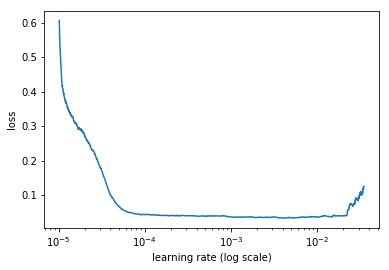

In [50]:
m.sched.plot()

In [51]:
lr = 1e-4 #0.0005

In [52]:
m.fit(lr, 3, metrics=[exp_smape])

                                                                                                                       
 25.0378
 15.4189
 18.7068
 18.2992
 20.2002
 20.4292
 21.7489
 23.2616
 14.7684
 18.2769
 18.3477
 18.8302
 20.9774
 21.3083
 23.2615
 14.9189
 18.2595
 18.4696
 19.4472
 20.0426
 21.6653
 22.9515
 15.1107
 18.6132
 19.0599
 19.4012
 19.7293
 21.6276
 22.5673
 14.7403
 17.6968
 20.0532
 20.9583
 22.2840
 23.9582
 24.9946
 17.0662
 18.4671
 19.8977
 20.9274
 21.7215
 24.0417
 25.0738
 16.7674
 20.5295
 19.4746
 21.2045
 23.1031
 24.8250
 25.2305
 16.7550
 19.2404
 19.9508
 20.9269
 22.9706
 23.6532
 25.0348
 15.9120
 19.4662
 19.3562
 22.2774
 17.1392
 18.6600
 19.3468
 11.8073
 14.2814
 14.2729
 15.8367
 16.1073
 16.8069
 18.5715
 11.3019
 13.4944
 14.2401
 15.1074
 16.2225
 17.4940
 18.8042
 11.4374
 13.4242
 13.5618
 15.2493
 15.2724
 16.8692
 18.2699
 11.3464
 14.4471
 14.5706
 14.7811
 15.1008
 16.6188
 18.7642
 35.8443
 22.2165
 26.7818
 26.2775
 28.8756
 28.326



 16.4335
 18.3236
 19.6745
 20.4541
 21.2628
 13.7635
 16.5189
 16.4546
 18.3538
 14.2143
 15.7105
 16.6329
  9.9670
 11.8382
 11.9170
 12.8279
 13.2450
 13.8880
 15.0758
  9.7599
 11.4841
 12.0622
 12.6579
 13.5249
 14.7302
 15.2975
  9.9063
 11.1125
 11.3909
 12.6423
 13.0083
 14.4569
 15.3984
  9.8240
 11.8847
 12.0863
 12.2651
 12.7891
 14.2538
 15.5420
 19.1654
 11.7312
 13.9927
 14.1495
 15.1798
 16.0524
 16.9472
 17.9558
 11.4257
 13.5361
 13.9391
 14.2415
 15.5776
 16.1080
 17.4265
 11.3611
 13.8735
 14.0998
 14.3471
 15.3819
 16.8297
 17.6331
 11.3669
 13.6921
 13.9208
 14.8026
 15.1077
 16.2392
 17.2364
 11.3773
 13.2726
 15.4160
 16.1779
 17.1891
 18.6320
 19.2392
 12.9668
 14.1997
 15.0810
 15.9217
 16.5467
 18.6974
 18.9215
 12.9596
 15.5113
 14.6025
 16.5449
 17.5984
 19.0395
 19.3978
 12.8270
 14.4511
 15.0338
 16.0857
 17.9018
 18.1028
 19.6806
 12.3814
 14.9824
 14.8144
 16.8502
 12.9617
 14.0152
 14.9583
  9.0502
 10.7173
 10.7358
 11.7618
 11.9856
 12.7462
 13.7115



  86.5861
  91.7922
  97.9262
  66.2652
  74.4727
  76.4870
  82.3493
  85.5848
  93.5639
 100.5476
  66.2179
  78.2188
  77.6684
  81.9537
  84.0422
  90.1813
  94.7445
  66.0548
  77.1808
  80.2634
  87.8161
  93.2483
  99.4329
 103.9033
  69.4472
  77.8037
  79.6413
  85.0002
  91.1528
 100.6265
 103.0847
  70.4573
  85.4995
  82.3475
  88.7468
  95.5180
  97.9020
 102.5381
  69.4750
  81.0675
  85.0117
  88.2309
  96.1716
 100.9858
 103.8122
  69.0225
  81.4825
  81.2985
  90.0920
  69.9068
  77.7205
  81.6814
  50.8419
  58.8664
  58.7789
  64.1098
  66.9561
  71.8819
  76.4016
  49.2828
  58.8680
  59.1519
  64.5595
  65.6094
  72.6856
  78.4760
  50.3640
  58.3086
  58.8417
  66.6805
  63.0809
  72.9496
  76.7774
  49.2767
  55.8265
  57.2468
  62.7035
  63.7918
  70.0167
  78.0569
  91.7272
  59.8697
  68.3235
  69.4735
  74.5952
  74.1793
  79.3383
  88.4518
  60.6739
  71.1302
  69.2976
  73.9339
  78.6688
  81.3919
  89.3936
  58.2517
  66.1065
  69.0592
  74.2799
  77.493



 27.2260
 31.3963
 31.7058
 33.7019
 36.6664
 36.6311
 39.1784
 26.4343
 31.5569
 32.3767
 32.9958
 36.5096
 37.4256
 39.4111
 27.8427
 30.8606
 30.5877
 33.5464
 36.2048
 37.8379
 38.9523
 26.1772
 31.2033
 30.4410
 32.9101
 33.7234
 36.1948
 42.4361
 98.6181
 65.0569
 72.3195
 73.2292
 80.1279
 80.7814
 84.7334
 94.0855
 65.5810
 74.5171
 72.0305
 78.5549
 81.8008
 86.5634
 92.5284
 62.7917
 70.0663
 72.1895
 79.4590
 80.6556
 85.9719
 92.9359
 64.0070
 74.9267
 74.0604
 80.2549
 82.0699
 86.2316
 92.1398
 64.6018
 75.1768
 74.9638
 85.4352
 89.7364
 93.7270
 98.5134
 66.2505
 74.3842
 75.5768
 82.0454
 87.4656
 93.8450
 97.0084
 66.9241
 80.4686
 77.1271
 85.1757
 92.2733
 91.9020
 97.2168
 65.7992
 75.8717
 77.7609
 83.9518
 89.1253
 93.8638
 98.9403
 65.9663
 77.4093
 76.5706
 85.4589
 67.6849
 73.1710
 77.0982
 48.8916
 57.5082
 56.1769
 60.1979
 63.5102
 66.9421
 72.6562
 48.3962
 58.1953
 56.9081
 61.1987
 64.3049
 69.8962
 72.5260
 48.9233
 54.9701
 55.8258
 62.3328
 62.1524



 42.0007
 44.0557
 45.6133
 47.9553
 51.7828
 33.9370
 41.8536
 43.4848
 46.9923
 48.7743
 53.1727
 55.5594
 35.8885
 40.7719
 43.3821
 44.4774
 47.1537
 53.9170
 55.3578
 37.1068
 44.9264
 42.8093
 45.8002
 49.9051
 53.9799
 55.0944
 36.9858
 42.9463
 44.1212
 45.8127
 49.8226
 53.1252
 54.8569
 36.2523
 43.0946
 42.7688
 49.1249
 36.6646
 41.8476
 43.0970
 26.9233
 31.4778
 30.8124
 32.2661
 36.0458
 38.2210
 40.0759
 25.8393
 31.4606
 31.6060
 32.9879
 35.9673
 37.4475
 40.3307
 26.4156
 30.6087
 31.0424
 32.3338
 34.3025
 37.7102
 40.9720
 26.1015
 30.2334
 31.1962
 30.6000
 31.8756
 37.1196
 40.0393
 53.3754
 32.9135
 38.0229
 38.7356
 40.1965
 43.3279
 43.7418
 50.2044
 32.8819
 39.0019
 37.5955
 40.4200
 43.5197
 43.6684
 47.3027
 31.2108
 36.7962
 37.0207
 39.5127
 41.4043
 44.2535
 47.9477
 33.1096
 38.3521
 37.9975
 41.1240
 41.2458
 44.1172
 48.7651
 32.2822
 38.1552
 38.9317
 42.1922
 45.4500
 48.1168
 49.5410
 34.2244
 37.5925
 39.2743
 41.5237
 46.2769
 49.1875
 49.1203



 41.0244
 44.0165
 28.7653
 33.0935
 34.2073
 36.4421
 37.6269
 40.5116
 43.0844
 28.4329
 33.2675
 33.9272
 35.2916
 36.2303
 40.0698
 44.4654
 51.6691
 31.7441
 38.0685
 38.6520
 38.5522
 41.7014
 43.4331
 49.6084
 31.5819
 38.2874
 37.2015
 38.4072
 43.1494
 44.5880
 49.1650
 31.2083
 37.8526
 38.9165
 39.7094
 41.2096
 45.4171
 49.9010
 30.4915
 39.1144
 38.5571
 39.4472
 40.5424
 44.3791
 48.8283
 30.9043
 38.3065
 39.5474
 41.4236
 46.2775
 49.3906
 51.0391
 33.3562
 36.8297
 39.5179
 40.4765
 45.2051
 51.3563
 50.5006
 33.5665
 42.1231
 40.1982
 40.4938
 46.9744
 49.8670
 51.2483
 33.0901
 39.0164
 41.7037
 41.2315
 46.8568
 49.5910
 52.2345
 33.6334
 38.6488
 39.3295
 43.9658
 35.0679
 38.0710
 40.2262
 24.2416
 29.9760
 28.7435
 30.6214
 33.4299
 35.6397
 38.4210
 23.6839
 29.4752
 29.8861
 30.4962
 33.1560
 34.9524
 38.3673
 24.2252
 29.5561
 28.7427
 30.2074
 32.0899
 35.0186
 38.1037
 22.8411
 28.5968
 29.4720
 29.8732
 30.2744
 33.9761
 37.1329
 56.7936
 34.6633
 39.8523



 20.2333
 22.7921
 23.9232
 24.9834
 27.0843
 29.8551
 30.1215
 20.2539
 24.1902
 23.9854
 24.9437
 27.7525
 29.1336
 30.1236
 20.7596
 23.2016
 24.2279
 24.8454
 28.2865
 29.1328
 29.7624
 19.4356
 23.3050
 23.2882
 26.6637
 20.5893
 22.1738
 23.4783
 14.5387
 17.5937
 16.8682
 18.9123
 19.9066
 21.0182
 22.2847
 14.1519
 16.8253
 17.3962
 18.8472
 20.1882
 21.1111
 22.2140
 14.0870
 16.6347
 16.4886
 18.3214
 19.0378
 20.2928
 21.6017
 13.8335
 17.0407
 17.2579
 18.1302
 18.0514
 20.1496
 22.0551
 21.2021
 13.4586
 16.3000
 16.6827
 17.7867
 18.8931
 19.5722
 20.5704
 13.2162
 15.7964
 16.0824
 16.6365
 19.0431
 18.3719
 20.4474
 13.1800
 15.6907
 16.1343
 17.1397
 18.1028
 19.0823
 20.4244
 13.3711
 15.5797
 16.3570
 17.1123
 17.6529
 18.6879
 19.7820
 13.0909
 15.5636
 17.5299
 18.7146
 20.1087
 21.1552
 21.7218
 14.9374
 16.6711
 17.6342
 18.6567
 19.9859
 21.5154
 22.3594
 15.1657
 18.1263
 17.3513
 18.7196
 20.4685
 21.8120
 21.6485
 14.9104
 16.8537
 17.6973
 18.9779
 21.4687



 18.0497
 17.5949
 19.5539
 21.1279
 33.5661
 20.0150
 23.4180
 24.2892
 25.5300
 26.3682
 28.2353
 31.2823
 20.9766
 23.7297
 24.6068
 25.0430
 28.2836
 28.3602
 30.7798
 19.9578
 23.3009
 23.6796
 25.7640
 26.4828
 29.4627
 31.0785
 20.0712
 24.3971
 24.4537
 25.5234
 25.5733
 28.7249
 30.2917
 19.9076
 22.7142
 25.5157
 27.6068
 29.4043
 32.9594
 33.3115
 22.3049
 24.4032
 25.6545
 26.9522
 27.8007
 33.0380
 34.0505
 22.9121
 27.2070
 25.4160
 27.1586
 29.4895
 32.6574
 33.7483
 22.3344
 25.5555
 25.9416
 27.4632
 29.5517
 31.9963
 33.6052
 21.5994
 24.8614
 24.6674
 28.4509
 21.7926
 23.6130
 25.4656
 15.7363
 18.4924
 17.7674
 19.5664
 20.9403
 22.5068
 24.3568
 15.0487
 18.1626
 18.4499
 19.9292
 21.7240
 22.6705
 23.7967
 15.4438
 18.0043
 17.8699
 19.4337
 20.4231
 22.1250
 24.2316
 15.0058
 18.2032
 18.4274
 19.1485
 18.8448
 21.5067
 21.8213
 20.3413
 12.6401
 15.7278
 15.6336
 16.8701
 17.2684
 18.6157
 19.8954
 12.4454
 15.2172
 15.7665
 16.0115
 18.2544
 17.7939
 20.0376



 18.6358
 17.9344
 12.0543
 13.6903
 14.5699
 15.8945
 17.4318
 17.2339
 18.8401
 11.6106
 14.3411
 14.1313
 15.6399
 12.4583
 13.7360
 14.3324
  8.4041
 10.1867
 10.1824
 11.1984
 11.4829
 12.2029
 13.2215
  8.4159
  9.7953
 10.5155
 10.9271
 11.7723
 12.7081
 13.4769
  8.5491
  9.5731
  9.8093
 10.8311
 11.0695
 12.4872
 13.2469
  8.2099
 10.2315
 10.3439
 10.5944
 10.8950
 12.2459
 13.3570
 17.8416
 11.0383
 13.2781
 13.4821
 14.0773
 15.0453
 15.8179
 17.2374
 10.8207
 12.7648
 13.3454
 13.2746
 15.7217
 14.8109
 16.5727
 10.6159
 13.2278
 13.3005
 13.3697
 14.7380
 15.4237
 16.9930
 10.7033
 13.1099
 13.4985
 13.7951
 14.8238
 15.8211
 16.8058
 10.7836
 12.5848
 14.7994
 14.9844
 16.7273
 17.7017
 18.3527
 12.1301
 13.8920
 14.6392
 14.9465
 15.5799
 17.4749
 18.3222
 12.2915
 14.7818
 14.2079
 15.4881
 16.5643
 17.9416
 17.9566
 12.2900
 13.5425
 14.2456
 15.4920
 16.8351
 17.5081
 18.4151
 11.6830
 14.1481
 14.0867
 15.5163
 12.2011
 13.3615
 14.0064
  8.4091
  9.9911
 10.2335



  46.1802
  53.3632
  52.0556
  56.7846
  59.4071
  62.1318
  66.5366
  43.9387
  51.1372
  51.6232
  57.4437
  57.4842
  63.4340
  68.8011
  44.9887
  54.5351
  52.4755
  57.9638
  58.5659
  63.3964
  66.8442
  45.2531
  54.4214
  54.0972
  61.5970
  62.6132
  67.4952
  69.0171
  48.5891
  53.3761
  54.1629
  58.8214
  62.3561
  70.1284
  69.7019
  48.2399
  58.0451
  56.0915
  60.5363
  63.9000
  66.4508
  71.1514
  46.9277
  54.9176
  57.0090
  60.5772
  62.8513
  67.8635
  70.9528
  47.4143
  55.1142
  54.9495
  65.0280
  48.0107
  53.4476
  56.0031
  33.9737
  40.4788
  39.0819
  43.3744
  45.5088
  48.0210
  53.3844
  33.4037
  40.5828
  40.2212
  43.4301
  45.9177
  48.3662
  52.5753
  34.8709
  39.7501
  39.5224
  42.8514
  44.6822
  48.3036
  51.8238
  33.2336
  39.1260
  38.3160
  43.9125
  42.0914
  47.8006
  55.0649
  97.6752
  64.2128
  73.1616
  76.1927
  80.3883
  82.3766
  89.0098
  97.1099
  66.0567
  76.6928
  74.2334
  80.2810
  85.0293
  89.0287
  95.7952
  63.910



 52.1330
 40.9254
 44.5385
 45.0265
 28.3762
 34.3909
 33.1603
 35.4772
 38.7080
 39.0641
 42.4889
 28.3649
 34.5438
 33.9573
 34.8558
 39.5141
 39.7065
 42.1968
 29.5519
 33.2647
 33.6908
 35.8066
 38.6242
 40.4975
 41.4992
 28.5728
 34.2673
 33.5126
 34.8739
 35.7604
 38.9874
 44.6551
 50.2407
 34.5298
 40.3371
 38.9483
 42.1325
 45.1728
 47.0751
 51.4039
 34.0240
 39.3806
 39.2918
 41.9662
 45.3117
 46.6199
 49.1597
 33.4119
 38.4595
 39.9039
 43.0466
 43.7374
 47.6769
 50.6465
 33.5261
 41.8401
 40.5901
 42.3755
 45.1136
 46.0175
 48.0215
 34.0933
 40.7082
 40.6452
 45.2332
 47.1974
 50.5174
 50.9704
 36.7258
 39.5717
 40.7994
 43.7980
 46.0980
 51.4470
 51.2480
 36.2433
 44.1041
 42.5900
 44.6158
 48.0781
 49.8946
 52.2765
 36.4904
 42.0616
 42.9953
 45.4887
 49.2567
 50.6635
 52.5190
 36.4890
 43.3278
 41.1148
 50.1746
 37.5890
 39.7226
 41.3502
 25.4499
 30.3288
 30.1645
 32.4230
 35.0584
 35.6621
 38.8168
 25.4305
 30.2510
 30.9482
 31.2831
 35.2428
 35.9722
 38.0005
 26.5161



 91.7095
 98.4479
 65.4333
 77.6917
 75.7549
 79.6454
 81.3780
 87.9352
 92.3315
 63.1544
 76.7032
 77.2822
 85.3151
 89.7493
 95.4045
 99.4222
 68.0055
 75.7398
 77.2500
 83.3346
 88.9286
 97.4713
 98.8236
 68.9060
 81.1295
 79.4800
 85.4319
 92.5441
 94.1758
 99.9219
 67.0185
 78.2651
 81.7821
 85.8282
 92.9867
 96.6160
 99.9716
 66.6067
 78.1117
 77.7766
 87.3234
 67.0306
 76.2200
 79.4042
 49.5256
 56.7901
 57.3191
 61.3646
 64.5377
 70.0117
 76.1966
 48.0255
 57.7382
 57.9590
 62.7527
 63.0485
 71.0459
 75.8869
 49.8301
 56.5255
 56.2152
 64.7278
 61.1795
 71.3135
 75.1974
 48.7620
 55.4132
 55.7678
 61.2736
 61.8882
 69.2156
 74.8470
 90.0470
 56.9552
 65.4755
 66.9922
 70.0568
 72.4517
 75.9457
 84.4104
 58.9631
 67.8638
 67.1480
 70.9533
 76.3204
 79.6818
 85.9575
 55.6149
 64.6807
 67.1116
 71.9711
 74.4246
 81.0866
 86.3095
 58.0213
 68.7910
 68.5868
 69.7404
 73.0080
 76.1174
 80.4048
 56.6990
 68.0779
 69.9293
 74.7970
 80.2801
 83.8668
 87.0826
 60.5894
 66.5545
 69.2199



 31.2551
 32.0578
 32.5576
 35.4995
 36.8228
 39.0115
 27.8201
 31.1347
 30.8665
 33.1959
 35.5338
 37.4482
 39.4914
 26.6128
 31.0310
 30.7271
 32.3481
 33.6311
 35.8994
 40.8896
 98.8838
 62.8404
 70.7491
 71.6149
 76.6505
 79.4524
 82.4049
 91.6311
 63.5764
 72.9100
 69.8074
 74.9390
 79.4642
 83.9971
 90.7205
 59.9524
 69.6279
 70.0066
 76.1001
 78.4305
 84.3065
 90.7765
 62.2906
 74.1400
 72.0908
 77.8145
 79.1657
 83.8366
 88.6409
 61.3736
 74.1554
 73.0326
 82.7658
 85.6658
 91.2951
 95.0080
 65.1312
 71.7991
 73.9152
 80.4450
 87.0041
 92.5287
 94.6296
 65.3738
 78.4643
 75.6833
 81.6055
 89.2569
 89.5474
 96.0544
 63.3952
 74.2006
 76.3587
 80.7040
 87.3616
 91.1411
 96.1630
 64.0747
 75.1519
 74.5625
 82.5480
 65.8813
 72.9347
 75.7414
 48.2853
 56.0156
 54.3688
 58.7988
 61.6854
 66.7149
 72.3830
 47.4106
 57.1589
 56.4313
 60.4353
 62.1116
 68.5666
 72.1668
 48.7447
 53.8727
 54.5237
 60.7073
 61.0455
 67.6163
 71.6076
 47.6631
 55.0170
 54.1812
 58.3776
 59.8067
 67.0238



 101.2802
 108.1513
 113.8486
 120.6898
  83.5421
  92.1295
  94.8939
 100.9335
 106.1099
 112.9216
 118.0793
  81.9975
  98.7348
  95.8932
 101.2629
 110.3366
 110.9748
 119.4282
  81.0235
  93.9813
  96.9744
 101.5509
 110.7093
 114.9455
 118.5998
  82.1187
  93.8404
  95.2104
 105.4691
  81.5860
  89.5191
  94.3238
  58.9927
  69.1066
  69.1256
  73.6001
  78.7726
  83.7631
  90.1367
  57.8757
  67.5263
  68.8381
  73.9706
  78.4002
  84.1067
  89.1694
  58.9306
  67.8191
  67.7439
  76.1844
  74.9868
  84.9970
  90.4181
  58.5239
  66.5682
  66.5164
  71.3011
  73.8976
  82.1674
  89.8411
 111.5385
  73.1833
  80.9880
  81.5532
  88.5038
  93.5963
  95.5313
 103.6855
  73.4146
  83.7209
  79.8312
  87.6588
  91.8471
  96.4540
 103.5645
  72.4130
  80.0335
  78.5774
  86.0962
  89.8453
  95.7760
 104.3397
  72.9474
  83.5705
  82.8127
  90.1625
  92.0047
  99.3524
 102.1557
  72.6191
  83.6264
  83.2670
  93.4972
  96.7703
 106.2423
 109.8093
  76.6412
  83.4656
  83.9711
  92.344



  97.1671
  63.8722
  73.7151
  74.7603
  78.1504
  81.8685
  92.0340
  98.3597
 109.0526
  69.8348
  80.0811
  82.0175
  88.1190
  92.9484
  97.6237
 105.1206
  73.4089
  83.0688
  80.7353
  87.4503
  93.8807
 100.0834
 105.4945
  72.2994
  81.8367
  82.3270
  86.9301
  93.0094
 100.7375
 106.2165
  71.1167
  83.5646
  83.7606
  87.9992
  93.2238
 100.0848
 104.9291
  71.8883
  83.8911
  83.3074
  92.5992
 101.2923
 106.7729
 111.3568
  76.5336
  82.6583
  84.3902
  92.5621
  99.5154
 108.0537
 111.3282
  72.3152
  88.7917
  83.9210
  93.4590
 100.2184
 103.3920
 107.2859
  73.8354
  84.1423
  88.1785
  92.2313
 101.8613
 107.0224
 109.1294
  73.5389
  82.7645
  84.4558
  94.3901
  78.3480
  83.6006
  88.7891
  55.7676
  65.1333
  63.8898
  68.7946
  74.3107
  77.8881
  80.8339
  53.1776
  63.7928
  63.5200
  67.7944
  72.2745
  77.3636
  80.2321
  54.0696
  63.5549
  64.2184
  68.9041
  72.7007
  78.0298
  83.1335
  53.6752
  63.0483
  62.7694
  64.9700
  71.1365
  76.1663
  84.883



 57.3094
 56.7366
 60.8275
 65.9494
 66.4981
 71.5103
 47.9198
 54.7561
 57.7050
 60.9364
 65.2259
 69.0799
 71.6423
 48.6691
 55.3436
 55.2424
 63.0522
 48.2207
 54.6564
 57.1475
 36.0413
 41.9534
 40.8159
 44.5298
 46.2595
 48.9428
 54.4945
 35.7960
 42.0187
 41.8612
 44.9094
 46.6300
 50.7753
 53.6399
 36.2330
 41.4379
 41.1598
 44.4386
 46.1014
 50.6468
 52.5471
 35.1034
 41.0303
 40.3142
 44.0315
 43.6729
 49.3022
 56.6396
 49.3833
 34.3907
 38.7860
 37.8512
 41.4092
 42.8951
 44.6761
 48.1263
 34.3472
 38.8958
 37.9442
 40.5646
 44.0422
 46.3439
 48.3709
 32.8486
 37.5812
 37.7570
 42.5768
 42.5263
 45.6666
 47.5702
 33.2301
 39.2817
 38.8197
 41.5048
 42.7057
 46.0170
 48.0640
 34.0294
 39.2894
 39.3909
 45.2668
 47.0660
 49.6998
 50.3491
 35.9008
 38.1960
 39.6330
 44.0667
 44.9331
 51.2291
 50.9282
 36.2186
 42.2372
 40.2634
 44.5341
 47.7748
 48.7839
 51.3591
 35.9151
 39.8325
 40.1962
 45.1903
 47.6043
 51.3634
 50.9147
 36.0637
 40.5420
 39.5950
 46.1356
 36.6451
 40.5229



  61.0121
  63.3691
  66.8019
  74.3383
  50.6835
  59.4526
  57.9489
  61.3100
  65.7034
  69.9926
  74.4339
  49.0838
  56.4710
  57.1361
  62.2503
  63.8862
  70.1642
  75.1308
  49.1768
  58.6779
  58.6285
  60.5492
  62.7170
  68.2755
  72.5081
  49.6965
  58.0677
  60.3192
  64.9938
  71.3818
  74.2567
  76.5146
  52.3654
  59.1603
  61.7201
  63.3369
  68.7234
  76.0552
  77.8359
  53.4848
  63.7453
  61.8957
  65.4226
  72.4645
  73.2653
  77.4170
  52.2027
  60.9772
  64.0806
  65.8473
  72.1034
  75.7163
  77.6534
  52.6851
  60.7234
  60.8337
  69.1220
  53.2460
  59.3795
  61.4780
  38.4228
  44.8046
  44.1693
  47.7621
  50.9127
  53.9864
  59.2545
  37.1728
  45.1992
  45.0875
  48.3932
  50.8834
  54.7548
  58.5041
  37.9546
  44.9437
  44.4898
  47.7884
  49.3604
  55.4209
  57.9560
  37.9895
  43.3562
  43.7088
  47.1613
  46.0308
  53.2666
  58.7777
  85.4777
  59.8023
  65.6501
  66.3170
  73.2219
  76.2386
  79.2321
  86.7879
  60.8518
  68.8684
  65.0197
  72.357



  73.0696
  52.2501
  58.0002
  58.4242
  66.6456
  51.8844
  57.8025
  59.7019
  37.6848
  44.5673
  42.6802
  46.4350
  49.2909
  51.4578
  55.9587
  37.2466
  45.0495
  42.8123
  47.1453
  49.0778
  52.3020
  54.6577
  38.6202
  43.8164
  43.5817
  46.4684
  49.1364
  53.3151
  55.7123
  37.2622
  43.5440
  42.7236
  46.2393
  46.1984
  51.6970
  57.7818
  70.4243
  49.6843
  54.5604
  56.3752
  60.0707
  62.1711
  65.8250
  71.6889
  50.1769
  58.0732
  56.4406
  60.2078
  63.7918
  67.4869
  71.4032
  48.6005
  53.9532
  56.4090
  61.2410
  62.6630
  67.0207
  71.7235
  49.8201
  57.1068
  56.8196
  60.3047
  63.4403
  64.6693
  69.5809
  49.0796
  56.7832
  58.1926
  64.1882
  66.8494
  69.3859
  72.0595
  53.2805
  57.2645
  59.6696
  63.0551
  65.8781
  72.5130
  72.6747
  52.3602
  62.0468
  59.6293
  63.1585
  68.4991
  69.1349
  72.8516
  53.3008
  59.2201
  60.1704
  65.2885
  67.0934
  70.8140
  72.2631
  53.6144
  59.4927
  59.4898
  66.7526
  51.2404
  57.1789
  58.319



  62.3652
  62.4232
  69.9761
  70.8521
  76.6495
  82.6791
  55.6836
  65.7295
  63.6743
  68.5419
  72.0213
  76.1652
  80.2501
  56.1536
  63.6904
  65.2413
  74.3419
  77.5925
  83.4317
  85.9682
  58.9236
  64.1860
  65.8469
  72.5544
  77.5184
  84.2730
  85.3871
  60.5840
  69.6134
  68.1666
  74.2366
  79.7516
  81.6990
  86.8508
  57.9372
  67.4759
  69.0703
  74.5990
  78.7563
  84.2603
  87.0406
  58.0455
  67.0475
  67.2161
  76.4526
  59.0376
  64.6129
  69.0553
  42.8245
  49.1323
  48.3164
  52.5676
  55.5073
  59.2700
  64.3939
  41.9125
  50.0971
  49.6439
  52.7607
  55.7220
  59.1735
  61.9905
  42.5315
  48.9115
  48.1529
  53.2236
  54.9904
  60.6781
  63.1125
  41.6474
  48.0887
  47.9929
  52.8116
  52.7999
  58.4916
  66.4786
 116.3492
  76.9860
  88.1376
  91.8905
  94.0471
  99.2556
 104.4896
 113.6435
  79.4705
  90.7233
  89.6177
  94.0162
 100.4913
 106.9254
 113.5635
  78.5043
  87.1210
  88.3454
  96.5067
  99.7989
 108.3450
 117.0588
  78.2782
  90.540



  46.7258
  49.2567
  52.7417
  34.4710
  41.9708
  42.3883
  43.5475
  46.3002
  50.7425
  52.1356
  35.6404
  40.3676
  41.5574
  44.1202
  46.2344
  51.1381
  52.1808
  35.3703
  41.6190
  41.5538
  41.7277
  43.1493
  49.0148
  53.9343
  60.5781
  43.1076
  47.5182
  47.2732
  50.3528
  54.0290
  57.6372
  61.6122
  41.9041
  47.6181
  48.2404
  51.2959
  55.5974
  56.4692
  59.0496
  41.3949
  46.6346
  48.3836
  51.9270
  53.9824
  58.1058
  62.0302
  41.5607
  49.4979
  48.7145
  51.2618
  54.4183
  56.1591
  58.3003
  41.3673
  48.9870
  49.4651
  55.2179
  57.8752
  61.5579
  63.2223
  44.7751
  47.7908
  49.5368
  53.4727
  55.8208
  62.0530
  63.8809
  45.2772
  53.0082
  51.0464
  54.1893
  58.2993
  59.7872
  64.0957
  45.1585
  50.4152
  51.1378
  55.9740
  59.0986
  63.0078
  64.4758
  44.7928
  50.5634
  49.5931
  60.1338
  45.5917
  49.2283
  51.0838
  31.7944
  36.7096
  37.7689
  39.3815
  42.0707
  44.5481
  47.8126
  31.0713
  37.2897
  38.6569
  38.9101
  41.668



 113.0182
  78.0927
  91.0662
  94.6600
 105.0484
 109.2820
 117.1659
 123.1663
  84.2538
  93.9127
  95.4254
 102.6572
 108.0928
 117.6702
 123.2500
  84.1758
 101.4794
  98.1242
 103.7016
 109.7863
 115.7339
 121.7362
  81.3866
  96.2723
 100.0475
 104.5307
 112.6896
 118.7698
 122.0233
  81.3599
  96.9336
  96.0749
 103.6411
  82.6054
  92.3326
  96.4158
  61.3410
  69.3540
  70.0902
  75.5657
  79.1133
  86.4976
  92.2162
  58.6338
  68.3011
  69.4757
  76.9477
  77.1487
  87.2369
  91.8942
  61.4398
  67.9008
  68.4081
  78.9090
  76.2233
  86.9370
  92.3923
  59.6690
  66.1476
  67.3775
  75.0283
  75.7120
  85.6985
  91.5329
 105.2903
  69.2743
  79.5258
  81.7484
  85.3709
  87.1727
  94.0422
 103.5004
  72.1964
  83.3736
  81.8504
  86.0353
  91.1686
  96.8065
 104.2378
  68.8466
  78.2324
  81.2741
  88.4202
  89.7787
  98.1068
 105.6304
  68.3752
  83.3881
  82.3970
  85.4317
  88.5840
  94.4750
  99.3247
  69.1727
  82.9457
  85.9645
  92.3743
  97.9311
 103.3804
 108.774



  37.9701
  40.0801
  42.4230
  44.8787
  47.6954
  31.7919
  37.1685
  36.1058
  38.9889
  40.2716
  43.6695
  50.0773
 112.7664
  76.2621
  86.0448
  88.3921
  92.5177
  96.8162
 100.2870
 110.1588
  78.5449
  89.3866
  86.5357
  90.3751
  97.4819
 103.1698
 109.7401
  73.6783
  84.7426
  85.6170
  90.9694
  95.8021
 102.4687
 109.7976
  75.6066
  90.0684
  88.1626
  93.8817
  97.3942
 103.2770
 109.1654
  75.5833
  91.3812
  90.1919
 101.0110
 106.0263
 111.7993
 118.0510
  81.5428
  90.5568
  92.5893
  97.5301
 106.3786
 113.1385
 117.2484
  80.7268
  97.8377
  93.6599
 100.6134
 108.2075
 110.7420
 116.3199
  78.1307
  93.2825
  94.0497
  99.6137
 107.3729
 112.7753
 117.3220
  78.1814
  93.2709
  91.5970
  99.6467
  81.5561
  88.5479
  91.5607
  59.8269
  69.0678
  67.5727
  71.6419
  76.2981
  82.8339
  89.0301
  56.4837
  68.2974
  69.3401
  73.2503
  75.2715
  84.0942
  87.9453
  60.1694
  66.3237
  67.4547
  73.7195
  74.7256
  83.0379
  87.5281
  57.6087
  66.2984
  67.528



 114.7323
 124.1583
 131.4931
  90.2300
 108.1319
 105.2488
 112.2673
 118.5470
 120.7008
 130.1553
  89.5127
 103.1139
 107.6482
 112.3749
 119.8722
 127.5662
 130.8596
  88.7210
 103.9608
 105.6794
 112.1094
  88.8910
  98.5291
 102.3598
  65.8078
  77.3321
  75.9064
  80.0959
  86.7390
  91.8110
  97.3579
  64.3861
  74.4909
  76.5283
  82.6148
  84.9430
  92.3544
  96.6650
  65.2967
  74.6312
  74.3268
  83.4443
  82.6152
  93.0074
  97.1561
  64.2896
  73.0776
  73.5994
  79.2509
  82.0252
  91.2527
  96.5573
 114.4843
  80.1547
  89.3483
  90.4409
  98.0578
 102.7195
 104.4626
 114.0591
  81.6075
  92.1161
  88.3867
  97.1774
 102.8838
 105.9915
 112.0748
  79.5089
  88.4179
  87.5833
  95.5862
 101.1867
 105.8564
 112.8864
  81.4908
  92.4322
  91.9650
  99.8249
 103.7804
 109.7185
 113.0145
  80.5080
  90.4454
  92.2162
 103.7013
 110.4397
 118.9536
 122.2745
  85.3177
  93.1749
  91.9851
 103.2158
 110.2550
 117.0952
 120.3879
  83.7877
  96.7749
  94.7310
 104.9544
 111.922



 112.1361
  78.3246
  87.7229
  89.6167
  96.4208
 102.2217
 106.9105
 113.5024
  80.4448
  89.9464
  88.3805
  96.7100
 102.5375
 107.9274
 111.1475
  79.6170
  90.7961
  90.9722
  96.1414
 101.6387
 108.8785
 114.5644
  78.3822
  92.1694
  91.7129
  96.2464
 101.6841
 108.5683
 114.6050
  78.6549
  88.2684
  91.9667
 102.9437
 112.1365
 117.8277
 121.1081
  83.2818
  91.8943
  92.5991
 102.6722
 108.8447
 116.5106
 121.4710
  80.8846
  96.8689
  92.2813
 102.6446
 109.9485
 113.6118
 116.0994
  82.3981
  91.7304
  96.2140
 101.9865
 110.5168
 119.5887
 119.7272
  80.6005
  91.1225
  94.4994
 102.3115
  85.7698
  91.9907
  95.5036
  61.8918
  71.4722
  70.2824
  75.9550
  81.3402
  86.0271
  88.0849
  58.8912
  69.9957
  69.1195
  76.1357
  78.9498
  84.7892
  87.4318
  59.8523
  69.1243
  70.2433
  74.7772
  79.6604
  86.4857
  89.6874
  60.1513
  68.1281
  69.2933
  72.6986
  77.8977
  84.6425
  90.4710
 125.3611
  83.2370
  93.6900
  96.9306
 104.2459
 107.3948
 115.1138
 121.535



 66.9781
 70.1127
 75.4016
 79.2004
 84.3672
 56.5002
 65.1989
 64.8056
 73.9063
 57.6388
 63.2394
 65.6393
 42.5312
 48.7434
 48.2628
 51.6630
 55.1229
 56.8461
 62.8217
 41.8721
 48.6737
 47.9193
 51.6117
 54.8992
 57.8218
 61.7100
 41.8778
 48.1411
 47.0076
 51.6548
 54.3437
 58.5536
 60.9643
 40.5755
 47.2719
 46.5784
 51.1495
 51.3059
 56.9273
 65.4648
 58.8494
 39.3110
 43.5201
 43.9492
 47.5647
 50.4643
 52.3581
 56.9996
 38.7146
 44.5805
 44.2990
 47.2834
 51.3740
 52.8364
 56.0261
 37.2110
 42.8437
 44.0165
 48.7568
 48.5778
 53.3139
 56.3171
 38.0353
 44.7395
 44.5703
 48.3444
 50.2290
 52.7125
 55.1829
 38.5999
 45.5747
 45.1266
 51.8785
 53.8157
 57.1473
 57.5594
 41.3216
 44.5650
 45.1027
 50.3655
 52.5289
 58.7424
 58.6809
 42.0663
 48.2157
 46.6775
 51.5382
 55.4921
 56.5196
 59.8112
 40.6684
 45.5255
 46.4143
 50.4312
 54.9996
 57.8372
 59.7569
 41.3518
 45.9773
 45.5702
 54.2138
 42.4327
 45.7650
 47.2433
 29.5453
 34.4409
 33.3707
 37.4429
 40.1607
 40.6390
 44.2727



  76.5320
  79.3259
  85.7018
  57.4830
  65.6528
  67.7381
  71.2698
  74.0096
  80.0298
  86.4789
  56.3420
  68.5278
  67.5353
  71.9219
  73.3682
  78.4355
  82.4050
  57.6368
  68.3633
  70.1587
  76.2523
  81.8548
  85.9514
  89.2255
  60.9673
  69.3697
  71.0315
  73.9222
  80.1441
  88.0897
  89.6909
  61.7643
  74.3890
  72.2151
  77.1157
  84.3892
  84.4896
  90.1103
  59.7518
  70.6703
  72.2845
  77.1698
  82.6211
  86.1161
  89.4033
  60.3241
  70.9176
  70.0986
  81.8241
  61.5177
  67.6306
  70.5317
  45.1131
  51.9307
  51.4350
  55.3893
  59.4750
  62.8267
  67.2208
  43.1184
  52.4683
  51.3929
  55.7034
  59.0503
  62.0349
  66.8025
  45.0040
  52.1305
  51.4397
  55.8097
  56.9041
  62.9632
  67.5020
  44.1652
  50.2520
  50.5116
  54.0553
  53.7056
  60.3185
  67.6917
 105.9721
  72.1371
  80.4723
  81.4105
  87.6754
  94.3302
  97.2649
 103.3963
  74.4467
  82.4640
  79.7596
  88.2256
  94.1024
  96.7872
 102.2754
  72.0452
  79.9596
  80.4766
  88.9558
  91.041



  46.1581
  53.5142
  53.2148
  57.6638
  60.7066
  63.7399
  67.7614
  45.6271
  54.9467
  52.4268
  57.0812
  60.8108
  64.0142
  66.9726
  47.3974
  53.1509
  52.9261
  57.7150
  60.5621
  64.8821
  68.4813
  45.8600
  54.5018
  52.7244
  56.2195
  57.5650
  63.4575
  70.0756
  88.0876
  59.0749
  64.7242
  67.1453
  70.9674
  75.2267
  78.5708
  85.2648
  59.9716
  68.7855
  68.0348
  71.5266
  78.5620
  79.3685
  85.4174
  57.6706
  63.9509
  67.6796
  73.1987
  75.6509
  80.5676
  86.4205
  60.3130
  68.5228
  67.5351
  72.2457
  76.6012
  78.7467
  82.9829
  58.7836
  70.7442
  69.3467
  75.2458
  81.8745
  83.3063
  86.7975
  65.1012
  68.1548
  70.6807
  75.1585
  80.3417
  87.1140
  87.6490
  63.8285
  73.0168
  69.9847
  76.3291
  84.5021
  83.3441
  88.1882
  63.3520
  69.8995
  71.5652
  77.4630
  83.8169
  84.2450
  88.0770
  62.5108
  69.8006
  70.2079
  80.6008
  62.9514
  68.0545
  70.7636
  46.6839
  53.0636
  53.0289
  56.1176
  60.5321
  61.6343
  66.8968
  45.532



 23.2136
 23.5067
 24.0173
 26.0006
 27.1440
 18.0684
 22.3384
 23.8440
 25.6479
 26.7729
 29.3288
 30.6726
 20.3298
 22.5577
 23.8154
 25.0770
 26.1394
 29.2347
 30.3789
 20.3216
 24.8078
 23.9435
 25.4635
 27.7368
 29.8399
 31.0431
 20.7105
 23.5621
 24.1412
 25.6193
 27.8771
 28.7541
 30.6692
 19.7205
 23.6311
 23.4987
 27.1113
 20.6206
 22.5249
 23.3905
 14.3058
 17.2066
 17.1587
 18.8112
 19.8207
 20.2321
 22.2444
 13.6026
 16.4673
 17.2965
 18.3775
 19.4666
 20.8159
 22.4121
 14.0867
 16.5733
 16.3690
 18.2800
 18.6780
 20.3413
 21.6013
 13.9786
 17.1512
 17.4925
 17.8149
 18.3821
 19.9528
 22.9132
 43.9706
 27.6009
 31.9916
 33.0700
 35.0886
 34.4811
 38.9518
 43.5790
 27.5852
 32.9809
 32.7160
 35.3604
 37.0434
 38.6951
 42.0255
 26.9678
 31.2643
 31.5274
 35.3834
 36.3925
 40.9362
 42.0504
 26.8446
 33.7793
 33.3599
 35.4183
 34.9699
 38.9034
 41.2246
 26.4284
 33.3455
 34.3374
 37.3876
 38.4226
 43.0530
 45.0016
 29.2148
 32.4078
 34.3122
 36.3661
 37.9080
 42.9980
 44.0898



 17.2980
 17.8856
 11.8545
 13.6807
 13.6032
 14.9732
 16.0219
 17.0858
 17.7497
 11.6643
 14.1449
 14.3669
 14.6790
 15.3126
 16.7167
 18.6078
 22.1964
 14.4110
 17.1533
 17.2630
 18.0557
 19.5262
 20.6073
 22.2925
 13.8420
 16.7173
 16.9749
 17.1083
 19.4973
 19.1670
 20.7290
 13.6374
 16.5854
 17.0088
 17.4372
 18.8093
 20.1914
 21.4530
 13.8682
 16.9944
 17.3777
 18.1717
 18.7267
 19.6308
 20.7231
 13.8110
 16.4267
 18.4741
 19.7198
 20.6068
 22.3958
 23.2335
 15.4596
 17.0907
 18.2403
 19.4338
 19.4115
 22.4807
 22.5236
 15.6132
 18.8466
 17.8096
 19.9610
 20.8562
 22.8292
 23.4090
 15.8275
 17.7299
 18.2764
 19.7570
 21.4635
 22.1078
 23.5236
 15.1760
 18.5079
 18.0587
 20.4625
 15.8467
 16.8002
 17.7342
 10.8955
 12.5569
 12.5831
 13.8482
 14.5468
 14.9689
 16.2163
 10.4919
 12.2206
 12.7310
 13.6653
 14.6567
 15.7205
 16.5278
 10.8379
 12.1944
 11.9484
 13.6022
 14.2084
 15.6194
 16.6363
 10.5338
 12.7395
 12.9309
 13.3078
 13.7943
 15.0975
 17.5403
 43.6322
 26.8054
 30.4110



 36.4269
 40.1061
 43.9928
 45.4689
 48.4813
 55.0523
 55.1440
 36.6203
 44.5194
 43.3097
 45.9181
 50.2069
 55.3093
 55.9084
 37.8447
 42.6537
 44.9382
 46.0961
 50.0729
 53.6513
 55.1878
 36.1020
 42.6861
 42.8868
 50.3670
 36.6912
 42.5307
 43.8998
 27.1125
 31.6690
 30.2234
 33.6504
 35.9581
 38.1644
 40.9007
 26.0924
 31.9899
 31.7396
 34.3818
 35.9898
 38.3532
 42.2243
 26.4602
 31.8926
 31.0028
 33.7246
 34.2454
 38.3342
 41.7404
 25.6553
 31.1170
 31.2869
 32.6501
 32.6016
 37.6968
 40.8323
 49.6463
 30.9392
 35.9627
 36.7843
 38.4268
 39.0636
 42.8643
 47.9445
 31.6493
 37.8178
 37.0114
 38.9303
 42.8046
 43.1937
 47.5245
 29.2403
 35.1934
 36.3537
 39.1439
 40.4199
 44.9191
 47.7665
 30.6774
 38.0881
 37.4094
 39.5821
 40.3967
 43.1241
 46.3494
 29.9324
 36.4244
 39.5171
 41.5642
 42.7844
 47.9874
 49.4813
 32.0560
 36.7400
 39.1161
 40.4797
 41.8378
 48.7577
 49.9167
 32.6816
 40.1425
 38.6344
 40.7727
 43.7528
 47.8005
 49.2797
 33.9098
 38.8627
 39.6809
 41.2612
 44.6300



 17.3658
 17.9569
 19.7822
 22.1934
 54.6991
 34.0468
 39.2902
 39.1564
 42.5949
 43.7136
 44.9542
 51.3371
 34.5481
 41.5046
 39.9801
 41.6224
 45.2780
 45.8390
 49.9421
 31.2384
 38.5945
 38.7956
 41.9443
 43.3828
 45.8889
 50.4412
 33.4655
 40.3664
 40.6506
 43.0334
 43.6807
 45.8623
 49.7216
 32.5683
 39.5302
 40.9431
 45.3862
 46.8362
 50.0439
 51.6804
 34.3059
 39.4216
 41.7406
 44.1874
 46.2962
 50.6311
 52.0952
 34.3093
 42.6979
 41.5956
 43.7235
 47.5085
 49.2763
 53.3633
 35.3851
 41.1246
 42.4996
 44.3472
 46.5526
 50.0173
 52.2549
 34.7921
 41.3783
 41.4710
 45.6524
 36.6121
 40.4813
 41.9167
 25.4692
 30.9697
 29.4416
 32.6484
 34.7475
 36.5970
 39.1027
 25.1477
 31.0175
 29.8719
 32.8377
 35.4317
 36.1618
 39.0855
 25.3104
 29.9204
 30.2321
 33.1914
 34.1375
 36.1758
 38.6438
 24.7532
 29.8157
 30.3327
 32.0566
 32.7594
 35.8806
 39.6094
 45.0678
 28.2088
 33.6225
 33.3459
 34.3752
 35.7174
 38.2859
 43.2269
 27.8828
 33.6083
 32.8077
 33.4727
 38.3759
 38.8768
 43.2813



 119.8141
 128.4838
  89.2576
 103.9879
 107.4995
 112.2870
 121.3979
 127.0788
 130.3905
  89.3572
 103.9223
 105.8301
 113.6984
  88.0596
  97.0020
 101.0855
  64.7199
  74.9572
  74.8193
  79.6850
  85.9308
  90.6950
  97.9776
  63.3935
  73.2299
  75.7694
  81.5328
  84.2208
  91.1060
  96.3131
  64.4953
  73.6458
  74.0864
  83.2164
  83.8754
  93.1107
  96.9323
  63.3081
  71.9944
  72.9584
  78.7958
  82.6561
  90.2067
  97.5068
 116.7245
  79.7549
  89.8664
  90.7904
  97.7211
 104.7190
 103.5323
 111.0051
  80.8835
  91.6433
  88.4251
  95.4821
 102.7844
 104.9203
 110.4299
  79.8142
  89.1107
  86.9707
  94.7737
 100.0716
 106.9582
 113.5245
  79.5811
  91.0353
  90.4902
  98.6102
 102.6007
 108.4178
 109.7441
  80.5832
  92.3326
  92.4049
 103.6963
 108.8858
 119.6274
 122.4060
  86.2939
  91.8148
  92.2331
 102.4016
 110.6777
 118.3442
 120.4701
  83.7983
  96.6741
  94.3286
 104.3229
 110.5151
 112.3607
 119.0418
  82.2674
  94.0228
  94.5173
 103.1027
 111.3960
 116.233



  79.4956
  88.9376
  86.9217
  96.0002
 103.2355
 108.3799
 112.3101
  79.7953
  88.5733
  87.8117
  96.5447
 101.8079
 111.3900
 115.3945
  77.2937
  89.9036
  89.6817
  97.1023
 101.0585
 108.5733
 112.5453
  78.5567
  90.0700
  91.5926
 103.2919
 111.3179
 119.0946
 122.3212
  85.3208
  91.6238
  91.9831
 103.1558
 110.1440
 119.0527
 121.3131
  81.2282
  96.7731
  92.2774
 104.2306
 109.5268
 113.2355
 116.7452
  82.3336
  92.7202
  96.0499
 103.4204
 111.9653
 118.8506
 119.4719
  80.8626
  92.2074
  93.4251
 103.9233
  85.0301
  90.4276
  95.4985
  61.2047
  71.3965
  69.3829
  76.8943
  81.3027
  85.7682
  89.3806
  58.7724
  68.8310
  68.6430
  75.2397
  78.7044
  85.3462
  86.5557
  58.8261
  68.9155
  68.5944
  74.9765
  80.4100
  86.3118
  89.4958
  59.3237
  67.1603
  67.7309
  72.1255
  78.5643
  85.0472
  91.4094
 127.4223
  83.8646
  93.6714
  96.9184
 103.2112
 109.2064
 114.4374
 120.4005
  86.7644
  98.5503
  94.8510
 101.8762
 108.5000
 115.9231
 121.0729
  86.099



 50.0096
 38.3598
 42.5983
 44.7950
 27.2613
 33.1403
 31.8627
 34.7842
 36.2254
 38.1232
 41.5860
 27.2815
 32.6294
 32.4432
 34.7717
 36.5684
 38.6442
 41.3952
 26.8974
 31.9520
 31.7645
 34.6211
 36.0988
 38.9399
 40.7075
 26.4477
 31.7512
 31.9017
 33.6676
 33.3587
 37.2433
 43.0534
 39.8461
 26.7282
 31.0304
 31.1585
 33.2529
 34.6281
 35.4950
 39.0733
 25.0937
 30.2607
 30.1794
 31.9697
 34.7061
 35.4763
 38.1279
 24.9686
 29.2235
 30.2600
 32.2957
 33.1502
 36.1984
 38.5287
 25.0727
 30.3122
 30.4384
 32.6062
 33.3486
 35.2535
 36.9721
 25.6514
 31.3057
 30.7827
 36.0962
 37.0580
 40.3207
 40.7860
 27.7781
 30.0788
 31.6000
 34.8021
 35.8962
 40.9075
 40.9793
 27.5539
 33.9971
 31.5944
 34.9626
 37.9567
 39.7010
 40.2005
 27.5827
 31.4605
 31.7193
 36.0437
 38.0301
 40.7272
 40.6105
 27.8603
 31.9223
 31.1212
 37.0717
 28.5838
 31.1269
 31.8450
 19.6390
 23.2493
 22.5951
 24.9797
 27.0444
 27.4840
 30.1978
 18.9853
 22.7053
 22.8055
 24.6404
 26.6405
 28.3956
 29.7142
 19.5281



 55.6065
 59.7151
 37.4172
 45.9185
 45.5548
 47.2792
 49.5747
 52.8365
 56.8023
 38.0172
 46.6710
 47.7652
 50.8492
 55.7391
 60.0799
 61.1497
 40.6914
 46.3936
 48.3707
 49.6692
 53.6965
 61.3330
 63.1382
 41.8423
 50.8109
 49.2872
 50.1582
 56.9456
 60.2086
 62.1495
 40.4839
 47.8695
 50.3059
 51.2204
 57.0337
 61.4476
 62.9632
 40.3550
 46.9638
 48.0309
 54.8769
 42.3671
 47.3491
 48.3602
 29.3709
 35.6114
 33.6905
 37.9507
 40.0831
 43.1322
 46.5064
 28.0097
 35.4467
 34.9601
 37.0197
 39.9954
 43.3154
 46.0226
 28.9738
 34.3176
 34.7435
 37.1362
 38.9570
 43.4675
 45.9359
 28.6408
 33.7401
 33.8697
 35.8937
 35.6873
 41.7739
 44.3382
 57.2419
 37.7072
 42.1902
 42.9421
 45.5363
 46.6293
 50.0518
 56.1058
 37.0918
 43.3912
 41.4351
 46.0103
 48.4061
 50.1513
 53.5196
 35.4662
 40.9863
 41.5437
 45.5599
 46.5631
 50.9219
 54.9461
 35.8799
 43.2114
 43.4649
 46.0698
 46.9475
 50.7668
 54.2332
 36.0721
 42.8332
 44.2934
 49.7654
 51.0786
 55.9158
 56.6534
 38.7627
 42.4779
 43.5364



 27.2012
 26.9829
 29.1752
 30.9876
 32.8570
 34.9171
 23.2686
 26.5874
 27.0764
 28.7167
 31.6134
 33.3063
 35.3807
 22.1371
 27.4124
 27.5641
 28.5226
 28.4781
 31.8054
 34.1513
 46.5273
 31.2784
 35.5129
 36.2284
 37.5074
 38.9010
 41.2154
 45.8163
 30.8970
 36.6572
 35.5264
 37.0619
 41.5795
 41.5586
 45.0032
 29.7858
 34.6927
 35.6737
 37.2844
 40.0490
 42.4698
 45.4219
 30.3194
 37.1067
 36.5931
 37.9909
 39.4603
 40.5866
 43.0584
 30.1502
 34.4979
 36.5596
 40.6198
 42.8737
 45.1040
 44.9950
 32.0270
 35.2749
 36.4932
 39.3475
 40.8686
 45.3853
 46.5375
 32.3093
 39.3047
 37.1018
 39.4979
 42.8957
 45.0093
 46.3160
 33.1192
 37.8917
 37.3303
 41.6419
 43.7335
 45.9473
 46.8781
 33.1436
 37.4035
 36.9064
 42.5075
 33.6012
 35.8540
 36.7490
 22.6944
 27.1151
 26.3697
 28.6544
 31.2209
 31.4115
 34.1818
 22.5851
 26.9883
 27.0857
 27.9403
 30.8213
 32.0209
 33.9668
 23.3104
 26.6843
 26.6046
 28.1650
 31.1045
 32.6256
 34.0573
 22.1476
 27.3918
 26.9495
 27.7922
 28.8564
 31.4730



 41.4639
 42.6819
 46.4081
 47.7907
 32.6033
 35.0455
 36.8429
 39.2202
 42.4539
 46.7825
 47.6842
 33.0337
 39.4490
 38.0998
 39.6644
 44.1693
 46.8527
 48.9525
 31.9907
 37.5379
 38.7079
 40.1192
 42.8866
 47.1503
 47.9097
 32.4814
 37.8746
 37.7098
 43.2104
 32.2835
 36.1638
 37.9131
 22.7712
 27.4396
 26.4029
 29.4435
 31.2874
 32.1167
 35.4529
 22.5570
 26.3941
 27.8866
 29.2208
 30.9582
 32.6458
 35.5602
 23.0160
 25.9284
 26.4737
 28.4654
 30.6002
 32.4254
 34.6903
 22.0660
 26.8822
 26.7814
 29.0326
 28.6985
 32.0384
 36.1950
 68.5782
 44.0634
 50.4273
 52.2978
 54.2056
 55.7780
 60.7066
 68.0601
 45.8989
 52.4866
 50.8098
 55.0523
 59.8165
 61.1142
 65.2891
 43.5070
 50.1858
 51.1804
 55.6774
 57.5962
 63.0716
 67.0209
 44.1324
 53.1156
 53.1018
 54.7743
 56.2549
 60.5831
 65.1941
 43.1048
 52.3459
 54.1795
 58.3113
 61.9408
 66.9370
 69.6319
 45.3676
 50.6641
 54.8295
 56.5763
 61.4943
 66.8907
 68.8141
 47.8831
 55.1691
 55.0156
 57.5298
 64.2214
 67.9755
 68.0826
 46.2573



 28.1775
 18.8419
 22.7224
 22.5018
 23.3461
 24.2635
 26.4282
 29.1778
 34.6764
 23.4782
 27.3750
 26.6446
 27.8831
 30.9910
 31.8311
 34.4809
 22.9112
 26.9305
 26.7665
 27.3801
 31.0697
 30.7676
 32.4105
 21.9998
 25.4860
 25.9484
 27.6500
 30.1606
 32.1135
 33.4158
 22.5404
 27.5421
 27.6098
 28.8102
 30.1056
 31.3891
 32.2645
 22.7807
 26.1932
 27.9538
 30.4944
 32.0222
 34.7941
 35.8322
 24.4902
 26.6403
 27.6405
 29.9747
 31.3230
 34.3815
 35.0931
 25.0627
 29.9030
 27.8071
 30.1606
 32.7088
 34.5375
 35.4777
 24.6729
 28.5858
 28.9127
 30.8536
 33.5142
 35.2243
 35.3883
 24.9307
 29.3256
 27.9319
 32.7124
 25.9115
 26.6771
 27.5813
 17.3751
 19.9187
 19.8873
 21.7015
 23.8201
 23.9635
 26.1617
 16.9271
 19.3839
 20.5492
 21.3631
 23.2764
 24.5664
 25.9271
 17.2084
 19.6298
 19.5436
 21.6803
 23.2845
 24.6786
 25.9448
 16.6797
 20.0854
 19.9345
 21.1376
 21.9574
 23.7482
 26.8527
 67.1992
 43.3967
 48.8465
 49.1430
 52.0459
 54.0327
 56.2847
 63.2725
 43.5050
 51.1195
 48.5355



 115.3117
 111.3096
 118.4337
 125.9689
 130.5271
 138.7358
  91.4073
 109.6153
 113.4012
 118.6947
 127.7864
 134.0760
 139.6432
  92.6816
 109.8616
 109.4907
 117.2959
  95.1225
 103.9565
 110.3837
  69.3509
  80.2271
  80.4914
  85.6909
  91.5660
  97.8634
 104.1084
  67.2687
  78.3306
  78.8833
  87.4734
  88.3629
  97.7488
 104.3553
  68.6331
  78.3001
  77.6986
  90.9606
  87.5723
  99.5878
 105.9380
  67.3960
  76.0357
  76.1450
  85.4214
  87.9316
  95.8944
 105.2891
 119.5886
  78.6578
  91.4907
  93.8149
  97.5287
 100.3157
 108.5495
 119.0852
  81.3788
  94.6591
  93.3046
  96.6624
 102.9501
 110.9323
 119.3265
  77.9250
  90.3602
  93.2942
  99.2995
 100.8478
 111.4664
 120.5559
  77.9745
  94.2808
  92.4125
  98.6936
 100.9942
 108.9843
 115.3149
  78.8417
  94.9039
  98.7055
 105.1758
 111.5271
 120.6305
 127.0236
  85.5764
  96.5192
  98.4133
 105.8721
 108.5903
 119.1299
 125.4257
  83.0957
 104.1601
 100.5606
 106.4728
 113.2655
 115.9234
 125.1645
  82.7582
  98.097



 106.3824
 111.4540
 115.7771
 126.0238
  89.5953
 100.3604
  98.5418
 103.5166
 112.1231
 118.1366
 125.9744
  84.5918
  98.1810
  98.2348
 103.9468
 109.2868
 117.3850
 124.8383
  86.9686
 101.2212
 100.1405
 108.8948
 111.6500
 118.3089
 125.1837
  86.0543
 103.3849
 103.4796
 114.9691
 121.5695
 129.2993
 134.8677
  92.8754
 103.1963
 106.5794
 112.4352
 121.2002
 127.5423
 133.7061
  91.9199
 111.2657
 106.9448
 115.0326
 124.7318
 126.1505
 132.4193
  88.3382
 105.0984
 106.4468
 113.7141
 121.5619
 127.3831
 134.3485
  88.8398
 104.8122
 106.1267
 112.6641
  93.9284
 100.8661
 103.5110
  68.1518
  79.3567
  77.9203
  82.3192
  87.8649
  95.0661
 100.7896
  65.3908
  79.0565
  80.0546
  85.4460
  86.4438
  98.1520
 101.1990
  68.0253
  76.0005
  77.7618
  85.7432
  86.7263
  95.7555
 100.1905
  66.1204
  77.2459
  78.7336
  82.5922
  85.7099
  96.3108
 103.7414
 109.5199
  72.6527
  82.9625
  84.9785
  89.8616
  97.6544
 101.0739
 108.5318
  74.5020
  85.0590
  83.7894
  89.841



 43.5445
 28.5714
 33.2419
 33.6290
 38.0816
 28.0757
 32.1052
 33.0382
 20.8745
 24.0251
 23.7980
 25.9205
 27.5053
 30.1602
 31.7323
 19.8294
 23.6820
 24.1437
 26.3288
 27.6410
 29.3823
 31.3979
 20.2958
 23.6261
 23.7168
 25.7473
 26.9531
 29.5012
 31.4486
 19.8256
 23.4049
 23.9342
 24.6847
 24.6975
 28.8369
 30.9973
 41.7338
 24.8863
 29.0447
 30.0973
 31.3177
 33.6219
 33.7692
 37.9080
 24.8494
 30.0758
 29.7475
 30.6832
 34.4030
 33.6173
 36.0151
 24.1616
 29.1730
 28.9492
 30.9934
 32.7338
 34.6344
 36.7566
 25.0886
 29.3708
 29.8586
 31.4381
 31.6430
 34.4483
 36.8317
 24.1390
 29.4768
 30.4420
 33.1371
 35.4227
 38.3385
 39.2216
 26.3625
 29.4331
 31.4270
 32.6073
 36.2091
 39.6975
 39.0241
 26.3182
 31.7590
 31.8238
 32.7738
 36.6613
 37.7820
 39.6722
 26.1778
 30.5365
 32.9444
 32.9810
 36.7972
 38.8106
 38.9499
 25.9945
 30.9849
 30.7985
 34.8898
 26.6913
 29.2537
 30.9765
 18.7210
 23.3054
 22.3924
 24.7826
 26.2154
 26.9546
 29.0443
 19.0554
 22.3447
 22.9161
 24.6313



 29.9030
 30.0554
 30.9713
 32.6793
 36.0306
 38.1059
 23.3498
 30.3032
 29.6867
 30.4136
 31.5856
 34.7816
 36.7498
 23.6913
 29.6889
 31.2680
 32.6599
 36.5612
 39.0601
 40.4252
 26.4921
 29.1997
 31.5344
 32.7247
 36.0296
 40.4815
 40.0799
 26.1941
 33.0634
 32.0978
 32.5800
 36.9421
 39.9269
 40.6967
 26.4557
 31.3010
 33.1678
 33.4075
 37.6810
 39.5227
 40.8487
 26.3249
 31.6091
 31.4898
 35.5616
 26.9656
 29.0250
 31.1820
 18.1470
 22.7899
 22.4275
 24.0952
 25.6715
 27.6019
 29.7514
 17.9225
 22.2558
 23.0222
 24.3439
 26.2318
 27.7081
 29.6891
 17.9598
 22.5118
 21.9275
 23.7987
 24.6693
 27.4391
 29.5775
 17.2431
 22.1134
 23.1432
 23.4366
 23.3429
 26.0814
 29.4385
 43.9967
 26.7204
 31.3029
 32.2984
 33.7837
 35.7226
 37.7374
 42.0692
 27.3339
 31.7931
 32.2690
 33.4566
 37.1691
 38.4712
 40.3949
 26.1814
 31.1178
 31.3610
 34.2859
 36.2226
 40.0669
 41.3950
 26.6805
 32.6260
 31.9499
 34.1844
 34.8014
 37.8314
 40.5560
 26.5627
 31.4523
 33.9409
 36.9864
 39.7758
 43.2706



 61.8165
 65.0343
 71.1315
 47.1195
 54.6781
 54.0527
 59.0267
 61.3993
 66.5457
 70.4962
 48.2359
 54.3410
 53.6101
 59.1024
 60.6683
 66.9586
 69.7179
 45.8188
 53.2780
 52.9762
 58.1804
 58.8597
 65.2108
 76.3466
 67.4763
 45.3201
 50.0991
 49.8076
 55.1940
 57.1409
 60.3901
 65.2180
 45.1074
 51.4210
 49.7740
 54.2030
 57.4695
 59.9317
 63.6342
 42.9450
 48.7339
 49.9904
 54.9913
 55.6579
 59.9689
 63.0229
 44.0533
 51.3470
 51.4805
 55.0092
 57.4299
 60.6266
 63.8420
 44.9951
 51.5882
 51.6609
 59.7039
 61.6473
 65.3471
 66.8410
 48.2715
 50.9054
 51.3136
 57.6295
 59.3654
 66.2198
 67.1186
 47.8703
 55.7108
 52.6193
 59.1175
 62.6604
 64.7568
 67.8585
 47.1099
 51.9727
 52.2381
 57.6987
 61.8392
 65.5313
 67.6466
 47.1118
 52.4853
 52.5422
 62.1868
 48.0148
 53.1559
 54.1379
 34.1503
 39.4005
 38.5681
 43.4554
 45.3737
 46.8669
 50.1961
 32.8333
 40.6496
 39.2306
 42.5584
 44.9440
 48.1341
 50.9863
 34.4317
 38.9804
 39.7948
 41.9652
 44.8410
 48.6263
 50.8013
 33.4929
 39.5950



  94.5228
  65.7817
  76.7042
  79.0927
  88.0199
  94.4778
  99.4615
 104.2000
  69.6296
  78.0956
  78.2551
  85.1886
  90.5329
  99.3523
 102.6825
  70.6059
  84.5089
  81.0055
  88.9167
  94.4370
  96.1312
 102.5367
  67.9235
  80.0465
  81.1871
  88.9099
  94.1166
  99.1856
 103.2644
  69.1023
  80.0060
  79.6201
  93.0886
  68.9262
  76.8397
  80.6361
  51.1109
  58.4593
  58.0532
  63.4857
  66.6841
  72.6719
  76.0645
  48.6196
  57.6445
  56.8425
  63.4567
  65.0313
  72.0970
  76.0403
  51.2003
  57.3585
  57.2577
  63.4606
  63.7747
  72.4794
  76.6485
  49.7804
  55.6804
  56.2741
  61.4555
  61.1336
  69.4463
  79.7801
  96.8071
  64.5157
  71.2642
  73.0803
  78.9365
  83.4846
  86.9052
  94.3577
  65.9926
  74.4729
  71.0242
  78.6373
  82.2640
  86.4231
  92.8537
  62.5068
  71.4110
  72.3234
  78.9498
  80.5146
  89.0127
  94.4054
  63.6330
  76.6822
  74.0364
  80.1642
  82.6268
  88.8942
  91.3014
  63.6438
  74.4566
  74.5563
  85.1130
  86.6873
  94.7373
  98.545



  47.5614
  50.8866
  53.9967
  57.7483
  61.3756
  40.4582
  48.0497
  47.4433
  50.2460
  51.0175
  56.5668
  63.6893
  79.0543
  53.4079
  59.7816
  62.0078
  64.6149
  67.7368
  71.5035
  78.4805
  54.4193
  62.6955
  61.6477
  64.8148
  70.5050
  72.9348
  77.9383
  51.9668
  57.9932
  61.2948
  66.2847
  67.4101
  72.1667
  77.7630
  54.4017
  62.7192
  61.6439
  66.0832
  69.3786
  70.9585
  74.8359
  53.1789
  62.1818
  62.8070
  68.5495
  72.4544
  75.2467
  78.9192
  57.1611
  62.5058
  64.4565
  67.5715
  71.1070
  77.9890
  80.0349
  56.9323
  67.1530
  63.9807
  67.8158
  74.4874
  75.3922
  79.4565
  57.3427
  64.2759
  65.0024
  69.7691
  73.6781
  76.2429
  79.8363
  56.7781
  64.0601
  64.0721
  73.2814
  56.4004
  62.3390
  64.4769
  41.1910
  48.2772
  47.3947
  49.7250
  54.3816
  55.3094
  61.3812
  40.1434
  48.0928
  47.5721
  50.2115
  53.1508
  56.8826
  58.4716
  41.2855
  46.3325
  47.3315
  50.4969
  53.4525
  57.9160
  60.0403
  40.5651
  47.4453
  47.426



 50.3360
 56.7677
 56.6268
 39.3523
 47.3500
 45.5735
 48.4687
 52.3376
 55.6666
 58.5367
 37.9404
 44.5438
 46.0425
 49.8498
 51.7579
 57.2645
 57.9968
 38.5921
 44.5340
 44.4702
 52.1016
 39.0092
 43.9813
 45.8601
 27.9034
 32.8873
 32.0972
 35.7530
 36.9031
 38.9087
 43.3211
 27.3661
 32.3430
 32.8381
 35.1251
 37.5104
 39.7521
 42.6938
 27.9598
 32.1229
 31.8304
 34.9863
 36.9443
 40.3670
 41.7964
 27.2701
 32.0027
 31.5929
 35.3765
 34.2121
 38.8652
 43.4699
 81.1469
 52.0743
 59.6515
 62.0535
 66.3262
 67.7493
 72.2263
 80.8052
 53.5249
 61.9538
 60.8320
 65.7963
 69.3190
 74.2121
 79.1097
 51.3930
 58.8833
 59.7535
 66.0933
 68.9313
 76.7204
 81.2341
 52.8271
 62.2304
 61.7960
 65.3182
 66.8922
 73.3804
 77.2259
 52.3239
 61.9174
 63.1949
 68.8768
 75.0226
 79.5607
 84.3485
 54.2207
 59.5573
 63.3068
 68.0113
 72.8516
 81.2222
 81.3505
 55.8158
 65.3759
 64.5045
 68.9985
 75.8694
 78.8910
 82.8410
 54.0555
 63.9566
 66.6451
 69.7491
 76.4954
 80.4166
 82.9192
 53.9778
 63.9113



 42.0249
 28.5631
 32.4685
 31.3961
 34.3440
 36.7406
 38.2092
 41.1866
 27.3944
 31.7819
 31.3167
 33.3295
 36.8744
 38.3456
 39.9963
 26.9079
 30.4204
 30.9654
 34.3769
 35.6091
 39.2871
 39.9137
 27.4003
 32.7913
 32.6225
 33.7890
 36.0166
 37.5213
 39.0493
 27.2495
 31.4596
 32.9180
 37.1411
 38.3402
 41.6481
 42.9779
 28.9136
 31.4827
 32.7930
 36.1435
 37.0344
 41.7417
 41.9033
 29.7086
 35.6118
 33.5396
 36.1038
 38.8274
 41.1348
 42.7064
 29.8575
 33.7456
 34.3303
 37.6477
 40.3454
 42.0100
 42.4234
 29.6532
 34.8264
 33.2670
 39.9616
 30.4753
 32.2451
 33.4942
 20.5837
 24.0463
 23.9110
 25.8161
 28.3642
 28.8167
 31.1975
 19.8601
 23.5976
 24.5207
 25.2546
 27.9751
 29.2389
 30.9666
 20.9187
 23.8179
 23.6997
 25.7934
 27.8379
 29.7896
 31.0497
 19.6789
 24.2105
 23.9454
 24.8212
 25.9906
 28.2189
 32.8880
 79.2308
 50.9913
 56.7185
 56.9370
 62.6455
 65.1946
 66.9224
 75.4957
 51.8863
 58.4692
 57.3942
 61.2358
 66.3669
 69.0623
 73.2190
 49.3235
 55.8168
 56.0933
 61.8126



 29.7459
 30.0702
 32.2344
 35.7574
 37.6567
 23.8990
 28.0960
 27.7762
 32.4398
 24.0316
 27.7875
 28.8283
 18.1025
 21.2990
 20.6778
 22.6509
 23.4739
 25.5400
 27.3019
 17.5569
 20.9745
 21.0207
 22.7577
 23.8310
 25.3359
 27.7522
 17.5290
 20.1682
 20.3255
 22.1550
 22.5159
 24.7912
 27.2092
 17.0349
 20.4805
 21.1540
 21.8818
 21.3128
 24.7024
 25.4626
 32.0351
 19.5263
 23.1576
 24.1690
 24.7512
 25.8773
 28.1781
 31.0586
 20.0813
 24.2637
 24.4871
 24.7868
 27.6901
 28.4500
 31.2610
 19.3171
 23.2420
 23.3605
 24.8294
 26.8075
 29.7154
 31.3605
 19.4673
 24.5713
 24.1255
 25.4759
 26.1012
 28.1749
 30.4668
 19.3275
 23.7266
 26.2403
 27.2712
 28.7309
 31.9772
 33.5251
 21.1417
 24.4373
 25.9283
 26.5993
 27.5221
 32.1451
 33.8620
 21.7306
 26.3106
 25.5207
 26.6979
 28.9463
 32.1191
 33.2592
 21.7382
 24.9462
 25.8813
 26.7240
 28.4510
 31.6151
 33.2688
 20.7028
 24.7442
 25.2029
 27.6688
 21.3759
 23.7362
 24.5001
 15.6993
 18.2707
 17.9457
 19.2431
 20.8263
 22.3519
 23.6677



 29.8807
 29.7224
 32.8511
 20.4144
 25.1053
 25.4768
 25.9526
 28.5882
 30.3429
 33.0812
 21.3865
 25.6881
 26.7698
 27.2916
 28.3228
 30.0198
 31.7428
 20.8865
 25.6582
 27.5334
 29.4488
 31.1275
 34.0014
 35.8901
 23.1783
 25.8970
 27.3730
 28.5506
 30.5043
 33.6884
 36.3356
 22.9024
 27.7930
 27.6879
 28.2664
 31.3170
 33.9992
 36.0857
 23.3886
 26.4900
 27.7342
 28.3781
 30.9129
 33.6462
 35.0257
 23.0262
 26.5068
 27.1225
 30.2817
 23.5240
 24.9319
 26.6343
 17.0890
 20.3520
 19.5895
 21.0582
 22.6194
 23.6001
 25.1388
 16.9675
 19.7346
 20.2881
 21.2732
 22.6693
 23.2103
 24.9293
 16.4239
 19.0589
 19.6880
 21.3006
 21.7856
 22.9799
 24.9142
 16.4312
 19.2366
 20.2621
 20.5520
 21.1631
 22.9268
 25.1779
 31.1955
 18.0537
 22.4513
 22.5482
 23.2715
 24.3936
 25.5176
 28.4789
 18.2676
 22.1820
 21.9487
 22.6684
 25.5255
 25.3175
 28.0469
 18.0896
 22.1677
 22.0994
 23.1824
 24.6956
 26.4393
 28.1270
 17.6832
 22.7358
 22.4098
 23.0494
 23.1406
 25.6234
 27.1398
 17.5015
 21.8094



  66.4330
  78.0719
  78.6553
  83.0564
  89.7323
  95.0536
 101.6809
  65.3410
  75.9385
  78.1507
  84.7503
  88.2806
  94.7658
  99.2766
  66.3305
  76.1578
  76.4148
  85.5374
  85.6458
  94.9999
 101.7864
  66.4070
  74.5983
  75.1561
  82.2095
  85.4911
  93.7486
  99.7752
 121.5281
  81.7296
  92.1802
  92.3217
 100.9436
 105.8283
 108.0302
 116.8968
  82.3984
  94.6656
  90.7722
  99.2698
 102.4432
 108.9297
 115.7909
  79.4479
  90.8681
  89.2750
  97.9120
 102.0574
 110.0172
 117.9433
  83.0166
  95.6299
  93.4766
 102.6494
 105.8779
 112.6108
 116.1681
  82.5655
  96.6598
  95.1837
 107.6752
 112.2770
 123.5560
 126.5116
  87.9733
  95.9114
  95.5467
 106.9210
 113.7068
 122.7290
 126.1025
  85.3965
 100.7905
  96.9653
 107.5877
 114.7211
 117.9003
 124.5358
  83.5382
  95.9290
  97.9058
 106.1754
 113.1563
 119.7649
 126.0928
  83.8747
  95.9367
  94.7199
 108.2129
  85.8960
  92.9545
  96.0757
  63.8262
  73.2379
  72.0358
  79.2857
  82.5706
  87.5161
  94.3587
  63.246



  93.6628
 100.0509
 105.4673
 111.7241
 118.5471
  80.2592
  93.1377
  95.0362
 106.9393
 115.0847
 123.7479
 127.0628
  85.9701
  94.3612
  95.3007
 106.7259
 113.4168
 123.7615
 125.7580
  82.2474
  99.6414
  95.1551
 106.8717
 115.4249
 118.2446
 121.9107
  83.3340
  94.0258
  98.9559
 106.5459
 114.9620
 122.1324
 123.5850
  83.0802
  94.9251
  94.3325
 105.5047
  89.2717
  94.3777
  98.7935
  63.4578
  74.1698
  71.5395
  79.0183
  85.1145
  89.5886
  92.2700
  61.3041
  72.1679
  70.7531
  77.6259
  82.5206
  87.9281
  91.3496
  62.0641
  71.5646
  72.0036
  77.1787
  82.9539
  89.3521
  94.0858
  61.8980
  69.6803
  70.0576
  74.6887
  80.7479
  87.8392
  93.8320
 132.2764
  84.9095
  97.4154
  99.4762
 107.1479
 110.7464
 118.9024
 125.3587
  87.3764
 101.7440
  98.7223
 107.3765
 109.8461
 118.3378
 126.4816
  85.8663
  96.7683
  96.6485
 108.4800
 110.3425
 119.6133
 125.5546
  85.6059
 101.0449
  99.9597
 109.7325
 110.3680
 120.6536
 124.0819
  87.1480
 101.6553
 104.704



 69.1435
 73.0506
 50.4638
 56.2941
 55.8126
 61.3477
 63.8395
 69.0841
 73.0720
 48.0615
 55.5685
 54.9091
 60.3081
 61.4148
 68.0604
 78.8944
 67.9182
 47.4349
 51.9250
 52.2603
 57.4845
 58.9191
 62.8829
 68.6174
 48.1221
 54.0908
 52.7133
 57.7964
 59.7279
 64.0824
 67.3563
 45.1826
 51.8280
 53.6654
 58.0665
 58.6192
 63.2679
 66.7923
 45.9064
 54.3461
 53.7202
 57.8098
 59.5575
 63.1089
 66.9160
 46.5844
 54.1641
 54.5492
 61.1250
 63.7660
 67.7148
 69.6407
 50.9203
 53.3474
 55.0463
 60.2326
 62.9460
 69.4771
 70.4253
 49.1776
 58.3429
 54.7445
 60.5900
 64.9124
 67.5776
 69.7996
 49.5488
 54.7436
 56.0029
 59.5084
 64.8364
 67.4394
 69.8662
 49.4904
 54.6302
 55.1778
 63.7697
 49.5615
 54.6435
 56.5757
 35.3484
 41.4893
 40.1521
 44.5242
 46.7256
 48.5241
 52.8874
 34.4745
 42.4262
 40.1183
 44.5548
 46.8390
 49.0239
 51.8085
 36.4340
 40.8649
 41.4647
 44.3095
 46.7158
 50.3579
 52.2867
 34.9238
 41.2776
 40.4198
 43.6986
 43.4972
 48.7959
 54.0782
 69.1060
 47.1582
 51.9796



  75.9812
  83.6026
  82.7166
  90.0973
  96.1636
 104.8396
 107.1671
  74.9491
  90.0498
  84.9874
  92.4691
  99.5197
  99.8751
 106.1633
  74.3381
  84.7703
  85.4540
  92.4857
  97.9980
 104.1289
 107.3634
  73.8077
  85.4232
  84.2635
  93.7642
  71.3980
  80.7664
  84.3954
  53.7086
  62.0435
  61.0041
  66.5328
  69.7969
  74.5153
  79.7287
  51.8229
  61.1304
  59.7091
  67.1049
  68.3524
  76.1398
  79.4720
  53.8579
  60.8560
  60.4024
  66.7986
  67.3703
  76.4574
  80.3866
  52.6637
  59.3558
  59.4314
  64.0094
  65.8235
  73.2341
  82.8084
  49.3612
  32.4277
  37.0617
  37.4845
  39.6873
  40.5464
  42.3413
  46.9545
  30.9309
  37.4019
  36.5230
  38.4507
  42.9076
  42.0385
  44.7424
  30.7760
  35.6011
  36.0522
  38.7282
  39.7433
  43.0822
  45.7811
  31.2396
  37.0990
  37.7404
  39.3184
  39.3364
  42.4401
  45.3669
  31.2835
  36.8387
  38.3461
  42.1141
  44.2633
  47.2474
  48.2603
  33.2690
  36.4229
  37.3991
  40.4580
  43.1664
  47.4874
  48.5475
  33.862



 24.2193
 25.1961
 27.1992
 30.2939
 41.4186
 27.2363
 30.6956
 31.1571
 32.3125
 34.4854
 35.7828
 39.2416
 26.5990
 31.3007
 30.7217
 31.9824
 36.2308
 35.5304
 38.1548
 25.9236
 29.7961
 30.3100
 32.6856
 34.4610
 36.2398
 38.5635
 26.2015
 31.2069
 31.6594
 32.5363
 34.6092
 34.9677
 36.6486
 26.5498
 30.0167
 31.2593
 34.0289
 37.2940
 38.0703
 39.1832
 27.4114
 30.2348
 31.0620
 33.7120
 34.9150
 39.2481
 39.9646
 28.1185
 33.5041
 31.5177
 34.2582
 37.5750
 38.9320
 40.5367
 28.0216
 31.8456
 32.1105
 35.1689
 38.0715
 39.8557
 39.9949
 28.4097
 31.7289
 32.1209
 36.6365
 29.4802
 30.2567
 31.1153
 20.0290
 23.4822
 22.9520
 24.6072
 27.5071
 26.6331
 28.5722
 19.5153
 23.3919
 23.4527
 23.9451
 27.1404
 28.2343
 28.8386
 20.1695
 22.9932
 22.5966
 24.3325
 26.8376
 27.1056
 28.5035
 19.5670
 23.4551
 23.1393
 24.0993
 25.3549
 27.2315
 30.2920
 36.3189
 24.4170
 28.2621
 28.3173
 29.1675
 32.1593
 33.2371
 35.7678
 23.6635
 27.2379
 27.4979
 28.3211
 32.4879
 32.0077
 33.6046



  69.9491
  73.1339
  49.2267
  56.6086
  58.0796
  61.4828
  65.5505
  70.0648
  73.2249
  49.8162
  56.4571
  56.4603
  66.5666
  51.1605
  54.8994
  57.3557
  35.5758
  41.3720
  40.9173
  45.1035
  47.5130
  49.2549
  53.4531
  34.8148
  42.3033
  42.1253
  45.3474
  47.4354
  49.2065
  53.2617
  35.7646
  40.8833
  40.7686
  44.5122
  46.6579
  50.1713
  52.9589
  34.8833
  40.3483
  40.3698
  45.0263
  44.0228
  48.6523
  56.3345
 105.4133
  66.7866
  74.8076
  77.0658
  82.8703
  84.3402
  90.8909
  98.4264
  67.6018
  77.2834
  76.3553
  82.9370
  85.5503
  91.9549
  98.2367
  65.3664
  74.7013
  75.8349
  82.9656
  85.8325
  93.7799
 100.6786
  66.0607
  79.0034
  77.8847
  82.6956
  85.4197
  91.8399
  97.2877
  66.3071
  78.3093
  80.0109
  88.7404
  93.5778
  99.5988
 104.6377
  69.9633
  77.9532
  79.8242
  85.6087
  91.0362
 100.7236
 102.1057
  69.7809
  85.8649
  82.6494
  88.1218
  96.1309
  97.4060
 103.5151
  68.4480
  79.9199
  83.6829
  88.3910
  95.2551
  99.530



  34.4895
  40.0438
  40.0672
  42.8507
  46.1985
  48.0487
  50.7970
  34.0939
  39.0390
  40.6072
  42.9377
  44.6068
  48.9156
  52.1079
  34.4418
  42.2448
  41.8263
  44.0893
  45.7680
  47.0797
  50.4271
  34.5241
  41.5125
  42.4216
  46.4035
  49.1181
  52.0496
  53.6131
  37.7031
  40.7889
  41.8688
  44.9265
  47.1426
  52.3154
  54.0901
  37.6927
  45.3092
  43.2453
  46.2893
  50.0538
  51.2897
  53.7960
  37.5185
  42.4396
  43.7768
  46.2250
  50.8567
  52.2152
  54.4858
  37.7319
  43.4005
  42.2894
  51.2786
  39.3805
  40.8493
  42.4522
  26.3409
  30.6024
  31.0288
  33.5806
  36.3156
  36.5306
  39.5254
  25.7840
  31.3137
  32.0106
  32.8439
  35.5778
  37.0642
  39.5125
  27.1399
  30.2356
  30.1862
  33.4427
  35.3478
  37.1498
  39.4048
  25.5340
  31.0323
  30.0873
  32.6159
  32.9157
  35.8515
  41.6521
 103.3858
  64.2206
  71.9980
  72.6386
  78.9369
  80.7856
  84.9101
  93.6520
  65.7408
  74.1977
  71.9319
  77.8910
  82.5573
  86.8558
  93.6534
  62.130



 67.7402
 50.9334
 57.5671
 60.2252
 36.2197
 42.9725
 41.9497
 46.2039
 49.1951
 52.4813
 56.1257
 34.9755
 43.6959
 43.5881
 46.4805
 48.4231
 52.1967
 57.4709
 35.8132
 41.9944
 42.6799
 47.2333
 46.7417
 52.2683
 56.0866
 35.0922
 41.9042
 42.9240
 44.8111
 44.4469
 50.8812
 55.3454
 68.1348
 42.7854
 48.8495
 50.7609
 53.0997
 53.5350
 58.7804
 66.7894
 43.5908
 51.8775
 50.2165
 52.9840
 58.7323
 59.3866
 65.0473
 40.6539
 47.2033
 49.1824
 52.9876
 55.8945
 61.7661
 65.3123
 42.0227
 52.0429
 51.8630
 53.4765
 55.7795
 59.0740
 61.4780
 42.0944
 50.7467
 51.7663
 57.2175
 60.1959
 65.5684
 68.0125
 43.7752
 50.3341
 51.9422
 54.2670
 57.7729
 64.5998
 67.7946
 45.2418
 54.4049
 52.7674
 56.5256
 61.9593
 64.4752
 67.5047
 45.0202
 53.2654
 53.5848
 57.2947
 61.2866
 64.9368
 66.8842
 45.0166
 52.6296
 51.9024
 59.9332
 45.5067
 51.0624
 52.3886
 31.8315
 38.3911
 37.3622
 39.8226
 44.6661
 46.1549
 49.1884
 30.9991
 38.3431
 39.2917
 40.0646
 44.0262
 45.6130
 49.8571
 31.6236



 63.2145
 68.4960
 45.4389
 55.0807
 55.5074
 58.5577
 59.8717
 62.8675
 67.3787
 45.0140
 54.4799
 55.4210
 62.4006
 65.4151
 68.3515
 70.8940
 46.7322
 53.6768
 55.0122
 59.4597
 63.7358
 68.9326
 70.8697
 46.8272
 57.8088
 56.0788
 61.3334
 67.2390
 67.6301
 71.8821
 46.8373
 55.3946
 56.7935
 60.7659
 64.3170
 68.5497
 71.7840
 46.9540
 57.9771
 55.8292
 62.2101
 50.2183
 55.1443
 57.1815
 33.8990
 41.9324
 40.3054
 43.4174
 46.6770
 49.4470
 52.5589
 33.6952
 41.9533
 41.2729
 44.8863
 46.9472
 49.8618
 53.4582
 33.9375
 40.2759
 41.5415
 44.5984
 45.2384
 48.5676
 52.2270
 33.7475
 40.3073
 41.4537
 42.7902
 43.3883
 48.7111
 52.4294
 63.0781
 38.9200
 45.7061
 46.6403
 47.3638
 49.7238
 53.2522
 60.6038
 38.2127
 46.1518
 45.6678
 47.5201
 52.6473
 54.5339
 59.3350
 38.0023
 45.5217
 47.4874
 48.0574
 50.8059
 55.6662
 60.3974
 37.6388
 47.3070
 47.0772
 48.5142
 50.4875
 54.6027
 59.7060
 37.6309
 45.0670
 47.1593
 51.5693
 56.6633
 60.7792
 62.5774
 39.7259
 45.0193
 47.0418



 62.1172
 62.6243
 66.9284
 68.7666
 75.1455
 79.5065
 52.3952
 60.4176
 61.7108
 66.3099
 66.3063
 75.9169
 79.1944
 52.9893
 59.9708
 60.3727
 63.4012
 65.0497
 73.6143
 78.7433
 98.3245
 65.7193
 72.3772
 72.9560
 78.6876
 82.2376
 84.9516
 93.6472
 65.1665
 74.4016
 71.9384
 78.6269
 82.6306
 85.9282
 91.4192
 64.3839
 71.9511
 71.1629
 77.7206
 81.3422
 86.2158
 92.7699
 65.5312
 75.0196
 74.4338
 79.8616
 82.0347
 88.4166
 92.0416
 64.9610
 75.2988
 75.7338
 83.2556
 87.6549
 94.5349
 98.8147
 68.9751
 74.3314
 75.8901
 82.3742
 90.1355
 95.4047
 97.6763
 66.7538
 78.8183
 77.5727
 83.8034
 90.5970
 91.2693
 97.8333
 65.8108
 76.5583
 77.5953
 82.5380
 88.3044
 92.9502
 98.7790
 66.1365
 76.8606
 75.7033
 84.3106
 66.6664
 73.1931
 77.1060
 51.0695
 58.3340
 57.0861
 61.4114
 64.9187
 67.4923
 74.6593
 50.6282
 58.2477
 57.4493
 62.4309
 64.7670
 69.4822
 72.9151
 51.2794
 57.9447
 57.1904
 61.2140
 63.8009
 69.4233
 73.0504
 49.1542
 56.8192
 56.0217
 60.1657
 62.0103
 68.4889



  83.4245
  91.0118
  96.4623
  98.5787
  67.4972
  74.1747
  76.7094
  82.6251
  88.7790
  97.1981
 101.0765
  64.4690
  79.8406
  75.8504
  83.6289
  90.0105
  93.2446
  96.9678
  66.4489
  75.0541
  79.5202
  82.2008
  90.0870
  96.8010
  97.8909
  65.3191
  75.5361
  76.6353
  84.2342
  68.6347
  74.3553
  79.0583
  49.2349
  58.4652
  57.0818
  60.5521
  66.0359
  68.9001
  72.9677
  48.1753
  58.1019
  57.2028
  60.5957
  62.8715
  68.6821
  71.8528
  47.9794
  56.2664
  57.3986
  59.4812
  64.1632
  69.1171
  73.3085
  47.8050
  55.9421
  56.5164
  57.1077
  61.5457
  68.1948
  74.4853
 105.7271
  68.0735
  77.1268
  79.5555
  84.1684
  87.5239
  94.0706
 100.9643
  70.8722
  81.6204
  79.0805
  84.2834
  89.7053
  95.4578
 100.4247
  69.9894
  78.0370
  78.6618
  85.6404
  88.9718
  95.5945
 100.9446
  67.2177
  81.2230
  79.8689
  84.7670
  86.2294
  94.3264
  99.6374
  68.8461
  79.7654
  83.5872
  92.5807
  97.2890
 102.1523
 106.4477
  73.2471
  82.7599
  84.3538
  88.914



 25.4797
 16.3638
 20.2115
 20.6596
 21.0864
 21.6432
 24.0806
 27.1337
 25.3086
 15.3922
 18.7649
 18.9917
 20.1869
 21.3729
 22.1013
 24.1132
 15.1953
 18.3244
 18.8940
 18.9480
 21.9096
 20.7750
 23.2376
 15.0785
 18.2795
 18.8038
 19.4681
 21.1446
 21.5951
 23.9302
 15.1513
 18.2324
 19.0806
 19.7221
 20.5381
 21.7998
 23.4855
 14.8314
 18.4109
 19.9426
 21.7970
 23.3375
 24.3549
 24.9794
 17.1701
 18.9926
 20.0054
 21.2854
 22.7406
 24.8146
 25.5950
 17.1274
 20.6964
 19.8235
 21.6229
 23.4835
 25.3262
 24.9475
 16.8842
 19.5662
 19.9759
 22.1253
 24.1517
 24.2577
 25.5507
 16.3042
 19.7916
 19.3079
 22.0283
 17.3998
 19.0323
 19.6976
 11.5612
 14.1429
 14.0966
 15.7271
 16.5695
 17.1102
 18.6338
 11.3986
 13.6654
 14.2608
 15.3023
 16.4388
 17.5622
 18.6868
 11.7899
 13.4666
 13.6341
 15.6059
 15.9477
 18.0639
 18.7723
 11.1459
 14.1165
 14.1246
 15.1666
 15.3420
 16.9323
 18.6915
 25.1679
 15.3771
 18.5718
 19.1542
 19.8782
 21.2031
 22.2325
 24.0116
 15.0171
 18.3991
 19.0937



  31.7806
  30.5530
  32.0749
  35.1972
  39.3250
  40.1934
  26.0789
  30.5503
  31.3255
  32.5790
  35.2955
  38.5499
  39.8453
  24.8708
  29.7279
  29.5239
  34.0645
  26.1399
  28.8938
  30.4712
  18.4671
  21.7167
  21.1217
  23.1762
  25.2882
  26.5552
  28.9529
  17.3049
  21.4545
  21.8171
  23.4318
  25.5147
  26.9374
  28.7321
  17.8725
  20.7741
  21.1699
  22.8482
  24.0176
  26.5986
  29.0907
  17.5564
  21.3814
  21.7744
  22.5102
  22.3780
  26.1000
  27.0354
  78.7376
  53.0665
  58.1305
  58.6964
  65.1063
  66.8105
  70.8966
  77.9623
  53.3268
  60.2807
  58.4899
  65.2317
  69.1159
  70.6160
  75.1674
  51.2467
  58.3213
  58.7176
  66.4217
  64.8685
  72.0016
  76.8352
  52.4392
  61.5773
  60.6038
  65.8267
  67.0793
  71.6443
  76.2799
  52.3043
  59.4895
  61.6741
  70.3841
  71.9881
  77.3532
  80.3114
  55.3697
  60.3535
  61.1075
  68.4509
  71.2169
  78.1771
  78.9554
  56.3003
  65.6463
  63.2610
  69.4536
  74.5863
  76.5153
  81.1326
  54.0946
  62.238



  52.8067
  54.9332
  58.4397
  63.4690
  44.6781
  50.7308
  48.9065
  52.4975
  57.8882
  59.2459
  62.3208
  42.3289
  47.4344
  49.7449
  53.4215
  54.9670
  58.4203
  62.5310
  44.8012
  51.1701
  50.6354
  53.7091
  56.7183
  57.0820
  61.4295
  43.9189
  50.3566
  51.7643
  56.3056
  60.1057
  61.9676
  63.5039
  46.3585
  49.6117
  51.5014
  55.4380
  58.1050
  63.8325
  63.5733
  46.7840
  53.8043
  51.8067
  56.3465
  62.2998
  60.8963
  65.7333
  46.0791
  52.2738
  52.1122
  56.6636
  60.3933
  62.4741
  65.0421
  46.5372
  52.1766
  51.8856
  59.8749
  46.1115
  51.4200
  51.5150
  33.0905
  39.2758
  38.3342
  40.8575
  43.9295
  44.8886
  48.1353
  33.0859
  39.9671
  39.1265
  40.8234
  44.1915
  47.2162
  49.1181
  34.2642
  37.9422
  38.9222
  41.0918
  44.0191
  47.6509
  48.7453
  33.7275
  39.2656
  38.4996
  39.9008
  41.4374
  45.1359
  50.3150
  56.3316
  40.0675
  45.0460
  43.7515
  48.0242
  50.0772
  53.4223
  58.7795
  38.8580
  44.1738
  43.8799
  47.560



  92.4479
  64.2232
  72.7779
  72.3490
  84.4928
  64.5784
  69.9250
  74.0436
  47.2343
  53.2139
  53.2097
  58.1885
  60.9358
  64.2771
  68.8480
  46.1845
  54.2440
  55.1427
  59.4801
  60.4877
  64.8874
  68.3480
  47.1353
  53.0355
  52.7563
  58.0858
  58.6851
  66.3042
  68.9731
  46.4009
  52.3541
  52.3871
  58.2554
  57.9796
  64.0775
  74.4912
 126.3632
  84.3026
  95.4885
  98.2190
 104.0973
 108.1786
 113.3688
 122.5709
  88.2090
  98.7351
  97.1935
 104.9950
 108.8632
 116.3361
 122.1958
  86.0127
  94.8808
  94.2582
 105.4561
 106.5211
 116.2565
 124.3285
  87.4838
  98.7995
  96.8895
 103.6591
 106.6357
 116.1261
 120.3182
  85.6605
  97.6056
 101.2263
 111.1694
 119.2496
 126.9843
 132.7751
  90.8175
  99.4283
  99.7750
 109.8798
 115.9175
 126.0607
 129.9676
  91.0254
 107.2350
 102.8158
 112.0675
 120.3872
 121.3379
 128.8526
  88.5855
 102.0261
 105.7743
 112.6849
 122.6556
 127.9002
 129.8380
  89.3633
 102.9035
 101.5216
 111.8312
  89.0790
  98.8386
 102.771



  51.0310
  52.4478
  57.3150
  57.2246
  61.9206
  65.5113
  46.5998
  53.9932
  53.2591
  56.7615
  59.2318
  61.5994
  65.4613
  46.0796
  53.1753
  54.3807
  61.5798
  63.0988
  66.8427
  69.3337
  48.9915
  51.8014
  53.5171
  59.0790
  60.5506
  68.0697
  69.3390
  49.4164
  56.8339
  55.1407
  60.3154
  63.6233
  65.4180
  70.2269
  49.1461
  54.1258
  55.4569
  60.5795
  63.9533
  68.2818
  69.4853
  49.7506
  54.2565
  54.3747
  65.7073
  49.8039
  54.6031
  55.0385
  36.0655
  40.5356
  41.5978
  44.4747
  46.4650
  49.0385
  51.8236
  34.6600
  41.5162
  42.6415
  44.1178
  46.2302
  49.2246
  52.2269
  36.4533
  40.9134
  40.7246
  43.5205
  45.6269
  50.3160
  52.3014
  35.5789
  40.7467
  39.3404
  43.0158
  44.5080
  48.3423
  54.7475
 122.6591
  82.2990
  91.3312
  92.6822
 100.7109
 105.2596
 109.1293
 117.5865
  85.9724
  94.1755
  91.5198
  98.6963
 108.0509
 111.4112
 117.0352
  81.1781
  90.0480
  90.7792
 100.0468
 103.6728
 110.5285
 115.0776
  84.1950
  94.398



 32.2552
 34.1105
 36.5347
 23.8233
 29.1157
 28.6548
 30.5849
 33.1847
 34.4087
 37.6041
 23.8230
 27.9204
 27.9127
 30.1393
 30.7995
 33.7130
 37.1455
 23.5384
 28.3575
 28.7771
 29.2573
 29.5639
 33.6804
 36.0381
 45.2056
 27.5964
 32.0268
 33.0752
 33.9066
 35.7234
 37.9050
 42.0395
 28.1405
 33.8224
 33.4472
 34.5310
 38.8831
 38.8538
 42.2951
 26.4151
 31.4790
 32.0235
 34.6313
 36.5047
 40.4309
 42.2384
 27.3296
 33.7808
 33.3761
 35.2881
 36.3580
 38.6435
 41.3642
 26.7370
 33.2339
 34.9724
 36.8881
 38.9942
 43.2079
 44.8878
 29.2524
 32.6600
 34.6418
 36.1650
 37.9689
 43.4397
 44.7682
 29.8197
 35.4788
 34.8307
 36.3372
 40.5656
 43.1196
 44.7503
 30.5151
 34.2987
 35.1797
 36.4982
 40.1965
 42.9249
 44.5260
 29.4814
 34.3924
 34.5330
 40.4516
 29.5730
 33.0411
 33.9162
 21.6920
 25.5771
 25.0635
 25.8420
 28.7918
 30.3206
 32.0426
 20.8587
 25.1752
 25.6283
 26.2032
 29.2796
 30.0218
 32.2039
 20.7392
 24.4201
 24.7349
 25.9181
 27.6729
 29.7121
 32.9692
 20.8555
 24.5511



 44.1124
 29.3792
 35.7236
 36.6820
 41.1791
 42.7935
 45.8650
 47.7065
 31.6257
 35.2219
 36.5399
 40.0303
 42.6099
 45.8765
 47.9083
 31.6977
 37.6867
 37.2379
 39.7401
 44.0132
 44.8857
 48.3720
 32.2091
 36.4529
 37.7032
 39.7866
 43.7178
 45.8682
 47.8648
 31.5922
 37.0080
 36.9008
 42.8528
 32.7910
 35.5414
 37.3046
 22.8858
 27.7234
 26.8072
 29.7194
 31.6156
 32.2262
 34.8703
 23.2160
 27.8760
 27.4756
 28.9076
 32.2004
 32.2883
 34.9591
 22.5759
 26.3398
 27.2426
 29.5215
 30.5292
 32.3560
 34.8037
 22.9106
 27.0523
 27.7882
 28.5695
 29.8400
 32.5344
 35.0362
 42.0889
 25.6899
 30.6527
 30.4480
 30.7963
 33.1299
 34.9047
 38.7368
 25.1322
 30.6872
 30.0834
 30.4292
 35.5785
 35.0744
 38.6670
 24.9703
 30.8058
 31.2720
 31.6179
 33.5934
 36.0187
 39.2239
 25.0225
 31.7419
 30.9081
 31.6545
 32.2407
 35.7456
 38.1973
 24.2093
 30.1957
 31.4216
 33.3083
 37.1739
 39.8052
 41.2857
 27.3667
 29.2529
 31.3917
 32.9196
 36.4829
 40.8611
 41.0044
 27.2107
 33.3575
 32.4139
 32.9681



  70.2570
  77.8816
  76.9970
  87.0622
  91.2957
  60.5671
  69.3506
  67.9045
  74.8139
  76.5887
  85.7233
  90.6560
 107.5111
  75.8180
  84.0497
  84.1463
  90.4257
  96.3100
  97.7316
 106.4967
  76.3065
  86.5022
  82.8763
  90.8768
  95.5277
  98.9584
 106.1092
  74.3860
  82.3904
  81.9638
  89.3685
  93.3434
  99.1182
 106.7663
  77.4040
  86.4311
  86.1684
  92.4127
  96.9251
 102.5879
 105.1690
  75.7480
  85.8262
  85.5473
  97.8339
 102.5612
 111.7836
 113.9513
  80.8529
  87.0626
  87.2031
  96.5414
 103.3574
 110.7950
 113.2789
  78.9640
  91.2331
  88.6321
  97.3951
 104.7710
 106.7574
 112.7131
  78.6153
  88.8607
  90.5426
  97.5829
 102.4260
 108.0638
 113.9987
  77.6476
  87.5581
  88.4762
  98.2408
  77.9408
  84.6285
  87.4401
  60.0515
  67.1353
  65.5597
  71.2987
  76.0034
  78.6378
  84.9489
  59.3185
  66.3842
  65.9716
  71.8220
  74.9509
  80.3472
  83.4729
  60.3962
  66.1266
  64.1426
  71.4690
  73.9319
  79.7756
  83.5170
  57.0340
  65.4559
  63.143



 102.7482
 110.1746
 114.3186
  76.0699
  91.1867
  86.0818
  96.6730
 104.1381
 106.4278
 109.8773
  77.8162
  86.0875
  91.0177
  95.7577
 104.3528
 110.5437
 111.6950
  76.1909
  86.3189
  88.5334
  98.0014
  80.1969
  85.9395
  89.9164
  58.2058
  67.4265
  65.4371
  70.8350
  77.9248
  79.6562
  82.8015
  56.1180
  66.2099
  65.0432
  71.2340
  74.7030
  79.0318
  82.6202
  56.5137
  65.5349
  66.0288
  70.5221
  75.7178
  80.4594
  84.0511
  56.2111
  64.1363
  64.2439
  68.3425
  73.5778
  79.0624
  84.9501
 117.2952
  77.4344
  87.8365
  89.6367
  97.1205
 100.3186
 105.7561
 114.0338
  82.0213
  93.3558
  89.4792
  98.0075
 101.6462
 107.0900
 113.9899
  80.1072
  88.9165
  89.0990
  98.3415
 100.8400
 106.5507
 113.6498
  79.1447
  91.9561
  90.7761
  97.9472
  99.5188
 108.5928
 112.6008
  79.4680
  90.1179
  94.5268
 105.5448
 111.5383
 117.9546
 121.8553
  85.1949
  94.8732
  94.5645
 102.3261
 109.2364
 117.8783
 121.9058
  85.3554
 100.0531
  96.4640
 105.1938
 112.170



 42.2935
 29.1891
 32.9884
 32.7155
 35.1588
 36.8767
 38.0691
 42.3691
 28.1771
 32.1718
 31.9729
 34.2944
 38.3005
 37.8587
 40.1561
 27.3140
 31.5412
 32.1037
 34.1996
 36.7349
 38.5189
 40.7366
 27.4806
 32.3856
 32.5710
 35.0866
 36.2029
 38.5166
 40.1191
 28.1305
 31.5541
 33.1068
 37.9372
 40.1978
 42.3166
 42.7196
 29.6859
 32.3423
 33.1115
 36.1215
 39.1121
 42.5195
 43.4345
 30.6378
 35.5624
 34.0535
 36.9695
 41.4027
 42.1543
 43.3096
 30.4122
 33.9533
 33.9774
 37.7419
 40.9450
 43.2023
 43.9697
 30.1464
 34.3096
 33.3832
 38.1763
 30.2986
 32.7900
 34.0754
 21.2636
 24.8455
 24.1734
 26.6084
 29.3209
 28.9151
 32.2392
 20.5827
 24.4139
 25.1078
 26.6904
 28.5016
 30.1310
 31.5408
 20.9585
 23.9647
 24.2893
 26.3912
 28.9719
 30.3857
 31.5920
 20.1082
 25.0774
 25.0993
 26.1414
 26.5163
 28.8527
 31.4364
 42.3308
 28.7567
 32.6204
 33.5238
 34.6258
 36.5959
 38.5160
 42.7542
 28.4066
 33.6013
 33.2630
 34.3244
 38.6981
 37.9070
 40.2906
 27.2827
 32.1480
 32.1548
 34.6019



 54.3558
 56.0899
 61.0093
 64.6653
 68.7241
 44.3619
 51.9229
 52.4768
 59.3905
 45.8260
 50.4421
 52.6691
 32.9094
 38.2258
 37.2742
 40.9238
 44.3603
 45.7887
 49.8465
 31.0016
 39.0080
 38.4450
 40.0652
 43.3987
 46.3304
 49.6032
 32.2136
 37.0514
 38.3143
 40.1084
 42.5164
 46.9354
 49.3612
 32.0418
 37.1127
 38.2593
 39.3245
 39.4842
 44.7254
 48.0395
 35.1744
 21.4765
 24.9938
 25.4447
 27.2866
 28.3919
 28.9252
 31.9464
 20.7490
 25.6466
 25.5648
 26.3146
 29.2938
 28.7074
 30.8515
 20.7218
 24.4398
 25.0438
 26.6421
 27.6637
 29.1948
 31.8824
 21.1799
 25.4780
 26.1198
 27.0462
 26.9968
 29.4348
 31.0301
 20.5171
 25.2767
 26.3592
 29.1862
 30.2601
 33.3788
 34.1614
 23.1381
 25.1901
 26.2191
 28.3279
 30.1636
 34.2738
 34.3237
 22.8612
 28.0838
 26.7265
 28.6915
 31.2489
 33.9215
 34.6473
 23.2483
 26.5433
 27.1288
 28.6247
 31.4278
 33.0832
 34.0015
 22.3032
 26.7925
 26.2855
 31.2700
 23.3374
 25.3192
 26.3226
 15.9169
 19.0939
 19.1156
 20.8877
 22.3825
 22.8181
 25.1900



 24.6794
 23.7297
 26.3044
 17.0594
 20.6112
 20.8442
 21.9720
 23.1906
 24.7091
 26.9756
 17.4288
 21.5013
 22.0562
 22.7238
 23.3298
 24.5402
 25.7817
 17.4154
 20.0834
 22.0887
 24.3925
 25.9459
 27.5573
 28.6164
 19.3391
 21.3084
 21.9265
 24.0046
 24.1830
 28.1422
 29.1940
 19.5188
 23.5997
 21.9924
 24.0941
 25.8163
 28.0404
 28.2306
 19.9271
 22.1163
 22.3411
 24.9188
 26.7411
 27.9257
 28.4093
 19.1153
 22.4436
 22.1667
 25.2832
 20.0055
 20.9233
 21.5774
 13.2542
 15.6105
 15.8583
 16.9077
 18.3022
 18.9162
 20.3266
 12.9445
 15.5200
 16.0684
 16.6117
 18.3265
 19.3287
 20.0328
 13.3072
 15.0747
 15.1532
 16.7766
 17.8194
 18.9739
 20.2167
 12.8946
 15.8366
 16.0485
 16.3211
 17.1163
 18.9606
 21.3382
 25.8664
 16.0807
 19.4489
 19.4076
 20.3270
 22.0802
 22.9701
 24.7437
 15.7347
 18.7958
 19.4230
 19.3843
 22.0822
 21.6754
 23.5665
 15.2952
 18.4976
 19.0776
 19.7140
 20.9761
 22.4648
 24.1289
 15.4384
 19.1656
 19.6132
 20.6039
 20.9727
 22.0995
 23.2722
 15.5901
 18.2214



 12.2814
 14.9616
 14.8793
 16.4791
 17.0805
 17.5027
 19.2362
 11.8453
 14.0505
 14.8191
 15.7235
 16.9161
 18.1803
 19.2864
 12.0789
 14.1117
 14.1782
 15.6264
 15.8603
 17.3892
 18.5929
 11.8358
 14.9210
 15.0725
 15.3720
 15.8946
 17.1548
 19.7531
 38.3761
 23.4251
 27.5708
 28.1772
 29.5308
 29.7531
 33.1976
 36.1046
 23.3910
 27.9562
 28.0768
 29.5818
 32.4572
 32.3549
 35.9855
 23.2966
 27.9387
 27.3696
 30.3649
 31.0788
 34.7261
 35.8701
 23.5251
 28.9527
 28.4642
 29.7438
 29.9200
 33.3476
 34.8687
 23.0746
 27.8816
 29.5525
 31.9568
 33.1423
 36.9413
 38.6068
 25.3698
 27.6334
 29.3434
 31.1478
 32.5099
 37.7328
 38.7005
 25.7387
 30.2108
 29.5437
 31.1999
 33.8802
 38.2245
 38.8556
 25.8804
 29.2780
 30.2359
 31.2591
 33.9005
 37.3819
 39.3292
 24.5485
 28.8767
 28.5083
 33.1559
 25.5381
 28.7518
 30.0021
 18.7224
 21.9597
 21.1105
 23.7197
 25.3566
 26.7696
 28.2371
 18.1672
 21.8999
 21.4758
 23.6198
 25.3022
 26.9637
 28.6789
 18.2955
 21.0014
 20.5681
 22.8561
 23.5897



 14.8622
 15.4603
 16.0202
 16.8777
 18.1945
 12.1503
 14.0296
 15.9966
 16.7654
 17.8605
 19.2216
 20.0833
 13.6339
 15.0323
 15.9796
 16.5480
 17.0691
 19.2435
 19.3090
 13.5695
 16.4168
 15.4196
 17.3106
 18.3869
 19.6883
 20.2988
 13.2635
 15.1947
 15.8331
 16.8725
 18.4070
 18.9399
 20.3245
 12.7426
 15.7567
 15.5640
 17.6875
 13.7242
 14.7955
 15.5829
  9.5008
 11.0961
 11.1271
 12.3562
 12.5934
 13.2057
 14.4234
  9.3639
 10.6730
 11.1950
 12.0449
 12.7374
 14.1196
 14.7205
  9.4075
 10.6149
 10.4981
 11.9806
 12.2637
 13.6916
 14.5220
  9.2406
 11.1094
 11.3864
 11.5490
 12.0899
 13.4503
 15.4326
 38.2109
 22.4992
 26.1167
 26.5520
 27.5153
 28.9169
 30.6107
 33.5112
 22.1822
 27.1958
 27.0670
 26.6531
 30.9303
 30.5231
 33.3116
 21.2582
 25.9689
 25.8293
 27.1997
 29.3009
 31.3346
 33.1831
 22.2887
 26.3181
 27.1798
 27.6447
 28.7615
 31.0032
 32.5317
 21.9429
 26.1508
 28.4692
 30.3373
 31.7709
 35.3368
 36.1973
 23.5170
 26.6655
 27.6796
 29.7250
 30.6620
 34.5079
 37.6067



 42.7103
 47.5337
 30.1077
 35.4679
 34.7956
 38.7338
 39.0802
 43.3259
 46.6413
 29.4352
 35.2592
 35.1553
 37.3145
 37.3504
 41.6258
 46.8088
 57.0150
 34.9308
 40.0996
 41.3516
 43.9577
 44.2310
 47.5168
 53.1867
 36.4866
 42.9915
 41.0113
 43.6461
 47.9448
 48.8303
 53.0369
 33.3723
 39.2945
 40.4759
 43.5297
 45.2967
 50.5058
 53.2480
 34.4556
 41.9087
 41.5781
 43.6998
 44.5592
 47.8215
 51.9604
 34.4043
 42.2662
 43.7634
 46.7295
 48.0847
 53.6452
 55.3762
 36.3705
 41.5012
 43.5379
 45.3019
 47.7452
 53.5690
 55.4790
 36.8739
 45.2707
 43.8381
 45.6063
 50.0169
 53.1132
 55.1102
 37.5804
 43.7062
 44.6393
 46.1328
 50.3329
 53.0451
 54.8046
 36.3126
 43.3618
 43.4175
 50.2361
 36.9969
 42.4678
 43.1670
 26.5900
 31.7096
 30.6852
 32.8069
 36.2291
 37.8725
 40.3476
 25.6445
 31.4745
 31.8999
 33.7076
 36.5927
 37.6558
 40.4750
 26.2347
 30.7959
 31.1080
 33.2316
 34.5928
 37.8601
 41.0096
 25.8619
 30.5398
 31.1129
 31.4244
 32.7693
 37.1157
 40.9813
 53.0654
 33.1105
 37.9263



 39.8762
 44.2395
 47.2955
 49.9476
 53.2232
 58.1439
 59.4045
 38.9287
 48.9486
 46.7676
 49.2835
 54.1745
 55.4924
 59.9215
 39.6082
 46.8321
 47.4484
 49.3507
 53.7099
 56.5573
 59.8852
 39.7036
 47.3189
 46.9086
 52.2033
 40.8187
 46.2232
 47.3606
 28.5118
 35.0216
 32.7450
 36.4123
 38.4487
 41.3947
 43.6987
 28.2766
 34.7310
 33.4384
 36.7265
 39.4489
 41.2586
 45.0939
 28.0370
 33.6325
 33.7922
 37.7407
 38.2442
 41.4761
 44.0747
 28.2258
 33.5699
 33.7484
 36.3007
 37.4282
 40.9392
 44.7770
 50.9912
 31.8192
 38.3558
 38.6629
 39.1942
 41.4941
 42.9938
 49.3636
 32.6307
 38.9507
 37.4540
 38.6709
 43.6650
 45.2387
 48.7374
 31.6806
 38.5401
 38.7821
 40.3745
 41.3556
 45.2399
 49.5716
 30.8155
 39.3127
 38.7328
 39.7733
 40.5505
 45.1072
 48.2103
 31.2050
 38.7373
 39.2911
 41.4862
 45.2197
 49.3006
 51.6486
 34.0026
 36.8041
 40.1400
 41.0765
 45.1283
 50.6095
 50.8271
 33.0703
 42.4128
 40.3268
 41.0283
 46.9475
 48.9297
 51.4760
 32.9387
 39.4899
 41.8185
 42.2847
 47.4152



 44.5066
 47.0322
 52.8710
 58.9710
 76.2402
 46.9007
 52.9589
 52.6038
 57.2356
 59.8778
 61.9507
 68.4293
 46.3820
 53.0634
 52.1476
 56.7040
 59.8934
 62.4542
 66.1741
 44.7806
 51.0509
 51.0257
 56.3913
 57.1113
 62.2738
 67.7933
 46.9659
 53.8966
 53.5202
 57.2413
 59.3715
 64.0548
 67.2404
 45.8554
 54.2410
 54.6824
 60.9449
 63.5858
 67.8409
 70.5435
 48.8756
 52.5317
 54.2571
 59.3280
 64.0146
 69.5374
 69.7861
 47.5462
 56.7333
 55.9302
 60.3467
 65.2090
 66.7702
 71.7025
 48.1292
 54.4324
 56.4201
 59.6633
 64.1032
 68.0836
 72.1926
 49.0155
 55.0247
 54.8651
 63.1330
 49.6766
 54.5306
 56.6678
 36.1102
 42.2154
 41.0105
 44.2685
 47.0551
 49.0801
 54.3335
 35.0249
 41.5812
 41.2242
 44.6600
 46.8843
 50.6114
 53.5829
 36.1013
 41.7285
 41.6919
 44.2349
 47.1143
 50.3059
 52.9906
 34.3446
 40.3879
 40.8137
 43.9059
 44.4959
 49.3628
 57.1879
 49.9300
 33.9025
 38.4178
 37.9145
 40.5440
 42.8323
 44.9840
 48.5280
 33.2664
 38.1071
 37.0361
 40.0014
 43.5823
 45.0241
 47.7029



 68.1135
 71.8233
 46.7365
 53.8844
 56.7649
 58.9520
 65.3797
 69.2757
 72.6097
 47.1384
 53.2446
 54.6712
 62.3167
 50.0308
 54.2758
 55.6456
 33.8450
 41.2240
 40.2287
 43.2809
 47.4260
 50.1618
 53.1186
 32.9821
 41.9780
 41.1858
 43.1202
 45.7705
 49.7909
 54.1973
 34.2753
 40.8269
 41.1409
 42.6469
 45.7243
 49.7862
 53.2678
 32.2404
 40.3778
 40.3054
 41.6932
 43.6576
 48.5974
 53.2411
 79.4083
 47.5494
 55.2070
 56.8858
 60.2780
 62.9424
 67.4493
 74.2298
 49.2929
 57.8618
 56.6403
 59.7930
 65.3341
 68.2096
 73.8290
 46.5182
 54.8516
 56.4065
 60.8641
 62.6396
 68.9393
 73.7861
 47.3804
 57.3431
 57.3868
 60.2216
 61.7888
 67.0795
 71.9980
 48.4706
 58.1721
 59.4760
 64.6792
 70.6186
 73.5891
 76.6741
 51.4849
 57.0625
 59.9640
 62.6231
 67.8756
 74.8133
 76.8755
 51.9311
 63.3342
 60.9875
 65.0238
 71.6519
 73.0564
 77.7728
 51.2651
 60.4764
 62.7164
 65.2122
 71.3075
 74.6779
 78.6294
 51.9393
 59.7338
 59.8912
 69.3215
 53.3257
 59.0433
 60.8433
 38.2166
 44.6581
 43.3477



 17.7562
 21.3880
 21.5859
 21.7209
 25.0785
 24.0150
 26.6945
 17.9286
 20.9205
 21.4127
 22.2780
 23.9705
 24.5675
 26.9152
 17.7063
 21.0884
 21.6424
 22.7259
 23.4699
 24.4102
 26.4317
 17.6605
 21.1047
 22.5828
 24.6045
 26.5044
 27.7503
 28.4435
 19.7602
 21.2496
 22.8154
 24.2889
 25.8781
 28.2171
 29.0118
 19.9238
 23.6267
 22.3169
 24.3626
 26.7108
 28.3628
 28.0960
 19.5097
 22.2399
 22.8224
 24.8153
 27.2235
 27.7255
 28.8936
 19.1739
 22.4888
 22.2963
 25.1104
 20.5558
 21.5229
 22.3575
 13.4793
 16.3291
 16.5114
 17.6823
 19.4293
 19.4196
 21.4166
 13.3800
 16.0325
 16.1670
 17.6178
 19.2215
 19.9753
 21.1265
 13.7569
 15.5881
 15.9521
 17.8417
 19.1140
 20.4516
 21.2821
 13.1780
 16.5334
 16.4689
 17.4967
 18.0233
 19.3683
 21.1165
 28.2335
 18.1048
 21.6077
 21.9926
 22.4783
 24.3187
 25.1660
 27.5842
 17.8220
 21.6068
 21.8793
 21.4212
 24.8918
 23.9743
 26.6122
 17.6020
 20.9531
 21.1114
 21.8949
 23.6694
 24.8085
 26.9583
 17.5749
 21.5249
 22.1483
 22.6899
 23.6819



  38.6161
  29.6154
  32.9717
  34.1500
  21.0553
  24.6320
  23.9103
  26.1047
  28.9334
  30.4046
  32.6859
  20.0650
  24.0635
  24.9407
  26.4155
  28.6039
  30.3535
  32.4968
  20.3628
  23.9488
  24.6246
  25.8679
  27.7667
  29.8938
  32.6588
  20.3058
  24.0646
  24.5326
  25.4830
  25.0735
  29.4459
  30.8807
 101.1100
  66.1892
  73.3597
  73.9557
  81.5319
  85.3086
  88.6409
  94.8319
  67.4247
  75.5374
  73.0066
  80.6204
  83.6726
  88.6439
  94.2409
  64.9167
  72.5892
  72.9947
  80.3559
  81.1368
  89.3480
  94.6709
  65.8631
  77.8472
  75.0754
  82.8425
  83.7040
  90.7959
  93.4402
  65.8691
  75.4184
  76.5001
  87.4725
  90.7498
  96.9401
 102.5172
  70.5511
  76.2382
  76.8600
  85.3155
  89.9544
  98.8404
 100.3330
  70.7108
  81.9001
  79.2740
  87.3717
  93.2804
  95.7565
 101.4909
  68.5665
  77.5828
  79.3497
  87.1926
  90.9577
  97.6934
 100.7812
  68.6308
  77.3105
  77.1075
  91.2416
  69.3725
  73.7135
  78.4810
  51.1277
  57.5097
  57.5241
  62.558



  73.2645
  78.3032
  55.5118
  62.1079
  61.0579
  67.2144
  69.6772
  72.3756
  75.1743
  53.9630
  62.9325
  64.4411
  69.2664
  75.2324
  77.9140
  81.2080
  57.6855
  61.7840
  64.2439
  68.6072
  72.7667
  79.7633
  79.8300
  58.6685
  66.5151
  64.8701
  70.1433
  77.4876
  75.9760
  81.7864
  57.9564
  64.0613
  65.7371
  71.8615
  76.0053
  78.0776
  81.9838
  57.4876
  63.6592
  63.9521
  75.5174
  56.1756
  62.4454
  63.8244
  42.0182
  47.8516
  48.0004
  51.3171
  54.6613
  56.2663
  60.4649
  41.2620
  48.0577
  48.2651
  50.9664
  54.1946
  57.7291
  59.6552
  42.1462
  46.4740
  47.0352
  51.7443
  53.7641
  58.3629
  60.6327
  41.6266
  47.5725
  47.4836
  48.5278
  51.3018
  56.0909
  63.7415
  73.3184
  49.2410
  54.1246
  54.1460
  59.9854
  63.2469
  65.6227
  71.3305
  48.6615
  55.3823
  55.7959
  60.0375
  63.6496
  66.5128
  71.1630
  47.9877
  53.2967
  55.7370
  61.0952
  61.5554
  66.2032
  71.3357
  49.1056
  57.1439
  56.3606
  61.1429
  63.0891
  65.258



  41.3048
  41.5717
  44.7061
  46.7548
  49.1088
  52.2273
  35.7744
  39.8101
  40.1742
  43.5930
  45.9962
  49.2979
  51.6001
  34.2308
  39.6224
  39.3987
  44.6880
  43.2792
  48.2319
  56.0076
 100.9272
  64.2362
  73.6828
  76.2823
  80.6474
  82.5841
  87.7969
  96.6641
  66.3859
  76.1910
  75.9489
  81.5234
  85.2301
  90.0111
  97.2023
  64.0757
  73.9193
  75.2638
  81.5254
  83.3536
  92.4186
  98.9087
  64.9447
  77.7398
  75.6402
  81.2928
  81.5707
  89.3970
  93.8510
  64.1457
  77.0847
  78.4317
  86.1566
  90.5703
  98.1528
 102.8883
  68.9426
  76.0256
  78.7762
  84.4611
  89.0645
  99.0480
 102.1993
  68.8807
  83.5454
  81.1645
  87.7419
  94.7833
  96.5376
 102.2352
  68.8128
  78.9635
  83.1559
  87.2062
  93.4780
  99.4939
 102.7018
  67.5818
  79.3960
  80.3876
  90.2785
  68.6609
  77.1340
  81.3352
  49.2407
  57.7038
  57.2860
  63.0338
  66.0168
  71.6724
  76.8379
  48.3071
  57.8652
  57.3466
  63.6531
  64.6731
  71.5701
  77.5323
  49.4463
  57.613



  46.0582
  49.4372
  51.5060
  53.7038
  38.2845
  40.5889
  42.4974
  45.2204
  47.9596
  52.4770
  53.5202
  38.2721
  45.3398
  43.8779
  46.4541
  50.4924
  51.6082
  53.5621
  38.2637
  43.2686
  44.9156
  46.4716
  50.5739
  52.3633
  54.3271
  38.2809
  43.6344
  42.7924
  50.4450
  39.4143
  40.2008
  41.4810
  26.2475
  30.6701
  31.2421
  33.1190
  36.3802
  36.2332
  39.3344
  26.1392
  31.3508
  32.3722
  32.9167
  35.6278
  36.7298
  38.6123
  27.2014
  30.5737
  30.4654
  32.9574
  35.3936
  37.3410
  39.1938
  25.6547
  30.9175
  30.0423
  32.5843
  33.1766
  36.0595
  41.1705
 100.1514
  63.1458
  71.3187
  71.5058
  77.7018
  78.8498
  83.0688
  92.2899
  64.2201
  73.5795
  71.3224
  76.4680
  81.0441
  85.9225
  92.4873
  60.4538
  69.1485
  71.4497
  76.9007
  79.3261
  84.5020
  91.5195
  62.3920
  73.5982
  72.6862
  78.9214
  80.7822
  85.8416
  91.2307
  62.8843
  75.2349
  73.9850
  83.7335
  87.2898
  93.3707
  96.7540
  65.6885
  72.6094
  75.5678
  82.096



 28.0112
 17.0677
 20.5842
 21.0293
 21.7668
 22.1049
 24.8882
 27.2999
 32.8941
 20.2745
 24.0666
 24.4950
 25.6421
 26.1905
 29.5607
 31.4895
 20.8250
 25.1222
 25.1041
 25.6167
 28.5205
 29.0252
 31.9244
 19.9546
 23.7757
 23.7865
 26.4515
 27.1903
 30.0147
 31.9012
 20.4203
 24.9674
 24.6156
 26.1397
 27.0260
 29.4930
 31.0456
 19.9974
 23.8459
 26.4899
 27.9258
 29.1371
 33.0140
 33.7879
 21.7513
 25.0497
 26.4664
 27.6420
 28.2356
 33.1982
 34.9755
 22.2033
 26.8764
 26.0302
 27.7892
 29.5380
 33.5793
 34.2506
 22.7630
 25.6449
 25.9676
 28.4144
 29.5779
 33.2887
 34.7060
 21.6720
 25.6965
 25.6536
 29.4515
 22.1452
 24.3582
 26.3088
 15.5429
 18.3930
 18.0247
 19.8952
 21.3141
 23.0016
 24.4233
 15.0876
 17.9621
 18.2591
 19.9758
 21.5482
 23.1936
 24.2998
 15.2746
 17.3837
 17.9247
 19.3801
 20.8184
 22.5678
 24.8066
 14.9997
 17.9490
 18.5230
 18.8969
 19.4756
 22.2124
 23.4588
 31.0604
 18.8598
 22.6333
 23.0723
 24.5444
 25.8375
 26.6948
 29.5325
 18.7825
 22.7834
 23.0049



 28.6143
 28.0744
 30.0362
 32.2451
 35.0342
 36.5299
 24.0720
 27.2206
 28.7224
 30.2447
 31.9981
 35.4021
 36.6320
 23.4858
 27.9250
 27.8080
 31.7389
 24.3400
 26.4210
 28.1444
 17.1564
 20.3546
 19.7930
 22.1370
 23.3820
 24.6663
 26.1917
 16.8898
 20.2041
 20.2771
 21.9064
 23.4242
 24.4687
 25.9659
 16.5186
 19.2036
 20.0120
 21.8435
 22.5108
 24.1319
 26.1565
 16.3899
 19.9955
 20.4381
 21.0866
 21.5502
 24.0428
 26.5165
 31.3726
 17.8713
 22.1356
 22.5485
 22.7971
 23.9452
 25.5064
 28.4575
 18.1582
 21.8394
 21.9833
 21.9734
 25.9592
 24.6189
 27.9233
 17.4335
 22.2639
 22.7415
 23.0813
 24.3175
 26.3005
 28.4003
 17.9670
 22.5719
 22.8819
 22.6450
 23.4525
 25.7249
 27.8295
 17.2613
 21.9976
 23.8450
 24.5773
 27.0601
 29.0268
 30.2569
 20.2236
 22.2693
 24.1118
 24.4779
 26.4920
 30.0013
 30.3345
 20.0600
 24.7329
 24.3175
 24.9548
 27.8990
 30.6250
 30.7868
 20.4134
 22.8930
 24.2689
 25.3102
 28.3101
 29.4030
 31.6557
 19.6023
 23.6670
 23.3303
 26.5313
 20.2464
 21.6421



 59.2488
 61.4173
 63.8922
 70.9948
 47.2710
 54.9040
 52.5024
 59.3977
 60.4421
 63.8377
 68.8904
 46.3361
 52.7003
 52.4751
 57.6656
 59.0407
 63.6485
 68.8926
 48.4006
 55.3934
 54.6680
 59.0194
 60.6863
 65.1785
 69.5431
 47.4096
 54.3798
 55.3585
 62.3895
 64.9200
 68.9708
 71.4181
 50.8340
 54.8543
 54.7034
 60.5146
 66.1727
 71.6555
 71.6299
 49.7399
 58.5494
 57.4322
 61.1057
 67.5602
 67.8782
 72.8896
 49.0458
 55.6202
 57.1348
 61.0032
 65.3151
 68.8894
 73.5019
 49.6630
 55.9330
 55.7907
 63.7518
 49.5119
 55.1469
 57.3002
 36.4523
 42.6273
 41.3539
 44.8058
 46.8552
 49.1522
 54.5504
 35.9660
 41.7149
 41.1630
 45.1994
 47.4162
 50.6646
 53.7782
 36.5752
 41.3972
 41.2019
 44.5181
 46.1904
 51.2617
 53.8510
 35.2673
 40.8353
 40.9890
 43.8287
 43.8183
 49.8648
 57.1307
 50.4915
 35.0921
 39.5220
 39.0793
 41.9334
 43.5412
 45.9715
 50.6157
 34.6169
 39.3923
 38.3717
 41.5491
 44.5291
 46.1005
 48.8822
 33.1750
 38.0862
 39.0500
 42.0195
 42.8277
 46.3344
 48.7457
 33.7227



 73.3892
 48.4879
 55.1799
 55.8294
 63.5238
 51.5433
 55.8029
 58.8965
 35.6893
 43.6311
 41.6244
 43.9852
 48.8071
 50.9671
 54.6457
 34.7433
 42.7612
 42.2098
 44.8766
 46.5934
 50.8484
 54.9164
 35.5932
 42.1710
 43.0383
 43.9046
 46.8407
 51.2071
 55.4560
 34.3863
 41.4708
 41.9179
 42.2723
 44.7168
 50.1458
 54.0786
 81.3631
 50.6532
 56.9190
 58.4590
 63.9942
 65.5229
 71.0551
 78.2625
 51.6712
 60.5596
 58.3273
 63.0131
 65.9116
 71.7071
 76.9247
 50.2679
 57.3969
 59.3043
 63.1263
 65.5372
 72.1655
 76.9529
 49.6668
 59.6509
 59.4925
 62.9472
 64.1393
 69.8276
 75.2202
 51.2119
 58.4502
 61.8995
 67.8469
 72.9839
 77.1396
 78.8354
 53.3364
 60.1734
 61.4736
 64.8993
 69.7291
 78.0751
 79.8954
 54.3748
 65.6548
 62.9340
 67.3788
 74.6436
 75.6983
 80.1645
 53.3579
 61.8370
 63.6308
 67.0845
 72.5546
 76.4011
 80.0824
 53.1607
 62.1336
 61.2585
 70.6581
 54.3715
 60.6568
 62.9311
 39.4722
 45.3326
 44.0514
 48.6782
 51.6488
 55.1124
 59.9454
 38.0363
 45.6336
 45.0840
 49.4208



 21.2115
 21.8728
 22.5464
 24.5559
 26.0553
 28.1046
 17.7433
 21.6034
 22.0263
 23.0885
 24.1138
 25.1376
 27.0421
 17.8289
 21.4860
 22.8235
 25.3737
 26.9639
 28.2726
 29.7852
 19.7656
 21.9049
 23.5573
 24.8094
 26.4141
 28.9669
 30.4529
 19.6970
 24.5657
 22.9208
 25.1980
 27.1748
 29.6210
 28.5718
 19.6361
 22.8186
 23.4686
 25.5177
 27.7254
 28.4340
 29.5937
 19.4404
 23.0496
 22.6633
 25.2882
 20.5351
 21.6285
 22.7065
 13.6426
 16.4043
 16.1802
 17.9664
 19.3334
 19.6408
 21.4480
 13.3836
 15.7411
 16.4786
 17.7090
 19.1150
 19.7134
 21.2921
 13.7780
 15.7781
 16.2299
 18.3259
 18.9231
 20.7308
 21.7777
 12.8957
 16.3358
 16.5768
 17.4607
 17.7819
 19.6686
 21.0540
 28.7841
 18.3632
 22.3320
 22.3065
 22.4659
 24.2790
 25.7028
 28.0472
 17.8820
 21.7770
 22.4279
 21.6361
 25.0808
 24.5822
 26.8432
 17.3400
 21.0228
 21.4673
 22.1971
 23.8801
 25.8201
 27.8603
 17.8918
 22.1680
 22.4679
 22.9664
 24.0753
 25.2056
 26.6248
 17.9894
 20.8847
 22.7505
 24.8748
 26.5406
 28.2511



  29.5470
  30.6108
  32.9723
  20.1897
  24.5577
  24.7920
  26.9424
  29.5878
  30.6944
  32.7493
  21.0807
  24.0349
  24.0948
  26.3776
  27.9072
  30.7548
  33.0752
  20.3262
  24.4174
  24.4193
  25.3708
  25.3009
  29.6748
  31.5127
  80.5218
  52.5909
  58.9011
  59.8857
  64.4194
  68.3734
  71.6993
  76.9080
  53.0647
  60.5974
  59.4780
  65.2732
  69.1927
  71.1298
  75.7532
  51.0771
  58.4145
  58.5071
  66.1561
  65.7080
  71.8493
  77.0181
  52.3352
  62.0369
  60.4985
  65.6293
  68.2679
  72.1397
  76.2599
  52.0230
  59.5768
  61.2769
  70.8059
  73.3644
  78.9482
  81.1126
  56.3087
  61.7983
  61.6072
  68.9864
  72.2645
  79.6085
  80.5822
  56.0193
  66.5840
  64.5581
  70.1167
  74.4016
  77.1126
  82.0616
  54.2334
  63.6026
  64.5887
  69.2837
  73.6064
  78.6032
  82.2631
  54.9846
  63.3075
  62.3328
  72.4195
  56.9379
  61.2409
  63.8742
  40.4861
  46.2601
  46.0275
  50.3303
  52.8683
  55.2047
  60.0301
  39.5787
  47.5079
  46.7065
  51.2369
  53.254



  61.6495
  43.0406
  50.0206
  52.1298
  56.8879
  60.8705
  63.5128
  64.4277
  46.4658
  50.8847
  51.6807
  56.2078
  58.9656
  64.8588
  64.4409
  46.6118
  54.7547
  53.3714
  57.0931
  62.8741
  61.7393
  66.4857
  46.3050
  53.1758
  52.1419
  57.5880
  61.4510
  64.1800
  66.0902
  45.9164
  52.9223
  52.2245
  59.5314
  46.5019
  51.4248
  51.8489
  33.3904
  39.9315
  39.3190
  41.7882
  44.7093
  45.8636
  49.3965
  33.0282
  40.5876
  39.9255
  41.4680
  44.8317
  47.5318
  49.5507
  33.8295
  38.4495
  39.4427
  41.3972
  44.2304
  47.9164
  48.9977
  33.2526
  39.4623
  39.1300
  40.2223
  41.2892
  45.6864
  50.8098
  57.6359
  39.6098
  45.2568
  44.9931
  48.6099
  51.2502
  54.0471
  58.2814
  39.0202
  44.9041
  44.9919
  47.9273
  51.7471
  53.1664
  56.1597
  38.2082
  43.7213
  45.4277
  48.8108
  50.0542
  54.9826
  57.5473
  38.9103
  47.3467
  46.8362
  48.6417
  51.5244
  52.4289
  55.7231
  38.5516
  46.3389
  47.1386
  52.3879
  54.7840
  58.4138
  59.822


epoch      trn_loss   val_loss   exp_smape  
    0      0.031756   0.027827   12.746921 
                                                                                                                       
 26.2295
 16.5392
 20.1211
 19.8933
 21.3897
 22.4022
 22.7130
 25.4682
 16.8466
 20.0135
 20.2219
 20.6290
 22.5538
 23.1546
 25.0412
 16.0255
 19.7910
 20.3597
 21.0599
 22.1849
 23.7342
 25.0705
 17.0012
 19.7193
 20.7922
 20.7667
 22.2519
 23.4531
 25.3301
 16.6522
 19.8079
 22.1790
 23.1310
 24.6522
 25.9013
 27.3525
 17.8639
 20.4620
 21.8800
 22.4549
 23.5604
 24.9365
 26.6279
 17.4336
 21.7855
 21.6438
 21.9467
 24.3459
 25.4665
 27.5726
 17.8564
 20.9463
 21.2482
 22.2398
 24.4726
 24.4291
 26.8838
 18.0347
 21.1189
 21.5205
 22.0463
 19.1030
 19.4034
 20.2745
 12.8707
 15.5710
 15.3567
 16.6103
 17.2253
 18.3225
 19.6527
 12.6193
 15.0968
 15.8238
 16.4394
 17.4937
 18.4378
 19.2944
 13.1095
 14.7962
 15.3693
 16.4488
 16.8762
 18.4750
 19.2103
 12.6702
 15.2217
 15.439



 17.6228
 18.8492
 20.3297
 20.4723
 22.6530
 15.0584
 17.8840
 18.1168
 17.9387
 16.0935
 16.1041
 16.9676
 11.0449
 13.1162
 13.0434
 13.7745
 14.4912
 15.2199
 16.0729
 10.7901
 12.8052
 13.4808
 13.5093
 14.6536
 15.4498
 16.1290
 10.8988
 12.5020
 13.0995
 13.2762
 14.1096
 15.2442
 16.2619
 10.5997
 12.6183
 13.2171
 13.3345
 14.4840
 15.5845
 15.1260
 20.3158
 13.0266
 15.1562
 15.2088
 16.3984
 17.0290
 17.3263
 19.0333
 13.1040
 15.0387
 15.2508
 15.6206
 17.1061
 17.3766
 18.2587
 12.5745
 14.9723
 15.3648
 15.8523
 16.7247
 18.1006
 18.3891
 12.8332
 14.6273
 15.8035
 15.9352
 16.8797
 17.9924
 19.0601
 12.8209
 14.8719
 17.0158
 17.8944
 19.0062
 19.8404
 21.1339
 13.9685
 16.0709
 16.6485
 17.3902
 17.9825
 19.3931
 20.1198
 13.6234
 16.5455
 16.4456
 17.0395
 18.8802
 19.3129
 20.5065
 13.8314
 16.1922
 16.0268
 17.0654
 18.7528
 18.6723
 20.2694
 13.9243
 16.1922
 16.4014
 16.7558
 14.8030
 14.7255
 15.5494
 10.0328
 12.0076
 12.0279
 12.8281
 13.2360
 13.9760
 14.6176



 81.8878
 86.3395
 93.0498
 62.6887
 73.9963
 74.2228
 77.7729
 80.9710
 86.9699
 91.3226
 63.6010
 74.2038
 75.2906
 77.0297
 80.3327
 86.4885
 90.6172
 65.1108
 73.7287
 80.3466
 85.2754
 90.1474
 92.8829
 98.9668
 67.2983
 77.8698
 77.3087
 83.3459
 85.4386
 92.4946
 96.7924
 66.9617
 79.8250
 79.8143
 82.9170
 87.9032
 89.5802
 96.6559
 65.7323
 78.2321
 79.6704
 83.3926
 90.0299
 91.4428
 98.2179
 66.2476
 78.8426
 79.9372
 80.6290
 67.5890
 71.0528
 75.9700
 49.7328
 57.5689
 58.7356
 61.3280
 63.6788
 68.9930
 72.3506
 50.7095
 58.2062
 59.1657
 61.7693
 62.8892
 69.1747
 71.4727
 49.8180
 56.7068
 57.5061
 61.3631
 62.0594
 66.8039
 70.2775
 49.1482
 57.1665
 56.8987
 60.4968
 62.9169
 67.8232
 69.6345
 90.2849
 54.8074
 64.7866
 65.8384
 69.2498
 71.0605
 74.8598
 81.1485
 55.9257
 67.0976
 66.6671
 68.0473
 72.8436
 76.9832
 83.1646
 55.0321
 64.8783
 65.7155
 69.4688
 72.1604
 76.8981
 81.3976
 56.4145
 65.1977
 66.1547
 68.9799
 71.3669
 76.9986
 81.5536
 57.6696
 66.5660



 26.7725
 31.6308
 32.4611
 34.0568
 36.2686
 39.2038
 41.6210
 26.9029
 31.8306
 32.6702
 33.0887
 35.3529
 38.6751
 40.3341
 26.9897
 31.3588
 31.1199
 34.0491
 35.0630
 38.5664
 39.7540
 26.3679
 31.3156
 31.1830
 33.2397
 35.4246
 38.3728
 41.3419
 95.7996
 59.5472
 71.7813
 71.2019
 74.8653
 78.6481
 81.7525
 90.7650
 60.6631
 72.0814
 71.9444
 73.9263
 78.8761
 85.0787
 90.8971
 59.1486
 71.0831
 70.7991
 74.5747
 78.8089
 83.3841
 87.9635
 60.7580
 71.6765
 72.4289
 75.5945
 78.6447
 84.6690
 89.7332
 62.2611
 72.5903
 76.6670
 83.1533
 87.3375
 90.6679
 96.8913
 64.0236
 75.5267
 74.9920
 79.6638
 83.2861
 90.0048
 94.3652
 64.5125
 76.6266
 76.8839
 81.0813
 86.8818
 89.1013
 93.9334
 62.0613
 76.0321
 75.4423
 80.3268
 85.1387
 89.1687
 96.1334
 62.9719
 76.1022
 76.1596
 78.2048
 65.9295
 69.2255
 73.4823
 47.4577
 55.2421
 55.3972
 59.4209
 61.3659
 67.3906
 71.1096
 48.5226
 56.1626
 55.9629
 59.8248
 61.0569
 67.3364
 69.9492
 47.1986
 53.9087
 54.8576
 59.3923
 60.2215



 41.7198
 43.1551
 44.8172
 47.9154
 51.6231
 36.0866
 43.4115
 45.6702
 48.6452
 49.3855
 52.6429
 55.4918
 37.1251
 43.6009
 44.1632
 46.5123
 47.1819
 52.1073
 53.7577
 37.4421
 45.1572
 45.3560
 47.0935
 49.4761
 50.6818
 54.1771
 36.9213
 44.2595
 44.4690
 46.5364
 48.4664
 50.6769
 54.9655
 37.6521
 44.4717
 44.4614
 46.8395
 36.8815
 40.3575
 42.9809
 27.2962
 32.7019
 32.7540
 33.1058
 35.7806
 38.8888
 40.1893
 27.8371
 32.6835
 32.5065
 34.2758
 35.5476
 38.8376
 40.0800
 27.7756
 32.1114
 31.9469
 33.8023
 35.0707
 38.5284
 39.2318
 27.1248
 31.7249
 31.8229
 33.0529
 34.3829
 38.6082
 38.8816
 53.8266
 33.0994
 39.4905
 38.5765
 40.5168
 43.2009
 44.8248
 50.4950
 32.7370
 39.0700
 39.8227
 40.4084
 43.0992
 45.4753
 49.3725
 31.3604
 38.1228
 39.4575
 41.0985
 42.1001
 46.0678
 49.0260
 33.5309
 39.0513
 39.7267
 41.0156
 42.3191
 46.5721
 49.5102
 33.3703
 39.8259
 41.3659
 44.4845
 46.1242
 48.6178
 51.3439
 34.0803
 39.5808
 41.3915
 42.6103
 44.9262
 48.2808
 50.7684



 41.9070
 43.8305
 29.5822
 34.0244
 34.8134
 37.1076
 38.2134
 40.4755
 42.5620
 29.3613
 34.1574
 33.9692
 35.9841
 37.5107
 42.1855
 41.6409
 52.7255
 33.0598
 38.6074
 38.1597
 39.6211
 41.3724
 43.5287
 48.7108
 32.6555
 38.7570
 38.6899
 39.4675
 42.8651
 44.6105
 48.3600
 31.7109
 37.5962
 38.6910
 40.3616
 42.1034
 45.3553
 48.4199
 32.5077
 38.6866
 38.7889
 39.9196
 41.0261
 45.0856
 48.3223
 33.6022
 39.9537
 41.6609
 44.4238
 46.6213
 49.9284
 51.8128
 34.5949
 39.1475
 40.7550
 42.7870
 44.6896
 48.8179
 49.9942
 34.7179
 41.2123
 41.9161
 42.7818
 45.9988
 47.4463
 50.9495
 34.7459
 40.8153
 41.5854
 42.4221
 45.3393
 47.5212
 51.3946
 34.8312
 40.3431
 40.8851
 44.1115
 34.9445
 37.9584
 40.1092
 25.0234
 30.0265
 30.0054
 30.8313
 33.3963
 36.2635
 38.6310
 25.0929
 29.8335
 30.0729
 31.7377
 32.9329
 36.5108
 37.8847
 25.5892
 29.7064
 29.4963
 31.5710
 32.7361
 35.8536
 36.9598
 24.4667
 29.3190
 29.5650
 30.9992
 32.8307
 36.2221
 36.7210
 56.8723
 34.7948
 40.7767



 20.7618
 23.9748
 25.3389
 25.4180
 27.5165
 29.6060
 31.0587
 20.7933
 25.4525
 25.1180
 25.2461
 27.9925
 29.4136
 31.1196
 21.3250
 24.4215
 24.8459
 25.7402
 27.7763
 29.0397
 31.2286
 21.3286
 24.4766
 25.0484
 26.0976
 22.2891
 23.3880
 24.6120
 15.4845
 18.2820
 18.5455
 19.3709
 20.5055
 22.3739
 23.6159
 15.6273
 18.3637
 18.7394
 19.6241
 20.5967
 22.1426
 22.9312
 15.5849
 17.8471
 18.5137
 19.4816
 20.0459
 21.9774
 22.5082
 15.0582
 17.9162
 18.3873
 19.1672
 20.1990
 21.8305
 22.4962
 22.5701
 14.3096
 17.2498
 17.2169
 18.2158
 19.0723
 19.5456
 21.6092
 14.4157
 16.9262
 17.2722
 17.7013
 19.5382
 19.8173
 21.1864
 13.9128
 16.5532
 17.1874
 17.8832
 18.8764
 20.2932
 21.1357
 14.2621
 16.4779
 17.5766
 17.9953
 19.0020
 20.3722
 21.4828
 14.3424
 16.7008
 18.8271
 19.9941
 21.0158
 22.3644
 23.1033
 15.5901
 17.6922
 18.5996
 19.5161
 20.3144
 21.8480
 22.7796
 15.4398
 19.1287
 18.6032
 19.3507
 20.7616
 21.8446
 23.0488
 15.4377
 18.2209
 18.2431
 19.2816
 21.0925



 19.1571
 20.2842
 21.9870
 21.2028
 34.0734
 21.2782
 25.0921
 25.0065
 26.2972
 27.5438
 27.9065
 31.8992
 21.6172
 25.1008
 25.8848
 26.0586
 28.1619
 29.1679
 31.3946
 20.2612
 24.8563
 25.3351
 26.5381
 27.3553
 29.9069
 31.0233
 21.8229
 25.2732
 25.9775
 25.9755
 27.3801
 29.3858
 31.6680
 21.6009
 25.4380
 27.5987
 28.9096
 30.5525
 32.2659
 33.3413
 22.8725
 25.9051
 26.9948
 27.8993
 28.4540
 31.9976
 33.0594
 22.9224
 27.1411
 27.1968
 27.5680
 29.6315
 31.1118
 33.3108
 23.1816
 26.2576
 26.4065
 27.9038
 29.7592
 30.9908
 33.1833
 23.1261
 26.4998
 26.8166
 28.3011
 23.6584
 24.4920
 25.6659
 16.4479
 19.5594
 19.5572
 20.2672
 21.6186
 23.6256
 24.8666
 16.5037
 19.5695
 19.8784
 20.7556
 21.8723
 23.3940
 24.0455
 16.6402
 18.8930
 19.6770
 21.0179
 21.5460
 23.5947
 24.5812
 16.2458
 18.8487
 19.5191
 20.2488
 21.4824
 23.4652
 22.7230
 22.0975
 14.1939
 17.1621
 16.9647
 18.0829
 19.3075
 19.8526
 21.9295
 14.3994
 17.0973
 17.3075
 17.7772
 19.6830
 19.6431
 21.3687



 18.3001
 18.9989
 13.0327
 15.1344
 15.3060
 16.3110
 17.7036
 17.8251
 19.2661
 13.1216
 15.4642
 15.5337
 15.5095
 13.9292
 14.2515
 15.1887
  9.2552
 11.2107
 11.2340
 11.8792
 12.4138
 13.2272
 13.9213
  9.3463
 11.1304
 11.6306
 11.7062
 12.6760
 13.4180
 13.9176
  9.5277
 10.7608
 11.1464
 11.5067
 12.1260
 13.3531
 14.1251
  9.3084
 10.9361
 11.4514
 11.4770
 12.3443
 13.2556
 12.8230
 19.0511
 12.2168
 14.7845
 14.6928
 15.1760
 16.2453
 16.7174
 18.7330
 12.2330
 14.2726
 14.7144
 14.7042
 16.6871
 16.5544
 17.6323
 11.8744
 14.2593
 14.6172
 14.7296
 15.9854
 17.0449
 17.8938
 12.0979
 14.1468
 15.1683
 14.9934
 16.5325
 17.3708
 18.5765
 12.0629
 14.0325
 16.2800
 16.5888
 18.2389
 18.8721
 19.8517
 12.8839
 15.3723
 15.8328
 16.1980
 17.1564
 18.4616
 19.2803
 12.7393
 15.5273
 15.7088
 16.2097
 17.9165
 18.1935
 19.1800
 12.9223
 15.3961
 15.3529
 16.3251
 17.8214
 18.1665
 19.6518
 12.9262
 15.5111
 15.5237
 15.3407
 14.1060
 14.0057
 15.0019
  9.2880
 11.2178
 11.2519



  45.2238
  53.2794
  53.8978
  54.0602
  59.4047
  62.1883
  66.4586
  43.7309
  52.6338
  54.0927
  55.8914
  58.7973
  62.6361
  66.6117
  45.8335
  53.3928
  53.7444
  55.6175
  58.1565
  63.6277
  67.0575
  46.2465
  55.2687
  57.4648
  61.3376
  64.0395
  66.8872
  69.8537
  47.9038
  55.6311
  56.0446
  59.5359
  62.6408
  67.8256
  69.9729
  47.5760
  57.1125
  57.6022
  59.4643
  63.9381
  66.5343
  70.1614
  46.8956
  56.4051
  56.4700
  59.7377
  63.0086
  65.9927
  71.2294
  47.0551
  56.2435
  56.7235
  59.4939
  48.6903
  51.8767
  54.8152
  33.9745
  40.8635
  41.2494
  42.9246
  46.7630
  50.0552
  52.9172
  34.5880
  40.8064
  41.7192
  43.3117
  45.3007
  49.3322
  51.6805
  34.8122
  40.0762
  40.5182
  43.3202
  45.1575
  48.8802
  50.5189
  34.1606
  40.6354
  39.9175
  42.8672
  45.3558
  49.1099
  52.6188
 100.5231
  61.7778
  73.6967
  75.1433
  78.1945
  81.2835
  85.2175
  92.7996
  63.7943
  75.6198
  75.6948
  77.2962
  81.4104
  86.6618
  92.9502
  62.627



 49.6540
 41.3610
 44.2596
 46.7532
 28.9577
 34.6875
 35.3290
 36.7078
 39.5505
 42.5455
 45.1292
 29.7001
 34.8690
 35.3558
 36.6099
 38.7259
 42.1778
 43.8380
 29.4536
 34.0224
 34.7582
 36.9645
 38.2107
 41.8002
 43.0053
 29.5314
 34.6073
 34.3530
 36.1437
 38.5197
 41.8420
 43.6951
 54.1144
 34.3443
 40.9258
 41.0135
 43.5227
 45.2968
 48.6458
 53.3386
 34.1333
 40.6632
 41.4697
 42.2111
 45.7841
 48.5111
 52.2607
 32.9897
 39.5117
 41.6149
 43.3953
 45.0103
 48.2689
 51.5109
 34.8855
 40.9214
 41.6650
 42.5681
 44.8417
 48.6002
 51.9984
 34.5688
 42.3919
 43.5844
 47.4642
 48.5023
 52.5736
 54.2622
 36.7728
 41.4471
 42.9288
 45.4122
 46.6923
 52.3526
 54.0110
 36.2480
 44.3597
 43.5218
 46.1081
 48.2097
 51.5315
 54.3108
 36.2067
 43.0363
 43.6209
 45.8327
 48.7703
 51.2342
 55.5054
 36.4914
 42.5556
 43.1454
 46.7829
 38.4697
 40.8610
 43.4097
 26.5091
 31.2691
 32.1670
 33.6989
 35.9681
 39.5625
 42.4763
 26.7047
 31.8440
 32.6640
 33.1559
 35.2193
 38.6600
 40.5726
 27.0927



  88.1346
  92.2818
  64.1858
  74.6576
  75.7626
  78.3270
  80.7114
  87.8136
  92.0537
  65.5348
  75.0321
  80.9648
  85.8157
  89.8736
  93.7868
 100.1754
  68.2810
  78.5469
  77.4342
  83.6358
  86.3445
  93.6624
  97.4745
  67.8192
  79.8880
  80.2577
  83.8822
  87.5101
  90.0580
  98.0743
  66.9294
  78.9585
  79.8023
  83.5653
  90.3028
  92.2941
  99.5065
  67.2246
  79.1038
  80.2304
  82.0996
  68.1296
  72.0632
  76.5483
  49.5951
  57.2792
  58.6244
  61.1232
  64.0226
  69.0947
  73.4243
  50.6061
  58.0208
  59.0698
  61.8914
  63.1295
  70.0873
  72.1249
  49.6147
  56.9272
  57.1390
  61.3709
  62.5558
  68.0178
  71.1765
  49.3610
  57.4873
  56.7773
  60.7914
  63.3761
  68.6950
  69.8033
  92.1398
  55.0795
  65.1953
  66.0621
  69.1824
  71.9788
  75.7200
  82.1392
  56.7003
  66.6127
  67.1604
  69.3668
  73.8601
  78.0906
  84.0534
  55.1988
  65.3025
  65.9548
  70.5077
  72.4294
  78.2126
  82.2862
  56.5582
  65.6969
  66.7605
  69.8812
  71.7811
  77.554



 32.4695
 32.9174
 33.9088
 35.9305
 38.9951
 40.3582
 27.3891
 32.0081
 31.8619
 34.3812
 35.2590
 39.0525
 40.1609
 26.9801
 31.7386
 31.7501
 33.5073
 35.9488
 38.8046
 41.2260
 98.1823
 60.5640
 72.5534
 72.0217
 75.5571
 80.0571
 82.8599
 90.7421
 61.3250
 72.6376
 72.4913
 74.8980
 81.0089
 85.4795
 91.8917
 59.4139
 72.0020
 71.1420
 75.1598
 79.6747
 83.8404
 89.2794
 61.2954
 72.7183
 73.0725
 76.7679
 79.2756
 85.5073
 90.5711
 62.7301
 74.0908
 77.5111
 83.3399
 87.3888
 91.3438
 96.8567
 65.1927
 75.8393
 75.8311
 80.3175
 85.4593
 91.0212
 95.1092
 65.2419
 77.2250
 77.9185
 82.2292
 87.4424
 89.3309
 95.2239
 62.7065
 77.1714
 76.4027
 80.5204
 86.4771
 89.4678
 97.5361
 63.6580
 76.4179
 76.5720
 80.1238
 67.0943
 69.9472
 74.1101
 47.9534
 55.7638
 55.8568
 59.8238
 62.2556
 68.1755
 71.8941
 48.8771
 56.9228
 57.0705
 60.5059
 61.7414
 68.0695
 71.1776
 47.4784
 54.4282
 55.4769
 59.3695
 61.2703
 65.7081
 68.6363
 47.7646
 54.9073
 54.8340
 58.8546
 60.7351
 67.7131



  99.5237
 105.8942
 109.7232
 117.1393
  79.6950
  92.0477
  90.8928
  98.3477
 101.6337
 108.3319
 113.5791
  78.5975
  92.6608
  93.7659
  97.6963
 103.4069
 106.4902
 113.5167
  77.9924
  91.9728
  91.8101
  97.9571
 106.3467
 107.1540
 115.3248
  78.3676
  92.8456
  93.3318
  96.5982
  80.0060
  83.0732
  87.9842
  57.6115
  66.4732
  68.0565
  70.9784
  74.9825
  80.8932
  84.7169
  58.7891
  67.4618
  68.7230
  71.2958
  73.8491
  80.2184
  83.4093
  58.2087
  66.0127
  66.4867
  71.4697
  73.3080
  78.5435
  82.5961
  57.5869
  66.3019
  66.0124
  70.4389
  73.8217
  79.3944
  81.3159
 109.6072
  67.9396
  80.5221
  80.8470
  84.7349
  89.5588
  93.7338
 101.9645
  69.2403
  80.3838
  81.1626
  83.5347
  91.0098
  95.5236
 103.3652
  67.2545
  80.2483
  80.5072
  83.4754
  89.2688
  94.5607
 100.2130
  69.0481
  80.4251
  82.3422
  86.1503
  89.3847
  97.5002
 102.4000
  70.5819
  82.5014
  87.1205
  91.7255
  97.9143
 102.7182
 109.4345
  73.5578
  84.9603
  85.2937
  90.503



  90.1983
  62.6939
  73.0594
  72.7456
  76.9578
  80.4905
  88.3540
  88.0908
 111.6542
  68.1552
  80.1056
  81.2370
  83.7971
  89.0156
  92.5733
  99.6572
  70.8347
  80.9637
  81.8608
  83.2674
  92.1602
  96.2159
 102.2908
  68.4794
  80.7447
  81.9494
  83.9822
  89.9752
  95.4122
 100.7180
  70.0601
  80.5914
  82.3737
  85.4414
  89.9512
  95.8149
 100.9516
  72.0290
  83.6759
  87.8119
  92.8226
 100.2653
 102.9448
 109.9622
  74.4395
  84.9576
  85.0709
  90.7817
  95.5659
 103.1167
 106.0147
  72.9525
  85.8633
  86.5394
  90.4486
  96.3167
  98.4756
 105.3829
  73.5455
  85.1319
  84.8916
  90.0759
  98.8445
 101.2503
 108.4285
  73.1277
  85.1247
  86.4641
  89.8352
  76.4696
  78.0873
  83.3727
  54.0364
  63.0590
  63.6335
  67.0739
  71.1018
  76.0209
  79.6356
  54.9556
  63.9896
  63.8347
  66.1539
  70.4439
  75.0134
  77.6625
  53.5986
  62.3125
  62.8031
  66.7468
  70.0885
  74.3479
  77.9677
  53.9766
  62.3270
  62.3932
  65.9493
  70.7261
  74.8504
  76.002



 58.5166
 59.0963
 61.0169
 65.9929
 67.0703
 72.1676
 47.8681
 58.3841
 58.5483
 60.8932
 65.3711
 68.0228
 73.8394
 48.4046
 58.0365
 58.9069
 60.3904
 50.2090
 53.6329
 57.1766
 35.8641
 42.0016
 42.5402
 44.3868
 47.3853
 51.5732
 55.5348
 36.8610
 41.9653
 42.5270
 44.7570
 46.9324
 51.6125
 54.2346
 36.5778
 41.5994
 41.6640
 44.4861
 46.8140
 50.1118
 52.0720
 35.4329
 41.6808
 41.0213
 43.8774
 46.1454
 50.7239
 52.0522
 52.8930
 33.4369
 39.6336
 38.8222
 41.1926
 43.6256
 45.3119
 50.0792
 32.8723
 38.5424
 39.0652
 40.3950
 44.0500
 46.4736
 50.1327
 31.9171
 37.9658
 39.2001
 41.7298
 42.9881
 46.1381
 48.7060
 33.2190
 38.7754
 39.6974
 40.9766
 42.8912
 45.9343
 49.6216
 33.6328
 40.9600
 42.3301
 45.3742
 47.5061
 49.8511
 51.8249
 34.8876
 40.0022
 41.6799
 43.3827
 45.2660
 49.0788
 51.3871
 35.2410
 42.4723
 42.0117
 44.3409
 47.2952
 49.3211
 52.1473
 34.9319
 41.1739
 41.8322
 43.8204
 47.1797
 48.9322
 52.6032
 35.5391
 40.9837
 41.7012
 44.6478
 36.7543
 38.9989



  60.0413
  63.1803
  65.1090
  71.5103
  49.6203
  57.8825
  57.9966
  59.7621
  64.1723
  67.3074
  71.8874
  48.0756
  56.9274
  57.6412
  61.1123
  63.1248
  67.3591
  70.6039
  49.0343
  57.8524
  58.2456
  60.3816
  62.3749
  66.9553
  71.7137
  50.9018
  59.0376
  63.0571
  66.8898
  70.4747
  71.8067
  76.8584
  52.7308
  60.8132
  61.0972
  65.0177
  67.5669
  72.5234
  75.5437
  52.6229
  62.3357
  62.4899
  65.0839
  69.5408
  69.6809
  74.9853
  51.9169
  61.7902
  61.8559
  65.9709
  70.3062
  71.3042
  76.8512
  52.7620
  61.3132
  62.8033
  64.1193
  52.9167
  56.1124
  58.6426
  38.3775
  44.9442
  45.4910
  47.4731
  50.5950
  54.2575
  56.7872
  38.9127
  45.5018
  45.9491
  48.2803
  49.6366
  53.9458
  55.6682
  38.8892
  44.6991
  44.6922
  47.2880
  49.1629
  52.8034
  54.7705
  38.3424
  44.4556
  44.1704
  46.3615
  48.2513
  52.9165
  54.9307
  91.4301
  56.9602
  67.8286
  67.6277
  70.7013
  75.6989
  77.6178
  83.5410
  58.0751
  67.8712
  67.8660
  69.161



  76.2165
  50.8165
  59.7823
  60.7516
  64.2331
  52.8013
  55.1475
  58.5548
  36.3883
  44.0093
  44.4059
  47.1614
  49.8510
  53.8067
  57.2366
  37.0402
  44.2209
  44.6184
  46.5492
  48.7997
  53.0611
  54.6434
  36.8983
  43.2369
  43.0084
  47.0439
  48.9069
  52.9109
  54.9189
  36.4653
  43.6858
  43.0443
  46.2500
  48.9817
  53.1352
  56.5033
  76.2879
  47.4804
  55.6816
  56.4646
  59.0532
  62.0382
  66.0240
  71.6010
  47.8912
  56.4877
  57.2454
  58.3069
  63.5953
  67.1352
  71.9184
  46.7488
  55.5269
  56.9445
  59.5585
  62.9733
  66.6806
  70.2085
  48.9507
  56.2767
  57.1731
  59.2963
  63.6728
  67.4456
  73.1784
  49.1715
  59.5526
  60.0742
  65.0825
  68.1808
  71.8072
  75.0969
  51.2929
  58.8825
  59.3371
  63.2546
  65.9609
  71.5329
  75.0937
  51.1345
  60.3109
  60.1009
  63.3763
  66.8469
  70.6172
  73.6344
  50.9346
  59.4762
  59.8411
  64.2328
  67.6190
  70.0795
  75.4462
  51.0279
  58.9708
  59.9916
  63.2401
  52.2240
  55.0462
  57.956



  63.3788
  64.4043
  67.0638
  71.1161
  74.7143
  79.9690
  55.1538
  64.0255
  64.9222
  66.5278
  70.8640
  76.5128
  80.9500
  56.3146
  66.2300
  69.2945
  72.4136
  78.5472
  80.5965
  85.3344
  58.3694
  67.0210
  67.7703
  71.6221
  75.8205
  81.6096
  84.5293
  58.1872
  68.4879
  69.4264
  71.4296
  76.4877
  79.4027
  85.1732
  57.6696
  68.0242
  68.5274
  72.4950
  77.1237
  80.1630
  86.6653
  57.2050
  67.5566
  69.0007
  70.7625
  59.3204
  62.2782
  66.2777
  42.0204
  49.7771
  50.5713
  51.8390
  56.2254
  60.3343
  64.1794
  42.8917
  50.1743
  51.0318
  52.0367
  55.0814
  59.8831
  62.0794
  42.2221
  48.6763
  49.0059
  52.0829
  54.8164
  59.0738
  61.1392
  41.7723
  48.9080
  48.7962
  51.6260
  55.5318
  59.0648
  63.3331
 120.0165
  75.3489
  88.9989
  90.0172
  92.5517
  98.1489
 102.1433
 111.0914
  76.8056
  90.5841
  91.0082
  92.6169
  98.3044
 104.8826
 112.3773
  76.1649
  89.0389
  89.0523
  93.5676
  97.5614
 105.0334
 110.5817
  76.6163
  89.399



  46.6050
  50.7692
  53.8909
  36.5007
  42.0662
  42.8177
  43.9757
  45.9524
  50.6209
  52.2228
  35.9016
  40.7349
  41.6590
  44.4036
  45.3923
  50.2704
  51.9788
  36.0282
  41.2760
  41.4130
  43.8577
  45.6263
  49.8984
  53.0981
  64.9354
  41.4627
  48.7010
  48.4578
  51.6219
  53.2276
  57.1068
  62.1236
  40.5256
  48.5152
  49.2339
  50.4723
  54.7736
  57.4698
  61.9418
  40.4646
  48.1480
  50.2571
  52.4277
  54.0676
  57.6904
  61.6360
  41.7426
  48.3480
  50.1425
  50.9570
  53.3646
  58.3659
  62.1158
  41.5689
  51.5803
  52.7238
  56.4170
  58.4730
  63.2420
  65.4811
  44.5226
  50.1723
  51.7636
  54.6213
  56.4270
  62.5104
  65.4792
  44.7754
  53.1694
  52.2861
  55.3408
  57.3531
  61.1776
  64.7134
  43.8264
  51.4297
  52.4918
  55.4148
  58.3759
  61.7724
  65.7730
  43.8725
  51.0692
  52.1826
  56.1955
  45.8504
  48.2191
  51.3688
  32.6257
  38.3527
  39.3199
  41.0199
  42.8968
  47.1881
  50.2127
  32.9564
  38.5435
  39.8929
  40.4690
  41.911



 109.8664
  78.5800
  89.4351
  96.9635
 101.8917
 108.6143
 111.8736
 119.5793
  81.5413
  93.9681
  93.1145
 100.7288
 103.7382
 111.9627
 117.4967
  80.2699
  95.0640
  96.2840
  99.9748
 104.7745
 109.0970
 116.3914
  79.6295
  94.5848
  94.9104
 100.4188
 108.7802
 110.5157
 117.9136
  79.5564
  94.9692
  95.1570
  97.7832
  81.3826
  85.7661
  90.6175
  59.0798
  68.5483
  70.1358
  73.4994
  76.5268
  83.1349
  87.5779
  60.2570
  68.6282
  70.8733
  73.3799
  75.3828
  83.3265
  85.7283
  59.5782
  67.5451
  68.2197
  73.3005
  74.6942
  81.1948
  85.2264
  59.7388
  68.4716
  67.8410
  73.0448
  75.7793
  82.5753
  83.6827
 107.9950
  66.4399
  79.1393
  79.2558
  83.1416
  85.5591
  90.9426
  98.6972
  68.3061
  80.3865
  80.6919
  83.3237
  87.6995
  93.9136
 100.6775
  67.0202
  79.0800
  79.7275
  83.8480
  86.5185
  93.4780
  98.4166
  67.8952
  80.2168
  80.7291
  84.4032
  86.7985
  93.5280
  98.7766
  69.7682
  79.5716
  86.5590
  91.5738
  96.6276
 100.6091
 106.886



  38.4426
  40.5514
  41.6851
  46.1705
  48.0995
  32.3750
  37.9355
  37.7952
  40.2426
  42.0998
  45.8414
  50.5148
 113.8643
  71.7879
  86.7409
  85.7818
  90.0446
  93.7223
  99.6822
 108.0745
  73.2798
  86.6711
  86.1969
  89.1527
  96.1499
 101.2795
 109.1957
  71.0616
  85.8348
  85.3071
  89.2586
  94.5259
 100.7985
 105.2821
  73.5469
  87.0798
  87.2431
  91.8886
  94.8985
 102.9906
 107.3806
  74.8400
  87.1601
  91.9785
  99.8376
 103.9931
 109.2908
 116.4388
  77.9031
  91.3455
  90.6066
  96.8321
 100.9447
 108.8886
 113.4555
  77.9448
  91.6766
  92.2073
  97.6296
 102.9919
 106.3221
 112.8009
  75.2797
  91.9464
  90.5544
  96.5979
 102.6053
 106.7121
 114.7906
  76.2869
  91.3829
  90.7306
  94.1399
  80.2401
  82.6315
  87.6639
  56.8423
  66.4108
  66.9964
  70.9494
  74.6180
  81.2291
  84.6538
  57.3476
  67.5969
  68.3567
  71.4320
  73.4310
  80.5816
  83.9888
  56.7435
  64.9984
  66.0443
  70.4612
  73.0011
  77.9626
  81.2304
  57.0969
  66.0291
  65.791



 111.5280
 118.8785
 125.0231
  86.4442
 101.4877
 103.2719
 107.0473
 113.1453
 117.0065
 124.9362
  85.6078
 101.0618
 101.3268
 107.4237
 116.1305
 118.3781
 126.1633
  85.8165
 101.6282
 102.3392
 103.9755
  87.6092
  90.5319
  95.5065
  63.1271
  73.4876
  75.1054
  78.0319
  82.0735
  88.4520
  92.2536
  64.6933
  74.0376
  76.2228
  77.8875
  81.1493
  87.5528
  90.5684
  63.6350
  72.3238
  73.4464
  78.6367
  80.9852
  86.0312
  89.4449
  63.1838
  73.0936
  72.7497
  77.8316
  81.4691
  86.8713
  87.9388
 116.3788
  74.2284
  88.1433
  88.2519
  92.1538
  97.9977
 102.8047
 111.3389
  76.3039
  89.0028
  89.2586
  91.4285
 101.0028
 103.8259
 111.3870
  73.7891
  87.4748
  88.5519
  91.2482
  98.4227
 103.0843
 108.6829
  76.4824
  88.9995
  90.3907
  94.0448
  99.5307
 106.8343
 112.3136
  77.6830
  89.4969
  94.7304
 100.0890
 108.9045
 112.5477
 120.1496
  80.8151
  92.9459
  93.0456
  99.6535
 105.1642
 112.8588
 118.1316
  80.3507
  94.5122
  95.4201
  99.8975
 108.052



 118.3979
  75.1921
  86.9658
  89.0326
  91.3092
  96.8398
 101.8492
 108.8475
  77.7199
  88.6272
  90.1611
  91.8524
 100.7676
 104.4687
 110.3063
  75.4839
  88.5554
  90.0630
  91.7951
  98.5919
 103.1394
 109.7054
  76.9470
  88.9038
  91.0483
  92.7137
  99.4427
 104.4254
 110.1968
  78.4484
  89.7928
  96.5663
 101.3316
 110.6710
 112.9860
 120.0698
  81.8034
  92.6901
  93.5588
  99.5237
 104.9550
 112.4130
 116.3640
  80.6626
  93.3361
  95.3903
  99.4597
 106.1135
 108.6221
 115.2708
  80.7920
  92.8395
  92.8702
  98.5470
 108.0279
 111.0342
 118.3022
  80.0139
  93.1381
  94.3805
  97.2623
  82.9511
  84.2697
  90.4351
  59.1209
  69.1806
  70.1168
  73.6699
  78.5611
  82.9980
  86.7004
  60.4942
  69.6772
  70.3992
  72.8776
  77.4083
  82.4621
  84.8499
  59.0724
  68.1986
  69.1213
  73.1927
  77.6764
  80.9024
  84.6924
  59.7453
  68.0862
  68.4597
  72.5455
  77.9691
  81.4327
  82.4945
 126.9078
  79.3620
  93.4239
  94.3490
  97.4154
 103.4111
 107.9066
 116.667



 66.6952
 70.1590
 74.7530
 77.7319
 84.9280
 55.1730
 66.1344
 66.6817
 68.8054
 57.6302
 61.1988
 65.1882
 41.4065
 48.2648
 48.6219
 51.0362
 54.6765
 59.1311
 62.9492
 42.1604
 47.9927
 48.4015
 51.0974
 53.6831
 59.3845
 62.4925
 41.1330
 47.3970
 47.1239
 51.1134
 53.6118
 57.1978
 59.4728
 40.3370
 47.5271
 46.8720
 50.2310
 53.4072
 58.4324
 59.2397
 59.7506
 37.8383
 45.1094
 44.9960
 47.2832
 50.1558
 51.8414
 57.4775
 37.2823
 44.0519
 45.0983
 45.8804
 51.0516
 52.9494
 57.4096
 36.3240
 43.8739
 45.4013
 46.9544
 49.8041
 52.8281
 55.7767
 37.7753
 44.2387
 45.0816
 46.8951
 49.2129
 52.6441
 56.7681
 38.0409
 46.2336
 48.2018
 51.6942
 54.1308
 56.8830
 59.6614
 40.1260
 46.3345
 47.5131
 49.7477
 52.6702
 57.1081
 59.1723
 40.4832
 48.6832
 47.9963
 50.8869
 54.1900
 56.2065
 59.4566
 39.8774
 47.1436
 47.6468
 49.9025
 54.2282
 55.7208
 60.7987
 40.1841
 46.8475
 47.7901
 51.2605
 42.0606
 43.8516
 46.5394
 28.9811
 34.6472
 35.2764
 37.2566
 39.5787
 42.5551
 45.2092



  73.8263
  76.3394
  82.3939
  55.3365
  65.5860
  66.4506
  69.7363
  72.0742
  76.7499
  80.9276
  56.1579
  65.6753
  65.9071
  69.3111
  71.8525
  76.9241
  81.3526
  58.3886
  67.7431
  71.2957
  76.2057
  80.0863
  82.5214
  87.8323
  59.8488
  69.4486
  69.2846
  74.5578
  76.8923
  83.5047
  86.7188
  59.6108
  70.6364
  70.8128
  74.4194
  79.2087
  80.3314
  86.4121
  59.1273
  70.0201
  70.0898
  74.7454
  79.4393
  80.8387
  87.9029
  59.6618
  70.0989
  70.8202
  73.6725
  60.9022
  62.9926
  66.4886
  43.8684
  51.4728
  52.1151
  53.9260
  58.0701
  61.6612
  63.9273
  44.7819
  51.7369
  52.2040
  54.6227
  57.0234
  60.8991
  63.0240
  44.3087
  50.5876
  51.0603
  54.2664
  56.3404
  59.7996
  62.4337
  43.8708
  50.3061
  50.5682
  53.3571
  55.7807
  59.6645
  62.1837
 109.9105
  67.2910
  79.5289
  80.6107
  82.2983
  88.9070
  91.5031
  99.1740
  69.2123
  79.9354
  81.5119
  82.3353
  91.0532
  93.2494
  99.6905
  67.0435
  79.4373
  81.2046
  83.1987
  88.385



  43.3211
  52.4053
  52.5855
  55.5887
  58.7556
  63.0905
  67.2455
  44.1946
  52.3029
  53.3233
  55.0907
  58.0973
  62.4059
  64.6031
  43.4765
  50.9668
  51.5409
  55.0885
  57.6897
  62.0329
  65.6350
  43.7106
  51.6022
  51.4559
  54.4529
  58.0731
  62.7964
  66.5509
  92.4154
  55.7379
  66.1521
  66.7146
  69.6405
  74.0824
  78.5324
  84.1536
  57.4250
  67.2397
  68.1411
  69.4218
  76.2216
  79.6125
  85.4136
  55.9531
  65.9284
  67.8417
  70.0672
  74.7387
  78.4978
  83.0867
  57.7590
  66.4510
  67.7695
  70.0134
  74.9576
  79.8968
  85.9074
  58.4732
  70.8267
  71.5648
  76.3693
  81.2159
  84.7360
  89.3003
  61.0377
  69.4886
  70.0553
  74.5989
  78.7777
  84.4948
  88.3652
  60.7663
  71.1953
  71.0991
  75.4204
  79.3186
  82.9175
  87.5171
  60.7403
  69.7289
  70.6710
  75.2536
  81.5546
  82.9205
  89.9651
  59.8406
  69.5072
  71.1004
  75.0421
  61.8886
  64.9820
  68.6281
  43.8004
  51.8460
  52.6425
  55.0168
  58.4317
  62.3847
  66.9589
  44.989



 24.8468
 24.8131
 26.0115
 28.1373
 30.6070
 20.0243
 24.2641
 25.8957
 27.4171
 28.2846
 30.5350
 31.6836
 20.7290
 23.9129
 25.3206
 26.2038
 27.1678
 29.1966
 31.0506
 20.8742
 25.5469
 25.5178
 26.1184
 28.3049
 29.5686
 32.1408
 21.0350
 24.8263
 25.0542
 26.4548
 27.9001
 28.9476
 31.7707
 21.3770
 25.0657
 25.4811
 26.2680
 22.3546
 23.1739
 24.1353
 15.0784
 18.0541
 18.1998
 19.4972
 20.6348
 21.7896
 23.1007
 14.9841
 18.0916
 18.5727
 19.3579
 20.5237
 21.8792
 22.5414
 15.4003
 17.5247
 18.0911
 19.3392
 20.1440
 21.8381
 22.4895
 15.0374
 17.8366
 18.2217
 19.0326
 20.6245
 21.9680
 22.4260
 45.1095
 28.2483
 32.8717
 32.5482
 34.7508
 35.7806
 37.3229
 41.5962
 28.6284
 33.6255
 34.3005
 34.8938
 36.6136
 38.4863
 41.8612
 26.8786
 32.7719
 33.4052
 34.9823
 36.0621
 39.4940
 41.3712
 28.8000
 33.5343
 33.8806
 34.2800
 36.2179
 38.5470
 41.5658
 28.8054
 34.7366
 36.5435
 38.4158
 39.2715
 42.2599
 44.1675
 29.8506
 34.5233
 35.5630
 36.7564
 37.6753
 40.7654
 42.6182



 18.7767
 19.5372
 13.2962
 14.9368
 15.6212
 16.1397
 17.0940
 18.5067
 19.4440
 12.7980
 15.0995
 15.6456
 16.0886
 17.4241
 18.6927
 18.5696
 23.7628
 15.6258
 18.1320
 18.0511
 19.3556
 20.4254
 20.9235
 23.1534
 15.4984
 17.9067
 18.3964
 18.8534
 20.6453
 21.1518
 22.5505
 14.8330
 17.7302
 18.2788
 19.1110
 20.0689
 21.8384
 22.5567
 15.4006
 17.9637
 18.9816
 19.4799
 20.5773
 22.0381
 23.3134
 15.4025
 18.1777
 20.3015
 21.3001
 22.4459
 23.8204
 24.8047
 16.4641
 18.8118
 19.7242
 20.4760
 21.2359
 22.8001
 24.0211
 16.1395
 19.8244
 19.4320
 20.2890
 22.1578
 22.7659
 24.5035
 16.4609
 19.3781
 19.0472
 20.3781
 22.0351
 22.1923
 24.4630
 16.5568
 19.4517
 19.2523
 20.2800
 17.6503
 17.6567
 18.6071
 11.9195
 14.0800
 14.0686
 15.2980
 15.8111
 16.5589
 17.4037
 11.7070
 13.9750
 14.6312
 14.9953
 15.8522
 16.9257
 17.5198
 12.2244
 13.5727
 13.9559
 14.9736
 15.5804
 16.7646
 17.4967
 11.6426
 13.6844
 14.2117
 14.8319
 15.7563
 16.8871
 16.7765
 43.7543
 27.1063
 31.5041



 38.2090
 44.2658
 45.1303
 47.7358
 48.3253
 52.3986
 54.4374
 38.1333
 45.6126
 46.1776
 47.5714
 50.1374
 51.4925
 54.9968
 38.0861
 45.0487
 45.3440
 46.8133
 49.5304
 51.7095
 55.3840
 38.5673
 45.2295
 45.8131
 47.4335
 38.5119
 41.9709
 44.2054
 28.1653
 33.8865
 33.5606
 35.0887
 36.8825
 39.8997
 41.8885
 28.8522
 33.8991
 33.6314
 36.2597
 36.9734
 40.2925
 41.6380
 28.8939
 33.8141
 32.9935
 35.4796
 36.2502
 39.9157
 40.6903
 27.6856
 33.3772
 32.9214
 34.8143
 35.6960
 40.0900
 39.5651
 51.3208
 32.1816
 37.6970
 37.4414
 39.1126
 40.3103
 42.2257
 47.3863
 32.8793
 38.5233
 38.5788
 39.5343
 41.7060
 44.3325
 47.6716
 30.8515
 37.2311
 38.4602
 40.0342
 40.8789
 44.5744
 46.9116
 32.7224
 38.2302
 38.4560
 39.4339
 41.4970
 43.6538
 47.2926
 32.8228
 39.0316
 41.7570
 43.6742
 44.2483
 47.8190
 50.0537
 33.6659
 39.7452
 40.5695
 42.4111
 42.4491
 46.7707
 48.7121
 33.9777
 41.1422
 41.1100
 42.2834
 44.6162
 45.6998
 48.8539
 33.9485
 40.4913
 40.2767
 41.7210
 43.4769



 19.1296
 20.1679
 22.1102
 21.7071
 55.9739
 34.6792
 41.1592
 40.0799
 42.1977
 44.4164
 45.3983
 51.1005
 35.1804
 41.4023
 41.6952
 42.7201
 44.2650
 47.2676
 51.0302
 33.1218
 40.6822
 41.4913
 42.8970
 43.8885
 47.1058
 50.4365
 35.4862
 41.2438
 41.1885
 43.3495
 44.4076
 47.1234
 50.8909
 35.1812
 41.2737
 43.8222
 47.1719
 47.9183
 50.5750
 53.4873
 35.9667
 41.7990
 43.1819
 44.7954
 46.4971
 49.9691
 52.5370
 35.7529
 43.7932
 44.4179
 45.3329
 48.2830
 49.5451
 53.4463
 35.6206
 42.7348
 42.7656
 44.3610
 46.5523
 48.9476
 53.9835
 36.1298
 43.0909
 43.2648
 44.9394
 36.9007
 39.2913
 42.1537
 26.3493
 31.6045
 31.3712
 32.9371
 35.3875
 37.4610
 39.8229
 27.0483
 31.7347
 30.6512
 34.1521
 34.5852
 37.5944
 39.2182
 26.7585
 30.6926
 31.4510
 33.6556
 34.8880
 36.7474
 37.9207
 26.0762
 31.3494
 31.0033
 32.8207
 34.6162
 38.0691
 37.6747
 46.8148
 29.6754
 34.9080
 34.0270
 35.9505
 37.3182
 38.9528
 43.7834
 29.9313
 35.4104
 34.8096
 35.8763
 38.7114
 40.4635
 43.8265



 115.0442
 122.7169
  84.9647
 100.4723
 100.1405
 106.2168
 115.7038
 117.0007
 124.8404
  85.7298
 100.7774
 102.1638
 104.5795
  86.9134
  89.9234
  94.9089
  62.3304
  72.1203
  73.7618
  76.8073
  81.7748
  87.1557
  91.6695
  63.5018
  72.7489
  74.7725
  77.1433
  80.3806
  86.9053
  89.8038
  62.4150
  71.3370
  72.5558
  77.6027
  80.6516
  85.4800
  88.4851
  62.0195
  72.0076
  71.8720
  76.5523
  81.1486
  85.9749
  87.7102
 116.8002
  73.3331
  87.0963
  87.4711
  91.8173
  97.7159
 101.2681
 109.6721
  74.8877
  87.3805
  88.0193
  90.7723
  99.7906
 103.4229
 111.0930
  73.0863
  87.4575
  87.1366
  90.1378
  97.3146
 102.5938
 108.4638
  74.9552
  87.0948
  88.7916
  92.9470
  98.3005
 105.4807
 110.9950
  76.3776
  89.8633
  94.3623
  99.2396
 107.6141
 112.0725
 119.9362
  80.2402
  91.4240
  92.6111
  97.8719
 104.4094
 112.8521
 117.3887
  78.9074
  94.1580
  94.2864
  98.6441
 106.4807
 109.7006
 116.1498
  78.2119
  93.7751
  92.9281
  97.9908
 106.6985
 110.501



  77.4573
  87.5583
  89.1157
  91.0108
 100.6527
 103.6264
 109.6891
  75.0512
  88.0680
  88.6590
  91.9546
  98.0923
 103.9952
 109.5718
  75.7717
  87.4712
  89.3978
  92.3878
  98.5004
 103.6094
 109.2571
  78.0620
  90.7074
  95.6101
 100.9463
 108.8527
 112.1067
 119.0672
  81.1193
  91.7582
  92.8983
  98.5692
 104.7941
 111.6684
 114.5731
  79.8773
  93.2115
  94.0916
  98.7988
 104.4430
 106.8692
 113.8876
  80.2742
  92.0997
  91.8392
  97.9112
 107.6306
 110.0228
 117.3393
  80.1071
  92.1571
  93.7974
  98.1307
  82.6447
  83.8324
  89.9927
  58.7199
  69.1426
  68.9602
  73.1523
  77.8670
  82.2124
  86.6905
  59.9896
  69.2220
  69.8228
  71.4709
  76.8552
  81.8923
  83.7564
  58.2995
  67.6152
  68.0964
  72.4479
  77.1027
  80.8619
  83.9241
  58.6959
  67.6534
  67.8700
  71.6300
  77.6863
  80.9922
  82.3457
 126.1763
  78.8856
  92.2847
  93.0597
  96.3063
 103.2108
 107.0839
 115.2949
  81.2925
  94.6313
  94.0337
  96.4545
 105.1141
 109.3246
 117.5557
  79.121



 48.7175
 39.8580
 42.8151
 46.0485
 28.1215
 33.0514
 33.5983
 34.9040
 37.5424
 40.4351
 43.7393
 28.8021
 33.3229
 33.3185
 35.0324
 36.6071
 40.9001
 42.8761
 28.6487
 33.1112
 33.4380
 35.4635
 36.9920
 40.3535
 41.3229
 27.8249
 33.1531
 32.3615
 34.3933
 36.2676
 40.0053
 41.6953
 42.4476
 27.2450
 32.2015
 32.1893
 33.3635
 35.6654
 36.8004
 40.7552
 26.8360
 31.5396
 32.3358
 33.2344
 35.6295
 37.5053
 40.3782
 25.8203
 30.6685
 32.0141
 33.5293
 34.7465
 37.2874
 39.6313
 27.1771
 31.3633
 32.4489
 33.3387
 35.5413
 37.2373
 39.7884
 27.2876
 33.0224
 34.0215
 36.8993
 38.4522
 40.4771
 41.7943
 27.9706
 32.6915
 33.8344
 35.3082
 36.3882
 39.6183
 41.2097
 28.1175
 34.9522
 34.3228
 36.1169
 38.7438
 39.6039
 42.3447
 28.0872
 33.3977
 33.5632
 35.7374
 38.0173
 39.3782
 42.1788
 28.5691
 33.4193
 33.3885
 36.0588
 29.9816
 31.5553
 33.0734
 20.4626
 24.2201
 24.4719
 26.0852
 28.2064
 30.0426
 31.4209
 20.6051
 24.5697
 24.8683
 25.5269
 27.3450
 29.8584
 30.7858
 20.8669



 54.1227
 56.9759
 39.2193
 45.7582
 46.3777
 47.8526
 49.7179
 53.6776
 57.2557
 40.1872
 47.8699
 49.9268
 53.7648
 55.9238
 58.5091
 61.8640
 42.0276
 48.3205
 49.1784
 51.7951
 53.0860
 58.0501
 60.3206
 41.8481
 49.9599
 50.1674
 51.7253
 55.8067
 56.8828
 60.7248
 41.4379
 49.1481
 49.0520
 52.3908
 55.8104
 57.1281
 61.4509
 41.7796
 48.9647
 49.5335
 51.6967
 42.2013
 44.7668
 47.2304
 30.5063
 35.9646
 36.1450
 38.0117
 40.2056
 43.2748
 45.5096
 30.6431
 35.9625
 36.0611
 37.8898
 39.5623
 43.3460
 44.7826
 30.8512
 36.0853
 35.5671
 37.9882
 38.7500
 42.9870
 44.4441
 30.3748
 35.7422
 34.9295
 37.2836
 38.1161
 42.5955
 43.3262
 60.1464
 37.1645
 44.3365
 43.9817
 45.9259
 48.2311
 50.3481
 56.1287
 37.4763
 43.9130
 44.6516
 45.0293
 49.1411
 51.6169
 55.0967
 35.5097
 43.0209
 44.8613
 46.4630
 47.5894
 51.7601
 54.9242
 37.6754
 44.0308
 44.8332
 45.7170
 47.6464
 52.0510
 55.7360
 38.0580
 45.4379
 47.4662
 50.2937
 51.9868
 55.4470
 58.1807
 39.2052
 45.2663
 46.0052



 28.6738
 29.0761
 30.2234
 31.6791
 35.1951
 36.4790
 24.6888
 28.0770
 28.5478
 30.2785
 31.5244
 35.0652
 36.2326
 23.7509
 28.1748
 28.4527
 30.0214
 31.9357
 34.9454
 36.0346
 49.6008
 31.8253
 37.4670
 37.2898
 39.1023
 40.6066
 42.9493
 47.7634
 31.1226
 36.5664
 37.4140
 38.5619
 41.6446
 44.1840
 48.0663
 30.3250
 36.3572
 37.7264
 39.4607
 40.5135
 43.9446
 46.7935
 32.4038
 37.2431
 38.1481
 38.8513
 41.2909
 43.9242
 47.3959
 31.8671
 38.1514
 39.9286
 42.8057
 44.1863
 47.1230
 48.9663
 32.9234
 38.2973
 39.0337
 41.3261
 41.6005
 46.3450
 48.9520
 33.6532
 40.8029
 39.8161
 41.7890
 44.3061
 46.2393
 49.6143
 33.5315
 39.1587
 39.4462
 42.0119
 43.8410
 45.8117
 49.4348
 34.1485
 39.3376
 39.0695
 41.4739
 34.4033
 36.4898
 38.7432
 24.2112
 28.8044
 29.0774
 30.5496
 32.9995
 35.1104
 37.2405
 24.8408
 29.3897
 29.7771
 30.5241
 32.0880
 35.1896
 36.3675
 24.7503
 28.3714
 28.8002
 30.7177
 31.8905
 35.6384
 35.8222
 24.6157
 28.9718
 28.7833
 30.2966
 32.0786
 35.0350



 42.0466
 43.0466
 46.2921
 48.2497
 32.0484
 37.1077
 38.3428
 40.2471
 42.4352
 45.3298
 47.3127
 32.0100
 39.3742
 39.1833
 40.6119
 43.6075
 45.1727
 48.4376
 31.8666
 38.3662
 38.9880
 40.1400
 42.1776
 45.2925
 48.8083
 32.8230
 38.3216
 39.0921
 40.9938
 33.0445
 35.8640
 37.6278
 23.0202
 27.4600
 27.8246
 29.5341
 31.2765
 33.3018
 36.1550
 23.1762
 27.8958
 28.2419
 29.7788
 30.6880
 34.2036
 35.4342
 23.6408
 27.1697
 27.4737
 29.4678
 30.1801
 33.3268
 34.3297
 22.9022
 27.3306
 27.3730
 29.4808
 31.0822
 34.0778
 35.7760
 69.6433
 42.8744
 50.9851
 50.8036
 54.0409
 55.1131
 57.8851
 64.2790
 44.1106
 51.9792
 52.2008
 54.0430
 56.2938
 59.8069
 63.1472
 42.7442
 50.7756
 51.3310
 55.0986
 55.3188
 60.3535
 63.3133
 44.5009
 51.6360
 51.8355
 53.6151
 54.7137
 59.5808
 63.6322
 44.8969
 51.9817
 55.4238
 59.6329
 60.9271
 64.8989
 68.4492
 45.9412
 53.9886
 53.4873
 57.3951
 58.6222
 64.0428
 66.1938
 46.7117
 54.8514
 54.4686
 57.2924
 60.3476
 61.8647
 66.6000
 45.3661



 29.5716
 19.9536
 23.4048
 23.5888
 24.7421
 26.5618
 28.9766
 29.2428
 36.9655
 23.9964
 28.6316
 27.8464
 29.4375
 31.0515
 32.4971
 36.9043
 24.1587
 28.0367
 28.2092
 29.0296
 31.9661
 34.3318
 36.3675
 22.5564
 27.4288
 28.3883
 29.6639
 30.9070
 34.1314
 35.6760
 24.6149
 28.4484
 29.1949
 29.8776
 31.8032
 33.7636
 35.9884
 24.0985
 28.7995
 30.8936
 32.7603
 34.2230
 36.8848
 38.1549
 25.1019
 28.4926
 29.9115
 31.1731
 32.1830
 35.0217
 37.2500
 25.0580
 31.2042
 30.2879
 31.5934
 34.1332
 35.0065
 37.9174
 25.1341
 30.3061
 30.3818
 31.3825
 33.5302
 34.9214
 37.7177
 25.8461
 30.1238
 30.2920
 31.7951
 26.9451
 27.2407
 28.6908
 18.0259
 20.8768
 21.4044
 23.1250
 24.7231
 26.0039
 27.4139
 18.0271
 21.2388
 22.1915
 22.6353
 24.1240
 26.0329
 27.1207
 18.3380
 20.8602
 20.9579
 23.0241
 23.5615
 25.7773
 26.9471
 17.8769
 21.0238
 21.0143
 22.7197
 24.4245
 26.3663
 27.0110
 67.4748
 42.0776
 49.7397
 48.7595
 51.8723
 54.1495
 55.8784
 62.5370
 42.4693
 50.4324
 49.8835



 110.0304
 110.5373
 114.4304
 120.5643
 124.7964
 133.1895
  91.1079
 109.3980
 108.9116
 114.0896
 124.9114
 126.5329
 135.8870
  91.6763
 108.2365
 108.4983
 110.5832
  95.3439
  98.6817
 104.5360
  68.1198
  79.3858
  81.7944
  83.9133
  88.2088
  96.0026
 100.7169
  69.6816
  79.2791
  81.6793
  84.5170
  87.4883
  95.0308
  98.7570
  68.8203
  78.2342
  78.7206
  84.2206
  86.8643
  93.3340
  97.3694
  68.9242
  78.9662
  78.2095
  83.3944
  87.8541
  93.8993
  94.2920
 122.3743
  76.2781
  90.8747
  91.3778
  95.1644
 100.0073
 104.6857
 113.9538
  78.7941
  92.4838
  93.3770
  94.9246
 101.3881
 107.6456
 115.1554
  77.1235
  91.0254
  91.6435
  95.2491
 100.0559
 106.7213
 112.2151
  78.5681
  91.6796
  92.9311
  97.6142
 101.2090
 107.4411
 113.9148
  80.2320
  91.8346
  99.6963
 104.5356
 111.5977
 115.6708
 122.0555
  83.7033
  96.1692
  95.5209
 102.9601
 106.4480
 113.8002
 119.0326
  81.9396
  97.7166
  98.6308
 102.8600
 108.2083
 111.8200
 119.5651
  81.8643
  96.978



 103.1105
 107.6891
 115.1556
 123.5759
  84.7167
  98.9662
  98.9763
 102.4306
 109.9888
 117.0899
 125.4217
  82.3818
  98.1545
  97.9598
 102.4201
 107.6398
 116.1851
 120.5694
  84.4109
  99.1790
 100.6617
 106.6979
 110.1316
 118.2819
 123.9583
  86.1528
  99.5807
 105.4084
 113.6709
 119.5361
 125.6497
 134.1990
  89.2605
 104.1041
 103.9542
 111.7854
 114.4503
 124.7707
 129.5217
  90.2622
 104.9961
 106.1160
 113.0962
 118.4869
 121.5394
 129.9859
  86.6976
 105.3036
 103.4425
 110.9287
 117.0064
 122.6119
 132.0000
  88.2206
 104.4895
 104.2444
 106.7669
  92.6302
  95.2723
 100.7959
  65.1428
  76.5140
  77.3779
  80.8833
  85.7191
  93.0499
  97.6719
  65.9499
  77.8768
  78.8773
  81.6187
  84.7185
  93.2355
  97.0268
  65.7828
  74.7052
  76.0169
  80.9900
  84.5064
  89.8362
  94.0085
  65.6517
  76.5061
  76.1826
  80.9243
  84.7970
  92.5967
  91.0843
 112.6940
  72.1163
  83.6992
  84.8429
  87.5458
  93.3022
  97.1038
 104.1971
  74.0264
  84.5691
  86.0030
  87.711



 43.2134
 30.2338
 35.3795
 35.6633
 36.6401
 29.8261
 32.0506
 33.6652
 21.5467
 25.9669
 26.0731
 26.6536
 28.5172
 31.2240
 32.7805
 21.8453
 25.9481
 25.9879
 27.4195
 28.3091
 31.2084
 32.0283
 22.0559
 25.2751
 25.2840
 27.2374
 28.2602
 30.9401
 31.4053
 21.3035
 25.0437
 25.6824
 26.4757
 28.0686
 30.7096
 31.3650
 42.2083
 25.8470
 30.6299
 30.5023
 32.1628
 34.5559
 34.5685
 38.9570
 25.8362
 31.1466
 31.2574
 31.4159
 34.4594
 35.4496
 38.2353
 24.5706
 30.0567
 30.9719
 32.4482
 33.1578
 36.3514
 37.7177
 26.8226
 30.8504
 31.7344
 32.2361
 33.7752
 36.9518
 38.9224
 25.8972
 31.9150
 32.6885
 35.0412
 36.7430
 38.8778
 40.3608
 26.7651
 30.9149
 33.1264
 33.4595
 36.1993
 38.1567
 39.4301
 27.1072
 32.3101
 33.2577
 33.7899
 37.0315
 37.6761
 40.2669
 26.7723
 31.9967
 32.4468
 33.4763
 36.3176
 37.6738
 40.5028
 27.7857
 32.2502
 32.9237
 33.7606
 28.1673
 29.8387
 31.7834
 19.7849
 23.4571
 23.7921
 24.5472
 27.0424
 28.6557
 30.4321
 20.5142
 23.7829
 23.9107
 25.1946



 30.6128
 30.8744
 32.7605
 33.3561
 36.4135
 37.9757
 26.0892
 31.1323
 31.0904
 32.2502
 33.4203
 36.1027
 38.3751
 26.6081
 31.8945
 33.5643
 35.3324
 37.2601
 39.4393
 40.4657
 27.7375
 31.1012
 33.6528
 34.5555
 36.0533
 38.7817
 39.0536
 27.7460
 33.5037
 33.5823
 34.3172
 36.9384
 37.4613
 39.9134
 28.0356
 32.9233
 33.3580
 34.3960
 36.3099
 38.1590
 40.2556
 28.0241
 32.4608
 32.8217
 35.2501
 28.2411
 29.6279
 31.4195
 20.0593
 23.7593
 24.0194
 24.9965
 26.4654
 28.8913
 30.1697
 19.8244
 23.7967
 23.8284
 25.3297
 26.7310
 28.7272
 29.5715
 20.5524
 23.6658
 23.2917
 25.3647
 26.3668
 28.7788
 29.7228
 19.2203
 23.1481
 23.7719
 24.7788
 26.4667
 28.6398
 29.4343
 45.0722
 27.9986
 32.6852
 32.3563
 34.4303
 35.9160
 36.7990
 41.1946
 28.5386
 32.8973
 33.6047
 34.5059
 36.7449
 38.0373
 41.2723
 26.8949
 32.5638
 33.3143
 35.1752
 35.5622
 39.6440
 40.5710
 28.2544
 33.4286
 33.4456
 34.6090
 35.7588
 38.2788
 41.1162
 28.6457
 34.1563
 36.0694
 38.1394
 39.7049
 41.8822



 60.5085
 65.6570
 69.7020
 46.2606
 53.5549
 54.3450
 56.8241
 59.9200
 65.9525
 69.3741
 45.3537
 52.7885
 52.6058
 56.7184
 59.4604
 63.3799
 66.2728
 44.5290
 52.8377
 52.4787
 56.0501
 59.6672
 64.9697
 66.5798
 67.1026
 42.5028
 50.3025
 50.2812
 52.9210
 55.1962
 58.2893
 64.1769
 42.2217
 49.4203
 50.2543
 51.4412
 56.6765
 59.2896
 64.2423
 41.3339
 49.1187
 50.9985
 52.7669
 55.6454
 58.9530
 62.3467
 42.8556
 49.8496
 51.3998
 52.7251
 55.2034
 59.3087
 64.2079
 43.1198
 51.8996
 54.6282
 58.2355
 61.2104
 64.5367
 67.5380
 45.3535
 52.1114
 53.3902
 56.3893
 58.5571
 64.5424
 66.5413
 45.6463
 54.5336
 54.0083
 57.3190
 60.3134
 63.1116
 67.0229
 45.1575
 53.2780
 53.4589
 56.6128
 60.8318
 63.0434
 68.1368
 44.7594
 52.8695
 53.9807
 57.1463
 46.7901
 49.1619
 51.9243
 32.3485
 38.9597
 39.6776
 41.9642
 44.3009
 47.5696
 50.6464
 32.8841
 39.2654
 39.5563
 41.0510
 43.1248
 47.2886
 48.3618
 32.9371
 38.3829
 38.8078
 41.4886
 42.6413
 47.0012
 48.6264
 32.4698
 38.5240



  91.2695
  64.7806
  74.6615
  79.3715
  84.8793
  89.8474
  92.5267
  99.3525
  67.1130
  77.3042
  76.8174
  83.2440
  85.5816
  92.9090
  97.2343
  66.1711
  78.7675
  78.9338
  83.1006
  88.4573
  89.8673
  96.2255
  66.0360
  77.3139
  77.9580
  83.5446
  89.1329
  91.1622
  98.5248
  66.2204
  77.8767
  78.9609
  82.0838
  67.6012
  70.7135
  74.7716
  48.2526
  57.1159
  57.7186
  60.8857
  64.2789
  69.0761
  71.7077
  49.7887
  57.4451
  58.1127
  61.2179
  63.0760
  68.0895
  70.7102
  49.4376
  55.7923
  56.9502
  60.4389
  62.8256
  66.5843
  70.0376
  49.0043
  55.6729
  56.2175
  59.7132
  62.7764
  66.7655
  70.6494
 100.2266
  61.6077
  73.2365
  73.9761
  76.7516
  81.6654
  84.8297
  91.9425
  63.1843
  73.8507
  74.5342
  75.8152
  82.6839
  86.0789
  92.5025
  61.0725
  72.8256
  74.6559
  76.6535
  81.3641
  85.8515
  91.1061
  63.3027
  74.1114
  75.1442
  77.4363
  82.6205
  88.0603
  93.4542
  64.0670
  76.3477
  79.0056
  83.0718
  88.5157
  91.8519
  97.796



  47.2162
  51.1175
  53.1297
  57.5752
  60.5812
  39.3294
  47.8791
  47.2277
  50.3940
  53.3510
  58.3778
  61.8156
  83.7199
  51.5026
  61.0477
  62.0416
  64.6425
  67.5302
  72.0786
  78.2149
  52.2770
  61.6722
  62.5437
  63.7473
  69.9237
  73.4633
  79.3049
  50.6810
  60.6287
  62.6346
  64.7576
  69.0771
  72.8655
  76.8502
  53.5959
  61.6668
  62.5718
  65.2200
  69.4051
  74.0712
  79.7361
  53.0224
  65.3423
  65.9579
  70.9092
  74.3144
  78.3153
  82.3729
  55.4701
  64.2347
  65.1727
  69.0585
  71.9487
  78.0155
  82.3316
  55.6613
  66.2375
  65.7961
  69.4377
  72.6051
  76.9556
  80.6838
  55.7584
  64.9805
  65.7557
  69.5565
  74.3352
  76.2449
  82.8856
  54.9144
  64.4717
  65.4811
  69.0031
  57.1570
  59.7539
  63.4354
  40.3507
  48.2106
  48.8653
  50.8844
  53.9371
  58.5896
  62.5303
  41.5456
  48.4302
  48.7643
  51.0492
  53.4426
  57.5920
  59.7447
  40.6334
  46.8689
  47.1620
  50.8882
  52.8765
  57.6198
  59.7715
  40.7093
  47.4215
  47.369



 50.8266
 54.8772
 57.5151
 38.9200
 46.9870
 47.0725
 48.9587
 52.3217
 54.5364
 58.0921
 38.3922
 46.1254
 46.7228
 48.6693
 51.9835
 54.4879
 58.5471
 39.3846
 46.1532
 46.8159
 49.2370
 40.1688
 43.2987
 46.1375
 28.5482
 33.1025
 33.6558
 35.5093
 37.7139
 40.6619
 44.1164
 28.5757
 33.7850
 34.1112
 35.4811
 36.9795
 41.0938
 43.0470
 29.0831
 33.4594
 33.2635
 35.7812
 36.9870
 40.7718
 41.9271
 28.1478
 33.1665
 32.3233
 35.3142
 37.5752
 40.4037
 43.2302
 84.0217
 51.5950
 61.0023
 61.8096
 64.2408
 67.4176
 69.8634
 76.9594
 52.8104
 62.1005
 62.9986
 63.5879
 68.1476
 72.1765
 77.2927
 51.6451
 61.2000
 61.5873
 64.9306
 67.1164
 72.5065
 76.4072
 53.2304
 61.4426
 62.2255
 63.5839
 66.0829
 71.8288
 76.0596
 54.7084
 61.6237
 66.8792
 70.4836
 74.5804
 77.5156
 82.5628
 55.6362
 64.4267
 64.6074
 69.0510
 71.0145
 77.3247
 80.2619
 55.8956
 65.5417
 66.2109
 68.5756
 72.6930
 74.3097
 80.9433
 54.6112
 64.7805
 66.0579
 69.0063
 74.5332
 76.0829
 82.1068
 55.5044
 65.3189



 44.8041
 28.8886
 33.6667
 33.4860
 35.9992
 37.0374
 39.5931
 44.5138
 28.3653
 33.2464
 33.8254
 35.5484
 37.5870
 41.0153
 43.3700
 27.3170
 32.5755
 33.6935
 36.5104
 36.8626
 40.9470
 42.7483
 28.8363
 33.7348
 34.2751
 35.7799
 37.1249
 40.2833
 43.2440
 28.8742
 34.4761
 36.3954
 39.6940
 40.1682
 44.6238
 45.6330
 29.7182
 34.2699
 35.4858
 37.7636
 37.7184
 42.5292
 44.6927
 30.1679
 36.6481
 36.1495
 38.0732
 39.9474
 41.9221
 45.4149
 29.8919
 35.7240
 36.1233
 38.2391
 40.0864
 42.2885
 45.2806
 30.3913
 35.5236
 35.6547
 38.6351
 31.8954
 33.4632
 35.1937
 21.7425
 25.3275
 26.0053
 27.9100
 29.7489
 32.0159
 33.8905
 21.9877
 25.9383
 26.7223
 27.2064
 28.9587
 32.0294
 33.3333
 22.2588
 25.7350
 25.7049
 28.1175
 28.6312
 32.2717
 33.2075
 21.5233
 25.6931
 25.3719
 27.2799
 29.2065
 31.9934
 33.2524
 80.9732
 49.7534
 59.2688
 59.1830
 61.7076
 66.2026
 67.6023
 74.8584
 50.6194
 59.5265
 59.6844
 60.4129
 65.9289
 70.0198
 75.0377
 49.0372
 58.7223
 58.4233
 61.3030



 30.1191
 30.6517
 33.1574
 34.4508
 36.7581
 25.7018
 29.7024
 30.3121
 31.4434
 26.0607
 27.0744
 28.7482
 18.5363
 22.0694
 22.4708
 23.2576
 24.1863
 26.4621
 27.9998
 18.5412
 22.4685
 22.5068
 23.0579
 24.5345
 26.3159
 27.2876
 18.8527
 21.4221
 22.0412
 23.2725
 23.9454
 26.3725
 27.1002
 18.0484
 21.2913
 22.1560
 22.7386
 24.0722
 26.0851
 25.9673
 34.1287
 20.9088
 25.1838
 24.9879
 26.2160
 27.4988
 28.1966
 32.1275
 21.3884
 25.3899
 26.0667
 25.9732
 28.6877
 29.5496
 32.0443
 20.4062
 24.8738
 25.5799
 26.0227
 27.5414
 30.0347
 31.2998
 21.3412
 25.5394
 26.0953
 25.9728
 27.4271
 29.4237
 31.6949
 21.3646
 25.8334
 28.1476
 28.8392
 30.2978
 32.3158
 33.5697
 22.6504
 26.4569
 27.4539
 27.6721
 28.6100
 31.4402
 32.9677
 22.4617
 27.7583
 27.6851
 27.5751
 29.6980
 30.9866
 33.1627
 22.9556
 26.3968
 26.8613
 27.5499
 29.1318
 30.6944
 33.2747
 22.6953
 26.5929
 27.0974
 27.8031
 23.4631
 24.0351
 25.1498
 16.2315
 19.4472
 19.6411
 20.1890
 21.5137
 23.4163
 24.4303



 30.2010
 31.7049
 34.0780
 21.6576
 26.8808
 27.2882
 27.7153
 29.2063
 31.9193
 33.8150
 23.5623
 27.3109
 27.9842
 27.8872
 29.3518
 31.6464
 33.3788
 22.9561
 27.1202
 29.6208
 30.5993
 31.8152
 34.3424
 35.8903
 24.0495
 28.2578
 29.2564
 29.6103
 30.8918
 33.5536
 35.3962
 23.9764
 29.5915
 29.7438
 29.6865
 31.8482
 32.9368
 35.8970
 24.2376
 27.9940
 28.8230
 29.0124
 30.7271
 32.6521
 35.4098
 24.2886
 28.3192
 28.7459
 29.5509
 24.8518
 26.0829
 27.7156
 17.5617
 21.0764
 21.2622
 22.0845
 23.1383
 25.1386
 26.6899
 17.8916
 21.2398
 21.3595
 22.0334
 22.8966
 24.5685
 26.0756
 17.8377
 19.8677
 21.0069
 22.2482
 22.8290
 24.8180
 25.6820
 17.5511
 20.3292
 21.1103
 21.5177
 23.0931
 24.7965
 25.2510
 31.2303
 19.5443
 23.6256
 22.9311
 24.7850
 25.7622
 25.7188
 28.9880
 20.2560
 23.3442
 23.5663
 24.1997
 26.3087
 26.9009
 29.1384
 18.9862
 23.4356
 23.6456
 24.4358
 25.5558
 27.2389
 28.7156
 19.7594
 23.4282
 23.9237
 24.1091
 25.3983
 27.2077
 29.0637
 19.8920
 23.7554



  65.1916
  76.1395
  77.9025
  82.0283
  85.9876
  92.7129
  96.4083
  67.4570
  77.2058
  78.7855
  81.9981
  85.1872
  91.6544
  94.8526
  66.0609
  75.3080
  76.2803
  81.7144
  83.9498
  90.0955
  94.0945
  66.0024
  76.4383
  75.2310
  81.8036
  85.0794
  91.0852
  92.8204
 122.9199
  76.0800
  91.1417
  91.7530
  95.3497
 101.6208
 106.3197
 114.8196
  78.5042
  91.5952
  92.5705
  95.5108
 103.9365
 107.9742
 115.8485
  75.6932
  90.6549
  91.8563
  94.8837
 101.7624
 107.0349
 113.6678
  79.1719
  92.2845
  93.8515
  98.0000
 103.3469
 110.6120
 116.1010
  79.6311
  94.8254
  98.6097
 104.6681
 112.6071
 117.5770
 125.1746
  83.4613
  96.8672
  96.9931
 103.4668
 109.4170
 117.9019
 122.8980
  82.9584
  99.2107
  99.4923
 103.7560
 112.1106
 114.9245
 121.2341
  81.2841
  97.9917
  97.6075
 101.8509
 111.3304
 115.0387
 124.0191
  81.3553
  97.1182
  97.5366
  99.2505
  86.1232
  89.2471
  95.0484
  61.0489
  72.1326
  73.2164
  76.1992
  81.9398
  88.0501
  92.4017
  62.314



  94.9455
  98.1152
 104.0714
 109.6987
 114.6292
  81.5664
  95.1870
 100.7127
 106.4035
 115.1732
 118.4947
 124.5371
  84.9428
  97.4588
  97.8881
 103.8987
 109.7502
 117.7584
 121.7308
  83.9456
  98.4138
  99.0483
 104.0490
 111.4003
 113.2790
 119.6000
  83.4977
  96.1926
  96.7970
 102.7872
 113.0028
 114.8694
 122.9798
  83.6364
  97.7301
  97.4961
 102.4754
  87.0464
  88.5862
  94.3932
  61.7219
  72.3183
  72.3711
  76.9132
  82.3161
  87.3349
  90.8096
  63.7433
  72.9891
  73.2960
  75.8085
  81.3835
  85.9358
  88.3243
  62.2674
  71.0948
  72.0242
  76.2785
  80.7885
  85.4652
  88.7681
  62.8631
  71.4334
  71.0885
  75.9057
  81.2980
  85.9481
  86.3053
 132.5216
  82.6069
  98.2295
  98.6768
 101.8290
 108.1945
 112.7425
 120.8022
  85.2136
  99.5802
  99.6731
 102.8796
 110.4873
 115.0203
 122.7138
  82.2158
  98.5816
  98.9350
 102.9844
 108.4350
 114.5350
 119.9576
  84.5011
  99.1028
 100.4906
 104.7746
 109.9133
 116.1144
 122.1040
  86.4983
 100.9425
 108.074



 69.8101
 73.4474
 48.6577
 55.9340
 56.3009
 60.5464
 64.2108
 67.8793
 70.2118
 48.0722
 56.4326
 55.7261
 59.8028
 63.8057
 69.3144
 70.7031
 71.9806
 45.0803
 53.7589
 53.6566
 56.4140
 59.0136
 62.2687
 68.4729
 45.3904
 53.6221
 54.4136
 55.1352
 60.4744
 63.9195
 67.8299
 44.1920
 53.4807
 55.0362
 56.1520
 60.0363
 63.2914
 66.3087
 46.0173
 53.9932
 54.8786
 56.7449
 59.6408
 63.6464
 68.5687
 46.1431
 56.0191
 58.3680
 62.1709
 65.6279
 68.8997
 71.8486
 48.5689
 56.0191
 57.3592
 60.0957
 63.4046
 68.6991
 70.9891
 48.6288
 58.4278
 57.9243
 60.5032
 64.3134
 67.2659
 70.1630
 48.2554
 57.1763
 57.4525
 60.1587
 64.8377
 66.7857
 72.1946
 47.8832
 56.4698
 57.8590
 60.7338
 50.0930
 52.2287
 55.4149
 34.1747
 41.5519
 42.1093
 44.4211
 47.2245
 50.7288
 54.0910
 34.8969
 41.5865
 41.6860
 44.0613
 46.3147
 49.8733
 51.6077
 34.6428
 40.6600
 41.0072
 44.0641
 46.0685
 49.9310
 51.8020
 34.2670
 41.0244
 40.3098
 43.4765
 46.4640
 50.0640
 53.5449
 72.4650
 45.0747
 52.7082



  72.1974
  82.6683
  81.7271
  89.0863
  92.0155
  98.7303
 103.5554
  71.2048
  84.6487
  83.7978
  88.4183
  93.4323
  95.3427
 101.9402
  70.9341
  82.9539
  82.5277
  89.0097
  94.8102
  97.0359
 104.8521
  71.5685
  83.6326
  84.3358
  87.4774
  72.1036
  75.2199
  79.6238
  51.6578
  60.9077
  61.3787
  64.9301
  68.5625
  73.5777
  76.8604
  52.9167
  61.4706
  61.6802
  65.7920
  67.7237
  72.4836
  74.8614
  52.6152
  59.5149
  60.9858
  64.6764
  67.5226
  71.3683
  74.9242
  52.2949
  60.0674
  60.0376
  63.9614
  67.1689
  71.5257
  74.2084
  50.7422
  31.9206
  37.6382
  37.5386
  39.0725
  41.2338
  42.8217
  47.9758
  31.2811
  37.3267
  38.4705
  38.7444
  41.7930
  43.4494
  47.0157
  30.0291
  36.1980
  38.3856
  39.3811
  40.2577
  43.4562
  46.4180
  31.9334
  36.9483
  38.4822
  38.7157
  40.7325
  43.6202
  46.6512
  32.4185
  38.4901
  40.0176
  42.5462
  44.3767
  46.8845
  48.8489
  32.6067
  38.0065
  39.4057
  40.5254
  42.4606
  46.2235
  48.3913
  32.971



 25.1951
 27.3781
 29.3687
 29.8506
 42.3253
 27.1555
 31.9793
 32.0031
 33.1581
 35.0520
 36.0837
 40.7597
 26.7663
 31.1027
 32.2043
 32.6649
 36.0727
 37.6994
 40.8420
 26.0806
 31.1664
 32.5247
 33.0451
 34.9707
 37.1863
 39.6531
 27.7921
 31.9106
 32.8607
 33.0292
 35.8274
 36.8792
 39.6350
 27.1521
 32.1047
 34.2431
 35.8962
 38.1080
 40.2647
 41.4417
 27.9120
 32.6537
 33.5339
 34.5512
 35.5871
 39.1799
 41.2707
 28.4854
 34.8570
 34.0189
 35.1451
 38.5717
 39.0903
 42.0771
 28.2432
 33.6204
 33.9246
 35.3256
 37.3266
 38.7239
 42.2564
 29.0390
 33.4362
 33.9927
 34.7081
 29.6440
 30.3389
 32.2416
 19.9322
 24.0437
 24.7061
 25.6659
 28.1763
 29.3567
 30.7382
 20.2937
 24.3515
 24.9218
 25.4603
 27.5068
 29.4729
 30.1583
 20.3056
 23.4856
 24.0198
 25.5028
 27.1634
 29.3777
 30.0111
 20.1824
 24.2185
 24.3273
 25.0833
 27.4476
 29.4014
 29.7128
 38.3833
 24.4578
 29.2851
 28.9256
 30.1731
 31.9929
 33.4847
 37.5926
 24.3983
 28.6100
 29.2946
 30.0323
 33.1242
 34.9164
 36.7294



  67.5512
  71.4878
  48.1691
  57.1830
  57.7778
  60.4695
  64.2252
  66.8105
  72.6888
  48.1079
  57.0991
  57.7959
  60.7527
  50.5450
  52.6557
  55.6682
  35.0387
  41.5866
  42.8656
  43.9729
  47.8583
  50.7472
  53.5943
  35.6520
  42.1631
  42.8183
  44.5324
  46.7065
  50.3038
  52.4286
  35.8119
  41.4862
  41.6554
  44.4150
  46.5321
  49.7571
  51.5630
  34.8692
  41.6926
  40.6332
  43.7979
  46.8391
  49.7128
  52.9464
 103.0177
  63.2428
  75.9847
  76.7650
  79.1789
  82.8026
  86.1933
  93.3649
  64.5653
  76.8644
  77.4577
  78.5423
  83.3557
  88.1378
  94.4635
  63.6978
  75.5939
  76.1776
  79.8363
  82.3629
  88.1149
  93.2308
  64.8318
  75.8738
  76.9445
  79.2743
  82.1049
  88.4656
  92.8970
  66.7307
  75.4759
  82.1514
  87.3765
  91.8784
  94.6337
 100.8550
  69.2443
  79.3777
  78.7785
  85.0155
  87.2004
  95.0319
  98.4952
  67.8129
  81.0820
  81.7186
  84.7762
  90.0128
  91.6476
  98.7413
  67.2281
  79.4698
  80.9345
  85.3011
  91.0480
  92.602



 34.4990
 40.5901
 42.2024
 42.8309
 46.6797
 49.0485
 52.8218
 33.5741
 40.1692
 41.9640
 43.7209
 45.8828
 48.8517
 51.8856
 35.2905
 41.4010
 42.6988
 43.3354
 45.8308
 49.4680
 53.1023
 34.9519
 42.9600
 44.5243
 47.7527
 49.4279
 53.1897
 54.8602
 37.0599
 42.0637
 43.4015
 45.8128
 47.4127
 52.2106
 54.5148
 37.0494
 44.8456
 44.1855
 46.3003
 49.2434
 51.7644
 54.8632
 36.8227
 43.2870
 44.2651
 45.7476
 49.8526
 51.1510
 55.4850
 36.7909
 43.2136
 43.5097
 47.3973
 39.3046
 41.0459
 43.6250
 26.8107
 31.7464
 32.7390
 34.3104
 36.6039
 39.9564
 42.4711
 27.0352
 32.4351
 33.4154
 34.0326
 36.3571
 39.3143
 40.9311
 27.1628
 31.6942
 32.0110
 34.7805
 35.3527
 39.3234
 40.6543
 26.5114
 31.6143
 31.6473
 33.6799
 35.6692
 38.7902
 41.5340
 98.9814
 61.5574
 73.9285
 73.1411
 76.5254
 80.8038
 84.2008
 92.1132
 62.4347
 73.5865
 74.1133
 75.8273
 81.6216
 86.7921
 92.7735
 60.8014
 73.1969
 72.8726
 76.4432
 80.7184
 85.2126
 89.9786
 62.3237
 73.5327
 74.2059
 78.2630
 80.8787



 61.4644
 50.6226
 54.9216
 58.7357
 37.4401
 43.5603
 44.2768
 46.3608
 47.8864
 52.5029
 54.8916
 38.1578
 44.1915
 44.5130
 47.4236
 48.0042
 53.0177
 54.9114
 37.5050
 43.9320
 43.5070
 46.8714
 47.1669
 51.8025
 53.8733
 36.9291
 43.7147
 42.7344
 45.7870
 46.2425
 52.1864
 52.5006
 69.1817
 41.7049
 49.2760
 49.1380
 52.4121
 52.6809
 56.3712
 62.3848
 42.0169
 49.6260
 50.5162
 51.9139
 54.7145
 57.7593
 62.1147
 40.8801
 48.2221
 49.6474
 53.2012
 53.8385
 57.8538
 61.7825
 42.6662
 49.6371
 49.3986
 51.8427
 53.0214
 57.7001
 61.5148
 43.4979
 51.0769
 54.0558
 57.7783
 59.6219
 63.5200
 66.9489
 44.0941
 52.1361
 51.9019
 55.8142
 57.0409
 62.6899
 64.6405
 44.9680
 53.2498
 53.5064
 56.5156
 59.4822
 60.1203
 65.4505
 43.7220
 52.7825
 53.2411
 56.0390
 58.9728
 61.0094
 66.7270
 44.4467
 52.3699
 52.8486
 55.1419
 44.5523
 48.3388
 51.6635
 32.8153
 38.7236
 38.8960
 40.4441
 42.8057
 46.5470
 48.1319
 33.3315
 39.3456
 39.4005
 41.3658
 42.8100
 46.7722
 48.2338
 32.9224



 62.1399
 67.2630
 46.2130
 54.1976
 54.5894
 56.8787
 58.6850
 63.1319
 68.4778
 46.5753
 55.2259
 58.2754
 62.6954
 65.6632
 68.4284
 72.5311
 47.9329
 56.8787
 57.1962
 59.8123
 63.1990
 67.5744
 71.4099
 48.4560
 58.0277
 58.2641
 61.2157
 65.6342
 67.3219
 72.3421
 46.6874
 57.1053
 57.0341
 60.5622
 63.9334
 66.7110
 73.3452
 47.0823
 57.7685
 57.3303
 59.0962
 50.3212
 52.8765
 56.4194
 35.5486
 42.1668
 41.9693
 44.4443
 46.8060
 50.8608
 53.9903
 36.4405
 42.5266
 41.6932
 45.4687
 46.0430
 50.9231
 53.8839
 35.4550
 40.9997
 41.7446
 44.8552
 45.7582
 48.8263
 51.2402
 35.2995
 41.7213
 41.2132
 43.8593
 44.9014
 50.9003
 49.4000
 63.7873
 38.6152
 45.6102
 46.2396
 47.5298
 49.3826
 52.3448
 58.2286
 38.9257
 46.2666
 46.9745
 47.2640
 51.6183
 54.0514
 58.0394
 38.1471
 45.2641
 46.7122
 48.6974
 51.0327
 54.1391
 57.9560
 38.8400
 45.9289
 46.6682
 48.0071
 49.3851
 54.3267
 58.4113
 40.5805
 47.6340
 49.8314
 53.7454
 56.7845
 60.5176
 62.8405
 41.5717
 47.7060
 48.8955



 61.4903
 62.4429
 65.8045
 67.3297
 73.5096
 75.4655
 52.1865
 59.8738
 60.3245
 64.7041
 66.9590
 71.6261
 74.1790
 52.1162
 60.4005
 60.0626
 64.3074
 67.0897
 72.4693
 74.1108
 98.4760
 61.4661
 73.7488
 73.5443
 76.9809
 81.6495
 85.1697
 92.9625
 63.2213
 72.8932
 73.9811
 76.3608
 82.7847
 87.1490
 93.5987
 61.1897
 72.8331
 73.8708
 76.8744
 81.7519
 86.2686
 91.6235
 62.7715
 74.1969
 75.1623
 77.9534
 81.6785
 88.9677
 93.5471
 64.1826
 75.6653
 79.3257
 83.9714
 90.4534
 93.4071
 99.2233
 66.5275
 77.0514
 77.4618
 82.4792
 87.6443
 93.3018
 98.0809
 66.4544
 78.7541
 79.4073
 83.0696
 89.7141
 91.9483
 97.5564
 65.5127
 79.1980
 78.5960
 82.4978
 88.7110
 91.8792
 99.6896
 65.7939
 78.0448
 78.7804
 81.0580
 68.3447
 71.5560
 76.4390
 49.0973
 57.6310
 58.2508
 60.8413
 64.9275
 70.4041
 74.6545
 49.7683
 57.7364
 58.8062
 61.4665
 64.6804
 70.0886
 73.7839
 48.5785
 56.5552
 56.7209
 60.5295
 64.0980
 67.6923
 70.4102
 48.2561
 56.7849
 56.2782
 60.3432
 63.9843
 69.7635



  84.6519
  91.8822
  94.2201
  99.6558
  67.0974
  76.7871
  77.6791
  82.9153
  86.9889
  93.3376
  96.4321
  65.9762
  78.0300
  78.6770
  82.6570
  87.9232
  89.5831
  95.5238
  66.7353
  77.3491
  77.6283
  82.0974
  89.4128
  91.5919
  98.6806
  66.4653
  77.5508
  78.2130
  82.7225
  68.9201
  70.6478
  75.0242
  48.5921
  57.2397
  57.8759
  60.8817
  64.4004
  68.7759
  72.5197
  49.5472
  57.6609
  58.0176
  60.6001
  63.3828
  68.5550
  70.5025
  47.9541
  56.5621
  56.7746
  60.1641
  63.4909
  67.3471
  69.8763
  48.4576
  56.3493
  56.4420
  59.7169
  64.1172
  67.9073
  69.0343
 107.0789
  65.4736
  78.1100
  78.1032
  81.1625
  85.7686
  89.5951
  96.9264
  67.4250
  78.9415
  78.5674
  82.0841
  87.4120
  92.0804
  98.5714
  66.2896
  78.9076
  79.0781
  83.1601
  86.1219
  91.8275
  96.6890
  66.6206
  78.2846
  79.0191
  82.5273
  85.8728
  92.3478
  97.5819
  69.2884
  80.0332
  84.9332
  90.1848
  96.1187
  98.4062
 105.3480
  72.1102
  82.7546
  82.1315
  89.229



 26.1209
 17.6087
 21.2256
 21.7392
 22.0653
 23.7214
 25.7253
 26.4547
 26.8030
 16.7567
 20.0285
 19.7169
 21.0425
 22.2841
 22.6620
 25.4181
 16.6791
 19.8488
 19.9275
 20.4832
 22.5631
 23.0812
 24.8537
 16.0534
 19.2805
 19.9451
 20.6407
 22.0722
 23.5647
 24.8920
 16.7892
 19.4875
 20.6046
 20.8851
 22.3695
 23.7614
 25.5813
 16.5410
 19.7864
 21.6927
 23.3323
 24.5377
 25.8837
 26.5705
 17.9880
 20.2012
 21.4873
 22.3031
 23.0528
 25.0781
 26.6796
 17.6589
 21.8214
 21.3449
 22.2513
 24.1709
 25.2845
 26.8078
 17.8705
 21.0463
 21.1032
 22.4520
 24.3897
 24.4872
 26.8115
 18.1456
 21.2542
 21.1056
 21.9484
 19.0516
 19.5156
 20.7459
 12.7273
 15.2122
 15.3051
 16.4254
 17.3744
 18.3726
 19.5101
 12.6440
 15.1542
 15.9985
 16.3896
 17.4492
 18.7380
 19.2660
 13.0954
 14.7399
 15.1611
 16.2064
 17.0456
 18.7700
 19.5637
 12.4929
 14.8081
 15.3169
 16.0633
 17.2550
 18.6610
 18.1863
 27.0668
 16.8515
 20.3586
 20.0529
 21.2486
 22.2997
 22.9023
 25.7974
 16.6799
 19.9879
 20.3211



  31.7737
  31.7667
  32.0400
  35.1204
  36.1612
  38.7637
  26.8980
  31.0322
  31.0856
  32.2863
  33.9526
  36.0527
  38.5850
  26.7637
  31.0913
  31.4013
  33.0819
  27.2013
  28.1987
  29.9517
  18.9754
  23.2483
  23.3754
  23.6365
  25.6416
  27.5835
  29.4375
  19.3299
  23.1696
  23.4997
  24.2421
  25.6080
  27.7505
  28.7301
  19.5559
  22.3397
  23.1428
  23.9196
  25.0591
  27.6154
  28.4891
  19.2447
  22.6204
  23.3643
  23.7431
  25.4426
  27.5694
  27.1975
  81.1063
  50.4485
  60.3386
  59.7258
  62.5664
  66.2275
  68.8538
  75.3375
  51.1059
  59.3764
  60.2525
  61.4236
  67.3056
  69.7553
  74.8313
  49.6234
  58.9404
  60.7182
  62.9907
  66.0484
  70.0114
  73.7486
  51.5446
  60.2916
  60.6847
  62.8820
  65.9345
  71.3096
  75.7832
  52.3211
  61.0703
  64.7011
  68.4705
  72.2161
  74.8652
  78.9155
  54.1261
  62.5228
  62.9610
  67.0705
  70.4961
  75.4366
  78.1106
  54.3153
  63.9906
  64.5938
  66.8945
  72.0050
  74.1031
  78.8690
  53.6689
  63.096



  52.5414
  55.2483
  58.7604
  63.7236
  42.2061
  49.6297
  50.5771
  51.1759
  57.1648
  59.2308
  64.2825
  41.3009
  48.6437
  50.7164
  52.7621
  55.6411
  58.7779
  62.5938
  43.5747
  49.2330
  50.7911
  52.1398
  56.0202
  59.6105
  64.3908
  43.2370
  52.0208
  53.6094
  57.3820
  60.4293
  63.9346
  66.2950
  45.2057
  51.8433
  52.6864
  55.6845
  58.3832
  63.5659
  66.6286
  45.5518
  53.7369
  53.3407
  56.7402
  60.5332
  62.6096
  66.6203
  44.9073
  52.6438
  53.3941
  56.4950
  60.0771
  61.8377
  68.0691
  45.3010
  52.3767
  53.3768
  55.6304
  46.9549
  49.2166
  51.9085
  33.1060
  39.2102
  40.1922
  41.4993
  44.4047
  47.5276
  50.6314
  34.1612
  39.8100
  40.0950
  41.2325
  43.4447
  47.5371
  49.0938
  33.7374
  38.5129
  39.2761
  41.3529
  42.9793
  47.2806
  48.6478
  33.9103
  39.1404
  38.8158
  41.1309
  43.6841
  46.8697
  49.1172
  59.7099
  38.6514
  45.7998
  45.4750
  48.7089
  50.0734
  53.7455
  58.4963
  37.7761
  44.9258
  46.0953
  46.929



  93.7655
  62.5979
  74.2312
  75.7357
  77.3192
  65.7636
  68.0839
  71.0489
  46.1212
  54.4447
  55.7820
  57.6183
  61.7282
  65.6214
  69.2173
  46.8167
  54.7174
  56.8426
  57.3969
  60.8718
  65.6762
  68.6748
  46.0059
  53.2454
  53.8468
  57.4129
  59.7311
  64.7276
  66.8622
  45.9752
  53.6570
  53.7014
  56.7615
  60.9478
  64.3608
  69.7766
 130.3602
  82.5544
  97.3350
  98.2259
 101.7417
 106.6200
 112.1552
 120.4847
  84.6308
  98.6652
  99.5342
 101.4391
 107.8346
 114.1390
 121.2309
  83.2764
  97.4296
  97.0613
 101.9913
 105.6188
 113.4581
 118.7220
  84.5040
  98.3066
  99.8627
 102.4173
 106.7225
 114.4949
 120.2649
  86.5169
  97.5908
 106.3953
 110.9704
 118.8784
 121.9817
 130.1920
  89.3740
 102.1584
 100.7730
 109.0090
 113.5295
 121.1582
 126.6174
  89.2537
 103.9161
 105.0367
 109.5479
 115.0727
 118.1394
 126.5202
  87.8730
 102.9453
 103.5954
 109.5779
 119.1457
 120.1194
 128.2638
  88.2215
 103.6455
 104.4962
 105.6279
  90.0065
  93.6601
  98.860



  52.1698
  54.3341
  56.8950
  58.7170
  62.8347
  66.6271
  46.2686
  52.9125
  54.5252
  56.0046
  58.5296
  64.1877
  68.5043
  45.9692
  56.0152
  57.7766
  61.8728
  64.4834
  68.7166
  71.8046
  48.6887
  54.9990
  56.4874
  59.9390
  62.1043
  68.1035
  71.1029
  48.6100
  57.7822
  57.1168
  60.4106
  63.2165
  66.9088
  70.3217
  47.7869
  56.4750
  57.0587
  59.8378
  63.5591
  66.7343
  71.5807
  48.1317
  55.8743
  57.4827
  61.2052
  50.2045
  52.6883
  55.2949
  35.7184
  41.9144
  42.7855
  45.2969
  47.0813
  51.3949
  54.5239
  35.9765
  42.1248
  43.3709
  44.7062
  45.9566
  50.4689
  52.5953
  35.6397
  41.5400
  41.7298
  44.7272
  45.4568
  50.6809
  52.8673
  35.6854
  41.5602
  41.0193
  44.8260
  46.3151
  50.0142
  55.3049
 124.2489
  79.2622
  94.3935
  93.4829
  97.7999
 103.5990
 109.6618
 117.2149
  80.9126
  93.7809
  94.1304
  97.1513
 105.5588
 110.9809
 118.4340
  78.2012
  93.4222
  92.5529
  97.9730
 102.9532
 109.3140
 114.2046
  81.0097
  94.125



 32.8847
 35.3183
 37.0732
 25.1685
 30.0357
 29.8039
 31.2561
 32.8094
 35.0977
 36.7685
 25.4113
 29.4486
 29.2936
 31.3607
 32.1522
 34.7733
 35.8916
 24.3709
 29.3756
 29.7702
 30.7086
 31.9344
 34.9216
 34.9610
 46.0122
 28.5392
 33.1446
 33.2042
 34.7042
 36.3968
 36.8895
 41.2733
 28.9868
 33.8908
 34.5630
 34.5798
 37.4604
 39.1639
 42.2477
 27.3245
 32.6430
 33.9381
 34.7698
 36.2261
 39.2185
 41.1794
 28.7942
 33.4775
 34.3533
 34.2098
 36.7208
 38.3244
 41.2901
 29.0529
 34.8785
 36.9536
 37.8493
 39.8236
 42.3761
 44.0109
 30.1093
 34.8155
 35.7294
 36.9486
 38.0525
 40.9749
 42.7335
 30.1369
 36.2916
 36.2715
 36.7252
 39.5209
 40.2853
 43.3137
 30.2856
 35.3325
 35.5908
 36.2082
 38.4870
 40.3794
 43.6228
 30.6299
 35.4323
 36.2957
 37.8928
 30.6404
 32.0627
 33.6235
 22.1287
 26.4146
 26.2773
 27.0507
 29.1386
 31.2005
 32.7015
 22.4325
 26.3452
 26.2532
 27.4041
 28.9526
 31.0711
 32.5549
 22.2212
 25.5197
 25.7070
 27.4251
 28.6254
 30.8788
 31.9371
 21.8270
 25.6162



 44.6352
 30.7630
 36.9965
 38.9372
 40.8734
 42.3992
 45.0626
 47.4499
 31.8110
 36.9585
 38.1046
 39.5290
 41.3607
 44.1912
 46.4097
 31.4305
 38.5900
 39.2149
 39.7830
 42.7978
 43.3124
 47.2951
 31.5562
 37.2774
 37.9931
 38.7580
 41.6158
 43.2512
 47.5093
 31.8298
 38.0337
 38.5830
 40.0952
 32.8774
 34.8200
 37.2236
 23.4993
 28.1017
 27.8793
 29.0738
 31.0921
 32.8805
 35.4304
 24.0999
 28.3710
 27.7171
 29.9149
 30.8191
 33.1570
 34.8892
 23.5051
 27.0138
 27.8252
 29.7284
 30.7926
 32.5233
 33.7242
 23.4954
 27.9517
 27.8028
 29.0110
 30.6205
 33.4539
 33.6131
 42.3420
 26.3393
 31.4170
 30.2571
 31.9331
 33.7974
 34.3863
 38.6987
 26.5796
 31.3739
 31.3073
 31.6179
 34.4390
 35.1918
 38.6720
 24.9076
 30.3289
 30.9604
 32.4550
 33.7157
 36.5527
 38.3443
 26.1611
 31.1389
 31.5897
 32.0682
 33.1610
 35.5307
 38.6144
 26.5884
 32.1929
 33.6019
 35.4202
 37.2487
 39.6471
 41.0718
 27.8809
 31.4443
 33.2422
 34.3398
 36.1749
 38.6441
 39.3975
 27.7579
 33.2222
 33.3864
 33.8141



  68.6522
  74.3250
  75.8910
  81.1568
  84.0736
  59.8079
  69.1237
  67.9081
  73.9240
  76.7444
  82.3640
  82.5525
 109.6616
  70.3184
  83.5235
  83.4853
  86.8192
  92.5001
  96.0531
 104.2016
  72.1165
  83.7445
  84.0566
  86.7821
  95.0735
  98.1254
 104.9077
  69.6072
  82.3943
  83.7938
  86.6028
  92.6010
  96.8004
 102.4623
  72.3200
  83.9297
  85.0534
  88.6926
  94.0662
 100.4590
 105.1290
  73.2990
  84.8825
  89.2540
  95.1362
 102.1612
 106.0910
 112.4745
  76.2872
  87.9423
  88.0784
  94.0199
  99.3288
 105.8634
 110.5334
  75.9297
  89.5558
  89.8067
  94.9106
 102.1557
 103.8155
 110.8710
  74.8642
  89.8448
  88.8155
  93.8481
 100.9898
 104.3442
 112.7540
  74.7574
  88.6723
  88.9977
  91.0593
  77.6742
  81.0626
  85.8504
  55.9146
  65.8262
  66.3690
  69.3326
  74.5218
  79.5525
  83.7281
  56.7435
  65.9684
  67.2127
  69.6780
  73.8457
  79.5681
  83.3453
  55.6732
  64.3106
  64.3113
  68.8510
  73.1552
  76.9062
  79.6842
  54.8491
  65.1272
  64.376



  98.9571
 105.8890
 108.9917
  76.0696
  88.3393
  88.7848
  93.8120
 100.9620
 101.5417
 108.5601
  76.3842
  87.0675
  87.4210
  92.6706
 102.2195
 103.4260
 111.5790
  75.5457
  87.7109
  88.9309
  92.3847
  78.8243
  79.0898
  84.8490
  55.8920
  65.1397
  66.0818
  69.6518
  75.1020
  78.1031
  81.6657
  57.4379
  65.6731
  66.1513
  69.1154
  73.6715
  77.4570
  79.9386
  55.5980
  64.6529
  64.8888
  69.4360
  73.4615
  76.2509
  79.2512
  56.3767
  64.3640
  63.9809
  68.8337
  74.0943
  77.0026
  77.2624
 119.5481
  74.7644
  88.4140
  88.7434
  92.0488
  97.3515
 101.0378
 109.4204
  77.3170
  89.6091
  89.2927
  92.3729
 100.1367
 103.6813
 111.1297
  75.3066
  88.8945
  89.2992
  93.2155
  97.7571
 102.5852
 108.2391
  76.9668
  88.4465
  89.5098
  93.3024
  98.6799
 104.3242
 109.9121
  78.9510
  90.0004
  96.1036
 101.7180
 108.8265
 111.2983
 119.4592
  82.2803
  93.5004
  92.6019
 100.7093
 104.9603
 111.0200
 116.8371
  80.9287
  94.7741
  94.8495
 100.1697
 107.306



 44.9924
 29.1570
 34.1139
 33.7825
 35.6280
 37.5670
 39.2949
 43.6612
 28.8034
 33.1136
 33.7995
 35.1185
 38.3611
 40.2433
 43.2932
 27.6172
 32.3596
 33.9906
 35.8900
 37.3538
 40.0527
 42.3988
 28.9916
 33.2323
 34.3055
 35.2038
 37.1652
 39.7271
 43.0886
 28.9944
 34.3369
 36.9481
 39.1928
 40.9861
 43.2695
 45.4183
 30.1632
 35.0263
 35.7099
 37.5402
 39.0487
 42.2332
 45.0980
 30.8051
 37.0875
 36.7402
 38.2653
 41.3502
 42.1377
 45.7703
 30.5819
 35.5033
 36.0982
 37.8812
 40.5088
 42.1257
 45.9177
 30.7694
 35.4754
 35.8411
 38.7302
 31.5443
 32.9840
 35.0347
 22.0036
 25.5592
 25.9788
 27.7509
 29.8366
 31.8978
 34.0710
 22.0875
 25.9612
 26.7941
 27.3824
 28.9747
 31.8539
 33.0565
 22.5242
 25.2083
 25.7316
 27.8483
 28.5272
 31.7336
 32.9886
 21.5266
 25.4686
 25.6797
 27.5560
 29.4932
 31.8599
 32.9449
 44.8410
 29.6602
 34.8257
 34.4550
 35.7821
 37.6280
 38.9844
 44.1127
 29.3518
 33.9054
 34.5047
 35.2060
 38.4675
 40.8062
 43.8363
 28.1016
 33.3667
 34.5676
 36.0090



 53.5147
 56.6428
 59.8292
 62.0957
 66.9552
 45.1348
 52.6257
 53.8715
 56.1549
 45.1397
 48.2082
 51.2049
 33.3673
 38.6875
 39.4106
 40.9326
 43.6038
 46.8547
 49.0017
 33.5428
 39.3367
 39.2785
 41.1746
 43.1960
 47.0141
 48.4488
 33.8331
 38.5644
 38.6710
 41.0572
 42.1729
 46.2322
 47.4387
 32.9492
 38.7291
 38.1078
 40.3583
 41.7608
 46.3913
 47.3648
 36.2091
 22.3578
 26.9885
 26.4287
 28.0434
 29.6592
 29.6473
 33.9839
 22.2863
 27.2097
 27.4291
 27.2830
 29.8729
 30.8950
 33.8414
 20.8619
 26.1207
 27.3867
 27.7094
 28.8709
 31.3314
 33.1796
 22.7026
 27.0015
 27.9630
 27.8266
 29.1871
 31.5829
 33.9368
 22.2506
 27.3715
 29.1868
 30.5619
 32.1393
 34.2347
 35.4306
 23.0377
 26.7767
 28.5216
 29.2169
 30.6190
 32.9425
 34.8366
 23.0527
 28.9481
 28.9102
 29.3594
 31.9346
 33.0698
 35.7862
 23.3449
 27.8862
 28.4233
 29.2259
 31.2837
 32.6217
 35.5917
 23.8220
 28.0222
 28.4431
 29.8502
 24.6719
 25.9372
 27.2113
 16.5825
 19.7117
 20.2416
 21.6629
 22.9680
 24.3297
 25.8795



 25.3549
 26.3655
 28.6519
 18.0661
 22.0242
 22.6733
 23.3084
 24.5182
 26.5657
 28.0331
 19.0207
 22.3039
 23.3795
 23.6791
 25.0487
 26.8186
 29.2653
 18.9887
 22.3778
 24.5475
 25.7682
 27.2325
 28.9994
 30.0325
 20.1521
 23.1758
 24.1123
 24.9543
 25.6686
 27.9180
 29.7646
 19.9955
 24.8918
 23.8991
 24.7873
 27.0902
 27.8966
 30.1779
 20.1011
 23.8690
 23.8599
 25.2278
 26.9983
 27.4018
 30.0583
 20.2048
 23.8947
 24.2151
 24.9423
 21.3686
 21.5357
 22.9055
 14.1317
 16.8326
 17.0252
 18.0579
 19.3838
 20.4296
 21.7931
 14.0591
 16.9135
 17.5733
 17.8411
 19.1157
 20.8542
 21.7473
 14.3568
 16.2826
 17.0460
 17.7003
 18.4779
 20.4971
 21.5849
 13.8700
 16.4400
 17.0761
 17.7758
 19.1988
 20.9392
 20.7827
 27.1644
 17.2517
 20.4177
 20.1308
 21.5398
 22.9571
 23.4635
 26.1853
 17.1724
 20.1359
 20.5810
 21.1406
 23.3395
 23.9668
 25.8408
 16.4233
 19.8902
 20.5062
 21.5336
 22.5594
 24.6363
 25.4302
 17.2534
 20.2711
 21.0951
 21.8551
 22.9221
 24.6893
 26.3384
 17.1253
 20.5682



 12.9023
 15.7149
 15.7177
 16.7513
 17.4302
 18.6635
 20.0908
 12.8976
 15.3910
 16.0601
 16.7830
 17.7078
 18.8818
 19.2886
 13.1887
 14.9704
 15.5044
 16.5733
 17.2407
 18.7688
 19.4045
 12.9180
 15.3423
 15.6751
 16.2076
 17.4625
 18.6762
 19.0227
 38.0842
 24.3680
 28.6550
 28.2072
 29.7789
 31.0872
 31.8650
 35.4591
 24.6016
 28.5837
 29.2715
 29.8055
 32.3130
 32.7502
 35.6678
 23.2278
 28.4342
 28.5912
 30.0578
 31.5418
 33.9823
 35.1163
 25.0473
 28.9694
 29.5329
 29.3324
 31.4164
 33.1984
 35.1849
 24.8153
 29.1424
 31.5621
 32.7151
 34.5517
 36.4658
 37.3469
 25.4306
 29.6898
 30.7579
 31.1998
 32.7046
 35.4394
 36.8721
 25.8294
 30.8826
 31.1448
 31.1855
 33.9086
 34.9973
 37.3953
 25.9873
 29.5901
 30.0991
 31.0495
 33.4703
 34.7111
 37.4079
 25.7438
 29.5265
 30.6463
 31.5055
 26.4471
 27.7865
 29.1352
 18.8988
 22.6857
 22.7326
 23.6452
 24.9050
 27.1100
 28.3431
 19.0430
 22.9122
 22.5909
 23.9044
 25.1148
 27.3286
 27.6663
 19.2361
 21.7965
 22.2961
 23.6377
 24.4513



 16.0538
 16.2992
 17.4154
 18.3867
 19.4457
 13.0085
 15.1088
 17.2559
 18.0637
 19.2950
 20.2418
 21.1139
 14.0157
 16.1880
 16.8349
 17.5128
 18.3531
 19.6881
 20.3687
 13.7600
 16.7966
 16.7421
 17.4403
 19.0679
 19.5289
 20.6677
 13.9080
 16.4012
 16.2612
 17.2431
 18.9741
 18.9915
 20.5939
 14.0082
 16.4799
 16.5133
 17.0463
 15.0756
 15.1301
 15.9018
 10.1385
 12.1853
 12.2260
 13.1745
 13.4841
 14.2548
 15.0032
 10.0628
 12.1015
 12.5771
 12.9238
 13.6223
 14.5871
 14.9436
 10.3910
 11.5880
 11.9663
 12.7103
 13.1517
 14.4231
 15.0450
  9.9648
 11.7520
 12.2897
 12.6192
 13.3588
 14.3962
 14.4295
 37.7936
 23.2563
 27.1771
 27.1102
 28.1919
 29.6253
 30.6047
 34.3930
 22.9484
 27.5930
 27.8498
 27.8947
 30.1049
 31.4208
 34.1084
 21.8592
 26.7987
 27.4740
 27.8708
 29.4826
 31.9107
 33.9009
 24.0642
 27.3401
 28.0141
 27.8531
 29.7836
 31.9539
 33.7954
 23.2544
 26.8278
 29.7483
 30.7148
 31.8566
 34.6062
 35.5439
 23.8524
 28.1782
 29.1304
 29.6450
 30.9606
 33.5890
 35.3120



 43.9796
 45.8931
 31.2466
 36.9235
 35.9589
 38.9263
 39.6315
 43.8179
 45.1471
 30.2872
 36.3699
 35.8202
 37.8000
 38.8817
 43.3940
 43.5274
 58.1330
 34.8878
 41.3272
 41.2050
 43.2169
 44.6002
 47.0362
 52.5321
 35.9507
 42.3968
 42.3544
 43.4092
 45.8906
 48.5833
 52.7093
 33.7725
 40.8005
 42.1457
 44.1218
 45.0098
 48.9285
 51.9600
 35.7719
 41.2417
 42.2006
 43.3522
 44.9165
 48.0863
 52.0626
 36.1511
 43.4518
 45.9916
 48.2802
 49.3555
 53.0745
 55.9041
 37.3578
 43.5316
 44.1938
 46.6526
 47.4144
 51.7998
 53.8441
 37.1903
 45.1176
 45.4124
 46.7601
 49.3074
 50.7498
 54.6376
 36.8321
 44.5051
 44.6229
 46.5493
 48.7701
 50.3259
 54.9999
 37.3587
 45.0478
 45.0504
 46.5032
 37.4416
 40.4102
 43.0049
 27.0073
 32.2375
 32.4363
 33.1390
 35.5716
 38.8004
 40.7856
 27.4605
 32.4888
 32.3983
 34.4579
 35.5916
 38.7134
 40.4403
 27.2517
 32.0927
 31.9207
 34.0846
 34.9935
 38.4625
 39.7640
 26.6599
 31.9966
 32.0071
 33.1550
 34.6495
 38.5652
 38.7637
 54.4743
 32.9012
 39.3762



 40.5589
 47.2144
 48.4476
 50.0200
 52.4628
 56.3350
 59.7020
 39.8007
 48.8860
 49.3179
 51.0255
 53.8117
 55.8136
 60.2135
 39.2445
 47.8421
 47.6325
 49.9310
 52.7409
 55.3696
 61.1859
 39.8533
 48.5553
 48.9578
 49.7637
 41.2021
 44.1644
 47.2521
 29.2683
 34.8056
 34.8262
 36.4287
 38.7687
 42.2938
 44.7868
 29.6310
 34.9035
 34.1827
 37.7777
 38.2155
 42.6019
 44.5144
 29.3630
 34.1613
 34.4823
 37.5688
 38.5141
 41.0957
 43.1919
 28.8491
 34.4174
 34.0027
 36.3559
 38.1814
 42.6534
 41.1947
 53.1481
 33.0453
 38.6638
 38.6910
 39.7060
 41.9538
 43.7017
 48.9040
 32.9236
 39.0149
 38.9353
 39.3712
 42.8304
 44.8298
 48.6564
 31.6102
 38.0573
 39.3742
 40.8710
 42.2553
 45.5836
 48.3110
 32.9682
 38.4231
 39.1285
 40.1351
 41.4033
 45.3653
 48.6592
 33.6334
 39.8347
 41.4286
 44.5265
 46.5390
 49.6781
 52.1984
 34.9461
 39.2626
 41.0745
 42.8430
 44.7171
 48.5526
 49.9565
 34.6074
 41.6292
 42.0389
 43.0046
 45.8242
 47.0883
 51.0976
 34.6830
 41.1059
 41.6110
 42.9031
 45.4369



 46.9812
 49.0664
 54.0379
 55.0269
 73.8217
 45.6861
 54.9383
 54.6448
 57.5201
 61.1116
 62.7021
 69.0992
 46.0019
 54.0638
 55.1455
 56.2372
 61.3765
 64.1093
 69.3502
 44.4952
 53.5623
 54.9345
 57.3469
 60.3144
 64.1558
 67.9823
 46.6512
 54.8188
 55.6022
 57.6737
 60.0006
 65.6094
 68.9502
 46.8479
 55.7747
 58.6029
 62.5970
 65.8543
 68.6734
 72.5885
 49.0509
 56.1875
 57.3186
 60.6626
 64.2568
 68.5132
 72.0124
 49.1862
 58.2379
 58.6786
 61.4508
 66.4262
 67.8625
 72.2366
 48.2931
 58.2153
 58.3050
 60.9916
 65.5512
 68.3370
 74.1667
 48.4386
 57.6102
 58.6071
 61.1802
 50.8296
 53.7657
 57.0645
 36.1016
 42.1023
 42.4948
 44.7365
 47.9821
 51.4167
 55.0466
 36.8308
 42.5031
 42.7272
 45.0548
 47.1965
 51.9502
 54.1193
 36.6110
 41.8447
 41.8628
 44.9462
 47.3651
 50.0201
 51.9565
 35.0675
 41.8034
 41.2419
 44.3792
 46.7684
 51.0132
 52.2347
 52.1657
 33.7372
 39.8750
 39.4533
 41.4944
 44.1093
 45.7671
 50.1992
 33.0302
 38.4752
 39.3027
 40.4782
 44.7556
 46.4605
 49.8668



 66.8007
 70.7882
 49.0883
 57.5744
 58.5057
 60.9313
 65.9448
 67.4472
 72.9509
 48.9525
 57.0317
 58.9612
 61.3611
 50.3730
 53.1886
 55.7675
 35.7491
 42.4136
 42.7357
 44.3064
 47.5984
 51.2238
 53.8177
 35.9317
 42.8754
 42.5886
 44.5620
 46.9954
 51.2433
 52.5059
 35.8942
 41.8076
 41.7759
 44.2776
 46.5024
 50.2296
 51.3254
 35.3915
 41.8158
 41.4476
 43.3477
 46.6557
 50.6128
 51.6557
 78.5833
 47.7538
 57.1232
 57.8013
 60.3525
 63.5999
 65.7514
 71.6613
 49.4445
 57.6667
 58.3966
 59.9768
 64.6409
 67.2912
 71.8221
 47.8552
 57.1895
 58.3495
 61.3965
 63.1398
 67.1439
 70.4216
 49.1527
 57.6306
 58.1975
 60.4549
 62.3653
 66.9135
 72.4760
 50.9965
 59.6496
 63.2421
 67.8083
 70.8950
 73.1104
 77.4287
 52.7488
 60.5964
 60.8914
 65.2680
 67.4641
 72.3936
 75.9937
 52.6249
 62.7226
 62.7528
 65.3638
 70.0039
 70.8375
 75.6993
 52.2235
 62.0852
 61.9031
 66.0796
 70.2952
 71.7846
 77.9110
 52.4025
 61.5645
 62.8477
 65.3033
 53.5887
 56.1116
 58.6771
 38.4366
 45.1379
 45.5101



 19.4372
 22.8014
 23.1982
 23.6842
 26.0211
 27.0156
 29.4793
 18.7397
 22.3551
 23.2721
 23.9922
 25.1742
 27.2441
 29.0169
 19.3998
 22.5356
 23.5825
 24.2880
 25.8409
 27.1613
 29.6997
 19.6328
 23.3048
 25.0113
 26.6125
 28.1443
 29.9085
 30.9071
 20.5811
 23.3460
 24.6749
 25.5273
 26.6625
 28.5910
 30.7047
 20.5223
 25.3640
 24.8440
 25.5374
 28.0464
 28.5742
 30.9686
 20.5320
 24.2636
 24.3584
 25.6892
 27.6562
 28.0509
 30.9343
 20.8267
 24.5596
 24.7026
 25.4726
 22.0208
 22.4671
 23.7369
 14.5770
 17.4281
 17.6199
 18.8427
 20.1889
 21.2903
 22.4196
 14.5553
 17.3531
 18.0935
 18.7724
 20.2191
 21.6124
 22.3076
 15.0938
 16.8615
 17.3911
 18.7212
 19.8356
 21.4341
 22.4419
 14.4118
 17.0757
 17.5171
 18.5155
 20.0978
 21.5857
 21.1497
 30.8907
 19.3472
 23.2711
 23.3073
 24.3978
 25.9502
 26.1223
 30.0818
 19.3555
 22.8622
 23.7197
 23.5282
 26.2355
 27.3644
 29.6321
 18.8218
 22.9275
 23.4664
 24.1696
 25.4700
 27.4983
 28.9081
 19.5557
 23.0314
 24.1632
 24.4562
 26.0841



  37.7787
  30.5377
  32.3445
  34.1929
  21.9694
  26.6277
  26.6282
  27.1000
  29.2179
  31.6235
  33.3831
  22.2940
  26.7001
  26.5790
  27.4521
  29.0445
  31.8179
  32.8374
  22.6451
  25.8585
  26.4771
  27.4789
  28.4729
  31.2118
  31.9493
  22.2633
  26.3525
  26.6307
  27.3080
  28.6694
  31.5343
  31.4368
 101.1022
  61.0172
  73.0114
  73.7603
  76.0509
  82.0796
  84.0586
  91.7871
  62.5991
  73.0006
  74.3165
  75.1865
  83.4298
  86.3820
  92.7164
  60.4523
  72.6874
  74.2681
  76.2160
  81.6174
  85.7646
  91.0856
  62.5720
  73.8826
  74.7990
  77.3712
  82.4328
  88.1571
  93.4145
  63.4553
  75.4644
  79.2520
  82.5327
  88.8665
  91.6656
  98.7090
  66.4225
  76.9741
  77.6970
  82.1171
  86.9197
  92.9760
  96.3967
  65.9349
  78.4598
  79.4397
  82.1409
  88.0579
  90.3275
  96.7084
  65.5992
  77.5356
  78.2373
  82.1390
  88.7570
  90.7627
  98.7184
  64.8519
  76.7414
  78.8681
  80.8745
  69.0586
  70.8134
  74.9242
  48.1086
  56.7538
  57.8407
  59.630



  72.3543
  76.5816
  52.3813
  60.1367
  61.5782
  64.3242
  68.2506
  73.3782
  79.0248
  52.4001
  64.8546
  65.8984
  69.9391
  74.7236
  78.1953
  82.5734
  54.7288
  63.2513
  64.3536
  68.4848
  72.2223
  78.1213
  81.4260
  55.0489
  65.3388
  65.4546
  69.1809
  73.5407
  76.5231
  80.7843
  55.1113
  64.0932
  65.5574
  69.3408
  75.1175
  75.8992
  82.4329
  54.4010
  63.7483
  65.1248
  68.7089
  56.5458
  59.5587
  62.1509
  40.1591
  47.5339
  48.5276
  50.4755
  53.1598
  57.5393
  61.2991
  41.2291
  47.8397
  48.3866
  50.0229
  52.6974
  57.1642
  59.3755
  40.3129
  46.5078
  46.3761
  50.2657
  52.2845
  56.6694
  59.3357
  40.3276
  46.4242
  46.4378
  49.6352
  52.5131
  56.8367
  61.2576
  74.8939
  46.5458
  55.2634
  55.0061
  58.5544
  61.2302
  64.4916
  70.3570
  46.0334
  55.5157
  56.5761
  57.3662
  63.7121
  66.1411
  71.4979
  45.4546
  54.4344
  57.2140
  59.0833
  62.5905
  66.1726
  69.8238
  47.3505
  55.2250
  57.3559
  58.5529
  61.6519
  67.122



  41.4808
  41.9901
  43.9443
  45.9085
  50.0218
  51.7106
  35.5992
  40.7773
  40.9142
  44.1011
  45.5978
  49.1632
  51.0619
  34.5332
  40.8164
  40.1603
  43.4895
  45.9312
  49.7551
  52.7548
 100.8574
  62.6821
  74.3177
  75.1058
  78.9449
  81.5987
  85.5920
  92.6319
  64.2898
  76.0406
  76.4573
  78.5471
  82.0241
  87.4359
  93.7835
  63.2923
  74.1469
  74.8705
  79.0740
  81.5636
  87.6462
  92.0930
  64.4081
  74.8859
  75.9340
  78.8555
  80.5370
  87.3259
  91.9365
  65.6240
  74.7317
  81.4719
  86.3128
  91.0057
  94.0717
 100.3053
  68.7951
  78.2098
  78.0496
  84.1716
  86.2052
  93.7518
  98.3408
  67.4402
  80.1063
  80.6511
  84.5763
  89.1399
  90.5694
  97.9337
  66.9747
  78.6121
  80.1171
  84.4065
  90.7334
  92.4728
 100.0521
  67.5957
  79.0734
  80.8018
  82.7504
  67.9289
  72.3988
  77.2271
  49.8147
  57.8661
  58.8708
  62.0785
  64.4230
  69.8028
  73.3036
  51.1611
  58.6207
  58.9295
  62.5973
  63.7949
  69.9092
  72.1142
  49.9780
  57.252



 47.4573
 49.6584
 53.0138
 54.8205
 37.5543
 41.8972
 43.7138
 45.4924
 47.5832
 52.5381
 54.5032
 37.2210
 45.1676
 44.6519
 46.6184
 49.2589
 51.9561
 54.5561
 37.0800
 43.9397
 44.8367
 45.5812
 49.6026
 51.0795
 55.4440
 37.5182
 43.2661
 44.2786
 47.3655
 39.1418
 40.8369
 43.1142
 26.9299
 32.1036
 32.9300
 34.1859
 36.3795
 39.7075
 41.9942
 27.3609
 32.3764
 33.0610
 34.0608
 36.2912
 39.2689
 40.5394
 27.2788
 31.9496
 31.9541
 34.8281
 35.2472
 39.2724
 40.1280
 26.5209
 31.5980
 31.5359
 33.6757
 35.7221
 39.0734
 41.2780
 97.0520
 60.5757
 73.4868
 72.1399
 76.0546
 79.1424
 83.2941
 90.9003
 61.7863
 72.8777
 73.0396
 75.4475
 79.7496
 85.4198
 92.2689
 59.8559
 72.0533
 72.6694
 75.5702
 79.5077
 84.3190
 89.0717
 61.7349
 72.9018
 73.6403
 77.0644
 79.3385
 86.0394
 90.4094
 62.7987
 73.7142
 77.9788
 84.6496
 87.7158
 92.3220
 98.0154
 65.4469
 76.8136
 76.2113
 81.3045
 84.5957
 91.6846
 95.4904
 65.2962
 77.8973
 77.6686
 83.1177
 87.6179
 90.2022
 95.8446
 63.1419



 27.6004
 18.3084
 21.5330
 22.4092
 23.2164
 24.6030
 26.7688
 26.8989
 33.9386
 21.3494
 25.4844
 25.1786
 26.4613
 27.6656
 28.7837
 32.2974
 21.7791
 25.9187
 26.3464
 26.3797
 28.6182
 29.9339
 32.4481
 20.7135
 25.2812
 25.9068
 26.9558
 27.9565
 30.8710
 32.0479
 22.1975
 25.7560
 26.4897
 26.3022
 28.0517
 30.2699
 32.2645
 21.8424
 25.7883
 28.2043
 28.9007
 30.4725
 32.5497
 33.7976
 22.7905
 26.3563
 27.4509
 28.1589
 29.0677
 32.0600
 33.4239
 23.1364
 27.6820
 27.3729
 27.7060
 30.1775
 31.3959
 33.4781
 23.5192
 26.6785
 27.0955
 28.2192
 29.7601
 31.4325
 33.6010
 23.1096
 26.9003
 27.4109
 28.6913
 23.7790
 24.9441
 26.0355
 16.3203
 19.5177
 19.5050
 20.4556
 22.0129
 23.9886
 24.9760
 16.3248
 19.4867
 20.1910
 20.9336
 21.9276
 24.0022
 24.6472
 16.5277
 18.6229
 19.5671
 20.8890
 21.6125
 24.0629
 24.6996
 16.0876
 18.8164
 19.5183
 20.2924
 21.7469
 23.8473
 23.3188
 31.9082
 19.7912
 23.7881
 23.6311
 24.9632
 26.4390
 26.9079
 30.2676
 20.0095
 23.9632
 24.5600



 29.5273
 29.3779
 29.9829
 32.1685
 33.3250
 36.1990
 24.5122
 28.0134
 29.0310
 29.5498
 31.4023
 33.1931
 35.9616
 24.3267
 28.6173
 29.5250
 30.1447
 24.8874
 26.8741
 28.5713
 17.6843
 21.2854
 20.8776
 22.2998
 23.5478
 25.6353
 27.2166
 18.0542
 21.5456
 21.8236
 22.7524
 23.5493
 25.5396
 26.8801
 18.0163
 20.2911
 21.4818
 22.7479
 23.0783
 25.4787
 26.1929
 17.5645
 20.7142
 21.4211
 22.3012
 23.5105
 25.4726
 25.6949
 31.3091
 19.5953
 23.4999
 22.8108
 24.8110
 25.6130
 25.9260
 29.3031
 20.2951
 23.3766
 23.5874
 24.0765
 26.2914
 26.9182
 29.4313
 18.9112
 23.3209
 23.9133
 24.9385
 25.5423
 27.8424
 29.3152
 20.2022
 23.6398
 24.3283
 24.2720
 25.5765
 27.5338
 29.6770
 20.0360
 23.7133
 25.7475
 26.7274
 28.2596
 29.9763
 30.7708
 21.2008
 23.9106
 25.5526
 26.1794
 27.7235
 29.8612
 30.2503
 21.1249
 25.5051
 25.2868
 25.6425
 28.3871
 29.3272
 30.5233
 21.5551
 24.9382
 25.1746
 26.3433
 28.3202
 28.8925
 31.2349
 21.7108
 24.9334
 25.1328
 27.0544
 22.5921
 22.9741



 57.4508
 60.7991
 62.7222
 69.7965
 46.0977
 53.9282
 55.1040
 56.3511
 60.8216
 63.9458
 69.6600
 44.8990
 53.6839
 54.9009
 57.3796
 60.3571
 64.1054
 68.3374
 46.4497
 54.6733
 55.1872
 57.7954
 59.5772
 65.5300
 69.9489
 46.9656
 55.2249
 58.2006
 62.7490
 65.8760
 69.1090
 72.7706
 48.8491
 56.2966
 56.9978
 61.1557
 64.0603
 68.9034
 72.7157
 48.9227
 58.2976
 58.7194
 60.9750
 66.2360
 68.0148
 72.8677
 47.9556
 58.0984
 57.8607
 61.0594
 65.1339
 67.7011
 74.6823
 48.0673
 57.8860
 58.1961
 59.9511
 50.2183
 53.8154
 57.1120
 35.9723
 41.9052
 42.5502
 44.5931
 47.7349
 51.7035
 55.4890
 37.0020
 41.8354
 42.2126
 44.9605
 47.0472
 52.2302
 54.6650
 36.5343
 41.3392
 41.6497
 44.8894
 47.1743
 50.6515
 52.3032
 35.4400
 41.4679
 40.8712
 44.1188
 46.2574
 51.2099
 52.4973
 52.7125
 33.6712
 39.8221
 39.3724
 41.6342
 43.9103
 45.7179
 51.0742
 32.9169
 38.6754
 39.5570
 40.5086
 44.1602
 46.7505
 50.5358
 31.8438
 38.3132
 39.6765
 41.5248
 43.0295
 46.6307
 49.2716
 33.5382



 73.1393
 48.5551
 57.1174
 58.0365
 60.6148
 50.3752
 53.3663
 56.1105
 35.9946
 42.5307
 42.8106
 44.2912
 47.3089
 51.6262
 54.1528
 36.4286
 42.6134
 42.3253
 44.5514
 46.7524
 51.1372
 52.7787
 35.8951
 42.2660
 42.0549
 44.2715
 46.4039
 50.2409
 51.6973
 35.8326
 41.9272
 41.6005
 43.3821
 46.1838
 50.9837
 51.2233
 79.5588
 48.3923
 57.4802
 57.7312
 60.5014
 63.2303
 66.5108
 72.5959
 49.3566
 58.2283
 58.0977
 60.0736
 64.0406
 68.0722
 72.7699
 48.4444
 57.2553
 58.4149
 61.5324
 63.1394
 67.8691
 71.4185
 49.4526
 57.5646
 57.7063
 60.4700
 62.3739
 67.5268
 72.6361
 51.3899
 58.8176
 62.8923
 67.5758
 70.5672
 72.9953
 77.2223
 52.5756
 61.0045
 60.8095
 65.3456
 67.0100
 72.9933
 76.7370
 52.7706
 62.2565
 62.4996
 65.3996
 69.7362
 70.6244
 76.0120
 51.8206
 61.8332
 61.4374
 65.9855
 69.8154
 71.3534
 77.7271
 52.1460
 61.6501
 61.8924
 64.5552
 53.0397
 56.4321
 59.2075
 38.5703
 45.2398
 45.7694
 47.8825
 50.4492
 54.6481
 57.0548
 39.4797
 45.5743
 45.7194
 48.9902



 22.1069
 23.2753
 23.9194
 25.5453
 27.5306
 29.3503
 19.6494
 22.6620
 23.8726
 24.3892
 26.0986
 27.6957
 29.7617
 19.5768
 23.4850
 25.2067
 26.8872
 28.4052
 29.9184
 30.7287
 20.4729
 23.5083
 24.9426
 25.5282
 27.1127
 28.9066
 30.6528
 20.4049
 25.4129
 24.9629
 26.0049
 28.1619
 29.2563
 30.7615
 20.3912
 24.4965
 24.5370
 25.8465
 27.8343
 28.3879
 30.9640
 20.9906
 24.7393
 24.7651
 25.5702
 22.0317
 22.4168
 23.7126
 14.6750
 17.4001
 17.5331
 18.7486
 20.2238
 21.3662
 22.5433
 14.5678
 17.4710
 18.3297
 18.8109
 20.1871
 21.2592
 22.1223
 15.0099
 16.9815
 17.4025
 18.6943
 19.6221
 21.5859
 22.2659
 14.4090
 16.9332
 17.5151
 18.5663
 20.0276
 21.7121
 21.2459
 31.1632
 19.6335
 23.3446
 22.9838
 24.0636
 26.0051
 26.3735
 30.3157
 19.4440
 22.8347
 23.5697
 23.6373
 26.1482
 27.6561
 29.5953
 18.6888
 22.6388
 23.4346
 24.0744
 25.4317
 27.8310
 29.4913
 19.8369
 23.0191
 24.3260
 24.5155
 26.1622
 27.6737
 30.1762
 19.8454
 23.3596
 25.4700
 26.8365
 28.3386
 30.0618



  29.5100
  31.5395
  33.6418
  22.4041
  26.7241
  26.7119
  27.8380
  29.2642
  31.9304
  32.7537
  22.7358
  25.5433
  26.1508
  27.3309
  28.8733
  31.4485
  32.1053
  22.2701
  25.8221
  26.4476
  27.3429
  28.8589
  31.8687
  31.9066
  81.9260
  50.5614
  60.5613
  60.3228
  62.4103
  67.3838
  69.1369
  75.6364
  51.3369
  59.5234
  60.6877
  61.8308
  68.3349
  70.0050
  75.0837
  49.8608
  59.5180
  60.8002
  63.3654
  66.5913
  70.1324
  74.6801
  51.7937
  60.4181
  61.0908
  63.2234
  66.7440
  71.5129
  76.1283
  52.7939
  61.7931
  65.0161
  68.8845
  73.9525
  75.5315
  79.6836
  55.0589
  63.2475
  63.6626
  67.4096
  71.1926
  76.7262
  79.2824
  54.3061
  64.7716
  65.4075
  67.4810
  72.6617
  74.8127
  79.4172
  53.9396
  63.8417
  64.3218
  67.9913
  72.6130
  75.1628
  80.8968
  53.6819
  63.6998
  64.4813
  66.4865
  56.5219
  58.3513
  61.2502
  39.4874
  46.7346
  47.6742
  49.1196
  53.2900
  56.2420
  59.4421
  40.4495
  47.2600
  48.1780
  49.4907
  51.842



  64.3446
  43.0181
  52.6241
  53.9564
  58.1086
  61.2418
  64.1762
  66.1413
  45.4963
  52.3979
  52.4174
  56.2078
  59.2836
  64.1941
  66.6353
  45.3950
  53.9308
  53.6034
  57.2638
  60.6788
  63.1434
  66.5577
  45.2050
  53.0573
  53.3057
  57.2541
  60.9992
  62.4742
  67.8030
  45.1275
  52.8293
  53.6683
  56.2652
  47.0503
  49.2640
  51.7237
  33.1841
  39.3209
  39.9977
  41.8219
  44.5345
  47.5792
  50.3767
  34.1960
  39.7875
  40.5522
  41.6027
  43.4806
  47.3460
  48.7960
  33.3489
  38.2413
  39.0863
  41.7442
  43.2064
  47.2033
  48.4017
  33.5215
  39.0237
  38.8343
  41.3035
  43.7125
  46.6122
  49.1787
  60.5066
  38.7080
  45.8061
  45.8036
  48.7637
  50.8635
  54.0125
  58.6767
  38.1321
  45.3078
  46.2288
  47.5328
  52.0263
  54.0016
  57.9337
  37.7897
  44.8057
  46.7154
  48.7795
  50.7962
  53.9767
  57.3914
  39.3340
  45.7953
  47.0724
  47.9771
  50.5922
  54.4015
  58.3335
  38.6020
  47.9365
  49.2781
  52.7888
  55.0672
  58.5641
  60.217


    1      0.031113   0.027137   12.802792 
                                                                                                                       
 26.7837
 16.1168
 19.7032
 20.2814
 22.1496
 22.2642
 23.2634
 25.1672
 16.4445
 20.1707
 19.8032
 21.4294
 22.4388
 23.6738
 25.1285
 16.4275
 19.6916
 20.0393
 21.2929
 22.3239
 24.5319
 25.1152
 16.7934
 20.1941
 20.0972
 21.4134
 22.1783
 23.3900
 25.1882
 16.2145
 19.0306
 22.0744
 22.4962
 24.0603
 25.2475
 26.9610
 18.0098
 21.1812
 21.9073
 22.7728
 23.8549
 25.0228
 27.0656
 18.0741
 21.8699
 22.0904
 22.6548
 23.4999
 25.2624
 27.3461
 17.9574
 21.2089
 21.1166
 22.4077
 24.1890
 25.2514
 26.8254
 17.9698
 20.7471
 21.1594
 22.8889
 18.4406
 18.8248
 19.4845
 12.2453
 15.0236
 14.7553
 16.1826
 16.6945
 18.4594
 19.2470
 12.3303
 14.7528
 15.1027
 16.2802
 17.2818
 18.3356
 18.7840
 12.4984
 15.1102
 14.6889
 16.5084
 16.5632
 18.5224
 19.4165
 12.3187
 15.1312
 14.6297
 16.0313
 17.0027
 18.0702
 18.6068
 36.990



 17.4472
 18.3704
 20.3272
 20.6338
 22.3226
 14.9029
 17.4285
 17.7179
 18.6360
 15.3337
 15.9228
 16.5317
 10.1763
 12.4854
 12.3465
 13.0937
 13.9535
 15.4341
 16.1803
 10.3832
 12.4125
 12.8596
 13.2845
 14.3686
 15.5039
 15.9052
 10.3994
 12.6417
 12.4801
 13.5742
 13.7721
 15.7272
 16.5307
 10.1801
 12.4392
 12.2910
 13.1475
 14.2469
 15.4074
 15.8639
 20.1766
 12.3567
 15.0696
 15.7141
 16.4369
 17.2004
 18.4347
 19.6130
 12.6641
 15.4641
 15.4186
 16.2365
 17.3254
 18.3965
 19.1494
 12.4994
 14.9463
 15.3230
 16.0846
 17.2429
 18.9218
 19.0298
 12.4691
 15.3826
 15.4876
 16.5210
 16.9627
 18.3042
 19.4752
 12.3841
 14.9599
 16.8167
 17.1826
 18.5988
 19.4178
 20.5689
 13.7915
 16.0584
 16.5498
 17.2464
 18.1369
 19.4535
 20.9116
 13.8264
 16.5969
 16.6645
 17.3092
 18.3450
 19.4925
 20.7911
 13.5694
 16.1375
 15.9548
 16.9745
 18.7452
 19.2689
 20.2843
 13.7206
 16.1791
 16.2129
 17.4760
 14.1518
 14.8641
 15.3777
  9.2320
 11.5113
 11.4556
 12.0694
 12.7597
 14.1643
 14.8771



  82.7506
  87.9891
  94.7852
  63.6729
  72.9166
  73.6405
  78.1874
  83.3399
  90.0224
  93.9066
  64.4726
  74.0379
  75.4882
  77.6143
  82.8626
  87.3701
  94.1334
  64.5002
  73.0200
  81.0536
  83.8107
  91.8441
  94.2999
 100.5837
  68.8081
  78.8657
  79.3268
  84.3578
  89.4361
  94.8720
 102.5043
  69.6565
  80.4259
  80.5914
  84.3555
  89.4266
  92.2206
  99.9273
  68.2886
  78.7160
  80.3778
  84.4250
  92.4302
  94.8825
 100.7383
  68.9198
  78.8444
  80.7055
  84.2948
  68.1867
  71.4420
  73.8949
  48.9483
  56.5496
  58.1161
  59.7927
  63.6950
  69.0955
  70.6023
  49.0826
  57.1453
  57.5891
  60.4406
  63.7949
  67.9776
  71.1878
  49.4061
  58.2522
  56.6192
  60.9097
  62.4140
  68.2116
  71.2360
  49.3876
  57.6119
  56.5631
  59.6201
  64.5499
  67.5195
  70.9751
  86.8811
  55.9373
  63.7132
  65.3680
  68.1442
  73.5030
  76.5585
  82.3005
  55.7229
  66.8063
  66.0110
  69.1516
  74.3111
  78.3433
  83.5190
  56.4535
  64.3985
  65.0686
  69.7246
  74.574



 27.1900
 31.9325
 31.8614
 34.1494
 36.5288
 38.8680
 40.0207
 27.2856
 32.2045
 32.1173
 33.7979
 35.6705
 38.6818
 39.6947
 27.6837
 32.2832
 31.2486
 34.7669
 35.6115
 39.2981
 39.4344
 27.1547
 32.0897
 31.1533
 33.7884
 35.5707
 37.9635
 40.1676
 93.0507
 60.0965
 69.8851
 70.6115
 73.8837
 80.9142
 83.4058
 90.7836
 59.6366
 71.1101
 70.4516
 74.7368
 80.5208
 85.5263
 91.0033
 59.9096
 69.9134
 70.5640
 75.1178
 81.2763
 85.9423
 89.1766
 60.9125
 71.3857
 71.9269
 76.1858
 81.6607
 84.6098
 91.4125
 61.0396
 70.7877
 76.8392
 80.7158
 88.1038
 90.7880
 96.8878
 64.6418
 75.8115
 76.8156
 80.4519
 86.0093
 91.5020
 98.4122
 65.9485
 77.2510
 77.9730
 82.2562
 87.0652
 90.7724
 96.5916
 64.6679
 75.3698
 76.3096
 81.1055
 87.5086
 91.4544
 97.3450
 65.0885
 74.9444
 76.3073
 80.9255
 65.2404
 67.7499
 71.0564
 46.1383
 53.9627
 54.7069
 57.6048
 61.5815
 66.0179
 68.2467
 46.4550
 54.7086
 54.5850
 58.0080
 60.4307
 65.7633
 67.1521
 46.3507
 55.0169
 54.2831
 57.9615
 59.9029



 41.5253
 44.3479
 45.4593
 49.5553
 53.7719
 35.8061
 40.6698
 45.6615
 47.2779
 51.1880
 53.4199
 56.6886
 38.3513
 44.6012
 44.4008
 47.2484
 49.6222
 52.8397
 57.3798
 38.5952
 45.4598
 45.3945
 47.4729
 50.2114
 51.8785
 56.5180
 38.5758
 44.2925
 44.9506
 47.1507
 50.4538
 53.0414
 56.4288
 38.4243
 44.1574
 44.3415
 47.4720
 37.4152
 40.2451
 41.5451
 27.2772
 31.5442
 32.2324
 33.4514
 35.9795
 39.1059
 39.5653
 27.5088
 31.9418
 31.1755
 34.1310
 35.8149
 38.6973
 39.6009
 27.4621
 32.8683
 31.6903
 34.0229
 35.7138
 38.6734
 39.5355
 27.4520
 32.2164
 31.8281
 33.0264
 35.1647
 37.6720
 37.7147
 51.3638
 32.3827
 38.0252
 38.0864
 41.0693
 43.2340
 45.3197
 49.2518
 32.1575
 38.7066
 39.0801
 41.0980
 43.2863
 46.0905
 49.4415
 32.3233
 38.0404
 38.8074
 41.1194
 43.8380
 47.2135
 48.9939
 33.2035
 38.9593
 38.8663
 41.3576
 42.1829
 46.5745
 49.7757
 32.4585
 37.6346
 42.2016
 43.9756
 47.0569
 49.3081
 52.4540
 34.8304
 41.1518
 41.7138
 43.6472
 46.3896
 48.7932
 53.1039



 41.7170
 42.8764
 29.3676
 34.6455
 34.1645
 36.3764
 38.5680
 41.5158
 43.0059
 29.5435
 34.3547
 33.9645
 35.6269
 38.5164
 41.0966
 41.3657
 51.7608
 33.0088
 37.8795
 38.2443
 40.7868
 42.9567
 45.1819
 49.2240
 32.5221
 38.6601
 38.5559
 41.4278
 43.4468
 46.1526
 49.7723
 32.5873
 37.8121
 38.5173
 41.5347
 43.8881
 47.5253
 49.8084
 32.8054
 38.1861
 38.2267
 41.3583
 41.6812
 46.0779
 49.9633
 32.8824
 37.9767
 42.0068
 43.9087
 47.5921
 50.1175
 52.3800
 35.4607
 40.5881
 41.1609
 43.8390
 46.4655
 49.1258
 53.4028
 35.5010
 41.9306
 41.8478
 43.5333
 46.5244
 48.4753
 52.7404
 36.0347
 41.1743
 41.7870
 43.5477
 46.9985
 49.3825
 52.5190
 35.8194
 40.7153
 40.7946
 44.4233
 34.7887
 37.8276
 39.4869
 25.4034
 29.8227
 29.7636
 31.8160
 33.6546
 37.0205
 37.6993
 25.6900
 29.6261
 29.3321
 32.5137
 33.3082
 36.3938
 37.4424
 25.8561
 31.0746
 29.0727
 32.5090
 33.1570
 36.3639
 37.3538
 25.2460
 30.0442
 29.5478
 31.4652
 33.3005
 35.6823
 35.7012
 54.5743
 34.8361
 40.4499



 21.2444
 24.6187
 25.4373
 26.5544
 28.3611
 29.9154
 32.2303
 21.4984
 25.3173
 25.7411
 26.3063
 27.7297
 29.5504
 31.7888
 21.3900
 24.3176
 24.8010
 26.2809
 28.0452
 30.0030
 31.4166
 21.1363
 24.1688
 24.7713
 26.5158
 21.5678
 22.3508
 23.2738
 14.6069
 17.6893
 17.6257
 19.3156
 20.4192
 22.2676
 22.8890
 14.8497
 17.6300
 17.6520
 19.5611
 20.3671
 21.8500
 22.4388
 14.9236
 17.8286
 17.2091
 19.5992
 20.0206
 22.3114
 23.2017
 14.5087
 17.5777
 17.2859
 19.0097
 20.2646
 21.4741
 22.1030
 23.0136
 13.8419
 16.9727
 17.6237
 18.8717
 19.2556
 20.4291
 22.0449
 14.0167
 17.2776
 17.0662
 18.4320
 19.6791
 20.4283
 21.5875
 13.9186
 16.5330
 17.1325
 18.2373
 19.4128
 20.9977
 21.4975
 14.1268
 17.0541
 17.2974
 18.7046
 19.1157
 20.3983
 21.7069
 13.9944
 16.5618
 18.7323
 19.3590
 20.7094
 21.6855
 22.8342
 15.5144
 18.1642
 18.6436
 19.4246
 20.4501
 21.9986
 23.4050
 15.7008
 18.7871
 18.7631
 19.7386
 20.3531
 21.6835
 23.0226
 15.3463
 18.1328
 18.0027
 19.1784
 21.0491



 19.0247
 20.1112
 21.2409
 21.5762
 34.2109
 20.6794
 24.2162
 25.1784
 27.2571
 27.2961
 28.3738
 31.1742
 20.9515
 25.0321
 24.8841
 27.2436
 28.1140
 29.4038
 31.5843
 20.6179
 24.2492
 24.6920
 27.0961
 27.8630
 30.8841
 31.6569
 21.1603
 24.7674
 24.8669
 26.6252
 27.2208
 29.5350
 31.2942
 20.9777
 23.5956
 27.1823
 28.2725
 29.9909
 32.1993
 33.8381
 23.2265
 26.1222
 26.9383
 28.6837
 29.2797
 32.0410
 34.5390
 23.1181
 27.0793
 27.2943
 28.0163
 29.1926
 31.2094
 34.0003
 23.0486
 26.1154
 25.9956
 28.3466
 29.9909
 32.0329
 33.7301
 22.9182
 26.1246
 26.3616
 28.5883
 22.5124
 23.4141
 24.5421
 15.5477
 18.7166
 18.5247
 20.1431
 21.2643
 23.4631
 24.1069
 15.8112
 18.7408
 18.8444
 20.4889
 21.5843
 22.9798
 23.3599
 15.9195
 18.9258
 18.4753
 20.8626
 21.2920
 23.6572
 24.7751
 15.6611
 18.5318
 18.3844
 20.1546
 21.2839
 22.6805
 22.7768
 22.3707
 13.3099
 16.2717
 16.8635
 18.1869
 18.4611
 19.5942
 21.3494
 13.5063
 16.7995
 16.5329
 18.0652
 18.8464
 19.5911
 20.9868



 17.8866
 19.0117
 12.3253
 14.7123
 14.5647
 15.7321
 17.0711
 17.7984
 18.6559
 12.4176
 14.8395
 14.8177
 16.1769
 12.6368
 13.5339
 14.1002
  8.3952
 10.4530
 10.3544
 10.8985
 11.3537
 12.8161
 13.5463
  8.6514
 10.3325
 10.6586
 11.1789
 11.7477
 12.9864
 13.2539
  8.6865
 10.4181
 10.2213
 11.3359
 11.3464
 13.1912
 13.8331
  8.5236
 10.3509
 10.3524
 10.9303
 11.6889
 12.8896
 13.3397
 18.8770
 10.9970
 13.5417
 14.1443
 14.8688
 15.5750
 16.4951
 18.0516
 11.2594
 13.9183
 13.9620
 14.7343
 16.0508
 16.6037
 17.4494
 11.2644
 13.4942
 13.8745
 14.4994
 15.8844
 17.0179
 17.3023
 11.2234
 13.8629
 14.0727
 14.9902
 15.4470
 16.7186
 17.8063
 11.1322
 13.4874
 15.4157
 15.4712
 16.9918
 17.6785
 18.6909
 12.3101
 14.7642
 15.2023
 15.5822
 16.5835
 17.7087
 18.9717
 12.4026
 14.9002
 15.2557
 15.8602
 16.6401
 17.7167
 18.7376
 12.1886
 14.5251
 14.4884
 15.4621
 17.0377
 17.5865
 18.5132
 12.1850
 14.5533
 14.6664
 15.8615
 12.5153
 13.3260
 13.9029
  8.3093
 10.2988
 10.2349



  44.6152
  53.7706
  53.5956
  55.6530
  59.9034
  63.9454
  68.1939
  44.9026
  52.4148
  53.0619
  56.5385
  60.4246
  65.0321
  67.9969
  45.6807
  53.0874
  53.5111
  56.5622
  59.2290
  64.0809
  69.4702
  45.5045
  53.8503
  57.4097
  59.6847
  64.7539
  67.7200
  71.9362
  48.9068
  56.7239
  57.0658
  60.2215
  64.4921
  68.8669
  73.4170
  49.0366
  57.8053
  58.1498
  60.7795
  63.7138
  67.8088
  73.0002
  49.5425
  56.2717
  57.0511
  60.6540
  64.8287
  68.6219
  73.1521
  49.3358
  56.3696
  56.9222
  61.4098
  48.0402
  50.7127
  53.6083
  35.0853
  40.1360
  41.0373
  43.2307
  46.1997
  49.9720
  51.5451
  34.9547
  41.1067
  41.4953
  43.8929
  45.7346
  48.8929
  50.9366
  34.8274
  41.3978
  40.2861
  43.8766
  45.3150
  49.4802
  51.3353
  34.8733
  40.9816
  40.1678
  43.0172
  45.5238
  48.6831
  52.1148
  98.5787
  62.8842
  72.7682
  74.6852
  78.1711
  83.2137
  88.9813
  95.8751
  62.7402
  75.6240
  74.8719
  78.6448
  83.0659
  89.4840
  95.9976
  63.830



  51.7501
  41.1750
  42.4502
  44.6106
  29.3395
  34.5445
  34.8376
  36.4453
  39.9113
  41.9859
  43.4792
  29.7903
  34.9593
  34.7679
  36.2100
  38.5706
  41.5298
  42.7602
  29.6514
  34.9143
  34.4518
  36.8188
  38.7482
  42.3012
  42.5351
  29.6368
  34.9851
  34.4329
  36.1776
  38.6429
  41.2058
  43.5131
  52.8060
  34.1963
  40.1662
  41.1277
  43.8220
  46.3380
  49.5882
  53.7902
  34.1312
  41.3501
  41.6030
  43.3366
  46.3900
  50.1956
  52.2928
  34.0124
  40.4248
  41.5673
  44.1202
  46.3505
  50.8289
  52.0493
  35.5162
  41.0337
  41.3807
  44.1206
  45.2394
  49.4267
  53.1835
  34.4663
  41.4887
  43.6363
  46.4429
  48.8873
  52.9342
  55.2313
  37.4284
  43.1108
  43.8768
  46.2546
  48.4741
  52.8728
  56.3674
  37.6461
  45.0757
  44.4694
  47.1559
  48.6131
  52.0750
  56.0628
  37.8622
  43.8194
  43.8969
  46.9850
  49.7137
  53.1512
  55.5374
  37.8523
  43.9468
  43.6125
  47.4214
  39.1743
  39.9417
  41.4816
  27.0286
  31.8728
  32.0394
  34.027



  91.1222
  94.8738
  64.5121
  73.8717
  75.3481
  78.7547
  83.0767
  88.4197
  95.2398
  65.3310
  73.2464
  81.5370
  84.0136
  91.8067
  94.9476
 101.6212
  69.8468
  79.8000
  79.7679
  84.8480
  90.4712
  96.0201
 103.1486
  70.5222
  81.1213
  81.2428
  84.7336
  89.3024
  93.0032
 101.3162
  69.1211
  79.4073
  80.5782
  85.1184
  92.9927
  95.9573
 101.8526
  69.7524
  78.8336
  80.9309
  85.6031
  68.3988
  71.5664
  74.3366
  48.9363
  56.0085
  57.7426
  59.9308
  63.6715
  69.2522
  71.5902
  48.7906
  56.6786
  57.1406
  60.3552
  63.2882
  69.1258
  71.8504
  49.6180
  58.2349
  56.2867
  60.8608
  62.9473
  69.4554
  71.8104
  48.8131
  57.6657
  56.6435
  60.1139
  64.7572
  68.4036
  71.0823
  88.4655
  56.0498
  63.7659
  65.3677
  68.0934
  73.8877
  76.5708
  82.9325
  56.0112
  65.9479
  66.0266
  69.7211
  74.7666
  79.2374
  84.0740
  56.5353
  64.4891
  65.1557
  70.3411
  74.5049
  79.9785
  83.4302
  57.3221
  65.0182
  66.2921
  70.0414
  73.4995
  77.622



 32.6707
 32.6362
 34.2956
 36.1286
 38.7016
 39.7590
 27.9546
 32.6300
 31.7359
 34.9653
 36.0264
 39.8015
 39.8716
 27.4469
 32.3924
 31.7696
 34.0878
 35.9961
 37.9902
 40.1868
 94.6967
 60.8610
 70.6678
 71.2013
 73.9740
 81.6902
 83.4200
 90.9513
 60.3118
 71.2690
 71.3680
 75.2689
 81.8533
 86.0948
 91.7376
 60.2839
 70.9232
 71.1472
 75.8299
 81.8595
 86.5298
 89.8882
 61.7178
 71.9479
 72.2756
 77.5557
 81.7495
 85.5688
 92.2577
 61.6647
 71.7493
 77.5792
 81.6706
 88.4490
 91.5385
 97.9316
 65.8284
 76.9834
 77.7088
 81.4241
 87.7186
 92.6389
 99.2833
 67.3659
 78.0794
 79.2441
 83.4249
 88.0402
 91.4054
 97.9004
 65.5997
 76.5014
 77.2231
 81.9461
 88.5347
 92.2323
 98.8074
 65.8348
 75.5957
 77.0313
 82.2463
 65.8242
 68.0969
 71.2344
 46.4900
 53.8919
 54.9625
 57.9852
 62.1601
 66.7951
 69.1822
 46.5097
 54.9699
 54.8199
 58.0646
 60.4572
 66.2475
 68.1740
 46.6275
 55.5816
 54.7187
 58.1333
 60.8294
 67.0211
 68.8299
 46.0353
 54.7033
 54.5604
 57.7216
 62.2789
 66.3750



  98.8644
 108.0873
 111.8788
 119.2123
  82.0751
  93.7502
  93.6882
 100.7951
 105.7728
 112.8579
 120.2258
  81.9601
  95.0637
  95.7650
 100.2822
 104.4180
 109.4213
 118.4174
  80.7299
  93.2725
  94.1600
 100.0744
 109.3035
 111.4258
 118.5674
  81.1598
  93.3619
  95.4678
 100.3746
  81.2962
  82.7887
  86.5843
  57.1865
  65.6489
  66.9854
  69.5500
  75.8886
  80.2763
  83.2744
  57.1703
  66.9842
  67.1094
  70.0254
  74.6369
  79.4325
  82.3162
  57.6797
  67.6360
  66.5701
  70.4969
  74.0226
  80.6413
  83.6171
  57.5961
  66.9213
  66.6219
  69.5776
  76.4445
  79.0686
  83.1247
 107.4391
  69.1265
  79.8203
  81.4529
  84.3638
  91.9729
  96.2589
 103.3198
  68.8241
  82.0840
  81.5172
  86.1242
  92.6995
  98.1415
 105.3267
  68.4201
  80.6439
  81.3916
  85.9493
  93.1873
  98.0310
 103.2434
  70.7108
  81.8262
  82.6981
  88.0070
  93.3438
  98.4597
 105.1755
  70.0487
  81.5575
  88.5575
  91.6817
 100.9055
 104.9217
 112.0587
  76.2923
  87.1938
  88.2003
  93.073



  91.6810
  61.6935
  73.0341
  73.5078
  75.8299
  83.8694
  88.4348
  90.1437
 109.4796
  68.4495
  78.9400
  81.4660
  84.3184
  91.3319
  95.7998
 102.9358
  68.8702
  82.2648
  82.4508
  86.1894
  93.6905
  97.8132
 104.7612
  69.6961
  81.0015
  82.1877
  86.1663
  92.9504
  99.0071
 104.2840
  70.3327
  81.1067
  82.7967
  87.6352
  93.0396
  98.0271
 103.9672
  71.0414
  81.4604
  90.2141
  92.7267
 102.3146
 104.8561
 111.3234
  76.1727
  86.7835
  87.9286
  93.1980
 100.3541
 106.1789
 112.3780
  76.7128
  88.0162
  89.2565
  92.8877
  98.4417
 103.5392
 110.4349
  75.8261
  86.6234
  88.2996
  92.7292
 102.8130
 105.5364
 111.3184
  74.9468
  86.1026
  88.9405
  93.4009
  76.7985
  76.5728
  81.6847
  54.2123
  61.9502
  63.0265
  65.8997
  72.1743
  76.0642
  78.4995
  53.7080
  62.9805
  62.4873
  66.0658
  71.4561
  74.6559
  77.1267
  53.8841
  63.3214
  62.1733
  66.6523
  70.9237
  75.6368
  78.5153
  54.2345
  63.4126
  62.6975
  65.6992
  73.3650
  74.5156
  77.379



 59.6006
 59.4391
 63.0465
 65.8530
 68.8052
 74.5373
 49.6139
 57.9988
 58.5365
 61.7327
 66.8045
 69.6199
 74.8849
 49.8503
 57.3832
 58.4615
 62.5720
 49.3106
 52.3095
 54.3498
 35.8557
 41.0958
 41.7147
 44.0713
 47.1853
 51.0261
 53.4851
 35.4655
 41.5886
 41.9148
 44.5092
 46.4726
 51.2905
 52.6595
 35.5678
 42.0242
 41.2292
 44.1610
 46.0126
 50.1905
 52.2826
 34.9985
 41.3756
 41.0792
 43.7095
 46.5740
 50.3370
 51.5281
 51.3322
 33.0741
 38.3882
 38.7667
 41.6229
 43.6011
 45.9887
 49.9471
 32.6302
 39.0170
 38.7728
 41.4918
 43.4634
 47.4269
 50.1359
 32.8240
 38.0321
 38.9396
 42.6542
 43.8173
 48.2691
 49.5289
 33.6094
 38.5796
 39.0068
 41.9327
 42.8069
 46.5374
 50.5681
 33.1745
 39.9677
 42.3509
 44.7464
 47.2111
 50.6334
 52.6801
 35.9741
 41.5852
 42.1420
 44.4373
 46.0011
 49.5664
 53.6375
 36.7836
 43.2987
 42.4605
 45.3077
 46.8391
 49.7457
 53.3595
 36.9133
 42.0105
 41.9100
 45.0521
 47.5338
 50.7468
 52.9927
 36.7415
 41.5749
 41.9178
 46.0832
 36.7874
 38.0929



  59.5904
  64.5985
  67.2062
  72.4424
  48.9726
  57.9223
  58.1075
  60.6727
  65.3892
  69.0082
  73.5755
  48.9982
  56.6277
  57.1977
  61.3333
  65.0881
  69.5893
  72.2117
  49.4980
  57.5572
  58.2885
  60.8326
  64.2635
  68.1330
  73.6954
  50.0581
  57.0943
  63.0885
  64.8177
  70.8769
  72.5720
  77.4469
  53.3981
  62.0493
  62.2709
  65.5132
  69.8431
  73.4661
  79.1864
  54.3675
  63.0371
  62.7724
  65.8731
  70.1603
  71.8495
  77.5951
  53.9445
  61.6448
  62.7228
  65.8879
  71.6957
  74.1192
  78.0488
  54.1627
  61.1715
  62.6272
  66.5118
  52.6944
  55.9306
  58.0938
  38.6414
  43.8219
  45.2675
  46.6995
  50.0973
  54.3164
  55.9469
  37.8877
  44.7502
  44.7670
  47.2369
  49.5018
  53.9888
  55.6696
  38.4341
  45.6213
  44.1910
  47.0257
  48.9101
  53.9931
  55.9768
  38.2965
  44.4852
  43.9449
  46.4133
  49.4189
  53.2639
  55.1674
  88.7224
  56.0636
  64.9913
  66.1416
  69.6125
  75.3610
  78.0039
  83.8154
  56.4050
  67.0253
  66.9993
  70.244



  75.1762
  52.0802
  59.1642
  59.7980
  65.3108
  50.9598
  53.2577
  55.6287
  37.4295
  43.1208
  43.4015
  46.3171
  49.0146
  52.5799
  54.4338
  37.3856
  44.0151
  43.8897
  46.4557
  47.5088
  52.1483
  53.6956
  37.1525
  43.9824
  42.8340
  46.1938
  47.9136
  52.7000
  54.4939
  37.0678
  43.8274
  42.7901
  45.8771
  48.0201
  52.0541
  55.1930
  72.9265
  46.6019
  53.7147
  54.7807
  58.6430
  61.9450
  65.4498
  70.1282
  47.0155
  55.9275
  56.0505
  58.8589
  62.2854
  66.6736
  70.5797
  46.9445
  54.8027
  55.2500
  59.2227
  62.2940
  67.6075
  69.3132
  48.9926
  55.0178
  55.4083
  59.3681
  62.8634
  65.8650
  71.4110
  47.6357
  57.5142
  59.4298
  62.8712
  67.2102
  70.9210
  74.4895
  51.5928
  59.0994
  59.0433
  63.0249
  66.2060
  70.4778
  75.5615
  52.0464
  60.3907
  59.8841
  63.8438
  66.4148
  70.2206
  74.4475
  52.1768
  58.6477
  58.3411
  63.5979
  66.8552
  70.6092
  74.4535
  51.6464
  58.6252
  59.2195
  64.7031
  50.8195
  52.7527
  55.045



  62.8692
  62.8156
  67.2993
  72.2575
  76.1467
  80.1553
  54.5454
  63.4736
  63.6447
  67.0828
  71.2092
  75.3310
  81.9724
  54.5380
  63.7369
  68.6416
  70.7662
  78.3242
  80.8776
  86.2307
  58.9976
  67.5215
  67.8390
  71.8597
  76.6866
  81.9927
  87.5589
  59.0748
  68.7780
  69.1433
  73.0129
  76.3465
  80.5573
  87.1264
  58.6771
  67.3035
  67.5798
  72.6387
  77.9944
  81.6235
  86.7129
  58.4534
  66.7997
  67.8190
  72.3662
  57.7424
  59.8948
  62.8994
  41.6994
  47.9348
  49.1783
  51.0108
  54.3969
  59.0436
  61.3040
  41.7524
  49.2144
  49.7669
  51.5709
  54.3106
  58.2029
  60.1463
  41.3517
  49.4170
  47.9402
  51.5041
  53.5750
  58.9394
  60.6882
  41.4889
  48.5867
  48.0400
  50.8267
  55.4888
  57.6997
  60.8874
 116.5214
  74.4139
  86.5078
  88.5779
  91.8769
  99.4095
 104.6872
 112.5306
  74.3115
  89.6554
  88.6426
  93.1566
  98.9572
 105.7382
 113.0419
  76.3407
  87.2759
  88.2066
  94.3523
  99.4779
 107.4135
 112.5041
  76.7836
  89.193



  46.4110
  49.8016
  51.6423
  35.8388
  41.4711
  41.4945
  43.4153
  45.2189
  49.1755
  50.7625
  35.7853
  41.6897
  41.0314
  43.5608
  45.4655
  50.2151
  50.8290
  35.9892
  41.0726
  40.4540
  43.2538
  45.5579
  48.5354
  51.5015
  62.8162
  41.1920
  47.4451
  48.6292
  51.6565
  54.5787
  57.8839
  62.3095
  40.8447
  49.1169
  49.1009
  51.4732
  54.9856
  58.7184
  61.7913
  41.0705
  48.0824
  49.2695
  52.3576
  55.0178
  59.7736
  61.8826
  42.4371
  48.6289
  49.2165
  52.2821
  54.0801
  58.5321
  63.3071
  41.5145
  49.7679
  52.0148
  54.9100
  58.8031
  62.9933
  66.0321
  45.3852
  51.8274
  52.2068
  55.1412
  57.2688
  62.2097
  67.0128
  45.3911
  53.2754
  52.7349
  56.0700
  57.8126
  61.4571
  66.0633
  45.5371
  51.8798
  51.8595
  55.5553
  58.6447
  62.6920
  65.5587
  45.2524
  51.6622
  52.0364
  56.4136
  45.4570
  46.9872
  48.9071
  33.2126
  38.1328
  38.3123
  40.1592
  43.3707
  46.2056
  48.1172
  33.3294
  38.6466
  38.8799
  40.6183
  42.442



 113.4850
  78.6153
  88.0866
  98.2913
 100.9274
 110.9766
 114.1113
 121.5825
  83.3557
  95.4920
  95.4676
 102.4509
 108.8451
 115.0872
 123.1071
  83.8845
  96.8014
  97.7209
 101.8744
 106.0800
 112.6659
 120.6660
  82.4814
  94.7598
  95.9444
 102.1017
 111.8263
 114.6530
 122.0280
  83.2337
  95.0141
  96.9546
 102.0329
  82.8167
  85.5267
  89.0182
  58.4798
  67.5393
  69.2795
  72.1071
  77.2811
  83.3928
  84.9826
  58.3590
  67.8154
  68.7715
  71.9550
  76.3752
  81.4033
  85.1456
  59.2419
  69.0939
  67.6496
  72.5859
  75.5194
  82.8333
  86.1808
  59.5169
  69.0350
  67.8720
  72.3718
  78.2449
  81.4286
  84.9040
 105.3980
  66.8772
  77.0203
  78.7746
  82.3506
  88.1903
  92.8248
 100.3503
  66.8431
  80.4287
  79.5296
  83.7667
  89.8321
  94.7510
 100.8767
  67.9125
  78.0954
  78.7234
  84.5867
  89.4767
  95.6700
 100.3170
  68.5392
  79.6059
  79.9943
  84.8534
  89.5926
  93.4585
 100.9776
  69.3808
  78.4755
  87.5035
  89.5438
  98.4012
 101.5306
 108.114



  38.8698
  41.3156
  42.8095
  46.7470
  47.6528
  33.3963
  38.5060
  38.0185
  40.7081
  42.6596
  45.5782
  48.7687
 111.7906
  72.6788
  84.5158
  85.8684
  88.7710
  97.2619
 101.3041
 109.0629
  72.4090
  86.4415
  85.6898
  90.8172
  98.1706
 103.4965
 109.9785
  72.3680
  84.9762
  85.8127
  90.6435
  98.0932
 103.5061
 107.9714
  73.9922
  86.9188
  87.4593
  92.9437
  99.1501
 102.9173
 110.2369
  74.2530
  85.1288
  93.7454
  97.9005
 106.6429
 110.4771
 117.5655
  79.5324
  92.7774
  93.4007
  98.7433
 104.8070
 111.2226
 118.9749
  81.1999
  93.4573
  95.1929
 100.0965
 104.7974
 109.8897
 117.0727
  79.5543
  91.7135
  92.1928
  98.5160
 106.2747
 110.6865
 117.1828
  78.9984
  91.0457
  92.7937
  98.0145
  80.0482
  81.3593
  85.8721
  55.6772
  64.6746
  65.8605
  69.1951
  75.2339
  80.4501
  83.0488
  55.7528
  65.6557
  66.4800
  69.6488
  72.9917
  79.7561
  81.7385
  56.5626
  66.7659
  65.6882
  69.5029
  73.3848
  80.8346
  83.1983
  55.7598
  66.1113
  66.358



 115.8117
 122.3540
 130.9659
  89.3205
 103.8018
 104.9686
 109.7632
 113.5371
 120.1265
 128.6682
  88.1081
 101.7067
 102.9632
 110.1696
 119.1053
 121.9978
 128.8913
  88.7777
 101.6814
 104.5195
 108.6402
  89.0533
  89.8652
  93.5574
  62.1461
  72.1066
  73.6094
  75.7137
  82.3397
  87.5682
  90.1879
  62.2739
  72.9839
  73.9630
  76.6465
  82.1752
  86.3728
  88.9371
  62.9884
  73.7549
  72.6726
  77.0289
  81.2949
  87.4225
  90.3696
  62.8700
  73.7571
  73.2952
  76.7022
  83.9302
  86.4925
  89.3118
 115.6174
  74.8522
  87.0644
  89.2705
  92.3190
 100.8484
 104.6270
 112.2255
  75.2163
  89.9110
  89.9091
  94.0648
 102.1808
 106.1579
 113.3270
  75.3809
  88.1812
  89.4157
  93.4752
 102.3804
 106.2420
 111.2257
  77.4716
  89.7315
  91.3796
  95.5706
 103.4758
 106.8776
 113.9364
  76.4618
  87.8852
  97.0526
 100.4580
 111.5728
 114.5114
 121.7145
  84.3199
  95.0983
  96.4206
 102.2526
 109.0588
 115.9641
 123.9821
  84.2946
  97.1811
  98.9675
 104.0256
 109.277



 116.8629
  74.5825
  86.1941
  88.9492
  92.3885
 100.3457
 104.2863
 111.9058
  75.3350
  90.0950
  89.9734
  94.5013
 102.4589
 106.1269
 112.3726
  76.6944
  88.0844
  89.9453
  94.3646
 102.2965
 106.7382
 112.5610
  76.8401
  89.1581
  91.2136
  95.4292
 102.4309
 106.0791
 112.2961
  77.6185
  87.2385
  98.2277
 101.5390
 112.2564
 114.0829
 121.0273
  83.3366
  94.5529
  95.6995
 102.4463
 109.6286
 114.9848
 121.8443
  84.1071
  95.9904
  97.6694
 102.4376
 107.4359
 112.3276
 119.7897
  83.0901
  94.2937
  96.1417
 102.2632
 111.9647
 114.4369
 120.6852
  82.2214
  93.7226
  97.1886
 101.0339
  83.8236
  82.9004
  87.8782
  58.8968
  67.9613
  69.3049
  71.9765
  78.3358
  82.9268
  85.1691
  58.6430
  68.6151
  69.0384
  72.6757
  78.0537
  81.2384
  83.8097
  58.9490
  69.0479
  67.9168
  72.7123
  77.8919
  81.8178
  84.9928
  59.6862
  69.8438
  68.6577
  71.9344
  80.5038
  81.5866
  83.3431
 124.3283
  79.5990
  92.0585
  94.8646
  98.1717
 105.9345
 111.4459
 119.494



 66.1358
 70.3239
 76.2390
 79.5715
 85.3165
 56.3074
 64.7629
 66.1707
 70.7903
 56.4840
 59.1880
 61.9010
 40.7992
 46.9162
 47.3927
 50.6396
 53.7940
 58.1549
 60.3765
 40.5565
 47.3664
 47.9603
 50.6242
 53.0827
 58.2114
 59.9315
 40.4251
 48.0220
 46.8600
 50.6209
 52.9357
 56.9478
 59.4935
 39.8549
 47.5609
 46.9524
 50.0745
 53.8108
 57.5964
 58.5052
 58.4502
 37.5908
 43.6497
 44.3724
 47.4176
 49.9928
 52.6479
 56.6733
 37.3055
 44.7196
 44.6799
 47.0869
 49.8385
 53.9016
 57.2248
 37.4766
 44.2625
 44.7966
 47.7716
 50.6388
 54.7347
 56.6415
 38.6907
 44.3099
 44.4588
 47.7160
 49.5220
 53.2521
 57.6824
 37.7335
 45.5696
 47.8889
 50.2963
 53.7560
 57.4833
 60.0374
 41.2147
 47.5273
 47.8928
 50.5907
 53.3247
 57.0972
 61.4485
 41.7902
 48.7524
 48.4647
 51.4277
 53.5386
 56.6600
 61.0659
 42.0740
 47.5788
 47.5623
 50.8463
 54.2429
 57.7103
 60.5975
 41.3125
 47.5339
 47.6654
 52.3591
 41.2877
 42.9569
 44.7023
 29.8260
 34.7071
 34.6378
 37.1358
 39.5934
 42.3677
 43.5312



  74.4562
  78.1373
  84.2680
  56.4030
  65.1021
  65.7885
  69.8407
  74.5846
  79.4587
  83.3603
  56.7525
  65.4142
  65.9105
  69.4184
  73.6455
  77.7974
  83.6982
  57.1282
  65.8959
  71.7542
  73.7702
  81.1580
  82.7667
  88.5207
  60.6517
  70.3549
  70.6985
  74.7624
  79.5183
  84.2584
  90.6215
  61.5045
  71.2574
  71.6144
  74.4969
  80.2177
  81.9472
  88.6109
  61.0789
  69.3859
  70.9531
  74.7933
  81.4665
  84.1382
  89.1040
  60.9086
  69.3330
  70.9611
  76.4972
  60.2945
  62.6869
  65.5294
  43.7793
  50.0225
  51.4803
  53.2662
  56.9832
  61.3420
  62.9977
  43.6181
  51.0442
  50.8429
  53.3824
  56.8044
  60.2885
  62.8814
  44.0384
  51.5230
  50.3201
  53.9021
  55.9143
  61.1180
  63.3531
  43.9533
  50.8670
  50.1930
  52.9733
  57.1678
  59.7339
  62.5895
 106.7130
  66.6545
  77.0628
  80.2164
  82.5263
  90.2373
  92.6487
  99.6991
  67.5626
  80.5981
  81.3799
  84.3965
  91.7883
  95.1295
 100.7751
  67.8379
  79.4457
  80.4853
  84.6003
  90.442



  44.4312
  51.0854
  52.0571
  54.5384
  58.5043
  61.9083
  64.4909
  44.2812
  51.9074
  51.6990
  54.6478
  57.1547
  61.4928
  63.2214
  43.8833
  51.8024
  50.8560
  54.3708
  57.4805
  62.3217
  64.6742
  44.2018
  51.7476
  50.7613
  53.7158
  57.8268
  61.3943
  65.9815
  88.6314
  56.1309
  64.2323
  65.8137
  69.5986
  75.1586
  77.8425
  82.6693
  56.8053
  66.8086
  67.0926
  70.1129
  75.3766
  78.9738
  83.9374
  56.7127
  65.3986
  66.0493
  70.3682
  75.5918
  79.8358
  82.4293
  58.4413
  66.1111
  66.8955
  70.8363
  76.0409
  78.6093
  85.3242
  57.5532
  68.4316
  71.9582
  74.5940
  81.5903
  84.7061
  89.3307
  62.3977
  70.5640
  71.2924
  75.2888
  80.6426
  85.1501
  91.0658
  62.9031
  71.5705
  72.2409
  76.1900
  80.0781
  84.2699
  89.5621
  62.7354
  69.9032
  69.9032
  75.5776
  81.4799
  84.4057
  89.5373
  62.1580
  69.6548
  71.2026
  77.5417
  60.9876
  63.0016
  65.6905
  44.0351
  50.5363
  51.7818
  53.7952
  57.8508
  61.2312
  63.9194
  44.399



 23.4471
 25.5059
 25.4843
 28.3288
 30.3270
 19.6010
 23.1922
 25.7783
 27.3255
 28.2970
 30.2112
 31.8823
 21.5045
 24.7240
 25.8568
 27.1712
 27.7531
 29.7861
 32.1472
 21.4291
 25.9391
 25.8110
 27.1183
 27.6168
 29.5489
 32.5903
 21.2632
 24.7427
 24.7254
 27.0393
 28.0857
 30.2313
 32.1875
 21.6094
 24.5076
 25.2245
 27.3853
 21.8964
 22.3493
 23.3695
 14.7582
 17.6926
 17.5012
 19.6789
 20.4548
 21.9544
 22.6409
 14.9423
 17.6615
 17.9052
 19.7184
 20.5989
 21.9054
 22.3415
 15.3017
 18.1420
 17.4219
 19.9070
 20.1080
 22.2754
 23.1652
 14.8852
 17.9032
 17.4732
 19.4543
 20.4925
 21.4652
 22.5842
 44.4391
 28.3143
 31.8275
 32.7971
 35.5744
 36.5250
 39.0898
 42.7373
 28.5651
 33.4769
 33.7297
 36.1103
 37.6239
 40.3025
 43.3732
 28.0341
 32.6641
 32.8586
 35.7697
 37.5850
 42.0819
 42.8037
 29.0479
 32.6124
 32.8932
 35.6740
 36.8130
 40.4881
 43.5020
 28.8707
 31.5435
 36.5994
 37.9300
 40.9605
 43.1375
 45.8985
 31.0498
 35.2301
 35.6674
 38.2347
 39.8534
 42.4765
 45.9116



 18.2743
 18.9147
 12.7487
 15.2062
 14.7887
 16.4865
 16.7229
 18.6730
 19.4362
 12.3294
 14.9504
 14.6452
 15.7823
 17.0295
 18.1744
 19.0415
 24.0308
 15.0612
 18.1351
 18.6438
 19.7499
 20.6987
 21.3330
 23.2491
 15.2641
 18.1946
 18.1385
 19.4251
 20.5854
 21.4682
 22.6638
 14.9910
 17.6876
 18.1149
 19.1835
 20.3207
 22.3764
 22.7618
 15.3352
 18.3719
 18.2252
 19.8392
 20.0206
 21.9229
 23.3352
 14.9277
 17.6816
 19.8345
 20.5861
 21.8648
 23.1252
 24.4490
 16.1789
 19.0190
 19.6883
 20.4708
 21.1926
 22.7919
 24.5553
 16.4333
 19.5769
 19.3959
 20.6103
 21.4646
 22.7771
 24.3001
 16.3330
 19.1282
 18.8074
 20.2023
 22.2482
 23.1654
 24.5678
 16.4479
 18.9153
 19.0314
 21.0370
 16.9516
 17.5583
 18.1859
 11.1763
 13.5851
 13.5052
 14.5112
 15.3584
 16.6499
 17.4455
 11.3277
 13.6381
 14.0218
 14.9033
 15.5671
 16.8398
 17.2880
 11.6428
 13.8551
 13.4996
 15.3473
 15.3317
 17.1028
 17.8676
 11.2031
 13.7144
 13.5490
 14.4437
 15.6815
 16.5419
 17.3991
 43.4627
 27.3753
 30.4783



 39.5044
 45.0597
 45.1837
 48.5254
 50.7013
 53.5836
 58.4936
 39.2819
 46.1923
 45.8208
 48.3882
 50.9687
 52.5201
 57.7475
 39.3617
 44.5979
 45.4382
 47.4320
 51.4995
 54.1085
 57.5410
 39.3196
 44.6157
 44.9557
 47.9554
 38.3686
 41.4698
 42.7156
 27.9657
 32.3745
 32.7193
 34.5174
 36.5613
 40.0481
 40.5521
 28.2806
 32.6907
 31.9014
 35.3940
 36.5331
 40.0728
 40.7385
 28.3245
 34.1208
 32.4133
 35.2161
 36.3522
 40.1120
 40.5424
 27.8113
 32.9878
 32.5414
 34.2173
 36.3025
 38.9438
 38.5558
 49.7174
 31.9796
 36.4109
 37.1060
 39.5829
 41.1162
 43.7741
 48.0871
 32.1633
 37.7692
 37.9022
 40.3104
 42.1718
 45.4504
 48.3089
 31.6554
 36.6508
 37.2821
 40.1578
 42.1523
 46.5480
 47.9676
 32.1510
 37.0058
 37.1897
 40.2394
 41.0450
 44.9747
 48.8074
 32.1360
 35.9863
 41.0698
 42.5722
 45.8877
 48.1337
 50.9360
 34.9593
 39.9231
 40.1497
 42.9617
 44.3495
 47.3913
 51.4326
 34.6686
 41.0963
 40.6324
 42.7936
 45.0737
 46.4288
 50.8956
 35.0232
 40.1199
 40.2152
 42.3070
 45.2390



 18.5803
 19.9815
 20.9515
 21.6483
 54.7932
 34.0343
 39.8457
 39.9083
 42.7126
 45.5331
 47.2358
 51.2274
 34.0337
 40.8115
 40.7239
 42.6109
 45.2140
 48.5104
 51.5853
 33.3744
 39.8239
 40.1435
 42.6683
 45.7914
 49.0711
 50.7758
 34.7772
 40.6736
 40.5923
 43.2589
 44.8485
 47.8239
 51.9919
 34.3546
 39.0369
 44.2847
 46.2136
 49.7140
 51.6792
 54.7596
 36.8840
 43.1237
 43.1952
 45.9091
 48.9465
 51.0004
 55.7410
 36.9110
 44.5585
 44.4487
 46.4141
 49.4617
 50.4106
 55.7338
 37.1955
 42.8798
 43.3529
 45.3489
 48.3096
 51.2103
 54.8970
 36.9376
 43.6296
 43.5570
 45.7026
 36.5662
 38.7242
 40.3001
 26.1662
 30.4459
 30.6555
 32.4026
 35.3790
 37.5640
 38.5164
 26.8141
 30.4467
 29.7544
 33.2677
 34.8094
 37.2071
 38.2608
 26.8608
 31.0217
 30.4070
 32.7287
 34.5521
 37.0181
 38.1720
 26.4669
 31.1679
 30.4641
 32.0829
 34.7010
 36.5068
 37.2300
 46.3402
 29.4980
 34.1597
 34.3830
 37.1816
 38.0637
 40.0881
 43.9149
 29.5417
 34.7593
 34.7022
 37.3180
 38.7830
 41.7950
 44.7309



 119.5860
 128.6563
  87.9605
 101.4469
 102.9487
 109.4627
 119.6199
 121.6890
 128.9456
  88.6420
 101.7459
 104.5639
 109.0896
  89.5858
  89.9439
  93.8175
  62.1057
  71.9260
  73.3008
  76.0123
  82.8158
  87.6910
  90.3507
  62.2244
  72.8732
  73.7131
  76.4229
  81.6130
  85.9690
  89.3041
  62.7957
  73.7571
  72.8800
  77.0070
  81.5656
  87.6740
  90.2074
  62.7441
  73.4269
  72.9775
  76.1987
  84.1306
  86.0381
  89.6610
 115.7128
  74.7734
  87.3070
  88.9933
  91.9936
 100.7305
 104.4143
 111.7383
  75.2113
  89.9709
  89.3740
  94.2948
 102.4422
 106.4884
 113.6281
  75.1751
  88.0497
  89.0213
  93.2656
 101.9855
 106.8476
 112.0408
  77.2112
  89.2874
  90.6250
  95.5656
 103.3200
 107.0346
 114.3269
  76.3733
  88.6990
  97.1034
 100.6070
 111.0370
 114.4598
 121.9815
  83.9490
  94.7790
  96.3934
 101.4187
 109.2136
 116.5909
 124.0368
  84.3200
  97.2727
  98.9269
 103.6953
 109.3911
 114.4493
 122.1455
  82.7771
  94.3221
  95.3782
 101.7757
 111.5314
 115.312



  75.5388
  89.5722
  89.6269
  94.5772
 102.4252
 105.8859
 112.7836
  76.7935
  87.8347
  89.3745
  94.3004
 101.7161
 107.2787
 112.8501
  76.8220
  88.7311
  90.5203
  95.3075
 102.1401
 106.1161
 112.8453
  77.7627
  88.2790
  98.7087
 101.2878
 111.9687
 113.9552
 120.9236
  83.5737
  94.2923
  95.7212
 101.4710
 109.4242
 114.9789
 121.5247
  84.4513
  96.1037
  97.4824
 102.2476
 107.2202
 112.4957
 119.9784
  83.0627
  94.1731
  96.2122
 102.1192
 112.0967
 114.4899
 121.4467
  82.2137
  93.9007
  97.1936
 101.7675
  84.2229
  82.9201
  88.5225
  59.0995
  67.8843
  69.1728
  72.0348
  78.7523
  82.8220
  84.9015
  58.7556
  68.6221
  68.8132
  72.4889
  77.9944
  81.0991
  83.4104
  58.8452
  69.2358
  68.1483
  72.8125
  78.2245
  82.1242
  84.8549
  59.4993
  69.4805
  68.6220
  71.8629
  80.4113
  81.3016
  83.6968
 124.9604
  79.6471
  92.0863
  94.5199
  97.7342
 105.8770
 111.0573
 119.4099
  79.9411
  96.2697
  95.5176
 100.2847
 108.0103
 112.5615
 120.4999
  80.847



 49.8080
 39.6442
 41.7966
 43.3944
 28.1097
 32.3814
 32.6353
 35.0058
 37.4975
 40.6850
 41.9670
 28.3774
 32.4909
 32.2291
 35.5130
 37.1382
 40.4840
 41.5471
 28.4009
 33.3001
 32.5300
 35.3736
 36.6268
 39.9569
 41.6224
 27.7582
 32.9217
 32.3140
 34.7898
 37.0148
 39.3230
 40.8340
 41.5976
 26.3250
 30.6473
 31.4193
 33.6977
 35.2196
 36.5594
 39.9832
 26.1248
 30.9828
 31.4333
 33.7559
 34.8896
 37.8313
 39.9288
 26.0431
 30.4509
 31.4279
 33.9026
 34.8340
 39.0669
 40.0325
 26.8608
 30.9399
 31.0164
 33.9550
 33.8904
 37.0869
 39.8961
 26.0117
 32.1079
 33.8820
 36.1728
 37.3858
 40.3604
 42.0821
 28.4888
 32.8793
 33.8963
 35.8692
 36.6788
 39.4190
 42.4697
 28.9745
 34.6007
 34.1895
 36.1676
 37.3559
 39.5409
 42.9717
 28.4410
 33.1435
 33.4014
 36.2781
 37.4834
 40.1761
 42.3431
 28.6698
 32.9732
 33.2433
 36.5539
 29.7461
 30.5580
 31.4658
 19.9966
 23.2995
 23.4376
 25.4995
 27.9649
 29.9034
 30.3539
 20.3689
 23.7809
 23.6644
 25.6943
 27.1223
 29.6080
 30.5082
 21.3384



 56.2040
 58.6258
 39.2525
 45.6550
 45.9213
 48.4909
 50.2305
 54.6268
 59.1029
 39.8434
 45.5634
 49.9731
 51.7812
 56.5388
 58.3824
 62.4750
 42.5705
 49.5230
 49.2610
 52.1394
 55.1972
 58.8510
 63.5663
 42.9438
 50.1579
 50.0352
 52.4426
 56.0195
 57.6662
 62.8160
 42.6926
 48.6457
 49.6761
 52.6100
 56.9227
 59.1361
 62.4272
 42.8936
 48.5467
 49.2532
 52.9341
 41.8521
 44.7754
 46.3128
 30.1875
 34.9206
 35.6303
 37.8070
 40.0317
 43.4847
 44.6900
 30.1658
 35.6076
 34.8451
 37.8752
 39.4945
 43.2112
 44.4804
 30.6252
 36.7090
 35.3280
 38.2808
 38.9115
 43.8047
 45.0357
 30.1391
 35.8220
 35.1691
 37.1583
 38.8852
 42.4102
 43.0424
 57.7158
 36.2801
 42.3383
 42.7875
 45.8261
 47.9150
 50.7502
 55.4596
 36.1855
 43.4759
 43.3928
 45.6963
 47.8771
 52.1446
 55.1205
 36.2380
 42.2464
 42.9729
 46.3012
 48.3742
 52.9626
 55.4567
 37.1012
 43.0241
 43.3814
 45.9301
 46.6123
 51.8708
 56.3151
 37.0543
 43.0281
 46.8038
 48.6686
 51.9019
 55.2681
 58.5289
 39.4362
 45.8759
 46.0395



 28.3739
 28.2293
 30.3923
 31.8748
 35.0011
 35.9748
 25.0837
 28.5978
 27.5134
 30.7315
 31.7615
 35.5149
 35.6858
 24.1076
 28.4847
 27.8008
 29.9851
 31.9503
 34.5184
 35.3077
 47.4856
 30.5316
 35.4045
 36.1385
 38.7040
 40.0381
 42.2930
 46.3188
 30.2005
 36.2020
 36.2218
 38.4578
 40.3372
 44.1700
 46.4210
 30.4624
 35.4718
 36.4460
 39.3320
 40.6599
 44.7649
 46.3557
 31.0683
 36.0914
 36.1764
 38.9557
 39.8475
 43.0221
 46.8395
 30.2555
 36.8518
 39.1360
 41.2433
 43.2989
 46.3816
 48.5871
 32.9306
 38.1760
 38.6504
 41.0502
 42.2608
 45.5490
 49.5798
 33.4563
 40.0398
 39.0937
 41.5084
 42.7459
 45.0886
 48.9753
 33.7795
 38.9324
 38.5544
 41.7532
 43.1779
 46.1372
 48.5993
 33.5954
 38.3195
 38.5732
 41.9723
 33.9215
 34.8355
 35.9358
 23.3518
 27.6760
 27.4116
 29.9449
 32.3856
 34.2645
 34.9912
 23.9389
 27.8984
 27.7771
 29.4989
 31.6273
 34.0605
 35.1030
 24.1765
 28.2296
 27.4754
 30.1157
 31.3685
 35.0174
 34.8324
 23.6934
 28.2880
 27.5293
 29.2362
 31.6296
 33.6108



 41.6325
 44.1365
 47.2142
 49.7116
 33.2279
 38.2727
 38.7795
 41.2488
 43.5732
 45.9870
 50.3510
 33.2894
 39.8397
 39.7810
 41.4528
 43.4720
 45.7654
 50.3856
 33.5639
 38.5363
 39.2005
 41.3683
 43.6489
 47.1750
 49.9070
 33.4644
 38.3811
 39.2257
 42.1521
 33.1991
 35.0699
 36.1805
 23.7761
 27.9214
 27.3926
 30.6613
 31.8751
 34.3461
 35.2137
 24.1141
 27.8683
 27.6520
 30.8002
 31.6729
 33.9437
 35.1935
 24.4526
 28.3228
 27.0093
 30.3255
 31.1069
 33.9035
 34.5754
 24.0922
 28.2092
 27.3534
 30.0816
 31.5728
 33.5934
 34.6587
 67.7675
 44.0680
 50.6649
 51.1144
 54.4702
 57.4623
 60.7276
 65.8743
 44.0910
 52.2460
 51.7873
 55.5194
 58.1278
 61.6082
 65.5083
 43.8892
 50.6960
 51.4589
 55.0361
 57.9757
 62.5380
 65.3558
 44.7635
 51.5049
 52.0798
 54.7224
 56.8835
 60.6610
 66.1259
 44.8032
 50.0211
 56.0930
 57.8184
 62.9794
 65.3686
 69.9773
 47.4973
 55.0078
 54.6217
 58.4762
 61.7806
 65.1754
 71.1991
 48.4159
 55.8476
 55.5123
 58.1542
 61.7229
 64.1164
 69.4440
 47.7881



 29.0540
 19.5775
 23.3763
 22.8062
 24.4901
 26.4556
 27.8382
 29.1192
 35.5261
 23.5605
 27.2301
 27.8302
 29.7145
 31.8769
 32.7977
 36.2037
 23.4234
 27.6095
 27.9553
 29.9224
 31.8016
 34.1703
 35.8723
 23.2069
 26.6709
 28.0783
 30.2147
 31.8055
 35.1331
 35.7269
 23.8699
 27.9890
 28.2503
 30.2059
 31.2187
 33.7484
 36.2688
 22.9172
 28.3045
 30.4647
 31.8365
 33.3128
 36.1030
 37.7184
 25.2419
 29.3183
 30.2735
 31.5212
 32.9401
 34.8874
 37.9483
 25.6163
 31.0350
 30.2836
 31.5832
 33.3702
 35.1218
 38.0814
 25.1897
 29.7696
 30.0835
 31.3202
 33.6013
 36.0464
 37.8453
 25.7192
 29.5132
 30.1046
 31.7509
 26.7216
 26.5293
 27.4119
 17.6457
 21.0004
 20.8813
 22.6890
 24.4773
 25.8929
 26.9811
 18.0978
 21.1218
 21.1943
 23.0727
 24.2131
 25.9105
 26.8889
 18.5304
 21.5625
 20.5442
 23.4640
 23.9422
 26.0766
 26.7981
 17.7711
 21.2995
 20.7719
 22.6755
 24.7062
 25.6517
 26.7825
 65.3764
 41.9723
 48.8607
 48.8734
 52.0330
 56.2633
 57.8257
 62.6074
 41.9456
 50.3776
 49.4548



 111.2906
 112.1639
 117.5372
 121.8018
 130.3454
 138.2949
  94.1065
 109.2802
 110.1987
 117.0734
 127.3559
 130.7607
 139.5027
  95.1997
 109.3905
 111.1129
 115.7843
  95.7815
  98.2385
 101.7055
  67.2413
  78.5132
  80.0751
  82.7865
  89.1118
  96.2945
  97.6355
  67.5476
  79.0195
  79.9836
  82.6878
  88.8806
  93.3193
  97.6853
  68.1699
  80.4534
  78.5742
  83.7270
  88.2669
  95.7472
  98.6493
  68.7549
  80.3477
  78.3952
  83.3672
  91.0146
  93.8365
  96.1983
 119.9537
  76.7486
  89.0985
  91.2581
  95.1709
 102.2032
 106.7168
 115.4030
  77.2260
  93.5706
  92.8416
  96.5399
 103.2822
 109.0660
 115.3441
  77.9089
  90.6113
  91.2908
  96.5520
 103.0235
 109.1002
 114.3547
  79.4836
  92.3643
  93.4050
  98.5603
 104.1711
 107.2182
 115.7383
  80.2537
  90.8786
 101.0215
 103.6767
 112.8861
 117.3068
 124.3343
  85.5626
  97.2198
  97.9303
 104.9977
 110.7681
 117.2222
 124.9662
  85.5915
  99.7295
 100.2091
 105.1459
 108.7719
 114.6849
 122.8119
  84.2568
  97.550



 102.4022
 111.2711
 115.8082
 124.6545
  84.0684
 100.4608
  99.5819
 104.7567
 112.1927
 118.2608
 125.7928
  84.2177
  98.1667
  99.2156
 104.0849
 112.8446
 117.9430
 123.8625
  85.6551
  99.7741
 101.2157
 107.4230
 114.0768
 118.1771
 126.2113
  85.9104
  97.1941
 107.8947
 111.8037
 122.0816
 126.2422
 134.3169
  92.0747
 105.6922
 107.1653
 113.1050
 119.2901
 126.9187
 135.9573
  93.3477
 106.8032
 109.4190
 115.2321
 119.8497
 125.3712
 134.3148
  91.2499
 105.1778
 105.3087
 113.3043
 121.1612
 126.8535
 134.3533
  90.9905
 104.6576
 106.9073
 111.3547
  92.6683
  93.7305
  98.3663
  64.1237
  75.1791
  76.4797
  79.2295
  87.3338
  92.6675
  95.2550
  64.4473
  76.0399
  76.9416
  80.1759
  84.5672
  91.5567
  94.1600
  65.7350
  77.4274
  75.8949
  80.2461
  85.3788
  93.3540
  95.5806
  64.6078
  77.1041
  77.0024
  79.4517
  88.3756
  92.0580
  92.6740
 111.5590
  71.5972
  82.4988
  84.8951
  88.3056
  95.8387
  99.5308
 107.1688
  72.3172
  86.3893
  86.0254
  90.320



 44.9879
 30.9730
 35.6100
 35.6546
 38.0473
 29.7477
 31.9654
 33.1387
 21.5773
 25.5723
 25.5360
 27.4181
 28.8919
 31.3727
 32.1174
 22.0749
 25.6703
 25.1104
 27.9141
 29.1908
 30.9019
 32.0592
 22.1034
 25.8345
 24.8370
 27.8905
 28.8125
 31.6852
 32.3859
 21.6637
 25.7937
 25.3620
 27.1734
 28.5840
 30.1336
 30.8470
 41.8897
 26.2606
 29.8621
 30.6334
 33.5032
 34.7416
 35.9648
 38.9231
 26.1599
 30.6173
 31.3724
 33.0692
 34.5710
 36.5752
 38.8062
 26.1331
 30.4667
 30.9109
 32.9938
 35.2532
 38.2148
 38.9860
 26.7522
 30.7776
 31.1750
 33.3836
 34.1148
 37.4179
 39.6668
 26.1475
 30.3375
 33.6311
 35.0509
 37.7658
 39.5668
 41.8739
 28.1588
 32.3875
 33.4393
 35.2277
 37.6743
 39.2535
 42.0727
 28.1604
 33.6338
 34.1454
 35.4174
 37.4961
 38.5003
 42.3391
 27.9521
 32.2473
 32.8270
 34.8415
 37.5362
 39.7890
 41.6069
 28.3234
 32.4102
 32.8946
 35.0586
 28.3972
 29.7771
 31.1157
 20.2229
 23.6584
 23.7645
 26.0211
 27.2985
 29.6313
 29.9099
 20.7843
 23.5324
 23.5151
 25.9879



 30.6709
 30.8858
 33.9898
 35.2407
 38.7401
 40.1341
 26.5287
 30.9967
 30.6764
 33.6892
 34.0093
 37.4435
 39.8894
 26.4636
 30.4152
 33.6464
 35.4762
 38.1878
 40.0585
 41.9772
 29.0333
 32.4519
 33.4784
 35.8602
 37.4789
 39.5113
 42.1354
 29.0661
 34.0294
 33.8320
 35.1794
 37.3578
 38.7065
 41.9464
 28.9993
 33.2859
 33.1696
 35.3462
 37.8761
 39.9407
 41.9322
 28.9624
 32.8674
 33.0136
 35.7176
 28.3920
 29.9783
 31.3803
 20.4121
 23.8039
 23.5868
 25.8672
 26.9533
 29.9328
 30.3940
 20.3796
 23.7483
 23.1974
 26.2068
 27.2371
 29.0831
 30.0803
 20.9069
 24.1688
 23.0329
 26.5599
 27.2535
 30.1838
 30.7730
 19.9854
 24.0241
 23.4962
 25.5997
 27.2453
 28.4382
 29.0158
 44.5551
 28.1246
 32.1068
 32.9755
 35.8193
 36.8753
 38.2439
 42.0449
 28.2984
 33.0350
 33.6940
 35.9009
 37.4334
 39.5056
 42.1715
 27.9465
 32.6877
 33.2128
 36.0437
 37.5667
 41.6184
 42.5476
 28.3568
 32.9432
 32.8588
 35.6611
 36.3941
 39.8209
 42.8258
 28.2438
 32.1510
 36.4363
 37.6584
 41.0044
 42.6417



 59.9803
 65.0568
 67.3146
 45.1766
 52.9023
 54.2029
 56.5449
 59.5691
 65.2371
 66.8836
 45.0204
 53.7988
 52.7164
 56.4908
 59.0294
 64.0848
 66.8276
 44.5800
 53.1666
 53.0850
 56.1424
 60.3306
 64.4913
 66.2326
 66.0076
 42.8918
 49.1173
 50.0555
 53.1961
 55.9989
 59.3545
 63.6007
 42.6084
 50.5551
 50.3307
 53.0762
 56.4729
 60.8033
 64.0409
 42.8173
 50.0551
 50.6370
 53.7857
 56.9893
 61.1254
 63.5857
 44.1761
 49.9078
 50.3822
 53.6114
 56.2525
 59.9006
 64.9908
 43.5253
 51.3292
 54.5632
 56.8380
 61.2363
 65.0454
 67.9966
 47.1533
 53.8528
 54.0464
 57.5553
 60.3204
 64.7920
 68.7921
 47.4312
 55.0289
 54.9042
 58.4555
 60.5378
 63.7568
 68.2319
 47.8837
 53.5803
 53.5223
 57.7470
 61.2325
 64.7353
 68.0082
 46.6617
 53.4928
 54.1249
 58.9080
 46.2688
 48.3250
 50.0943
 33.7361
 38.8721
 39.0042
 41.7369
 44.3538
 47.4823
 48.9110
 33.7574
 39.5061
 39.4800
 41.8514
 42.8757
 47.0515
 48.4805
 34.0703
 39.9373
 38.9978
 41.7228
 43.0729
 47.5451
 49.0503
 33.8346
 39.1223



  93.2541
  64.3192
  73.4242
  80.4830
  83.3217
  91.7441
  93.2823
 100.3124
  68.2511
  78.5580
  79.0824
  84.1606
  89.0221
  94.7141
 101.3029
  68.7962
  80.1489
  80.4638
  84.2575
  89.5386
  92.0589
  99.1630
  68.4559
  78.0455
  79.3792
  84.4200
  92.1966
  94.7668
 100.1976
  68.4675
  78.0639
  79.9789
  85.6077
  68.3219
  69.8844
  73.7178
  48.7294
  55.6256
  57.3806
  59.6136
  63.7203
  69.0221
  70.7989
  48.6645
  56.4550
  56.5740
  59.4438
  63.4196
  67.3053
  70.5789
  48.8044
  57.1283
  56.1718
  59.7875
  62.6996
  68.3809
  70.9223
  49.0530
  56.3536
  55.9673
  59.4994
  64.6329
  67.1170
  70.7887
  98.8142
  61.8366
  72.0217
  73.9226
  77.0812
  83.2177
  86.2377
  93.6618
  62.5043
  74.7150
  74.8442
  78.3768
  84.0979
  88.7340
  94.2354
  62.8266
  73.3044
  74.1020
  78.2020
  83.1968
  88.6532
  92.8753
  63.7015
  73.9043
  74.3942
  78.8525
  84.0465
  88.3779
  95.7621
  63.1171
  74.6508
  80.4981
  82.4278
  90.6577
  94.4763
 100.533



  47.4631
  50.9282
  53.2163
  58.3422
  60.5419
  40.8927
  48.4309
  47.4835
  50.3106
  53.6312
  57.7196
  61.3456
  82.0641
  51.8127
  59.9203
  61.1573
  65.1540
  68.9568
  72.6009
  77.4866
  52.3288
  62.0855
  62.2008
  65.3046
  69.2001
  73.8853
  78.5090
  52.1327
  60.8808
  61.5380
  65.4213
  69.6754
  74.8136
  77.1245
  54.2708
  61.3339
  61.7619
  65.9298
  70.1728
  73.2094
  79.5017
  53.0639
  63.6298
  66.4612
  69.5028
  74.8491
  78.7720
  83.0214
  57.0943
  65.7517
  66.1833
  69.8112
  74.0135
  78.6258
  84.6771
  58.0864
  66.9513
  66.9566
  71.0181
  73.8460
  78.1638
  82.9745
  58.1103
  65.2920
  65.0917
  70.2610
  74.7508
  77.9905
  83.0709
  57.4483
  65.1753
  66.0381
  71.8777
  56.7346
  58.3444
  61.4799
  41.2958
  47.3508
  48.4373
  50.1560
  53.9612
  57.5377
  59.8886
  41.4130
  48.0285
  47.8372
  50.7267
  52.4177
  56.7665
  58.5845
  41.2778
  48.2977
  47.1039
  50.3339
  52.5702
  58.2106
  59.1837
  41.0296
  47.8436
  47.159



 52.1742
 55.7087
 60.4318
 40.2811
 47.7113
 47.9087
 50.0288
 52.2688
 55.4486
 60.2592
 40.5478
 46.6378
 47.0563
 49.9452
 53.2419
 56.6898
 59.8193
 40.7111
 46.4677
 47.0099
 50.4507
 39.6316
 42.7133
 44.0787
 28.7349
 33.2761
 33.5741
 36.2096
 37.7367
 41.4585
 42.8150
 29.2464
 33.6970
 33.7249
 36.5120
 37.6756
 41.1573
 42.6346
 29.4039
 34.5366
 33.2226
 36.4062
 37.1254
 41.3275
 42.5613
 29.0774
 33.8293
 33.0221
 35.9282
 37.5814
 40.4156
 42.1166
 81.8510
 52.5835
 60.2366
 61.0746
 64.3195
 68.9908
 72.6347
 78.5160
 52.1271
 62.6915
 62.0163
 65.2758
 69.6941
 73.8577
 79.4656
 52.8368
 60.8502
 61.2956
 65.2212
 69.1894
 74.9277
 78.3141
 53.6671
 61.4394
 62.2317
 64.3813
 68.1028
 72.8389
 78.5470
 54.3517
 60.4746
 67.0155
 68.8811
 75.8918
 78.2881
 83.9485
 56.8160
 65.3817
 65.9884
 70.0470
 73.9898
 79.0663
 85.3293
 57.9220
 66.7431
 66.5057
 69.8689
 74.2701
 76.8735
 83.7426
 57.3229
 65.2619
 66.8941
 69.6198
 76.7267
 79.0678
 83.9976
 57.9734
 65.4456



 43.4545
 28.1938
 32.9867
 33.5756
 36.4308
 37.8060
 40.1864
 44.1692
 28.0346
 33.3703
 34.0856
 36.5397
 37.7263
 41.5315
 43.3633
 27.8403
 32.7767
 33.6902
 36.9889
 37.7513
 42.5209
 43.0695
 29.1047
 33.5950
 33.7052
 36.5369
 36.7005
 40.7269
 44.0071
 27.8881
 33.8653
 36.4096
 38.5722
 40.0141
 44.2163
 46.1252
 30.4454
 35.1723
 36.1541
 38.4654
 39.0902
 42.8961
 46.1012
 30.9935
 36.9489
 36.3688
 38.7310
 39.8384
 42.2782
 46.2089
 30.7458
 36.0993
 36.0333
 38.8124
 40.5365
 43.6308
 45.9635
 30.9530
 35.5907
 36.0230
 38.3214
 32.2193
 32.8105
 33.5549
 21.5172
 25.4368
 25.2735
 27.7400
 30.0650
 31.9929
 32.7636
 21.9496
 25.6914
 25.7250
 27.5197
 29.1740
 31.9569
 32.7790
 22.6196
 26.0840
 25.0288
 28.1899
 29.1668
 32.8574
 32.8102
 21.7557
 25.9207
 25.0574
 27.5192
 30.0005
 31.1188
 32.7662
 78.8828
 50.3621
 58.3175
 59.1081
 61.2046
 67.7052
 69.1992
 75.0366
 49.7759
 59.5993
 59.0945
 61.6398
 67.1311
 71.0878
 75.4857
 49.6185
 58.3532
 58.7900
 62.6995



 29.3230
 31.4541
 33.7582
 35.4222
 37.2947
 25.6090
 29.1601
 29.4910
 31.1981
 24.5282
 25.9831
 27.2775
 17.6840
 20.9295
 20.7365
 22.7463
 23.5271
 25.8626
 26.7306
 17.9820
 21.2751
 20.9205
 23.0537
 23.9141
 25.4535
 26.5694
 18.1496
 21.4307
 20.7258
 23.4591
 23.6709
 26.3076
 27.0402
 17.7661
 20.9015
 20.8801
 22.6366
 23.7477
 24.9311
 25.4446
 33.9023
 20.3910
 24.0912
 25.0374
 27.2217
 27.1621
 28.2403
 31.0079
 20.8162
 25.1105
 25.0621
 27.1089
 28.5615
 29.5316
 31.2625
 20.5050
 24.3022
 24.7702
 26.8646
 28.0313
 30.8753
 31.6112
 20.8476
 24.7411
 24.5893
 26.7063
 27.1872
 29.4471
 31.2904
 20.8481
 23.5440
 27.1137
 27.9413
 30.2280
 32.0252
 33.8139
 22.9717
 26.2877
 26.7561
 28.5278
 29.3125
 31.5327
 33.9531
 22.8167
 27.0745
 27.1604
 27.9245
 28.9427
 30.8448
 33.6145
 22.7521
 26.2379
 26.0727
 27.9492
 29.6698
 31.5662
 33.4910
 22.5080
 26.0139
 26.4207
 27.7619
 22.2086
 23.0719
 23.9563
 15.4427
 18.3843
 18.2314
 19.6972
 20.8354
 22.9773
 23.7747



 29.7132
 31.3768
 33.4677
 22.3987
 25.7845
 26.1298
 27.8143
 29.9194
 32.2716
 33.6687
 23.3529
 26.5224
 26.7235
 28.3322
 29.0080
 31.5307
 33.4296
 22.7288
 24.9930
 28.8183
 29.7141
 32.0059
 34.0349
 36.1339
 24.6809
 28.3507
 28.7375
 30.0799
 32.0183
 33.8176
 36.7319
 25.0598
 29.0413
 29.2692
 29.9214
 31.6006
 32.9871
 36.4198
 24.5204
 27.7961
 28.2627
 29.7249
 31.4901
 33.6233
 35.8293
 24.3974
 27.8137
 28.5390
 29.7817
 23.8279
 25.2905
 26.4026
 17.0104
 19.9596
 19.9484
 21.8718
 22.7796
 25.0726
 26.2225
 17.4057
 19.8384
 20.0143
 21.6667
 22.7893
 24.2879
 25.4826
 17.2970
 19.9865
 19.7456
 22.3043
 22.4562
 24.9009
 26.2184
 16.9662
 19.9775
 19.8600
 21.8811
 22.8247
 24.1356
 24.8656
 31.3203
 19.1803
 22.6429
 23.2790
 25.7409
 25.9031
 26.1434
 28.4345
 19.5895
 23.2986
 23.0896
 25.2974
 26.3076
 27.1281
 28.8113
 19.2737
 22.5446
 22.8952
 25.4423
 26.3836
 28.5407
 29.0399
 19.5044
 23.2536
 23.1512
 24.9734
 25.4443
 27.2106
 28.7279
 19.2643
 22.1127



  64.7335
  75.0366
  76.8585
  79.8262
  86.8623
  91.8818
  94.8647
  65.3588
  76.7740
  77.2389
  80.3519
  85.4810
  90.3504
  94.1254
  65.8813
  77.1447
  75.7435
  80.7689
  84.7610
  92.0468
  95.5696
  65.8534
  76.9467
  76.1678
  79.6713
  87.6007
  90.5899
  94.8670
 121.6265
  78.3879
  91.2549
  93.6654
  96.7250
 105.4796
 109.8214
 117.1051
  78.6515
  93.9060
  93.6609
  98.6557
 106.0691
 111.6445
 118.7654
  78.5186
  91.6640
  93.1127
  97.8754
 106.5746
 111.5576
 116.7803
  81.2149
  93.2811
  95.1864
 101.1602
 107.7259
 111.9503
 119.3839
  79.6799
  93.1401
 101.5018
 105.2170
 115.9733
 119.8313
 126.7949
  87.4042
  99.7015
 100.6593
 106.3701
 113.8408
 120.8073
 129.0691
  87.9667
 101.7320
 103.9653
 108.4134
 114.3967
 119.3498
 127.0711
  85.5753
  98.5812
  99.9553
 105.8000
 115.9640
 119.7504
 127.4322
  85.6940
  98.0031
 100.8449
 104.5170
  86.4709
  87.7633
  93.3526
  61.6197
  71.1698
  72.8223
  75.5983
  82.4550
  87.4541
  90.8129
  61.423



  95.0808
 101.0080
 107.3767
 111.5465
 118.4125
  80.7333
  92.6589
 103.2444
 106.3450
 117.2237
 119.9669
 126.3130
  87.6915
 100.0337
 100.8390
 107.0867
 114.9259
 120.5168
 127.4711
  88.2117
 101.1908
 102.3994
 106.8737
 113.2266
 117.7294
 125.6646
  86.2112
  99.2550
 101.2120
 106.9290
 117.1286
 119.2294
 126.1260
  85.8863
  98.6859
 101.5202
 106.3205
  87.3214
  86.8208
  93.0905
  61.5620
  70.6458
  72.1942
  75.5403
  82.7910
  87.2893
  89.2713
  61.5294
  72.0521
  71.9336
  75.4324
  81.8972
  84.9665
  87.5588
  61.6858
  72.4470
  71.0370
  76.0246
  81.3154
  86.5494
  89.8648
  62.2403
  72.7740
  71.5496
  75.0435
  84.0022
  85.9346
  88.4097
 130.2814
  83.0932
  97.0002
  99.4938
 103.0962
 111.2862
 116.8771
 124.9367
  83.6625
 100.7557
 100.7594
 104.6265
 112.3429
 118.1018
 126.0410
  84.1728
  98.5018
  99.8621
 104.7481
 111.5097
 119.1228
 124.7616
  87.0360
  99.8266
 101.4222
 107.2934
 114.4972
 118.7408
 126.2103
  86.4932
  98.7657
 110.126



 69.3452
 71.1045
 48.1486
 57.2337
 56.2723
 60.2198
 62.9351
 68.5874
 71.3523
 47.5825
 56.6373
 56.2734
 59.8394
 64.8203
 69.2654
 71.1981
 70.1630
 45.4435
 51.8169
 52.9512
 56.5050
 60.0609
 62.9247
 67.1200
 45.4877
 53.8433
 53.6678
 56.4604
 60.3757
 64.5207
 68.0529
 45.3444
 53.1145
 53.9129
 56.8900
 60.7932
 65.0357
 67.1664
 46.8476
 53.4394
 53.8995
 57.3514
 60.3464
 63.6293
 69.5218
 45.9794
 54.9587
 57.6928
 60.4004
 65.2663
 68.7354
 71.7172
 50.2955
 57.2911
 57.5194
 60.9451
 64.4747
 68.7307
 73.1085
 50.4411
 58.5198
 58.3780
 61.7621
 64.5158
 67.9400
 72.1455
 50.7996
 56.9338
 56.7504
 61.0612
 64.9190
 68.4102
 72.1463
 50.0999
 56.7319
 57.2552
 62.7130
 49.0123
 51.0826
 53.1548
 35.8521
 41.3966
 41.7352
 44.3472
 47.2023
 50.4237
 52.0582
 35.9701
 42.0504
 41.8195
 44.7620
 45.9981
 49.8868
 51.5225
 35.7090
 42.0361
 41.2120
 44.4516
 45.9996
 50.5140
 52.2839
 35.7008
 41.7917
 40.8967
 43.8555
 46.3449
 49.6582
 53.1165
 70.0982
 44.7083
 51.2964



  73.8826
  84.0788
  84.4175
  90.4940
  95.3496
 101.1389
 108.0076
  74.3640
  86.1242
  86.1891
  90.2998
  94.8929
  98.8317
 105.7534
  73.4609
  83.4707
  84.4532
  90.8128
  98.2847
 101.0772
 106.5290
  73.8015
  83.7546
  85.7000
  91.0208
  72.7682
  74.0869
  77.9220
  51.8586
  59.3894
  60.9258
  63.5511
  68.1944
  73.2275
  75.1461
  51.7783
  60.1036
  60.0513
  63.8066
  67.6518
  72.1864
  74.6306
  52.3962
  60.7923
  59.7608
  64.0064
  67.2415
  72.9010
  75.1667
  52.3012
  60.5959
  59.8539
  63.6408
  68.8231
  71.8656
  75.3102
  49.0211
  31.0876
  35.7385
  36.4987
  39.4596
  40.7636
  43.0077
  47.0325
  30.7630
  36.3220
  37.0933
  38.9522
  41.0349
  44.0751
  46.8055
  30.7596
  35.5476
  36.7234
  39.2942
  41.1253
  45.1158
  46.8321
  31.4492
  36.1576
  36.7679
  39.2091
  39.5623
  44.1055
  47.7560
  31.1764
  36.7821
  40.1332
  41.9394
  44.7215
  47.3096
  50.0500
  33.2349
  38.8291
  39.4634
  41.6570
  43.4080
  46.6619
  50.7551
  33.900



 25.0564
 27.6971
 28.4865
 30.0414
 40.7963
 25.6923
 30.2304
 31.2200
 33.0606
 34.8031
 35.9316
 39.5190
 25.4579
 30.3596
 30.9325
 32.8105
 34.9009
 37.3761
 39.4461
 25.7607
 30.1284
 31.3804
 32.9797
 35.1084
 37.9506
 39.4734
 26.3557
 30.8485
 30.8008
 33.2329
 34.0442
 36.5012
 39.5838
 25.4001
 31.0921
 33.6511
 35.0191
 37.4147
 39.6626
 41.2511
 27.7474
 32.7227
 33.5426
 34.6076
 35.9353
 38.5232
 41.8737
 28.1649
 33.9650
 33.4238
 34.8976
 37.1019
 38.3410
 41.8316
 28.0551
 32.8168
 32.9750
 35.3106
 37.1476
 39.2623
 41.4634
 28.3841
 32.6026
 33.0202
 35.4256
 28.9191
 29.4373
 30.2257
 19.5366
 23.0876
 23.2826
 24.9062
 27.1469
 28.5729
 29.4287
 19.9309
 23.3540
 23.2575
 24.8192
 26.5895
 28.4122
 29.5703
 20.3596
 23.4832
 22.8379
 25.3794
 26.3439
 29.2221
 29.6528
 19.5998
 23.7339
 23.1248
 24.4589
 26.9024
 27.9836
 29.7150
 36.5930
 23.5068
 27.7288
 28.5231
 30.3198
 32.4744
 33.2382
 36.8009
 23.4844
 27.8293
 28.4767
 30.3490
 32.3409
 34.5742
 36.4744



  66.8184
  72.0827
  49.1115
  55.5886
  56.3979
  59.9458
  63.8858
  67.8907
  72.0096
  48.9603
  55.6275
  56.2669
  61.1282
  47.6816
  50.7254
  52.8294
  34.9291
  39.6543
  40.7055
  43.1814
  45.5506
  49.6245
  51.1045
  34.7686
  40.9993
  40.9957
  43.7323
  45.4582
  49.0323
  50.5873
  34.5705
  41.3536
  40.0550
  43.6805
  44.8601
  49.3728
  51.0057
  34.5360
  40.7748
  39.7427
  42.7137
  45.0864
  48.5120
  51.0693
  97.7176
  62.6315
  72.3541
  73.9491
  77.1419
  82.3812
  87.0996
  93.5360
  62.0929
  74.6935
  74.4930
  77.7791
  81.7486
  87.5836
  94.6204
  62.9000
  72.8865
  73.6803
  78.3535
  82.6615
  89.1411
  94.0532
  64.1816
  73.7141
  74.9417
  78.1930
  82.3462
  87.4303
  93.7281
  64.5540
  73.0316
  80.7476
  83.6765
  90.9538
  94.1399
 100.5320
  68.3696
  78.7442
  78.7798
  84.3421
  88.6320
  95.4849
 102.4124
  68.8660
  79.9757
  80.6649
  84.2262
  88.9912
  92.1115
 100.0866
  68.1697
  78.5071
  80.2210
  84.4450
  91.1765
  94.530



 33.4890
 40.5942
 40.7963
 43.1379
 45.7865
 49.5181
 51.7718
 33.4530
 39.7879
 40.8477
 43.7535
 45.7395
 50.2296
 51.4570
 34.7264
 40.3884
 40.8141
 43.4321
 44.8764
 48.5490
 52.9447
 33.8916
 40.9356
 43.2565
 45.9543
 48.4880
 52.4471
 54.7587
 36.9121
 42.6160
 43.4369
 45.7284
 47.8243
 51.6807
 55.7535
 37.1967
 44.4078
 43.9075
 46.7609
 48.1946
 51.2394
 55.2002
 37.5780
 43.0649
 43.3671
 45.9581
 49.2975
 52.1205
 55.0029
 37.4086
 43.0868
 43.1666
 47.0598
 38.6493
 39.5426
 40.7548
 26.6200
 31.6461
 31.6025
 33.9752
 36.3106
 38.8589
 39.8825
 26.8916
 32.2220
 32.2064
 33.9434
 35.8203
 38.4648
 39.5487
 27.3260
 32.1443
 31.1336
 34.6535
 35.4128
 39.3332
 39.3129
 26.7365
 31.9251
 31.0831
 33.4924
 35.5605
 37.6158
 39.6963
 93.4269
 60.3599
 70.2762
 71.1972
 74.0241
 81.2565
 83.2791
 90.4807
 60.2051
 71.4726
 71.1295
 74.8243
 81.1755
 85.7961
 91.3524
 59.9598
 70.3760
 71.0057
 75.5523
 81.5378
 86.1866
 89.8681
 61.4608
 71.4129
 72.1209
 77.0316
 81.5571



 63.4068
 51.0852
 55.0526
 57.2824
 36.9970
 43.0118
 44.1948
 45.4245
 48.0510
 53.2429
 54.1076
 37.0031
 43.7643
 43.7855
 46.0762
 48.4718
 53.0383
 54.5610
 37.1153
 44.9423
 43.1900
 46.6552
 47.7728
 52.6963
 54.4460
 36.9787
 43.8775
 43.3016
 45.0121
 47.7630
 51.8986
 52.1295
 66.2477
 42.1337
 48.3263
 49.4691
 52.2978
 55.0092
 58.3831
 63.1450
 41.9154
 50.2678
 50.0606
 53.1741
 56.2465
 59.8498
 63.8824
 42.3072
 48.8464
 49.6217
 53.2200
 56.2491
 60.4037
 63.1992
 42.9756
 49.4690
 50.0007
 52.6531
 54.8285
 59.1398
 63.5738
 43.0481
 48.4473
 54.0332
 56.3113
 61.2510
 63.5694
 67.5554
 45.7744
 53.4697
 52.9284
 56.6965
 59.5805
 63.1023
 68.5332
 46.6166
 54.0122
 53.6533
 56.4145
 60.2627
 61.5701
 67.1584
 46.3443
 53.1500
 53.7871
 56.3871
 60.9518
 63.4050
 67.5216
 45.7973
 52.5203
 52.6406
 56.2018
 45.1835
 48.5948
 50.2618
 32.8803
 37.8149
 38.7609
 39.9881
 42.8852
 47.2384
 47.7655
 32.8666
 38.6367
 38.0824
 40.8178
 42.9244
 46.8861
 48.1885
 32.8566



 65.2599
 67.6572
 46.0231
 54.4276
 54.9278
 57.5803
 61.0843
 64.2457
 69.2102
 46.0325
 52.8178
 58.6910
 61.2848
 67.2287
 68.9090
 73.4470
 48.7758
 57.3153
 57.8647
 60.8036
 65.5347
 68.9308
 75.0611
 49.6467
 58.3138
 58.5801
 61.7762
 66.0480
 68.2853
 74.0423
 49.0125
 56.9055
 57.4201
 61.2788
 65.4195
 68.8922
 74.0393
 49.2600
 57.3896
 57.5698
 61.4064
 49.1893
 52.1324
 54.2948
 34.8922
 40.6886
 40.7767
 43.4604
 46.8069
 50.3690
 52.1234
 34.8030
 41.0636
 40.5828
 44.2619
 45.8850
 50.2864
 51.6992
 34.8114
 41.6853
 40.8513
 43.7455
 45.5339
 49.8710
 51.8148
 34.7899
 41.5105
 41.1234
 43.4049
 45.6411
 49.3678
 49.8497
 62.3458
 39.3940
 45.1235
 45.9720
 48.6678
 51.6884
 54.4329
 58.8121
 39.1157
 46.3864
 46.5248
 49.1718
 52.8180
 55.5636
 59.6156
 39.6401
 45.5948
 46.4931
 49.6124
 53.2970
 56.6370
 59.2897
 39.4053
 46.0108
 46.3214
 49.1010
 50.9184
 55.3479
 59.7497
 40.1981
 45.6112
 50.0526
 52.0773
 57.1990
 59.5842
 62.9272
 42.7456
 49.3343
 49.4536



  60.6140
  60.4227
  63.7884
  67.3489
  71.4258
  73.7862
  51.6366
  60.9650
  59.8877
  63.6195
  66.2005
  72.2562
  74.0980
  51.7103
  60.5105
  59.8745
  62.9404
  68.1575
  70.7944
  74.5608
  95.2021
  61.6756
  71.8737
  72.8155
  76.1737
  83.3910
  86.1983
  92.4266
  61.5496
  72.6120
  72.9524
  77.5671
  83.5088
  87.7763
  93.9336
  61.6896
  72.2767
  73.1779
  77.5549
  84.1748
  87.9808
  91.8673
  63.1523
  73.6078
  73.9130
  78.7585
  83.6864
  88.2185
  94.4662
  62.5453
  73.5467
  79.3981
  82.9748
  91.0394
  94.1560
 100.0629
  68.1446
  78.1167
  79.3026
  83.7477
  89.6095
  95.2711
 101.9612
  69.2493
  80.0981
  81.2195
  85.9816
  90.0623
  94.0746
 100.2357
  68.1471
  78.1275
  78.7082
  84.1242
  91.0487
  94.6949
 100.7734
  67.9212
  77.1655
  78.9145
  83.3056
  67.0826
  69.1695
  72.5002
  48.4135
  55.9597
  56.7066
  59.7672
  64.1574
  68.6673
  71.4403
  48.0212
  56.2169
  57.4250
  59.7880
  63.2861
  68.7370
  70.2871
  47.5803
  56.932



  83.0476
  92.4902
  93.6775
  98.8757
  68.3210
  77.1744
  78.8246
  83.3207
  90.0681
  94.3870
 100.1538
  69.1314
  78.8950
  80.0142
  84.0449
  88.7876
  91.7743
  98.0786
  68.6241
  77.5005
  79.2152
  83.7536
  91.7329
  93.9643
  99.1974
  67.8234
  76.7347
  79.6442
  83.9471
  68.5460
  68.9783
  72.8210
  48.7833
  56.1306
  56.8696
  59.4800
  64.3721
  68.4271
  70.2349
  48.5111
  56.4075
  56.4397
  59.8131
  63.9216
  67.3805
  69.2927
  48.4568
  57.3911
  55.8838
  59.9448
  63.6061
  67.5509
  69.8343
  48.6042
  57.0007
  56.2031
  59.2020
  65.2504
  66.9655
  68.9265
 102.9554
  66.0681
  75.9443
  77.8955
  80.7900
  86.9623
  91.3188
  98.5223
  65.8155
  78.5966
  77.9850
  82.5817
  88.2347
  92.6891
  99.5229
  66.9852
  77.1569
  78.0860
  83.2279
  88.2066
  94.3127
  98.4452
  67.8914
  77.8023
  78.3544
  83.3045
  87.9126
  92.9072
  99.4265
  68.1966
  77.1586
  85.6043
  88.2949
  97.1852
  98.8543
 105.3397
  73.1104
  83.4146
  83.7933
  89.525



 26.1753
 17.0816
 20.5554
 20.2882
 21.8661
 23.5965
 24.6291
 25.9964
 26.8659
 16.1871
 19.2969
 19.8438
 21.3957
 22.0272
 22.8483
 24.9488
 16.4140
 19.6248
 19.2484
 20.9393
 22.2147
 23.0931
 24.6917
 16.2466
 18.9435
 19.6630
 20.7517
 22.0016
 23.9232
 24.8228
 16.5898
 19.6404
 19.7330
 21.2053
 21.6572
 23.1130
 24.8166
 16.1713
 19.2032
 21.3947
 22.0539
 23.6474
 24.9188
 25.9098
 17.7773
 20.6245
 21.4918
 22.1068
 23.2924
 24.8958
 26.8536
 17.9290
 21.5027
 21.3354
 22.2932
 23.5152
 24.8721
 26.6964
 17.8407
 20.8362
 20.5517
 22.0265
 23.9117
 24.8452
 26.4945
 17.8268
 20.4621
 20.6346
 22.9855
 18.1562
 19.0339
 19.7246
 12.0105
 14.8543
 14.6045
 15.6253
 16.7716
 18.1261
 18.9700
 12.2539
 14.6410
 15.0262
 15.9929
 16.8178
 18.2746
 18.7439
 12.4815
 15.1020
 14.5415
 16.4538
 16.3741
 18.5959
 19.5471
 12.1770
 14.7557
 14.5305
 15.6216
 16.8606
 18.1289
 18.7045
 27.2155
 16.0459
 19.1106
 19.6888
 20.8814
 21.7884
 22.5114
 24.9683
 16.2116
 19.4909
 19.2281



  31.3749
  31.3145
  32.5801
  34.5889
  36.0268
  39.7605
  26.4890
  30.2803
  30.2616
  32.8773
  34.8971
  37.0008
  38.8762
  26.4594
  30.1283
  30.4800
  33.0383
  25.6935
  26.9946
  28.7239
  18.1249
  21.7987
  21.6681
  23.3853
  24.5767
  26.9795
  27.9683
  18.3444
  21.6147
  21.4983
  23.7174
  24.9607
  26.7074
  27.3900
  18.5746
  21.6931
  21.0884
  23.9402
  24.5181
  27.4941
  28.2385
  18.2783
  21.9149
  21.4909
  23.4524
  24.5086
  26.2096
  26.7176
  80.3058
  50.4308
  58.4626
  59.6741
  62.7652
  67.2894
  70.9077
  75.8845
  50.7368
  60.1291
  60.3365
  63.5193
  67.8582
  72.2215
  76.5169
  51.3202
  59.2718
  60.0457
  64.1914
  68.1476
  72.6604
  75.8203
  51.7356
  59.9169
  60.5316
  63.9884
  67.3683
  72.1038
  78.4347
  51.7134
  60.4363
  64.8066
  67.4657
  73.3391
  76.5270
  81.7542
  55.4363
  64.4292
  64.2842
  68.2957
  72.6296
  77.6790
  82.8254
  56.0314
  65.2817
  65.4959
  69.2557
  72.3284
  76.4099
  82.2840
  55.8199
  63.330



  52.7425
  56.1028
  59.3256
  63.7917
  42.1322
  50.5276
  50.6074
  52.8876
  56.7209
  60.8262
  64.3391
  42.1920
  49.4431
  50.1261
  53.8080
  56.7984
  61.4459
  63.5164
  44.1188
  49.9877
  50.2848
  53.5261
  56.7814
  60.2881
  65.4269
  43.0464
  51.6994
  53.9536
  56.4445
  61.0809
  64.7094
  68.0940
  46.2404
  53.3167
  53.3959
  56.8765
  60.1198
  64.3723
  69.2044
  46.7820
  54.5679
  53.9538
  57.7896
  60.4951
  63.5523
  68.2770
  47.0650
  52.9190
  53.3920
  57.5440
  60.7551
  64.2356
  68.0280
  46.5488
  53.2591
  53.7101
  58.6723
  46.5117
  48.2341
  49.8174
  33.9327
  38.9243
  39.2561
  41.2523
  44.3906
  47.2973
  49.0013
  34.0772
  39.6785
  39.2844
  41.6487
  43.2056
  47.1003
  48.1191
  34.0187
  39.9191
  39.0288
  41.5523
  43.4157
  47.6051
  48.1975
  34.2232
  39.4870
  38.8311
  41.3402
  43.7633
  46.4868
  49.0912
  59.2445
  38.7582
  45.1082
  45.9928
  49.5764
  51.6739
  55.6471
  59.8260
  38.4568
  46.5012
  46.4048
  49.032



  95.9919
  64.9153
  74.1812
  75.7673
  80.2552
  64.7876
  66.6477
  69.5253
  46.1613
  53.1243
  54.7489
  56.9168
  60.5679
  65.3297
  67.7769
  46.3352
  54.2292
  55.0424
  57.2462
  60.3919
  65.2340
  67.1122
  45.4980
  54.2471
  53.3222
  57.2239
  59.7119
  65.1067
  67.1899
  45.5884
  54.1187
  53.5897
  56.3691
  61.6994
  64.5959
  68.3439
 129.3116
  82.5184
  95.5576
  98.0919
 102.0408
 110.0700
 116.3376
 124.1622
  82.7459
  99.0500
  98.7378
 102.9513
 109.6107
 116.3932
 124.7660
  84.1971
  95.8835
  97.6659
 104.2495
 109.8000
 118.7954
 123.8110
  85.4083
  98.4863
 100.1387
 104.7056
 111.0610
 116.2902
 124.5131
  86.5838
  96.5234
 108.0651
 110.8882
 121.9230
 125.1942
 133.0206
  91.8857
 103.9837
 104.3878
 112.5947
 119.1766
 125.9539
 134.2427
  92.5095
 106.2597
 107.0494
 112.1926
 116.9011
 123.7657
 132.3598
  90.3232
 104.3835
 105.7276
 112.1268
 122.9928
 125.0203
 132.7134
  91.3342
 104.8149
 107.2516
 111.1997
  91.6232
  93.4198
  97.424



  53.1182
  53.9073
  57.3592
  60.7844
  65.4706
  67.5656
  47.4763
  53.7565
  54.2159
  57.6455
  60.1452
  64.8732
  69.9975
  46.5636
  55.1519
  57.7683
  60.8601
  65.6463
  69.5743
  73.5027
  50.6331
  57.3079
  57.6894
  61.2297
  64.3234
  69.1732
  74.2803
  50.7012
  58.5166
  58.2807
  62.2356
  64.6334
  68.5914
  72.8273
  50.7551
  57.2059
  57.1357
  61.2920
  65.2577
  69.4081
  72.6639
  50.2184
  57.0830
  57.9440
  62.7595
  49.7719
  52.1520
  53.7312
  37.1204
  41.6823
  42.4851
  44.5057
  47.6993
  50.6474
  52.8063
  37.0813
  42.3221
  42.2964
  45.1336
  46.3953
  50.4775
  52.5122
  36.6816
  42.6537
  41.8098
  45.2173
  46.6103
  51.2231
  52.2939
  36.5929
  41.8997
  41.2953
  44.9408
  46.6084
  49.8468
  53.3850
 122.7493
  79.4852
  92.1496
  93.9129
  96.8068
 107.1592
 110.1235
 118.7709
  79.8469
  94.0806
  94.3521
  99.1404
 107.3858
 112.4029
 119.6201
  80.1468
  92.8093
  93.6983
  98.7806
 107.0155
 113.0118
 117.9682
  81.9125
  94.538



 32.2477
 34.9168
 35.9557
 25.0578
 28.6079
 28.0844
 30.8171
 32.6354
 35.1488
 35.8976
 25.1345
 29.4019
 28.4244
 31.1348
 32.2504
 35.2003
 36.0264
 24.7790
 28.9856
 28.6881
 30.1764
 32.2191
 34.0409
 34.5170
 44.4754
 28.2610
 31.8390
 32.7709
 35.3725
 36.6900
 38.7466
 41.8640
 28.5398
 33.4683
 33.8828
 35.5148
 37.5564
 40.3165
 42.7957
 28.1488
 32.4072
 32.9240
 35.5010
 37.4723
 41.4810
 42.8286
 28.7791
 32.5841
 32.9456
 35.5154
 36.4413
 39.9135
 42.9325
 28.6076
 32.1500
 36.3417
 37.8568
 40.8115
 42.9866
 45.5324
 31.1674
 35.2931
 35.5802
 37.9086
 39.4975
 42.1517
 45.8194
 31.0874
 36.2725
 36.1010
 37.7866
 40.0856
 41.1014
 45.3590
 31.0692
 35.2333
 35.5577
 37.4740
 40.1062
 42.5739
 45.0950
 30.8892
 35.1491
 35.4151
 38.5345
 29.6449
 31.6596
 32.9219
 21.6768
 25.2206
 25.2596
 26.9100
 28.7690
 30.9957
 31.8995
 22.0255
 25.3107
 24.9496
 27.2548
 29.0377
 30.7212
 31.6067
 21.8693
 25.6244
 24.5968
 27.5715
 28.6462
 31.2609
 32.1068
 21.6937
 25.7101



 45.6443
 30.5298
 34.7506
 39.1053
 40.8853
 44.1348
 45.9897
 48.7061
 32.8128
 37.9816
 38.2223
 40.8199
 43.1393
 45.7605
 49.5981
 32.7998
 39.0385
 39.2802
 41.3673
 43.9294
 44.5956
 49.6659
 32.5721
 37.3660
 38.0016
 40.5134
 43.2073
 45.9102
 48.9640
 32.5664
 38.1328
 38.3156
 41.0049
 32.3909
 34.1309
 35.9481
 23.5214
 26.8436
 27.1199
 29.0563
 31.1866
 33.1468
 34.5564
 23.9690
 26.9691
 26.6926
 29.2693
 30.9582
 32.9218
 34.0831
 23.8759
 27.1081
 26.8028
 29.4011
 30.6525
 32.9655
 34.3792
 23.7110
 27.4257
 27.0321
 28.8500
 30.9165
 32.3286
 33.6133
 41.5691
 26.0539
 30.1911
 30.6928
 33.3509
 33.9416
 35.3885
 38.4565
 26.1652
 30.9125
 31.0519
 33.0214
 34.4785
 36.6739
 39.4923
 26.0214
 30.3114
 30.6373
 33.4561
 34.7871
 38.3996
 39.7468
 26.1782
 30.4745
 30.5195
 32.9907
 33.4638
 37.0348
 39.5094
 26.2029
 29.9562
 33.5669
 35.3438
 37.7711
 40.1361
 41.7551
 28.8349
 32.4010
 33.2147
 35.2158
 36.9757
 39.1770
 42.0959
 28.6822
 33.5727
 33.3128
 34.6686



  69.4043
  74.1496
  77.7486
  83.9510
  86.8088
  60.3743
  70.7162
  70.1165
  73.4837
  80.6544
  82.8509
  86.2473
 110.3455
  71.6637
  83.2632
  85.4473
  88.3905
  96.4702
  99.9361
 107.0695
  71.8813
  85.5401
  85.4460
  90.2984
  97.4486
 101.6769
 108.5183
  72.1097
  83.9553
  84.8922
  89.9769
  97.8464
 101.6964
 106.9183
  74.2727
  85.3129
  87.1144
  92.0272
  98.4341
 102.3112
 109.2317
  73.2151
  84.9059
  92.5941
  96.9227
 106.5602
 109.8373
 116.5134
  80.3225
  91.2155
  92.0629
  98.0875
 104.0914
 110.6943
 118.4156
  80.9434
  93.2331
  94.5656
  99.9602
 104.6354
 109.5938
 117.0752
  79.2891
  90.6511
  91.3970
  97.9484
 106.4437
 109.7855
 116.4210
  79.0575
  89.7719
  92.4893
  96.2445
  78.6783
  80.2823
  84.6159
  56.1218
  65.0600
  66.1187
  69.2325
  75.4230
  80.1661
  82.9405
  55.8420
  65.2720
  66.8923
  69.5447
  73.9811
  79.8393
  81.7127
  56.1725
  66.5940
  64.7166
  69.0968
  73.4678
  79.1017
  82.3244
  55.3893
  66.1274
  65.764



 105.1958
 110.4339
 116.9888
  80.9588
  92.0004
  93.5495
  98.0316
 103.8277
 107.4039
 115.2766
  79.8926
  90.3773
  92.4942
  97.9854
 107.5606
 109.3330
 115.6622
  78.8933
  90.1048
  93.3367
  97.1357
  80.0768
  79.4294
  84.4122
  56.7761
  65.2776
  66.4772
  68.9358
  75.6917
  79.4962
  81.8373
  56.6436
  66.1576
  65.9720
  69.6914
  75.1940
  77.8172
  80.3414
  56.5578
  66.8144
  65.1840
  70.1248
  74.7734
  79.0383
  81.6472
  57.3793
  66.8168
  65.4304
  69.2211
  77.4566
  78.0288
  80.0301
 118.6060
  76.4717
  88.6573
  91.1051
  94.4802
 102.0888
 107.0360
 114.7072
  76.8853
  91.9684
  91.9685
  96.4574
 103.4555
 108.2125
 115.8421
  77.8748
  90.0737
  91.1721
  96.5173
 102.3827
 109.1113
 114.0547
  79.6686
  91.0794
  92.4170
  97.6965
 104.2236
 108.5087
 115.6328
  79.7062
  89.9431
 100.0109
 102.8474
 113.2892
 115.9872
 123.5377
  85.3559
  97.4096
  97.5327
 104.3393
 109.8934
 116.9901
 124.8692
  85.6264
  98.8708
  99.7873
 104.2691
 110.151



 43.6511
 28.4193
 32.7533
 33.4860
 35.7945
 37.1803
 38.9299
 42.7154
 28.0932
 32.9914
 33.4208
 35.3104
 37.3255
 40.6678
 42.8951
 28.0443
 32.2316
 33.5308
 36.1190
 37.4847
 41.7125
 42.6042
 28.9776
 33.0791
 33.0341
 35.9098
 36.0230
 39.9928
 43.3338
 27.9885
 33.4500
 35.9683
 38.1848
 40.1205
 43.1640
 45.4805
 30.6599
 35.6958
 36.0392
 37.8315
 39.3104
 41.8615
 45.9874
 31.4695
 36.7295
 36.3888
 38.3153
 40.2866
 41.9547
 45.8875
 31.2054
 35.9625
 35.6647
 38.3191
 40.1041
 43.0615
 45.5621
 31.2664
 35.2781
 35.5094
 39.0010
 31.4511
 32.0982
 33.3374
 21.9718
 25.3882
 25.2323
 27.4439
 29.8634
 31.7888
 32.6179
 22.4034
 25.5218
 25.8596
 27.5752
 29.1443
 31.6211
 32.5458
 23.1199
 26.1433
 25.1688
 28.0504
 29.1602
 32.2865
 32.7624
 22.1240
 26.1904
 25.4463
 27.3023
 29.6593
 30.8692
 32.1309
 43.3409
 28.3001
 32.6738
 33.5693
 35.5066
 37.2929
 38.7926
 42.6377
 27.9291
 33.1265
 33.3754
 35.0335
 37.2887
 40.4769
 42.6768
 28.0935
 32.4946
 33.7047
 35.6077



 53.3740
 56.1561
 60.7945
 63.4878
 67.0713
 46.0825
 52.3245
 52.7414
 56.8489
 44.7247
 47.5800
 49.8682
 32.9450
 37.6212
 38.5104
 40.2291
 42.7289
 46.5965
 47.5737
 32.5723
 38.4816
 37.8240
 40.5280
 42.5147
 46.3068
 47.6041
 33.2018
 39.0492
 37.8067
 40.9139
 41.9316
 46.1372
 47.7881
 33.0201
 38.5463
 37.8401
 39.6066
 41.7798
 45.3186
 46.3657
 37.1226
 22.7622
 26.3280
 27.2774
 29.7237
 30.3930
 31.4102
 34.5457
 22.6655
 27.2297
 27.3732
 29.5665
 30.2620
 32.3270
 34.8431
 22.5113
 26.6343
 27.3871
 29.1451
 30.2813
 33.9292
 34.8342
 22.9665
 26.9994
 27.1421
 29.4203
 29.6640
 32.8183
 34.8966
 22.3653
 26.9596
 29.5684
 31.1544
 32.9523
 35.2131
 36.9716
 24.6660
 28.1104
 29.6210
 31.1288
 32.1466
 34.5220
 37.5417
 24.9153
 29.7571
 29.6198
 31.1154
 32.2653
 34.3895
 37.7024
 24.6223
 28.4177
 28.8105
 30.7640
 32.6167
 35.1352
 37.1355
 24.6950
 27.9260
 28.8254
 32.0142
 25.2151
 25.8672
 27.0990
 16.8787
 20.2952
 20.4038
 22.6958
 23.7914
 25.5198
 26.0907



 25.6276
 26.9489
 28.6360
 18.5869
 21.9068
 22.7113
 23.8656
 25.4951
 27.8452
 28.9627
 19.2261
 22.5283
 22.6948
 24.4115
 24.6960
 26.8627
 28.8098
 18.6219
 22.8278
 24.6891
 25.4048
 27.3402
 28.8944
 30.5214
 20.3064
 24.1445
 24.5912
 25.7321
 26.6769
 28.3204
 31.0140
 20.7641
 25.1234
 24.4512
 25.5119
 26.9749
 28.0616
 30.5388
 20.4898
 24.3453
 24.1358
 25.5219
 27.5431
 28.7144
 30.7169
 20.3214
 23.8106
 24.0899
 25.9777
 21.1272
 21.4027
 22.4053
 13.9074
 16.9506
 16.7283
 18.1838
 19.3821
 20.9996
 21.8545
 14.1908
 16.8891
 17.2107
 18.3799
 19.6072
 20.8009
 21.6670
 14.4268
 17.3572
 16.7043
 18.7512
 19.0776
 21.2652
 22.0577
 13.9835
 17.1227
 16.5848
 18.1519
 19.4103
 20.7551
 21.6547
 27.5597
 17.3547
 20.6212
 21.0975
 22.5535
 23.9385
 24.3459
 26.8876
 17.6121
 20.8580
 20.6583
 22.2250
 23.5769
 24.7330
 26.3015
 17.2834
 20.0869
 20.8493
 22.1277
 23.6347
 25.7331
 26.4414
 17.5956
 20.8908
 20.6761
 22.4938
 22.8328
 24.9475
 26.4867
 17.1249
 20.6382



 12.1719
 15.0541
 14.7492
 16.2144
 16.8949
 18.5250
 19.3348
 12.3245
 14.7460
 15.1021
 16.3216
 17.2817
 18.4488
 18.6936
 12.4587
 15.1002
 14.6750
 16.6212
 16.5288
 18.6557
 19.6369
 12.3323
 15.0452
 14.7844
 16.0182
 17.0342
 18.2396
 19.0180
 37.5973
 23.5542
 26.9903
 27.8032
 30.0941
 30.8262
 32.1017
 35.0415
 23.9642
 28.2533
 28.3542
 30.3908
 32.1784
 32.9320
 35.4459
 23.6916
 27.6096
 27.5931
 30.3576
 31.6657
 35.0485
 35.7508
 24.2171
 27.5517
 27.9299
 30.0568
 31.0264
 33.4631
 35.3032
 24.0978
 26.5044
 30.6437
 31.7298
 34.0152
 36.2016
 38.2183
 25.8339
 29.4800
 30.2034
 32.2163
 33.3295
 35.9144
 38.6264
 26.0457
 30.2763
 30.5804
 31.6991
 33.2748
 35.0101
 38.3700
 25.6126
 29.0127
 29.3640
 31.8435
 33.9709
 35.8823
 37.7755
 25.7308
 29.0571
 29.6749
 31.7725
 25.0381
 26.3000
 27.6084
 18.0225
 21.4401
 21.2939
 23.0048
 23.9869
 26.3105
 27.0677
 18.3203
 21.4664
 21.0561
 23.2532
 24.5579
 25.9755
 26.7249
 18.3697
 21.5616
 20.9687
 23.7146
 24.0733



 15.6563
 16.7480
 17.2111
 18.4556
 19.6503
 12.4272
 15.0215
 16.8714
 17.2949
 18.7315
 19.5196
 20.5086
 13.8321
 16.1113
 16.7312
 17.3721
 18.3039
 19.5230
 20.8303
 13.8830
 16.7458
 16.7274
 17.5799
 18.3605
 19.5051
 20.7730
 13.6683
 16.2531
 16.0074
 17.2122
 19.0272
 19.3490
 20.5814
 13.8043
 16.1848
 16.3324
 17.7952
 14.0666
 15.0276
 15.4338
  9.3053
 11.5954
 11.4373
 12.1150
 12.8176
 14.1318
 14.9345
  9.4220
 11.4247
 11.8846
 12.2718
 13.0176
 14.3665
 14.6192
  9.5314
 11.6159
 11.3965
 12.5768
 12.6654
 14.4572
 15.2909
  9.2953
 11.5576
 11.4131
 12.0560
 12.9350
 14.0471
 14.7655
 37.1967
 22.8518
 25.9754
 26.8765
 28.3397
 29.9532
 30.4762
 33.2295
 22.7786
 26.9558
 27.0127
 28.3133
 30.0012
 31.2870
 33.4442
 22.6039
 26.0986
 26.6461
 28.2235
 30.3155
 32.5434
 33.9458
 23.7402
 26.5870
 26.9185
 28.3797
 29.3435
 32.0133
 33.8361
 22.9456
 25.0858
 29.0407
 29.7177
 32.1495
 34.1914
 35.8602
 24.6980
 28.2155
 28.8955
 30.1072
 32.1676
 33.9145
 36.8693



 44.8391
 45.8598
 31.4144
 37.8606
 36.3987
 39.4614
 40.7898
 45.1220
 46.0879
 31.1748
 36.6375
 36.4234
 37.8585
 40.7816
 43.7103
 43.7565
 56.4193
 35.9029
 41.1651
 42.0239
 44.3243
 46.6895
 49.9477
 54.4083
 36.0057
 42.7318
 42.6122
 44.9746
 47.4523
 51.1614
 54.5288
 35.5625
 41.2282
 42.0815
 45.0693
 47.4681
 51.8205
 54.2285
 36.3309
 41.7138
 42.1727
 44.9774
 45.9236
 50.3518
 54.7016
 36.4585
 41.5208
 46.2295
 47.7929
 51.5762
 54.2311
 57.9021
 39.0638
 45.1670
 44.8967
 48.1024
 50.1051
 53.7163
 58.3208
 39.2039
 45.8769
 45.6146
 48.2246
 50.4706
 52.7737
 57.7806
 39.1000
 44.6919
 45.3914
 47.8272
 51.1736
 53.9204
 57.2716
 38.9449
 44.7700
 44.8455
 48.2104
 38.0400
 40.7441
 42.2149
 27.4663
 31.4965
 32.3730
 33.7308
 36.3003
 39.4957
 40.4576
 27.4557
 31.8888
 31.3943
 34.4614
 36.3381
 39.2376
 40.0961
 27.6448
 33.1185
 31.8672
 34.3401
 35.9619
 39.4500
 40.3234
 27.4576
 32.3563
 32.1746
 33.3867
 35.8013
 38.2688
 38.1627
 52.7162
 33.0295
 38.6409



 41.7554
 49.0215
 49.3109
 51.7970
 55.6921
 58.6360
 64.3182
 42.0081
 50.4913
 50.1506
 52.9427
 56.0908
 58.3424
 63.2896
 42.0402
 48.7264
 49.2081
 52.1465
 55.9345
 59.1323
 63.6767
 42.1462
 49.3007
 49.5675
 52.4277
 41.5274
 44.1586
 46.1491
 29.5194
 34.1633
 34.6223
 36.8684
 40.1017
 42.9701
 44.4133
 29.7244
 34.2468
 33.7813
 37.3910
 39.1547
 42.8479
 43.7793
 29.6592
 34.9416
 34.4010
 37.1790
 39.0264
 42.3448
 44.0410
 29.6334
 34.5769
 34.5100
 36.3529
 39.3553
 41.9244
 41.9627
 52.7921
 33.3184
 38.6696
 38.9235
 41.2057
 43.4083
 45.8633
 50.1254
 33.0728
 39.2392
 39.0362
 41.3653
 43.7681
 47.0142
 50.5124
 32.8457
 38.5219
 38.9777
 42.2155
 44.2230
 48.3063
 50.4949
 33.3893
 38.5386
 38.5244
 41.8315
 42.1404
 47.0457
 50.7243
 33.2315
 38.6426
 42.2732
 44.1677
 47.9576
 50.6269
 53.4143
 36.1941
 40.9533
 41.7431
 44.5600
 46.8937
 50.1819
 54.3833
 35.9881
 42.3442
 42.1201
 44.5130
 46.8900
 49.2006
 53.6057
 36.4223
 41.7763
 42.1348
 44.4194
 47.7589



 46.8718
 49.7461
 53.6112
 55.6790
 70.4698
 45.6471
 54.0266
 54.1122
 57.4397
 61.6881
 63.9768
 68.1949
 45.4385
 54.4095
 55.0736
 57.7076
 61.4684
 65.2813
 70.0530
 45.6227
 53.8941
 54.3160
 57.7998
 62.4194
 65.9488
 68.7493
 46.8628
 55.0887
 55.6346
 58.3385
 61.2627
 65.6393
 70.0036
 46.3860
 54.5685
 59.2151
 61.8843
 66.5127
 69.7981
 74.1669
 49.8551
 58.9075
 58.9466
 61.9672
 66.3586
 69.8807
 75.4664
 50.6195
 59.9909
 59.5671
 63.5747
 66.3211
 69.7302
 74.9580
 50.2352
 58.3303
 58.6857
 61.9662
 67.0746
 70.3146
 75.4375
 50.2097
 57.3513
 58.6247
 63.4686
 49.7245
 52.5717
 54.4443
 36.3865
 41.6971
 41.7595
 44.7531
 47.3957
 50.9293
 53.3797
 35.8065
 42.0590
 42.1948
 45.0132
 47.0518
 51.4933
 52.6383
 36.0023
 42.3843
 41.4965
 44.7331
 46.4476
 50.3074
 52.3558
 35.2307
 42.0118
 41.2701
 44.1166
 47.0554
 50.6927
 52.0445
 51.2366
 33.3074
 38.7048
 39.2449
 41.9817
 44.0432
 46.4501
 50.3359
 32.9701
 39.2261
 39.1926
 41.8429
 43.9272
 47.7550
 50.4054



 68.5729
 72.7943
 51.1742
 58.2040
 59.4022
 62.0044
 68.1472
 70.2615
 74.3506
 50.7665
 57.4018
 58.9992
 63.3578
 49.9486
 53.1827
 55.2967
 36.3830
 41.7032
 42.2070
 44.8090
 46.9431
 51.7131
 52.9279
 36.0887
 42.6716
 42.3415
 45.1415
 47.1583
 51.0880
 52.5778
 36.4390
 43.2049
 41.6718
 45.1429
 46.7322
 51.0218
 52.9569
 35.8001
 42.5641
 41.7026
 44.0465
 47.3515
 50.4960
 52.0111
 75.9641
 48.9002
 56.5328
 57.9041
 60.1602
 65.0548
 67.8824
 73.1201
 49.2069
 58.2225
 58.6992
 61.6192
 65.8689
 69.5112
 74.3295
 49.4780
 57.2297
 58.3699
 61.9221
 65.7873
 70.2325
 73.1454
 50.0295
 57.7194
 58.6153
 61.1224
 64.7339
 68.7558
 74.8764
 50.6851
 57.9108
 63.6976
 65.5778
 71.9204
 73.5854
 78.5842
 53.6712
 62.4110
 62.7429
 66.1836
 70.6419
 74.0722
 80.1552
 54.5966
 63.7258
 63.5813
 66.3304
 71.4750
 72.9116
 78.5947
 54.4967
 61.9958
 63.5427
 66.7202
 72.4608
 74.7586
 79.4356
 54.4043
 61.7927
 63.0990
 67.8518
 53.1218
 56.2884
 58.6650
 38.9054
 44.3567
 45.5025



 18.8647
 22.1274
 21.7868
 23.7673
 25.2408
 26.3028
 28.0785
 18.6736
 21.5536
 22.2758
 23.8402
 25.1947
 27.3042
 28.1951
 19.0211
 22.0238
 21.8770
 24.1123
 24.1562
 26.3151
 28.2879
 18.5373
 22.1422
 24.0702
 25.1164
 26.7033
 28.4595
 29.3619
 20.2139
 23.3370
 24.2774
 25.2617
 26.2464
 27.9490
 30.1410
 20.5128
 24.6225
 24.1449
 25.0332
 26.5578
 27.9011
 30.2637
 20.2354
 23.5375
 23.3242
 24.9113
 26.7815
 28.0565
 29.8695
 20.1847
 23.2207
 23.4003
 25.7245
 20.8955
 21.2785
 22.2961
 13.7990
 16.8001
 16.6114
 18.0357
 19.3001
 20.7848
 21.6523
 14.2247
 16.6531
 16.8339
 18.4257
 19.2865
 20.8045
 21.5500
 14.4626
 17.2601
 16.4654
 18.8010
 19.0325
 21.0924
 22.0622
 14.0061
 16.9210
 16.4427
 18.0563
 19.4732
 20.5421
 21.1767
 30.1739
 18.2280
 21.5670
 22.2544
 23.6654
 25.1626
 25.4253
 28.2750
 18.4635
 21.9330
 21.7045
 23.3421
 24.9624
 26.2574
 27.6583
 18.3127
 21.4146
 22.0766
 23.4684
 24.7940
 27.1312
 27.9545
 18.8295
 21.9190
 21.8938
 23.7799
 24.0712



  37.2423
  29.0246
  30.7773
  32.3193
  20.9370
  24.7472
  25.0241
  26.5863
  28.0641
  30.5372
  31.3268
  21.3194
  24.7643
  24.2977
  26.7726
  28.3634
  30.4538
  31.1877
  21.4374
  25.1502
  24.2220
  27.1575
  27.8302
  30.6584
  31.4457
  21.0731
  25.2926
  24.5964
  26.4237
  27.6901
  29.4422
  30.2121
  99.5650
  61.5529
  71.4185
  73.1965
  76.2993
  82.8463
  86.3526
  92.4729
  62.0754
  74.0256
  74.6105
  77.4861
  84.7223
  88.4023
  93.9671
  62.2592
  72.7898
  73.8026
  77.7860
  84.0162
  88.9804
  92.8146
  63.4435
  73.3884
  74.0593
  78.6925
  84.0005
  88.3034
  95.6649
  63.0950
  74.0590
  80.3662
  81.9792
  91.5082
  94.4061
 100.8563
  68.1806
  78.1893
  79.6083
  83.7590
  90.2082
  95.9054
 102.1685
  68.6033
  80.0213
  81.1802
  85.1386
  89.5842
  93.8673
 101.5920
  67.7749
  78.1192
  78.8013
  83.7751
  91.9950
  94.9722
 101.1872
  67.4836
  76.8075
  78.9352
  83.5046
  68.1356
  69.5552
  73.2843
  47.9706
  55.6110
  57.0656
  59.537



  74.4946
  76.9586
  53.6512
  60.9647
  61.1716
  65.6165
  69.4334
  72.8653
  78.7475
  52.3391
  63.3492
  66.2368
  69.0669
  75.3872
  78.9449
  83.4609
  56.6174
  64.9738
  65.5985
  69.6606
  74.0754
  78.5670
  84.0444
  57.5299
  66.3169
  66.5098
  70.6467
  74.4282
  77.9037
  82.8828
  57.5701
  64.4959
  64.6836
  70.1361
  75.4588
  78.2704
  83.1919
  56.8587
  64.5551
  65.5273
  71.1756
  56.3798
  58.3125
  60.4842
  40.5544
  46.4743
  47.7270
  49.8331
  53.4604
  56.9553
  59.2147
  40.7738
  47.3381
  47.2249
  50.2335
  52.0295
  56.4173
  58.3619
  40.7686
  47.5337
  46.1511
  50.1816
  52.0432
  57.5963
  58.5085
  40.4836
  46.7523
  46.1220
  49.7055
  52.6497
  55.9905
  60.1377
  74.1183
  47.1832
  54.6392
  56.1458
  59.4279
  62.9885
  66.3466
  71.6684
  47.0458
  56.5285
  56.8855
  59.2022
  63.6508
  67.7297
  71.9295
  47.2336
  55.5279
  56.2247
  59.9385
  63.8949
  69.0794
  71.0876
  49.1171
  56.0402
  56.7316
  60.0434
  62.9667
  67.693



  41.9485
  41.9291
  45.0009
  46.4835
  50.3071
  51.7337
  35.9400
  42.6661
  41.1211
  44.8163
  46.0065
  50.5729
  51.9960
  35.5970
  41.7123
  40.6653
  43.9995
  46.3756
  49.7655
  52.4949
  98.9375
  64.6274
  73.4815
  75.1375
  78.9734
  84.3391
  89.1485
  95.7653
  64.1842
  76.7432
  75.7666
  80.5783
  84.4567
  89.8211
  96.8833
  65.2174
  74.4686
  75.2107
  80.5972
  84.6106
  91.2749
  95.9247
  65.9557
  75.7158
  76.6889
  80.1850
  84.3715
  88.9495
  96.0629
  66.2737
  74.5192
  82.6154
  85.7785
  93.1591
  96.4248
 103.3650
  70.9451
  80.5756
  80.5758
  86.1268
  91.4349
  96.8934
 105.2582
  71.0451
  82.0164
  82.5011
  86.4396
  91.1382
  94.3073
 102.7767
  70.4631
  80.3950
  82.1290
  86.3926
  93.6646
  97.0199
 104.2871
  70.6744
  80.1457
  82.1779
  86.9686
  69.5106
  73.0741
  75.8011
  49.8157
  57.8424
  59.2501
  61.6997
  64.8299
  71.0322
  72.5362
  50.1593
  58.2289
  58.3597
  62.1971
  64.9495
  69.7144
  72.6053
  50.7155
  59.939



  47.1647
  50.2445
  53.6935
  56.1453
  38.7959
  44.0030
  44.6791
  47.0050
  49.5403
  53.0245
  56.8967
  38.5820
  45.9898
  45.2360
  48.0152
  49.9475
  52.4138
  56.6935
  39.1978
  44.7829
  44.9911
  47.0321
  50.6354
  53.3810
  56.3128
  38.8583
  44.4550
  44.6282
  48.4757
  39.6065
  40.5675
  41.8470
  27.5958
  32.7311
  32.9222
  34.9452
  37.2597
  39.8387
  40.9973
  28.0768
  33.1755
  33.0758
  35.1182
  37.1251
  39.6782
  40.5276
  28.3645
  33.4416
  32.3320
  35.9122
  36.7394
  40.3883
  40.4508
  27.7152
  32.9268
  32.1694
  34.6523
  36.7881
  38.8889
  40.8966
  95.1785
  61.7147
  71.2786
  72.3487
  75.7796
  82.6168
  85.2735
  92.1926
  61.5191
  72.7487
  72.5571
  76.8075
  82.7518
  87.5579
  93.2975
  61.4791
  71.8465
  72.7174
  77.3514
  83.1665
  88.0695
  91.4455
  62.7340
  73.3410
  73.7134
  78.7874
  83.4543
  87.0191
  93.5446
  62.5588
  72.5136
  79.2214
  82.8607
  89.9750
  93.3164
  99.6776
  67.0434
  77.7998
  78.5540
  82.968



 27.3981
 17.8779
 21.1402
 21.0315
 22.5600
 24.0541
 25.1933
 25.7747
 33.5371
 20.5759
 24.0225
 25.0425
 27.1155
 27.2009
 28.4943
 31.3448
 21.0210
 25.3798
 25.1739
 27.2719
 28.2872
 29.7472
 31.9236
 20.6904
 24.6109
 25.0628
 27.1066
 28.1040
 31.2657
 31.9820
 21.2514
 24.7569
 24.9124
 26.5833
 27.4538
 29.8774
 31.8630
 20.9148
 23.3815
 27.1858
 28.0852
 30.3542
 32.1566
 33.9728
 23.0838
 26.4220
 26.9113
 28.7116
 29.5563
 31.9610
 34.5713
 22.9065
 27.1388
 27.1092
 27.8838
 29.4391
 31.1469
 34.0901
 23.1163
 26.4298
 26.1134
 28.2860
 30.0545
 32.2566
 34.0442
 22.7077
 26.1147
 26.4318
 28.0561
 22.2365
 23.3028
 24.4820
 15.4203
 18.5911
 18.3233
 19.8532
 21.0307
 23.2379
 24.0046
 15.6520
 18.5639
 18.7875
 20.2353
 21.4132
 22.7462
 23.5512
 15.7843
 18.6256
 18.2675
 20.5147
 21.0435
 23.5437
 24.5167
 15.5484
 18.5076
 18.4109
 19.7922
 21.2674
 22.2412
 22.7685
 31.5296
 19.1048
 22.7372
 23.3551
 25.5165
 25.7112
 26.6953
 28.9418
 19.3048
 23.3413
 23.3217



 29.1151
 29.2084
 30.0777
 31.8121
 33.3611
 36.9685
 24.7707
 27.9312
 28.1969
 30.0735
 31.7755
 34.1292
 36.3380
 24.5092
 27.9152
 28.6539
 29.8866
 23.9324
 25.5952
 26.9311
 17.0799
 20.2679
 19.9084
 22.2094
 22.9899
 25.6253
 26.6651
 17.5819
 20.1932
 20.4420
 22.2096
 23.2434
 24.9903
 26.0538
 17.4736
 20.2166
 19.8849
 22.4909
 22.6299
 25.5014
 26.5538
 17.2581
 20.4380
 20.2105
 22.0830
 23.3054
 24.7000
 25.2689
 31.0472
 19.2019
 22.3760
 23.0912
 25.4351
 25.7221
 26.1090
 28.9352
 19.5907
 23.3447
 22.9565
 25.2378
 26.3306
 27.2107
 29.4612
 19.1856
 22.5645
 23.0751
 25.3092
 26.2601
 28.6424
 29.5274
 19.7053
 23.2061
 23.1583
 24.6986
 25.2977
 27.3861
 29.0059
 19.4550
 21.9888
 25.4548
 26.4939
 28.0719
 29.8033
 30.9979
 21.5510
 24.3274
 25.6586
 26.4624
 27.9526
 29.5404
 31.4994
 21.3251
 25.5468
 25.5072
 25.8101
 27.5714
 29.2444
 31.0988
 21.1381
 24.8277
 24.5544
 26.3952
 28.5484
 29.9260
 31.2446
 21.2180
 24.3691
 24.6345
 26.5843
 21.2287
 21.7921



 56.8600
 61.1549
 63.6685
 67.8476
 45.0355
 53.5636
 54.1283
 56.9661
 60.5746
 64.5491
 69.2886
 45.2503
 53.0786
 53.5502
 57.2080
 61.7748
 65.0287
 67.9869
 45.9718
 54.2453
 54.7470
 57.4943
 60.1141
 64.6921
 69.3911
 45.6314
 53.4545
 58.4209
 60.9179
 66.0312
 68.9722
 72.8451
 49.2265
 57.9731
 57.8974
 61.1955
 65.4245
 69.1799
 74.5379
 49.7093
 58.7472
 58.8442
 62.4312
 65.6284
 68.5755
 74.1753
 49.3646
 57.3445
 57.7198
 61.1214
 65.7841
 68.9320
 74.2950
 49.1708
 56.5511
 57.4153
 61.4016
 49.0999
 52.1152
 54.3336
 35.5550
 40.8689
 41.3019
 44.0379
 47.1078
 51.0550
 53.0798
 35.3397
 41.1824
 41.3351
 44.3817
 46.7178
 51.0750
 52.3125
 35.4081
 41.8802
 40.8956
 43.9356
 46.2171
 50.0570
 52.1736
 35.0408
 41.1693
 40.6704
 43.5981
 46.3576
 50.1705
 51.8159
 50.8614
 33.0893
 38.2263
 38.8167
 41.7546
 43.5196
 46.0346
 50.1228
 32.6481
 38.7858
 38.8471
 41.4200
 43.2414
 47.5245
 50.4049
 32.7741
 38.1831
 39.1025
 42.3337
 43.9110
 48.3601
 49.5508
 33.7712



 73.6038
 49.7402
 56.3578
 57.5916
 61.8237
 49.6192
 52.7212
 55.0041
 36.2598
 41.3378
 42.0893
 44.2364
 46.6710
 51.5898
 53.0147
 35.9839
 42.1961
 41.5825
 44.6486
 46.9159
 50.8510
 52.5002
 36.1170
 43.2422
 41.7361
 44.6022
 46.5580
 50.6595
 52.7802
 35.8190
 42.0198
 41.4002
 43.6707
 46.8821
 50.3097
 51.1637
 75.7470
 48.5798
 56.0483
 57.1850
 59.4561
 64.2239
 67.5208
 72.5222
 48.6745
 57.7214
 57.6553
 60.6910
 64.7367
 68.8442
 73.5235
 49.0955
 56.4446
 57.1715
 61.0920
 64.9099
 69.2790
 72.2171
 49.2802
 56.9286
 57.5998
 60.4711
 63.7666
 68.0125
 73.7782
 50.0160
 56.7160
 62.5786
 64.4562
 70.7483
 72.3549
 76.9790
 52.9055
 61.4581
 61.6890
 65.0892
 68.9389
 73.3263
 79.1987
 53.9475
 62.2848
 62.2737
 65.1309
 69.9615
 71.7429
 77.4450
 53.6064
 60.5514
 61.8945
 65.2250
 71.0630
 73.4583
 77.6890
 53.5476
 60.5476
 61.4934
 66.1897
 52.6269
 55.8243
 58.1848
 38.4572
 43.7568
 45.1778
 46.6315
 49.8028
 54.4013
 55.8229
 38.2500
 44.5836
 44.2351
 47.3331



 21.7562
 22.9511
 24.1898
 25.9342
 28.3594
 28.9498
 19.3729
 22.4774
 22.6758
 24.7503
 25.1164
 27.2333
 29.1330
 19.0349
 22.6112
 24.7919
 25.8315
 27.4766
 29.1775
 30.2299
 20.7722
 23.9579
 25.1361
 25.7942
 27.1034
 28.7474
 30.8734
 20.9706
 25.2989
 24.9330
 26.0146
 27.4113
 28.8167
 30.9983
 20.6382
 24.1281
 24.0741
 25.6778
 27.4801
 28.9122
 30.5796
 20.7693
 23.7931
 24.1938
 26.3016
 21.5390
 21.6681
 22.7521
 14.0650
 16.9637
 16.8860
 18.1426
 19.7096
 21.0713
 21.9020
 14.3528
 16.9642
 17.1374
 18.6792
 19.7737
 20.9076
 21.5902
 14.6190
 17.4266
 16.8045
 19.2325
 19.5226
 21.5843
 22.2115
 14.2339
 16.9831
 16.7124
 18.3043
 19.7534
 20.8286
 21.7777
 30.7446
 18.8686
 22.0163
 22.6238
 23.9886
 25.9168
 26.2019
 28.9156
 18.8964
 22.4869
 22.1966
 23.9655
 25.5666
 26.9596
 28.4499
 18.6770
 21.6391
 22.5661
 23.8096
 25.5351
 28.0066
 28.9121
 19.1629
 22.3991
 22.5404
 24.4119
 24.8929
 26.9491
 28.9802
 18.8486
 22.6296
 24.7017
 25.2640
 27.2902
 28.7596



  28.9274
  31.3702
  32.3398
  21.7861
  25.4843
  25.1768
  27.7599
  29.2596
  31.3827
  32.0319
  22.0357
  25.6331
  24.7872
  27.5437
  28.7762
  31.4334
  32.0313
  21.4846
  25.7586
  25.2688
  27.3454
  28.6044
  30.5530
  31.0735
  80.0462
  50.5398
  59.0246
  60.1246
  62.5197
  68.3058
  70.8529
  75.6702
  50.8949
  60.2631
  60.6923
  63.6807
  68.3910
  72.0318
  76.3767
  51.0957
  59.7315
  60.1115
  64.1623
  68.6658
  72.9554
  76.3507
  51.9175
  60.2594
  60.6142
  63.9892
  67.7921
  72.1264
  77.8064
  51.9503
  60.5412
  65.1367
  67.6299
  74.1519
  76.4620
  81.6908
  55.7561
  64.4855
  64.6297
  68.2960
  73.1322
  78.2851
  83.1819
  56.0448
  65.3578
  65.8883
  69.3337
  72.8223
  76.8109
  82.5261
  56.2277
  63.9286
  64.4560
  69.1013
  74.0794
  77.9642
  82.3671
  55.7332
  63.3978
  64.4759
  69.3526
  54.6450
  57.2314
  59.7620
  39.9002
  45.4912
  46.5932
  48.8709
  52.0322
  55.8528
  57.9332
  39.7276
  46.7936
  47.3667
  49.2752
  51.815



  64.5926
  42.9729
  51.9716
  54.3441
  56.7165
  61.3616
  64.5347
  67.7957
  46.5347
  53.4020
  53.5865
  57.0661
  60.5936
  64.1899
  68.7436
  46.8056
  54.8433
  54.4093
  58.0199
  60.7069
  63.4697
  68.0408
  47.0343
  53.2535
  53.4351
  57.6874
  61.1777
  64.2991
  67.6181
  46.3371
  53.6606
  54.1026
  59.0024
  46.3994
  48.0129
  49.6319
  33.8391
  38.7733
  39.0358
  41.1189
  44.2757
  46.9703
  48.7424
  33.9181
  39.4117
  39.6081
  41.2298
  42.8611
  46.6813
  47.8063
  33.9429
  39.4171
  38.9719
  41.2872
  43.2991
  47.4177
  47.9343
  33.8760
  39.2606
  38.6754
  41.0231
  43.6117
  46.0269
  48.6088
  59.7258
  38.6208
  45.2839
  46.3552
  49.3252
  51.9911
  55.6624
  59.7160
  38.6332
  46.6494
  46.6463
  48.9702
  52.5576
  56.2196
  58.9486
  38.7286
  45.6875
  46.5689
  49.6060
  52.5732
  56.9255
  58.8338
  40.3052
  46.4159
  46.6731
  49.7348
  51.5606
  55.5476
  60.0174
  39.2341
  47.1976
  49.4990
  52.3321
  55.9084
  59.7644
  62.543


    2      0.029635   0.026555   12.603612 


[array([0.02655]), 12.603611738312372]

In [53]:
m.save("forecast_3E")

In [54]:
m.load("forecast_3E")

In [55]:
m.fit(lr, 5, metrics=[exp_smape])

                                                                                                                       
 25.2503
 16.6883
 19.8861
 20.3154
 21.9826
 22.8743
 24.0418
 25.7409
 16.6740
 19.8575
 19.7365
 20.9941
 22.6256
 23.5918
 25.3057
 16.5253
 19.0944
 19.5831
 21.1087
 22.0825
 24.4304
 25.4649
 16.7577
 19.5717
 19.6552
 21.3108
 21.9355
 23.7391
 24.9767
 16.8783
 19.1534
 21.9078
 23.0057
 24.6500
 25.2707
 27.3836
 18.6209
 21.0373
 21.8494
 23.0244
 23.7937
 25.9784
 26.8472
 18.3190
 22.1445
 22.1003
 23.0652
 24.0107
 25.8087
 27.6960
 18.0937
 20.9137
 21.2103
 22.6406
 24.3839
 25.5973
 27.1714
 18.3236
 21.3158
 21.3080
 23.5467
 17.8924
 18.8531
 19.6755
 12.3265
 14.5956
 14.6527
 16.2744
 16.2830
 18.3962
 19.5989
 12.3646
 14.6626
 14.5573
 16.2017
 16.9961
 18.1368
 19.0834
 12.3532
 14.5687
 14.1843
 16.1671
 16.4899
 18.5139
 19.2931
 12.2186
 14.3648
 14.0230
 16.0969
 16.1763
 18.0346
 17.5943
 36.0173
 24.0738
 28.7133
 28.7850
 31.1132
 31.737



 17.5756
 18.6563
 20.4975
 21.1506
 22.2760
 15.0389
 17.6841
 17.4890
 19.3835
 15.0162
 15.6787
 16.2441
 10.3065
 12.1986
 12.3053
 13.3024
 13.5879
 15.2767
 16.1749
 10.3596
 12.1454
 12.0842
 13.2236
 14.0523
 15.1235
 15.6556
 10.4090
 12.1540
 11.9784
 13.3107
 13.6787
 15.4254
 16.1655
 10.1141
 11.8154
 11.7348
 13.2704
 13.3842
 15.0941
 15.0535
 19.0334
 12.9641
 15.4166
 15.8268
 16.9018
 17.6558
 18.6198
 19.6584
 12.7427
 15.1980
 15.1787
 16.1739
 17.3209
 18.0824
 18.9859
 12.5775
 14.4490
 14.9113
 16.2017
 17.0377
 18.3456
 19.0402
 12.6054
 14.9229
 15.0682
 16.3230
 16.7829
 17.9603
 19.0598
 12.6312
 14.5425
 16.3930
 17.3071
 18.9912
 19.2081
 20.5269
 14.1697
 15.8784
 16.5445
 17.5419
 18.5451
 19.9116
 20.4735
 13.7094
 16.7025
 16.8657
 17.7343
 18.8943
 19.3523
 20.7306
 13.8868
 16.1771
 15.9646
 17.2511
 19.1022
 19.5811
 20.4933
 13.8308
 16.2073
 15.9642
 17.8997
 13.8280
 14.4276
 14.8949
  9.4802
 11.1991
 11.2426
 12.1956
 12.5066
 13.8802
 14.6946



 82.6522
 87.2971
 92.6421
 62.4935
 72.0389
 73.0457
 75.9501
 82.1376
 87.0520
 92.3270
 62.1556
 72.4860
 73.4056
 75.9799
 81.0610
 86.1311
 90.8102
 64.3871
 71.3172
 78.5142
 83.1648
 90.4866
 92.0955
 99.9699
 67.6894
 77.6623
 78.2415
 82.4453
 86.9013
 93.8747
 98.3215
 66.9158
 78.6568
 79.3682
 82.8449
 87.4442
 90.9511
 97.0397
 66.1922
 76.2686
 78.5595
 81.9247
 89.6687
 92.7529
 98.1289
 66.6792
 77.4198
 78.1016
 80.8452
 67.6589
 70.2466
 73.7721
 48.2943
 55.8773
 57.1695
 59.3867
 63.7765
 68.1682
 69.9468
 48.7867
 56.6337
 56.8567
 59.5247
 64.4248
 67.0284
 70.3605
 48.6143
 57.0721
 56.7642
 59.8046
 62.9295
 67.8275
 69.7627
 47.5603
 55.6082
 55.5501
 59.4325
 62.8286
 66.7479
 65.6450
 83.8219
 57.0093
 66.8290
 67.5028
 69.1005
 75.0818
 78.0448
 83.9139
 55.1719
 66.0129
 66.5358
 67.7147
 75.0161
 78.2601
 82.5211
 55.4424
 64.3700
 65.0964
 67.8875
 73.8619
 77.4902
 82.2978
 55.5911
 64.5112
 65.5542
 68.0698
 72.9174
 76.8509
 81.1996
 57.2060
 64.0665



 26.3896
 30.9982
 31.2990
 33.1118
 35.7013
 37.8300
 39.0541
 26.5996
 30.7348
 30.6916
 32.6051
 35.3009
 37.1158
 38.4881
 26.3585
 30.9485
 30.8052
 32.9075
 35.0714
 38.0720
 38.7206
 25.7495
 30.0387
 30.0374
 32.7059
 34.1995
 36.9141
 38.0590
 86.8403
 60.7793
 71.3518
 71.1918
 74.0868
 79.6891
 83.1596
 89.4177
 58.6438
 69.1929
 70.0012
 72.3841
 78.8684
 82.9457
 88.0589
 58.1501
 68.2764
 69.6369
 72.7358
 78.7648
 83.0439
 86.8984
 59.2088
 69.7335
 69.6316
 73.7555
 77.9975
 82.9599
 86.7481
 60.1281
 69.0597
 74.8027
 79.1375
 85.0043
 87.8506
 94.2214
 63.6374
 74.2155
 74.9457
 78.3881
 82.6576
 89.4490
 92.6698
 63.3902
 74.9596
 76.3021
 79.5082
 83.5503
 87.4569
 92.5252
 62.5934
 72.8173
 74.9313
 78.3950
 83.7157
 88.8197
 94.1940
 63.2612
 73.4594
 74.1338
 77.9869
 63.6816
 66.0490
 69.6738
 45.2063
 52.2818
 53.2559
 56.1349
 59.7349
 64.2326
 66.2837
 46.0549
 53.3493
 52.7069
 56.7606
 58.9637
 63.8410
 66.0448
 45.6627
 53.3918
 53.6947
 56.2282
 58.6294



 40.7947
 43.2569
 45.3992
 48.8154
 51.6803
 36.2108
 40.5638
 45.2636
 47.2324
 51.4954
 52.3585
 56.4625
 38.3275
 44.2500
 44.5907
 46.5447
 49.0320
 52.5854
 55.3996
 37.7202
 45.2491
 45.1505
 46.9244
 50.2236
 51.8290
 55.1670
 37.7625
 43.4192
 44.5057
 45.8988
 50.1174
 51.6725
 55.1716
 37.6102
 43.8214
 43.6320
 46.5277
 37.1217
 39.8175
 41.6264
 26.8437
 31.4866
 32.2311
 33.8971
 35.3205
 38.3838
 39.8932
 27.0775
 31.9043
 30.8021
 34.0213
 35.7281
 38.4356
 40.1295
 26.6704
 32.0792
 31.7866
 33.5156
 35.0674
 38.3754
 39.2109
 26.3285
 30.9193
 30.8631
 33.3776
 34.4686
 37.5181
 37.2855
 46.9619
 32.5769
 38.9506
 38.4889
 40.9946
 43.2101
 44.8927
 47.9097
 31.4826
 37.4625
 38.3011
 39.2778
 42.2244
 44.4422
 46.6405
 31.3182
 36.7872
 37.9574
 39.8018
 41.9299
 44.7812
 47.3327
 32.0239
 37.7861
 37.5099
 39.5544
 41.0913
 44.5248
 46.6750
 32.3969
 37.2102
 40.7281
 43.2783
 46.1423
 47.7484
 50.8481
 34.3204
 40.0439
 40.3983
 42.4360
 44.2923
 47.7653
 50.0459



 40.4901
 41.8432
 28.8108
 33.3180
 33.4538
 35.2431
 37.1505
 40.3203
 41.2933
 28.6101
 32.6296
 33.0909
 35.1060
 36.6448
 39.8622
 39.8462
 49.1768
 33.2226
 39.3445
 39.2650
 41.4033
 44.5558
 46.0614
 49.4166
 32.3554
 37.9963
 38.7898
 40.0051
 43.7294
 45.4604
 48.4935
 31.9757
 37.1923
 38.5961
 40.5845
 43.6750
 46.3644
 49.2873
 32.2550
 37.7850
 37.6233
 40.2210
 41.9490
 45.6252
 48.5036
 33.4777
 37.5227
 41.7675
 43.8284
 47.9000
 48.8553
 52.1783
 35.2701
 40.3097
 41.3108
 42.9368
 45.4923
 49.0301
 51.5046
 34.9060
 41.7858
 41.9777
 43.5856
 46.5911
 48.4071
 51.7669
 35.2318
 40.2229
 41.4251
 42.6612
 46.4100
 48.3490
 51.5952
 35.0113
 40.8272
 40.6828
 43.3797
 34.5332
 36.9613
 39.0004
 25.0444
 29.3433
 29.9864
 31.7631
 33.0082
 36.1807
 37.5059
 25.1723
 29.3812
 28.4661
 32.1166
 32.9490
 35.9143
 37.0557
 24.9034
 29.7972
 29.0673
 31.4947
 32.6361
 35.9296
 36.7702
 24.2871
 28.5986
 28.5027
 31.2667
 32.0956
 35.3857
 35.1635
 51.9300
 35.2042
 42.1381



 21.4628
 24.1493
 24.8854
 26.6575
 27.6862
 30.1225
 31.3177
 21.3807
 25.2708
 25.2500
 26.5831
 27.8690
 29.4996
 31.4968
 21.0586
 24.1318
 24.4362
 26.4085
 28.1280
 29.4456
 30.8479
 21.1259
 24.3534
 24.2157
 26.9811
 20.5541
 21.7618
 22.8826
 14.2998
 16.8236
 16.7851
 18.7757
 18.7666
 21.2905
 22.4488
 14.4291
 16.7543
 16.5332
 18.4336
 19.3428
 20.8672
 21.8712
 14.3314
 16.8731
 16.2168
 18.7248
 19.0315
 21.3609
 22.3554
 14.0601
 16.3600
 15.9209
 18.4852
 18.3098
 20.6946
 20.5569
 21.2676
 14.1020
 16.9748
 17.3080
 18.4489
 19.3994
 20.4144
 21.7060
 13.8514
 16.6700
 16.6956
 17.9800
 19.2817
 19.8869
 21.0926
 13.7540
 15.8142
 16.4995
 17.6564
 18.6159
 20.2513
 21.2585
 13.9948
 16.4619
 16.6151
 17.9332
 18.5734
 19.9304
 21.1053
 14.0196
 16.1237
 18.1372
 19.3887
 20.8786
 21.2497
 22.5860
 15.6090
 17.8922
 18.5247
 19.4399
 20.3920
 22.0786
 22.4330
 15.3045
 18.7580
 18.8052
 19.7628
 20.7440
 21.6351
 22.7770
 15.1042
 17.7525
 17.8393
 19.1862
 20.9018



 18.7081
 18.7303
 21.0381
 20.3196
 32.2124
 21.0590
 25.0925
 25.3355
 27.4171
 28.1919
 29.8540
 31.8966
 20.9705
 24.8274
 25.0767
 26.7013
 28.2666
 29.4656
 31.2004
 20.7226
 24.2867
 24.7117
 26.7413
 27.8703
 30.1831
 31.8895
 21.2422
 24.5434
 24.6240
 26.4254
 26.9874
 29.4685
 31.1296
 21.5205
 24.1934
 27.2628
 29.0022
 30.8290
 32.1510
 34.4358
 23.6697
 26.5202
 27.0806
 28.9406
 29.7292
 32.5769
 33.9053
 23.4802
 27.3426
 27.4153
 28.7520
 29.8536
 32.0255
 34.3887
 23.1508
 26.3119
 26.5952
 28.5659
 30.4570
 31.9392
 33.7048
 23.3471
 27.0055
 26.4480
 28.9584
 21.8605
 23.2945
 24.6508
 15.5029
 17.9782
 18.2342
 19.8302
 20.2307
 22.9113
 24.4098
 15.7169
 18.3069
 18.0262
 19.8210
 21.0313
 22.4991
 23.6472
 15.5450
 18.2908
 17.7572
 20.1466
 20.6281
 23.0601
 24.2288
 15.3730
 17.5994
 17.3425
 19.8056
 19.7166
 22.3037
 21.9637
 21.0139
 13.8223
 16.5012
 16.9109
 18.2158
 18.9246
 20.0058
 21.4237
 13.6806
 16.4059
 16.3343
 17.7138
 18.8871
 19.7239
 20.8706



 17.8801
 19.1065
 12.4309
 14.5761
 14.6581
 16.0898
 17.1550
 17.8911
 18.6451
 12.5507
 14.7965
 14.5174
 16.5517
 12.2323
 13.3293
 13.8518
  8.5579
 10.0038
 10.0921
 11.0318
 11.0455
 12.7262
 13.5335
  8.5818
 10.0874
 10.0119
 11.1243
 11.4204
 12.7080
 13.0559
  8.6666
 10.0307
  9.8900
 11.0479
 11.0746
 12.8779
 13.5478
  8.4273
  9.7346
  9.7967
 11.0811
 10.9164
 12.6297
 12.5645
 17.4051
 11.3425
 13.7468
 14.0881
 15.1331
 15.5339
 16.8127
 17.9690
 11.2116
 13.5273
 13.6638
 14.6110
 15.6429
 16.3535
 17.3677
 11.1917
 12.9609
 13.3551
 14.4389
 15.2145
 16.6263
 17.3253
 11.3251
 13.3701
 13.5761
 14.7162
 14.8940
 16.3363
 17.2001
 11.2830
 13.1869
 14.9932
 15.7996
 17.0070
 17.4047
 18.6278
 12.5995
 14.6313
 15.1496
 15.9253
 16.5738
 17.8290
 18.7393
 12.3861
 15.1173
 15.2439
 16.2833
 16.6002
 17.6028
 18.8791
 12.2663
 14.4915
 14.5617
 15.8507
 17.0607
 17.7329
 18.5020
 12.3121
 14.6346
 14.3785
 16.0985
 12.0866
 13.0526
 13.4901
  8.4542
  9.8961
  9.9604



 43.3680
 51.2703
 51.8014
 53.0272
 58.3018
 60.8149
 63.9377
 42.7529
 50.0744
 50.7205
 53.8493
 57.8616
 60.7175
 64.5008
 43.5989
 50.4868
 50.6309
 53.6912
 56.6776
 61.0402
 64.6291
 44.1777
 50.6280
 54.4347
 57.7836
 62.8353
 64.1522
 68.7964
 47.0342
 53.6700
 54.6221
 57.8876
 61.4090
 66.2583
 68.1345
 46.0927
 55.2181
 55.6053
 58.1939
 60.8952
 64.4642
 68.7638
 46.6495
 53.5328
 54.3503
 57.6006
 61.9256
 65.0170
 68.7993
 46.3877
 53.9844
 53.8009
 58.2847
 46.1049
 48.3658
 51.0910
 33.5623
 38.6605
 39.4270
 41.6949
 44.1464
 47.4116
 48.6756
 33.7508
 39.1173
 38.6371
 41.8782
 43.7718
 46.3942
 48.0783
 32.9520
 38.8335
 39.1056
 41.6852
 43.4504
 47.1083
 48.3317
 32.7774
 37.9817
 38.1392
 41.3395
 42.5474
 46.7596
 46.4573
 91.6042
 62.6676
 73.9031
 74.5866
 77.7030
 82.6476
 88.3624
 94.3271
 60.7609
 72.6422
 73.1538
 75.0217
 81.2800
 86.7640
 91.9481
 61.1500
 70.8956
 71.7954
 75.5067
 80.6597
 86.2893
 92.1292
 61.0459
 71.2231
 72.3551
 75.6308
 79.8382



 49.3575
 39.4399
 40.7391
 43.1643
 28.0604
 33.0628
 33.3637
 35.0799
 38.1577
 40.2381
 41.7880
 28.2773
 32.9795
 32.6800
 34.7579
 37.3861
 39.5597
 41.1035
 27.9736
 32.9784
 33.2343
 34.6565
 37.4174
 40.3709
 40.8457
 27.6926
 32.2888
 32.4826
 34.6645
 36.2641
 39.4638
 39.9848
 48.3153
 33.8408
 40.6438
 41.8537
 44.0348
 46.2905
 49.0222
 52.4774
 33.5331
 40.6020
 40.7707
 41.7673
 46.2040
 48.1981
 50.4069
 33.1106
 39.2327
 39.8417
 42.1692
 45.6587
 48.6240
 50.4053
 34.3475
 39.7364
 39.9952
 41.9893
 44.0042
 47.8845
 50.1007
 33.9324
 39.5413
 42.6010
 45.1254
 48.3823
 50.9940
 54.1351
 36.6728
 42.0526
 43.2889
 45.0171
 47.5263
 52.3251
 53.4070
 36.0807
 43.8156
 43.7893
 46.1555
 47.6392
 50.4907
 54.3397
 36.5610
 42.6495
 42.7436
 45.7869
 48.4979
 51.6429
 53.7568
 36.1640
 43.0896
 42.3951
 45.7223
 36.9023
 37.7678
 39.9486
 25.7575
 30.2392
 30.4816
 32.4652
 35.1836
 37.2621
 38.5451
 25.9291
 30.1636
 30.1201
 32.0304
 34.6923
 36.5872
 38.0603
 25.8024



 86.8273
 91.9524
 61.6203
 71.3578
 72.5281
 75.7598
 80.3775
 85.6262
 90.5115
 63.9083
 70.6542
 77.7038
 82.4488
 89.2099
 91.3604
 99.4872
 67.5612
 77.3527
 77.8060
 82.1603
 86.6168
 93.5778
 97.6599
 66.6825
 78.3886
 78.7864
 82.1683
 86.5073
 90.2810
 96.8726
 66.0723
 75.6129
 77.8554
 81.3522
 88.4832
 92.0810
 97.7666
 66.4103
 76.6746
 77.0754
 80.7056
 66.8474
 69.3924
 72.8898
 47.7462
 55.3663
 56.6258
 59.0759
 63.0541
 67.4366
 69.6590
 47.9193
 55.9535
 56.1012
 59.0381
 63.4573
 66.7402
 69.8854
 48.1391
 56.4357
 56.1423
 59.3803
 62.1617
 67.3955
 69.4274
 46.8236
 54.9840
 54.9165
 59.1235
 61.8836
 66.4066
 65.2780
 83.1446
 56.3197
 66.0567
 66.8201
 68.8045
 74.3423
 77.6007
 83.2526
 54.6893
 65.0862
 65.8242
 67.5957
 74.4146
 77.9803
 81.9702
 54.9454
 63.9050
 64.3269
 67.8767
 73.2433
 77.3189
 82.0112
 54.7992
 63.6483
 64.7109
 67.9817
 71.9028
 76.5229
 81.1003
 56.5991
 63.6534
 69.9547
 73.5081
 79.8093
 82.0941
 88.3451
 60.0246
 69.1912
 69.6224



 30.6090
 30.4417
 32.2498
 34.8370
 36.7065
 37.9510
 26.0601
 30.5914
 30.4160
 32.6142
 34.6669
 37.7798
 38.2066
 25.5370
 29.7172
 29.8492
 32.2062
 33.8133
 36.4390
 37.6715
 86.5512
 60.3000
 71.1282
 70.9116
 73.5660
 79.6348
 82.2240
 88.5979
 58.3668
 68.8208
 69.4844
 72.1361
 78.8845
 82.8013
 87.5950
 57.7065
 68.2255
 69.2795
 72.6801
 78.7197
 82.7335
 86.7479
 58.9018
 69.0927
 69.0695
 73.7963
 77.5388
 82.4935
 86.5863
 59.7691
 68.9201
 74.3420
 78.5371
 84.3234
 87.5999
 93.8670
 63.5711
 73.9071
 74.4975
 78.3131
 82.7382
 89.2891
 92.6455
 63.4215
 74.7357
 76.1112
 79.1006
 82.9948
 87.1521
 92.6807
 62.4383
 72.7009
 74.4978
 78.1218
 83.3521
 88.6494
 93.9776
 62.8316
 72.9342
 73.3923
 78.2137
 63.1686
 65.2700
 68.7131
 44.7554
 51.8801
 52.7684
 55.9927
 59.4141
 63.9305
 66.3436
 45.2925
 53.0450
 52.1985
 56.5055
 58.1065
 63.6282
 65.9301
 45.2468
 53.4251
 53.2622
 55.8090
 58.6640
 64.1107
 65.8583
 43.7701
 51.2789
 52.3079
 56.0548
 58.4245
 63.4859



  97.2748
 104.9691
 108.4868
 116.8171
  78.8298
  91.1540
  91.5242
  97.2864
 101.2538
 110.7957
 115.8368
  77.9934
  92.1203
  93.2377
  96.3942
 100.7209
 106.7962
 114.8549
  76.5999
  89.1102
  91.8827
  95.8992
 104.1698
 109.5003
 114.8372
  77.5739
  90.9135
  91.3017
  94.8840
  79.2838
  81.3228
  85.9750
  55.5705
  64.5650
  66.2415
  68.6464
  74.7677
  79.3915
  81.8518
  55.8975
  66.2627
  66.0326
  68.9031
  74.8394
  78.2577
  82.0798
  56.3537
  66.0899
  66.5029
  68.8716
  73.9331
  79.7565
  81.3907
  55.1884
  64.2630
  64.7581
  69.5375
  73.3787
  77.9764
  77.3259
  98.4199
  68.1581
  79.2350
  79.5098
  82.5528
  88.4310
  93.0665
  99.6532
  66.4566
  78.1234
  78.1122
  81.6875
  88.3812
  92.5483
  99.1383
  65.3801
  76.1358
  77.2793
  81.1554
  88.2060
  92.2535
  97.9307
  67.3472
  77.4076
  77.9235
  82.5549
  87.9027
  93.3052
  97.9768
  67.3370
  77.3594
  83.3678
  87.9220
  94.8542
  99.0425
 106.4487
  73.1329
  82.9021
  83.7134
  88.537



  87.1985
  58.5437
  68.3698
  69.8219
  74.1469
  78.0006
  84.2854
  82.5800
 102.2462
  68.6715
  80.0973
  81.2217
  84.1497
  89.4778
  95.2734
 102.0673
  66.6319
  79.4642
  80.4422
  83.3323
  90.3492
  95.0534
 100.6104
  67.0032
  77.9336
  79.2971
  82.7359
  89.5765
  94.7983
 101.0433
  67.2565
  78.6395
  79.4975
  83.6758
  88.8171
  94.7911
  98.9343
  68.6976
  77.3737
  85.7411
  90.4526
  97.8100
 100.9894
 108.4615
  73.1405
  83.9050
  84.5808
  89.6756
  94.5825
 103.1167
 106.8123
  72.4501
  84.3610
  85.9611
  89.5950
  93.9191
  99.6578
 105.9478
  71.3743
  82.2528
  84.7268
  89.2346
  96.9134
 101.6513
 106.7826
  71.5742
  83.8528
  83.9839
  87.8933
  73.6644
  74.3372
  79.4859
  52.0765
  60.0070
  61.4778
  63.9675
  69.4416
  73.8522
  75.9945
  51.8161
  61.4868
  60.2723
  64.2720
  69.3130
  72.4229
  75.6257
  52.1220
  60.9972
  61.2843
  64.2289
  69.1786
  73.9571
  75.7916
  51.3220
  59.7449
  60.4143
  64.3211
  68.6635
  72.5886
  71.791



 57.6710
 57.5153
 60.6665
 63.6227
 66.2552
 70.9524
 47.7896
 55.7529
 56.6230
 59.7013
 63.8868
 67.1153
 71.9563
 48.1816
 55.9015
 56.2136
 60.6674
 48.0272
 50.4945
 52.6066
 34.5689
 39.8517
 40.6555
 43.2688
 45.3958
 49.2723
 51.3068
 34.6570
 40.6881
 40.0342
 43.3190
 44.7054
 49.0924
 50.6445
 34.4436
 40.6891
 40.6082
 43.1656
 44.6798
 48.9382
 50.2688
 33.7311
 39.3807
 39.7451
 42.9253
 44.2024
 48.9209
 48.0180
 48.0337
 33.4326
 39.8030
 39.8532
 42.7683
 44.5255
 47.0652
 50.0835
 32.7763
 39.1465
 39.1146
 40.8410
 44.4394
 46.3171
 48.6307
 32.4065
 37.9366
 38.3999
 41.6020
 44.0977
 47.0838
 48.7177
 33.3886
 38.2529
 38.2865
 40.8818
 42.5837
 45.9521
 48.4532
 33.0751
 38.9373
 41.6411
 44.1071
 47.6497
 49.3206
 52.1930
 35.7748
 40.9973
 42.2279
 43.7305
 46.0199
 49.9814
 51.3286
 35.5872
 42.7648
 42.2414
 44.7357
 46.7135
 48.6030
 52.1178
 36.1049
 41.6407
 41.5326
 44.5382
 47.1752
 49.6630
 51.8719
 35.7639
 41.7264
 41.4182
 44.8727
 35.7485
 37.0999



  59.8102
  65.0331
  67.9820
  73.4306
  48.2141
  57.2965
  57.8006
  59.0808
  65.5129
  68.2469
  72.1867
  48.2356
  56.1880
  56.9104
  59.6806
  63.8539
  68.0660
  72.1893
  48.2939
  56.2526
  56.7192
  59.2494
  62.8739
  66.9786
  70.8379
  49.9104
  56.1711
  61.3632
  63.9251
  70.2891
  71.3164
  77.0856
  52.4607
  60.7803
  61.2176
  64.2140
  67.9636
  72.7908
  76.0620
  51.9791
  62.1766
  61.9069
  64.5260
  68.8297
  70.8029
  75.6027
  51.6460
  59.8701
  61.7026
  63.7746
  69.6618
  72.4784
  76.5719
  51.9981
  60.2608
  61.1199
  63.7546
  52.2321
  54.6674
  57.5358
  37.2505
  43.4470
  44.8066
  46.2791
  49.7261
  53.4755
  55.1199
  37.4200
  44.3345
  43.6791
  46.5626
  49.4896
  52.8270
  55.1814
  37.4981
  44.3820
  44.3197
  46.2457
  48.8205
  53.2666
  54.5957
  36.3829
  43.0679
  43.0136
  46.3045
  48.3473
  52.6204
  51.9429
  82.6865
  56.5841
  66.1053
  66.8883
  69.1856
  74.2748
  76.6930
  82.2765
  55.2824
  65.3781
  66.3205
  68.135



  73.2975
  50.6969
  58.5707
  58.4268
  62.7543
  49.5631
  51.6342
  54.1193
  35.9330
  41.9976
  42.8883
  44.5009
  47.9526
  51.1645
  53.2077
  35.9785
  42.1177
  41.6912
  44.6494
  46.5706
  50.0389
  52.2028
  35.6956
  41.8988
  42.2534
  44.4049
  47.2470
  51.0466
  52.3130
  35.4371
  40.9665
  41.1091
  44.6468
  45.9647
  50.4475
  51.2480
  69.8093
  47.6282
  55.1230
  55.9185
  58.9379
  62.3802
  64.8253
  68.8915
  46.7031
  55.3647
  55.3890
  57.0326
  62.6129
  64.2919
  68.3235
  46.1992
  53.5011
  54.3353
  57.1698
  62.3461
  64.8426
  67.4991
  47.5712
  53.9485
  54.6446
  57.2306
  61.5960
  64.5697
  67.8427
  47.4261
  55.3941
  58.3188
  61.2704
  66.7481
  68.3841
  73.7380
  50.9332
  57.9893
  58.8560
  61.6659
  65.2523
  69.9840
  72.8185
  49.9716
  58.9765
  59.5099
  61.9465
  65.6013
  68.2326
  72.7080
  50.5486
  57.6491
  57.5157
  61.6489
  66.1988
  69.2507
  72.9313
  50.2269
  58.4020
  57.7382
  62.2659
  49.5093
  51.3166
  54.163



  59.5438
  60.0462
  63.5852
  68.8817
  71.4948
  76.2158
  51.8884
  60.1030
  60.2306
  63.2413
  68.1324
  72.0751
  76.0825
  52.7406
  59.9606
  65.0203
  68.0161
  75.0277
  76.2672
  82.1332
  56.4408
  64.1264
  64.9841
  68.5287
  72.5644
  78.6081
  81.3674
  55.4771
  65.5422
  66.1739
  69.3751
  72.5343
  76.4832
  81.5206
  55.1097
  63.4326
  64.5796
  68.6166
  73.7115
  77.2674
  81.5598
  55.2549
  63.7447
  63.8865
  68.3396
  55.1475
  56.8417
  59.9639
  39.8605
  45.9966
  47.0650
  48.8333
  52.2903
  56.0632
  57.7914
  39.9027
  46.8499
  46.2190
  49.0671
  52.2512
  55.1135
  57.0473
  39.2811
  46.5245
  46.5939
  49.0806
  51.7161
  55.9500
  57.2313
  38.9683
  45.1245
  45.3524
  48.7208
  51.4160
  55.1115
  55.0569
 108.9027
  74.0232
  87.0527
  87.8727
  91.4834
  96.7108
 103.6394
 110.2257
  72.0773
  85.5302
  85.9992
  88.5836
  95.5641
 101.8572
 107.5659
  73.0585
  83.5349
  84.8310
  89.0701
  95.3880
 101.4299
 107.7944
  72.6043
  84.279



  44.7177
  47.6923
  49.5549
  33.5709
  39.2653
  38.7164
  41.1720
  43.7348
  46.6353
  48.7626
  33.4969
  39.1765
  39.4557
  41.3669
  44.1754
  47.9381
  48.3527
  33.0452
  37.9660
  38.2354
  41.3625
  43.2330
  46.4974
  47.4800
  58.6297
  40.8454
  47.9334
  48.8226
  51.8306
  54.2058
  57.2563
  60.9013
  39.9821
  47.7135
  48.1074
  49.4452
  54.4584
  56.5278
  59.2323
  39.8722
  46.3131
  46.8906
  49.8987
  53.7013
  56.9084
  59.2920
  40.8150
  46.9229
  47.3911
  49.7235
  52.3791
  56.5102
  59.2981
  40.7186
  47.1127
  50.7185
  53.3721
  57.9007
  60.1824
  64.5335
  44.2241
  50.4416
  51.2327
  53.2803
  56.4764
  61.5083
  63.2003
  43.4306
  51.7789
  51.9227
  54.2811
  56.6882
  59.2721
  63.9422
  43.6488
  50.5766
  50.5353
  54.0053
  57.3199
  60.8404
  63.6242
  43.5340
  50.9814
  50.5981
  54.0110
  43.4227
  44.6799
  46.9138
  30.9746
  36.2607
  37.0551
  38.4445
  41.6565
  43.9437
  45.6361
  30.9705
  36.4087
  36.0089
  38.0364
  41.010



 108.1740
  76.3144
  84.2844
  93.0482
  98.6363
 106.9677
 109.1318
 118.4471
  80.6188
  92.1960
  92.6182
  98.8344
 103.4150
 112.2463
 117.0649
  79.2773
  92.9979
  94.0501
  98.3198
 102.5857
 108.2835
 115.8386
  78.1836
  90.0198
  92.2774
  97.4603
 105.6492
 110.2183
 116.3973
  79.0081
  91.9045
  92.1340
  96.3213
  80.4748
  82.6360
  87.1016
  57.0664
  65.8795
  67.4426
  70.3655
  76.1001
  80.7864
  82.6503
  57.3511
  67.0455
  67.0253
  70.0169
  76.0842
  78.9138
  83.1933
  57.5323
  66.9120
  66.9827
  69.9479
  74.5156
  80.6752
  83.0265
  56.8032
  65.4667
  65.5959
  71.0749
  74.5527
  78.9197
  77.7305
 100.1467
  66.8917
  79.2913
  80.0238
  82.9268
  88.1483
  93.4097
  99.5742
  65.2571
  78.4270
  78.6041
  81.0216
  88.0804
  92.8316
  97.9663
  65.6430
  76.3799
  77.1160
  81.0118
  87.2530
  92.1659
  98.0342
  65.5717
  77.2827
  78.1866
  81.4686
  86.8419
  91.4979
  96.8782
  67.7730
  75.5839
  83.9863
  87.8474
  95.9167
  98.0446
 105.843



  36.8935
  38.5357
  41.4881
  44.4522
  45.6067
  30.8254
  35.6249
  35.7078
  38.6857
  40.2704
  43.6098
  44.6200
 102.7163
  72.3605
  84.4551
  84.7982
  87.8091
  94.1733
  98.9920
 105.4534
  70.3359
  82.9340
  83.0961
  86.9669
  94.1130
  99.0580
 104.6758
  69.5086
  81.3244
  82.8531
  86.3157
  93.7064
  98.0526
 103.2528
  70.7518
  82.9728
  82.9550
  88.2122
  93.6487
  98.9408
 103.6710
  71.7839
  81.1898
  88.9463
  94.1288
 101.3828
 105.1958
 112.4823
  76.7695
  88.7451
  89.3443
  94.0638
  98.7115
 107.0133
 111.1189
  76.4702
  89.3785
  90.9549
  94.7727
  99.0552
 104.5967
 110.2288
  75.0787
  86.6999
  88.5299
  93.7952
  99.9883
 106.0290
 111.9841
  75.5050
  87.5420
  87.8185
  92.1311
  76.0626
  77.7375
  82.1536
  53.3326
  61.8851
  63.2039
  66.4960
  71.9077
  76.6276
  78.9164
  54.2303
  63.3595
  62.6838
  66.9692
  69.8810
  76.2249
  78.8464
  54.4190
  63.6434
  64.0355
  66.7721
  70.6072
  77.2126
  78.4761
  53.0020
  61.5731
  62.939



 109.8492
 119.9282
 125.1039
  84.6729
  99.5146
 101.8510
 104.7370
 109.2042
 116.0159
 124.2644
  83.2157
  96.5769
  99.8549
 104.7563
 113.0158
 118.7586
 123.9693
  84.4132
  98.6097
  99.5735
 102.3732
  85.6935
  87.2533
  92.6830
  60.2356
  69.9219
  72.2405
  74.3633
  80.6169
  85.4578
  88.1583
  60.6560
  71.8080
  71.6508
  74.9245
  80.8978
  84.1835
  88.1781
  60.9660
  71.1618
  72.0679
  74.5651
  80.1099
  86.2439
  87.8813
  59.8693
  69.9944
  70.5231
  75.1403
  79.6920
  84.0473
  82.6412
 105.8652
  74.1060
  85.7175
  86.4377
  90.0657
  96.2332
 100.6403
 106.8516
  72.6908
  84.6790
  85.2574
  89.2145
  96.5675
  99.5936
 105.8794
  71.8087
  82.7756
  84.3499
  88.0129
  95.9723
  99.6022
 104.8715
  73.7404
  84.2990
  85.0079
  89.3714
  96.3370
 100.8570
 105.7933
  73.6133
  82.8051
  91.2022
  95.9018
 104.0316
 106.8408
 114.8042
  80.2992
  90.5488
  91.3495
  96.5695
 101.0256
 110.4723
 114.6765
  78.3310
  91.3732
  93.4657
  97.4302
 101.966



 109.7250
  74.2412
  86.5272
  88.6478
  91.3455
  96.9829
 102.5919
 109.2293
  71.9982
  86.3849
  87.2346
  90.2170
  97.7452
 102.0448
 107.5944
  72.3401
  84.3039
  86.6014
  89.1979
  97.2664
 101.3716
 107.7989
  73.1736
  85.3794
  86.7453
  90.6740
  96.5113
 102.3363
 106.8438
  74.6048
  83.0303
  93.2336
  98.1972
 106.6366
 109.3304
 117.1894
  79.2310
  91.4475
  91.8358
  97.7841
 102.4635
 111.6095
 115.7025
  78.7105
  91.4765
  93.7125
  97.7855
 101.7827
 107.7107
 114.2850
  77.4544
  89.3082
  92.1112
  97.1954
 105.2835
 110.0739
 114.9705
  78.1165
  90.7562
  91.5862
  94.9562
  79.3526
  79.6273
  85.0869
  56.0322
  64.8195
  66.6547
  69.0269
  74.7735
  78.8907
  81.6327
  56.4345
  66.1435
  65.5414
  69.7031
  74.8169
  77.9307
  81.1153
  56.6081
  65.7832
  66.3720
  69.2407
  74.8953
  79.4630
  81.5983
  55.6243
  64.8437
  65.3388
  69.4558
  74.3734
  78.0478
  76.5521
 116.7781
  78.9513
  92.4168
  94.0323
  97.3443
 103.2967
 110.0518
 116.920



 63.7507
 67.2962
 72.2621
 76.3974
 81.4893
 54.3368
 62.5831
 62.9179
 67.8857
 53.9944
 56.5192
 59.3105
 39.2757
 44.9477
 45.7387
 48.7256
 51.2617
 55.2690
 57.4069
 39.3671
 45.8815
 45.2113
 48.7163
 50.4818
 55.1741
 57.2529
 39.0720
 45.9478
 45.6685
 48.4890
 50.5087
 55.1040
 56.6666
 38.2959
 44.4450
 44.8538
 48.4676
 50.0884
 55.0328
 53.9045
 55.0402
 38.2449
 45.0847
 45.4843
 48.3909
 50.8763
 53.4473
 56.8019
 37.3433
 44.5138
 44.5175
 46.0611
 50.6239
 52.8210
 55.4980
 36.9140
 43.4379
 43.7499
 46.6010
 50.5990
 53.0435
 55.1281
 37.9228
 43.6857
 43.5519
 46.3482
 49.1190
 52.3250
 55.2156
 37.7952
 44.2632
 47.0432
 49.6529
 54.2548
 55.8820
 59.4351
 40.8327
 46.8992
 47.8758
 49.6548
 52.9161
 57.2106
 58.4971
 40.3790
 48.0765
 48.1922
 50.6862
 53.3490
 55.1066
 59.1198
 41.2598
 46.9073
 46.9538
 50.6465
 53.7532
 56.3849
 59.1534
 40.5805
 47.2020
 46.8874
 50.6209
 40.3108
 41.5927
 43.5181
 28.8636
 33.9830
 34.2785
 36.0569
 38.9487
 41.0463
 42.3829



  74.2070
  77.4864
  82.0129
  54.8819
  64.1421
  64.7552
  67.4689
  72.7951
  77.2207
  82.3933
  54.7943
  63.9039
  64.2891
  67.3694
  72.1348
  76.3567
  80.3387
  56.4407
  63.6174
  69.5510
  72.8361
  79.8940
  80.9600
  87.8371
  59.5002
  68.7829
  69.1291
  72.7282
  76.7793
  82.7724
  86.4369
  59.0355
  69.8391
  70.4310
  73.0903
  77.9508
  80.3724
  86.0712
  58.4322
  67.5230
  69.5936
  72.6149
  78.9033
  82.0080
  87.1917
  58.4470
  68.3377
  68.9559
  71.9956
  59.4020
  61.4651
  64.7470
  42.6100
  49.1651
  50.3586
  52.3019
  56.1058
  60.2973
  61.9268
  42.7591
  50.1664
  49.4838
  52.2852
  56.1315
  59.1608
  62.0680
  42.9303
  50.3392
  50.2229
  52.4647
  55.4394
  59.8836
  61.1964
  41.8116
  48.7677
  48.8812
  52.3144
  55.2370
  58.9578
  58.2812
  99.8794
  66.8787
  78.6792
  80.2093
  82.5559
  87.9698
  91.9087
  97.9794
  65.6304
  78.1152
  79.5886
  81.8223
  88.9458
  91.6145
  96.7907
  65.5988
  76.6333
  77.9823
  81.0763
  88.325



  42.7939
  49.4742
  51.0658
  52.2011
  56.3825
  60.0137
  62.6391
  42.9047
  49.6087
  49.1490
  52.7422
  55.6443
  58.9837
  61.4258
  42.4744
  49.5965
  49.8420
  52.3743
  55.9810
  60.3500
  61.8330
  42.0471
  47.9885
  48.4717
  52.3571
  54.6407
  59.5040
  61.0024
  84.5096
  56.3444
  64.7991
  66.3988
  69.8932
  74.1164
  77.0868
  81.8299
  55.2951
  65.1544
  66.0019
  67.9693
  74.6416
  76.3701
  81.3357
  55.1071
  63.5115
  64.5722
  67.5854
  74.2882
  76.6464
  80.3806
  55.7673
  64.3180
  65.2643
  68.3492
  73.2194
  77.1004
  81.4839
  56.0264
  65.0189
  70.2536
  73.0754
  79.8821
  82.3759
  88.8228
  60.8016
  68.9777
  70.2080
  73.6864
  78.4300
  84.2227
  87.9703
  59.6790
  69.9984
  71.2149
  74.1206
  78.4914
  81.8302
  87.8877
  59.5463
  68.3849
  68.8049
  73.7327
  79.6100
  83.2034
  87.7557
  59.7445
  69.4008
  69.0439
  73.9661
  59.1568
  60.8197
  64.1767
  42.6265
  49.3704
  51.1856
  52.3025
  56.3688
  59.7524
  62.5628
  42.878



 22.9234
 25.0123
 25.3687
 28.1488
 29.6631
 20.1116
 22.9241
 25.3763
 27.6305
 28.3658
 29.8841
 32.0901
 21.9718
 24.6735
 25.5194
 27.0889
 27.5114
 30.4089
 31.6066
 21.5924
 25.7368
 25.6921
 27.2471
 27.6278
 29.8584
 32.4245
 21.4685
 24.5173
 24.9014
 26.9467
 28.0079
 30.0449
 31.8477
 21.9009
 25.0228
 25.0639
 27.7265
 21.2198
 21.9533
 23.3134
 14.8206
 17.2144
 17.2439
 19.3938
 19.5342
 21.6505
 22.8732
 14.9238
 17.2914
 17.0938
 19.0957
 19.9822
 21.2778
 22.3298
 14.9160
 17.4489
 16.7683
 19.2230
 19.6710
 21.7857
 22.7438
 14.6392
 16.8276
 16.6560
 19.0471
 19.2309
 21.1730
 21.2188
 42.7430
 28.7335
 33.8932
 33.7188
 36.4562
 37.5817
 40.1452
 42.9500
 28.3446
 33.2367
 33.7097
 34.9574
 37.1574
 38.7825
 41.4617
 27.5487
 32.2020
 32.6702
 35.2421
 36.9262
 39.9443
 42.4403
 28.3317
 32.4686
 32.4083
 34.9538
 36.3254
 39.4555
 41.9058
 29.2589
 32.2643
 36.3873
 38.5313
 41.4444
 42.8276
 46.1335
 31.5988
 35.6171
 35.9779
 38.3430
 39.8143
 43.0500
 45.6191



 17.8146
 18.6381
 12.3931
 14.4874
 14.1059
 15.8782
 16.2380
 18.2281
 18.9461
 12.0736
 13.9751
 13.8339
 15.7166
 15.8291
 17.7777
 17.9070
 22.4670
 15.3989
 18.2279
 18.6392
 19.8703
 20.8385
 21.6686
 23.2541
 15.2069
 17.9312
 17.9427
 19.0865
 20.6381
 21.2080
 22.4986
 14.9322
 16.8999
 17.5037
 18.9398
 20.0530
 21.7762
 22.8416
 15.1084
 17.5535
 17.7800
 19.3253
 19.7522
 21.4657
 22.9067
 15.1338
 17.0795
 19.2085
 20.6043
 22.3193
 22.7701
 24.2704
 16.5851
 18.7706
 19.6354
 20.6557
 21.6003
 23.4755
 24.1171
 16.3161
 19.8292
 19.5744
 20.9067
 21.9195
 22.7511
 24.5018
 16.3927
 18.8396
 18.7947
 20.4120
 22.1289
 23.4426
 24.4399
 16.4815
 19.3885
 18.8626
 21.2248
 16.3520
 17.0727
 17.6829
 11.3107
 13.1853
 13.2972
 14.4693
 14.7584
 16.3192
 17.1471
 11.3938
 13.0732
 13.1000
 14.5066
 15.2439
 16.1811
 16.7479
 11.3754
 13.1734
 12.9078
 14.6586
 14.8062
 16.5640
 17.2964
 11.1015
 12.8206
 12.7275
 14.4227
 14.5971
 16.0700
 16.3472
 39.8523
 27.7175
 31.8534



 39.3719
 45.0130
 45.3599
 47.8864
 50.1006
 53.6130
 56.8623
 38.5274
 46.3917
 46.0775
 47.8281
 50.9756
 53.1610
 56.7550
 38.2902
 43.9177
 45.2595
 46.3702
 51.0514
 52.9426
 56.3971
 38.6470
 44.5990
 44.4303
 47.3197
 37.5286
 40.4135
 42.5141
 27.2417
 32.1264
 32.7957
 34.9129
 35.8064
 39.2802
 40.8301
 27.6527
 32.7097
 31.6631
 34.9662
 36.5676
 39.3157
 41.0346
 27.1348
 33.2179
 32.4846
 34.7179
 35.7115
 39.4423
 40.2433
 26.5540
 32.0636
 31.6240
 34.3707
 35.2372
 38.6844
 38.1030
 48.2103
 32.0001
 38.4807
 38.3495
 40.5147
 42.9492
 45.0105
 48.4573
 31.6573
 37.5607
 38.0285
 39.0987
 42.6661
 44.4628
 46.9668
 31.1009
 36.5888
 37.3148
 39.6021
 42.1678
 45.2346
 47.8254
 31.8041
 36.7973
 36.7991
 39.1996
 40.8761
 44.2756
 47.0382
 32.8241
 36.5098
 41.1798
 42.9690
 46.5638
 47.6912
 51.3655
 34.8449
 40.1375
 40.3364
 42.4579
 44.4401
 47.3570
 50.5466
 34.2403
 41.2545
 40.8037
 42.3210
 45.2805
 46.9778
 50.4132
 34.5717
 39.3579
 40.3031
 41.7585
 45.2496



 18.5668
 18.6952
 20.7073
 20.8941
 50.1561
 34.3677
 41.1457
 40.7960
 42.9276
 46.0835
 47.1810
 50.6714
 33.5832
 40.0072
 40.5705
 41.3827
 44.9452
 47.3255
 49.3941
 32.9043
 39.0964
 39.5550
 41.8555
 44.6932
 47.3131
 50.1071
 34.1306
 39.8459
 39.6242
 41.6534
 44.4325
 46.8477
 49.8860
 34.5418
 39.2157
 43.2411
 45.5520
 49.4794
 50.7414
 54.2307
 36.4879
 42.3277
 42.8813
 45.0735
 47.3535
 50.9991
 53.9285
 36.4084
 44.0776
 43.5578
 45.4061
 48.4339
 50.2696
 53.9428
 36.2032
 41.7515
 42.8266
 44.4536
 47.8293
 49.7717
 53.9070
 36.4220
 42.7922
 42.6578
 45.2839
 35.6148
 38.0400
 39.9512
 25.8244
 30.0367
 30.6263
 32.2945
 34.0534
 36.9964
 38.5729
 26.1701
 30.1559
 29.1801
 32.5571
 34.0460
 36.5616
 38.1638
 26.0634
 30.1790
 30.1852
 31.8861
 33.5150
 36.6805
 37.5531
 25.4045
 29.8427
 29.7326
 31.9062
 32.8848
 36.1350
 36.2873
 44.5576
 29.6318
 35.3534
 35.2645
 37.7188
 39.9155
 41.6465
 44.5483
 29.3388
 34.5144
 35.0535
 36.1521
 39.3451
 41.0398
 43.6742



 116.8881
 125.6533
  84.1911
  97.2823
 100.8439
 105.5086
 114.1454
 119.7769
 125.4170
  85.1594
  99.7704
 100.4772
 104.0407
  87.2345
  88.5369
  93.8912
  60.8295
  70.5884
  72.9468
  75.1544
  81.8605
  86.8384
  89.4332
  61.4162
  72.4336
  72.2799
  75.6845
  81.7379
  85.1724
  89.3861
  61.6804
  72.0509
  72.8021
  75.4606
  81.3959
  87.1113
  88.8120
  60.5749
  70.7048
  71.2218
  76.0207
  80.6251
  84.9724
  84.0627
 107.3480
  74.8924
  86.8342
  87.3544
  90.8696
  97.3205
 101.9545
 108.4570
  73.3102
  85.9093
  86.1235
  90.1941
  97.3587
 101.0562
 107.4997
  72.5835
  83.7120
  85.0171
  89.1136
  96.9437
 101.0605
 106.7771
  74.2439
  84.9619
  85.9349
  90.4801
  97.2638
 102.1202
 107.2073
  74.1338
  84.8764
  92.3149
  97.1350
 104.8932
 107.8832
 116.5077
  80.9006
  91.4543
  92.4426
  97.3554
 102.2938
 111.7490
 116.1554
  79.3008
  92.1575
  94.3590
  98.4034
 103.0391
 108.8058
 115.7114
  78.0038
  89.2306
  91.1553
  97.0083
 104.7297
 110.235



  73.2963
  87.5379
  88.2425
  91.4682
  99.0032
 103.1930
 108.5630
  73.5798
  84.9502
  87.3409
  90.2954
  97.9124
 102.8152
 109.3308
  74.0750
  86.4021
  87.6566
  91.7048
  97.6051
 103.3933
 107.8870
  75.1847
  84.7237
  94.2265
  99.2100
 107.2548
 110.3588
 118.5449
  80.5675
  91.9967
  92.7972
  98.3283
 103.4320
 112.7558
 116.9759
  79.7873
  92.2447
  94.0955
  98.9034
 102.5262
 109.1526
 115.4627
  78.5907
  89.8843
  92.8626
  98.3917
 106.1329
 111.3338
 116.8085
  78.9995
  91.9327
  92.5891
  96.3576
  80.5938
  80.8047
  86.4866
  56.9029
  65.6390
  67.5498
  69.9765
  75.7605
  80.1278
  82.7492
  57.2213
  66.9697
  66.2286
  70.5053
  75.7038
  78.7806
  82.0674
  57.1082
  66.6696
  67.3532
  70.2487
  76.1266
  80.5070
  82.2757
  56.4622
  65.5948
  66.1350
  70.3298
  75.1479
  79.0967
  78.1539
 118.5602
  79.6988
  93.3530
  94.8640
  98.2008
 104.3322
 111.0170
 118.3520
  77.6776
  92.9054
  93.8667
  96.8690
 105.2003
 109.5815
 116.1437
  78.392



 47.4448
 37.3010
 39.6249
 41.1601
 26.9788
 30.8258
 31.3070
 33.8378
 35.1522
 38.0340
 39.8053
 27.2897
 31.1894
 30.2139
 33.7784
 34.8899
 37.9057
 39.3515
 27.2911
 31.4414
 31.0836
 33.5301
 34.5205
 38.1495
 39.1558
 26.3311
 30.8333
 30.5357
 33.3077
 34.0718
 37.5521
 38.1466
 38.2694
 25.7674
 30.6360
 31.2466
 33.6132
 34.9706
 36.4515
 39.1913
 25.4395
 30.2647
 30.7039
 31.7324
 34.7092
 35.9891
 38.0080
 25.3265
 29.2444
 30.2517
 32.4009
 34.3422
 36.6943
 38.0735
 25.7716
 29.5660
 29.6607
 31.9665
 32.6819
 35.6468
 37.7236
 25.4626
 30.4817
 32.3480
 34.8387
 36.3754
 38.5044
 41.2007
 28.0387
 31.5603
 32.7587
 34.3282
 35.4417
 39.0949
 39.9677
 27.8517
 33.3450
 33.0713
 34.9516
 36.1052
 38.2699
 41.1216
 27.8043
 31.9019
 32.1900
 34.5437
 36.1712
 38.4551
 40.1597
 27.5980
 32.2455
 32.0753
 35.4723
 27.9653
 28.7870
 30.1477
 19.4696
 22.9157
 23.0626
 24.7394
 26.5233
 28.4869
 29.7252
 19.8170
 22.7244
 22.3693
 24.2375
 25.9220
 27.9520
 29.1408
 19.8036



 53.5097
 56.9757
 37.5332
 43.8355
 43.9131
 46.1340
 49.0476
 52.5348
 55.9667
 38.9418
 43.9940
 48.1204
 50.2512
 55.2364
 55.9963
 60.8646
 40.9669
 47.6164
 47.7536
 50.3168
 53.0988
 57.2295
 59.9042
 40.2022
 48.3992
 48.3630
 50.8635
 54.1896
 56.1360
 59.9381
 40.3935
 46.3985
 47.7859
 49.8779
 54.6503
 56.3505
 59.7025
 40.7879
 47.1072
 47.0580
 50.4676
 40.1390
 43.0619
 44.9457
 28.9061
 33.6227
 34.6636
 36.7118
 38.2771
 41.6439
 43.3363
 29.1741
 34.0229
 33.1459
 36.5493
 38.5176
 41.3438
 43.1144
 29.0146
 34.6392
 34.3919
 36.4402
 37.5381
 41.9366
 42.8639
 28.5270
 33.5266
 33.0807
 36.1488
 37.0579
 40.8362
 41.2092
 52.7386
 36.2344
 42.7928
 42.5582
 44.9919
 47.6298
 49.8164
 53.6655
 35.2353
 41.4655
 42.1119
 43.4916
 47.0639
 49.6328
 52.1278
 34.8650
 40.4240
 41.0968
 44.1247
 46.3372
 50.0083
 52.8693
 35.3744
 40.9401
 41.1012
 43.6447
 45.1612
 49.4338
 52.3886
 36.1488
 41.1248
 44.6297
 47.0823
 50.6018
 52.4416
 56.3364
 38.1987
 43.8249
 44.2359



 26.7130
 26.3713
 28.6756
 30.3531
 32.9205
 34.0454
 23.5617
 26.8988
 26.5958
 28.7765
 30.3348
 33.3207
 33.6556
 22.6265
 26.2540
 26.0516
 28.4615
 29.8926
 32.7819
 33.3247
 43.7179
 30.2631
 35.9139
 36.5089
 38.7573
 40.3027
 42.6365
 45.6595
 29.7873
 35.5685
 35.7239
 36.9709
 40.2675
 42.5725
 44.2480
 29.5573
 34.4426
 35.1488
 37.6914
 39.7975
 42.8219
 44.7078
 30.2824
 34.7497
 34.8350
 36.9431
 38.6758
 41.8560
 44.0903
 29.8226
 35.3748
 37.6093
 39.9104
 42.7381
 44.6080
 47.7730
 32.2943
 37.0029
 37.7890
 39.5297
 41.5187
 45.2721
 46.7951
 32.0502
 38.4780
 38.0544
 40.2849
 41.8090
 44.0727
 47.5209
 32.5512
 37.5807
 37.6803
 39.8582
 42.4750
 44.6685
 46.8498
 32.0279
 37.7845
 37.1270
 40.3580
 32.2180
 33.4179
 35.1283
 22.8392
 26.7566
 26.7055
 29.0227
 30.8963
 33.1575
 34.4089
 23.3673
 26.6178
 26.2826
 28.1917
 30.3465
 32.6522
 33.9907
 22.9895
 26.6660
 26.5071
 28.5459
 30.2193
 33.2531
 33.4826
 22.6519
 26.3957
 26.2115
 28.2405
 29.6510
 32.5186



 41.1231
 43.7683
 45.4938
 48.5816
 33.2112
 37.5239
 37.9698
 40.4462
 42.1042
 45.4169
 47.5915
 32.5239
 39.0323
 38.8192
 40.6114
 42.7888
 44.8041
 48.3457
 32.9722
 37.4778
 38.3915
 39.9122
 42.5872
 44.9496
 47.9428
 32.8469
 38.1658
 37.9302
 40.9662
 32.0772
 34.1990
 35.1516
 23.3389
 26.9891
 26.9474
 29.9405
 30.9286
 33.5011
 34.5989
 23.5649
 26.8244
 26.3219
 29.5965
 30.8682
 32.8206
 34.0461
 23.4122
 27.0589
 26.3527
 29.1364
 30.2243
 32.8608
 33.4914
 22.8866
 26.4974
 25.9929
 29.2702
 29.9285
 32.7840
 32.7753
 63.7944
 44.2956
 52.5980
 52.4839
 54.1150
 58.4021
 61.1781
 65.4748
 43.1298
 51.0087
 51.5432
 52.6894
 57.8126
 59.7260
 63.2930
 43.3435
 49.7768
 51.0965
 53.1778
 57.2682
 60.3686
 64.1895
 43.3366
 50.2475
 50.4143
 52.6411
 55.6556
 59.4623
 63.1848
 44.5799
 49.4902
 55.2097
 57.1434
 62.7395
 63.9758
 69.4093
 47.1277
 53.9517
 54.3457
 57.1461
 60.4631
 64.7842
 68.2083
 46.4225
 55.1590
 55.0570
 57.2121
 61.3333
 63.7096
 67.8389
 46.3193



 28.3468
 19.1552
 22.3639
 21.9605
 24.2552
 25.4572
 27.8070
 28.0464
 33.3050
 23.6802
 27.9888
 28.8166
 30.7456
 32.3596
 33.7502
 36.4515
 23.4955
 27.5194
 27.9471
 29.0570
 32.2637
 33.2836
 34.7594
 23.1383
 26.5383
 27.6901
 29.4850
 31.5153
 33.8095
 35.2220
 23.6655
 27.2242
 27.4673
 29.5241
 30.1844
 33.1980
 35.2163
 23.2793
 27.7638
 29.9812
 31.5810
 33.5149
 35.3840
 37.9290
 25.6606
 29.0996
 30.1767
 31.3848
 32.5171
 35.6896
 36.9778
 25.4049
 30.7801
 30.4518
 32.0608
 33.2812
 35.2284
 37.9519
 25.4583
 29.4780
 29.7798
 31.3277
 33.3064
 35.7741
 37.1708
 25.4965
 29.6379
 29.5864
 31.9757
 25.8071
 26.1788
 27.3536
 17.7899
 20.8275
 20.9206
 22.5740
 23.9393
 25.5878
 26.8865
 18.1131
 20.7423
 20.4204
 22.2673
 23.9691
 25.2470
 26.5408
 17.8396
 20.8736
 20.4437
 22.5209
 23.7870
 25.4796
 26.2856
 17.4359
 20.3029
 20.0828
 22.4764
 23.3409
 25.3095
 25.7259
 59.6964
 42.3561
 49.7478
 49.5168
 51.5522
 56.0979
 56.8848
 61.5507
 41.0404
 48.4729
 48.9443



 106.6292
 108.5029
 113.1624
 116.7245
 125.7336
 134.1781
  88.9553
 103.0565
 106.3009
 112.0636
 121.0474
 127.1436
 134.1472
  91.0954
 105.8437
 105.8848
 109.6382
  92.9467
  94.2874
  99.7512
  65.2250
  75.6258
  78.0430
  80.7959
  87.7068
  92.6111
  95.0653
  65.9778
  77.6664
  77.5164
  80.2030
  87.8764
  90.3220
  95.1681
  66.1553
  77.1015
  77.7375
  80.7205
  86.7170
  93.3420
  95.2207
  65.4885
  75.8544
  75.8054
  81.7079
  86.3381
  90.5689
  89.2941
 114.6028
  77.0750
  90.9789
  91.9317
  95.6050
 101.2844
 106.8674
 114.4874
  75.2913
  90.7516
  91.7020
  93.2491
 101.4806
 106.2093
 112.1371
  75.4903
  88.0863
  89.7290
  92.7004
 100.4593
 105.1218
 112.4921
  76.1039
  89.1673
  90.6715
  94.3899
 100.4590
 105.5710
 111.3106
  78.1778
  87.0417
  97.2632
 101.2940
 109.6878
 113.1153
 122.1054
  82.2822
  95.2064
  95.9034
 101.5531
 105.7712
 115.0997
 120.2160
  81.5499
  96.1034
  98.0251
 100.8696
 105.0782
 111.7472
 119.7331
  80.0687
  93.136



 101.4996
 107.7695
 112.9865
 120.3823
  81.3501
  95.9353
  96.1521
  99.6425
 107.4665
 113.1597
 118.8376
  80.6092
  93.5386
  95.3644
  98.7410
 106.9164
 111.5834
 118.0155
  82.2881
  94.9827
  96.1896
 101.5102
 107.5950
 113.7044
 119.0475
  82.9682
  92.9453
 102.6426
 107.6747
 115.6273
 119.9863
 128.8923
  88.6851
 101.7885
 102.7729
 107.5990
 112.6179
 122.0728
 127.2580
  88.1226
 102.4591
 104.5183
 108.6642
 113.0157
 119.7550
 126.9892
  86.2081
  99.3178
 101.6261
 107.5701
 114.5234
 121.0722
 128.1929
  87.5828
 101.0128
 101.2749
 104.3965
  88.2650
  89.5598
  93.9157
  61.5413
  71.9190
  73.8628
  76.3945
  83.5815
  88.1499
  90.8687
  62.6514
  73.3248
  72.6635
  77.1067
  81.2778
  87.1923
  90.0882
  63.0932
  73.8172
  74.2858
  77.0098
  82.5623
  89.0583
  90.7482
  61.4642
  71.9291
  73.0802
  77.4577
  82.2922
  87.3609
  85.2494
 105.4100
  71.6217
  83.3034
  85.0649
  87.6988
  93.3246
  98.4586
 105.3416
  69.8496
  83.1165
  84.0849
  87.014



 45.1592
 31.4457
 36.5864
 36.0822
 38.6741
 29.8921
 32.5384
 33.9929
 21.5669
 25.6255
 25.9181
 27.7651
 28.6038
 31.6927
 33.0096
 21.8982
 25.6626
 25.0339
 27.8325
 29.3810
 31.1306
 32.9386
 21.7572
 25.7909
 25.1308
 27.6275
 28.5894
 31.7003
 32.5638
 21.1563
 25.0355
 24.7829
 27.4440
 27.7241
 30.8204
 30.7009
 38.4731
 26.5820
 31.1525
 31.0097
 33.6965
 34.8575
 36.6121
 39.0169
 26.1453
 30.8299
 31.2668
 32.4380
 34.4868
 35.9716
 37.6737
 25.7615
 29.9480
 30.5494
 32.5681
 34.0629
 36.8260
 38.7341
 26.4678
 30.5662
 30.4663
 32.4183
 33.3982
 36.6078
 38.2543
 26.4662
 30.2255
 32.8798
 35.5645
 37.7311
 39.1185
 41.8168
 28.5458
 32.5691
 33.2847
 35.3638
 36.7033
 39.7529
 41.5658
 28.2789
 33.9968
 33.6176
 35.4373
 36.9303
 38.7463
 41.9348
 28.3856
 32.3982
 33.0832
 35.0121
 37.0697
 39.0160
 41.2242
 28.6251
 33.0367
 32.5610
 35.5373
 27.7373
 29.4743
 30.9332
 19.9399
 23.1886
 23.5146
 25.4600
 26.5573
 28.8454
 30.1278
 20.2840
 22.9731
 22.7625
 25.3036



 30.5463
 31.2647
 33.2717
 35.6899
 37.7799
 40.1753
 26.6234
 30.8870
 30.7517
 33.0173
 34.3269
 37.2554
 39.4489
 27.4728
 30.5558
 33.9318
 36.2535
 39.3602
 39.9279
 42.9590
 29.5544
 32.9885
 33.9871
 35.6304
 37.7018
 40.2933
 42.3402
 29.0761
 34.6835
 34.4207
 35.8745
 38.1267
 39.8076
 42.6107
 29.4114
 33.1440
 33.9154
 35.5351
 38.4048
 39.9794
 42.3040
 29.4445
 33.9777
 33.4358
 35.8204
 28.2261
 30.4410
 31.9586
 19.9753
 23.6257
 23.8170
 25.9651
 26.6954
 29.8430
 30.9920
 20.2005
 23.4784
 22.9868
 25.8301
 27.1073
 29.2439
 30.5294
 20.0474
 23.8606
 23.1542
 25.7456
 26.7365
 29.7619
 30.5863
 19.3982
 22.9085
 22.7468
 25.3129
 25.9854
 28.9166
 28.5635
 43.2862
 28.8532
 34.0977
 34.0209
 36.5254
 38.4405
 39.8527
 42.8010
 28.4236
 33.2545
 33.7464
 35.0332
 38.0593
 39.2847
 41.1903
 27.5829
 32.4956
 33.2385
 35.5323
 37.6011
 40.3916
 42.4101
 28.3112
 32.8045
 32.6568
 34.9573
 36.7462
 39.5629
 41.9521
 29.1204
 32.5228
 36.3042
 38.2854
 41.7836
 42.3222



 57.0120
 61.5930
 63.7408
 43.9284
 51.0600
 50.6601
 54.0752
 56.4124
 61.3527
 63.7035
 43.4456
 51.0622
 50.8052
 53.7009
 56.1418
 61.4235
 63.2427
 42.6703
 49.4675
 49.9526
 54.0983
 56.2016
 61.1421
 60.2793
 61.8840
 42.9335
 49.8726
 50.6119
 53.2560
 56.3213
 59.0193
 62.8440
 41.7343
 49.6389
 49.4584
 51.1544
 56.2572
 58.4391
 61.5125
 41.5851
 48.3209
 48.9177
 51.4580
 56.1975
 58.5874
 61.1854
 42.4095
 48.6815
 48.8290
 51.5311
 55.0131
 58.0892
 61.3697
 42.6307
 49.4077
 52.6401
 55.3794
 60.6393
 61.9074
 66.2965
 45.7785
 52.4335
 53.3962
 55.5990
 59.0080
 63.5887
 65.5141
 45.2649
 53.3593
 53.8876
 56.3643
 59.4971
 61.6340
 65.5848
 45.9062
 52.0782
 52.0499
 56.3770
 59.7973
 62.5929
 65.8107
 45.2205
 52.4311
 52.3097
 56.0075
 44.6105
 46.3853
 48.4949
 32.0379
 37.4786
 38.0995
 40.0125
 43.1273
 45.7238
 47.3187
 32.3072
 37.5735
 37.1159
 39.7598
 41.7844
 44.6257
 46.4794
 32.2957
 37.4060
 37.7948
 39.6984
 42.2635
 45.6296
 46.5948
 31.7238
 36.5238



  89.5250
  62.8653
  70.2765
  77.1101
  81.3101
  88.9552
  90.3002
  98.4789
  66.2618
  76.2787
  76.7670
  81.0615
  85.3466
  92.7019
  96.6647
  65.4091
  77.3352
  78.2288
  81.3030
  86.4822
  89.3788
  95.4698
  64.7704
  74.9559
  77.0804
  80.4857
  88.1272
  91.5413
  96.7361
  65.2840
  75.7214
  76.6275
  79.8955
  66.3799
  68.2397
  72.0483
  47.1870
  54.4073
  55.7610
  58.0435
  62.4920
  67.3282
  68.8923
  47.4176
  55.4305
  55.0783
  57.9715
  62.6453
  65.8869
  69.1979
  47.5182
  55.6072
  55.6026
  57.9455
  61.9467
  66.8102
  68.4000
  46.5460
  54.0182
  54.2357
  58.5561
  61.8417
  65.6539
  65.2089
  90.4274
  61.2562
  71.9250
  72.9117
  75.1513
  80.2930
  83.9258
  89.7373
  59.9133
  71.4122
  72.6637
  74.3693
  80.9854
  83.8765
  88.7937
  59.2381
  69.6494
  70.7621
  73.7763
  80.2610
  83.5316
  88.7729
  60.6941
  70.4660
  70.9810
  74.4640
  79.8787
  84.6468
  88.8825
  61.2522
  69.9582
  76.4006
  79.5254
  86.9142
  89.2514
  96.592



  45.8026
  48.0348
  51.2726
  55.6012
  56.9646
  38.3978
  44.2937
  44.5524
  48.0927
  49.9511
  54.7813
  55.6940
  76.7559
  51.6143
  59.3826
  60.6852
  64.0835
  67.6471
  70.5176
  75.2183
  50.6208
  59.9184
  60.1126
  62.0869
  68.0760
  69.9214
  74.6617
  50.0822
  58.1580
  59.1457
  61.9144
  67.7492
  70.5093
  73.7351
  51.3204
  58.9201
  59.4827
  62.2756
  67.1545
  70.5645
  74.3726
  51.4095
  59.9292
  63.7192
  66.5302
  72.7530
  74.9167
  80.8698
  55.2738
  63.2384
  64.4290
  67.0652
  71.2540
  76.6284
  80.2960
  54.4358
  64.1538
  65.2738
  67.5749
  71.4741
  74.6410
  79.9040
  54.9248
  62.6758
  62.9486
  67.1258
  72.2800
  75.8735
  80.0303
  54.4986
  63.3391
  63.2149
  67.7565
  53.9189
  55.7359
  58.9158
  39.1305
  45.3432
  46.8504
  48.1152
  51.7431
  54.9460
  57.4859
  39.0723
  45.6855
  45.0195
  48.0397
  50.9570
  53.9082
  56.1880
  38.7136
  45.3495
  45.7655
  47.7710
  50.7412
  55.4499
  56.4782
  38.2995
  44.0871
  44.583



 49.3739
 53.9191
 55.9074
 38.1509
 45.4486
 45.3419
 47.6415
 50.2427
 52.7215
 56.6143
 38.5606
 44.1347
 44.7569
 47.3422
 50.3606
 53.1903
 56.4044
 38.3073
 44.5162
 44.4569
 47.7545
 37.9709
 40.5472
 41.8028
 27.4825
 31.8406
 32.1013
 34.6681
 36.2616
 39.1721
 40.4629
 27.9697
 32.1777
 31.2981
 34.6471
 36.0218
 38.6364
 40.1032
 27.5676
 32.2991
 31.8851
 34.4777
 35.5751
 39.1420
 39.7123
 27.0625
 31.4234
 30.9901
 34.2396
 35.1117
 38.4079
 38.3698
 75.7145
 52.1465
 61.2046
 61.2813
 63.0207
 68.1755
 71.9193
 76.7821
 50.4260
 59.6393
 60.2681
 61.1890
 67.8953
 70.7571
 75.0342
 50.6887
 58.3057
 59.2004
 61.6418
 66.7085
 70.7294
 75.0905
 50.6418
 58.3855
 58.9980
 61.1905
 65.0991
 69.5234
 73.7956
 52.4782
 57.8108
 63.8076
 67.0206
 73.4457
 74.6522
 80.7931
 54.9463
 62.9803
 63.5879
 66.8833
 70.3933
 76.3778
 79.5132
 54.4317
 64.2190
 64.2312
 67.3937
 71.3531
 74.4198
 79.0840
 54.0095
 61.7581
 63.8436
 66.2043
 72.5969
 75.3474
 79.4123
 54.1107
 62.4688



 40.0540
 27.7208
 33.1072
 33.7861
 36.2000
 37.6332
 39.8500
 43.0804
 27.3947
 32.6746
 33.2133
 34.3512
 37.5414
 39.5215
 41.2029
 27.1397
 31.5835
 32.3637
 35.0263
 36.9521
 39.8874
 41.3497
 27.7261
 32.0449
 32.2567
 34.6164
 35.2860
 39.0250
 41.4176
 27.3174
 32.4013
 34.9281
 37.1940
 39.1506
 41.8026
 44.5221
 29.8426
 33.9808
 35.2490
 36.8505
 38.0354
 42.3688
 43.5969
 29.6975
 36.0090
 35.5686
 37.8049
 39.0369
 41.3551
 44.5794
 29.8938
 34.6278
 35.0110
 37.2388
 39.3688
 42.0346
 43.9622
 29.5206
 35.0668
 34.9530
 37.2260
 30.5378
 31.1238
 32.5234
 21.0755
 24.7258
 24.5791
 26.7643
 28.5778
 30.4670
 31.8085
 21.6265
 24.5780
 24.2594
 25.8880
 28.1429
 30.0497
 31.3373
 21.1752
 24.6450
 24.2672
 26.5207
 27.9161
 30.5513
 31.0427
 20.7554
 24.0979
 23.6596
 26.3583
 27.4275
 29.9450
 30.7789
 70.7009
 49.5473
 58.2209
 57.9278
 59.6653
 65.4473
 66.6845
 72.4367
 47.5543
 56.1686
 57.0209
 57.7185
 64.4173
 66.8918
 70.8917
 47.1337
 55.6369
 56.3055
 58.8919



 30.8520
 32.6996
 35.4290
 36.6394
 38.5970
 26.4526
 31.1504
 30.4656
 32.6214
 24.8746
 26.4704
 28.0295
 17.8805
 21.1115
 21.3324
 22.9891
 23.4528
 26.1303
 27.9621
 18.1698
 21.3860
 20.9406
 22.9088
 24.3967
 25.7472
 27.4130
 18.1504
 21.3711
 20.7007
 23.0151
 23.7750
 26.2676
 27.4080
 17.9176
 20.7181
 20.5137
 22.8923
 23.2218
 25.4435
 25.5681
 33.6460
 21.7564
 25.8796
 26.1304
 28.2958
 29.1207
 30.6707
 33.0035
 21.5862
 25.7882
 26.1083
 27.2214
 29.3259
 30.4753
 32.3770
 21.3702
 24.9193
 25.4663
 27.1454
 29.1656
 31.2093
 32.8041
 21.5857
 25.1608
 25.2403
 27.1607
 28.0966
 30.3529
 31.9875
 21.8324
 24.6660
 28.1376
 29.6304
 32.1343
 33.3173
 35.7480
 24.1556
 27.4301
 27.9202
 29.5779
 30.8892
 33.3591
 34.8018
 23.8458
 28.4056
 28.4703
 29.5673
 30.7751
 32.8123
 35.2101
 23.5023
 27.1918
 27.6041
 29.1336
 31.3303
 32.8555
 34.6504
 23.6130
 27.9027
 27.2217
 29.1183
 22.2085
 23.6313
 24.7950
 15.7218
 18.3720
 18.5799
 20.1394
 20.6997
 23.2947
 24.8312



 30.4360
 31.8185
 33.4515
 22.6571
 26.1919
 26.4991
 28.3664
 30.0174
 32.4652
 34.2907
 23.7262
 27.0419
 26.8886
 28.6188
 29.5607
 32.1300
 33.3430
 23.3667
 26.0162
 29.3310
 31.0610
 33.0164
 34.8207
 37.3340
 25.3137
 28.8583
 29.3751
 31.2437
 32.6012
 35.1200
 36.9748
 25.1877
 30.0316
 29.7541
 31.1389
 32.5050
 34.2481
 37.2651
 24.8389
 28.5916
 29.2600
 30.7916
 32.5935
 34.4424
 36.6046
 25.0528
 29.0287
 29.0815
 31.3471
 23.7818
 25.3382
 26.8014
 17.1337
 20.0583
 20.1427
 21.8798
 22.3293
 25.1142
 26.6418
 17.4020
 20.0069
 19.6267
 21.6917
 22.8587
 24.4784
 25.7062
 17.2703
 20.1165
 19.5406
 21.9293
 22.4330
 24.6819
 25.9301
 16.9642
 19.4470
 19.2381
 21.8274
 21.9937
 24.3838
 24.7385
 30.8664
 19.9865
 24.0363
 24.6691
 26.4026
 26.9501
 28.0822
 30.1114
 20.2610
 23.8815
 24.0599
 25.2175
 27.3291
 27.7682
 29.7275
 19.8378
 23.1254
 23.5277
 25.3648
 26.8624
 28.7378
 30.1921
 20.1789
 23.4193
 23.5505
 25.2639
 25.8900
 28.1472
 29.3856
 20.3107
 23.0319



  63.7259
  74.3189
  76.7707
  79.0357
  86.1061
  91.9822
  94.5736
  64.3225
  76.3955
  76.1188
  79.7857
  86.2001
  89.8640
  94.0524
  64.8314
  75.7575
  76.4218
  79.1630
  85.1728
  91.9858
  94.2621
  63.4721
  74.3706
  75.0606
  79.6363
  84.8306
  90.1804
  89.1207
 113.6036
  78.1590
  91.0600
  92.0986
  96.2064
 102.0011
 107.5574
 113.7031
  76.3771
  90.1772
  90.6167
  94.5273
 101.6604
 106.6034
 112.6064
  75.6146
  87.9974
  89.4317
  93.8051
 101.3491
 106.1013
 111.8001
  77.8758
  89.1876
  90.4479
  96.1961
 102.2862
 107.6665
 112.6490
  77.3810
  88.7375
  96.9317
 101.6985
 109.8223
 113.6586
 121.9466
  84.2873
  96.3202
  96.6449
 102.5497
 107.1577
 116.9625
 121.4802
  82.6495
  96.7609
  99.1267
 103.1699
 107.8052
 113.7809
 120.9604
  80.8376
  93.7939
  95.8046
 101.3652
 109.3781
 115.2442
 121.6257
  81.6008
  95.2109
  95.4295
 100.0346
  82.2249
  84.0578
  89.4027
  58.8906
  67.8985
  69.5012
  72.0858
  78.7855
  83.1500
  86.3319
  59.669



  92.4225
  97.4344
 102.7804
 109.5823
 113.9755
  78.6120
  88.8323
  99.5356
 104.3778
 112.3665
 116.6572
 124.2739
  83.6892
  97.3306
  98.0921
 103.7175
 108.6280
 118.4872
 123.1576
  83.5046
  97.4266
  99.7966
 103.8002
 107.9092
 114.4009
 121.6724
  81.4631
  94.9745
  98.1881
 103.2403
 111.3705
 116.9512
 122.1277
  82.3807
  96.7864
  97.4018
 100.8970
  84.1308
  85.2209
  91.6025
  59.5703
  68.7887
  70.8799
  73.0574
  79.7273
  84.7502
  87.2982
  60.0005
  70.4420
  69.7064
  73.7934
  79.6597
  82.9553
  86.2394
  60.0209
  70.1178
  70.6760
  73.4002
  79.8004
  84.8196
  87.5024
  59.2694
  68.7839
  69.6108
  73.8500
  78.9988
  83.7358
  83.0560
 124.6622
  83.2094
  98.4071
  99.9210
 103.8954
 109.8218
 116.9226
 124.0536
  80.9802
  97.5032
  98.9247
 101.6890
 110.0632
 115.4838
 122.1153
  81.4600
  95.0904
  97.5693
 101.0441
 109.3674
 115.0434
 122.4974
  83.0862
  96.2997
  98.5234
 103.2900
 109.8320
 115.9094
 121.4962
  84.3167
  94.4849
 105.567



 64.8060
 67.2944
 46.2014
 54.0732
 53.8912
 57.1702
 59.8401
 65.1404
 66.9148
 45.2930
 52.7612
 52.9154
 57.5316
 59.7760
 65.0492
 64.0913
 65.2821
 45.2433
 52.1139
 53.0479
 56.1517
 59.3759
 61.7686
 66.0250
 44.1486
 52.1786
 51.9881
 54.0929
 59.4671
 61.2627
 64.8050
 43.6675
 50.6812
 51.5519
 54.2232
 59.4222
 61.7263
 63.9589
 44.8438
 51.1209
 51.4740
 54.3278
 58.2768
 61.0598
 64.6773
 44.9206
 52.1246
 55.2206
 58.2674
 63.6997
 65.0655
 69.7133
 48.6600
 55.1048
 56.0549
 58.5284
 62.1188
 66.9542
 68.8700
 47.3775
 56.1936
 56.6140
 58.9753
 62.4812
 64.8155
 69.0042
 48.1003
 54.5941
 54.7758
 58.7231
 62.7697
 65.7528
 69.2070
 47.8678
 55.1592
 54.7699
 59.1836
 46.9271
 48.6833
 50.8769
 33.8712
 39.6914
 40.3681
 42.1017
 45.3498
 48.2520
 50.0102
 34.0693
 39.7119
 39.0868
 42.2982
 44.0548
 47.1373
 49.1280
 33.8462
 39.4081
 39.8293
 41.9136
 44.6618
 48.1027
 49.3044
 33.4001
 38.5149
 38.6932
 41.8756
 43.5107
 47.4530
 48.2238
 65.7503
 44.9065
 51.9736



  70.6460
  80.8837
  81.0468
  86.6082
  90.2513
  98.1947
 101.9634
  69.8287
  82.0923
  82.6593
  86.3937
  90.8049
  94.7937
 101.3599
  68.6955
  79.3086
  81.1454
  85.7196
  92.8211
  97.1536
 102.0033
  69.7902
  80.7941
  81.1102
  85.0348
  70.3741
  72.0804
  75.9215
  49.8690
  57.9416
  59.2609
  61.8899
  66.2584
  71.2034
  72.7057
  50.0129
  58.7904
  58.4794
  62.0273
  66.5808
  69.8894
  72.8361
  50.4534
  58.8770
  58.9002
  61.4184
  65.8706
  70.7810
  72.1723
  49.4706
  57.5055
  57.7160
  62.3437
  65.5000
  69.8275
  68.7374
  45.5549
  31.3644
  36.9406
  36.8608
  39.3507
  41.3955
  43.1888
  46.2268
  30.3884
  35.5146
  36.5024
  37.4356
  40.8136
  42.5704
  44.7035
  30.2660
  34.6943
  35.6131
  38.0462
  40.2485
  43.0534
  45.4347
  30.5975
  35.1657
  35.4058
  37.6743
  38.8717
  42.7230
  45.0913
  31.1654
  35.9499
  38.6437
  41.2794
  44.1199
  45.7361
  48.8568
  33.0711
  37.7497
  38.3616
  40.4069
  42.0623
  45.9078
  47.9883
  32.895



 24.4264
 25.9324
 28.0243
 28.9338
 38.2275
 25.8793
 30.8096
 31.4232
 33.4611
 35.1051
 36.6889
 39.4399
 25.5130
 30.2812
 30.8733
 31.6679
 35.0121
 36.4271
 38.1546
 25.5462
 29.4872
 30.4441
 32.2284
 34.8980
 36.6269
 38.4205
 25.9315
 29.8763
 29.9448
 31.8809
 33.3063
 35.8443
 38.0800
 25.5170
 30.4339
 32.5727
 34.6259
 36.9367
 38.5276
 41.2034
 28.0946
 31.8129
 32.8583
 34.0115
 35.6629
 38.9126
 40.2951
 27.7500
 33.2235
 33.1355
 34.6934
 36.4112
 38.1367
 41.0988
 28.1590
 32.1586
 32.5491
 34.1056
 36.5981
 38.2674
 40.2399
 27.6325
 32.5522
 31.9546
 34.9391
 27.9244
 28.3938
 29.8579
 19.3094
 22.6855
 22.9533
 24.7287
 26.4889
 28.1379
 29.4856
 19.6956
 22.5720
 22.4023
 24.1416
 26.2288
 27.7872
 29.1507
 19.4554
 22.8320
 22.4922
 24.4713
 26.0692
 28.2197
 28.7336
 19.2069
 22.4795
 22.1822
 24.1502
 25.4454
 27.7284
 28.6110
 34.4063
 23.7910
 28.1885
 29.1880
 31.1343
 32.9800
 34.0127
 36.8044
 23.5945
 27.6854
 28.1522
 29.2831
 32.6182
 33.6912
 35.3143



  65.8733
  70.3203
  48.0095
  54.8030
  55.5728
  58.8791
  63.1130
  66.3339
  70.5114
  47.8713
  55.0430
  55.0908
  59.6174
  47.4329
  49.7789
  52.2285
  34.5718
  39.6928
  40.6772
  42.9739
  45.1818
  48.6713
  49.9383
  34.6409
  40.3367
  39.6087
  42.7969
  44.9900
  47.8275
  49.3017
  33.8120
  39.9436
  40.3136
  42.7200
  44.6326
  48.5237
  49.5939
  33.6944
  39.0384
  39.2349
  42.1280
  43.7190
  47.7998
  47.7288
  93.5239
  64.3665
  75.8130
  76.2153
  79.0807
  84.3386
  89.5708
  95.6502
  62.5455
  74.4550
  75.1983
  76.6556
  83.2060
  88.1890
  94.0523
  62.6196
  72.7263
  73.7296
  77.0085
  82.5015
  88.0348
  94.0863
  62.8875
  73.1522
  74.1096
  76.9981
  81.9270
  86.9507
  91.6007
  65.0039
  72.1944
  79.1920
  83.7706
  90.6189
  92.9505
 100.8204
  68.0393
  78.3734
  78.5946
  83.5525
  87.3581
  95.1294
  99.5235
  67.0155
  79.2173
  80.1460
  83.3903
  88.0560
  92.0163
  98.5066
  66.8189
  76.8099
  79.3421
  82.6499
  89.9227
  93.411



 34.4021
 41.3207
 41.4895
 42.7463
 47.2236
 49.1979
 51.5077
 33.9769
 39.9792
 40.5418
 43.1462
 46.8928
 49.6414
 51.4511
 35.1753
 40.5637
 40.8684
 42.8920
 44.9955
 48.7393
 51.2699
 34.7687
 40.5279
 43.5133
 46.1028
 49.4741
 52.2410
 55.6011
 37.5762
 43.0940
 44.1786
 46.0142
 48.6859
 53.2121
 54.6975
 37.0396
 44.7015
 44.7141
 47.1955
 48.9108
 51.4351
 55.4788
 37.5925
 43.5434
 43.8249
 46.6664
 49.7990
 52.6107
 55.0900
 37.1500
 43.9649
 43.5256
 46.7808
 37.6331
 38.6227
 40.5746
 26.3303
 31.0805
 31.3731
 33.3493
 35.9183
 37.8715
 39.2171
 26.6958
 30.9970
 30.9192
 32.6115
 35.4445
 37.3258
 38.6209
 26.3449
 30.9944
 30.8565
 33.0029
 35.1561
 38.3338
 38.9059
 25.8183
 30.0449
 30.2868
 32.6973
 34.2217
 37.0032
 38.2314
 87.5338
 61.5148
 72.2354
 72.1260
 75.0493
 80.5131
 83.9134
 90.4739
 59.5672
 70.2655
 71.0230
 73.4353
 80.1117
 84.2602
 89.4906
 58.7231
 69.4500
 70.7608
 73.8475
 79.8973
 84.5359
 88.6294
 60.1537
 70.4119
 70.4232
 75.3032
 79.1410



 61.1242
 50.7805
 53.2769
 56.3105
 36.3171
 42.2077
 43.5484
 45.3699
 48.0591
 51.6809
 53.4111
 36.7472
 42.9171
 42.5409
 45.3765
 48.5572
 51.2929
 53.9060
 36.0851
 43.3846
 43.0895
 45.4292
 47.2745
 51.4906
 53.1840
 35.6070
 42.0210
 42.0913
 44.8910
 46.7593
 50.7755
 49.8848
 63.4309
 43.0697
 50.4227
 50.6171
 52.4566
 56.6163
 59.0523
 63.6090
 41.5390
 49.5534
 50.0332
 51.1842
 56.5395
 58.7253
 62.2165
 41.6585
 48.3909
 49.4539
 51.4175
 56.0377
 58.6794
 62.6062
 41.9908
 48.7290
 48.8984
 50.9694
 54.2891
 57.8103
 61.4040
 43.3381
 48.1894
 53.3211
 55.7052
 61.1039
 62.7003
 67.5723
 45.3406
 52.6309
 52.9616
 55.6066
 58.6661
 62.9482
 66.3571
 44.8821
 53.5238
 53.4414
 55.7007
 59.5120
 61.7006
 65.7387
 44.9123
 51.7271
 53.0723
 55.1373
 60.2478
 62.4334
 66.2595
 44.7855
 52.0792
 51.7687
 54.8437
 44.9195
 47.7265
 49.8819
 32.4662
 37.3874
 38.4396
 40.3692
 42.4454
 46.2278
 47.3398
 32.7836
 38.1298
 37.1667
 40.3915
 42.7992
 45.8906
 47.8492
 32.0064



 61.8936
 65.9145
 44.9241
 52.8158
 52.9430
 55.3141
 58.9671
 62.0363
 65.4054
 45.5974
 52.2042
 56.9947
 59.8152
 65.0318
 67.0023
 71.6505
 47.7482
 56.1695
 56.6288
 59.1320
 62.6716
 67.8279
 70.9919
 47.6621
 57.0260
 57.4506
 59.9459
 63.6022
 66.4878
 70.7614
 47.4207
 54.8027
 56.4095
 59.1639
 63.1226
 66.5535
 71.5599
 47.6191
 55.6015
 55.6453
 59.6025
 48.0089
 50.4559
 53.0483
 34.2601
 39.3945
 40.2159
 42.8551
 45.1763
 48.7843
 50.4722
 34.5290
 40.0445
 39.1650
 43.0156
 44.4733
 48.3352
 50.0074
 34.2745
 39.7901
 40.1071
 42.3273
 44.1601
 48.3271
 49.7431
 33.5120
 39.0013
 39.6007
 42.4204
 43.6826
 47.8502
 46.7295
 59.1787
 39.7564
 46.8664
 46.8065
 48.7579
 53.0044
 55.0684
 59.1846
 38.7749
 45.3808
 46.6444
 47.4404
 53.1545
 54.8295
 58.2612
 38.4620
 44.8476
 46.0119
 48.0976
 52.7359
 55.1531
 58.6564
 38.5255
 45.0897
 45.0101
 47.5625
 50.2003
 54.4506
 57.5221
 40.1639
 44.9984
 49.4380
 51.7780
 56.9817
 58.3329
 62.9531
 41.7903
 48.3683
 49.0817



 60.5501
 60.2359
 63.1482
 68.3193
 71.3335
 74.4814
 51.2402
 60.5193
 60.4459
 62.8236
 67.1884
 72.3123
 73.6062
 50.2984
 58.8822
 59.1471
 63.7642
 66.6081
 70.8248
 69.5720
 88.7843
 62.1245
 72.7593
 72.6426
 75.8363
 81.4959
 85.2453
 90.7758
 60.5303
 70.7876
 71.2756
 75.1905
 81.4305
 84.3609
 89.7615
 59.7553
 69.6652
 70.8792
 74.8596
 81.1743
 84.4409
 88.9761
 61.2130
 70.8076
 70.7908
 75.6271
 80.4183
 85.3854
 89.3680
 61.5314
 70.7289
 75.8472
 80.6614
 87.5589
 90.1172
 96.8740
 66.7966
 75.6331
 76.5694
 81.1977
 84.8717
 93.0139
 96.3748
 65.9301
 77.1170
 78.3626
 82.1258
 86.0088
 90.2534
 95.3524
 65.0590
 74.5133
 75.8633
 80.6836
 86.5858
 91.3922
 96.7570
 65.3519
 75.1885
 75.3993
 80.3989
 64.8386
 66.4175
 70.1319
 46.9317
 53.7571
 54.7144
 57.9033
 61.7794
 65.9835
 68.3575
 47.0941
 54.7444
 54.2533
 57.9751
 60.8538
 65.7936
 68.0857
 46.7198
 54.6610
 54.5567
 57.6338
 60.5301
 65.9699
 67.6543
 45.7898
 53.3412
 53.5760
 57.8629
 60.6487
 65.8062



  82.7468
  90.1591
  91.8432
  98.0311
  66.8738
  76.5683
  77.4287
  81.6861
  86.2085
  93.6028
  96.8502
  66.5101
  77.2688
  78.7004
  82.1489
  86.6317
  90.3668
  95.6738
  65.7193
  75.5087
  77.7895
  81.7738
  88.3731
  92.0077
  96.9567
  65.8470
  76.4771
  76.8578
  80.6693
  66.6637
  67.8160
  71.9369
  47.7650
  55.2846
  56.4571
  58.7505
  63.2262
  67.2654
  69.2014
  47.6505
  56.1677
  55.3282
  58.9430
  63.3382
  66.5219
  68.9372
  47.5679
  55.9644
  56.0080
  58.5961
  62.7924
  67.1152
  68.6993
  46.6419
  54.8737
  54.9249
  58.8892
  62.4230
  66.2456
  64.4377
  98.2443
  66.8299
  78.4499
  79.4096
  82.3512
  87.3257
  92.5401
  98.9597
  64.8279
  76.7683
  77.8082
  80.7934
  87.6257
  91.8959
  97.3918
  65.3456
  75.8847
  76.8008
  80.7486
  86.8859
  91.8642
  97.3875
  65.4514
  76.2596
  76.9037
  81.2529
  86.3064
  91.3721
  96.0297
  67.3348
  75.0374
  82.9451
  87.1112
  95.2921
  96.5091
 104.3480
  71.1323
  81.6915
  82.1365
  87.080



 25.7661
 16.5556
 19.1623
 19.1459
 21.6228
 21.8673
 24.4301
 24.9136
 24.8450
 16.4924
 19.5020
 20.0220
 21.3188
 22.3845
 23.2969
 25.0367
 16.3170
 19.3579
 19.3819
 20.7340
 22.3799
 22.9689
 24.7497
 16.0626
 18.4494
 19.0528
 20.4083
 21.8280
 23.6097
 24.7316
 16.3010
 19.0254
 19.2118
 20.8404
 21.3920
 23.1329
 24.5530
 16.3908
 18.6297
 20.9821
 22.3210
 23.8064
 24.4834
 26.1213
 18.1498
 20.4363
 21.2876
 22.3454
 23.0677
 25.2084
 25.8826
 17.8716
 21.6451
 21.4823
 22.6116
 23.8547
 24.8334
 26.5334
 17.8359
 20.4421
 20.5411
 22.1968
 23.7996
 24.7867
 26.2324
 17.8456
 20.8512
 20.5869
 23.1697
 17.5906
 18.7042
 19.4952
 12.2069
 14.2647
 14.3393
 15.6793
 15.9814
 17.8845
 18.8782
 12.2541
 14.2228
 14.0535
 15.7130
 16.5136
 17.6769
 18.5545
 12.3393
 14.2872
 13.9194
 15.8791
 16.0173
 18.1386
 18.9380
 12.0252
 13.9377
 13.7861
 15.6667
 15.7118
 17.8145
 17.8440
 24.9302
 16.4712
 19.3862
 19.8326
 21.1545
 22.1631
 23.2484
 25.2786
 16.1278
 19.3530
 19.2365



  31.8722
  31.5472
  33.1354
  34.7945
  36.8887
  39.9530
  26.4835
  30.4766
  31.1746
  33.0236
  35.0646
  37.0057
  39.2533
  26.7647
  31.2689
  30.7313
  33.3906
  25.2020
  27.1922
  29.0191
  17.9192
  21.2440
  21.5267
  23.2563
  23.9077
  26.8566
  28.5340
  18.1111
  21.3747
  21.0406
  23.3486
  24.4477
  26.6149
  27.9264
  18.1160
  21.4044
  20.7998
  23.2489
  24.0626
  27.1276
  27.9769
  17.8466
  20.8492
  20.5069
  23.1558
  23.2693
  26.4416
  26.2391
  73.7913
  50.2352
  58.4789
  58.9274
  61.3441
  65.5046
  68.3747
  73.4106
  48.8733
  57.4295
  58.5249
  60.1595
  66.0327
  68.5695
  72.1952
  48.6212
  56.6325
  57.2953
  60.7889
  65.0646
  68.3197
  72.2491
  49.2096
  56.8641
  57.1855
  60.6355
  64.3962
  68.7052
  72.6231
  50.1307
  56.9823
  61.4993
  64.8122
  70.9374
  72.2956
  78.1989
  52.9803
  61.0244
  61.6358
  65.3035
  68.7890
  74.6631
  77.0263
  52.3294
  62.3274
  62.7282
  66.0077
  69.0032
  72.5708
  77.4977
  52.4499
  60.133



  52.7520
  55.7219
  58.3382
  62.0693
  41.0875
  49.3027
  49.2501
  50.7878
  55.9831
  58.0065
  61.0673
  40.8450
  47.5742
  48.3693
  51.1327
  55.8223
  58.2330
  60.5535
  41.8842
  48.0943
  48.2725
  50.9862
  54.8847
  57.6896
  60.8950
  41.9845
  48.9746
  51.9205
  54.6752
  59.8915
  61.6148
  65.9643
  45.0150
  51.6145
  52.2051
  54.8722
  58.2836
  62.6331
  64.9717
  44.2445
  52.4223
  52.7095
  55.4531
  58.5362
  60.6716
  65.0036
  45.0739
  51.3863
  51.6374
  55.3490
  59.2610
  61.7136
  65.3857
  44.4975
  52.0965
  51.3398
  55.3069
  43.9698
  45.9831
  48.2491
  31.7941
  36.9735
  37.6823
  39.4782
  42.2763
  45.1312
  46.9161
  31.7900
  37.3400
  36.6680
  39.3375
  41.5415
  44.4111
  46.1397
  31.6299
  37.1420
  37.4419
  39.1644
  41.6542
  45.5076
  46.0537
  31.4462
  36.0908
  36.5525
  39.2676
  40.7854
  44.2540
  45.0390
  55.1366
  38.5056
  45.4104
  46.4477
  49.5016
  51.5288
  54.9464
  58.3660
  37.8694
  45.2400
  45.3464
  47.070



  92.4178
  62.5005
  72.2979
  72.5203
  77.2900
  62.8143
  63.9595
  67.2074
  44.9702
  51.9188
  53.4642
  55.1259
  58.8947
  63.1442
  65.2056
  45.3519
  52.9903
  52.4121
  55.6888
  59.0258
  62.7108
  64.9854
  44.3965
  52.4397
  52.6590
  55.3926
  58.5177
  63.3002
  64.4514
  43.9810
  51.0288
  51.5860
  55.1330
  58.2242
  62.6507
  63.3315
 124.4051
  83.2298
  97.5619
  98.4698
 103.1743
 108.7728
 116.9881
 123.8281
  81.3076
  96.4412
  97.1252
 100.0387
 108.1497
 114.2064
 120.9980
  82.2022
  93.8526
  96.0094
 100.7034
 107.4160
 114.4126
 121.4895
  82.2826
  95.5447
  97.1618
 101.4580
 107.5729
 113.8477
 120.3533
  84.7854
  93.4932
 103.7994
 109.4157
 118.0771
 120.6141
 131.0213
  89.2211
 101.8365
 102.6803
 109.2689
 114.0405
 124.2411
 129.7036
  88.4333
 102.9276
 104.3346
 109.4117
 113.2509
 120.4488
 128.8516
  86.1330
  99.8561
 102.7246
 108.3307
 117.1174
 122.4259
 128.8832
  87.6924
 102.5751
 102.8129
 106.5066
  89.7051
  91.5095
  96.107



  51.6623
  52.0250
  55.5765
  60.1130
  63.4718
  65.8849
  46.1926
  52.8255
  53.1509
  55.8322
  58.7757
  63.5697
  66.2805
  46.2597
  52.7584
  56.9814
  60.1092
  65.3367
  67.4330
  72.5716
  49.8552
  56.8629
  57.4511
  60.0839
  63.8074
  69.2156
  71.2402
  48.9317
  57.6919
  57.9482
  60.7587
  64.0161
  66.8831
  71.5341
  48.9961
  56.2575
  56.2480
  60.4015
  64.3817
  68.2011
  71.4251
  49.0792
  57.0511
  56.5953
  60.4594
  48.1568
  50.5865
  52.6192
  35.3305
  40.4575
  41.5989
  43.2299
  46.5569
  48.9777
  51.1600
  35.2089
  40.7644
  40.2099
  42.9061
  45.5561
  48.4766
  50.5159
  35.0667
  40.5134
  40.6147
  42.8010
  45.9122
  49.2283
  50.5819
  34.4287
  39.3080
  39.4752
  43.0037
  44.6877
  48.2715
  49.6519
 114.2175
  80.1175
  92.7784
  93.4467
  97.0951
 104.3782
 108.6961
 116.4235
  78.2987
  91.8197
  92.1286
  96.0291
 103.7467
 108.6801
 114.8672
  77.7634
  89.5442
  91.3500
  95.4966
 103.3062
 107.9332
 114.3119
  79.3138
  91.400



 31.5302
 34.9513
 36.4139
 24.5204
 28.7085
 27.9528
 30.8627
 32.7921
 34.6513
 36.6534
 24.1403
 29.0485
 28.6320
 30.7663
 31.8840
 35.1635
 36.0614
 23.6878
 28.2604
 28.0730
 30.5011
 31.0802
 34.2521
 34.3422
 43.3022
 29.0213
 34.0262
 34.0945
 36.6025
 38.0534
 40.4261
 43.1335
 28.4211
 33.5396
 34.1193
 35.2292
 38.1921
 39.5523
 41.5905
 27.8538
 32.4717
 33.1872
 35.5923
 37.6314
 40.4823
 42.8273
 28.3275
 32.8227
 32.9523
 35.2331
 36.5263
 39.8023
 42.0510
 29.3009
 32.8010
 36.7214
 38.8119
 41.8896
 43.2506
 46.3551
 31.7380
 35.8940
 36.2200
 38.3815
 40.1527
 43.1097
 45.8411
 30.9303
 36.8137
 36.3656
 38.0693
 40.5881
 42.0844
 45.5523
 31.2271
 35.1734
 36.0978
 37.8441
 40.7070
 42.2966
 45.0134
 31.0110
 35.9211
 35.4381
 38.4903
 29.5783
 31.8923
 33.6921
 21.6718
 25.4655
 25.6932
 27.3370
 28.1962
 31.2883
 32.6576
 21.8424
 25.2724
 24.7196
 27.4684
 28.9545
 30.6900
 32.6005
 21.5942
 25.3441
 24.9075
 27.2672
 28.4224
 31.3743
 32.2539
 21.1614
 25.0256



 44.1568
 30.9171
 34.9669
 38.5077
 40.8314
 43.9697
 45.5958
 48.7092
 33.1866
 37.9281
 38.2875
 40.8392
 42.3275
 45.9799
 48.7046
 32.6395
 39.0041
 38.5922
 40.9278
 43.0045
 44.7134
 48.7032
 32.7063
 37.1777
 38.0347
 40.1115
 42.6676
 45.0004
 48.3593
 32.7257
 37.9567
 37.5450
 40.9564
 31.6301
 33.9931
 35.8411
 23.2026
 26.6289
 27.1371
 29.0477
 30.4233
 33.3746
 34.9805
 23.4886
 26.5987
 26.0031
 28.9857
 30.3619
 32.5666
 34.2957
 23.3616
 26.7522
 26.7363
 28.8486
 29.9206
 33.1466
 34.2850
 22.8118
 26.5459
 26.4147
 28.6980
 29.3005
 32.5743
 32.9280
 39.7697
 26.4285
 31.3279
 31.2646
 33.8170
 35.3026
 36.8879
 39.4962
 26.2301
 30.7231
 31.2999
 32.3861
 35.2346
 36.3118
 38.6868
 25.7190
 30.0485
 30.6481
 32.6123
 34.8772
 37.2638
 39.7619
 26.2152
 30.1802
 30.2743
 32.4792
 33.5388
 36.7331
 38.8671
 27.0030
 30.0461
 33.5124
 35.8524
 38.5870
 39.7747
 42.5554
 29.2172
 32.4367
 33.5019
 35.1031
 37.0381
 39.8734
 42.1150
 28.4742
 34.0251
 33.6400
 35.2110



  69.3054
  71.9167
  77.4063
  82.9320
  84.3957
  57.5236
  67.3721
  67.9344
  72.7871
  77.5110
  81.4163
  79.6749
 101.9875
  70.9585
  82.6534
  83.1549
  86.7925
  92.7300
  96.8674
 103.2092
  69.5736
  81.3955
  81.8071
  85.8934
  92.8198
  95.9161
 102.2726
  68.6759
  79.6068
  80.9247
  85.1526
  92.3271
  96.0181
 101.2284
  70.6942
  80.9017
  81.6103
  86.6566
  92.4763
  97.2962
 101.6464
  70.4422
  80.4103
  87.3922
  92.2854
 100.1564
 103.0988
 110.5106
  76.8743
  86.9109
  87.3551
  92.9993
  96.9029
 105.9121
 110.1047
  75.3234
  87.9304
  89.9466
  93.6745
  98.0900
 103.3248
 109.8436
  74.1317
  84.9854
  87.0577
  91.8892
  99.2025
 103.8104
 110.1400
  74.5788
  85.8914
  86.4416
  91.3710
  74.6063
  75.8897
  80.1201
  53.4413
  61.5768
  62.8956
  65.5092
  71.5147
  75.3041
  78.3368
  54.1397
  62.6720
  61.8044
  65.9997
  69.8743
  75.0813
  77.9201
  53.8799
  62.6517
  62.2309
  65.5429
  69.9987
  75.4320
  77.7445
  52.5808
  61.1364
  61.701



  98.8816
 107.5725
 111.0455
  76.0394
  88.4612
  90.4281
  93.9981
  98.4914
 103.6843
 110.0411
  74.5429
  86.1215
  89.0835
  93.4779
 101.5086
 105.2844
 110.5019
  74.9598
  87.5967
  88.3312
  91.7083
  76.5983
  77.1691
  82.2305
  54.2955
  62.8098
  64.4935
  66.6465
  72.6469
  76.4762
  78.7905
  54.4471
  64.1733
  63.1947
  67.4033
  72.6165
  75.4491
  78.5061
  54.4643
  63.6056
  63.9699
  66.9357
  72.3906
  76.8272
  78.7883
  53.6087
  62.5586
  63.0259
  67.1927
  72.3858
  75.5851
  73.8431
 112.0703
  75.7099
  89.2652
  90.7253
  94.2384
  99.9640
 106.1181
 112.6942
  73.9548
  88.0578
  89.6614
  92.3766
 100.4846
 104.8801
 110.9383
  74.3448
  86.5813
  88.2201
  92.0934
  99.3408
 104.6104
 110.7120
  75.6153
  87.4730
  88.8939
  93.4198
  99.3018
 104.9246
 110.1113
  77.2317
  85.4806
  95.0731
  99.8692
 108.2675
 111.2623
 120.0093
  81.0444
  93.7693
  94.2959
 100.3120
 104.1026
 114.1800
 118.9995
  80.6440
  94.4497
  96.1462
  99.5836
 104.585



 41.1100
 28.5165
 33.7108
 34.2943
 36.3348
 38.1513
 39.7592
 42.8916
 28.1011
 32.9571
 33.4302
 34.3573
 37.8861
 39.5095
 41.2811
 27.8370
 32.0177
 33.0741
 35.2326
 37.6024
 39.9203
 41.5259
 28.4835
 32.3543
 32.3451
 34.7382
 35.8603
 38.9639
 41.3000
 28.0980
 32.9597
 35.2192
 37.7892
 40.0522
 42.0567
 44.6752
 30.6380
 34.9832
 36.0145
 37.0856
 38.9085
 42.3588
 43.9126
 30.6891
 36.2429
 36.1792
 37.9938
 39.7220
 41.6623
 44.8605
 30.5857
 35.0122
 35.3402
 37.5255
 39.7757
 41.9728
 44.1349
 30.3144
 35.3919
 35.1504
 38.0281
 30.4414
 31.2966
 32.8975
 21.8782
 25.3580
 25.2143
 27.2437
 29.1789
 31.2268
 32.2116
 22.1798
 24.9330
 24.7118
 26.6549
 28.4019
 30.5064
 31.7543
 22.2213
 25.0837
 24.8858
 26.9822
 28.5504
 30.9449
 31.5800
 21.3160
 24.6693
 24.5896
 26.6665
 28.2753
 30.5393
 30.9216
 41.2384
 28.6140
 33.6816
 34.1998
 36.1604
 37.9392
 39.8278
 42.8234
 28.0945
 33.1809
 33.5893
 34.2146
 37.9430
 39.5592
 41.3447
 28.0460
 32.0655
 33.0351
 34.9380



 52.5804
 54.7548
 59.7875
 62.4151
 65.7856
 44.4620
 51.5204
 51.5298
 54.6370
 43.9648
 46.7203
 49.2498
 31.9317
 36.8579
 38.0819
 39.9572
 42.1660
 45.7288
 46.9596
 32.2553
 37.6134
 36.6373
 39.6358
 42.1473
 45.1700
 47.0148
 31.9667
 37.5248
 37.7403
 39.6351
 41.0541
 45.2699
 46.4047
 31.5339
 36.6189
 36.7373
 39.3597
 40.8405
 44.8319
 44.3383
 33.8801
 22.4281
 26.6475
 26.8402
 29.3839
 29.7673
 31.4698
 33.7947
 22.1549
 26.4772
 26.7585
 27.9318
 29.5074
 30.7671
 32.6716
 21.8931
 25.5201
 26.0744
 28.0511
 28.6918
 31.6721
 33.5223
 22.2255
 25.7865
 25.7385
 27.9260
 28.2749
 31.3809
 33.0806
 22.2710
 25.9356
 28.4568
 30.7133
 32.1324
 33.6183
 36.0445
 24.6299
 27.5095
 28.5020
 30.2437
 30.7558
 34.2392
 35.6872
 24.2615
 28.9821
 28.6025
 30.3531
 31.2689
 33.4953
 36.2793
 24.2341
 27.5929
 28.0774
 29.8178
 31.4951
 33.4769
 35.7248
 24.2959
 27.9765
 27.8095
 31.1158
 24.0282
 25.0817
 26.6187
 16.5274
 19.2888
 19.5149
 21.8163
 22.5160
 24.5263
 25.8150



 25.3610
 26.2004
 27.9971
 18.1754
 20.9141
 21.6145
 23.1397
 24.6348
 26.8581
 28.2252
 18.6925
 21.4710
 21.6869
 23.4081
 23.8843
 26.2863
 28.0391
 18.5563
 21.8830
 23.6720
 25.2389
 27.1855
 28.0454
 30.4482
 20.5977
 23.5082
 24.0592
 25.4632
 26.2866
 28.6625
 29.6819
 20.2060
 24.5689
 24.1739
 25.3772
 26.5733
 27.7719
 30.2048
 20.2008
 23.2826
 23.4840
 25.3230
 26.7551
 28.3974
 29.9893
 20.0501
 23.5455
 23.4682
 25.9637
 19.9698
 20.6959
 21.5613
 13.7351
 16.1135
 16.2038
 17.6548
 18.2711
 20.4258
 21.3798
 13.8055
 16.0035
 15.8091
 17.4401
 18.8103
 19.9876
 21.1161
 13.7627
 16.1344
 15.6905
 17.7645
 18.3040
 20.3066
 21.2604
 13.4918
 15.7936
 15.4568
 17.5860
 17.7475
 20.0599
 20.1527
 25.1480
 17.4350
 20.4743
 20.8412
 22.3866
 23.7248
 24.5355
 26.6660
 17.1326
 20.1787
 19.9598
 21.3273
 23.3391
 24.0995
 25.5528
 16.7980
 19.1067
 19.7373
 21.2254
 22.8079
 24.7383
 25.7141
 17.0507
 19.6135
 19.7191
 21.6766
 22.1434
 24.2644
 25.7085
 17.1016
 19.5234



 12.1719
 14.3965
 14.4286
 16.0777
 16.0857
 18.1803
 19.2680
 12.2021
 14.4283
 14.3434
 15.9602
 16.7386
 18.0375
 18.7664
 12.1713
 14.4120
 13.9410
 15.9823
 16.1802
 18.3428
 19.0619
 12.1003
 14.0603
 13.8973
 15.8146
 15.8554
 17.8889
 17.5843
 35.9915
 23.8373
 28.3298
 28.4434
 30.6690
 31.6479
 33.6493
 35.8442
 23.6603
 28.2004
 28.5702
 29.7605
 31.5416
 33.0050
 34.9922
 23.3745
 27.3653
 27.6774
 29.8801
 31.6192
 34.1341
 35.8500
 23.8785
 27.3475
 27.6053
 29.5173
 30.6608
 33.2160
 34.6662
 24.3330
 27.3550
 30.7422
 32.3488
 34.9139
 36.3606
 39.0749
 26.3638
 29.7998
 30.5841
 32.3985
 33.9782
 36.5875
 38.3743
 26.1103
 30.8660
 30.8907
 32.2160
 34.0319
 36.0594
 38.6659
 25.6694
 29.5733
 30.1747
 31.9865
 34.5607
 35.8664
 37.9349
 25.7730
 30.2316
 29.7172
 32.0988
 24.4282
 25.8539
 27.3447
 17.5669
 20.7714
 21.0273
 22.4649
 23.0297
 25.7357
 27.4282
 17.8260
 20.9727
 20.6062
 22.3987
 24.0898
 25.4252
 26.8033
 17.7443
 20.9959
 20.4660
 22.6231
 23.4690



 15.0812
 16.1200
 16.6101
 17.8774
 18.9708
 12.4997
 14.3885
 16.2588
 17.2159
 18.7577
 18.9942
 20.2556
 13.9322
 15.7247
 16.4297
 17.3330
 18.1981
 19.6384
 20.1347
 13.5612
 16.6122
 16.6727
 17.6156
 18.5043
 19.1024
 20.5682
 13.5356
 15.9398
 15.7995
 17.1923
 18.8911
 19.3892
 20.3305
 13.6286
 16.0850
 15.9159
 17.8185
 13.5134
 14.3729
 14.8100
  9.3526
 11.0645
 11.0846
 12.0691
 12.2570
 13.6603
 14.5429
  9.4184
 10.9006
 11.0010
 12.0500
 12.7083
 13.7052
 14.0103
  9.3562
 10.9878
 10.8358
 12.1556
 12.2860
 13.9114
 14.5308
  9.1918
 10.7133
 10.6544
 12.0184
 11.9896
 13.6385
 13.7567
 33.8152
 22.9114
 26.7092
 26.8895
 29.1305
 29.6579
 31.4665
 33.4799
 22.4769
 26.6163
 26.9036
 28.1176
 29.7929
 31.1386
 32.6283
 22.0401
 25.6745
 25.9795
 27.8911
 29.4395
 31.6702
 33.4833
 23.3080
 26.3551
 26.2050
 27.8166
 28.8917
 31.3893
 32.8891
 22.8212
 25.2446
 28.5922
 30.1030
 32.1728
 33.8948
 36.1270
 24.5130
 27.9806
 28.8116
 30.6015
 31.8809
 34.2126
 36.0771



 43.2963
 45.3650
 30.1062
 36.3983
 35.9892
 38.4166
 40.0500
 43.7021
 44.8725
 29.6182
 34.9812
 34.9156
 38.0585
 39.2759
 42.6877
 42.4821
 53.0491
 36.0757
 42.6309
 42.6289
 44.6725
 47.6788
 49.9197
 53.9071
 35.0645
 41.5923
 42.0112
 43.0436
 47.3539
 49.6165
 52.5009
 34.7485
 40.4798
 41.5205
 43.8580
 46.5061
 50.0452
 52.8475
 35.0616
 40.7673
 40.7034
 43.2761
 45.2055
 49.0523
 52.1686
 36.3778
 40.5214
 45.3551
 47.2900
 51.3557
 52.6998
 57.2010
 38.4593
 44.0419
 44.6739
 46.8919
 49.2549
 53.0790
 55.8922
 37.7313
 45.3706
 45.1352
 47.1126
 50.0902
 52.2517
 55.8152
 37.7322
 43.3600
 44.4263
 46.1272
 50.3819
 52.1487
 55.6449
 37.6563
 44.0549
 43.8455
 46.8126
 37.1369
 40.0415
 41.9837
 26.5736
 31.2818
 32.0796
 33.8403
 35.2476
 38.6780
 40.2077
 26.8888
 31.7901
 30.7107
 33.9461
 35.7869
 38.5342
 40.2165
 26.4928
 32.0274
 31.6447
 33.6137
 35.2163
 38.7521
 39.7199
 26.1422
 30.8519
 30.7627
 33.5257
 34.5727
 37.9291
 37.4278
 47.3460
 32.9698
 39.1533



 40.5856
 47.0552
 47.6835
 50.0595
 52.8068
 56.9759
 59.9352
 40.1426
 48.5624
 48.5622
 51.0815
 53.8177
 56.1805
 60.3581
 39.9576
 46.2748
 47.5301
 49.6550
 53.2899
 55.9983
 60.1415
 40.0860
 47.1150
 47.1951
 50.5407
 40.1080
 42.5311
 44.5216
 28.5899
 33.1153
 33.7320
 35.8630
 37.8709
 41.0471
 42.8548
 28.9273
 33.3120
 32.4396
 36.2262
 37.7648
 41.0178
 42.3929
 28.8102
 33.3955
 33.2460
 35.5436
 37.1744
 40.7540
 42.2029
 28.4454
 32.6273
 33.0087
 35.5861
 36.8305
 40.4388
 39.8042
 49.4064
 33.3825
 39.4521
 39.2944
 41.4110
 44.4632
 46.3266
 49.6465
 32.5154
 38.1920
 38.8201
 39.8610
 43.7222
 45.8691
 48.9533
 32.0510
 37.5304
 38.5872
 40.7702
 43.2191
 46.6239
 49.4477
 32.4923
 37.6467
 37.4087
 40.3413
 41.7248
 45.8536
 48.6778
 33.6729
 37.4988
 41.6264
 43.6728
 47.8649
 48.8953
 52.4627
 35.5749
 40.1189
 41.3704
 43.2609
 45.4422
 49.5810
 51.9085
 34.7883
 41.7926
 41.8610
 44.0098
 46.5793
 48.6764
 52.2415
 35.2560
 40.3049
 41.3653
 43.1610
 46.5303



 46.0972
 48.2683
 52.6155
 51.7991
 64.6276
 45.6963
 53.9410
 53.4226
 55.8111
 60.0779
 61.8331
 66.6854
 43.9456
 51.9856
 52.7373
 54.5748
 59.3661
 61.7368
 65.8161
 43.3228
 51.3605
 52.3195
 54.9979
 58.8483
 61.8886
 65.8598
 44.9394
 52.5267
 52.0745
 55.2111
 57.8119
 62.1799
 65.2633
 45.2445
 52.2211
 55.8296
 59.3478
 63.8658
 65.7382
 70.6712
 47.8181
 55.6977
 56.1307
 59.1711
 62.3777
 67.2705
 70.0028
 47.8435
 57.0377
 56.7880
 60.2872
 63.0883
 66.0741
 70.3444
 47.6034
 55.0975
 56.0553
 59.3414
 63.3955
 66.6216
 71.1225
 47.6742
 55.1843
 55.2607
 60.2325
 47.3350
 49.8496
 51.8913
 34.4351
 39.4829
 40.1242
 42.9280
 44.7596
 48.3967
 50.2931
 34.4317
 40.2695
 39.4221
 42.9063
 44.3332
 48.4393
 49.6430
 34.1461
 40.2410
 40.1581
 42.7967
 44.2450
 48.0943
 49.5231
 33.5862
 39.0743
 39.2766
 42.4098
 43.6580
 48.2653
 47.7098
 47.2443
 33.2088
 39.3383
 39.7540
 42.1907
 44.1977
 46.4329
 49.7312
 32.4562
 38.6489
 38.6580
 40.2585
 44.0538
 45.8161
 48.2114



 66.5408
 70.4937
 48.6090
 56.0921
 57.6203
 60.1147
 65.4624
 67.7474
 71.8467
 48.2976
 56.0277
 56.6171
 60.1765
 48.5786
 51.2138
 53.9012
 35.0031
 40.6083
 41.3006
 43.6485
 46.1769
 50.0323
 51.3713
 35.0754
 41.4260
 40.4176
 43.7616
 45.9287
 49.7410
 51.3320
 34.7834
 41.3013
 41.1062
 43.2855
 45.3962
 49.7789
 51.2416
 33.5895
 40.0886
 40.3667
 42.9144
 44.9306
 49.2084
 48.4007
 71.3625
 49.0321
 58.0986
 58.3266
 59.9196
 64.5722
 67.7847
 72.7585
 47.6176
 56.7527
 57.4268
 58.8860
 65.1962
 67.8310
 71.5950
 47.6868
 55.7673
 56.7658
 59.4279
 63.4328
 67.4968
 71.8840
 47.9005
 55.6932
 55.9385
 58.7828
 62.6706
 66.4008
 70.5164
 49.3833
 56.0165
 60.9523
 63.8926
 70.2134
 71.0847
 76.9630
 51.7846
 60.3352
 60.7872
 63.8255
 67.8118
 72.5105
 75.8236
 51.4753
 61.8416
 61.7050
 64.1926
 68.8167
 70.7491
 75.4796
 51.3377
 59.5531
 61.4592
 63.6532
 69.5149
 72.1020
 76.5673
 51.4697
 59.7201
 60.2950
 63.7590
 51.5684
 54.1832
 57.1682
 36.8413
 43.0661
 44.2645



 19.1695
 22.2347
 22.4192
 23.8436
 25.9491
 26.5235
 28.2245
 18.8101
 21.5228
 22.2218
 23.8455
 25.3638
 27.0998
 28.2414
 19.1161
 21.9596
 21.8528
 24.1496
 24.4865
 26.7601
 28.4134
 19.1885
 22.4342
 24.2333
 25.9100
 27.3055
 28.4298
 30.3321
 20.9851
 23.4725
 24.5224
 25.9378
 26.4549
 29.0327
 29.8146
 20.7979
 24.9039
 24.6832
 25.9559
 27.2273
 28.3768
 30.6176
 20.6364
 23.6320
 23.7555
 25.6347
 26.8759
 28.5815
 30.0593
 20.8158
 24.1092
 23.9065
 26.5686
 20.6572
 21.3858
 22.4513
 14.3133
 16.6885
 16.8406
 18.2773
 19.0368
 20.9176
 22.0448
 14.4898
 16.5801
 16.3186
 18.1598
 19.2860
 20.5247
 21.7731
 14.3731
 16.7386
 16.2999
 18.4552
 19.0354
 20.9911
 21.9709
 14.0893
 16.3354
 16.1247
 18.2414
 18.5853
 20.6097
 20.7014
 28.7293
 19.4450
 22.6464
 23.0490
 25.0303
 26.0506
 27.0873
 29.3453
 19.0291
 22.3586
 22.3542
 23.6094
 25.7902
 26.6928
 28.3511
 18.7498
 21.4159
 22.1052
 23.6045
 25.2435
 27.2959
 28.5411
 19.1065
 21.9935
 21.9672
 23.9282
 24.4503



  38.1862
  28.9443
  31.6995
  33.6133
  21.1009
  25.2457
  25.6396
  27.2797
  28.0418
  31.3174
  32.5996
  21.3741
  25.2111
  24.4318
  27.3126
  28.5764
  30.8123
  32.4062
  21.3044
  25.3091
  24.8257
  27.1163
  27.9072
  31.3068
  32.0604
  20.7827
  24.8872
  24.5353
  27.0225
  27.1256
  30.5382
  30.3000
  91.7476
  61.1176
  71.8421
  72.7545
  74.7853
  80.3462
  83.9940
  90.1428
  59.6793
  71.3912
  72.5975
  74.2124
  81.6120
  84.2278
  88.9946
  59.1441
  69.5463
  70.7560
  73.9939
  80.5478
  84.1471
  88.8400
  60.5243
  70.5694
  71.1133
  74.5963
  80.2691
  84.7112
  89.3714
  61.2013
  70.4256
  76.6683
  79.7255
  87.8731
  89.9904
  97.1458
  65.6065
  75.1124
  76.5801
  80.4511
  85.4433
  92.5892
  96.1564
  64.5738
  76.6893
  78.2429
  81.0313
  85.2483
  89.5326
  95.8894
  64.0337
  74.1162
  76.0154
  79.9541
  86.8523
  91.1676
  95.8477
  64.0808
  74.3552
  74.8285
  79.4392
  64.8385
  66.0301
  70.1447
  45.9611
  53.4548
  54.9957
  56.574



  70.7302
  73.9243
  50.9978
  58.8976
  59.3385
  62.2091
  66.8722
  70.3784
  74.4222
  50.9697
  59.9989
  63.8202
  66.3201
  73.4063
  75.5701
  81.4409
  55.0768
  62.5705
  64.2187
  66.8605
  71.6623
  76.8226
  80.2624
  54.1223
  63.7669
  64.9863
  67.6001
  71.9488
  74.6580
  80.1457
  54.5382
  62.3372
  63.1784
  67.2536
  72.9613
  76.2760
  80.3331
  54.2294
  63.3318
  63.2467
  67.2502
  53.9225
  55.9936
  58.8438
  38.7021
  44.7561
  46.1661
  47.8724
  51.3335
  54.5612
  57.1309
  38.7221
  45.2071
  44.7715
  47.9316
  50.9405
  53.7223
  56.1829
  38.4417
  44.9152
  45.2601
  47.8394
  50.7028
  55.4108
  56.1994
  38.1173
  43.5219
  43.9712
  47.5907
  49.8302
  53.9958
  55.5145
  69.6720
  46.9599
  55.0187
  56.3187
  59.5384
  62.1377
  66.0673
  70.3436
  46.1950
  55.1179
  55.6365
  57.0744
  62.6547
  65.0117
  69.0726
  45.9165
  53.3711
  53.8970
  57.0690
  62.2044
  65.4485
  68.0182
  47.1582
  54.2338
  54.6707
  57.2278
  60.8503
  65.336



  40.0716
  39.3297
  42.6590
  44.6155
  47.7857
  49.2369
  33.9036
  40.0380
  40.0429
  42.4830
  44.2031
  48.3573
  49.4404
  33.4599
  38.8047
  38.8471
  41.9609
  43.5752
  47.8445
  47.3701
  92.5595
  64.0975
  75.0391
  75.6498
  78.7189
  83.9163
  89.2394
  94.8984
  62.1425
  73.6924
  74.3954
  76.5334
  82.7165
  87.5999
  92.9359
  62.6672
  72.0797
  73.1140
  76.5760
  82.0503
  87.0986
  92.7814
  62.5242
  72.5095
  73.3119
  76.6810
  81.0074
  86.2130
  91.2610
  64.5798
  71.5399
  78.7034
  83.3976
  90.3419
  92.6376
 100.3634
  68.1248
  77.9153
  78.1878
  83.0745
  86.9874
  94.0895
  98.9918
  67.1291
  78.9797
  79.6604
  82.9848
  87.6275
  91.2944
  98.1752
  66.6754
  76.4524
  78.9064
  82.1229
  89.4600
  92.9969
  99.1949
  67.1369
  77.3731
  78.2068
  81.4465
  67.2997
  70.2300
  73.7712
  48.1989
  56.2226
  57.5045
  59.7339
  63.7709
  68.4482
  69.8407
  48.9538
  57.0540
  56.7689
  59.9388
  64.3237
  67.2086
  70.2021
  48.8964
  57.313



 45.9692
 49.4851
 51.9516
 55.2716
 37.5951
 42.8944
 43.9317
 45.6097
 48.5585
 52.9025
 54.2743
 37.0060
 44.6972
 44.4693
 46.9778
 48.8155
 51.0807
 55.2764
 37.5500
 43.4891
 43.5293
 46.1278
 49.4816
 52.2120
 54.6386
 37.1183
 43.8867
 43.3970
 46.3976
 37.4494
 38.2833
 40.0897
 26.1913
 30.7974
 31.2059
 32.8654
 35.6472
 37.7435
 39.0109
 26.4893
 30.7475
 30.6840
 32.3750
 35.3341
 37.0913
 38.2705
 26.1597
 30.8436
 30.7301
 32.7777
 34.9750
 38.0488
 38.6313
 25.6020
 29.7845
 30.0093
 32.2982
 34.0726
 36.8089
 37.7855
 87.1431
 61.0268
 71.7100
 71.7457
 75.0425
 80.1015
 83.5806
 89.6371
 59.2596
 69.9098
 70.6583
 73.3797
 79.7195
 83.6250
 88.4890
 58.6404
 68.9901
 70.5580
 73.6950
 79.5721
 83.7081
 87.5910
 59.9617
 69.9011
 69.9699
 74.7888
 78.5410
 83.1979
 87.4338
 60.7376
 69.4506
 75.5652
 79.8991
 85.2064
 88.7226
 95.2270
 64.4726
 74.9450
 75.4955
 79.2425
 83.3175
 89.8912
 93.4935
 64.4430
 75.9882
 76.7747
 80.1719
 84.1898
 88.0059
 93.7224
 63.4568



 27.2628
 17.8588
 20.6575
 20.2670
 22.7230
 23.1058
 25.2879
 25.2701
 32.5107
 21.6421
 25.2587
 25.6242
 27.7656
 28.5982
 30.4281
 32.9012
 21.4569
 25.5259
 25.5431
 26.9448
 28.6561
 30.2649
 32.3186
 21.1812
 24.6602
 25.0745
 26.9331
 28.4782
 30.9504
 32.7657
 21.6517
 24.8568
 24.9625
 26.7121
 27.7059
 30.3745
 32.1603
 21.7075
 24.4430
 27.7273
 29.0338
 31.3015
 33.0137
 35.4076
 23.7621
 26.9461
 27.5915
 29.4191
 30.3690
 33.1372
 34.8690
 23.6743
 27.8621
 28.0594
 29.2066
 30.5959
 32.5969
 35.2255
 23.3645
 26.7772
 27.1478
 28.8628
 30.7297
 32.7377
 34.7548
 23.4879
 27.4326
 26.8833
 29.1851
 22.1977
 23.5749
 25.2705
 15.7179
 18.3513
 18.4657
 20.1282
 20.7007
 23.4022
 24.8839
 15.9063
 18.5980
 18.3856
 20.1003
 21.2966
 22.8549
 24.2089
 15.8636
 18.5208
 18.0335
 20.4475
 20.8596
 23.5017
 24.5787
 15.6501
 17.9470
 17.7128
 20.0251
 20.2590
 22.5653
 22.3669
 28.7279
 19.5908
 23.0851
 23.4149
 25.5366
 26.0672
 27.5719
 29.4326
 19.4670
 22.9827
 23.3017



 29.6276
 29.3589
 30.9162
 32.1592
 34.2459
 37.1483
 24.7840
 28.0629
 28.8222
 30.6329
 32.2630
 34.4330
 36.5013
 24.8428
 28.6555
 28.7455
 31.1757
 23.7112
 25.5595
 26.9068
 17.1974
 19.9294
 19.9814
 21.9869
 22.2239
 25.3091
 26.7202
 17.4778
 19.9605
 19.7405
 21.7026
 22.9711
 24.7215
 26.0049
 17.3262
 20.1182
 19.5101
 21.9619
 22.4613
 24.8984
 26.0709
 17.0686
 19.4466
 19.2637
 21.7101
 22.1399
 24.6666
 24.6849
 29.8486
 19.6449
 23.3450
 24.0106
 25.7525
 26.0741
 27.6202
 29.8910
 19.9253
 23.3995
 23.5132
 24.7274
 26.6720
 27.4679
 29.6607
 19.4253
 22.6999
 23.2338
 24.8337
 26.3152
 28.4462
 30.1335
 19.9432
 23.0430
 23.1519
 24.7230
 25.4581
 27.8252
 29.1353
 20.2067
 22.6245
 25.5377
 26.9875
 28.7103
 29.8349
 32.1065
 22.0644
 24.6887
 25.7162
 26.8782
 27.9237
 30.3784
 31.6208
 21.7449
 25.7075
 25.9471
 26.6883
 28.2306
 30.0686
 32.1217
 21.7011
 24.8166
 25.1913
 26.7014
 28.5654
 30.1875
 31.8195
 21.8969
 25.4188
 25.0253
 27.2824
 20.9299
 22.0039



 56.0666
 60.6527
 62.2740
 67.1524
 44.2965
 52.1345
 52.8834
 54.7674
 59.5508
 62.1421
 66.2170
 43.7095
 51.4138
 52.4268
 55.3224
 59.4125
 62.2887
 65.9594
 44.8026
 52.5508
 52.2291
 55.1978
 58.1251
 62.3996
 65.6665
 45.3884
 52.2634
 55.9431
 59.2415
 64.3190
 66.0429
 70.6676
 48.0306
 55.7740
 56.1379
 59.3586
 62.6654
 67.9321
 70.3821
 47.8881
 57.0029
 57.1786
 60.4319
 63.3072
 66.0329
 70.4798
 47.7012
 55.0633
 56.1385
 59.3067
 63.4148
 66.7317
 71.4265
 47.7085
 55.1993
 55.2097
 59.8780
 47.7088
 50.0511
 52.3925
 34.5494
 39.7731
 40.2823
 43.2484
 45.2200
 48.9540
 50.9713
 34.6804
 40.3296
 39.5482
 43.2687
 44.7985
 48.8196
 50.2831
 34.2575
 40.5095
 40.3363
 43.0084
 44.7730
 48.6853
 49.9254
 33.5930
 39.2164
 39.5013
 42.8265
 43.9612
 48.6846
 48.0161
 47.9285
 33.4468
 39.5630
 40.0156
 42.8404
 44.4022
 46.9978
 50.2796
 32.7919
 38.7369
 38.9621
 40.5166
 44.3100
 46.3926
 48.6957
 32.3675
 37.8383
 38.3798
 41.2876
 44.0936
 46.8538
 48.5565
 33.4025



 72.0863
 48.4431
 56.1152
 56.5291
 59.9063
 49.2028
 51.7261
 54.3521
 35.5473
 40.9296
 41.8498
 43.9622
 46.6210
 50.7147
 52.1315
 35.5547
 41.8254
 40.4796
 44.0800
 46.5633
 50.0756
 52.0074
 35.1336
 41.8333
 41.6771
 43.7534
 46.0507
 50.2333
 51.6993
 34.1758
 40.2756
 40.6651
 43.4094
 45.4472
 49.9289
 48.3696
 72.5695
 49.4233
 58.4320
 58.6205
 59.9839
 65.0149
 68.1765
 73.1550
 47.8521
 56.9035
 57.4672
 59.0698
 65.3363
 68.3287
 72.1432
 47.9988
 55.8391
 56.8567
 59.6439
 63.7808
 67.8820
 72.0688
 48.0709
 55.9861
 56.3636
 59.1082
 63.1038
 67.0516
 70.8216
 49.5871
 55.7509
 60.8625
 63.9252
 70.3411
 71.3450
 77.1761
 51.9673
 60.4378
 60.8059
 63.8371
 67.7525
 72.9128
 76.0889
 51.6736
 61.6468
 61.6494
 64.3105
 68.7103
 70.8581
 75.5168
 51.5122
 59.2015
 61.2148
 63.6426
 69.4373
 72.3382
 76.3322
 51.5919
 59.7202
 60.2795
 63.5009
 52.0404
 54.7549
 57.4096
 37.4557
 43.3369
 44.7081
 46.2343
 49.3628
 53.5974
 55.1918
 37.7638
 44.1447
 43.3798
 46.5251



 21.0088
 21.7150
 23.3146
 25.1003
 26.6402
 27.7505
 18.8503
 21.5519
 21.4772
 23.5974
 24.3069
 26.2875
 27.8428
 18.9236
 21.7813
 23.7184
 25.4204
 26.8931
 27.7852
 29.7095
 20.6956
 23.1374
 24.1625
 25.3419
 26.1063
 28.4762
 29.3435
 20.4142
 24.5592
 24.4359
 25.5089
 26.9718
 27.9016
 30.0380
 20.2902
 23.4663
 23.5154
 25.0915
 26.5406
 28.0634
 29.5098
 20.4966
 23.6727
 23.7394
 26.0380
 20.3145
 20.8680
 21.9906
 13.9605
 16.3113
 16.3236
 17.7996
 18.6455
 20.3461
 21.3529
 14.0940
 16.2551
 16.0009
 17.8844
 18.9753
 19.9671
 20.9470
 14.0498
 16.2892
 15.8807
 18.0577
 18.6441
 20.6082
 21.2352
 13.7739
 15.8544
 15.6817
 17.8242
 18.1459
 20.0912
 20.3902
 27.8882
 19.1598
 22.1061
 22.4696
 24.2617
 25.7517
 26.4081
 28.5932
 18.7489
 21.8437
 21.9808
 23.2061
 25.4011
 26.2267
 27.8056
 18.3805
 20.8616
 21.6712
 23.1198
 25.0116
 26.8319
 28.1092
 18.7922
 21.4568
 21.6562
 23.4650
 24.1969
 26.4826
 28.1036
 18.7797
 21.6661
 23.6944
 25.2051
 27.1978
 27.7596



  27.5301
  30.4178
  31.7814
  20.8611
  24.4658
  23.8603
  26.6565
  28.1592
  29.9865
  31.4906
  20.8756
  24.4307
  24.0506
  26.4013
  27.4144
  30.5814
  31.2711
  20.2032
  23.8924
  23.6952
  26.3463
  26.5948
  29.8923
  29.7522
  72.7028
  50.3598
  58.6495
  58.7753
  60.9137
  65.6222
  67.9021
  72.6869
  48.8603
  57.4717
  58.3148
  60.1221
  65.7628
  67.8630
  71.6648
  48.4904
  56.5785
  57.0572
  60.4624
  65.0512
  67.6835
  72.2113
  49.1685
  56.8966
  57.0677
  60.1300
  64.2234
  68.2919
  71.9613
  50.1602
  57.1124
  61.3974
  64.8677
  70.9162
  71.9029
  77.5624
  53.0833
  60.8554
  61.5859
  65.1878
  68.8690
  74.4089
  76.9706
  52.2472
  62.0911
  62.6646
  65.9164
  68.8574
  72.3976
  77.1605
  52.4829
  60.1789
  60.9326
  65.0896
  69.5305
  73.3015
  77.3035
  52.5306
  60.2550
  60.2540
  65.2289
  52.1017
  54.0500
  56.8475
  37.8415
  43.5216
  44.4551
  46.6781
  49.4429
  53.1388
  54.6011
  37.8482
  44.2694
  43.6935
  46.7165
  49.391



  60.2441
  42.0155
  49.0579
  51.9413
  54.4705
  60.0000
  61.0757
  65.7532
  44.8669
  51.4783
  52.2060
  54.7935
  58.4979
  62.2340
  64.5612
  44.2345
  52.4799
  52.7266
  55.4536
  58.6081
  60.2607
  64.7508
  45.0266
  51.5572
  51.4208
  55.3465
  59.2775
  61.5432
  64.9803
  44.3428
  52.2683
  51.4573
  55.3129
  43.9134
  45.8239
  48.0922
  31.5864
  36.8231
  37.4452
  39.2820
  42.4312
  45.1188
  46.7634
  31.7328
  37.0670
  36.7262
  38.9380
  41.2630
  44.0872
  45.8849
  31.4946
  36.9278
  37.3209
  38.9393
  41.5471
  45.2784
  45.8188
  31.1473
  36.0271
  36.3974
  39.0660
  40.8396
  43.9192
  45.0467
  54.8486
  38.3728
  45.4462
  46.2775
  49.2091
  51.5208
  54.6663
  58.0537
  37.7552
  45.2373
  45.3140
  46.8338
  51.6649
  53.5639
  56.3480
  37.5054
  43.8660
  44.3261
  47.2678
  51.2211
  54.1674
  56.3137
  38.5383
  44.5133
  45.0074
  47.0451
  49.6488
  53.5523
  56.1133
  38.5002
  44.5322
  47.9125
  50.5511
  54.7045
  57.1266
  61.174


epoch      trn_loss   val_loss   exp_smape  
    0      0.029815   0.028135   12.902122 
                                                                                                                       
 26.4153
 16.3787
 19.4983
 19.8964
 21.1983
 22.2377
 23.4270
 25.0996
 16.1571
 19.4369
 19.3278
 20.5420
 22.1519
 23.3486
 24.9152
 16.0866
 19.3573
 19.2506
 20.4925
 21.7816
 24.2415
 25.2576
 16.4208
 19.6103
 19.8482
 21.0189
 21.8957
 23.6697
 25.5209
 16.1322
 19.0726
 20.9318
 22.0737
 24.0909
 24.7225
 26.8072
 17.4843
 20.4057
 21.0361
 21.8868
 23.3767
 25.0790
 26.2854
 17.6067
 21.3849
 21.4614
 22.5233
 23.5283
 25.3388
 27.2503
 17.4500
 20.8359
 21.0254
 22.1161
 24.3371
 25.6211
 27.1516
 17.5607
 20.9682
 20.8843
 22.2316
 17.5827
 18.8121
 19.6187
 12.4657
 14.7824
 14.7466
 15.6126
 16.2608
 18.1968
 19.4786
 12.2831
 15.1016
 15.0040
 15.8348
 16.8769
 17.7177
 18.7389
 12.3751
 14.7948
 14.6169
 15.8749
 16.2370
 18.3223
 19.2675
 12.4630
 14.7308
 14.826



 17.3981
 17.8302
 19.8653
 20.9944
 22.0462
 14.2236
 17.1135
 17.0469
 18.0263
 14.6039
 15.5121
 16.1089
 10.4103
 12.3287
 12.3410
 12.9772
 13.5377
 15.1110
 16.0743
 10.2735
 12.4364
 12.5502
 12.9048
 13.9696
 14.9709
 15.5679
 10.2804
 12.2874
 12.1961
 13.1188
 13.4809
 15.3217
 16.0540
 10.2875
 12.2223
 12.1609
 12.9443
 13.5893
 15.0589
 15.2345
 18.9626
 12.2994
 15.0365
 15.4315
 15.8824
 16.7328
 17.9970
 18.9143
 12.1891
 14.7349
 14.9032
 15.6522
 16.5139
 17.4213
 18.3693
 12.1084
 14.4937
 14.6489
 15.4896
 16.0463
 18.0604
 18.4817
 12.0890
 14.6250
 15.1523
 15.8019
 16.3402
 17.7766
 18.9453
 11.8756
 14.2918
 15.7060
 16.4006
 17.6275
 18.4589
 19.6335
 13.1743
 15.2413
 15.8728
 16.5135
 17.4272
 18.9606
 19.4671
 12.9707
 16.1461
 16.4547
 16.9354
 17.6076
 18.7383
 20.2477
 12.9266
 15.7253
 15.6950
 16.5647
 18.1047
 19.3637
 20.0927
 12.8434
 15.6217
 15.5851
 16.5801
 13.4228
 14.2367
 14.8543
  9.4554
 11.1892
 11.1471
 11.7310
 12.2845
 13.6865
 14.6006



  85.0083
  90.2910
  95.6214
  63.3076
  74.2746
  74.5255
  77.4115
  84.6038
  89.4548
  93.9243
  63.6897
  75.1336
  76.1658
  79.0432
  84.4721
  88.6092
  94.7609
  64.4278
  72.9994
  80.8768
  84.0657
  93.7318
  94.3548
 100.9828
  68.8191
  79.7187
  79.5709
  84.3769
  90.4284
  94.2308
  99.7939
  68.4995
  80.9640
  81.5252
  85.7985
  91.2413
  94.0384
 100.7149
  67.8849
  80.4900
  81.7691
  84.6400
  94.3771
  96.9141
 102.4191
  69.0022
  80.3226
  81.6734
  83.9469
  70.5078
  73.5741
  77.5018
  49.2831
  57.3508
  57.8737
  61.1553
  65.1324
  71.3427
  73.3862
  49.1331
  58.1779
  58.2063
  60.6745
  65.9209
  68.8812
  72.7224
  49.7322
  57.7661
  57.3236
  61.9420
  63.9071
  69.8098
  72.2913
  49.5118
  57.3601
  57.3980
  59.9972
  65.6746
  69.6638
  71.5244
  89.2866
  57.8862
  68.1603
  68.1781
  70.6332
  76.8452
  80.0866
  85.7645
  56.0049
  67.7252
  67.1224
  70.4831
  76.7935
  80.5343
  85.0363
  56.3001
  66.4160
  66.1843
  69.1583
  75.973



  27.1743
  31.6155
  31.7282
  33.6119
  36.2446
  38.8911
  40.6803
  26.9174
  32.0859
  31.9350
  33.2769
  35.9340
  38.2760
  39.7422
  26.5765
  31.4734
  31.8812
  33.8668
  35.4421
  39.1584
  39.8611
  26.6322
  31.3021
  31.3124
  33.0664
  35.5989
  38.0165
  39.4450
  95.9256
  62.3828
  73.7115
  72.8304
  76.6128
  83.0709
  86.2467
  92.9606
  60.4246
  71.9236
  71.5011
  75.7227
  81.5468
  86.8151
  92.5488
  59.5909
  71.0948
  70.7807
  75.3720
  82.0472
  86.5968
  90.7276
  61.1604
  72.7567
  73.1212
  77.8152
  82.4558
  87.0706
  92.0704
  60.7713
  71.7194
  77.4560
  81.1519
  89.1228
  92.7322
  97.3063
  65.3970
  77.3396
  76.3474
  81.6305
  87.0107
  91.2502
  96.6575
  66.0376
  77.5953
  78.4115
  82.8859
  88.2787
  91.5014
  97.2217
  64.9351
  77.5595
  78.5364
  82.4991
  89.2868
  94.6011
 101.0553
  65.1550
  77.0110
  77.7783
  81.9123
  68.1236
  70.7893
  74.9665
  46.8643
  54.5322
  54.6058
  58.5346
  62.6195
  68.4904
  71.4546
  46.739



 42.0682
 43.9159
 46.8900
 50.2057
 53.8181
 36.0455
 41.3119
 45.4223
 46.8201
 52.1698
 53.3562
 56.8911
 38.5179
 44.6081
 44.2357
 46.9011
 50.2402
 52.0475
 55.5860
 38.0692
 45.6475
 45.2915
 47.3659
 51.6642
 52.8606
 56.4946
 38.4523
 45.0945
 45.8822
 47.1974
 52.0041
 53.5960
 57.7796
 38.3069
 44.5445
 44.9774
 47.6285
 38.6020
 41.7663
 43.2873
 27.5485
 32.3416
 32.4074
 34.2903
 36.1827
 39.7627
 41.5944
 27.3027
 32.7476
 31.7842
 34.6011
 36.0838
 39.3020
 41.3173
 27.6075
 32.6724
 32.4300
 34.0932
 35.8624
 39.2370
 40.3540
 27.5570
 32.1584
 32.3445
 33.6695
 36.1748
 38.7736
 40.3611
 52.0957
 33.3945
 39.4825
 38.7640
 41.3953
 44.9472
 46.1745
 50.0496
 32.3629
 38.3005
 38.8985
 41.0515
 43.8063
 46.1788
 48.7453
 32.0963
 37.8914
 38.2177
 40.6312
 43.5255
 46.8238
 49.3703
 32.6269
 38.7342
 38.7838
 40.8979
 43.3511
 46.5521
 50.1350
 32.5048
 38.5239
 40.9060
 43.0483
 47.2130
 48.8988
 52.3231
 34.8528
 40.8037
 40.5051
 42.8535
 46.1561
 48.0469
 51.8528



 42.2353
 44.0793
 29.8257
 34.6761
 34.6308
 36.4282
 38.6262
 42.1288
 43.9238
 29.8444
 34.5449
 34.9715
 36.2379
 39.3125
 42.0055
 43.1910
 52.4069
 33.2955
 39.7037
 39.1491
 41.4029
 44.8704
 46.5558
 50.3019
 32.5459
 38.6454
 39.0593
 41.0316
 44.7802
 46.4050
 49.4304
 32.2374
 38.5317
 38.8321
 40.9215
 44.4589
 47.3014
 49.9597
 32.3963
 38.7111
 38.6867
 40.9115
 43.2754
 46.6661
 50.3688
 32.9017
 38.2230
 41.9650
 43.3784
 48.2547
 49.3675
 52.7426
 35.3056
 40.8306
 41.2376
 42.9799
 46.7750
 48.4293
 51.6612
 35.0825
 42.2135
 41.8491
 44.1043
 47.4285
 49.3006
 52.5715
 35.6799
 41.7580
 42.5391
 43.8642
 48.1291
 50.1098
 53.9535
 35.1084
 41.5224
 42.1019
 43.8261
 35.7228
 38.5974
 40.0748
 25.4768
 29.7786
 29.9930
 31.8341
 33.6662
 36.8998
 38.9363
 25.1351
 30.1378
 29.3148
 32.1912
 33.2025
 36.5932
 38.0907
 25.3729
 30.1161
 29.7243
 31.6964
 33.1793
 36.4125
 37.2600
 25.2536
 29.6526
 29.9155
 31.2552
 33.8797
 36.3123
 37.4811
 55.5854
 35.6107
 42.0514



 20.4527
 23.7629
 24.2199
 25.4103
 27.3287
 29.0596
 31.0998
 20.6282
 24.4696
 24.5548
 25.9425
 27.2829
 29.5320
 31.8729
 20.4553
 24.1638
 24.4049
 25.7493
 28.0011
 29.7119
 31.6294
 20.4382
 24.1338
 24.1995
 25.8683
 20.5678
 21.9935
 23.2469
 14.4470
 17.0459
 16.8760
 18.1498
 18.9785
 21.3569
 22.9291
 14.1775
 17.2368
 17.0390
 17.9654
 19.5480
 20.5811
 22.0310
 14.2609
 16.9176
 16.5923
 18.1114
 18.9606
 21.4078
 22.5875
 14.4288
 16.7443
 16.7492
 17.8203
 19.2440
 20.8196
 21.4615
 21.5469
 13.5261
 16.6142
 17.0324
 17.6053
 18.5314
 19.8849
 21.1036
 13.2680
 16.2155
 16.4214
 17.4282
 18.4859
 19.2112
 20.5562
 13.2298
 15.8372
 16.1034
 17.0865
 17.9655
 20.1494
 20.6522
 13.4663
 16.2440
 16.6395
 17.4663
 18.0859
 19.6482
 21.1279
 13.1323
 15.8731
 17.3390
 18.3977
 19.7608
 20.7278
 22.1893
 14.6161
 17.0922
 17.7162
 18.3908
 19.3427
 21.2555
 21.9165
 14.6186
 17.9469
 18.2712
 18.8787
 19.5300
 21.2038
 22.7346
 14.3505
 17.4452
 17.5498
 18.3622
 20.1672



 18.1614
 19.4691
 21.1249
 21.0968
 33.7070
 20.6851
 24.3827
 24.4618
 26.2019
 27.5411
 28.9544
 31.0779
 20.4842
 24.2581
 24.3807
 26.1093
 27.3946
 28.7580
 30.6464
 20.0618
 24.0240
 24.0157
 25.6886
 27.3648
 29.9037
 31.3292
 20.7475
 24.1741
 24.3903
 25.8302
 26.8944
 29.1131
 31.5742
 20.6212
 24.2049
 26.1124
 27.4198
 29.7330
 31.1736
 33.5915
 22.3730
 25.4920
 25.9910
 27.3876
 28.8514
 31.1229
 33.1150
 22.5767
 26.3495
 26.4810
 27.7265
 29.1227
 31.5606
 33.8080
 22.0629
 25.8742
 26.2772
 27.5075
 29.9399
 31.6247
 33.6738
 22.5207
 26.1668
 26.0202
 27.6568
 21.8658
 23.4655
 24.6449
 15.6556
 18.1874
 18.1868
 19.2743
 20.2675
 22.7273
 24.2470
 15.4360
 18.7170
 18.4875
 19.3371
 21.1906
 22.2708
 23.3893
 15.5551
 18.4548
 18.0763
 19.5117
 20.3034
 22.9908
 23.9471
 15.8359
 18.0783
 18.1866
 19.2532
 20.4961
 22.2917
 22.6968
 21.3575
 13.7771
 16.5740
 16.9195
 17.6589
 18.5568
 19.2774
 20.9558
 13.5242
 16.3549
 16.3174
 17.4553
 18.5609
 19.3509
 20.3962



 17.3645
 18.6267
 11.9641
 14.4663
 14.6091
 15.2466
 16.5595
 17.6289
 18.4466
 11.8318
 14.3313
 14.2054
 15.3378
 12.2562
 13.1242
 13.6685
  8.8014
 10.3331
 10.3586
 10.9071
 11.2041
 12.7221
 13.5526
  8.6817
 10.5517
 10.5543
 11.0322
 11.5766
 12.5575
 13.0762
  8.7748
 10.3196
 10.2212
 11.1933
 11.2263
 12.8289
 13.4697
  8.7871
 10.2698
 10.2775
 11.0707
 11.4314
 12.6832
 12.8421
 17.5057
 11.2847
 13.6915
 14.1622
 14.5123
 15.1831
 16.2852
 17.2933
 11.1692
 13.4480
 13.8503
 14.3994
 15.2364
 15.8591
 16.7888
 11.1267
 13.3321
 13.3654
 14.1241
 14.9400
 16.5073
 17.0320
 11.2720
 13.5535
 13.9234
 14.4078
 14.8138
 16.3135
 17.3383
 11.0297
 13.2003
 14.4312
 14.9374
 16.0085
 16.7839
 18.0318
 12.0365
 14.1306
 14.6718
 15.0370
 15.7482
 17.0982
 18.0058
 12.0005
 14.7937
 15.0445
 15.3920
 15.7580
 17.2425
 18.5340
 11.9410
 14.3530
 14.5185
 15.1787
 16.4542
 17.5509
 18.2675
 11.7873
 14.2641
 14.1033
 15.1211
 12.1150
 13.0050
 13.5315
  8.7252
 10.3006
 10.3329



  44.5041
  52.3045
  52.8071
  55.1860
  60.1867
  62.9671
  66.6284
  43.9651
  51.9749
  51.3875
  54.8511
  59.8536
  62.7974
  66.7210
  44.8483
  52.2962
  52.6746
  55.5647
  59.7382
  63.5463
  68.6359
  44.9390
  52.3774
  55.8003
  58.3841
  65.2758
  66.2169
  71.0299
  47.9692
  55.0144
  54.8010
  58.9225
  63.6027
  66.5859
  69.9727
  47.7302
  56.4155
  56.4831
  59.6959
  63.6140
  67.0944
  71.4450
  47.9112
  56.1408
  56.5091
  59.5540
  64.7252
  68.3390
  72.5632
  47.6846
  55.8285
  56.2890
  60.1089
  48.9807
  51.7755
  54.1377
  34.5421
  40.3830
  40.3371
  42.9845
  45.8129
  50.2461
  52.0951
  34.2325
  40.9484
  40.3711
  43.2197
  45.5244
  48.9788
  51.2870
  34.2927
  40.2046
  40.3579
  42.8343
  44.7765
  49.4253
  50.9929
  34.4269
  39.9960
  40.1253
  42.1793
  45.5368
  49.5124
  50.5232
  98.3236
  64.7154
  76.4077
  76.9184
  80.6409
  86.1018
  91.7747
  96.8070
  62.7999
  75.7145
  75.4437
  79.1955
  84.7180
  90.9625
  96.2474
  63.048



  50.8913
  41.3508
  43.4983
  45.7224
  28.8530
  34.2175
  34.4156
  36.2448
  39.3854
  42.5748
  44.2138
  28.8738
  34.8150
  34.3464
  36.2717
  38.6243
  41.7987
  43.2500
  28.5697
  34.2057
  34.8620
  36.4710
  38.3278
  42.3618
  43.0113
  28.7722
  33.8566
  34.0417
  35.8436
  38.2336
  41.6702
  42.8474
  52.6749
  34.3403
  40.9584
  41.7482
  44.1032
  46.5064
  49.7345
  52.9536
  34.2635
  41.0780
  41.0411
  43.0523
  46.3815
  49.4771
  51.8731
  33.5140
  40.4928
  40.3921
  42.7490
  46.2733
  49.6481
  51.6641
  35.0325
  40.9989
  41.7191
  43.4391
  45.5023
  49.7730
  53.1835
  34.2986
  40.7920
  43.6677
  45.4932
  49.1604
  51.9029
  55.3440
  37.3114
  42.7076
  43.3950
  45.5357
  48.2714
  52.2468
  54.6192
  36.8055
  44.6116
  44.3781
  46.8157
  48.8673
  52.2769
  56.0323
  37.3506
  44.3412
  44.2982
  46.8345
  49.6843
  53.6654
  56.4422
  36.8204
  44.2885
  44.3605
  46.7462
  38.2301
  39.6893
  42.0517
  26.8010
  31.1807
  31.2593
  33.292



  90.1012
  94.1903
  63.8295
  75.2363
  76.2200
  79.7360
  85.0286
  89.0941
  95.6521
  64.9349
  73.2142
  80.6915
  84.4444
  93.7381
  94.7485
 101.9417
  69.7923
  80.0239
  79.8285
  85.0144
  91.0817
  95.2224
 100.4326
  69.3247
  81.4875
  81.8517
  86.0869
  91.6244
  94.8593
 101.7572
  68.4950
  80.8718
  82.0479
  85.3085
  94.3545
  97.1801
 103.1682
  69.4335
  80.4595
  81.8541
  84.8003
  70.6751
  74.0812
  77.5543
  49.3486
  57.4135
  58.0239
  61.2011
  65.1666
  71.2605
  73.9025
  49.0137
  58.0657
  57.9250
  60.7049
  65.7881
  69.2802
  72.6678
  49.7910
  57.8720
  57.3302
  61.8238
  64.0080
  70.3690
  72.5621
  49.5607
  57.4183
  57.4696
  60.1650
  65.7282
  69.7783
  71.6653
  89.5551
  57.8240
  68.1379
  68.3128
  71.2233
  77.1888
  80.6566
  86.3205
  56.3772
  67.4877
  67.4293
  71.1434
  76.9093
  80.9508
  85.7008
  56.6251
  66.6777
  66.1917
  70.0364
  76.2694
  80.3682
  84.6352
  56.7518
  67.1081
  67.8209
  71.0802
  76.0914
  79.871



  32.1857
  31.8865
  33.2670
  35.8877
  38.1502
  39.5766
  26.6700
  31.4317
  31.7515
  33.6723
  35.4517
  38.9741
  39.7307
  26.5856
  31.1567
  31.4500
  32.9964
  35.6549
  37.9841
  39.2445
  96.0021
  63.0670
  74.3851
  73.4879
  77.5092
  84.0925
  86.7804
  93.3721
  60.9293
  72.1513
  72.2200
  76.9561
  82.5996
  87.4367
  93.2179
  60.2067
  72.0417
  71.3428
  76.4013
  83.0946
  87.5948
  91.6841
  61.7920
  72.8887
  73.4262
  78.9336
  83.3602
  87.5656
  93.2334
  61.1653
  72.4191
  77.8435
  81.6951
  89.2275
  93.3971
  98.4902
  66.1922
  77.9135
  76.9197
  82.4203
  88.1159
  92.2123
  97.7527
  66.8322
  78.3041
  78.9867
  83.6407
  89.0077
  92.3122
  98.6081
  65.5587
  78.0636
  79.0964
  83.2731
  89.9642
  95.4955
 102.1205
  65.7607
  77.3746
  78.4942
  83.0647
  68.3975
  70.9120
  75.0299
  47.1739
  54.9576
  54.9467
  58.9976
  63.3090
  68.8086
  72.2408
  46.6706
  55.5068
  54.9241
  59.6227
  62.1816
  67.9968
  70.8781
  47.3169
  55.460



  99.9775
 109.7928
 112.1104
 119.4825
  81.0460
  95.3134
  93.8642
 100.4981
 106.5316
 112.3694
 119.3704
  81.4138
  95.3253
  97.0811
 100.9934
 107.1423
 112.2283
 120.6702
  79.4252
  94.4050
  97.2330
 100.5070
 110.9104
 115.6579
 121.3389
  81.2492
  95.6456
  97.0496
 100.4137
  84.5936
  87.0155
  92.1412
  57.7938
  67.2102
  68.1264
  72.0233
  78.3599
  85.3599
  87.8975
  57.4269
  68.7455
  68.4266
  71.3767
  78.2853
  82.3853
  86.9450
  58.2090
  67.6594
  68.1886
  72.0927
  76.5280
  83.7779
  85.8895
  58.2770
  67.4526
  68.1848
  70.9379
  78.3455
  83.5923
  84.8522
 109.3355
  70.4529
  82.1888
  82.1005
  86.4487
  93.1510
  97.8702
 104.3181
  68.9738
  81.7798
  81.2750
  86.3255
  92.3566
  97.6887
 104.8741
  68.2742
  80.7206
  79.8869
  84.5215
  92.6099
  97.4686
 103.3601
  70.5438
  81.6150
  82.9427
  88.0221
  94.3024
  98.8849
 105.2507
  69.2203
  81.4845
  87.6445
  90.9367
 100.4324
 104.4692
 111.6538
  75.1526
  87.5889
  86.1349
  92.603



  94.0804
  62.9364
  73.2993
  74.4378
  77.8072
  84.9192
  91.2809
  91.7140
 109.6211
  70.6526
  82.5259
  83.1362
  86.8757
  92.7744
  98.6049
 104.7119
  68.6340
  82.5424
  82.4767
  86.9041
  93.2756
  98.1813
 104.2997
  68.7489
  80.9964
  81.3435
  84.3445
  92.8907
  97.2987
 103.6796
  69.2576
  82.4353
  83.2738
  87.1533
  94.0192
  98.3867
 104.9696
  69.9128
  80.4430
  88.4641
  91.9720
 101.6721
 103.5603
 110.9316
  74.7849
  87.4659
  86.3277
  92.0208
  98.7837
 103.8938
 109.4621
  74.9952
  87.1070
  88.6698
  93.1745
  99.1241
 103.2944
 110.7926
  73.6931
  87.0735
  88.9098
  92.4316
 102.3337
 106.7097
 112.3987
  74.6852
  87.6367
  88.8159
  92.3824
  78.1363
  79.4411
  84.9250
  54.0964
  62.2979
  62.6632
  66.6978
  72.3717
  78.0665
  81.1094
  52.9576
  63.7509
  62.6089
  66.3837
  72.3852
  75.8512
  79.7448
  53.8453
  62.4885
  63.0434
  66.4542
  71.1228
  76.6552
  79.1316
  53.9394
  62.3120
  63.1382
  65.3619
  72.4859
  76.8330
  78.796



 58.6798
 58.3510
 61.9957
 66.8307
 69.0908
 74.0221
 48.8875
 58.2965
 58.9103
 61.3459
 67.1110
 70.5742
 76.4728
 48.9576
 57.6907
 58.7550
 62.6607
 50.5963
 53.1266
 56.2260
 35.5174
 41.3111
 41.1623
 44.2341
 47.1267
 51.5442
 54.7102
 35.1428
 41.7946
 40.9982
 44.6310
 46.6351
 50.9911
 53.3955
 35.2107
 41.3130
 41.2772
 44.3334
 45.9946
 50.7538
 53.1991
 34.9456
 41.2386
 41.1687
 43.6839
 47.0158
 51.3475
 52.3059
 51.3834
 33.6041
 39.7285
 39.4163
 42.5963
 44.6119
 47.3572
 50.5989
 32.7826
 39.1859
 38.8737
 41.7093
 44.2213
 47.0445
 49.6839
 32.1684
 38.8744
 38.3564
 41.7970
 44.3481
 48.0075
 49.3341
 33.6339
 39.0762
 39.3304
 41.9862
 43.6870
 47.4934
 50.9320
 32.8730
 39.3556
 41.7328
 44.2757
 47.5588
 49.7304
 53.0980
 35.8794
 41.2305
 41.5310
 44.1671
 46.2966
 49.5206
 52.0041
 35.8144
 42.9441
 42.0882
 45.4723
 47.2827
 50.2408
 53.2677
 36.2284
 42.7781
 42.4825
 45.4288
 47.8593
 51.1965
 54.0665
 35.4455
 42.2304
 42.5315
 45.1298
 36.7344
 38.5543



  60.5593
  66.0599
  69.0754
  74.3849
  48.7651
  57.6956
  57.6109
  60.4760
  66.3741
  68.9833
  73.5391
  48.7804
  57.2734
  57.0958
  60.2502
  65.0899
  69.4176
  73.4011
  48.7716
  57.5817
  58.0458
  60.5085
  65.0242
  68.4225
  73.3597
  49.7494
  56.4970
  61.8487
  64.1285
  71.9395
  72.3083
  77.9386
  52.4957
  61.2717
  60.5652
  64.6653
  69.7943
  72.5029
  76.6998
  52.4555
  62.6605
  62.1728
  65.7832
  70.9097
  72.5472
  77.8015
  52.4746
  61.8562
  63.1786
  65.0065
  71.9852
  74.9463
  79.8446
  52.5061
  61.2619
  62.5962
  64.8399
  54.1332
  56.9377
  59.8117
  37.7571
  44.0472
  44.5691
  46.7551
  50.0038
  54.7894
  57.2003
  37.2660
  44.7481
  44.1532
  47.0498
  49.9689
  53.6239
  56.5819
  38.0179
  44.5986
  44.3299
  46.8724
  49.0863
  54.0955
  55.7855
  37.5550
  44.0394
  44.0215
  46.1416
  50.1674
  53.8476
  55.3271
  89.4519
  57.4339
  66.4196
  67.3563
  70.0703
  75.6953
  78.8968
  84.2992
  56.4477
  66.8224
  67.0996
  70.446



  77.6845
  51.9861
  60.7642
  61.5237
  65.0959
  52.5874
  54.6861
  57.5586
  36.8679
  43.1288
  43.4919
  45.6951
  49.6391
  53.3819
  56.0814
  36.5487
  43.7254
  43.2906
  46.2350
  48.4771
  52.4506
  54.6226
  36.6091
  43.0346
  43.4846
  46.0934
  48.7019
  52.9729
  54.6877
  36.5937
  42.6667
  42.8987
  45.4920
  48.4762
  53.1111
  54.1488
  75.2532
  48.2212
  55.8288
  56.1569
  59.6324
  63.3054
  67.1002
  71.2515
  47.6068
  56.3580
  55.5712
  59.1220
  63.7684
  66.6825
  71.2925
  46.7157
  55.2098
  55.0875
  58.5391
  63.9396
  67.1581
  69.8189
  48.3741
  56.0634
  56.8423
  59.7119
  64.0205
  67.8892
  72.9505
  47.5844
  56.5938
  59.9432
  62.5153
  68.6592
  71.0032
  76.2793
  51.5573
  59.4897
  59.1166
  62.9240
  67.3129
  70.9168
  75.2021
  50.8624
  59.7681
  60.4889
  63.6642
  68.0670
  71.5224
  76.3500
  51.4576
  60.1531
  59.9074
  63.7479
  68.9440
  72.8453
  77.1181
  51.2846
  60.5472
  60.8267
  64.7348
  52.2570
  54.6705
  57.652



  62.7304
  62.3268
  65.6758
  72.3575
  75.4075
  80.2630
  54.1164
  63.4997
  64.2147
  66.6198
  72.7639
  76.3126
  82.0451
  54.1197
  62.5527
  68.0562
  70.3529
  78.8928
  79.9052
  85.8949
  58.3726
  67.3015
  66.6210
  71.2084
  76.7876
  80.7143
  84.8050
  57.8913
  68.1660
  69.0081
  72.3347
  77.1067
  80.8864
  86.3182
  57.6293
  67.6685
  68.6609
  71.5915
  78.7298
  81.9909
  87.2888
  57.8660
  67.1580
  68.6914
  71.9847
  59.5349
  61.1595
  64.6318
  41.6122
  48.6192
  48.9670
  51.1696
  54.9849
  60.0873
  62.9743
  41.0751
  49.6637
  48.8356
  51.6216
  54.9792
  58.7670
  61.3538
  41.3614
  48.6083
  48.6961
  51.5360
  54.0070
  59.0988
  61.2939
  41.5970
  48.3639
  48.5321
  50.5332
  55.3251
  59.4663
  60.7725
 119.0104
  77.4172
  90.9898
  92.0838
  96.5347
 102.2570
 109.2510
 115.3187
  75.2799
  90.5877
  89.8279
  94.4202
 101.6126
 107.8399
 114.0269
  75.8575
  88.6858
  89.2189
  93.2907
 101.1646
 107.5929
 113.1478
  76.2656
  89.630



  47.0726
  50.9796
  53.4008
  34.8292
  41.7769
  41.1786
  43.7884
  46.5382
  49.6858
  51.9046
  34.9069
  41.1710
  41.4976
  43.8234
  46.1485
  50.5140
  51.9152
  34.9880
  40.6614
  40.9658
  43.3064
  46.1977
  50.1599
  51.0007
  64.6240
  41.9487
  49.4162
  50.2092
  52.9374
  55.7320
  59.4582
  63.1706
  41.4172
  49.7143
  49.6277
  51.8020
  56.0211
  58.9600
  62.3134
  40.5970
  48.7848
  48.6106
  51.3603
  55.8943
  59.4580
  62.0283
  42.1941
  49.4621
  50.4814
  52.2951
  55.0580
  59.6892
  63.5575
  41.6617
  48.8497
  53.2144
  55.3187
  60.0107
  62.8951
  67.5810
  45.7777
  52.8318
  52.7042
  55.3184
  58.8134
  63.3319
  66.2372
  44.9654
  53.6121
  53.9552
  56.2525
  59.1893
  63.2448
  67.9225
  45.1115
  53.6389
  53.5607
  56.3167
  59.9984
  64.7317
  68.0490
  45.3851
  53.2395
  53.7227
  56.1582
  46.1539
  48.0537
  50.5357
  32.5779
  37.8901
  38.5039
  40.1028
  43.5094
  46.7153
  49.1075
  32.3142
  38.7141
  38.4216
  39.8864
  43.061



 114.2814
  77.3885
  88.0256
  96.5293
 100.8031
 111.0311
 112.6861
 120.8246
  82.7908
  96.0295
  94.6663
 101.8012
 107.6013
 113.5458
 119.9669
  82.3354
  96.0828
  97.4777
 102.5064
 108.2492
 113.2420
 121.0747
  81.2102
  95.7176
  97.6224
 101.6918
 111.6901
 116.2062
 122.7533
  82.6386
  96.3196
  97.4367
 101.2663
  85.3119
  88.7212
  92.4037
  58.8390
  68.3355
  68.9743
  73.4730
  79.0492
  85.7961
  87.9215
  58.5170
  69.5195
  69.5088
  72.3038
  79.2312
  82.5363
  86.7497
  59.0596
  68.7285
  68.4289
  73.5908
  76.6363
  84.4357
  86.7224
  59.4850
  68.1549
  68.4220
  72.4942
  79.2062
  83.7176
  85.5176
 107.7593
  68.9833
  81.4230
  81.6844
  86.0721
  91.4412
  96.7139
 102.8886
  67.3563
  81.0613
  80.6417
  85.3035
  91.3754
  96.6607
 102.2040
  67.5901
  79.7953
  79.6168
  83.5703
  90.9362
  95.3784
 101.3644
  67.5508
  80.9348
  81.8277
  85.7426
  91.7839
  95.5521
 102.5783
  68.6993
  78.9935
  86.8368
  90.0154
  99.7372
 101.3425
 107.834



  38.2278
  39.8265
  42.5930
  46.3517
  47.6821
  32.1731
  37.0342
  37.6342
  39.2108
  42.3003
  45.5746
  46.8923
 115.0902
  75.5071
  87.8316
  87.5726
  92.3057
  98.9482
 104.2544
 110.9339
  73.0900
  87.0759
  85.7968
  92.1011
  98.4002
 104.6615
 111.2709
  72.2713
  85.9926
  85.2248
  90.6161
  98.6934
 103.5339
 109.6097
  74.0001
  87.5981
  88.6518
  94.3597
 100.2529
 104.9590
 111.2679
  73.2897
  86.0720
  93.2896
  98.2469
 106.8449
 111.7690
 117.8988
  79.6552
  93.6480
  91.2502
  99.1325
 104.7196
 110.3628
 116.8514
  80.1646
  93.0803
  94.2437
 100.0298
 105.6792
 110.1969
 117.1441
  78.4104
  92.4510
  93.4284
  99.5414
 107.3727
 113.8284
 120.5783
  79.3100
  92.5340
  93.3732
  97.9893
  82.3543
  84.3123
  89.2913
  56.2691
  65.5617
  65.7937
  70.2249
  76.4600
  82.4594
  85.8665
  55.9201
  66.7156
  66.2308
  70.6473
  74.7180
  80.8968
  84.4418
  56.8730
  65.8645
  66.4005
  70.6115
  74.3274
  81.2167
  84.4512
  56.5842
  65.7043
  66.833



 117.2413
 123.8509
 131.4542
  89.9614
 105.1759
 107.4943
 111.5182
 117.8099
 123.3599
 132.3227
  87.7590
 104.4470
 107.3233
 111.3176
 121.5426
 127.3398
 133.2923
  89.7298
 105.4464
 107.2880
 110.4297
  93.1006
  96.0548
 101.3312
  63.9330
  74.3760
  75.8090
  79.4242
  86.6881
  93.9626
  96.7660
  63.7033
  76.4469
  76.0693
  79.2915
  86.6640
  90.6446
  95.2695
  64.2745
  74.7227
  75.5157
  79.7243
  84.5777
  92.1998
  94.7007
  64.4986
  74.7945
  75.5665
  78.5715
  86.3669
  91.8303
  92.5747
 119.7200
  78.1012
  90.0292
  90.8706
  95.5649
 102.6464
 107.6004
 113.9516
  76.7768
  90.2898
  90.0352
  95.4157
 101.9832
 107.1291
 114.3476
  75.7679
  89.1490
  88.8744
  93.1942
 102.2237
 106.7844
 112.9319
  78.3857
  90.3928
  92.1636
  96.8784
 104.4756
 108.5623
 115.2025
  77.0134
  89.1549
  97.2773
 101.0918
 111.0838
 114.8152
 122.3536
  83.6153
  97.1960
  95.6293
 102.2865
 109.1806
 115.9720
 122.6380
  83.5636
  96.6220
  98.6520
 103.7625
 109.820



 120.4931
  77.9320
  90.5140
  91.9793
  95.8628
 102.3453
 108.0044
 114.4846
  75.5793
  91.3505
  90.8468
  95.6296
 102.4055
 107.5325
 113.5236
  75.5540
  89.5048
  89.9191
  92.6253
 102.3175
 106.0891
 112.8870
  76.9874
  90.9821
  92.5855
  96.3650
 103.5037
 107.9285
 114.7062
  77.1775
  88.1525
  98.3632
 101.9714
 112.1222
 113.8592
 121.4533
  82.1647
  96.9249
  95.8311
 101.7192
 108.5537
 113.9898
 120.9092
  82.9670
  96.1947
  98.6314
 103.0954
 108.8402
 113.7508
 121.7950
  81.1515
  95.9622
  98.4035
 102.3717
 112.1738
 117.1583
 122.8504
  82.6563
  96.4832
  98.3606
 101.8690
  85.4011
  87.3288
  93.0255
  59.4010
  68.5314
  69.4537
  73.2172
  79.8073
  85.2937
  88.8596
  58.7114
  70.1228
  69.5772
  73.1405
  79.7291
  83.4078
  87.2868
  59.1533
  68.6880
  69.4193
  73.1554
  78.4480
  84.1878
  86.8243
  59.5274
  68.7630
  69.7084
  72.1172
  79.8498
  84.3518
  85.7222
 128.4250
  82.3372
  96.2968
  97.7177
 102.1014
 108.9921
 115.2957
 122.268



 67.5067
 70.7276
 77.1667
 81.8486
 88.0649
 56.2609
 65.9817
 67.1707
 71.5850
 58.3317
 60.9136
 64.6990
 41.0950
 47.2810
 47.3953
 50.9970
 54.5310
 59.3606
 62.4606
 40.6191
 48.0405
 47.4029
 51.0422
 53.5144
 58.4923
 61.4024
 40.7903
 47.6720
 47.4790
 50.8611
 52.8188
 58.2395
 61.2748
 40.7903
 47.3575
 47.4728
 50.0263
 54.2569
 58.9859
 59.4286
 59.8846
 39.1990
 45.8058
 45.9725
 48.9711
 51.6268
 54.7012
 58.2219
 38.4489
 45.5135
 45.1788
 48.0524
 51.2570
 54.5597
 57.7234
 37.5506
 45.4041
 44.5158
 47.8925
 51.9134
 54.7970
 56.9631
 38.9050
 45.7524
 45.6877
 48.7262
 51.4020
 55.1789
 59.0528
 38.7003
 45.8490
 48.2713
 50.7249
 55.5219
 57.6654
 61.5049
 41.6104
 48.2042
 47.9817
 50.9140
 53.9613
 57.9495
 60.5528
 41.3757
 49.0825
 48.9537
 52.1934
 54.9933
 58.2206
 61.8864
 42.1334
 49.1462
 48.8423
 52.4718
 55.7617
 59.4754
 62.7987
 41.3489
 48.7840
 49.0698
 52.2440
 42.5912
 44.2858
 46.1772
 29.7674
 34.9815
 35.0758
 37.3138
 40.0850
 43.1783
 45.1224



  76.3469
  80.0481
  85.1223
  56.1801
  66.2115
  65.9088
  69.1104
  75.1849
  80.0272
  84.9251
  56.0268
  66.7875
  66.9803
  70.4655
  75.6310
  79.3554
  84.8608
  56.9827
  65.2431
  71.3046
  73.9214
  83.3799
  83.7655
  90.0776
  60.6239
  70.6837
  69.8663
  74.7813
  80.2322
  83.9250
  88.3559
  60.6012
  71.7186
  72.2660
  76.0628
  81.6193
  83.7884
  89.9727
  60.1715
  71.1747
  72.7816
  75.1979
  83.4758
  86.2450
  91.7265
  60.3478
  71.1112
  72.3399
  74.7658
  62.5640
  65.2773
  68.8201
  43.6682
  50.7552
  51.1791
  54.1000
  57.6391
  63.3917
  65.4433
  43.3922
  51.5354
  51.0057
  53.7343
  57.9257
  61.4560
  64.8714
  44.0128
  51.3495
  51.0555
  54.2145
  56.7040
  62.1267
  64.1680
  43.7056
  50.7631
  50.8344
  53.1451
  58.1457
  61.7333
  63.5960
 107.9809
  69.2495
  80.2960
  81.8496
  84.5795
  91.1787
  95.5365
 101.5697
  68.0202
  81.0909
  81.7291
  84.7568
  91.6182
  95.6240
 101.2515
  67.8659
  80.1452
  80.1457
  82.8841
  91.545



  44.3085
  51.7488
  52.4679
  54.3615
  59.5073
  63.5705
  66.8976
  44.1209
  52.1063
  51.9053
  55.2716
  58.6507
  62.4553
  65.2647
  44.2909
  51.4256
  51.8212
  55.3568
  58.2847
  63.3805
  65.7252
  44.4079
  51.1728
  51.4463
  53.9672
  58.1545
  63.6082
  65.3484
  91.0272
  57.5844
  66.0464
  67.3656
  71.2974
  76.0773
  80.2624
  85.1253
  56.9333
  67.1752
  67.1089
  70.9102
  76.2740
  79.9443
  85.5262
  56.1441
  66.2445
  66.4120
  69.4324
  76.6592
  79.6922
  83.8712
  57.6142
  67.0104
  68.5295
  71.8409
  76.6749
  81.6261
  87.7109
  56.7947
  67.1796
  73.0623
  75.6959
  82.8161
  86.0595
  91.9744
  62.4857
  71.7893
  71.4985
  76.1524
  81.7841
  86.2488
  91.6397
  61.8265
  71.7039
  73.4610
  76.6647
  82.5843
  86.3335
  92.7484
  61.6305
  72.1662
  72.5232
  76.5818
  83.7797
  88.1950
  93.5077
  62.2808
  72.9801
  73.4226
  77.6745
  63.0273
  65.3541
  69.0790
  44.0932
  51.2766
  52.2500
  54.1302
  59.0905
  63.3896
  66.7986
  44.005



 22.9846
 24.7013
 25.1588
 28.0421
 30.0787
 19.1125
 22.8144
 24.5630
 26.3649
 27.9079
 29.1991
 31.3771
 20.5536
 23.8814
 24.4557
 25.8267
 27.2509
 29.2546
 31.0431
 20.7422
 24.9162
 25.0072
 26.3650
 27.4018
 29.5901
 31.9628
 20.5007
 24.4644
 24.7487
 26.1969
 28.0725
 29.8813
 31.8630
 20.8240
 24.5740
 24.7076
 26.5863
 20.9290
 22.1779
 23.3554
 14.9341
 17.2769
 17.2019
 18.4067
 19.4009
 21.3650
 22.8681
 14.6685
 17.7520
 17.5781
 18.5463
 19.9367
 20.8017
 22.1133
 14.7567
 17.4206
 17.2222
 18.6338
 19.3649
 21.5807
 22.6320
 14.9083
 17.1695
 17.4280
 18.3584
 19.7982
 21.2144
 21.6689
 43.5080
 27.9383
 32.8217
 32.4918
 35.2593
 36.8966
 39.0699
 41.5355
 27.3930
 32.5893
 32.6736
 34.9016
 36.6151
 38.3677
 40.9988
 26.7053
 31.9022
 32.0201
 34.3719
 36.4357
 39.6033
 41.4420
 27.3907
 31.9723
 32.2750
 34.2773
 36.0252
 38.9940
 41.8443
 27.7418
 31.3839
 35.0479
 36.9395
 40.5029
 41.9877
 44.8139
 30.1493
 34.3118
 34.5778
 37.0219
 39.2496
 41.2922
 43.9901



 17.4630
 18.3744
 12.3284
 14.5284
 14.4358
 15.6344
 16.0858
 18.0459
 19.0055
 12.2768
 14.3125
 14.2931
 15.1553
 16.1738
 17.6564
 18.0417
 22.7790
 14.8341
 17.8019
 18.1405
 18.9817
 19.5818
 21.0192
 22.4293
 14.5464
 17.4299
 17.4684
 18.6686
 19.5068
 20.5373
 21.9126
 14.4328
 17.0908
 17.1060
 18.3455
 19.0417
 21.4868
 22.1129
 14.5617
 17.3455
 17.7389
 18.7361
 19.2036
 21.0542
 23.0240
 14.2966
 16.7926
 18.4781
 19.7650
 20.8563
 22.0441
 23.4973
 15.7882
 18.1088
 18.7783
 19.6121
 20.3978
 22.3431
 23.2064
 15.6768
 19.1452
 19.2504
 20.1865
 20.7208
 22.3101
 24.1224
 15.5756
 18.5127
 18.6081
 19.7582
 21.2108
 23.1015
 24.3085
 15.5924
 18.5543
 18.5414
 19.7970
 16.0493
 16.9778
 17.6411
 11.2399
 13.3177
 13.1531
 13.9777
 14.6770
 16.1628
 17.2501
 11.1605
 13.1163
 13.4075
 14.0136
 14.9384
 16.0480
 16.6622
 11.1776
 13.2415
 13.0212
 14.3344
 14.4929
 16.4011
 17.2704
 11.1791
 13.0587
 13.0048
 13.8454
 14.7242
 16.1264
 16.2514
 42.8815
 27.2310
 31.3490



 39.6318
 45.6346
 45.5426
 48.3527
 51.3887
 53.3481
 57.0017
 39.0734
 46.7669
 46.5547
 48.5600
 52.7267
 54.5891
 58.1200
 39.2027
 45.8771
 46.7952
 47.9373
 53.2848
 55.1296
 58.8759
 39.2969
 45.7764
 46.1788
 48.3089
 39.3877
 42.4446
 44.2036
 27.9830
 33.2300
 33.2428
 35.3662
 37.0012
 40.6214
 42.4641
 27.9316
 33.6475
 32.8968
 35.5207
 37.1273
 40.0255
 42.1146
 28.2016
 33.8852
 33.2627
 35.4506
 36.6999
 40.1779
 41.4534
 28.0977
 33.4337
 33.1891
 34.7532
 37.2605
 40.0022
 41.1404
 51.5993
 32.7366
 38.7979
 38.3700
 40.6591
 43.6683
 45.8764
 49.6166
 31.9992
 38.2518
 38.4465
 40.4464
 43.3701
 45.4624
 48.4657
 31.7640
 37.6113
 37.7282
 39.9403
 43.0225
 46.2899
 48.7729
 32.1951
 37.6631
 37.8814
 39.8146
 42.1731
 45.5987
 49.1041
 32.6366
 36.9746
 40.9629
 42.6492
 46.8771
 48.3616
 51.7742
 34.9967
 40.3615
 40.0570
 42.7103
 45.3906
 46.8756
 50.7064
 34.6320
 41.4455
 40.7378
 42.7722
 46.5215
 48.0707
 51.4452
 35.1937
 40.8017
 41.4769
 42.6362
 46.8687



 18.2506
 19.5728
 21.0927
 21.1571
 56.2040
 35.5561
 42.2563
 41.4855
 44.1642
 47.9331
 49.0243
 53.3327
 34.4478
 41.1293
 41.1449
 43.3840
 46.6255
 49.5279
 52.0859
 34.0053
 40.4775
 40.4816
 43.2685
 46.4380
 49.4273
 52.0760
 34.5033
 41.1985
 41.2614
 43.9003
 46.3802
 49.2857
 53.2220
 34.6630
 40.4732
 43.9503
 45.9785
 50.8870
 53.1035
 55.8866
 36.8915
 43.7454
 43.3032
 45.8503
 49.6753
 51.8060
 55.9880
 37.1831
 44.9697
 44.0335
 46.8908
 50.7573
 52.8762
 56.4350
 37.1505
 43.7060
 44.7700
 46.2611
 50.6725
 52.9688
 57.6128
 36.6253
 44.2208
 44.4349
 46.4033
 38.0135
 40.4881
 42.2105
 26.9978
 31.5204
 31.6012
 33.4480
 35.6079
 39.1814
 41.2161
 26.8762
 31.5575
 30.7113
 33.7505
 35.1449
 38.0879
 39.8972
 27.2174
 31.4477
 31.2101
 32.9767
 34.8364
 38.2098
 39.8830
 27.0857
 31.4750
 31.6380
 32.9133
 35.3449
 38.1162
 39.1104
 47.7369
 29.9850
 35.7174
 35.3433
 37.7633
 40.3451
 42.2960
 45.7348
 29.5856
 35.0976
 35.3586
 37.2196
 40.2307
 42.0457
 44.7351



 123.9369
 132.6268
  88.4275
 104.2031
 107.4434
 111.5817
 122.2416
 127.9861
 133.9926
  89.9448
 106.0513
 107.4371
 111.3356
  94.3118
  96.6835
 101.7205
  64.0174
  74.4259
  75.8154
  80.1370
  87.1485
  94.3920
  96.9156
  63.8230
  76.5548
  76.2331
  79.6749
  86.9965
  90.8768
  95.8634
  64.4930
  74.9573
  75.6067
  80.3866
  85.4518
  92.8031
  94.9050
  64.5807
  74.9303
  75.8476
  79.1559
  86.7777
  92.2011
  93.6941
 120.5927
  78.2297
  90.4013
  91.0887
  95.8668
 103.3072
 108.1388
 114.6075
  77.1550
  90.7162
  90.2286
  95.5426
 102.2065
 107.8254
 115.1513
  76.2030
  89.2825
  89.1096
  93.5422
 102.4223
 107.4149
 113.4876
  78.6030
  90.6200
  92.5365
  97.3691
 104.8156
 109.2668
 116.0791
  77.1568
  90.3591
  97.4451
 101.4927
 111.4299
 114.7916
 122.8917
  83.8164
  97.3309
  96.0696
 102.6504
 109.7695
 116.0806
 123.2331
  83.8895
  96.7464
  98.6527
 104.3424
 110.3934
 116.0840
 123.7654
  82.4000
  96.4596
  97.6065
 103.3621
 112.5071
 118.863



  76.1135
  91.6055
  91.2828
  95.9664
 103.0127
 107.9333
 114.3135
  76.2263
  89.5402
  90.0883
  92.8675
 102.3707
 106.7346
 113.4500
  77.2127
  91.3056
  92.9288
  96.4180
 103.8915
 108.2741
 115.2563
  77.1495
  89.0969
  98.5863
 102.5073
 112.3108
 113.9296
 122.2227
  82.8084
  96.8816
  95.9833
 101.8632
 108.8703
 114.5766
 121.2757
  83.5564
  96.3355
  98.3039
 103.6174
 109.1130
 114.2643
 121.9717
  82.0009
  96.0680
  98.4124
 102.4951
 112.6454
 117.9027
 124.0880
  83.0953
  97.1810
  98.6488
 102.5677
  86.2918
  87.9198
  93.4655
  59.7567
  68.6475
  69.3961
  74.0053
  79.9596
  85.6142
  89.2182
  58.9611
  70.4687
  69.6821
  73.4785
  80.0414
  83.5763
  87.6660
  59.4867
  69.1337
  69.7509
  73.6955
  79.1596
  84.7686
  87.1131
  59.6938
  69.0136
  69.9916
  72.5550
  80.1511
  84.6388
  86.5887
 128.8325
  82.5783
  96.7254
  97.8526
 102.3583
 109.1212
 115.5434
 122.3064
  80.5806
  97.0493
  97.4731
 101.9714
 109.8237
 114.8612
 122.1078
  80.942



 48.7641
 39.3837
 41.6746
 43.6673
 27.6315
 32.0742
 31.9275
 34.4082
 36.8156
 40.0393
 42.4719
 27.2819
 32.2218
 31.3237
 34.3995
 36.1630
 39.5929
 41.3660
 27.7983
 32.1270
 31.9440
 34.2493
 35.9215
 39.5832
 41.3424
 27.1048
 31.9232
 32.0360
 33.8421
 36.8631
 39.4419
 41.3229
 41.0457
 25.6753
 30.7093
 30.6880
 33.3013
 34.9058
 36.8373
 39.7456
 25.1418
 30.2029
 30.2297
 32.2962
 34.5670
 36.8598
 38.7723
 24.9080
 29.9685
 30.2200
 32.5800
 34.3545
 37.5018
 38.8246
 25.6720
 30.1616
 30.4110
 32.6069
 33.4990
 36.6681
 39.8004
 25.0911
 30.7058
 32.1658
 34.5394
 36.4188
 38.6261
 41.5483
 27.6649
 31.6354
 32.2675
 34.2567
 35.6125
 38.4925
 40.4101
 27.5096
 33.1676
 32.7426
 35.2087
 36.7685
 39.2930
 41.8855
 27.8049
 32.8430
 32.8040
 34.9459
 36.9085
 39.6441
 42.2048
 27.1116
 32.7047
 32.8195
 34.6638
 28.4523
 29.9202
 31.3358
 19.9399
 22.8689
 22.8786
 24.2428
 26.7866
 28.7866
 30.5684
 19.6124
 23.1624
 22.9620
 24.3529
 26.1599
 28.2595
 29.7331
 19.8805



 54.8770
 57.8288
 38.1384
 44.5872
 45.0940
 47.0583
 50.4080
 53.6525
 58.1231
 38.8138
 44.6076
 48.4322
 50.0794
 56.3079
 56.7745
 61.3406
 41.1950
 47.8589
 47.5899
 50.6981
 54.3240
 56.5872
 60.1343
 40.8478
 49.0036
 48.2302
 51.3888
 55.6264
 57.4178
 61.4114
 41.2393
 48.4064
 49.2044
 51.1294
 56.5463
 58.4095
 62.5741
 41.2864
 48.0916
 48.4364
 51.0587
 41.5533
 44.8444
 46.6549
 29.4617
 34.4045
 34.5219
 36.7711
 38.8836
 42.8778
 45.0815
 29.1854
 34.9262
 34.1070
 36.8646
 38.8561
 42.0544
 44.4697
 29.6346
 34.8701
 34.5747
 37.1038
 38.3308
 42.6443
 44.1685
 29.6423
 34.5049
 34.3200
 36.2219
 38.8672
 42.0115
 44.1904
 58.0159
 37.2899
 43.5913
 43.2052
 45.8515
 49.4760
 51.4299
 55.5918
 36.3894
 42.6897
 43.2810
 45.3331
 49.1883
 51.6285
 54.7225
 35.8452
 42.2919
 42.0136
 45.2057
 48.6851
 52.1927
 54.9357
 36.5569
 42.8064
 43.0493
 45.3413
 48.3123
 52.0099
 56.3122
 36.7552
 42.8148
 45.5024
 47.6785
 52.6935
 54.0772
 58.3603
 39.0270
 45.1952
 44.9519



 27.9489
 27.4840
 29.5332
 31.4329
 34.3879
 35.8369
 24.2165
 27.6822
 27.8136
 29.7550
 31.3022
 35.0217
 35.4594
 23.8034
 27.4474
 27.5440
 29.1801
 31.6999
 34.3990
 35.3473
 48.0137
 31.1151
 36.8774
 36.8685
 39.5264
 41.2547
 44.0928
 47.2963
 30.3424
 36.4793
 36.4465
 38.4650
 41.0754
 44.0713
 46.1929
 29.8183
 36.1729
 35.9198
 38.6893
 40.9793
 44.5631
 46.2706
 30.9688
 36.3542
 36.6946
 38.8908
 40.6780
 44.1356
 47.6375
 30.3597
 36.4382
 38.4844
 40.6165
 43.7709
 46.3113
 49.4865
 32.9924
 38.1000
 38.2104
 40.7028
 42.7685
 45.6438
 48.4240
 32.7236
 39.7577
 38.7990
 41.8740
 43.6084
 46.0341
 49.3672
 33.3278
 39.5459
 39.3743
 41.8223
 44.2749
 47.2589
 49.9600
 32.3175
 39.2816
 39.1427
 41.6536
 34.0836
 35.8179
 37.3568
 23.8189
 27.6058
 27.5392
 29.6074
 31.9856
 34.7583
 36.2415
 23.7378
 28.0821
 27.7561
 29.4078
 31.5567
 34.2132
 35.7399
 23.7564
 27.5553
 27.9112
 29.7360
 31.4930
 34.9205
 35.4610
 23.7804
 27.4290
 27.5351
 29.0883
 31.2940
 34.0840



 40.4990
 44.2902
 45.9296
 49.2133
 33.2196
 37.8392
 37.7278
 40.4867
 43.0658
 45.0287
 48.3599
 32.9140
 39.1169
 38.6510
 41.0265
 44.0023
 46.1997
 49.3689
 33.1290
 38.7537
 39.3520
 40.7976
 44.0850
 46.6212
 50.5979
 33.0460
 38.5271
 39.0207
 40.9984
 33.3294
 35.9289
 36.9083
 23.6987
 27.4482
 27.4012
 29.8288
 31.5109
 34.7715
 36.3932
 23.4728
 27.7703
 27.2391
 30.0729
 31.2460
 34.0088
 35.3974
 23.7234
 27.4926
 27.2516
 29.5028
 30.8161
 33.6648
 34.8910
 23.7653
 27.3145
 27.4359
 29.1947
 31.7138
 34.2833
 34.8436
 68.8262
 45.0402
 53.7776
 53.1773
 55.7590
 60.2080
 63.2128
 67.2526
 44.0036
 52.4612
 52.7400
 55.0444
 59.7752
 62.0221
 65.8489
 44.3144
 51.4627
 52.1107
 54.1934
 58.6649
 62.4297
 65.7587
 44.3611
 52.0936
 52.5028
 54.7032
 58.0244
 61.6271
 66.1115
 44.8620
 50.7053
 56.3843
 58.1098
 64.7599
 66.2150
 70.7677
 48.0524
 55.3602
 54.9792
 58.4253
 62.6536
 65.0350
 69.3164
 47.6739
 56.3463
 56.3316
 58.8777
 63.5628
 66.0095
 70.2173
 47.5532



 29.2902
 19.7423
 22.8800
 22.9935
 24.2398
 26.2528
 28.5318
 29.1877
 36.1572
 23.8569
 27.7004
 28.1607
 30.1137
 32.1187
 33.8001
 36.7188
 23.4260
 27.6149
 27.4767
 29.3194
 31.6105
 33.9058
 35.4906
 23.0031
 27.3089
 27.4251
 29.5297
 31.5137
 34.4948
 35.8799
 23.8831
 27.7317
 28.3028
 29.8928
 30.9437
 34.0805
 36.8818
 23.2893
 28.2397
 30.0868
 31.4743
 33.5067
 35.5785
 37.9910
 25.5434
 29.3003
 29.9165
 31.3307
 32.6962
 35.2256
 37.1298
 25.4792
 30.9028
 30.5375
 32.1862
 33.9157
 35.9734
 38.4979
 25.6208
 30.4300
 30.4230
 31.9314
 33.9851
 36.8437
 38.9421
 25.2645
 30.2784
 30.5547
 31.8641
 26.1558
 27.2335
 28.5961
 18.3247
 21.0200
 20.9437
 22.0496
 24.1735
 25.7941
 27.6857
 17.9903
 21.4332
 21.1427
 22.4168
 24.1800
 25.7892
 26.9412
 17.8267
 20.9612
 20.9615
 22.4512
 23.7940
 25.9040
 27.0144
 17.9051
 21.0496
 21.2492
 22.1540
 24.2538
 25.9169
 26.1714
 67.2141
 43.2432
 51.4896
 50.3784
 53.6766
 58.5621
 59.7491
 64.7485
 42.0056
 49.8497
 50.0047



 111.4133
 113.4129
 118.9515
 124.5354
 132.5176
 141.6949
  93.7978
 110.8969
 112.9582
 118.7059
 129.1438
 135.5187
 143.1069
  96.0291
 111.9642
 113.1329
 117.1927
  99.8465
 102.4689
 107.5060
  68.2467
  79.3413
  81.2222
  85.3555
  92.3326
 100.0068
 102.6767
  68.2468
  81.2645
  81.4564
  83.9567
  92.6726
  95.7474
 100.9261
  68.5745
  80.0767
  80.8733
  85.5389
  90.1183
  98.4812
 100.8063
  69.2363
  79.6905
  80.7123
  84.2007
  92.3375
  97.4614
  99.5801
 125.2476
  80.2009
  94.3110
  95.2072
  99.8702
 106.1227
 112.1044
 119.1290
  78.5580
  94.8969
  94.8116
  99.0571
 106.1996
 111.9848
 118.2128
  78.3288
  92.6545
  93.1805
  96.8951
 105.4041
 109.9262
 117.5711
  79.2506
  93.9997
  95.7890
 100.3738
 106.7427
 111.5682
 118.7344
  80.2980
  91.9269
 101.4605
 104.8771
 115.2219
 117.4631
 125.9025
  85.1332
 100.1859
  98.8378
 105.3688
 111.7405
 118.0415
 125.3031
  85.5608
 100.2527
 102.6093
 106.3231
 112.3282
 117.7940
 126.5803
  83.6939
  99.299



 107.6506
 114.8553
 120.2926
 128.0095
  85.4049
 101.7247
 100.9350
 106.6763
 114.3494
 120.8613
 127.7771
  84.6230
  99.8868
  99.7271
 104.6895
 114.2422
 118.6328
 125.9589
  87.0200
 101.7769
 103.9491
 109.6918
 116.5207
 122.0123
 128.8852
  85.9461
  99.8785
 108.9138
 113.8197
 123.6367
 128.4572
 136.4727
  92.9548
 108.6638
 106.5173
 114.0543
 121.2437
 127.9768
 135.7548
  93.3024
 108.1039
 109.7236
 115.7252
 122.1643
 128.3873
 135.9518
  91.1251
 107.0416
 108.7617
 114.8895
 124.7054
 131.6169
 139.0239
  92.9884
 107.8689
 108.7504
 113.4249
  96.4115
  97.7483
 103.3448
  66.1997
  76.9119
  77.8319
  81.9305
  89.9286
  95.9023
  99.8664
  65.5975
  78.3384
  78.0157
  82.2219
  88.2475
  94.1551
  97.8302
  66.6895
  77.5921
  78.2640
  82.3377
  88.2186
  94.8128
  98.1077
  66.5728
  77.6110
  78.4773
  81.5612
  89.7376
  95.0040
  95.4332
 114.8085
  74.2746
  86.2219
  87.2435
  91.4698
  97.3683
 102.9554
 109.2474
  72.1752
  86.8844
  86.7559
  91.256



 45.7253
 30.7367
 35.9984
 35.5135
 38.0114
 30.2929
 33.0819
 34.1444
 21.7135
 25.5945
 25.3766
 27.2425
 28.5714
 32.0138
 33.2769
 21.5362
 25.9075
 25.2566
 27.3105
 29.0859
 30.9042
 32.8356
 21.8245
 25.6926
 25.3009
 27.4084
 28.4959
 31.7070
 32.5788
 21.7935
 25.5225
 25.4118
 26.7950
 28.6016
 30.8728
 31.8110
 41.5579
 26.3757
 30.7168
 30.3278
 32.9350
 34.9732
 36.4250
 39.2298
 25.7388
 30.4914
 30.4192
 32.9177
 34.6966
 36.1149
 38.0396
 25.3504
 30.0720
 30.1932
 32.3645
 34.3054
 37.4987
 39.1596
 26.1611
 30.4947
 30.4235
 32.4034
 34.0337
 36.8814
 39.8488
 25.6077
 30.0812
 32.0381
 34.4687
 37.3710
 39.0619
 41.9339
 27.6602
 31.9340
 32.2339
 34.5119
 36.6850
 38.7132
 41.8925
 27.8519
 33.1960
 32.6834
 34.9526
 36.9470
 39.4457
 42.6542
 27.9688
 32.4952
 33.0016
 34.7389
 37.3131
 39.4875
 43.0322
 27.8814
 32.6854
 32.6301
 34.8816
 28.5609
 30.4421
 31.6643
 20.2291
 23.4990
 23.2282
 25.2965
 26.9664
 29.6362
 31.2515
 19.9578
 23.3974
 23.2176
 24.9375



 30.4825
 30.3927
 32.7468
 35.1137
 38.0038
 39.8477
 26.0060
 30.6861
 30.5517
 32.5578
 34.1245
 37.1946
 40.1978
 26.1517
 30.0508
 32.9419
 34.8550
 38.1319
 39.1611
 42.4321
 28.2681
 32.1643
 32.8135
 34.4141
 37.2176
 38.7869
 41.4698
 28.3085
 33.5283
 33.2163
 34.9889
 37.3427
 39.3408
 42.3717
 28.5286
 33.0450
 33.5808
 34.8420
 38.0199
 39.9878
 42.7734
 28.2747
 33.5035
 33.3118
 35.1082
 28.4188
 30.5452
 31.8249
 20.0331
 23.4193
 23.2815
 25.1484
 26.6242
 29.5698
 31.0506
 19.8207
 23.6479
 23.3030
 25.2931
 27.0024
 28.9465
 30.1461
 19.9677
 23.7856
 23.2293
 25.4591
 26.5355
 29.5383
 30.2117
 19.8978
 23.3819
 23.4469
 24.5843
 26.9495
 28.8926
 29.4541
 44.9078
 28.1616
 32.9289
 32.6508
 35.2406
 37.5473
 38.8676
 42.0015
 27.8027
 32.6287
 32.7204
 34.9843
 37.3023
 38.6971
 40.8529
 27.0918
 32.1957
 32.2868
 34.5276
 36.9037
 40.0693
 41.9710
 27.7347
 32.3512
 32.5088
 34.5201
 36.4233
 39.4848
 42.4862
 27.9832
 31.8802
 34.8964
 36.8063
 40.6588
 41.6065



 62.0007
 67.3997
 70.6496
 45.8320
 54.4637
 53.8778
 57.3899
 61.1006
 66.0134
 69.6616
 46.1770
 53.8563
 53.6950
 57.6871
 60.1892
 66.0914
 69.3545
 46.1202
 53.7761
 54.1085
 56.9722
 61.7030
 66.4843
 67.4869
 68.2664
 44.6168
 51.4968
 52.2925
 55.0225
 58.5092
 61.3880
 65.4885
 43.8278
 51.6290
 50.9839
 54.2853
 58.3470
 61.3387
 64.9769
 43.1614
 51.2128
 50.8705
 54.0020
 58.8361
 61.4658
 64.1061
 44.4873
 51.8656
 52.1816
 54.9202
 58.6208
 62.3117
 66.9333
 44.2842
 51.7827
 55.0845
 57.6632
 63.3747
 65.1714
 69.8894
 47.5470
 54.7893
 54.5617
 58.1997
 61.8899
 65.9140
 68.9334
 47.2012
 55.4400
 55.6695
 58.9145
 62.7163
 66.2453
 70.6288
 47.7097
 55.4728
 55.3141
 59.0690
 63.4316
 67.1716
 70.9226
 47.2907
 55.4830
 56.1087
 59.1635
 48.2222
 50.1802
 52.3025
 33.8805
 39.4518
 39.7519
 42.1013
 45.4230
 48.9959
 51.2845
 33.6571
 40.0591
 39.4096
 42.1622
 44.3684
 47.8282
 49.7731
 33.6597
 39.4823
 39.8569
 42.2650
 44.6664
 48.5968
 49.9241
 33.5867
 39.1032



  96.4354
  64.3740
  73.9514
  81.0238
  84.0844
  94.1190
  94.8239
 102.2038
  68.6164
  80.2494
  79.3836
  84.9633
  90.7834
  95.2705
 100.7459
  68.4192
  80.7108
  82.2407
  85.7956
  92.1658
  95.0772
 102.3156
  67.6059
  80.2045
  82.5681
  85.1542
  94.6842
  98.0901
 103.5668
  68.6418
  80.5196
  82.4079
  85.0196
  71.3886
  73.8851
  77.7820
  49.0668
  57.2374
  57.6562
  61.1825
  65.9297
  72.3596
  74.4277
  48.7434
  58.1159
  57.7844
  60.7661
  66.1745
  69.8207
  73.4808
  49.6246
  57.6653
  57.6516
  61.1278
  64.6255
  70.5872
  72.7811
  49.4795
  57.1819
  57.4037
  60.2743
  66.2108
  70.0727
  72.2440
  99.8039
  63.8976
  74.4263
  75.3408
  78.2091
  84.2238
  88.2311
  94.1841
  62.8658
  74.8191
  75.3896
  78.4359
  84.5578
  88.6877
  94.0581
  62.1457
  73.6888
  73.5492
  76.5556
  84.3750
  88.2737
  93.6968
  63.6841
  74.6596
  75.7900
  79.0058
  85.2573
  90.0119
  95.3775
  63.2680
  73.5802
  80.2508
  82.8457
  91.7446
  94.4138
 100.777



  48.3714
  51.4420
  54.0146
  59.1826
  60.8346
  40.9073
  47.7243
  47.8750
  50.2995
  53.9475
  59.5647
  60.5157
  84.2877
  53.4227
  61.7883
  62.4596
  66.0325
  70.2461
  74.4654
  79.0684
  52.7589
  62.5622
  61.8781
  65.8693
  70.6203
  74.1020
  79.3152
  52.0026
  61.4899
  61.5285
  64.6490
  70.8290
  74.6404
  77.8021
  53.4931
  62.3676
  63.2402
  66.6635
  71.0505
  75.7952
  81.3016
  52.6158
  62.5546
  67.2503
  69.8982
  76.3936
  79.7067
  84.9136
  57.4742
  66.7199
  66.0979
  70.4549
  75.4265
  79.6022
  84.5817
  57.0360
  66.5144
  67.8956
  71.0641
  76.1178
  79.6633
  85.6350
  57.1063
  67.1785
  67.0533
  70.8751
  77.1316
  81.5016
  86.4739
  57.3693
  67.6261
  68.1214
  72.0471
  58.1107
  60.6555
  64.1278
  40.8020
  47.6782
  48.6711
  50.3755
  54.7173
  59.0659
  62.1416
  40.5967
  48.6639
  48.0625
  51.0911
  54.1025
  58.1198
  60.3531
  40.8262
  47.8562
  48.1639
  51.0994
  53.5448
  58.9920
  60.4822
  40.4697
  47.5609
  47.739



 51.2960
 54.0098
 57.5883
 39.0446
 46.2144
 45.9316
 48.9263
 52.3705
 54.9890
 58.5785
 39.2694
 46.1406
 46.5398
 48.6853
 52.7665
 55.7949
 59.7705
 39.0728
 45.6936
 46.4337
 49.1453
 40.1489
 42.9549
 44.0763
 28.1812
 32.6793
 32.7709
 35.2981
 37.3886
 41.0234
 43.2421
 28.1052
 33.3886
 32.5553
 35.5326
 37.0277
 40.3001
 42.2713
 28.0899
 33.0348
 33.0583
 35.1491
 36.6694
 40.4551
 41.8853
 27.8555
 32.7268
 32.7774
 34.7246
 37.4906
 40.4764
 41.6806
 81.9603
 53.5217
 62.6996
 63.0775
 65.4357
 70.9412
 75.1853
 79.7122
 51.9114
 61.9243
 62.1113
 64.6224
 70.8664
 74.0881
 78.8225
 52.4743
 61.0230
 61.4064
 64.0394
 69.4047
 73.9740
 77.6963
 52.5231
 61.2121
 62.5094
 64.3985
 68.8236
 72.6837
 78.4236
 53.3661
 59.6822
 66.4447
 69.1590
 77.0851
 77.7014
 83.7720
 56.3281
 65.4075
 65.2689
 69.4128
 74.1163
 77.6886
 81.9176
 56.4076
 66.6041
 66.7564
 70.4294
 75.4345
 78.0767
 83.3981
 56.1714
 65.7684
 67.2331
 69.1552
 77.4848
 79.7994
 85.1886
 56.3170
 65.5191



 43.6230
 28.1817
 33.3841
 33.9145
 36.0056
 37.8375
 40.2767
 43.5002
 27.8748
 33.2498
 33.4315
 35.3531
 37.7916
 40.3658
 42.2762
 27.3400
 33.0757
 33.2085
 35.3162
 37.3572
 41.0021
 42.3153
 28.4376
 33.3057
 33.9329
 35.6125
 36.7507
 40.5414
 43.7307
 27.7843
 33.3820
 35.7056
 37.2702
 39.8796
 42.3020
 45.1546
 30.4783
 34.8561
 35.6249
 37.0888
 38.7222
 41.9106
 44.2966
 30.3600
 36.6685
 36.2645
 38.3663
 40.0266
 42.5632
 45.6034
 30.6486
 36.2594
 36.3765
 38.3021
 40.3802
 43.6968
 46.1451
 30.0770
 36.2045
 36.4848
 37.8073
 31.4111
 32.6713
 34.4356
 21.9052
 25.1755
 24.9918
 26.6421
 29.0966
 31.4510
 33.2271
 21.6369
 25.6333
 25.3614
 26.8965
 28.9070
 31.1186
 32.5461
 21.5079
 25.0513
 25.1117
 27.0821
 28.4067
 31.5549
 32.5662
 21.4820
 25.2015
 25.0764
 26.5609
 28.8895
 31.0835
 31.8565
 79.6483
 51.2080
 60.4747
 59.9099
 62.5988
 69.1047
 70.4246
 76.4581
 49.3015
 58.7109
 59.1400
 61.8954
 67.6656
 71.1693
 75.6353
 49.0309
 58.6650
 58.4046
 62.1151



 31.0642
 32.3311
 35.4427
 37.0730
 39.0730
 25.7547
 30.6512
 30.4066
 32.2157
 25.4321
 27.1921
 28.5971
 18.4905
 21.5256
 21.5385
 22.7663
 23.9791
 26.5686
 28.3274
 18.2933
 22.2568
 21.9584
 22.7773
 24.9915
 25.8889
 27.6654
 18.6816
 21.7784
 21.4191
 23.1322
 23.9024
 26.5506
 27.6653
 18.8707
 21.6529
 21.8204
 22.8011
 24.4815
 25.9206
 27.0200
 35.5796
 21.6876
 26.0987
 25.8883
 27.8054
 29.0989
 30.4492
 32.8986
 21.4691
 25.8397
 25.8817
 27.4124
 29.0646
 30.5607
 32.5155
 21.0776
 25.4182
 25.3877
 27.1837
 28.9349
 31.5699
 33.0283
 21.6464
 25.5745
 25.7408
 27.3028
 28.2872
 30.7317
 33.1772
 21.4744
 25.0659
 27.6234
 28.8068
 31.4548
 33.0484
 35.4810
 23.4026
 26.7828
 27.2517
 28.7202
 30.5522
 32.5681
 34.6588
 23.5491
 27.8982
 27.8041
 29.0365
 30.5744
 32.9862
 35.3843
 22.9066
 27.4948
 28.0002
 28.7683
 31.4427
 33.2735
 35.2163
 23.1599
 27.6488
 27.3025
 28.7080
 22.8280
 24.5483
 25.5833
 16.3457
 19.0543
 19.1158
 20.0925
 21.3375
 23.7662
 25.3124



 30.6852
 32.7114
 34.1103
 22.7144
 26.8876
 26.7313
 28.9357
 30.4794
 33.2803
 34.7762
 23.7638
 27.3426
 27.3122
 29.3858
 30.3695
 32.9833
 35.3654
 23.0332
 26.3736
 29.0440
 30.4861
 33.3432
 35.0888
 37.5635
 25.1001
 28.6635
 29.1083
 30.7893
 32.9391
 34.7746
 37.4622
 25.4332
 30.0811
 29.5154
 31.0977
 32.9052
 35.4113
 37.8995
 24.8577
 29.1921
 29.7413
 30.8617
 33.5562
 35.5008
 37.8535
 24.8597
 29.4092
 29.4666
 30.8789
 24.6913
 26.4796
 27.7411
 17.8075
 20.7369
 20.5735
 21.9410
 23.1038
 26.1392
 27.6687
 17.6376
 20.9896
 20.5571
 21.9160
 23.4957
 25.1719
 26.8229
 17.8239
 20.7150
 20.4126
 22.0706
 22.8514
 25.7256
 26.8080
 18.1311
 20.4695
 20.7012
 21.9245
 23.2589
 25.2493
 26.5604
 32.5169
 19.8503
 24.0061
 24.1419
 25.8976
 27.2356
 27.6920
 30.1056
 19.8291
 23.8515
 23.9067
 25.4025
 27.0599
 28.1735
 29.9885
 19.3426
 23.4859
 23.5071
 25.3621
 27.0326
 29.3094
 30.2119
 20.0342
 23.7477
 24.0627
 25.4864
 26.1352
 28.4197
 30.3041
 19.5793
 23.5332



  66.9884
  78.1723
  79.4470
  83.4212
  91.0039
  98.8111
 101.5066
  66.6395
  80.4518
  79.9177
  83.5321
  90.9890
  95.0592
 100.2882
  67.4037
  78.8944
  79.3022
  83.8969
  88.9567
  96.5907
  99.9746
  67.5305
  78.7461
  79.3319
  82.7929
  90.7068
  96.5453
  98.1681
 126.2695
  81.5596
  94.7022
  95.3821
 100.7470
 107.3526
 112.9948
 119.7224
  80.0250
  94.9942
  94.0720
  99.7506
 106.3820
 112.6651
 119.9657
  79.2655
  93.5520
  93.0016
  97.7094
 106.9253
 112.5448
 118.3720
  81.9602
  94.7956
  96.8515
 102.5968
 109.3109
 114.1813
 120.9833
  80.1525
  94.0568
 101.9599
 106.2244
 116.2308
 120.5582
 127.8775
  87.1646
 102.0845
 100.3689
 107.7172
 114.3101
 121.6510
 128.7949
  87.2297
 101.3770
 103.3319
 109.0027
 114.8315
 120.5314
 128.8175
  85.4264
 100.9860
 102.1204
 107.5958
 116.9562
 124.1136
 131.3231
  86.3913
 100.6808
 102.6112
 107.2652
  89.3898
  91.5937
  97.8695
  62.1384
  71.7493
  73.1391
  76.5361
  84.2895
  89.7862
  94.4674
  61.657



  97.6578
 101.7638
 108.4665
 113.5326
 120.4925
  80.5172
  92.8674
 102.9429
 107.1433
 116.9466
 120.0572
 127.2656
  86.2191
 101.8287
 100.7185
 106.7947
 113.7062
 120.0441
 126.8467
  87.0669
 101.0983
 103.2737
 108.3719
 114.0973
 119.3232
 127.4603
  84.7294
 100.8155
 102.8400
 107.3462
 117.4434
 123.2093
 129.5652
  86.2656
 101.3634
 102.9781
 106.6367
  89.8427
  92.0478
  98.2488
  62.4291
  71.8793
  72.8281
  76.8707
  84.0344
  89.7658
  93.1317
  61.4268
  73.9823
  72.9693
  77.0228
  83.7820
  87.6526
  91.8921
  62.1129
  72.4920
  73.0202
  77.0709
  82.3666
  88.3915
  91.8495
  62.4943
  72.5729
  73.3360
  76.0298
  83.8541
  88.6799
  90.6424
 134.5617
  86.0768
 101.0579
 102.0404
 107.3045
 113.9524
 120.5591
 127.5035
  83.8265
 101.3048
 101.6626
 106.7659
 114.1919
 120.2810
 127.8335
  83.9483
  99.7001
  99.8983
 103.9394
 113.9898
 118.3528
 126.5210
  85.3876
 101.1844
 103.4687
 107.9186
 115.6433
 120.7102
 128.4451
  85.6647
  98.7015
 109.099



 69.4732
 73.1613
 48.9832
 56.6991
 56.7588
 61.0399
 63.7708
 69.9115
 72.9147
 48.7837
 56.9450
 57.2514
 60.3328
 65.5061
 70.3646
 71.4020
 71.5947
 46.7616
 53.5912
 54.5013
 57.6327
 61.3497
 64.2269
 68.6205
 46.0077
 54.1219
 53.4307
 57.0783
 61.6479
 64.1783
 68.4083
 45.1838
 53.5805
 53.2482
 56.4118
 61.9778
 64.3880
 67.0806
 46.7947
 53.9471
 54.6758
 57.5096
 61.9467
 65.3048
 70.1571
 46.1892
 54.2674
 57.8772
 60.4569
 66.3531
 68.2262
 73.5156
 50.0116
 57.4048
 57.1792
 60.8304
 65.1195
 68.9256
 72.5143
 49.4598
 57.9292
 58.6071
 61.6156
 66.1340
 69.3667
 73.7517
 49.9220
 57.9394
 57.8333
 61.5801
 66.5682
 70.4760
 74.3679
 49.8337
 58.1038
 58.7643
 62.4451
 50.5750
 52.4568
 54.8482
 35.4474
 41.4749
 41.7504
 43.9334
 47.7744
 51.3225
 53.7946
 35.2665
 41.9842
 41.4198
 44.4740
 46.7851
 50.1391
 52.3829
 35.3036
 41.4021
 41.7950
 44.3027
 46.9250
 50.9141
 52.4902
 35.1908
 40.9168
 41.2388
 43.5422
 46.7264
 50.7328
 52.0465
 72.0018
 46.3019
 53.3581



  73.1048
  85.0669
  83.4562
  89.5702
  95.4924
 100.4475
 106.0306
  72.6654
  85.0429
  86.5834
  90.4534
  96.6661
 100.2720
 107.7029
  71.1375
  84.4797
  86.8356
  89.8360
  99.3057
 103.5520
 108.7320
  72.9223
  85.3277
  86.7226
  90.2045
  75.3905
  77.8213
  81.9764
  51.7646
  60.4769
  60.9479
  64.6612
  69.7084
  76.2495
  78.0974
  51.2870
  61.6025
  61.2111
  64.2523
  69.9038
  73.6281
  77.2921
  52.3257
  60.6423
  60.8511
  64.3553
  68.5249
  74.4208
  76.5091
  52.2856
  60.3616
  60.6591
  63.8505
  70.1335
  74.1497
  76.3482
  49.0871
  31.3208
  36.8685
  36.5316
  39.0662
  41.9775
  43.4369
  47.0884
  30.4189
  35.8714
  36.5685
  38.3298
  41.3430
  43.5021
  45.9311
  30.4401
  35.6124
  35.6779
  38.2997
  41.1112
  44.1675
  46.5369
  30.9832
  36.0300
  36.3837
  38.3760
  40.6409
  44.0222
  47.3802
  30.8657
  36.2696
  38.5555
  40.6464
  44.4218
  46.1238
  49.3096
  33.1651
  38.0406
  38.0033
  40.4896
  42.9702
  45.3700
  48.6485
  33.167



 24.3495
 26.8597
 28.5593
 29.7381
 40.9379
 25.6481
 30.9338
 31.1623
 33.2620
 35.1309
 36.9658
 39.9330
 25.2327
 30.4875
 30.4458
 32.2471
 34.8204
 37.0363
 39.0217
 25.1365
 30.2201
 30.4572
 32.4286
 34.8527
 37.3268
 39.0481
 25.9242
 30.5242
 30.9230
 32.5804
 34.2295
 36.9147
 40.0057
 25.0859
 30.6170
 32.6341
 34.3325
 36.8969
 38.7824
 41.8354
 27.6566
 32.0928
 32.5792
 34.1216
 35.9011
 38.2432
 40.8356
 27.3987
 33.3164
 32.8979
 35.0442
 37.0864
 38.9481
 41.8265
 27.9814
 33.2364
 33.2477
 34.6786
 37.3692
 39.5774
 42.1809
 27.1078
 33.1720
 33.0615
 34.5193
 28.4943
 29.8518
 31.3997
 19.9022
 22.9379
 22.9436
 24.4197
 26.7381
 28.8658
 30.6199
 19.5754
 23.0595
 22.8684
 24.4208
 26.5344
 28.4435
 29.9302
 19.7404
 22.8331
 22.8738
 24.6350
 26.3058
 28.9515
 29.5654
 19.7087
 22.9419
 23.0323
 24.2185
 26.5773
 28.4995
 29.5811
 37.1114
 23.7746
 27.9126
 28.3915
 30.3226
 32.2339
 34.0821
 36.9739
 23.3908
 27.4881
 27.5448
 29.2899
 31.7863
 34.1151
 35.9146



  66.9647
  71.1393
  47.8514
  55.9861
  56.4530
  59.3721
  64.3973
  67.8313
  72.4634
  47.5651
  55.4436
  56.1072
  60.1559
  49.0379
  51.7831
  53.7597
  34.5068
  40.3068
  40.4343
  43.1245
  45.6308
  50.1996
  51.9345
  34.2615
  41.1512
  40.1278
  43.2820
  45.4947
  49.0658
  51.1998
  34.1847
  40.2794
  40.3754
  42.8469
  44.7492
  49.5001
  50.9604
  34.3063
  39.9834
  40.2256
  42.1466
  45.4966
  49.4009
  50.4975
  97.6345
  64.5059
  76.4305
  76.6643
  79.9325
  85.9080
  90.8813
  95.8947
  62.8383
  75.4948
  75.4668
  78.5552
  84.7206
  90.0891
  95.8141
  62.7450
  74.0553
  74.5846
  77.5527
  84.1053
  89.0934
  94.1864
  63.6344
  75.0084
  76.0341
  78.9201
  84.5334
  88.5718
  94.7037
  64.5262
  73.0778
  80.3138
  83.6368
  93.0574
  94.4747
 100.7785
  68.5383
  79.4057
  79.1856
  84.4388
  89.8500
  94.5752
  99.6493
  68.1872
  80.6040
  81.2989
  85.4267
  91.0283
  94.0635
 100.8925
  67.8763
  80.0109
  81.5877
  84.3884
  93.4904
  96.500



  34.1413
  40.8412
  40.8965
  42.9865
  46.1391
  49.3352
  51.8286
  33.4827
  40.4570
  40.2371
  42.6987
  46.0864
  49.6556
  51.6103
  35.0708
  41.0642
  41.6476
  43.4805
  45.3758
  49.7418
  53.3666
  34.0805
  40.8249
  43.5924
  45.3934
  49.1521
  51.9156
  55.4514
  37.4006
  42.7011
  43.3047
  45.4097
  48.2722
  51.9794
  54.5227
  36.9408
  44.5943
  44.4246
  46.8494
  48.9864
  52.1081
  55.9469
  37.3797
  44.2557
  44.2543
  46.7014
  49.6336
  53.3848
  56.2401
  36.8104
  44.0447
  44.3223
  46.8524
  38.1674
  39.7255
  41.8105
  26.6944
  31.3411
  31.3375
  33.3552
  35.7907
  38.6008
  40.3650
  26.5968
  31.8953
  31.6100
  32.9740
  35.5639
  38.0002
  39.4535
  26.2639
  31.0377
  31.5417
  33.5019
  34.9920
  38.8678
  39.4984
  26.3911
  30.9564
  31.1532
  32.6350
  35.2388
  37.7152
  39.2097
  95.5396
  62.3191
  73.5975
  72.7190
  76.5670
  83.1459
  86.3629
  93.0999
  60.5143
  71.8181
  71.7275
  75.8878
  81.8308
  87.0857
  92.7140
  59.636



 63.4979
 52.6669
 55.7603
 58.7779
 36.8225
 43.0449
 43.8646
 46.0725
 48.7608
 53.4521
 55.5290
 36.8479
 44.1435
 43.7615
 45.8615
 49.2662
 52.4457
 55.2446
 37.0582
 43.8828
 43.3783
 46.4936
 48.1742
 52.8681
 54.6197
 36.8442
 43.4510
 43.5116
 45.0943
 49.0330
 52.5906
 54.0361
 68.1212
 43.4558
 51.1531
 50.7787
 53.3143
 57.8224
 60.5016
 65.0425
 42.1410
 50.3699
 50.3879
 53.0057
 57.9981
 60.2147
 64.2126
 42.1520
 49.7259
 50.0007
 52.2439
 57.0846
 60.3581
 64.0118
 42.6169
 50.1600
 50.4686
 52.5982
 56.2426
 59.7185
 64.3168
 43.1534
 49.0355
 54.2966
 56.1326
 63.1208
 64.2985
 68.4503
 45.8821
 53.5808
 53.0941
 56.5910
 60.3219
 62.6427
 67.0352
 45.5771
 54.5714
 54.1085
 57.1681
 61.6784
 63.4471
 67.9450
 45.8209
 54.2673
 55.0880
 56.6782
 62.8846
 65.0838
 69.3694
 45.5591
 53.4638
 53.8925
 56.6354
 46.6346
 49.9119
 52.2832
 32.9002
 38.1971
 38.7060
 40.8678
 42.9725
 47.5946
 49.5979
 32.7480
 39.1450
 38.1410
 40.9977
 43.3171
 46.9965
 49.6220
 32.7486



 65.1188
 68.6869
 45.9487
 54.7478
 55.1675
 58.1301
 62.0279
 65.7653
 69.9932
 45.7794
 54.2159
 58.6021
 61.1718
 67.4910
 70.3849
 73.6251
 48.9359
 58.1707
 57.6184
 61.1146
 65.8672
 68.8847
 73.6641
 49.2625
 58.7033
 58.4327
 62.2309
 67.1689
 69.4156
 74.0564
 48.9496
 58.3357
 59.3967
 61.9293
 67.3396
 70.6442
 76.4385
 48.4358
 57.9408
 58.6025
 61.8668
 50.5830
 53.5489
 56.0837
 35.2744
 40.9694
 41.2071
 44.0826
 46.9911
 51.4750
 53.9990
 34.9628
 41.3236
 40.8244
 44.3534
 46.6923
 50.5691
 52.9296
 35.1624
 40.9667
 41.1254
 43.7513
 45.7513
 50.2740
 52.5980
 34.9152
 40.8430
 41.5895
 43.4039
 46.7457
 50.4296
 51.4046
 62.4651
 39.7481
 47.2633
 46.8034
 49.2185
 53.6413
 55.8248
 60.0925
 39.0315
 46.2309
 46.8371
 49.0280
 54.0040
 55.8058
 59.3105
 38.7439
 46.3372
 46.5686
 48.9370
 53.4304
 56.6551
 59.4939
 38.9089
 46.4369
 46.5744
 48.8604
 52.1082
 55.8938
 59.8898
 39.6989
 45.8551
 50.1657
 51.8850
 58.2219
 59.4256
 63.4365
 42.1618
 49.2502
 49.3617



  61.6686
  61.4423
  63.9045
  69.9210
  73.6139
  77.4908
  51.9465
  60.9686
  60.7041
  64.5445
  67.8964
  74.4739
  76.1538
  52.0026
  60.4344
  60.7893
  63.8679
  69.7214
  74.1264
  75.5296
  97.0634
  63.1892
  74.0175
  73.6928
  77.7306
  83.8558
  87.8942
  93.7121
  61.6559
  72.8997
  72.5376
  78.0389
  83.2659
  87.4889
  93.8954
  61.0497
  72.2535
  71.7486
  76.3933
  83.6124
  87.5589
  92.3837
  62.6854
  73.1626
  73.8420
  78.8794
  84.3638
  88.6943
  94.4639
  61.8864
  73.0026
  77.8201
  81.8148
  90.4915
  93.5949
 100.1400
  67.2603
  78.0646
  77.0431
  83.2614
  88.7807
  93.7062
  99.5923
  67.1956
  78.4470
  79.7253
  84.3214
  89.6650
  94.0070
  99.8474
  66.4342
  78.2333
  79.0144
  83.4234
  91.1189
  95.8231
 102.3635
  66.8512
  77.9068
  79.2260
  83.8109
  68.7673
  71.0642
  75.3294
  47.9738
  55.5037
  55.8211
  60.0728
  64.7912
  69.7344
  73.3416
  47.4357
  56.4937
  55.8536
  59.4478
  63.4775
  68.5159
  71.9338
  47.8727
  55.642



  82.4508
  91.7385
  92.8726
  98.5329
  67.2348
  78.5120
  77.1976
  82.1986
  88.3696
  92.4109
  97.4732
  67.1786
  78.2374
  79.5311
  83.7396
  89.6207
  92.1998
  98.2796
  66.4055
  78.8185
  80.1834
  83.2004
  91.7157
  95.2277
 100.3852
  66.7227
  78.5598
  79.7441
  83.0575
  69.5148
  71.5099
  75.4348
  48.3220
  56.1322
  56.3833
  60.1287
  64.5791
  70.0251
  72.6044
  47.4387
  57.1991
  56.0269
  59.6577
  64.4426
  68.3026
  71.5766
  48.0101
  56.2707
  56.2514
  59.9536
  63.0639
  68.7480
  70.6380
  47.9587
  56.1285
  56.1711
  58.9351
  64.5591
  68.5830
  69.5846
 103.5687
  67.0924
  78.9788
  79.4104
  83.0232
  89.0643
  94.0298
 100.1954
  65.2104
  77.8998
  78.2634
  82.6110
  89.4735
  93.2929
  99.4382
  65.7271
  77.4442
  77.4526
  81.2115
  88.4545
  93.3077
  98.8291
  65.5674
  78.2852
  79.1546
  83.1403
  89.2632
  93.2200
  99.6485
  66.4931
  76.7399
  83.9949
  87.0209
  97.2923
  97.9923
 104.6934
  71.3634
  83.3528
  82.0461
  87.727



 26.7309
 17.2256
 19.9746
 20.3907
 21.4065
 23.3609
 25.2743
 26.3055
 26.3054
 16.3734
 19.4906
 19.7596
 21.1510
 21.9096
 23.4109
 25.1744
 15.9782
 19.1772
 19.1386
 20.7620
 21.8594
 23.0530
 24.7695
 15.8301
 18.8355
 18.9956
 20.4986
 21.4663
 24.2577
 24.8999
 16.1301
 19.2358
 19.5326
 20.9540
 21.4239
 23.4790
 25.5008
 15.7521
 18.7542
 20.7055
 21.9890
 23.4313
 24.7308
 26.2907
 17.5889
 20.2363
 21.0291
 21.9008
 22.8523
 24.9361
 25.8485
 17.4775
 21.2720
 21.4481
 22.4788
 23.4216
 25.1725
 26.7856
 17.3346
 20.7841
 20.6656
 22.0477
 23.8639
 25.3997
 26.8123
 17.2194
 20.6878
 20.5571
 22.2568
 17.4508
 18.7500
 19.7073
 12.4862
 14.5948
 14.5826
 15.2933
 16.1730
 17.9507
 19.2342
 12.3330
 14.6917
 14.7352
 15.5085
 16.5172
 17.6431
 18.6728
 12.4223
 14.5410
 14.3744
 15.8206
 16.0639
 18.2791
 19.2060
 12.3429
 14.4492
 14.4050
 15.3395
 16.2972
 17.9156
 18.4252
 26.3073
 16.3824
 19.4179
 19.5839
 20.9666
 21.8651
 23.3194
 25.2172
 15.9405
 19.1182
 19.0948



  31.1884
  30.8233
  32.6511
  34.6946
  37.3400
  40.1738
  25.9751
  30.6706
  31.2609
  32.6721
  35.2645
  37.5594
  39.8655
  25.9999
  30.8786
  30.7352
  32.8459
  25.8290
  28.2550
  29.6484
  18.5898
  21.6172
  21.6616
  23.1855
  24.2018
  27.2804
  29.0030
  18.3112
  22.2228
  21.8227
  23.3510
  24.9088
  26.7609
  28.2808
  18.6739
  21.7996
  21.3515
  23.3725
  24.1180
  27.4767
  28.2982
  18.8334
  21.7008
  21.8626
  22.9728
  24.5093
  26.8694
  27.5250
  80.8416
  51.8208
  60.0422
  60.6385
  63.2041
  68.2321
  71.3776
  76.4100
  50.9169
  59.9286
  60.4518
  63.2528
  68.8208
  71.7192
  75.8566
  50.5346
  59.4893
  59.0227
  62.4793
  68.3263
  71.6385
  75.9493
  51.1790
  59.7884
  60.5335
  63.6109
  68.5330
  72.5480
  77.8248
  51.5488
  59.4749
  64.1077
  66.7282
  74.5956
  75.8831
  81.4833
  54.9204
  63.5613
  62.9539
  67.5534
  72.4584
  76.1884
  80.0535
  54.6899
  64.3734
  65.1157
  68.8067
  73.1750
  76.5808
  81.5826
  54.6704
  63.908



  54.2095
  57.6105
  61.1599
  64.8337
  42.8040
  50.9268
  50.5160
  53.4609
  57.5734
  60.7109
  64.3993
  42.1679
  50.1200
  49.9394
  53.1453
  58.1965
  60.9728
  63.3544
  43.6292
  50.9076
  51.3470
  54.1078
  57.9716
  61.5899
  66.0235
  43.3308
  51.0104
  54.2783
  56.6448
  62.4354
  64.7131
  69.1415
  46.5007
  53.7428
  53.6383
  57.0714
  60.8419
  64.4863
  68.0294
  45.9538
  54.3686
  54.6728
  58.0778
  61.5563
  65.0090
  69.3735
  46.6541
  54.5444
  54.5690
  58.0056
  62.3555
  66.2170
  70.0620
  46.2412
  54.8078
  54.8628
  58.3560
  47.4606
  49.9039
  52.2433
  33.1807
  38.9316
  39.3684
  41.4553
  44.5555
  48.6042
  50.6011
  33.0751
  39.7286
  38.9758
  41.7516
  43.9764
  47.5428
  49.3964
  32.8859
  39.1472
  39.4490
  41.5805
  43.7543
  48.2833
  49.1838
  33.1884
  38.5520
  38.9893
  41.2133
  43.6114
  47.6830
  48.5203
  60.8171
  39.5075
  46.6017
  47.3477
  50.5640
  52.8040
  56.7463
  60.1479
  39.1071
  46.7826
  46.7917
  49.295



  96.2846
  64.1095
  74.6444
  76.2122
  80.0971
  66.0636
  67.2885
  71.1096
  46.0422
  53.4143
  54.2790
  56.4692
  61.1672
  66.4517
  69.6096
  45.7451
  54.6793
  53.9369
  57.1388
  61.2332
  65.2550
  68.0773
  45.7886
  53.5318
  53.8690
  57.0553
  60.0010
  65.1293
  67.6509
  45.9592
  53.3658
  53.9597
  55.8683
  61.2495
  65.9007
  67.7730
 131.9990
  85.6769
  99.8543
 100.6026
 106.3972
 112.5872
 120.3617
 126.2882
  83.5635
  99.8458
  98.9609
 104.4761
 112.0764
 118.2588
 125.2829
  83.9292
  97.4862
  98.2041
 102.8310
 111.7013
 118.3457
 124.6961
  84.7692
  99.1295
 100.9610
 105.9626
 113.3065
 117.2401
 126.0242
  85.8818
  97.0186
 106.6369
 111.6202
 122.0745
 123.8231
 133.0069
  91.0227
 105.8735
 104.6083
 112.4202
 118.5585
 125.3616
 132.3913
  91.4356
 105.9503
 107.3512
 113.1047
 118.7787
 125.0878
 133.8777
  89.4011
 105.4754
 107.8089
 112.5462
 123.4073
 128.2417
 135.5569
  91.3132
 106.8287
 107.7160
 111.9215
  95.0256
  98.0063
 101.904



  53.3354
  53.1999
  56.2033
  61.1747
  64.9293
  67.7850
  46.8524
  54.2117
  55.1577
  57.5208
  60.7738
  65.6344
  69.9956
  46.1718
  53.4687
  58.5534
  60.9959
  66.3883
  69.2559
  74.3086
  50.2675
  58.1427
  57.7339
  61.3013
  64.8073
  69.7595
  73.1625
  49.5150
  58.5691
  58.9973
  61.8152
  65.7538
  69.7442
  74.8382
  49.5855
  58.2581
  58.3927
  61.7992
  66.2077
  71.2993
  74.9038
  50.0033
  58.4199
  59.1277
  61.8505
  50.7124
  53.0671
  55.7171
  35.8321
  41.4201
  42.1881
  43.9405
  47.8596
  51.1605
  53.9067
  35.6123
  42.5084
  42.2124
  44.1285
  47.1091
  50.4824
  52.8390
  35.6067
  41.6673
  41.9488
  44.0467
  46.9970
  51.0330
  52.8102
  35.5227
  40.8541
  41.3977
  43.5188
  46.7715
  50.4435
  51.8999
 127.4705
  83.2952
  96.1133
  96.3742
 102.1000
 109.1445
 114.3837
 122.0162
  81.0904
  96.2734
  94.9476
 101.1923
 108.2855
 114.4596
 121.9472
  80.4877
  94.4041
  94.1929
  99.6943
 108.5601
 113.4227
 120.4557
  82.4604
  96.407



 32.1676
 35.6814
 37.5290
 24.4061
 29.3184
 28.6821
 30.7724
 32.8523
 34.6953
 36.9705
 24.8512
 29.5257
 29.1319
 31.1873
 32.4766
 35.6980
 36.6383
 24.7566
 29.0518
 29.3050
 30.4952
 32.5671
 35.0131
 36.3954
 45.7116
 29.1056
 34.1078
 33.7128
 36.1383
 38.4107
 40.3780
 43.2781
 28.3515
 33.7174
 33.9448
 35.9308
 38.5802
 39.7935
 42.3027
 28.1067
 32.9385
 33.0128
 35.3175
 38.0373
 41.0732
 43.2896
 28.4333
 33.0807
 33.4758
 35.2423
 37.2304
 40.4727
 43.4634
 28.7904
 32.6071
 36.2266
 37.9821
 41.6664
 43.3014
 46.3325
 31.1659
 35.5560
 35.4517
 37.8863
 40.5174
 42.1484
 45.4003
 30.9565
 36.2283
 35.7484
 37.8794
 40.9695
 42.6813
 45.9946
 31.0896
 35.8199
 36.5464
 37.7873
 41.5566
 43.2614
 46.3046
 30.9294
 35.9960
 35.6332
 38.1671
 30.5370
 33.1792
 34.3237
 22.1141
 25.8019
 25.8029
 27.3323
 28.7231
 32.0044
 33.5413
 21.8773
 26.1097
 25.3970
 27.4128
 29.2576
 31.0496
 32.9592
 22.0944
 26.0220
 25.7575
 27.5169
 28.7670
 31.9116
 32.8121
 22.1767
 25.8279



 46.6485
 30.5373
 35.1657
 38.4725
 40.6155
 44.7164
 46.6256
 49.7572
 32.8662
 38.2072
 38.0206
 40.6415
 43.6210
 45.9136
 49.9194
 33.0299
 39.1801
 38.3615
 41.2826
 44.3662
 46.3319
 50.1535
 32.8807
 38.1432
 39.1809
 40.7750
 44.4732
 46.8096
 50.7620
 32.5520
 38.5870
 38.3506
 41.1905
 33.3136
 35.5323
 37.0135
 24.1594
 27.6630
 27.6094
 29.6078
 31.4186
 34.6803
 36.6402
 23.8551
 27.8636
 26.9519
 29.3935
 31.1032
 33.5544
 35.4463
 24.1996
 27.7609
 27.5290
 29.3450
 30.6550
 34.3588
 35.5193
 24.1751
 27.7569
 27.8425
 29.1342
 31.0421
 33.9149
 35.0745
 42.1692
 26.3762
 31.2930
 30.8674
 33.4220
 35.3158
 36.8612
 39.8039
 26.1912
 30.8888
 31.0826
 33.0634
 35.5485
 36.8779
 38.9506
 25.5009
 30.5644
 30.6419
 32.7406
 35.2559
 38.1415
 40.0318
 26.1435
 30.5361
 30.7373
 32.5641
 34.0398
 37.4091
 40.3709
 26.2453
 29.9823
 33.1636
 35.0715
 38.2529
 39.5998
 42.6456
 28.4875
 32.2249
 32.8571
 34.4274
 37.3987
 38.9720
 41.7890
 28.2622
 33.4633
 33.0407
 34.9516



  71.4565
  75.4823
  80.0742
  87.3233
  89.5696
  60.9845
  70.8176
  71.4936
  74.5510
  82.3576
  87.2642
  87.9521
 113.4005
  73.7023
  85.6065
  86.2551
  90.6319
  97.6962
 101.9144
 108.2875
  72.3243
  85.4783
  85.1628
  90.6777
  96.8826
 101.7506
 108.9719
  71.6918
  84.3740
  83.8447
  88.6574
  97.1058
 101.5288
 107.4915
  73.9368
  85.5688
  87.2741
  92.0437
  99.1225
 103.1251
 109.4428
  72.5406
  84.7810
  92.1920
  95.6529
 105.8702
 109.3962
 116.4424
  78.9107
  91.8813
  90.3022
  96.8404
 103.5762
 109.9052
 116.4995
  78.8024
  91.6411
  93.7394
  98.3255
 104.3206
 109.9444
 117.2221
  77.3017
  91.1820
  92.5733
  97.2407
 106.3681
 112.0672
 118.6242
  78.2251
  90.6986
  92.6935
  97.2543
  80.7708
  82.6419
  87.8033
  55.9463
  64.9178
  65.9342
  69.1659
  76.2970
  81.4213
  85.8347
  55.5927
  65.9429
  65.2518
  69.3712
  74.8475
  79.8652
  83.6799
  56.2022
  65.1238
  65.2171
  69.4873
  74.1198
  79.8149
  83.4838
  56.0088
  65.4534
  66.082



 103.3810
 108.2536
 114.4502
  78.8602
  91.2010
  93.3168
  97.7100
 103.7245
 107.9854
 115.2667
  76.8027
  91.3570
  93.4841
  97.0098
 106.8606
 111.0694
 116.7031
  77.9586
  91.8536
  93.3044
  96.5588
  81.3517
  83.0154
  88.4857
  56.5333
  65.3397
  65.9661
  69.4003
  76.1536
  81.6281
  84.5134
  55.7452
  66.7857
  65.8242
  69.6199
  75.8809
  79.4837
  83.1412
  56.1510
  65.2784
  65.8584
  69.4317
  74.3292
  80.0887
  82.6751
  56.3590
  65.3423
  66.0037
  68.5762
  76.3178
  80.3696
  81.3815
 120.9283
  77.9050
  91.7800
  92.7763
  97.1272
 103.8498
 109.2770
 115.8063
  75.9351
  91.5739
  92.1518
  96.3298
 104.1972
 108.6705
 115.8720
  76.2389
  90.2127
  90.5476
  94.2329
 103.5299
 107.7196
 114.6771
  77.0156
  91.7505
  93.3600
  97.5130
 105.0902
 109.2340
 116.0519
  77.7755
  89.4669
  98.7931
 102.3493
 112.7598
 114.8820
 122.4915
  82.8792
  97.7893
  96.6618
 102.6706
 109.4009
 115.3249
 122.1237
  83.3045
  97.3672
  99.8345
 103.3444
 110.273



 44.0643
 28.3876
 33.6791
 33.6225
 36.2124
 38.0383
 40.1398
 43.1598
 27.9016
 32.9148
 33.0302
 35.1490
 37.6159
 40.1646
 42.1777
 27.4929
 32.8640
 32.9280
 35.4714
 37.8013
 40.7291
 42.1900
 28.5516
 32.9559
 33.4581
 35.6713
 36.8704
 40.3113
 43.4081
 27.7602
 33.1711
 35.4645
 37.5445
 40.1425
 42.2736
 45.2872
 30.4895
 35.0865
 35.4638
 37.3527
 39.2362
 41.8429
 44.3862
 30.3527
 36.3079
 35.8808
 38.5746
 40.3290
 42.7490
 45.6926
 30.6492
 36.0563
 36.1210
 38.1906
 40.4450
 43.3165
 46.1302
 29.9318
 35.8901
 36.2932
 37.8435
 30.8989
 32.6238
 34.0298
 22.2046
 25.2205
 25.1045
 26.8633
 29.1569
 31.5843
 33.2596
 21.7878
 25.4492
 25.2036
 26.7981
 28.6722
 31.0819
 32.6071
 22.1827
 25.2186
 25.2464
 26.9884
 28.5086
 31.5878
 32.3544
 21.8369
 25.1064
 25.2597
 26.6178
 29.1538
 31.1380
 32.0611
 44.0130
 28.3715
 33.7117
 33.6364
 35.9272
 37.9468
 40.0283
 43.0742
 27.7058
 33.2216
 33.2221
 34.9366
 37.5370
 40.0175
 42.0712
 27.4916
 32.9097
 32.9657
 35.1121



 54.0513
 56.0046
 61.7874
 64.0363
 68.3666
 44.9383
 52.4575
 53.1200
 55.6021
 45.3789
 48.8025
 51.3391
 32.2420
 37.4752
 37.8905
 40.0478
 42.3071
 46.7248
 48.8517
 32.1236
 38.2602
 37.4440
 40.1080
 42.4005
 46.1019
 48.4880
 32.4222
 37.8343
 37.8290
 40.1902
 41.6104
 46.0003
 47.7570
 32.2481
 37.5375
 37.6918
 39.2919
 42.3647
 45.8687
 47.4211
 36.2765
 22.3018
 26.5348
 26.5401
 28.7981
 29.9110
 31.5110
 34.0019
 21.8628
 26.3849
 26.3389
 28.2778
 29.8274
 31.3245
 33.1241
 21.5262
 25.9984
 26.0856
 28.0024
 29.3958
 32.5116
 34.1847
 22.1470
 26.0876
 26.1951
 28.1447
 29.0376
 32.0710
 34.5884
 21.8482
 26.2823
 28.0776
 29.9797
 32.2028
 33.7617
 36.4891
 23.8730
 27.2981
 27.8460
 29.5911
 31.3027
 33.4994
 35.8779
 23.9326
 28.6410
 28.3514
 30.3060
 31.6739
 34.0938
 36.8582
 23.8683
 28.0106
 28.5885
 29.7489
 31.9480
 34.3553
 36.8808
 23.8680
 28.1077
 28.1495
 30.4725
 24.6892
 26.2470
 27.1416
 17.0195
 19.7762
 19.7384
 21.2459
 22.9646
 25.1040
 26.3914



 24.8063
 26.5548
 28.1137
 18.0519
 21.4318
 21.4654
 23.2886
 24.5995
 27.5463
 28.4818
 18.6174
 21.7380
 22.0380
 23.6507
 24.1599
 26.8925
 29.1768
 18.1392
 22.1539
 23.4637
 24.7418
 26.8027
 28.0965
 30.4486
 19.9845
 23.2430
 23.5971
 25.1602
 26.1260
 28.1648
 29.8545
 20.0618
 24.2799
 24.0931
 25.2969
 26.5031
 28.3819
 30.5203
 19.8955
 23.8242
 23.6486
 25.2682
 26.9126
 28.9498
 30.9109
 19.4808
 23.5823
 23.5680
 25.2716
 19.9726
 21.2707
 22.2855
 14.3706
 16.6370
 16.4666
 17.3720
 18.7838
 20.7016
 22.0426
 14.0687
 16.6157
 16.6747
 17.5424
 19.0095
 20.0414
 21.3086
 14.1069
 16.5561
 16.4394
 17.7940
 18.3934
 20.7176
 21.7701
 14.0592
 16.4703
 16.3909
 17.3859
 18.5564
 20.4471
 20.7790
 26.9129
 17.1876
 20.3459
 20.4559
 22.0105
 23.0035
 24.2778
 26.5228
 16.8987
 19.9776
 19.8295
 21.4172
 22.6916
 24.0390
 25.5292
 16.6362
 19.6187
 19.7071
 21.3064
 22.3086
 25.2121
 25.6987
 16.9173
 19.9988
 20.2289
 21.7554
 22.1823
 24.6601
 26.6589
 16.6141
 19.7612



 12.5353
 14.8693
 14.7607
 15.7075
 16.2753
 18.3036
 19.5896
 12.2834
 15.0934
 14.9877
 15.9169
 16.9036
 17.8466
 18.8779
 12.3642
 14.8519
 14.6005
 16.0203
 16.2403
 18.4195
 19.3314
 12.5201
 14.7085
 14.8081
 15.5844
 16.5994
 18.1472
 18.3659
 37.7512
 23.5713
 27.9023
 27.6456
 29.9643
 31.3455
 33.2874
 35.2858
 23.4623
 27.8176
 27.7819
 29.7880
 31.1090
 33.0825
 34.8484
 22.8659
 27.5084
 27.3561
 29.4113
 31.2422
 34.2013
 35.5713
 23.6053
 27.2807
 27.5542
 29.5042
 30.7022
 33.3522
 35.8552
 23.4307
 27.0197
 29.7022
 31.3104
 33.9880
 35.9511
 38.5198
 25.5467
 28.8066
 29.5847
 31.4365
 33.3859
 35.3422
 37.6609
 25.6258
 30.0372
 29.9011
 31.6173
 33.4015
 36.0507
 38.4049
 24.8207
 29.5055
 29.9466
 31.4028
 34.3570
 36.1312
 38.1320
 25.1732
 29.5821
 29.4725
 31.5072
 24.9298
 26.4377
 27.8149
 18.0789
 21.2576
 21.2175
 22.2173
 23.3622
 25.9719
 27.5908
 18.0013
 21.7188
 21.4584
 22.3995
 24.4695
 25.4517
 27.0953
 18.2718
 21.2717
 20.9887
 22.4461
 23.4451



 15.3346
 15.8995
 16.4493
 17.9103
 19.2183
 12.0903
 14.4140
 15.8344
 16.5721
 17.7872
 18.7155
 19.8178
 13.2756
 15.3776
 16.0113
 16.6662
 17.4082
 19.1793
 19.6987
 13.0700
 16.2826
 16.5692
 17.0944
 17.6631
 18.9203
 20.5171
 12.9815
 15.8659
 15.8095
 16.7237
 18.3215
 19.5529
 20.3577
 12.9616
 15.7230
 15.7210
 16.7680
 13.3280
 14.4381
 15.0613
  9.4998
 11.2542
 11.2123
 11.8336
 12.3195
 13.7350
 14.7176
  9.4127
 11.2408
 11.4461
 11.8161
 12.6114
 13.6550
 14.1946
  9.4009
 11.2661
 11.0585
 12.0848
 12.2412
 13.9723
 14.8667
  9.4374
 11.1516
 11.0484
 11.7527
 12.3184
 13.6639
 13.8138
 36.6918
 23.0946
 26.8740
 26.6607
 29.0545
 30.4417
 31.8534
 33.7745
 22.7047
 26.8199
 26.6743
 28.3986
 30.0092
 31.8130
 33.3353
 22.1478
 26.1641
 26.0203
 28.3765
 29.7621
 32.6444
 34.0873
 23.2474
 26.6022
 26.5383
 28.6802
 29.6108
 32.1140
 34.7083
 22.4725
 25.7101
 28.1764
 29.4974
 32.3708
 34.0782
 36.6003
 24.4883
 27.7458
 28.4358
 30.0899
 32.2884
 34.0162
 36.5932



 44.2495
 46.6613
 31.1535
 37.1845
 36.8271
 39.2953
 41.0361
 44.8238
 46.2719
 31.1326
 36.6629
 36.6458
 38.4912
 41.3640
 44.3910
 45.7373
 57.4033
 36.6087
 43.0770
 42.6711
 45.0076
 48.6927
 51.0497
 55.1346
 35.6374
 42.5189
 42.5787
 44.8115
 48.6390
 50.6651
 54.2481
 35.5724
 41.9217
 42.1574
 44.4071
 47.5145
 51.2985
 53.9727
 35.8858
 41.8640
 42.1858
 44.3989
 46.9044
 50.5202
 54.4880
 36.4986
 41.4249
 45.7071
 47.2268
 52.4167
 53.7577
 57.4907
 38.6678
 44.6233
 44.7045
 47.4882
 50.6657
 52.7493
 56.3922
 38.2322
 45.9069
 45.3932
 47.9574
 51.7785
 53.4880
 57.5238
 38.6372
 45.2765
 46.1855
 47.4955
 52.4667
 54.3856
 58.3745
 38.6452
 44.9880
 45.3310
 47.9962
 38.9384
 42.1430
 43.8177
 27.5619
 32.3585
 32.4645
 34.3888
 36.2395
 40.0141
 41.9674
 27.3685
 32.8971
 31.8807
 34.6874
 36.2145
 39.5516
 41.5555
 27.6386
 32.7897
 32.4579
 34.5375
 36.1037
 39.7204
 40.8792
 27.6167
 32.2631
 32.5404
 34.0275
 36.4308
 39.4057
 40.3725
 52.4055
 33.7683
 39.8947



 41.5352
 48.9846
 48.3547
 51.4558
 55.3812
 58.2204
 62.5890
 41.3709
 49.9767
 49.3445
 52.7519
 56.8241
 59.1894
 63.2832
 41.2605
 48.8908
 49.9494
 52.0073
 56.5972
 59.7636
 64.4880
 40.7550
 49.1007
 49.5412
 51.9401
 42.7357
 45.1591
 47.2853
 29.8583
 34.8348
 35.1044
 37.1054
 39.6651
 43.5142
 46.0915
 29.7927
 35.0140
 34.2120
 37.6388
 39.1334
 42.8160
 44.6133
 30.0489
 34.8497
 34.7542
 36.9398
 38.8461
 42.8178
 44.5838
 29.8709
 34.6953
 35.1550
 36.6932
 39.6308
 42.8194
 43.5406
 52.9652
 33.5829
 39.8170
 39.4712
 41.7230
 45.1912
 46.9292
 50.8859
 32.9795
 39.1669
 39.3645
 41.1662
 45.0847
 46.9306
 50.0740
 32.5493
 38.9794
 39.1080
 41.1902
 44.4041
 47.5917
 50.3078
 32.8086
 38.7922
 38.7219
 41.1381
 43.4199
 47.0942
 50.8086
 33.4705
 38.2719
 42.2110
 43.5338
 48.4872
 49.8360
 53.1402
 35.6415
 40.9785
 41.4694
 43.4394
 46.8253
 49.0322
 52.3098
 35.3037
 42.3752
 42.0297
 44.5823
 47.8240
 49.8365
 53.2859
 35.8170
 42.1332
 42.7482
 44.2854
 48.4355



 47.0907
 51.3190
 55.0717
 56.4559
 71.8242
 47.0515
 55.3170
 54.4767
 57.5934
 62.6439
 64.6762
 70.0766
 45.5959
 53.8383
 54.3229
 57.4765
 61.8776
 65.0107
 69.5982
 45.0053
 53.5662
 53.4545
 57.0327
 61.6682
 65.4935
 69.5324
 46.3495
 54.6022
 54.2467
 58.0550
 61.7671
 65.8279
 70.5736
 46.1177
 54.2708
 57.8334
 60.5969
 67.0770
 69.1378
 73.9588
 49.3394
 57.4322
 57.2736
 61.1836
 66.2635
 69.3115
 73.5463
 49.7968
 58.8233
 58.4428
 62.5531
 67.1203
 69.6968
 74.5764
 49.4156
 58.5706
 59.0742
 62.0668
 67.8433
 71.3910
 76.7311
 49.0827
 57.7732
 58.6736
 63.4264
 50.3716
 53.2166
 56.2359
 35.8482
 41.4628
 41.2060
 44.4040
 47.2126
 51.6764
 54.4262
 35.5291
 42.0836
 41.1072
 44.8810
 46.8514
 51.1164
 53.4129
 35.4418
 41.4493
 41.4495
 44.5471
 46.2828
 50.7530
 53.1460
 35.2749
 41.3150
 41.4377
 43.7735
 47.2704
 51.4092
 52.4593
 51.4401
 33.7646
 39.8387
 39.7397
 42.7461
 44.9035
 47.4647
 50.6233
 32.9689
 39.1498
 39.0009
 41.8126
 44.4999
 47.3161
 49.8758



 69.2217
 73.6623
 50.1441
 59.2717
 60.2839
 62.4236
 68.8006
 71.3004
 75.5898
 49.3288
 57.9605
 59.3107
 61.9268
 51.4040
 54.4060
 56.8045
 36.1213
 42.1101
 42.1882
 45.0702
 47.6592
 52.1913
 54.3624
 35.4293
 42.6884
 41.5781
 45.1568
 47.2973
 51.8169
 54.1104
 35.9646
 42.3958
 42.0295
 44.5609
 46.8189
 51.6044
 53.2270
 35.3740
 41.8899
 41.9237
 43.7451
 47.6011
 51.3053
 52.4291
 76.4741
 49.8558
 58.9874
 58.8233
 61.4714
 66.7594
 69.9539
 74.8177
 48.9429
 57.9447
 58.1576
 61.1849
 67.0685
 69.8417
 74.1105
 48.8287
 57.6561
 57.6773
 60.7506
 65.7404
 69.8509
 73.9897
 49.1353
 58.0071
 58.3735
 61.2877
 65.7997
 68.9467
 74.2420
 50.0220
 57.0881
 62.3450
 64.8789
 72.7400
 73.2715
 78.7643
 52.5673
 61.8965
 61.0396
 65.4251
 70.4728
 73.1902
 77.4308
 52.7680
 63.2388
 62.7780
 66.4533
 71.7557
 73.4640
 78.5485
 52.8340
 62.2733
 63.7380
 65.7207
 73.0710
 75.4988
 80.5636
 52.7732
 61.5702
 62.8385
 65.7284
 54.3439
 57.4550
 60.2387
 38.0884
 44.2728
 44.7609



 18.6034
 21.9366
 21.8055
 23.6551
 25.0061
 26.6842
 28.2321
 18.3538
 21.7634
 21.7626
 23.5392
 24.9389
 27.5140
 28.3456
 18.9815
 21.8700
 22.0044
 24.0026
 24.4576
 27.0889
 29.3783
 18.5516
 22.1247
 23.7796
 25.2700
 27.0353
 28.2608
 30.2609
 20.1501
 23.0595
 23.9560
 25.1999
 26.2422
 28.2559
 29.7374
 20.3015
 24.4262
 24.3335
 25.7429
 26.9670
 28.7502
 30.7855
 19.9739
 23.8939
 23.6527
 25.4097
 26.9617
 28.9689
 30.9246
 19.7918
 23.8293
 23.8408
 25.4621
 20.3361
 21.5250
 22.6960
 14.5162
 16.8510
 16.7650
 17.6365
 19.0675
 20.7031
 22.2496
 14.2640
 16.9153
 16.8027
 17.8076
 19.1541
 20.2653
 21.5284
 14.3453
 16.8330
 16.6913
 18.1814
 18.8235
 20.9485
 21.9689
 14.2991
 16.5950
 16.6738
 17.6343
 19.0241
 20.6466
 21.0756
 30.4455
 18.8329
 22.2590
 22.4441
 24.2274
 25.6788
 26.8046
 29.2411
 18.4503
 22.0326
 21.7809
 23.4630
 24.8981
 26.6900
 28.1010
 18.2954
 21.6317
 21.6925
 23.4003
 24.8881
 27.7054
 28.6298
 18.8592
 21.9042
 22.1085
 23.8636
 24.4244



  37.2300
  29.4990
  32.7681
  33.9469
  21.4431
  25.2649
  25.1345
  26.8747
  28.1292
  31.5726
  32.9239
  21.2480
  25.4856
  24.6993
  26.8607
  28.5405
  30.7005
  32.3290
  21.6216
  25.3723
  25.0332
  27.1187
  27.8237
  31.5383
  32.2249
  21.7005
  25.3650
  25.2699
  26.5009
  28.3554
  30.6703
  31.5299
 100.4230
  63.5467
  74.3514
  75.2773
  77.8090
  84.1375
  88.0107
  93.8688
  62.6291
  74.8229
  75.3028
  78.2016
  85.0281
  88.4999
  93.8629
  61.8818
  73.7475
  73.7432
  76.5640
  84.5770
  88.4711
  93.7567
  63.5388
  74.9310
  75.6779
  79.3022
  85.7414
  89.6871
  95.4395
  63.1298
  73.9828
  80.7049
  83.1419
  92.5794
  94.5434
 101.3871
  67.7569
  79.8853
  79.1149
  83.8492
  90.6151
  94.9764
  99.9917
  67.7536
  79.8305
  81.9967
  84.7260
  90.9909
  94.6161
 101.6037
  67.2982
  79.6627
  81.2380
  83.6033
  93.0831
  97.2145
 102.4374
  67.5261
  79.0262
  80.7329
  84.5421
  69.8057
  71.4911
  75.8638
  48.3744
  56.2569
  57.2341
  59.715



  74.4700
  77.7596
  52.9864
  62.2350
  62.6921
  66.2110
  70.8867
  75.2805
  81.0260
  52.3652
  62.4120
  66.9487
  69.5458
  76.6473
  79.5950
  85.1667
  56.9067
  65.7125
  65.6553
  69.9272
  75.6672
  79.4515
  84.2933
  56.6678
  66.1180
  67.5187
  70.7502
  76.3377
  79.6505
  85.6623
  56.7009
  66.6065
  67.1464
  70.7575
  77.6537
  81.5049
  86.2506
  56.9364
  67.3344
  67.7055
  71.3735
  58.2312
  60.6194
  63.8064
  40.3640
  47.2749
  48.0147
  50.0814
  54.1956
  58.8593
  61.8362
  40.2543
  48.1224
  47.6938
  50.7416
  54.0619
  57.4287
  60.1384
  40.4383
  47.4374
  47.7494
  50.8140
  53.5426
  58.7292
  60.2927
  40.2395
  46.9198
  47.2350
  49.5659
  53.4061
  58.4836
  59.6592
  76.2949
  48.4301
  56.7935
  58.0795
  61.0424
  64.3234
  68.5514
  72.8762
  48.0577
  57.3459
  57.2738
  60.0349
  64.8341
  67.9667
  72.3844
  47.1175
  56.3774
  56.2450
  59.1311
  64.7766
  68.5723
  71.5469
  49.0688
  57.2557
  57.9751
  60.4081
  64.2477
  69.247



  41.7229
  40.8395
  43.9484
  46.0742
  49.9461
  51.9307
  34.8092
  41.1148
  40.9821
  43.5222
  45.3495
  50.1658
  51.9679
  34.7860
  40.4096
  40.6953
  42.8213
  46.3449
  50.2689
  51.0251
  98.5725
  65.6443
  77.4057
  77.6824
  81.0163
  87.1214
  91.8525
  96.8858
  63.6205
  76.6655
  76.4813
  79.7200
  85.8074
  90.9897
  96.4064
  63.9880
  75.0010
  75.5905
  78.5493
  85.1698
  90.1098
  94.8346
  64.3715
  75.9447
  76.8033
  80.0976
  85.3671
  89.5800
  95.9234
  65.3203
  73.8662
  81.7057
  84.9336
  94.1385
  95.4808
 102.1239
  70.0400
  80.5083
  80.4039
  85.4710
  91.2264
  95.5809
 100.9610
  69.3819
  81.9419
  82.3209
  86.4805
  92.1077
  95.0458
 102.5243
  68.8553
  81.1454
  82.8854
  85.2319
  94.9162
  97.6959
 103.8885
  69.8855
  80.8457
  82.5196
  85.2458
  70.8640
  74.1010
  77.8399
  49.7755
  58.0743
  58.6830
  61.7449
  65.6822
  71.9726
  73.8537
  49.6822
  58.9979
  58.5423
  61.3804
  66.3346
  69.2430
  72.7520
  50.1907
  58.413



  46.1726
  50.0405
  52.5181
  56.1089
  38.0380
  43.3982
  43.8787
  46.0091
  49.0494
  52.5697
  55.2277
  37.5131
  45.3135
  45.0150
  47.4852
  49.8009
  52.6695
  56.7403
  37.9689
  45.0669
  44.8196
  47.2300
  50.2661
  53.9643
  57.0126
  37.4518
  44.6050
  44.9840
  47.2880
  38.7292
  40.1293
  42.1688
  27.1242
  31.7485
  31.8653
  33.5126
  36.2378
  39.1333
  40.9944
  26.9691
  32.2479
  32.0465
  33.3496
  36.2336
  38.3873
  39.8655
  26.6636
  31.4429
  31.9916
  33.9046
  35.5915
  39.4198
  40.1333
  26.7050
  31.3280
  31.5967
  33.0473
  35.7838
  38.1873
  39.3888
  96.5859
  63.4668
  74.7314
  73.9178
  78.1407
  84.1119
  87.4044
  93.7641
  61.5915
  72.7744
  72.7161
  77.3785
  83.1225
  88.1620
  93.3197
  60.6469
  72.5747
  72.1996
  77.0501
  83.3248
  88.0702
  92.0213
  62.4695
  73.4308
  74.0325
  79.5243
  83.6177
  88.2247
  93.6164
  61.7974
  72.4327
  78.8003
  82.5073
  89.9754
  94.4222
  98.8839
  66.7527
  78.4453
  77.5662
  82.861



 27.3184
 18.7363
 21.3467
 21.4984
 22.5745
 24.0371
 25.5888
 26.6002
 34.3186
 21.3998
 25.2478
 25.1967
 27.1702
 28.3725
 29.9580
 32.4463
 21.0940
 25.3108
 25.3438
 26.9526
 28.2480
 30.1039
 32.2137
 20.8621
 24.9162
 24.8752
 26.8609
 28.1739
 30.9514
 32.5220
 21.5180
 25.1094
 25.3208
 26.7621
 27.6686
 30.2979
 32.7771
 21.0836
 24.6293
 27.1323
 27.9900
 30.5098
 32.5265
 34.8031
 22.8360
 26.2463
 26.7421
 28.4230
 29.9397
 31.9505
 34.3711
 23.0231
 27.2388
 27.3450
 28.3341
 29.9092
 32.6978
 34.9470
 22.5693
 26.8522
 27.3962
 28.2564
 30.6045
 32.8729
 34.9457
 22.8440
 26.9265
 26.8009
 28.3042
 22.5386
 24.2701
 25.7754
 16.4201
 19.0065
 19.0000
 19.9643
 20.9512
 23.6605
 25.1505
 16.0374
 19.5557
 19.2585
 20.2004
 21.8313
 23.0017
 24.4573
 16.3548
 19.0713
 18.7483
 20.2965
 20.8720
 23.8229
 24.6441
 16.6409
 19.0210
 19.0603
 20.1079
 21.2530
 23.0001
 23.6544
 31.0410
 19.6105
 23.1605
 23.2077
 25.3279
 26.4552
 27.6686
 29.4664
 19.2933
 22.9329
 23.0105



 29.4997
 29.0545
 30.6443
 32.4052
 35.0886
 37.5783
 24.5326
 28.5454
 29.2483
 30.4885
 33.0423
 35.3248
 37.4554
 24.5646
 28.7803
 28.9037
 30.5600
 24.5165
 26.4301
 27.6109
 17.7945
 20.5237
 20.2793
 21.9341
 22.7986
 26.2332
 27.7052
 17.6315
 20.8138
 20.3778
 21.9931
 23.4020
 25.2771
 26.9752
 17.7776
 20.4697
 20.2211
 22.0126
 22.7428
 25.6685
 26.7780
 18.1050
 20.4133
 20.6053
 21.8257
 23.1649
 25.2849
 26.3007
 31.2501
 19.5740
 23.2615
 23.4397
 25.5231
 26.4042
 27.0993
 29.8008
 19.4981
 23.3030
 23.1912
 24.8061
 26.3846
 27.6952
 29.7186
 19.0036
 22.9537
 22.9983
 24.9386
 26.4765
 28.6709
 29.9471
 19.8963
 23.3369
 23.5559
 24.9593
 25.5863
 27.8868
 29.9938
 19.4240
 23.1429
 25.0175
 26.0070
 28.0006
 29.3511
 31.4788
 20.8820
 24.2300
 25.0121
 25.9197
 27.8712
 29.2949
 31.2776
 21.1730
 25.3938
 25.4803
 26.0923
 27.7525
 29.9024
 32.0940
 20.9487
 25.1985
 25.5291
 26.0371
 28.4707
 30.2787
 32.2932
 21.0572
 25.0873
 24.9762
 26.6409
 21.0977
 22.4142



 58.7591
 63.9795
 65.9800
 71.1554
 46.2898
 54.5866
 55.0430
 58.1731
 63.0090
 66.0602
 70.7374
 45.6549
 54.7130
 54.1638
 57.9079
 62.8278
 66.4922
 70.3760
 46.8385
 55.2213
 55.2892
 58.7796
 63.0966
 66.8384
 71.5362
 46.6815
 55.0936
 58.6563
 61.2828
 68.2630
 70.1863
 74.8651
 49.9843
 58.2289
 58.0437
 61.9847
 67.2980
 70.6203
 74.6236
 50.3917
 59.4786
 59.5327
 63.2279
 68.2060
 70.4787
 75.3949
 49.8987
 59.2194
 59.9214
 62.6645
 68.6756
 72.2426
 77.9915
 49.6517
 58.4770
 59.2887
 63.6225
 51.6519
 54.2091
 57.3467
 36.2956
 42.1118
 41.9910
 45.2919
 48.1098
 52.7205
 55.4726
 35.9158
 42.6247
 41.9504
 45.6675
 47.8777
 52.0610
 54.4206
 35.9373
 42.1539
 42.0784
 45.2518
 47.0069
 51.7555
 54.0419
 35.7719
 41.9961
 42.1052
 44.6064
 47.9872
 52.3846
 53.6051
 52.5970
 34.5447
 40.4661
 40.5293
 43.7374
 45.5927
 48.4213
 51.8929
 33.7328
 39.8186
 39.6729
 42.5029
 45.2809
 48.2362
 50.9399
 33.1140
 39.6673
 39.1496
 42.5617
 45.4596
 48.9068
 50.3088
 34.4318



 76.7459
 50.2033
 58.9352
 60.1734
 62.6952
 52.7326
 55.4596
 57.9670
 36.8828
 42.8726
 43.0591
 45.7563
 48.6878
 53.5209
 55.6920
 36.0635
 43.6253
 42.3283
 45.8772
 48.4838
 52.6705
 55.2482
 36.6765
 43.1879
 42.9665
 45.5089
 47.7293
 52.7334
 54.1578
 36.2059
 42.5803
 42.6691
 44.7931
 48.6936
 52.5033
 53.2545
 78.5595
 50.7650
 59.9596
 59.8096
 62.4066
 67.7938
 71.2264
 76.2063
 49.6746
 58.9570
 59.0557
 62.2268
 68.2038
 71.1031
 75.4309
 49.6248
 58.5992
 58.5652
 61.6447
 66.9247
 71.1548
 75.1151
 49.7722
 58.9351
 59.5167
 62.3171
 67.1518
 70.6659
 75.6873
 50.6632
 57.8407
 63.1491
 65.7305
 73.9632
 74.5522
 79.6761
 53.5643
 62.8535
 61.8941
 66.2578
 71.2434
 74.2507
 78.3673
 53.5798
 63.8726
 63.7551
 67.3864
 72.5979
 74.4008
 79.7171
 53.6323
 62.9253
 64.4820
 66.6227
 73.9642
 76.7363
 81.5020
 53.6510
 62.4680
 63.7151
 66.4986
 55.5319
 58.5732
 61.4249
 38.6619
 45.0244
 45.6137
 47.9394
 51.1000
 56.5107
 58.6286
 38.3150
 45.7762
 45.1073
 48.1253



 21.3875
 21.5058
 23.1198
 24.7091
 27.2418
 28.0679
 18.6298
 21.5922
 21.6802
 23.5398
 24.3350
 26.7430
 29.0802
 18.2657
 21.7066
 23.2860
 24.8822
 26.7787
 27.8403
 29.9192
 19.9346
 22.8169
 23.7000
 24.8353
 26.1133
 27.9849
 29.3391
 20.0035
 24.1535
 24.1434
 25.4586
 26.7356
 28.3028
 30.5010
 19.7538
 23.6097
 23.3890
 24.9820
 26.7931
 28.6719
 30.5874
 19.6052
 23.3955
 23.5445
 25.1477
 20.1364
 21.1492
 22.1764
 14.2837
 16.4888
 16.4085
 17.3088
 18.7450
 20.2030
 21.6467
 14.0145
 16.6159
 16.5583
 17.5783
 18.9503
 19.7319
 20.8900
 14.1167
 16.4494
 16.3997
 17.8896
 18.6065
 20.6437
 21.2950
 14.0576
 16.1983
 16.3772
 17.2883
 18.6840
 20.2703
 20.8412
 29.6441
 18.6361
 21.8968
 21.9769
 23.6934
 25.3964
 26.4502
 28.7118
 18.2251
 21.7205
 21.5330
 23.1614
 24.6916
 26.3222
 27.9382
 18.0980
 21.2429
 21.3030
 23.0026
 24.6237
 27.4510
 28.3451
 18.5558
 21.5358
 21.8280
 23.4762
 24.1783
 26.8502
 29.1282
 18.1130
 21.8449
 23.2658
 24.4344
 26.6180
 27.8429



  27.8806
  30.9905
  32.4416
  20.8711
  24.9998
  24.3980
  26.3999
  28.3533
  30.2376
  31.8496
  21.4203
  24.8750
  24.5911
  26.6582
  27.6345
  31.0119
  31.6598
  21.3734
  24.7290
  24.8104
  25.9562
  28.1432
  30.3842
  31.3358
  80.9466
  52.3113
  60.6305
  61.0359
  63.6378
  68.8853
  71.6609
  76.5074
  51.5302
  60.1410
  60.7059
  63.9308
  69.2142
  71.7955
  76.3259
  51.0558
  59.8886
  59.2761
  62.7522
  69.0066
  71.6465
  76.4565
  51.8417
  60.4834
  61.0961
  63.8372
  69.2166
  72.8548
  78.2660
  52.2334
  59.9900
  64.5407
  67.4613
  75.3370
  76.1546
  81.9510
  55.5657
  64.2599
  63.4006
  68.1269
  73.4204
  76.8695
  80.8877
  55.1932
  64.8051
  65.6657
  69.3086
  73.7019
  77.2369
  82.2096
  55.2031
  64.5297
  65.2615
  68.4249
  74.7562
  78.3278
  83.4174
  55.1624
  63.9479
  65.1278
  69.1382
  56.6892
  58.5640
  61.6135
  39.9019
  46.4130
  46.5914
  49.1569
  52.8575
  57.5372
  59.8938
  39.4032
  47.5692
  46.7341
  49.4574
  52.634



  66.5080
  43.7921
  51.6204
  54.6388
  57.1312
  63.0602
  64.9414
  69.5146
  46.8768
  54.1741
  53.9626
  57.4832
  61.7424
  64.9664
  68.5029
  46.4990
  54.9062
  55.0920
  58.3804
  62.1797
  65.4538
  70.1060
  47.0533
  55.0369
  55.0762
  58.5691
  62.9360
  66.3596
  70.4991
  46.6636
  55.3629
  55.5271
  59.0542
  47.8023
  50.1033
  52.4333
  33.4205
  39.1540
  39.6100
  41.6553
  45.1419
  48.8002
  50.9747
  33.2995
  39.9431
  39.5001
  41.9894
  44.3952
  47.7418
  49.4978
  33.2280
  39.2684
  39.7736
  41.8274
  44.1498
  48.4372
  49.4977
  33.5071
  38.7991
  39.2530
  41.4041
  44.1320
  47.7862
  48.8027
  61.3952
  39.9298
  46.9354
  47.8976
  50.7930
  53.3757
  57.0059
  60.5836
  39.5298
  47.3363
  47.3356
  49.5190
  53.4414
  56.4783
  59.5842
  38.7537
  46.7125
  46.1975
  49.3168
  53.4412
  56.9810
  59.2756
  40.4903
  47.3943
  48.3144
  50.1385
  52.6504
  57.3372
  61.0890
  39.8878
  46.7762
  50.5591
  52.6955
  57.0280
  60.0238
  64.341


    1      0.028613   0.026401   12.564696 
                                                                                                                       
 25.6337
 16.5281
 19.5243
 19.8233
 21.0135
 22.0148
 23.4153
 24.9814
 16.5858
 19.8576
 19.5286
 20.5859
 22.1153
 23.3905
 25.0513
 16.4968
 19.4026
 19.7932
 20.7740
 22.3447
 24.4542
 25.5497
 16.4265
 19.6724
 19.7691
 20.6635
 21.8211
 23.4475
 25.1360
 16.5896
 19.4517
 21.1724
 22.5023
 24.4954
 24.9910
 26.9972
 18.1053
 20.6662
 21.0710
 22.1633
 23.5766
 25.1701
 26.7869
 18.0255
 21.5295
 21.5196
 22.3745
 23.7907
 25.2599
 27.4180
 18.4095
 20.9364
 21.1230
 22.3742
 24.3729
 25.3613
 27.5712
 18.2511
 21.0015
 21.1517
 22.5404
 18.4178
 19.4683
 20.3060
 13.1604
 15.6605
 15.6073
 16.6975
 17.5944
 19.3766
 20.0805
 13.0675
 15.7335
 16.1385
 16.6940
 17.9720
 18.5702
 19.8220
 12.8165
 15.4934
 15.2036
 16.5441
 17.3940
 19.2808
 19.8240
 12.7770
 15.3936
 15.1098
 16.1513
 17.1918
 18.7348
 18.9591
 36.090



 17.6331
 18.2111
 19.9761
 20.9184
 22.3022
 14.7671
 17.2888
 17.4188
 18.4791
 15.2306
 15.8652
 16.7458
 10.8239
 12.9867
 13.0520
 13.5980
 14.3828
 15.8869
 16.6230
 10.8635
 12.9038
 13.3556
 13.5889
 14.7241
 15.4484
 16.2232
 10.6092
 12.8426
 12.6254
 13.6400
 14.3428
 15.9028
 16.5004
 10.4203
 12.6358
 12.4017
 13.2819
 13.9231
 15.5123
 15.9313
 18.9654
 12.3892
 15.1929
 15.5699
 16.1465
 17.1607
 17.8994
 18.9151
 12.4205
 15.4661
 15.1929
 16.0153
 17.1409
 17.7413
 18.7119
 12.2677
 14.8518
 15.2011
 16.1041
 16.8476
 18.2958
 18.9410
 12.1179
 14.9621
 15.2842
 15.8122
 16.6417
 17.6121
 18.6763
 12.1819
 14.7382
 16.1844
 16.8790
 18.2831
 18.6890
 19.9274
 13.5738
 15.7822
 16.1523
 16.9020
 17.9813
 19.2746
 19.9517
 13.2932
 16.4402
 16.6687
 17.2018
 18.0889
 18.7201
 20.4810
 13.6265
 16.3566
 16.1150
 17.0392
 18.4334
 19.3081
 20.4479
 13.4400
 15.9844
 16.2392
 17.0985
 13.9354
 14.5395
 15.4048
  9.7867
 11.7279
 11.8060
 12.2654
 13.0457
 14.3107
 15.2138



  84.0219
  89.0878
  94.7491
  63.0197
  73.0193
  73.6143
  77.4340
  84.2687
  88.8055
  93.9662
  62.3031
  72.5580
  73.8504
  76.7947
  81.6948
  86.7525
  92.1044
  64.6040
  72.4303
  79.6121
  84.6540
  92.0934
  93.4871
 100.3190
  68.8010
  78.5330
  78.5062
  83.9170
  89.3893
  93.8570
 100.0608
  67.5359
  79.5948
  79.5912
  84.0583
  89.1290
  93.1538
 100.2034
  67.6552
  78.4592
  79.5477
  84.3386
  92.3497
  95.2250
 102.2794
  68.2230
  77.7695
  80.3929
  83.7537
  69.2121
  72.3738
  75.0047
  49.5359
  57.9778
  58.1842
  61.9083
  65.6723
  71.6565
  74.0436
  50.3476
  57.6890
  58.3665
  61.1902
  67.0373
  69.2037
  73.7448
  49.7927
  57.8612
  57.3712
  61.5517
  64.2665
  70.1689
  72.3109
  49.5792
  57.4304
  57.1676
  60.0559
  65.0295
  68.7458
  71.3442
  87.7042
  57.3598
  65.5997
  66.1383
  69.4650
  74.8625
  79.0763
  84.5413
  56.3558
  66.6994
  65.9868
  69.1388
  75.5366
  79.5318
  84.6578
  56.2784
  65.3853
  65.6574
  69.3673
  75.635



 26.7895
 32.4273
 32.6248
 34.3741
 37.2720
 40.1783
 41.5621
 27.2232
 32.2938
 32.6647
 34.1422
 37.6969
 39.2740
 40.9936
 26.5458
 31.7661
 32.2132
 34.2165
 36.4157
 40.0833
 40.5467
 26.0372
 31.2284
 31.6719
 33.6978
 36.1130
 38.7954
 41.1298
 92.0478
 61.4394
 70.2612
 70.0275
 73.7611
 79.6339
 84.0912
 90.7649
 59.8458
 70.6101
 70.1092
 74.0200
 79.4624
 85.2792
 91.3604
 58.9104
 69.7009
 69.5351
 74.2352
 80.1517
 84.1044
 90.2593
 59.9937
 70.0888
 70.2070
 74.1590
 79.1484
 84.0838
 88.5598
 60.2404
 70.4866
 75.1771
 80.5329
 86.4324
 90.1061
 95.7486
 64.6583
 75.6063
 74.2991
 79.5467
 85.0735
 90.0204
 95.6433
 64.6676
 75.5663
 75.7970
 80.3418
 85.0764
 89.8184
 95.6620
 63.9886
 74.7775
 75.7410
 80.9174
 86.3010
 92.2105
 98.9742
 64.2936
 74.5023
 76.0473
 79.8132
 66.4360
 69.2051
 72.5324
 47.0018
 55.6472
 55.2220
 59.0061
 62.7064
 69.0794
 71.6899
 47.6465
 54.8825
 55.2669
 59.0371
 62.6707
 67.3165
 70.7737
 47.2417
 55.0660
 55.1557
 58.7199
 60.9309



 42.0430
 44.0068
 46.5612
 49.5824
 53.7629
 36.9471
 42.4836
 46.1890
 48.0544
 52.9973
 54.1878
 58.3005
 39.5265
 45.2842
 45.0546
 48.0819
 51.3558
 53.6843
 57.4399
 39.0523
 46.4766
 45.8493
 48.4392
 51.8592
 53.8939
 58.0866
 39.5403
 45.5317
 45.9379
 48.6144
 52.7930
 54.7782
 59.2857
 38.9779
 44.9591
 45.7134
 48.4676
 39.4375
 42.3228
 43.7982
 28.7937
 34.0247
 33.9666
 36.1049
 37.6356
 41.6141
 43.4564
 28.7593
 33.7063
 33.2884
 35.7799
 37.9827
 40.7148
 43.0750
 28.3529
 33.7050
 33.4374
 35.3084
 37.1045
 40.7514
 41.8503
 28.1823
 33.2023
 33.5247
 34.5318
 36.9305
 39.8012
 41.6138
 51.2949
 34.2443
 39.3455
 38.6074
 41.3988
 44.7682
 46.5400
 50.6096
 33.3052
 39.2269
 39.1648
 41.0818
 43.8432
 46.7841
 49.8314
 32.9423
 38.3536
 38.8153
 41.4773
 43.9949
 46.9542
 49.9849
 33.0508
 38.7081
 38.5170
 40.5856
 43.2315
 45.9940
 49.4009
 33.2594
 38.9820
 41.4636
 43.8276
 47.7112
 49.3417
 53.0068
 35.6015
 41.2734
 41.0633
 43.6459
 46.5883
 49.4051
 52.6160



 43.5862
 46.0403
 30.4719
 35.4258
 35.4715
 37.2953
 39.3737
 43.3149
 44.7900
 30.0738
 35.2101
 35.6324
 36.8093
 39.3576
 42.6773
 44.0581
 52.0289
 33.9916
 39.7029
 39.0956
 41.6451
 45.1547
 47.1224
 51.0960
 33.5068
 39.7315
 39.3670
 41.1924
 45.3651
 47.5071
 50.7245
 33.0017
 39.2044
 39.3795
 41.9779
 45.1049
 47.6928
 50.9665
 32.7391
 38.6407
 38.5787
 41.0129
 43.3751
 46.5110
 49.9936
 33.8087
 39.2265
 42.5631
 44.4571
 49.1297
 50.2194
 54.0143
 36.0633
 41.4741
 41.7919
 43.9277
 47.4368
 49.7525
 53.1493
 35.8995
 43.0279
 42.4068
 45.0028
 48.0881
 49.9191
 53.8237
 36.5437
 42.0051
 42.5917
 45.1657
 48.6860
 50.9935
 55.3541
 35.6636
 41.6228
 42.4472
 44.4855
 36.5445
 39.5561
 40.9577
 26.5603
 31.4931
 31.1831
 33.3862
 34.7898
 38.8368
 40.8154
 26.2128
 31.0191
 30.6394
 33.0606
 34.9390
 37.9259
 40.1190
 26.0495
 31.2540
 30.8466
 32.4804
 34.1388
 38.0962
 38.9881
 25.5039
 30.5421
 30.7660
 32.0021
 34.4122
 37.4005
 38.8286
 55.3357
 36.5108
 42.4544



 20.8418
 23.8594
 24.0279
 25.5710
 27.4390
 29.0973
 31.4096
 20.8630
 24.6081
 24.4021
 25.6790
 27.2283
 29.4378
 31.8333
 21.2246
 23.8894
 24.2268
 25.8813
 27.9530
 29.4582
 31.9264
 20.9495
 24.1074
 24.1442
 25.6717
 21.1635
 22.6069
 23.6989
 15.2668
 18.1284
 18.0100
 19.1186
 20.1726
 22.3959
 23.2318
 15.2977
 18.0626
 18.1115
 18.9092
 20.4379
 21.2778
 22.8493
 15.2477
 17.7933
 17.4325
 18.8774
 19.8855
 22.0921
 22.7515
 14.8700
 17.5037
 17.2715
 18.6078
 19.8684
 21.3274
 21.8946
 20.9961
 13.5670
 16.5652
 17.0109
 17.5993
 18.6652
 19.6165
 20.7208
 13.5466
 16.7543
 16.5793
 17.6102
 18.7637
 19.3364
 20.4795
 13.4870
 16.1392
 16.5743
 17.4920
 18.5156
 20.0969
 20.8748
 13.4709
 16.4465
 16.6360
 17.2218
 18.2234
 19.4169
 20.7239
 13.4463
 16.3049
 17.4294
 18.6471
 20.3155
 20.6911
 22.0492
 14.9226
 17.3364
 17.7653
 18.4403
 19.7042
 21.2499
 22.1456
 14.7789
 18.0057
 18.2327
 18.7713
 19.7739
 20.9577
 22.6370
 15.0236
 17.6721
 17.6812
 18.5403
 20.3081



 18.7939
 20.1124
 21.8093
 21.9811
 32.1946
 21.1455
 24.5618
 24.4134
 26.4616
 27.8398
 29.2629
 31.1684
 21.1147
 24.8872
 24.5721
 26.1956
 27.6784
 29.0234
 30.8768
 20.7829
 24.5088
 24.4671
 26.4426
 28.0695
 30.1365
 31.8451
 20.7465
 24.5315
 24.4430
 25.9653
 27.1671
 29.0652
 31.1935
 21.2897
 24.3475
 26.6568
 28.3496
 30.5956
 31.4914
 33.9061
 22.9878
 26.2866
 26.4711
 28.2109
 29.9188
 31.4676
 33.9198
 23.1323
 26.9110
 26.8871
 28.0467
 29.7283
 31.7731
 34.1882
 23.2488
 26.3676
 26.7359
 28.2866
 30.3385
 31.7153
 34.2022
 23.1089
 26.6122
 26.4815
 27.9228
 22.6579
 24.2662
 25.3755
 16.4348
 19.6075
 19.5033
 20.6772
 21.5277
 24.0950
 24.9772
 16.4959
 19.6754
 19.8565
 20.6649
 22.5286
 23.2620
 24.8924
 16.4206
 19.4018
 18.9620
 20.5686
 21.5907
 23.9618
 24.3533
 16.2687
 19.2890
 18.9409
 20.0660
 21.2868
 23.0896
 23.3277
 21.2130
 13.5883
 16.5011
 16.8472
 17.5985
 18.4797
 19.3700
 20.3980
 13.6093
 16.7102
 16.4612
 17.6889
 18.5455
 19.1917
 20.3100



 17.1099
 18.3564
 12.3050
 14.5292
 14.6070
 15.5745
 16.8940
 17.3295
 18.4188
 12.1709
 14.4150
 14.4658
 15.7912
 12.6577
 13.5323
 14.2043
  8.9175
 10.5351
 10.5855
 11.3008
 11.7426
 13.2542
 13.9058
  8.8763
 10.5959
 10.8921
 11.4020
 12.0307
 12.9720
 13.5914
  8.8074
 10.4709
 10.3242
 11.3721
 11.6906
 13.3335
 13.8290
  8.6579
 10.3752
 10.2076
 11.0674
 11.4242
 13.0018
 13.2905
 17.0336
 11.0442
 13.6729
 14.1777
 14.5934
 15.3980
 16.3019
 17.0918
 11.1669
 13.7875
 13.8956
 14.5777
 15.4766
 16.1405
 16.8490
 11.0892
 13.4503
 13.7252
 14.4333
 15.2610
 16.6763
 17.2545
 11.1505
 13.6774
 13.9778
 14.3881
 14.9910
 15.9679
 16.8115
 11.0938
 13.6041
 14.7549
 15.2545
 16.5051
 16.8587
 17.9454
 12.1267
 14.4578
 14.8301
 15.2348
 16.1836
 17.2428
 18.1433
 11.9970
 15.0104
 15.0944
 15.7048
 16.2742
 17.2215
 18.3771
 12.3792
 14.6857
 14.7168
 15.5285
 16.7554
 17.4143
 18.3481
 12.1357
 14.4257
 14.4724
 15.6303
 12.5564
 13.5031
 14.1293
  8.9828
 10.6588
 10.7263



  45.1953
  52.4551
  52.8168
  54.8216
  59.7033
  62.8337
  67.1024
  44.4773
  52.0086
  51.6840
  55.5891
  60.0819
  62.5983
  67.4999
  44.5817
  51.6997
  51.7438
  54.3183
  58.9647
  62.1950
  66.4488
  45.4277
  52.2565
  55.9580
  59.3901
  65.1670
  66.3821
  71.8522
  48.4394
  55.4418
  55.0249
  59.0715
  63.3166
  67.1114
  70.4740
  48.2574
  56.3734
  56.3738
  60.0966
  63.1170
  66.9907
  71.5155
  48.4110
  55.3467
  55.9045
  60.1278
  64.0442
  68.6477
  73.2900
  47.9097
  54.9804
  56.6300
  59.9888
  49.2642
  51.9158
  53.8990
  35.5163
  42.0040
  41.7033
  44.6296
  47.1138
  51.8788
  53.6667
  36.0056
  41.5468
  41.8602
  44.2727
  47.4422
  50.1546
  52.5692
  35.3832
  41.3128
  41.1379
  44.0065
  45.8956
  50.5534
  51.8434
  34.8339
  40.8521
  41.0804
  43.0527
  46.1823
  49.9666
  51.7285
  98.2091
  64.3286
  73.7819
  74.6582
  79.3841
  84.4520
  90.5090
  95.7970
  63.3852
  74.6139
  73.9574
  77.7042
  84.1780
  90.0190
  95.6162
  63.349



  51.7627
  41.5727
  43.6908
  45.7925
  29.1969
  35.2655
  35.3331
  37.5659
  40.4009
  44.0965
  45.3641
  29.6201
  34.8861
  35.1182
  37.2169
  40.2088
  42.3848
  44.4598
  29.2659
  34.7330
  35.1981
  37.0088
  39.3658
  43.2370
  43.7889
  28.6633
  34.1049
  34.4712
  36.7906
  38.6710
  42.3725
  44.3717
  53.4510
  34.6814
  40.6527
  41.2950
  44.0815
  46.2708
  49.8775
  53.3878
  34.7058
  42.0383
  41.1833
  43.4630
  46.9639
  50.1067
  53.0457
  33.8329
  41.1136
  40.7907
  44.1403
  47.1306
  49.7172
  52.3914
  34.6453
  41.0168
  41.3928
  43.1579
  45.3793
  49.6975
  52.2863
  34.4282
  41.5322
  44.2495
  46.4778
  49.8619
  52.4650
  56.4215
  38.1210
  44.0361
  43.9097
  46.4093
  49.2766
  53.1447
  55.6563
  37.7196
  45.1522
  44.4366
  47.2225
  49.4237
  53.1719
  56.9128
  38.1777
  44.8251
  44.4238
  47.9480
  49.8261
  54.2898
  57.4262
  36.9380
  44.3964
  45.2729
  48.1579
  38.6414
  40.2524
  42.3151
  26.4145
  32.2706
  32.3843
  34.248



  89.4636
  94.6127
  62.6047
  72.6934
  73.8125
  77.4500
  81.8842
  87.1310
  93.0290
  64.8623
  72.5453
  79.4978
  84.9486
  92.0467
  93.9803
 100.9897
  69.4090
  78.9383
  78.5004
  84.5219
  90.2153
  94.7294
 100.8979
  68.2318
  79.9302
  79.6914
  84.5867
  89.3800
  93.9741
 101.1141
  68.1714
  78.6768
  79.7667
  85.0294
  92.4822
  95.8205
 103.3251
  68.5302
  77.9712
  80.5362
  84.7307
  69.2692
  72.8013
  75.4019
  49.7238
  58.2280
  58.3248
  62.3103
  65.7927
  72.0811
  74.5630
  50.2749
  57.7697
  58.2901
  61.4446
  66.9318
  69.5431
  74.0786
  49.8714
  57.9411
  57.4095
  61.6762
  64.3821
  70.8085
  72.6944
  49.6186
  57.4606
  57.1276
  60.4809
  65.0076
  69.1399
  71.8208
  88.6612
  57.5289
  65.5174
  66.4045
  70.0651
  75.1006
  79.7062
  85.3165
  56.6312
  66.7075
  66.2483
  69.7703
  75.6406
  80.2359
  85.4201
  56.6029
  65.5762
  65.6458
  70.0836
  75.8604
  79.4377
  84.9163
  55.9871
  65.2069
  65.9553
  69.1321
  73.6740
  77.987



  32.2710
  32.6315
  34.1351
  37.5171
  39.1962
  40.9270
  26.6426
  31.7379
  32.1378
  34.1999
  36.4356
  39.8971
  40.4755
  25.9185
  31.0846
  31.6744
  33.4427
  36.0284
  38.8198
  41.2095
  93.3494
  61.8912
  70.8807
  70.7283
  74.6889
  80.3934
  85.0240
  91.7726
  60.5311
  71.0242
  70.6966
  75.0629
  80.1626
  86.1017
  92.1887
  59.3267
  70.4715
  70.0653
  75.0930
  81.0975
  85.2070
  91.0829
  60.3964
  70.4878
  70.4602
  74.9821
  79.9375
  84.7724
  89.9275
  60.7891
  70.9923
  75.7294
  81.2369
  86.9755
  90.9381
  96.9293
  65.3576
  76.2096
  74.7949
  80.4009
  85.9954
  91.3626
  96.9749
  65.4388
  76.1328
  76.3931
  81.2694
  85.8557
  90.8284
  96.9286
  64.6568
  75.5380
  76.3976
  81.8392
  87.0837
  93.4121
 100.1251
  64.9456
  74.8375
  76.7718
  80.7733
  66.7510
  69.4997
  73.1051
  47.4321
  56.0500
  55.4303
  59.7438
  63.2951
  69.7029
  72.3684
  47.9788
  55.2738
  55.5115
  59.7870
  62.8691
  68.1708
  71.5301
  47.5020
  55.560



  99.8524
 107.7990
 110.5166
 118.3440
  80.0222
  93.2538
  91.6870
  99.0172
 105.4864
 110.9472
 118.4882
  80.4965
  93.0941
  93.8363
  98.6373
 104.3691
 111.1943
 119.2288
  78.9216
  91.2096
  93.4116
  99.4426
 108.5435
 113.4040
 120.2205
  80.0640
  91.4736
  94.2897
  98.9500
  81.9672
  84.2786
  88.3690
  57.6008
  67.2696
  67.7992
  72.7604
  78.2904
  84.8614
  87.4954
  58.2564
  67.5912
  68.1825
  71.6110
  78.9652
  81.2332
  86.3199
  57.7797
  66.7061
  67.5703
  71.3304
  76.1652
  82.9148
  84.8547
  57.5974
  66.3213
  66.6693
  70.4687
  76.8943
  81.1464
  84.4837
 105.8164
  68.3528
  77.5776
  78.5347
  83.2199
  89.1832
  94.7524
 101.3306
  67.5069
  78.9548
  78.7179
  83.0346
  89.0230
  94.6276
 102.1978
  66.0026
  77.4938
  77.4772
  82.7823
  90.3326
  94.3780
 101.4947
  67.9846
  77.8395
  78.5450
  83.3567
  90.3436
  94.8483
 100.8285
  67.7090
  78.9433
  84.5077
  89.9596
  97.5712
 100.6515
 108.7789
  73.5462
  84.7273
  83.3559
  89.626



  92.4016
  61.5422
  71.5363
  72.3785
  75.8394
  82.3920
  87.8521
  90.2219
 107.3112
  68.7301
  78.1985
  79.6084
  84.3820
  90.2297
  96.2523
 101.6808
  67.7806
  79.9386
  80.3725
  84.0575
  91.3377
  95.7063
 102.4347
  67.7598
  78.7399
  79.3177
  83.5691
  91.9034
  95.4227
 102.7991
  67.3791
  79.3161
  79.9569
  83.8135
  90.7422
  95.0585
 100.8178
  68.8173
  78.6730
  86.7256
  91.6160
  99.4810
 101.7279
 109.9535
  73.8266
  85.4982
  84.2594
  90.5628
  97.3825
 102.4451
 109.1717
  74.0168
  85.2013
  85.9889
  90.6214
  96.4319
 102.4239
 109.6698
  72.8731
  83.7142
  85.9160
  91.4048
  99.3215
 104.6306
 110.8668
  73.5753
  84.0723
  86.4809
  90.5681
  75.8881
  77.5810
  81.9205
  53.7907
  62.5046
  62.4847
  67.3673
  72.3860
  78.2654
  81.0213
  53.9017
  62.4446
  62.5625
  66.4580
  73.2570
  74.9195
  79.7238
  53.3465
  62.0635
  62.5908
  65.9302
  70.8685
  76.3475
  78.4881
  53.3342
  61.6232
  61.8657
  64.8798
  71.2511
  74.6512
  78.821



 58.0550
 57.7387
 61.5284
 65.5876
 68.6299
 73.9022
 49.0700
 57.1882
 57.6976
 61.7652
 66.1368
 70.2523
 76.4558
 48.9939
 56.7042
 58.2620
 61.6350
 50.5958
 52.9943
 55.9574
 36.4240
 42.7476
 42.4467
 45.7471
 48.1034
 53.0353
 55.4817
 36.7576
 42.2051
 41.9511
 45.3456
 48.2369
 51.8045
 54.5580
 36.0461
 42.1792
 42.0588
 45.0622
 46.7058
 51.8735
 53.5483
 35.2711
 41.6920
 41.8756
 44.0589
 47.1598
 51.4682
 52.5755
 51.8205
 33.8607
 39.6390
 39.2016
 42.3059
 44.5655
 47.4811
 50.6509
 33.5466
 39.9661
 39.3574
 41.7990
 44.8127
 47.5352
 50.9599
 32.8476
 39.4942
 38.9870
 42.9881
 45.3290
 48.0317
 50.1576
 33.2983
 39.0825
 38.9372
 41.4258
 43.5651
 47.3266
 50.3782
 33.2280
 39.8656
 42.2481
 45.0975
 48.1324
 50.4078
 54.0885
 36.4320
 42.1031
 42.2081
 44.6842
 47.0768
 50.7342
 53.0968
 36.4041
 43.4523
 42.6569
 45.9481
 47.8813
 50.8844
 53.7927
 36.7488
 42.9120
 42.6797
 46.2151
 47.8622
 52.1120
 55.2738
 35.6440
 42.3459
 43.2303
 45.8375
 36.9436
 39.1530



  60.4455
  65.7938
  68.9652
  74.4411
  49.5491
  57.8598
  57.6402
  60.0834
  66.3207
  69.5467
  74.3052
  49.2917
  57.3621
  57.4279
  60.8795
  65.8609
  69.0985
  73.8725
  48.8001
  56.8835
  57.0931
  59.7601
  63.9462
  67.5593
  72.1971
  50.7049
  56.9284
  62.0314
  65.4781
  71.9064
  72.5894
  78.0293
  53.1815
  61.3306
  60.7781
  65.1594
  69.9273
  72.9367
  77.4628
  53.2454
  62.6769
  62.0629
  65.9915
  70.1919
  72.7713
  78.3696
  53.1263
  61.6395
  62.5314
  65.9167
  71.5882
  74.9206
  80.3198
  53.0009
  60.9828
  62.8835
  64.9691
  54.3410
  57.0117
  59.5472
  39.1626
  45.8209
  46.1113
  48.7086
  51.5552
  56.4898
  58.7954
  39.1462
  45.5969
  45.6360
  48.3219
  52.2832
  54.8396
  58.0997
  39.2122
  45.7349
  45.4538
  48.1924
  50.5358
  55.4893
  56.7548
  38.4092
  45.1371
  45.2063
  47.1233
  50.8529
  54.2081
  56.4903
  87.9044
  57.1388
  64.3458
  65.5107
  68.8786
  73.9116
  77.8374
  83.3411
  56.4973
  65.5758
  66.5472
  69.089



  78.6713
  51.9489
  59.8389
  61.7183
  65.4312
  51.9666
  54.1621
  56.8895
  37.3419
  43.9758
  44.3763
  46.8771
  50.0478
  54.2027
  56.5428
  37.6007
  43.4271
  44.0627
  46.6896
  49.9677
  52.7270
  55.2032
  37.3998
  43.1919
  43.7179
  46.3455
  49.1374
  53.7062
  55.0316
  36.7040
  42.8929
  42.9323
  45.8401
  48.7686
  53.0537
  56.1307
  75.2511
  48.2763
  54.2652
  55.1739
  58.9197
  62.2146
  66.6880
  71.0671
  48.0766
  56.0807
  55.1116
  58.8144
  63.6658
  66.7166
  71.9764
  47.1912
  54.9423
  55.0844
  59.1178
  63.9256
  66.3344
  70.4929
  47.6118
  54.9183
  55.4068
  58.5153
  62.6447
  66.6259
  70.7977
  47.5347
  56.0018
  60.0809
  63.7129
  68.2125
  71.0400
  76.8643
  51.9856
  60.1466
  59.4160
  63.3196
  67.4398
  72.3823
  76.2465
  51.5337
  59.9630
  60.1738
  63.8122
  67.3160
  71.8809
  77.1988
  51.7466
  59.5520
  59.6770
  64.6400
  67.9224
  73.2437
  78.1399
  51.4493
  59.4634
  61.2456
  64.9901
  51.8246
  54.0340
  56.537



  62.2409
  62.3886
  66.3861
  72.3929
  75.0930
  80.6325
  53.8027
  62.4688
  62.8693
  65.5490
  71.5779
  74.7215
  79.5546
  54.4484
  62.7355
  68.0448
  71.7492
  78.6796
  80.2067
  86.6068
  58.8652
  67.7216
  66.7182
  71.2372
  76.7151
  81.2753
  85.5272
  58.4463
  67.6866
  68.6622
  72.2137
  76.1704
  80.8877
  86.7947
  58.2168
  66.5171
  67.6040
  72.1591
  77.8946
  82.3476
  87.8633
  58.1924
  66.5464
  68.4969
  72.0401
  59.3213
  61.1177
  64.2970
  42.7907
  49.9425
  50.1680
  52.9137
  56.5150
  61.5001
  64.1990
  42.9240
  49.8006
  49.8918
  52.7588
  57.3010
  59.7187
  62.5629
  42.3176
  49.3581
  49.5007
  52.6520
  55.4453
  60.1445
  61.8992
  42.0184
  49.0768
  49.2300
  51.2975
  56.0481
  59.4351
  62.1256
 119.3269
  76.7418
  88.5887
  89.9526
  95.4577
 101.9023
 109.0235
 114.1420
  76.0887
  89.6585
  89.2800
  93.4375
 102.1623
 108.1570
 113.8306
  75.9758
  88.1267
  88.6103
  93.9613
 102.4486
 107.9682
 114.3439
  75.5562
  88.146



  47.8252
  52.1728
  53.9461
  35.9621
  41.7786
  42.2626
  44.7020
  48.0671
  50.4355
  52.7530
  35.7332
  41.5909
  42.0635
  44.4487
  46.9721
  51.4908
  52.6033
  35.2214
  40.8652
  41.1938
  43.9707
  46.6986
  50.3562
  53.4102
  65.5153
  42.7966
  48.7388
  49.5644
  52.8547
  55.6579
  59.7334
  63.2233
  42.7871
  50.3579
  49.5895
  52.2332
  56.5939
  59.4768
  63.7794
  41.7033
  49.2881
  49.1053
  52.6434
  57.0716
  59.4262
  62.9259
  42.2249
  49.4246
  49.8633
  52.0112
  55.0855
  59.7206
  63.0046
  42.4434
  49.7411
  53.7559
  56.7424
  60.7219
  63.4673
  68.7343
  46.6894
  53.9261
  53.2803
  56.5021
  59.8178
  64.6143
  67.7237
  46.2024
  53.9516
  54.0365
  56.8121
  60.0812
  64.2492
  68.9207
  46.4484
  53.8082
  53.5635
  57.7173
  60.1880
  65.8303
  69.7679
  46.0339
  53.5086
  54.8397
  58.1767
  46.1566
  48.3771
  50.7665
  32.4398
  38.9364
  39.4708
  41.4301
  44.5127
  48.3866
  50.0178
  32.7606
  38.7922
  39.4603
  41.1840
  44.501



 109.6181
  76.3996
  85.4471
  94.4436
 100.1170
 108.3707
 110.4520
 118.8784
  81.3733
  93.5581
  92.3405
 100.0218
 105.9481
 112.0473
 119.0326
  80.8181
  93.8818
  93.9066
  99.9527
 105.1586
 111.4458
 119.2372
  80.1326
  92.2175
  94.0680
 100.5365
 109.0842
 113.6488
 121.7067
  81.0272
  92.1619
  94.6801
 100.2341
  82.4336
  85.5584
  88.7354
  58.3243
  68.4839
  68.7044
  73.9247
  78.6318
  85.3500
  87.5511
  59.2116
  68.5801
  69.0912
  72.2377
  79.5156
  81.5482
  86.8681
  58.4884
  68.0265
  67.9071
  72.3362
  76.3928
  83.7326
  85.3564
  58.4996
  67.1416
  67.4777
  71.8367
  77.4071
  81.5969
  84.6984
 105.4499
  67.2980
  77.2919
  78.3464
  83.0823
  89.0076
  94.8426
 100.2582
  66.6819
  78.8088
  78.5458
  82.2283
  89.2764
  94.4333
 100.5010
  66.6015
  77.4217
  77.5532
  82.4770
  90.0809
  93.6020
 100.6107
  65.9437
  77.6263
  78.1517
  82.1202
  87.9776
  92.5125
  98.2175
  68.0030
  76.9110
  84.8583
  89.7212
  97.2942
  99.4081
 106.463



  38.2752
  40.2908
  42.9681
  46.7580
  47.7684
  31.4139
  37.0608
  37.3446
  39.7526
  42.2389
  45.7888
  48.6113
 109.9469
  73.0291
  82.8319
  83.2183
  88.3312
  94.4656
 100.6274
 107.3342
  71.5073
  84.1111
  83.0014
  88.5219
  95.0644
 101.5573
 108.2956
  70.2909
  82.5044
  82.5192
  87.9094
  95.9212
  99.8634
 107.5915
  71.7101
  83.2374
  83.6056
  88.6486
  95.3663
 100.3502
 106.3053
  71.9391
  83.2358
  89.8879
  96.3306
 103.1995
 107.5358
 115.3258
  77.8408
  90.2572
  87.9012
  95.5011
 101.5459
 107.8245
 114.6832
  77.8726
  89.8807
  89.9584
  95.8822
 101.2318
 107.3524
 114.5358
  76.7604
  88.5640
  89.4091
  96.8052
 103.2391
 110.2225
 116.9242
  77.4746
  88.5161
  90.4229
  94.7070
  79.1348
  81.2981
  85.6982
  55.6217
  65.6609
  65.7238
  70.2241
  75.1491
  81.5958
  84.8267
  56.5042
  65.2372
  66.0555
  70.0026
  74.8076
  79.3706
  83.4647
  55.9696
  65.2308
  65.6325
  69.6197
  73.6442
  80.3687
  83.0331
  55.3414
  64.2212
  65.259



 114.6964
 121.3509
 129.4832
  88.1254
 101.8833
 102.7203
 108.1291
 114.1369
 121.3653
 130.2213
  86.6707
 100.0497
 102.5939
 108.7424
 117.8441
 123.7606
 130.7266
  87.6906
 100.3490
 103.3870
 108.5398
  89.3406
  91.9739
  96.3905
  63.1136
  73.4955
  74.5951
  79.2352
  85.4546
  92.2761
  95.0521
  63.9987
  74.0416
  75.1547
  78.3441
  86.2844
  88.6164
  94.1815
  63.0966
  72.7926
  73.9497
  77.7331
  83.2498
  90.1853
  92.6115
  63.2329
  72.7662
  73.1463
  77.0175
  83.8859
  88.2950
  91.9205
 114.9787
  75.1795
  84.4632
  85.9039
  91.1762
  98.0210
 103.2191
 109.7609
  74.3168
  86.5804
  86.5027
  91.2487
  97.4976
 102.8402
 110.1588
  72.9802
  84.9567
  85.3054
  90.5347
  99.0854
 102.4793
 109.9271
  74.6962
  85.4672
  86.5698
  91.1839
  99.1617
 102.9917
 109.6522
  74.8555
  85.9031
  93.1298
  98.8841
 106.9014
 109.7594
 118.4227
  81.2186
  93.3691
  91.8591
  98.7433
 104.9388
 112.4357
 119.1683
  80.9621
  92.8545
  93.6334
  99.1822
 104.820



 116.9398
  75.0938
  85.1777
  87.3344
  92.2078
  98.9798
 104.7035
 109.9038
  74.0709
  87.4273
  87.8986
  91.5966
  99.4038
 103.8536
 110.5627
  73.8297
  86.0271
  86.7249
  91.0917
 100.3544
 103.1958
 111.2195
  73.9995
  86.8221
  87.7853
  91.2362
  99.1384
 103.2718
 109.2540
  75.3768
  85.5588
  95.2413
 100.3175
 108.7669
 110.9356
 119.4341
  80.6506
  94.1916
  92.6539
  99.3115
 105.7428
 111.8394
 119.2238
  81.1479
  93.3507
  94.7189
  99.5376
 105.4593
 111.6138
 119.7842
  79.8917
  91.9070
  94.3470
  99.9712
 107.9967
 114.4135
 120.4953
  80.6777
  91.9281
  94.8757
  99.7242
  82.3422
  84.4165
  89.0549
  58.7348
  67.9555
  68.3685
  73.1225
  78.7781
  84.4833
  87.6440
  59.0807
  68.0209
  68.6604
  72.4881
  79.6708
  81.5811
  86.5535
  58.1462
  67.4105
  68.3622
  71.5464
  77.4456
  82.9158
  85.5879
  58.5557
  67.2194
  67.4532
  70.6427
  77.6089
  81.1114
  85.5121
 125.5894
  79.7788
  90.8525
  93.0279
  98.3685
 105.8688
 112.2421
 117.820



 65.9299
 70.6934
 75.8230
 80.9111
 87.5721
 55.9682
 64.5176
 66.4063
 70.5393
 57.8371
 60.3837
 63.6382
 41.6489
 48.6445
 48.4372
 52.5041
 55.1754
 60.8334
 63.1676
 41.9639
 48.1193
 48.4226
 51.8768
 55.2855
 58.9917
 62.3924
 41.5557
 48.4590
 48.2319
 51.6152
 53.4739
 59.3845
 61.4231
 40.8845
 47.6400
 48.0208
 50.4143
 54.3397
 58.5489
 59.6438
 60.0162
 39.5359
 45.2812
 45.3681
 48.6286
 51.5504
 54.7057
 58.4630
 39.3933
 46.2150
 45.2991
 48.0462
 51.7030
 55.1086
 59.1482
 38.2947
 45.8177
 45.5293
 48.9432
 52.6580
 54.6501
 57.6519
 38.7544
 45.5187
 45.2181
 48.0872
 50.9691
 54.9010
 58.1436
 39.1743
 46.3333
 48.8122
 51.8361
 56.0085
 58.2583
 62.6074
 42.2672
 49.0096
 48.7091
 51.6939
 54.7867
 59.2519
 61.8057
 42.0031
 49.5236
 49.5211
 52.8543
 55.4453
 59.1591
 62.4368
 42.6743
 49.2628
 49.1573
 53.2805
 55.7359
 60.2867
 63.9681
 41.5647
 48.4945
 49.9003
 53.0981
 42.8460
 44.8905
 46.7239
 30.0522
 36.2795
 36.2797
 38.8287
 41.2046
 45.0435
 46.3875



  75.9251
  80.1251
  85.5483
  56.8770
  65.8029
  65.9183
  69.9675
  76.0316
  79.4773
  85.9778
  56.1757
  65.5066
  65.9530
  69.0863
  74.2135
  78.2276
  83.0968
  57.7974
  65.2956
  71.3005
  75.5513
  82.8098
  83.6810
  90.1830
  61.4120
  70.5960
  69.7761
  75.0924
  80.3769
  84.2248
  89.2478
  60.9811
  71.3144
  71.3672
  75.7336
  80.2537
  83.8536
  90.2455
  60.6990
  70.1232
  71.5449
  75.9656
  82.7843
  86.2632
  92.2065
  60.9052
  69.8367
  72.2950
  75.0140
  62.3546
  64.9437
  68.0408
  44.7482
  52.3337
  52.4547
  56.0371
  59.1307
  64.9315
  67.0648
  45.1123
  51.9930
  52.2145
  55.4536
  60.1823
  62.6490
  66.6917
  45.1311
  52.2307
  51.9144
  55.2239
  58.0844
  63.5225
  65.0100
  44.5541
  51.4398
  51.5034
  54.2712
  58.6246
  62.0579
  64.5322
 105.6120
  67.2288
  75.8316
  77.7904
  81.7513
  87.6261
  92.6479
  98.5503
  66.7828
  78.0242
  79.0045
  81.6557
  87.9604
  92.4684
  98.7189
  66.0513
  77.1089
  77.2817
  81.8062
  89.164



  44.0062
  51.4499
  52.2802
  54.7571
  58.8388
  63.6698
  66.7344
  44.4849
  50.8359
  51.5422
  55.0913
  59.0091
  62.2302
  65.2735
  44.2955
  50.4484
  51.0406
  54.3527
  57.8010
  63.2052
  65.6259
  43.5700
  50.1418
  50.2401
  53.4061
  57.4987
  62.2664
  66.5587
  90.0732
  56.8009
  63.8229
  65.3657
  69.9179
  73.9689
  79.0537
  84.2802
  56.5587
  66.0545
  65.6628
  69.5054
  74.4986
  78.4823
  85.0310
  55.6380
  65.0510
  65.2885
  69.3710
  75.0939
  78.0220
  83.3485
  56.1313
  64.8321
  65.6544
  69.2324
  74.0690
  78.7754
  84.0865
  55.9901
  65.5191
  71.4983
  75.5970
  81.1353
  84.5236
  91.2470
  61.9095
  71.2598
  70.5861
  75.2815
  79.7018
  86.2421
  91.5463
  61.5374
  70.8957
  71.4858
  75.4945
  80.2387
  85.3831
  91.8921
  61.3140
  70.5185
  70.9985
  76.2554
  81.0935
  87.1288
  92.9129
  61.7073
  70.8768
  72.6752
  77.2343
  61.3477
  63.9840
  67.1766
  43.6402
  51.1049
  52.0645
  54.5714
  58.5686
  63.4128
  66.5851
  44.219



 23.0673
 24.6370
 25.7797
 28.2311
 30.2200
 19.9151
 23.1205
 25.0609
 27.2951
 28.9714
 30.2835
 32.5198
 21.5036
 24.5487
 24.8469
 26.7198
 28.0120
 30.1418
 32.3310
 21.4030
 25.3371
 25.4798
 26.9671
 28.1713
 30.3621
 32.8970
 21.7742
 24.8464
 25.1150
 27.0434
 28.5671
 30.5014
 33.2269
 21.5851
 25.0562
 25.2204
 26.9887
 21.7703
 23.4352
 24.3080
 15.7931
 18.5152
 18.3743
 19.7420
 20.8566
 22.9654
 23.9809
 15.7033
 18.6125
 18.9133
 19.6534
 21.1369
 22.0313
 23.7231
 15.4194
 18.3666
 18.0785
 19.5386
 20.5914
 22.7191
 23.4928
 15.2626
 18.1239
 18.0161
 19.0718
 20.5489
 22.1969
 22.7835
 43.1942
 29.0739
 33.3901
 33.1002
 36.0755
 37.6552
 40.3041
 42.7965
 28.7179
 33.9907
 33.4928
 35.6994
 37.4872
 39.5862
 42.4453
 28.0430
 33.0912
 32.8577
 35.6120
 37.7704
 40.8950
 42.9683
 28.1184
 32.7904
 32.8329
 35.1138
 36.4845
 39.2807
 42.5500
 29.0016
 32.5353
 36.0717
 38.3664
 41.5878
 42.9184
 46.2483
 31.6981
 35.5650
 35.7140
 38.4416
 40.4673
 42.6212
 45.7731



 18.3530
 19.6034
 12.8128
 15.2868
 14.9994
 16.2001
 16.9910
 19.0019
 19.7525
 12.5184
 14.9208
 14.6944
 15.7226
 16.6128
 18.5894
 19.1358
 23.0048
 15.2049
 18.0173
 18.2932
 19.1708
 20.1305
 21.5712
 23.0324
 15.1182
 18.2650
 17.8812
 19.0174
 20.0669
 21.4785
 22.8121
 14.7862
 17.6971
 17.8233
 19.1030
 19.9704
 22.2203
 23.0817
 14.7481
 17.7690
 18.0489
 18.9332
 19.6153
 21.4958
 23.1364
 14.8369
 17.6075
 19.0605
 20.4440
 21.8549
 22.7578
 24.4258
 16.4165
 18.7200
 19.2073
 20.2632
 21.1097
 23.2523
 24.2641
 16.1288
 19.6656
 19.6104
 20.6213
 21.3386
 22.8043
 25.0092
 16.5762
 19.1694
 18.9219
 20.3806
 21.6580
 23.5116
 25.1858
 16.3152
 18.8422
 19.2242
 20.6970
 16.8064
 17.6363
 18.7158
 11.8054
 14.0409
 14.0660
 14.7303
 15.7093
 17.3464
 18.2570
 11.8075
 13.7711
 14.2583
 14.7603
 15.9909
 16.9076
 17.8172
 11.5678
 13.8305
 13.5096
 14.9194
 15.4396
 17.2340
 18.0639
 11.3617
 13.6765
 13.4216
 14.4084
 15.1336
 16.9026
 17.4664
 41.7215
 27.7920
 31.5292



 40.1060
 45.4275
 45.5831
 48.5901
 51.5476
 53.9519
 57.9909
 39.6076
 46.6608
 46.2801
 48.6615
 51.8347
 54.4031
 58.5670
 39.8582
 45.5929
 46.1607
 48.7328
 53.1015
 55.0504
 59.4014
 39.3303
 45.2693
 45.8880
 48.4879
 39.3175
 42.4779
 44.0166
 28.6806
 34.5347
 34.5553
 36.5755
 37.9025
 41.7228
 43.5600
 28.9892
 34.0700
 33.8948
 36.2490
 38.4751
 40.8311
 43.3572
 28.5320
 34.3680
 33.9459
 36.1098
 37.4378
 41.0979
 42.2457
 28.2374
 33.9479
 33.9355
 35.0297
 37.1172
 40.1186
 41.7858
 50.1032
 33.0883
 38.3283
 37.7390
 40.4037
 43.1046
 45.8100
 49.2874
 32.8335
 38.7416
 38.2224
 40.3862
 43.3470
 45.6771
 48.8262
 32.2338
 37.7409
 37.7166
 40.4857
 43.2316
 45.9614
 48.6075
 32.1596
 37.3017
 37.4615
 39.6824
 41.4162
 44.5477
 48.1419
 32.9239
 37.7401
 41.3766
 43.3847
 47.2479
 48.5732
 52.2849
 35.5371
 40.3787
 40.3366
 43.0629
 45.8023
 47.8303
 51.5937
 35.2207
 41.5454
 40.8570
 43.1779
 46.1254
 48.2366
 51.9759
 35.7801
 40.5915
 41.0971
 43.4684
 46.9084



 18.4872
 19.8495
 21.6925
 22.2612
 53.8172
 35.7253
 41.3121
 40.7329
 43.2191
 46.8363
 48.7196
 53.2429
 34.9568
 41.4118
 40.6294
 42.9795
 46.0184
 49.4265
 52.4085
 34.3547
 40.1590
 40.4845
 43.1480
 46.0951
 48.7050
 52.2740
 34.7538
 40.6319
 40.3433
 42.7903
 45.3104
 48.1590
 51.7010
 34.7644
 40.7458
 44.0411
 46.4681
 50.5615
 52.5997
 55.7798
 37.4841
 43.6052
 43.2104
 46.1091
 49.2852
 52.2819
 56.3237
 37.5419
 44.8253
 43.9579
 46.8220
 50.0466
 52.5540
 56.1660
 37.7119
 43.3284
 44.1175
 46.9033
 50.0462
 52.7984
 57.6455
 36.9764
 43.9605
 44.3013
 46.3960
 37.6021
 40.6994
 42.2300
 27.6867
 32.7291
 32.2130
 34.4839
 36.1973
 40.1343
 41.7841
 27.8744
 31.6825
 31.4280
 34.0037
 36.3009
 38.8037
 41.1294
 27.3322
 31.7402
 31.6534
 33.4237
 35.2153
 38.7481
 40.2539
 26.9922
 31.4979
 31.8715
 32.9970
 35.0942
 38.1288
 39.2951
 46.1770
 30.1190
 35.3321
 34.8128
 37.5410
 40.0009
 42.1384
 45.6196
 29.9934
 35.6619
 35.0854
 37.1660
 40.1019
 42.2451
 45.1920



 122.2793
 131.0031
  87.4625
 100.4177
 102.8122
 109.7261
 118.8150
 124.9312
 131.9239
  88.5197
 101.1354
 103.7951
 109.6825
  90.6211
  92.9555
  97.2312
  63.5323
  73.9289
  74.9552
  80.3188
  86.2371
  92.8192
  95.5917
  64.3876
  74.6535
  75.5614
  78.8161
  86.9888
  89.0337
  94.8135
  63.5884
  73.3141
  74.4204
  78.8089
  84.2438
  91.0109
  93.4610
  63.6728
  73.2925
  73.5726
  77.9170
  84.7023
  88.8736
  93.0031
 116.2049
  75.4598
  85.0899
  86.6103
  91.8360
  98.5338
 104.4094
 110.6556
  74.8744
  87.4655
  87.0419
  91.8016
  98.1500
 103.8612
 111.5690
  73.4512
  85.4785
  85.8193
  91.1675
  99.2967
 103.4384
 111.4983
  75.1944
  86.1955
  87.0549
  92.0688
  99.7389
 104.2865
 111.1483
  75.0130
  86.9232
  93.5309
  99.9010
 107.5747
 110.6227
 119.6920
  81.6290
  93.6175
  92.4065
  99.3597
 105.7633
 113.5292
 120.4871
  81.4663
  93.4171
  93.9389
 100.1287
 105.6990
 113.1697
 120.3725
  80.3762
  91.9170
  92.7844
 100.7982
 107.7396
 115.150



  74.7171
  88.1958
  88.4374
  92.3845
 100.3439
 104.9715
 111.5737
  74.5459
  86.6459
  87.4646
  91.6674
 100.8672
 104.4947
 112.3299
  74.5898
  87.4428
  88.4767
  92.0597
  99.9361
 104.3285
 110.4032
  75.7251
  86.5681
  95.6449
 101.1476
 109.4726
 111.5464
 120.6249
  81.4943
  94.1969
  93.2347
  99.9753
 106.6805
 112.8309
 120.2019
  81.8618
  93.7292
  94.7482
 100.5428
 105.9999
 112.5626
 120.4619
  80.7389
  92.2734
  94.5236
 101.0486
 108.9421
 115.4830
 122.1492
  81.5212
  92.8012
  95.5117
 100.5470
  83.4397
  85.2332
  90.0249
  59.2334
  68.5646
  68.7564
  74.3324
  79.4292
  85.3604
  88.3330
  59.5600
  68.4873
  69.0350
  73.0812
  80.3492
  82.0502
  87.2719
  58.6237
  68.1508
  68.9643
  72.5635
  78.3603
  83.9344
  86.4842
  58.9161
  67.8359
  68.0217
  71.5719
  78.2606
  81.6485
  86.6195
 126.7341
  80.3736
  91.6007
  93.6492
  99.1676
 106.5012
 113.0025
 118.5384
  79.7458
  94.0861
  94.7738
  98.6847
 107.9407
 112.6107
 119.4835
  79.592



 48.7091
 39.6198
 42.1669
 44.2389
 29.0157
 33.5527
 33.2142
 35.9278
 37.8681
 41.7797
 43.8064
 28.8360
 32.7249
 32.5355
 35.2862
 37.6572
 40.7612
 42.9213
 28.5605
 32.9538
 32.8141
 35.0187
 36.6712
 40.6804
 42.2246
 27.6959
 32.6952
 32.8459
 34.4820
 36.7840
 40.3581
 41.8934
 40.9967
 26.0621
 31.0440
 30.7399
 33.3409
 34.9699
 37.4566
 40.2648
 25.8022
 31.1442
 30.5871
 32.5715
 34.8698
 37.5922
 39.9174
 25.3003
 30.5154
 30.6484
 33.4257
 35.1187
 37.8557
 39.8069
 25.6475
 30.3908
 30.2968
 32.4768
 33.8175
 36.7374
 39.4407
 25.5022
 31.1789
 32.7320
 35.3048
 37.5823
 39.8079
 42.5838
 28.2570
 32.4757
 32.7943
 35.1618
 36.6511
 40.0579
 41.8386
 27.9993
 33.9118
 33.2614
 35.9244
 37.4477
 40.0773
 42.7720
 28.6248
 33.2724
 33.0645
 36.1416
 37.3703
 40.7904
 43.5299
 27.5525
 32.9333
 33.4131
 35.7859
 28.5564
 30.5327
 32.0516
 20.0769
 23.8119
 23.7483
 25.3966
 27.8586
 30.2430
 31.4274
 20.2570
 23.3742
 23.7697
 25.1619
 27.4877
 29.1886
 30.8387
 19.7599



 54.8370
 58.6303
 38.3020
 44.7929
 44.9897
 47.2414
 50.1102
 53.3249
 57.3664
 39.8287
 45.5947
 49.1661
 51.5506
 56.9792
 57.7758
 62.0527
 42.0520
 48.6280
 48.4865
 51.8459
 55.3189
 57.9970
 61.4419
 41.7621
 50.0093
 49.0703
 52.2388
 55.8159
 57.9809
 62.5245
 42.3174
 48.8200
 49.4724
 52.5416
 57.0288
 59.2016
 63.8135
 41.9215
 48.4052
 49.1935
 51.8835
 42.7960
 45.7482
 47.4671
 30.9682
 36.3792
 36.3183
 38.7561
 40.6225
 45.0751
 47.1124
 30.9018
 35.8745
 35.8874
 38.2526
 41.1403
 43.7733
 46.3238
 30.5555
 36.1471
 35.7355
 38.3595
 39.7487
 44.0857
 45.4018
 30.4049
 35.8660
 35.4766
 37.1725
 39.7387
 43.0452
 45.2824
 56.5018
 37.7112
 43.1114
 42.6285
 45.3462
 48.6239
 51.1550
 55.5990
 37.2390
 43.0240
 43.2039
 44.9773
 49.0381
 51.9573
 55.4451
 36.5637
 42.4511
 42.2762
 46.0015
 49.1625
 51.9065
 55.4507
 36.4305
 42.5057
 42.2705
 44.7459
 47.8762
 51.3075
 54.8847
 37.4067
 43.1048
 45.8410
 48.4338
 53.1117
 54.4277
 58.9178
 39.5751
 45.4386
 45.2735



 28.1160
 28.2191
 30.3727
 32.6154
 35.1164
 36.7899
 23.8882
 28.1513
 28.2921
 30.1517
 31.7760
 35.7213
 36.1050
 23.2443
 27.5046
 27.8601
 29.6726
 31.5039
 34.9446
 36.4194
 47.8856
 31.3386
 36.6295
 36.2964
 39.2276
 40.9364
 44.1621
 46.9656
 30.9116
 37.1213
 36.5931
 38.6686
 41.3555
 44.2053
 47.1212
 30.2368
 36.4471
 36.1624
 39.4338
 41.5291
 44.5516
 46.6743
 30.7790
 36.0784
 36.0001
 38.3022
 40.1283
 43.7140
 46.3607
 30.7813
 36.8342
 38.9283
 41.4239
 44.1832
 46.6363
 50.1806
 33.3770
 38.7758
 38.5857
 41.2947
 43.2783
 46.5313
 49.1007
 33.3262
 40.0431
 38.9988
 42.1290
 43.7766
 46.4005
 49.4548
 33.7212
 39.7319
 39.3349
 42.5512
 44.1358
 47.8599
 50.7446
 32.5248
 39.1722
 39.6955
 42.2713
 34.0773
 36.1376
 37.5469
 23.9880
 28.6215
 28.5465
 30.4619
 32.8323
 35.7512
 37.0000
 24.2166
 28.2060
 28.3811
 30.0839
 32.7346
 34.7414
 36.6367
 23.8777
 28.0476
 28.2942
 30.1713
 31.9735
 35.5122
 35.9977
 23.3403
 27.6344
 28.0346
 29.5175
 31.4203
 34.4151



 41.5658
 45.3345
 46.9121
 50.5830
 34.1373
 38.8315
 38.5241
 41.3968
 44.0087
 46.3794
 49.3164
 33.9657
 39.9637
 39.3881
 42.0072
 44.6780
 46.7256
 50.1563
 34.4074
 39.1735
 39.6830
 42.1680
 44.8306
 47.5543
 51.9642
 33.6174
 38.8222
 39.6321
 41.8233
 34.1255
 37.0760
 37.7398
 24.7806
 29.1411
 28.9543
 31.5027
 32.9552
 36.5363
 38.2077
 24.8414
 28.6428
 28.5547
 31.1128
 33.1449
 35.3288
 37.4741
 24.3632
 28.6157
 28.4496
 30.4744
 32.0612
 35.2840
 36.2289
 23.8795
 28.0733
 28.4987
 30.1642
 32.2556
 35.5103
 36.0398
 68.3512
 45.5266
 53.0444
 52.6272
 55.4257
 59.9615
 63.1851
 67.7420
 45.1000
 53.2605
 52.8939
 54.6614
 60.0803
 62.9248
 67.0319
 44.8936
 51.7855
 52.2881
 54.9207
 59.4387
 62.6956
 66.4881
 44.5209
 51.5705
 52.1996
 54.3515
 57.2248
 60.7170
 65.1783
 45.9571
 51.6409
 56.8331
 59.5330
 65.0052
 66.7183
 71.4784
 48.9458
 55.8548
 55.5082
 59.6432
 63.5129
 66.4463
 70.7890
 48.2187
 57.0830
 56.6176
 59.7314
 63.4266
 66.5198
 71.1223
 48.5423



 30.0647
 19.6439
 23.3273
 23.5728
 24.9087
 26.6634
 29.0004
 30.5969
 36.7319
 23.9557
 27.9318
 28.1648
 29.9750
 32.2806
 34.3951
 37.0863
 23.9214
 28.5114
 27.9764
 29.6159
 32.1946
 34.7142
 36.7293
 23.1276
 27.8130
 28.0959
 30.0908
 32.6147
 34.9024
 36.6304
 23.4579
 27.8684
 28.3562
 29.6650
 31.5441
 34.3951
 36.6036
 23.6775
 28.7953
 30.7750
 32.3782
 34.7704
 36.4149
 39.2663
 25.6658
 30.0956
 30.5692
 32.3492
 33.8345
 36.4164
 38.3213
 25.7425
 31.7309
 30.9727
 32.8403
 34.5709
 36.7099
 39.3033
 26.1099
 30.9672
 30.8809
 32.9945
 34.8204
 37.6225
 40.1224
 25.3793
 30.3419
 31.4243
 33.0309
 26.6328
 27.6589
 29.3340
 18.6267
 22.0374
 21.9352
 23.0051
 25.3866
 27.2243
 28.6739
 18.8616
 21.8468
 22.0420
 23.1801
 25.5162
 26.7533
 28.1661
 18.1551
 21.6305
 21.7079
 22.9409
 24.6330
 26.9019
 27.8746
 17.9650
 21.5153
 21.5876
 22.8116
 24.5134
 26.7186
 27.6853
 65.5430
 43.8862
 50.4421
 49.9084
 53.0683
 57.5738
 59.7951
 65.4078
 43.0518
 50.5393
 49.8851



 108.0628
 108.9085
 115.3255
 121.4790
 129.6734
 139.3827
  92.4442
 106.4026
 108.6898
 116.3767
 125.9429
 131.9587
 140.6852
  93.7455
 106.6883
 109.7114
 116.2227
  95.8736
  98.6327
 102.9514
  67.0220
  78.9527
  80.3715
  85.5746
  91.5282
  98.4613
 101.4931
  68.7292
  79.2016
  80.3934
  82.9675
  92.3000
  94.0340
 100.0083
  67.5081
  78.3465
  79.4575
  83.7795
  89.0402
  96.8026
  98.5801
  67.6108
  77.9511
  78.4859
  83.0862
  90.0314
  94.5268
  98.3654
 121.9756
  77.6552
  88.7206
  90.4782
  95.8338
 103.1409
 109.4153
 114.9169
  76.8553
  91.1242
  91.7297
  95.2122
 103.9292
 108.5546
 115.6369
  76.5254
  89.5039
  89.9549
  94.8728
 104.3653
 107.8558
 115.8140
  76.6110
  89.7455
  90.9847
  94.9846
 102.3754
 107.4061
 114.0013
  78.5473
  88.8279
  98.3682
 103.9413
 112.4505
 115.1264
 123.5662
  83.5235
  97.3224
  95.7695
 102.9812
 109.6306
 115.6733
 123.4859
  84.1042
  97.0890
  98.2547
 103.0919
 108.9330
 115.9340
 124.3613
  82.6864
  95.189



 102.3097
 109.1686
 115.4804
 122.5879
  82.7292
  96.9977
  96.5823
 101.9972
 109.6440
 116.2942
 123.8140
  81.7232
  94.7608
  95.1124
 101.2313
 110.8077
 114.2670
 123.5555
  83.1918
  95.9943
  97.2094
 102.8556
 110.5587
 116.2571
 123.0282
  83.2634
  95.9035
 103.9022
 110.8420
 118.7313
 123.1255
 132.6014
  89.9572
 104.1967
 101.9305
 109.5756
 116.9556
 124.2713
 132.6609
  90.3892
 103.4708
 104.0245
 110.0737
 116.6591
 124.0361
 132.0417
  88.6486
 101.5922
 103.1936
 111.2496
 118.9301
 126.5976
 134.2937
  90.2560
 102.3139
 104.5691
 109.5872
  91.8454
  93.6595
  98.5779
  64.6518
  76.1582
  76.4825
  81.3493
  87.4075
  93.9490
  97.5903
  65.5166
  75.4771
  76.4652
  80.6389
  87.0569
  91.3020
  95.5228
  65.0750
  75.5347
  76.3281
  80.2260
  85.9651
  92.7078
  95.8028
  64.6107
  74.9451
  75.5962
  78.9499
  86.1454
  90.7595
  93.7056
 111.4604
  71.6928
  81.4105
  83.2379
  87.7530
  94.2239
 100.0884
 105.3912
  70.8983
  83.5284
  83.9275
  87.665



 46.7620
 31.1030
 36.2153
 36.0756
 38.7709
 30.7706
 33.6530
 34.6022
 22.3258
 26.9134
 26.6898
 28.6973
 29.5896
 33.1470
 34.3476
 22.4125
 26.6144
 26.3920
 28.1190
 30.2671
 31.7490
 34.1283
 22.4957
 26.6358
 26.1839
 28.1867
 29.3217
 32.6421
 33.2132
 22.0515
 26.3433
 26.2535
 27.4088
 29.0653
 31.3768
 32.6913
 39.9985
 26.6677
 30.4940
 29.9484
 32.6886
 34.4870
 36.5984
 39.1577
 25.9558
 30.8763
 30.3710
 32.5763
 34.1043
 36.3271
 38.6566
 25.8160
 29.8778
 29.8369
 32.7185
 34.1223
 37.0838
 39.3420
 25.8182
 30.1244
 30.0762
 32.0613
 33.5701
 36.2778
 38.7570
 25.9205
 30.2355
 32.2525
 34.7898
 37.3912
 39.0286
 41.8429
 28.2101
 32.2253
 32.0987
 34.8456
 36.8066
 38.8548
 41.9796
 28.0954
 33.2437
 32.6948
 34.9043
 36.8424
 39.2234
 42.5296
 28.6204
 32.4724
 32.6795
 35.1197
 37.2759
 39.4744
 43.2272
 28.1401
 32.7452
 32.5425
 35.1654
 28.3607
 30.7682
 31.8400
 20.7452
 24.1860
 23.7708
 26.0475
 27.4608
 30.0306
 31.3881
 20.8289
 23.6716
 23.8197
 25.3333



 30.3753
 30.3121
 33.1627
 35.1719
 37.6487
 40.0706
 25.7517
 30.3951
 30.1070
 32.4587
 33.7600
 36.7161
 39.5383
 26.4009
 30.2863
 33.3627
 35.3468
 38.4115
 39.5352
 42.7584
 28.6991
 32.4656
 32.7593
 34.8343
 37.3077
 39.2115
 42.4446
 28.7071
 33.6332
 33.3296
 35.1464
 37.3179
 39.4150
 42.7970
 29.0590
 32.8797
 33.4012
 35.4515
 38.1733
 40.1816
 43.6772
 28.6986
 33.3692
 33.3446
 35.4338
 28.7125
 30.9891
 32.0389
 20.4829
 24.4698
 24.1523
 26.4843
 27.4557
 30.5561
 31.7290
 20.5131
 24.2889
 24.1190
 26.0628
 27.7266
 29.4657
 31.3951
 20.4556
 24.2857
 23.7101
 25.9740
 27.2278
 30.1557
 30.5642
 19.9235
 23.9218
 23.7984
 25.1145
 26.9045
 29.0274
 30.4085
 43.1062
 28.7335
 33.0294
 32.5751
 35.2403
 37.4883
 39.4080
 42.3827
 28.3509
 33.6022
 32.9915
 35.1674
 37.4711
 39.0020
 41.8581
 27.7415
 32.5389
 32.5709
 35.3415
 37.5332
 40.0227
 42.5153
 27.7051
 32.4911
 32.3286
 34.6447
 36.1700
 38.7838
 41.7260
 28.5264
 32.4896
 35.6248
 37.6062
 41.1077
 41.9669



 61.6238
 67.3236
 69.9966
 46.3134
 53.2885
 53.7611
 57.1255
 61.6428
 64.9671
 68.5879
 45.7793
 53.3977
 53.4865
 56.9183
 59.8084
 65.5360
 68.0489
 45.2494
 52.7632
 53.2833
 55.9777
 60.3797
 64.4552
 66.6322
 67.2842
 44.1747
 49.7715
 50.4942
 53.8599
 57.1315
 60.6019
 64.9111
 43.8008
 51.1143
 50.1184
 53.2321
 57.6152
 60.8222
 65.3478
 42.8899
 50.2502
 50.4015
 53.9597
 58.2343
 60.4473
 64.0829
 43.4828
 50.3123
 50.2610
 53.1727
 56.9855
 60.7501
 64.6075
 43.6336
 51.0791
 54.5203
 57.9915
 62.5299
 64.6724
 69.9659
 47.4968
 54.7765
 54.2265
 57.7243
 61.2075
 65.9920
 69.1996
 47.0807
 54.9249
 55.1353
 58.4014
 61.9154
 66.0223
 70.1966
 47.4795
 54.4408
 54.4871
 59.1393
 62.2350
 66.8618
 71.0734
 46.8246
 54.0236
 55.7822
 59.0973
 47.3680
 49.3958
 51.5313
 33.6959
 39.9854
 40.1421
 42.8503
 45.5520
 49.6025
 51.3210
 34.0535
 39.5280
 39.8739
 42.3808
 45.3254
 47.9650
 50.3369
 33.6957
 39.3065
 39.7280
 42.1011
 44.6308
 48.8344
 49.7519
 33.0707
 38.7054



  92.6376
  64.1571
  72.3549
  79.6609
  84.3799
  91.9948
  93.0869
 100.6781
  68.2767
  78.8356
  77.7735
  83.8561
  89.5007
  94.1791
  99.7323
  67.7912
  79.2091
  79.6623
  84.0754
  89.1996
  93.7276
 100.6326
  67.4563
  77.7849
  79.8814
  84.4000
  92.2752
  96.4562
 102.4051
  67.9518
  77.6209
  80.4774
  83.8834
  69.4523
  71.8887
  75.1326
  49.3705
  57.9356
  57.7784
  61.9958
  66.2623
  72.4663
  74.5493
  49.7483
  57.6334
  57.7934
  61.2243
  67.1113
  69.2881
  73.7677
  49.6682
  57.7086
  57.6096
  60.8930
  64.7356
  70.7292
  72.0536
  49.2732
  56.8543
  56.9585
  60.1119
  65.4079
  68.7273
  71.8766
  96.4280
  61.8953
  70.1496
  71.6109
  74.9806
  80.6013
  84.8859
  90.8994
  61.4168
  71.5833
  72.8239
  75.1979
  81.4178
  85.0427
  91.0785
  60.5359
  70.8780
  71.0752
  75.0531
  82.3730
  84.9837
  91.6582
  61.1729
  70.9757
  71.8364
  75.1601
  81.4568
  85.0461
  90.0074
  61.7101
  71.1758
  77.8129
  81.9801
  88.9773
  91.1485
  98.342



  47.3222
  50.4101
  53.3272
  58.3875
  60.1046
  40.1230
  46.5331
  46.7046
  49.4490
  53.0479
  57.7344
  61.0049
  82.7454
  52.4855
  58.9706
  60.3652
  64.1079
  67.9063
  72.5711
  77.5556
  52.1750
  61.0464
  60.4216
  64.0143
  68.8125
  72.3469
  78.0484
  51.1892
  60.0321
  60.3436
  64.0526
  69.3477
  72.0824
  76.7532
  51.8453
  59.8447
  60.4444
  63.8175
  68.2631
  72.6060
  77.0668
  51.5694
  60.5419
  65.8526
  69.7640
  74.4464
  77.7946
  83.8570
  56.8926
  65.9152
  65.1094
  69.4012
  73.5973
  79.2901
  83.8115
  56.6645
  65.4173
  65.8297
  69.6964
  73.5654
  78.4500
  84.3834
  56.3681
  65.1371
  65.3758
  70.2111
  74.3865
  80.0446
  85.4178
  56.6713
  65.0613
  67.0954
  71.0972
  56.3703
  58.6586
  61.5257
  40.2503
  47.4407
  48.1833
  50.4768
  53.9615
  58.5118
  61.1735
  40.6247
  47.0314
  47.4956
  50.5532
  54.2911
  57.0480
  59.5586
  40.6342
  46.8673
  47.1137
  49.9360
  52.9568
  58.0449
  59.9245
  39.8367
  46.2362
  46.434



 50.8256
 54.1259
 57.2350
 39.1420
 46.0001
 45.6902
 48.7647
 51.6236
 54.2505
 57.9608
 39.6553
 45.2220
 45.6256
 48.9998
 51.9970
 55.3025
 59.5021
 38.6178
 44.8756
 45.9636
 48.4164
 40.0046
 43.2791
 44.2461
 28.8089
 33.8232
 33.6900
 36.4221
 38.1388
 42.4390
 44.4423
 28.9105
 33.5945
 33.3656
 36.0450
 38.3758
 41.2040
 43.7084
 28.2607
 33.5639
 33.4042
 35.7939
 37.2026
 41.4401
 42.5968
 27.7972
 32.8853
 32.9189
 34.9331
 37.3558
 41.0414
 42.1348
 79.5601
 52.5784
 60.5273
 60.8524
 63.9135
 68.9798
 73.4055
 78.3812
 51.9508
 61.1129
 60.9269
 62.9893
 69.4462
 73.1191
 77.7503
 51.9105
 60.0198
 60.3187
 63.6080
 68.7541
 72.5820
 76.6616
 51.2309
 59.2937
 60.2656
 62.5628
 66.1234
 70.1637
 75.5731
 53.4194
 59.1594
 65.2022
 68.8629
 75.5700
 76.6844
 82.1794
 56.2491
 64.1640
 64.4398
 68.7936
 73.3631
 76.9131
 81.7701
 55.6512
 65.8102
 65.2606
 69.1535
 73.2821
 76.8528
 82.2207
 55.9366
 64.4044
 65.1349
 68.9261
 75.4456
 78.1097
 84.2829
 55.6303
 63.7400



 42.9212
 27.9376
 32.6777
 33.0554
 35.4199
 37.2315
 39.9418
 42.7732
 27.7709
 33.3856
 32.8966
 34.8509
 37.5892
 40.3647
 42.5784
 27.0717
 32.7276
 32.8947
 35.4990
 37.5821
 40.4784
 42.2795
 27.5352
 32.5666
 33.0484
 34.6697
 36.4083
 39.9619
 42.4507
 27.5352
 33.5005
 35.4865
 37.5780
 40.0945
 42.2506
 45.4929
 30.0785
 34.9727
 35.3759
 37.4274
 38.9634
 42.3348
 44.2699
 29.9938
 36.5588
 35.7989
 38.2601
 39.7158
 42.4182
 45.3575
 30.5267
 35.8689
 35.7849
 38.5071
 40.1146
 43.6175
 46.1150
 29.6455
 35.4529
 36.4609
 38.3982
 30.9619
 32.5953
 34.4477
 21.4982
 25.5581
 25.3718
 27.0198
 29.6567
 32.2938
 33.5320
 21.8562
 25.4099
 25.6935
 26.9077
 29.7763
 31.4819
 33.1148
 21.0161
 25.1458
 25.3535
 26.9650
 28.5920
 31.8109
 32.6966
 20.8064
 24.8090
 24.9103
 26.5525
 28.6474
 31.2630
 32.8796
 75.6261
 50.5386
 57.7317
 57.7248
 60.7304
 66.0812
 68.8662
 75.1733
 49.3498
 57.9783
 57.6009
 60.1267
 65.3630
 70.0317
 74.6785
 48.6485
 57.1415
 57.2212
 60.9517



 30.4002
 32.0866
 34.6585
 35.9298
 38.6117
 25.8671
 30.1380
 29.9115
 31.6284
 25.7627
 27.4302
 28.4421
 18.8533
 22.4184
 22.2730
 23.6560
 24.5518
 27.5336
 28.4001
 18.9199
 22.5411
 22.4476
 23.3118
 25.6103
 26.2725
 28.3104
 18.9827
 22.2822
 21.8351
 23.4691
 24.6018
 26.9722
 27.5835
 18.8798
 22.3359
 21.9130
 22.9430
 24.4088
 26.0499
 26.9324
 32.9591
 21.4884
 25.0820
 24.7947
 26.8915
 28.2600
 29.8364
 31.9047
 21.2906
 25.4960
 25.0103
 26.4575
 28.3016
 29.6865
 31.7085
 21.1860
 24.9259
 24.9241
 26.6768
 28.5653
 30.9419
 32.6329
 20.7916
 24.9222
 25.0039
 26.2782
 27.5967
 29.5185
 31.8116
 21.3600
 24.5224
 27.1093
 28.7782
 31.1084
 32.1944
 34.7017
 23.2630
 26.6883
 26.8031
 28.6291
 30.3641
 31.9095
 34.4387
 23.4161
 27.2591
 27.2202
 28.4420
 30.0640
 32.1871
 34.8923
 23.2998
 26.8080
 27.2455
 28.5603
 30.8416
 32.3073
 34.8585
 23.1002
 27.0424
 26.7634
 28.3403
 22.9989
 24.5454
 25.4466
 16.6369
 19.8131
 19.8138
 20.8457
 21.8099
 24.4923
 25.3195



 29.3233
 31.2249
 33.2807
 22.4073
 25.6679
 25.7803
 27.8372
 29.4945
 32.0443
 34.2250
 22.5970
 26.1777
 26.1067
 27.6069
 29.2136
 31.4000
 33.3578
 22.7078
 25.1743
 28.0312
 29.9041
 32.5067
 34.0552
 36.3870
 24.4926
 27.9424
 28.0385
 30.1071
 31.9421
 34.0696
 36.7463
 24.7080
 28.9068
 28.3178
 30.0916
 31.6433
 34.1954
 36.9007
 24.7947
 27.8978
 28.3559
 30.2013
 32.2469
 34.2898
 37.0261
 24.5767
 28.1445
 28.0840
 29.5526
 24.5459
 26.1038
 27.2800
 18.2486
 21.1791
 21.0055
 22.3258
 23.4577
 26.0420
 26.9489
 18.1996
 21.1432
 20.9314
 22.0766
 23.7044
 24.7101
 26.7523
 18.2788
 20.9232
 20.5239
 22.0887
 23.0746
 25.4458
 25.9925
 17.7961
 20.6385
 20.5166
 21.7605
 23.0625
 24.6162
 25.4098
 29.9808
 19.3717
 22.8370
 22.9233
 24.7540
 26.1016
 26.9551
 28.9618
 19.6001
 23.3438
 22.9281
 24.3347
 26.0585
 27.1865
 29.1090
 19.2883
 22.7677
 22.9649
 24.6578
 26.3397
 28.3584
 29.7583
 19.0152
 23.0051
 23.1014
 24.2242
 25.5094
 27.1385
 28.9511
 19.4821
 22.7861



  65.5888
  76.5641
  77.7486
  82.5708
  88.8336
  95.8517
  99.0000
  66.2743
  77.0211
  78.0011
  81.6416
  89.8193
  92.0574
  97.7985
  65.7469
  75.7622
  77.0539
  81.1631
  86.7916
  93.8528
  97.0215
  65.9069
  75.7287
  76.0772
  80.3523
  87.1231
  91.8705
  96.4531
 120.4480
  77.8882
  87.9508
  89.5110
  95.0392
 101.3055
 107.5876
 114.2454
  77.0173
  90.2573
  89.7749
  94.7454
 100.9389
 107.3706
 114.8600
  75.7036
  88.3713
  88.5292
  94.2970
 102.6731
 106.9058
 114.9650
  77.4443
  88.9937
  89.8648
  95.3124
 102.8995
 107.6110
 114.4771
  77.5015
  89.6793
  96.9950
 103.1224
 111.6450
 114.7897
 123.5389
  84.1103
  97.0256
  95.4999
 102.9429
 109.0535
 117.0897
 124.3047
  84.0949
  96.4664
  97.4165
 103.2708
 109.0347
 116.3267
 124.1372
  82.5388
  95.0019
  96.0186
 103.9121
 111.0310
 118.7152
 126.5091
  83.3317
  95.1214
  98.0116
 102.5912
  85.3239
  87.1565
  92.1314
  60.2435
  70.5545
  71.1013
  75.6831
  81.5228
  87.3901
  91.8428
  60.874



  91.8506
  95.6859
 103.3544
 108.0908
 114.0486
  78.1952
  89.3758
  99.1240
 105.0185
 113.2471
 116.1605
 124.9021
  84.0596
  98.0058
  96.7842
 103.5250
 110.4071
 116.8470
 124.7823
  84.7000
  97.2697
  98.5208
 103.7320
 110.0600
 116.4985
 124.8387
  83.0341
  95.5992
  98.1356
 104.4185
 112.6328
 119.4415
 126.0080
  83.8779
  96.1485
  99.1114
 103.8195
  86.1283
  88.1738
  93.4281
  61.0392
  70.8441
  71.3957
  76.3153
  82.0068
  88.0108
  91.4053
  61.2593
  70.9668
  71.4205
  75.4396
  82.7817
  84.7694
  90.2626
  60.5857
  70.3347
  71.2605
  74.6016
  80.4388
  86.4122
  89.7743
  60.8682
  70.0025
  70.3332
  73.7525
  80.7458
  84.5309
  89.5810
 131.4511
  82.9583
  94.7004
  96.6558
 102.7347
 110.1191
 116.6557
 122.0134
  82.0515
  97.0365
  97.8786
 101.9074
 111.0932
 116.1764
 123.5381
  81.9491
  95.7999
  96.1065
 101.4712
 112.2506
 115.0965
 124.1143
  82.2581
  96.5335
  97.9182
 102.1815
 110.5652
 115.4951
 122.0534
  83.6272
  94.9812
 105.640



 68.4254
 71.9364
 48.5449
 56.1987
 56.3928
 60.0174
 63.2695
 69.1985
 71.7533
 47.9212
 55.4463
 56.1383
 58.8794
 63.8205
 68.1288
 70.5801
 71.3746
 46.2918
 51.8526
 52.8281
 56.4858
 59.8934
 63.7526
 67.9350
 46.0180
 53.6226
 52.5402
 56.0896
 60.9853
 63.9975
 68.8657
 44.9671
 52.6558
 52.8355
 56.5783
 61.3788
 63.6824
 67.2823
 45.5966
 52.4867
 52.7623
 55.8753
 60.1356
 63.8688
 67.8551
 45.6473
 53.6460
 57.3156
 61.1668
 65.5022
 67.9190
 73.6003
 50.0536
 57.6239
 56.7525
 60.7223
 64.3399
 69.5210
 73.0184
 49.3959
 57.4335
 57.8236
 61.4726
 65.1249
 69.3661
 74.0814
 49.6254
 56.9032
 56.9524
 61.9459
 65.1627
 70.4619
 74.6341
 49.3284
 56.6621
 58.5065
 62.3416
 49.5134
 51.6690
 54.1761
 35.5723
 41.9333
 42.2859
 44.6932
 47.8256
 51.9241
 53.8106
 35.8763
 41.4771
 41.9130
 44.5808
 47.7381
 50.3149
 52.7737
 35.5877
 41.2857
 41.6575
 44.2367
 46.9758
 51.2628
 52.4044
 34.9715
 40.6819
 40.8669
 43.8186
 46.6197
 50.5713
 53.4147
 71.4508
 45.9676
 51.5335



  72.5140
  83.5952
  81.9112
  88.8293
  94.6753
  99.7061
 105.6290
  72.0286
  83.3723
  84.1275
  88.6897
  93.9137
  99.4008
 106.7372
  71.0483
  82.0412
  84.0977
  89.3293
  96.9758
 102.2336
 107.7832
  72.0716
  82.0320
  84.5295
  89.1845
  73.5519
  75.8807
  79.0750
  52.0921
  60.9259
  61.1187
  65.6189
  70.1895
  76.4969
  78.2972
  52.5507
  61.0275
  61.3740
  64.7475
  70.9929
  73.2234
  77.6902
  52.3947
  60.5548
  60.8342
  64.4460
  68.7656
  74.6631
  76.0704
  52.3114
  59.9311
  60.2406
  63.7217
  69.3015
  72.8842
  75.9278
  48.0450
  31.8386
  36.8967
  36.0948
  38.9703
  41.9102
  43.8204
  47.2828
  31.2828
  36.6177
  36.6048
  38.3487
  41.5402
  44.1230
  47.0242
  30.9959
  35.8684
  36.0000
  39.1055
  41.7512
  44.3352
  47.1713
  30.9992
  36.1077
  35.9079
  38.0422
  40.5546
  43.5705
  46.5000
  31.4126
  36.5457
  39.0640
  41.4302
  45.1736
  46.8629
  50.2848
  33.8145
  38.6775
  38.5086
  41.1838
  43.5894
  46.4053
  49.2100
  33.715



 24.6989
 26.7043
 29.0715
 30.8950
 40.8391
 26.1000
 30.9811
 30.7871
 33.1840
 35.0079
 37.5159
 40.0929
 25.8721
 31.2957
 30.5397
 32.4126
 35.1257
 37.6258
 40.0403
 25.3649
 30.5080
 30.7257
 33.1112
 35.2983
 37.5930
 39.7778
 25.5642
 30.4315
 30.5166
 32.1991
 34.0977
 36.9213
 39.4305
 25.3022
 31.1322
 33.0314
 35.0095
 37.5348
 39.6647
 42.5920
 28.0079
 32.6489
 32.8449
 34.9466
 36.6997
 39.4372
 42.0335
 27.6861
 33.8319
 33.2787
 35.5807
 37.3667
 39.6301
 42.4159
 28.3841
 33.4314
 33.3247
 35.5798
 37.5082
 40.5071
 43.0903
 27.1748
 33.0806
 33.5362
 35.3865
 28.6856
 30.1370
 31.6588
 20.1700
 23.9230
 23.8290
 25.3905
 27.7856
 29.8145
 31.1648
 20.2551
 23.4129
 23.6059
 24.9332
 27.7045
 28.9755
 30.8194
 19.8931
 23.4820
 23.5290
 25.0980
 26.9193
 29.6151
 30.2031
 19.4733
 23.2024
 23.4442
 24.6365
 26.6326
 28.8492
 30.7196
 37.1594
 23.7063
 27.8786
 28.0487
 29.8471
 32.1264
 34.4081
 37.1152
 23.5827
 28.3002
 27.9576
 29.3793
 32.1535
 34.6982
 36.8405



  66.9767
  71.1183
  48.4398
  55.3804
  55.9717
  59.9034
  63.9721
  68.2051
  73.2273
  47.9461
  54.8725
  56.5621
  60.0785
  49.4763
  51.9941
  53.9341
  35.6558
  42.0025
  41.8017
  44.6916
  47.0265
  52.1219
  53.6889
  36.0988
  41.8088
  41.6168
  44.3772
  47.5838
  50.2213
  52.8320
  35.3807
  41.4166
  41.2792
  44.0667
  45.9386
  50.8951
  51.9859
  34.9033
  40.8180
  41.1777
  43.1127
  46.3239
  50.1075
  51.9716
  97.6261
  64.2376
  73.7348
  74.3853
  78.9883
  84.5119
  90.1119
  95.5492
  63.3416
  74.7793
  74.0805
  77.4165
  84.2518
  89.6087
  95.4681
  63.2801
  73.3989
  73.8276
  78.1880
  84.4635
  88.8501
  94.7137
  62.8111
  72.8866
  74.0335
  77.3490
  82.0881
  87.0989
  92.4202
  65.0912
  73.0453
  79.7852
  84.9664
  92.2054
  93.8285
 100.6040
  69.0728
  78.7508
  78.4952
  84.4209
  89.6882
  94.4812
 100.4949
  67.9012
  79.9976
  79.7662
  84.4644
  89.6608
  93.9122
 100.6946
  68.2822
  78.6386
  80.0112
  85.1360
  92.4679
  95.511



  34.7969
  41.8632
  41.1944
  43.5168
  46.8277
  50.0040
  52.9155
  33.9677
  41.1225
  40.7795
  44.2234
  47.1055
  49.8679
  52.3925
  34.7771
  41.0396
  41.2661
  43.4024
  45.4117
  49.7302
  52.5187
  34.5354
  41.5259
  44.1979
  46.5027
  50.0136
  52.4205
  56.4174
  38.1749
  44.0756
  43.9438
  46.4712
  49.1294
  52.9445
  55.4566
  37.8327
  45.1864
  44.5849
  47.2095
  49.6670
  53.0200
  56.7108
  38.4331
  44.8192
  44.4874
  47.8836
  49.8699
  54.1988
  57.3411
  37.0862
  44.3147
  45.2795
  48.3490
  38.5676
  40.4623
  42.1057
  26.5597
  32.3749
  32.4620
  34.3509
  37.1896
  40.2658
  41.5390
  27.1978
  32.2535
  32.5601
  33.9869
  37.3670
  39.2377
  40.9685
  26.5098
  31.5823
  31.9961
  34.0052
  36.2019
  39.9812
  40.5084
  25.9042
  31.1170
  31.6530
  33.4386
  35.9424
  38.8256
  41.2486
  92.5425
  61.7962
  70.6784
  70.3528
  74.4257
  80.0561
  84.7855
  91.6905
  60.5227
  71.1745
  70.6326
  74.7700
  80.0806
  85.9536
  92.2054
  59.400



 62.7919
 51.9963
 54.8133
 57.4043
 37.4854
 44.2175
 44.7340
 46.9685
 49.5785
 54.0298
 56.3411
 37.6249
 43.9784
 44.3020
 46.0790
 50.2072
 52.6828
 55.7338
 37.1495
 44.3915
 43.8781
 46.4436
 48.5521
 52.5308
 54.7275
 36.7763
 43.8669
 43.8454
 44.9940
 48.3032
 52.0369
 53.8549
 65.6953
 43.1679
 49.8478
 49.5073
 52.2270
 56.5525
 59.4420
 64.2184
 42.4609
 50.0994
 49.8206
 51.7892
 57.0870
 59.9080
 63.9249
 42.1323
 49.3059
 49.4347
 52.0750
 56.6003
 59.3331
 63.4874
 41.8728
 48.8391
 49.1604
 51.0019
 54.5484
 57.7569
 62.4036
 43.2818
 49.0846
 53.7059
 56.3366
 62.1662
 63.4419
 67.9539
 45.8358
 53.1697
 52.5522
 56.4089
 59.8462
 62.8263
 67.1951
 45.3552
 54.2236
 53.4585
 56.7762
 60.3704
 63.0648
 67.8686
 45.7958
 53.2655
 53.8378
 56.9369
 61.6804
 64.2670
 69.1697
 45.2832
 52.5348
 53.4629
 56.1295
 46.3775
 49.2166
 51.2767
 33.4857
 39.3883
 39.6146
 41.9420
 43.9234
 48.3683
 50.5896
 33.4339
 39.3367
 38.9857
 41.4293
 44.5514
 47.3212
 50.0437
 33.0374



 63.0329
 67.8012
 45.1615
 52.7582
 53.0915
 55.4550
 59.5798
 63.2328
 66.4091
 45.4682
 53.1455
 57.1293
 60.3152
 65.5484
 68.0399
 72.4768
 48.5113
 56.9979
 56.1875
 60.0111
 64.1515
 68.4416
 72.5779
 48.5234
 57.7255
 56.9534
 60.9661
 65.3113
 68.4656
 72.9890
 48.7088
 56.6527
 57.3358
 61.2064
 65.2042
 69.2407
 75.0584
 48.0168
 56.3693
 57.5504
 60.2878
 49.4525
 52.5756
 55.0201
 35.8538
 41.8887
 41.7977
 44.8736
 46.8962
 52.1613
 54.1001
 35.8752
 41.1306
 41.1981
 44.1981
 47.0598
 50.5972
 53.3602
 35.4902
 41.0868
 41.2889
 43.8627
 45.7152
 50.1528
 52.2944
 34.7160
 40.8703
 41.3260
 42.8013
 45.7238
 49.7790
 51.3467
 60.3931
 39.5543
 46.2115
 45.5363
 48.2312
 52.3858
 54.9668
 59.5411
 39.0606
 46.0391
 46.0721
 47.9186
 52.7787
 55.6972
 59.3437
 38.6633
 45.7153
 45.7351
 48.6605
 52.5776
 55.3918
 59.3988
 38.0669
 45.2139
 45.3498
 47.4270
 50.7212
 54.2393
 57.8327
 39.5461
 45.6163
 49.5067
 51.8799
 57.5898
 58.7127
 62.9995
 41.8396
 48.9178
 48.6927



  61.7444
  62.2105
  65.2451
  71.7614
  74.0994
  78.5665
  52.5204
  61.1084
  61.4087
  64.8769
  68.9983
  75.3327
  76.6551
  52.4605
  60.5861
  60.8311
  64.4006
  69.8985
  73.8076
  76.2402
  95.2021
  62.3842
  70.7477
  71.5254
  76.0623
  81.6394
  86.3879
  92.5795
  61.5431
  71.8666
  71.6415
  76.0997
  81.6913
  86.0516
  92.9421
  60.2851
  70.6763
  70.7253
  75.8569
  82.7051
  86.1669
  92.1256
  61.8367
  70.9416
  71.3732
  75.7272
  82.3235
  86.2658
  91.6176
  61.6068
  71.6450
  76.3017
  81.7705
  89.1335
  92.0349
  99.3849
  67.1389
  76.8207
  75.5126
  81.9060
  87.6102
  93.7443
  99.3781
  66.5713
  77.1180
  77.5554
  82.6008
  87.4726
  93.5083
  99.1808
  66.0367
  75.8737
  76.7198
  83.0135
  89.0952
  94.8462
 101.3921
  66.4565
  75.6553
  77.8138
  82.5220
  67.7064
  70.1873
  73.6475
  48.2167
  56.5316
  56.6678
  61.1179
  65.3321
  70.5770
  73.5776
  48.7458
  56.0430
  56.5276
  60.0730
  65.1177
  68.3804
  71.7982
  48.2828
  55.967



  83.3459
  90.8693
  92.5580
  99.6471
  67.5344
  77.8770
  76.5055
  82.2328
  88.1390
  93.0379
  98.3832
  67.3247
  77.6494
  78.1564
  82.6486
  88.0605
  92.7579
  98.7941
  66.6107
  76.6424
  78.4478
  83.2637
  90.4124
  94.7632
 100.6587
  66.8626
  76.5390
  78.7667
  82.6437
  68.8767
  70.6916
  74.2274
  49.0742
  57.3243
  57.0998
  61.8083
  65.9133
  71.5440
  73.8435
  49.1501
  57.1349
  56.8812
  60.8777
  66.7499
  68.6784
  72.6874
  48.6888
  56.7185
  56.9652
  60.4287
  64.1642
  69.8571
  71.2179
  48.4240
  56.3284
  56.4806
  59.6500
  64.8105
  68.1581
  71.0384
 103.6777
  66.9445
  76.3267
  77.7104
  82.1177
  88.2814
  93.8787
  99.1538
  65.9387
  77.4602
  77.7658
  81.4528
  88.9226
  93.4933
  99.4340
  66.0969
  76.8705
  77.0791
  81.9161
  89.3879
  92.9925
  99.5684
  65.2892
  76.9765
  77.3445
  81.6588
  87.7069
  91.9617
  97.4321
  67.1364
  76.0465
  83.7960
  88.6589
  96.6349
  97.9222
 105.4757
  71.9584
  83.1011
  81.6357
  88.265



 26.6719
 17.4696
 20.6964
 20.7550
 21.9918
 23.5243
 25.4168
 26.1936
 25.5795
 16.2615
 19.1179
 19.4560
 20.7014
 21.7366
 23.5289
 24.9464
 16.0293
 19.5154
 19.1469
 20.5540
 21.8292
 23.2085
 25.0095
 15.7896
 18.9490
 19.2562
 20.6606
 21.7507
 24.2272
 25.2151
 15.8240
 18.9761
 19.2190
 20.4506
 21.1206
 23.3631
 25.0286
 15.8798
 19.1522
 20.6474
 22.2511
 23.9180
 24.8998
 26.5363
 17.6982
 20.3458
 20.8551
 22.1914
 23.2378
 25.2804
 26.5143
 17.3768
 21.2913
 21.2480
 22.4313
 23.4055
 25.0564
 27.0525
 17.8874
 20.6542
 20.5368
 22.2444
 23.8398
 25.5525
 27.2964
 17.6062
 20.3761
 20.7426
 22.4643
 17.9275
 19.0737
 20.2366
 12.7175
 15.0401
 15.0983
 15.7888
 16.9688
 18.7602
 19.7015
 12.6732
 15.0561
 15.3758
 15.9222
 17.1799
 18.1359
 19.4798
 12.4768
 15.0003
 14.6410
 16.0264
 16.8087
 18.7384
 19.4689
 12.2414
 14.8647
 14.3553
 15.5506
 16.4037
 18.3756
 19.0207
 25.5652
 16.5257
 19.3697
 19.4911
 20.7653
 21.8249
 23.5280
 25.1927
 16.2202
 19.5788
 19.2773



  31.6925
  31.5243
  33.1062
  35.0480
  37.6679
  40.6783
  27.1687
  30.8897
  31.4575
  33.4168
  35.6530
  37.9208
  40.6970
  26.8922
  31.2410
  31.2705
  33.3830
  26.5513
  28.9870
  29.9937
  19.3867
  23.1829
  23.0101
  24.5757
  25.6431
  28.6166
  29.8836
  19.4369
  23.0419
  22.9395
  24.2958
  26.0971
  27.5375
  29.6524
  19.5339
  22.8158
  22.3206
  24.2398
  25.2824
  28.1785
  28.8141
  19.2063
  22.8053
  22.5264
  23.6864
  25.1112
  27.3052
  28.0684
  78.3447
  51.4017
  57.7406
  58.5331
  61.5810
  66.1145
  70.0877
  75.3399
  50.7525
  58.7039
  59.3530
  61.6252
  67.1221
  70.5976
  75.2995
  50.1437
  58.3635
  58.1560
  62.1583
  67.5621
  70.4789
  75.5654
  50.0700
  58.0489
  58.2199
  61.5499
  66.4382
  69.9671
  74.6038
  51.1482
  58.7097
  63.0106
  66.9849
  73.2600
  74.7963
  81.2555
  54.7690
  62.8893
  62.0562
  66.6093
  71.0976
  75.7122
  79.6701
  54.4725
  63.3000
  63.7287
  67.6315
  71.0443
  75.6505
  80.5872
  54.3805
  62.127



  53.3153
  56.1921
  60.2613
  64.4774
  43.2033
  50.4475
  49.5980
  52.7796
  57.0492
  60.4571
  64.7592
  42.4132
  49.5303
  49.5453
  53.4330
  57.7483
  59.8380
  63.3679
  42.9443
  49.5190
  49.6734
  52.6075
  56.3944
  60.1072
  64.0714
  43.0647
  50.6518
  53.8737
  57.1738
  61.5515
  64.0167
  69.1142
  46.6328
  54.0159
  53.4744
  56.8949
  60.4363
  65.0497
  68.4393
  46.2689
  54.1327
  54.0288
  57.5447
  60.7078
  64.9699
  69.2118
  46.6478
  53.7391
  53.8530
  58.2857
  61.1007
  65.7804
  70.2853
  46.0099
  53.3713
  54.8171
  58.4736
  46.8721
  49.0194
  51.1329
  33.3905
  39.3642
  39.6712
  42.3921
  44.8334
  49.2087
  50.7933
  33.6199
  39.1785
  39.4386
  42.0668
  45.1402
  47.5586
  49.7816
  33.2975
  38.9232
  39.3495
  41.7273
  44.0133
  48.6892
  49.3988
  32.8214
  38.3009
  38.6900
  41.4512
  43.6136
  47.4488
  50.1558
  60.8065
  40.0017
  45.5852
  46.3026
  49.7512
  51.8810
  56.1909
  59.5438
  40.0781
  47.0366
  46.2776
  49.167



  96.4849
  63.7740
  73.1578
  75.4393
  79.6094
  64.9755
  67.0407
  70.4664
  46.7569
  54.2583
  54.6603
  57.9837
  61.9839
  67.4522
  70.4359
  47.1136
  54.2918
  54.6989
  57.8260
  62.6340
  65.7671
  68.9969
  46.6055
  53.7937
  54.2017
  57.6051
  60.8976
  65.9949
  67.9383
  45.9928
  53.5731
  53.8474
  56.2375
  61.1358
  65.3759
  68.8877
 132.2770
  83.9601
  96.1880
  97.5824
 104.8403
 111.6144
 119.5392
 124.9749
  83.4334
  97.9779
  97.8585
 102.8444
 111.8024
 118.0312
 125.0794
  83.2535
  95.9581
  96.7539
 103.2541
 112.8753
 118.2553
 125.4394
  83.1203
  96.3445
  97.8544
 103.7174
 110.5995
 115.5324
 123.0408
  85.4111
  95.7136
 105.8372
 112.1691
 121.1009
 124.0372
 133.1370
  90.8511
 104.8941
 103.4929
 112.1906
 118.5847
 125.6057
 134.0333
  90.8088
 104.7443
 104.8599
 111.7105
 117.2341
 125.3108
 134.4677
  89.3902
 103.3103
 105.3523
 112.7944
 122.2186
 127.6102
 136.2999
  90.2998
 103.5122
 106.1719
 112.2237
  93.3383
  96.4518
  99.786



  53.5665
  53.2637
  57.1764
  62.0135
  65.0098
  68.7531
  46.3229
  53.6590
  54.0138
  56.8469
  60.1671
  65.2410
  69.0570
  46.4197
  53.7784
  58.5497
  62.3017
  66.3456
  69.6402
  75.3259
  50.9370
  58.6261
  57.7594
  61.7875
  65.2445
  70.7826
  74.7127
  50.5149
  58.4926
  58.8176
  61.9677
  66.0859
  70.6173
  75.8326
  50.4715
  58.2086
  58.1399
  62.9260
  66.0842
  72.2263
  76.5149
  50.5224
  58.2729
  59.7034
  63.3121
  50.2210
  52.9801
  55.3652
  35.9042
  42.2844
  42.8135
  44.9262
  48.1258
  52.6937
  54.7136
  36.3525
  42.0041
  42.8639
  44.9638
  48.2051
  51.1641
  53.5731
  36.1985
  41.9047
  42.2706
  44.7092
  47.4419
  51.8228
  53.2573
  35.4103
  40.9667
  41.2864
  44.2081
  46.9101
  50.7964
  54.2673
 123.9758
  81.1150
  91.7034
  92.5808
  98.6445
 105.7135
 112.1346
 119.0505
  79.9887
  93.9217
  92.8504
  98.7007
 105.6384
 112.6997
 120.2678
  79.0739
  91.3053
  91.9403
  98.1348
 106.9847
 111.1682
 119.8206
  80.6323
  92.631



 33.2669
 37.2587
 38.8651
 25.7532
 30.1947
 29.9678
 31.8797
 34.3573
 35.8417
 38.5641
 25.4241
 30.3723
 29.8604
 32.1858
 33.3503
 36.7437
 37.5621
 25.1965
 29.9599
 29.9281
 31.0591
 32.9476
 35.7120
 37.1816
 44.3237
 29.5103
 33.9877
 33.4889
 36.2766
 38.2830
 40.8600
 43.5328
 29.1969
 34.5462
 33.9867
 36.2365
 38.5227
 40.3206
 43.2542
 28.6312
 33.5059
 33.4235
 36.1528
 38.6261
 41.2000
 43.7816
 28.3550
 33.2394
 33.3122
 35.5573
 37.0174
 39.9484
 43.1052
 29.2815
 33.4372
 36.7680
 38.8009
 42.1407
 43.4271
 46.7580
 31.9803
 36.0195
 35.9591
 38.7357
 41.0573
 42.8107
 46.4780
 31.6640
 36.7639
 36.2508
 38.4626
 40.9390
 43.0565
 46.7813
 31.9419
 36.2114
 36.7738
 38.7605
 41.6968
 43.8227
 47.2307
 31.3054
 36.3239
 36.2070
 39.1022
 30.8545
 33.9410
 34.9226
 22.7116
 27.2778
 27.0073
 28.8525
 29.7416
 33.4473
 34.7468
 22.7082
 26.7979
 26.4704
 28.3328
 30.4730
 31.9982
 34.4977
 22.7801
 26.7749
 26.4185
 28.3038
 29.5137
 32.9223
 33.4701
 22.2898
 26.5865



 45.9346
 30.8887
 35.8866
 38.9537
 41.3723
 44.8420
 46.9058
 50.0832
 33.7832
 38.6779
 38.4545
 41.3787
 43.9741
 46.7122
 50.5188
 33.5602
 39.4896
 38.7778
 41.7312
 44.0797
 46.7013
 50.5628
 33.5927
 38.5084
 39.1141
 41.7902
 44.3430
 47.2769
 51.3642
 33.0026
 38.8198
 38.6160
 41.4029
 33.2702
 36.2348
 37.4326
 24.7443
 28.8331
 28.3116
 30.5988
 32.0954
 35.7757
 37.3778
 24.7195
 27.9027
 27.5772
 30.0231
 32.1789
 34.2876
 36.5515
 24.4279
 27.9998
 27.9069
 29.7446
 31.2077
 34.7721
 35.6686
 24.2486
 27.7586
 28.0434
 29.2772
 31.1450
 34.0321
 35.0340
 40.9551
 26.5736
 31.0837
 30.5215
 33.3172
 35.0281
 37.2406
 40.1369
 26.5651
 31.6333
 31.0616
 32.9224
 35.1025
 37.2216
 39.9316
 25.9700
 30.6463
 30.5725
 33.3541
 35.2882
 37.9848
 40.3088
 25.8962
 30.4315
 30.3147
 32.6905
 33.8611
 37.0381
 39.9292
 26.5682
 30.4949
 33.7243
 35.6967
 38.7544
 40.0089
 43.0999
 29.1319
 32.7861
 32.9731
 35.1771
 37.6508
 39.5183
 42.8691
 28.8467
 33.8413
 33.4621
 35.4164



  71.3846
  75.3674
  80.5311
  87.3744
  89.3590
  60.9835
  70.1768
  70.4611
  74.4797
  81.3330
  85.5254
  88.6355
 111.1655
  72.2953
  81.5569
  83.0846
  88.1258
  94.5351
  99.7151
 106.1815
  71.4735
  83.4726
  83.1611
  88.0551
  94.2669
  99.5291
 107.2102
  70.2877
  81.9058
  82.2475
  87.4034
  95.6718
  99.1183
 106.5852
  72.0003
  82.5317
  83.3719
  88.1477
  96.0137
  99.8113
 105.9315
  71.8002
  83.0372
  89.7585
  95.4742
 103.5841
 106.1660
 114.7105
  77.9137
  89.7437
  88.3846
  95.0511
 101.5870
 108.6139
 115.1396
  77.7540
  89.3915
  90.3476
  95.3360
 101.4309
 108.2527
 115.3335
  76.4320
  88.1645
  89.4712
  96.0222
 103.3384
 109.8435
 117.0752
  77.2892
  87.9481
  90.6613
  95.1756
  78.6981
  80.8799
  84.9888
  55.6121
  65.4955
  65.9218
  70.3294
  75.7221
  81.2392
  85.2767
  56.4566
  64.8008
  65.3478
  69.4300
  75.6552
  79.1479
  83.0185
  55.9904
  64.9562
  65.4042
  69.1387
  73.9590
  79.3857
  82.9590
  55.5225
  64.2664
  64.916



 102.5851
 108.0415
 115.0308
  78.2672
  89.8845
  91.3117
  95.7969
 102.1245
 107.8229
 115.5999
  76.8659
  88.5409
  91.1148
  96.5670
 104.8749
 110.2919
 116.3635
  77.6040
  88.8365
  91.3900
  95.9735
  79.8025
  81.5999
  86.2885
  56.7756
  65.8305
  66.1385
  70.7571
  76.3952
  82.0612
  85.1016
  57.0137
  65.8216
  66.0763
  70.3219
  77.2824
  79.1357
  84.0109
  56.2264
  65.1221
  65.8683
  69.4221
  74.8732
  80.5013
  82.7884
  56.4066
  65.0572
  65.0858
  68.5500
  75.2794
  78.7061
  82.6278
 121.1901
  77.0368
  88.1225
  90.0528
  95.1925
 102.5332
 108.4374
 113.8379
  76.3110
  89.9834
  90.9872
  94.7490
 103.6665
 107.7380
 114.7305
  75.9832
  88.8420
  89.1947
  94.3461
 104.3219
 106.9973
 115.0866
  76.0423
  89.5873
  90.4674
  94.9140
 102.6123
 106.9163
 113.1698
  77.8475
  87.9497
  97.9431
 103.7962
 112.0124
 114.3574
 122.9338
  82.7693
  96.8093
  95.3148
 102.3876
 109.3099
 115.3924
 122.7791
  83.2116
  96.1791
  97.3629
 102.0436
 109.053



 43.7363
 28.3717
 33.5734
 33.3268
 35.8016
 37.7054
 40.2361
 43.2255
 28.1108
 33.6982
 33.0014
 35.1274
 37.6261
 40.4227
 43.1369
 27.5109
 33.0807
 33.1609
 36.0979
 38.0714
 40.7478
 42.8407
 27.9531
 32.9282
 32.9190
 35.0692
 36.6238
 39.8863
 42.6293
 27.8532
 33.4567
 35.6781
 37.9861
 40.7841
 42.9741
 45.8093
 30.8125
 35.5901
 35.7525
 37.7556
 39.7295
 42.9027
 45.3386
 30.5734
 36.7817
 36.2384
 38.7063
 40.5589
 43.1731
 45.9686
 31.0532
 36.1821
 36.0118
 38.8765
 40.3903
 43.8631
 46.9249
 29.9792
 35.7895
 36.4660
 38.4219
 30.7005
 32.8697
 34.3226
 22.1159
 25.9648
 25.8771
 27.5984
 30.0474
 32.6732
 33.8743
 22.1599
 25.4086
 25.7581
 27.3228
 29.5964
 31.7891
 33.3563
 21.6606
 25.5443
 25.6092
 27.2074
 28.8720
 32.2556
 32.7719
 21.0453
 25.0459
 25.3721
 26.9195
 28.7567
 31.5551
 33.0920
 43.5463
 28.5250
 33.5450
 33.2041
 35.6467
 37.6544
 40.4020
 43.1435
 28.0919
 33.9204
 33.1924
 34.9509
 37.7474
 40.3012
 42.9932
 27.6362
 33.0826
 33.1940
 35.8060



 53.4414
 56.3779
 61.0985
 63.7857
 68.8524
 45.0435
 52.0564
 53.2101
 55.5325
 45.8527
 48.8130
 50.8740
 33.4660
 38.9282
 39.1509
 41.6143
 43.6875
 48.0814
 50.2102
 33.3039
 38.9289
 38.7575
 41.0341
 44.2565
 46.8801
 49.6178
 33.2017
 38.7906
 38.7353
 41.0093
 42.7112
 46.8172
 48.4226
 32.6129
 38.5202
 38.5473
 39.8048
 42.7867
 46.0042
 48.0402
 35.3153
 22.4563
 26.3226
 26.1471
 28.7022
 29.8105
 32.0311
 34.4081
 22.2720
 26.8359
 26.2920
 28.2130
 29.7478
 31.8268
 34.0787
 22.0905
 26.1589
 26.0559
 28.5594
 29.8636
 32.6261
 34.7753
 21.9004
 26.1626
 26.0341
 28.0975
 29.0664
 31.8930
 34.2699
 22.2916
 26.4615
 28.3945
 30.5060
 32.9351
 34.4739
 37.1940
 24.4680
 27.7413
 27.9121
 30.3661
 31.7100
 34.3354
 36.8631
 24.2099
 28.9315
 28.6686
 30.6628
 32.0791
 34.6009
 37.3321
 24.9707
 28.2479
 28.5783
 30.4759
 32.4662
 34.8145
 37.9110
 24.3243
 28.4256
 28.4335
 30.6352
 24.8071
 26.6104
 27.6422
 17.6710
 20.8202
 20.6407
 22.4323
 23.8844
 26.2159
 27.2989



 25.0911
 26.8566
 28.6195
 18.3639
 21.7710
 21.9563
 23.6351
 25.1337
 27.4679
 28.7907
 18.2627
 21.6026
 21.7938
 23.3026
 24.1821
 26.6626
 28.4061
 18.2495
 22.3152
 23.6275
 25.1773
 27.3482
 28.3465
 30.7121
 20.2303
 23.3605
 23.7707
 25.5745
 26.4781
 28.5853
 30.4934
 20.1441
 24.5203
 24.0875
 25.4487
 26.6231
 28.5454
 30.8665
 20.3865
 23.8511
 23.5338
 25.5709
 26.9889
 29.1166
 31.3305
 19.7627
 23.5883
 24.0049
 25.6285
 20.4695
 21.6881
 22.8782
 14.7196
 17.3187
 17.3422
 18.1184
 19.7854
 21.6245
 22.6341
 14.7131
 17.1074
 17.4032
 18.0351
 19.7382
 20.7838
 22.4019
 14.4206
 17.1349
 16.9720
 18.1642
 19.1301
 21.4559
 22.1151
 14.0481
 16.7616
 16.7562
 17.6875
 18.8855
 21.0060
 21.4954
 26.6540
 17.3309
 20.3149
 20.4111
 21.8288
 23.1061
 24.5632
 26.3764
 17.1620
 20.6412
 20.2313
 21.5382
 23.1762
 24.6139
 26.2111
 16.8084
 20.0942
 20.3096
 21.7663
 23.1149
 25.3812
 26.1613
 16.6163
 20.0047
 20.4046
 21.5566
 22.4529
 24.5478
 26.3376
 16.9101
 20.3786



 13.2059
 15.7337
 15.5732
 16.8489
 17.6108
 19.4783
 20.1506
 13.0769
 15.7053
 16.0904
 16.7151
 17.8811
 18.7295
 20.0094
 12.8519
 15.5177
 15.1860
 16.6639
 17.4022
 19.4409
 19.9696
 12.7925
 15.3851
 15.1423
 16.1847
 17.2311
 18.8324
 19.1666
 36.5519
 24.1289
 27.8249
 27.5619
 30.1570
 31.5635
 33.6886
 35.5327
 23.9393
 28.3875
 27.8732
 29.5510
 31.3853
 33.0945
 35.2329
 23.7046
 27.8769
 27.7316
 29.8100
 31.9265
 34.2609
 36.2089
 23.6874
 27.6509
 27.7315
 29.5101
 30.9255
 33.1880
 35.5302
 24.0015
 27.1947
 30.4096
 32.1775
 34.7962
 36.0930
 38.7445
 26.3846
 29.8016
 30.2013
 32.3775
 34.2053
 35.7590
 38.1723
 26.0963
 30.4645
 30.4292
 31.8271
 33.8175
 36.0210
 38.7618
 25.9838
 29.9952
 30.4099
 32.1550
 34.6246
 36.0081
 38.6750
 25.8870
 30.0047
 29.9660
 31.7145
 25.8096
 27.5290
 28.5156
 19.0162
 22.6431
 22.4969
 23.7472
 24.6527
 27.6067
 28.5199
 19.1383
 22.6247
 22.5334
 23.4592
 25.7651
 26.5828
 28.4602
 19.1154
 22.2937
 21.9865
 23.4761
 24.6212



 15.3964
 15.9174
 16.6741
 17.9117
 19.0394
 12.3356
 14.8828
 16.3556
 17.1054
 18.5103
 19.0744
 20.1757
 13.7089
 15.9297
 16.3419
 17.1085
 18.0854
 19.6222
 20.2785
 13.4841
 16.6295
 16.8289
 17.4238
 18.1321
 18.9980
 20.8615
 13.7274
 16.5111
 16.2676
 17.3270
 18.6125
 19.6162
 20.7922
 13.5360
 16.1425
 16.3877
 17.3013
 13.9284
 14.7903
 15.6279
  9.8443
 11.7979
 11.8262
 12.3956
 13.1023
 14.5167
 15.4022
  9.8666
 11.6603
 12.1643
 12.4140
 13.3670
 14.3017
 15.0346
  9.6580
 11.6558
 11.4247
 12.5226
 12.9759
 14.6363
 15.3071
  9.5129
 11.5879
 11.3294
 12.1722
 12.6373
 14.2647
 14.6641
 34.8109
 23.1770
 26.2353
 26.0582
 28.4923
 29.9279
 31.7965
 33.8368
 22.8211
 26.5990
 26.2424
 27.8555
 29.5045
 31.4427
 33.3899
 22.5372
 25.7864
 25.8825
 28.0916
 29.7551
 32.3115
 34.5047
 22.7592
 26.2925
 26.0586
 27.8037
 29.5232
 31.5547
 33.9052
 22.7622
 25.2664
 28.1789
 29.9063
 32.5460
 34.3170
 36.6470
 24.5869
 27.9037
 28.3754
 30.4275
 32.2276
 34.3828
 37.1075



 44.9969
 47.6096
 31.4529
 37.8525
 37.6252
 39.8757
 41.7363
 45.3735
 46.5079
 31.2956
 37.2632
 37.4041
 38.7943
 41.5074
 44.3664
 46.0525
 55.7504
 36.9297
 42.6312
 41.9681
 44.7005
 48.2231
 50.6670
 54.9937
 36.5054
 42.8255
 42.4202
 44.4516
 48.5229
 51.0506
 54.4122
 36.0322
 42.1704
 42.1863
 44.7245
 47.9429
 50.8454
 54.0256
 35.6851
 41.3908
 41.5312
 43.7727
 46.0039
 49.2497
 53.3713
 36.9451
 42.0681
 45.7819
 47.9008
 52.3900
 53.8203
 57.8251
 39.2138
 44.6749
 44.6683
 47.7622
 50.9587
 53.3372
 57.0559
 38.7093
 46.1689
 45.2205
 48.0993
 51.2108
 53.5778
 57.9174
 39.2418
 45.0754
 45.4256
 48.3277
 52.4295
 54.3940
 58.6924
 38.7178
 44.6073
 45.3510
 48.1145
 39.1928
 42.1296
 43.5645
 28.4196
 33.6893
 33.5994
 35.8342
 37.2743
 41.5006
 43.2218
 28.5026
 33.2681
 32.9360
 35.4287
 37.7305
 40.4165
 42.7691
 27.9926
 33.4089
 33.0260
 35.1603
 36.7916
 40.6566
 41.5526
 27.8982
 32.8664
 33.2318
 34.3697
 36.7034
 39.6739
 40.9642
 50.5885
 34.1384
 39.1722



 41.6387
 48.4222
 47.9543
 51.3985
 54.6881
 58.4584
 62.4474
 41.4985
 49.6980
 48.8296
 52.4059
 55.7779
 58.7309
 62.6766
 41.5077
 48.3518
 48.9475
 52.5104
 55.6842
 59.0937
 64.1453
 41.0474
 48.1924
 49.0587
 51.5011
 42.2182
 45.0748
 46.9985
 30.6946
 36.1334
 35.8123
 38.3123
 40.1221
 44.6725
 46.6165
 30.7360
 34.9584
 34.8382
 37.8920
 40.0411
 43.4074
 45.7611
 30.1765
 35.1279
 35.0866
 37.2608
 39.0122
 43.3670
 44.6347
 29.7972
 34.7767
 35.3533
 36.8536
 39.0918
 42.5657
 43.6730
 51.3998
 33.7662
 39.3328
 38.7135
 41.2489
 44.8040
 46.7390
 50.7663
 33.4269
 39.5027
 39.0993
 40.7453
 44.9910
 47.1738
 50.3322
 32.9385
 38.9813
 38.9965
 41.6407
 44.6269
 47.3940
 50.4530
 32.6154
 38.1875
 38.0257
 40.5214
 42.8133
 46.2191
 49.6669
 33.7985
 38.7649
 42.1759
 44.0442
 48.5263
 49.9776
 53.4472
 35.9722
 40.9981
 41.2087
 43.5616
 46.9126
 49.5254
 52.8376
 35.5704
 42.6329
 41.8069
 44.7998
 47.5847
 49.5705
 53.5704
 36.2587
 41.6976
 42.1712
 44.8574
 48.3123



 47.5514
 51.2630
 54.9459
 57.0464
 69.9120
 46.7531
 53.9068
 53.2032
 56.3145
 60.8709
 63.9731
 69.6209
 45.6618
 53.6941
 53.6533
 56.3458
 60.6247
 64.4901
 69.2781
 44.7728
 52.9107
 52.9387
 56.6858
 60.9302
 64.2855
 69.1350
 45.6622
 53.1852
 52.9261
 55.7246
 60.1154
 64.0503
 68.0575
 45.9542
 53.4996
 56.7973
 60.4225
 66.0685
 68.2776
 73.2013
 49.0625
 56.8408
 56.6789
 60.4788
 65.4549
 69.2334
 73.1601
 49.4134
 58.1203
 57.5705
 61.7907
 65.6344
 68.8351
 73.9153
 49.1355
 57.1247
 57.6323
 61.8470
 66.3028
 70.4030
 76.3099
 48.6241
 56.5797
 57.8664
 61.7786
 50.0203
 52.6537
 55.3898
 36.4417
 42.6916
 42.1519
 45.6193
 47.9289
 52.8787
 54.9999
 36.7808
 42.1514
 41.8177
 45.2302
 48.1389
 51.4298
 54.0509
 36.0744
 42.0520
 41.8414
 44.9694
 46.5633
 51.5919
 53.1318
 35.2951
 41.5085
 41.6709
 43.9264
 46.9596
 51.0695
 52.2676
 51.6134
 33.6743
 39.4774
 39.2381
 42.1864
 44.4496
 47.3908
 50.7616
 33.3364
 39.8300
 39.2247
 41.6609
 44.5317
 47.4517
 50.8070



 68.7171
 73.5412
 50.0790
 57.9943
 59.1867
 62.5360
 67.5228
 70.8831
 75.7055
 49.1476
 56.8745
 58.8306
 61.2255
 51.1647
 54.2756
 56.3696
 36.8477
 43.4859
 43.1951
 46.3890
 48.6713
 53.4114
 55.8001
 36.6777
 43.1694
 42.5618
 45.9974
 49.0969
 52.2373
 55.0065
 36.5681
 43.0371
 42.6069
 45.3620
 47.5499
 52.5739
 53.6379
 35.6874
 42.4843
 42.4367
 44.3542
 47.9852
 51.4039
 53.2829
 75.4517
 50.1575
 57.6061
 57.6337
 60.6037
 65.7022
 69.0828
 74.2264
 49.5494
 57.8141
 57.6766
 60.2539
 66.3196
 69.7001
 74.2350
 49.0645
 57.3298
 57.3885
 60.8479
 65.9432
 68.9980
 73.9447
 48.6754
 56.9519
 57.0960
 59.8053
 64.0819
 67.6310
 72.2184
 50.5936
 56.8853
 62.0927
 65.5244
 72.1037
 72.7999
 78.5104
 52.8910
 61.5118
 61.0099
 65.4447
 70.1005
 73.3266
 77.7039
 53.0459
 62.8111
 62.2729
 66.1257
 70.5656
 73.1781
 78.4492
 53.2631
 61.6668
 62.9144
 66.1078
 71.9428
 75.0697
 80.5964
 52.8914
 60.8030
 62.6678
 65.3438
 54.1606
 56.9309
 59.4334
 39.1473
 45.7610
 45.8580



 18.4383
 22.0168
 21.4111
 23.1291
 24.7078
 26.5598
 28.3109
 17.9868
 21.3531
 21.5911
 23.4687
 24.8296
 27.3058
 28.3925
 18.1050
 21.3364
 21.5120
 23.1871
 24.1426
 26.5160
 28.2674
 18.1828
 21.9492
 23.5304
 25.1545
 27.0847
 28.1134
 30.1641
 20.0596
 22.9840
 23.6089
 25.1444
 26.2162
 28.3972
 29.9694
 19.9041
 24.2579
 24.0942
 25.4521
 26.5933
 28.3979
 30.6360
 20.1908
 23.3827
 23.1596
 25.2926
 26.6866
 28.7487
 30.9613
 19.7933
 23.2896
 23.8888
 25.3557
 20.3379
 21.4248
 22.7208
 14.4405
 17.0282
 17.0604
 17.9467
 19.7537
 21.3341
 22.3897
 14.4351
 16.9287
 17.2734
 17.9462
 19.5600
 20.5372
 22.0444
 14.1109
 16.9608
 16.7057
 18.1403
 19.2350
 21.2317
 21.7958
 13.8333
 16.6460
 16.3731
 17.5246
 18.7512
 20.7930
 21.4761
 29.3033
 18.7979
 21.8537
 21.8743
 23.6568
 24.8474
 26.6617
 28.4046
 18.5660
 22.2315
 21.5384
 23.2421
 24.7700
 26.6330
 28.3188
 18.2967
 21.5220
 21.6764
 23.4310
 24.8656
 27.2411
 28.5386
 18.1906
 21.3655
 21.5568
 23.0999
 23.9790



  37.5833
  29.8822
  33.1109
  34.1097
  21.8246
  26.2106
  26.0078
  27.9634
  28.9524
  32.6264
  33.7880
  21.9223
  25.9686
  25.5136
  27.5648
  29.3912
  31.2349
  33.5662
  21.9888
  25.9202
  25.4561
  27.5091
  28.5238
  32.0664
  32.5216
  21.5744
  25.6951
  25.5347
  26.8348
  28.4731
  30.8533
  31.8724
  97.6172
  62.0314
  70.6559
  71.9819
  75.3012
  80.9078
  85.7385
  91.6438
  61.5906
  72.1758
  73.3034
  75.5199
  82.0849
  85.6942
  91.9091
  60.7337
  71.2775
  71.7644
  75.6459
  82.8046
  86.0502
  92.3279
  61.4169
  71.5003
  72.2225
  75.6852
  82.1902
  85.6641
  90.8422
  61.9927
  71.9803
  78.4550
  82.8875
  90.2187
  91.9923
  99.3984
  66.9421
  78.0711
  77.2016
  82.0277
  88.3704
  93.5127
  98.5068
  67.1055
  77.5493
  79.0347
  82.5284
  87.4823
  92.8284
  99.6119
  66.2843
  76.2343
  77.7475
  82.5076
  89.7365
  95.0839
 100.9785
  66.2934
  76.1620
  78.7276
  82.8932
  67.7481
  69.7573
  73.6747
  48.2541
  56.3671
  56.7626
  60.528



  72.8566
  77.4735
  51.7313
  60.0326
  60.4000
  63.9712
  68.7393
  72.9431
  77.7605
  51.6446
  60.8371
  66.0281
  69.9169
  75.0958
  78.3576
  84.5209
  56.8173
  65.5958
  65.1915
  69.3986
  73.9729
  79.8610
  84.2852
  56.6199
  65.4974
  66.0898
  69.7278
  74.2654
  79.0267
  84.9725
  56.4770
  65.2019
  65.6824
  70.6113
  75.0986
  80.5946
  85.9814
  56.5955
  65.3358
  67.2331
  70.9148
  56.7512
  59.1845
  61.9758
  40.1500
  47.4053
  48.1996
  50.6766
  53.9915
  58.9827
  61.5195
  40.6314
  47.0531
  47.4625
  50.7510
  54.4758
  57.3039
  60.0447
  40.5747
  46.8600
  47.0853
  50.1537
  53.1761
  58.5934
  60.2328
  39.8100
  46.1062
  46.3688
  49.2087
  52.6901
  57.3760
  61.1035
  75.7430
  48.3962
  55.1142
  56.1801
  60.0643
  63.1808
  67.8672
  72.2173
  48.2753
  56.8045
  56.1924
  59.2827
  63.9499
  67.3356
  73.0087
  47.1877
  55.8342
  55.4966
  59.4264
  64.4838
  67.6973
  71.4863
  47.9416
  55.8730
  56.1319
  59.1027
  62.7541
  67.586



  42.1378
  42.1070
  44.8465
  48.0305
  50.8535
  53.1603
  35.8721
  41.9600
  41.6155
  44.5564
  46.3180
  51.3560
  52.4649
  35.1880
  41.2016
  41.4855
  43.4250
  46.7927
  50.6943
  52.0378
  98.4243
  64.8482
  74.4811
  75.2653
  79.5626
  85.3921
  90.5973
  96.1935
  63.8005
  75.4084
  74.9074
  78.1582
  84.9398
  90.1380
  96.0043
  63.9083
  73.8102
  74.5707
  78.7816
  85.2202
  89.6107
  95.0329
  63.1715
  73.6146
  74.6043
  78.0616
  82.6497
  87.7867
  93.3043
  65.5723
  73.5487
  80.6272
  85.8820
  92.9136
  94.6889
 101.5790
  69.8022
  79.5989
  79.2620
  85.0663
  90.5469
  95.0394
 101.3370
  68.4514
  80.8247
  80.6125
  85.2280
  90.3051
  94.4761
 101.7216
  68.7966
  79.3368
  80.7867
  85.5028
  93.3242
  96.3310
 103.7540
  69.3789
  78.7119
  81.5109
  85.4044
  69.5400
  72.8020
  75.6312
  50.0277
  58.7141
  58.8508
  62.7830
  66.2931
  72.4785
  74.7016
  50.8747
  58.4116
  58.8319
  61.9426
  67.4265
  69.7462
  73.9896
  50.3980
  58.542



  46.8953
  50.6553
  52.9539
  57.0354
  38.5701
  44.6062
  44.3527
  46.8676
  49.7758
  53.4231
  55.9521
  38.1357
  45.7091
  45.0500
  47.6979
  50.2726
  53.4608
  57.2628
  38.7207
  45.2520
  44.8640
  48.1291
  50.2854
  54.6007
  57.8748
  37.5050
  44.6537
  45.6528
  48.6829
  38.9167
  40.6284
  42.5081
  26.8067
  32.5802
  32.6996
  34.5275
  37.3267
  40.6676
  41.9021
  27.3839
  32.4568
  32.8300
  34.2637
  37.9387
  39.5498
  41.2874
  26.7206
  31.8069
  32.2101
  34.2962
  36.6532
  40.3601
  40.8484
  26.1175
  31.2659
  31.7730
  33.5978
  36.2511
  39.1236
  41.4522
  93.0566
  62.3836
  71.3538
  71.3071
  75.4280
  80.6938
  85.4571
  92.0853
  60.9707
  71.7105
  71.2939
  75.5301
  80.8430
  86.8192
  92.5244
  59.7571
  71.0041
  70.8128
  75.8057
  81.5812
  85.5510
  91.5157
  61.1169
  71.1699
  71.1639
  75.8132
  80.4750
  85.4263
  90.2632
  61.3484
  71.3905
  76.7808
  82.0802
  87.7494
  91.7926
  97.3936
  65.8579
  76.8266
  75.5347
  80.968



 27.6868
 19.0009
 22.4364
 22.0206
 23.0374
 24.5003
 26.3319
 27.2328
 32.9047
 21.5986
 24.9768
 24.7866
 27.0125
 28.2551
 30.0652
 32.1610
 21.3954
 25.5940
 24.9990
 26.4616
 28.1412
 29.8172
 32.0448
 21.3487
 24.9795
 25.0089
 26.8772
 28.4825
 31.0117
 32.8500
 21.1501
 25.0407
 25.2233
 26.4214
 27.5929
 29.8403
 32.3701
 21.6196
 24.7487
 27.3886
 28.7533
 31.0443
 32.3149
 34.8950
 23.3446
 26.8524
 27.0857
 28.9886
 30.5138
 32.2392
 34.9982
 23.4503
 27.4874
 27.4510
 28.6227
 30.1253
 32.4863
 35.2377
 23.5281
 26.9201
 27.4512
 28.8089
 30.7349
 32.6856
 35.1317
 23.3678
 27.0962
 27.0057
 28.6494
 23.1530
 24.8992
 25.9259
 16.8846
 20.0477
 19.9245
 21.0884
 21.8980
 24.8042
 25.5919
 16.8139
 19.9856
 20.2517
 21.0246
 22.8280
 23.6184
 25.5059
 16.9041
 19.6186
 19.3416
 20.9613
 21.8243
 24.4578
 24.9166
 16.7385
 19.8230
 19.5211
 20.4520
 21.6216
 23.5725
 24.0841
 29.2895
 19.5984
 22.3845
 22.6107
 24.3495
 25.7134
 27.0868
 28.8618
 19.3275
 22.8927
 22.4932



 29.0288
 28.4676
 30.4686
 31.7694
 34.8119
 37.6750
 25.0262
 27.9292
 28.5669
 30.6016
 32.4602
 34.9323
 37.5273
 24.7376
 28.2416
 28.3750
 30.1217
 24.7072
 26.4505
 27.6076
 18.4678
 21.3425
 21.0706
 22.6330
 23.7283
 26.5575
 27.5279
 18.3861
 21.2699
 21.1055
 22.3726
 24.0654
 25.2134
 27.1545
 18.5390
 20.9828
 20.6104
 22.3058
 23.4232
 25.7996
 26.3627
 18.0994
 20.8597
 20.7063
 21.9404
 23.3875
 25.0963
 25.8453
 29.9588
 19.3560
 22.6386
 22.8743
 24.8508
 25.9327
 27.0965
 29.1824
 19.6202
 23.3701
 22.8995
 24.2677
 25.8154
 27.3099
 29.3875
 19.3377
 22.7281
 23.0096
 24.6962
 26.2837
 28.5286
 30.0476
 19.1677
 22.9894
 23.1103
 24.2129
 25.4573
 27.3988
 29.4434
 19.6305
 22.8854
 24.9117
 26.4328
 28.4581
 29.4501
 31.7085
 21.0023
 24.2564
 24.8187
 26.0300
 27.8940
 29.5009
 31.7599
 21.0658
 25.1688
 25.1480
 26.1334
 27.7526
 29.6859
 32.3668
 21.5330
 24.6113
 24.9274
 26.3099
 28.3422
 30.1000
 32.6207
 21.2893
 24.8396
 24.7887
 26.3349
 21.5939
 23.1576



 56.6111
 61.0717
 64.1481
 69.5424
 45.6840
 53.6799
 53.6073
 56.2296
 60.6638
 64.5708
 69.5244
 44.7894
 52.9141
 52.9561
 56.7227
 61.0644
 64.4925
 69.1192
 45.5018
 53.0802
 52.9896
 55.7033
 60.2585
 64.2920
 67.9820
 45.8195
 53.5776
 56.6042
 60.0942
 66.1500
 67.9799
 72.9022
 48.9933
 56.5671
 56.4782
 60.4325
 65.1873
 69.3125
 73.0512
 49.4438
 57.7819
 57.5391
 61.5769
 65.5328
 68.5715
 73.6806
 48.9919
 56.7832
 57.5432
 61.6923
 65.9705
 70.1440
 76.2558
 48.6884
 56.2441
 57.6389
 61.4171
 50.4375
 52.7923
 55.7494
 36.3535
 42.6179
 42.3387
 45.6406
 48.0109
 53.0153
 55.3026
 36.7536
 42.0306
 41.9489
 45.2377
 48.3185
 51.6377
 54.2861
 35.9459
 42.0563
 41.8299
 44.9154
 46.6002
 51.7923
 53.2951
 35.2944
 41.5136
 41.7033
 43.8811
 46.9605
 51.2618
 52.5449
 51.6393
 33.9320
 39.3868
 39.3567
 42.4037
 44.4456
 47.4519
 50.7746
 33.5634
 39.8442
 39.2986
 41.7244
 44.8076
 47.6366
 51.0046
 32.9134
 39.4883
 38.8934
 42.7999
 45.2288
 48.0201
 50.2318
 33.2581



 75.6608
 49.2541
 56.9605
 58.8770
 61.1577
 51.6955
 54.6459
 56.7645
 37.0517
 43.6036
 43.4697
 46.5448
 49.0316
 53.9563
 56.1279
 36.8692
 43.3363
 42.7480
 46.0612
 49.5664
 52.5928
 55.4124
 36.6780
 43.2974
 42.7962
 45.6286
 47.7687
 52.8489
 54.0323
 35.8330
 42.6495
 42.6830
 44.6705
 48.1351
 51.8494
 53.3949
 76.3789
 50.2214
 57.6849
 57.7279
 60.9023
 65.9011
 69.4028
 74.5317
 49.4764
 57.9591
 57.6623
 60.3358
 66.5157
 69.9335
 74.5116
 49.2448
 57.3901
 57.4767
 61.0249
 66.2058
 69.3010
 74.0915
 48.6910
 57.0453
 57.2893
 59.9995
 64.2963
 68.0928
 72.5499
 50.6053
 56.9099
 61.8521
 65.7129
 72.2351
 73.0322
 78.3288
 52.9508
 61.4740
 60.8874
 65.4054
 69.8763
 73.2921
 77.7457
 53.0113
 62.7284
 62.1685
 66.1704
 70.3794
 73.0588
 78.5603
 53.1402
 61.3149
 62.4569
 66.2623
 71.7731
 75.2360
 80.5197
 53.0017
 60.6963
 62.5981
 65.3448
 54.4246
 57.2715
 59.6297
 39.1886
 45.7971
 46.1059
 48.8411
 51.7312
 56.8396
 58.8124
 39.3298
 45.6757
 45.7444
 48.4917



 21.4263
 21.6076
 23.3981
 24.9341
 27.3408
 28.4561
 18.1384
 21.3464
 21.5010
 23.1531
 24.3163
 26.6148
 28.4014
 18.2327
 21.8697
 23.5240
 25.2286
 27.1865
 28.1506
 30.2834
 20.1074
 22.9433
 23.6687
 25.1061
 26.4295
 28.4529
 30.1907
 19.9217
 24.2838
 24.1394
 25.4911
 27.0034
 28.5163
 30.8552
 20.2275
 23.4482
 23.2852
 25.3369
 26.9864
 28.8892
 31.1099
 19.8870
 23.3351
 23.9607
 25.3953
 20.4463
 21.4368
 22.7078
 14.5088
 16.9728
 17.0006
 17.8341
 19.6265
 21.0814
 22.1474
 14.4660
 16.9595
 17.2089
 17.9105
 19.5512
 20.3177
 21.8128
 14.2115
 16.9134
 16.6362
 18.0659
 19.1660
 21.1553
 21.6145
 13.8841
 16.6422
 16.3692
 17.5070
 18.7469
 20.6428
 21.4838
 29.2111
 18.8200
 21.7419
 21.8686
 23.5862
 25.0513
 26.6947
 28.4927
 18.6916
 22.2366
 21.6150
 23.2964
 24.9648
 26.6193
 28.4681
 18.2930
 21.5793
 21.6933
 23.3754
 24.9619
 27.3752
 28.6302
 18.2364
 21.3904
 21.5613
 23.2217
 24.1940
 26.5988
 28.3069
 18.3460
 21.9293
 23.4290
 24.9547
 27.1492
 28.1372



  29.1240
  32.6021
  33.7166
  21.8537
  25.9515
  25.4965
  27.4178
  29.5145
  31.1738
  33.4731
  22.0662
  25.8632
  25.4718
  27.4053
  28.7081
  32.0005
  32.5424
  21.6186
  25.6287
  25.5990
  26.7532
  28.6279
  30.9733
  32.2097
  77.6584
  51.3974
  57.8748
  58.3746
  61.4070
  66.2465
  69.5520
  74.5868
  50.9431
  58.5364
  59.1126
  61.5067
  67.0722
  70.0702
  74.8753
  50.2473
  58.2301
  58.0106
  61.8852
  67.5543
  69.8782
  75.3041
  50.2347
  57.9729
  58.1855
  61.0928
  66.3736
  69.6300
  74.2785
  51.2512
  58.5912
  62.9275
  66.8253
  73.3798
  74.3355
  80.9666
  54.7840
  62.8685
  61.9205
  66.5301
  71.3953
  75.5555
  79.3414
  54.3933
  63.0731
  63.6448
  67.4569
  70.9329
  75.3905
  80.3929
  54.4805
  62.2106
  62.8454
  67.2449
  72.2763
  76.6836
  81.9563
  53.9992
  61.8347
  63.6652
  67.2046
  55.1665
  57.2843
  59.9862
  40.1095
  46.6913
  46.8005
  49.6676
  52.9747
  57.8503
  59.8947
  40.4882
  46.7102
  46.5820
  49.2138
  53.500



  63.6876
  43.1225
  50.7213
  53.7045
  57.0253
  61.6415
  63.5554
  68.7855
  46.4653
  53.7122
  53.2990
  56.7393
  60.5007
  64.7717
  68.1044
  46.1512
  54.0613
  53.9420
  57.3644
  60.5762
  64.6002
  69.1008
  46.5465
  53.6251
  53.7624
  58.2038
  61.0861
  65.5938
  69.9315
  45.8648
  53.3727
  54.7872
  58.3993
  46.8742
  48.8334
  50.8365
  33.2302
  39.3790
  39.5969
  42.2361
  44.8883
  49.1027
  50.5376
  33.5900
  39.1613
  39.5383
  41.8735
  45.1074
  47.2939
  49.5436
  33.3204
  38.8753
  39.3587
  41.5945
  43.9795
  48.3464
  49.0747
  32.7106
  38.2559
  38.6228
  41.3041
  43.5949
  47.0466
  49.8773
  60.6312
  39.9255
  45.5588
  46.3375
  49.4408
  51.9255
  55.8398
  59.3498
  40.0239
  47.1435
  46.3054
  48.8384
  52.8390
  55.8160
  59.3963
  38.9452
  46.2238
  45.9366
  49.5902
  53.2595
  55.7165
  58.7712
  39.5959
  46.4101
  46.5646
  48.6990
  51.3181
  55.8329
  58.9475
  39.4960
  46.6100
  49.9659
  52.7668
  56.4851
  59.0225
  63.762


    2      0.028727   0.026624   12.665303 
                                                                                                                       
 26.5852
 16.6858
 19.8783
 20.1035
 21.1590
 22.2879
 23.7442
 25.2247
 17.0679
 19.8860
 19.6258
 21.1195
 22.5651
 24.1204
 25.2175
 16.8086
 19.6387
 19.9296
 20.9400
 22.8540
 25.0016
 25.7892
 16.8246
 19.6943
 20.1143
 20.8291
 22.0973
 23.3607
 25.0473
 16.9318
 19.9607
 21.4392
 22.6112
 24.7705
 25.2749
 27.8475
 18.3418
 20.8990
 21.3815
 22.0998
 23.6893
 25.0193
 27.4250
 18.0919
 21.6428
 21.5797
 22.1378
 24.1424
 25.5252
 27.3899
 18.4538
 21.0465
 21.3541
 22.3808
 24.6210
 25.8558
 28.0432
 18.4486
 21.1066
 21.1056
 23.1020
 17.9223
 18.7317
 19.3798
 13.0864
 15.1988
 15.0779
 15.9589
 16.8731
 18.5897
 19.3601
 12.9263
 15.4193
 15.6034
 16.1869
 17.4162
 18.3058
 18.9831
 12.8716
 15.0728
 14.7661
 16.0520
 16.6050
 18.4767
 19.1266
 13.0643
 15.3812
 15.2112
 16.0662
 17.1933
 18.2607
 18.6870
 37.533



 17.7567
 18.4265
 20.2100
 21.0282
 22.1674
 15.1479
 17.3691
 17.6515
 18.6399
 15.1135
 15.6428
 16.1251
 10.8579
 12.8818
 12.8741
 13.3341
 14.2201
 15.4240
 16.0199
 10.8354
 12.9286
 13.1539
 13.5484
 14.5483
 15.3943
 15.6462
 10.6748
 12.6338
 12.4938
 13.4355
 13.9894
 15.4848
 16.1241
 10.7549
 12.9381
 12.7130
 13.4965
 14.3242
 15.3051
 15.5143
 19.3157
 12.8625
 15.5609
 16.0818
 16.3470
 17.2350
 17.9423
 18.8183
 13.2766
 15.6252
 15.6078
 16.5237
 17.7492
 18.1589
 18.5088
 13.1730
 15.3505
 15.6054
 16.1655
 17.3134
 18.2837
 18.6312
 12.8919
 15.1847
 15.8491
 16.1299
 16.9970
 17.5222
 18.4800
 12.8424
 15.2770
 16.6608
 17.1565
 18.5331
 18.6958
 20.1457
 14.1343
 16.1302
 16.5890
 17.0976
 18.2141
 19.0730
 19.8938
 13.5226
 16.7903
 16.9608
 17.2506
 18.3179
 18.5105
 20.0104
 13.9475
 16.4470
 16.2947
 17.2686
 18.8715
 19.4468
 20.1703
 14.0229
 16.1342
 16.4632
 17.3667
 14.0668
 14.4370
 14.8380
  9.9474
 11.7738
 11.8064
 12.1011
 13.0376
 13.9256
 14.4867



  85.5904
  92.3500
  96.9179
  64.8607
  75.1939
  75.8052
  79.5418
  85.9453
  91.2569
  95.5621
  64.0430
  73.9092
  75.6749
  79.5266
  83.3165
  88.8646
  93.5753
  66.4284
  73.9421
  82.5924
  86.6515
  93.6057
  96.7762
 103.7986
  70.5075
  80.7553
  81.9295
  85.7125
  90.7180
  96.9974
 103.4079
  69.7973
  82.1062
  81.9736
  86.0665
  91.0434
  94.9750
 102.2531
  69.4695
  81.2999
  81.7930
  86.5397
  94.1106
  99.0654
 105.6291
  70.9952
  81.2207
  82.9173
  87.5538
  69.5560
  73.3145
  75.6651
  49.3711
  56.8717
  57.4958
  60.9039
  65.0156
  71.7940
  74.0465
  50.4246
  58.0631
  58.6032
  60.9969
  66.2484
  70.6222
  74.2058
  49.7032
  57.4820
  56.4896
  61.3029
  63.3548
  69.9370
  73.5328
  50.4519
  58.6458
  57.6835
  60.9816
  65.5503
  70.2048
  71.3604
  89.0967
  57.6667
  66.6392
  67.6057
  70.4424
  74.4517
  80.1754
  86.1925
  57.4678
  67.1531
  67.4445
  71.2279
  76.4186
  81.8427
  86.0590
  57.8412
  66.7106
  67.0814
  70.7229
  76.888



  26.9114
  31.7960
  32.0486
  33.5606
  36.5468
  39.1053
  40.3662
  27.3916
  32.5926
  32.5793
  33.4423
  37.0061
  38.7813
  39.7341
  26.6553
  31.3014
  31.9327
  33.2408
  35.4437
  38.7825
  39.5663
  26.8887
  31.8673
  32.1744
  33.5561
  36.0109
  38.2164
  39.8368
  93.2963
  62.0594
  72.0030
  72.1228
  75.5797
  80.1305
  85.3917
  92.8661
  61.2793
  72.2897
  72.0970
  76.5915
  81.0806
  87.8100
  92.2786
  61.2214
  71.6136
  71.4339
  76.6775
  82.3134
  86.3757
  91.0103
  61.7418
  71.3219
  72.2358
  76.4609
  80.5038
  86.2509
  89.5786
  61.8552
  71.1554
  78.3362
  82.9544
  88.1224
  92.7964
  98.4487
  66.8491
  77.5757
  77.5678
  80.6403
  86.2355
  93.2833
  97.8050
  66.2234
  77.9305
  78.1289
  82.4550
  87.0883
  90.8185
  96.7848
  65.7396
  76.8129
  77.8915
  82.8475
  88.0670
  94.7519
 101.5389
  66.8027
  77.9964
  79.1475
  82.7001
  66.1897
  69.0986
  71.6999
  46.6286
  54.5998
  54.4916
  57.9236
  62.2622
  68.3624
  70.9419
  47.952



 41.9619
 44.0335
 45.8683
 49.4003
 53.1519
 37.1124
 42.2712
 46.5049
 47.9656
 52.7662
 54.2272
 59.0547
 39.4948
 45.0094
 45.6726
 47.6212
 50.9621
 53.7977
 57.6443
 39.0001
 46.3526
 45.8047
 48.2913
 51.2595
 53.6720
 57.5377
 39.3670
 45.4459
 45.6871
 48.2073
 52.4751
 55.2579
 59.6145
 39.4521
 45.5243
 45.9795
 49.1782
 38.4841
 41.1398
 42.2003
 27.9521
 32.1112
 32.1172
 34.2800
 36.0264
 39.9957
 41.7976
 28.2722
 32.8469
 32.1688
 34.4468
 36.7058
 40.1207
 41.5711
 27.6884
 32.1054
 31.9063
 33.8744
 35.3193
 38.9444
 40.7941
 28.3548
 32.7441
 32.5467
 33.9437
 36.4706
 39.0279
 40.3395
 51.4610
 33.3716
 39.1871
 38.4753
 41.0028
 44.1278
 46.0453
 50.7355
 33.1197
 38.7582
 39.0938
 41.1166
 44.1215
 47.4598
 49.6452
 33.0571
 38.4112
 38.7168
 41.4361
 44.1792
 47.2005
 49.4921
 33.3699
 38.4743
 38.4875
 40.5322
 43.0852
 46.1702
 48.8182
 33.5229
 38.8919
 41.8736
 43.6896
 48.0423
 49.7035
 53.7179
 35.6846
 40.9378
 41.5864
 43.1684
 46.2431
 49.9184
 52.9608



 42.9655
 44.5369
 29.8854
 33.8272
 33.9465
 35.7424
 37.4222
 41.3782
 43.4908
 30.0771
 34.8834
 34.8178
 36.4362
 38.6717
 41.7238
 42.8806
 51.6601
 33.4178
 39.2953
 39.0617
 41.3304
 43.9093
 46.8184
 51.0639
 33.2432
 39.0075
 39.2916
 41.3862
 44.7823
 47.7232
 50.3344
 32.9875
 39.1553
 39.1594
 41.7350
 44.9891
 47.8745
 50.2243
 32.8573
 38.3120
 38.4452
 40.8203
 42.8246
 46.2959
 49.4813
 33.9190
 38.9887
 42.7879
 44.2984
 48.9481
 50.3372
 54.6203
 35.8536
 41.0664
 42.1145
 43.4349
 46.7994
 49.7190
 53.0020
 35.4401
 42.9043
 42.2425
 44.6826
 47.4532
 49.4764
 53.1801
 36.1602
 41.7652
 42.3909
 44.6501
 48.1552
 51.2505
 55.4097
 35.9029
 41.8508
 42.3203
 45.1729
 35.6577
 37.9543
 39.3702
 25.6232
 29.7087
 29.6989
 31.7706
 33.5408
 37.0183
 38.8517
 25.8524
 30.3685
 29.4605
 31.9376
 33.8642
 37.4184
 38.6798
 25.4591
 29.6294
 29.3237
 31.0337
 32.5447
 36.3240
 37.8301
 25.8985
 30.2237
 30.0563
 31.4637
 34.0285
 36.6026
 37.5494
 55.4213
 35.9541
 42.3124



 20.6336
 23.5781
 23.8618
 25.1286
 27.1051
 28.6577
 31.2963
 20.4879
 24.4173
 24.0466
 25.0921
 27.1230
 29.2255
 31.1259
 20.8331
 23.7096
 24.2549
 25.7247
 27.5861
 29.4204
 31.9135
 20.7198
 23.8998
 23.7446
 25.9320
 20.2760
 21.4177
 22.4044
 14.7532
 17.0553
 16.9339
 18.1786
 18.9469
 21.4343
 22.2567
 14.6033
 17.0860
 17.2297
 18.0153
 19.5599
 20.6690
 21.7626
 14.5740
 16.8120
 16.3722
 17.9494
 18.5560
 20.9553
 21.7413
 14.7518
 17.0259
 16.6791
 18.0557
 19.2732
 20.7124
 21.5245
 21.3946
 13.9380
 17.0086
 17.5343
 17.7272
 18.7766
 19.6465
 20.7120
 14.1609
 16.7633
 16.8391
 17.9365
 19.0762
 19.5728
 20.3030
 14.0471
 16.3838
 16.8784
 17.5131
 18.8134
 20.0563
 20.5401
 13.9661
 16.4149
 17.0097
 17.4617
 18.4055
 19.0860
 20.3756
 13.9714
 16.7732
 18.0131
 18.7946
 20.3786
 20.4170
 22.1502
 15.3202
 17.5558
 18.1221
 18.6511
 19.7812
 20.9456
 22.0380
 14.9413
 18.2827
 18.4102
 18.6847
 19.8812
 20.5878
 22.0750
 15.1145
 17.8116
 17.7739
 18.8229
 20.5057



 18.3756
 19.8587
 20.9400
 21.2599
 32.9902
 20.7458
 24.4267
 24.3008
 26.5816
 27.7830
 29.6429
 31.5842
 21.2462
 24.4680
 24.3773
 26.4361
 27.7056
 29.7798
 31.3661
 20.8369
 24.4965
 24.4173
 26.5133
 28.4641
 30.7337
 31.8404
 20.8809
 24.2974
 24.4647
 25.9220
 27.1426
 29.0086
 31.2889
 21.3487
 24.4331
 26.6181
 28.1275
 30.6253
 31.8372
 34.7974
 22.9685
 26.0583
 26.6271
 28.0238
 29.7104
 31.3427
 34.1000
 22.9298
 26.8631
 26.7186
 27.7127
 29.7207
 32.1974
 34.2921
 22.9439
 26.2276
 26.6644
 28.1595
 30.2450
 32.2271
 34.6654
 22.9647
 26.3775
 26.0661
 28.6128
 22.2175
 23.2993
 24.0728
 16.0476
 18.5048
 18.3949
 19.6842
 20.7542
 23.1648
 24.1772
 15.8959
 18.8343
 19.0780
 19.7794
 21.6610
 22.6175
 23.7744
 16.0216
 18.4978
 17.9287
 19.7322
 20.5509
 22.9549
 23.7992
 16.4258
 18.7871
 18.3553
 19.7748
 21.2757
 22.3620
 22.9388
 22.3198
 14.3403
 17.1837
 17.5861
 18.2264
 19.3229
 20.0081
 21.3060
 14.6720
 17.3248
 17.0501
 18.5155
 19.8029
 20.2502
 20.9710



 17.3664
 18.5451
 12.9493
 15.1806
 15.2570
 16.2231
 17.4645
 18.0056
 18.9321
 12.9471
 15.0030
 15.0872
 16.5390
 13.0749
 13.5165
 13.8272
  9.3307
 10.8467
 10.9136
 11.4335
 12.0118
 13.2566
 13.7186
  9.2357
 10.9905
 11.2226
 11.5902
 12.3628
 13.1855
 13.3546
  9.2367
 10.6037
 10.5028
 11.5610
 11.7608
 13.1633
 13.7979
  9.3140
 11.0098
 10.8470
 11.6247
 12.1047
 13.0575
 13.3821
 17.7736
 11.7813
 14.3691
 14.8254
 15.1816
 15.9817
 16.7224
 17.6998
 12.1089
 14.3542
 14.5221
 15.5522
 16.4202
 16.9795
 17.2311
 11.9764
 14.1160
 14.3136
 15.1637
 16.0549
 17.2340
 17.5708
 11.9912
 14.0686
 14.5433
 15.1366
 15.5832
 16.3456
 17.1537
 11.8707
 14.3614
 15.4239
 15.7896
 17.0950
 17.3678
 18.7132
 12.8896
 15.0022
 15.5131
 15.6877
 16.6203
 17.5016
 18.7266
 12.5522
 15.6773
 15.6543
 15.9699
 16.6913
 17.3713
 18.4678
 12.9227
 15.2176
 15.2461
 16.1688
 17.2117
 17.9643
 18.8418
 12.7847
 14.8935
 14.9504
 16.2712
 12.8370
 13.4686
 13.7930
  9.2510
 10.8511
 10.9613



  45.9371
  52.8049
  53.6041
  56.4506
  60.7798
  64.7189
  68.2354
  46.0144
  52.9399
  52.5233
  56.2730
  61.5623
  64.2932
  68.1195
  45.6865
  52.0815
  52.7747
  55.2447
  59.5232
  63.6752
  66.8944
  46.8806
  52.3580
  57.4004
  60.4317
  66.6827
  68.2967
  73.7388
  49.2742
  56.0202
  56.2220
  59.1723
  63.9920
  68.5394
  71.8982
  49.0376
  57.2529
  57.5067
  61.0727
  64.3722
  67.4664
  72.3550
  49.2802
  55.9940
  57.1691
  60.7361
  65.3256
  70.4526
  74.5782
  49.3109
  56.4977
  57.8439
  61.7391
  49.3511
  51.2957
  53.3622
  34.9747
  40.5967
  40.6525
  43.1977
  46.2278
  51.1630
  52.9252
  35.6808
  41.3288
  41.2781
  43.5556
  46.7379
  50.6036
  52.5855
  34.5352
  40.3257
  39.9459
  42.7119
  44.8020
  49.5363
  51.8136
  35.2558
  41.4466
  41.1333
  42.6415
  46.3830
  50.4096
  50.8675
  99.5174
  64.1390
  74.6767
  76.0472
  80.0097
  83.5601
  91.1635
  97.2655
  64.0682
  75.0389
  75.2869
  79.7640
  84.9402
  92.2960
  96.7621
  64.380



  52.2821
  41.2290
  42.2850
  44.5831
  29.0312
  34.0906
  34.5441
  36.1415
  39.3585
  42.5489
  43.7991
  29.7225
  34.8000
  34.5373
  36.2344
  39.2633
  42.0428
  43.1260
  29.0319
  33.9140
  34.2746
  35.9736
  37.8950
  41.8174
  42.9514
  29.3308
  34.3871
  34.5508
  36.3098
  38.6235
  41.9263
  42.9097
  53.5291
  34.2938
  40.0925
  41.0161
  43.5300
  45.4756
  49.0606
  52.8009
  34.8837
  41.1672
  40.8819
  43.3530
  46.7757
  50.0653
  52.1926
  34.4575
  40.5915
  40.4706
  43.3289
  46.9039
  49.2423
  51.1723
  34.7345
  40.2103
  40.9514
  42.7135
  45.2175
  49.0362
  51.4483
  34.9501
  41.0158
  44.4609
  46.5251
  50.3184
  52.4994
  56.9250
  37.8747
  43.2697
  44.1774
  45.6731
  49.1897
  52.9961
  55.5168
  37.2556
  44.9554
  44.6269
  47.2298
  49.3679
  52.4435
  55.8932
  37.8461
  44.2735
  44.1834
  47.5267
  50.2357
  54.5142
  57.5660
  37.0342
  44.2222
  45.1110
  48.1292
  38.0776
  38.7973
  40.8686
  26.3813
  31.2854
  31.4257
  33.004



  92.1105
  96.2209
  64.6552
  74.2830
  75.9479
  80.2745
  83.7442
  89.3748
  94.7066
  66.9904
  74.5715
  83.0963
  87.3286
  93.8408
  97.2969
 104.8312
  71.3635
  81.3176
  82.1966
  86.5886
  91.8547
  97.8501
 104.4115
  70.7449
  82.7713
  82.5097
  86.8036
  91.4315
  95.9784
 103.4011
  70.3618
  81.8059
  82.2004
  87.4435
  94.4328
 100.0014
 106.7046
  71.5626
  81.6645
  83.3394
  88.7671
  69.7979
  73.9835
  76.0570
  49.7000
  57.2931
  57.6871
  61.4352
  65.3947
  72.2828
  74.4981
  50.6663
  58.3130
  58.7850
  61.4951
  66.2260
  71.0171
  74.5869
  50.1014
  57.6949
  56.7273
  61.5968
  63.7216
  70.7504
  74.0807
  50.6750
  58.7643
  57.8834
  61.5531
  66.0176
  70.6506
  72.3113
  90.3230
  57.9343
  66.9798
  68.1693
  71.1555
  75.1200
  80.9830
  87.2078
  57.9596
  67.4577
  67.9875
  71.8929
  76.8429
  82.4835
  86.8251
  58.3582
  67.2091
  67.3354
  71.4918
  77.4458
  81.6256
  86.0120
  57.6453
  66.1280
  67.5858
  70.7593
  74.7825
  79.282



  32.6332
  32.4930
  33.5677
  36.8691
  38.7735
  39.7854
  26.6604
  31.3527
  31.8852
  33.1262
  35.4288
  38.6619
  39.4755
  26.8595
  31.7598
  32.1639
  33.3532
  36.0485
  38.3314
  40.0616
  94.8230
  62.7669
  72.8950
  72.9758
  76.7635
  81.1000
  86.5800
  94.1540
  62.1168
  73.0278
  72.7583
  77.9539
  81.9924
  89.0937
  93.6181
  62.0349
  72.4344
  72.1579
  77.6032
  83.2277
  87.5855
  91.9753
  62.4816
  71.8319
  72.7916
  77.5665
  81.4922
  86.8290
  91.0423
  62.7641
  72.0625
  79.1278
  84.0732
  88.6807
  93.9708
  99.7530
  67.8186
  78.2436
  78.3778
  81.7317
  87.3552
  94.7475
  99.5335
  67.1459
  78.7351
  79.0053
  83.5866
  88.2532
  92.0715
  98.2577
  66.6445
  77.7230
  78.5080
  84.1534
  88.9223
  96.1670
 103.0413
  67.6768
  78.6852
  80.1433
  83.9874
  66.5402
  69.7537
  72.4145
  47.2059
  55.0545
  54.8289
  58.6273
  62.9818
  68.9672
  71.7229
  48.4220
  55.5670
  55.6051
  59.7832
  62.3652
  68.6816
  71.5112
  47.2859
  55.350



 103.5508
 111.1261
 115.6209
 124.2904
  82.9874
  96.8685
  96.8033
 102.1184
 108.7253
 115.9923
 123.9529
  83.9941
  97.0528
  97.8619
 102.2190
 108.3947
 114.8658
 122.8276
  82.5718
  95.8483
  97.5773
 103.3186
 111.5696
 118.7840
 125.2573
  83.9456
  96.8068
  98.8182
 105.0482
  83.6155
  86.3055
  90.5235
  58.4170
  67.1721
  68.4594
  72.1539
  79.0944
  85.9080
  88.5861
  59.3457
  68.9007
  69.5938
  72.1621
  79.6041
  84.1259
  87.9804
  57.9514
  67.2799
  67.4926
  72.0579
  76.4302
  83.3010
  87.0822
  59.5384
  68.8524
  68.7160
  72.1014
  78.6801
  83.6706
  85.7543
 109.9598
  70.0084
  81.5009
  82.7895
  86.8314
  92.3097
  98.4033
 105.4744
  70.2442
  82.9135
  82.8722
  88.1838
  93.7296
  99.8604
 104.9472
  70.3046
  81.3380
  82.1023
  86.7589
  94.7383
  99.5330
 105.0529
  71.5106
  81.2823
  83.0965
  87.9230
  94.7992
  99.5235
 103.8412
  71.3237
  81.9902
  90.1643
  95.0551
 102.7876
 106.1320
 114.2455
  77.0849
  89.1567
  88.8075
  93.640



  94.2109
  64.8330
  75.3662
  75.0447
  79.1219
  84.8265
  90.9152
  92.2098
 110.5786
  70.3150
  80.6628
  82.8845
  86.4270
  91.9299
  98.4274
 104.9382
  69.7485
  82.3837
  83.5876
  87.5841
  94.4239
  99.5891
 104.8751
  70.5318
  81.6812
  82.5002
  86.2840
  95.3516
  99.0951
 105.2339
  69.9409
  81.3209
  82.9244
  86.6735
  93.7535
  98.0952
 102.9082
  71.3884
  81.1273
  90.9162
  94.8111
 103.0417
 105.4547
 114.4987
  76.1774
  88.8107
  88.9743
  92.9301
 100.3505
 106.4269
 113.1477
  76.9474
  89.1270
  90.1722
  93.5786
 100.0431
 105.4451
 112.1625
  75.8347
  87.3953
  89.4300
  94.2594
 102.0252
 108.9995
 115.1607
  76.8151
  88.5189
  90.3126
  96.3931
  77.3854
  78.8872
  83.7936
  54.2555
  61.8531
  62.8698
  66.8936
  73.2938
  78.5552
  81.8320
  54.7878
  63.4103
  63.5728
  66.9941
  73.6979
  77.3795
  81.2522
  53.4339
  62.2137
  62.4038
  66.1531
  70.9360
  76.4464
  80.0045
  54.9184
  63.7702
  63.3555
  65.9801
  72.6787
  77.0822
  79.448



 58.8301
 58.4732
 62.1842
 66.0254
 68.5158
 73.4439
 49.5617
 57.9216
 58.3497
 62.0729
 66.5856
 71.6020
 77.3406
 49.7303
 58.3447
 59.3574
 63.0039
 49.9138
 52.3684
 54.9622
 35.2634
 41.0470
 41.1804
 44.0164
 46.8060
 51.8113
 54.2842
 36.2026
 41.7129
 41.0819
 44.4267
 47.0451
 51.6338
 53.7962
 34.9317
 40.7261
 40.4155
 43.4406
 45.0848
 50.5564
 53.0726
 35.3088
 42.0902
 41.5024
 43.8509
 46.7283
 51.4024
 52.0846
 51.8355
 33.4257
 39.2713
 38.8589
 41.7141
 43.7032
 46.5899
 50.1574
 33.7162
 39.2622
 39.1828
 41.5954
 44.6625
 47.6578
 49.9978
 33.1787
 39.1497
 38.9587
 42.1536
 45.2417
 47.5001
 49.3722
 33.4381
 38.5807
 38.8228
 40.9317
 43.2908
 46.5529
 49.1048
 33.7019
 39.5908
 42.5400
 44.8568
 48.2733
 50.1750
 54.6354
 36.1800
 41.7467
 42.5077
 44.0597
 46.9093
 50.7260
 53.3008
 35.9238
 43.4820
 42.5812
 45.9150
 47.7680
 50.3044
 53.0789
 36.3398
 42.4914
 42.4183
 45.8143
 48.2844
 52.4023
 55.3991
 35.6756
 42.3918
 43.0978
 45.9729
 36.3371
 37.3696



  60.6854
  64.8581
  68.8959
  75.1587
  49.9041
  57.9113
  58.4694
  61.1919
  66.3724
  70.7472
  74.6762
  50.0631
  58.1231
  58.0385
  61.1527
  66.5392
  69.9452
  73.5491
  49.5001
  56.9386
  57.8140
  60.2157
  63.9942
  68.0755
  72.1430
  51.2797
  57.1374
  63.5166
  65.9259
  72.0317
  73.4555
  79.7551
  53.8868
  61.9439
  62.5009
  65.0498
  69.9831
  74.0694
  78.4450
  53.9000
  63.4622
  63.0911
  66.3754
  70.3732
  72.9223
  78.0568
  53.6094
  62.4427
  63.1426
  66.2420
  71.8870
  76.0879
  81.5528
  54.4221
  62.2983
  63.7811
  66.8871
  53.5618
  56.3378
  58.4893
  38.0067
  43.8296
  44.5609
  46.9227
  50.2521
  55.0852
  57.2460
  38.4603
  45.0897
  44.5727
  47.1513
  50.4987
  54.8297
  57.1002
  38.0697
  44.0828
  43.7630
  46.8172
  48.7868
  53.8878
  55.9924
  38.4903
  45.2859
  44.6484
  46.9150
  50.3411
  54.0921
  55.3100
  90.2260
  57.7818
  65.8110
  67.8921
  70.4786
  74.8336
  79.8281
  85.9309
  57.6523
  67.2661
  68.6267
  71.875



  80.0511
  52.8357
  61.4706
  62.5486
  66.8745
  52.2859
  53.2016
  56.5001
  36.9339
  42.5986
  43.3221
  45.8046
  49.4662
  53.7152
  55.9428
  37.2432
  43.1074
  43.3487
  45.8446
  49.1544
  53.2068
  54.7339
  36.6889
  42.3434
  42.5661
  45.3416
  47.9913
  52.5977
  54.6385
  37.0581
  43.0812
  42.9547
  45.4366
  48.8786
  53.3981
  54.5563
  76.0957
  48.0066
  55.5935
  56.5617
  59.7188
  62.9279
  67.4461
  72.2192
  48.5605
  57.0449
  56.9743
  60.8002
  65.0199
  68.2121
  72.1766
  48.3560
  56.5238
  56.7388
  60.0269
  65.3653
  67.7383
  71.1981
  48.3641
  55.4084
  56.5484
  59.8752
  63.9754
  67.9654
  70.6687
  48.5691
  56.5832
  61.9979
  65.3905
  70.3624
  73.2188
  78.8469
  53.3048
  61.1668
  61.4018
  64.4642
  69.0089
  73.9127
  77.8046
  52.4308
  61.5682
  62.0468
  65.3483
  69.3719
  73.0184
  77.4297
  52.3872
  60.8511
  61.3628
  66.0060
  69.7316
  74.9797
  79.6894
  52.4515
  61.6214
  62.6050
  66.8670
  52.1534
  53.1604
  56.153



  63.9216
  64.3888
  67.6055
  74.5388
  77.6134
  82.1558
  55.1013
  63.3378
  64.5905
  67.4009
  73.1856
  76.9368
  80.6042
  55.6180
  63.7137
  70.7306
  73.5993
  80.7601
  82.9717
  89.3117
  60.2101
  69.1212
  69.3334
  72.2244
  78.4705
  83.5091
  87.6197
  60.0764
  69.5647
  71.0024
  73.8320
  78.4964
  82.2998
  88.0169
  59.6673
  68.2029
  69.9137
  73.6286
  79.9272
  84.9627
  90.3153
  60.1864
  69.0876
  70.7437
  75.4716
  59.6169
  61.3164
  64.4812
  42.3317
  48.6903
  49.5045
  51.7249
  56.0227
  61.1567
  63.9545
  42.7289
  49.7957
  50.0160
  52.3002
  56.6807
  60.6602
  63.0752
  41.7037
  48.7930
  48.6694
  51.5585
  54.6371
  59.3682
  62.3750
  42.6636
  49.8951
  49.6828
  51.2582
  56.8364
  60.4376
  61.5758
 121.7590
  77.2593
  89.9381
  92.2602
  97.6196
 101.3102
 111.3409
 117.0668
  77.2705
  91.4735
  91.1022
  97.1302
 103.6376
 111.6868
 116.6139
  77.7122
  90.2213
  90.8713
  96.0290
 103.9602
 110.6258
 116.1943
  77.6038
  89.358



  47.2410
  51.2269
  53.1173
  35.6174
  41.4942
  41.6920
  43.8597
  47.4258
  50.4089
  52.1457
  34.9729
  40.8537
  41.0623
  43.4313
  45.7042
  50.3056
  52.1317
  35.4433
  41.3139
  41.3392
  43.5182
  46.7563
  50.6467
  51.8336
  65.9067
  41.9520
  48.6790
  49.8818
  52.6431
  55.3217
  59.3509
  63.5301
  42.4414
  50.1829
  49.9066
  52.6889
  57.2136
  59.9610
  63.3974
  42.0190
  49.2104
  49.3446
  52.2785
  57.2931
  59.6815
  62.6840
  42.0244
  48.8311
  49.5624
  52.1202
  55.3439
  59.4678
  62.0396
  42.3470
  49.4592
  54.7032
  56.8965
  61.7470
  63.9815
  69.5461
  46.4586
  53.5018
  54.0744
  56.0873
  60.1754
  64.7764
  68.1653
  45.7877
  54.1288
  54.5756
  57.2239
  60.7029
  64.2624
  68.1866
  45.9432
  53.5360
  54.0204
  57.8937
  61.0406
  66.5310
  70.2320
  45.9232
  53.8909
  54.7320
  58.5214
  45.6930
  46.9328
  49.4248
  32.3638
  37.2877
  38.0783
  39.9727
  43.4126
  46.9939
  48.7541
  32.4936
  38.0842
  38.2441
  39.7990
  43.261



 113.3358
  79.5452
  88.7731
  99.1239
 104.1816
 111.5517
 115.7256
 124.9050
  84.3717
  97.2096
  97.2867
 103.5177
 109.0828
 117.2013
 124.6949
  84.6373
  98.2011
  98.2385
 103.7587
 108.7467
 115.5176
 123.6160
  83.3502
  97.2456
  98.2257
 104.4926
 112.4236
 119.8756
 127.4892
  84.9121
  98.0253
  99.2081
 106.0059
  84.2291
  87.7230
  91.2349
  58.9590
  68.4594
  69.3879
  73.8437
  79.2671
  86.8025
  89.1149
  60.3813
  70.2789
  70.8478
  73.3075
  80.2398
  84.8985
  88.6344
  58.9776
  68.9433
  68.3039
  73.3756
  77.0555
  84.5823
  88.2703
  60.6450
  69.9494
  69.7191
  74.0247
  79.6947
  84.8676
  86.6915
 108.1130
  68.5661
  79.4250
  81.2429
  85.4036
  90.0987
  97.2490
 103.5979
  68.6685
  80.8649
  81.4122
  85.9876
  91.9491
  98.3084
 103.5996
  69.0022
  79.9258
  80.4835
  84.8117
  92.9856
  96.9921
 103.0979
  68.5275
  79.5035
  80.9265
  85.0756
  90.7482
  95.4051
 100.8614
  70.5339
  79.0242
  88.7868
  92.6721
  99.7418
 103.5493
 111.353



  37.5151
  39.2584
  42.2452
  45.7507
  47.2752
  32.5720
  37.4783
  37.4220
  39.3941
  42.6250
  45.9205
  47.4443
 113.7089
  74.8260
  86.0245
  87.3867
  91.7273
  96.9485
 103.8525
 111.2095
  74.0330
  87.5456
  86.9101
  93.2850
  98.8148
 105.9922
 111.3962
  74.2149
  86.2158
  86.4326
  91.9403
  99.9147
 104.2227
 110.6204
  75.2022
  86.4759
  87.8048
  93.5204
  98.8712
 104.5471
 109.0385
  75.1781
  85.7421
  95.6734
 101.1918
 107.1512
 112.5071
 120.5510
  81.2069
  94.6669
  93.2774
  98.9517
 105.3229
 113.4065
 119.7953
  81.2647
  94.3052
  95.0333
 100.1028
 105.4984
 110.8954
 118.2986
  80.3580
  92.6551
  94.0818
 101.3726
 107.1497
 115.1392
 121.7800
  81.5199
  94.6976
  96.0471
 100.2831
  80.1651
  82.8188
  86.3486
  56.5262
  65.3917
  66.1586
  69.9867
  76.1033
  81.9311
  85.3236
  58.0428
  66.7168
  67.2880
  71.0237
  75.6023
  81.7809
  84.2475
  56.5022
  65.6820
  65.8701
  69.8053
  73.8984
  80.1362
  84.2366
  57.8922
  67.2884
  67.051



 117.2509
 125.1298
 133.8478
  90.8247
 104.7846
 106.0265
 110.4729
 117.3771
 123.7864
 132.6517
  89.5449
 103.8436
 105.4774
 111.5752
 120.5809
 128.3913
 134.7611
  90.6026
 104.7769
 107.0342
 113.9316
  90.0309
  93.2520
  97.5822
  63.1935
  72.4950
  74.2510
  77.9487
  84.8741
  92.2591
  95.2450
  64.2549
  74.1741
  75.5337
  78.0279
  85.9114
  90.5262
  94.5990
  62.5520
  72.4074
  73.0914
  77.5435
  82.6615
  89.7603
  93.9166
  64.6017
  74.5019
  74.1702
  77.8422
  84.6571
  90.0467
  92.4061
 117.7718
  76.3251
  87.6763
  89.4935
  93.6247
 100.2751
 106.0483
 112.9390
  76.4551
  89.8726
  89.7960
  95.3452
 101.5943
 107.0769
 112.2159
  76.7412
  87.9027
  88.6041
  93.3830
 102.6548
 106.8175
 112.6779
  77.4609
  87.8308
  90.1298
  94.5027
 102.8327
 106.9452
 111.7244
  77.9662
  88.2287
  98.3554
 102.8484
 111.6025
 114.7380
 123.3213
  83.8548
  96.8579
  96.5209
 101.6447
 108.5175
 117.0774
 123.0720
  84.1553
  96.8610
  97.9789
 102.6987
 109.295



 118.9053
  75.8834
  86.7928
  89.5056
  93.2796
  99.1287
 105.9745
 112.3509
  75.4605
  88.9380
  90.1733
  94.4128
 101.3850
 106.8397
 112.3750
  76.0631
  88.0626
  88.8577
  92.8340
 102.8266
 106.1411
 112.9494
  75.6954
  87.9965
  90.0877
  93.0636
 101.5148
 105.2893
 110.3537
  77.2564
  86.9994
  98.4428
 102.7867
 111.4734
 113.5138
 122.8389
  82.3171
  96.4108
  96.5020
 100.7118
 107.9426
 114.5153
 121.9839
  83.5046
  96.0684
  97.5955
 101.1614
 108.2609
 113.1213
 121.0177
  82.1213
  94.7262
  96.7847
 102.0440
 110.0188
 117.6984
 123.9093
  82.8975
  95.5698
  98.0249
 104.4421
  83.1387
  85.0202
  90.3569
  58.6647
  66.4112
  67.8585
  71.8248
  78.4465
  84.2532
  87.6693
  59.2801
  68.2546
  68.9936
  72.1242
  79.3340
  83.0750
  87.1583
  57.4933
  66.7449
  67.3200
  70.8959
  76.7884
  82.0303
  86.2951
  59.6087
  68.4856
  68.0921
  70.9801
  78.1858
  82.4591
  85.2671
 128.8344
  81.5190
  93.1167
  95.9696
 101.1582
 106.9808
 114.6308
 121.343



 66.6234
 70.9972
 76.0045
 81.7824
 88.0234
 56.9452
 66.2767
 67.7978
 71.7746
 57.0436
 59.6364
 62.6605
 40.5462
 47.0944
 47.1722
 50.6971
 53.9061
 59.3900
 61.5697
 41.5565
 47.5707
 47.6473
 50.9256
 53.9356
 59.0334
 61.3909
 40.2133
 46.9394
 46.3236
 49.6413
 51.6906
 57.5639
 60.9212
 40.6131
 48.2184
 47.7218
 50.0772
 53.9447
 58.8664
 58.8641
 59.6348
 38.6286
 45.0099
 45.1549
 47.9645
 50.3131
 53.6514
 57.8437
 39.1355
 45.4898
 45.3703
 48.1439
 51.6062
 54.9807
 58.0096
 38.4170
 45.2868
 45.3465
 48.2051
 52.3876
 54.2231
 56.6389
 38.7604
 44.7171
 44.8064
 47.6476
 50.4567
 54.1581
 56.6006
 39.1212
 45.5728
 49.2536
 51.6574
 56.2294
 57.9624
 62.7828
 42.1152
 48.4486
 49.0013
 50.9702
 54.3904
 58.6763
 61.4457
 41.6287
 49.5611
 49.4097
 52.5489
 55.1746
 58.2226
 61.1723
 42.1698
 48.8545
 48.9469
 52.9183
 55.7814
 60.1352
 63.7287
 41.4641
 48.8952
 49.8366
 52.9165
 41.8801
 42.8334
 44.9534
 29.5391
 34.4231
 34.8176
 36.6373
 39.6396
 42.9213
 44.2256



  75.7952
  81.1632
  85.7302
  57.5362
  66.4142
  66.4241
  70.2516
  76.1880
  80.2240
  85.3564
  56.7175
  65.4109
  66.4348
  69.4571
  73.9460
  78.3076
  83.0436
  58.3552
  65.2274
  72.5317
  75.7543
  82.5733
  84.6350
  91.7647
  61.7015
  70.9097
  71.3889
  74.7800
  80.0812
  85.1093
  89.8971
  61.5474
  72.0603
  72.2090
  75.7429
  80.5473
  83.5217
  90.0308
  61.1583
  70.8699
  72.2592
  76.1617
  82.3503
  87.3434
  93.1656
  62.2638
  71.1660
  72.9636
  76.7684
  61.3465
  64.2466
  66.8205
  43.4351
  50.2482
  50.7343
  53.8698
  57.2986
  63.6228
  65.3159
  44.3754
  51.2996
  51.3223
  54.1644
  58.2128
  62.6613
  65.6893
  43.7862
  50.4687
  49.9879
  53.4386
  55.7300
  61.6894
  64.4012
  44.4486
  51.6025
  50.9380
  53.5211
  58.0279
  61.9784
  63.2952
 109.8398
  69.5414
  79.3324
  81.5883
  85.1438
  90.9368
  96.5471
 103.1925
  69.6172
  81.6646
  82.6602
  86.5390
  92.6520
  97.6966
 102.2562
  70.0848
  80.8606
  81.3271
  85.1072
  93.785



  44.7857
  51.0991
  52.2476
  54.6077
  59.5435
  64.0451
  67.4783
  45.1953
  51.6162
  52.1299
  55.1367
  59.7233
  63.8866
  66.2541
  44.8545
  50.7935
  50.9619
  54.0771
  57.8623
  63.0542
  66.5254
  45.2719
  52.0428
  51.8108
  54.1130
  59.1141
  63.9265
  66.4495
  93.0531
  57.8607
  67.2987
  68.7314
  72.4540
  76.5798
  81.5197
  87.1463
  58.4943
  69.0277
  68.9868
  73.3858
  77.9869
  81.8123
  87.2536
  58.3760
  68.3391
  68.5296
  72.0442
  78.4857
  81.5375
  85.8260
  58.4251
  66.9865
  68.5077
  72.1984
  77.2483
  81.5977
  85.5644
  58.6695
  68.0202
  75.5143
  78.8764
  85.6838
  88.4108
  95.0884
  64.6352
  74.0041
  74.6221
  78.3378
  83.6753
  89.7242
  94.8764
  63.8564
  74.5156
  75.5705
  78.8494
  84.1573
  88.4063
  93.7860
  63.6084
  73.7356
  74.8304
  79.6585
  85.2134
  90.7522
  96.4817
  64.6057
  74.6982
  75.8644
  81.5163
  63.2912
  64.6451
  68.4132
  44.7257
  51.2464
  52.4337
  54.6777
  59.5563
  64.0481
  67.3585
  45.239



 23.3121
 24.9318
 25.7705
 28.2955
 30.1629
 20.2052
 23.6039
 25.3178
 27.2636
 29.1204
 30.6370
 33.2200
 21.6770
 24.5310
 25.2131
 26.4870
 27.9213
 30.1362
 32.7037
 21.4504
 25.6637
 25.5616
 26.7501
 28.3227
 30.6159
 32.7681
 21.8947
 24.8918
 25.4340
 27.0723
 28.6474
 31.0886
 33.8402
 21.8588
 25.2781
 25.2527
 27.5752
 21.2733
 22.4216
 23.2407
 15.5851
 17.8648
 17.6043
 19.0479
 19.9390
 22.2622
 22.9702
 15.4966
 18.0789
 18.3443
 19.0583
 20.4827
 21.8073
 22.8214
 15.3745
 17.8559
 17.4648
 18.8987
 19.6582
 22.0088
 22.8949
 15.6143
 17.9566
 17.9642
 18.9658
 20.4818
 21.6651
 22.0648
 44.5747
 28.6369
 33.4174
 32.9905
 36.3333
 37.3971
 40.5028
 43.2532
 28.9549
 33.6163
 33.6445
 36.2633
 37.6056
 40.6394
 42.7795
 27.9589
 33.4523
 33.1728
 36.0673
 38.3013
 41.5312
 42.9137
 28.3651
 32.6711
 32.9370
 35.4721
 36.3425
 39.5486
 42.6052
 29.1775
 32.8191
 36.4184
 38.6378
 41.4903
 43.4117
 47.2122
 31.9163
 35.7231
 36.3936
 38.4703
 40.5915
 43.0355
 46.2072



 18.1197
 18.6464
 12.8824
 14.9639
 14.7437
 16.0046
 16.6536
 18.3816
 19.0376
 12.8838
 15.1457
 14.9312
 15.8693
 16.8779
 18.0142
 18.3917
 23.5420
 15.4379
 18.2559
 18.8222
 19.3568
 20.1634
 21.4509
 22.8257
 15.8438
 18.3731
 18.1707
 19.5480
 20.8081
 21.7685
 22.5455
 15.5907
 17.9255
 18.1958
 19.1534
 20.3782
 22.2680
 22.7541
 15.3787
 17.6968
 18.4670
 19.0716
 19.8484
 21.1675
 22.8990
 15.3834
 18.0104
 19.5635
 20.6415
 22.0698
 22.7500
 24.6779
 16.7364
 19.0400
 19.5455
 20.4149
 21.3553
 22.9107
 24.1832
 16.1632
 20.0423
 19.9144
 20.5623
 21.6357
 22.5163
 24.2304
 16.6901
 19.2935
 19.0192
 20.4783
 22.2164
 23.5990
 24.6964
 16.5390
 19.1155
 19.5177
 20.7460
 16.9125
 17.3194
 17.6929
 11.8827
 14.0118
 13.8094
 14.4191
 15.5329
 16.5895
 17.1867
 11.8784
 13.8917
 14.2443
 14.6148
 15.8402
 16.6738
 16.7921
 11.8491
 13.6925
 13.3713
 14.7530
 15.2357
 16.8935
 17.3959
 11.9036
 14.0851
 13.8244
 14.6202
 15.6536
 16.4319
 16.5516
 42.0048
 27.3436
 31.1582



 40.5126
 45.6494
 46.4181
 48.5713
 51.4341
 54.6575
 58.6246
 39.8144
 46.8601
 46.4647
 48.8219
 51.5078
 54.6262
 58.5157
 40.0013
 46.0212
 46.3406
 48.7353
 53.1073
 56.1044
 60.4847
 39.9922
 46.0471
 46.2285
 50.0437
 38.6953
 41.9083
 43.1077
 28.1934
 32.7179
 33.0850
 35.0844
 36.5050
 40.6802
 42.3777
 28.6587
 33.5260
 33.0630
 35.3674
 37.6062
 40.4574
 42.2830
 28.2212
 33.1322
 32.6501
 35.1951
 36.3330
 40.1450
 41.7351
 28.7348
 33.6102
 33.2779
 34.8777
 36.9233
 39.7483
 40.8615
 49.9248
 32.5969
 38.2235
 37.7926
 40.3217
 42.2916
 45.4331
 49.4265
 32.8826
 38.2128
 38.1625
 40.7721
 43.1740
 46.1324
 48.6615
 32.2926
 37.8452
 37.6170
 40.4554
 43.1771
 46.4675
 48.2152
 32.1790
 37.1431
 37.3503
 39.8034
 41.1120
 44.6526
 47.7504
 33.2187
 37.6240
 41.7564
 43.2766
 46.9718
 48.7366
 52.9536
 35.5676
 40.2487
 40.7847
 42.8034
 45.5087
 47.9266
 51.8335
 35.0639
 41.3513
 40.7961
 42.9658
 45.5332
 48.2357
 51.7298
 35.6397
 40.5465
 40.9854
 43.1847
 46.5847



 18.7456
 20.1119
 20.9725
 21.0966
 53.4761
 34.9702
 40.8839
 40.4460
 43.2166
 45.9736
 48.1576
 53.0618
 34.9725
 40.6760
 40.6904
 43.2823
 45.5675
 49.5740
 51.7635
 34.5218
 40.1297
 40.1215
 43.3465
 46.1494
 48.9041
 51.4730
 35.0242
 40.2264
 40.1927
 43.1254
 44.8563
 48.2603
 50.9402
 34.9303
 40.4188
 44.3501
 46.3892
 50.2320
 52.7695
 56.3226
 37.3242
 43.3980
 43.7886
 45.6143
 48.5094
 52.6482
 56.0554
 37.4135
 44.5316
 43.7134
 46.4159
 49.5375
 51.9366
 55.2968
 37.6450
 43.2067
 44.0399
 46.7584
 49.3625
 53.0092
 57.7273
 37.3797
 44.2877
 44.2067
 47.2198
 36.7365
 39.5383
 40.5853
 26.8880
 31.1097
 30.8254
 32.9579
 34.8210
 38.8550
 40.2927
 27.5913
 31.1492
 30.3514
 32.9054
 35.0712
 38.1422
 39.8057
 26.9468
 30.4627
 30.3843
 32.2350
 33.5347
 37.3418
 38.9875
 27.2570
 31.4403
 31.1662
 32.7381
 34.4941
 37.1430
 38.5269
 45.8578
 29.7967
 35.0491
 34.7899
 37.1898
 39.0202
 41.9859
 45.7573
 30.0291
 35.1410
 35.0637
 37.4513
 39.7410
 42.5989
 44.8806



 123.5770
 132.4751
  89.7266
 103.6630
 105.5656
 111.9295
 120.8261
 128.4783
 135.1177
  90.8967
 104.8943
 106.9700
 114.1717
  90.8493
  93.3796
  97.8553
  63.2658
  72.6960
  74.4226
  78.4220
  85.3077
  92.3027
  95.4492
  64.4442
  74.2514
  75.5307
  78.0643
  86.1583
  90.4799
  94.7897
  62.8276
  72.6102
  73.3620
  77.8067
  83.1094
  90.0734
  93.9418
  64.6433
  74.7413
  74.4964
  78.1467
  84.8969
  90.1426
  92.9035
 118.6229
  76.2148
  87.6608
  89.7437
  93.8192
 100.2474
 106.2079
 113.3667
  76.5412
  90.3042
  89.7852
  95.6833
 101.4722
 107.6659
 112.5474
  76.8140
  88.0951
  88.9173
  93.6691
 102.6506
 107.3170
 113.1763
  77.5340
  88.1047
  90.2294
  94.9152
 102.8822
 107.1694
 112.1759
  77.7055
  88.6928
  98.5976
 103.3867
 111.7688
 114.6227
 123.6762
  84.0568
  96.9449
  96.8388
 101.9121
 108.8139
 117.4096
 123.6091
  84.2597
  97.0269
  98.1303
 103.3023
 109.5062
 114.7737
 122.0679
  83.2532
  95.0575
  97.0929
 103.9547
 111.1326
 118.768



  75.7425
  89.2622
  90.2309
  94.5357
 101.7255
 107.1627
 112.4890
  76.4137
  88.2220
  89.1357
  92.9255
 102.7426
 106.3863
 113.1318
  75.9843
  87.9951
  90.2231
  93.3264
 101.6485
 105.4879
 110.4734
  77.3042
  87.6328
  98.5859
 102.9830
 111.6737
 113.3560
 123.1872
  82.5766
  96.2495
  96.6792
 100.8473
 108.2263
 114.8534
 122.0003
  83.7906
  96.1825
  97.4594
 101.6031
 108.4498
 113.2679
 120.7203
  82.4909
  94.5738
  96.8260
 102.4715
 110.4477
 117.7845
 124.4795
  83.3027
  95.7630
  98.1299
 104.6549
  83.8550
  85.1793
  90.6582
  58.8380
  66.7801
  67.9735
  72.5444
  78.8901
  84.3622
  87.8732
  59.5014
  68.4509
  68.9813
  72.3577
  79.6268
  83.0993
  87.0925
  57.7571
  67.0408
  67.6277
  71.2175
  77.0221
  82.3931
  86.3897
  59.5113
  68.8110
  68.5320
  71.3887
  78.4034
  82.7165
  85.9251
 129.4069
  81.7343
  93.4969
  96.1598
 101.1001
 107.2698
 114.4914
 121.4008
  81.4889
  95.8772
  97.2626
 102.1525
 110.1178
 115.7853
 122.0394
  82.220



 50.5447
 39.3116
 41.5009
 43.4218
 28.4673
 32.5410
 32.5689
 34.7996
 37.0476
 40.8350
 43.0166
 29.0854
 32.8231
 32.1589
 34.7157
 37.1305
 40.7631
 42.4703
 28.3405
 32.0449
 32.0928
 33.9403
 35.5950
 39.9363
 42.0099
 28.4547
 33.0997
 32.8574
 34.4187
 37.0533
 40.3602
 41.8825
 41.4732
 26.6001
 31.1398
 30.9201
 33.3390
 34.9783
 37.1651
 39.9997
 26.9124
 31.2176
 31.0286
 33.0553
 35.4110
 37.9831
 39.7030
 26.6808
 30.9876
 31.1093
 33.4986
 35.6948
 38.0373
 39.4503
 26.6168
 30.4323
 30.7286
 32.6932
 34.2292
 36.6860
 39.0100
 26.6277
 31.1841
 33.4073
 35.6154
 38.0680
 39.9100
 43.4542
 28.8909
 32.9037
 33.6198
 35.0800
 36.6797
 39.9831
 42.1917
 28.3915
 34.4269
 33.5944
 36.2879
 37.8452
 40.2035
 42.2056
 29.0332
 33.6279
 33.5101
 36.1434
 38.2407
 41.0941
 44.0928
 28.3251
 33.5424
 33.9255
 36.0771
 28.8561
 29.5923
 31.0035
 20.4766
 23.6001
 23.4477
 24.8307
 27.5744
 29.1189
 30.0684
 20.9861
 23.7745
 23.6975
 25.0292
 27.3613
 29.0150
 29.6067
 20.5257



 56.4534
 59.0001
 39.4001
 45.3743
 46.0110
 48.3752
 50.6889
 54.2149
 58.2066
 40.7694
 46.0925
 50.5312
 52.3897
 58.0949
 59.2725
 64.3364
 43.0213
 49.2150
 50.1668
 52.4123
 55.8625
 59.4408
 62.9571
 42.3890
 50.9660
 50.0202
 53.1511
 56.5673
 58.9052
 63.1114
 42.9730
 49.6721
 50.1036
 52.8482
 57.7583
 60.9357
 65.3184
 43.3721
 49.7893
 50.2616
 53.7552
 42.4204
 45.2226
 46.7007
 30.5536
 34.9094
 35.1010
 37.3846
 39.7631
 44.1713
 46.0857
 30.8881
 35.6571
 35.2257
 37.4536
 40.1901
 43.8568
 45.7241
 30.3576
 35.0068
 34.5830
 37.3349
 38.7415
 43.0667
 45.0843
 31.1138
 36.0486
 35.2311
 37.1907
 39.7965
 42.9442
 44.6668
 57.3594
 37.2635
 43.2274
 43.0730
 45.4499
 48.2685
 51.2838
 56.2768
 37.5430
 42.9037
 43.5660
 46.1018
 49.8520
 53.2220
 55.9366
 37.1617
 42.8680
 42.6863
 46.3414
 49.9393
 52.8596
 55.5369
 37.0767
 42.2993
 42.5854
 45.0556
 48.2526
 51.7991
 54.9902
 38.1686
 43.0053
 46.7052
 48.9777
 53.8945
 55.3184
 60.0712
 39.8199
 45.5814
 46.0670



 28.1523
 27.8708
 29.5486
 32.0997
 34.1249
 34.9701
 24.2869
 27.3209
 27.4947
 29.1636
 30.8409
 34.1080
 34.8500
 24.1887
 28.0358
 28.1405
 29.6079
 31.6321
 33.8151
 35.0119
 48.1719
 30.9088
 36.3235
 36.1573
 38.8587
 40.5425
 43.5356
 46.4324
 31.2497
 36.5351
 36.4970
 38.6647
 41.2269
 44.3016
 46.5924
 30.8414
 36.4237
 36.0681
 38.8993
 41.7370
 44.3406
 45.9596
 30.9212
 35.7978
 36.0574
 38.0819
 40.2893
 43.2869
 45.6215
 31.2791
 36.6115
 39.3374
 41.3605
 44.6037
 46.8212
 51.0689
 33.4290
 38.6344
 39.0417
 41.0052
 43.3894
 46.7440
 49.5857
 33.0764
 40.3323
 39.0241
 42.3455
 43.9440
 46.4050
 48.9747
 33.7092
 39.5376
 39.4149
 42.2057
 44.6945
 48.1754
 51.2147
 32.8822
 39.2946
 39.5189
 42.4329
 33.8059
 34.5612
 36.3110
 24.0082
 27.8799
 27.7898
 29.3422
 31.9406
 34.1429
 35.2458
 24.6078
 28.1869
 28.0383
 29.4439
 32.2376
 33.9695
 34.7986
 24.1116
 27.3349
 27.6053
 29.1504
 30.9989
 34.0958
 34.8333
 24.2930
 28.0598
 28.2310
 29.5911
 31.4077
 33.4690



 41.5679
 45.5260
 47.1572
 51.2799
 33.8722
 38.4238
 38.8940
 40.7757
 43.7082
 46.6404
 49.8718
 33.5681
 40.0549
 39.3641
 41.9010
 44.7092
 46.6154
 49.8570
 34.2231
 39.1706
 39.7354
 41.9723
 44.8868
 48.3408
 52.3835
 34.0871
 39.2661
 39.8662
 42.4556
 33.6802
 35.3991
 36.4978
 24.0888
 27.9622
 27.5520
 29.9549
 31.9684
 34.9263
 36.4163
 24.6025
 28.3468
 27.9182
 29.8345
 32.2130
 34.6143
 36.3150
 23.9434
 27.3920
 27.1953
 29.1582
 30.6627
 33.8937
 35.2700
 24.3062
 28.2157
 28.1572
 29.6381
 32.1435
 34.6707
 35.0787
 68.7103
 44.6125
 52.8664
 52.7742
 54.9996
 58.3094
 62.8395
 67.7008
 44.9357
 52.6828
 52.9735
 55.0225
 59.9226
 63.2507
 66.5645
 45.3224
 52.0353
 52.3193
 54.7421
 59.2579
 63.0252
 65.6252
 44.6282
 51.0335
 52.0638
 54.2566
 56.8084
 60.5968
 64.6880
 46.0709
 51.3384
 57.4167
 59.2276
 64.8734
 67.0585
 72.4143
 49.2305
 55.7698
 56.4453
 59.2123
 62.9217
 66.9226
 71.0836
 48.1541
 57.1606
 56.5001
 59.5427
 62.8040
 66.1376
 70.6373
 48.5325



 28.8298
 20.4051
 23.6251
 23.7670
 24.7809
 26.6457
 28.0782
 28.9455
 36.6814
 24.0109
 28.1192
 28.5034
 30.1752
 31.7943
 33.6657
 36.1717
 24.4452
 28.4797
 28.2970
 30.0690
 32.4469
 34.4781
 35.7031
 24.0971
 28.1166
 28.5360
 30.1036
 32.3254
 34.4793
 35.6142
 24.0346
 27.8609
 28.4145
 29.8504
 31.1691
 33.4015
 35.5180
 24.0339
 28.7434
 30.8786
 32.0618
 34.5723
 35.4481
 38.9949
 26.2859
 30.0054
 30.8312
 31.8956
 33.2500
 35.3965
 37.9260
 25.8809
 31.5835
 30.8676
 32.3492
 34.0938
 35.5558
 37.8147
 26.4795
 30.8291
 30.8068
 32.6075
 34.6655
 37.2899
 39.4904
 25.9578
 30.7462
 31.4397
 32.6492
 26.4685
 26.5801
 27.6013
 18.6442
 21.6427
 21.4103
 22.1851
 24.7370
 25.8840
 26.9629
 19.1010
 21.8343
 21.7436
 22.5928
 24.8642
 25.9992
 26.3959
 18.4322
 21.0682
 21.1055
 22.3342
 23.7771
 25.5704
 26.4624
 18.6630
 21.6886
 21.9141
 22.6621
 24.7537
 25.7319
 26.1573
 64.7653
 42.7491
 49.9942
 49.6594
 52.7666
 56.4140
 58.5155
 65.0263
 42.7004
 49.8477
 49.8577



 112.9514
 113.5236
 119.9394
 125.7910
 134.1611
 144.2110
  96.4877
 112.1287
 113.6282
 121.3677
 129.7650
 139.1781
 147.4321
  97.9988
 113.1338
 114.7648
 123.0618
  97.9299
 101.6102
 106.0980
  68.1402
  79.2357
  81.1815
  85.6835
  91.8742
 100.1645
 103.2260
  69.9611
  80.8015
  82.6346
  84.4398
  92.9455
  98.1254
 101.9336
  67.9182
  79.1354
  79.8874
  85.0631
  89.6320
  97.9235
 102.5717
  70.1374
  81.1058
  81.0942
  85.6242
  92.0427
  98.2402
 100.7481
 125.1433
  79.0578
  90.9726
  93.5022
  98.5008
 104.1182
 111.9082
 118.3805
  78.9431
  93.4600
  94.8000
  99.5757
 106.8388
 112.9059
 118.8940
  79.3051
  92.3436
  92.8221
  97.9865
 107.0948
 111.5680
 118.6598
  79.4739
  91.8651
  93.8684
  97.9062
 105.1607
 110.2582
 115.7319
  81.2687
  91.4649
 102.5472
 107.3475
 115.2009
 119.1899
 128.6764
  86.0705
 100.4192
 100.4903
 106.0360
 112.3304
 120.1069
 128.5398
  87.0080
 100.5270
 101.8835
 106.1601
 112.5162
 118.9321
 127.7013
  85.8694
  99.476



 105.9744
 112.1149
 119.0810
 126.7736
  85.5810
 101.0505
 100.8191
 107.7285
 114.2773
 121.2676
 127.1288
  86.2358
  98.7567
  99.6860
 105.6656
 115.5029
 119.5203
 126.7601
  86.8396
  99.8351
 101.8220
 107.6628
 114.4371
 120.5050
 126.0458
  86.9730
  98.8969
 110.4854
 116.6843
 123.8517
 128.7443
 138.2368
  93.8294
 109.1268
 107.8151
 114.0853
 121.4161
 130.7280
 138.0855
  94.3959
 108.6131
 109.4003
 114.8399
 121.6632
 127.9070
 136.2832
  92.8919
 106.6383
 109.0175
 116.5966
 123.2724
 132.4584
 139.7106
  94.7142
 109.4113
 110.6642
 116.7541
  93.0636
  95.5517
  99.8241
  66.0780
  75.9067
  77.2181
  81.2513
  88.1653
  94.8238
  98.4607
  67.4581
  77.2196
  77.9560
  81.7805
  87.7992
  94.2798
  96.5451
  65.8820
  75.8517
  76.9038
  80.8076
  86.1387
  92.6127
  97.1787
  67.6182
  78.3004
  77.8303
  81.7584
  88.1623
  93.5499
  95.4164
 114.2092
  72.9885
  83.5081
  86.1135
  89.5115
  95.1799
 102.0454
 108.2527
  72.5271
  85.6422
  86.8143
  90.839



 47.4492
 31.5831
 36.4323
 36.3036
 39.7770
 30.4879
 32.7025
 33.5636
 22.0872
 25.8636
 25.5020
 27.6425
 28.6821
 32.3049
 33.5635
 22.1517
 26.1899
 25.6982
 27.5837
 29.7313
 31.6803
 33.3036
 22.2534
 25.7533
 25.0525
 27.4265
 28.3565
 31.9929
 33.0161
 22.3767
 26.2876
 25.7795
 27.1710
 29.2055
 31.1570
 31.8870
 40.1067
 26.3870
 30.5443
 30.1096
 32.8743
 34.3156
 36.5945
 39.5031
 26.4534
 30.4975
 30.5539
 33.1155
 34.3865
 37.1401
 38.8029
 26.1909
 30.2038
 30.1498
 32.9517
 34.6333
 37.7736
 39.4173
 26.3369
 30.2345
 30.3558
 32.2821
 33.7446
 36.7260
 38.9552
 26.5250
 30.3286
 32.6851
 35.0335
 37.8239
 39.7510
 42.8463
 28.3314
 32.1510
 32.5359
 34.5367
 36.8051
 39.4357
 42.6330
 28.1657
 33.4226
 32.7912
 34.7987
 36.9517
 39.5526
 42.4065
 28.7818
 32.5478
 33.1797
 35.4279
 37.3650
 40.2482
 43.7661
 28.5652
 33.1530
 32.9057
 35.9451
 28.1191
 29.9057
 30.8804
 20.4785
 23.6335
 23.0355
 25.1898
 26.4946
 29.4621
 30.7216
 20.6612
 23.4502
 23.4442
 24.8088



 30.8083
 30.5049
 33.4533
 35.6910
 38.5722
 40.2069
 26.0877
 30.3309
 30.3599
 32.5309
 33.8019
 37.2023
 39.6755
 26.8555
 30.5950
 33.5934
 35.4795
 38.5995
 40.1338
 43.7483
 28.5902
 32.4624
 33.1007
 34.8062
 37.2470
 39.6157
 42.9950
 28.4088
 33.7505
 33.3791
 34.9931
 37.2221
 39.7078
 42.8861
 28.6811
 32.8217
 33.7124
 35.3813
 38.2082
 40.8793
 44.1289
 28.7551
 33.4097
 33.3361
 36.3240
 28.3245
 30.1945
 31.0585
 20.0646
 23.4882
 23.0816
 25.2175
 26.4986
 29.7606
 30.9723
 20.2821
 23.8640
 23.5298
 25.3142
 27.1972
 29.3311
 30.6629
 20.1035
 23.2392
 22.6317
 24.9480
 26.1586
 29.5340
 30.3515
 20.4295
 23.7776
 23.4496
 24.7834
 27.0934
 28.8079
 29.3373
 43.9634
 28.3408
 33.1425
 32.8921
 35.5787
 37.0180
 39.7394
 43.0539
 28.7164
 33.3105
 33.2641
 35.8791
 37.7089
 40.1711
 42.4306
 27.7145
 33.0575
 32.8781
 35.8285
 38.0491
 41.0963
 42.8740
 28.0886
 32.6049
 32.7485
 34.7633
 36.4447
 39.4259
 42.2541
 28.9248
 32.9681
 36.0988
 37.9274
 41.4230
 42.8719



 61.0424
 66.5767
 69.1857
 46.5662
 53.5036
 53.6033
 56.8075
 60.8523
 65.9195
 68.4262
 45.2200
 52.4782
 52.2053
 55.7694
 58.6812
 64.5308
 68.1500
 45.9351
 54.2073
 53.7694
 56.1863
 61.0006
 65.7690
 66.3557
 67.5875
 43.7439
 50.2472
 51.0864
 53.6105
 56.6362
 60.4788
 65.2246
 43.9431
 51.0422
 51.0578
 54.2862
 58.4023
 61.6162
 64.9234
 43.4760
 50.6947
 51.0332
 53.8496
 58.7881
 60.9429
 63.8330
 43.6400
 50.1301
 50.6152
 53.5847
 57.5831
 60.9411
 63.7984
 43.9360
 51.0326
 55.6158
 58.3306
 63.5642
 65.5604
 70.7479
 47.9119
 54.8896
 55.1895
 57.7386
 61.6338
 66.2519
 69.5021
 47.3774
 55.5299
 55.9336
 58.7577
 62.6437
 65.7430
 69.5784
 47.4886
 54.8663
 55.0695
 59.4490
 62.9814
 67.4483
 71.6535
 47.2678
 55.1792
 56.2751
 59.8698
 47.0138
 48.0630
 50.4772
 33.3849
 38.4802
 38.9277
 41.2181
 44.4017
 48.3631
 50.0360
 33.6686
 38.9848
 39.1276
 41.2106
 44.1905
 47.7369
 49.1956
 32.9906
 38.2456
 38.3973
 40.9206
 42.8565
 47.2430
 48.7744
 33.4592
 38.8641



  93.7196
  65.3278
  73.4244
  81.9109
  85.7461
  92.7300
  95.4884
 103.3911
  69.4838
  80.3181
  80.4395
  84.2538
  90.2383
  96.4316
 101.9929
  69.2397
  80.9799
  81.4088
  85.0755
  90.2991
  94.5849
 101.7121
  68.7525
  79.6230
  81.5776
  85.6701
  92.7768
  98.7430
 104.9163
  70.0653
  80.2788
  82.2926
  87.0833
  69.2515
  72.0447
  74.7400
  48.6644
  56.3180
  56.6934
  60.2675
  65.0737
  71.8735
  73.5795
  49.6697
  57.4997
  57.5179
  60.3559
  65.8396
  70.1963
  73.4168
  48.7305
  56.5781
  56.0807
  59.8762
  63.1568
  69.1510
  72.1838
  49.7414
  57.6828
  57.1595
  60.1062
  65.8115
  69.7574
  71.3689
  99.1177
  62.9545
  72.0322
  74.1203
  76.9731
  82.3066
  87.4419
  93.7927
  62.8613
  73.7636
  74.9948
  78.3871
  84.1878
  88.8145
  93.2452
  63.0643
  73.3779
  73.7157
  77.0872
  85.2528
  88.6273
  94.1688
  63.2058
  72.3327
  74.3081
  77.6390
  84.0455
  88.3062
  91.9913
  63.5079
  72.4281
  81.1038
  84.4286
  92.7219
  94.9287
 102.136



  46.3798
  49.3921
  52.3874
  57.1730
  59.8691
  40.8517
  47.3225
  46.9573
  49.2394
  53.5739
  58.3003
  59.5622
  84.0754
  52.4907
  60.8158
  62.1674
  65.3505
  69.1415
  73.6317
  79.0398
  52.9457
  62.4020
  62.5411
  66.4957
  70.8044
  74.2933
  78.8495
  52.6306
  61.9855
  62.2966
  65.3872
  71.3031
  74.0086
  77.9068
  52.7174
  60.5782
  61.8739
  65.3027
  69.9899
  74.3841
  77.2268
  52.7984
  61.4686
  68.1574
  71.5858
  77.2820
  80.2053
  86.0005
  58.3545
  67.1145
  67.3520
  70.8197
  75.6016
  81.2691
  85.6486
  57.5414
  67.2788
  68.1782
  71.5455
  76.0230
  79.9093
  85.1320
  57.2377
  66.6503
  67.6011
  72.1251
  76.7751
  82.4566
  87.6698
  57.7165
  67.5265
  68.8867
  73.5713
  57.1256
  57.9543
  61.5549
  40.3145
  46.5780
  47.7034
  49.6459
  53.8965
  58.1377
  60.9628
  40.7261
  47.0006
  47.1814
  50.1071
  53.9460
  57.9066
  59.6077
  40.2453
  46.2919
  46.5627
  49.3669
  52.1488
  57.1412
  59.8481
  40.6329
  47.4351
  47.006



 51.9420
 56.0657
 59.3474
 40.0315
 47.3507
 47.0272
 50.0343
 53.1332
 55.3699
 59.1880
 40.5469
 46.4553
 47.2312
 50.0170
 53.7349
 57.8183
 61.8502
 40.3821
 46.5176
 47.5128
 50.6383
 40.3090
 42.7583
 43.9339
 28.7480
 33.1354
 33.0794
 35.5229
 37.8107
 41.9145
 43.8360
 29.3949
 33.7619
 33.2320
 35.6373
 38.1427
 41.7099
 43.5874
 28.5555
 32.9644
 32.7947
 35.0134
 36.5407
 40.9407
 42.7359
 29.0287
 33.7138
 33.3017
 35.1475
 38.1064
 41.6094
 42.0302
 82.1128
 53.0009
 62.1533
 62.7030
 65.6491
 69.1584
 74.9307
 80.6714
 53.1000
 62.3208
 62.9189
 65.3378
 70.9637
 75.6577
 79.7723
 53.6283
 62.1214
 62.2417
 65.2843
 70.3265
 74.8293
 77.9960
 52.8442
 60.5323
 61.8404
 64.5339
 67.7865
 72.1137
 76.8960
 55.0367
 60.7379
 68.0399
 70.7382
 77.2459
 79.4183
 85.6647
 58.1830
 66.1341
 67.1913
 70.5247
 74.7156
 79.7853
 84.6502
 57.4799
 67.8359
 67.4176
 71.1363
 74.9118
 78.4581
 84.0934
 57.7051
 66.6503
 67.1641
 70.9134
 77.2971
 81.4303
 87.2689
 58.2122
 66.5963



 43.7990
 28.3423
 33.2061
 33.4925
 35.7934
 37.1009
 39.9408
 42.8447
 29.0773
 33.5288
 33.7792
 35.6083
 38.1775
 40.8741
 42.6387
 28.7421
 33.2583
 33.4256
 35.7033
 38.1210
 40.9291
 42.0389
 28.5794
 32.8713
 33.4128
 35.0030
 36.7038
 39.6369
 42.1098
 28.8292
 33.9355
 36.2643
 38.0839
 40.8194
 42.4686
 46.7715
 31.2938
 35.3524
 36.1426
 37.6740
 39.4277
 42.4672
 45.0149
 30.9430
 37.0709
 36.2577
 38.6865
 39.9816
 42.5073
 45.0830
 31.5162
 36.3987
 36.3740
 38.8166
 40.9079
 44.3839
 46.8652
 30.7148
 36.1878
 36.9517
 38.9772
 31.4551
 32.1461
 33.4665
 22.1159
 25.4155
 25.3859
 26.6183
 29.4769
 31.3137
 32.2682
 22.5589
 25.8195
 25.7296
 26.9014
 29.7893
 31.3109
 31.9463
 21.8263
 24.8495
 25.1511
 26.6141
 28.5096
 31.2052
 31.8079
 22.1767
 25.6956
 25.8535
 27.0288
 29.2775
 30.8675
 31.9782
 76.8507
 50.6207
 59.1907
 59.1694
 62.2137
 66.4505
 69.6924
 76.7995
 50.2902
 59.2337
 59.2084
 62.2065
 66.5154
 72.3262
 75.6359
 50.2525
 58.7958
 58.5108
 62.8487



 31.4551
 33.3086
 35.9835
 37.9118
 40.7152
 26.8466
 31.1386
 30.6585
 33.8369
 26.3753
 27.7139
 28.6262
 19.0379
 22.0197
 21.8888
 23.4768
 24.4925
 27.6802
 28.7627
 18.9804
 22.4738
 22.2893
 23.2517
 26.0057
 26.7927
 28.5484
 19.2522
 22.0478
 21.4177
 23.3904
 24.4733
 27.1739
 28.3575
 19.6339
 22.7028
 22.1155
 23.3379
 25.3526
 26.5655
 27.6187
 34.7341
 21.5731
 25.5820
 25.3449
 27.8737
 29.0508
 30.9583
 33.1884
 21.8933
 25.7880
 25.6540
 27.5450
 29.0992
 31.3795
 32.9936
 21.5772
 25.6164
 25.4207
 27.6621
 29.9411
 32.2470
 33.3007
 21.4636
 25.2699
 25.4398
 27.1365
 28.3696
 30.4967
 32.7820
 21.8582
 25.2902
 27.7056
 29.3900
 32.0309
 33.5201
 36.4436
 23.8758
 27.1534
 27.7478
 29.3357
 31.0182
 32.7734
 35.7179
 23.7126
 27.8978
 27.7287
 28.9699
 30.9550
 33.6465
 35.9743
 23.6327
 27.5042
 27.9050
 29.2560
 31.6785
 33.7688
 36.3136
 23.6059
 27.5083
 27.0635
 29.8668
 23.1628
 24.2140
 24.8247
 16.5445
 19.2833
 19.1095
 20.3935
 21.6128
 24.2333
 25.2538



 30.2159
 33.2635
 34.7062
 23.0084
 26.5169
 26.5400
 28.9263
 30.7190
 33.4471
 35.1778
 23.4562
 26.8909
 26.8669
 28.8459
 30.2028
 32.6236
 34.6349
 23.4161
 26.0788
 28.9226
 30.7658
 33.4670
 35.4133
 38.2188
 25.3268
 28.8122
 29.1369
 31.0031
 32.5804
 34.9230
 38.1947
 25.4355
 30.0162
 29.1034
 30.7843
 32.6377
 35.8109
 38.0529
 25.3332
 28.8290
 29.4435
 31.1328
 32.9521
 35.5922
 38.6193
 25.4400
 29.1111
 28.8378
 31.2497
 24.6961
 26.0151
 27.1247
 18.0639
 20.8921
 20.6068
 21.9886
 23.1177
 26.1676
 27.0441
 18.1619
 20.8435
 20.7147
 21.9418
 23.7873
 25.2415
 27.0688
 18.2556
 20.5327
 20.1118
 21.8511
 22.4685
 25.3398
 26.4596
 18.4246
 20.8578
 20.6468
 22.1215
 23.4587
 25.0999
 26.0404
 31.6624
 19.7399
 23.5202
 23.4797
 25.6403
 26.7853
 27.9929
 30.2137
 20.2017
 23.5490
 23.4342
 25.2178
 26.8625
 28.6231
 30.0526
 19.8841
 23.3674
 23.6207
 25.3970
 27.4837
 29.6232
 30.5539
 19.7259
 23.3321
 23.5194
 24.8630
 26.2257
 27.8080
 29.8719
 20.1961
 23.5650



  65.7196
  75.4969
  77.5252
  80.9940
  88.1030
  95.8634
  98.9636
  66.5752
  77.2906
  78.5078
  81.3290
  89.3757
  93.9460
  98.2990
  65.0579
  75.2588
  76.2752
  80.7543
  85.8715
  93.3465
  98.0986
  67.1624
  77.5101
  77.2182
  81.1886
  87.8831
  93.8863
  96.4974
 123.3727
  79.0704
  90.8060
  92.7082
  97.2542
 103.6461
 110.0199
 117.3929
  79.2253
  93.4911
  93.1319
  99.0673
 104.9505
 111.5192
 116.6618
  79.4835
  91.5024
  92.1574
  97.2599
 106.5656
 111.1971
 117.2569
  80.1141
  91.5172
  93.6937
  98.7783
 106.1383
 111.2391
 115.9872
  80.5729
  91.7006
 102.3992
 107.0565
 116.0173
 119.1656
 128.2004
  86.8008
 100.6299
 100.2928
 105.7743
 112.6692
 121.6677
 127.9366
  87.3788
 100.4136
 102.0982
 106.7774
 113.4825
 118.8440
 126.6481
  85.8052
  98.7912
 100.8721
 107.7558
 115.0114
 122.6866
 130.4455
  87.2998
 100.4375
 102.7595
 107.9701
  86.5980
  88.1867
  93.4849
  61.0851
  70.0606
  71.4947
  75.3134
  81.9827
  87.8670
  92.4375
  62.144



  93.6631
  97.1346
 105.3727
 109.6741
 114.6051
  79.7625
  90.7223
 102.3724
 107.0928
 115.9369
 118.3381
 127.8905
  85.5469
 100.2280
 100.0958
 104.8727
 112.3227
 119.3137
 127.0521
  86.8344
  99.6006
 101.3848
 104.9911
 112.5560
 117.2431
 125.5538
  85.0762
  98.1936
 100.6210
 106.3483
 114.3886
 121.9979
 128.7115
  86.0265
  99.6068
 102.0089
 108.2261
  86.8148
  88.7357
  94.5567
  60.9075
  69.2384
  70.8935
  74.9522
  81.5710
  87.6161
  91.0696
  61.6124
  71.2713
  71.7470
  75.1300
  82.3520
  86.3792
  90.5645
  59.8658
  69.5650
  70.2836
  73.8705
  79.5073
  85.3421
  90.1432
  61.6866
  71.6094
  71.0657
  74.1406
  81.2480
  86.1984
  89.2617
 134.3037
  84.4071
  96.7975
  99.6493
 105.1336
 111.0302
 118.6725
 125.4087
  84.2732
  99.1445
 100.6690
 105.9081
 113.8414
 119.9251
 126.6545
  84.8028
  98.4281
  98.8161
 104.3163
 114.8836
 118.7360
 126.2561
  84.8711
  98.1287
 100.2773
 104.6644
 113.0675
 117.9402
 123.5281
  86.2762
  97.4671
 109.830



 69.5787
 72.2042
 48.1289
 55.6196
 55.5087
 59.1666
 62.6752
 68.4313
 71.9598
 49.0925
 57.2886
 57.0482
 59.4238
 64.9239
 69.7875
 70.5229
 72.0464
 46.0945
 52.7823
 53.8709
 56.9058
 59.9434
 64.2206
 68.9592
 46.5027
 54.1008
 53.9892
 57.7361
 62.2348
 65.1903
 68.7549
 46.1472
 53.6699
 53.8837
 56.8804
 62.3264
 64.5298
 67.5642
 46.1459
 52.7572
 53.5794
 56.7502
 61.1003
 64.6189
 67.4961
 46.4813
 53.9172
 58.8185
 62.1177
 67.0519
 69.3822
 75.1618
 50.9468
 58.0738
 58.2325
 61.1568
 65.3555
 70.2233
 73.7712
 50.3055
 58.4703
 58.9499
 62.3225
 66.4379
 69.5570
 73.8316
 50.0679
 57.8591
 58.0326
 62.7295
 66.3713
 71.6324
 75.9307
 50.2482
 58.1896
 59.4585
 63.4756
 49.7828
 50.7137
 53.5591
 35.1565
 40.5391
 41.2447
 43.5757
 47.1071
 51.0856
 52.9894
 35.5748
 41.0891
 41.2934
 43.7554
 46.8901
 50.5748
 52.0789
 34.9219
 40.3482
 40.4375
 43.2458
 45.7696
 50.1065
 51.8664
 35.2754
 40.9940
 40.8565
 43.2191
 46.8071
 50.7373
 51.8681
 72.3866
 45.9888
 52.7191



  73.8302
  85.6891
  85.4217
  89.9062
  96.2197
 102.3915
 108.6485
  74.1952
  85.7736
  86.6079
  90.3534
  95.8671
 101.1078
 108.6638
  72.9291
  84.5193
  86.4489
  91.3541
  98.4915
 105.2129
 111.3271
  74.5739
  85.3744
  87.1995
  93.0661
  73.8217
  76.2550
  79.1996
  51.6218
  59.7251
  60.4158
  64.1093
  69.4661
  76.2473
  78.0428
  52.6965
  61.2558
  61.5771
  64.2408
  70.1681
  74.6770
  77.8314
  51.7234
  60.0457
  59.6287
  63.7818
  67.3867
  73.5706
  76.7774
  53.0003
  61.0298
  61.0323
  63.8410
  69.9626
  74.3449
  76.0651
  49.0120
  31.8167
  36.9727
  36.5022
  39.1004
  41.8656
  43.9039
  48.1751
  31.9875
  36.5725
  37.0075
  39.1284
  42.3774
  45.3856
  47.8256
  31.8593
  36.4181
  36.4791
  39.4596
  42.4859
  45.3100
  47.5495
  31.6202
  36.2003
  36.4309
  38.4049
  40.9832
  44.1146
  46.8589
  32.3661
  36.7979
  39.8078
  41.9140
  45.9150
  47.7051
  51.7084
  34.1147
  38.8692
  39.3884
  41.0558
  43.8147
  47.3493
  50.3649
  33.744



 24.8324
 27.1491
 28.3442
 29.5760
 41.2774
 26.2185
 31.0615
 30.8287
 33.0350
 34.8524
 37.0305
 39.5602
 26.6548
 31.0017
 30.8153
 32.6283
 35.3168
 37.7273
 39.5164
 26.5216
 30.8059
 30.9326
 32.8538
 35.5378
 37.6304
 39.2420
 26.4091
 30.4844
 30.6749
 32.3453
 34.3927
 36.4223
 38.6698
 26.2865
 31.0511
 33.4418
 34.9306
 38.0094
 39.7045
 43.2626
 28.6157
 32.8086
 33.3643
 34.7015
 36.5742
 39.2488
 42.1068
 28.0394
 34.2231
 33.2872
 35.3835
 37.5875
 39.3084
 41.5513
 28.7657
 33.5885
 33.6874
 35.4296
 38.0039
 40.7038
 43.4906
 28.0369
 33.3982
 33.7253
 35.4325
 28.7837
 29.1666
 30.5020
 20.3515
 23.4491
 23.2218
 24.6757
 27.3584
 28.7629
 29.8536
 20.8435
 23.6471
 23.4187
 24.6828
 27.3576
 28.8086
 29.5428
 20.1829
 22.9291
 23.1102
 24.4809
 26.1715
 28.6391
 29.2614
 20.4626
 23.7269
 23.8550
 24.7947
 26.9274
 28.3112
 29.4496
 37.4541
 24.0702
 28.1914
 28.6961
 30.3595
 32.0429
 33.9638
 36.4662
 24.5363
 28.5705
 28.4726
 30.2649
 32.8460
 34.8118
 36.1914



  67.1087
  71.5031
  49.2123
  55.9039
  56.8292
  60.3581
  64.8980
  69.6835
  74.3299
  49.2525
  56.2969
  57.7668
  61.6624
  49.1918
  51.2254
  53.1152
  35.0457
  40.3355
  40.5757
  43.1253
  45.9713
  51.0371
  52.6417
  35.7117
  41.2970
  40.8779
  43.6454
  46.4706
  50.5078
  52.5089
  34.4807
  40.2978
  39.7909
  42.5544
  44.4425
  49.5262
  51.6353
  35.1940
  41.2791
  40.9604
  42.5783
  46.1738
  50.2506
  50.7174
  98.5759
  63.8568
  74.2370
  75.4875
  79.3380
  83.3010
  90.2992
  96.3833
  63.7937
  74.8593
  75.1506
  79.0440
  84.7637
  91.2840
  96.1350
  64.1654
  74.4478
  75.0008
  78.8338
  84.8328
  89.8522
  94.6067
  63.5227
  73.1570
  74.6913
  78.7636
  82.2125
  87.7951
  92.6079
  66.0226
  73.5222
  81.7951
  85.8183
  92.3653
  95.7255
 102.6162
  69.9477
  79.7616
  80.7742
  84.8151
  89.6854
  96.1788
 102.0802
  69.3387
  81.2847
  81.1884
  85.4349
  90.0141
  94.1637
 101.2378
  69.1394
  80.4405
  80.9961
  85.8302
  92.6306
  97.858



  34.9608
  41.0408
  40.7356
  43.3535
  46.4649
  49.6868
  52.0373
  34.4035
  40.5461
  40.4462
  43.4044
  46.7247
  49.3199
  51.0622
  34.7386
  40.1278
  40.7472
  42.7749
  45.0787
  48.6785
  51.3358
  34.9529
  40.9889
  44.3285
  46.4704
  50.1747
  52.3829
  56.9269
  37.9532
  43.3586
  44.1064
  45.6413
  49.0352
  52.6854
  55.3743
  37.3367
  44.8362
  44.4519
  47.1175
  49.4278
  52.4411
  55.5906
  37.9455
  44.2443
  44.1530
  47.4496
  50.1336
  54.4225
  57.4864
  37.1302
  44.1006
  44.9499
  48.0925
  37.9111
  38.7830
  40.5553
  26.4127
  31.3486
  31.5068
  33.1360
  35.9558
  38.6454
  39.8094
  26.9824
  32.0708
  32.1119
  32.9832
  36.4518
  38.3889
  39.2378
  26.2262
  30.7697
  31.3499
  32.7092
  34.8008
  38.2856
  39.0039
  26.4819
  31.4135
  31.7960
  33.0088
  35.5215
  37.7949
  39.4899
  92.3098
  61.5512
  71.5762
  71.4322
  75.0770
  79.6870
  84.8275
  92.3270
  61.1640
  71.8037
  71.6646
  76.2337
  80.4379
  87.2222
  91.9549
  60.957



 66.1497
 52.1059
 55.5661
 57.3095
 37.0949
 42.9237
 43.7203
 46.0822
 48.8764
 53.8726
 55.8794
 37.8887
 44.2165
 44.1357
 46.0152
 49.8188
 53.5401
 55.7858
 37.0235
 43.6771
 43.0346
 46.1291
 47.8208
 52.5668
 55.2622
 37.8008
 44.6807
 43.9005
 45.7178
 48.7806
 52.9633
 53.8930
 67.1517
 43.2143
 50.7190
 50.7855
 53.3681
 56.5652
 60.3237
 65.5651
 43.2869
 50.4498
 50.9356
 53.4812
 58.0508
 61.7437
 65.0034
 43.2896
 50.4484
 50.5924
 53.3213
 58.0187
 61.1930
 64.0494
 42.9076
 49.5956
 50.3165
 52.3598
 55.5105
 59.0846
 63.4266
 44.3968
 49.8715
 55.5019
 57.4392
 63.5212
 65.0394
 70.3820
 46.9401
 54.1169
 54.5520
 57.2644
 60.8139
 64.7544
 68.9502
 46.5227
 55.6030
 54.7770
 58.0636
 61.4853
 64.2761
 68.9860
 46.9100
 54.3870
 54.8532
 57.7986
 62.8723
 66.5140
 71.2082
 47.1160
 54.3860
 55.0368
 58.6311
 46.2595
 49.2272
 50.9655
 33.0608
 37.9465
 38.3738
 40.7669
 43.0504
 47.9687
 49.9819
 33.5126
 39.1730
 38.4783
 40.9684
 43.8591
 47.9794
 49.7743
 32.9704



 64.8576
 68.1970
 46.5919
 54.0163
 54.3979
 57.3397
 60.7132
 64.5770
 67.0418
 46.5063
 53.9631
 59.2162
 61.6239
 67.3229
 69.9062
 74.7359
 49.9594
 58.2447
 58.7864
 60.9451
 65.3931
 70.8221
 74.3975
 49.6569
 59.4004
 58.5116
 62.4594
 66.8118
 69.0212
 73.9181
 49.8809
 58.0546
 58.8578
 62.6157
 66.8571
 71.4451
 77.0854
 49.8390
 59.0081
 59.4663
 62.9477
 49.4505
 52.2104
 54.4402
 35.0206
 40.8628
 40.9705
 43.9400
 46.1233
 51.3983
 53.7344
 35.7937
 41.2879
 40.8184
 43.9136
 46.6018
 51.5030
 53.5486
 35.0406
 40.4595
 40.5173
 43.1875
 44.5392
 49.7108
 52.2206
 35.3394
 41.6381
 41.3069
 43.7946
 46.1770
 50.5639
 50.9768
 61.5354
 39.7213
 46.8480
 46.7108
 49.0688
 52.2500
 55.6487
 60.6145
 39.8742
 46.4876
 47.2141
 49.5226
 53.7164
 57.3145
 60.2068
 39.8822
 46.8687
 46.8154
 49.7370
 53.9837
 57.0226
 59.8338
 39.3760
 45.9889
 46.3012
 48.4597
 51.5987
 55.3237
 58.7196
 40.6325
 46.3202
 51.0589
 52.9798
 58.7843
 59.9790
 65.1604
 42.7731
 49.7695
 50.4419



  62.0357
  62.4246
  64.9494
  70.9484
  75.7950
  79.0533
  52.1287
  60.6739
  60.3897
  64.6455
  68.2867
  74.6044
  77.4529
  53.4752
  62.0176
  61.6427
  64.8830
  70.8126
  75.2885
  76.6378
  97.8193
  62.8871
  73.3216
  74.5979
  78.0907
  83.2653
  88.3236
  95.1180
  63.0693
  74.1455
  74.5537
  79.6766
  84.8779
  89.7829
  94.6263
  63.1785
  73.3242
  73.6728
  78.3466
  85.5345
  89.5258
  94.3494
  64.0677
  73.0881
  74.4746
  78.8581
  85.1423
  89.5662
  92.9717
  63.9047
  73.6109
  80.6399
  85.0942
  92.5202
  95.7875
 102.9083
  69.1856
  79.7561
  79.3616
  83.8902
  90.2001
  97.5159
 102.6956
  68.7126
  80.3010
  81.1559
  85.3393
  90.7459
  95.5866
 101.4862
  68.0211
  78.7669
  80.3877
  85.6623
  91.9729
  98.3252
 104.8858
  69.2181
  79.6128
  81.8520
  86.2354
  68.4141
  70.5057
  74.3009
  48.5069
  55.8485
  56.6776
  60.4891
  65.6123
  70.5339
  73.6981
  49.5359
  57.0387
  57.1292
  60.5531
  65.0582
  70.0923
  72.5372
  48.2326
  55.861



  84.9817
  92.5280
  94.9347
 102.5801
  68.8993
  79.6458
  79.7478
  83.0099
  90.1799
  95.4101
 101.0406
  69.1136
  80.0431
  80.9324
  83.9062
  89.8057
  94.5316
  99.9127
  68.1377
  78.6463
  80.6861
  84.5122
  91.7177
  97.1829
 103.2534
  68.8302
  79.5177
  81.0141
  86.3644
  69.1072
  70.8457
  74.5351
  48.8211
  55.9974
  56.6683
  60.3485
  65.3544
  70.7207
  73.3327
  49.3034
  57.5754
  57.2645
  60.4699
  65.9325
  69.8472
  72.8966
  47.9928
  56.0251
  56.0469
  59.4914
  63.3177
  68.7206
  71.5765
  49.2754
  57.6468
  57.2984
  59.6594
  65.5628
  69.5504
  70.9477
 106.4093
  67.9901
  78.4679
  80.4949
  83.9839
  89.1883
  95.8519
 102.3696
  67.7764
  79.1642
  80.4486
  84.9345
  91.2756
  96.9918
 101.9734
  68.4925
  78.9903
  79.6711
  84.0675
  91.7759
  96.2049
 101.8889
  67.8103
  78.5790
  79.8776
  84.2042
  90.0684
  94.4870
  99.6894
  69.4075
  78.3028
  87.5703
  91.5742
  98.6494
 101.5828
 109.8696
  73.8736
  85.7132
  85.9420
  89.914



 26.3225
 17.5911
 20.3792
 20.3344
 21.6836
 23.2846
 25.2737
 25.8938
 26.0545
 16.7327
 19.8273
 20.1520
 20.9639
 21.8725
 23.2845
 24.8587
 16.9853
 19.7483
 19.5636
 21.1288
 22.4903
 23.6290
 24.5758
 16.7841
 19.3851
 19.7211
 20.6915
 22.2242
 24.2433
 24.8034
 16.6020
 19.0220
 19.8270
 20.7236
 21.4916
 23.0503
 24.5746
 16.5654
 19.6853
 21.1332
 22.3990
 24.0590
 24.5541
 26.7059
 18.2592
 20.6222
 21.2064
 22.2863
 23.1574
 24.6051
 26.3966
 17.7358
 21.7027
 21.4970
 22.2412
 23.5683
 24.7249
 26.4165
 18.1854
 20.9169
 20.8740
 22.5042
 24.1542
 25.5571
 27.2537
 18.0208
 20.6670
 21.0606
 22.6873
 17.9639
 18.6560
 19.2991
 12.9567
 15.0559
 14.9461
 15.6326
 16.7675
 18.2536
 18.9896
 12.8785
 15.0523
 15.3253
 15.8283
 17.0379
 18.0930
 18.6648
 12.8057
 14.7806
 14.4767
 15.9032
 16.4149
 18.3108
 18.9747
 12.8797
 15.1899
 14.8101
 15.8914
 16.9678
 17.9672
 18.5027
 26.0999
 16.6961
 19.5983
 19.9425
 20.8123
 21.8297
 23.3116
 24.9415
 16.9893
 19.6270
 19.4919



  31.9197
  31.7043
  33.1512
  35.1505
  38.1483
  40.7842
  27.0353
  31.0179
  31.7957
  33.5702
  35.9109
  38.6758
  41.5763
  27.2151
  31.3965
  31.1920
  34.5407
  26.3504
  28.3219
  29.1559
  19.0748
  22.1385
  21.9159
  23.6168
  24.7105
  28.0970
  29.2627
  18.9671
  22.4811
  22.4181
  23.4886
  25.6401
  27.3359
  29.0155
  19.2248
  22.0563
  21.3017
  23.5539
  24.3796
  27.6015
  28.7667
  19.5253
  22.6026
  22.2049
  23.3852
  25.1915
  27.0883
  27.6755
  79.5589
  51.5262
  58.5387
  60.0302
  62.3242
  66.3991
  71.0345
  76.8847
  51.4553
  59.3876
  60.6139
  63.8800
  68.5808
  72.8083
  76.4501
  51.7750
  59.4819
  59.6024
  63.0226
  68.9884
  72.2275
  76.5750
  51.2094
  58.6909
  59.6506
  62.7274
  67.4840
  71.6183
  75.0238
  52.3092
  59.2482
  65.1914
  68.3923
  74.8524
  77.2529
  83.4735
  55.9682
  64.0070
  64.0316
  67.0112
  72.1017
  77.5831
  81.1692
  55.7339
  64.7052
  65.3622
  68.7869
  72.7530
  76.3761
  81.5353
  55.4239
  63.298



  53.4755
  56.0016
  60.1285
  64.7104
  43.6402
  50.6827
  50.4936
  53.9595
  57.9461
  61.2172
  64.5132
  43.1566
  50.3341
  50.5152
  53.6376
  58.4221
  60.4959
  63.3505
  43.0901
  49.5979
  50.3209
  53.4224
  57.2484
  60.5145
  63.2624
  43.8283
  50.7240
  55.1875
  58.0113
  62.9416
  65.3295
  70.3352
  47.2347
  54.5137
  54.7731
  57.3137
  61.2777
  65.6674
  69.1967
  46.5264
  55.1319
  55.1222
  58.3901
  61.9420
  65.1392
  68.9703
  46.8627
  54.4520
  54.6805
  58.8361
  62.0714
  66.8004
  71.1203
  46.7314
  54.8887
  55.7477
  59.4992
  46.6611
  47.7115
  50.2252
  33.0694
  38.2641
  38.9123
  41.1883
  44.1923
  48.1703
  49.8628
  33.4394
  38.9342
  38.9132
  41.0347
  44.3711
  47.4934
  48.8982
  32.5856
  38.2422
  38.3948
  40.6005
  42.6610
  47.2952
  48.7163
  33.2245
  38.7527
  38.7356
  40.8701
  43.5714
  47.6874
  48.4130
  61.0020
  39.0048
  45.2232
  46.2877
  49.2803
  51.4079
  55.4953
  59.3927
  39.6269
  46.4472
  46.1360
  49.483



  99.3999
  66.0450
  76.2287
  78.2180
  83.5462
  65.6312
  67.4735
  70.8801
  46.5148
  52.8549
  53.8573
  56.8630
  61.5536
  66.9587
  70.3247
  47.1794
  54.1877
  54.6845
  57.4200
  62.3001
  66.9276
  69.6163
  46.0867
  53.0000
  53.3450
  56.7552
  60.3825
  65.1849
  68.3636
  47.0314
  54.4940
  54.1312
  56.1953
  62.0485
  66.5489
  68.1187
 134.9035
  85.0713
  97.9042
 100.1793
 107.1119
 111.5677
 122.0261
 128.0118
  85.0291
  99.8531
 100.3237
 106.9139
 114.2047
 121.9389
 127.8040
  85.3482
  98.4636
  99.3705
 105.4962
 114.9414
 121.3200
 127.2560
  85.5806
  98.1046
 100.1972
 106.0779
 112.3429
 117.9868
 124.8315
  87.8040
  97.9229
 109.1603
 114.7442
 123.2176
 127.8900
 137.7223
  92.7898
 107.2848
 106.9962
 114.3978
 120.3028
 128.9364
 137.9474
  93.3740
 107.6322
 107.7502
 114.1236
 119.5846
 127.5232
 137.1456
  91.8654
 106.6553
 108.2688
 115.4395
 124.1340
 132.3461
 140.4030
  93.2180
 107.5147
 109.3047
 116.9550
  93.6842
  97.4092
 100.961



  53.8597
  53.9257
  56.9853
  62.2483
  65.4566
  68.8702
  46.1744
  53.1439
  53.9765
  56.9179
  60.5480
  65.3659
  68.3412
  46.5756
  53.9004
  59.7619
  62.2356
  67.6129
  70.4875
  76.3551
  50.8025
  58.6114
  58.7631
  61.7831
  66.0407
  71.1269
  75.2304
  50.2836
  58.7873
  59.5830
  62.3073
  66.9856
  70.5945
  75.1560
  50.2425
  58.2327
  58.8167
  63.2728
  67.1460
  73.3008
  77.3611
  50.5678
  58.7901
  59.7966
  64.0750
  50.0883
  51.8605
  54.3775
  35.4068
  40.5969
  41.3929
  43.6518
  47.4443
  51.4706
  53.6166
  35.5162
  41.2496
  41.5376
  43.7353
  47.2250
  50.8264
  52.6398
  35.2377
  40.4268
  40.7695
  43.2123
  46.1998
  50.4317
  52.4633
  35.5073
  40.9039
  40.7599
  43.2775
  46.6811
  50.6626
  52.2914
 126.2357
  82.0652
  93.8312
  95.6536
 100.9542
 106.7941
 113.6020
 121.4892
  81.5931
  96.2359
  95.7681
 102.3248
 108.5041
 115.6710
 121.8686
  81.9913
  94.0992
  94.7035
 100.8450
 109.7066
 114.3666
 121.1454
  82.8473
  94.680



 32.1862
 36.3628
 37.9789
 25.4602
 29.7709
 29.2048
 31.2695
 33.6810
 35.6914
 37.6585
 25.2021
 29.2799
 28.6655
 31.3182
 32.3046
 36.0070
 37.3783
 25.7074
 29.7705
 29.3744
 30.8323
 32.8264
 35.2973
 36.4027
 44.6263
 28.9372
 33.7146
 33.3072
 36.3159
 37.6211
 40.6659
 43.8155
 29.1704
 33.9480
 33.8825
 36.4663
 38.2916
 40.8556
 43.2314
 28.4286
 33.4749
 33.2354
 36.2531
 38.6852
 41.8169
 43.4858
 28.4475
 32.9971
 33.2371
 35.4324
 36.8169
 40.1783
 43.0189
 29.3954
 33.2756
 36.9012
 38.8022
 42.0621
 43.8865
 47.6385
 31.7950
 35.8210
 36.3084
 38.5272
 40.8369
 43.1740
 46.9828
 31.5133
 36.7107
 36.1886
 38.1947
 40.5377
 43.4050
 46.8510
 31.6538
 36.0164
 36.7115
 38.5983
 41.4917
 44.5916
 47.5855
 31.6542
 36.3181
 36.2562
 39.9620
 30.4501
 32.8570
 33.6874
 22.3017
 25.9892
 25.6724
 27.7317
 28.6682
 32.2989
 33.6207
 22.3461
 26.2970
 25.6900
 27.5325
 29.8314
 31.6559
 33.4010
 22.4070
 25.8398
 25.2457
 27.4101
 28.4153
 32.0376
 33.0914
 22.6220
 26.4191



 45.6323
 31.0134
 35.4555
 39.0516
 41.2982
 44.5552
 47.2538
 50.5292
 33.6918
 38.4054
 38.8482
 41.0656
 43.3217
 46.8924
 50.3591
 33.5443
 39.4427
 38.6783
 41.3803
 43.8069
 46.5345
 49.7203
 33.4192
 38.2782
 39.2328
 41.7132
 43.8742
 47.3869
 51.3043
 33.3077
 38.9815
 38.6347
 42.4026
 32.6865
 34.9727
 35.8500
 24.0751
 27.8173
 27.3727
 29.7002
 30.9743
 34.7164
 36.1973
 24.5066
 27.5843
 26.8758
 29.2625
 31.3315
 33.8889
 35.6966
 24.2201
 27.0883
 26.7288
 28.9267
 29.7683
 33.5691
 35.1064
 24.5741
 27.7650
 27.5523
 29.1477
 30.7973
 33.4992
 34.9340
 40.8906
 26.3707
 30.8336
 30.4001
 33.2302
 34.3549
 37.1201
 40.1329
 26.7372
 30.9665
 31.0371
 33.2210
 35.0621
 37.6646
 39.6878
 26.0597
 30.6431
 30.4263
 33.3194
 35.6197
 38.4584
 40.0945
 26.1502
 30.2053
 30.3202
 32.6282
 33.8232
 37.2245
 39.7478
 26.9758
 30.4748
 33.7417
 35.6432
 38.7745
 40.2794
 43.8398
 28.9060
 32.4904
 33.1437
 34.9515
 37.3294
 39.8039
 43.0940
 28.5209
 33.6884
 33.2823
 35.1534



  69.7164
  74.0030
  78.7110
  85.7840
  89.3222
  61.4579
  71.1906
  70.8320
  74.5327
  80.9817
  86.1141
  88.0500
 112.4937
  72.3652
  83.8473
  85.5646
  89.5303
  95.5058
 101.1900
 108.0004
  72.6216
  85.3944
  85.4571
  91.2077
  97.0096
 102.6169
 107.9313
  72.7401
  83.9617
  84.7671
  89.3621
  98.1033
 102.0443
 107.9126
  73.6799
  83.8899
  85.9656
  90.7298
  97.9009
 102.1713
 106.5059
  73.8390
  84.4790
  93.6226
  98.5870
 106.4012
 109.4191
 117.5192
  79.5525
  92.1498
  91.9539
  96.7386
 103.6451
 111.8024
 117.7103
  79.7963
  92.3215
  93.7111
  98.0020
 104.1805
 109.3981
 116.4236
  78.3033
  90.5982
  92.6008
  98.3814
 105.6484
 112.8669
 119.7368
  79.6643
  92.0726
  94.2991
  98.9676
  78.8822
  80.5176
  84.9898
  55.7447
  64.2687
  65.3654
  68.9753
  75.2728
  80.6593
  84.7145
  56.9815
  65.3754
  65.4675
  69.3163
  75.0624
  80.2898
  83.1872
  55.6040
  63.9926
  64.7134
  68.3215
  72.8972
  78.4147
  82.7595
  56.9102
  66.1938
  65.657



 103.3149
 109.5186
 116.3428
  79.4487
  91.5727
  93.1203
  96.3580
 103.3570
 108.0649
 115.1052
  77.9559
  90.2290
  92.4326
  97.2977
 105.2817
 111.9232
 118.1266
  78.6795
  91.2518
  93.2248
  99.1605
  79.2080
  81.0547
  85.9126
  55.9139
  63.6855
  64.9547
  68.5323
  75.0747
  80.5671
  83.9066
  56.5272
  65.3493
  65.8365
  69.0789
  75.8278
  79.6952
  83.4881
  55.0335
  63.8488
  64.2305
  67.7257
  73.0436
  78.4766
  82.2921
  56.6133
  65.6727
  65.1587
  67.9960
  74.9326
  79.2008
  81.4514
 122.8060
  77.6016
  89.2803
  91.9967
  96.3204
 102.4874
 109.3359
 115.8720
  77.4919
  91.1309
  92.7848
  97.7855
 105.2159
 110.4916
 116.7519
  77.9844
  90.4048
  90.8788
  96.0983
 105.9658
 109.5331
 116.6068
  77.9622
  90.1818
  92.0939
  96.3601
 103.8589
 108.5694
 114.0178
  79.6366
  89.5769
 100.7679
 105.4695
 113.7721
 116.8918
 126.1795
  84.2455
  98.6674
  99.0357
 103.7706
 111.0448
 118.3068
 126.1072
  85.2246
  98.3985
  99.8901
 103.7711
 111.079



 44.1173
 28.5625
 33.4071
 33.2038
 35.4772
 37.3369
 39.7344
 42.7129
 28.9306
 33.4148
 33.2583
 35.2961
 37.7185
 40.4730
 42.5951
 28.6250
 33.1363
 33.4125
 35.7749
 38.4557
 40.6618
 42.1312
 28.4886
 32.8758
 33.2200
 34.9027
 37.0137
 39.5615
 41.8544
 28.7705
 33.5209
 36.3088
 38.1450
 41.0938
 42.9266
 46.7105
 31.1850
 35.6740
 36.3380
 37.5570
 39.6297
 42.8888
 45.5684
 30.6591
 37.2117
 36.3459
 38.9466
 40.6513
 43.1695
 45.4238
 31.1875
 36.3228
 36.3702
 38.7881
 40.9926
 44.1652
 47.3764
 30.4830
 36.2489
 36.6481
 38.7389
 31.0453
 31.6870
 33.0845
 22.3788
 25.3744
 25.3870
 26.7423
 29.4699
 31.2025
 32.1679
 22.7900
 25.6392
 25.5116
 26.9366
 29.4756
 31.1741
 31.8691
 22.4201
 24.9874
 25.1069
 26.5442
 28.1842
 31.1350
 31.8213
 22.2324
 25.7054
 25.8429
 26.9335
 29.2080
 30.6995
 31.8066
 44.1492
 28.4781
 33.4601
 33.2211
 35.5806
 37.3758
 39.9005
 42.6968
 28.8329
 33.5905
 33.4114
 35.2665
 37.8285
 40.6090
 42.7114
 28.6219
 33.3203
 33.3520
 35.5562



 54.0316
 56.8377
 61.7714
 65.4277
 70.2047
 46.5824
 53.4988
 54.3594
 57.4341
 45.2087
 48.3735
 50.0170
 32.7451
 37.3491
 37.7311
 39.9381
 42.3751
 47.0928
 48.9466
 32.9659
 38.5314
 37.9575
 40.0934
 43.1244
 46.9466
 48.8609
 32.6552
 37.3896
 37.1460
 39.8665
 41.2858
 45.7537
 47.8925
 33.0267
 38.5724
 37.8838
 39.6644
 42.5502
 46.0754
 47.2268
 35.7716
 22.4675
 26.4250
 26.2627
 28.7570
 29.7100
 31.9978
 34.5980
 22.7370
 26.5461
 26.4467
 28.7309
 30.0001
 32.6611
 34.2982
 22.5862
 26.4790
 26.4165
 28.7393
 30.4096
 33.2695
 34.8767
 22.3512
 26.1020
 26.2608
 28.2501
 29.2014
 32.2005
 34.2730
 22.9095
 26.6035
 28.6507
 30.7321
 33.3174
 34.9730
 37.9875
 24.5590
 27.7064
 28.2855
 30.1617
 31.8184
 34.2942
 37.3445
 24.3401
 29.1422
 28.7358
 30.4650
 32.1789
 34.7590
 37.2734
 24.9523
 28.2355
 28.8136
 30.5775
 32.7085
 35.5471
 38.4595
 24.7249
 28.5833
 28.6042
 31.3164
 24.4992
 25.7381
 26.5576
 17.4093
 20.0606
 19.7498
 21.5406
 22.9968
 25.3498
 26.3501



 25.3525
 26.9393
 28.0944
 18.9129
 21.9657
 22.2488
 23.7121
 25.1718
 27.4326
 28.3396
 18.9057
 21.5900
 22.2125
 23.4530
 24.2503
 26.1461
 27.7903
 18.8189
 22.3804
 23.9667
 25.1493
 27.2551
 28.0989
 30.6859
 20.5204
 23.4268
 23.9189
 25.5589
 26.4158
 28.0606
 30.2239
 20.2541
 24.6252
 24.0688
 25.2424
 26.4754
 27.9623
 29.9427
 20.6039
 23.8719
 23.7256
 25.3554
 27.1585
 29.1020
 30.9886
 20.1514
 23.6327
 24.0307
 25.5956
 20.3417
 20.9253
 21.7344
 14.6121
 17.0125
 16.8231
 17.7643
 19.2586
 20.8276
 21.6387
 14.6362
 17.1268
 17.2473
 17.9569
 19.4859
 20.3590
 21.1752
 14.5527
 16.8420
 16.6498
 17.9917
 18.7819
 20.6162
 21.4095
 14.5065
 17.0607
 16.9410
 17.9968
 19.1696
 20.3983
 20.5553
 26.9305
 17.4652
 20.4628
 20.9447
 21.9839
 22.8365
 24.3622
 25.9647
 17.7984
 20.6608
 20.4845
 21.9732
 23.6472
 24.9415
 25.8114
 17.5847
 20.2848
 20.7503
 21.8525
 23.4348
 25.4621
 25.6563
 17.3623
 19.9593
 20.8041
 21.8473
 22.6350
 24.4570
 25.9027
 17.4000
 20.5748



 13.1251
 15.3653
 15.2393
 16.2008
 16.9495
 18.9219
 19.5919
 12.8984
 15.4499
 15.6667
 16.2678
 17.4381
 18.4489
 19.2588
 12.8688
 15.2211
 14.8318
 16.1725
 16.7481
 18.7509
 19.3963
 13.0498
 15.4661
 15.3022
 16.1969
 17.3999
 18.4423
 19.0068
 38.3115
 23.9380
 28.1848
 27.8879
 31.0823
 32.0810
 34.3537
 36.3842
 24.3916
 28.4158
 28.2190
 30.7466
 32.0894
 34.6285
 36.2664
 23.9703
 28.5712
 28.3652
 30.6918
 33.1116
 35.4977
 36.6185
 24.0098
 27.8363
 27.9956
 30.2704
 31.3691
 33.7449
 36.1597
 24.3392
 27.8397
 30.8173
 32.8420
 35.3647
 36.9782
 40.3342
 26.9812
 30.2137
 31.0137
 32.6687
 34.6445
 36.4223
 39.4121
 26.4584
 31.0829
 30.8101
 32.3591
 34.4389
 37.5037
 39.5068
 26.1903
 30.4226
 30.9987
 32.7382
 35.2729
 37.1654
 40.0381
 26.3271
 30.5436
 30.0869
 33.4026
 25.9816
 27.3283
 28.2111
 18.8532
 21.9447
 21.7599
 23.1848
 24.2317
 27.4412
 28.3747
 18.8035
 22.1907
 22.0466
 23.0097
 25.6768
 26.5875
 28.2967
 19.0486
 21.7043
 21.1742
 23.0572
 24.1446



 15.9829
 16.2733
 17.0499
 17.8047
 18.9210
 12.9883
 15.4040
 16.8465
 17.3905
 18.7960
 19.0545
 20.5166
 14.2214
 16.2662
 16.8420
 17.3143
 18.2977
 19.4547
 20.2659
 13.6580
 17.0324
 17.1549
 17.4547
 18.3955
 18.7764
 20.4408
 13.9733
 16.6801
 16.4480
 17.5511
 19.1009
 19.9335
 20.5731
 14.0728
 16.2839
 16.6435
 17.5960
 14.2636
 14.7106
 15.0626
  9.9733
 11.8905
 11.9200
 12.2480
 13.1432
 14.1791
 14.7287
 10.0060
 11.8666
 12.2789
 12.4687
 13.4864
 14.3840
 14.4115
  9.9340
 11.6659
 11.4897
 12.5163
 12.9036
 14.3480
 15.0034
  9.9940
 12.0200
 11.7892
 12.4500
 13.2170
 14.0437
 14.2165
 35.9296
 23.0230
 26.3509
 26.2654
 29.1261
 30.2008
 32.2720
 34.4840
 23.1210
 26.6582
 26.4302
 28.5071
 29.8747
 32.7231
 34.2417
 22.6655
 26.1372
 26.2186
 28.6532
 30.4826
 33.0733
 34.8677
 23.1601
 26.2892
 26.2918
 28.4142
 29.9580
 32.0807
 34.3677
 23.0535
 25.6726
 28.5159
 30.1221
 32.9320
 34.7470
 37.7590
 25.0103
 28.1565
 28.7400
 30.5804
 32.3099
 34.5518
 37.7446



 44.3518
 46.2606
 30.6937
 36.0341
 35.6645
 38.4054
 39.7712
 43.7399
 45.7394
 31.3825
 36.7757
 36.4680
 38.0674
 40.5002
 43.6967
 44.9105
 55.4132
 35.8387
 42.1590
 41.7826
 44.3439
 46.6297
 50.0531
 54.8136
 36.0075
 41.9326
 42.0564
 44.5091
 47.8031
 51.2364
 54.0040
 35.7785
 42.0411
 41.7278
 44.2355
 47.2896
 50.7414
 53.0200
 35.5425
 40.7460
 41.2041
 43.4385
 45.0960
 48.8533
 52.6125
 36.7523
 41.6599
 45.9251
 47.5491
 51.8835
 53.7034
 58.2179
 38.9429
 44.3339
 45.1249
 47.0321
 50.1211
 53.3683
 57.1889
 38.4608
 45.8902
 44.9611
 47.5844
 50.3435
 53.2542
 57.3676
 38.9003
 44.7517
 44.9444
 47.5478
 51.6085
 54.8325
 58.7218
 39.0005
 44.9291
 45.3862
 48.6361
 37.8429
 40.7176
 41.7571
 27.4227
 31.5023
 31.5493
 33.8918
 35.4522
 39.4772
 41.3130
 27.9221
 32.2976
 31.6477
 33.9501
 36.1135
 39.5354
 40.9652
 27.2583
 31.6564
 31.2839
 33.5887
 34.7432
 38.6121
 40.2813
 28.0208
 32.2643
 32.0125
 33.5523
 35.8219
 38.6494
 39.5402
 50.4706
 33.0345
 38.6311



 41.3468
 47.9331
 48.4417
 50.4599
 53.2689
 58.7196
 61.9891
 41.0311
 49.2130
 48.4048
 51.6107
 54.9709
 57.5828
 61.6145
 41.2564
 47.7970
 48.3651
 51.7232
 54.6993
 58.9811
 63.7701
 41.3106
 48.8065
 49.1893
 51.9042
 40.7363
 43.6244
 44.9820
 29.5407
 34.0027
 33.8288
 36.3786
 38.2874
 42.6142
 44.3630
 30.1854
 34.0367
 33.5623
 36.3702
 38.3764
 42.4821
 43.9204
 29.4488
 33.2662
 33.2766
 35.4166
 36.8220
 40.8647
 43.0112
 29.7256
 34.3444
 34.2736
 36.0614
 38.0317
 41.3829
 42.2332
 50.7283
 32.9418
 38.7097
 38.4006
 40.8620
 43.1249
 46.1746
 50.5197
 32.9185
 38.5738
 38.7817
 40.8157
 44.1655
 47.2663
 49.8204
 32.6925
 38.6907
 38.5639
 41.1400
 44.0997
 47.1846
 49.4466
 32.4868
 37.6590
 37.6744
 40.1730
 42.0600
 45.8624
 48.7832
 33.6534
 38.3037
 42.1799
 43.6921
 47.9624
 49.8646
 53.8987
 35.4163
 40.4660
 41.4955
 42.7915
 45.9981
 49.2028
 52.4796
 34.9174
 42.2711
 41.3889
 44.1535
 46.6697
 48.9191
 52.6555
 35.6788
 41.1703
 41.7827
 44.0667
 47.4722



 47.7823
 51.2614
 55.3280
 56.1857
 71.0780
 46.6543
 55.1636
 54.7009
 57.0633
 61.3981
 64.6722
 70.7554
 46.6446
 54.5976
 54.9964
 58.1586
 62.0639
 66.5122
 70.1690
 46.1677
 54.1554
 54.1978
 57.9377
 62.7262
 65.9401
 69.5737
 47.0193
 54.1097
 54.2235
 57.3040
 61.3258
 65.3541
 68.1310
 47.2840
 54.1953
 58.9963
 61.8430
 67.9407
 70.1780
 74.9991
 50.3507
 57.8600
 58.5242
 60.9088
 66.1991
 71.4519
 74.6562
 50.1845
 59.4918
 59.0648
 63.0396
 66.9412
 69.4248
 74.4419
 50.3309
 58.5487
 58.9776
 62.9938
 67.4233
 72.5707
 78.0485
 50.2239
 58.8786
 59.8935
 63.9728
 50.0730
 52.6817
 55.1475
 35.7417
 41.4505
 41.4155
 44.5747
 47.1747
 52.2803
 54.5081
 36.7245
 42.1877
 41.4735
 44.9176
 47.4750
 52.1349
 54.1661
 35.4640
 41.2384
 40.7530
 43.9089
 45.5392
 50.9036
 53.3925
 35.7582
 42.5021
 41.8453
 44.2475
 47.1356
 51.7863
 52.3313
 52.2405
 33.8241
 39.7305
 39.3974
 42.2315
 44.1751
 47.2098
 50.7894
 34.1358
 39.7411
 39.6792
 42.1259
 45.1253
 48.3113
 50.6790



 69.2887
 73.7466
 50.5989
 58.9000
 60.0086
 62.6381
 68.1210
 72.4071
 76.9707
 50.5710
 58.4488
 59.6389
 63.2627
 51.0168
 53.6195
 55.4933
 36.1349
 41.9614
 42.0934
 44.9069
 47.7629
 52.2576
 54.5429
 36.5201
 42.9464
 41.7968
 45.1854
 47.9810
 52.6452
 54.5836
 35.7738
 41.7461
 41.2664
 43.8581
 46.1133
 51.5685
 53.3379
 36.2498
 43.0213
 42.2851
 44.3875
 47.9909
 51.7959
 52.2679
 76.7622
 50.3752
 58.7133
 59.1500
 61.5695
 65.8437
 69.7451
 75.9834
 50.4436
 58.7290
 59.2011
 62.2162
 67.2039
 71.6736
 75.5890
 50.5536
 58.7741
 58.8268
 61.9761
 67.4298
 70.6615
 74.4693
 50.0811
 57.7807
 58.5425
 61.1353
 64.9691
 68.9272
 73.1919
 51.7631
 57.8483
 64.2072
 66.7591
 73.1943
 74.8025
 81.0889
 54.3675
 62.6423
 63.2915
 66.1771
 70.8916
 75.2748
 79.5219
 54.4103
 64.1554
 63.8391
 67.2710
 71.6024
 74.0101
 79.2953
 54.2633
 63.2134
 64.0426
 67.3980
 72.9792
 77.2065
 82.5458
 54.9820
 62.9371
 64.2997
 68.1578
 54.1744
 56.9688
 59.1112
 38.5718
 44.4017
 45.0122



 19.3825
 22.3629
 22.0386
 23.9992
 25.3002
 26.9033
 28.0141
 19.0906
 22.1015
 22.4857
 23.9110
 25.4683
 27.5325
 28.3219
 19.0333
 21.6155
 22.2853
 23.6850
 24.5583
 26.3282
 27.9528
 19.0110
 22.4192
 24.2175
 25.4804
 27.3155
 28.2041
 30.6240
 20.6796
 23.3530
 24.1691
 25.5468
 26.4372
 28.0617
 30.1330
 20.2766
 24.8610
 24.5014
 25.4450
 26.9408
 28.2026
 30.1192
 20.7415
 23.8345
 23.7433
 25.6334
 27.1586
 29.1212
 31.1366
 20.5207
 23.8492
 24.2808
 25.7720
 20.4276
 21.1414
 21.8671
 14.8270
 17.0813
 16.8690
 17.7323
 19.4018
 20.8506
 21.6376
 14.7823
 17.1773
 17.3560
 18.0006
 19.5006
 20.4797
 21.1974
 14.6734
 16.8651
 16.6704
 17.9962
 18.8709
 20.7035
 21.4034
 14.7116
 17.1864
 17.0231
 17.9746
 19.4657
 20.4570
 20.8234
 29.7666
 19.0639
 22.2090
 22.3733
 24.0620
 25.0770
 26.5800
 28.3851
 19.3302
 22.4696
 22.0475
 23.9078
 25.3604
 26.9653
 28.1566
 19.1132
 22.0168
 22.2845
 23.8134
 25.2483
 27.5208
 28.3774
 19.0529
 21.6072
 22.1834
 23.5431
 24.3286



  38.9793
  29.9765
  32.5615
  33.1946
  21.7660
  25.4044
  25.1222
  27.1872
  28.2339
  32.0093
  33.2369
  21.8942
  25.9384
  25.2348
  27.1420
  29.2875
  31.3212
  33.1144
  21.9751
  25.3519
  24.6908
  27.0226
  27.8105
  31.6025
  32.5845
  22.2294
  26.0121
  25.4307
  26.7856
  28.8956
  30.9571
  31.4052
  99.1836
  62.5607
  71.7932
  74.1006
  76.5456
  81.8228
  87.2778
  93.3754
  62.4795
  73.5576
  74.8242
  77.9921
  84.2927
  88.5485
  93.0588
  62.8443
  73.0486
  73.7209
  76.9110
  84.9737
  88.7016
  93.9046
  62.7925
  72.2120
  73.9822
  77.5845
  84.0787
  87.8841
  91.8408
  63.2375
  72.6183
  81.3052
  84.6077
  92.9432
  94.7026
 102.1778
  68.4402
  79.6933
  80.1212
  83.3183
  90.5489
  95.9990
 100.6796
  69.0321
  79.8335
  81.5664
  84.5969
  90.3505
  94.0391
 100.6505
  68.2177
  78.2128
  80.4724
  84.7876
  92.1657
  98.0386
 103.7713
  68.5848
  79.3582
  81.5097
  86.8840
  68.3441
  70.1080
  74.0704
  47.9005
  54.8127
  55.9044
  59.260



  73.9263
  77.7218
  52.2124
  60.4062
  61.5080
  65.0727
  69.8363
  73.8387
  77.0184
  52.5187
  61.4602
  67.9025
  71.1552
  77.3170
  80.1772
  86.0491
  57.9927
  66.6766
  67.0812
  70.4243
  75.4732
  81.2877
  85.2649
  57.1594
  67.0299
  67.9804
  71.3558
  76.3029
  79.9478
  84.7334
  56.9679
  66.4720
  67.4577
  71.8381
  76.9939
  82.2154
  87.4192
  57.2378
  67.5513
  68.6535
  73.0037
  57.0360
  57.9388
  61.5278
  39.8917
  46.3341
  47.2777
  49.6364
  53.5010
  58.0186
  60.7853
  40.4048
  46.7247
  46.8461
  49.8852
  53.6928
  57.7399
  59.5959
  39.9027
  45.9411
  46.1098
  49.1001
  51.7968
  57.1048
  59.6811
  40.2367
  46.8862
  46.6014
  48.9016
  53.0191
  58.0169
  59.4789
  76.4825
  47.5903
  55.3162
  56.8045
  59.8911
  62.8727
  67.6969
  72.5184
  47.8781
  56.8427
  56.7218
  60.0449
  64.7663
  68.1353
  72.6409
  47.7862
  56.2261
  56.2423
  59.1838
  64.6740
  68.1031
  71.4804
  47.6889
  55.2255
  56.0934
  59.1775
  63.0740
  67.687



  41.9053
  41.4716
  44.1795
  47.2246
  51.2033
  53.1259
  35.0805
  40.8974
  40.4431
  43.1329
  45.0825
  50.2211
  52.3496
  35.5339
  41.6700
  41.4256
  43.0644
  46.9876
  50.8947
  51.1697
  99.6774
  64.8931
  75.3283
  76.7926
  80.4937
  84.4634
  91.4886
  97.4383
  64.7393
  76.0877
  76.3132
  80.3027
  85.9598
  92.4792
  97.3120
  65.1892
  75.3696
  76.0662
  80.0620
  86.2709
  91.2448
  95.6320
  64.3465
  74.2445
  75.8781
  79.8267
  83.5051
  88.9229
  93.8236
  66.8529
  74.5651
  82.9509
  86.9982
  93.7281
  96.9611
 104.0435
  70.7939
  80.9863
  81.9218
  85.9948
  90.8901
  97.4141
 103.6843
  70.0799
  82.4391
  82.2399
  86.6571
  91.2834
  95.5022
 102.8177
  69.9539
  81.7209
  82.1339
  86.8832
  94.2571
  99.5177
 105.9360
  71.4104
  81.5721
  83.5221
  88.3493
  69.2079
  73.1193
  75.3687
  49.4743
  57.1132
  57.5761
  61.1329
  65.0202
  71.9464
  73.9230
  50.6233
  58.3252
  58.5346
  61.1617
  66.0242
  70.5516
  73.8505
  49.8346
  57.534



  47.0899
  51.0842
  52.9570
  57.6776
  38.5087
  43.9940
  44.7511
  46.1792
  49.8631
  53.3704
  56.0183
  37.7450
  45.5434
  45.1766
  47.7433
  50.3083
  52.9400
  56.2839
  38.3288
  44.7228
  44.6899
  47.8499
  50.7358
  55.0813
  58.2122
  37.6485
  44.5625
  45.5089
  48.4573
  38.3065
  39.1098
  41.0509
  26.7600
  31.6966
  31.8393
  33.2831
  36.3327
  39.0587
  40.2649
  27.2747
  32.4359
  32.5228
  33.3341
  36.8246
  38.6220
  39.6762
  26.5394
  31.0565
  31.7088
  33.0679
  35.2859
  38.6880
  39.3714
  26.7652
  31.6229
  32.0685
  33.2067
  35.8892
  38.2447
  39.7694
  93.3398
  62.5975
  72.4397
  72.6670
  76.0190
  80.6157
  85.7491
  93.2658
  61.9734
  72.8480
  72.5676
  77.4199
  81.8801
  88.4269
  92.7416
  61.6776
  72.2547
  72.1123
  77.3479
  83.0200
  86.9703
  91.2765
  62.2154
  71.5174
  72.5481
  77.2827
  81.0595
  86.5057
  90.1613
  62.3720
  71.6304
  79.1497
  83.6293
  88.6618
  93.6598
  99.1293
  67.4637
  78.0759
  78.2421
  81.370



 27.8694
 19.4008
 22.3246
 21.7148
 23.0070
 24.8446
 26.2399
 27.1686
 33.7992
 21.2746
 24.9662
 24.8303
 27.5367
 28.3802
 30.4733
 32.6540
 21.7040
 25.3071
 25.0310
 27.1198
 28.2983
 30.7560
 32.4678
 21.3646
 25.1640
 24.9778
 27.2234
 29.1454
 31.6896
 32.6972
 21.2924
 24.8664
 25.0951
 26.7077
 27.7631
 30.0978
 32.5184
 21.6079
 24.9843
 27.2606
 28.7677
 31.0990
 32.7876
 35.8012
 23.4935
 26.6553
 27.3648
 29.0156
 30.4632
 32.2430
 35.3574
 23.3152
 27.5993
 27.2809
 28.5290
 30.2756
 33.1146
 35.3611
 23.2909
 26.8418
 27.3675
 28.9064
 30.8888
 33.2320
 35.6985
 23.2831
 26.9368
 26.4908
 29.6270
 22.8070
 23.9257
 24.6604
 16.5957
 19.0795
 18.8653
 20.2748
 21.3024
 24.0508
 24.9843
 16.3644
 19.3274
 19.4610
 20.2039
 22.2293
 23.1986
 24.6141
 16.6669
 18.9566
 18.4420
 20.2570
 20.9480
 23.6270
 24.5518
 16.9290
 19.4137
 19.0777
 20.1980
 21.7489
 23.0649
 23.5854
 30.0629
 19.2935
 22.7888
 22.8214
 24.7041
 25.9802
 27.4285
 29.2727
 19.6593
 22.6500
 22.4834



 29.6057
 28.5043
 30.4798
 32.0820
 35.5521
 37.7959
 25.1476
 28.2896
 28.8826
 30.8780
 32.5109
 35.2550
 38.1543
 25.0986
 28.6334
 28.3499
 31.0942
 24.4026
 25.9148
 26.9178
 18.0543
 20.6800
 20.3362
 21.9043
 22.9230
 26.1983
 27.1201
 18.0295
 20.6589
 20.5171
 21.8757
 23.6697
 25.2056
 26.9464
 18.1851
 20.1868
 19.7373
 21.7300
 22.2980
 25.2792
 26.3566
 18.3277
 20.7235
 20.5521
 21.9379
 23.3044
 25.0975
 25.9286
 30.7710
 19.4289
 22.9363
 23.1134
 25.1236
 25.9586
 27.5304
 29.7106
 19.9280
 23.0610
 22.9453
 24.8273
 26.2928
 28.1451
 29.7535
 19.5880
 23.0039
 23.1834
 24.9673
 26.8115
 29.2021
 30.1215
 19.5059
 22.8578
 23.1589
 24.3525
 25.5996
 27.6308
 29.7749
 19.9545
 23.2686
 25.1295
 26.3862
 28.7000
 29.8530
 32.7069
 21.2346
 24.4293
 25.1273
 26.1402
 27.9020
 29.5537
 32.5130
 20.9701
 25.3215
 25.2383
 25.9102
 27.9254
 30.2261
 32.5853
 21.4068
 24.6620
 25.2579
 26.3727
 28.3344
 30.4363
 33.2036
 21.2239
 24.7418
 24.4097
 27.1799
 20.8846
 21.9197



 56.9214
 61.2134
 64.4306
 70.4300
 46.2764
 54.3444
 54.7474
 57.7194
 61.7702
 66.1791
 69.9673
 45.9644
 53.8084
 53.9864
 57.6127
 62.4794
 65.6293
 69.1362
 46.5833
 53.6840
 54.1241
 56.9437
 61.0763
 65.1309
 67.6416
 46.8477
 54.0111
 58.2353
 61.1868
 67.3546
 69.6174
 74.4761
 49.7332
 57.3538
 57.9619
 60.5066
 65.6652
 70.8479
 74.2306
 49.8209
 58.8911
 58.7276
 62.4614
 66.4153
 68.7519
 73.7490
 49.7417
 57.9018
 58.4194
 62.2625
 67.0407
 71.8978
 77.7940
 49.6911
 58.1370
 59.2156
 63.1773
 50.0537
 52.3441
 55.1659
 35.3929
 41.1275
 41.2012
 44.2072
 46.9471
 52.1184
 54.3792
 36.3835
 41.8440
 41.3164
 44.6270
 47.5168
 52.0669
 53.9533
 35.0020
 40.9531
 40.5945
 43.6055
 45.2498
 50.7823
 53.3521
 35.4784
 42.1414
 41.5199
 44.0361
 46.8469
 51.6082
 52.2396
 51.9584
 33.6658
 39.3088
 39.1934
 42.1551
 43.8738
 46.9706
 50.5558
 34.0354
 39.3633
 39.4604
 41.9272
 45.0358
 47.9954
 50.5589
 33.5337
 39.2913
 39.1706
 42.3874
 45.5560
 47.8198
 49.7948
 33.6829



 76.5872
 50.2189
 57.9450
 59.2020
 62.7064
 51.0901
 53.6220
 55.5750
 35.9478
 41.5980
 41.8871
 44.7743
 47.5814
 52.3751
 54.5984
 36.2844
 42.8000
 41.6917
 45.0807
 48.0750
 52.5811
 54.5796
 35.5210
 41.6887
 41.0381
 43.9264
 45.9594
 51.4993
 53.4615
 36.0544
 42.6625
 42.0697
 44.2995
 47.7219
 51.7496
 52.0800
 77.2119
 50.0143
 58.3272
 58.9096
 61.3917
 65.4623
 69.6475
 75.7192
 50.1239
 58.3013
 58.7614
 61.8749
 66.9777
 71.5102
 75.3884
 50.2962
 58.4499
 58.4637
 61.8108
 67.1890
 70.5599
 74.0881
 49.7028
 57.3964
 58.3158
 60.8195
 64.8025
 68.9169
 73.0671
 51.4549
 57.3243
 63.7216
 66.3483
 72.8037
 74.4660
 80.3227
 54.0001
 62.2692
 62.9414
 65.5706
 70.4116
 74.7801
 79.1272
 54.0942
 63.7518
 63.3806
 66.8114
 71.0968
 73.4691
 78.8824
 53.9846
 62.6582
 63.2662
 66.6892
 72.5858
 76.7140
 82.1562
 54.6890
 62.2645
 63.7924
 67.6036
 53.9484
 56.7881
 59.0265
 38.1409
 43.9772
 44.7286
 47.1862
 50.2587
 55.7157
 57.6287
 38.8087
 45.3793
 44.9958
 47.5601



 22.0568
 22.4026
 23.7665
 25.6235
 27.5569
 28.3343
 18.9967
 21.5174
 22.2336
 23.6420
 24.5636
 26.4442
 28.0903
 19.0815
 22.3270
 24.1312
 25.5183
 27.2771
 28.1429
 30.7019
 20.6320
 23.2940
 24.2140
 25.5343
 26.5340
 28.0777
 30.2232
 20.2880
 24.8597
 24.4944
 25.5192
 27.0943
 28.1596
 30.2146
 20.7596
 23.8896
 23.8247
 25.7509
 27.2141
 29.1253
 31.2379
 20.5959
 23.7509
 24.2475
 25.8644
 20.4937
 21.0574
 21.7347
 14.7607
 16.9180
 16.7905
 17.6626
 19.2914
 20.6487
 21.3697
 14.7071
 17.0481
 17.2386
 17.8746
 19.5198
 20.2148
 20.9128
 14.6610
 16.6671
 16.5084
 17.9063
 18.8529
 20.6561
 21.2752
 14.6882
 17.0308
 16.8704
 17.8911
 19.3738
 20.3041
 20.8219
 29.6602
 19.0788
 22.2008
 22.3251
 24.0266
 25.2610
 26.6313
 28.4222
 19.3453
 22.5213
 22.0601
 23.8199
 25.5232
 26.8977
 28.0761
 19.0748
 22.0412
 22.2775
 23.7406
 25.3912
 27.5557
 28.4039
 19.0478
 21.5328
 22.2013
 23.6609
 24.4133
 26.3301
 27.9781
 19.0114
 22.3014
 24.0463
 25.2297
 27.1762
 28.0588



  28.2609
  32.0687
  33.2733
  21.8006
  25.8127
  25.1821
  27.0220
  29.3144
  31.2624
  33.0010
  22.0272
  25.2785
  24.6212
  26.8434
  28.0141
  31.5317
  32.5755
  22.1469
  25.8209
  25.3366
  26.7552
  28.9287
  30.9205
  31.7027
  80.0413
  52.0682
  59.4104
  60.6854
  62.8196
  67.1186
  71.4520
  77.4242
  52.2642
  60.1258
  61.4047
  64.4411
  69.2830
  73.2308
  76.8787
  52.5404
  60.1231
  60.3098
  63.6165
  69.9219
  72.7260
  77.2820
  51.9739
  59.3720
  60.3666
  63.1793
  68.3450
  72.1729
  75.6695
  52.8716
  59.9876
  66.0266
  69.1189
  75.7331
  77.7807
  83.9978
  56.7494
  64.7025
  64.7012
  67.7323
  73.3157
  78.3272
  81.8005
  56.4786
  65.3579
  66.2909
  69.5343
  73.6273
  77.1891
  82.5005
  56.3303
  64.0288
  65.4237
  69.0939
  74.8510
  79.8433
  84.5575
  56.4917
  64.6822
  66.4375
  70.9068
  55.9960
  57.8171
  60.6491
  40.0896
  45.9366
  46.5727
  48.8948
  52.8116
  57.9586
  60.1457
  40.6488
  47.0763
  47.0457
  49.3552
  53.381



  63.7549
  44.3086
  51.4852
  55.7566
  58.5898
  63.7148
  65.6771
  70.8469
  47.8258
  54.9793
  55.3832
  57.7470
  62.1610
  66.2907
  69.7551
  47.0663
  55.6587
  55.8635
  58.9249
  62.5289
  65.6396
  69.7009
  47.3637
  55.0701
  55.3944
  59.5348
  62.8490
  67.4371
  71.6105
  47.2286
  55.5423
  56.4412
  60.2433
  47.0913
  48.2167
  50.5610
  33.3242
  38.6068
  39.2638
  41.5378
  44.7045
  48.6055
  50.1423
  33.7752
  39.3077
  39.5339
  41.3622
  44.7979
  47.6528
  49.1457
  32.9629
  38.6068
  38.6715
  40.9428
  43.0248
  47.5172
  48.9501
  33.5721
  39.1129
  39.1573
  41.1434
  44.1370
  47.8486
  48.8331
  61.3963
  39.3761
  45.8492
  46.9349
  49.7279
  52.1038
  55.9298
  59.8947
  40.0920
  47.1886
  46.7769
  49.7651
  53.7971
  56.6928
  59.5458
  39.4959
  46.4098
  46.3874
  49.6801
  54.0146
  56.3153
  58.7639
  39.7441
  46.1220
  46.6790
  49.1671
  52.0749
  56.1154
  58.7234
  40.0338
  46.6557
  51.2715
  53.5166
  57.9062
  60.0132
  65.292


    3      0.02794    0.02628    12.597019 
                                                                                                                       
 26.2245
 16.0930
 19.6340
 20.1108
 21.0877
 22.1266
 23.7819
 25.0613
 16.0618
 19.6369
 19.4555
 20.6378
 22.2112
 23.4971
 24.6670
 15.7380
 19.4915
 19.7467
 20.6310
 22.7195
 24.4368
 25.4318
 16.0390
 19.9583
 20.1193
 20.9555
 22.1329
 23.9521
 25.3098
 16.0604
 19.2258
 21.0087
 22.3637
 24.4477
 24.8966
 27.1056
 17.8094
 20.7459
 21.2212
 22.0471
 23.9538
 24.7493
 27.0016
 17.5531
 21.6740
 21.6423
 22.1296
 24.1763
 25.1779
 27.2586
 18.0323
 20.9823
 21.2046
 22.1385
 24.5671
 25.4360
 27.4506
 17.9998
 21.0875
 21.0996
 22.8569
 17.9251
 18.7694
 19.9730
 12.0121
 14.7902
 14.8559
 15.6642
 16.7224
 18.4976
 19.3637
 12.0107
 14.6910
 15.1459
 15.7277
 17.2506
 18.1941
 19.2147
 12.0859
 14.9986
 14.2320
 15.8272
 16.6424
 18.9389
 19.3307
 11.8826
 14.4126
 14.2365
 15.3306
 16.3441
 17.9381
 18.5793
 37.269



 17.7861
 18.2908
 20.6577
 21.1796
 22.4726
 14.6251
 17.4616
 17.7787
 18.7915
 15.2078
 15.7748
 16.7972
 10.1415
 12.4766
 12.6921
 13.1197
 14.1377
 15.3863
 16.2846
 10.1974
 12.4014
 12.8341
 13.1474
 14.4331
 15.4832
 15.9434
 10.1553
 12.5664
 11.9924
 13.1645
 14.0724
 15.8335
 16.4558
  9.8784
 12.1470
 11.9215
 12.8530
 13.7108
 15.1016
 15.7646
 19.0288
 12.2046
 15.3110
 15.9288
 16.2498
 17.4087
 18.2539
 19.1760
 12.3880
 15.1887
 15.3284
 16.0083
 17.6241
 18.0385
 18.6645
 12.1132
 15.1990
 15.2868
 15.9130
 17.5332
 18.3739
 18.8196
 12.0954
 15.4114
 15.8055
 16.2377
 17.0647
 18.0519
 18.8075
 11.9308
 14.8065
 16.3947
 16.7689
 18.4544
 18.5435
 20.2425
 13.6170
 15.8874
 16.5574
 17.1349
 18.6370
 19.1605
 20.1560
 12.9694
 16.8057
 16.8159
 17.0742
 18.4415
 18.6577
 20.3205
 13.4545
 16.4972
 16.0961
 16.9652
 18.9772
 19.5234
 20.3085
 13.4810
 16.0743
 16.3938
 17.5437
 14.1461
 14.4517
 15.3208
  9.1827
 11.3204
 11.6304
 11.7702
 12.9142
 13.9007
 14.6512



  84.6429
  91.7856
  97.5420
  64.1070
  76.3272
  76.5470
  79.5125
  86.3727
  90.7529
  97.9430
  63.8193
  76.0667
  76.7401
  80.3737
  84.4325
  90.7589
  95.8038
  65.0102
  74.7458
  82.1320
  84.4467
  91.7703
  95.5568
 103.6057
  69.7956
  80.8401
  81.1911
  85.1420
  91.0130
  95.2833
 102.6994
  68.1333
  81.9117
  80.5839
  85.1551
  89.9156
  95.0727
 102.5035
  69.1694
  81.8555
  81.3238
  85.4014
  93.5293
  97.6380
 106.1881
  68.9832
  80.9410
  82.7169
  86.2813
  70.1721
  73.3719
  78.9804
  49.0801
  57.8428
  58.8852
  62.0996
  66.2565
  71.8865
  75.0988
  49.9418
  58.2439
  58.8834
  60.8644
  65.6821
  70.8471
  75.5450
  49.8138
  58.7421
  57.2027
  62.0237
  64.1503
  71.4736
  74.4821
  48.6827
  57.2420
  57.1821
  60.1871
  64.7732
  69.8199
  73.8130
  90.3222
  57.5389
  67.7185
  67.8456
  71.2442
  74.8133
  81.2035
  87.3383
  56.7562
  67.5255
  68.0291
  70.8043
  75.5099
  81.3382
  86.6695
  57.2617
  67.7380
  67.7123
  70.8412
  77.319



  26.2027
  32.2754
  32.8278
  34.0417
  37.2129
  39.3141
  41.3297
  26.5812
  32.2549
  32.7910
  33.4057
  36.5901
  38.8982
  40.4698
  25.8473
  31.8207
  32.0486
  33.5475
  36.0984
  39.8397
  40.3293
  25.3443
  30.8871
  31.4613
  33.1069
  35.5450
  38.0889
  41.2962
  95.9476
  62.5880
  73.9407
  73.2055
  76.1524
  80.6768
  87.1390
  94.1399
  61.0041
  73.2709
  73.0293
  76.3980
  81.3792
  87.3076
  93.8518
  61.4220
  72.7487
  72.8564
  76.8833
  83.0151
  86.0639
  93.2812
  62.0069
  73.7256
  73.4212
  77.7406
  82.3741
  88.1882
  91.3895
  61.3695
  72.1334
  78.1984
  81.5786
  86.7483
  92.3009
  98.1909
  66.7276
  78.6131
  77.2696
  81.1693
  87.0646
  91.6914
  98.0106
  65.5522
  78.3904
  77.6086
  82.3155
  87.0106
  91.3268
  97.5990
  65.6899
  77.3737
  77.9526
  82.6103
  88.7479
  94.0296
 101.4476
  65.9192
  78.4579
  79.4198
  81.7413
  67.5622
  69.9083
  75.0592
  46.8926
  55.9381
  56.4416
  59.6832
  63.9829
  69.1012
  72.3299
  47.766



 41.6337
 43.8565
 45.9375
 49.3836
 53.0119
 35.7133
 41.4026
 45.3437
 45.7492
 50.6839
 52.4444
 57.8289
 38.5839
 44.0526
 44.7250
 46.5430
 50.4022
 52.0081
 56.5932
 37.4899
 45.4444
 44.2595
 47.1372
 50.1593
 52.6096
 56.9682
 38.5497
 44.7088
 44.5363
 47.1814
 51.4766
 53.4859
 59.0939
 38.0161
 44.6818
 44.8929
 47.7007
 38.0863
 40.5936
 43.6035
 26.5908
 31.8172
 32.0765
 34.1005
 36.0324
 39.3469
 41.6010
 26.6980
 31.7052
 31.7172
 33.4372
 35.0866
 39.2784
 41.6988
 26.4717
 31.9203
 31.1560
 33.2907
 34.8721
 39.2879
 40.7748
 26.2315
 30.9349
 31.3741
 32.5380
 34.9745
 37.9437
 41.0495
 52.3892
 33.1615
 39.6343
 38.6668
 40.9738
 44.0296
 46.3341
 51.0863
 32.3536
 38.9504
 39.0353
 40.4237
 43.2766
 46.5187
 49.6383
 32.2687
 38.5234
 38.6519
 40.8091
 43.6478
 46.0166
 49.7774
 32.9473
 39.2306
 38.6711
 40.3948
 43.4035
 46.6079
 48.9530
 32.4752
 38.1491
 41.0776
 41.9327
 46.2925
 48.6033
 52.5974
 35.2230
 40.7806
 41.1555
 42.6196
 46.0555
 48.5770
 52.3480



 42.6370
 44.8826
 29.2269
 34.2383
 33.7709
 35.6596
 37.2848
 41.7102
 43.6425
 28.5143
 33.7758
 34.4323
 35.6679
 37.7359
 41.0914
 43.5265
 52.6354
 32.8625
 39.5694
 38.7346
 41.3208
 43.9638
 46.6075
 51.1727
 32.4530
 38.8886
 39.0794
 40.5557
 44.0286
 46.9292
 50.1506
 32.1477
 38.9590
 38.7333
 41.1848
 44.4913
 46.4839
 50.1345
 32.3823
 38.7891
 38.2641
 40.8751
 42.9673
 46.5273
 49.5373
 33.0549
 38.2899
 41.8270
 42.5207
 47.2190
 48.7087
 53.6164
 35.3530
 40.4362
 41.3457
 42.7933
 46.6449
 48.2478
 52.3377
 34.6972
 42.1851
 41.0479
 43.9472
 46.8595
 48.6670
 52.5951
 35.6945
 41.3728
 41.4755
 43.7883
 47.5552
 49.9488
 54.9853
 34.8639
 41.2665
 41.7804
 44.0441
 35.3485
 37.6603
 40.6391
 24.5568
 29.3517
 29.5963
 31.5288
 33.4820
 36.7091
 38.8865
 24.6220
 29.3890
 29.2469
 30.9313
 32.5213
 36.7209
 38.8156
 24.5938
 29.5852
 28.7641
 30.6336
 32.2361
 36.6653
 38.0587
 24.0312
 28.4498
 28.7541
 30.1578
 32.4686
 35.7133
 38.4728
 55.9324
 35.1465
 42.3939



 20.4900
 23.9016
 24.1191
 25.2573
 27.5934
 28.2950
 31.0111
 20.5994
 24.8621
 24.4576
 25.3447
 27.3503
 29.0630
 31.2532
 20.8384
 24.0535
 24.4372
 25.7176
 28.0714
 29.0431
 31.5197
 20.7674
 24.4770
 24.2439
 25.8261
 20.5470
 21.6677
 23.4217
 14.0214
 16.8498
 16.9977
 18.2024
 19.1705
 21.4077
 22.5109
 13.9281
 16.8123
 17.0468
 17.7877
 19.4436
 20.7619
 22.0423
 14.0978
 16.9824
 16.1479
 17.9433
 18.7598
 21.3186
 22.0644
 13.7214
 16.3443
 16.0838
 17.4473
 18.6429
 20.6122
 21.5111
 21.3634
 13.3343
 16.7478
 17.3601
 17.6556
 18.8837
 20.2482
 21.1521
 13.3346
 16.4295
 16.7879
 17.6883
 19.1645
 19.5972
 20.6199
 13.0299
 16.1995
 16.5810
 17.3406
 19.0992
 20.2369
 20.8952
 13.2874
 16.5668
 16.9451
 17.6917
 18.5203
 19.7974
 21.0164
 13.0980
 16.2191
 17.8059
 18.5865
 20.4900
 20.4883
 22.3270
 14.8157
 17.5063
 18.2195
 18.8422
 20.2906
 21.1021
 22.5346
 14.4216
 18.4180
 18.5082
 18.6777
 20.1570
 20.9673
 22.5975
 14.6362
 17.7862
 17.7400
 18.6362
 20.7687



 17.4691
 18.8087
 20.6934
 21.0808
 32.7366
 20.1873
 24.4450
 24.2571
 26.2374
 27.4983
 29.0059
 30.7828
 20.2681
 24.4684
 24.5073
 25.6646
 27.5143
 28.6407
 30.5286
 19.6279
 24.5870
 24.3031
 25.9789
 28.4424
 29.5276
 31.1120
 20.1387
 24.7793
 24.4096
 25.5943
 27.2298
 28.9493
 31.1194
 20.4866
 23.8278
 26.2684
 27.2131
 29.8273
 30.5457
 33.5055
 22.6079
 25.9409
 26.4247
 27.5060
 29.7888
 30.1432
 33.3462
 22.5000
 26.7785
 26.5211
 27.1824
 29.3695
 31.3445
 33.6532
 22.7230
 26.1924
 26.3926
 27.5184
 30.1945
 31.3010
 33.8215
 22.6536
 26.3261
 26.0003
 27.7447
 21.9398
 22.7662
 24.5834
 14.8896
 17.9970
 18.2229
 19.2080
 20.3103
 22.3737
 23.6472
 14.9046
 18.2131
 18.6445
 19.1741
 21.1850
 22.1015
 23.3362
 15.0803
 18.5198
 17.3672
 19.4350
 20.4645
 22.9869
 23.6899
 14.9335
 17.8142
 17.4217
 18.7227
 20.1046
 21.9954
 22.5208
 21.1474
 13.1431
 16.3106
 16.9427
 17.5836
 18.4816
 19.5541
 20.5094
 13.1814
 16.4045
 16.2835
 17.5277
 18.7210
 19.3007
 20.1935



 17.2055
 18.5507
 12.1855
 14.7324
 14.6389
 15.5722
 17.2845
 17.9541
 18.7574
 12.2970
 14.6654
 14.6226
 16.0307
 12.6987
 13.2366
 13.9179
  8.3332
 10.1207
 10.3515
 10.7971
 11.6106
 12.7783
 13.4347
  8.3177
 10.1728
 10.4505
 10.8161
 11.9115
 12.7630
 13.2320
  8.4835
 10.1811
  9.7400
 10.9631
 11.4765
 13.0333
 13.7127
  8.2739
  9.9252
  9.7999
 10.6726
 11.2681
 12.4361
 13.2198
 17.2266
 10.8862
 13.5988
 14.2349
 14.6925
 15.5111
 16.7313
 17.5826
 11.0733
 13.6065
 13.8262
 14.7499
 15.7213
 16.3435
 17.1012
 10.7354
 13.4584
 13.7118
 14.5614
 15.6950
 16.9024
 17.4158
 11.0636
 13.8914
 14.1747
 14.8413
 15.2504
 16.5948
 17.2628
 10.8742
 13.5885
 14.8907
 15.2134
 16.7644
 17.1211
 18.4289
 12.2183
 14.6625
 15.1594
 15.3567
 16.6768
 17.3000
 18.6812
 11.8499
 15.2440
 15.1707
 15.5821
 16.4036
 17.2516
 18.4913
 12.1578
 14.9106
 14.7485
 15.6140
 17.2100
 17.9291
 18.6662
 12.1607
 14.6092
 14.5596
 15.8597
 12.5481
 13.2468
 13.9040
  8.3068
 10.1406
 10.4419



  44.7651
  52.6434
  53.4895
  55.5363
  59.6343
  63.4968
  68.2458
  45.0721
  53.1945
  52.6483
  55.7055
  61.2026
  62.7929
  69.0878
  45.0336
  52.9184
  52.6992
  55.2131
  59.6381
  63.8299
  67.0620
  45.6701
  51.9747
  56.3451
  58.0474
  64.5025
  66.4522
  72.7681
  48.6447
  55.6025
  55.2858
  58.3375
  63.7024
  66.6831
  70.9390
  47.5422
  56.5815
  56.0795
  60.0556
  63.4029
  67.0490
  71.6826
  48.7956
  55.5931
  56.1756
  59.5027
  64.3204
  69.1420
  74.2133
  47.8167
  55.7498
  57.0390
  59.9521
  49.1104
  50.7689
  55.1603
  34.3912
  41.1807
  41.4879
  43.5433
  46.8192
  50.8211
  53.2628
  34.8223
  40.9301
  41.3412
  42.8547
  45.8057
  50.0996
  52.7415
  34.2498
  40.9082
  40.2714
  42.7242
  45.0494
  50.2160
  52.3960
  33.3928
  39.9505
  40.4528
  41.9252
  45.4425
  49.5910
  52.2826
  99.9234
  63.5047
  75.3024
  75.6181
  79.8560
  82.9086
  91.1845
  97.3591
  62.6600
  74.9580
  75.0399
  78.3997
  83.4354
  90.5450
  96.4282
  63.153



  50.7780
  41.4504
  42.3341
  46.0075
  28.1662
  34.5516
  35.1423
  36.4341
  39.6969
  42.4208
  44.6667
  28.6806
  34.5469
  34.7488
  35.9776
  38.7903
  41.8912
  43.6125
  28.2741
  34.4918
  34.4665
  36.0822
  38.4513
  42.4644
  43.5315
  27.3340
  33.0374
  33.9735
  35.7562
  37.9625
  41.4000
  44.2930
  53.2231
  33.6036
  40.5653
  40.8939
  43.6308
  45.2752
  49.4184
  52.9556
  33.6535
  41.0783
  41.1664
  42.6403
  45.7051
  48.9346
  52.0715
  33.3273
  40.8288
  40.2120
  42.8626
  46.8479
  48.6401
  51.5482
  33.6044
  40.7489
  40.6890
  42.8241
  44.8306
  49.3156
  51.5630
  33.4753
  40.6815
  43.6945
  44.4985
  48.9658
  51.2470
  56.1189
  36.8060
  42.8830
  43.6388
  45.2870
  49.1431
  51.9064
  54.8797
  35.9464
  44.4969
  43.7809
  46.0315
  48.6376
  51.8520
  55.7836
  36.9445
  44.0463
  43.4078
  46.3951
  49.5213
  53.1615
  57.1090
  35.0482
  43.2391
  44.0742
  46.9603
  38.2495
  38.8310
  42.0086
  25.4253
  31.4121
  31.9594
  33.292



  89.5343
  96.4479
  63.2243
  74.8232
  75.3884
  79.3778
  83.1171
  89.1272
  94.6060
  64.3430
  73.8140
  80.8368
  83.2531
  90.1716
  94.3169
 102.4971
  69.3194
  79.5635
  79.9213
  84.2010
  90.1418
  94.1167
 101.5567
  67.6687
  80.8025
  79.4562
  84.1618
  88.6547
  94.0032
 101.4467
  68.6836
  80.7159
  80.0632
  84.4697
  92.1312
  96.5414
 105.0540
  68.2676
  79.6534
  81.5686
  85.3842
  68.9127
  72.3322
  77.7516
  48.5575
  56.9746
  57.8567
  61.3512
  65.2143
  70.7368
  73.9570
  49.0874
  57.2838
  57.7215
  59.9744
  64.2517
  69.6410
  74.1840
  49.1986
  57.6390
  56.2044
  60.8588
  63.1490
  70.4325
  73.2292
  47.9870
  56.2293
  56.1912
  59.4693
  63.8591
  68.6656
  72.9510
  89.2656
  56.7688
  66.6876
  66.8645
  70.3207
  73.8416
  80.2010
  86.5110
  56.1391
  66.4971
  67.1267
  70.0419
  74.5629
  80.3125
  85.6639
  56.7971
  66.7924
  66.5881
  70.0430
  76.3342
  79.3993
  86.1211
  56.3414
  66.6541
  66.9367
  69.9412
  74.1439
  79.319



  31.5965
  32.1341
  32.8168
  35.8704
  38.2372
  39.7348
  25.4056
  31.1912
  31.3715
  32.8454
  35.4419
  39.0392
  39.5041
  24.8398
  30.3492
  30.8049
  32.4342
  34.8953
  37.3899
  40.6529
  95.2643
  62.0906
  73.2512
  72.5903
  75.6759
  80.0158
  86.3023
  93.3700
  60.5675
  72.3926
  72.1936
  75.9656
  80.5394
  86.6380
  93.0741
  60.9004
  72.0441
  72.1277
  76.1741
  82.2242
  85.3559
  92.3856
  61.3435
  72.6443
  72.3283
  76.9672
  81.4598
  86.8889
  90.7955
  60.9865
  71.4744
  77.3967
  80.5436
  85.8486
  91.4510
  97.4638
  66.2785
  77.5611
  76.4077
  80.5574
  86.4812
  91.1936
  97.6863
  65.0353
  77.6138
  76.8500
  81.7353
  86.3201
  90.6669
  97.0974
  65.2156
  76.6731
  76.9409
  81.8526
  87.8050
  93.4131
 100.9136
  65.3711
  77.5602
  78.6184
  81.0779
  66.6385
  69.0110
  74.2831
  46.5227
  55.2776
  55.7011
  59.1280
  63.3751
  68.4187
  71.7758
  47.3515
  54.9510
  55.7981
  58.8965
  60.9795
  68.2170
  71.4932
  46.8569
  55.747



  98.3340
 105.7040
 111.0721
 120.6180
  79.7694
  94.2118
  93.3653
  98.8270
 106.3315
 111.1735
 120.1989
  80.1428
  93.9080
  93.3652
  98.4745
 104.1826
 112.0862
 119.9456
  80.1129
  93.7017
  94.6096
  99.5100
 108.0457
 113.6728
 123.0930
  79.9644
  93.3874
  95.0808
 100.6499
  82.5831
  85.0904
  92.0195
  56.9339
  66.9580
  69.0560
  72.0628
  78.1163
  84.0107
  87.9659
  57.4536
  67.7381
  68.8213
  71.0042
  77.0427
  82.6395
  87.4939
  56.9571
  67.3196
  66.8562
  71.3113
  75.1510
  83.6115
  86.4056
  56.1322
  66.0785
  67.1544
  69.6405
  75.8933
  81.4510
  86.2106
 109.2411
  69.0302
  81.5676
  81.4661
  85.1026
  91.1310
  96.7300
 104.2968
  68.3557
  81.9094
  82.0336
  85.5981
  91.4459
  96.6867
 103.4710
  68.3912
  80.6156
  81.7188
  85.0539
  93.1693
  96.3309
 104.7764
  69.6031
  81.6551
  82.3688
  86.5883
  93.9147
  98.5572
 103.2023
  69.0394
  80.3506
  87.3151
  90.5910
  98.1541
 102.4553
 110.2046
  74.5544
  87.5920
  85.9942
  91.183



  93.6900
  61.7307
  72.7295
  73.9590
  77.1435
  82.9984
  89.0823
  92.8350
 109.6797
  69.3643
  80.5085
  81.7593
  85.7291
  91.0451
  97.7398
 104.3149
  67.9000
  81.3916
  82.8671
  85.7249
  91.9734
  97.2894
 103.5173
  68.2929
  81.1200
  81.7303
  84.8713
  93.5942
  96.4022
 105.4573
  68.4237
  82.0476
  82.2448
  86.3148
  93.0683
  97.9516
 103.1956
  69.2830
  80.0291
  87.9464
  90.5672
  98.5391
 102.4038
 111.7169
  73.9931
  86.8366
  86.1235
  90.7494
  98.3516
 102.8982
 110.9619
  74.2678
  86.8092
  86.4680
  91.2410
  96.9807
 103.6491
 110.1979
  74.2336
  86.1429
  87.0337
  91.7429
  99.4875
 105.4914
 113.3742
  73.8932
  86.0727
  87.7039
  93.1262
  76.8247
  78.0445
  85.3955
  53.2489
  62.1942
  63.7314
  66.9973
  72.6850
  77.2365
  81.4184
  53.2825
  62.5983
  63.2216
  65.8567
  71.6500
  76.3928
  80.9579
  52.8165
  62.8101
  62.2757
  65.8664
  70.2697
  76.7153
  79.9967
  52.1714
  61.5186
  62.0612
  64.0380
  70.6667
  75.0692
  80.235



 59.4021
 58.3632
 62.2469
 66.4271
 69.4495
 74.6366
 49.8448
 58.5343
 58.9436
 61.8920
 67.3004
 71.1886
 78.1223
 49.0504
 58.8792
 59.6327
 62.2456
 50.8613
 52.7159
 57.6699
 35.6596
 42.3520
 42.7508
 45.2287
 48.3874
 52.3155
 55.6082
 35.9085
 42.1097
 42.3181
 44.6656
 46.9814
 52.3764
 55.0559
 35.4321
 42.3242
 41.5058
 44.2973
 46.3333
 51.9316
 54.5847
 34.3735
 41.5840
 41.8647
 43.8451
 46.9996
 51.4733
 53.8858
 52.8905
 33.7090
 40.2545
 39.6333
 42.6974
 44.5877
 48.0284
 51.5581
 33.6043
 40.1202
 40.1294
 41.7103
 44.8140
 47.8002
 51.0901
 33.1340
 40.2666
 39.6358
 42.5331
 45.6820
 47.8244
 50.9292
 33.6304
 40.0347
 39.3928
 41.8647
 44.3150
 47.8809
 50.2240
 33.4238
 40.2069
 42.6845
 44.0656
 47.9636
 50.2042
 55.0552
 36.3878
 42.3594
 42.7773
 44.7363
 47.6284
 50.6927
 53.7679
 35.8247
 43.7568
 42.6806
 45.7571
 48.1239
 50.9388
 54.0785
 36.7020
 43.2477
 42.6088
 45.7160
 48.4000
 52.2834
 56.1426
 35.0355
 42.6424
 43.3078
 45.9760
 37.2449
 38.3231



  61.4194
  65.5011
  70.1083
  76.7468
  49.6361
  58.6254
  59.0596
  61.2378
  66.0922
  70.9452
  75.8765
  49.8902
  59.1924
  58.7911
  61.5098
  67.3109
  69.5716
  75.7675
  49.6320
  59.0152
  58.6022
  61.2632
  65.1563
  69.8514
  73.9439
  50.7567
  57.8137
  63.2432
  64.3302
  71.0036
  73.2077
  79.9948
  53.8259
  62.2360
  62.2941
  64.9484
  70.7029
  73.3013
  78.7129
  53.0150
  63.4392
  62.3028
  66.0090
  70.0939
  73.1587
  78.9321
  53.7966
  62.8759
  62.8279
  66.1855
  71.9281
  75.5955
  82.4471
  53.4175
  62.4209
  63.6807
  66.4154
  54.3712
  56.8819
  61.2805
  38.0330
  45.0608
  45.7921
  48.3271
  51.2740
  55.6868
  58.3719
  38.0845
  45.1981
  45.0521
  47.2354
  50.3574
  55.4533
  58.4580
  38.1319
  45.3260
  44.3783
  47.4716
  49.5262
  55.2428
  57.3720
  36.9835
  44.3871
  44.4929
  46.6865
  49.8880
  53.8923
  57.5509
  90.6563
  57.0552
  66.2251
  67.9038
  70.3404
  74.5341
  79.9941
  86.3442
  56.0270
  67.1568
  68.4962
  70.815



  79.3150
  51.0860
  60.1849
  61.6478
  65.0413
  52.7453
  53.6080
  58.3643
  36.5579
  43.5927
  44.6597
  46.1771
  50.0976
  53.6057
  56.6503
  36.7329
  43.2264
  43.7865
  45.6704
  48.9257
  53.0770
  55.4473
  36.3504
  43.4095
  43.0874
  45.6405
  48.7031
  53.3650
  55.4743
  35.5105
  42.1994
  42.7114
  44.8314
  48.2600
  52.9446
  55.9834
  75.9385
  47.4375
  55.7799
  56.3938
  59.1823
  62.4535
  67.3696
  72.2590
  47.2341
  56.8776
  56.9673
  59.4408
  63.5506
  66.9227
  71.6403
  47.2248
  56.5122
  56.5884
  59.1031
  64.2542
  66.3453
  71.5566
  47.2074
  56.1899
  56.5248
  59.4706
  63.7263
  67.7158
  70.4425
  47.1459
  55.7010
  60.5890
  62.0357
  67.4764
  71.0102
  77.0111
  51.9664
  60.3296
  60.3255
  63.5202
  68.1125
  71.7943
  76.5117
  50.6387
  60.5831
  60.5519
  63.7328
  67.7927
  72.0335
  76.9635
  51.3457
  60.4950
  60.1327
  64.0647
  68.1976
  73.1468
  78.5067
  50.3402
  59.9169
  61.3507
  64.4260
  52.4737
  53.3114
  57.764



  63.3955
  63.4470
  66.0967
  72.4844
  74.8977
  81.8339
  53.3693
  63.5969
  63.7398
  66.6670
  72.0319
  76.1970
  79.7751
  53.5426
  62.1700
  68.2237
  69.7453
  76.6892
  79.9055
  86.5960
  58.3802
  67.4772
  66.8311
  70.0134
  76.8374
  80.0700
  85.2882
  57.5112
  67.7914
  68.0097
  71.4174
  75.9692
  80.4757
  86.1264
  58.2136
  66.8731
  67.8960
  71.3389
  77.5028
  82.1025
  88.3346
  57.5370
  67.0271
  68.6430
  72.3772
  58.8876
  59.8988
  65.2181
  41.4416
  48.8207
  49.8486
  51.4800
  55.7802
  59.8746
  63.2132
  41.5845
  48.7974
  49.7017
  50.7827
  54.8845
  59.2738
  62.2181
  41.0219
  49.0018
  48.5553
  50.6814
  54.0068
  59.0795
  62.0686
  40.4691
  47.8895
  48.6486
  49.5113
  55.0021
  58.6752
  62.0733
 119.7332
  75.4507
  89.3970
  90.6055
  95.8343
  99.2878
 109.7498
 115.3908
  74.7117
  89.8901
  89.9136
  94.0725
 100.0622
 108.1894
 114.0862
  74.7661
  89.4466
  89.7133
  93.8520
 102.0339
 107.2102
 115.4909
  75.4186
  90.122



  47.2367
  50.3041
  53.0143
  34.3899
  40.9084
  41.3663
  42.7446
  46.3995
  49.6303
  51.7401
  34.0284
  41.0855
  40.9506
  42.9110
  45.7472
  50.2265
  51.8851
  33.3352
  39.7160
  40.4209
  42.1946
  45.4914
  49.3659
  52.2669
  64.4380
  40.5584
  48.2556
  48.9433
  51.5580
  54.2730
  58.6131
  62.6990
  40.4777
  49.1122
  49.0489
  50.8472
  54.9037
  57.9058
  62.1650
  40.2312
  48.5862
  48.4042
  50.9414
  56.0774
  57.8093
  62.1063
  40.3841
  48.7552
  48.5519
  51.0308
  54.3752
  58.4780
  61.2080
  40.4212
  48.2090
  52.4319
  53.6222
  58.4129
  61.3647
  67.3492
  44.6802
  51.7593
  52.2948
  54.3513
  58.9687
  62.1823
  66.1842
  43.6394
  52.1308
  52.4478
  54.8641
  58.4106
  62.6281
  67.0367
  44.3019
  52.2388
  51.9674
  55.2439
  58.8027
  63.8258
  68.3616
  43.0774
  51.7105
  52.6097
  56.1341
  45.1526
  46.1630
  50.0548
  31.0919
  37.3329
  38.4718
  39.6108
  42.9669
  46.1307
  48.5908
  31.3073
  37.4102
  37.8228
  39.0773
  41.992



 112.7554
  75.9183
  87.0332
  95.9170
  98.9737
 105.5993
 111.3458
 120.9602
  80.9862
  94.6775
  93.9879
 100.1725
 106.1282
 111.9395
 120.1629
  80.3420
  95.3660
  93.7007
  99.7557
 103.8325
 112.0846
 119.9863
  80.4242
  94.7167
  94.8344
  99.9127
 108.7297
 114.3153
 124.4303
  80.4795
  94.4325
  95.8728
 101.3487
  82.5083
  85.4159
  92.3854
  57.2422
  67.7330
  68.9275
  72.8298
  78.1732
  84.4291
  87.9759
  58.0722
  68.5636
  69.0277
  71.1762
  77.1810
  82.9013
  87.4819
  57.4472
  68.4370
  67.2219
  72.4113
  75.3868
  84.1996
  86.6317
  56.6156
  66.4073
  67.1643
  70.7893
  76.4416
  82.0452
  86.3896
 105.7493
  66.7044
  78.2444
  79.3049
  83.6556
  87.7329
  95.1846
 101.7312
  66.1343
  79.0425
  79.9712
  82.9609
  88.3046
  94.9218
 100.9777
  66.3495
  78.7114
  78.9552
  82.7966
  90.5087
  93.6651
 102.1625
  66.5073
  79.6828
  79.4946
  83.6439
  89.4529
  94.6213
 100.4908
  67.4336
  77.1955
  85.2438
  87.6044
  94.4709
  99.1047
 107.936



  37.0092
  38.6991
  41.6668
  45.7818
  46.8455
  30.0017
  35.6179
  36.1928
  38.0379
  40.8463
  44.3303
  47.7739
 113.1415
  73.6845
  85.9235
  85.9307
  90.0827
  95.1138
 102.4937
 110.1034
  71.8456
  86.3728
  85.9493
  90.5964
  96.1492
 102.6216
 109.8382
  71.9699
  85.0444
  85.6863
  90.0060
  98.1519
 101.0248
 110.3353
  73.3753
  86.8270
  86.5274
  92.3911
  98.0516
 104.2973
 108.7680
  72.5271
  84.7821
  92.5040
  96.3881
 102.6012
 108.6527
 116.6651
  78.8276
  92.8013
  90.7187
  96.3039
 102.8768
 108.5293
 116.4314
  77.8931
  92.1203
  91.3446
  97.1168
 102.0990
 108.3616
 115.4884
  78.2791
  91.0325
  91.5737
  97.7440
 104.6092
 110.6029
 119.0249
  78.0100
  92.3799
  93.1677
  96.4582
  79.4342
  81.5422
  88.0862
  55.2552
  64.9764
  66.4553
  69.8812
  75.4795
  80.6397
  85.0000
  56.4017
  65.4798
  66.7917
  69.4012
  73.1244
  80.6761
  83.6770
  55.7319
  65.7125
  64.5122
  68.8958
  72.9338
  79.9607
  83.4893
  54.7488
  64.6034
  65.526



 116.7820
 122.4720
 132.3526
  88.5504
 103.4962
 103.0057
 108.5727
 114.8813
 122.9042
 131.5716
  88.2111
 103.1498
 104.2763
 109.5523
 118.9752
 125.2575
 134.5493
  88.1438
 103.0114
 104.7075
 111.4294
  90.4948
  93.9362
 101.5280
  62.8768
  73.6497
  75.5097
  79.2720
  85.3538
  91.9421
  96.3188
  63.4127
  74.1598
  76.1190
  77.9456
  84.4608
  90.4483
  95.9028
  62.7088
  73.7145
  73.7350
  78.2670
  82.9518
  91.5294
  95.0769
  62.2325
  72.8841
  73.6394
  76.4611
  83.0223
  89.0986
  94.1203
 118.5774
  76.6599
  88.9519
  89.1291
  93.2540
 100.6306
 106.2228
 113.6327
  75.3934
  89.9823
  89.8297
  93.8592
 100.7271
 105.2656
 112.3680
  75.7725
  88.5307
  89.3461
  92.9943
 102.6398
 105.0171
 113.9876
  76.6442
  89.7946
  90.5624
  94.7532
 103.3752
 107.5820
 112.6714
  76.6377
  87.9359
  96.8286
  99.4063
 108.3808
 112.7597
 121.0804
  82.3915
  96.6276
  95.1644
 100.5019
 108.0770
 114.1594
 121.8650
  82.4911
  96.0301
  95.9095
 101.0123
 107.753



 119.5636
  76.3056
  88.1916
  89.6145
  93.8337
 100.0417
 107.2552
 113.7983
  74.6301
  89.2893
  90.6888
  93.7028
 100.5602
 106.0857
 113.3721
  75.1055
  89.1583
  89.2780
  93.0352
 102.8623
 105.3421
 115.0679
  75.3960
  90.2742
  90.5615
  94.1665
 102.5597
 107.0760
 112.4560
  76.0275
  87.4163
  97.1634
  99.9671
 108.9156
 112.4412
 122.0884
  81.3450
  96.0120
  95.0690
  99.8903
 108.0099
 112.8762
 121.8590
  81.8415
  95.5742
  95.3699
 100.3933
 106.6585
 113.1338
 121.0384
  81.6470
  94.9970
  96.0617
 101.0590
 109.5361
 115.9034
 124.1922
  81.1986
  94.7826
  96.7779
 102.9069
  83.9536
  85.8647
  93.9860
  58.5348
  67.9310
  69.5830
  73.0589
  79.0832
  84.4744
  88.6850
  58.5645
  68.4050
  69.5924
  72.0082
  78.3192
  83.3851
  88.4503
  57.9466
  68.2411
  68.0509
  71.8203
  77.5220
  83.8347
  87.6757
  57.5267
  67.2024
  67.8031
  70.0346
  77.0220
  81.7688
  87.4789
 129.0023
  81.6918
  94.2970
  95.6878
 101.0416
 107.0663
 114.9986
 122.175



 65.7800
 69.3191
 75.1502
 79.5319
 86.8143
 55.0096
 65.3741
 66.5763
 69.4384
 56.9362
 58.7865
 64.5383
 40.0484
 47.8072
 47.9936
 50.8609
 54.5568
 58.6401
 61.9145
 40.4411
 47.3530
 48.0755
 50.4034
 52.6462
 58.6759
 61.5885
 39.9760
 47.6136
 46.6918
 49.6271
 51.9046
 57.8271
 61.2009
 38.9182
 46.7761
 47.3035
 49.2350
 53.0701
 57.7599
 59.9614
 59.4937
 37.9588
 45.0670
 45.0842
 47.7169
 50.1045
 53.7988
 57.9181
 38.1212
 45.1974
 45.3760
 47.0665
 50.5792
 53.7709
 57.7366
 37.4000
 45.4484
 44.9967
 47.5521
 51.7017
 53.5447
 57.1902
 37.9933
 45.3734
 44.4855
 47.4754
 50.2147
 54.1743
 56.3591
 37.9933
 45.0216
 48.1922
 49.4756
 54.2263
 56.6928
 61.8156
 41.2830
 47.8228
 47.9815
 50.4508
 53.8579
 57.2598
 60.5317
 40.4383
 48.6846
 48.3680
 51.2814
 54.1046
 57.6628
 61.1341
 41.3838
 48.4773
 47.9455
 51.3408
 54.5528
 58.7350
 62.9651
 39.8572
 47.7996
 48.7614
 51.5893
 42.0806
 42.8464
 46.2705
 28.5657
 34.9946
 35.5548
 37.0066
 39.9466
 42.7383
 44.9478



  73.9632
  79.4629
  85.0067
  56.1250
  66.2460
  65.9861
  69.1898
  75.5691
  78.2957
  85.8995
  55.7239
  66.1847
  66.1607
  68.9500
  73.6375
  78.5685
  83.2454
  56.5356
  64.7502
  70.7657
  72.7174
  79.5211
  82.2824
  90.0016
  60.2516
  69.7493
  69.4193
  72.9917
  79.0600
  82.2019
  88.2502
  59.4493
  70.6002
  69.8553
  73.7195
  78.1274
  82.2293
  88.8041
  60.0137
  70.0696
  70.5844
  74.0481
  80.8204
  84.9287
  92.1074
  59.8683
  69.8219
  71.4023
  74.4753
  61.0767
  63.4553
  68.6130
  42.7485
  50.5084
  51.3134
  54.4053
  57.4395
  62.8574
  65.3406
  43.1900
  50.5925
  50.7606
  53.2816
  56.8084
  62.0868
  65.8417
  43.3577
  50.8911
  49.9057
  53.2405
  55.5178
  61.9796
  64.4617
  42.1558
  49.7338
  49.8825
  52.4741
  56.4656
  60.5535
  64.4730
 108.2639
  67.5823
  78.3727
  79.6024
  83.1999
  88.6877
  95.1173
 102.3340
  66.5995
  79.6339
  80.6566
  83.5604
  89.4547
  94.3127
 100.6421
  67.2583
  79.7667
  79.9627
  83.0808
  91.024



  43.7579
  51.4100
  52.7766
  54.5002
  58.9469
  63.2956
  67.0461
  43.9413
  51.0365
  51.5850
  53.8675
  57.9822
  62.7627
  65.9892
  43.6315
  51.0469
  50.4898
  53.6850
  57.3439
  63.2025
  66.3389
  42.8761
  50.0936
  50.4943
  52.6717
  57.0305
  62.3358
  66.4447
  91.2564
  56.1487
  66.3106
  66.8386
  70.2025
  74.3406
  79.9585
  85.6408
  55.5591
  67.1675
  67.3097
  70.2315
  74.9813
  78.6228
  85.1787
  55.8486
  67.0921
  66.9800
  69.7989
  75.8944
  78.6376
  84.8603
  55.8292
  66.5558
  67.1858
  70.5557
  75.3322
  80.0572
  84.0594
  55.8715
  65.5481
  72.1353
  73.7129
  80.5570
  84.3273
  91.3675
  61.4857
  71.7233
  72.1015
  75.5922
  81.0806
  85.8024
  91.5751
  60.4902
  71.8278
  72.0517
  75.5020
  80.3776
  85.6676
  91.3720
  60.7861
  71.8782
  71.8064
  75.5861
  81.6172
  87.0215
  93.5011
  60.3494
  71.3976
  72.4760
  77.0307
  62.1972
  63.7139
  69.4484
  43.3308
  51.2418
  52.5666
  54.2784
  58.7768
  62.7873
  66.5614
  43.636



 22.7795
 24.4398
 25.3404
 28.0377
 29.6280
 19.0226
 22.4923
 24.2385
 26.1339
 27.8951
 29.2366
 31.7478
 20.7662
 23.9181
 24.4092
 25.8783
 27.5618
 28.7785
 31.5010
 20.6414
 25.0396
 24.8062
 25.8361
 27.5741
 29.6818
 31.9556
 21.1366
 24.2670
 24.4102
 26.0440
 28.1085
 29.8061
 32.4116
 21.0306
 24.7025
 24.5360
 26.4624
 20.6972
 22.0889
 23.6455
 14.4394
 17.1412
 17.1352
 18.4895
 19.4499
 21.6617
 22.7226
 14.3425
 17.0947
 17.4410
 18.1016
 19.7120
 21.1742
 22.3938
 14.3321
 17.2750
 16.6592
 18.2868
 19.3609
 21.9076
 22.6050
 14.1028
 16.7113
 16.6022
 17.7521
 18.9194
 20.9696
 21.8902
 43.7433
 27.3823
 32.5503
 31.8317
 35.2092
 36.2641
 39.3792
 41.7502
 27.4090
 32.6138
 32.3568
 34.6050
 36.2845
 38.5687
 41.2404
 26.3325
 32.5947
 32.1648
 34.3570
 37.3003
 39.3899
 41.6666
 27.1730
 32.4116
 32.1616
 34.3990
 35.8102
 38.6517
 41.5175
 27.5639
 31.0523
 34.9873
 36.1671
 39.5655
 40.9656
 45.0816
 30.6314
 34.4394
 34.9863
 37.0451
 39.6630
 40.5747
 44.4461



 17.9571
 18.7464
 12.1262
 14.6328
 14.0610
 15.5267
 16.3588
 18.5477
 19.0848
 11.7570
 14.2311
 13.9381
 14.9564
 15.8156
 17.6940
 18.7022
 22.8516
 14.4930
 17.6829
 18.2283
 18.8918
 19.9097
 21.6290
 22.9161
 14.6688
 17.6208
 17.6080
 18.7279
 20.1811
 21.2180
 22.2261
 14.1414
 17.5396
 17.5874
 18.4115
 20.1505
 21.8677
 22.6236
 14.3623
 17.4733
 18.0825
 18.7240
 19.4641
 21.3420
 22.8859
 14.1912
 17.1270
 18.8587
 19.7737
 21.3534
 22.1741
 24.3628
 15.9496
 18.3343
 19.1293
 20.1419
 21.2826
 22.5913
 24.0946
 15.3659
 19.7691
 19.4725
 20.0711
 21.2746
 22.2759
 24.3871
 15.8611
 18.8914
 18.4191
 19.8509
 21.6820
 23.1554
 24.4998
 15.8451
 18.7048
 19.0558
 20.4110
 16.5266
 17.1010
 18.2558
 10.8946
 13.3321
 13.5580
 13.9932
 15.1330
 16.4086
 17.3473
 11.0838
 13.1407
 13.6861
 14.0189
 15.1789
 16.3664
 16.8684
 11.1050
 13.4086
 12.6677
 14.2138
 14.8725
 16.9219
 17.4623
 10.7318
 13.1741
 12.8003
 13.6416
 14.6363
 15.9477
 16.9140
 41.6502
 26.7600
 30.8791



 39.7141
 45.0338
 46.0162
 48.1249
 51.4718
 53.1179
 57.8333
 38.6528
 46.3157
 45.3638
 48.0258
 50.8055
 53.9337
 58.0675
 39.3863
 45.4766
 45.4943
 47.7183
 52.7579
 54.4111
 60.0788
 38.7232
 45.4430
 45.6184
 48.5123
 38.6189
 41.4722
 44.3581
 26.8615
 32.6469
 33.1830
 34.8340
 36.6736
 40.3172
 42.3080
 27.2433
 32.6114
 32.7144
 34.3480
 36.3213
 39.7370
 42.3283
 27.1471
 33.0418
 32.1995
 34.6351
 36.0218
 40.3169
 41.8440
 26.6130
 32.1760
 32.1889
 33.1830
 35.6278
 38.9477
 41.6772
 50.8347
 32.0268
 38.6190
 37.6586
 40.3994
 42.3647
 45.5105
 49.6419
 31.8790
 38.2070
 37.9465
 39.9233
 42.4857
 45.3556
 48.6794
 31.4645
 37.9024
 37.4796
 39.9132
 42.9635
 45.3109
 48.3561
 31.6258
 37.5692
 37.3905
 39.8997
 41.3010
 44.8620
 48.1188
 32.0263
 37.0672
 41.0602
 41.6557
 45.4922
 47.3527
 52.1615
 34.9476
 39.7161
 40.3362
 42.5366
 45.5705
 46.8726
 51.2614
 34.1260
 40.9563
 39.8821
 42.4893
 44.9952
 47.5923
 51.4391
 35.0792
 40.1989
 40.3518
 42.6649
 46.1480



 17.9121
 19.2097
 20.7463
 22.1595
 54.8224
 35.0874
 41.7171
 40.8939
 43.4174
 46.3941
 48.8419
 53.6720
 34.4312
 41.2014
 40.7996
 42.8776
 45.6037
 49.1067
 52.4664
 34.3656
 40.6942
 40.5324
 42.8809
 46.2300
 47.9261
 52.2944
 34.7965
 41.2966
 40.8545
 43.0338
 46.1002
 49.0700
 51.5500
 34.1562
 40.1963
 44.0010
 45.1101
 49.2915
 52.1436
 55.7291
 37.2261
 43.6965
 43.8782
 45.6979
 49.0821
 51.5378
 55.7052
 36.7051
 44.6867
 43.3342
 46.3993
 49.4080
 51.8070
 55.3510
 37.2202
 43.4000
 43.8618
 46.4430
 50.0393
 52.1809
 57.6742
 36.7714
 44.3925
 44.4545
 46.3152
 36.9960
 39.7100
 42.4594
 26.2648
 31.5133
 31.4664
 33.5423
 35.3793
 38.6751
 40.4684
 26.7426
 30.7490
 30.7255
 32.8016
 34.3127
 38.2531
 40.3318
 26.4482
 30.7742
 30.4298
 32.3697
 33.6367
 37.7560
 39.3069
 25.8837
 30.5739
 30.8542
 32.2775
 34.0130
 37.1570
 39.2648
 47.1841
 29.5094
 35.5694
 34.7966
 37.5346
 39.4425
 42.1410
 46.1230
 29.3673
 35.1182
 34.9973
 36.8426
 39.4278
 42.1811
 45.0911



 122.3378
 130.9007
  87.9804
 102.4165
 103.6965
 109.2659
 118.5198
 124.6384
 134.2160
  87.7899
 102.6032
 104.1476
 111.0603
  90.4349
  93.2593
 101.0699
  62.5991
  73.3676
  75.1319
  79.1775
  85.2329
  91.4122
  95.8588
  63.2325
  73.7564
  75.5095
  77.5082
  84.0413
  89.7839
  95.4099
  62.5297
  73.4406
  73.5320
  78.0224
  82.7221
  90.9932
  94.5418
  61.8146
  72.3444
  73.1982
  76.2142
  82.7610
  88.5162
  94.1374
 118.7895
  76.1400
  88.6421
  88.8908
  92.9126
 100.0715
 105.9901
 113.6644
  75.0929
  89.5742
  89.5248
  93.5555
 100.1365
 105.3186
 112.0713
  75.4999
  88.0734
  88.9747
  92.6819
 101.9697
 104.9246
 113.9578
  76.2639
  89.4349
  90.0888
  94.5733
 102.9358
 107.2622
 112.4687
  76.1945
  87.6917
  96.3701
  99.2616
 107.9231
 112.1387
 120.8756
  82.2841
  95.9483
  94.8950
 100.2219
 107.6199
 113.6922
 121.7817
  82.1358
  95.6127
  95.4487
 101.1170
 107.3979
 113.5663
 120.9206
  82.1660
  94.5319
  95.6911
 101.0360
 109.6865
 115.661



  74.2866
  88.8455
  90.1576
  93.3951
 100.4235
 105.7926
 112.7332
  74.8225
  88.6228
  89.0496
  92.5772
 102.1634
 105.1287
 114.5292
  75.0597
  89.7445
  90.0246
  93.7621
 102.1783
 106.6246
 112.0654
  75.6267
  87.3398
  96.4707
  99.5141
 108.3156
 111.7310
 121.7823
  80.9773
  95.2452
  94.6395
  99.4799
 107.6859
 112.4625
 121.4018
  81.6247
  95.0514
  94.7331
 100.3027
 106.3209
 112.7581
 120.5083
  81.5352
  94.2764
  95.4485
 100.7808
 109.4727
 115.6037
 124.0926
  80.9954
  94.3270
  96.2671
 102.5591
  83.7507
  85.3943
  93.5528
  58.2446
  67.6921
  69.2141
  73.1479
  78.8980
  83.9604
  88.3718
  58.3929
  68.1179
  69.1867
  71.7579
  77.9524
  82.8108
  87.8714
  57.7368
  68.0964
  67.8861
  71.5976
  77.2192
  83.5025
  87.3326
  57.1491
  66.9316
  67.5215
  69.7624
  76.8359
  81.4186
  87.3586
 129.1045
  81.2353
  93.9973
  95.3816
 100.6907
 106.8051
 114.6700
 121.6477
  80.0201
  95.1878
  96.7845
 100.3045
 107.7803
 113.7478
 121.3999
  80.389



 49.2642
 39.5846
 41.3542
 44.9671
 27.9301
 32.8856
 33.1910
 35.1517
 37.7720
 40.5917
 43.3947
 28.1099
 32.2861
 32.4622
 34.0881
 36.3110
 40.5941
 42.6825
 27.7367
 32.5705
 32.1665
 33.9333
 35.8345
 40.1844
 42.4329
 26.8417
 31.7777
 32.2403
 33.7664
 36.4234
 39.7058
 42.5116
 41.7864
 25.8923
 31.4450
 31.0396
 33.6563
 35.0833
 37.7133
 40.7273
 25.7671
 31.4134
 31.2723
 32.5433
 34.9510
 37.7551
 39.9440
 25.5306
 31.1955
 30.8096
 33.1698
 35.3875
 37.6628
 40.0011
 25.7677
 31.0200
 30.8783
 32.9107
 34.3401
 37.4258
 39.4852
 25.3731
 30.9724
 32.9689
 34.3337
 37.2694
 39.4220
 43.2295
 28.3665
 32.7772
 33.1800
 35.0485
 36.9112
 39.4984
 42.1601
 27.4579
 34.2816
 33.0202
 35.6664
 37.6671
 39.9470
 42.4894
 28.6497
 33.6023
 33.1633
 35.6125
 37.8103
 40.4341
 44.2589
 27.3951
 33.2708
 33.6286
 35.6939
 28.7950
 29.9309
 32.5987
 19.4956
 23.3118
 23.4550
 24.9145
 27.7564
 29.4426
 31.2798
 20.0342
 22.9598
 23.4620
 24.4828
 26.7699
 29.2671
 30.4914
 19.5000



 55.0897
 59.6532
 38.8130
 45.9910
 45.9551
 48.3483
 51.0695
 54.6934
 58.4030
 39.7231
 45.5889
 49.6264
 50.3352
 56.3738
 58.0732
 63.7917
 42.2885
 48.6117
 49.3450
 51.4814
 55.8196
 57.8705
 62.4064
 41.2850
 50.3430
 48.6756
 52.2193
 55.5340
 58.2899
 62.8186
 42.1807
 49.3250
 49.1593
 52.0966
 57.1557
 59.4472
 65.2263
 41.9195
 49.2750
 49.6047
 52.5584
 42.3133
 44.9699
 48.4350
 29.5741
 35.0190
 35.5103
 37.5319
 40.0334
 43.9257
 46.2213
 29.6515
 35.0124
 35.1204
 36.6466
 39.0701
 43.4185
 46.0487
 29.4644
 35.2688
 34.3424
 37.0704
 38.4615
 43.5169
 45.2939
 29.0687
 34.2382
 34.3653
 35.9053
 38.6101
 41.9593
 45.3178
 58.3985
 37.2073
 43.9683
 43.4603
 45.7034
 48.6692
 51.7339
 56.8752
 37.1162
 43.1883
 44.2000
 45.4177
 49.1906
 52.6296
 56.1728
 36.8683
 43.5204
 42.9923
 46.0987
 49.9334
 51.8811
 56.4107
 36.9741
 43.5657
 43.0556
 45.4535
 49.0241
 52.4283
 55.3199
 37.4687
 42.8945
 46.3463
 47.4763
 52.7154
 54.3948
 59.7083
 39.8391
 45.6063
 45.6999



 27.7080
 27.7846
 29.4872
 31.5669
 34.7908
 36.1844
 23.3743
 27.7915
 27.6547
 29.4187
 31.3154
 35.1460
 35.9062
 22.4590
 26.7422
 27.3962
 29.2250
 31.2103
 33.9423
 36.6750
 48.4580
 30.5665
 36.8659
 36.3721
 39.1436
 40.8456
 44.1528
 47.0134
 30.5770
 36.7512
 37.0085
 38.0235
 41.0166
 43.9317
 46.8047
 30.1417
 36.8865
 36.1651
 38.6700
 41.8577
 43.9589
 46.6920
 30.6157
 36.7208
 36.3608
 38.3639
 40.6977
 43.8680
 45.9558
 30.2085
 36.6670
 39.0732
 39.9992
 43.7529
 46.1353
 50.5024
 33.0994
 38.4688
 38.8536
 41.0739
 43.6712
 46.1010
 49.1702
 32.3515
 40.1870
 38.7029
 41.7409
 44.0748
 46.2780
 49.2085
 33.4872
 39.6560
 39.1330
 41.5074
 44.3855
 47.4269
 51.1350
 31.7638
 39.0503
 39.4177
 41.8027
 34.1286
 34.9238
 37.9451
 23.1795
 28.0136
 28.2132
 29.7963
 32.4841
 34.5122
 36.6038
 23.8432
 27.6336
 27.8589
 29.2717
 31.6995
 34.4276
 35.8022
 23.2298
 27.6788
 27.7019
 29.4569
 31.4460
 35.0257
 35.7915
 22.6034
 26.8384
 27.5142
 29.1254
 31.0090
 33.4706



 40.0510
 44.1593
 45.9682
 50.6397
 33.6952
 38.1652
 38.5023
 40.2168
 43.5753
 45.4596
 49.3959
 32.8922
 39.6929
 38.5399
 41.2771
 44.0169
 46.1858
 49.5332
 33.9101
 38.9149
 39.2299
 41.2883
 44.4414
 47.1713
 52.0363
 33.2179
 38.9848
 39.4484
 41.4057
 33.4835
 35.4504
 37.8157
 23.2327
 27.8380
 27.6749
 29.9487
 32.0216
 34.8404
 36.8971
 23.5509
 27.2887
 27.6144
 29.1095
 31.0279
 34.4664
 36.5206
 23.1915
 27.4567
 27.0471
 28.8859
 30.7185
 34.3143
 35.7341
 22.5170
 26.6213
 27.0184
 28.7346
 30.9985
 33.9697
 35.9924
 69.5476
 43.9709
 53.4393
 52.3542
 55.2494
 58.4424
 63.0547
 68.0577
 44.0786
 52.6251
 52.7270
 54.1298
 58.9966
 62.5137
 66.6576
 44.1291
 52.3343
 52.1039
 54.2656
 59.4251
 61.9959
 66.4441
 44.1234
 51.9776
 52.1278
 54.5421
 57.4901
 61.3413
 65.2668
 44.8687
 50.8554
 56.7284
 56.9048
 62.9702
 65.5010
 71.8178
 48.4354
 55.2363
 55.9372
 58.3861
 62.8888
 65.1648
 70.4672
 46.7400
 56.5882
 55.1077
 58.5084
 62.1116
 65.4216
 70.1837
 48.0156



 29.9639
 18.7700
 22.4272
 22.7254
 24.0376
 25.9095
 27.9780
 30.1465
 36.5523
 22.8402
 27.7073
 27.8418
 29.7361
 31.2768
 33.9228
 36.5826
 23.0279
 27.7881
 27.9327
 29.0809
 31.3183
 33.8181
 35.5177
 22.5599
 27.6660
 27.6269
 29.3644
 31.8397
 34.1240
 35.6146
 22.8565
 27.5701
 27.8758
 29.3489
 30.6609
 33.4909
 35.6202
 22.5496
 28.1914
 29.9893
 30.4757
 33.1782
 35.0239
 38.6842
 25.1111
 29.0612
 29.9291
 31.3111
 33.0023
 35.0350
 37.7502
 24.4645
 30.9481
 29.9117
 31.4880
 33.4453
 35.4285
 38.0602
 25.3887
 30.1341
 29.7404
 31.5548
 33.9629
 36.3959
 39.1734
 24.5677
 29.9889
 30.6760
 32.2717
 26.1409
 26.7705
 28.9603
 17.4210
 21.1362
 21.2724
 22.0231
 24.6855
 25.9432
 27.8924
 17.8609
 21.0387
 21.5023
 22.0854
 24.3324
 25.8993
 27.0616
 17.2102
 20.9998
 20.6361
 22.0623
 23.9813
 26.4537
 27.2497
 16.8546
 20.6353
 20.4732
 21.9693
 23.7017
 25.2993
 27.4894
 66.5887
 42.9632
 51.3627
 50.3826
 53.0519
 56.7329
 59.5605
 65.6737
 42.1347
 50.5822
 50.2802



 109.8583
 108.6025
 115.7071
 120.4366
 130.4412
 140.1975
  93.1972
 109.2072
 110.0890
 116.4509
 125.7183
 132.8254
 143.7645
  93.0936
 108.9014
 110.6230
 118.1487
  96.2852
  99.1990
 107.3973
  66.3001
  78.4928
  80.8583
  84.5987
  90.6151
  97.1463
 101.7847
  67.7643
  79.0297
  81.1105
  82.2816
  89.7114
  95.6776
 100.5163
  66.3220
  78.7346
  78.2952
  83.7029
  88.1030
  97.0562
 101.0194
  65.7746
  77.2024
  78.3662
  81.8133
  88.4923
  94.9161
 100.6887
 122.6963
  77.4770
  90.1810
  91.5533
  96.5826
 101.7737
 109.5699
 116.4884
  76.4926
  91.4774
  93.2128
  96.3502
 102.9559
 108.8728
 115.9771
  76.3611
  90.7223
  91.0619
  95.5284
 104.3915
 107.8038
 117.5784
  77.0273
  92.1451
  92.3899
  96.4319
 103.7783
 109.5967
 115.4913
  78.0456
  89.8038
  99.0417
 101.6347
 109.5224
 114.6005
 124.8082
  82.5975
  97.4817
  96.8032
 102.2051
 109.5877
 114.7072
 124.3228
  83.0085
  97.2653
  96.9003
 102.0728
 107.7633
 115.5545
 123.8886
  83.0520
  96.744



 104.1383
 110.8939
 117.6954
 125.6690
  83.1329
  99.9632
  99.8904
 105.0279
 111.6154
 118.0807
 125.7982
  83.5838
  97.4390
  98.8605
 103.7989
 113.6621
 116.3018
 127.2478
  84.4810
 100.3003
 100.6616
 106.3610
 113.5623
 119.9641
 125.6942
  83.8977
  97.3997
 107.3501
 111.5390
 118.6976
 124.9920
 134.1616
  90.6841
 107.1997
 105.1704
 111.0131
 118.8949
 125.3592
 134.8791
  90.6170
 106.2077
 105.2913
 111.8603
 117.9930
 125.2919
 133.5395
  90.4476
 105.0133
 106.4432
 112.6926
 120.6076
 128.0741
 137.3525
  90.7244
 106.8022
 107.0772
 112.6076
  92.4982
  94.0587
 101.6032
  64.9610
  75.3696
  77.5033
  80.6904
  87.6808
  93.0452
  97.9404
  65.7258
  76.0067
  77.4183
  79.5491
  85.4203
  92.5662
  95.9632
  64.7883
  76.1482
  75.6689
  79.6671
  84.8718
  92.1611
  96.7236
  64.1738
  75.3034
  76.4186
  79.5716
  85.6993
  91.2786
  95.8423
 112.8716
  71.8640
  83.1107
  84.4641
  88.5074
  94.1793
 101.1616
 107.6000
  70.2985
  84.3373
  85.8955
  88.634



 47.0468
 30.7594
 36.0772
 35.7193
 38.6131
 30.0167
 32.2599
 34.5045
 21.0437
 25.1740
 25.1487
 27.1606
 28.3790
 31.2903
 32.9455
 21.1739
 25.0718
 25.2308
 26.4521
 28.4525
 30.7125
 32.8904
 21.3619
 25.5791
 24.2875
 26.5830
 27.8601
 31.5981
 32.4310
 20.8284
 24.6075
 24.6081
 25.7537
 27.8716
 29.9896
 32.1950
 40.7639
 26.3349
 30.8605
 30.3527
 33.0004
 34.6318
 36.6440
 39.7949
 25.8566
 30.7913
 30.7563
 32.6943
 34.0536
 36.6597
 38.8433
 25.6753
 30.2622
 30.2508
 32.6225
 34.5194
 36.8090
 39.5390
 26.2138
 30.7478
 30.5317
 32.3169
 34.2195
 37.2406
 39.0756
 25.8571
 29.9159
 32.2553
 33.9636
 36.8828
 38.9609
 42.2418
 28.3745
 32.1834
 32.3175
 34.4987
 37.1124
 38.7233
 42.4987
 28.0360
 33.6757
 32.5486
 34.5903
 36.8897
 39.4317
 42.4056
 28.7279
 32.5577
 32.8346
 35.0641
 37.6951
 39.6162
 43.7227
 28.3822
 33.4953
 33.0624
 35.2131
 28.1985
 29.7531
 32.0903
 19.7777
 23.5212
 23.1573
 25.4028
 26.7922
 29.1386
 30.8299
 19.8834
 22.8531
 23.3558
 24.5008



 30.7101
 30.2866
 32.7925
 35.3113
 37.3690
 39.9974
 25.8259
 30.5729
 30.1365
 32.3518
 33.8823
 37.1917
 39.7849
 26.2599
 29.8701
 32.8910
 34.2612
 37.7041
 38.9956
 42.9432
 28.5172
 31.9804
 32.6084
 34.5320
 37.5036
 38.5723
 42.4852
 28.0723
 33.5612
 32.8013
 34.6860
 37.2161
 39.3605
 42.4362
 28.6904
 32.6116
 33.0886
 34.9872
 38.1578
 40.0833
 43.7572
 28.3658
 33.2830
 33.1286
 35.5413
 27.9976
 29.9365
 32.0785
 19.3219
 23.0823
 22.9103
 24.8825
 26.4174
 29.1084
 30.6526
 19.3328
 23.0189
 23.2194
 24.4320
 26.2164
 28.7699
 30.4235
 19.2969
 23.3145
 22.2133
 24.6323
 25.9873
 29.2433
 30.0843
 18.9644
 22.5675
 22.3504
 23.7200
 25.8376
 27.9150
 29.8442
 44.4048
 27.7493
 33.3212
 32.4371
 35.4117
 36.8799
 39.5270
 42.8327
 27.8129
 33.1438
 32.9110
 35.1670
 37.1540
 39.2067
 41.9781
 26.9306
 32.9731
 32.4780
 35.0588
 37.8546
 39.7777
 42.5366
 27.4785
 32.6183
 32.2870
 34.6626
 36.2449
 39.3159
 42.2223
 28.1361
 32.0527
 35.3304
 36.5892
 40.2748
 41.4816



 61.7141
 65.9153
 69.8568
 45.7002
 53.2464
 54.0983
 56.0840
 59.5964
 65.5029
 68.6470
 45.1164
 53.3645
 52.5403
 55.7533
 59.1435
 64.9684
 68.5915
 44.1853
 52.8609
 53.4929
 55.5100
 60.3614
 64.7175
 67.6929
 67.1907
 43.0241
 50.3662
 50.8644
 53.2941
 56.2298
 60.5690
 65.1162
 42.9578
 50.7537
 50.9840
 53.2397
 57.2072
 60.2219
 64.7085
 42.4076
 50.7000
 50.6827
 53.1395
 58.1013
 59.9596
 64.3753
 42.8582
 50.8531
 50.5039
 53.5012
 57.1902
 60.9853
 63.6212
 42.8370
 50.4336
 54.2066
 55.8101
 60.9346
 63.7887
 69.4435
 46.8589
 54.0715
 54.1734
 56.9673
 60.9070
 64.5224
 68.4213
 45.8292
 54.5612
 54.5197
 57.2319
 61.2027
 65.1845
 69.2673
 46.6611
 54.3408
 53.9552
 57.6677
 61.4597
 65.8140
 70.6088
 45.4993
 53.7038
 55.0487
 58.0217
 47.1777
 47.8746
 51.9296
 32.7234
 39.2361
 39.9302
 41.3996
 44.8267
 48.0114
 50.5673
 33.0480
 39.0622
 39.2980
 40.9610
 43.8842
 47.3708
 49.6234
 32.4713
 39.0271
 38.9248
 41.0137
 43.3720
 47.8657
 49.3014
 31.7941
 37.8766



  94.0688
  63.3958
  72.8668
  79.7032
  82.2585
  88.9254
  92.8246
 101.0556
  67.5827
  79.0500
  78.0987
  82.2187
  89.1089
  93.1645
  99.8900
  66.9084
  79.3653
  78.6085
  82.7429
  87.4916
  93.1702
  99.7082
  67.3806
  78.7628
  79.6202
  83.4436
  90.9269
  95.6787
 103.6708
  67.3563
  78.3336
  80.0941
  84.1008
  68.8823
  71.3974
  76.7718
  47.9294
  56.7747
  57.4920
  60.9134
  65.1671
  70.9822
  73.7062
  48.4743
  57.0952
  56.9600
  59.8893
  64.2569
  69.7373
  73.5510
  48.3192
  57.1776
  56.1688
  59.8237
  62.8087
  69.8251
  72.3922
  47.3074
  55.6227
  56.3071
  58.7629
  64.1299
  68.1849
  72.8632
  99.1474
  61.8872
  71.9974
  73.6158
  76.4648
  81.4367
  87.1506
  94.2802
  60.6360
  72.9990
  74.2880
  76.7198
  82.5022
  86.9253
  92.9087
  61.2438
  73.3743
  73.6649
  76.2107
  83.7759
  86.5847
  94.6648
  61.3615
  73.5986
  74.0670
  77.3653
  83.4768
  88.4495
  92.3307
  61.5872
  71.5817
  79.0729
  80.8001
  89.3394
  92.2215
  99.868



  46.6850
  49.5057
  52.8467
  58.0191
  60.6297
  39.1692
  46.0830
  46.4921
  48.4256
  52.5384
  57.5587
  60.9754
  83.3626
  51.6485
  60.8486
  61.4663
  64.4734
  68.2622
  73.4651
  78.7606
  51.1039
  61.7369
  61.9635
  64.5328
  69.0109
  72.4968
  77.9862
  51.1021
  61.6393
  61.7889
  64.1234
  69.8288
  72.1508
  77.9305
  51.2623
  61.1760
  61.6317
  64.7639
  69.3669
  73.7652
  76.8300
  51.1332
  60.2889
  66.1214
  67.6625
  73.8183
  77.4020
  83.7191
  56.4129
  65.9202
  65.9946
  69.4758
  74.3769
  78.4537
  83.6210
  55.3294
  66.0611
  66.1404
  69.3928
  73.8596
  78.4202
  83.7523
  55.6323
  65.9419
  65.9337
  69.6209
  74.7497
  79.9356
  85.6032
  55.1388
  65.4524
  66.8384
  70.5521
  57.0421
  58.0777
  63.2524
  39.6438
  47.2322
  48.4738
  49.8371
  54.0388
  57.5001
  61.1205
  39.7854
  46.7811
  47.2664
  49.3551
  53.0487
  57.3312
  59.9879
  39.8472
  46.9533
  46.5783
  49.3672
  52.4765
  57.6291
  60.1330
  38.6909
  45.8023
  46.354



 52.6590
 55.4933
 59.4812
 39.5105
 47.5973
 46.5698
 49.9636
 53.0944
 55.6262
 59.6310
 40.6156
 46.9447
 47.2264
 49.7736
 53.8803
 57.1523
 62.3334
 39.8261
 46.6711
 47.5824
 50.0057
 40.8476
 43.0486
 46.1459
 28.3002
 33.8601
 34.0080
 36.1930
 38.7414
 42.2378
 44.7526
 28.6477
 33.7082
 33.7551
 35.3417
 37.5550
 41.9598
 44.2839
 28.4734
 33.9530
 33.2050
 35.2471
 37.1257
 41.8900
 43.7273
 27.4455
 32.7658
 33.0770
 34.7436
 37.6523
 41.3476
 43.7205
 83.4074
 53.1274
 63.7417
 63.1983
 66.2789
 69.9311
 75.8977
 81.7849
 52.7361
 62.8284
 63.4669
 65.0260
 70.7147
 75.5898
 80.5530
 53.0643
 63.2877
 63.0387
 65.4443
 71.0613
 74.4878
 79.9184
 52.8343
 62.5071
 62.9272
 65.5889
 69.1904
 73.8114
 78.6373
 54.0874
 61.1434
 68.1211
 69.0780
 75.9968
 78.7374
 86.0607
 57.9490
 66.3850
 67.2845
 70.3615
 75.4708
 78.7957
 84.9715
 56.5435
 68.1058
 66.5855
 70.4636
 74.9501
 78.7777
 84.8191
 57.8533
 67.2172
 67.0827
 70.2294
 77.4415
 80.5354
 88.0931
 56.8790
 66.6447



 44.2134
 27.5658
 33.6598
 33.6359
 36.2135
 37.4122
 40.8485
 43.6465
 27.6839
 33.8153
 34.0082
 35.1778
 37.8986
 40.6444
 42.7913
 27.5370
 33.5540
 33.2249
 35.6150
 38.2302
 40.7911
 42.5982
 27.6607
 33.4271
 33.4680
 35.4887
 36.8098
 40.3602
 42.8040
 27.5592
 33.7668
 35.9954
 36.8737
 40.0789
 42.1751
 46.6049
 30.5371
 35.3114
 35.9791
 37.6889
 40.0332
 42.2755
 44.9175
 29.7164
 37.0672
 35.9150
 38.1517
 40.1491
 42.5078
 45.5267
 30.9177
 36.5402
 35.8962
 38.2576
 40.8617
 43.8887
 46.8587
 29.3313
 35.9313
 36.6035
 38.8349
 31.6387
 32.6339
 35.1587
 21.1643
 25.5925
 25.8554
 26.9465
 29.9974
 31.7599
 33.6961
 21.6644
 25.4430
 25.8339
 26.8800
 29.3028
 31.7207
 33.0614
 20.7807
 25.2960
 25.1804
 26.8772
 28.9871
 32.3288
 32.9718
 20.4198
 24.8876
 24.8690
 26.5236
 28.7971
 30.8249
 33.5108
 79.6342
 51.4371
 61.4702
 60.4710
 63.1978
 67.3857
 71.3231
 78.2373
 50.3167
 60.5879
 60.3299
 62.3772
 67.4134
 72.3287
 77.5810
 50.5811
 60.3130
 60.2578
 63.2467



 29.4675
 31.0131
 34.3465
 35.4290
 38.1099
 25.3087
 29.4829
 28.8311
 31.2806
 24.6934
 25.5154
 27.4704
 16.8677
 20.4560
 20.5273
 21.7544
 22.9884
 25.2516
 26.5756
 17.0756
 20.6348
 20.8032
 21.3185
 23.8495
 24.6910
 26.5647
 17.5238
 20.8865
 19.7997
 21.8494
 22.9360
 25.6972
 26.4182
 17.2572
 20.5732
 19.9183
 20.9421
 22.7122
 24.5278
 25.7938
 33.0676
 20.0685
 24.5014
 24.1792
 26.1984
 27.3913
 29.2163
 31.0588
 20.1091
 24.4558
 24.4576
 25.4316
 27.5120
 28.8489
 30.9686
 19.5358
 24.4511
 24.1984
 25.7358
 28.4260
 29.9668
 31.3675
 19.8915
 24.7089
 24.4870
 25.4945
 27.2733
 29.1614
 31.3075
 20.0851
 23.7141
 26.2013
 27.1161
 29.8122
 30.9051
 33.8901
 22.3106
 25.8087
 26.2504
 27.5063
 29.7399
 30.2142
 33.6658
 22.2782
 26.5683
 26.3387
 27.0686
 29.2833
 31.5565
 34.0444
 22.4106
 26.1063
 26.3319
 27.3153
 30.2428
 31.4571
 34.0497
 22.3428
 26.2735
 25.7310
 27.5839
 21.8207
 22.7055
 24.2420
 14.6563
 18.0542
 18.0918
 19.0830
 20.2543
 22.3861
 23.5865



 29.0831
 31.0519
 32.8155
 21.5042
 25.6023
 25.7635
 27.2511
 29.5403
 31.2139
 33.4089
 22.4124
 26.4124
 26.1534
 27.5393
 29.4447
 31.6237
 33.0378
 22.0156
 24.8904
 27.5824
 28.7008
 31.5765
 33.3594
 35.6722
 24.1159
 27.6422
 28.0158
 29.4830
 31.6108
 32.6317
 35.9074
 24.4746
 28.8228
 27.9144
 29.1384
 31.2563
 33.7174
 36.0047
 24.3281
 27.6634
 28.0624
 29.4009
 32.0900
 33.4203
 36.3953
 24.4446
 28.1702
 27.8441
 29.2922
 23.7268
 25.0178
 27.0395
 16.5094
 19.6853
 19.5915
 21.1860
 22.2525
 24.7748
 25.8337
 16.6327
 19.6460
 19.6884
 20.8221
 22.5076
 24.2215
 25.8941
 16.9324
 19.6954
 18.8266
 21.0308
 21.6961
 24.4514
 25.5006
 16.5443
 19.1887
 18.9346
 20.4905
 21.4419
 23.8487
 24.8575
 30.0633
 18.4479
 22.5244
 22.6140
 24.1461
 25.4002
 26.5126
 28.2906
 18.5180
 22.3688
 22.3918
 23.5186
 25.4546
 26.5990
 28.1423
 17.9347
 22.2797
 22.4218
 23.8119
 26.1158
 27.4466
 28.6766
 18.3585
 22.6935
 22.6651
 23.7080
 25.3042
 27.0312
 28.7042
 18.5485
 21.8670



  64.8658
  76.2220
  78.2373
  81.9518
  88.1378
  95.0658
  99.7172
  65.2987
  76.8839
  78.4361
  80.6420
  87.2111
  93.2646
  99.3452
  64.8140
  76.3736
  76.5422
  81.1234
  85.6761
  94.6252
  98.7186
  64.1977
  75.1940
  76.1502
  79.2860
  85.7700
  92.4031
  98.0482
 123.7114
  78.8756
  91.9437
  92.0891
  96.4550
 103.6233
 110.1542
 117.9307
  77.5830
  93.0994
  92.7208
  97.2488
 103.5515
 109.2159
 116.5956
  77.8616
  91.6554
  92.3295
  96.4154
 105.8653
 109.0549
 118.1436
  78.7838
  92.8249
  93.3837
  98.4436
 106.3356
 111.4824
 116.4880
  78.6257
  90.8976
 100.2911
 103.1364
 112.3769
 116.8538
 125.4370
  84.8106
  99.8439
  98.4216
 103.9601
 111.8052
 118.0890
 126.2099
  84.8821
  98.9640
  99.4039
 104.6296
 111.2234
 117.7492
 125.4765
  84.5744
  98.4573
  99.5356
 104.8933
 113.8885
 120.0154
 129.1461
  84.4256
  98.3913
 100.2098
 105.2183
  86.4727
  87.5582
  95.9686
  60.2394
  70.3422
  72.1216
  75.1003
  81.8626
  86.8485
  92.4497
  60.858



  93.6970
  97.7117
 105.9314
 111.1210
 116.4491
  77.9870
  90.6320
 100.7033
 103.7396
 112.4842
 116.4583
 126.2503
  83.6962
  99.4248
  98.3300
 103.5950
 111.9794
 116.8927
 126.2530
  84.0916
  98.7244
  98.4850
 103.7798
 110.1227
 116.9203
 124.9864
  83.9115
  98.1090
  99.4917
 104.6614
 113.4494
 120.1091
 128.5349
  83.5764
  97.9883
 100.1885
 106.3387
  87.0215
  89.0332
  97.7651
  60.3096
  70.3430
  72.0922
  75.8086
  81.7191
  87.4511
  91.7494
  60.4182
  70.9884
  71.7843
  74.5737
  80.8062
  86.0297
  91.5243
  59.8627
  70.7305
  70.4809
  74.4170
  79.9440
  86.7416
  90.9878
  59.2655
  69.5368
  70.2196
  72.6285
  79.8268
  84.8924
  91.0609
 134.2667
  84.0307
  97.5376
  99.0096
 104.2687
 110.6195
 118.9877
 126.1049
  82.8194
  98.8512
 100.3973
 104.1432
 111.6940
 117.7934
 126.0818
  82.9871
  98.6102
  98.7555
 103.4138
 113.7329
 117.0399
 127.7033
  83.6616
  99.7222
 100.1692
 104.3684
 113.1810
 118.9084
 125.0970
  84.0349
  97.4395
 107.593



 69.1214
 72.3993
 47.7732
 56.4104
 55.5958
 58.8947
 63.0597
 68.6995
 72.4023
 46.8200
 55.5706
 56.4409
 58.5121
 64.0826
 68.4768
 71.6300
 71.4690
 45.3695
 52.8028
 53.6012
 56.2907
 59.5164
 64.1585
 68.6327
 45.3384
 53.7708
 53.9307
 56.4826
 60.7564
 63.8034
 68.3663
 44.9783
 53.6314
 53.5791
 56.2913
 61.4253
 63.3675
 68.0923
 45.2780
 53.6214
 53.4893
 56.6479
 60.6924
 64.3752
 67.2901
 45.2669
 53.1169
 57.3260
 59.0302
 64.2907
 67.3472
 73.4916
 49.6158
 57.1355
 57.0403
 60.3358
 64.6322
 68.4310
 72.6223
 48.5360
 57.2438
 57.5280
 60.5936
 64.9215
 68.9238
 73.5409
 49.1634
 57.1955
 56.8368
 60.8399
 64.8427
 69.7101
 74.8341
 48.1870
 56.6468
 58.0238
 61.3204
 49.8717
 50.5242
 54.8325
 34.5283
 41.2296
 42.1827
 43.6339
 47.4455
 50.7251
 53.4008
 34.9028
 40.9788
 41.3634
 43.1731
 46.4720
 50.1709
 52.4706
 34.4834
 41.0663
 40.8789
 43.2351
 46.1513
 50.5631
 52.3372
 33.6617
 39.8465
 40.3940
 42.4483
 45.8374
 50.0507
 52.8981
 71.4423
 44.9346
 52.5370



  71.5578
  84.1022
  83.0712
  87.6775
  94.9362
  98.9239
 106.4429
  71.3255
  83.6121
  83.3458
  87.7357
  92.8080
  99.6572
 106.6510
  71.4702
  83.2814
  84.2700
  88.7274
  96.2231
 101.5563
 109.8532
  71.6870
  82.9679
  84.8238
  89.9235
  73.5691
  75.6738
  81.4669
  50.6611
  59.8930
  61.2136
  64.6144
  69.4551
  75.1908
  78.1379
  51.4093
  60.6634
  60.9278
  63.4782
  68.3511
  74.1124
  77.9940
  51.1731
  60.4284
  59.5204
  63.5009
  67.0278
  73.9967
  76.5494
  50.3191
  58.7737
  59.6101
  62.1694
  68.0898
  72.6521
  77.4769
  49.3484
  31.1334
  36.9019
  36.2332
  38.6837
  41.3977
  43.6058
  47.9451
  30.9112
  36.2952
  36.7772
  37.9399
  41.0860
  43.9951
  47.0038
  30.9078
  36.1209
  35.8362
  38.6543
  41.5712
  43.7388
  47.5640
  30.8549
  36.6316
  36.0967
  37.9718
  40.7566
  44.0095
  46.5615
  30.8875
  35.9573
  38.7192
  39.9825
  43.9869
  46.0488
  50.5047
  33.4925
  38.2565
  38.5830
  40.1017
  43.3018
  45.5768
  49.3700
  32.635



 23.8387
 25.8312
 28.0874
 30.5773
 40.7145
 25.0789
 30.7279
 30.5010
 32.7805
 34.4190
 36.9879
 39.5548
 25.1370
 30.8235
 30.7371
 31.6656
 34.3628
 36.8420
 39.0201
 24.8839
 30.5329
 30.2494
 32.1739
 34.8463
 36.7710
 39.1830
 25.2461
 30.4953
 30.4379
 31.9715
 33.9533
 36.6637
 38.7248
 24.6204
 30.4413
 32.5364
 33.2745
 36.4950
 38.6084
 42.3973
 27.6095
 32.0535
 32.5373
 34.0262
 36.2624
 38.2691
 41.3503
 26.6432
 33.4345
 32.3347
 34.4595
 36.9169
 38.7439
 41.4819
 27.9063
 32.9927
 32.7093
 34.3714
 37.2778
 39.5224
 42.9104
 26.6477
 32.5585
 32.7412
 34.4670
 28.4316
 29.0023
 31.8127
 19.1497
 23.0006
 23.0699
 24.4175
 27.0505
 28.7149
 30.6712
 19.6486
 22.6290
 22.9490
 23.9529
 26.3704
 28.7311
 29.9189
 18.9261
 22.6502
 22.6197
 24.1396
 26.0312
 29.1972
 29.9903
 18.5670
 22.3003
 22.5740
 23.7658
 25.8099
 27.9212
 30.1637
 36.7541
 22.5370
 27.4162
 27.6511
 29.6963
 31.2129
 33.8589
 36.4950
 22.7526
 27.6758
 27.7357
 28.9116
 31.3362
 33.8005
 35.5457



  67.5927
  71.9313
  49.3820
  56.2541
  56.7033
  59.9257
  64.7723
  69.2253
  74.6155
  48.5198
  56.2371
  57.5524
  60.7669
  49.6505
  51.1883
  55.5167
  35.0313
  41.5869
  41.9036
  44.0941
  47.2883
  51.3834
  53.6760
  35.4003
  41.4816
  41.6636
  43.4839
  46.2653
  50.5085
  53.2542
  34.8602
  41.4499
  40.8519
  43.2590
  45.4755
  50.7556
  52.8215
  33.8972
  40.4374
  41.0001
  42.3770
  45.9218
  50.0734
  52.9510
 100.2372
  64.3508
  76.0263
  76.3446
  80.4780
  83.9386
  91.8325
  97.9237
  63.4440
  75.9132
  75.9970
  78.8447
  84.3272
  90.9048
  96.7815
  63.9022
  76.1561
  76.1994
  79.1045
  85.7506
  89.8551
  97.1124
  63.8010
  75.7456
  76.2949
  79.9480
  83.9637
  89.9305
  94.9050
  65.0465
  74.7323
  81.8518
  84.1050
  91.0503
  94.9901
 102.9034
  69.7313
  80.3602
  80.6945
  84.6339
  90.2938
  94.9101
 101.7660
  68.2420
  81.5917
  80.0739
  84.6933
  89.5316
  94.5156
 101.7061
  69.3164
  81.4214
  81.0708
  85.1143
  92.8302
  96.888



  34.2913
  41.5464
  41.6137
  43.1754
  46.1983
  49.3668
  52.4764
  33.7960
  41.3015
  40.7928
  43.5425
  47.3002
  49.3549
  52.0682
  34.1829
  41.3041
  41.1153
  43.5659
  45.4794
  49.7026
  52.2245
  34.0484
  41.1547
  44.2025
  45.1667
  49.5008
  51.8488
  56.7161
  37.3739
  43.5696
  44.1343
  45.9027
  49.6951
  52.2975
  55.4390
  36.5243
  44.9629
  44.3237
  46.4330
  49.3554
  52.4653
  56.0975
  37.5345
  44.5578
  44.0398
  46.9277
  50.0331
  53.7072
  57.5592
  35.6796
  43.7780
  44.6215
  47.6946
  38.7474
  39.3352
  42.1963
  25.8754
  31.8990
  32.4252
  33.8358
  36.7802
  38.9674
  40.9950
  26.3784
  31.8620
  32.5074
  33.1791
  36.2379
  38.7289
  40.1077
  25.6099
  31.4940
  31.7149
  33.2259
  35.6371
  39.5165
  39.9376
  25.1224
  30.6306
  31.2439
  32.8538
  35.2458
  37.9297
  41.0950
  95.5963
  62.6282
  73.8108
  73.0875
  76.1817
  80.5607
  86.9430
  94.3123
  61.3475
  73.2545
  73.0144
  76.6563
  81.3579
  87.3049
  93.9781
  61.623



 64.2020
 52.0974
 54.9484
 59.3321
 36.0166
 43.2253
 44.3397
 46.4070
 49.0931
 53.4582
 55.8240
 36.5767
 43.4952
 43.7856
 45.0747
 48.3996
 52.9398
 55.9888
 36.1588
 43.9399
 42.8649
 45.9474
 47.6696
 53.2689
 55.4931
 35.4618
 42.7472
 42.8841
 44.2307
 47.2055
 51.8561
 55.1625
 67.6958
 42.4659
 51.3255
 50.3718
 53.2014
 56.3648
 60.2626
 65.7798
 42.3415
 50.2766
 50.7846
 52.3693
 56.8090
 60.7707
 65.0221
 42.1377
 50.7720
 50.3886
 52.6245
 57.6919
 59.7165
 64.4898
 42.3781
 50.4259
 50.2590
 52.3514
 55.6662
 59.6636
 63.5317
 42.9385
 49.4847
 54.4008
 54.9117
 61.3191
 63.1836
 69.2861
 46.0116
 53.3444
 53.5822
 56.0683
 60.4716
 62.8338
 68.0986
 44.8574
 54.9137
 53.1898
 56.6386
 60.2958
 63.3591
 68.2118
 46.0835
 53.8377
 53.8207
 56.7076
 61.9320
 64.6655
 70.8820
 45.3387
 53.6479
 54.0831
 56.9155
 46.0473
 48.9452
 52.7877
 31.9770
 38.2566
 38.8820
 41.1278
 43.2836
 47.6785
 49.9311
 32.1628
 38.4529
 38.2726
 40.1220
 42.4505
 47.4868
 50.1866
 31.9355



 63.4440
 69.2916
 46.3101
 55.3229
 54.8881
 57.2401
 61.6914
 65.6577
 67.6421
 45.4081
 53.7374
 58.7069
 59.5601
 65.7121
 68.7139
 73.7467
 49.5179
 58.4387
 58.3675
 60.6570
 65.5276
 69.0901
 73.7023
 48.4707
 59.3524
 57.9050
 61.8647
 66.3016
 68.6234
 73.4787
 49.0208
 58.0460
 58.4549
 61.7988
 67.2008
 69.9091
 76.8042
 48.5589
 58.8373
 59.4524
 61.5912
 49.4797
 52.3311
 56.7160
 34.7147
 41.3394
 41.7323
 44.6491
 46.8713
 51.4934
 54.0684
 35.2322
 40.9316
 41.3342
 43.4877
 45.4584
 51.4502
 54.4802
 34.8353
 41.2847
 40.5830
 43.3697
 44.7665
 50.3186
 52.7797
 33.7848
 40.4579
 41.3637
 42.9128
 45.2475
 50.0361
 52.1039
 62.4946
 39.4232
 47.5285
 46.5221
 49.0512
 52.3816
 55.7579
 61.0731
 38.9837
 46.4923
 47.2171
 48.7014
 53.0042
 56.7185
 60.2599
 38.8801
 46.9906
 46.6080
 49.2262
 53.6612
 55.6757
 60.3002
 38.9609
 46.9280
 46.3184
 48.5476
 51.8347
 56.0196
 58.9736
 39.9403
 45.9855
 50.1832
 50.8313
 56.9380
 58.5946
 64.1852
 42.3919
 49.1201
 49.6030



  61.5591
  61.9171
  64.5722
  69.2108
  75.2343
  79.3609
  51.6852
  61.1698
  60.4986
  64.6115
  67.8450
  75.4089
  77.4486
  50.8537
  59.7569
  60.6752
  63.3778
  68.9283
  74.0057
  77.8565
  98.2947
  62.7840
  73.9184
  74.0776
  77.5567
  82.6191
  87.9553
  95.1328
  61.9694
  73.7490
  74.4825
  78.0007
  83.3420
  87.6927
  94.1596
  62.1655
  73.1968
  73.9142
  77.3850
  84.6934
  87.5448
  95.0660
  63.3403
  74.2215
  74.4455
  78.6827
  85.2596
  89.6177
  93.3906
  62.4921
  73.1739
  78.8854
  81.5515
  89.0628
  93.2279
 100.5169
  67.8713
  79.0892
  77.8161
  82.4742
  89.3330
  94.2961
 101.1555
  67.0354
  79.2931
  78.9038
  83.3654
  88.8043
  94.6027
 100.3078
  67.0863
  77.9913
  79.1687
  83.4643
  90.3913
  95.5501
 103.3262
  66.8452
  78.3253
  80.0428
  83.7719
  68.6452
  69.5618
  76.3857
  47.9910
  56.3283
  57.5347
  60.7383
  65.9001
  69.7277
  74.2670
  48.5126
  56.6340
  57.4431
  59.3443
  63.6097
  69.4505
  72.8007
  47.9449
  56.675



  81.7852
  89.3436
  93.1116
 101.1450
  67.4713
  78.5184
  77.9414
  81.7515
  89.2597
  92.7918
  99.7668
  67.3634
  78.7903
  78.3968
  82.5779
  87.9659
  93.6466
  99.3096
  67.5547
  78.1464
  79.2766
  83.1154
  90.2560
  95.0941
 102.8139
  66.9480
  78.2437
  79.6638
  84.0253
  69.3748
  70.4176
  76.6819
  48.3200
  56.8155
  57.8679
  61.1381
  65.8704
  70.3309
  73.8371
  48.4935
  57.3229
  57.2970
  60.0282
  64.5445
  69.7389
  73.2867
  48.0578
  56.9193
  56.4025
  59.5071
  63.2905
  69.4913
  72.1103
  47.2301
  55.8039
  56.5098
  58.3502
  64.2821
  68.3325
  72.7599
 105.7194
  67.1436
  78.3941
  79.6361
  83.5126
  88.0002
  95.2172
 101.9688
  66.2702
  78.6819
  80.2066
  83.1787
  88.9528
  95.0415
 101.0491
  66.8465
  78.6322
  79.1132
  83.1277
  90.7849
  94.0070
 102.3589
  66.8262
  79.8540
  79.6408
  83.9175
  89.8530
  94.9633
 100.6985
  67.5212
  77.5165
  85.2737
  87.6537
  94.7391
  98.8969
 107.8430
  71.7057
  84.3068
  83.3647
  87.915



 26.2246
 16.3776
 19.4249
 19.3450
 20.6838
 22.1684
 24.6992
 25.9174
 26.0596
 16.0089
 19.4242
 19.8750
 20.8826
 21.7879
 23.9236
 25.1754
 16.0597
 19.3797
 19.3415
 20.6071
 22.0523
 23.3167
 24.5737
 15.6179
 19.2330
 19.4645
 20.2584
 22.0957
 24.0990
 25.1520
 15.8109
 19.1366
 19.8379
 20.7229
 21.5172
 23.5750
 25.0305
 15.6500
 18.9443
 20.6395
 21.7885
 23.5328
 24.4289
 26.7986
 17.7542
 20.3178
 20.9333
 22.3098
 23.4485
 24.7376
 26.6217
 17.1746
 21.5368
 21.2466
 22.0735
 23.5646
 24.9373
 27.0142
 17.7825
 20.8399
 20.5885
 22.0525
 24.1114
 25.3992
 27.2408
 17.5749
 20.6843
 21.0195
 22.6109
 17.7094
 18.7751
 20.1741
 12.0843
 14.5322
 14.7586
 15.4495
 16.6198
 18.2659
 19.4143
 12.1259
 14.4517
 14.9343
 15.2787
 16.6463
 18.0059
 18.9561
 12.0753
 14.6711
 13.9530
 15.5122
 16.3322
 18.7153
 19.2808
 11.8060
 14.3685
 13.9724
 15.0307
 15.9382
 17.7775
 18.9655
 25.9648
 16.0413
 19.4178
 19.7439
 20.6869
 21.6733
 23.8373
 25.0656
 16.0517
 19.4505
 19.4038



  31.2569
  30.7556
  32.2386
  34.2095
  37.0025
  40.0006
  26.5596
  30.3685
  30.7806
  32.5046
  35.2894
  37.3032
  40.3939
  26.5168
  30.6805
  30.5079
  32.9438
  25.6460
  27.2146
  29.1886
  17.8116
  21.2116
  21.2981
  22.8395
  23.8965
  26.6864
  27.9182
  17.8247
  21.4122
  21.6851
  22.3824
  24.3975
  26.2139
  28.0638
  17.9658
  21.5506
  20.4182
  22.7297
  23.7326
  26.9253
  27.7623
  17.8518
  21.0442
  20.7767
  21.7845
  23.4341
  25.6907
  27.2465
  80.0451
  50.7682
  58.7890
  59.9009
  62.0919
  66.1605
  71.0263
  77.0862
  50.5274
  59.4051
  60.5346
  62.6613
  67.2467
  71.3147
  76.6315
  50.7231
  59.6299
  59.5981
  62.2866
  68.3649
  70.7395
  77.4362
  50.6280
  59.7270
  59.5059
  62.8930
  67.5510
  71.8641
  75.2748
  51.1597
  58.8174
  63.7093
  65.4994
  72.0354
  75.2888
  81.7895
  55.0686
  63.3940
  62.5986
  65.9128
  71.7469
  75.3581
  80.3464
  54.0250
  63.8230
  63.7139
  67.2811
  71.4064
  75.8419
  80.8743
  54.7925
  62.957



  52.9536
  55.7801
  60.1690
  64.4679
  42.2816
  50.4694
  50.5239
  52.5753
  56.7672
  59.7715
  64.0617
  41.9494
  50.2750
  50.3271
  52.7387
  57.6621
  59.3849
  63.7456
  42.2259
  50.1529
  50.1955
  53.0553
  56.9332
  60.2974
  62.8068
  42.3810
  50.0500
  53.7813
  55.1628
  60.3632
  63.2432
  68.7180
  46.0048
  53.7624
  53.6936
  56.4177
  60.5620
  63.6803
  67.8753
  44.8314
  54.0833
  53.7318
  56.8426
  60.5099
  64.2789
  68.4753
  45.7370
  53.8270
  53.5137
  57.0219
  60.5594
  64.9736
  69.9056
  44.6962
  53.3556
  54.5351
  57.4855
  46.8797
  47.4153
  51.5810
  32.3661
  38.8996
  39.7582
  41.3382
  44.6024
  47.6301
  50.3778
  32.6832
  38.8484
  39.2219
  40.5804
  44.0151
  47.1941
  49.2262
  32.0049
  38.9672
  38.7695
  40.6026
  43.1817
  47.6327
  49.0031
  31.5003
  37.5515
  38.4258
  40.1374
  42.9285
  46.8524
  49.6258
  60.4512
  38.0508
  45.6056
  46.1938
  49.1081
  51.1765
  55.6139
  59.4077
  38.3066
  46.3605
  46.2517
  48.340



  98.0281
  63.7893
  74.3950
  76.0061
  80.7726
  65.4330
  66.4415
  72.4976
  45.9706
  53.4162
  54.6058
  56.9135
  61.6208
  65.9985
  69.8227
  46.2143
  53.5518
  54.6666
  56.2804
  60.8250
  65.8502
  69.1050
  45.5852
  53.6967
  53.3642
  56.3769
  60.3262
  65.5877
  68.7164
  44.9326
  52.7865
  53.4781
  54.6408
  60.4501
  64.8580
  68.7659
 134.4381
  83.9976
  98.0304
  99.6013
 106.3232
 110.3888
 121.6601
 127.8284
  83.1278
  99.1747
 100.0170
 104.4757
 111.2945
 119.2208
 126.0707
  82.9725
  98.4723
  98.7295
 104.2644
 113.4964
 119.1416
 128.1920
  84.0591
  99.4857
  99.8768
 105.5363
 112.0922
 118.0230
 125.9647
  85.1869
  97.6264
 107.1962
 111.0032
 118.4916
 124.9498
 135.4697
  90.0879
 106.1204
 104.8477
 112.4602
 118.8785
 125.3720
 135.3772
  90.0817
 105.9268
 104.5893
 111.5586
 116.2043
 125.7213
 135.2387
  89.9114
 105.4251
 106.1979
 112.5294
 121.5279
 128.1684
 138.9491
  89.7425
 105.0991
 106.5853
 113.7890
  92.9581
  96.2438
 103.553



  53.5558
  53.3987
  56.0522
  61.3316
  63.8622
  69.1898
  44.9141
  53.7886
  53.6915
  56.3733
  60.0625
  64.9226
  68.1569
  45.1560
  52.9225
  57.9626
  59.3002
  64.5648
  68.2887
  74.6865
  49.3404
  57.3624
  57.6820
  60.3507
  65.1677
  69.2815
  74.0579
  48.4737
  57.3274
  57.8822
  60.3697
  64.8482
  69.4004
  74.6136
  48.9716
  57.5259
  57.1457
  60.9203
  65.3312
  71.1638
  75.9117
  47.8601
  57.0126
  58.1794
  61.9940
  50.0608
  51.5140
  55.7662
  34.5951
  41.1444
  42.2606
  43.7745
  47.5807
  51.2516
  53.9020
  34.6205
  41.0635
  41.6792
  43.2935
  46.5441
  50.4742
  53.0409
  34.4845
  40.8887
  40.8932
  43.2508
  46.2531
  51.2008
  53.0021
  33.7437
  39.6393
  40.1584
  42.5227
  45.6291
  49.6328
  53.3194
 127.3247
  81.9688
  95.0523
  95.2830
 100.2495
 106.6478
 113.6747
 121.7705
  80.2657
  96.2187
  95.8562
 101.0345
 107.3912
 113.8592
 121.5998
  80.6455
  93.6657
  94.9821
 100.0370
 109.4989
 112.5009
 122.7856
  81.4192
  96.503



 31.6071
 35.2807
 37.0863
 23.8969
 28.2418
 28.2429
 29.8335
 32.0094
 34.5082
 37.0054
 23.9654
 28.7285
 27.6119
 30.4962
 31.4443
 35.4136
 36.6800
 23.6447
 27.9484
 27.7243
 29.0829
 31.1611
 33.9257
 36.6266
 44.5975
 28.2195
 33.5953
 32.7145
 35.9750
 37.2362
 40.3430
 43.3883
 28.0127
 33.6598
 33.2882
 35.5383
 37.4429
 39.7548
 42.5890
 27.3655
 33.2429
 32.8302
 35.2708
 38.1200
 40.3008
 43.0391
 27.7021
 33.0927
 32.8449
 35.0799
 36.6492
 39.8130
 42.6833
 28.2183
 32.3086
 35.9208
 37.1631
 40.5479
 42.1959
 46.3458
 31.0634
 35.0765
 35.4102
 37.8641
 40.6449
 41.6639
 45.9007
 30.4865
 36.0321
 35.1718
 37.3213
 39.6631
 42.3612
 45.8481
 31.0402
 35.4744
 35.9452
 37.6567
 40.8903
 43.0516
 46.7536
 30.6240
 35.7139
 35.3704
 38.4370
 29.8244
 32.2441
 34.4832
 21.1509
 25.1558
 25.1865
 27.1902
 28.1460
 31.2184
 32.8696
 21.2699
 25.0255
 25.0723
 26.2681
 28.3229
 30.6101
 32.7980
 21.3310
 25.3159
 24.3504
 26.5049
 27.7280
 31.4894
 32.3715
 20.9401
 24.5721



 45.6095
 30.4050
 34.8731
 38.4602
 40.0292
 43.4213
 46.2481
 49.6499
 33.4600
 38.4218
 38.5219
 40.8676
 43.6650
 45.6857
 49.9103
 33.0645
 39.4061
 38.1118
 40.8709
 43.1854
 46.1325
 49.5005
 33.2637
 38.2080
 38.9346
 41.0647
 44.1428
 46.5875
 50.8973
 32.9609
 39.0693
 38.4632
 41.2591
 32.5750
 34.7726
 37.1275
 23.3553
 27.5823
 27.3901
 29.6509
 31.0709
 34.0423
 35.8209
 23.5075
 26.7748
 26.7728
 28.6287
 30.4509
 33.5199
 35.5754
 23.6428
 26.9100
 26.3755
 28.7632
 29.4735
 33.5456
 34.7631
 23.1661
 26.6178
 26.9070
 28.1691
 29.8703
 33.0560
 34.8732
 41.1495
 25.9962
 30.8435
 29.9498
 33.0424
 34.3197
 36.8056
 39.9944
 25.8332
 30.6303
 30.5288
 32.4797
 34.4467
 36.8048
 39.1200
 25.2886
 30.3914
 30.0519
 32.5557
 34.9790
 37.1554
 39.7958
 25.7715
 30.3846
 30.0124
 32.2756
 33.6978
 36.9960
 39.5634
 26.1678
 29.6223
 32.7500
 34.2081
 37.4518
 38.9766
 42.6752
 28.5792
 32.0204
 32.4739
 34.4433
 37.1988
 38.4323
 42.3296
 27.9478
 33.2790
 32.4871
 34.4980



  69.3281
  73.7141
  77.9016
  86.2750
  89.0837
  58.3391
  68.5602
  69.7391
  72.2000
  78.6065
  84.2231
  88.4518
 112.1465
  71.8669
  84.1788
  84.4864
  88.2067
  94.8490
 100.1316
 107.4093
  70.9219
  84.8002
  84.9622
  88.7778
  95.0609
  99.6616
 106.6863
  71.2075
  83.7985
  84.4460
  87.9564
  96.9482
  99.4024
 108.1963
  72.1415
  84.8009
  85.5968
  89.7017
  97.5753
 101.7795
 106.3577
  71.9132
  83.1751
  91.0638
  94.2094
 102.1904
 106.1814
 114.2302
  77.3867
  90.9044
  89.4436
  94.6745
 102.0781
 107.5869
 114.9199
  77.2841
  90.5932
  90.5579
  95.4247
 101.4641
 107.5141
 114.5137
  76.8814
  89.6784
  90.7073
  95.3047
 103.4435
 109.3275
 117.5144
  76.4660
  89.7836
  91.3353
  95.7495
  78.6315
  79.1096
  86.7740
  54.8393
  64.0975
  65.7860
  68.5068
  75.1988
  79.1188
  84.3811
  55.4827
  64.3815
  65.2466
  67.4793
  73.0799
  79.0835
  82.8750
  54.9492
  64.3545
  64.0357
  67.7659
  72.7098
  78.4695
  82.6639
  53.9466
  63.9025
  64.540



 102.0546
 106.5147
 114.9298
  76.9361
  89.7490
  89.9075
  94.5331
 100.7461
 106.8309
 113.7071
  76.7326
  89.3711
  90.5135
  95.0462
 103.2309
 109.1412
 117.0696
  76.0988
  89.1684
  90.9613
  96.3427
  79.3222
  80.5354
  88.1383
  55.1614
  64.2779
  65.9545
  68.8924
  74.9303
  79.7553
  83.9598
  55.2313
  64.8026
  65.5220
  68.0861
  73.9685
  79.1100
  83.6474
  54.6591
  64.6514
  64.2265
  67.9421
  72.8787
  79.1471
  82.5458
  54.0083
  63.5055
  64.1438
  66.2054
  73.2036
  77.7111
  82.1631
 121.7364
  76.7432
  89.1726
  90.6260
  95.3968
 101.5078
 108.2141
 115.1277
  75.7115
  90.1303
  92.2708
  95.6417
 102.3825
 107.8100
 115.1169
  75.7950
  89.9514
  89.9472
  94.5917
 104.3623
 106.6523
 116.9692
  76.3120
  91.1280
  91.3268
  95.6639
 103.3950
 108.8377
 114.4521
  77.3237
  88.5337
  97.7192
 100.6331
 109.2200
 113.4995
 123.3924
  81.6844
  96.4848
  95.8882
 100.9949
 109.3239
 114.2288
 123.1282
  81.9460
  95.8344
  95.7884
 100.9156
 107.289



 45.1233
 28.6981
 34.3749
 34.0360
 36.5230
 38.3531
 41.1910
 44.1527
 28.5435
 34.2151
 34.2394
 35.3861
 38.2005
 40.9301
 43.6223
 28.3160
 34.1982
 33.7782
 36.2801
 39.0565
 41.1215
 43.6464
 28.6561
 34.0888
 33.9529
 35.8661
 38.0144
 41.1334
 43.1100
 28.1887
 34.0457
 36.5510
 37.4797
 40.9784
 43.2583
 47.2627
 31.3211
 36.1662
 36.7347
 38.0901
 40.5112
 43.1735
 46.3125
 30.4519
 37.6261
 36.4958
 38.9646
 41.3655
 43.7971
 46.4676
 31.4295
 37.1183
 36.7562
 38.9608
 41.3845
 44.3884
 48.2161
 30.0209
 36.5343
 37.0915
 39.0039
 31.6655
 32.6492
 35.3894
 21.7618
 25.8101
 26.1405
 27.5965
 30.3821
 32.2955
 34.1718
 22.3167
 25.5342
 25.8176
 27.1416
 29.3421
 32.1811
 33.4858
 21.7448
 25.7111
 25.5371
 27.1115
 29.1355
 32.5434
 33.3760
 20.8667
 24.8347
 25.2363
 26.9233
 28.9852
 31.3158
 33.9141
 44.9943
 28.4021
 34.2991
 33.8912
 36.3575
 38.1990
 41.0639
 43.8014
 28.3172
 34.1697
 34.3885
 35.1507
 38.0345
 40.7785
 43.4829
 28.0222
 34.2010
 33.6674
 35.7404



 54.1653
 56.9016
 62.1838
 65.0270
 71.3745
 45.9288
 53.8438
 54.5427
 57.1718
 46.1330
 49.2159
 52.8343
 32.3342
 38.4154
 39.1062
 41.2394
 43.5671
 47.9178
 50.0695
 32.4583
 38.7179
 38.5478
 40.2575
 42.7491
 47.5011
 50.3425
 32.4776
 38.5558
 37.8926
 40.5910
 41.9795
 47.3662
 49.2132
 31.6530
 37.6202
 37.8510
 39.5376
 42.1710
 46.1595
 49.1412
 35.2591
 21.6875
 25.8414
 25.7478
 28.3323
 29.0816
 31.2716
 33.7852
 21.5128
 25.9216
 25.7731
 27.4474
 28.9849
 31.3209
 33.1374
 21.2096
 25.5120
 25.6216
 27.6777
 29.4051
 31.7756
 34.0660
 21.3352
 25.6445
 25.6444
 27.6653
 28.6558
 31.7761
 33.7887
 21.5105
 25.6474
 27.5021
 29.2224
 31.6574
 33.2368
 36.3986
 23.8156
 26.9061
 27.3589
 29.3654
 31.0858
 32.8164
 36.0646
 23.4197
 28.5914
 27.8225
 29.4818
 31.1611
 33.6539
 36.2251
 24.3085
 27.4634
 27.7077
 29.3926
 31.9116
 34.1003
 37.2944
 23.9563
 27.9320
 27.7857
 30.0481
 23.7842
 25.1538
 27.1088
 16.3375
 19.3673
 19.2085
 20.9847
 22.4119
 24.6841
 25.9968



 24.6014
 26.3272
 27.6787
 17.6288
 21.7009
 21.7011
 22.9046
 24.8298
 26.8707
 28.3017
 17.8288
 21.4739
 21.8181
 23.1120
 24.1069
 26.5372
 27.9888
 17.5441
 21.4881
 23.1011
 24.1630
 26.3802
 27.6014
 30.5223
 19.8330
 22.9359
 23.3712
 25.3460
 26.3471
 27.7594
 30.1337
 19.4365
 24.3032
 23.4829
 24.6788
 26.3044
 27.8083
 30.1921
 20.0201
 23.5314
 23.1945
 24.7861
 26.6859
 28.5014
 30.6966
 19.4275
 23.2468
 23.6941
 25.2682
 20.0996
 20.9350
 22.6766
 13.6860
 16.4597
 16.5666
 17.4484
 18.8490
 20.5842
 21.8323
 13.7471
 16.2837
 16.6877
 17.1878
 18.7723
 20.1701
 21.4173
 13.6619
 16.5985
 16.0269
 17.5188
 18.4730
 20.8034
 21.5000
 13.2614
 16.0210
 15.8795
 16.9930
 18.0986
 19.9302
 21.1187
 26.4324
 16.4738
 20.0341
 20.5462
 21.5323
 22.4211
 24.7084
 26.2734
 16.6329
 20.0584
 19.9925
 21.0076
 22.7467
 24.4265
 25.4568
 16.1131
 20.0383
 20.0896
 21.1313
 22.9928
 25.1946
 25.7397
 16.1484
 19.7704
 20.5431
 21.5050
 21.9833
 24.5868
 26.0648
 15.9878
 19.5363



 11.9674
 14.6717
 14.7556
 15.7034
 16.5473
 18.3941
 19.2322
 11.8186
 14.5851
 14.9873
 15.4907
 16.9821
 18.0684
 19.0898
 11.8604
 14.7355
 14.0980
 15.7212
 16.4527
 18.6960
 19.3093
 11.7573
 14.3199
 14.1391
 15.1368
 16.1581
 17.8371
 18.6014
 37.1787
 22.9867
 27.3974
 27.0237
 29.8319
 30.8913
 33.2250
 34.8046
 23.0106
 27.6897
 27.4890
 29.0496
 31.1562
 32.5931
 34.6463
 22.3620
 27.6410
 27.4006
 29.2200
 32.0034
 33.6065
 35.3434
 22.8774
 27.6565
 27.3745
 29.0366
 30.8153
 32.8342
 35.1749
 23.0418
 26.6209
 29.7840
 30.7504
 33.6470
 35.0429
 38.2683
 25.9374
 29.2124
 30.0374
 31.5384
 34.1148
 34.4046
 37.8858
 25.4689
 30.1693
 29.7669
 30.9241
 33.2523
 35.7909
 38.0774
 25.5304
 29.6488
 29.7813
 31.2180
 34.4999
 35.5229
 38.1747
 25.5131
 29.5833
 29.0569
 31.5698
 24.8485
 25.6830
 27.5432
 17.2450
 20.8678
 20.9718
 22.0749
 23.2267
 25.5136
 26.7949
 17.3761
 20.9728
 21.2160
 21.6970
 24.1337
 24.8430
 26.6852
 17.8232
 21.1256
 20.1234
 22.0560
 23.1776



 15.6578
 16.1605
 16.8272
 18.0608
 18.9624
 11.9030
 14.6856
 16.3453
 16.7656
 18.4742
 18.6839
 20.3280
 13.3951
 15.8201
 16.5636
 17.1511
 18.5101
 19.1758
 20.2076
 12.8697
 16.7553
 16.7387
 17.0623
 18.2610
 18.7383
 20.4347
 13.1690
 16.3504
 16.0443
 16.9868
 19.0094
 19.7098
 20.2770
 13.3581
 15.9747
 16.2553
 17.4663
 13.9541
 14.5313
 15.3677
  9.1261
 11.2680
 11.5589
 11.8046
 12.8543
 13.9839
 14.6947
  9.1952
 11.1966
 11.7540
 11.7953
 13.0455
 14.0178
 14.4315
  9.2094
 11.3389
 10.7335
 11.9941
 12.7291
 14.4218
 15.0565
  8.9719
 11.1509
 10.8462
 11.5479
 12.3913
 13.4994
 14.2578
 35.0001
 22.4721
 26.2581
 26.2109
 28.2833
 29.5455
 31.1860
 33.2927
 22.3463
 26.2929
 26.2800
 27.3994
 29.4005
 31.1239
 32.8267
 21.7275
 25.7492
 25.9773
 27.7073
 29.9615
 31.5288
 33.8184
 22.6663
 26.4660
 26.2615
 27.8005
 29.7987
 31.7701
 33.4032
 22.1852
 25.1271
 27.7880
 28.7766
 31.8175
 33.3636
 35.8923
 24.3808
 27.7361
 28.2168
 29.7945
 32.0702
 32.8877
 36.3194



 44.0526
 46.7239
 29.7818
 36.4643
 35.6959
 38.1100
 39.7983
 44.4167
 46.3016
 29.3681
 35.2848
 35.5663
 36.7134
 39.4298
 43.0026
 45.9070
 56.4989
 35.4027
 42.7442
 41.7440
 44.5960
 47.0717
 50.2163
 55.4954
 35.4395
 42.1001
 42.1035
 43.7437
 47.2644
 50.5698
 54.1338
 35.0336
 42.2833
 41.7149
 44.0101
 47.6312
 49.8305
 53.7299
 35.2244
 41.5758
 41.3897
 43.6720
 45.5913
 49.4325
 53.0721
 35.7477
 41.3007
 45.2230
 45.7379
 50.3299
 52.3927
 57.7037
 38.4763
 43.8109
 44.6255
 46.4739
 50.1761
 52.0860
 56.7169
 37.3723
 45.4518
 43.9230
 46.9811
 49.9554
 52.5823
 57.1190
 38.5388
 44.5657
 44.3454
 47.0825
 51.2508
 53.4670
 58.8570
 38.0029
 44.4195
 44.7637
 47.6031
 37.9981
 40.7555
 43.6816
 26.3953
 31.6043
 31.9673
 34.0108
 35.8820
 39.3922
 41.5977
 26.6467
 31.5776
 31.5570
 33.3391
 35.0323
 39.2308
 41.6391
 26.3030
 31.7895
 31.0110
 33.3894
 34.7115
 39.3460
 40.7719
 26.0611
 30.7418
 31.2168
 32.4957
 34.8335
 38.0059
 40.7473
 52.1296
 33.1304
 39.5887



 41.3264
 48.4764
 48.6652
 50.5010
 54.1059
 57.5234
 61.7689
 40.3319
 49.6378
 48.2546
 51.6183
 54.9740
 57.6527
 61.5692
 40.9841
 48.1864
 48.6530
 51.7191
 55.5748
 58.2289
 64.1464
 40.5180
 49.0364
 49.3661
 51.2982
 41.1976
 43.9305
 47.2560
 29.1987
 34.6095
 34.9008
 37.1563
 39.1035
 42.8865
 45.0459
 29.5794
 33.9210
 34.1587
 36.3461
 37.7232
 42.7872
 44.9956
 29.1805
 34.1786
 33.6518
 35.8574
 37.0713
 41.8949
 43.8214
 28.4117
 33.6629
 34.2976
 35.7359
 37.6298
 41.2747
 43.4845
 52.3575
 32.7271
 39.3300
 38.4836
 41.2598
 43.7382
 46.5037
 51.2667
 32.4474
 38.8414
 38.8865
 40.4274
 43.9363
 47.0014
 50.1057
 32.2470
 38.9647
 38.5573
 41.0926
 44.2148
 46.3597
 50.1749
 32.3954
 38.5157
 37.9835
 40.6153
 42.6216
 46.5577
 49.3830
 33.0311
 38.0671
 41.5451
 42.3174
 46.7915
 48.8216
 53.4971
 35.3201
 40.1889
 41.1703
 42.6565
 46.3184
 48.2691
 52.4414
 34.5656
 42.0643
 40.6589
 43.8322
 46.6748
 48.6813
 52.7380
 35.6537
 41.2422
 41.3104
 43.7032
 47.3537



 46.5135
 49.8066
 53.8673
 57.2929
 71.8783
 46.2334
 55.5135
 54.6652
 56.6135
 60.7211
 64.3250
 70.8192
 45.5171
 54.4011
 54.6989
 57.0094
 60.8886
 65.1181
 70.1485
 45.3335
 54.0687
 54.0690
 57.1246
 61.8858
 64.2752
 70.0156
 46.3691
 54.7476
 54.1378
 56.7080
 61.2940
 65.5166
 68.2317
 46.1740
 53.3963
 57.6908
 58.9172
 65.4907
 68.3719
 73.5131
 49.5226
 57.2049
 57.1591
 59.9363
 65.6116
 69.1752
 73.5202
 48.5215
 58.7413
 57.5979
 61.6656
 65.8512
 68.6997
 73.8872
 49.2719
 57.8340
 58.2332
 61.2446
 66.5576
 70.4142
 77.0919
 48.3779
 58.1491
 58.7616
 61.6912
 49.8196
 51.7636
 56.5499
 35.2441
 41.8106
 42.0125
 44.5370
 47.6017
 51.4724
 54.5897
 35.5575
 41.5828
 41.7506
 43.9475
 46.2626
 51.6125
 54.2787
 35.0265
 41.6898
 40.8355
 43.6830
 45.6912
 51.0191
 53.6077
 33.9642
 41.0030
 41.1918
 43.2615
 46.2272
 50.5878
 52.8655
 51.8987
 33.3164
 39.7908
 39.2405
 42.1421
 44.0036
 47.3757
 50.8105
 33.1603
 39.6084
 39.7277
 41.1493
 44.0879
 47.1641
 50.3185



 68.2053
 72.9015
 49.8499
 58.2412
 58.7361
 61.4511
 66.9390
 70.5829
 76.4454
 48.9264
 57.5747
 58.6999
 61.5232
 50.6457
 52.9695
 56.9538
 35.3475
 42.3071
 42.4783
 45.0233
 48.0321
 51.7540
 54.5485
 35.4421
 42.0161
 41.5084
 44.0740
 46.5696
 51.9670
 54.5344
 35.3479
 42.0398
 40.9964
 43.7540
 45.9987
 51.7583
 53.5924
 34.1319
 40.9564
 41.0881
 43.1852
 46.6422
 50.4414
 53.6018
 76.8021
 49.3840
 58.8754
 58.2671
 60.8158
 64.8620
 69.3619
 75.6656
 49.0065
 58.0641
 58.4356
 60.7592
 65.4453
 70.2831
 74.9177
 49.1800
 58.4455
 58.2222
 60.8163
 66.6188
 68.7597
 74.8144
 49.0692
 58.3765
 58.0057
 60.7453
 64.4898
 69.0032
 73.1903
 50.0096
 57.0412
 62.4878
 63.4895
 70.3712
 72.4532
 79.2508
 53.0678
 61.4648
 61.5772
 64.3793
 69.9547
 72.5325
 77.7837
 52.1054
 62.7286
 61.5821
 65.3564
 69.5634
 72.5447
 78.0389
 53.2157
 62.3552
 62.3648
 65.6431
 71.2366
 74.7129
 81.4348
 52.7932
 61.6959
 62.6308
 65.8610
 53.7036
 56.1805
 60.5644
 37.5854
 44.4454
 45.1671



 18.4850
 22.1086
 21.8179
 23.3921
 24.7691
 26.6995
 28.0911
 17.8833
 21.9077
 21.9991
 23.4411
 25.1470
 27.3525
 28.6729
 18.1646
 21.6439
 22.0007
 23.6879
 24.5279
 26.9967
 28.5837
 17.9396
 21.6712
 23.4991
 24.7091
 26.6814
 28.1388
 30.7523
 20.2078
 22.9593
 23.6836
 25.3892
 26.6059
 28.2257
 30.3749
 19.7412
 24.6295
 23.8499
 25.1581
 26.7773
 28.5592
 30.8323
 20.3310
 23.6812
 23.1978
 25.2586
 27.0145
 28.8160
 31.1412
 19.9798
 23.7420
 24.0557
 25.7236
 20.3018
 21.3843
 23.1482
 13.8975
 16.5852
 16.7537
 17.6271
 19.2229
 21.0118
 22.2783
 13.9412
 16.3996
 16.8253
 17.4151
 18.8682
 20.4988
 21.7469
 13.8433
 16.7087
 16.0907
 17.7685
 18.7191
 21.2687
 21.8949
 13.4914
 16.2596
 15.9756
 17.2259
 18.3590
 20.2763
 21.7387
 29.8583
 18.4562
 22.1193
 22.1892
 24.0173
 24.9030
 27.1435
 28.7321
 18.4602
 22.3209
 21.9211
 23.3836
 24.8917
 26.6990
 28.0742
 17.9301
 21.9410
 21.9451
 23.3208
 25.1042
 27.2236
 28.6878
 18.1919
 21.7165
 21.9977
 23.4675
 24.4268



  37.7275
  29.2646
  31.9414
  33.9988
  20.5745
  24.4606
  24.5815
  26.5901
  27.7956
  30.9333
  32.4267
  20.6635
  24.5788
  24.5511
  25.8859
  27.7843
  30.3843
  32.5330
  20.7414
  24.8162
  23.6999
  26.2173
  27.1666
  31.0635
  31.9374
  20.4328
  24.0263
  23.9758
  25.2644
  27.2379
  29.6382
  31.5737
  99.9863
  61.9664
  72.2201
  73.9000
  76.5225
  81.6848
  87.7545
  94.6735
  60.9811
  73.3273
  74.7117
  76.9954
  83.0325
  87.2386
  93.4536
  61.5360
  73.5181
  74.0625
  76.6513
  84.2076
  87.0865
  95.1037
  61.4505
  73.9742
  74.2568
  77.8645
  84.2571
  88.5606
  92.9361
  61.7921
  72.1993
  79.6423
  81.5310
  90.0087
  92.8155
 100.5493
  67.1585
  79.0011
  78.5316
  82.3385
  89.9327
  93.6486
  99.9932
  67.1763
  79.1778
  79.5765
  83.3903
  88.7810
  93.5835
 100.0801
  67.5349
  78.1950
  79.2892
  83.2140
  90.8923
  96.0775
 103.0241
  66.6771
  78.0247
  79.9997
  84.7455
  68.7734
  69.9891
  76.3874
  47.8477
  55.9534
  57.1839
  59.796



  72.6354
  78.1713
  51.2073
  61.4812
  61.6252
  64.9739
  69.9083
  73.8158
  77.1991
  51.1607
  60.6930
  66.1982
  67.9237
  74.3581
  77.7784
  84.3144
  56.4259
  65.9906
  66.2562
  69.6998
  74.7858
  78.9975
  84.0481
  55.3394
  66.2780
  66.3591
  69.6157
  74.6865
  78.7696
  84.3383
  55.7581
  66.1681
  66.1265
  69.9514
  75.3505
  80.4542
  86.1848
  54.9176
  65.7135
  66.9609
  70.8134
  57.4539
  58.4325
  63.5900
  39.6369
  47.3998
  48.4997
  50.1620
  54.1999
  57.9644
  61.4597
  39.8783
  46.9862
  47.3202
  49.5711
  53.4272
  57.6712
  60.4805
  39.8248
  47.0547
  46.6417
  49.4771
  52.7722
  58.1336
  60.4819
  38.6892
  45.8402
  46.3598
  48.2519
  52.4041
  57.5019
  60.8095
  76.4593
  47.3534
  55.7332
  57.0242
  59.9568
  62.8716
  68.5575
  73.2245
  46.8030
  56.7067
  56.6421
  59.0000
  63.6312
  67.1260
  72.6296
  46.6864
  56.3086
  56.3159
  58.6102
  64.2511
  66.9709
  72.4042
  46.8434
  56.4663
  56.2132
  59.0999
  63.0238
  67.823



  41.7016
  41.8638
  43.6931
  46.5342
  50.7870
  53.3778
  35.0882
  41.6491
  40.9207
  43.2882
  45.5433
  50.8580
  53.1942
  33.9340
  40.5355
  41.0543
  42.4537
  46.1918
  50.1893
  52.9544
 100.6790
  64.6465
  76.4109
  76.7097
  80.7721
  84.4379
  92.3533
  98.3878
  63.7016
  76.3996
  76.4024
  79.3635
  84.9236
  91.4756
  97.1879
  64.2772
  76.1816
  76.5634
  79.5271
  86.2552
  90.2948
  97.2644
  63.9889
  76.1658
  76.6844
  80.3901
  84.3848
  90.2556
  95.5075
  65.3323
  74.9716
  82.1729
  84.4376
  91.5594
  95.3556
 103.3932
  69.8471
  80.6968
  81.2282
  85.0465
  90.8506
  95.2140
 102.3728
  68.1951
  81.9845
  80.6357
  85.1365
  90.0865
  94.8698
 102.2406
  69.3116
  81.7161
  81.4281
  85.3843
  93.4492
  97.3577
 105.9318
  69.1131
  80.8932
  82.8207
  86.6207
  69.6989
  72.7935
  78.4722
  49.0468
  57.7449
  58.8030
  61.9941
  65.9917
  71.8325
  74.6955
  49.9725
  58.1402
  58.5303
  60.6735
  65.3221
  70.5042
  74.8123
  49.8450
  58.481



  45.3001
  49.8554
  51.9642
  57.0568
  37.6435
  43.6531
  44.2692
  46.0446
  50.0726
  52.4869
  55.6845
  36.5953
  45.1590
  44.5491
  46.6314
  49.7143
  52.6399
  56.4633
  37.6351
  44.6976
  44.1734
  46.9852
  50.1471
  53.9677
  57.8508
  35.7368
  43.8220
  44.7071
  47.7862
  38.7869
  39.3648
  42.2946
  25.9705
  31.9932
  32.4626
  33.8019
  36.8258
  39.1442
  41.0716
  26.4638
  32.0484
  32.6454
  33.1724
  36.3673
  38.6664
  40.3353
  25.7405
  31.5369
  31.7525
  33.3133
  35.8597
  39.7178
  40.0886
  25.2253
  30.6787
  31.2876
  32.7805
  35.3325
  37.9643
  41.0276
  95.8601
  62.8149
  74.1006
  73.5783
  76.4251
  80.9798
  87.3501
  94.5860
  61.4173
  73.5519
  73.2831
  77.0196
  81.9457
  87.5931
  94.0391
  61.6806
  73.1407
  73.2751
  77.2238
  83.4024
  86.2556
  93.4841
  62.2611
  73.8285
  73.6060
  78.1575
  82.6308
  88.4198
  91.7424
  61.6023
  72.4357
  78.6575
  81.8617
  87.1798
  92.5513
  98.6752
  66.9893
  78.7681
  77.7307
  81.738



 26.8308
 17.8269
 20.8806
 20.3846
 21.4806
 23.1168
 25.0125
 26.4697
 33.1378
 20.5281
 24.8300
 24.4916
 26.8240
 27.6651
 29.7541
 31.5096
 20.6682
 24.9431
 24.6365
 25.9558
 27.6409
 29.3308
 31.4654
 20.1254
 24.9087
 24.6056
 26.1700
 28.6637
 30.2111
 31.8136
 20.5438
 25.3548
 24.9700
 26.0928
 27.6195
 29.7843
 31.9108
 20.5772
 24.1439
 26.6555
 27.3831
 29.9540
 31.3767
 34.2894
 22.8432
 26.2885
 26.8331
 28.2398
 30.1559
 30.7630
 34.2612
 22.7666
 27.1210
 26.7762
 27.4415
 29.5704
 32.0405
 34.4195
 22.9025
 26.4515
 26.7053
 27.8957
 30.4062
 32.0154
 34.5915
 22.9117
 26.5411
 26.1197
 28.2234
 22.2031
 23.1765
 25.0211
 15.2582
 18.4114
 18.4176
 19.6497
 20.6284
 22.9437
 24.0909
 15.2664
 18.5310
 18.8162
 19.3999
 21.4592
 22.5784
 24.0233
 15.6229
 18.6192
 17.7562
 19.7219
 20.6688
 23.4063
 24.0871
 15.4095
 18.2274
 17.8933
 18.9586
 20.2924
 22.3288
 23.2176
 29.7479
 19.0300
 22.5922
 23.0474
 24.5246
 25.8418
 27.0612
 28.6882
 18.8564
 22.6669
 22.5202



 29.3301
 28.2356
 29.7862
 31.8298
 34.5312
 36.8633
 24.9552
 28.0358
 28.4716
 30.1437
 32.6173
 34.3070
 37.0668
 24.9644
 28.6047
 28.2445
 30.1320
 24.2961
 25.6433
 27.5319
 17.1898
 20.0936
 19.9671
 21.7654
 22.8536
 25.5734
 26.7542
 17.2117
 20.0257
 20.0856
 21.4310
 23.0615
 25.0432
 26.6761
 17.5168
 20.0055
 19.2838
 21.4864
 22.1867
 25.1530
 26.1237
 17.1748
 19.6354
 19.4699
 20.9606
 22.1088
 24.5757
 25.7264
 30.1835
 18.7463
 22.6313
 22.8212
 24.6394
 25.7269
 27.0474
 28.8150
 18.9537
 22.7098
 22.5273
 24.0016
 25.5889
 27.0583
 28.8052
 18.4549
 22.7214
 22.6813
 24.2902
 26.4308
 27.8477
 29.3067
 18.8805
 23.1693
 22.9738
 24.1303
 25.5373
 27.5871
 29.4352
 19.0217
 22.4359
 24.5224
 25.5349
 27.9118
 28.7452
 31.3723
 20.6741
 24.0715
 24.6285
 25.6530
 27.7947
 28.4494
 31.6107
 20.5498
 24.9454
 24.8509
 25.4044
 27.5542
 29.4270
 31.7311
 21.0914
 24.4698
 24.6515
 25.6596
 28.2150
 29.5812
 32.0876
 20.8843
 24.5532
 24.2305
 26.1396
 20.5413
 21.6510



 57.6532
 61.7465
 65.5266
 71.8764
 46.1674
 55.2303
 55.5092
 57.8034
 61.8101
 66.0141
 71.4405
 46.0851
 54.9493
 55.0553
 57.9732
 63.0455
 65.3570
 71.0310
 46.9586
 55.5367
 55.2377
 57.5767
 62.4805
 66.6198
 69.0523
 46.6924
 54.3819
 58.4138
 59.6468
 66.5028
 69.3743
 74.5429
 49.9592
 58.0759
 57.8647
 60.8403
 66.4838
 70.0781
 74.5821
 49.3272
 59.3571
 58.5403
 62.5115
 66.7041
 69.6113
 74.8550
 49.8065
 58.4796
 58.9254
 61.9338
 67.5504
 71.4410
 78.2832
 48.9812
 58.7170
 59.5795
 62.2938
 50.9572
 52.6802
 57.8991
 35.6566
 42.4013
 42.7700
 45.3321
 48.3955
 52.4887
 55.5878
 36.0202
 42.1488
 42.5004
 44.7178
 47.2029
 52.6689
 55.1982
 35.4743
 42.3310
 41.6144
 44.4298
 46.4136
 51.9576
 54.7723
 34.3450
 41.6129
 41.8157
 43.8265
 46.9897
 51.7174
 54.0060
 52.8018
 33.8140
 40.2458
 39.9361
 42.9949
 44.6449
 48.2059
 51.8480
 33.7551
 40.0936
 40.3579
 41.8742
 44.9859
 48.0562
 51.4977
 33.2095
 40.3421
 39.7476
 42.7501
 45.9331
 48.0796
 51.1753
 33.6988



 77.6697
 49.6801
 58.3912
 59.7164
 62.3996
 51.9464
 54.1153
 58.3927
 35.8958
 42.9936
 43.4252
 46.0068
 48.8335
 53.0369
 55.7856
 36.0929
 42.9305
 42.4356
 44.9815
 47.8103
 52.9886
 55.7048
 35.9416
 43.0368
 41.8088
 44.6436
 46.8741
 52.7866
 54.8665
 34.7162
 41.6124
 41.9555
 44.0765
 47.3967
 51.4606
 54.6164
 78.8300
 50.1161
 59.7186
 59.3009
 62.0620
 65.9628
 70.6341
 77.0883
 49.7074
 58.8400
 59.3603
 61.8056
 66.4908
 71.4301
 76.3949
 49.9328
 59.5276
 59.2032
 61.8963
 67.9786
 69.9356
 76.1199
 49.6967
 59.3613
 59.0887
 61.6972
 65.7799
 70.4162
 74.4206
 50.6927
 57.8794
 63.3547
 64.6568
 71.6232
 73.7177
 80.4644
 53.8504
 62.3957
 62.5584
 65.3421
 71.0874
 73.6455
 79.2207
 53.0417
 63.6077
 62.5881
 66.3496
 70.6631
 73.5557
 79.5178
 53.8714
 63.0575
 63.0197
 66.4737
 72.5393
 76.0776
 82.8491
 53.5947
 62.3636
 63.6340
 66.8258
 54.7620
 57.3630
 61.7749
 38.0515
 45.1695
 45.9763
 48.5798
 51.3770
 56.2527
 58.6758
 38.3548
 45.4283
 45.4012
 47.5984



 22.2167
 22.2354
 23.6909
 25.5196
 27.6209
 28.9322
 18.3709
 21.8856
 22.1755
 23.9379
 24.9179
 27.2726
 29.0819
 18.2052
 21.9462
 23.7183
 25.0124
 26.9665
 28.3126
 31.1393
 20.4310
 23.1618
 23.9984
 25.6971
 27.0467
 28.4835
 30.7663
 19.9886
 24.9325
 24.2213
 25.5464
 27.2612
 28.8561
 31.2095
 20.6105
 23.9388
 23.4937
 25.5214
 27.3719
 29.0852
 31.5779
 20.1675
 23.9648
 24.3824
 26.0187
 20.6518
 21.5359
 23.2475
 14.0472
 16.7133
 16.8696
 17.7333
 19.3700
 21.1023
 22.2758
 14.0898
 16.5525
 16.9915
 17.5227
 19.1583
 20.4576
 21.7397
 14.0689
 16.8444
 16.2437
 17.9197
 18.9664
 21.3787
 21.9337
 13.6598
 16.3850
 16.1279
 17.3794
 18.5987
 20.3713
 21.8192
 29.8087
 18.6881
 22.3156
 22.4152
 24.2154
 25.3017
 27.5467
 29.0724
 18.7106
 22.5824
 22.1869
 23.5871
 25.2304
 27.0023
 28.2869
 18.1784
 22.2418
 22.2726
 23.5313
 25.5002
 27.6021
 29.0228
 18.3535
 21.9129
 22.2366
 23.8278
 24.8305
 27.1250
 28.9041
 18.0936
 22.0319
 23.7354
 24.7383
 27.0417
 28.2730



  28.1798
  31.1808
  32.7069
  20.8945
  24.7157
  24.7418
  26.0043
  28.1388
  30.5473
  32.7889
  21.1541
  24.9889
  23.9519
  26.2554
  27.6801
  31.2735
  32.2794
  20.6916
  24.1122
  24.2051
  25.4574
  27.6172
  29.9333
  32.1054
  79.5788
  50.8304
  59.0513
  59.8838
  62.0663
  66.1195
  70.9397
  76.9892
  50.7240
  59.2813
  60.5711
  62.6688
  67.3714
  71.1854
  76.2893
  50.8650
  59.6695
  59.5482
  62.2586
  68.4978
  70.6430
  77.4045
  50.8137
  59.7661
  59.5655
  62.7346
  67.6975
  71.8694
  75.2095
  51.2138
  58.8421
  63.8959
  65.6710
  72.3060
  75.1366
  81.7779
  55.2240
  63.4131
  62.5934
  65.9992
  72.2259
  75.3961
  80.1870
  54.1423
  63.8859
  63.8568
  67.4369
  71.5651
  75.9436
  81.0807
  55.0854
  63.0620
  63.6401
  66.9699
  72.8425
  77.3887
  83.2977
  54.2134
  63.0456
  64.4964
  68.1117
  55.4653
  56.5303
  61.7661
  39.3282
  46.1962
  47.0054
  48.9025
  52.8673
  56.8976
  59.8364
  39.5124
  46.3052
  46.8174
  48.1202
  51.942



  62.8960
  42.5136
  50.2407
  53.7613
  55.1932
  60.5127
  63.1544
  68.6127
  46.1138
  53.6491
  53.7183
  56.3428
  60.7439
  63.7139
  67.8083
  44.8944
  54.0984
  53.8243
  56.7548
  60.6020
  64.2646
  68.4026
  45.8430
  53.7871
  53.5095
  57.0299
  60.7249
  64.9993
  69.8516
  44.7107
  53.4750
  54.5148
  57.5643
  46.9447
  47.4633
  51.4084
  32.3443
  38.9085
  39.7442
  41.2347
  44.6905
  47.5531
  50.1565
  32.8014
  38.8806
  39.4076
  40.5510
  43.9745
  47.0299
  48.8848
  32.0899
  38.9631
  38.7199
  40.5864
  43.1601
  47.5270
  48.8706
  31.5693
  37.5736
  38.5016
  40.0124
  42.9855
  46.5676
  49.4672
  60.4013
  38.1007
  45.7529
  46.2821
  48.9373
  51.4034
  55.4564
  59.2384
  38.3529
  46.4889
  46.3993
  48.2371
  51.8899
  54.7430
  58.5781
  37.8840
  46.0509
  45.6759
  48.5825
  53.1757
  54.7979
  58.6117
  38.1686
  46.2464
  45.9838
  48.5523
  51.1868
  55.4216
  57.9913
  38.2851
  45.7145
  49.4676
  50.7815
  55.3179
  57.7946
  63.534


    4      0.028289   0.026688   12.572705 


[array([0.02669]), 12.572705146393547]

In [56]:
m.save("forecast_8E")

In [57]:
m.load("forecast_8E")

In [58]:
m.fit(lr, 2, metrics=[exp_smape], cycle_len = 2, cycle_mult = 2)

                                                                                                                       
 25.7190
 16.6683
 20.1950
 20.5518
 21.6882
 22.8423
 23.9568
 25.2287
 16.6397
 19.9480
 19.6073
 21.0679
 22.6403
 23.8227
 24.7048
 16.3160
 19.4303
 19.9584
 20.9487
 22.7856
 24.4875
 25.3368
 16.4531
 19.8752
 20.3259
 21.3152
 22.4044
 23.5715
 25.1088
 16.4411
 19.8803
 20.9938
 22.5716
 24.9513
 24.8078
 26.8191
 18.0447
 20.9592
 21.3246
 22.3784
 24.0268
 24.6844
 26.9117
 17.9706
 21.9284
 21.9403
 22.3534
 24.4728
 25.1187
 26.9663
 18.2526
 21.1157
 21.5104
 22.3291
 24.9527
 25.6357
 27.4602
 18.3934
 21.0830
 21.1353
 22.9429
 18.2494
 19.3347
 19.8254
 12.8288
 15.5522
 15.2110
 16.2444
 17.4241
 19.0668
 19.8548
 12.6586
 15.3243
 15.5988
 16.2719
 17.9015
 18.5923
 19.6319
 12.6325
 15.2836
 14.8669
 16.2212
 16.9262
 18.9597
 19.7281
 12.6832
 15.1700
 14.9401
 15.8369
 16.8848
 18.6041
 19.0120
 36.1662
 24.0184
 28.3533
 27.8279
 30.9380
 32.405



 17.8465
 18.5215
 20.7649
 21.2820
 22.1906
 15.0637
 17.2804
 17.5645
 19.0338
 15.2737
 16.1605
 16.8612
 10.7279
 12.9935
 12.8790
 13.4547
 14.5037
 15.9887
 16.7755
 10.7274
 12.8207
 13.1393
 13.5197
 14.9313
 15.9110
 16.4385
 10.4846
 12.6524
 12.3406
 13.3269
 14.1052
 15.8684
 16.7133
 10.5118
 12.6616
 12.4472
 13.1122
 14.0325
 15.6534
 16.1449
 19.1732
 12.6545
 15.5254
 16.0868
 16.5431
 17.6119
 18.5849
 19.5279
 12.8103
 15.5850
 15.3246
 16.1625
 17.7173
 18.3543
 18.8847
 12.5390
 15.1273
 15.4848
 16.0003
 17.3427
 18.7736
 18.9500
 12.3438
 15.2353
 15.8222
 16.3892
 16.9826
 17.9304
 19.0441
 12.3278
 15.3277
 16.3924
 17.0066
 18.6500
 18.9097
 20.2096
 13.9615
 16.0850
 16.6307
 17.4739
 18.5109
 19.3614
 20.4449
 13.4231
 17.0153
 17.1721
 17.4479
 18.5843
 18.8049
 20.3200
 13.5333
 16.6098
 16.2733
 17.1904
 19.1752
 19.6567
 20.3977
 13.8891
 15.9824
 16.3386
 17.8515
 13.9685
 14.5950
 15.2952
  9.7264
 11.8850
 11.7844
 12.0506
 13.1896
 14.1902
 14.9433



  83.7722
  89.9283
  94.8584
  63.4340
  73.4592
  74.4855
  77.3605
  84.8263
  88.7657
  94.4252
  63.3910
  73.5963
  74.5526
  78.6997
  82.7760
  87.6793
  93.1125
  64.5692
  73.9494
  80.1028
  84.5215
  91.6311
  94.4702
 100.7721
  69.1952
  79.3512
  79.3797
  83.3128
  89.8465
  94.0229
 100.3926
  68.0477
  80.0406
  79.3412
  85.0203
  89.8643
  92.4313
  99.6482
  68.2498
  79.8203
  80.0041
  84.2711
  92.4075
  96.0201
 102.6616
  68.5255
  79.0580
  80.9298
  84.5544
  69.1745
  71.0251
  75.1565
  48.8346
  56.6639
  57.0046
  60.6829
  64.9890
  69.5112
  72.3759
  49.7831
  57.0532
  57.1776
  60.1343
  65.1490
  68.4681
  72.8933
  49.3966
  57.6053
  55.9601
  61.8317
  63.5294
  69.0796
  72.1922
  49.6446
  57.0225
  55.9847
  59.2328
  64.0718
  68.3775
  71.6187
  85.4769
  57.3556
  66.0099
  65.7089
  70.2746
  74.3416
  79.0890
  85.0577
  56.2699
  65.8698
  66.0295
  69.3390
  74.5262
  79.9604
  84.6074
  56.6423
  65.0615
  65.8136
  69.2635
  75.611



 26.9501
 32.6188
 32.6444
 33.7526
 36.8882
 39.1398
 41.0004
 27.5772
 32.8646
 32.6639
 33.8666
 37.0770
 38.7705
 40.3129
 26.8030
 32.1611
 32.4475
 34.0810
 35.9009
 39.3192
 40.0131
 26.7953
 31.7481
 31.9580
 33.8278
 35.7182
 38.3293
 41.7688
 90.7876
 61.4907
 71.3218
 70.3862
 74.7649
 79.7406
 84.0648
 91.1519
 60.0462
 70.5958
 70.8399
 74.0844
 79.4881
 85.2718
 90.9851
 60.0013
 69.3997
 69.8097
 74.2174
 80.5313
 84.0110
 89.2870
 60.9064
 70.8923
 70.4862
 75.5702
 79.5721
 84.0275
 88.0502
 60.4064
 70.7535
 75.2942
 80.3081
 85.6345
 90.3410
 95.0433
 65.3962
 76.1828
 74.9464
 78.6807
 84.9309
 89.7327
 95.4328
 64.4244
 75.8051
 75.6067
 80.4381
 85.4343
 87.9222
 94.2028
 64.3155
 74.9226
 75.9582
 80.7800
 86.5792
 91.5225
 98.3784
 65.2343
 75.5181
 76.7165
 79.5526
 65.8469
 67.1199
 70.2477
 46.3658
 54.3379
 54.1321
 57.2138
 61.9323
 66.3890
 69.5121
 47.2966
 54.2593
 54.5914
 57.8148
 61.1202
 65.9863
 69.4766
 46.8833
 54.6766
 53.2335
 58.0393
 59.5482



 41.0170
 43.3480
 45.5948
 48.1896
 52.0043
 36.1124
 41.5504
 44.4367
 46.0407
 50.9756
 52.4220
 56.6494
 38.2941
 43.6329
 44.1994
 45.9269
 50.0185
 51.6796
 55.5074
 37.8321
 44.9336
 44.1626
 46.7840
 50.1895
 51.5817
 55.1170
 38.3929
 44.1435
 44.3509
 46.9356
 51.3028
 52.9225
 57.6096
 38.1082
 43.9105
 44.1410
 47.3991
 38.4335
 40.5610
 41.8757
 27.4623
 32.1824
 32.0545
 33.9044
 36.1790
 39.1466
 40.8095
 27.5670
 32.1856
 31.6056
 33.7220
 35.9895
 38.7776
 40.8848
 27.0662
 32.0506
 31.4958
 33.6951
 35.3576
 38.5224
 40.3367
 27.4033
 31.8329
 31.7707
 32.7615
 35.4141
 37.9320
 40.1627
 49.6864
 33.4461
 39.1870
 38.0767
 40.9696
 44.1589
 45.5928
 50.2913
 32.7968
 38.5089
 38.8590
 39.9651
 43.2098
 46.5753
 48.8827
 32.4541
 37.6320
 37.9537
 40.2765
 43.3135
 45.6141
 48.4206
 33.2669
 38.4974
 38.1164
 40.2664
 43.0739
 45.2743
 48.2549
 32.8998
 38.6763
 40.3130
 42.2104
 46.7987
 48.9180
 51.6013
 35.2549
 40.5259
 40.5518
 42.0276
 45.7685
 48.3435
 51.7330



 41.9984
 43.9220
 29.6785
 34.3578
 33.8718
 35.7674
 37.6267
 40.8785
 43.2354
 29.6336
 34.2963
 34.5553
 35.6506
 38.1102
 40.7196
 42.8247
 50.0552
 33.3130
 38.8956
 38.3635
 41.1999
 43.8553
 45.9466
 50.4134
 32.7584
 38.6465
 38.6924
 40.2207
 43.7373
 46.7292
 49.1143
 32.5015
 38.1701
 38.2921
 40.5877
 43.9428
 46.0383
 48.5286
 32.8653
 38.2015
 37.7919
 40.4404
 42.5663
 45.4021
 48.6754
 33.0725
 38.5854
 40.8210
 42.8327
 47.5923
 48.7370
 52.6413
 35.2045
 40.1313
 40.8402
 42.2567
 46.2743
 47.9983
 51.6054
 34.9973
 41.6919
 40.8612
 43.4321
 46.6691
 47.8541
 51.2694
 35.6837
 40.9076
 41.3365
 43.5710
 47.2977
 49.6112
 54.1051
 35.0078
 40.6686
 41.0022
 43.7225
 35.7292
 37.5474
 38.8954
 25.6333
 29.7695
 29.5834
 31.4946
 33.6540
 36.5597
 38.3210
 25.6865
 30.0491
 29.4043
 31.4202
 33.4285
 36.3421
 38.1064
 25.4067
 29.9675
 29.2907
 31.0858
 32.5628
 36.0777
 37.8386
 25.3505
 29.4096
 29.3036
 30.5515
 33.0249
 35.5663
 37.7423
 52.9025
 35.5191
 41.8498



 20.6265
 23.9129
 23.8287
 25.4725
 27.5946
 28.2134
 30.8041
 20.9122
 24.9329
 24.5774
 25.4931
 27.7475
 28.7846
 30.8521
 20.9070
 24.0022
 24.6074
 25.4980
 28.3777
 29.1625
 31.2068
 20.9967
 24.2485
 24.0195
 25.6988
 21.1250
 22.0783
 23.0508
 14.8425
 17.8453
 17.5839
 18.7431
 19.9603
 21.9026
 22.7506
 14.6431
 17.5631
 17.6621
 18.5439
 20.2999
 21.0792
 22.3746
 14.7852
 17.4215
 16.8121
 18.4754
 19.2082
 21.4155
 22.4550
 14.7197
 17.2212
 16.8343
 18.1079
 19.4926
 21.0621
 22.0492
 20.9954
 13.6838
 16.8804
 17.4662
 18.0507
 19.0756
 20.2396
 21.1795
 13.6954
 16.6120
 16.6879
 17.7453
 19.2039
 19.8299
 20.5483
 13.3583
 16.1258
 16.6350
 17.4836
 18.8053
 20.3617
 20.6440
 13.4001
 16.4271
 16.9296
 17.7656
 18.4688
 19.4605
 20.7156
 13.4089
 16.6223
 17.6095
 18.6076
 20.6164
 20.5347
 21.8019
 14.9989
 17.4448
 17.9907
 19.0217
 20.0571
 21.0563
 22.3016
 14.6812
 18.4335
 18.5468
 18.8999
 20.2568
 20.7132
 22.0328
 14.7045
 17.7554
 17.6654
 18.6922
 20.7762



 18.2338
 19.5527
 21.2340
 21.5216
 31.5307
 20.8887
 24.6916
 24.2611
 26.5345
 28.1659
 29.1207
 30.8641
 20.7775
 24.3609
 24.2714
 25.5793
 27.5502
 28.9425
 30.4897
 20.0941
 24.0689
 24.1560
 25.9435
 28.2260
 29.6668
 30.8315
 20.5389
 24.4091
 24.4142
 25.6462
 27.3545
 28.4383
 30.7923
 20.9128
 24.1123
 25.8823
 27.4025
 30.0766
 30.4842
 32.9314
 22.8266
 25.7931
 26.2460
 27.5924
 29.7518
 30.1395
 33.0739
 22.7795
 26.7201
 26.7278
 27.3082
 29.5893
 30.9042
 33.1579
 22.6865
 26.1054
 26.4816
 27.3461
 30.4290
 31.1650
 33.2264
 22.7586
 25.9014
 25.5331
 27.8780
 22.2897
 23.0477
 23.9814
 15.8736
 19.1261
 18.8193
 19.8631
 20.9160
 22.6785
 23.7000
 15.6402
 19.0701
 19.3170
 19.9781
 21.8290
 22.2967
 23.5736
 15.9129
 18.9939
 18.0933
 19.9470
 20.7862
 22.8160
 23.5801
 16.0504
 18.7576
 18.3719
 19.4826
 20.7965
 22.3044
 22.6296
 21.1515
 13.9275
 16.9941
 17.3760
 18.1024
 19.2521
 19.9530
 21.0239
 14.0354
 16.8252
 16.6873
 17.9912
 19.3320
 19.8312
 20.4816



 17.3609
 18.5774
 12.5362
 14.9160
 14.8785
 15.8128
 17.5127
 18.0298
 18.9578
 12.7689
 14.6890
 14.6608
 16.5786
 12.8256
 13.6501
 14.1209
  9.0351
 10.7019
 10.6183
 11.2160
 11.8902
 13.2909
 13.8476
  8.9037
 10.5953
 10.7058
 11.2536
 12.2015
 13.1689
 13.5928
  8.9336
 10.4719
 10.1751
 11.3246
 11.6121
 13.0428
 13.9149
  8.9244
 10.4597
 10.3425
 11.1310
 11.5615
 12.9180
 13.5929
 17.3173
 11.3871
 13.9459
 14.4964
 15.0484
 15.7966
 16.9633
 17.8508
 11.5935
 13.8616
 13.9461
 15.0144
 15.8535
 16.6992
 17.3419
 11.1879
 13.4645
 13.8526
 14.6158
 15.5084
 17.1068
 17.5508
 11.4131
 13.7327
 14.1604
 14.9485
 15.2542
 16.4097
 17.3349
 11.3251
 13.8754
 14.8611
 15.4484
 17.0028
 17.4641
 18.5187
 12.5482
 14.7799
 15.1867
 15.7751
 16.4996
 17.5890
 18.9838
 12.1722
 15.4006
 15.4631
 15.8650
 16.7068
 17.3859
 18.5004
 12.4467
 15.0093
 14.9480
 15.7961
 17.2485
 18.0610
 18.8900
 12.6043
 14.6224
 14.5287
 16.2617
 12.5713
 13.5687
 14.0420
  8.9540
 10.6265
 10.6747



  44.7637
  51.3014
  52.2993
  54.9031
  58.9129
  62.9438
  66.9863
  44.9047
  51.5069
  51.6329
  55.0822
  59.7900
  62.3475
  67.3074
  45.1940
  51.6989
  51.4505
  54.6015
  58.4922
  62.3428
  66.1218
  45.7299
  52.3100
  54.9562
  58.9733
  64.7815
  66.1724
  71.4835
  48.5002
  54.8391
  54.5322
  57.5492
  63.0016
  66.6598
  70.3525
  47.5893
  55.6798
  55.8609
  59.8955
  63.3635
  65.9857
  70.1090
  48.7513
  54.7896
  55.7987
  59.1578
  63.8235
  68.3196
  73.3695
  48.2436
  55.2227
  56.1481
  59.9375
  48.5211
  50.0309
  52.1011
  35.1651
  40.9793
  40.7796
  42.8195
  45.9925
  49.8715
  51.8485
  35.8213
  40.8007
  40.4795
  42.9400
  45.8443
  49.0314
  51.6864
  34.7550
  41.0155
  40.1064
  43.1818
  44.9003
  49.1007
  51.6019
  34.9286
  40.3926
  40.4356
  41.8790
  45.6563
  49.0659
  51.5650
  95.8388
  64.0901
  74.3933
  74.1321
  79.5872
  83.7729
  90.0678
  96.2654
  62.6395
  74.0138
  73.8832
  77.4906
  83.3258
  89.7824
  94.6475
  63.215



 51.3207
 41.6584
 42.2381
 44.4428
 29.1387
 34.6762
 34.7182
 36.0294
 39.2758
 42.1995
 44.2048
 29.9452
 34.8117
 34.5580
 36.4020
 39.1472
 41.6090
 43.4320
 29.0448
 34.5014
 34.5118
 36.5858
 38.2533
 42.1924
 43.2709
 28.9443
 33.9785
 34.3558
 36.3331
 38.1286
 41.3830
 44.3910
 52.4247
 34.5964
 40.8548
 40.7085
 44.1305
 45.9417
 49.2748
 52.9642
 34.8237
 41.3114
 40.9058
 42.7107
 46.0257
 49.4461
 52.2205
 34.1096
 40.5309
 40.0228
 43.0133
 46.8411
 49.0598
 51.2482
 34.6465
 40.7703
 40.6356
 43.3440
 44.8525
 48.9972
 51.7743
 34.6730
 41.7746
 43.5346
 45.5191
 49.8263
 51.7508
 56.0210
 37.7244
 43.1118
 43.6319
 45.3554
 49.1945
 52.0399
 55.1005
 36.8495
 44.2916
 43.9788
 46.5015
 48.9623
 51.4375
 54.9914
 37.7593
 44.1248
 43.8383
 46.7132
 49.6768
 53.4798
 56.8429
 36.3945
 43.5906
 44.2433
 47.7324
 38.6375
 38.9542
 41.1884
 26.4434
 32.1832
 32.1193
 33.3465
 36.5023
 38.7938
 40.6193
 27.0813
 32.3350
 32.1723
 33.4822
 36.5306
 38.5094
 39.9763
 26.4218



  88.0013
  93.5085
  63.1138
  72.8408
  73.8277
  78.1469
  81.9365
  86.7676
  92.5766
  64.2812
  73.4835
  79.2524
  83.6386
  90.5964
  93.7602
 100.0881
  69.2140
  78.5630
  78.6566
  82.8721
  89.3893
  93.5239
  99.8195
  67.9768
  79.5114
  78.5643
  84.1663
  88.9060
  92.0657
  99.1930
  68.0403
  79.2518
  79.2434
  83.5257
  91.5156
  95.4957
 102.0914
  68.0334
  78.1919
  80.3513
  83.9500
  68.3587
  70.4064
  74.3892
  48.5141
  56.2474
  56.4051
  60.0398
  64.3402
  68.7601
  71.6434
  49.2878
  56.6004
  56.4263
  59.5308
  64.1990
  67.7213
  72.0737
  49.1789
  56.8521
  55.3950
  61.1148
  62.9882
  68.4648
  71.3963
  49.2575
  56.4782
  55.3787
  58.7924
  63.5046
  67.6060
  71.0495
  85.2232
  56.8151
  65.4290
  65.2066
  69.6574
  73.8272
  78.6343
  84.6217
  55.9122
  65.2792
  65.6047
  68.8359
  73.9181
  79.5716
  84.0666
  56.4114
  64.6349
  65.1153
  68.6656
  75.0507
  78.0713
  83.5840
  56.2735
  64.8433
  65.5520
  68.9843
  72.8751
  77.183



 32.4092
 32.1582
 33.4799
 36.4620
 38.3507
 39.8446
 26.5027
 31.7709
 31.9553
 33.5665
 35.4823
 38.7458
 39.4332
 26.3885
 31.3810
 31.4939
 33.3456
 35.2592
 37.7709
 41.3408
 90.6217
 61.3578
 71.1667
 70.2444
 74.7861
 79.6336
 83.9021
 90.9628
 59.8321
 70.3403
 70.5663
 74.1573
 79.2039
 85.3995
 90.9600
 59.9477
 69.2869
 69.6077
 74.1446
 80.3015
 83.9535
 89.0142
 60.6013
 70.3797
 70.0720
 75.4826
 79.2072
 83.5045
 88.1599
 60.3535
 70.6452
 75.0664
 80.0600
 85.2247
 90.3474
 94.7992
 65.3327
 75.6690
 74.8175
 78.6667
 84.7701
 89.8174
 95.8367
 64.3745
 75.6948
 75.3761
 80.3287
 85.2829
 87.9575
 94.1877
 64.3004
 74.8228
 75.5919
 80.5251
 86.2762
 91.6031
 98.4416
 64.9631
 75.1887
 76.5013
 79.4655
 65.3700
 66.7400
 70.0505
 46.1768
 54.0833
 53.7947
 56.9156
 61.7326
 66.1385
 69.3456
 47.1161
 53.8406
 53.9678
 57.5650
 60.5533
 65.7724
 69.2463
 46.5657
 54.3364
 52.9354
 57.5133
 59.4636
 65.3243
 68.3921
 46.4586
 53.7378
 54.0088
 56.2794
 60.9282
 65.0273



  99.4802
 106.3497
 110.5903
 118.2662
  79.4370
  92.6700
  92.0025
  97.7784
 105.5282
 110.8684
 118.9769
  79.4506
  92.5562
  92.1259
  99.0522
 104.1691
 110.1308
 117.7920
  79.2993
  91.7459
  93.3173
  99.8332
 107.1863
 113.1623
 120.1119
  80.4564
  92.3680
  93.2468
  99.9395
  81.8291
  83.1535
  88.3483
  56.6692
  65.7733
  67.1748
  70.6402
  76.8448
  81.5772
  85.3221
  57.6792
  66.6727
  67.0456
  70.4925
  76.5648
  80.3952
  84.9840
  56.9343
  65.9785
  65.6769
  71.2184
  74.5922
  80.7434
  84.8238
  57.4177
  65.6582
  65.8447
  68.8895
  75.2402
  80.2659
  84.3875
 104.7779
  68.4642
  79.7206
  79.6874
  84.7717
  91.3481
  94.7377
 102.5464
  67.8129
  80.1683
  80.4742
  84.2916
  90.5765
  95.4449
 101.5986
  67.8191
  77.8352
  79.3372
  83.3145
  91.6765
  95.1061
 102.3532
  69.1535
  79.2451
  80.3735
  85.2915
  92.2416
  95.6616
 101.6938
  68.7825
  79.9776
  85.3772
  90.6629
  98.6163
 101.7015
 108.3553
  73.7583
  85.7109
  84.6699
  89.793



  91.3458
  62.0626
  71.2429
  71.8386
  74.7741
  81.5055
  86.3845
  90.8580
 105.4684
  69.3489
  78.4161
  80.2470
  85.6693
  90.9235
  96.0964
 102.5844
  67.3102
  80.1978
  81.3448
  84.5304
  91.1806
  96.4370
 101.7927
  68.0673
  78.6113
  80.1001
  83.6879
  92.5975
  95.3368
 103.1106
  68.3216
  79.9056
  80.9207
  85.1133
  91.9399
  95.8916
 101.7403
  69.0418
  79.7560
  86.2697
  91.3933
  99.1593
 101.8900
 109.6497
  73.7374
  85.5928
  84.8322
  89.9230
  97.9592
 102.7451
 109.9767
  73.7567
  85.4966
  85.6034
  91.3646
  96.9148
 101.9512
 108.7558
  73.6750
  84.5323
  86.1359
  92.0826
  98.7262
 104.8091
 111.1925
  74.0890
  85.1798
  86.2215
  92.1740
  76.2624
  76.3921
  82.0989
  53.0337
  61.0221
  61.8890
  65.6333
  71.4641
  75.8482
  79.5084
  53.4928
  61.7759
  61.6061
  65.4001
  71.0449
  74.4703
  78.9892
  52.6736
  61.5470
  61.0500
  65.8074
  69.7408
  74.7359
  78.8936
  53.3274
  61.2028
  60.9327
  63.5368
  70.0940
  74.0686
  78.790



 58.0754
 57.5198
 61.5035
 65.6920
 67.7478
 72.4907
 49.4532
 57.3639
 57.8231
 61.1413
 66.5356
 70.3599
 76.2932
 49.0896
 57.4865
 58.2945
 61.3828
 50.2253
 51.3708
 54.6232
 36.0005
 41.9905
 41.6530
 44.0818
 47.3174
 51.1059
 53.9140
 36.4238
 41.7511
 41.1504
 44.1233
 46.9346
 50.9025
 53.5042
 35.6064
 41.8166
 41.0534
 44.0771
 45.7806
 50.5972
 53.3730
 35.4800
 41.5728
 41.3632
 43.3482
 46.6477
 50.1853
 52.7709
 50.8323
 33.7655
 39.5586
 38.6110
 42.2871
 44.4777
 46.9573
 50.6963
 33.8321
 39.3692
 39.2945
 41.0784
 44.4801
 47.4046
 50.0606
 33.1381
 39.0451
 38.7731
 41.7965
 44.9845
 47.3328
 49.5416
 33.9284
 39.1978
 38.6522
 41.5057
 43.4989
 46.8099
 49.3522
 33.8547
 40.4798
 41.6425
 44.1937
 48.1904
 49.9364
 53.8438
 36.5411
 41.8549
 42.0090
 44.0129
 47.1051
 50.0544
 53.0536
 35.7990
 42.9064
 42.4520
 45.2307
 47.8999
 49.7807
 52.3043
 36.6094
 42.6780
 42.5179
 45.3169
 47.9718
 51.8775
 55.0407
 35.3740
 41.9744
 42.5111
 45.7487
 36.8524
 37.6644



  60.5796
  65.2055
  68.2754
  74.9239
  49.2408
  57.2022
  57.6048
  59.9120
  65.2078
  69.9983
  73.9667
  49.3275
  57.0092
  57.1316
  60.0358
  66.1519
  68.3064
  73.0296
  49.4363
  57.1885
  56.8350
  60.1795
  63.7002
  67.6299
  71.9436
  50.5996
  57.3492
  61.4188
  64.5978
  71.0583
  72.7611
  77.8305
  53.0202
  60.8567
  60.9754
  63.6038
  69.5013
  72.4567
  77.3011
  52.7661
  62.0251
  61.2081
  65.3312
  69.5201
  71.4116
  76.7238
  53.0527
  61.4705
  61.9896
  65.3336
  70.9885
  74.5897
  80.1727
  53.0811
  60.7783
  62.1008
  65.0551
  53.7403
  55.3034
  57.9213
  38.4174
  44.3406
  44.5376
  46.8942
  50.0977
  54.1560
  56.6341
  38.6932
  44.4404
  43.8942
  46.6537
  50.2919
  53.7636
  56.6561
  38.4338
  44.6560
  43.6644
  47.3080
  48.9227
  53.6151
  55.5361
  38.2787
  44.4014
  43.8154
  46.1802
  49.5563
  52.8344
  55.4279
  86.5675
  56.5364
  64.3647
  65.9501
  69.6437
  73.6237
  77.9800
  84.1998
  55.6062
  64.8737
  66.4563
  69.512



  77.4434
  51.3773
  59.4019
  60.5127
  64.6242
  51.9822
  52.1595
  55.7485
  36.4649
  42.6152
  43.1013
  44.9679
  48.7106
  52.1825
  54.8344
  36.8826
  42.4341
  42.5560
  45.1180
  48.2923
  51.5040
  53.8308
  36.3081
  42.5728
  42.4113
  45.5196
  47.7491
  51.8504
  54.0224
  36.2231
  41.9551
  42.0631
  44.2781
  47.5537
  51.7161
  55.2384
  73.1290
  47.4412
  54.9910
  55.2581
  58.9493
  62.4883
  66.1547
  70.9208
  47.3753
  55.8710
  55.9357
  58.7035
  62.9589
  66.3945
  70.4599
  47.0245
  54.9044
  55.4596
  58.0327
  63.5707
  65.6910
  69.9753
  47.3351
  54.7465
  55.5201
  58.9543
  62.6515
  66.0463
  69.4206
  47.2854
  55.8295
  59.6727
  62.5823
  67.9914
  70.9337
  75.8328
  51.9084
  59.4077
  59.2377
  62.5626
  67.7563
  71.2585
  76.1901
  50.7752
  59.6099
  59.9448
  63.6344
  67.5332
  70.8652
  75.5441
  51.1470
  59.4773
  59.6942
  63.9955
  68.0637
  72.4278
  77.1321
  50.8651
  59.3478
  60.3996
  64.4372
  52.0170
  52.2930
  55.464



  60.4393
  61.3919
  64.6672
  70.1831
  73.7257
  79.2923
  53.0205
  61.2686
  61.6863
  65.0765
  69.7318
  73.9800
  77.9211
  53.2638
  61.6911
  65.7244
  69.6753
  76.0993
  78.7484
  84.4808
  57.7430
  65.8011
  65.1424
  68.5355
  75.3393
  79.0252
  83.8474
  56.7941
  66.1308
  66.7794
  70.7688
  74.8862
  78.3052
  83.6818
  57.3931
  64.7194
  66.4089
  70.2551
  75.9320
  80.2746
  86.0333
  57.4238
  65.7431
  66.9169
  71.0819
  57.5816
  58.3343
  61.4902
  41.4233
  47.6077
  48.1759
  50.1746
  54.0772
  58.4545
  61.2203
  41.8313
  47.8400
  47.7270
  50.3781
  53.9811
  57.5620
  60.3242
  41.0314
  48.0268
  47.3101
  50.6053
  53.0965
  57.3841
  60.3195
  41.2859
  47.3966
  47.6230
  48.9768
  54.1407
  57.1882
  60.3890
 114.1659
  75.0549
  87.2582
  87.8708
  94.4870
  99.2332
 106.5276
 112.2064
  73.8600
  87.5461
  87.4479
  91.4322
  98.7292
 105.2658
 110.5074
  73.7394
  85.9225
  87.0024
  91.1094
 100.2731
 104.7519
 111.4117
  74.5576
  87.127



  46.1852
  49.3475
  51.5852
  34.7399
  40.5422
  40.3514
  42.5915
  46.0728
  48.4987
  50.7463
  34.1180
  40.4236
  40.4109
  42.9674
  45.0727
  49.2447
  50.9127
  34.1298
  39.7397
  40.0326
  42.0116
  45.1685
  48.4872
  52.0632
  62.4689
  40.9183
  47.6881
  48.0679
  51.4610
  54.3939
  57.5492
  61.8847
  41.0751
  48.6068
  48.2345
  50.2872
  54.2938
  57.6297
  61.2363
  40.5933
  47.5320
  47.5331
  50.2998
  55.6243
  57.5892
  60.8170
  41.0083
  47.8842
  47.9964
  50.9101
  53.5450
  57.5765
  60.4682
  41.0996
  48.5720
  51.5869
  54.0406
  58.6851
  61.3010
  66.3537
  44.8391
  51.2286
  51.4180
  53.8451
  58.6404
  61.7029
  65.8931
  43.8375
  51.3281
  51.6747
  54.6449
  57.9550
  61.3800
  65.7471
  44.4698
  51.5467
  51.7065
  55.1126
  58.3551
  63.2498
  67.2731
  44.0265
  51.3353
  52.2432
  56.2469
  45.0592
  45.7274
  48.8523
  31.7175
  37.1493
  37.7670
  38.9890
  42.4296
  45.7116
  47.5935
  32.0165
  37.5478
  37.4992
  39.1177
  41.985



 111.1646
  76.3331
  87.1515
  94.8976
 100.4335
 107.0134
 111.5828
 119.3272
  81.5524
  94.1749
  93.2057
  99.7573
 106.2629
 112.0357
 119.4339
  80.7717
  94.6468
  93.4106
 101.0635
 105.2385
 110.8690
 118.7661
  80.3298
  93.8578
  94.8975
 100.3016
 108.8812
 114.0808
 122.0902
  81.4425
  93.7484
  94.9541
 101.4023
  82.6330
  83.9637
  89.1664
  57.5577
  67.1659
  67.8124
  72.0216
  77.8415
  82.4374
  85.9447
  58.7988
  68.1087
  67.9315
  71.2993
  77.6903
  81.2130
  85.6390
  57.7640
  67.8868
  66.7362
  73.0332
  75.6087
  82.1932
  85.4428
  58.6037
  66.9622
  66.7581
  70.6400
  76.8835
  81.5259
  85.4403
 102.3742
  67.2644
  77.3382
  77.9839
  83.9287
  88.5193
  94.2660
 100.4000
  66.4492
  78.4891
  78.9603
  82.5011
  88.5032
  94.6264
 100.0138
  66.5144
  76.8114
  77.6914
  82.0107
  90.1548
  92.9884
 100.1712
  66.8473
  78.1496
  78.6048
  83.3476
  89.0718
  92.8722
  99.1109
  67.9702
  77.2303
  84.4728
  89.2812
  95.5976
  99.6366
 106.588



  37.4783
  39.6021
  41.8684
  45.5506
  47.0935
  31.8695
  36.4704
  36.7579
  38.6857
  41.5070
  44.8968
  48.6593
 109.1199
  73.2810
  84.0638
  83.7574
  89.6466
  95.4175
 100.4232
 107.9864
  71.1305
  84.3680
  84.2545
  89.1955
  95.3940
 101.6309
 108.0243
  71.3686
  81.8360
  83.0695
  88.1276
  96.6944
  99.7921
 107.7159
  73.0214
  84.3991
  84.5478
  91.1683
  96.2882
 100.8579
 106.9791
  72.3205
  83.9272
  90.3595
  96.3727
 102.9858
 108.1033
 114.8080
  78.3187
  91.1671
  89.5098
  95.2205
 101.9409
 107.9613
 115.0577
  77.3852
  90.4141
  90.3048
  96.1454
 101.7412
 106.6236
 113.2070
  77.4668
  89.2894
  90.6390
  96.9384
 103.7222
 109.3789
 117.0416
  78.1614
  90.5889
  91.5243
  95.1894
  78.6310
  79.3396
  84.0201
  55.1782
  63.9324
  64.5194
  67.8972
  73.8879
  78.5787
  82.7220
  56.5948
  64.3779
  64.9626
  68.5785
  73.0806
  78.3204
  81.4021
  55.5388
  64.5356
  63.3850
  68.4239
  72.0789
  77.6280
  81.9394
  55.7897
  64.0666
  64.171



 115.4340
 121.4921
 130.0430
  87.3979
 101.3104
 101.0112
 108.2724
 114.2045
 120.0659
 128.6943
  86.8535
 100.7068
 102.1939
 109.1438
 117.2437
 123.8444
 130.9738
  88.0654
 101.4510
 102.5913
 109.7943
  89.1278
  92.3943
  97.3424
  62.0400
  71.9842
  72.8398
  77.2945
  83.6463
  88.9070
  93.2513
  63.2079
  72.8481
  73.6099
  77.1291
  83.2697
  87.7661
  92.9263
  62.2532
  71.9239
  72.0553
  77.7390
  81.8263
  88.1589
  92.8593
  63.2614
  71.9819
  71.8735
  75.3140
  81.8737
  87.4534
  92.0941
 112.9383
  75.7445
  86.4704
  86.9297
  92.2412
  99.9992
 103.4817
 111.5563
  74.5983
  87.6565
  87.6083
  91.8452
  99.0753
 103.6281
 109.6553
  74.7648
  85.0569
  86.2409
  90.8568
 100.4327
 103.2376
 110.6821
  75.9040
  86.9636
  87.9404
  92.8301
 100.9164
 104.0015
 110.3364
  75.9962
  87.1075
  94.2069
  99.1499
 108.5035
 111.3951
 118.6478
  81.2320
  94.1521
  93.1847
  98.5160
 106.8510
 113.1301
 119.8443
  81.0628
  93.6262
  94.0169
  99.9116
 106.941



 114.2303
  76.1306
  85.5319
  87.5262
  93.2409
  99.7553
 104.9369
 111.6531
  73.8740
  87.7513
  88.3813
  92.2014
  99.4760
 104.3756
 110.9065
  74.7301
  86.0520
  86.8225
  91.3973
 101.4981
 103.6304
 111.9332
  75.0012
  87.4471
  88.3285
  92.6566
 100.6590
 104.4570
 110.7204
  75.7241
  86.5430
  94.7847
 100.7271
 108.9911
 111.2986
 119.6174
  80.6553
  93.9022
  93.4257
  98.8316
 107.1948
 112.2126
 120.2094
  80.9528
  93.6494
  93.9028
  99.9606
 106.1069
 110.8070
 118.7722
  80.6588
  92.7355
  94.5751
 100.7863
 108.0958
 114.7550
 121.2582
  81.2549
  93.2899
  95.0394
 101.1130
  82.8982
  84.6174
  90.2266
  57.9802
  66.4894
  67.3425
  71.3949
  77.6533
  82.5472
  86.3784
  58.4837
  67.2838
  67.6934
  71.4796
  77.3625
  81.0096
  85.9267
  57.3833
  66.7883
  66.5418
  71.3514
  76.5432
  81.3894
  86.0605
  58.4623
  66.6552
  66.4225
  69.2576
  76.1828
  80.4018
  85.9979
 122.5551
  81.3002
  91.6078
  93.0870
  99.7258
 106.5534
 112.0557
 119.032



 64.8947
 68.7685
 74.6529
 78.9267
 85.3751
 55.3716
 64.0107
 65.4810
 68.7554
 56.3915
 57.5039
 61.2975
 40.2968
 47.0918
 46.8188
 49.5591
 53.3217
 57.4166
 60.2728
 40.8556
 46.8119
 46.7411
 49.7736
 52.6188
 57.0918
 59.9260
 40.1982
 47.1773
 46.0235
 49.3221
 51.3478
 56.4361
 60.0029
 40.0550
 46.6170
 46.6421
 48.5218
 52.9132
 56.4069
 58.8847
 57.4368
 38.2483
 44.4973
 44.2151
 47.4338
 50.1758
 52.8471
 57.1366
 38.4822
 44.5315
 44.6012
 46.5916
 50.2504
 53.4884
 56.8091
 37.3373
 44.3040
 44.2802
 46.7515
 51.0414
 53.2022
 56.0868
 38.4798
 44.5555
 43.7669
 47.0968
 49.4882
 53.0911
 55.6813
 38.5762
 45.6616
 47.2877
 49.8829
 54.6729
 56.5752
 60.8049
 41.4589
 47.3143
 47.2995
 49.9456
 53.5749
 56.7323
 59.9548
 40.6073
 48.0063
 48.1775
 51.0237
 54.0069
 56.6727
 59.6446
 41.4127
 47.8917
 47.7968
 51.1838
 54.4002
 58.4600
 62.2907
 40.3735
 47.1611
 48.1149
 51.5443
 41.9193
 42.4016
 44.5064
 29.3920
 34.7337
 34.9611
 36.2585
 39.2783
 42.2000
 44.1490



  73.2523
  78.6131
  83.3960
  55.7117
  63.9682
  64.5453
  67.7234
  74.2612
  77.1038
  83.2642
  55.6119
  64.3583
  64.6571
  68.0083
  72.3992
  76.3959
  81.3171
  56.4764
  64.3878
  69.0639
  73.3087
  79.8154
  82.0515
  87.9023
  59.8338
  68.5736
  68.1137
  71.8170
  78.2170
  81.7958
  86.9320
  59.3905
  69.2343
  68.8592
  73.4896
  77.7851
  80.6532
  86.8423
  59.5100
  68.6795
  69.8341
  73.4673
  80.0062
  84.0222
  90.0322
  59.6941
  68.5585
  70.0763
  73.2120
  60.4138
  61.8967
  65.2889
  42.9218
  49.7031
  49.8879
  52.8591
  56.2582
  61.1589
  63.5262
  43.5098
  49.9307
  49.4168
  52.6694
  56.6289
  60.2767
  63.9807
  43.3639
  50.0765
  48.9450
  53.1428
  54.7920
  60.1832
  62.7916
  43.3269
  49.5508
  49.0308
  51.7544
  55.9952
  59.5354
  62.5295
 103.9911
  68.3209
  77.1185
  78.4584
  83.1847
  89.2516
  94.0396
 101.4552
  66.9403
  78.2672
  79.3002
  83.0415
  88.8541
  93.7493
  99.5979
  67.5466
  77.3145
  78.3260
  82.5462
  89.855



  43.3093
  50.5934
  51.4352
  53.3753
  57.8785
  62.2730
  65.5292
  43.8696
  50.5558
  50.6650
  53.6049
  57.5998
  61.7978
  64.7977
  43.6792
  50.4028
  49.9637
  53.9610
  56.7083
  61.7481
  65.3584
  43.3003
  49.9051
  49.8561
  52.2147
  56.6838
  61.6468
  66.2298
  88.8358
  56.5224
  66.0490
  66.3154
  70.7173
  75.3036
  79.5079
  85.0538
  56.1792
  66.6922
  66.6715
  70.0267
  74.9989
  78.7570
  84.8408
  56.0838
  65.8702
  66.2869
  69.5397
  75.6798
  78.4711
  83.8960
  56.3342
  65.5769
  66.7484
  70.7432
  74.8724
  79.2466
  83.8336
  56.5907
  66.1990
  71.6942
  74.9392
  81.8740
  84.9264
  91.1901
  61.8394
  71.2916
  71.5546
  75.4057
  81.1721
  86.0965
  92.2174
  60.9480
  71.3293
  71.8400
  76.0678
  80.8929
  84.8594
  90.9036
  61.2929
  71.4024
  71.9623
  76.3313
  81.9357
  86.9689
  93.0168
  61.7442
  71.6491
  72.5606
  77.9392
  62.5208
  63.2503
  67.5824
  43.1649
  50.6859
  51.3926
  53.2696
  58.0620
  62.0872
  65.4526
  43.825



 23.3066
 24.7854
 25.7645
 27.8997
 29.6419
 19.5711
 23.2888
 24.2926
 26.6676
 28.6729
 29.5502
 31.7190
 21.2649
 24.1141
 24.4805
 26.1691
 27.7645
 29.1246
 31.6746
 21.2593
 25.3301
 25.3167
 26.3330
 28.1710
 29.6709
 31.8864
 21.5912
 24.5356
 24.9134
 26.2455
 28.5346
 30.2035
 32.4480
 21.6312
 24.7902
 24.5699
 26.7840
 21.3578
 22.7809
 23.4544
 15.4428
 18.2144
 17.6862
 19.2899
 20.4208
 22.2216
 23.2145
 15.2445
 18.0006
 18.2041
 19.1012
 20.5659
 21.7215
 23.0268
 15.1439
 17.9594
 17.4858
 19.1859
 19.8773
 22.1151
 23.2119
 15.2169
 17.7258
 17.5630
 18.7852
 19.8298
 21.7022
 22.5020
 42.5491
 28.4066
 33.3802
 32.6351
 35.9669
 37.7518
 39.8141
 42.1915
 28.5163
 33.3666
 33.0561
 35.2687
 37.2549
 39.4394
 41.4958
 27.1445
 32.9451
 32.7598
 35.0514
 37.9674
 39.8478
 41.6752
 28.0627
 32.7242
 32.6914
 34.9995
 36.5530
 38.6815
 41.4624
 28.6888
 32.3637
 35.2322
 37.0954
 40.7557
 41.6266
 45.0557
 31.4009
 34.9845
 35.3576
 37.6881
 40.2898
 41.0883
 44.5979



 18.5841
 19.3727
 12.7492
 15.1380
 14.7019
 16.2025
 16.8172
 18.8062
 19.7057
 12.6796
 15.0438
 14.6874
 15.7156
 16.4395
 18.4048
 19.3720
 23.0277
 15.2872
 18.2157
 18.6751
 19.6823
 20.4233
 22.2106
 23.3973
 15.4356
 18.2517
 17.8011
 19.1924
 20.6318
 21.7915
 22.5491
 14.9293
 17.8326
 17.9631
 18.9440
 20.1688
 22.4763
 22.7105
 14.8433
 17.6340
 18.4293
 19.2918
 19.6871
 21.5216
 23.2519
 14.8588
 17.9607
 19.1123
 20.3592
 21.9871
 22.6273
 24.2673
 16.6912
 18.7966
 19.4138
 20.7491
 21.5284
 22.9799
 24.4789
 16.0441
 20.2214
 19.9881
 20.8052
 21.7680
 22.4818
 24.3447
 16.2985
 19.3158
 18.7366
 20.3091
 22.1938
 23.4704
 24.4884
 16.4531
 18.8350
 19.2434
 21.2381
 16.7283
 17.6619
 18.3664
 11.6251
 14.1116
 13.9145
 14.4338
 15.5972
 17.0067
 17.9216
 11.7106
 13.7492
 14.2167
 14.5535
 15.8297
 17.0030
 17.4760
 11.6516
 13.8204
 13.3254
 14.7186
 15.2143
 17.1038
 17.9912
 11.5625
 13.8989
 13.4265
 14.2260
 15.0580
 16.7154
 17.4928
 40.6559
 27.5013
 31.5643



 40.0309
 44.9996
 46.2522
 47.9295
 51.5962
 52.8104
 57.0390
 39.3987
 46.2074
 45.8326
 48.1146
 51.5023
 53.0792
 56.5297
 39.5622
 45.4164
 45.7175
 47.8481
 53.0723
 54.0368
 58.7191
 39.1578
 45.2294
 45.4961
 48.2387
 39.4540
 41.8081
 43.2638
 27.9145
 33.1389
 33.4430
 35.0585
 37.2598
 40.3971
 41.7785
 28.2911
 33.2160
 32.9490
 35.0355
 37.6795
 39.8213
 41.9879
 27.9824
 33.5213
 32.6767
 35.3832
 37.0433
 40.1192
 41.8057
 28.0818
 33.2848
 32.8451
 33.7014
 36.4426
 39.2752
 41.3075
 48.4867
 32.8218
 38.4184
 37.4899
 40.6494
 42.8890
 45.0682
 49.1261
 32.6521
 38.2080
 37.7540
 39.8687
 42.7585
 45.5325
 48.0510
 31.7913
 37.4201
 37.2064
 39.6664
 42.8909
 45.1190
 47.2769
 32.3826
 37.2205
 37.1332
 39.6184
 41.4098
 44.1193
 47.3990
 32.7888
 37.6680
 40.4596
 42.1320
 46.1739
 47.6810
 51.3869
 35.0836
 39.5501
 40.1805
 42.3947
 45.4560
 46.7931
 50.5302
 34.7327
 40.8357
 40.0708
 42.5190
 45.4002
 46.9475
 50.2342
 35.2139
 40.0981
 40.4080
 42.8198
 46.3798



 18.5562
 19.5748
 21.2879
 22.8848
 52.2089
 35.6401
 41.3101
 40.4953
 43.5753
 46.9076
 48.3423
 52.9893
 35.0816
 40.8456
 40.5829
 42.7079
 45.8394
 49.1366
 51.7895
 34.5177
 39.9320
 39.9466
 42.5580
 46.0738
 48.0355
 51.0580
 35.3454
 40.7353
 40.5018
 42.9650
 45.9251
 47.7970
 51.0022
 34.7888
 40.5445
 43.3529
 45.4988
 49.8597
 52.2289
 54.9301
 37.3448
 43.4156
 43.4385
 45.4997
 48.9690
 51.2662
 55.2553
 37.0052
 44.3212
 43.2955
 46.2533
 49.7722
 50.8499
 54.4165
 37.3586
 42.9169
 43.9139
 46.3453
 50.1445
 52.1476
 56.7147
 36.9949
 43.6509
 43.6652
 46.2714
 37.5942
 39.3970
 40.5763
 27.0920
 31.9936
 31.5405
 33.3199
 35.7487
 38.6270
 40.2001
 27.5879
 31.3301
 31.0055
 32.9981
 35.4489
 38.1459
 40.0787
 27.1555
 31.2231
 30.8576
 32.7753
 34.2184
 37.3773
 39.4621
 27.0673
 31.3874
 31.3801
 32.4411
 34.5959
 37.0976
 38.7384
 45.2207
 30.1495
 35.3217
 34.8972
 37.7282
 39.7637
 41.8480
 45.7769
 30.0145
 35.3432
 35.1118
 36.9951
 39.6139
 42.3169
 44.4991



 120.1039
 128.6749
  87.0806
 100.5453
 102.3798
 109.4855
 117.7538
 124.3359
 131.5491
  88.1264
 101.5338
 102.4309
 110.2354
  89.6024
  92.0147
  97.4315
  62.1548
  72.1972
  72.8979
  77.7227
  83.9800
  89.0120
  93.3622
  63.3747
  72.7721
  73.3472
  77.2859
  83.4280
  87.7370
  93.0250
  62.2939
  71.9513
  72.1573
  77.9631
  82.1331
  88.2908
  92.9326
  63.2519
  72.0125
  71.9224
  75.6741
  82.2292
  87.5037
  92.7038
 113.8644
  75.7090
  86.5375
  87.1052
  92.4615
 100.0557
 104.0819
 112.1399
  74.6861
  87.8187
  87.7581
  92.1515
  99.1289
 104.1466
 110.1171
  74.9314
  85.1153
  86.4840
  91.1481
 100.3457
 103.7504
 111.2978
  76.0140
  86.9917
  88.0176
  93.1353
 101.2173
 104.3437
 110.8399
  75.9383
  87.5440
  94.3744
  99.4888
 108.7086
 111.4548
 119.3298
  81.5617
  94.0264
  93.2765
  98.8429
 107.1088
 113.5579
 120.5862
  81.1714
  93.8106
  93.9026
 100.4852
 107.1796
 111.3265
 118.7246
  81.5845
  92.9361
  94.3996
 100.8073
 108.7880
 114.646



  73.8409
  87.7132
  88.3930
  92.2852
  99.6071
 104.7804
 111.1889
  74.7743
  86.0323
  87.1544
  91.3731
 101.1664
 103.8461
 112.1458
  75.1623
  87.5311
  88.3276
  92.3527
 101.0279
 104.5614
 110.8695
  75.7297
  86.9191
  94.9013
 100.9288
 108.8939
 111.3838
 119.9434
  80.7514
  93.8817
  93.5905
  98.8897
 107.4247
 112.6189
 120.7672
  81.1147
  93.8471
  93.6001
 100.4142
 106.1879
 111.0467
 118.8872
  80.9805
  92.6471
  94.5992
 100.9961
 108.6704
 115.1734
 122.1200
  81.3540
  93.4342
  95.0597
 101.3880
  83.2036
  84.3730
  90.3278
  57.9726
  66.6653
  67.3067
  71.8928
  77.8830
  82.4892
  86.5549
  58.6270
  67.2759
  67.4765
  71.6886
  77.4156
  81.0203
  85.9066
  57.5512
  66.9119
  66.6100
  71.6792
  76.6974
  81.5024
  86.1424
  58.4230
  66.6780
  66.3953
  69.4863
  76.4989
  80.5834
  86.4430
 123.3831
  81.4374
  91.7756
  93.3560
 100.1066
 107.0166
 112.5021
 119.2438
  79.3531
  93.5846
  94.2830
  98.7764
 106.4115
 112.3068
 118.9019
  79.837



 48.7727
 39.4544
 40.7393
 42.6653
 28.6486
 32.9708
 32.8012
 34.7563
 37.4196
 40.1571
 42.3620
 28.9417
 32.5252
 32.2339
 34.2529
 36.7449
 39.8662
 41.7245
 28.0156
 32.7583
 32.2300
 34.1661
 35.8317
 39.3316
 41.8274
 27.9072
 32.4358
 32.3736
 33.7393
 36.3866
 39.1165
 41.7059
 39.9520
 26.4465
 31.1397
 30.4032
 33.3952
 35.1077
 36.9597
 40.0849
 26.2530
 31.0670
 30.9172
 32.2234
 34.8782
 37.6523
 39.3056
 25.9126
 30.5010
 30.2252
 32.7235
 34.9634
 37.2618
 38.9131
 26.2871
 30.4540
 30.4388
 32.6113
 33.9001
 36.4216
 38.8040
 25.9193
 31.3724
 32.3715
 34.5972
 37.7406
 39.3805
 42.1902
 28.5555
 32.7123
 32.8502
 34.5885
 36.6346
 38.9977
 41.5619
 27.8708
 33.9195
 33.0341
 35.5172
 37.7727
 39.1068
 41.1615
 28.7588
 33.3440
 33.2475
 35.5128
 37.7755
 40.2668
 43.1545
 27.7392
 32.8169
 33.0856
 35.7235
 28.7849
 29.7590
 31.1362
 20.0967
 23.9661
 23.4508
 25.0528
 27.6209
 29.0535
 30.5889
 20.6308
 23.6046
 23.6442
 25.1798
 27.3557
 29.0267
 30.1733
 19.9227



 53.8238
 57.1501
 38.8457
 45.0812
 44.6732
 47.4565
 50.1071
 52.8832
 56.8180
 39.7379
 45.5319
 48.2231
 50.5233
 56.3189
 57.4692
 61.8369
 41.8387
 47.7552
 48.3973
 50.2895
 54.8233
 57.0801
 60.8094
 41.3738
 49.2820
 48.1405
 51.6151
 55.1449
 56.5020
 60.5621
 41.8262
 48.3891
 48.6666
 51.5696
 56.3028
 58.5074
 63.2777
 41.7738
 48.0751
 48.3662
 51.7458
 42.2262
 44.2454
 45.8906
 30.1560
 35.0665
 35.0826
 37.0491
 39.7813
 43.0546
 44.8609
 30.3609
 35.1025
 34.6204
 36.8567
 39.5528
 42.4206
 44.8458
 29.7348
 35.1686
 34.3634
 37.2710
 38.5946
 42.3727
 44.2828
 30.0122
 34.9305
 34.4173
 36.0163
 38.6966
 41.5326
 44.1207
 55.1504
 36.5655
 42.2105
 42.0003
 44.6914
 47.6180
 49.9809
 55.1102
 36.7877
 41.6195
 42.7554
 44.2638
 48.1805
 51.4693
 54.1152
 36.3067
 41.6861
 41.6354
 44.8243
 48.1381
 50.7409
 54.0974
 36.7248
 41.9248
 41.5640
 44.2723
 47.6194
 50.3335
 53.7160
 36.9846
 42.4617
 44.4783
 47.1482
 52.1650
 53.4756
 57.6432
 39.1174
 44.3047
 44.2118



 27.8197
 27.6248
 29.3127
 31.6043
 33.9024
 35.3305
 23.7212
 27.7058
 27.6847
 29.4836
 30.7282
 34.1192
 34.8102
 23.2596
 27.4696
 27.6112
 29.3749
 30.8017
 33.3484
 36.0751
 46.3078
 30.6732
 36.1323
 35.3413
 38.6877
 40.6909
 43.0163
 46.0695
 30.6724
 35.9560
 36.1343
 37.3461
 40.6185
 43.4941
 45.8099
 29.9876
 35.7345
 35.3141
 37.8843
 41.0076
 43.3800
 45.1377
 30.5183
 35.7455
 35.5309
 37.9297
 39.8137
 42.5711
 44.9183
 30.3876
 36.7010
 38.0181
 40.2638
 43.9049
 45.7244
 49.1235
 32.9719
 38.0655
 38.0862
 40.3296
 43.0819
 45.4544
 48.3604
 32.1782
 39.3225
 38.3438
 41.1719
 43.7946
 44.9792
 47.4180
 33.2568
 39.0210
 38.7574
 41.2186
 43.8786
 46.9007
 49.8274
 31.7995
 38.3110
 38.3964
 41.6023
 33.7539
 34.4383
 36.0445
 23.5820
 28.0411
 27.6488
 29.1468
 31.7915
 33.7596
 35.5702
 24.2769
 27.9143
 27.6264
 29.3244
 31.8320
 33.6157
 35.1065
 23.4998
 27.6718
 27.7546
 29.6290
 30.9546
 34.1899
 34.9374
 23.3521
 27.5543
 27.7050
 29.3096
 30.6397
 32.9877



 40.0563
 44.0812
 45.4958
 49.0236
 33.3539
 37.5460
 37.4893
 39.3133
 42.7267
 44.7706
 48.1543
 32.6174
 38.8078
 37.9359
 40.6473
 43.5144
 44.8033
 47.7107
 33.6746
 38.0545
 38.6386
 40.7402
 43.7920
 46.3529
 50.5813
 33.0237
 38.0340
 38.3960
 40.9617
 33.0694
 34.7791
 35.6827
 23.9295
 28.0200
 27.4635
 29.5597
 31.6662
 34.1656
 35.6992
 24.2218
 27.7670
 27.5729
 29.1892
 31.4276
 33.6683
 35.5507
 23.5894
 27.6854
 27.3712
 29.0500
 30.4255
 33.5223
 35.1969
 23.6006
 27.3966
 27.5600
 28.9945
 31.0749
 33.4751
 35.2243
 65.5869
 44.2002
 52.3900
 51.3507
 54.1631
 58.3586
 61.1853
 66.1576
 43.8912
 51.5728
 51.8868
 52.9567
 58.5346
 61.4477
 64.8362
 43.7824
 50.6868
 50.8282
 52.7957
 58.2588
 60.3260
 63.7041
 43.9529
 50.4589
 50.8637
 53.3470
 56.5352
 59.1019
 63.5333
 44.7780
 50.8255
 55.1579
 56.9357
 62.8014
 64.6148
 69.3699
 47.7924
 54.2851
 54.9819
 57.0078
 61.7570
 63.6554
 68.3185
 46.5874
 55.3447
 54.4384
 57.7527
 61.7795
 63.4614
 67.3414
 47.3037



 29.3165
 19.5275
 23.0760
 23.2890
 24.7108
 26.1192
 27.8762
 29.8875
 35.5919
 23.7523
 28.0102
 27.8524
 30.0919
 31.7889
 33.6280
 36.2501
 23.9397
 28.1351
 27.8716
 29.1457
 31.6472
 33.9737
 35.1643
 23.2639
 27.5387
 27.6234
 29.5318
 31.6799
 34.0788
 34.8937
 23.4257
 27.6018
 28.0361
 29.6809
 30.8727
 33.0826
 35.5482
 23.2668
 28.9652
 29.8226
 30.9990
 33.8653
 35.0589
 38.0502
 25.8264
 29.4572
 30.0176
 31.4055
 33.0331
 34.9100
 37.5172
 25.2254
 30.9838
 30.2817
 31.4949
 33.6522
 34.8098
 37.0954
 26.0280
 30.4310
 30.1286
 31.6551
 34.2070
 36.3503
 38.5586
 25.4841
 30.0392
 30.6337
 32.5198
 26.4334
 26.9563
 28.0659
 17.9193
 21.6786
 21.3339
 22.1755
 24.7285
 26.0885
 27.4370
 18.4285
 21.4481
 21.6269
 22.5962
 24.7926
 26.0820
 27.1337
 17.6648
 21.0520
 21.0595
 22.5507
 23.9370
 26.1597
 26.7639
 17.7039
 21.3306
 21.0860
 22.5331
 23.8010
 25.6071
 27.8248
 62.2905
 42.6343
 49.7430
 48.6097
 52.0303
 56.5044
 57.5727
 63.7940
 41.6278
 48.8839
 48.9812



 108.9073
 108.2504
 116.9558
 121.5281
 128.8850
 138.3771
  92.6634
 108.1069
 109.7143
 117.0902
 125.2312
 132.7897
 140.9745
  93.7997
 108.2462
 109.3017
 117.9262
  96.3304
  98.0504
 104.0532
  66.4522
  77.8721
  79.3093
  83.1905
  90.1455
  94.3682
  98.8581
  68.2602
  78.1719
  79.6062
  82.2427
  89.9422
  93.5889
  98.2471
  66.7578
  77.5650
  77.6412
  83.7446
  87.8898
  94.3089
  99.3179
  67.8433
  77.4863
  77.7535
  81.2183
  88.3043
  93.9983
  99.3249
 118.7115
  77.9158
  88.9324
  89.9792
  96.8624
 102.6423
 108.2659
 114.9717
  76.4187
  90.7247
  91.5525
  95.2636
 102.4290
 108.4584
 114.5136
  76.4328
  88.4583
  89.5767
  94.5040
 104.1263
 106.8359
 115.3121
  77.1712
  90.1451
  91.1218
  95.6100
 103.1567
 107.6651
 113.9391
  78.2517
  89.8070
  97.7961
 103.7297
 110.8528
 114.9524
 123.1613
  82.6001
  96.4896
  95.8993
 101.8710
 109.5861
 115.2351
 123.7275
  82.8763
  96.4806
  96.1121
 103.1604
 108.2975
 114.3586
 122.5771
  82.6089
  95.445



 103.3972
 110.8541
 115.2348
 123.4411
  81.9954
  97.5770
  97.6572
 103.1913
 110.3259
 116.5150
 123.1936
  82.6011
  94.2050
  95.6532
 101.6287
 111.6100
 114.7571
 123.7816
  83.6966
  97.0183
  98.1695
 104.3526
 111.5456
 116.1624
 123.5013
  83.2577
  96.1136
 104.9412
 111.4176
 118.9714
 124.2901
 131.8345
  89.7572
 104.8475
 103.3842
 109.5954
 117.6810
 124.7539
 133.4704
  89.5577
 104.0866
 103.6757
 110.8648
 117.2678
 122.8051
 131.0732
  89.3675
 102.9894
 104.7561
 111.9590
 119.3933
 126.8994
 134.7665
  90.3218
 104.6254
 104.8233
 110.7259
  91.4896
  91.8664
  97.4520
  64.2008
  73.8656
  75.2178
  78.1952
  85.7172
  90.6706
  95.2049
  65.6213
  74.5689
  75.1441
  78.5455
  84.7285
  90.0393
  93.2983
  64.0342
  74.3934
  74.1874
  78.9303
  83.6835
  89.4920
  94.8046
  64.7737
  74.4112
  74.6721
  77.4962
  84.6816
  89.3207
  94.5370
 109.1910
  72.4430
  81.4100
  83.4444
  88.9955
  94.6400
 100.0674
 106.4564
  70.2093
  83.5768
  84.6259
  87.881



 45.7371
 30.7783
 35.2975
 35.1265
 38.5808
 30.3667
 32.1944
 33.3159
 21.8091
 25.7031
 25.1077
 27.1009
 28.3472
 31.1755
 32.6095
 21.8501
 25.3574
 25.2766
 26.9517
 29.1351
 30.3886
 32.5286
 21.9135
 25.5397
 24.4982
 27.0415
 27.9512
 31.2479
 32.3063
 21.8798
 25.2371
 24.9135
 26.0572
 28.1813
 30.1322
 31.3783
 39.2765
 26.4950
 30.6864
 30.1866
 33.0250
 34.7617
 36.3047
 39.4282
 26.0476
 30.5800
 30.5748
 32.5330
 34.1519
 36.6452
 38.3502
 25.6900
 29.6990
 29.9862
 32.3692
 34.2204
 36.6277
 38.5875
 26.3154
 30.4053
 30.1983
 32.2427
 34.0355
 36.2670
 38.6003
 25.9867
 30.2600
 31.7758
 34.0498
 37.0424
 38.8148
 41.2675
 28.1964
 32.0008
 31.7910
 34.1200
 36.5970
 38.5826
 41.8679
 28.2458
 33.3083
 32.5835
 34.3785
 36.9631
 38.8936
 41.5697
 28.6918
 32.2314
 32.7070
 34.8092
 37.5414
 39.4665
 42.7613
 28.3004
 32.8468
 32.5949
 35.0107
 28.4942
 29.6191
 30.7242
 20.7065
 24.1238
 23.4267
 25.3481
 26.9583
 29.0491
 30.4292
 20.7786
 23.4783
 23.5845
 24.7542



 30.2353
 30.1023
 32.8114
 35.1466
 37.0517
 39.0638
 26.0823
 30.3290
 29.9104
 32.4358
 33.6717
 36.3573
 38.9745
 26.2376
 30.3575
 32.2573
 34.5950
 37.8213
 38.7017
 42.0341
 28.3896
 31.8929
 32.2671
 34.2787
 37.2155
 38.2511
 41.7916
 28.2883
 33.2310
 32.8669
 34.5364
 37.0641
 38.7831
 41.6028
 28.5382
 32.3714
 32.9668
 34.8855
 37.9712
 39.8833
 42.8176
 28.3406
 32.7342
 32.5683
 35.4526
 28.3853
 29.8213
 30.8538
 20.2331
 23.8346
 23.1227
 25.1997
 26.6074
 28.9502
 30.4422
 20.1901
 23.5210
 23.5188
 24.9211
 26.9043
 28.4681
 30.2475
 20.0460
 23.6097
 22.7578
 25.0757
 26.0786
 28.9776
 30.0744
 20.1439
 23.3856
 23.0600
 24.2685
 26.2667
 28.0491
 29.1119
 41.9462
 28.0465
 33.1015
 32.3084
 35.4284
 37.1186
 39.0890
 42.2247
 28.0742
 33.0643
 32.7248
 34.8828
 36.9666
 39.0736
 41.3935
 26.9897
 32.3809
 32.2392
 34.8490
 37.4493
 39.2219
 41.3610
 27.6971
 32.3447
 32.0083
 34.4349
 35.9870
 38.3002
 41.2775
 28.3694
 32.4713
 34.5626
 36.7046
 40.3924
 41.2539



 60.4404
 64.6350
 67.9865
 46.0449
 52.5618
 52.5655
 55.5180
 59.5770
 63.7672
 66.7770
 45.2507
 52.7886
 51.8349
 55.4748
 58.4807
 63.4798
 67.2596
 45.1938
 52.4052
 52.4718
 54.5870
 59.9770
 63.3334
 66.7926
 65.2361
 43.2227
 49.6773
 50.0159
 53.2425
 56.6137
 59.7782
 64.3717
 43.2911
 50.1081
 50.2952
 52.6959
 56.9157
 60.0067
 63.7477
 42.5700
 49.4100
 49.8541
 52.4180
 57.5244
 59.5703
 63.0985
 43.3839
 49.8993
 49.6938
 53.2756
 56.5027
 59.9377
 62.9316
 43.3301
 50.8775
 53.3657
 56.3264
 61.6697
 63.8698
 68.6034
 47.0872
 53.4457
 53.4778
 56.3883
 60.8556
 64.1544
 68.0555
 46.0482
 53.8258
 54.2619
 57.3089
 61.3214
 64.3867
 68.1861
 46.7395
 53.7530
 53.8767
 57.7434
 61.6220
 65.6074
 69.7344
 46.2643
 53.4657
 54.6732
 58.1472
 47.0310
 47.3259
 50.2086
 33.2246
 38.8347
 39.1234
 40.6880
 44.1993
 47.4494
 49.5212
 33.6437
 38.9987
 38.7078
 40.9633
 43.9032
 46.7784
 48.8616
 33.0116
 38.5766
 38.6053
 41.2258
 43.0110
 47.0176
 48.6594
 32.9200
 38.1827



  92.3046
  63.6231
  72.4475
  78.2692
  83.0515
  89.5047
  92.6679
  99.2147
  67.3714
  77.8374
  76.9507
  81.3692
  88.3242
  92.9853
  98.6703
  66.8931
  78.0567
  77.7273
  83.0103
  87.5302
  91.5093
  97.9392
  67.0710
  77.3555
  78.7454
  83.2897
  90.2674
  94.9537
 101.8363
  67.6993
  77.4037
  78.8183
  83.2716
  68.4851
  69.5261
  73.2700
  47.8977
  55.9931
  56.0700
  59.5907
  64.1274
  69.0670
  71.7414
  49.0006
  56.4479
  55.6111
  59.3698
  64.1312
  67.9989
  71.4394
  48.3778
  56.2992
  55.1229
  59.7791
  62.2851
  67.8875
  70.9244
  48.6239
  55.5001
  55.3128
  57.9947
  63.6332
  67.3345
  71.1513
  95.2736
  62.2272
  70.5909
  72.2820
  76.4184
  81.5436
  85.8733
  92.9356
  60.9839
  71.5995
  72.6451
  76.0526
  81.3944
  86.0717
  91.3258
  61.4280
  70.7479
  72.0073
  75.6802
  82.4166
  86.2778
  92.8421
  61.6257
  71.7546
  72.6666
  76.5130
  82.2136
  86.5916
  91.2304
  62.2870
  72.0564
  77.2819
  82.0454
  89.8536
  92.0791
  98.628



  46.1151
  49.8356
  52.2751
  56.7416
  59.6708
  39.8166
  46.0152
  45.9353
  48.0989
  52.1488
  56.7698
  60.5829
  81.0974
  51.9595
  60.5302
  60.8644
  64.7959
  69.0616
  72.9709
  78.1071
  51.7629
  61.2114
  61.2394
  64.2403
  68.9889
  72.5239
  77.3487
  51.2974
  60.4536
  61.0002
  63.7730
  69.6361
  71.9957
  76.8349
  51.7909
  60.1201
  60.9368
  64.7311
  68.7932
  72.6878
  76.3799
  51.7738
  60.9085
  65.6533
  68.8552
  75.0224
  77.9964
  83.1832
  56.8137
  65.5087
  65.3906
  69.1692
  74.5803
  78.5841
  84.2389
  55.8468
  65.6057
  65.9177
  70.0826
  74.2808
  77.6209
  83.0543
  56.0620
  65.3394
  65.9450
  70.2924
  75.0025
  79.7478
  85.1792
  56.4122
  65.3770
  66.5510
  71.4340
  57.1914
  57.4615
  61.3387
  39.5080
  46.5530
  47.2582
  49.0439
  53.3298
  56.7707
  59.8901
  40.0632
  46.4498
  46.3727
  49.4359
  52.8981
  56.6088
  58.9962
  39.9498
  46.4715
  46.1609
  49.7490
  52.2060
  56.6919
  59.4368
  39.5560
  46.0029
  45.864



 50.6703
 53.6658
 57.3199
 38.3227
 45.5875
 45.1129
 48.3007
 51.5556
 53.3228
 56.6876
 39.4821
 45.0210
 45.5948
 48.2466
 52.0671
 55.3170
 59.7510
 38.9106
 44.7344
 45.4089
 48.5856
 39.2885
 41.4475
 42.5470
 28.4328
 33.0316
 32.7539
 34.8463
 37.3547
 40.5084
 42.5180
 28.9675
 33.0768
 32.4404
 34.6315
 36.9253
 40.0722
 42.2911
 28.1157
 33.1300
 32.3933
 34.8699
 36.0171
 39.9707
 41.9879
 28.1025
 32.4372
 32.4366
 34.1782
 36.6770
 39.7974
 41.7979
 77.6806
 52.0894
 61.3521
 60.7205
 64.3349
 68.7866
 72.8137
 78.7144
 51.4637
 60.4716
 61.1441
 62.6797
 68.8982
 73.2351
 77.3915
 51.6542
 60.1215
 60.5186
 62.6773
 69.0329
 71.8897
 75.8065
 51.6865
 59.7578
 60.2117
 63.3483
 66.6529
 70.4889
 75.5030
 53.0523
 59.9450
 65.1592
 68.1029
 74.7546
 76.9144
 82.3796
 56.1701
 63.9996
 64.9019
 67.4953
 73.0120
 76.1075
 81.2944
 55.0690
 65.5897
 64.6298
 68.8225
 73.3135
 75.4694
 80.6749
 55.9693
 64.6984
 65.0917
 68.1567
 75.1088
 77.7884
 83.7889
 55.3960
 63.7511



 42.3002
 28.1734
 33.2352
 32.6050
 35.5138
 37.2138
 39.6007
 42.5854
 28.2508
 33.2689
 33.3506
 34.3915
 37.2987
 40.0657
 41.6023
 27.7211
 32.6744
 32.3298
 34.8725
 37.3798
 40.0821
 41.1130
 28.0330
 32.6216
 32.6007
 34.8825
 36.0860
 39.1019
 41.8202
 27.8004
 33.9384
 34.9256
 36.6052
 39.9360
 41.5853
 45.0509
 30.5549
 34.6273
 35.1063
 36.7676
 39.0390
 41.3956
 43.8609
 29.9136
 36.0953
 35.3569
 37.4812
 39.5426
 41.0658
 43.6908
 30.8954
 35.8437
 35.4605
 37.6394
 40.1159
 43.1503
 45.5033
 29.6643
 35.2006
 35.8503
 38.5732
 31.3039
 32.0791
 33.5499
 21.2778
 25.7256
 25.4187
 26.6556
 29.4587
 31.0792
 32.6040
 21.9146
 25.6022
 25.4957
 26.9722
 29.5457
 30.8973
 32.2872
 21.0076
 25.1143
 25.1739
 27.1089
 28.5308
 31.2986
 31.9622
 21.0317
 25.2325
 25.0562
 26.9269
 28.4944
 30.4618
 33.0922
 73.5538
 49.9422
 58.3262
 57.4312
 60.8170
 65.5679
 67.6106
 74.5235
 48.7311
 57.6254
 57.7681
 59.4509
 65.0540
 69.7470
 74.1980
 48.7306
 56.8664
 56.9890
 60.5050



 30.4091
 31.7879
 35.3802
 35.8792
 38.1007
 26.0625
 29.8555
 29.2523
 32.0696
 25.7536
 26.4256
 27.5507
 18.4154
 21.8036
 21.4932
 22.6034
 24.2690
 26.1761
 27.4294
 18.3550
 21.6828
 21.8069
 22.5082
 25.1903
 25.5443
 27.4244
 18.7589
 21.8212
 20.8812
 22.8622
 23.9343
 26.1143
 27.2444
 18.8919
 21.7482
 21.0009
 22.0959
 24.0947
 25.5269
 26.5913
 32.5332
 21.3113
 25.3537
 24.6860
 27.1847
 28.7762
 29.9414
 31.8386
 21.1079
 25.0232
 24.7791
 26.0485
 28.2304
 29.7944
 31.5190
 20.4040
 24.5864
 24.5160
 26.3865
 28.9539
 30.6418
 31.7703
 20.8098
 24.9146
 24.9751
 26.2248
 27.8614
 29.2204
 31.5195
 21.0217
 24.5352
 26.4115
 27.9588
 30.8592
 31.5227
 33.8794
 23.1896
 26.3375
 26.6306
 28.3562
 30.3998
 30.8531
 33.9134
 23.1110
 27.2646
 27.0962
 27.8202
 30.2729
 31.7209
 34.1607
 23.0370
 26.7485
 27.1396
 27.9374
 31.0895
 32.0088
 34.0617
 23.0229
 26.4372
 25.9090
 28.3829
 22.6660
 23.4272
 24.3387
 16.0269
 19.5007
 19.1439
 20.1629
 21.2910
 23.1381
 24.2050



 29.9050
 31.9463
 33.2343
 22.0575
 25.7632
 26.0344
 27.8773
 30.3024
 31.7642
 33.4079
 23.1035
 26.5458
 26.6469
 28.3503
 30.0997
 31.3888
 33.3807
 22.7519
 25.7636
 27.9203
 29.5353
 32.6749
 33.6376
 35.8168
 24.8085
 28.2711
 28.3878
 30.2294
 32.2991
 33.0023
 36.1245
 25.1802
 29.4523
 28.6120
 29.8649
 32.3226
 33.9870
 36.0560
 24.9324
 28.3625
 28.7918
 30.0011
 33.1743
 34.0525
 36.5218
 24.9870
 28.4142
 27.9896
 30.1551
 24.7385
 25.5829
 26.8956
 17.9822
 20.9240
 20.5055
 21.9448
 23.3939
 25.3555
 26.3175
 17.9560
 20.7366
 20.6731
 21.6880
 23.7990
 24.6301
 26.3005
 18.1737
 20.7914
 20.0472
 21.8597
 22.5151
 24.7880
 25.9391
 18.1763
 20.3285
 20.1519
 21.4875
 22.7607
 24.4891
 25.7759
 29.7464
 19.5546
 23.5146
 23.2480
 25.0971
 26.7008
 27.2686
 29.0939
 19.5164
 23.1241
 22.8780
 24.0487
 26.3305
 27.4187
 28.5966
 18.8906
 22.7200
 22.9206
 24.3858
 26.7388
 28.2946
 29.0664
 19.2246
 23.1234
 23.1992
 24.3449
 26.0748
 26.9478
 28.9441
 19.3534
 22.9273



  64.6745
  75.3191
  76.2463
  80.8418
  87.0820
  93.0792
  97.7451
  65.6626
  76.2904
  76.6082
  80.9080
  86.9456
  91.6092
  97.3227
  64.8931
  75.2808
  75.4592
  81.4763
  85.4495
  92.3723
  97.4486
  65.8072
  75.2802
  75.1768
  79.1328
  85.5054
  91.6103
  97.0684
 119.1284
  78.7232
  90.1200
  90.4478
  96.8197
 104.1825
 108.4938
 116.9632
  77.6301
  91.5634
  91.3887
  96.2523
 103.0448
 108.9285
 115.0067
  77.8649
  89.0223
  90.1634
  95.3094
 104.6904
 108.5119
 115.9603
  79.0605
  90.6712
  91.5853
  97.5030
 104.8538
 109.1682
 115.4896
  78.9333
  91.4749
  98.5637
 103.9952
 113.6287
 116.6916
 124.3770
  84.5955
  98.2873
  97.5653
 102.9779
 111.8862
 118.2502
 125.3995
  84.4835
  97.4484
  98.2865
 104.3725
 111.0800
 115.7725
 123.8479
  84.4463
  97.0314
  98.6354
 104.9468
 113.3753
 119.5735
 127.6841
  84.8210
  97.2092
  99.1528
 104.6862
  86.2433
  86.5173
  92.6957
  60.1888
  69.3608
  70.1677
  73.8834
  80.7359
  85.7419
  90.4943
  61.362



  92.1756
  96.9107
 105.1110
 109.4607
 115.9162
  78.2603
  90.7585
  99.2373
 105.1963
 113.5969
 116.7740
 125.0863
  83.9026
  98.1959
  97.6723
 103.2578
 111.9483
 117.3619
 126.0519
  84.0560
  97.6578
  97.9057
 104.2502
 110.4667
 115.8282
 123.9876
  83.7582
  96.8575
  98.8100
 105.2304
 112.9411
 120.0030
 127.1067
  84.5641
  97.7256
  99.3298
 105.6943
  86.8465
  88.9281
  94.9801
  60.3762
  69.6498
  70.4465
  74.9228
  81.0421
  86.3439
  90.3521
  60.7938
  70.4923
  70.5442
  74.9937
  80.8126
  84.4802
  89.8443
  59.8642
  69.8280
  69.5842
  74.9635
  79.7768
  85.1852
  90.2667
  60.8125
  69.7497
  69.4839
  72.7209
  79.8476
  84.2695
  90.4430
 128.8428
  84.5235
  95.5818
  97.1154
 104.2395
 111.2891
 117.1490
 124.4332
  82.4738
  97.4985
  98.0429
 103.0942
 110.5795
 116.9793
 123.8813
  82.9101
  95.7174
  96.5117
 102.0600
 112.5074
 115.7877
 124.9109
  83.5815
  97.2281
  98.2416
 103.5560
 111.9595
 116.5009
 123.6070
  84.0798
  96.7277
 105.960



 67.5263
 70.6371
 47.9770
 56.0080
 55.0027
 58.9647
 62.4527
 67.2905
 71.2575
 47.9891
 55.2153
 55.5799
 57.6897
 63.5787
 67.3004
 70.7844
 69.7203
 45.7238
 52.3270
 52.9345
 56.5137
 59.9758
 63.4204
 67.8909
 45.8696
 53.2368
 53.3347
 56.1662
 60.5463
 63.6083
 67.5513
 45.2111
 52.4473
 52.8927
 55.5766
 61.0740
 63.1398
 66.8646
 45.7503
 52.7041
 52.9534
 56.4630
 60.1654
 63.4704
 66.7540
 45.7885
 53.6912
 56.7431
 59.8437
 65.3047
 67.6382
 72.7171
 49.9598
 56.7146
 56.4585
 59.9855
 64.8565
 68.2718
 72.3244
 48.9345
 56.7577
 57.3411
 60.7715
 65.1452
 68.1939
 72.4576
 49.3089
 56.7695
 57.0252
 61.2115
 65.0896
 69.4868
 73.8893
 49.1027
 56.4957
 57.7120
 61.6748
 49.8739
 49.8587
 53.1293
 35.0619
 40.9347
 41.1813
 42.9034
 46.7824
 50.0079
 52.4476
 35.5009
 40.8521
 40.6761
 43.2486
 46.5277
 49.4256
 51.6143
 34.8691
 40.6822
 40.6296
 43.4195
 45.7075
 49.6761
 51.6408
 34.7566
 40.0655
 40.2767
 42.5550
 45.6998
 49.4828
 52.9405
 69.6612
 45.6059
 52.3982



  71.6628
  83.0042
  81.9964
  87.0479
  94.4570
  99.0952
 105.5841
  71.5487
  82.6155
  82.6362
  88.2853
  93.1150
  98.2181
 105.0773
  71.4819
  81.8583
  83.5583
  88.8247
  95.9057
 100.8799
 107.7300
  72.2688
  82.4219
  83.7746
  89.2997
  73.3031
  73.9467
  78.2351
  50.8521
  59.1564
  59.8692
  63.4024
  68.5719
  73.4446
  76.4041
  52.0210
  59.8980
  59.5572
  63.0513
  68.2379
  72.4650
  76.1690
  51.4634
  59.5026
  58.5553
  63.5498
  66.5937
  72.1752
  75.4931
  51.8097
  58.6757
  58.8138
  61.5760
  67.8837
  71.9888
  75.7106
  47.2092
  31.3314
  36.2407
  35.8395
  38.5083
  41.4004
  42.9500
  47.2520
  31.3286
  35.8934
  36.5168
  37.7203
  41.0677
  43.9135
  46.1484
  31.1618
  35.3788
  35.3494
  38.3402
  41.2710
  43.4143
  46.1211
  31.3258
  35.9274
  35.5726
  37.7639
  40.5273
  42.9280
  45.8167
  31.1794
  36.4077
  37.9626
  40.4775
  44.4183
  46.0059
  49.4799
  33.5796
  37.9721
  37.9987
  39.6625
  43.0363
  45.4161
  48.6408
  32.740



 24.6743
 26.2892
 28.2656
 30.5143
 39.5161
 26.0344
 30.8688
 30.3256
 32.9838
 34.9429
 36.7308
 39.4541
 25.9318
 30.8978
 30.7756
 31.7700
 34.6710
 37.2656
 38.9932
 25.4628
 30.3202
 30.1107
 32.1783
 34.8591
 36.8364
 38.5914
 25.9849
 30.3754
 30.3783
 32.1917
 34.0292
 36.0923
 38.5411
 25.3822
 31.1863
 32.4144
 34.0778
 37.4420
 39.2027
 41.8846
 28.0771
 32.4408
 32.5430
 34.1747
 36.5339
 38.4234
 41.3725
 27.3689
 33.6056
 32.8116
 34.8501
 37.5418
 38.3865
 40.7515
 28.3126
 33.1856
 33.2162
 34.7866
 37.7009
 39.8923
 42.4557
 27.2774
 32.6440
 32.6758
 35.0429
 28.8313
 29.3836
 30.6566
 19.9561
 23.7966
 23.2927
 24.8134
 27.3142
 28.7310
 30.3852
 20.3789
 23.3413
 23.2470
 24.7390
 27.0871
 28.7482
 29.9126
 19.5167
 23.1503
 23.2343
 24.9705
 26.2753
 28.9041
 29.7276
 19.5759
 23.2439
 23.3831
 24.7065
 26.2668
 28.1542
 30.2474
 36.1338
 23.7480
 28.1359
 28.0400
 30.4126
 32.1013
 33.9688
 36.6348
 23.9373
 28.3106
 27.9873
 29.2988
 32.0003
 34.3545
 35.6608



  65.5639
  69.2462
  48.5082
  54.4847
  55.3616
  58.8095
  63.3588
  67.5298
  72.8854
  48.0759
  54.8203
  55.7998
  59.5976
  48.4321
  49.6590
  51.9008
  35.2132
  40.7642
  40.6119
  42.6026
  45.7874
  49.7761
  51.5960
  35.7118
  40.7314
  40.2371
  42.9026
  45.7147
  48.8285
  51.5148
  34.8390
  40.8108
  39.9956
  42.9666
  44.5766
  48.9545
  51.3653
  34.9008
  40.2218
  40.2948
  41.7533
  45.4063
  48.7229
  51.2629
  94.7924
  63.8051
  73.9621
  73.8167
  78.9485
  83.4639
  89.2480
  95.4462
  62.4062
  73.7056
  73.6501
  76.6739
  82.9175
  88.8546
  93.8705
  62.8228
  72.9125
  73.6977
  76.4184
  83.7392
  87.5679
  93.2507
  62.9060
  72.8371
  73.6809
  77.7561
  81.8525
  86.5202
  91.8797
  64.1684
  73.3888
  79.3687
  83.5809
  90.5148
  93.4978
  99.3370
  68.6541
  78.3675
  78.4011
  82.2373
  88.7857
  92.7689
  98.8229
  67.5932
  79.2530
  78.4509
  83.7716
  88.9210
  91.5297
  98.4524
  67.8834
  78.9021
  79.2678
  83.1772
  91.2173
  94.728



 34.8801
 41.0906
 40.7675
 42.5861
 45.7889
 49.2254
 51.7746
 34.0270
 40.3289
 40.0114
 42.9289
 46.5036
 48.9596
 50.9784
 34.6852
 40.6017
 40.4319
 43.3630
 44.7114
 48.7184
 51.6131
 34.6206
 41.6698
 43.3222
 45.4049
 49.7229
 51.5941
 55.5985
 37.6467
 42.9892
 43.3559
 45.3218
 49.0120
 51.7043
 54.7178
 36.9284
 44.1394
 43.8957
 46.1803
 48.9566
 51.2132
 54.4223
 37.6777
 43.9842
 43.8175
 46.5727
 49.4935
 53.1706
 56.4485
 36.3947
 43.3953
 44.0620
 47.8066
 38.5527
 38.9345
 40.8145
 26.5092
 32.1518
 32.0662
 33.3806
 36.2764
 38.5996
 40.3663
 27.1632
 32.4012
 32.2346
 33.5328
 36.4776
 38.4547
 39.8081
 26.4161
 31.6589
 31.9890
 33.6871
 35.2898
 38.8193
 39.4284
 26.4396
 31.3324
 31.5322
 33.4308
 35.1627
 37.8465
 41.2757
 89.8478
 61.1051
 70.7730
 69.8778
 74.3274
 79.1949
 83.2892
 90.6566
 59.8218
 70.2610
 70.3665
 73.8689
 78.9506
 84.9244
 90.6096
 59.7444
 69.1987
 69.4291
 73.8565
 79.9419
 83.4604
 88.8327
 60.6090
 70.2803
 69.7123
 75.2810
 78.9816



 63.1404
 51.9719
 54.1838
 56.5437
 36.7405
 42.9593
 43.6525
 45.5581
 48.7046
 52.4490
 54.3370
 37.3857
 43.2595
 43.1469
 44.9387
 48.9033
 51.8149
 54.5364
 36.6209
 43.7264
 42.6244
 46.0814
 47.9092
 51.7695
 53.9094
 36.8564
 43.3051
 42.6099
 44.2751
 47.3849
 51.1003
 53.6679
 63.7652
 42.5628
 50.5161
 49.1611
 52.6191
 56.3977
 58.8376
 64.5928
 42.1892
 49.2791
 49.8961
 51.4816
 56.3548
 60.3420
 63.6067
 41.9433
 49.1508
 49.3345
 51.7319
 56.8772
 58.7658
 62.1212
 42.3568
 49.0901
 49.1165
 51.5676
 54.7383
 57.8852
 61.9737
 43.0266
 49.3460
 53.1260
 55.2259
 61.5472
 62.7654
 67.7350
 45.5534
 52.5879
 52.6452
 54.9149
 59.6089
 62.0213
 66.6584
 44.9001
 53.9131
 52.7549
 56.1075
 59.9659
 61.8232
 65.9677
 45.6728
 52.9331
 53.3791
 56.3162
 61.3172
 63.7233
 68.9688
 45.4376
 52.5568
 52.8331
 56.3646
 45.9756
 48.1305
 50.3110
 32.6593
 38.2490
 38.3345
 40.5575
 43.0647
 46.6436
 48.6347
 32.9794
 38.4522
 37.8041
 40.2171
 43.0627
 46.2903
 48.8139
 32.3980



 62.5362
 66.4104
 45.9631
 53.6625
 53.4026
 56.1823
 60.1497
 62.9652
 66.0041
 45.1218
 53.5042
 56.9394
 59.3529
 65.4860
 67.8135
 71.7474
 48.9416
 57.4737
 57.1066
 59.3396
 64.3990
 67.8606
 72.1194
 48.0339
 58.0560
 57.1567
 60.9677
 65.6436
 66.4339
 71.2166
 48.4473
 56.9795
 57.5539
 61.0425
 66.2064
 68.8306
 74.7491
 48.3503
 57.2282
 57.6907
 60.6625
 49.1309
 50.9666
 53.3111
 35.1176
 40.9130
 40.9170
 43.5290
 46.2300
 50.2844
 52.4722
 35.7323
 40.6976
 40.4788
 43.1747
 45.6798
 50.0265
 52.6026
 35.2114
 40.9600
 40.1755
 43.0101
 44.6959
 48.6184
 51.4257
 35.0006
 40.7947
 40.9373
 42.5579
 45.2284
 48.9073
 50.8169
 59.1903
 39.2795
 46.2655
 45.4958
 48.7176
 52.1405
 54.4716
 60.0388
 39.0315
 45.8228
 46.5031
 48.1015
 52.2704
 56.0774
 58.8570
 38.9683
 45.5085
 45.6107
 48.3107
 52.7632
 54.7787
 58.1396
 39.1942
 45.7655
 45.2321
 47.8213
 50.8975
 54.2840
 57.7004
 39.5346
 45.8927
 48.8094
 50.9952
 57.0544
 58.0451
 62.8007
 41.9193
 48.4408
 48.6052



  60.7577
  60.3889
  64.0145
  68.8700
  73.2048
  77.1024
  51.7081
  60.2599
  59.3122
  64.5590
  67.3364
  73.2683
  76.0480
  52.2476
  59.6017
  59.7133
  62.6676
  68.5347
  72.9551
  76.0503
  94.3705
  62.2394
  72.4839
  72.3590
  77.1318
  82.8184
  86.1044
  93.5400
  61.5938
  72.2581
  73.0965
  76.6848
  82.3531
  86.7802
  92.5134
  61.7191
  70.7244
  71.9414
  75.6964
  83.2980
  86.5421
  92.8395
  62.8710
  72.2978
  72.6908
  77.6059
  83.5674
  87.0195
  92.1346
  62.3187
  72.8634
  77.1506
  81.5429
  89.1845
  92.5433
  98.9738
  67.2618
  77.3875
  76.5235
  81.3449
  88.4469
  93.6401
  99.4713
  66.5784
  77.9147
  77.9843
  82.4847
  88.5324
  92.6949
  98.1392
  66.7013
  76.5338
  77.8324
  82.8605
  89.6671
  94.6004
 101.2982
  67.0510
  76.9361
  78.7868
  82.6989
  68.1302
  67.9208
  72.7635
  47.7477
  55.3582
  55.9333
  59.0764
  64.2517
  68.1924
  71.9665
  48.7118
  55.6781
  55.7857
  58.6936
  63.3681
  67.5865
  70.6170
  47.8290
  56.000



  82.4623
  89.6766
  92.7054
  99.4463
  67.3578
  77.1489
  76.6158
  80.9211
  88.8311
  92.5972
  98.7936
  67.1301
  77.5215
  77.4998
  82.4500
  87.6559
  92.1563
  97.7376
  67.2123
  76.6082
  78.2582
  82.8510
  89.5747
  94.2679
 100.8100
  67.1445
  77.3208
  78.2298
  82.9637
  68.8735
  68.9666
  73.4687
  48.3824
  56.0379
  56.3567
  59.8095
  64.6527
  68.9532
  72.1033
  49.0739
  56.5440
  55.8775
  59.4847
  64.0952
  68.0273
  71.3945
  48.2711
  56.0232
  55.2908
  59.4825
  62.7895
  67.6999
  70.9271
  48.4552
  55.6313
  55.6138
  57.8694
  63.8837
  67.5104
  71.1082
 101.3980
  67.1820
  76.6847
  77.5127
  82.9429
  87.9253
  93.1903
  99.5637
  65.9886
  77.3571
  78.4154
  81.5609
  88.0332
  93.7646
  98.8479
  66.4185
  76.0613
  77.1327
  81.3073
  89.3511
  92.3304
  99.2952
  66.5510
  77.5324
  77.9987
  82.7880
  88.5158
  92.0769
  98.3394
  67.4996
  76.8432
  83.4820
  88.2623
  95.0224
  98.3894
 105.4793
  71.2536
  82.6037
  81.8566
  86.794



 26.2295
 17.5187
 20.2939
 20.1873
 21.4155
 23.0123
 24.9177
 25.9565
 25.3423
 16.4858
 19.7268
 20.0575
 21.1852
 22.1374
 23.7584
 25.0330
 16.5720
 19.6684
 19.2880
 20.7430
 22.2817
 23.4400
 24.4464
 16.0495
 19.1664
 19.4923
 20.3877
 21.9164
 24.1261
 24.6183
 16.0331
 19.0889
 19.9058
 20.9466
 21.5836
 23.1493
 24.6759
 16.0053
 19.5233
 20.6353
 21.9891
 23.9321
 24.3697
 26.1763
 17.9979
 20.5323
 20.9594
 22.5129
 23.3589
 24.4727
 26.3622
 17.5534
 21.7575
 21.4857
 22.2734
 23.7764
 24.4509
 26.1665
 17.7974
 20.9046
 20.7200
 22.1119
 24.1454
 25.3264
 26.8036
 17.9013
 20.3944
 20.9062
 22.7398
 17.7962
 19.0217
 19.9465
 12.6658
 15.1063
 14.9704
 15.8441
 16.9137
 18.6868
 19.6504
 12.6396
 14.9097
 15.2105
 15.8099
 17.1066
 18.4458
 19.2962
 12.4848
 14.8999
 14.4137
 16.0451
 16.5111
 18.7295
 19.5631
 12.4407
 14.9955
 14.4737
 15.5599
 16.3502
 18.3094
 19.4035
 25.2159
 16.5038
 19.6653
 19.9604
 21.0327
 22.1404
 23.7121
 24.9546
 16.4991
 19.7050
 19.3332



  31.2058
  31.0586
  32.4150
  34.6178
  36.5824
  39.1503
  26.6696
  30.3632
  30.7755
  32.6424
  35.4355
  37.2359
  39.6435
  26.5984
  30.4310
  30.1665
  33.1296
  25.9529
  27.5325
  28.4728
  18.9209
  22.1710
  21.8154
  23.2694
  24.5091
  26.7986
  27.9807
  18.7728
  22.0742
  22.2534
  22.9956
  25.2638
  26.1680
  28.0316
  18.9849
  22.1479
  21.2810
  23.1749
  24.2065
  26.7452
  27.8653
  19.1076
  21.8181
  21.5185
  22.4686
  24.3245
  26.0559
  26.9333
  76.7174
  50.4493
  57.3464
  58.4687
  61.8058
  65.5502
  69.3790
  75.6579
  50.2795
  57.7481
  59.2685
  61.6166
  66.3071
  70.4615
  75.0621
  50.4275
  57.5874
  58.1946
  61.1790
  66.8358
  70.0694
  75.4534
  50.6615
  58.1610
  58.1049
  62.2121
  66.1598
  70.1518
  74.0325
  51.0807
  58.7729
  62.0323
  65.9520
  72.5445
  74.8048
  80.2704
  54.8088
  62.2772
  61.4738
  64.7503
  71.1321
  74.9052
  79.3278
  53.9683
  62.7026
  63.0851
  66.9960
  70.9035
  74.3585
  79.1214
  54.4208
  61.664



  52.9905
  56.1872
  59.4090
  63.6844
  42.7941
  49.9111
  49.9158
  52.2802
  56.6808
  59.7918
  63.3383
  42.2170
  49.1293
  49.6672
  52.0067
  57.3601
  59.1378
  62.6789
  42.8350
  49.2526
  49.5629
  52.9094
  56.4969
  59.3115
  62.2473
  42.9554
  50.5873
  53.1938
  56.0359
  61.2000
  63.5835
  67.9509
  46.2970
  53.3719
  53.1529
  56.0346
  60.7183
  63.6103
  67.9773
  45.2864
  53.5523
  53.6382
  57.0067
  60.7217
  63.7339
  67.5807
  45.9733
  53.4091
  53.6217
  57.2508
  60.8617
  65.0503
  69.2181
  45.5111
  53.2337
  54.1394
  57.8463
  46.8664
  47.0349
  49.8055
  32.8532
  38.5886
  38.9256
  40.5459
  43.9553
  47.2351
  49.3839
  33.4032
  38.8227
  38.5808
  40.7345
  44.0577
  46.5399
  48.4958
  32.6026
  38.5897
  38.4997
  40.8381
  42.9322
  47.0279
  48.4704
  32.6072
  38.0393
  38.3671
  40.3779
  43.0422
  46.3885
  49.7041
  59.1075
  38.9035
  45.4226
  45.7021
  49.3010
  51.6123
  55.0076
  59.0662
  39.2480
  46.2678
  45.8321
  48.016



  96.3287
  64.0590
  73.8938
  75.1586
  80.0326
  64.7802
  65.3211
  69.4755
  45.8565
  52.6778
  53.2261
  55.5868
  60.4831
  65.0879
  68.2694
  46.3954
  52.9530
  53.2097
  56.1552
  60.4971
  64.5029
  67.6062
  45.7015
  53.0004
  52.5693
  56.4126
  59.6970
  64.0207
  67.6444
  45.9233
  52.7643
  52.7173
  54.1741
  60.2619
  63.9060
  67.9451
 129.0453
  84.1976
  96.6871
  97.6083
 105.7998
 111.5762
 119.1661
 125.6100
  82.5832
  97.7061
  98.2785
 102.7165
 110.9885
 117.2262
 123.4935
  82.3675
  95.6430
  96.8841
 102.2579
 112.7640
 117.0103
 124.6538
  83.7414
  96.9474
  98.2322
 103.9513
 110.8290
 115.3159
 123.3342
  84.6543
  96.9133
 105.6527
 111.9493
 119.1533
 124.5653
 133.0082
  89.8456
 104.9068
 103.3852
 111.0481
 118.3545
 124.7879
 133.8287
  89.3898
 104.4802
 103.7924
 112.3133
 116.9838
 123.8178
 133.0288
  89.0580
 103.8785
 105.3054
 112.5622
 120.5445
 127.4533
 135.4295
  90.1600
 103.9778
 104.8053
 112.6032
  92.4115
  94.0560
  99.257



  52.8305
  52.7839
  55.7145
  61.1822
  63.9216
  68.3712
  45.2953
  52.9717
  53.3408
  56.6102
  59.6596
  64.5943
  67.9174
  45.5821
  53.3401
  57.5314
  60.2285
  65.4037
  68.5409
  74.3706
  49.7500
  57.1079
  57.2269
  60.2402
  65.4258
  69.4093
  74.3981
  48.6506
  56.9973
  57.4782
  60.7443
  65.0709
  68.6414
  73.9068
  49.4079
  57.0853
  57.5439
  61.3951
  65.5173
  71.2875
  75.4897
  49.0873
  57.5346
  58.2485
  62.6662
  50.1991
  51.2194
  54.4134
  34.7847
  40.9311
  41.5495
  43.0842
  47.0190
  50.8078
  53.0842
  35.1502
  41.2011
  41.3128
  43.4060
  46.5845
  50.1289
  52.5664
  34.9604
  40.8512
  40.8459
  43.6397
  46.0213
  50.3538
  52.5066
  34.8262
  40.0301
  40.2418
  42.5257
  45.5243
  49.6293
  53.8435
 121.6779
  80.7547
  92.2848
  92.4927
  99.3825
 106.2273
 110.9191
 118.8568
  78.5393
  93.3193
  93.3532
  98.8833
 105.5971
 112.0895
 118.6384
  79.2150
  89.9402
  91.7030
  97.4247
 107.2785
 110.3318
 119.0151
  80.2418
  92.906



 32.0050
 35.2674
 36.7498
 24.8500
 28.8020
 28.6157
 30.3956
 33.0093
 34.4503
 36.7978
 24.6941
 28.9766
 27.8919
 31.0364
 31.9721
 35.4197
 36.6764
 24.7864
 28.6935
 28.2311
 29.6012
 31.8539
 34.2657
 36.2447
 42.4633
 28.8032
 33.7063
 32.7557
 36.1558
 37.6400
 39.8622
 42.6892
 28.5320
 33.6885
 33.2376
 35.5262
 37.4907
 39.7514
 42.0196
 27.5746
 32.8563
 32.6354
 35.2082
 37.9117
 39.9185
 41.9783
 28.1042
 32.7994
 32.6971
 34.9465
 36.5171
 39.1324
 41.7997
 28.6749
 32.8224
 35.3003
 37.4962
 40.8337
 42.1564
 45.3951
 31.2117
 35.0045
 35.1441
 37.6907
 40.2650
 41.5040
 45.0758
 30.9261
 35.8249
 35.3210
 37.3290
 39.7975
 41.8433
 44.7522
 30.9788
 35.2774
 35.9448
 37.6424
 40.9141
 42.8016
 45.6894
 30.8274
 35.1369
 34.8814
 38.5430
 30.3425
 32.3892
 33.3320
 22.0096
 25.7992
 25.2633
 27.1990
 28.3356
 31.2206
 32.6175
 21.9950
 25.4934
 25.3286
 26.8491
 29.1862
 30.4480
 32.5629
 21.9815
 25.5301
 24.7149
 27.0967
 28.0176
 31.2921
 32.2905
 21.9923
 25.2475



 44.8308
 30.5792
 35.1304
 37.8000
 40.0567
 43.6749
 45.8793
 48.7062
 33.3963
 38.0905
 38.0158
 40.4301
 43.2432
 45.2014
 49.3092
 33.0637
 38.9038
 38.0382
 40.6650
 43.2867
 45.5055
 48.4864
 33.2172
 37.7139
 38.6785
 40.8901
 44.0827
 46.4030
 49.9225
 32.8267
 38.1413
 37.7378
 41.1598
 33.0802
 34.5655
 35.6401
 24.1087
 28.0509
 27.4749
 29.6429
 31.4036
 33.9677
 35.4955
 24.2803
 27.2456
 26.9241
 28.9535
 31.3562
 33.3810
 35.3231
 24.1241
 27.2555
 26.6206
 29.0566
 29.8426
 33.2205
 34.9206
 24.1212
 27.2409
 27.2521
 28.5322
 30.5008
 33.0407
 34.6096
 39.3562
 26.5557
 30.7984
 30.1820
 33.3048
 34.7839
 36.6340
 39.6431
 26.3906
 30.9186
 30.5901
 32.7159
 34.4482
 36.9564
 38.8081
 25.6073
 30.1092
 30.0156
 32.6926
 34.8959
 36.8866
 38.8845
 26.1605
 30.3097
 29.9741
 32.4162
 33.6661
 36.4075
 38.9177
 26.3205
 30.1296
 32.2667
 34.7161
 37.7984
 38.8830
 41.8079
 28.5383
 32.0034
 32.2649
 34.3628
 37.0926
 38.3106
 41.8467
 28.2491
 33.1444
 32.7734
 34.4916



  68.6202
  74.0329
  77.6870
  84.1902
  87.9859
  60.1900
  68.5403
  68.7179
  71.9124
  78.3437
  83.4787
  87.2778
 108.4500
  71.7554
  82.7739
  83.0560
  88.1391
  95.3000
  98.4474
 106.3431
  70.8391
  83.5568
  83.7503
  87.7840
  94.5090
  98.9519
 105.1914
  71.0111
  81.2565
  82.5226
  86.8368
  95.8918
  98.5184
 106.1287
  72.1709
  82.8280
  83.9140
  88.8013
  96.2469
  99.4157
 105.1873
  72.2206
  83.2992
  89.7066
  94.8585
 103.3068
 106.0514
 112.9743
  77.0239
  89.4786
  88.3326
  93.8382
 102.0504
 107.7526
 114.1300
  77.0466
  89.1168
  89.8068
  95.2415
 101.8984
 105.7057
 112.7323
  76.8284
  88.3239
  89.8545
  95.4214
 103.3417
 108.6097
 115.9063
  77.0632
  88.4716
  90.3706
  95.0714
  78.3576
  77.9636
  83.5878
  54.8690
  63.2325
  64.0659
  67.2100
  73.8300
  77.7755
  82.3557
  55.9106
  63.8005
  63.9320
  67.3270
  72.9922
  77.2378
  80.9820
  55.1506
  63.5901
  63.4723
  67.8207
  71.8774
  76.8837
  81.5389
  55.4120
  63.4208
  63.524



 102.2494
 107.1063
 114.5605
  76.9465
  89.0171
  89.5261
  95.4076
 101.2082
 105.6316
 113.0405
  76.6410
  88.1380
  90.0629
  96.0979
 102.8449
 109.1400
 115.6181
  77.0488
  88.8067
  90.0397
  96.0895
  78.9279
  79.7042
  85.5462
  55.3065
  63.5550
  64.3725
  67.9917
  74.1972
  78.6982
  82.4612
  55.7449
  64.3948
  64.2520
  68.1703
  73.7631
  77.5959
  82.0219
  54.8737
  63.7512
  63.4396
  68.3499
  72.7283
  77.7246
  81.9447
  55.6670
  63.5589
  63.4375
  66.1031
  73.0093
  77.0333
  81.5252
 117.2643
  77.1965
  87.6530
  88.9173
  95.4009
 102.0852
 106.6251
 113.3307
  75.4996
  89.1134
  90.5538
  94.4755
 101.8204
 106.9161
 113.2300
  75.8479
  87.3634
  88.3438
  93.3040
 103.6081
 105.4647
 114.2991
  76.4422
  88.8574
  90.0160
  94.6806
 102.4224
 106.4107
 112.5908
  77.4272
  88.1511
  96.4284
 102.4748
 110.2880
 113.4289
 121.2849
  81.6037
  95.3509
  94.6460
 100.5366
 109.2036
 114.3152
 122.2571
  81.7422
  94.9250
  95.1287
 101.6057
 107.750



 43.0347
 28.9139
 33.7345
 33.0025
 35.9782
 38.1223
 40.0424
 43.1450
 28.7366
 33.6498
 33.5824
 34.6218
 37.7771
 40.4497
 42.5502
 28.2827
 33.1555
 32.9545
 35.4033
 38.2682
 40.3592
 42.0105
 28.6968
 33.3026
 33.0955
 35.3562
 37.1251
 39.8051
 41.9923
 28.3900
 34.0892
 35.5365
 37.5022
 41.0577
 42.9312
 45.7304
 31.2242
 35.6566
 35.9158
 37.3717
 39.8969
 42.2903
 45.1580
 30.4013
 36.8506
 36.0654
 38.4974
 41.0248
 42.4562
 44.4390
 31.2723
 36.5203
 36.3710
 38.4663
 40.8875
 43.7572
 46.7495
 30.0969
 35.7258
 36.1848
 38.7035
 31.3564
 32.1029
 33.6148
 22.0985
 26.1394
 25.9097
 27.2715
 29.8933
 31.5556
 33.1177
 22.6822
 25.8816
 25.8500
 27.1902
 29.5642
 31.5522
 32.7860
 22.0959
 25.6926
 25.7200
 27.4259
 28.6778
 31.7445
 32.5339
 21.6577
 25.5641
 25.7272
 27.3037
 28.7075
 31.0601
 33.2732
 43.1242
 28.7087
 33.8198
 33.1263
 35.9780
 38.0886
 40.2032
 43.0993
 28.6097
 33.6830
 33.7817
 34.5497
 37.8153
 40.5299
 42.6708
 28.0877
 33.3737
 32.9773
 35.1712



 53.0068
 55.9539
 60.8626
 63.3314
 68.5940
 45.4478
 52.2261
 52.7679
 55.7906
 45.5528
 47.6848
 49.6027
 32.6895
 37.8646
 37.9889
 40.1783
 42.7703
 46.2817
 48.0306
 32.9481
 38.1552
 37.5085
 39.6745
 42.8171
 45.8173
 48.3157
 32.3438
 38.0240
 37.3701
 40.3971
 41.5457
 45.5391
 47.4997
 32.4001
 37.7719
 37.3639
 39.2216
 41.8238
 45.0162
 47.1694
 34.2425
 22.2679
 26.0843
 25.9020
 28.4891
 29.5863
 31.5029
 33.9393
 22.1121
 26.0373
 25.8963
 27.6656
 29.3011
 31.6541
 33.1054
 21.9563
 25.4645
 25.7862
 27.8418
 29.4963
 31.9802
 33.7059
 21.8381
 25.7849
 25.7677
 27.7190
 28.9427
 31.4036
 33.6312
 21.9682
 26.2224
 27.1865
 29.6726
 32.3263
 33.4687
 36.0297
 24.0808
 26.9401
 27.2432
 29.3499
 31.2299
 32.9769
 35.8731
 23.7247
 28.5433
 28.1093
 29.7260
 31.6217
 33.5701
 35.7197
 24.5604
 27.4248
 27.9614
 29.6125
 32.1883
 34.3657
 36.8251
 24.2988
 27.7702
 27.5953
 30.3461
 24.0849
 25.5953
 26.3112
 17.2394
 20.3618
 19.6630
 21.5496
 23.0799
 24.8837
 25.9986



 25.0629
 26.6319
 27.5557
 18.1828
 21.5682
 21.7944
 23.1903
 24.7578
 26.9898
 27.9341
 18.2651
 21.4998
 22.1225
 23.5075
 24.2245
 26.1419
 27.7490
 18.0554
 22.3137
 23.1326
 24.4992
 26.9544
 27.8302
 30.0058
 20.2905
 23.1986
 23.4111
 25.5294
 26.5144
 27.5979
 29.9876
 20.0096
 24.4900
 23.8556
 25.0404
 26.8439
 27.5855
 29.5942
 20.3071
 23.7084
 23.4457
 24.8437
 27.2012
 28.6624
 30.3498
 19.8484
 23.2059
 23.5284
 25.3975
 20.4251
 21.2797
 22.3654
 14.3264
 17.1798
 16.9087
 17.8812
 19.4010
 21.0428
 22.1905
 14.3499
 16.9060
 17.2017
 17.9913
 19.4888
 20.6835
 21.6902
 14.1542
 17.0336
 16.6132
 18.2049
 18.8515
 20.8735
 21.8666
 14.0466
 16.7756
 16.5347
 17.7175
 18.5843
 20.5310
 21.5788
 26.1318
 17.2316
 20.4864
 20.7393
 22.1217
 22.9615
 24.7262
 26.3408
 17.3205
 20.5991
 20.0167
 21.3128
 23.1897
 24.6971
 25.4219
 16.7817
 20.0015
 20.2846
 21.3506
 22.9287
 25.3821
 25.4678
 16.5893
 19.8246
 20.6192
 21.8985
 22.1308
 24.3334
 26.1223
 16.6033
 20.4342



 12.8171
 15.5278
 15.2183
 16.4214
 17.2646
 19.2660
 19.9585
 12.4872
 15.2444
 15.4393
 16.3528
 17.6727
 18.7378
 19.7788
 12.5577
 15.3598
 14.7930
 16.3141
 16.8791
 19.0396
 19.9197
 12.5288
 15.1639
 14.9226
 15.8730
 16.8665
 18.7306
 19.3019
 36.5955
 24.1031
 28.3229
 27.6640
 30.9484
 32.6158
 33.9322
 35.5884
 24.0951
 28.2558
 28.0176
 29.6885
 31.9958
 33.6412
 35.2526
 23.1712
 28.0520
 27.8121
 29.9371
 32.8666
 34.4325
 35.5607
 23.9139
 27.9012
 27.8196
 29.9813
 31.6352
 32.8323
 35.3608
 23.9300
 27.6085
 29.9795
 31.7123
 35.0056
 35.4994
 38.4105
 26.8339
 29.8087
 30.4418
 32.3222
 34.9355
 34.7968
 37.9525
 26.5173
 30.7401
 30.5613
 31.6676
 34.4063
 35.8551
 38.0489
 26.2787
 30.1611
 30.5969
 31.8897
 35.6515
 35.8272
 38.1239
 26.0837
 29.8321
 29.2826
 32.2678
 25.8140
 26.3585
 27.3233
 18.6762
 22.1021
 21.7010
 22.8079
 24.3877
 26.3295
 27.5338
 18.5506
 21.8137
 22.0073
 22.6752
 25.2559
 25.4962
 27.3843
 18.8925
 21.9435
 21.0400
 23.0276
 24.0274



 15.7816
 16.4416
 16.9150
 18.1251
 19.3173
 12.3748
 15.3342
 16.4544
 17.1670
 18.7919
 19.1534
 20.4277
 13.8909
 16.1121
 16.7889
 17.6453
 18.5235
 19.6512
 20.6842
 13.3916
 17.1108
 17.1765
 17.6111
 18.5219
 18.9701
 20.6130
 13.4570
 16.6613
 16.3126
 17.3507
 19.2706
 20.0428
 20.5717
 13.8698
 16.0170
 16.3011
 18.0187
 13.9897
 14.8534
 15.5000
  9.7202
 11.9081
 11.8139
 12.2209
 13.1833
 14.4566
 15.1310
  9.7189
 11.6877
 12.1759
 12.2504
 13.5485
 14.4973
 14.9729
  9.6369
 11.6279
 11.1938
 12.2920
 12.9013
 14.4046
 15.3310
  9.6452
 11.7089
 11.3765
 12.0039
 12.7238
 14.1068
 14.6811
 34.4491
 23.1410
 26.9217
 26.5011
 29.2300
 30.8957
 31.5990
 33.7132
 23.0885
 26.6918
 26.5979
 27.9384
 30.0995
 32.0076
 33.3873
 22.1888
 25.7304
 26.0721
 28.0832
 30.5777
 32.0568
 33.6556
 23.2606
 26.5150
 26.5767
 28.5132
 30.4982
 31.4714
 33.8220
 22.8060
 25.8276
 27.9394
 29.5156
 32.8208
 33.6797
 35.9929
 24.9887
 28.1751
 28.4392
 30.5464
 32.6740
 33.2219
 36.5778



 43.9285
 46.3022
 30.7421
 37.0538
 36.3088
 39.0502
 40.9243
 44.1496
 45.9457
 31.0512
 36.5715
 36.2945
 37.5501
 40.3911
 43.2168
 45.6867
 53.8211
 36.1955
 42.6897
 41.5761
 44.7414
 47.7113
 49.7867
 54.9679
 36.1979
 41.9833
 42.0980
 43.7685
 47.6480
 51.0558
 53.6855
 35.6095
 41.8503
 41.5158
 43.8279
 47.6277
 49.7771
 52.5082
 35.9590
 41.2774
 41.1676
 43.6125
 45.7657
 48.7260
 52.6046
 36.6569
 41.8352
 44.8400
 46.6516
 51.3512
 52.9240
 57.0255
 38.5930
 43.9003
 44.6530
 46.4129
 50.3460
 52.2946
 56.1723
 38.0903
 45.5173
 44.4097
 47.2225
 50.6237
 52.1054
 55.7932
 38.7793
 44.5724
 44.7318
 47.3965
 51.6859
 53.4855
 58.0540
 38.5387
 44.2292
 44.4466
 47.7939
 38.6977
 40.9180
 42.3552
 27.6073
 32.3484
 32.2639
 34.2241
 36.4071
 39.5457
 41.1988
 27.8259
 32.4118
 31.8740
 34.0385
 36.2328
 39.1406
 41.2383
 27.1890
 32.3053
 31.6677
 34.0729
 35.6290
 38.9565
 40.7200
 27.5748
 32.0467
 32.0235
 33.0931
 35.6195
 38.3831
 40.3494
 49.9019
 33.7156
 39.5381



 41.4016
 48.3970
 48.3930
 50.1404
 54.1414
 57.3353
 61.1023
 40.7208
 49.3393
 48.4928
 51.5759
 55.5517
 56.6562
 60.5167
 41.2167
 48.0189
 48.8130
 51.6714
 55.8462
 58.2509
 63.1856
 41.0063
 48.4031
 48.6907
 51.1829
 41.9061
 43.5004
 45.0480
 30.0483
 35.0747
 34.8824
 37.0373
 39.6215
 42.8814
 44.5980
 30.5017
 34.4874
 34.2768
 36.7911
 38.9215
 42.4719
 44.4577
 29.8817
 34.6747
 34.0469
 36.2734
 37.8631
 41.4174
 43.7826
 29.7742
 34.5533
 34.7733
 36.0549
 38.4477
 41.2691
 43.1283
 50.2429
 33.5644
 39.1114
 38.5667
 41.5259
 44.1142
 46.3143
 50.9945
 33.1374
 38.9938
 38.9574
 40.5458
 44.1652
 47.2985
 49.6612
 32.8897
 38.6060
 38.5082
 40.9607
 44.2430
 46.4294
 49.0953
 33.2491
 38.3913
 37.9092
 40.5554
 42.7624
 45.8716
 49.0575
 33.4843
 38.7578
 41.1134
 43.0539
 47.7545
 49.3388
 53.0213
 35.5755
 40.3708
 41.0963
 42.5686
 46.4623
 48.4654
 52.1577
 35.2620
 42.0612
 41.0303
 43.8171
 47.0218
 48.2423
 51.9136
 36.0009
 41.2767
 41.6528
 43.8674
 47.5785



 46.2558
 49.6274
 53.1343
 55.5505
 68.4088
 45.8758
 54.1572
 53.1623
 56.2577
 60.4423
 62.7307
 69.5128
 45.3600
 53.0030
 53.7185
 55.9107
 60.1190
 64.3672
 68.7954
 44.9141
 52.1373
 52.4555
 56.0682
 60.6364
 63.5348
 68.0554
 46.1448
 53.1878
 52.6795
 56.0501
 60.1185
 63.5015
 66.9178
 45.9390
 53.2027
 56.0543
 59.0149
 65.3260
 68.0224
 71.8871
 49.2055
 56.1175
 56.1966
 58.9352
 64.7471
 68.3462
 72.5235
 48.3610
 57.4614
 56.9030
 60.9466
 65.3043
 67.1622
 71.8536
 48.9306
 56.7494
 57.3033
 60.6054
 66.0078
 69.7267
 75.5453
 48.5456
 56.8380
 57.5889
 60.9588
 49.3096
 50.6907
 53.7421
 35.7286
 41.5469
 41.0816
 43.6155
 46.6544
 50.4075
 53.0846
 36.1772
 41.3264
 40.7252
 43.5945
 46.3548
 50.3045
 52.7585
 35.3116
 41.3583
 40.4717
 43.5674
 45.2191
 49.8040
 52.6190
 35.0776
 41.1121
 40.8603
 42.7849
 46.0505
 49.5701
 51.8928
 50.0842
 33.4297
 39.1343
 38.2583
 41.8452
 44.0443
 46.3857
 50.0204
 33.4657
 38.9228
 38.9878
 40.5230
 43.8262
 46.8516
 49.4099



 66.8022
 71.1473
 49.3702
 57.0173
 58.0167
 60.8152
 66.1764
 69.7345
 75.0301
 48.6988
 56.4069
 57.1665
 60.5426
 50.1735
 51.9184
 53.9978
 36.0100
 41.9676
 41.7278
 44.1166
 47.1377
 50.8125
 53.2316
 36.3355
 41.7797
 40.7279
 44.0199
 46.8511
 50.6048
 53.1682
 35.8593
 41.8008
 40.7731
 44.0523
 45.6813
 50.4296
 52.2309
 35.5115
 41.4138
 40.8859
 43.2598
 46.6124
 49.7379
 52.2024
 72.8950
 49.1923
 57.4485
 56.6647
 60.0181
 64.6640
 67.5775
 73.9610
 48.7025
 56.7181
 57.1317
 59.3623
 64.6602
 69.3506
 73.1375
 48.7533
 56.3806
 56.5970
 59.4845
 65.4802
 67.5631
 72.2634
 48.9375
 56.7600
 56.3304
 59.7725
 63.1786
 67.0357
 71.3213
 49.9375
 56.6658
 60.7934
 63.8274
 70.4524
 72.0245
 77.1654
 52.3978
 60.3259
 60.3863
 63.0501
 68.7760
 71.7708
 76.4576
 51.9499
 61.3576
 60.6608
 64.7812
 69.2149
 70.9067
 75.8682
 52.4824
 61.0016
 61.6514
 64.8811
 70.4396
 73.7407
 79.3495
 52.5336
 60.2224
 61.2644
 64.5261
 53.1574
 54.7143
 57.3257
 38.1106
 43.9577
 44.0707



 18.9256
 22.4388
 21.7884
 23.4769
 25.0138
 26.7348
 27.7146
 18.3439
 21.6224
 21.9760
 23.3808
 25.0185
 27.1232
 28.0412
 18.4130
 21.5442
 22.1975
 23.8848
 24.3931
 26.3504
 28.0067
 18.3369
 22.3662
 23.4358
 24.9578
 27.1077
 27.9823
 29.8789
 20.3992
 23.2283
 23.7196
 25.4015
 26.5099
 27.6673
 29.8243
 20.1514
 24.7424
 24.2006
 25.2904
 27.0793
 27.9075
 29.7585
 20.4584
 23.7657
 23.5117
 25.2176
 27.1660
 28.5996
 30.5053
 20.2492
 23.4901
 23.9458
 25.6521
 20.4497
 21.4521
 22.4650
 14.4176
 17.1899
 16.9347
 17.9393
 19.5396
 21.1954
 22.3075
 14.4525
 16.9204
 17.2335
 17.9842
 19.4675
 20.7153
 21.8094
 14.2683
 16.9943
 16.6269
 18.3383
 18.9436
 21.0715
 22.0144
 14.1988
 16.8819
 16.4821
 17.7708
 18.6605
 20.6488
 21.9853
 28.7850
 19.0177
 22.2738
 22.3150
 24.1382
 25.2116
 26.7886
 28.4925
 18.9014
 22.5750
 21.8443
 23.3557
 25.1389
 26.7617
 27.6563
 18.3546
 21.6835
 21.8985
 23.3785
 24.9473
 27.0398
 27.9776
 18.5207
 21.5915
 22.1724
 23.6346
 24.3696



  37.6494
  29.6506
  31.7877
  32.6673
  21.4850
  25.1289
  24.6337
  26.4785
  27.8327
  30.7186
  31.9693
  21.4724
  25.0120
  24.7981
  26.2992
  28.5536
  29.9333
  32.0758
  21.5128
  25.0078
  24.0585
  26.6765
  27.4010
  30.6929
  31.8440
  21.6144
  24.8320
  24.4328
  25.6094
  27.6702
  29.7299
  30.7052
  94.8028
  61.5914
  70.0230
  71.7705
  75.4465
  81.0141
  85.2736
  92.1715
  60.4131
  70.8960
  72.2492
  75.2499
  81.0229
  85.4928
  90.7265
  60.9548
  70.2048
  71.6961
  75.0816
  82.0202
  85.7243
  92.1003
  61.0300
  71.1694
  72.0181
  75.8401
  82.1093
  85.7953
  90.6292
  61.5339
  71.8178
  76.8637
  81.6056
  89.5390
  91.5235
  98.1785
  66.5978
  76.8174
  76.5967
  80.8175
  88.4714
  92.6307
  98.4287
  66.2947
  77.0374
  77.9076
  82.4531
  87.4565
  91.1174
  97.2350
  66.5294
  75.9832
  77.5658
  82.1000
  88.9092
  94.2106
 100.2274
  66.5093
  76.5126
  78.1489
  83.0537
  67.3296
  67.8070
  72.1486
  47.3303
  54.5539
  55.1087
  57.965



  71.6238
  76.1668
  51.0767
  59.6596
  60.2443
  64.2849
  68.4794
  71.9975
  75.9118
  51.1266
  60.6867
  64.9090
  68.2065
  74.6195
  77.3473
  82.7940
  56.2407
  64.6268
  64.9014
  68.5358
  73.9782
  78.1186
  83.5537
  55.1200
  64.9477
  65.4517
  69.3574
  74.1826
  77.0484
  82.4846
  55.4447
  64.6919
  65.3877
  69.6749
  74.5983
  79.4513
  84.6710
  55.4788
  64.9137
  65.9327
  70.6155
  56.9254
  56.9967
  60.7890
  39.0550
  46.1583
  46.8269
  48.7428
  52.9941
  56.5397
  59.5104
  39.6230
  46.0505
  45.8766
  49.0623
  52.7169
  56.2028
  58.7717
  39.4446
  46.0626
  45.6481
  49.3727
  51.8734
  56.4049
  58.9137
  39.0310
  45.4960
  45.3526
  47.5601
  51.6565
  56.1307
  60.1248
  73.6744
  47.1212
  54.8850
  55.7694
  59.6323
  62.9714
  67.2934
  72.1026
  46.8332
  55.8739
  55.4847
  58.1817
  62.7669
  66.4244
  71.2931
  46.3324
  54.7771
  54.9622
  57.8082
  63.4571
  66.3749
  70.7655
  46.7837
  54.9194
  55.1429
  58.7598
  61.9030
  66.882



  40.8451
  40.3054
  43.0051
  45.8961
  48.9880
  51.5110
  35.0897
  40.9805
  39.9269
  43.0164
  44.5939
  49.0647
  51.4629
  34.8082
  40.2677
  40.2965
  41.8383
  45.4794
  48.7279
  51.1219
  94.9783
  64.0108
  74.1296
  74.0213
  79.0371
  83.7884
  89.5310
  95.5245
  62.6883
  73.9177
  73.9013
  76.9550
  83.3254
  88.9294
  93.8284
  63.0635
  72.8889
  73.9349
  76.6185
  84.0158
  87.6412
  93.1273
  63.0819
  73.1035
  73.9518
  77.9451
  82.0420
  86.4944
  92.0717
  64.3895
  73.5320
  79.5159
  83.7904
  90.7369
  93.5756
  99.6510
  68.8863
  78.6681
  78.7646
  82.3840
  89.0254
  92.9433
  99.0801
  67.6640
  79.5448
  78.7078
  84.0499
  89.3004
  91.6022
  98.5485
  67.9647
  79.2142
  79.5206
  83.4342
  91.5725
  95.0253
 101.6449
  68.1994
  78.2935
  80.5927
  84.1005
  68.1524
  70.1974
  74.1367
  48.4763
  56.0906
  56.4646
  59.9134
  64.0882
  68.8346
  71.5609
  49.4888
  56.5009
  56.3880
  59.4881
  64.2425
  67.5285
  71.9270
  49.2267
  56.898



 45.3894
 49.9311
 51.5091
 55.7639
 37.7977
 42.9735
 43.3557
 45.3383
 49.1594
 51.8400
 54.8198
 36.8713
 44.1639
 43.8813
 46.1799
 49.0981
 51.2401
 54.6076
 37.7292
 44.0580
 43.7994
 46.4935
 49.4515
 53.3124
 56.5837
 36.4096
 43.2158
 44.0675
 47.6617
 38.5294
 38.8774
 40.9672
 26.5116
 32.1099
 31.9904
 33.2076
 36.2658
 38.6428
 40.3646
 27.1790
 32.3511
 32.1831
 33.3845
 36.5349
 38.2593
 39.8413
 26.4998
 31.5502
 31.8322
 33.6125
 35.3608
 38.8752
 39.3870
 26.4415
 31.1721
 31.4186
 33.1926
 35.1419
 37.8525
 41.0948
 89.7360
 61.3007
 70.8813
 70.2053
 74.4982
 79.4642
 83.4957
 90.8551
 59.9791
 70.3499
 70.4627
 74.0533
 79.2973
 85.0155
 90.6019
 59.7765
 69.3674
 69.6217
 74.0006
 80.4260
 83.5043
 88.7471
 60.6765
 70.5330
 70.1038
 75.4809
 79.0547
 83.6538
 87.7387
 60.2073
 70.5553
 75.2433
 80.0131
 85.4062
 90.0572
 94.5342
 65.2348
 75.7161
 74.9223
 78.6237
 84.6316
 89.5589
 94.8838
 64.2616
 75.5245
 75.4669
 80.2628
 85.4708
 87.7301
 93.9246
 64.1954



 27.1860
 18.9981
 21.7746
 21.1384
 22.2312
 24.0183
 25.5603
 26.6569
 32.1847
 21.2491
 25.0769
 24.5448
 27.2033
 28.4306
 29.9444
 31.6838
 21.0935
 24.9230
 24.4992
 26.0527
 27.8265
 29.6896
 31.3718
 20.4986
 24.5035
 24.5296
 26.3017
 28.6638
 30.3638
 31.5822
 21.0217
 24.9799
 24.9681
 26.2119
 27.6798
 29.4487
 31.5882
 20.9592
 24.6507
 26.4150
 27.7932
 30.4550
 31.4530
 33.7812
 23.0629
 26.1690
 26.6075
 28.3881
 30.1754
 30.8107
 34.0515
 23.0304
 27.2140
 26.9392
 27.6627
 29.8353
 31.7396
 34.0441
 22.9330
 26.5511
 26.9454
 28.0204
 30.7724
 32.0510
 33.9604
 22.9812
 26.2208
 25.7638
 28.4603
 22.6198
 23.5318
 24.5246
 16.3269
 19.5206
 19.0669
 20.4342
 21.3954
 23.2836
 24.3080
 16.1214
 19.3324
 19.5028
 20.2195
 22.2201
 22.8558
 24.2344
 16.5390
 19.1294
 18.5528
 20.3275
 20.9826
 23.1142
 24.0046
 16.6099
 19.1862
 18.7838
 19.8202
 21.1026
 22.8083
 23.3923
 29.0674
 19.6060
 23.0390
 23.2422
 24.9719
 26.5468
 27.2395
 28.8725
 19.3767
 22.9794
 22.6108



 29.4880
 28.4598
 29.9225
 32.2792
 34.2207
 36.3142
 25.1066
 28.1272
 28.7436
 30.1462
 33.1052
 34.2578
 36.6166
 25.0745
 28.3469
 27.8911
 30.2423
 24.8286
 25.8217
 26.9892
 18.1584
 21.0860
 20.5223
 22.2007
 23.5666
 25.6358
 26.6750
 18.1567
 20.7796
 20.7324
 21.8916
 23.9475
 24.8959
 26.5898
 18.3719
 20.6961
 20.0750
 22.0214
 22.6493
 25.0538
 26.1847
 18.4107
 20.4597
 20.2128
 21.4999
 22.9486
 24.8069
 25.9659
 29.4514
 19.4514
 23.2186
 23.0659
 25.0875
 26.2942
 27.2605
 29.1733
 19.5138
 23.0051
 22.6160
 24.0712
 25.7889
 27.4710
 28.7934
 19.0070
 22.6166
 22.8912
 24.5021
 26.4559
 28.2140
 29.0872
 19.3198
 23.2358
 23.2046
 24.2746
 25.8482
 27.2761
 29.2015
 19.3639
 23.0575
 24.3908
 25.8550
 28.3288
 28.7954
 31.0496
 20.9028
 24.0567
 24.5760
 25.7971
 27.7670
 28.4030
 31.4740
 20.8853
 25.1460
 25.0327
 25.4850
 27.7814
 29.1431
 31.3770
 21.2312
 24.5146
 24.9621
 25.8027
 28.4648
 29.6501
 31.9053
 21.1738
 24.4652
 23.9584
 26.4958
 21.1681
 22.2289



 56.4991
 60.7258
 62.9471
 69.6043
 45.3106
 53.0021
 53.7710
 55.8185
 60.2225
 64.4310
 69.0921
 45.0191
 52.2561
 52.7051
 56.0692
 61.0362
 63.7125
 68.0576
 46.0563
 53.2302
 53.0712
 56.1204
 60.4574
 63.6561
 66.8174
 45.8390
 53.5507
 55.9374
 58.9789
 65.4237
 68.0100
 71.9665
 49.0009
 56.2648
 56.1881
 58.9730
 64.6724
 68.3243
 72.6717
 48.4105
 57.3886
 57.1044
 60.9257
 65.4296
 67.1573
 71.9392
 48.7919
 56.7297
 57.2705
 60.4724
 66.1406
 69.6505
 75.6329
 48.4180
 56.6218
 57.5000
 60.7905
 49.7511
 50.7475
 54.0682
 35.5574
 41.4683
 41.1519
 43.6970
 46.7879
 50.6060
 53.2190
 36.0762
 41.3485
 40.7759
 43.5753
 46.6132
 50.4969
 52.8245
 35.1886
 41.4296
 40.6586
 43.5617
 45.3251
 49.8949
 52.8890
 35.0181
 41.0383
 40.8921
 42.7089
 46.1014
 49.7686
 52.2038
 50.2052
 33.4356
 39.0891
 38.3333
 42.0737
 44.0537
 46.4590
 50.3042
 33.4860
 38.9110
 39.0171
 40.6781
 44.0810
 46.9936
 49.8115
 32.6578
 38.6696
 38.4350
 41.3617
 44.5878
 46.9538
 49.1483
 33.4911



 75.0198
 48.7981
 56.3466
 57.3594
 60.7439
 50.5607
 52.2561
 54.4870
 36.0451
 41.8442
 41.8289
 44.2585
 47.2288
 51.1700
 53.4711
 36.3869
 41.9715
 41.0283
 44.1159
 47.2658
 50.9196
 53.4231
 35.8675
 42.0535
 40.9953
 44.0939
 45.9112
 50.5976
 52.5639
 35.6034
 41.3994
 41.0787
 43.3389
 46.6464
 49.9077
 52.3471
 73.6040
 49.1791
 57.5874
 56.8369
 60.3481
 64.8557
 67.9311
 74.3961
 48.6719
 56.7583
 57.1562
 59.5502
 64.9150
 69.5731
 73.5513
 48.7277
 56.5923
 56.8929
 59.6502
 65.8580
 67.8641
 72.4923
 48.7794
 56.9017
 56.5791
 59.7907
 63.4771
 67.3662
 71.5648
 49.8215
 56.7196
 60.7473
 63.9088
 70.7143
 72.3262
 77.2510
 52.4172
 60.3911
 60.4731
 63.0726
 69.0069
 71.8530
 76.6936
 52.0146
 61.3512
 60.8919
 64.8067
 69.3352
 70.9792
 76.2393
 52.5343
 60.9810
 61.4635
 64.8116
 70.5971
 74.0376
 79.5111
 52.5460
 60.0516
 61.2673
 64.7791
 53.3275
 54.9582
 57.5977
 37.9806
 43.8304
 44.1045
 46.5703
 49.5832
 53.9322
 56.1445
 38.4139
 44.1297
 43.6580
 46.3231



 21.6581
 21.8696
 23.2303
 24.9945
 27.0283
 27.8338
 18.2864
 21.4986
 22.1454
 23.7478
 24.3708
 26.2193
 27.9556
 18.3225
 22.3231
 23.3684
 24.8163
 26.9706
 27.7113
 29.8720
 20.2803
 23.1091
 23.7463
 25.3297
 26.5358
 27.5609
 29.7777
 20.0259
 24.6464
 24.2599
 25.2059
 27.1569
 27.7656
 29.7274
 20.3453
 23.7020
 23.4399
 25.0266
 27.1409
 28.4393
 30.4261
 20.2121
 23.2439
 23.8513
 25.5863
 20.4311
 21.3384
 22.3508
 14.3736
 17.0748
 16.8317
 17.7457
 19.3624
 20.9471
 22.0131
 14.3346
 16.7948
 17.0835
 17.7633
 19.3781
 20.4274
 21.5220
 14.2461
 16.9083
 16.4365
 18.1463
 18.7898
 20.8636
 21.7952
 14.1714
 16.7538
 16.3730
 17.6018
 18.5497
 20.4502
 21.8610
 28.4949
 18.8875
 22.1098
 22.2128
 24.0212
 25.2381
 26.6933
 28.2884
 18.8381
 22.4970
 21.8225
 23.2553
 25.1618
 26.4082
 27.3961
 18.2841
 21.6580
 21.8454
 23.1688
 24.9339
 26.9762
 27.8205
 18.3810
 21.5031
 22.0860
 23.5718
 24.3237
 26.0483
 27.7852
 18.2392
 22.3834
 23.2308
 24.4729
 26.8904
 27.6910



  27.6914
  30.4816
  31.8351
  21.2278
  24.7716
  24.5911
  26.0416
  28.4566
  29.6678
  31.8360
  21.4234
  24.7497
  23.8839
  26.2121
  27.3840
  30.3669
  31.6241
  21.4267
  24.6135
  24.2429
  25.3088
  27.5801
  29.5232
  30.6747
  76.9945
  50.7739
  57.8284
  58.8397
  62.2460
  65.8833
  69.7562
  76.0836
  50.6984
  57.9184
  59.5859
  62.0254
  66.5971
  70.7212
  75.2643
  50.8348
  57.8582
  58.5418
  61.6038
  67.1218
  70.4557
  75.9097
  51.0479
  58.4891
  58.5692
  62.2729
  66.4933
  70.5614
  74.5775
  51.3987
  59.0674
  62.4825
  66.5510
  72.8896
  75.2271
  80.8828
  55.3502
  62.6755
  61.9113
  65.2666
  71.8683
  75.4399
  79.9953
  54.2524
  63.0787
  63.5518
  67.4708
  71.5362
  74.9506
  79.8786
  55.0384
  62.0781
  63.1821
  66.8682
  72.4472
  76.8077
  82.4537
  54.8972
  62.5272
  63.7709
  67.8239
  54.8976
  55.7845
  58.8038
  39.9484
  45.7822
  46.1267
  48.0342
  51.8748
  56.2771
  58.5814
  40.4504
  46.1311
  45.8062
  48.2785
  51.793



  62.6438
  43.1865
  50.9558
  53.5233
  56.3795
  61.6162
  63.9201
  68.3128
  46.7184
  53.4265
  53.3958
  56.2301
  61.1308
  63.9248
  68.3460
  45.6042
  53.8245
  54.0230
  57.2026
  61.1421
  64.0161
  67.9185
  46.2984
  53.5944
  53.8937
  57.5620
  61.3288
  65.2986
  69.5293
  45.7807
  53.5806
  54.3499
  58.1204
  47.1943
  47.3845
  50.0554
  33.0105
  38.7306
  39.1250
  40.7555
  44.2809
  47.4013
  49.4720
  33.6318
  39.0080
  38.8489
  40.9408
  44.2558
  46.6758
  48.6852
  32.7885
  38.7636
  38.6061
  41.1157
  43.1083
  47.2969
  48.7206
  32.8467
  38.2150
  38.5919
  40.4964
  43.3091
  46.4566
  49.9889
  59.4054
  39.1921
  45.8687
  46.1063
  49.3994
  52.1018
  55.2077
  59.2830
  39.5012
  46.5837
  46.2393
  48.2331
  52.1275
  55.1988
  58.5588
  38.7427
  45.7263
  45.5090
  48.3608
  53.2718
  55.1756
  58.0764
  39.3299
  46.0198
  46.0537
  48.9641
  51.1714
  55.3120
  58.0805
  39.4381
  46.8278
  49.3581
  51.8230
  56.3355
  58.4127
  63.421


epoch      trn_loss   val_loss   exp_smape  
    0      0.028792   0.026862   12.644256 
                                                                                                                       
 25.9051
 16.6094
 20.0528
 20.4602
 21.7531
 22.8070
 24.0991
 25.3198
 16.5759
 19.7820
 19.4656
 20.9040
 22.6523
 23.7918
 24.5462
 16.3849
 19.2627
 19.8561
 20.9446
 22.7591
 24.7458
 25.5710
 16.4857
 19.7359
 20.1601
 21.3345
 22.4060
 23.7771
 25.3165
 16.5123
 19.7696
 20.9504
 22.8507
 25.2184
 24.8994
 27.1539
 18.1119
 20.8219
 21.2741
 22.4821
 24.1994
 24.8657
 27.1675
 17.8736
 21.9607
 21.8725
 22.4705
 24.6636
 25.4008
 27.2074
 18.2700
 21.1289
 21.4149
 22.2629
 25.0727
 25.7710
 27.5368
 18.3566
 21.1669
 21.1681
 23.1267
 18.0651
 19.0913
 19.8018
 12.7497
 15.2519
 15.0189
 16.0141
 17.1876
 18.9369
 19.8445
 12.3647
 14.9649
 15.2703
 16.0178
 17.5540
 18.3027
 19.4329
 12.4779
 15.1859
 14.6238
 16.0387
 16.8236
 18.8579
 19.5774
 12.4805
 14.9663
 14.691



 17.6681
 18.3249
 20.5445
 21.2633
 22.0840
 15.0065
 17.1470
 17.4112
 19.0217
 15.1039
 15.8802
 16.7228
 10.5628
 12.7327
 12.7458
 13.2550
 14.3101
 15.7936
 16.6326
 10.2993
 12.4385
 12.8393
 13.3025
 14.5746
 15.5772
 16.1030
 10.1367
 12.4821
 12.0794
 13.1321
 14.0361
 15.7520
 16.4993
 10.1549
 12.4583
 12.2074
 12.9445
 13.9575
 15.4793
 16.0028
 19.1120
 12.7452
 15.5818
 16.0947
 16.5206
 17.4904
 18.5772
 19.4412
 12.9226
 15.5363
 15.4105
 16.2192
 17.6661
 18.2532
 18.6853
 12.7096
 15.0801
 15.4456
 16.0214
 17.2345
 18.7648
 18.9636
 12.4067
 15.2359
 15.8234
 16.5660
 16.8826
 18.0177
 19.0880
 12.4528
 15.2431
 16.3899
 17.1339
 18.6406
 18.9341
 20.3333
 14.0229
 16.0144
 16.6244
 17.5810
 18.4829
 19.4790
 20.3713
 13.4685
 16.9814
 17.1661
 17.5190
 18.4709
 18.9842
 20.3816
 13.5099
 16.6051
 16.2204
 17.1325
 19.0318
 19.7764
 20.3222
 13.9149
 15.9910
 16.3153
 17.9380
 13.9557
 14.5065
 15.2398
  9.7131
 11.7226
 11.7649
 11.9166
 13.1142
 14.0434
 14.8037



  84.2293
  91.0866
  95.6512
  63.9909
  74.3687
  75.7075
  79.1471
  85.0619
  90.8866
  96.0226
  63.0652
  74.1072
  75.2760
  80.0151
  82.7957
  89.2331
  94.7281
  65.1073
  74.6076
  81.5113
  85.6344
  92.2328
  96.1292
 102.5489
  69.8659
  80.4120
  80.9469
  85.4231
  90.4272
  95.8946
 101.8621
  68.6387
  81.5295
  80.5282
  87.0078
  90.5956
  94.4863
 101.3490
  68.3842
  81.0768
  80.6824
  85.2933
  92.8856
  97.2238
 104.2551
  68.8532
  80.5375
  82.3605
  85.8579
  69.3236
  71.9313
  76.2957
  49.0279
  57.0424
  57.5439
  61.5114
  65.3711
  70.8709
  73.8591
  49.2240
  57.2047
  57.3242
  60.4638
  65.2304
  68.9171
  73.7320
  49.2501
  58.1996
  56.1765
  62.2281
  63.7817
  70.4654
  72.8235
  49.8517
  57.8923
  56.9054
  60.1525
  64.7749
  69.8091
  72.1704
  87.8631
  57.7416
  67.0028
  66.5740
  71.4125
  75.0262
  80.3378
  86.3255
  56.4924
  66.8307
  66.7299
  70.4946
  75.1784
  81.0206
  85.4085
  57.4756
  66.0731
  67.1858
  70.9613
  76.303



  27.0307
  32.5057
  32.6428
  34.0483
  36.8640
  39.3388
  41.2750
  27.3075
  32.4704
  32.5277
  33.7417
  36.9336
  38.7144
  40.1627
  26.6989
  31.9808
  32.2268
  34.0808
  36.0249
  39.5621
  40.0029
  26.8038
  31.7249
  31.9473
  33.9021
  35.8318
  38.5785
  41.6151
  93.1384
  62.2297
  72.5814
  71.7255
  76.0953
  80.6369
  86.0002
  93.1413
  60.2802
  71.7032
  71.9097
  75.3995
  80.3838
  86.8034
  92.4024
  60.8466
  70.7391
  71.6519
  76.1004
  81.3837
  86.2885
  91.5166
  61.0664
  71.8642
  71.9031
  76.9322
  80.4315
  86.1996
  89.9544
  61.2079
  71.6297
  77.5050
  82.2611
  86.8054
  92.5347
  97.6136
  66.4400
  77.9497
  77.0271
  80.9373
  86.2349
  92.2293
  97.6192
  65.2564
  77.9189
  77.3325
  82.9245
  86.9900
  90.5056
  96.6992
  64.7156
  76.5942
  77.2818
  82.3808
  87.7009
  93.7542
 100.5397
  65.8857
  77.4089
  78.5996
  81.4655
  66.1460
  68.4132
  71.8070
  46.7388
  55.0660
  55.0939
  58.5642
  62.5596
  68.1667
  71.3594
  47.147



 41.3190
 43.9233
 45.6477
 49.0572
 52.9495
 36.2766
 41.8402
 45.2138
 46.8084
 51.3804
 53.3752
 57.7956
 38.5199
 44.1920
 45.0107
 47.0008
 50.3111
 52.7224
 56.5048
 37.9426
 45.7349
 44.7359
 47.7030
 50.5938
 53.0208
 56.4182
 38.3359
 44.6774
 44.7478
 47.3554
 51.4665
 53.7282
 58.4588
 38.1061
 44.5835
 44.7020
 48.1155
 38.3828
 40.8115
 42.4250
 27.5777
 32.2280
 32.0943
 34.1750
 36.2107
 39.6832
 41.6054
 27.3058
 32.0144
 31.5162
 33.6655
 35.9505
 38.9035
 41.1355
 26.9862
 32.2726
 31.4328
 33.9324
 35.4429
 39.2112
 40.6417
 27.4956
 31.9556
 31.9498
 33.1897
 35.6754
 38.5999
 40.3814
 50.6337
 33.2553
 39.3377
 38.1972
 41.2558
 44.2912
 46.2100
 51.0246
 32.3899
 38.5363
 38.8907
 40.1559
 43.2940
 46.8395
 49.0674
 32.3932
 37.7949
 38.3639
 40.7525
 43.3281
 46.3764
 49.0493
 32.8803
 38.4161
 38.0587
 40.4464
 43.1621
 45.8897
 48.7946
 32.9167
 38.5286
 40.6945
 42.6066
 47.0200
 49.3779
 52.4603
 35.3780
 40.9094
 41.1440
 42.8365
 46.0473
 49.1252
 52.4921



 41.9094
 44.1634
 29.5748
 34.2638
 33.6455
 35.7459
 37.5138
 41.2885
 43.3642
 29.5328
 34.2646
 34.5642
 35.7221
 38.2157
 41.1465
 43.0949
 51.0212
 33.2210
 39.2702
 38.5018
 41.6601
 43.9859
 46.5866
 51.0675
 32.6059
 38.8517
 38.8903
 40.4683
 43.8839
 47.0577
 49.3880
 32.5977
 38.4438
 38.8111
 41.3848
 44.0258
 46.9810
 49.3865
 32.6118
 38.3493
 37.9456
 40.9557
 42.6313
 46.1866
 49.3537
 33.2166
 38.7396
 41.4554
 43.3224
 47.8584
 49.4645
 53.6628
 35.4045
 40.5883
 41.4326
 43.0386
 46.5463
 48.8621
 52.4064
 35.0809
 42.2602
 41.3655
 44.1844
 46.9377
 48.9231
 52.3744
 35.5863
 41.2899
 41.6183
 43.8499
 47.4036
 50.1952
 54.7734
 34.9728
 41.2473
 41.4402
 44.3738
 35.6049
 37.6862
 39.4315
 25.6501
 29.7414
 29.5236
 31.7147
 33.6583
 36.9669
 38.8985
 25.3715
 29.7406
 29.2818
 31.2841
 33.2918
 36.4051
 38.2978
 25.2020
 30.0226
 29.1188
 31.2258
 32.6003
 36.6727
 37.9856
 25.3810
 29.3950
 29.3788
 30.7621
 33.2781
 36.0655
 37.9931
 54.0888
 35.4487
 42.2397



 20.7882
 24.0035
 24.0659
 25.8301
 27.8226
 28.5466
 31.1900
 20.9902
 25.1176
 24.6251
 25.7007
 27.9850
 29.2192
 31.2025
 20.9522
 24.1446
 24.7297
 25.6233
 28.5341
 29.3503
 31.4882
 20.9896
 24.4208
 24.1386
 25.9004
 21.0741
 21.9117
 23.0074
 14.8092
 17.6438
 17.4459
 18.5996
 19.7865
 21.9423
 22.9193
 14.4082
 17.2336
 17.4929
 18.3600
 20.1834
 20.8814
 22.1865
 14.7395
 17.2772
 16.5918
 18.3268
 19.1659
 21.4438
 22.3698
 14.7028
 17.0302
 16.6160
 17.9648
 19.5197
 21.0752
 21.9824
 20.9941
 13.5806
 16.7860
 17.4840
 18.0417
 19.0220
 20.3390
 21.2480
 13.6393
 16.4383
 16.6663
 17.7161
 19.1778
 19.8237
 20.4684
 13.4338
 16.1220
 16.6209
 17.5011
 18.7230
 20.4726
 20.7687
 13.3689
 16.4578
 16.8469
 17.9103
 18.4522
 19.6621
 20.9403
 13.3703
 16.6008
 17.6154
 18.8024
 20.6871
 20.6626
 22.0952
 15.1102
 17.4577
 18.0657
 19.1972
 19.9118
 21.2830
 22.4219
 14.6376
 18.4641
 18.5804
 19.0153
 20.2339
 20.9979
 22.2980
 14.7531
 17.7955
 17.6743
 18.6516
 20.7442



 18.1227
 19.6161
 21.3447
 21.5369
 32.1347
 20.9768
 24.8383
 24.4063
 26.8840
 28.3840
 29.5763
 31.4169
 20.8418
 24.4117
 24.4082
 25.8257
 27.7612
 29.2812
 30.8783
 20.2036
 24.1931
 24.3863
 26.3610
 28.4207
 30.2284
 31.4758
 20.6153
 24.5406
 24.5177
 25.9041
 27.5503
 29.0575
 31.4249
 21.1126
 24.2102
 26.2449
 27.8894
 30.4494
 31.0089
 33.8379
 23.0841
 26.0517
 26.6676
 28.1672
 30.0017
 30.7122
 33.7198
 23.0606
 27.1034
 27.0025
 27.7068
 29.8295
 31.8843
 33.9601
 22.8332
 26.4017
 26.7309
 27.6694
 30.6521
 31.7675
 33.7572
 22.8375
 26.2315
 25.8139
 28.2432
 22.4169
 23.0519
 24.1605
 15.9594
 19.0252
 18.8222
 19.8238
 20.9471
 22.8830
 24.0700
 15.4900
 18.8645
 19.2568
 19.8675
 21.8526
 22.3595
 23.6931
 15.9947
 18.9406
 17.8590
 19.9396
 20.8382
 23.0800
 23.7351
 16.1645
 18.7030
 18.2604
 19.4515
 20.9419
 22.6185
 22.6740
 21.2244
 13.9527
 16.9723
 17.4678
 18.1494
 19.4006
 20.0225
 21.0651
 14.0817
 16.8037
 16.7441
 18.0625
 19.5110
 19.9073
 20.4951



 17.4756
 18.6520
 12.5264
 14.8940
 14.8200
 15.7841
 17.4518
 18.1254
 18.8792
 12.8232
 14.6928
 14.6981
 16.7432
 12.7543
 13.6056
 14.0758
  8.9367
 10.5173
 10.5116
 11.1720
 11.7490
 13.2205
 13.7751
  8.6398
 10.3477
 10.5234
 11.1464
 12.0336
 13.0211
 13.4246
  8.7445
 10.3786
  9.9950
 11.2783
 11.6872
 13.0433
 13.8414
  8.7488
 10.3860
 10.1626
 11.0456
 11.5473
 12.9210
 13.4356
 17.2495
 11.3357
 13.9935
 14.5509
 14.9886
 15.8365
 16.9406
 17.7467
 11.6022
 13.8177
 13.9942
 15.1081
 15.9695
 16.7021
 17.2626
 11.2150
 13.5366
 13.9145
 14.7350
 15.5778
 17.1624
 17.5607
 11.4043
 13.8106
 14.0590
 15.1953
 15.2763
 16.4674
 17.3638
 11.3246
 13.7967
 14.7850
 15.5841
 17.0491
 17.4273
 18.5081
 12.5178
 14.7219
 15.1485
 15.6989
 16.4318
 17.5920
 18.9195
 12.0543
 15.4265
 15.4016
 15.9405
 16.6598
 17.4426
 18.5522
 12.4442
 15.0087
 14.8814
 15.7495
 17.1975
 18.1373
 18.7913
 12.5906
 14.6230
 14.4994
 16.3822
 12.4811
 13.5106
 13.9472
  8.8587
 10.4486
 10.5430



  45.0618
  52.4871
  53.3697
  55.8633
  59.8399
  63.9560
  67.8158
  45.5290
  52.4363
  52.8701
  56.5925
  60.7869
  63.9528
  68.7853
  45.2639
  52.2838
  52.4265
  55.9421
  59.5213
  63.8380
  67.4383
  46.4677
  53.0353
  56.3389
  60.0315
  66.1125
  67.5637
  73.2383
  49.3101
  55.9387
  55.8832
  59.1875
  64.1281
  68.4576
  71.7765
  48.2170
  57.1022
  56.9870
  61.3196
  64.2568
  67.7922
  71.8895
  49.2526
  55.8367
  56.6159
  60.1808
  64.6197
  69.6123
  74.5150
  48.6622
  56.2489
  57.2714
  61.1593
  48.8864
  50.7346
  53.2503
  35.4783
  41.3545
  41.2629
  43.8094
  46.5222
  50.9960
  53.1206
  35.6341
  40.9895
  40.8381
  43.2105
  46.1204
  49.6837
  52.3729
  34.7303
  41.3965
  40.3143
  43.7762
  45.4819
  50.2252
  52.2894
  35.2826
  40.9958
  41.0215
  42.4103
  46.3737
  50.1369
  51.8459
  98.6506
  64.4419
  75.3043
  74.8525
  80.7404
  84.1730
  91.5526
  97.7051
  62.7980
  74.9125
  74.5027
  78.5667
  83.9288
  91.1343
  95.7597
  63.887



  51.9973
  41.6444
  42.3180
  44.9865
  29.1830
  34.6202
  34.8401
  36.5209
  39.4157
  42.6435
  44.6149
  29.6242
  34.6849
  34.4084
  36.3414
  39.1507
  41.6427
  43.5198
  28.8582
  34.5531
  34.4208
  36.7491
  38.3965
  42.6815
  43.4976
  29.0018
  34.1445
  34.4327
  36.5005
  38.3846
  41.9049
  44.3638
  53.2101
  34.7961
  40.9675
  40.7286
  44.3154
  46.1180
  49.6681
  53.4557
  34.7631
  41.3475
  41.1277
  42.9740
  46.2089
  49.7272
  52.2106
  34.5718
  40.7634
  40.3461
  43.5637
  47.1027
  49.8236
  51.7638
  34.6216
  40.7822
  40.6896
  43.6169
  44.9220
  49.7274
  52.4211
  35.0974
  41.8911
  43.9444
  46.0704
  50.3555
  52.3963
  56.9373
  38.0641
  43.4174
  44.1743
  46.0356
  49.6260
  52.7765
  55.7124
  36.9894
  44.9830
  44.6422
  47.2702
  49.3578
  52.4520
  55.9689
  37.9177
  44.5490
  44.0423
  46.9952
  49.9021
  54.2032
  57.4724
  36.5526
  43.9284
  44.5560
  48.2890
  38.6415
  39.0053
  41.5091
  26.5730
  32.1124
  32.1925
  33.770



  90.6853
  95.6726
  63.2487
  73.8288
  74.9553
  79.9631
  82.5337
  88.8869
  94.8901
  65.1775
  74.6602
  81.1420
  85.3617
  91.7272
  95.9363
 102.4924
  70.3491
  80.1000
  80.6799
  85.5275
  90.5721
  96.0292
 101.9586
  68.9869
  81.5080
  80.2328
  86.6721
  90.1290
  94.7482
 101.5420
  68.6113
  80.9849
  80.4395
  85.1357
  92.5791
  97.2789
 104.3650
  68.7623
  80.1535
  82.1503
  85.8995
  68.9290
  71.7665
  76.0200
  48.9579
  56.9655
  57.1994
  61.3365
  65.0745
  70.5847
  73.5866
  49.0294
  57.0630
  56.8684
  60.0982
  64.6277
  68.6129
  73.3698
  49.3109
  57.7504
  55.8893
  61.8661
  63.6259
  70.4059
  72.4664
  49.7796
  57.5883
  56.5155
  60.1603
  64.6402
  69.4486
  72.1223
  88.1956
  57.5851
  66.8121
  66.5792
  71.2528
  75.1050
  80.3699
  86.5150
  56.4326
  66.6533
  66.7592
  70.3962
  75.0736
  81.1745
  85.3843
  57.6025
  66.0286
  66.8860
  70.7736
  76.2336
  80.6468
  85.7329
  56.5970
  66.1606
  66.9383
  70.7422
  73.8327
  79.254



  32.2277
  32.2228
  33.5194
  36.5121
  38.4863
  39.9013
  26.5507
  31.7891
  31.9257
  33.7386
  35.8013
  39.2087
  39.6977
  26.5503
  31.5385
  31.6403
  33.5711
  35.5739
  38.2765
  41.4297
  93.6475
  62.5100
  72.8236
  71.9378
  76.6140
  81.0411
  86.4704
  93.5406
  60.4158
  71.8529
  72.0245
  75.8813
  80.5982
  87.4319
  92.8968
  61.1882
  70.9942
  71.8735
  76.3769
  81.7141
  86.6972
  91.8048
  61.1695
  71.7775
  71.9568
  77.3453
  80.6413
  86.1613
  90.6385
  61.5862
  71.8651
  77.7010
  82.4599
  86.8871
  93.0545
  98.0243
  66.8022
  77.8839
  77.3130
  81.4124
  86.6399
  92.8916
  98.6651
  65.6189
  78.2529
  77.6453
  83.2839
  87.3309
  91.0566
  97.3438
  65.1344
  76.8860
  77.3198
  82.5168
  87.9118
  94.4010
 101.1907
  66.0515
  77.5469
  78.8793
  81.8638
  66.0576
  68.4223
  71.9857
  46.8372
  55.1075
  55.0170
  58.6400
  62.8336
  68.2209
  71.5895
  47.2560
  54.6594
  54.8001
  58.5229
  61.4112
  67.1203
  70.6102
  46.9894
  55.539



 101.4554
 107.9184
 112.8779
 120.5934
  80.9679
  94.7866
  94.4603
 100.5348
 106.9222
 113.8910
 120.9145
  80.8303
  94.8792
  94.1828
 101.6528
 105.6804
 112.8121
 120.0239
  80.2663
  93.8451
  95.0382
 101.5640
 108.5938
 115.2260
 122.3323
  81.5807
  94.6153
  95.4472
 102.0575
  82.5192
  85.0216
  90.3663
  57.2261
  66.7913
  68.4333
  72.4474
  77.9042
  83.6308
  87.3507
  57.6545
  67.5018
  67.8315
  71.3240
  77.1483
  81.3273
  86.4090
  57.1109
  67.1154
  66.5469
  72.3074
  75.4625
  82.8178
  85.9610
  58.1457
  67.1547
  67.4388
  70.3473
  76.7034
  82.2717
  85.3287
 107.7453
  69.6765
  81.2373
  81.2838
  86.1847
  92.6510
  96.9850
 104.8372
  68.4479
  81.8505
  81.9347
  85.9188
  91.8440
  97.1601
 103.0885
  69.1473
  79.5263
  81.7326
  85.4330
  93.2258
  97.8309
 104.6975
  69.8721
  80.5904
  82.2353
  87.0201
  93.6457
  98.2734
 103.8734
  70.1684
  81.1935
  87.8096
  92.8053
 100.3639
 103.9399
 111.1881
  75.2988
  87.8694
  86.8609
  92.367



  93.3219
  63.2686
  73.2639
  74.0804
  76.9956
  83.5839
  89.1408
  92.4684
 107.8917
  70.2706
  80.0953
  81.5029
  86.7851
  92.0790
  97.5723
 104.0630
  68.0600
  81.7187
  82.7199
  86.0089
  92.2723
  97.3534
 102.8186
  69.5108
  80.1141
  82.1571
  85.9017
  93.9871
  97.5881
 105.1213
  68.8429
  81.1713
  82.3275
  86.4912
  92.9833
  97.9388
 103.3044
  70.4348
  81.1538
  88.4695
  93.2369
 100.6562
 103.6840
 111.9528
  75.1881
  87.4279
  87.0247
  92.1037
  99.3733
 105.1137
 111.7706
  75.0990
  87.6324
  87.6776
  93.4956
  98.2233
 104.3810
 111.0424
  74.5278
  86.5503
  87.7299
  93.4748
  99.8988
 106.6013
 112.9454
  75.0190
  87.1720
  88.1288
  94.2518
  76.7489
  77.6782
  83.9392
  53.5521
  61.9060
  63.0645
  67.1775
  72.3987
  77.3603
  81.1898
  53.4752
  62.6074
  62.3338
  66.1346
  71.5039
  75.4318
  79.8865
  52.9431
  62.3994
  61.6765
  66.8816
  70.6443
  76.2846
  79.9250
  54.0566
  62.5024
  62.3353
  64.7086
  71.5012
  75.8248
  79.804



 59.1357
 58.4256
 62.9118
 66.4667
 69.3123
 74.1024
 49.5088
 58.1564
 58.4467
 61.8036
 67.0062
 71.5887
 77.3415
 49.1582
 58.3096
 59.0533
 62.3928
 50.1615
 51.9567
 55.4299
 36.0068
 42.0460
 41.9373
 44.7061
 47.4882
 52.0717
 55.0397
 35.9321
 41.6188
 41.0810
 44.1841
 47.0208
 51.2621
 53.9285
 35.3994
 42.0486
 41.0176
 44.3367
 45.9788
 51.4364
 53.8846
 35.4837
 41.8874
 41.6859
 43.8246
 47.2025
 50.9797
 53.0578
 51.4592
 33.6699
 39.6031
 38.5085
 42.4317
 44.4634
 47.3312
 51.0254
 33.5805
 39.3147
 39.3809
 41.0180
 44.5663
 47.7113
 50.0508
 33.1808
 39.1652
 39.0395
 42.0976
 45.0695
 47.9793
 50.0499
 33.5028
 39.1670
 38.5571
 41.6078
 43.5455
 47.2922
 49.8753
 34.0002
 40.3124
 41.9681
 44.6284
 48.4612
 50.5875
 54.7105
 36.6734
 42.0524
 42.4438
 44.6580
 47.3249
 50.7918
 53.6129
 35.7559
 43.4199
 42.8072
 45.8482
 48.2048
 50.6993
 53.1617
 36.5516
 42.9851
 42.5289
 45.3587
 48.0739
 52.4923
 55.5583
 35.2432
 42.2113
 42.5986
 46.1716
 36.5260
 37.5716



  61.5569
  65.7382
  69.3487
  76.1910
  49.1912
  57.7369
  58.1798
  60.6415
  65.6679
  70.8915
  74.5862
  49.9182
  57.7484
  58.1957
  61.2473
  66.5003
  69.7572
  74.3297
  49.2712
  57.7056
  57.5563
  61.0368
  64.0556
  68.9056
  73.1409
  51.1087
  57.8607
  62.6633
  65.6026
  71.7600
  74.0208
  79.3098
  53.6781
  61.8726
  62.3391
  65.0984
  70.2332
  74.0673
  78.7715
  53.1932
  63.2829
  62.1892
  66.8738
  70.2411
  73.1591
  78.2088
  53.2464
  62.4823
  62.6267
  66.2354
  71.4625
  75.7431
  81.4581
  53.3679
  61.9676
  63.2226
  66.1979
  53.8365
  55.8970
  58.9352
  38.5148
  44.5983
  44.8540
  47.7465
  50.3935
  55.1370
  57.7590
  38.2662
  44.6049
  43.9952
  46.7247
  50.3071
  54.1886
  57.1794
  38.2547
  45.1026
  43.7585
  47.7532
  49.1297
  54.5926
  56.1984
  38.3834
  44.9567
  44.4431
  46.7991
  50.0626
  53.7824
  55.9492
  88.8989
  57.6307
  65.8481
  67.3794
  71.2127
  74.9920
  79.6638
  85.9136
  56.3975
  66.8931
  68.0857
  70.931



  78.6869
  52.0166
  60.5283
  61.4798
  65.9637
  52.4579
  52.7055
  56.9239
  36.7378
  42.8877
  43.6418
  45.8256
  49.2170
  53.1738
  55.9559
  36.8257
  42.6573
  42.7825
  45.2676
  48.5780
  52.1443
  54.4028
  36.3036
  42.9398
  42.5852
  46.0184
  48.3100
  52.7625
  54.6900
  36.5813
  42.4331
  42.5068
  44.7121
  48.2771
  52.8196
  55.5036
  74.6579
  47.8014
  55.8487
  56.0633
  59.6558
  63.2243
  67.1737
  71.8963
  47.6476
  56.8142
  56.8453
  59.6122
  63.7637
  67.1339
  71.0778
  47.7868
  55.9235
  56.7759
  59.2295
  64.4653
  67.0068
  71.0680
  47.4451
  55.5090
  56.3724
  59.8929
  63.2940
  67.4754
  70.4442
  48.1780
  56.4597
  60.9729
  63.8746
  69.0846
  72.1728
  77.2912
  52.9698
  60.5319
  60.5303
  64.0173
  68.7707
  72.6782
  77.2229
  51.5924
  60.8937
  61.3121
  65.1853
  68.5162
  72.5013
  77.0850
  51.7414
  60.6758
  60.5684
  64.8765
  68.9354
  73.6367
  78.2467
  51.3745
  60.3937
  61.3546
  65.7171
  52.4326
  52.7133
  56.620



  62.4061
  63.9376
  67.0066
  72.1245
  76.3074
  81.6461
  53.7101
  62.8144
  63.6125
  67.1591
  71.7349
  76.3674
  80.1649
  54.7735
  63.2149
  68.3139
  71.7056
  78.4137
  80.9629
  87.2045
  59.2547
  67.8497
  67.5829
  70.9733
  77.7121
  81.6973
  86.2479
  58.3125
  68.5440
  69.0238
  73.0591
  76.6897
  81.0897
  86.5005
  58.5746
  67.0282
  68.2620
  72.2253
  77.5896
  82.4716
  88.2577
  58.5560
  67.7929
  69.0327
  73.4510
  58.6331
  59.7099
  63.2319
  42.1480
  48.5920
  49.3364
  51.8142
  55.3612
  60.1372
  63.1953
  42.1072
  48.6788
  48.6909
  51.1755
  54.9164
  58.7224
  61.5743
  41.4258
  49.0185
  48.1296
  51.7123
  54.3310
  58.9943
  61.5863
  42.0903
  48.7173
  48.8873
  50.1554
  55.6384
  58.9486
  61.2954
 118.7283
  76.3183
  89.2405
  89.9908
  97.1567
 100.7119
 109.6855
 114.9123
  74.7661
  89.5157
  89.3089
  93.9560
 100.5067
 108.3094
 112.7290
  75.3715
  88.2445
  89.7520
  94.4861
 101.8247
 108.5342
 114.4043
  75.2667
  88.925



  46.9249
  50.4075
  52.7680
  34.7952
  40.8283
  40.7283
  42.8801
  46.5956
  49.1791
  51.4447
  34.2630
  40.9547
  40.8162
  43.5947
  45.7494
  50.3549
  51.7262
  34.5423
  40.3568
  40.6668
  42.6066
  45.9926
  49.6852
  52.5780
  63.9568
  41.3999
  48.4510
  48.8372
  52.1761
  55.2610
  58.5461
  63.0401
  41.4160
  49.2810
  49.1777
  51.0391
  55.2437
  58.5001
  62.0318
  41.2864
  48.3628
  48.5912
  51.4241
  56.7056
  58.9027
  62.0765
  41.2463
  48.5215
  48.6024
  51.7148
  54.3908
  59.0744
  61.7087
  41.9154
  49.1439
  52.8276
  55.1824
  59.9688
  62.6040
  68.1437
  45.6552
  52.2159
  52.5983
  54.9756
  59.7752
  63.1572
  67.0781
  44.4071
  52.6416
  52.9876
  56.0004
  59.1642
  63.1634
  67.3800
  45.0070
  52.6618
  52.5702
  56.0234
  59.3042
  64.7835
  68.5497
  44.5806
  52.3217
  53.2627
  57.2403
  45.4928
  46.1311
  49.6544
  32.0494
  37.3558
  38.1632
  39.6215
  42.8256
  46.4819
  48.4448
  32.0464
  37.5758
  37.7110
  39.2678
  42.247



 113.8043
  77.5210
  88.6501
  97.2226
 102.3173
 108.4223
 114.1236
 122.0256
  83.1492
  96.1134
  95.5681
 102.8949
 107.6389
 114.8031
 121.8933
  82.1641
  97.2160
  95.4728
 104.0832
 106.5590
 114.1078
 121.3753
  81.2503
  95.9542
  96.5490
 102.4082
 110.3594
 116.3244
 124.6630
  82.5066
  96.0823
  97.3003
 103.7777
  83.4339
  85.7734
  91.2911
  58.1547
  68.1658
  69.0067
  73.8520
  78.9627
  84.9179
  88.4939
  58.6726
  68.8615
  68.5767
  72.1533
  78.3414
  82.5358
  87.2169
  57.9112
  69.0549
  67.4717
  74.1162
  76.6207
  84.6887
  86.7002
  59.3254
  68.4845
  68.4442
  72.3097
  78.2752
  83.7941
  86.7439
 105.6301
  68.2661
  79.0594
  79.6416
  85.7807
  89.8913
  96.2886
 102.4713
  67.2020
  80.3595
  80.5382
  84.5553
  89.9568
  96.5434
 101.4109
  67.9081
  78.5632
  79.8456
  84.6544
  91.6233
  95.8974
 102.5290
  67.3734
  79.7643
  80.3859
  85.3687
  90.3611
  95.3627
 101.4264
  69.3745
  78.9441
  86.9301
  91.4103
  97.2397
 102.1146
 109.156



  37.4808
  39.7232
  42.1348
  46.1039
  47.3650
  32.1446
  36.6370
  36.9710
  38.9186
  41.8583
  45.5588
  48.7081
 112.8586
  74.8958
  86.2403
  86.0630
  91.9117
  97.2664
 103.6126
 111.3253
  72.2427
  86.5226
  86.3865
  91.6963
  97.3295
 104.3077
 110.3707
  73.1550
  84.2388
  86.0225
  91.0721
  98.8389
 103.4038
 111.1382
  74.0014
  86.4826
  87.2511
  93.6922
  98.3225
 104.3976
 109.9675
  74.0057
  85.9307
  93.5914
  99.6017
 105.2717
 111.5145
 118.9410
  80.3445
  94.0934
  92.6930
  98.7238
 104.3021
 111.7576
 118.5574
  79.1548
  93.5732
  93.1667
  99.8499
 104.2588
 110.5004
 117.2883
  78.8951
  92.1034
  93.0163
  99.6849
 105.7964
 112.7117
 120.5327
  79.7913
  93.6535
  94.5785
  98.4804
  79.7304
  81.5253
  86.6191
  56.1760
  65.4627
  66.3487
  70.3711
  75.5203
  81.2466
  85.6126
  57.0803
  65.7149
  66.3310
  69.9933
  74.3321
  80.2283
  83.3448
  56.3045
  66.1071
  64.9086
  70.1909
  73.5548
  80.2565
  84.0431
  56.9478
  65.9450
  66.358



 117.4091
 125.3170
 132.9492
  89.2145
 103.9785
 103.8056
 111.6138
 116.2346
 123.6089
 131.8055
  88.1752
 103.4585
 104.4569
 111.6173
 119.2049
 127.0534
 134.0206
  89.6390
 104.3853
 105.2505
 112.4159
  90.2320
  94.6347
 100.0664
  62.9273
  73.2839
  74.4917
  79.5603
  84.8632
  91.4541
  95.7301
  63.4316
  73.9162
  74.7825
  78.2693
  84.2145
  89.2967
  94.6524
  62.7172
  73.2827
  73.2452
  79.3095
  83.1532
  90.8950
  94.5108
  64.2498
  73.7766
  73.7828
  77.0583
  83.6654
  89.7508
  93.6892
 116.4265
  77.4753
  88.4283
  88.8339
  94.2546
 101.8724
 106.4825
 114.6232
  75.7937
  89.9177
  89.6593
  94.1722
 100.9757
 105.9201
 111.7453
  76.6890
  87.1793
  89.1660
  93.6809
 102.3979
 106.6895
 113.6739
  77.0935
  88.7823
  90.1837
  95.0650
 102.9103
 107.4736
 113.2104
  78.0085
  88.9173
  97.3188
 102.0343
 110.9958
 114.3525
 122.1486
  83.2925
  96.8973
  96.0890
 101.6320
 109.0886
 116.4678
 122.8274
  83.1258
  96.4506
  96.7563
 103.3277
 109.001



 117.3188
  77.3749
  87.4682
  89.1889
  94.9538
 101.3017
 106.8428
 113.5240
  74.9542
  89.8038
  90.2297
  94.1685
 100.8491
 105.8513
 112.4546
  76.6780
  87.9126
  89.3369
  94.1403
 102.9252
 106.3519
 114.2905
  75.7883
  89.0322
  90.0736
  94.6284
 102.2606
 106.9722
 112.7886
  77.5310
  88.4103
  97.5529
 102.8968
 111.0232
 113.5574
 122.2484
  82.3675
  96.3108
  96.3249
 101.6098
 108.9995
 115.2378
 122.4384
  82.7028
  96.1903
  96.4610
 102.6143
 107.7118
 113.6305
 121.5712
  82.0074
  95.2340
  96.7863
 102.7122
 109.7472
 116.9721
 123.5209
  82.7158
  95.9874
  97.5513
 103.7115
  83.8664
  86.2846
  92.8134
  58.9024
  67.6207
  68.8464
  73.1976
  78.8712
  84.5959
  88.4243
  58.7585
  68.3125
  68.7067
  72.4203
  78.1993
  82.4148
  87.3337
  57.9430
  67.9638
  67.4381
  72.8560
  77.7150
  83.7363
  87.5332
  59.4620
  68.1586
  68.0258
  70.8065
  78.0273
  82.4766
  87.4531
 126.4331
  82.8354
  93.5149
  94.8679
 101.8591
 108.0444
 114.4626
 121.482



 66.3020
 70.2663
 75.9078
 81.1058
 87.4574
 56.1439
 65.7107
 67.1089
 70.6955
 57.0493
 58.8079
 62.8161
 40.7904
 47.8127
 47.8286
 50.9840
 54.2303
 59.0980
 62.2737
 40.8833
 47.3808
 47.3808
 50.4870
 53.3378
 58.1688
 61.1145
 40.4870
 47.9553
 46.6421
 50.1875
 52.2766
 58.0481
 61.2551
 40.5022
 47.6721
 47.7775
 49.6760
 54.0655
 57.9621
 59.9309
 58.8411
 38.5527
 45.1473
 44.6417
 48.0137
 50.6994
 53.7887
 58.0230
 38.6382
 45.0529
 45.3450
 47.2246
 50.9526
 54.3042
 57.4533
 37.7905
 44.9982
 45.1135
 47.7381
 51.8145
 54.5022
 57.1086
 38.4604
 45.1079
 44.2340
 47.8302
 50.1548
 54.2940
 56.7377
 39.2505
 46.1329
 48.2254
 50.8929
 55.6421
 57.7834
 62.3094
 42.2415
 48.2002
 48.3160
 51.1850
 54.4491
 58.1463
 61.0541
 41.0350
 49.0823
 49.1785
 52.3203
 54.8741
 58.1879
 61.1197
 41.9624
 48.8194
 48.4922
 51.9200
 55.1441
 59.7088
 63.3369
 40.6940
 48.0270
 48.7765
 52.4599
 41.9941
 42.7107
 45.2373
 29.6203
 34.8369
 35.1763
 36.8123
 39.5922
 42.9037
 44.9288



  74.4288
  80.2178
  84.8085
  56.9114
  65.4378
  66.4066
  69.9247
  75.4643
  79.4334
  85.4779
  56.0314
  65.6801
  66.1344
  69.7620
  73.3598
  78.5038
  83.2742
  57.6872
  65.7309
  71.0930
  75.1351
  81.3302
  84.1517
  90.1948
  61.1175
  70.4388
  70.2837
  74.3066
  79.7074
  84.4038
  89.1394
  60.6312
  71.2821
  70.6928
  75.9200
  79.3248
  83.1223
  89.2293
  60.3150
  70.4995
  71.2761
  75.1184
  81.3419
  86.0453
  92.2248
  60.5826
  70.4685
  72.1049
  75.2313
  61.1433
  63.1192
  66.8750
  43.3889
  50.5792
  50.8605
  54.4580
  57.1091
  62.8769
  65.3640
  43.5409
  50.6345
  50.0783
  53.4292
  57.2647
  61.3383
  65.1232
  43.7056
  51.1469
  49.6309
  54.1544
  55.6003
  61.9104
  64.0534
  43.8865
  50.6843
  50.2563
  53.0213
  57.1770
  61.3145
  63.6830
 107.0952
  69.5830
  78.9041
  80.0026
  84.9256
  90.8373
  96.0773
 103.4964
  67.7957
  80.5073
  81.3733
  84.9714
  90.5232
  95.2653
 101.0917
  69.1708
  79.3316
  80.6435
  84.9829
  91.506



  43.9575
  51.1997
  52.3136
  54.3382
  58.6085
  63.3275
  66.7711
  44.0876
  51.0575
  51.2029
  53.8781
  58.1625
  62.4613
  65.5021
  44.0460
  51.1734
  50.4959
  54.6286
  57.5107
  62.9509
  66.1637
  43.9837
  50.9255
  50.7339
  52.9922
  57.6788
  62.9985
  66.8050
  91.0686
  57.2564
  67.2742
  67.3500
  71.5505
  76.3534
  80.6722
  86.3286
  56.7529
  67.9418
  68.0096
  71.2697
  76.0611
  79.6716
  85.6061
  57.2609
  67.1532
  67.8477
  71.0102
  76.7918
  80.1877
  85.3324
  56.9285
  66.6028
  67.9036
  71.8567
  75.8721
  81.1924
  85.1843
  57.8934
  67.0584
  73.3300
  76.5508
  83.3103
  86.3460
  92.9743
  63.2654
  72.9023
  73.2234
  77.2984
  82.5583
  87.8536
  93.5141
  62.2694
  73.0977
  73.6433
  78.0133
  82.1402
  86.9026
  92.6695
  62.2343
  72.9426
  73.2674
  77.5609
  83.0945
  88.4821
  94.3773
  62.6436
  73.1141
  73.9819
  79.4771
  63.1396
  64.0748
  69.0903
  43.7611
  51.2342
  52.3325
  54.2895
  58.7750
  63.1230
  66.6582
  43.992



 22.9693
 24.6002
 25.6069
 28.0075
 29.8397
 19.4125
 22.9749
 24.2123
 26.7640
 28.6091
 29.5572
 31.9397
 21.1359
 23.9682
 24.3988
 26.1842
 27.7125
 29.2177
 31.8379
 21.1220
 25.2142
 25.1843
 26.3694
 28.0547
 29.9224
 32.0580
 21.4037
 24.4462
 24.7587
 26.1449
 28.3864
 30.2309
 32.4862
 21.4696
 24.7759
 24.4548
 26.7617
 21.0084
 22.3373
 23.3824
 15.3091
 17.8035
 17.3282
 18.9311
 20.0148
 21.9535
 23.1355
 14.8065
 17.4177
 17.7261
 18.6509
 20.1039
 21.2739
 22.6865
 14.9223
 17.7021
 17.1004
 18.8187
 19.6172
 21.9659
 22.9270
 14.9420
 17.4037
 17.1729
 18.4519
 19.6591
 21.4764
 22.2840
 42.9880
 27.8702
 33.1314
 32.2540
 35.7612
 37.4442
 39.8683
 42.1974
 27.8525
 33.0533
 32.7759
 35.0282
 36.8932
 39.4148
 41.3461
 26.7797
 32.7173
 32.7210
 35.0654
 37.6146
 40.2150
 41.8592
 27.5547
 32.4563
 32.4313
 34.9325
 36.2161
 38.9433
 41.6759
 28.3803
 32.0875
 35.2992
 37.2786
 40.6483
 41.7858
 45.3110
 31.1112
 34.9585
 35.5076
 37.9921
 40.1343
 41.1969
 44.7081



 18.1055
 18.9318
 12.3001
 14.8383
 14.3297
 15.8742
 16.5954
 18.5317
 19.3591
 12.2567
 14.7393
 14.3304
 15.3991
 16.2098
 18.1289
 19.0667
 22.7826
 15.2880
 18.1637
 18.5962
 19.4734
 20.1553
 22.0425
 23.1372
 15.3913
 18.0735
 17.7140
 19.0706
 20.4134
 21.5275
 22.1417
 15.0460
 17.6156
 17.8213
 18.7893
 19.8864
 22.4049
 22.6331
 14.8001
 17.4862
 18.2587
 19.2599
 19.4350
 21.5044
 23.1918
 14.8537
 17.7273
 18.9318
 20.3925
 21.7873
 22.5226
 24.3657
 16.6882
 18.5843
 19.2745
 20.7102
 21.3016
 22.9738
 24.2648
 15.9840
 20.0171
 19.8098
 20.7219
 21.4555
 22.5599
 24.2658
 16.2061
 19.1647
 18.5499
 20.1434
 21.9065
 23.3702
 24.3345
 16.2922
 18.7046
 19.0816
 21.1008
 16.5270
 17.3773
 18.1005
 11.5438
 13.8037
 13.7451
 14.1412
 15.3742
 16.7527
 17.6670
 11.4956
 13.3956
 13.9759
 14.2068
 15.5348
 16.6206
 17.0786
 11.5343
 13.6143
 13.0479
 14.4816
 15.0714
 16.9062
 17.6528
 11.3814
 13.6933
 13.2693
 13.9482
 14.9457
 16.4887
 17.2361
 40.9057
 27.1583
 31.1807



 39.6999
 44.8822
 46.3665
 48.3277
 51.2548
 53.0044
 57.1655
 39.0945
 46.2324
 45.7405
 48.3013
 51.0746
 53.8078
 57.0769
 39.0037
 45.2202
 45.3940
 47.7159
 52.4915
 53.8902
 58.6134
 38.5890
 45.1387
 45.3953
 48.2425
 38.8220
 41.5492
 43.1716
 27.6342
 32.7622
 32.9403
 34.7211
 36.6649
 40.4052
 42.0369
 27.6396
 32.5050
 32.4008
 34.5641
 37.1036
 39.4853
 41.8651
 27.6049
 33.1793
 32.0611
 35.0337
 36.6332
 40.1732
 41.5525
 27.8771
 32.9429
 32.5784
 33.6645
 36.1600
 39.4377
 41.0590
 48.9934
 32.3703
 38.3706
 37.3779
 40.5945
 42.5213
 45.2151
 49.2938
 32.0937
 38.0339
 37.5287
 39.7535
 42.4831
 45.3306
 47.8797
 31.5147
 37.3331
 37.2733
 39.8522
 42.4702
 45.5466
 47.4844
 31.7503
 37.0242
 37.0100
 39.7277
 41.0506
 44.3894
 47.7041
 32.5686
 37.4234
 40.6890
 42.3625
 45.9437
 47.8968
 51.8316
 34.8521
 39.5632
 40.3657
 42.7805
 45.2947
 47.1180
 50.8571
 34.5312
 40.9633
 40.1023
 42.8557
 45.1269
 47.6711
 50.8509
 34.8134
 39.9740
 40.3313
 42.7168
 46.0591



 18.3205
 19.3570
 21.0609
 22.3588
 52.5298
 35.1156
 41.0904
 40.2417
 43.4071
 46.4530
 48.5538
 53.1385
 34.3529
 40.5990
 40.3455
 42.4209
 45.3856
 48.9336
 51.5536
 34.1795
 39.6546
 39.8674
 42.7221
 45.6396
 48.4347
 51.3782
 34.6148
 40.4083
 40.1677
 42.8326
 45.5728
 48.0762
 51.0806
 34.4088
 39.9851
 43.4199
 45.6246
 49.6304
 52.4509
 55.4663
 37.1816
 43.5042
 43.7174
 45.9306
 48.8103
 51.7696
 55.7094
 36.7222
 44.4601
 43.3731
 46.5338
 49.5864
 51.5613
 55.0520
 36.9557
 42.9071
 43.7360
 46.2102
 49.9402
 52.4244
 56.9496
 36.6278
 43.7215
 43.5927
 46.3481
 36.8399
 39.0782
 40.3193
 26.7268
 31.3979
 30.9549
 33.0833
 35.1844
 38.4964
 40.2348
 27.0062
 30.6218
 30.2639
 32.3416
 34.9154
 37.5761
 39.7040
 26.7889
 30.7342
 30.1795
 32.3914
 33.7732
 37.4078
 39.0430
 26.7746
 30.8425
 30.8974
 32.0420
 34.3453
 36.9957
 38.6017
 45.4621
 29.7365
 35.2155
 34.6064
 37.5898
 39.3257
 41.9307
 45.7921
 29.4525
 35.0960
 34.8116
 36.7306
 39.2014
 41.9961
 44.2581



 123.1269
 131.2546
  88.2356
 103.0586
 104.3377
 111.4674
 119.5276
 127.0997
 134.2260
  89.4915
 104.1504
 104.9508
 112.5777
  90.4978
  93.9698
  99.8003
  62.8472
  73.3687
  74.3344
  79.8079
  84.9586
  91.2310
  95.5275
  63.4326
  73.6837
  74.2993
  78.1547
  84.1376
  89.0015
  94.4245
  62.6709
  73.1759
  73.1124
  79.3480
  83.1947
  90.6913
  94.2245
  64.1034
  73.5166
  73.6798
  77.1473
  83.7776
  89.5812
  93.9664
 116.9915
  77.2044
  88.3110
  88.8784
  94.0379
 101.6763
 106.6316
 114.8094
  75.6220
  89.7497
  89.5756
  94.1404
 100.6653
 106.2294
 111.8321
  76.6168
  86.9533
  89.1264
  93.6870
 101.9996
 106.8799
 113.9221
  76.9264
  88.5672
  90.1000
  95.0794
 102.8631
 107.3598
 113.3425
  77.6910
  88.9189
  97.2587
 102.0094
 110.7799
 114.0045
 122.4687
  83.3207
  96.5618
  95.9009
 101.7836
 108.9234
 116.4504
 123.2302
  82.9451
  96.3558
  96.3219
 103.6290
 109.0221
 114.4627
 121.8475
  82.9041
  95.1836
  96.6540
 103.0916
 110.4349
 117.463



  74.7421
  89.5683
  90.0114
  93.9806
 100.7063
 105.8847
 112.2305
  76.5792
  87.6942
  89.3484
  93.7218
 102.5007
 106.2243
 114.0725
  75.7445
  88.9083
  89.9662
  94.2200
 102.3275
 106.7559
 112.4403
  77.2749
  88.5840
  97.3369
 102.8602
 110.7518
 113.2520
 122.4211
  82.3796
  95.9627
  96.2844
 101.2930
 108.9728
 115.3505
 122.6775
  82.6273
  96.1398
  95.8387
 102.6605
 107.4850
 113.4951
 121.2422
  82.0984
  94.9571
  96.5023
 102.5402
 110.0836
 117.2114
 124.1714
  82.6183
  95.7244
  97.2238
 103.7281
  83.9711
  85.6430
  92.6523
  58.6613
  67.6178
  68.5652
  73.4529
  78.8974
  84.3212
  88.3851
  58.7922
  68.1364
  68.3043
  72.4407
  78.0163
  82.2379
  87.0248
  57.9093
  67.9888
  67.4383
  72.7847
  77.6103
  83.4443
  87.3838
  59.2754
  67.9630
  67.8654
  70.8769
  78.0519
  82.3680
  87.5998
 126.6766
  82.8284
  93.5157
  94.8667
 101.8499
 108.2296
 114.3657
 121.3020
  80.2935
  95.4761
  96.0159
 100.8772
 107.8141
 114.2020
 120.4236
  81.727



 49.3616
 39.1280
 40.8388
 43.0887
 28.6332
 32.7600
 32.6167
 34.9235
 37.2752
 40.5202
 42.9739
 28.5276
 32.1838
 31.8558
 33.9715
 36.5603
 39.7765
 41.8301
 27.9234
 32.6902
 31.9396
 34.0284
 35.7957
 39.7412
 41.9177
 27.8353
 32.3104
 32.3601
 33.7420
 36.5621
 39.4955
 41.8067
 40.2665
 26.3338
 31.0183
 30.0880
 33.3380
 34.9146
 37.0389
 40.0504
 26.0617
 30.8930
 30.6352
 32.0554
 34.7330
 37.6077
 39.0774
 25.9730
 30.4092
 30.2153
 32.8829
 34.8038
 37.6210
 39.0151
 26.0173
 30.2940
 30.1911
 32.6505
 33.7151
 36.6334
 39.0196
 25.9600
 31.1034
 32.3582
 34.8376
 37.6790
 39.5784
 42.7230
 28.6158
 32.7190
 32.9526
 34.9970
 36.6035
 39.3308
 41.7894
 27.7611
 34.0454
 33.0947
 35.6770
 37.7883
 39.6463
 41.6366
 28.7605
 33.3560
 33.0286
 35.3971
 37.5831
 40.4655
 43.4890
 27.6373
 32.8229
 32.8490
 35.8231
 28.2403
 29.5130
 31.1772
 20.0657
 23.6011
 23.1869
 24.8159
 27.2662
 28.9991
 30.7348
 20.4174
 23.1708
 23.1297
 24.8135
 26.7857
 28.6591
 29.9113
 19.7857



 55.1224
 58.1454
 38.6562
 45.2282
 45.0140
 48.1377
 50.1359
 53.7663
 57.7364
 39.9232
 45.7074
 49.0646
 51.1841
 56.7077
 58.4434
 63.0356
 42.1265
 48.3431
 49.2798
 51.4975
 55.1637
 58.2254
 61.8692
 41.5670
 50.1115
 48.7066
 52.6418
 55.5880
 57.9987
 61.8211
 41.8317
 48.8865
 48.9818
 52.0328
 56.5392
 59.3514
 64.0595
 41.8102
 48.7469
 49.0902
 52.4922
 42.0767
 44.5369
 46.5247
 30.2331
 35.0230
 35.0878
 37.3754
 39.7041
 43.6968
 45.6812
 30.0399
 34.9224
 34.5456
 36.7345
 39.4298
 42.4987
 45.1064
 29.6386
 35.3121
 34.2242
 37.4495
 38.6205
 43.1280
 44.7190
 30.1162
 35.0451
 34.6584
 36.4096
 38.9177
 42.2405
 44.3965
 56.8342
 37.0564
 43.1942
 42.7913
 45.7412
 48.4520
 51.2048
 56.5509
 37.1069
 42.6972
 43.6662
 45.1248
 48.9546
 52.5060
 54.9786
 36.9582
 42.5441
 42.7601
 46.1825
 48.9778
 52.2492
 55.5852
 36.8457
 42.6832
 42.2979
 45.5537
 48.3808
 51.8089
 55.0342
 37.7664
 43.0934
 45.6617
 48.3525
 53.3315
 54.7456
 59.3858
 39.8556
 45.3714
 45.5074



 27.5893
 27.4932
 29.4520
 31.7005
 33.9619
 35.5222
 23.8393
 27.7643
 27.5088
 29.7348
 31.0070
 34.6597
 35.1075
 23.5286
 27.5426
 27.6790
 29.5660
 31.0976
 33.9317
 36.1984
 47.2579
 30.8628
 36.3685
 35.4629
 39.0755
 40.9834
 43.7234
 46.7385
 30.6964
 36.2922
 36.4603
 37.6567
 41.0121
 44.0907
 46.2102
 30.3143
 36.1814
 35.8255
 38.4765
 41.4246
 44.3140
 45.9502
 30.5203
 36.0791
 35.7601
 38.3743
 40.1606
 43.4061
 45.7777
 30.8305
 36.9094
 38.5779
 41.0265
 44.5415
 46.5246
 50.3383
 33.3720
 38.6133
 38.6918
 41.3571
 43.6598
 46.4811
 49.2740
 32.4264
 40.0998
 38.9200
 42.0059
 44.4550
 46.2918
 48.6106
 33.4622
 39.5837
 39.1168
 41.5046
 44.3291
 47.8674
 50.6828
 32.0419
 38.7921
 38.6629
 42.3829
 33.8384
 34.6454
 36.5003
 23.7983
 28.0981
 27.7644
 29.5541
 32.0036
 34.1235
 36.0968
 24.2408
 27.7352
 27.5514
 29.4541
 31.9618
 33.7052
 35.2587
 23.5462
 27.7318
 27.6037
 29.7892
 31.2360
 34.6939
 35.1773
 23.5983
 27.6550
 27.7938
 29.5457
 30.9705
 33.4453



 41.2037
 45.1072
 46.7744
 50.7968
 34.0067
 38.5029
 38.7422
 40.7242
 43.8190
 46.4050
 49.7418
 33.2087
 40.0557
 38.9786
 42.0358
 44.5580
 46.6357
 49.4983
 34.0999
 39.0877
 39.4899
 41.6806
 44.7127
 47.7901
 52.0890
 33.5597
 39.1201
 39.4307
 42.2663
 33.6012
 35.4550
 36.5700
 24.3796
 28.3237
 27.8318
 30.1222
 32.1282
 34.9804
 36.8636
 24.3782
 27.8097
 27.8689
 29.4902
 31.8421
 34.1653
 36.3410
 23.9208
 28.0987
 27.4921
 29.6264
 31.0657
 34.5192
 35.9496
 24.0376
 27.8152
 27.9953
 29.5111
 31.8184
 34.4127
 35.8970
 68.2419
 44.8369
 53.6502
 52.2953
 55.6837
 59.3822
 63.0060
 68.1569
 44.2672
 52.5732
 52.8223
 54.2293
 59.6762
 63.1383
 66.3363
 44.6665
 51.8689
 52.2452
 54.5357
 59.2205
 62.8244
 65.7641
 44.3859
 51.4465
 52.0170
 54.8454
 57.4131
 61.1618
 65.3838
 45.6674
 51.8175
 56.9162
 58.5822
 64.1234
 66.7504
 71.6737
 48.8490
 55.6851
 56.7367
 59.0819
 63.0855
 65.8401
 70.5375
 47.5036
 57.0903
 55.8920
 59.7626
 63.1554
 66.1502
 69.7088
 47.9240



 29.6281
 19.8716
 23.2105
 23.3727
 24.9254
 26.3516
 28.3844
 30.1751
 36.3770
 24.3551
 28.2325
 28.0029
 30.5396
 32.0020
 34.2914
 36.8701
 24.3740
 28.3534
 28.0889
 29.5661
 31.9502
 34.5415
 35.5188
 24.0711
 27.8266
 27.8877
 30.0974
 32.1283
 34.9549
 35.5844
 23.8310
 27.8988
 28.2763
 30.0786
 31.1850
 33.8675
 36.2750
 23.8381
 29.2616
 30.3432
 31.7461
 34.4222
 35.7847
 39.0713
 26.3874
 29.8296
 30.5914
 32.2604
 33.6449
 35.7516
 38.2743
 25.6683
 31.5452
 30.7239
 32.2835
 34.1722
 35.8564
 38.0585
 26.5697
 30.9548
 30.4329
 32.2235
 34.6558
 37.0866
 39.3371
 25.7909
 30.5905
 31.0644
 33.1954
 26.5822
 27.2065
 28.5280
 18.3664
 21.8463
 21.4975
 22.4645
 24.7303
 26.3483
 28.0857
 18.5767
 21.4578
 21.6379
 22.7105
 24.7195
 26.1528
 27.3079
 17.9545
 21.2552
 21.0652
 22.8022
 24.0972
 26.5969
 27.1247
 18.0101
 21.5798
 21.2771
 22.8008
 24.0706
 25.9917
 28.0952
 64.6053
 43.4552
 50.9976
 49.8055
 53.5299
 57.5855
 59.5422
 65.8840
 42.0576
 50.0840
 50.1578



 111.8861
 110.9228
 120.6532
 123.3039
 132.6682
 141.5349
  94.0061
 110.6834
 111.9540
 119.7477
 127.2606
 136.1042
 144.2354
  95.3169
 111.1768
 112.3021
 121.0400
  97.5910
 100.2286
 106.9812
  67.3546
  79.2588
  81.0055
  85.4070
  91.6632
  97.4804
 101.9470
  68.2396
  79.3346
  80.6893
  83.3202
  90.9911
  95.4960
 100.2797
  67.1538
  79.1113
  78.8693
  85.3113
  89.3648
  97.3587
 101.2666
  68.8266
  79.4913
  79.9818
  83.2049
  90.1607
  96.8267
 101.0874
 122.4226
  79.4235
  91.0866
  92.0872
  99.1261
 104.4145
 111.1003
 117.5278
  77.4156
  93.3229
  93.5829
  97.9781
 104.1783
 111.0733
 116.6855
  78.3763
  90.5663
  92.2255
  97.8445
 106.0506
 110.2130
 118.3198
  78.2003
  92.2400
  93.3509
  98.0563
 104.8610
 110.6068
 116.7082
  80.1514
  92.0683
 100.9686
 106.3649
 113.2790
 118.1126
 126.2833
  84.6363
  99.2330
  99.1459
 105.3980
 111.7707
 119.1200
 126.7037
  84.6924
  99.4105
  98.9554
 106.4858
 110.5894
 117.9845
 125.8346
  84.0580
  98.376



 106.1347
 113.5401
 119.2859
 127.4952
  83.6643
 100.6560
 100.6497
 106.3609
 112.9682
 119.9190
 126.3500
  85.1614
  97.2789
  99.4536
 105.4186
 114.4420
 119.2198
 127.7813
  85.3729
  99.7451
 101.4975
 107.2978
 114.2970
 120.7112
 127.5046
  85.6277
  98.8341
 109.0947
 115.3162
 122.2040
 128.4236
 136.9178
  92.4063
 108.5516
 107.2845
 113.9745
 120.6930
 129.5141
 137.8426
  92.0331
 107.8982
 107.2220
 115.3233
 120.4670
 127.6275
 136.0014
  91.3748
 106.5233
 108.1747
 115.5829
 122.1837
 131.4415
 139.2220
  92.5832
 108.3640
 108.4072
 114.9288
  93.1423
  94.4901
 100.6325
  65.7367
  75.7570
  77.6785
  81.2514
  88.0238
  94.0355
  98.6787
  66.5497
  76.3570
  77.0926
  80.2959
  86.5808
  92.5434
  95.7348
  65.3284
  76.4472
  76.1961
  81.2573
  85.8154
  92.6022
  97.3991
  66.4367
  76.8826
  77.4622
  80.4316
  87.2570
  92.6638
  96.8882
 112.0399
  73.7686
  83.6309
  85.2629
  90.8000
  96.2865
 102.1637
 108.5936
  71.4259
  85.8984
  86.5496
  90.016



 46.5457
 30.7915
 35.8463
 35.5797
 39.0408
 30.4838
 32.3474
 33.6423
 21.9133
 25.6868
 25.2107
 27.2704
 28.5524
 31.5832
 33.1029
 21.6660
 25.1627
 25.2381
 26.9267
 29.1646
 30.4513
 32.6722
 21.8567
 25.6505
 24.4235
 27.2242
 28.1534
 31.6314
 32.6294
 21.9581
 25.3408
 25.0176
 26.2515
 28.4890
 30.4863
 31.6642
 39.7332
 26.5373
 30.7386
 30.1810
 33.2157
 34.8799
 36.6565
 39.9402
 25.8831
 30.4861
 30.5710
 32.5597
 34.1369
 36.7854
 38.4662
 25.8191
 29.6984
 30.0824
 32.6641
 34.2452
 37.2317
 39.1923
 26.1792
 30.3078
 30.2040
 32.3662
 34.1264
 36.8062
 39.0779
 26.0720
 30.1971
 31.9699
 34.4313
 37.3043
 39.2744
 42.0785
 28.2670
 32.1642
 32.1599
 34.6972
 36.9607
 39.2012
 42.5212
 28.2203
 33.5203
 32.7595
 34.8747
 37.1844
 39.6170
 42.3265
 28.6499
 32.3202
 32.7835
 34.9713
 37.5979
 39.8731
 43.2485
 28.2064
 33.0939
 32.6916
 35.3248
 28.4336
 29.7004
 30.9341
 20.7351
 24.0448
 23.3456
 25.3803
 26.9427
 29.2157
 30.7351
 20.5828
 23.0840
 23.3497
 24.5503



 30.3748
 30.4292
 33.3604
 35.2131
 37.7898
 39.8125
 25.9731
 30.4021
 30.0109
 32.7414
 33.7857
 37.0561
 39.6050
 26.3110
 30.4662
 32.6646
 35.0674
 38.2012
 39.2795
 42.9497
 28.4871
 32.1823
 32.6970
 34.8494
 37.4737
 38.9718
 42.5333
 28.3392
 33.6230
 33.2157
 34.9766
 37.2475
 39.5793
 42.3909
 28.4813
 32.6573
 33.2756
 35.2026
 38.0254
 40.3442
 43.5080
 28.3039
 33.1724
 32.8969
 35.8991
 28.3576
 29.9184
 31.1516
 20.3089
 23.7477
 22.9962
 25.2458
 26.6375
 29.1635
 30.8162
 19.9592
 23.2068
 23.2586
 24.8086
 26.8741
 28.4229
 30.3578
 19.9544
 23.4932
 22.4730
 25.1272
 26.2150
 29.3487
 30.1058
 20.1368
 23.2638
 22.7838
 24.3159
 26.4954
 28.3110
 29.2732
 42.8756
 28.0370
 33.4049
 32.3925
 35.8564
 37.2872
 39.6333
 42.8809
 27.9345
 33.2313
 32.9431
 35.1333
 37.1933
 39.4271
 41.6674
 27.1135
 32.5955
 32.6284
 35.5156
 37.5534
 40.0999
 42.1636
 27.6571
 32.4599
 32.2536
 34.8512
 36.1401
 39.0606
 42.0651
 28.5161
 32.6783
 35.0764
 37.2981
 40.8100
 41.9373



 61.5242
 66.5016
 70.1363
 46.2254
 53.2874
 53.4334
 56.3461
 60.3736
 64.9766
 68.0286
 45.7325
 53.6809
 52.6012
 56.5548
 59.5953
 65.1806
 68.6792
 45.8228
 53.6456
 53.8706
 56.0803
 61.4165
 65.0776
 67.8087
 66.6677
 43.6861
 50.4828
 50.6301
 53.9534
 57.2845
 60.8147
 65.3605
 43.5724
 50.8199
 51.1412
 53.4247
 57.6484
 60.8690
 64.4033
 43.1728
 50.3339
 50.8726
 53.5108
 58.4319
 60.9767
 64.1733
 43.4820
 50.5098
 50.3501
 54.0567
 57.2308
 61.2192
 63.9948
 44.1713
 51.4051
 54.4872
 57.4556
 62.7202
 65.0505
 70.0860
 48.0346
 54.5195
 54.6880
 57.8240
 61.8601
 65.5619
 69.1583
 46.7210
 55.0375
 55.4262
 58.7225
 62.2655
 65.9473
 69.7855
 47.3373
 54.8006
 54.6626
 58.6572
 62.3732
 66.9104
 70.8930
 46.7076
 54.4308
 55.4619
 59.2469
 47.3132
 47.7931
 51.0189
 33.4450
 39.0671
 39.5106
 41.3893
 44.5842
 48.2765
 50.5642
 33.5917
 39.0858
 38.8272
 41.0397
 44.1159
 47.2361
 49.3752
 32.9532
 38.8881
 38.6805
 41.5953
 43.3722
 47.8471
 49.1633
 33.1917
 38.5506



  94.4688
  64.9577
  74.0434
  80.6025
  85.0472
  91.1639
  95.0392
 101.5853
  68.8702
  79.9918
  79.4190
  84.0583
  89.8890
  95.7087
 100.8192
  68.2470
  80.2575
  79.7779
  85.5717
  89.2352
  94.1944
 100.4232
  68.0253
  79.4161
  80.4780
  85.1233
  91.8677
  97.0234
 104.1730
  68.7086
  79.5282
  81.1031
  85.4408
  69.1880
  71.2660
  75.0988
  48.5080
  57.0200
  57.2214
  61.4507
  65.1839
  71.1113
  73.6770
  49.0306
  57.3564
  56.4270
  60.3320
  64.8488
  69.1827
  72.7476
  48.7627
  57.4720
  55.9495
  60.9029
  63.1944
  69.7305
  72.2088
  49.3778
  56.8611
  56.7940
  59.5618
  64.9838
  69.2704
  72.4054
  97.8997
  63.3792
  72.2539
  73.7108
  78.1074
  82.9838
  87.7223
  94.8484
  61.8303
  73.6990
  74.4483
  77.6983
  82.9369
  87.5825
  92.8364
  62.7928
  72.5485
  74.3642
  78.0332
  84.0422
  88.6098
  94.9159
  62.2838
  73.2306
  74.2196
  78.4724
  83.7789
  88.7780
  93.0675
  63.6012
  73.4058
  79.7408
  84.0024
  91.9861
  94.0831
 101.008



  46.4583
  50.4599
  52.9094
  57.8080
  60.3972
  40.2975
  46.7345
  46.5539
  48.6640
  52.9636
  58.0069
  60.9163
  82.9869
  52.5302
  61.6024
  61.8587
  65.6513
  69.8988
  74.1283
  79.2178
  52.1486
  62.2909
  62.2903
  65.3327
  69.9022
  73.2965
  78.1563
  52.2024
  61.6641
  62.4345
  65.1121
  70.6628
  73.4884
  78.0951
  52.0951
  61.0914
  61.9879
  65.8351
  69.5880
  74.3713
  77.5016
  52.8849
  61.6209
  67.1790
  70.2901
  76.3578
  79.3850
  84.7885
  57.9947
  66.8470
  66.9175
  70.8896
  75.8255
  80.3727
  85.3204
  56.8900
  67.1289
  67.5018
  71.9625
  75.3462
  79.5525
  84.7085
  56.8243
  66.7017
  67.0929
  71.4574
  76.0414
  81.0247
  86.3931
  57.1112
  66.7009
  67.7145
  72.9817
  57.7617
  58.0895
  62.6348
  39.9080
  47.0585
  48.0667
  50.0618
  53.9186
  57.8174
  61.0794
  40.1053
  46.8416
  46.7675
  49.6089
  53.2539
  57.2332
  59.5493
  40.1042
  46.9785
  46.5503
  50.3204
  52.7149
  57.6962
  60.0809
  39.9846
  46.6772
  46.527



 51.7137
 55.3174
 58.8703
 38.9751
 46.9291
 46.2519
 49.7915
 52.5778
 55.0491
 58.4909
 39.9504
 46.0803
 46.5221
 49.2065
 52.9316
 56.6553
 61.2127
 39.4152
 45.8318
 46.4834
 49.8533
 39.7473
 42.1293
 43.4077
 28.8355
 33.3774
 33.1237
 35.7005
 37.7934
 41.5290
 43.8300
 28.9819
 33.2121
 32.7152
 34.9402
 37.2506
 40.6532
 42.9954
 28.2712
 33.6061
 32.5907
 35.4519
 36.6588
 41.0211
 42.6298
 28.4367
 32.9464
 32.9495
 34.7229
 37.4177
 40.8337
 42.3503
 80.6180
 52.6654
 62.5261
 61.6423
 65.6346
 69.6498
 74.5019
 80.4963
 51.6874
 61.3828
 61.9749
 63.7446
 69.8641
 74.8049
 78.6508
 52.5354
 61.3231
 61.9597
 64.4519
 69.7718
 74.3345
 77.7352
 51.7640
 60.5853
 61.1456
 64.8422
 67.3716
 72.4485
 77.4926
 53.7822
 60.8604
 66.8581
 69.6073
 75.9000
 79.0238
 84.5914
 57.2967
 65.3477
 66.7338
 69.6131
 74.1486
 78.1885
 83.4048
 55.9394
 67.3041
 65.9998
 70.8943
 74.5281
 77.9836
 82.7955
 56.4520
 66.2048
 66.0692
 69.4696
 76.1323
 79.4623
 85.8768
 56.0164
 65.3908



 43.0660
 28.5569
 33.3467
 32.7350
 35.9213
 37.4202
 40.1654
 43.0227
 28.4564
 33.4595
 33.5036
 34.7569
 37.7195
 40.4462
 41.8583
 28.3420
 32.9134
 32.6145
 35.5346
 37.7909
 40.8493
 41.7276
 28.2323
 32.8541
 32.7759
 35.2989
 36.3007
 39.7830
 42.4641
 28.3419
 34.1183
 35.3339
 37.3162
 40.4595
 42.2098
 46.0342
 31.1602
 35.0649
 35.6643
 37.6155
 39.4964
 42.2314
 44.5501
 30.2332
 36.7104
 35.8076
 38.2673
 39.9472
 42.0457
 44.5541
 31.3562
 36.3121
 35.7343
 38.1390
 40.4379
 43.8037
 46.2631
 29.9887
 35.5967
 36.1098
 39.1944
 31.2935
 32.3195
 33.9790
 21.6937
 25.6894
 25.4100
 26.8846
 29.3854
 31.4193
 33.1773
 21.9271
 25.4025
 25.3586
 26.9613
 29.3381
 31.0196
 32.4322
 21.2490
 25.1314
 25.0295
 27.2414
 28.5360
 31.7627
 32.1940
 21.3383
 25.3779
 25.1579
 27.0421
 28.5918
 30.8832
 33.2724
 76.0206
 50.8672
 59.5915
 58.6828
 62.2103
 66.6060
 69.7042
 76.6533
 49.2056
 58.8609
 58.8818
 60.7748
 66.1103
 71.3844
 75.7321
 49.7621
 58.1821
 58.7285
 62.3191



 30.6247
 32.1381
 35.5683
 36.4594
 38.5737
 26.0780
 30.1501
 29.5709
 32.4398
 25.8469
 26.5287
 27.7856
 18.5220
 21.8108
 21.5168
 22.7644
 24.3539
 26.4740
 27.9125
 18.2029
 21.5860
 21.8303
 22.5208
 25.3938
 25.6661
 27.6172
 18.8119
 21.7925
 20.6796
 22.9712
 24.0629
 26.5429
 27.4189
 18.9994
 21.7824
 21.0629
 22.1592
 24.2940
 25.9014
 26.7289
 33.2487
 21.4006
 25.4950
 24.8273
 27.5036
 28.9944
 30.4891
 32.3916
 21.1646
 25.1412
 24.9684
 26.2812
 28.4069
 30.1932
 31.9263
 20.5131
 24.7318
 24.7894
 26.7300
 29.1622
 31.2528
 32.4944
 20.8615
 25.0328
 25.0562
 26.5365
 28.0064
 29.8064
 32.2005
 21.2293
 24.7153
 26.8348
 28.5552
 31.2771
 32.1423
 34.7865
 23.4307
 26.6147
 27.1072
 28.9261
 30.6538
 31.4602
 34.6336
 23.3944
 27.6851
 27.3719
 28.3027
 30.5540
 32.8784
 35.0499
 23.1870
 27.0631
 27.3628
 28.2339
 31.3506
 32.7029
 34.6494
 23.0936
 26.6949
 26.2265
 28.8042
 22.8309
 23.4416
 24.5248
 16.1670
 19.4145
 19.1157
 20.1343
 21.3370
 23.3774
 24.6803



 30.0364
 32.2076
 33.5607
 22.1739
 25.7697
 26.2492
 28.2073
 30.5433
 32.4168
 34.1260
 23.1355
 26.6189
 26.7140
 28.4972
 30.3520
 31.9266
 33.8412
 22.9753
 25.8053
 28.2159
 29.9170
 33.0266
 34.2324
 36.6126
 25.0222
 28.5451
 28.7690
 30.6889
 32.5532
 33.5746
 36.7709
 25.4775
 29.8007
 28.8492
 30.2990
 32.5978
 34.7490
 36.9144
 25.0760
 28.5514
 28.9692
 30.2071
 33.4500
 34.4982
 37.2132
 25.0908
 28.7230
 28.2653
 30.5297
 24.7984
 25.4890
 26.9152
 18.0214
 20.8380
 20.4417
 21.9603
 23.3833
 25.4878
 26.5228
 17.7509
 20.4692
 20.5860
 21.6487
 23.8951
 24.5758
 26.3108
 18.1958
 20.6973
 19.7978
 21.8840
 22.6145
 24.9369
 26.0176
 18.2289
 20.2404
 20.0178
 21.4883
 22.9405
 24.6954
 25.7632
 30.3609
 19.6030
 23.6000
 23.4159
 25.4096
 26.8550
 27.6973
 29.5879
 19.4994
 23.1210
 22.9597
 24.1587
 26.4426
 27.6163
 28.8374
 18.9984
 22.7661
 23.0773
 24.7417
 26.9614
 28.8010
 29.6650
 19.3448
 23.2427
 23.2880
 24.6027
 26.2216
 27.4685
 29.4944
 19.4031
 23.0063



  65.2997
  76.2698
  77.6479
  82.6768
  88.0366
  95.3112
  99.8114
  65.6129
  77.0583
  77.4972
  81.6495
  87.5770
  92.8668
  98.5512
  65.1285
  76.4405
  76.5362
  82.7469
  86.5156
  94.7238
  98.7894
  66.5112
  76.7341
  76.8153
  80.5503
  87.1239
  93.6855
  98.2320
 122.3873
  80.1830
  91.8217
  92.2381
  98.3690
 105.6824
 111.1645
 119.5975
  78.4206
  93.6257
  93.2414
  98.3848
 104.5189
 110.9026
 116.6891
  79.5270
  90.9230
  92.8372
  97.8532
 106.2773
 111.4964
 118.5567
  79.8037
  92.3189
  93.7648
  99.3466
 106.5404
 112.3100
 117.9543
  80.6185
  92.7381
 101.3820
 106.6047
 115.7626
 119.2540
 127.5653
  86.3963
 100.7604
 100.0670
 105.8425
 113.7216
 121.4188
 128.1008
  86.2463
  99.9713
 100.7168
 107.6507
 112.8205
 118.9691
 127.1150
  85.8080
  99.3261
 100.9994
 107.1313
 115.0907
 122.4713
 130.2951
  86.2288
  99.7640
 101.7595
 107.5407
  86.9598
  87.9904
  94.8593
  61.0968
  70.4218
  71.7593
  75.8858
  82.0122
  87.9362
  93.0508
  61.736



  93.6418
  98.6891
 106.2962
 111.5958
 117.4217
  79.7254
  92.4036
 101.4883
 107.0771
 115.2314
 118.6168
 127.5170
  85.1597
 100.2569
 100.0206
 105.5939
 113.2589
 120.0575
 127.9204
  85.5680
  99.8429
  99.9378
 106.6637
 111.5068
 118.1549
 126.2656
  84.8321
  98.8616
 100.5557
 106.7642
 114.1230
 121.9061
 128.7992
  85.7555
 100.1040
 101.3355
 108.0424
  87.5244
  90.1475
  97.2699
  61.0567
  70.4782
  71.5784
  76.3473
  81.9213
  88.0999
  92.0695
  60.9327
  71.2502
  71.3586
  75.6246
  81.3636
  85.6638
  90.8078
  60.0790
  70.9049
  70.2529
  76.1510
  80.7680
  87.0353
  91.5431
  61.5847
  70.9900
  70.9369
  74.1289
  81.5021
  86.0607
  91.4683
 132.1985
  85.6308
  97.1956
  98.4687
 105.9115
 112.4217
 118.9109
 126.3374
  83.1654
  99.4833
  99.7120
 105.1980
 111.7571
 118.9093
 125.4288
  84.6477
  97.4594
  98.8200
 104.9262
 113.8541
 118.4955
 127.2760
  84.0308
  98.6699
  99.8618
 105.6495
 113.1779
 119.1237
 125.9157
  85.6208
  98.4660
 108.612



 68.3445
 71.5332
 48.2645
 56.5844
 55.4883
 59.7321
 63.2879
 68.7475
 72.3017
 48.4506
 56.1892
 56.6900
 58.9440
 64.7377
 68.7569
 71.4500
 70.7625
 45.9502
 52.8215
 53.3263
 56.9913
 60.3823
 64.1221
 68.5834
 46.0655
 53.7683
 53.9720
 56.6859
 61.0585
 64.2056
 67.8691
 45.8053
 53.1411
 53.7647
 56.4617
 61.7481
 64.2520
 67.6030
 45.7286
 53.0840
 53.4330
 57.0456
 60.6546
 64.5578
 67.5662
 46.5146
 53.9568
 57.5830
 60.7038
 66.0732
 68.4964
 73.9269
 50.7255
 57.5613
 57.4253
 61.1676
 65.5477
 69.3324
 73.0501
 49.4964
 57.8014
 58.3623
 61.8756
 65.8018
 69.5700
 73.7053
 49.7920
 57.6205
 57.5718
 61.8599
 65.5496
 70.4665
 74.6938
 49.4278
 57.2122
 58.3332
 62.5870
 49.9732
 50.2068
 53.8441
 35.1166
 40.9246
 41.4618
 43.5208
 47.0089
 50.6976
 53.2721
 35.2372
 40.7652
 40.6644
 43.2074
 46.6050
 49.7921
 51.9399
 34.8280
 40.8418
 40.5794
 43.7248
 45.9825
 50.3287
 51.9507
 34.8476
 40.3302
 40.5288
 42.7548
 46.1380
 50.2900
 52.9414
 70.6998
 45.7794
 52.8097



  72.8566
  84.7840
  84.1126
  89.3044
  95.4969
 101.3209
 107.1545
  72.6913
  84.4813
  84.2956
  90.4319
  94.2721
 100.3413
 107.0579
  72.1660
  83.6036
  85.0026
  90.2736
  96.8849
 102.3566
 109.5548
  72.9679
  84.1323
  85.5851
  90.9969
  73.5441
  75.2420
  79.7176
  51.1396
  59.9383
  60.7320
  64.9833
  69.3333
  75.0385
  77.9713
  51.7886
  60.5466
  60.0423
  63.7586
  68.5979
  73.2666
  76.9947
  51.5397
  60.3985
  59.0815
  64.4677
  67.1536
  73.7115
  76.3676
  52.3258
  59.8225
  60.0674
  62.9814
  68.9534
  73.6681
  76.5375
  48.6309
  31.6384
  36.8862
  36.3419
  39.3180
  41.8603
  43.9647
  48.4802
  31.4173
  36.5021
  37.0105
  38.2927
  41.6905
  44.7759
  46.9237
  31.5749
  35.9792
  36.2378
  39.3136
  41.7423
  44.5972
  47.3648
  31.3326
  36.4309
  36.0832
  38.7221
  41.0285
  44.0452
  46.9879
  31.5701
  36.7863
  38.8925
  41.3624
  45.1539
  47.0183
  50.9481
  34.0229
  38.6886
  39.0224
  40.8241
  43.8551
  46.7442
  49.9154
  33.123



 24.7478
 26.3460
 28.6054
 30.6223
 40.2461
 26.1643
 31.0238
 30.3457
 33.2547
 35.1597
 37.2187
 39.8527
 25.9609
 31.0154
 30.7917
 31.9860
 34.9863
 37.6193
 39.1897
 25.9598
 30.4895
 30.3880
 32.5951
 35.1433
 37.5656
 39.1292
 25.9405
 30.5516
 30.4466
 32.5225
 34.1961
 36.7242
 39.1018
 25.7599
 31.2039
 32.7783
 34.6674
 37.8212
 39.7252
 42.7620
 28.4357
 32.7614
 32.9466
 34.9136
 36.8883
 39.1352
 41.9698
 27.5099
 34.0516
 33.1112
 35.4563
 37.9990
 39.2818
 41.5031
 28.5559
 33.5499
 33.3499
 35.0239
 37.9089
 40.5005
 43.1612
 27.4236
 32.9491
 32.7559
 35.3851
 28.6859
 29.4528
 30.9632
 20.1280
 23.6215
 23.2225
 24.8165
 27.3076
 28.9990
 30.8242
 20.3829
 23.1459
 23.0730
 24.6388
 26.9567
 28.7326
 30.0593
 19.4977
 23.1747
 23.0698
 24.9379
 26.2625
 29.2739
 29.8055
 19.7897
 23.2480
 23.3279
 24.7697
 26.4085
 28.5002
 30.3597
 36.6713
 24.2874
 28.1578
 28.0280
 30.6496
 32.1694
 34.4277
 37.0031
 24.2852
 28.3630
 28.0322
 29.5093
 32.0896
 34.6732
 35.7760



  67.9741
  71.6580
  49.4983
  56.0278
  56.7326
  60.1949
  64.7379
  69.5203
  74.6948
  49.0124
  56.4405
  57.4859
  61.4186
  49.2326
  50.8333
  53.4268
  35.8333
  41.5604
  41.5339
  43.9610
  46.7384
  51.3410
  53.3598
  35.9236
  41.3020
  40.9570
  43.5940
  46.4466
  49.8943
  52.6527
  35.1057
  41.6246
  40.6080
  43.9712
  45.5787
  50.5514
  52.5048
  35.6634
  41.2633
  41.3380
  42.6749
  46.5837
  50.2493
  52.1267
  98.5792
  64.8614
  75.5866
  75.2915
  80.8399
  84.7130
  91.6603
  97.7754
  63.2001
  75.1918
  74.9536
  78.4757
  84.3204
  90.9476
  95.7388
  64.1453
  74.6335
  75.7828
  79.0566
  84.9380
  90.5989
  96.0530
  63.3631
  74.2267
  75.2320
  79.9566
  82.8548
  89.1472
  94.4433
  65.4492
  75.0252
  81.6953
  85.7075
  92.2286
  96.2746
 102.2052
  70.0637
  80.4103
  80.9001
  85.2754
  90.3860
  95.8041
 101.4090
  69.0275
  81.6297
  80.4763
  86.8447
  90.5713
  94.6906
 101.2657
  68.8267
  81.0877
  80.8967
  85.2474
  92.5817
  97.072



  35.1989
  41.6124
  41.3835
  43.1994
  46.4254
  49.9642
  52.3371
  34.7562
  40.9748
  40.7072
  43.8656
  47.3005
  50.1719
  52.0272
  34.9964
  41.0613
  40.8869
  44.0291
  45.2172
  49.9776
  52.8019
  35.4292
  42.0857
  44.1949
  46.4011
  50.7757
  52.7489
  57.1779
  38.3310
  43.7703
  44.3110
  46.4470
  49.9279
  52.9411
  55.9252
  37.4061
  45.1964
  44.8572
  47.3738
  49.8341
  52.7883
  55.9946
  38.1767
  44.8150
  44.4695
  47.2907
  50.1936
  54.4494
  57.6346
  36.9134
  44.1756
  44.8299
  48.7364
  38.8719
  39.3073
  41.5333
  26.9101
  32.3757
  32.4447
  34.0708
  36.6968
  39.2732
  41.1560
  27.2073
  32.3254
  32.4837
  33.7804
  36.7252
  38.8265
  40.0976
  26.6291
  31.8290
  32.1032
  34.0868
  35.8429
  39.4705
  39.8369
  26.7755
  31.6712
  31.8792
  33.8214
  35.6651
  38.5755
  41.5890
  93.3731
  62.6232
  72.7613
  72.0304
  76.5583
  80.9948
  86.3027
  93.7111
  60.7558
  72.1492
  72.1996
  76.0059
  80.7689
  87.4650
  93.0582
  61.360



 64.6735
 52.3325
 55.0168
 57.8950
 37.1440
 43.4481
 44.1511
 46.5594
 49.2258
 53.7011
 55.8318
 37.0975
 43.5075
 43.4699
 45.3096
 49.2393
 52.6125
 55.4347
 36.7600
 44.4147
 42.9489
 46.8622
 48.4434
 53.1720
 54.8987
 37.2538
 44.0888
 43.4194
 45.2135
 48.1487
 52.4727
 54.6353
 66.1408
 43.2107
 51.6577
 50.1753
 54.0464
 57.3373
 60.4533
 66.2516
 42.4961
 50.2480
 50.7516
 52.7509
 57.3438
 61.6153
 64.8676
 42.7905
 50.2794
 50.6615
 53.4532
 57.7320
 60.8720
 63.9603
 42.6306
 49.9550
 50.1845
 52.9408
 55.5588
 59.5952
 63.7368
 43.7535
 50.2378
 54.7516
 56.7855
 62.6657
 64.6351
 69.7597
 46.3737
 53.8916
 54.3397
 56.8477
 60.7454
 64.1283
 68.5481
 45.6406
 55.4830
 54.0714
 57.9844
 61.1943
 64.1818
 68.0487
 46.2257
 54.3206
 54.4869
 57.6747
 62.2773
 65.3474
 70.8378
 45.9944
 54.0687
 54.3529
 57.8695
 46.4113
 49.0608
 51.7914
 33.0915
 38.7733
 38.8377
 41.5998
 43.6403
 47.9074
 50.1320
 32.9015
 38.7964
 38.2149
 40.5249
 43.5026
 47.1126
 49.7132
 32.6403



 64.5804
 68.3631
 46.3024
 54.5646
 54.5419
 57.4247
 61.1876
 64.8720
 67.6402
 45.8777
 54.1778
 58.6162
 61.0163
 66.6636
 69.7928
 74.0542
 50.0386
 59.0234
 58.9079
 61.3658
 65.5618
 70.0255
 74.2209
 48.8411
 59.7910
 58.5811
 63.0152
 67.1188
 68.8668
 73.6065
 49.0278
 58.3470
 58.6957
 62.3950
 67.3224
 70.7498
 76.7171
 49.0994
 58.8245
 59.2017
 62.2173
 49.4395
 52.1120
 54.7969
 35.3369
 41.3165
 41.4197
 44.2443
 46.7955
 51.5702
 54.0765
 35.5078
 40.8720
 40.8153
 43.5447
 46.0540
 50.8716
 53.6748
 35.3818
 41.5346
 40.4749
 43.6689
 45.1982
 50.0258
 52.5084
 35.2371
 41.3869
 41.7087
 43.3487
 46.0691
 50.2079
 51.7689
 61.0383
 39.7601
 47.3222
 46.3191
 50.0339
 52.9472
 55.9731
 61.5055
 39.3632
 46.6427
 47.3571
 49.1385
 53.1650
 57.1227
 59.7754
 39.6389
 46.4824
 46.8913
 49.9139
 53.6439
 56.6063
 59.8695
 39.4360
 46.4775
 46.1150
 49.0991
 51.6142
 55.9755
 59.1839
 40.2577
 46.6862
 50.2254
 52.2229
 58.1300
 59.6870
 64.7564
 42.7127
 49.6116
 50.0175



  61.3986
  60.9185
  64.6112
  69.1956
  74.0074
  78.0698
  51.7087
  61.1565
  59.8609
  65.4760
  67.8531
  74.9279
  76.8256
  52.6696
  60.7166
  60.9634
  64.0550
  69.6525
  74.5669
  76.7941
  96.6727
  63.0546
  73.5128
  73.5679
  78.2666
  83.6933
  88.0242
  95.6520
  61.8774
  73.3121
  74.1525
  77.8951
  83.2410
  88.1870
  93.7005
  62.5406
  72.0118
  73.7112
  77.3675
  84.3579
  88.7781
  94.7709
  63.1471
  73.3219
  74.0980
  78.9075
  84.4995
  89.1366
  93.8406
  63.2318
  73.7135
  79.0476
  83.2391
  90.5038
  94.4344
 101.4219
  68.4289
  79.0526
  78.2300
  83.3836
  89.7952
  95.8532
 101.3407
  67.6043
  79.4594
  79.6192
  84.8094
  89.8247
  95.2074
 100.6583
  67.1188
  78.0241
  79.1380
  84.2564
  90.5567
  96.3417
 103.0968
  67.7555
  78.6270
  80.4119
  84.5205
  68.4745
  69.0037
  74.0750
  48.1967
  56.0039
  56.8624
  60.4928
  65.0677
  69.7908
  73.8241
  48.6530
  56.2025
  56.3677
  59.2365
  63.8999
  68.4340
  71.5535
  48.1067
  56.625



  83.8448
  90.7919
  94.1750
 101.3003
  68.4277
  78.7094
  78.4753
  82.8201
  89.8689
  94.7203
 100.2845
  68.0138
  79.1555
  79.1758
  84.2536
  88.6591
  94.0543
  99.5642
  67.8191
  78.0982
  79.5168
  83.8139
  90.4440
  95.3248
 102.0753
  67.6429
  78.9047
  79.7188
  84.6881
  69.2119
  69.7784
  74.9055
  48.6723
  56.6806
  57.1370
  61.2356
  65.3115
  70.3596
  73.5271
  48.8436
  57.1993
  56.3615
  59.9841
  64.4387
  68.7492
  72.1931
  48.2680
  56.7160
  55.7287
  60.2466
  63.3560
  69.0780
  71.8425
  48.8787
  56.6175
  56.7803
  58.9475
  64.9647
  68.8918
  71.8642
 103.8180
  67.8030
  78.0312
  78.7616
  84.2963
  88.8595
  94.5524
 101.1319
  66.4299
  78.6099
  79.5473
  83.0638
  88.9248
  95.0155
  99.8122
  67.5178
  77.3347
  78.9092
  83.4052
  90.2933
  94.5909
 101.1190
  66.7391
  78.7359
  79.3204
  84.2125
  89.2722
  93.9278
 100.0299
  68.5476
  78.1567
  85.4801
  89.8756
  96.2323
 100.1397
 107.4143
  72.4638
  84.3371
  83.9904
  89.086



 26.2643
 17.5472
 20.0401
 19.8746
 21.2305
 23.0421
 24.9875
 25.8735
 25.4285
 16.4807
 19.5677
 19.9464
 21.1484
 22.0142
 23.8577
 25.1423
 16.6265
 19.4426
 19.2153
 20.6444
 22.2082
 23.4202
 24.2542
 16.3259
 19.0782
 19.3935
 20.4086
 21.8371
 24.3089
 24.8162
 16.0506
 18.9856
 19.7463
 20.9782
 21.4914
 23.3456
 24.8835
 16.0534
 19.4404
 20.6089
 22.1427
 24.0336
 24.5201
 26.5278
 18.0876
 20.4453
 20.9599
 22.7327
 23.4776
 24.7725
 26.4850
 17.5631
 21.7627
 21.4872
 22.3939
 23.7770
 24.8168
 26.4663
 17.9066
 20.9183
 20.6252
 21.9962
 24.1583
 25.5158
 26.8223
 17.8919
 20.4210
 20.8815
 22.8974
 17.6089
 18.8443
 19.8744
 12.6650
 14.8456
 14.8590
 15.6911
 16.7001
 18.5757
 19.6126
 12.3560
 14.5828
 14.9508
 15.5881
 16.8223
 18.2121
 19.0997
 12.2750
 14.8465
 14.2222
 15.9505
 16.4725
 18.6512
 19.4192
 12.2242
 14.8948
 14.3071
 15.4530
 16.2862
 18.2056
 19.3141
 25.2967
 16.4789
 19.5610
 19.8168
 20.9698
 22.0135
 23.7740
 25.0078
 16.5334
 19.5770
 19.2500



  31.6077
  31.3539
  32.9207
  34.8003
  37.4732
  39.9209
  26.6081
  30.6188
  31.0152
  33.0209
  35.5524
  37.7871
  40.0954
  26.6135
  30.7402
  30.4395
  33.5593
  26.0095
  27.5757
  28.7247
  19.0235
  22.0753
  21.7942
  23.2995
  24.5829
  27.1059
  28.3546
  18.5835
  21.8001
  22.2283
  22.9906
  25.2937
  26.2178
  28.1965
  19.0842
  22.0195
  21.0105
  23.2422
  24.2652
  27.1106
  27.9938
  19.1821
  21.7600
  21.4194
  22.4928
  24.4370
  26.3995
  26.9556
  79.1050
  51.4878
  58.7132
  59.9431
  63.2538
  67.0000
  71.1367
  77.4917
  51.0242
  59.4159
  60.7004
  63.0540
  67.7927
  71.9524
  76.4016
  51.5510
  58.9842
  60.1589
  63.1667
  68.3928
  72.2302
  77.4785
  51.1506
  59.3118
  59.5565
  63.9185
  67.5290
  72.2855
  75.9207
  52.2887
  59.9918
  64.0082
  67.5871
  74.2202
  76.8785
  82.6188
  56.0339
  64.0183
  63.5814
  66.8767
  72.7587
  77.2517
  81.4327
  55.1560
  64.6240
  64.9286
  69.1233
  72.4604
  76.7728
  81.5260
  55.3895
  63.415



  53.7070
  56.8097
  60.4782
  64.6785
  43.0066
  50.7043
  50.7671
  53.1157
  57.4782
  60.6508
  64.0083
  42.8147
  50.0994
  50.8225
  53.1206
  58.1752
  60.5317
  63.8127
  42.9501
  49.9844
  50.2562
  53.7988
  57.1899
  60.7094
  63.3434
  43.7095
  51.1230
  54.4113
  57.3300
  62.2833
  64.8855
  69.5119
  47.2254
  54.4729
  54.3569
  57.4666
  61.7904
  65.0072
  69.0638
  45.9496
  54.8796
  54.8163
  58.4374
  61.7014
  65.3889
  69.0720
  46.5732
  54.5225
  54.4481
  58.1153
  61.7156
  66.3028
  70.3251
  45.9572
  54.2678
  54.9614
  59.0984
  47.1659
  47.5327
  50.7787
  33.1053
  38.9346
  39.4515
  41.3345
  44.4826
  48.0032
  50.3693
  33.3577
  39.0058
  38.7863
  40.9232
  44.3704
  46.9827
  49.0434
  32.6637
  38.9716
  38.7276
  41.2978
  43.3617
  47.9547
  49.0463
  32.8765
  38.5028
  38.8290
  40.8316
  43.5948
  47.3803
  50.0420
  60.3034
  39.2129
  46.0011
  46.1990
  49.8048
  52.2128
  55.7871
  59.9935
  39.3464
  46.7266
  46.4780
  48.640



  98.2597
  65.2125
  75.8274
  77.2480
  82.3442
  65.7225
  66.7774
  71.3105
  46.5913
  53.5431
  54.3947
  57.0552
  61.6122
  66.7047
  70.1731
  46.6484
  53.7228
  54.0458
  56.8505
  61.2911
  65.6279
  68.7337
  46.0519
  53.9272
  53.2830
  57.4712
  60.8646
  65.6440
  68.9135
  46.6938
  53.9382
  53.9591
  55.1735
  61.6462
  65.5990
  68.9256
 133.5579
  85.2681
  98.3480
  99.6384
 107.9892
 112.7911
 121.6714
 127.9967
  83.1817
  99.3323
  99.9100
 105.2466
 112.5632
 119.8069
 125.2682
  83.9156
  97.6304
  99.5638
 105.3695
 113.9875
 120.4842
 127.2495
  84.2905
  98.6153
 100.1064
 106.1435
 112.2569
 118.0413
 126.0861
  86.0916
  98.6574
 108.4160
 114.2071
 120.8629
 127.1221
 136.0937
  91.7051
 107.1460
 106.0762
 114.4613
 119.8923
 127.9115
 136.5925
  91.0104
 107.2519
 106.2026
 115.5173
 118.5870
 127.3334
 135.7501
  90.0496
 106.1931
 107.2780
 114.7498
 122.3202
 130.0325
 138.3710
  91.2906
 106.5815
 107.4664
 115.4904
  93.4776
  95.8562
 101.968



  53.6449
  53.8480
  56.5575
  62.0409
  65.2586
  69.5087
  45.5233
  53.5000
  53.8952
  57.3132
  60.3199
  65.9607
  69.0516
  46.5314
  53.8359
  58.7783
  61.2712
  66.6295
  69.6471
  75.9039
  50.5037
  58.0562
  58.3870
  61.4991
  66.4579
  70.8060
  75.4196
  49.3052
  58.3438
  58.7163
  62.0835
  66.0488
  70.2160
  75.4874
  49.9487
  58.1577
  58.4338
  62.2395
  66.4094
  72.5912
  76.6793
  49.6403
  58.4642
  59.1878
  63.4971
  50.5948
  51.7186
  55.5139
  35.1207
  41.1775
  41.9274
  43.7322
  47.4644
  51.4800
  53.8893
  35.1048
  41.2655
  41.4783
  43.4772
  46.8298
  50.4369
  52.8829
  35.0231
  41.0617
  40.9447
  43.9438
  46.4650
  51.1303
  53.0864
  35.1333
  40.3007
  40.6131
  42.8651
  46.0212
  50.4520
  53.9689
 125.9244
  82.7350
  94.7794
  95.0808
 101.7713
 108.4792
 114.4484
 122.5379
  79.8654
  96.0225
  95.9562
 101.8092
 107.9507
 115.1810
 121.4559
  81.4529
  92.5979
  95.1402
 100.6659
 109.8092
 114.4313
 122.6132
  81.5804
  95.279



 31.9071
 35.5519
 37.2165
 24.4764
 28.4724
 28.4337
 30.2822
 32.8027
 34.3540
 36.8612
 24.6044
 28.9531
 27.6723
 31.0721
 31.9848
 35.8135
 36.8141
 24.7934
 28.7396
 28.2511
 29.6917
 31.9254
 34.7072
 36.4240
 43.4215
 28.6613
 33.8989
 32.8155
 36.4693
 37.7200
 40.3149
 43.2807
 28.3507
 33.7170
 33.3649
 35.6618
 37.5928
 39.9795
 42.1694
 27.6230
 32.9860
 32.9485
 35.7934
 37.9608
 40.7984
 42.6996
 27.9634
 32.8742
 32.8308
 35.2307
 36.5924
 39.7800
 42.5682
 28.7469
 32.9960
 35.8126
 38.0468
 41.1478
 42.7693
 46.2515
 31.2835
 35.3303
 35.6218
 38.3973
 40.5256
 42.1841
 45.7807
 30.9932
 36.2953
 35.6629
 37.9391
 40.0190
 42.7684
 45.6781
 30.9017
 35.5741
 36.2078
 38.0064
 41.0076
 43.4375
 46.3206
 30.7529
 35.5340
 35.2305
 38.9803
 30.3477
 32.4069
 33.5873
 22.0320
 25.7460
 25.2664
 27.3033
 28.4589
 31.5069
 33.0593
 21.7708
 25.2441
 25.1967
 26.7120
 29.1135
 30.4387
 32.6592
 21.9298
 25.5664
 24.5741
 27.2369
 28.1459
 31.6901
 32.5113
 22.0355
 25.2906



 45.3767
 30.5710
 35.0360
 38.2718
 40.6073
 43.9675
 46.5254
 49.5348
 33.4936
 38.5146
 38.6218
 41.2024
 43.4997
 46.0098
 50.1218
 33.0463
 39.3733
 38.4527
 41.2821
 43.5133
 46.3653
 49.4323
 33.0947
 38.0838
 38.9891
 41.1811
 44.2640
 47.0279
 50.6293
 32.8130
 38.6296
 38.0026
 41.6236
 32.9701
 34.4763
 35.6996
 24.0542
 27.8759
 27.3415
 29.6827
 31.3389
 34.2047
 35.8479
 24.0209
 26.9532
 26.7275
 28.7138
 31.2293
 33.2093
 35.3004
 24.0867
 27.1742
 26.3729
 28.9722
 29.9153
 33.4567
 34.8687
 24.1219
 27.1464
 27.1615
 28.5110
 30.6733
 33.1913
 34.6925
 39.9826
 26.4449
 30.8980
 30.1316
 33.4985
 34.6893
 37.0208
 40.0771
 26.1822
 30.8985
 30.6596
 32.7469
 34.4672
 37.0665
 38.8739
 25.6172
 30.1726
 30.2723
 33.1573
 34.8775
 37.5824
 39.4945
 25.9583
 30.2902
 29.9978
 32.6527
 33.7081
 37.0291
 39.4868
 26.3487
 30.1221
 32.5734
 35.1175
 38.0922
 39.3771
 42.5875
 28.5715
 32.2033
 32.6330
 34.8995
 37.2597
 38.9191
 42.4424
 28.1809
 33.4478
 32.9668
 34.9168



  69.7436
  75.5654
  78.8488
  86.6686
  89.5237
  61.1453
  70.2563
  70.5723
  73.6751
  80.1552
  85.7627
  88.6600
 111.6545
  73.3147
  84.5241
  84.9454
  89.8520
  96.9834
 101.1025
 109.0836
  71.8504
  85.6085
  85.5298
  89.8192
  96.2119
 100.9894
 107.0218
  72.6712
  83.2341
  85.2053
  89.3976
  97.6943
 101.6871
 108.7890
  73.2075
  84.5002
  86.0473
  90.8566
  98.0496
 102.5019
 107.7633
  74.0220
  84.8696
  92.5927
  97.6295
 105.5378
 108.7705
 116.3245
  78.9163
  92.0429
  91.0407
  96.8257
 104.0655
 110.7948
 116.8051
  78.9565
  91.7164
  92.3342
  98.4729
 103.9743
 108.9918
 116.0972
  78.1846
  90.6709
  92.2036
  97.8722
 105.1638
 111.4910
 118.6336
  78.6343
  91.0595
  93.0054
  98.0445
  79.3183
  79.6223
  85.6785
  55.8306
  64.3894
  65.6593
  69.2094
  75.3012
  80.1083
  84.9811
  56.3042
  64.8770
  64.9689
  68.4116
  74.0647
  78.7930
  82.4313
  55.8628
  64.8125
  64.6524
  69.3590
  73.4058
  79.0422
  83.3811
  56.3640
  65.0585
  65.306



 104.1431
 110.1392
 116.7475
  78.6499
  91.4347
  92.0673
  97.8143
 102.9196
 108.3796
 115.6236
  77.8136
  90.4950
  92.0973
  97.9517
 104.4972
 111.2559
 117.7466
  78.3393
  91.2785
  92.3707
  98.5819
  79.6677
  81.0722
  87.8212
  56.0581
  64.6507
  65.7863
  69.7334
  75.4007
  80.5451
  84.3706
  55.9293
  65.3667
  65.2449
  69.0435
  74.5513
  78.7611
  83.2711
  55.3912
  64.8607
  64.2971
  69.6393
  73.9845
  79.6597
  83.3537
  56.5911
  65.0710
  65.1433
  67.5696
  74.6656
  78.9980
  82.7966
 120.9223
  78.5737
  89.5570
  90.5672
  97.2767
 103.6747
 108.8123
 115.5895
  76.4043
  91.3182
  92.4296
  96.8076
 103.3945
 109.0078
 114.9028
  77.7293
  89.3320
  90.8281
  96.3822
 105.3377
 108.5154
 116.9304
  77.2277
  90.6671
  91.8758
  96.8389
 103.8696
 109.1877
 115.0923
  79.1208
  90.2424
  99.4112
 104.9334
 112.5208
 116.1412
 124.2984
  83.5440
  97.7900
  97.6596
 103.7642
 111.2179
 117.9858
 124.8829
  83.5813
  97.7527
  97.6283
 104.6525
 109.833



 43.4289
 28.7166
 33.5461
 32.6676
 35.9363
 37.8970
 40.1321
 43.2419
 28.3876
 33.4197
 33.3572
 34.5023
 37.6137
 40.4215
 42.3555
 28.3003
 33.0745
 32.9724
 35.5664
 38.0962
 40.6968
 42.2137
 28.3453
 33.0470
 32.8549
 35.3469
 36.9097
 40.0011
 42.2662
 28.3225
 33.8098
 35.5578
 37.8095
 40.9917
 43.0284
 46.3167
 31.2468
 35.6370
 36.0116
 37.8525
 39.8775
 42.6728
 45.4603
 30.1935
 37.0180
 36.1427
 38.7553
 41.0293
 43.1573
 45.0547
 31.1087
 36.5658
 36.2199
 38.2497
 40.7283
 44.0485
 47.0246
 30.0022
 35.7659
 35.9742
 38.8684
 30.8587
 31.8822
 33.6574
 22.0617
 25.6906
 25.5116
 27.0992
 29.6531
 31.4999
 33.2161
 22.4057
 25.2647
 25.2765
 26.8444
 29.1661
 31.1958
 32.5493
 21.8216
 25.3371
 25.1604
 27.1474
 28.4204
 31.7869
 32.3530
 21.5798
 25.1945
 25.3452
 27.0025
 28.5810
 31.1124
 32.9668
 43.4704
 28.5641
 33.6152
 32.7750
 35.9174
 37.8450
 40.3191
 43.1215
 28.2582
 33.5128
 33.6004
 34.4177
 37.6352
 40.5545
 42.4243
 28.1303
 33.2907
 32.9851
 35.2498



 53.3481
 56.6933
 61.0839
 64.1283
 69.5136
 45.4944
 52.9428
 53.6511
 56.5631
 45.4036
 48.0267
 50.3704
 32.7667
 37.8903
 38.0031
 40.6627
 42.6752
 46.9780
 48.8797
 32.4497
 37.9792
 37.4230
 39.5038
 42.7110
 46.0417
 48.5965
 32.2230
 38.2023
 37.2350
 40.6549
 41.5062
 46.3068
 47.9543
 32.4624
 37.9444
 37.5871
 39.5136
 42.0345
 45.7694
 47.4261
 34.8646
 22.3836
 26.0829
 25.9621
 28.8018
 29.7407
 31.8639
 34.3725
 22.0794
 26.0502
 25.8748
 27.7465
 29.3276
 31.8891
 33.2077
 22.1149
 25.3835
 25.9974
 28.2195
 29.6418
 32.5529
 34.3599
 21.8639
 25.8168
 25.8775
 27.9988
 29.0549
 31.9223
 34.1910
 22.1087
 26.2438
 27.5172
 30.1547
 32.7358
 33.9716
 36.8590
 24.2795
 27.1659
 27.4989
 29.8880
 31.5627
 33.5659
 36.5385
 23.8856
 28.8900
 28.3101
 30.1423
 31.8300
 34.2512
 36.4449
 24.6608
 27.5677
 28.1126
 29.8658
 32.2850
 34.8658
 37.4063
 24.3506
 28.1160
 27.7857
 30.6709
 24.0343
 25.5497
 26.3329
 17.3380
 20.1636
 19.4828
 21.4877
 22.9225
 25.0743
 26.3184



 24.8879
 26.6640
 27.5468
 18.4390
 21.5238
 21.7557
 23.2404
 24.7238
 27.2677
 28.2426
 18.2984
 21.4257
 21.9853
 23.5367
 24.2325
 26.4779
 28.0707
 18.1734
 22.1364
 23.1894
 24.8431
 27.0933
 27.9875
 30.4312
 20.4580
 23.2441
 23.4675
 25.8434
 26.6752
 27.8922
 30.1905
 20.1156
 24.5758
 23.8409
 25.1956
 26.8708
 28.0104
 29.9774
 20.4150
 23.8232
 23.4537
 24.8994
 27.1724
 28.8634
 30.4873
 19.8362
 23.2304
 23.4411
 25.6031
 20.2745
 21.0283
 22.3468
 14.2786
 17.0112
 16.8199
 17.7694
 19.2210
 20.9852
 22.2126
 14.1412
 16.6157
 16.9096
 17.8142
 19.2470
 20.3708
 21.5095
 13.8806
 16.8942
 16.4188
 18.0831
 18.7952
 20.8124
 21.7284
 13.8649
 16.6646
 16.3695
 17.6347
 18.6126
 20.4989
 21.5004
 26.4235
 17.4879
 20.5347
 20.7164
 22.2119
 22.8878
 24.9635
 26.4908
 17.5460
 20.6057
 20.0548
 21.3550
 23.2460
 24.7354
 25.2955
 17.2264
 20.0268
 20.3385
 21.5910
 22.9052
 25.7727
 25.7624
 16.7985
 19.8936
 20.6422
 22.0377
 22.1226
 24.6714
 26.4556
 16.8848
 20.4035



 12.7088
 15.2708
 15.0494
 16.2065
 16.9685
 19.0850
 19.9653
 12.2009
 14.9298
 15.1907
 16.1347
 17.3993
 18.4741
 19.6343
 12.3320
 15.1869
 14.5413
 16.1602
 16.8165
 18.9240
 19.6882
 12.3394
 14.9319
 14.6759
 15.6863
 16.7889
 18.7000
 19.2041
 36.9469
 23.8984
 28.2190
 27.5674
 30.9758
 32.4620
 34.2559
 35.8680
 23.9261
 28.0286
 27.9768
 29.4857
 31.8357
 33.7367
 35.3960
 23.1079
 27.9984
 27.9177
 30.0270
 32.7211
 34.8350
 36.1052
 23.7805
 27.7998
 27.7669
 30.0437
 31.5479
 33.3654
 35.7362
 23.9619
 27.5525
 30.1272
 31.9234
 35.1547
 35.8093
 38.8824
 26.7551
 29.8258
 30.5804
 32.6566
 34.9285
 35.1325
 38.3633
 26.3814
 30.9245
 30.6417
 31.9229
 34.3495
 36.6581
 38.5748
 26.0168
 30.2297
 30.5676
 31.9069
 35.6014
 36.1131
 38.3079
 25.8779
 29.8510
 29.3521
 32.4392
 25.6625
 26.3317
 27.3552
 18.6143
 21.9305
 21.5612
 22.7909
 24.3225
 26.4057
 27.7650
 18.2425
 21.6022
 21.9316
 22.5530
 25.3159
 25.4422
 27.4331
 18.8248
 21.8244
 20.6977
 22.9546
 23.9663



 15.7867
 16.6160
 16.8008
 18.1749
 19.2941
 12.5332
 15.2973
 16.4476
 17.2426
 18.7433
 19.1739
 20.4827
 13.9894
 16.0606
 16.7882
 17.7243
 18.4673
 19.7569
 20.6200
 13.4072
 17.0609
 17.1636
 17.6608
 18.3941
 19.0999
 20.6942
 13.4185
 16.6556
 16.2527
 17.3366
 19.0847
 20.1395
 20.5084
 13.8784
 16.0165
 16.3108
 18.0365
 14.0081
 14.7110
 15.4606
  9.7096
 11.8107
 11.8455
 12.0372
 13.1456
 14.2926
 14.9878
  9.5784
 11.5294
 12.0131
 12.0890
 13.4606
 14.2491
 14.7276
  9.5283
 11.5764
 11.1164
 12.2181
 12.8926
 14.3436
 15.1240
  9.5094
 11.6717
 11.3422
 11.8991
 12.7593
 13.9980
 14.5456
 34.5335
 23.0509
 26.7756
 26.3513
 29.2242
 30.9036
 31.7277
 33.9259
 22.8649
 26.4385
 26.4122
 27.8004
 30.1266
 31.9605
 33.3234
 22.1279
 25.5639
 26.0941
 28.1820
 30.6192
 32.4062
 34.1018
 23.0081
 26.3808
 26.4653
 28.4571
 30.5617
 31.6860
 34.0454
 22.8436
 25.6291
 28.0213
 29.6243
 32.9531
 33.8637
 36.3771
 25.0180
 28.2282
 28.5885
 30.7654
 32.6911
 33.4684
 36.8524



 43.9040
 46.3757
 30.3853
 36.9729
 35.9327
 39.0911
 40.6917
 44.5657
 46.0964
 30.9375
 36.6050
 36.3653
 37.7037
 40.3434
 43.7286
 45.8028
 54.8848
 35.9511
 42.9197
 41.6495
 45.1792
 47.7153
 50.2970
 55.5803
 35.8702
 42.1019
 42.0884
 43.9740
 47.5654
 51.2912
 53.9204
 35.6064
 42.0607
 41.9101
 44.4870
 47.5228
 50.7760
 53.1883
 35.6538
 41.2726
 41.2657
 44.0170
 45.5857
 49.3541
 53.1529
 36.6024
 41.9591
 45.4431
 47.1484
 51.5027
 53.6967
 57.8739
 38.6627
 44.1577
 45.2333
 47.2558
 50.3626
 53.0556
 56.8929
 38.0566
 46.0708
 44.7331
 47.8883
 50.7336
 53.2165
 56.8303
 38.5097
 44.8553
 44.8345
 47.6375
 51.5846
 53.9955
 58.5123
 38.3588
 44.6967
 44.7847
 48.2352
 38.4380
 40.9765
 42.6299
 27.5843
 32.2587
 32.1475
 34.3921
 36.2213
 39.8130
 41.8059
 27.4510
 32.0612
 31.5891
 33.7919
 36.0060
 39.0525
 41.2323
 26.9854
 32.3658
 31.4793
 34.2450
 35.5260
 39.4015
 40.8633
 27.5772
 32.0033
 32.0533
 33.3013
 35.7094
 38.8050
 40.4032
 50.6545
 33.3774
 39.4893



 41.6365
 48.8362
 49.1035
 51.0489
 54.2007
 58.1681
 61.8879
 40.7243
 49.9709
 48.8490
 52.3966
 55.8131
 57.7921
 61.5126
 41.0596
 48.3308
 48.9531
 51.9455
 55.7866
 58.7759
 63.7390
 40.8858
 48.9137
 49.0996
 51.6276
 41.3256
 43.5883
 45.4050
 29.7880
 34.7165
 34.6226
 36.9748
 39.2230
 43.0213
 45.0563
 29.8905
 33.9313
 33.7789
 36.3571
 38.4785
 42.2381
 44.4869
 29.6164
 34.4319
 33.6443
 36.1175
 37.5896
 41.7062
 43.7067
 29.5308
 34.3864
 34.6530
 35.9962
 38.3567
 41.4500
 43.2019
 50.8988
 33.3000
 39.3173
 38.5069
 41.8485
 44.0115
 46.6979
 51.3494
 32.7871
 39.1045
 38.9288
 40.6376
 44.0650
 47.3976
 49.6475
 32.8761
 38.7075
 38.8106
 41.5884
 44.0826
 47.1286
 49.6483
 32.8437
 38.3049
 37.8737
 40.9539
 42.5750
 46.4220
 49.4157
 33.4654
 38.6939
 41.4667
 43.3643
 47.7676
 49.7588
 53.7584
 35.5842
 40.5834
 41.5107
 43.1785
 46.4583
 49.1026
 52.6785
 35.1629
 42.4405
 41.2633
 44.3437
 47.0570
 49.0604
 52.7825
 35.7798
 41.4130
 41.6915
 44.0079
 47.4046



 47.2647
 50.5086
 54.5634
 56.3788
 70.3763
 46.4567
 55.0729
 54.0029
 57.2356
 61.1474
 64.3128
 71.0856
 45.4946
 53.7790
 54.5782
 56.8744
 60.9459
 65.5295
 69.7442
 45.6224
 53.0843
 53.7278
 57.4030
 61.3418
 65.3480
 69.6958
 46.3063
 53.8753
 53.5669
 57.1743
 60.9555
 65.1809
 68.2413
 46.6685
 53.8199
 57.4308
 60.2339
 66.3339
 69.6252
 73.9200
 50.0959
 57.3334
 57.6093
 60.6206
 65.7724
 70.2169
 74.2636
 49.0008
 58.8943
 58.1853
 62.7707
 66.4906
 69.1739
 73.9742
 49.3438
 57.8749
 58.2950
 61.6567
 66.9488
 71.5022
 77.1573
 48.9477
 58.0694
 58.7463
 62.3688
 49.6223
 51.5995
 54.8907
 35.9674
 41.8706
 41.6336
 44.5409
 47.2171
 51.6796
 54.5967
 35.9419
 41.4302
 40.9747
 43.9455
 46.7439
 50.9649
 53.5653
 35.3623
 41.8478
 40.7048
 44.1116
 45.7837
 50.8992
 53.4827
 35.3815
 41.6923
 41.5047
 43.5811
 46.9559
 50.7228
 52.5892
 51.0713
 33.5982
 39.4592
 38.4246
 42.2325
 44.2501
 47.0480
 50.6954
 33.4473
 39.1483
 39.3196
 40.7913
 44.2259
 47.4747
 49.7718



 68.7353
 73.1203
 49.8526
 58.2950
 59.0357
 61.9431
 67.0283
 71.2218
 76.5194
 49.2588
 57.7358
 58.5119
 62.0969
 50.6230
 52.7337
 55.3387
 36.3274
 42.4383
 42.1731
 45.1106
 47.6370
 52.0053
 54.5238
 36.1774
 42.0704
 41.0487
 44.3160
 47.1500
 51.3144
 53.9472
 35.9403
 42.3802
 41.0013
 44.7467
 46.1657
 51.7563
 53.1618
 35.8881
 42.0141
 41.5998
 44.0327
 47.4176
 50.9687
 52.9376
 75.1600
 49.8028
 58.5406
 57.7216
 61.4103
 65.6774
 69.0511
 75.6765
 48.9607
 57.7647
 58.0675
 60.5809
 65.5287
 70.6648
 74.2263
 49.6486
 57.4732
 58.0550
 61.3023
 66.2878
 69.6379
 74.0670
 49.0770
 57.6707
 57.4193
 61.1763
 63.9229
 68.7805
 73.0226
 50.7912
 57.5298
 62.4584
 65.2258
 71.5663
 73.8020
 79.1175
 53.4480
 61.7542
 62.1407
 65.1016
 70.0220
 73.9325
 78.3034
 52.7287
 63.0318
 62.0415
 66.7714
 70.3991
 73.1040
 77.8495
 53.0627
 62.4464
 62.6987
 66.2741
 71.4402
 75.4788
 81.0800
 53.2092
 61.7488
 62.8339
 66.1326
 53.6265
 55.6593
 58.6922
 38.4108
 44.4666
 44.6681



 19.0613
 22.3907
 21.7979
 23.4201
 24.9925
 26.8332
 27.7220
 18.7742
 21.6417
 22.0181
 23.5763
 25.0306
 27.5365
 28.4391
 18.5510
 21.5468
 22.1236
 23.9187
 24.4936
 26.8525
 28.4531
 18.5515
 22.2884
 23.5555
 25.3015
 27.2963
 28.3315
 30.4819
 20.6370
 23.3118
 23.8593
 25.8824
 26.7820
 28.1225
 30.2076
 20.3494
 24.9638
 24.2803
 25.5322
 27.2367
 28.4688
 30.3392
 20.6727
 23.8636
 23.4733
 25.3221
 27.2276
 28.9704
 30.8100
 20.4469
 23.6391
 24.0080
 25.9603
 20.3181
 21.3432
 22.5758
 14.4919
 17.0623
 16.8725
 17.8899
 19.4566
 21.2101
 22.4096
 14.4105
 16.6915
 17.0172
 17.8640
 19.2478
 20.5089
 21.7123
 14.1791
 16.9402
 16.5306
 18.2505
 18.9158
 21.0775
 21.9750
 14.1350
 16.8174
 16.4672
 17.7359
 18.7861
 20.6930
 22.0197
 29.0970
 19.1668
 22.2544
 22.2594
 24.1503
 25.1240
 27.0812
 28.6776
 18.9496
 22.5596
 21.8693
 23.3055
 25.0738
 26.9315
 27.7398
 18.7569
 21.7090
 21.9453
 23.5541
 25.0288
 27.4480
 28.4300
 18.5741
 21.5935
 22.1121
 23.7269
 24.4630



  38.2644
  29.8469
  32.0712
  33.1917
  21.6746
  25.2097
  24.8106
  26.7924
  28.0862
  31.2210
  32.5744
  21.3873
  24.9392
  24.8544
  26.3605
  28.6663
  30.1154
  32.3955
  21.6762
  25.1398
  24.0641
  27.0691
  27.7316
  31.2803
  32.2710
  21.7818
  24.9646
  24.5545
  25.9020
  28.1272
  30.2440
  31.1499
  98.2180
  63.1798
  72.1088
  73.7397
  77.5826
  83.0467
  87.6073
  94.8164
  61.6714
  73.3805
  74.4840
  77.3229
  83.0951
  87.4792
  92.7697
  62.8193
  72.4074
  74.4036
  77.6939
  84.1872
  88.5923
  94.8111
  62.0286
  73.2283
  74.2188
  78.1027
  84.1336
  88.4868
  93.2231
  63.2398
  73.5800
  79.9396
  84.1421
  92.3677
  94.2103
 101.2520
  68.5060
  79.3779
  79.5318
  83.7764
  90.9995
  95.8700
 101.1016
  68.3949
  79.8999
  80.5242
  85.3060
  89.6090
  94.2842
 100.4526
  68.0620
  78.6634
  79.8588
  84.5712
  91.0003
  96.9676
 102.8622
  68.1366
  79.2663
  80.8442
  85.9999
  68.7636
  69.7879
  74.6940
  48.3413
  55.7441
  56.6226
  59.921



  73.4942
  77.8853
  51.6722
  61.0231
  61.6370
  65.5967
  69.7241
  74.1445
  77.5394
  52.5288
  61.7864
  66.7920
  70.0670
  76.4177
  79.1377
  84.9895
  57.7222
  66.3443
  66.8670
  70.7115
  75.7003
  80.2254
  85.2866
  56.4637
  66.8638
  67.4048
  71.6045
  75.6733
  79.4024
  84.7459
  56.5189
  66.4132
  66.8978
  71.1281
  76.0615
  81.2693
  86.5129
  56.5355
  66.6776
  67.5032
  72.4797
  57.8273
  57.9417
  62.5752
  39.7053
  46.9419
  47.8763
  49.9641
  53.8381
  57.8356
  61.0591
  39.8656
  46.6111
  46.5311
  49.5626
  53.3776
  57.1777
  59.7405
  39.8223
  46.8196
  46.2819
  50.1704
  52.7032
  57.7941
  59.9737
  39.6945
  46.4480
  46.2798
  48.4229
  52.7044
  57.6829
  60.8331
  75.7960
  47.9751
  55.9238
  56.9427
  60.4889
  64.0712
  68.7005
  73.5780
  47.4308
  56.8410
  56.7213
  59.1708
  64.0747
  67.6316
  72.4929
  47.4056
  55.9975
  56.4074
  59.0490
  64.7185
  68.1735
  72.4246
  47.3127
  55.7815
  56.1022
  59.8633
  62.9853
  68.705



  41.3552
  40.9882
  43.6048
  46.5379
  49.9832
  52.5403
  35.2948
  41.7358
  40.4666
  43.9416
  45.4734
  50.5596
  52.4329
  35.4704
  41.1781
  41.2218
  42.7060
  46.5686
  50.1181
  51.6976
  98.5229
  64.9777
  75.6122
  75.2697
  80.7787
  84.8135
  91.7346
  97.7181
  63.3824
  75.3493
  75.0592
  78.6174
  84.5981
  90.9943
  95.5315
  64.2853
  74.4312
  75.8742
  79.2858
  85.0262
  90.6596
  95.7040
  63.4868
  74.3251
  75.3965
  80.1147
  82.8613
  89.0243
  94.5671
  65.5982
  75.0774
  81.6430
  85.7197
  92.2972
  96.2013
 102.3382
  70.1912
  80.5389
  81.0764
  85.3760
  90.4661
  95.8619
 101.5664
  68.9057
  81.7665
  80.4736
  86.9166
  90.8197
  94.7068
 101.2689
  68.7611
  81.1605
  81.0136
  85.2946
  92.7859
  97.2095
 104.1843
  69.3156
  80.5187
  82.6061
  86.2914
  68.8732
  71.6688
  76.0270
  49.0404
  57.0113
  57.4800
  61.4043
  65.0745
  70.9770
  73.7151
  49.3732
  57.0536
  57.0749
  60.2681
  64.9652
  68.7228
  73.3584
  49.5275
  58.007



  46.2779
  50.8502
  52.5935
  57.1537
  38.4225
  43.6304
  44.2883
  46.3863
  49.9536
  52.9532
  55.8874
  37.2503
  45.1848
  44.7768
  47.2590
  49.9113
  52.6951
  56.0404
  38.1074
  44.8024
  44.3553
  46.9823
  50.0499
  54.4011
  57.6805
  36.8496
  43.8833
  44.7481
  48.4557
  38.7910
  39.1825
  41.5252
  26.9030
  32.2745
  32.2827
  33.8237
  36.5844
  39.2229
  41.0450
  27.1849
  32.2414
  32.4005
  33.5700
  36.7460
  38.5130
  40.0527
  26.7161
  31.6457
  31.8948
  33.9177
  35.8511
  39.4381
  39.7773
  26.7141
  31.4377
  31.6982
  33.5177
  35.5797
  38.5076
  41.3550
  92.9682
  62.6440
  72.8142
  72.1465
  76.5113
  81.1108
  86.3023
  93.8559
  60.7342
  72.0978
  72.1908
  76.0388
  80.9285
  87.4067
  92.9287
  61.1908
  71.3423
  72.1272
  76.5974
  82.0487
  86.7507
  91.8541
  61.4505
  72.1801
  72.1639
  77.6042
  80.7560
  86.6749
  90.5492
  61.6420
  71.9792
  78.1061
  82.6936
  87.4059
  93.1939
  98.0413
  66.9290
  78.1993
  77.7212
  81.671



 27.4755
 19.0898
 21.8030
 21.0891
 22.3130
 24.1955
 25.9272
 26.7241
 32.8762
 21.3776
 25.1984
 24.6631
 27.5021
 28.6143
 30.5144
 32.2580
 21.1549
 24.9907
 24.5751
 26.3222
 28.0111
 30.0703
 31.9504
 20.6355
 24.7290
 24.8154
 26.8057
 28.8626
 30.9914
 32.2750
 21.0963
 25.1572
 25.1171
 26.5727
 27.8501
 30.1097
 32.3181
 21.2076
 24.7773
 26.8295
 28.3071
 30.8319
 32.1937
 34.6651
 23.3161
 26.5376
 27.0546
 29.0249
 30.4411
 31.3930
 34.7773
 23.3333
 27.6046
 27.2640
 28.1040
 30.0613
 32.9119
 34.8994
 23.0686
 26.9110
 27.2001
 28.3276
 30.9778
 32.6683
 34.5221
 23.1087
 26.5865
 26.0536
 28.7943
 22.7331
 23.5455
 24.6847
 16.4699
 19.3923
 19.0280
 20.4142
 21.3867
 23.5335
 24.7455
 16.0028
 19.1296
 19.3955
 20.1167
 22.2468
 22.9642
 24.5012
 16.6144
 19.0474
 18.2779
 20.2805
 21.0261
 23.3982
 24.2705
 16.6593
 19.1029
 18.6657
 19.7690
 21.1981
 23.1349
 23.4698
 29.3788
 19.5916
 22.9869
 23.2447
 25.1775
 26.6240
 27.4704
 29.1016
 19.2873
 22.7515
 22.4446



 29.7878
 28.6844
 30.3203
 32.5456
 34.9775
 37.1519
 25.2478
 28.3728
 28.9104
 30.4099
 33.3319
 34.6987
 37.2846
 25.1835
 28.6537
 28.1385
 30.5962
 24.8525
 25.7588
 27.0459
 18.2064
 20.9394
 20.4112
 22.1866
 23.5269
 25.7714
 26.9183
 17.9435
 20.4287
 20.5467
 21.7824
 23.9775
 24.8207
 26.5444
 18.3924
 20.5304
 19.7962
 21.9646
 22.6877
 25.2452
 26.2124
 18.4588
 20.2910
 20.0506
 21.5203
 23.0838
 24.9453
 25.8854
 30.0639
 19.5447
 23.2789
 23.1891
 25.4222
 26.4409
 27.6818
 29.5882
 19.4758
 23.0407
 22.6108
 24.3094
 25.9517
 27.6835
 29.0322
 19.0344
 22.6772
 22.9724
 24.9566
 26.6800
 28.7566
 29.6968
 19.3834
 23.2970
 23.3154
 24.6038
 25.9874
 27.7498
 29.7200
 19.4239
 23.1408
 24.6503
 26.3525
 28.6574
 29.3334
 31.7909
 21.0608
 24.2978
 24.8530
 26.1820
 28.0195
 28.9299
 32.0367
 21.0641
 25.4233
 25.2377
 25.8848
 28.0496
 30.0545
 32.0888
 21.3910
 24.8345
 25.1662
 26.0803
 28.6943
 30.0814
 32.4094
 21.2784
 24.7635
 24.1813
 26.8423
 21.1539
 22.0680



 57.5055
 61.4665
 64.5645
 71.2390
 45.4356
 53.8165
 54.6595
 56.8101
 61.0539
 65.6307
 70.0962
 45.6946
 53.2183
 54.0334
 57.4237
 61.7688
 65.4493
 69.7169
 46.1812
 53.9229
 54.0000
 57.1919
 61.2739
 65.3631
 68.2253
 46.5420
 54.1008
 57.3490
 60.2552
 66.4126
 69.6628
 74.0115
 49.8491
 57.4928
 57.6248
 60.6806
 65.6696
 70.2005
 74.4839
 49.0324
 58.8715
 58.4198
 62.7375
 66.6462
 69.1968
 74.0404
 49.2239
 57.9135
 58.2834
 61.5891
 67.0760
 71.4505
 77.2626
 48.8525
 57.8713
 58.7225
 62.2643
 50.0187
 51.6740
 55.2874
 35.8013
 41.8103
 41.7162
 44.6468
 47.3038
 51.8979
 54.7261
 35.8205
 41.4350
 41.0231
 43.9516
 47.0189
 51.1876
 53.6451
 35.2433
 41.9291
 40.8996
 44.1538
 45.8725
 51.1038
 53.7374
 35.2773
 41.6654
 41.4972
 43.5239
 47.0225
 50.8992
 52.9097
 51.2666
 33.5793
 39.4175
 38.4925
 42.5012
 44.3093
 47.1805
 50.9732
 33.4428
 39.1278
 39.3551
 40.9270
 44.5457
 47.6538
 50.1469
 32.9612
 39.1069
 38.9795
 41.9627
 45.0145
 47.8720
 50.0179
 33.3331



 76.6132
 49.3553
 57.7443
 58.7093
 62.3099
 51.0457
 53.1004
 55.9108
 36.3464
 42.3214
 42.3418
 45.2861
 47.8103
 52.5219
 54.8899
 36.2128
 42.2919
 41.3077
 44.5015
 47.6077
 51.6394
 54.2423
 35.9058
 42.6793
 41.2815
 44.7570
 46.4462
 51.9837
 53.5238
 35.9972
 42.0620
 41.7544
 44.0986
 47.4322
 51.1972
 53.0833
 75.9943
 49.8163
 58.6949
 57.8609
 61.6831
 65.7591
 69.4573
 76.1247
 48.9571
 57.6904
 58.1153
 60.7375
 65.8134
 70.9411
 74.6938
 49.6595
 57.6720
 58.3225
 61.3549
 66.6909
 69.8771
 74.3115
 48.9581
 57.7441
 57.6750
 61.1456
 64.2380
 69.1252
 73.2606
 50.6391
 57.6372
 62.4442
 65.3670
 71.8641
 74.1167
 79.2719
 53.3508
 61.7882
 62.2217
 65.0393
 70.1733
 73.9931
 78.6433
 52.8139
 63.0589
 62.2564
 66.7678
 70.5253
 73.2516
 78.3015
 53.0389
 62.3619
 62.4852
 66.0417
 71.5429
 75.7133
 81.3522
 53.2345
 61.6460
 62.8472
 66.3604
 53.8019
 55.8974
 59.0341
 38.3105
 44.3782
 44.7221
 47.7937
 50.2072
 55.3420
 57.6435
 38.2122
 44.5285
 44.0585
 46.7741



 21.7970
 22.0526
 23.5210
 25.1344
 27.5975
 28.3474
 18.5530
 21.6008
 22.1878
 23.8931
 24.5415
 26.8188
 28.4951
 18.6215
 22.4359
 23.5796
 25.2563
 27.2714
 28.2700
 30.6262
 20.5691
 23.3432
 24.0018
 25.8984
 26.9390
 28.1484
 30.3257
 20.3082
 24.9844
 24.3826
 25.5681
 27.4224
 28.4261
 30.4116
 20.7377
 23.9233
 23.5459
 25.2965
 27.3290
 28.9580
 30.9132
 20.4401
 23.4871
 24.0683
 25.9979
 20.3815
 21.2747
 22.5214
 14.4856
 17.0342
 16.8722
 17.7545
 19.3504
 21.0566
 22.1876
 14.2770
 16.6491
 16.9480
 17.7374
 19.1991
 20.3029
 21.5296
 14.1331
 16.9503
 16.3827
 18.2207
 18.8865
 20.9701
 21.8036
 14.1486
 16.7840
 16.2731
 17.6687
 18.6918
 20.5681
 21.9330
 28.9266
 19.2115
 22.2336
 22.2731
 24.1305
 25.2585
 27.0827
 28.6094
 19.0040
 22.6246
 21.9615
 23.3126
 25.2513
 26.7329
 27.6151
 18.7351
 21.8079
 21.9977
 23.4591
 25.0998
 27.5361
 28.3913
 18.5776
 21.5984
 22.1380
 23.7291
 24.5577
 26.5941
 28.3131
 18.5000
 22.4345
 23.4898
 25.0011
 27.2322
 28.1786



  28.0905
  31.1442
  32.5794
  21.2618
  24.7754
  24.7104
  26.2170
  28.7240
  29.9996
  32.3108
  21.6923
  25.0291
  23.9967
  26.7515
  27.8243
  31.1374
  32.1886
  21.7077
  24.9006
  24.4695
  25.7439
  28.1936
  30.1896
  31.2007
  78.8717
  51.5058
  58.8959
  59.9056
  63.3440
  66.8804
  71.0116
  77.4207
  51.1676
  59.3198
  60.8092
  63.0648
  67.6392
  71.7418
  76.1687
  51.6866
  59.0145
  60.1763
  63.2006
  68.2075
  72.1900
  77.4860
  51.2465
  59.2647
  59.6261
  63.6062
  67.6138
  72.1358
  75.8662
  52.3195
  60.0173
  64.1164
  67.7646
  74.2566
  76.7075
  82.6816
  56.1946
  64.0063
  63.5228
  66.9534
  73.1471
  77.2780
  81.4799
  55.1056
  64.6254
  64.9881
  69.0518
  72.5566
  76.8127
  81.7444
  55.6929
  63.4351
  64.2327
  67.8635
  73.2882
  78.1577
  83.6613
  55.4591
  63.7705
  65.0583
  69.3015
  55.3128
  56.5346
  59.8771
  40.2456
  46.2611
  46.7605
  49.1655
  52.5972
  57.5067
  59.9721
  40.3430
  46.4878
  46.2577
  48.6151
  52.186



  63.3576
  43.7336
  51.2753
  54.3874
  57.2371
  62.2963
  64.7307
  69.4189
  47.3874
  54.1737
  54.2641
  57.2882
  61.8129
  64.9231
  68.9328
  46.0539
  54.8088
  54.8826
  58.2147
  61.7270
  65.2564
  68.9469
  46.6958
  54.3799
  54.4072
  58.0600
  61.7852
  66.1612
  70.2029
  45.9507
  54.2701
  54.8271
  59.0509
  47.2433
  47.6145
  50.6485
  33.0913
  38.8619
  39.4525
  41.3537
  44.5381
  47.9979
  50.1919
  33.4462
  38.9768
  38.8181
  40.9360
  44.3178
  46.8390
  48.9788
  32.6156
  38.8955
  38.6100
  41.3601
  43.2755
  47.9347
  49.0090
  32.9400
  38.4953
  38.8889
  40.7441
  43.6208
  47.1219
  50.0245
  60.1859
  39.2564
  46.1658
  46.3083
  49.6658
  52.4091
  55.6632
  59.8333
  39.3887
  46.7938
  46.6309
  48.5638
  52.4256
  55.6097
  58.7099
  39.0687
  46.0508
  46.0331
  49.0691
  53.8316
  55.9677
  58.7534
  39.1718
  46.2586
  46.1510
  49.3920
  51.3416
  56.1786
  58.7457
  39.8603
  46.9000
  50.0509
  52.3776
  56.9832
  59.1205
  64.552


    1      0.028253   0.026283   12.542721 
                                                                                                                       
 25.1497
 15.9383
 19.5915
 19.7800
 20.9233
 22.4387
 23.5659
 25.0004
 15.9247
 19.4079
 18.8880
 20.4414
 22.1197
 23.2460
 24.0908
 15.7093
 18.8626
 19.4568
 20.5683
 22.5742
 24.5422
 25.1707
 15.8010
 19.1007
 19.5755
 20.7095
 22.0133
 23.4715
 25.1308
 15.7910
 19.3369
 20.4154
 22.3577
 24.9800
 24.5888
 26.7718
 17.3441
 20.0551
 20.7998
 21.8853
 23.6554
 24.5088
 26.7269
 17.2636
 21.3193
 21.4343
 22.0593
 24.2731
 25.6561
 27.2921
 17.5935
 20.7487
 20.9139
 21.8214
 24.5704
 25.0637
 27.1561
 17.6591
 21.0331
 20.9878
 22.4048
 17.4929
 18.6968
 19.4551
 12.0650
 14.8821
 14.4810
 15.4288
 16.7074
 18.3686
 19.3650
 11.9846
 14.3793
 14.7543
 15.2538
 16.9643
 17.6569
 19.0302
 11.9536
 14.3980
 13.9707
 15.3790
 16.2263
 18.4401
 18.9180
 11.9050
 14.3677
 14.0342
 15.2633
 16.3779
 17.9008
 18.5028
 36.274



 17.1416
 17.5472
 19.9112
 20.4587
 21.6629
 14.2216
 16.8303
 17.0839
 18.1670
 14.4400
 15.2104
 16.1294
  9.8984
 12.3667
 12.2671
 12.7544
 13.8858
 15.0167
 15.9510
 10.0150
 11.9671
 12.4032
 12.6824
 14.0661
 14.8682
 15.5311
  9.8708
 11.8584
 11.6597
 12.6666
 13.5295
 15.0888
 15.7606
  9.6613
 11.8495
 11.6574
 12.6901
 13.5092
 14.8088
 15.4652
 18.3660
 12.0962
 14.7718
 15.2399
 15.6328
 16.7587
 17.7808
 18.6068
 12.2017
 14.8503
 14.5105
 15.4660
 16.8786
 17.2728
 17.8302
 12.0064
 14.4385
 14.9728
 15.2796
 16.6107
 18.2402
 18.4241
 11.6840
 14.3503
 15.0063
 15.5526
 16.0919
 17.1461
 18.1846
 11.7402
 14.5687
 15.5595
 16.3778
 17.9808
 18.2836
 19.3772
 13.1807
 15.0355
 15.7191
 16.5550
 17.5246
 18.4062
 19.4523
 12.8020
 16.0217
 16.4284
 16.7243
 17.7051
 18.4818
 19.8564
 12.9074
 15.7820
 15.4285
 16.0907
 18.2150
 18.5615
 19.5680
 13.1741
 15.4860
 15.7644
 16.8625
 13.2185
 13.7717
 14.4900
  9.0921
 11.2406
 11.1919
 11.3800
 12.4901
 13.4300
 14.1838



  85.0878
  91.0325
  95.2021
  64.2262
  75.1753
  76.0811
  78.5213
  86.0041
  90.3203
  95.2082
  63.2955
  74.1060
  75.4035
  79.2513
  83.8201
  88.7024
  93.5349
  65.0184
  74.5595
  81.7098
  86.3785
  93.6709
  95.8785
 101.5906
  69.9402
  81.0608
  81.9082
  84.8427
  90.9418
  95.4094
 101.3332
  69.0706
  82.9584
  82.1303
  87.5651
  92.6925
  95.0819
 101.4354
  68.2039
  81.5773
  81.0095
  84.4572
  93.8360
  97.0133
 103.4631
  68.8479
  80.6933
  83.0009
  84.9483
  69.4742
  72.3276
  75.3607
  48.6712
  58.3772
  58.6373
  61.8313
  66.4374
  71.5566
  74.4462
  49.2524
  57.6028
  57.6774
  60.7976
  66.1438
  69.1275
  74.3629
  49.4131
  58.0710
  56.3848
  61.4337
  63.9851
  70.0691
  71.9339
  49.4397
  58.0511
  57.7857
  60.0233
  65.3655
  69.4906
  71.5754
  87.2179
  57.9508
  67.5689
  67.1971
  70.9728
  76.6144
  80.1852
  86.3126
  57.0452
  66.5734
  66.9669
  70.0224
  75.6482
  80.6633
  84.4880
  57.2088
  66.4923
  67.3088
  70.1852
  76.944



 26.3573
 32.2432
 32.2880
 33.2484
 36.1863
 38.4541
 40.2020
 26.6043
 31.9885
 31.9342
 33.1324
 36.0055
 37.7293
 39.2222
 26.1310
 31.1894
 31.2515
 33.0804
 34.8922
 38.1204
 38.3358
 25.9794
 30.9964
 31.4913
 33.1904
 35.0441
 37.7146
 39.9921
 92.5969
 62.1646
 73.0558
 72.3234
 75.7983
 81.5452
 85.6758
 92.5188
 60.0807
 71.6550
 71.7350
 74.9522
 80.5970
 86.0207
 90.7807
 60.2894
 70.9839
 71.7954
 75.3996
 81.3704
 85.2346
 89.9034
 60.4009
 71.5404
 72.1145
 75.7538
 80.7717
 85.1330
 88.3314
 60.5395
 71.7819
 77.7607
 82.2548
 87.1371
 91.4955
 96.2148
 66.0666
 77.9282
 77.3367
 80.2856
 86.1703
 91.3847
 96.2996
 65.1236
 78.4624
 78.5103
 83.3886
 88.0649
 90.6537
 96.4036
 63.8994
 76.9543
 77.2902
 82.2170
 88.0203
 92.6879
 99.3752
 65.1974
 77.4450
 79.1659
 80.9985
 65.7494
 67.7390
 70.5245
 46.0413
 55.3864
 55.6670
 58.2214
 62.7502
 67.8229
 70.3477
 46.5758
 54.6185
 54.8814
 58.4125
 61.6194
 66.3812
 70.0414
 46.6648
 54.8624
 53.4810
 57.8619
 59.7303



 41.1715
 43.1170
 45.9054
 48.3945
 52.2380
 35.8521
 41.5345
 45.0779
 46.6110
 51.8964
 52.6523
 56.8017
 38.1782
 44.1550
 45.1437
 46.5595
 50.2284
 52.1867
 55.9096
 37.8569
 46.0862
 45.2221
 47.7927
 51.5264
 53.0624
 56.2579
 37.8122
 44.4208
 44.5750
 47.0352
 51.7660
 53.1494
 57.4543
 37.8506
 44.3890
 45.1158
 47.0900
 38.2896
 40.7724
 41.5334
 26.9568
 32.4960
 32.1960
 34.2039
 36.6392
 39.8851
 41.4965
 26.9450
 31.8631
 31.5215
 33.6821
 36.1015
 38.5774
 40.9778
 26.8454
 31.7760
 31.3570
 33.4501
 35.0682
 38.6551
 39.7710
 26.9943
 31.5766
 31.9749
 33.0307
 35.7633
 38.0971
 39.5700
 49.6106
 32.7677
 39.1041
 37.8574
 40.4207
 44.2338
 45.3876
 50.2006
 31.5271
 37.9065
 38.2776
 39.4973
 42.7849
 45.8228
 47.9571
 31.8432
 37.2618
 37.9001
 39.7701
 42.7809
 45.4009
 47.9664
 31.9964
 37.3906
 37.5307
 39.3206
 43.0111
 45.1319
 47.5921
 31.9295
 38.2891
 40.3597
 42.2732
 46.9309
 48.3913
 51.3585
 34.7210
 40.2260
 40.6897
 41.6737
 45.6575
 47.8481
 51.5196



 41.4366
 43.5746
 29.3725
 33.7933
 33.5835
 35.2771
 37.0481
 40.4878
 42.4161
 28.9113
 33.9434
 34.5386
 35.3963
 38.0126
 40.5011
 42.3164
 50.4725
 32.6751
 39.0896
 38.4964
 41.3500
 44.5683
 46.1844
 50.9202
 31.9019
 38.7154
 38.4958
 40.2827
 43.9127
 46.7918
 48.6501
 31.9985
 38.3277
 38.8063
 40.8451
 44.2424
 46.5412
 48.6819
 31.9452
 37.8219
 37.7174
 40.0892
 42.6958
 45.5422
 48.6885
 32.4045
 38.5992
 41.3647
 43.1284
 48.1594
 48.8673
 52.3746
 34.9804
 40.4016
 41.3559
 42.4800
 46.3052
 48.1242
 51.8347
 34.4796
 42.4449
 41.7544
 44.1894
 47.6008
 49.0011
 52.0934
 35.0497
 41.0259
 41.3818
 43.4427
 47.5036
 49.3353
 53.8785
 34.6300
 41.1116
 41.6848
 43.6234
 35.5069
 37.5523
 38.3669
 24.9606
 29.8380
 29.5972
 31.5454
 33.9099
 36.8824
 38.5983
 24.6542
 29.5212
 29.2530
 31.0970
 33.3602
 35.8709
 37.8871
 24.7829
 29.5918
 29.0540
 30.6823
 32.3312
 36.1232
 37.2913
 24.4653
 29.0386
 29.2555
 30.6422
 33.2061
 35.5456
 37.1225
 53.5226
 35.1796
 42.1504



 19.9852
 23.3931
 23.5314
 25.1577
 27.2816
 28.1814
 30.8989
 20.6937
 24.6796
 24.2372
 25.3860
 27.6593
 29.5454
 31.4816
 20.4247
 23.6914
 24.1213
 25.0463
 28.2479
 29.0235
 31.3893
 20.3163
 24.1535
 23.9275
 25.4304
 20.3886
 21.6680
 23.0290
 14.1838
 17.1733
 16.9258
 18.0365
 19.3151
 21.5242
 22.5234
 14.1131
 16.5873
 16.8638
 17.5911
 19.4705
 20.4072
 21.8799
 14.2257
 16.6059
 16.0241
 17.7190
 18.5647
 21.1107
 21.8488
 14.1006
 16.2488
 16.0846
 17.7921
 19.0246
 20.4674
 21.6950
 20.7220
 13.4422
 16.5403
 17.0244
 17.5411
 18.6295
 20.0379
 21.1151
 13.3381
 16.2609
 16.2217
 17.4196
 18.7547
 19.4113
 20.2216
 13.0575
 15.8214
 16.4114
 17.1813
 18.5153
 20.4786
 20.8472
 12.9541
 15.9832
 16.5188
 17.4719
 18.1220
 19.3107
 20.7842
 13.0202
 16.4106
 17.2271
 18.6161
 20.5104
 20.6838
 21.8534
 14.6154
 16.8569
 17.6377
 18.6449
 19.6044
 20.9092
 22.2958
 14.3682
 18.0679
 18.3543
 18.8428
 19.9220
 21.0584
 22.4069
 14.4100
 17.4304
 17.3767
 18.1404
 20.3122



 17.8844
 19.1647
 20.8827
 21.2042
 31.5839
 20.4934
 24.4339
 23.7948
 26.3788
 27.9858
 29.3111
 31.3794
 20.3209
 23.8188
 23.9206
 25.5499
 27.4107
 28.8138
 30.4090
 19.6780
 23.8886
 23.9697
 25.9085
 28.2577
 30.0464
 31.0756
 19.8853
 23.9237
 23.9273
 25.2988
 27.0326
 28.6798
 31.0542
 20.5353
 23.9367
 25.7005
 27.4598
 30.4552
 30.5719
 33.4337
 22.2895
 25.3947
 25.9916
 27.6260
 29.6129
 30.1466
 33.4591
 22.7555
 26.6726
 26.5627
 27.3419
 29.7133
 32.0020
 34.2232
 22.2187
 25.8653
 26.0630
 27.1483
 30.2522
 31.2784
 33.6828
 22.2751
 25.9743
 25.7713
 27.5337
 21.8246
 22.9744
 23.8180
 15.1194
 18.4521
 18.1895
 19.3504
 20.5203
 22.5554
 23.7477
 15.0921
 18.1915
 18.5556
 19.2169
 21.3232
 21.8849
 23.4359
 15.4356
 17.9953
 17.2666
 19.2933
 20.0542
 22.8083
 23.1653
 15.5157
 17.8888
 17.5972
 19.1607
 20.4710
 22.0235
 22.3241
 20.8937
 13.3218
 16.3723
 16.7298
 17.6287
 19.1238
 19.7782
 20.9551
 13.4197
 16.3267
 15.9917
 17.4150
 18.8247
 19.4520
 20.1177



 17.5554
 18.6665
 12.1419
 14.4755
 14.4268
 15.2756
 17.0462
 17.7074
 18.8021
 12.3274
 14.5870
 14.4951
 16.0516
 12.4672
 13.1960
 13.6981
  8.5115
 10.3693
 10.2911
 10.9249
 11.6337
 12.8045
 13.4874
  8.3514
  9.9913
 10.2931
 10.7947
 11.8924
 12.5421
 13.0173
  8.3819
  9.8433
  9.7303
 10.9048
 11.3821
 12.7174
 13.4539
  8.3050
  9.9462
  9.8008
 10.9213
 11.3669
 12.5208
 13.1064
 16.8254
 11.0999
 13.4149
 13.8886
 14.5332
 15.3417
 16.5219
 17.4580
 11.1092
 13.5227
 13.3301
 14.4360
 15.3643
 16.1122
 16.8104
 10.8052
 13.0795
 13.6224
 14.2851
 15.1388
 16.8567
 17.3065
 10.9097
 13.2940
 13.6019
 14.5039
 14.9050
 15.9795
 16.9851
 10.8668
 13.4957
 14.4200
 15.2353
 16.7689
 17.0499
 18.1257
 12.1511
 14.1211
 14.7593
 15.2424
 16.0602
 17.0365
 18.5398
 11.8032
 14.8656
 15.0628
 15.5663
 16.2690
 17.4011
 18.4981
 12.0253
 14.5377
 14.4331
 15.1846
 16.7589
 17.5346
 18.4526
 12.0626
 14.4056
 14.3003
 15.6163
 12.1558
 13.0248
 13.5128
  8.3627
 10.3240
 10.2961



  44.7429
  52.0856
  53.0176
  55.5222
  59.7950
  63.4117
  67.2373
  44.8342
  52.8927
  53.1644
  55.8067
  60.8203
  63.5112
  68.1101
  44.4472
  52.2832
  52.3634
  54.7530
  59.8715
  63.2900
  66.6856
  45.4932
  52.9514
  56.1862
  60.1340
  66.2176
  67.0106
  72.0723
  48.7055
  55.7953
  56.0457
  58.4701
  64.1887
  67.6899
  71.1244
  48.0098
  57.5678
  57.9858
  61.5295
  65.1269
  67.6251
  72.1999
  48.3020
  55.9819
  56.8272
  59.3484
  64.8308
  69.1665
  74.1437
  47.9120
  56.1755
  57.7526
  60.4481
  48.6785
  50.1902
  52.2744
  34.6527
  41.7877
  41.5668
  43.6442
  47.0682
  51.0185
  52.6726
  34.8593
  40.9242
  40.9746
  43.1621
  46.1254
  49.4702
  52.0559
  34.4126
  40.9479
  40.2484
  42.5076
  45.1364
  49.3597
  51.3166
  34.2925
  40.6685
  40.9593
  42.1792
  46.3975
  49.4825
  50.7565
  97.8093
  64.8759
  76.0394
  75.5850
  80.3255
  85.7549
  91.4452
  97.7014
  63.1379
  74.9837
  74.7409
  78.2100
  84.6001
  90.7200
  94.9366
  63.920



 50.4744
 40.7706
 41.0884
 43.1463
 28.3300
 34.3727
 34.4696
 35.7679
 38.9968
 41.7243
 43.4043
 28.5851
 34.1951
 33.8626
 35.7567
 38.4695
 40.7057
 42.2224
 28.2987
 33.6441
 33.7109
 35.6064
 37.2931
 40.8632
 41.5716
 27.9275
 33.3045
 33.8674
 35.7402
 37.5407
 40.7868
 42.6241
 51.3421
 34.0409
 40.2466
 40.3181
 43.2258
 45.7599
 48.1953
 52.4403
 33.9969
 40.6198
 40.5405
 42.0665
 45.4596
 47.8948
 50.6159
 33.4793
 40.3021
 39.8100
 42.2391
 46.3702
 48.1848
 50.1586
 33.1794
 39.6280
 39.9758
 42.2335
 44.4428
 47.9844
 50.5630
 33.9500
 41.3648
 43.0978
 45.2908
 49.6222
 50.6892
 54.9697
 37.0089
 42.2231
 43.4520
 44.5059
 48.4728
 50.8880
 54.0686
 36.3340
 44.2034
 44.0970
 46.2638
 48.9757
 51.3754
 54.6826
 36.6457
 43.6376
 43.2671
 45.5123
 48.9801
 52.4464
 55.8749
 35.1487
 43.1121
 44.1308
 46.6548
 37.3955
 37.9411
 39.8983
 25.9031
 31.8541
 31.8027
 32.9247
 35.8135
 38.1738
 39.9498
 26.2154
 31.4817
 31.4384
 32.7415
 35.5074
 37.4206
 38.8599
 25.8227



  91.0848
  95.7103
  63.9849
  74.4886
  75.9172
  80.1078
  84.3759
  89.1145
  94.4072
  65.6253
  75.2965
  82.2097
  86.8931
  93.9582
  96.5046
 102.3393
  70.7183
  81.3803
  82.3551
  85.6517
  91.7243
  96.4469
 102.2412
  69.8662
  83.5854
  82.5576
  88.1663
  93.0323
  96.1736
 102.3800
  68.9765
  82.0327
  81.3232
  85.2681
  94.1345
  97.8408
 104.2337
  69.2804
  81.1211
  83.4632
  85.6678
  69.7480
  72.8702
  75.9003
  49.0166
  58.8707
  58.8422
  62.4330
  66.8886
  71.8963
  74.8412
  49.6041
  57.9736
  57.8079
  61.1147
  66.1124
  69.4058
  74.4916
  49.7982
  58.2146
  56.5766
  61.8315
  64.4436
  70.5005
  72.2668
  49.8678
  58.1818
  57.9381
  60.4726
  65.9484
  69.8013
  72.1994
  88.1333
  58.4125
  67.9602
  67.8008
  71.7184
  77.3886
  80.9072
  87.1292
  57.4898
  67.0823
  67.5560
  70.6781
  76.0761
  81.4386
  85.1078
  57.9103
  66.9952
  67.6632
  70.6616
  77.5594
  80.7338
  85.4735
  57.0613
  66.5267
  67.4934
  70.4145
  75.4888
  78.996



  32.0181
  32.0149
  33.1417
  35.9391
  37.8022
  39.3430
  26.2363
  31.2728
  31.2803
  33.0901
  35.0413
  38.1502
  38.4171
  26.0328
  31.0942
  31.6056
  33.1595
  35.1395
  37.7159
  40.0999
  93.9367
  62.9663
  73.8467
  73.1848
  77.0557
  82.5420
  86.9287
  93.7429
  60.8926
  72.4692
  72.5752
  75.9739
  81.5608
  87.3463
  91.8886
  61.2112
  71.8853
  72.6869
  76.2726
  82.3050
  86.5300
  91.0048
  61.1561
  72.1472
  72.7782
  76.8794
  81.7147
  85.8547
  89.6256
  61.6070
  72.7422
  78.6107
  83.2221
  88.0743
  92.6508
  97.4824
  66.9809
  78.7149
  78.0567
  81.3895
  87.3700
  92.6821
  97.9982
  66.0026
  79.4628
  79.3992
  84.3030
  89.0926
  92.0297
  97.7985
  64.8504
  77.7869
  77.9488
  82.9790
  89.0260
  93.9909
 100.5168
  65.9331
  78.2095
  80.0524
  82.1142
  66.3127
  68.2793
  71.3190
  46.6065
  55.9254
  56.1631
  59.0868
  63.5806
  68.6053
  71.2892
  47.1854
  55.1117
  55.1356
  59.0839
  62.0608
  66.9841
  70.5631
  47.0829
  55.406



 102.0266
 109.2954
 112.0769
 119.3103
  80.6724
  95.3871
  95.0130
  99.4718
 107.6374
 113.0384
 120.3722
  80.6033
  96.0835
  95.9280
 101.7569
 107.9813
 112.8918
 119.3450
  79.7826
  94.3370
  95.2340
 101.0596
 109.6170
 114.4844
 121.6674
  81.1826
  94.5195
  96.1504
 101.5957
  82.6021
  84.1269
  88.8780
  56.6395
  67.7021
  68.9660
  72.6839
  78.6865
  84.0602
  87.0834
  56.9658
  67.4624
  68.0511
  71.6953
  77.6178
  81.7078
  86.3789
  56.7812
  66.5798
  66.1835
  71.1730
  75.3020
  81.3256
  84.0888
  57.3676
  67.0013
  68.0346
  70.0566
  76.8664
  81.9498
  84.5391
 106.7933
  69.7540
  81.3140
  81.3649
  86.2261
  93.7975
  96.7499
 104.3870
  68.1108
  81.8881
  81.8877
  85.5472
  91.8240
  96.2796
 101.6384
  68.4578
  79.5923
  81.9392
  84.4859
  92.9567
  96.7379
 103.1179
  69.1780
  80.5291
  82.3299
  85.5246
  93.9118
  97.6174
 101.8629
  68.5376
  81.9138
  88.0237
  93.1808
 100.5013
 103.3890
 110.2746
  74.6624
  87.7825
  86.9876
  91.637



  91.0424
  62.3567
  72.8803
  74.6644
  76.6620
  83.2579
  88.7998
  91.8765
 107.8529
  69.6487
  80.2484
  81.9885
  86.7751
  93.1752
  97.4547
 104.0922
  67.3858
  81.4935
  82.4648
  85.4745
  92.1637
  97.0920
 101.7639
  68.3313
  80.4345
  82.3866
  84.7824
  93.5024
  96.6698
 103.7905
  67.4000
  81.0970
  82.5862
  84.9319
  93.9459
  97.2506
 101.7766
  68.5182
  81.2899
  88.7761
  94.1969
 100.8768
 103.1768
 110.7080
  74.4145
  87.9235
  87.4516
  91.3210
  99.6266
 104.2252
 110.8759
  74.5287
  88.8727
  89.3254
  94.3800
 100.1490
 104.0422
 110.1794
  73.7449
  87.1693
  88.4139
  93.5823
 100.6944
 106.0229
 112.7382
  74.6599
  87.4205
  88.8616
  94.1353
  77.0453
  76.9727
  82.4105
  52.8029
  62.7962
  63.5627
  67.7170
  72.9940
  77.9382
  80.9790
  52.2604
  62.7245
  62.8793
  66.5258
  71.7496
  75.7384
  79.9536
  52.1219
  62.0597
  61.4372
  65.8986
  70.4885
  75.3710
  78.5491
  52.9072
  62.3274
  62.9706
  64.8171
  71.8306
  75.8526
  78.368



 59.8198
 59.4887
 63.4338
 67.9934
 69.7955
 74.5420
 49.3604
 58.5298
 58.7330
 61.9197
 67.8880
 71.5758
 77.3152
 49.0226
 58.6837
 59.7025
 62.3045
 50.2145
 51.8131
 54.8810
 35.5516
 42.6114
 42.5659
 45.0539
 48.2535
 52.3147
 54.7941
 35.6832
 41.9578
 41.3983
 44.1752
 47.3452
 51.1210
 53.7484
 35.5591
 41.9603
 41.2101
 44.0209
 46.1340
 50.8753
 53.2663
 35.2771
 41.6779
 42.0727
 43.8914
 47.5631
 50.9178
 52.7582
 50.6484
 33.6817
 40.0350
 38.8842
 42.1393
 44.8914
 46.7754
 51.1803
 33.4079
 39.3315
 39.3289
 41.0268
 44.4107
 47.1017
 49.6857
 33.1534
 39.4240
 39.2914
 41.6820
 45.1962
 47.2738
 49.4584
 33.3280
 38.8740
 38.4599
 41.1529
 43.6666
 46.6900
 49.3982
 33.6862
 40.7955
 41.8943
 44.6376
 48.7012
 49.7310
 53.4903
 36.5581
 41.8128
 42.5554
 44.0936
 46.9803
 49.8531
 53.0611
 35.9218
 43.6204
 43.3328
 45.7842
 48.2342
 50.5262
 52.8422
 36.1412
 42.7019
 42.5253
 44.7519
 48.3278
 51.6309
 55.4045
 34.8741
 42.0785
 42.9713
 45.5388
 36.4895
 37.2327



  62.0387
  67.6556
  69.9736
  76.6825
  50.0010
  58.4521
  58.7273
  61.2402
  66.6606
  71.1749
  74.4316
  50.1680
  58.6241
  59.2928
  61.2521
  67.7139
  69.7996
  73.9425
  49.6088
  58.1534
  58.1163
  60.6021
  65.5549
  68.6657
  72.4785
  51.2911
  58.2622
  63.2848
  66.7670
  72.9928
  74.0051
  78.9111
  54.2870
  62.6945
  63.2875
  65.4132
  71.1139
  74.3472
  78.5469
  54.0137
  64.6637
  63.7015
  67.7641
  71.9711
  73.9571
  78.6359
  53.5413
  63.2526
  63.3008
  66.5478
  72.8220
  75.8924
  81.5819
  53.6785
  62.6460
  64.5298
  66.2571
  54.2936
  56.3487
  58.4627
  38.3977
  45.7433
  45.8490
  48.2892
  51.5045
  56.1808
  57.9321
  38.3155
  45.1216
  44.5427
  47.6534
  51.2984
  54.2930
  57.6902
  38.6356
  45.3030
  44.0992
  47.4345
  49.7513
  54.3418
  55.8390
  38.2683
  45.0325
  44.9193
  47.1943
  50.8649
  54.0673
  56.1264
  89.0177
  57.2272
  65.7253
  67.9336
  71.1635
  76.0879
  80.1761
  85.6927
  55.7962
  66.0963
  67.4065
  70.654



  77.1598
  50.8494
  59.6578
  60.9648
  64.8035
  51.9119
  51.6090
  54.9734
  35.7783
  42.7919
  43.2572
  45.1556
  48.8812
  52.4847
  54.9703
  35.9762
  42.1387
  42.2922
  44.8962
  48.2260
  51.3153
  53.6767
  35.6141
  42.0847
  41.7175
  44.9129
  47.4977
  51.0217
  52.7567
  35.6203
  41.8137
  42.0263
  44.0074
  47.6919
  51.9648
  53.8442
  72.3110
  47.4962
  55.2687
  55.7498
  58.7951
  63.1851
  66.0196
  70.7986
  47.3687
  55.8012
  55.6861
  58.5623
  62.5476
  65.2290
  69.1637
  47.0317
  55.1792
  55.7994
  57.6487
  63.4652
  65.2621
  69.1670
  46.5734
  54.2868
  55.4709
  58.3964
  62.6121
  65.7808
  68.5783
  47.0805
  56.2061
  59.5576
  62.8781
  68.0997
  70.1250
  74.4492
  51.8801
  59.2822
  59.5985
  62.5422
  67.5532
  70.4022
  74.9225
  51.3777
  60.1763
  61.2688
  64.5501
  68.1107
  70.7944
  74.7780
  50.3444
  59.5424
  59.5750
  63.6819
  67.8028
  71.5900
  76.4617
  50.0218
  59.3684
  60.5009
  64.2765
  51.6764
  51.3054
  54.532



  62.7615
  64.5796
  66.4130
  72.3908
  76.0206
  81.3832
  52.7723
  62.5989
  63.8048
  65.9266
  72.6069
  75.7932
  79.5538
  53.7864
  63.3952
  68.4224
  72.2720
  78.6569
  80.4484
  86.3653
  58.8427
  68.3099
  68.2362
  70.6422
  77.7561
  81.2979
  86.2103
  57.8726
  69.1706
  70.6285
  73.5493
  78.5471
  81.3475
  86.8474
  57.6153
  67.3965
  69.0332
  71.9871
  77.8829
  82.2398
  88.1898
  58.3092
  67.8746
  69.8625
  73.3464
  58.8219
  59.1963
  62.5547
  41.6252
  49.2874
  49.8270
  52.0557
  56.0914
  60.5581
  63.2394
  41.2729
  49.0051
  49.4121
  51.5519
  55.1283
  58.9419
  61.9725
  40.9351
  48.7288
  48.0346
  50.7835
  54.3865
  58.0822
  60.7152
  41.2414
  48.7145
  49.1968
  50.0915
  55.6758
  58.4944
  60.2035
 119.1191
  77.0641
  90.6658
  90.8489
  96.7655
 103.3650
 109.3089
 115.8112
  75.2194
  89.9394
  89.8692
  93.5399
 101.7671
 107.9105
 112.5916
  75.6013
  89.1897
  90.3286
  93.4010
 103.1566
 108.4423
 114.2005
  75.4605
  89.100



  46.5447
  49.7641
  51.7554
  33.9270
  40.3639
  40.2891
  42.5684
  46.1396
  48.3737
  50.7202
  33.5716
  39.8584
  39.8247
  42.5775
  44.7548
  48.5610
  49.8557
  33.5731
  39.7797
  40.1930
  41.8517
  45.3473
  48.8990
  50.6260
  62.2908
  41.2168
  47.8651
  48.5744
  51.4801
  54.9554
  57.5060
  62.7096
  41.0328
  48.6655
  48.3346
  50.5234
  54.6031
  57.0374
  60.6021
  40.6578
  47.9710
  47.9546
  50.1090
  55.7494
  57.3186
  60.8909
  40.3791
  47.5316
  48.0420
  50.7309
  54.0889
  57.6499
  60.3175
  41.0697
  48.4819
  51.9790
  54.7155
  59.2537
  61.0648
  65.9516
  44.6849
  51.3064
  52.0033
  53.8451
  58.7289
  61.4208
  65.6750
  44.1315
  52.2008
  53.0326
  55.3130
  58.9799
  62.0800
  66.2326
  43.9638
  51.7677
  51.9719
  54.7013
  58.8440
  63.2066
  67.3968
  43.6600
  51.5150
  52.9092
  56.1618
  44.6288
  45.2040
  47.9926
  31.1299
  37.4971
  38.0944
  39.0807
  42.4102
  45.7496
  47.5483
  31.2047
  37.4089
  37.4381
  39.0367
  41.808



 113.0003
  77.2675
  88.9442
  98.0738
 103.6532
 110.5544
 114.4457
 121.8019
  82.8229
  97.5215
  96.8656
 102.4051
 109.3517
 114.4205
 122.1874
  82.4654
  99.0751
  97.8765
 104.4896
 109.8667
 115.1234
 121.8895
  81.1491
  96.7767
  97.3696
 101.5177
 111.8849
 115.7697
 123.8250
  82.6020
  96.5999
  98.3130
 102.9562
  84.1622
  86.2700
  90.8376
  58.0703
  69.8950
  70.9057
  74.4084
  80.8606
  86.1772
  89.3286
  58.8865
  69.7447
  69.7931
  73.0060
  79.9277
  83.4947
  88.0269
  57.9620
  68.9684
  67.7851
  73.4483
  77.1622
  84.1339
  86.3116
  58.9610
  68.8452
  69.8749
  72.4003
  79.5860
  84.0890
  86.1975
 105.4735
  68.6948
  79.8539
  80.4737
  86.0679
  92.5429
  96.3204
 103.0902
  67.4095
  80.3766
  80.9111
  84.2720
  91.2095
  96.1962
 100.8071
  67.8085
  79.2563
  80.5390
  83.8746
  92.8450
  95.6173
 101.9245
  67.3681
  79.6806
  80.8947
  84.6449
  91.8427
  94.9557
 100.4937
  68.8982
  78.6727
  87.4060
  92.3723
  98.8747
 101.8554
 108.363



  36.5705
  38.9214
  41.3018
  44.5563
  45.8784
  31.0915
  36.3526
  36.7469
  38.4710
  41.2203
  44.8253
  46.9479
 113.3250
  75.3205
  87.1315
  87.2825
  92.6394
  99.1135
 103.7638
 111.4602
  72.6279
  87.1002
  86.9484
  91.9448
  97.8825
 103.6552
 109.6574
  72.9808
  85.1510
  86.7758
  90.9571
  99.3980
 102.8925
 110.1709
  73.8117
  86.6917
  88.2669
  93.0831
  99.5948
 104.1319
 108.6691
  73.3176
  87.1283
  94.4953
 100.4022
 106.3118
 111.0271
 118.3003
  80.2570
  95.0934
  93.6374
  98.2804
 104.8601
 111.3875
 117.9195
  79.2144
  94.8421
  95.4264
 100.9585
 106.2914
 111.1814
 117.4970
  78.7380
  93.0020
  93.8208
 100.4904
 106.6773
 112.0608
 120.2135
  79.5861
  94.0661
  95.6852
  98.8366
  80.1213
  81.6152
  86.3034
  55.6397
  66.3356
  67.5603
  71.1105
  76.5890
  81.8781
  85.2661
  56.8556
  66.4229
  66.7451
  70.8957
  75.0743
  80.3135
  83.2422
  56.3478
  65.7694
  64.7130
  69.8703
  73.3136
  79.1305
  82.2527
  56.4679
  65.8679
  67.015



 117.7663
 123.9669
 131.9229
  88.3700
 104.9848
 105.5510
 111.4057
 117.8447
 123.2245
 131.0135
  87.1922
 103.9610
 104.9261
 110.6714
 120.1298
 125.9751
 133.3584
  88.9241
 103.9536
 105.9354
 111.6949
  90.0038
  93.0991
  98.2141
  62.1946
  74.1092
  75.0106
  79.4965
  85.4484
  92.0667
  95.4521
  62.5395
  73.7985
  74.9231
  78.5383
  84.4850
  89.4984
  94.5716
  62.0864
  72.7692
  72.5151
  77.8290
  82.7599
  89.2722
  92.5803
  63.1133
  73.2464
  74.2826
  76.4827
  83.5623
  89.3978
  93.1131
 115.5997
  77.0328
  88.3537
  89.1462
  94.6377
 102.4273
 106.5456
 114.2976
  74.9723
  89.6100
  88.9115
  93.7200
 100.3471
 105.1857
 110.5403
  75.9150
  87.3590
  88.8713
  92.5097
 101.3683
 105.8631
 112.3130
  75.9334
  88.6085
  90.0445
  93.6631
 102.7885
 106.9053
 111.6104
  75.5975
  89.2550
  96.9461
 102.2046
 110.9555
 113.7613
 121.3854
  82.3946
  96.6108
  95.6204
 100.4528
 108.5899
 114.9130
 121.5463
  82.7813
  97.0079
  98.1443
 103.9767
 109.551



 117.0093
  76.6147
  87.1868
  89.5861
  94.9661
 101.6223
 106.6288
 113.7315
  73.7122
  89.1212
  89.3043
  93.5625
 100.6026
 105.3958
 111.2087
  75.2069
  88.2576
  89.1709
  92.7320
 101.9244
 105.6221
 113.0060
  73.9358
  88.7896
  89.9579
  92.7176
 102.6894
 106.3762
 111.1278
  74.8662
  87.8950
  97.8208
 103.4221
 110.6465
 113.1391
 121.0293
  81.3377
  96.6782
  96.4487
 100.2729
 108.5040
 114.0236
 121.4059
  81.9066
  97.0306
  97.7287
 103.1821
 108.7818
 113.3347
 120.5139
  81.0136
  95.6756
  97.2810
 102.0364
 110.2697
 116.2074
 123.3072
  82.1287
  95.8818
  98.0258
 103.3319
  83.8179
  85.2073
  90.8237
  57.9913
  68.5429
  69.3010
  73.7268
  79.3048
  85.1351
  88.1150
  57.4457
  68.2269
  69.1499
  72.7171
  77.8909
  82.5661
  87.2441
  56.7991
  67.2350
  66.8356
  71.7411
  77.3061
  82.4578
  85.9972
  58.0462
  67.8349
  68.7155
  70.7020
  78.0622
  82.2143
  85.8262
 125.5641
  82.3871
  93.6587
  95.0733
 101.6442
 109.3326
 113.5929
 121.518



 65.9219
 69.6824
 75.9207
 80.0747
 86.2431
 55.2842
 65.5473
 67.2809
 69.7669
 56.5122
 57.9279
 61.6373
 39.9169
 47.8648
 48.0445
 50.8377
 54.3659
 58.6578
 61.2431
 40.2326
 47.2422
 47.1428
 50.0761
 53.1824
 57.4181
 59.9582
 40.0544
 47.1133
 46.2151
 49.2357
 51.6783
 56.4179
 59.5755
 39.8107
 46.9233
 47.6025
 49.0671
 53.7776
 57.2040
 58.7190
 57.4527
 38.0791
 44.7881
 44.3587
 47.1892
 50.5202
 52.4979
 57.3482
 38.1177
 44.4967
 44.5696
 46.5643
 50.0700
 52.8811
 56.0748
 37.3137
 44.5520
 44.5960
 46.6353
 51.1132
 52.8593
 55.4052
 37.5703
 44.2993
 43.5883
 46.7026
 49.7152
 52.8883
 55.4816
 38.1934
 46.0069
 47.4461
 50.1709
 54.9840
 56.1247
 60.2119
 41.4536
 47.4715
 47.7683
 49.8876
 53.3998
 56.3459
 59.6254
 40.6803
 48.8402
 49.1424
 51.4962
 54.3466
 57.0231
 59.8236
 40.7987
 48.0122
 47.9116
 50.3818
 54.5926
 58.1576
 62.1745
 39.6917
 47.2964
 48.6370
 51.0463
 41.4445
 41.8682
 43.7323
 28.7669
 34.8141
 35.0017
 36.3157
 39.3986
 42.1503
 43.7953



  74.6950
  79.4949
  83.6045
  56.5388
  65.6910
  66.3803
  69.1818
  75.7938
  78.6060
  84.1056
  55.7582
  65.3310
  65.9039
  68.7273
  74.0341
  77.3458
  81.7176
  57.2694
  65.3590
  70.7944
  75.2457
  81.8024
  83.4750
  88.7436
  60.8226
  70.4947
  70.4855
  73.5616
  79.7228
  83.5228
  88.0240
  60.8525
  71.9161
  71.5170
  76.0843
  80.5559
  83.0785
  88.7889
  60.0743
  70.3793
  71.0770
  74.4596
  81.7896
  85.2731
  91.3280
  60.2229
  70.3981
  72.4218
  74.3081
  61.0338
  62.8448
  65.4672
  42.7825
  51.1883
  51.2651
  54.4191
  57.7433
  63.1997
  64.8801
  43.0193
  50.6284
  50.0310
  53.5209
  57.6487
  60.7544
  65.0004
  43.4918
  50.6590
  49.3511
  53.0773
  55.5388
  61.0391
  62.6855
  43.1389
  50.2744
  50.3999
  52.5211
  57.4500
  60.7578
  62.7869
 106.9914
  68.2993
  78.5869
  80.6841
  84.9220
  91.0355
  96.2700
 102.8567
  66.6403
  79.4346
  80.1293
  84.5316
  89.8405
  94.5855
 100.2833
  67.4701
  79.1735
  80.5939
  83.7757
  90.700



  43.0144
  51.2057
  52.0632
  53.8298
  57.9874
  62.5219
  65.5843
  43.2478
  50.5839
  50.8615
  53.5503
  57.3442
  61.6166
  64.3654
  43.2070
  50.3492
  49.4998
  53.3837
  56.3176
  61.0638
  63.7307
  42.9991
  50.5177
  50.3982
  52.2545
  56.8064
  62.1709
  64.2448
  88.1795
  56.5808
  66.4636
  66.9328
  70.4916
  75.3514
  79.0959
  84.7415
  55.9243
  66.5551
  66.2853
  69.8689
  74.2713
  77.5586
  83.0774
  55.9032
  66.1631
  66.4263
  69.1893
  75.1022
  78.2057
  83.2119
  55.5375
  65.2920
  66.5707
  70.0900
  74.3851
  79.3601
  83.2045
  56.3396
  66.5133
  71.4745
  75.3471
  81.1275
  84.2890
  89.6907
  61.4787
  70.9351
  71.4213
  75.3132
  80.4003
  85.1115
  90.6384
  61.4649
  71.8654
  73.1281
  77.1970
  81.1209
  84.8001
  89.9024
  60.0354
  71.2593
  71.3715
  75.9386
  81.1362
  85.9926
  91.6960
  60.8727
  71.5656
  72.5632
  77.0339
  61.8879
  62.8515
  66.9240
  42.7862
  50.9851
  51.7686
  53.4161
  57.8375
  61.8927
  64.9396
  42.978



 22.6527
 24.3992
 25.6520
 27.8833
 29.8078
 18.8412
 22.9738
 23.8739
 26.6438
 29.0728
 29.3930
 31.9757
 20.6420
 23.4174
 24.0815
 25.8879
 27.7872
 29.0213
 32.0265
 20.7481
 24.8641
 25.1470
 26.0879
 28.3816
 30.5684
 32.6061
 21.0394
 24.2044
 24.4945
 25.8068
 28.6744
 30.0323
 32.6186
 20.9833
 24.9903
 24.6060
 26.4278
 20.7447
 22.5067
 23.5044
 14.8331
 17.7018
 17.1281
 18.7054
 19.8413
 22.0170
 23.1380
 14.6703
 17.1335
 17.4416
 18.2876
 19.8195
 21.0904
 22.8556
 14.6315
 17.2165
 16.7765
 18.4551
 19.3149
 22.0819
 22.8565
 14.5885
 16.9495
 16.7910
 18.3621
 19.4958
 21.3597
 22.1140
 43.0552
 27.9803
 33.4504
 32.5748
 35.8564
 38.1225
 40.1786
 42.8336
 27.6018
 33.1127
 32.8705
 35.2417
 37.5448
 39.6543
 41.5352
 26.7275
 32.9986
 32.9874
 35.0371
 38.2586
 40.4200
 41.9674
 27.2584
 32.2484
 32.4956
 34.6191
 36.6449
 39.0256
 41.7140
 28.0716
 32.0486
 35.7235
 37.4148
 41.9063
 41.9598
 45.6265
 30.7126
 35.3225
 35.8832
 38.1235
 40.7248
 41.3004
 44.9960



 17.7221
 18.7741
 12.2002
 14.4323
 14.0426
 15.5007
 16.1245
 18.1041
 18.9576
 11.9380
 14.3665
 13.9440
 15.2965
 15.9172
 17.6896
 18.6330
 22.2950
 14.8647
 17.5642
 17.9035
 18.8183
 19.6364
 21.6342
 23.0203
 14.9648
 17.6736
 17.1073
 18.4869
 19.9527
 20.8709
 21.7272
 14.5914
 17.2194
 17.5046
 18.2668
 19.5377
 22.4352
 22.5695
 14.2301
 16.8334
 17.7328
 18.6048
 18.9160
 20.8604
 22.7841
 14.3409
 17.3219
 18.4110
 19.9610
 21.3033
 22.2325
 23.9824
 16.0057
 17.8242
 18.6414
 20.2053
 20.6782
 22.3609
 23.9031
 15.5645
 19.3815
 19.4571
 20.3555
 21.0942
 22.4845
 24.3542
 15.7763
 18.7810
 18.1698
 19.3233
 21.3305
 22.6926
 24.1553
 15.8159
 18.3545
 18.7808
 20.3623
 15.8651
 16.8852
 17.6277
 11.0609
 13.5646
 13.3389
 13.8104
 14.8266
 16.2385
 17.1840
 11.2505
 12.9772
 13.5265
 13.8711
 15.0129
 16.0912
 16.7788
 11.1721
 13.1428
 12.6574
 14.0621
 14.6131
 16.3895
 16.9811
 11.0281
 13.2755
 12.7836
 13.8364
 14.3906
 16.0094
 16.6383
 40.6538
 26.9328
 31.3704



 39.9673
 45.4483
 46.9343
 48.5270
 51.7740
 52.9658
 57.6638
 39.3689
 47.4676
 47.0252
 48.6749
 52.9081
 54.6199
 57.9205
 38.6986
 45.5423
 45.8100
 47.8083
 53.4811
 53.9561
 58.5499
 38.6616
 45.6169
 46.2378
 47.8728
 39.3873
 42.2897
 43.2806
 27.4188
 33.6003
 33.6576
 35.5183
 37.5446
 41.2323
 42.8031
 27.6364
 32.9338
 33.0618
 35.0551
 37.7422
 40.0231
 42.2869
 27.7636
 33.2549
 32.6174
 35.2419
 36.9945
 40.2588
 41.2807
 27.7792
 33.3663
 33.3412
 34.1616
 36.9177
 39.4225
 40.8256
 48.9842
 32.3942
 38.6106
 37.6410
 40.5043
 43.6590
 45.4193
 49.5920
 31.7818
 38.1199
 37.5276
 39.8268
 43.0064
 45.7317
 47.8599
 31.4276
 37.5565
 37.5596
 39.6904
 43.3097
 45.6453
 47.4046
 31.4107
 36.8795
 36.9798
 39.2499
 41.7262
 44.2433
 47.5372
 32.3150
 37.3933
 40.8165
 42.5534
 46.9045
 47.7157
 51.4485
 34.6230
 39.8319
 40.7753
 42.7290
 45.6095
 47.0475
 50.9874
 34.5052
 41.5231
 40.8819
 43.1542
 46.3830
 48.1404
 51.3590
 34.3323
 40.1153
 40.4612
 42.7377
 46.7652



 18.1247
 19.0296
 20.8025
 21.8104
 52.2497
 35.0817
 41.3655
 40.3028
 43.1817
 46.8891
 48.3887
 53.1156
 33.9202
 40.4679
 40.0899
 42.3658
 45.4776
 48.7487
 51.2672
 33.8934
 39.6273
 39.8603
 42.1404
 45.8026
 47.8990
 51.0957
 34.1462
 39.8581
 40.1687
 42.1129
 45.8991
 47.7232
 50.6021
 33.8586
 40.1286
 43.6398
 45.5135
 50.0624
 51.9867
 54.9841
 36.9273
 43.4557
 44.1104
 45.4290
 49.0569
 51.1873
 55.5525
 36.7110
 44.7755
 43.9379
 46.8029
 50.5065
 52.2294
 55.2357
 36.5029
 42.9376
 43.7480
 46.1380
 50.5598
 52.1859
 56.6689
 36.5812
 43.9006
 44.1616
 46.1099
 36.9685
 39.1127
 39.9765
 26.4381
 31.7477
 31.4632
 33.2753
 35.4952
 38.8758
 40.3427
 26.7095
 30.8893
 30.5374
 32.5580
 35.0690
 37.5455
 39.7932
 26.5871
 30.5528
 30.4438
 32.4737
 33.7202
 37.2137
 38.7943
 26.4227
 30.8135
 31.1632
 32.2778
 34.5714
 36.9205
 38.3627
 45.3748
 29.5128
 35.3661
 34.9666
 37.5451
 40.2397
 42.0121
 46.0391
 28.9117
 35.1737
 34.7537
 36.7536
 39.7056
 42.2245
 44.0943



 122.5178
 130.3124
  86.9407
 103.2822
 104.3647
 110.3407
 119.9705
 125.5927
 133.0358
  88.4665
 103.5552
 105.3472
 111.5340
  90.1208
  92.7306
  97.6788
  62.0513
  73.9077
  74.8587
  79.4490
  85.2134
  91.4500
  94.9964
  62.4275
  73.4566
  74.3786
  78.2658
  84.2988
  89.0671
  94.1813
  61.8832
  72.5057
  72.2127
  77.8728
  82.6494
  88.7554
  91.8616
  62.8999
  73.0277
  73.9699
  76.5509
  83.5528
  89.1038
  92.8011
 115.6660
  76.6091
  87.6936
  88.6970
  94.2128
 101.9373
 106.0685
 113.8823
  74.5350
  89.1670
  88.6940
  93.4618
 100.0253
 105.0289
 110.1791
  75.4818
  86.7538
  88.5788
  92.1711
 100.9231
 105.5167
 111.9168
  75.6220
  87.9342
  89.7621
  93.1190
 102.5393
 106.4466
 111.1546
  75.0210
  89.1118
  96.3533
 101.7907
 110.5082
 112.9040
 120.8066
  82.0627
  95.8630
  95.2197
 100.2601
 107.8923
 114.5770
 121.4215
  82.2187
  96.4684
  97.6904
 103.6843
 109.3177
 114.0413
 120.6640
  81.4287
  94.8735
  96.1863
 101.9659
 110.1887
 116.008



  73.3314
  88.5494
  88.9161
  93.1703
 100.0700
 105.3858
 110.8813
  74.7668
  87.6489
  89.1714
  92.3877
 101.3568
 105.3451
 112.7426
  73.5433
  88.4321
  89.7552
  91.7079
 102.5437
 105.7458
 110.6994
  74.5412
  87.6673
  97.2853
 102.8087
 109.7964
 112.5308
 120.5961
  80.8312
  96.2530
  96.1353
  99.9854
 108.3193
 113.6505
 121.3222
  81.2691
  96.5661
  97.0425
 102.9194
 108.4528
 112.8575
 119.9633
  80.6392
  94.9653
  96.8117
 101.5093
 110.1058
 115.9087
 123.1771
  81.8266
  95.2744
  97.6169
 102.7473
  83.6850
  84.6085
  90.3559
  57.6831
  68.2589
  69.0343
  73.7945
  79.0435
  84.5688
  87.8269
  57.3537
  67.8842
  68.7408
  72.4473
  77.5514
  82.1727
  86.9494
  56.6752
  67.0271
  66.6155
  71.5308
  77.1754
  81.8511
  85.1897
  57.7315
  67.5591
  68.4402
  70.5547
  77.7817
  81.7238
  85.4339
 125.3886
  82.1283
  93.5390
  94.8886
 101.1318
 109.2857
 113.1732
 120.8770
  79.4046
  94.7104
  95.1739
  99.3008
 107.7793
 112.8731
 118.6351
  80.444



 48.4133
 38.4663
 40.3832
 42.1652
 27.6619
 32.6368
 32.4116
 34.5776
 37.1614
 40.1664
 42.2522
 27.8188
 31.8807
 31.5624
 33.5742
 36.2401
 39.1093
 41.0243
 27.3460
 32.0607
 31.7452
 33.3606
 35.1836
 38.8849
 40.8932
 27.0248
 31.7382
 32.1516
 33.5606
 36.2229
 38.6817
 41.0113
 39.1347
 25.7599
 30.9622
 30.0212
 32.7444
 34.7043
 36.1750
 39.6288
 25.2003
 30.5168
 30.4358
 31.6250
 34.3298
 36.6757
 38.2520
 25.3971
 30.2958
 30.1465
 32.2972
 34.3895
 36.7484
 38.2276
 25.2030
 29.5408
 29.8727
 31.8575
 33.4497
 35.7036
 38.0922
 25.0800
 31.2619
 31.9254
 34.2968
 37.2959
 38.5296
 41.1328
 27.7226
 31.9770
 32.6744
 33.9181
 35.7089
 37.8903
 40.7082
 27.2929
 33.5338
 33.0326
 35.0825
 37.5646
 38.9490
 40.6603
 27.7841
 32.7814
 32.8055
 34.4455
 37.2021
 39.0094
 42.6728
 26.6923
 32.5529
 32.8019
 34.7462
 27.9331
 29.0954
 30.3137
 19.6984
 23.5329
 23.0926
 24.2523
 26.8811
 28.7559
 30.2319
 20.3481
 22.7574
 22.8534
 24.3580
 26.3526
 28.2135
 29.6283
 19.8007



 54.4564
 57.4439
 38.1984
 44.6734
 44.8368
 47.1462
 50.3495
 53.2605
 56.8732
 39.5248
 45.3739
 49.0147
 51.0418
 57.0523
 57.6693
 61.6837
 41.7389
 48.2581
 49.5305
 50.9781
 55.0169
 57.4471
 60.9503
 41.2748
 50.4987
 49.2852
 52.5487
 56.4627
 58.0080
 61.4242
 41.1132
 48.6940
 48.9172
 51.6326
 56.6940
 58.6965
 63.3865
 41.3436
 48.4661
 49.1410
 51.3821
 41.8401
 44.5079
 45.4594
 29.6110
 35.3172
 35.1667
 37.2771
 40.0065
 43.7323
 45.2057
 29.6368
 34.8030
 34.4021
 36.6225
 39.5226
 42.2273
 44.7267
 29.4645
 34.8783
 34.0969
 36.6986
 38.2502
 42.2674
 43.6568
 29.6083
 34.5732
 34.6718
 36.1114
 38.8389
 41.6600
 43.6322
 56.3063
 36.6031
 43.2488
 42.9670
 45.4790
 49.2817
 50.8752
 56.6659
 36.5350
 42.4247
 43.4405
 44.8856
 49.0491
 52.0506
 54.6597
 36.3778
 42.7379
 43.0421
 45.6213
 49.3975
 51.7448
 55.1252
 36.2098
 42.3194
 42.0799
 44.4707
 48.6032
 51.3170
 54.3871
 36.8521
 43.1495
 45.6605
 48.3158
 53.9796
 54.4278
 58.2305
 39.4250
 45.1080
 45.6238



 27.3339
 27.1710
 29.0137
 31.1848
 33.3539
 34.9224
 23.5961
 27.2735
 27.1241
 29.0124
 30.1014
 33.6841
 34.0204
 22.9782
 27.0152
 27.4444
 29.1795
 30.5549
 33.3941
 35.0906
 45.7420
 30.3018
 36.1710
 35.1672
 38.2589
 40.8051
 42.6810
 46.2263
 29.8425
 35.5704
 35.8461
 36.9936
 40.3061
 42.7436
 44.8600
 29.7895
 35.6977
 35.4054
 37.5020
 40.9553
 43.0531
 44.7580
 29.7638
 34.9768
 35.1957
 37.3238
 39.7027
 42.2016
 44.6039
 29.7910
 36.5814
 37.8334
 40.1901
 43.8759
 45.1101
 48.4907
 32.7370
 37.6497
 38.1617
 40.1300
 42.5802
 44.9229
 48.1860
 32.0697
 39.4245
 38.6732
 41.2119
 43.8977
 45.4197
 47.5799
 32.6488
 38.6899
 38.4492
 40.2569
 43.7720
 46.1873
 49.8248
 31.0775
 38.1014
 38.4931
 41.2113
 32.9636
 33.6934
 35.2653
 23.2114
 27.8866
 27.5681
 28.8751
 31.5466
 33.6677
 35.3417
 23.8434
 27.2719
 27.0616
 28.8569
 31.3162
 33.1334
 34.6617
 23.4464
 27.1015
 27.1289
 29.0950
 30.2306
 33.5337
 33.9319
 23.0427
 27.0065
 27.4302
 29.0257
 30.2869
 32.7780



 41.3896
 46.0054
 46.5041
 50.1321
 33.7563
 38.4268
 39.0696
 40.4673
 44.0319
 45.9840
 49.5545
 33.0635
 40.4035
 39.8535
 42.3243
 45.5655
 46.9960
 49.7762
 33.6066
 39.2139
 39.7272
 41.6115
 45.3625
 47.4725
 52.0535
 33.2941
 39.2704
 40.1945
 41.8393
 33.6766
 35.5135
 36.3095
 23.9913
 28.6043
 28.0285
 30.0286
 32.5292
 35.2963
 36.9201
 23.9095
 27.8177
 27.9163
 29.4665
 31.9885
 34.0467
 36.3093
 23.6350
 28.0306
 27.5629
 29.3972
 31.0342
 34.3328
 35.6368
 23.3759
 27.5693
 28.0938
 29.4218
 32.0803
 34.2153
 35.5709
 68.4205
 45.4391
 54.7892
 53.2595
 56.1760
 60.9611
 63.5736
 69.0004
 44.6441
 53.2335
 53.2077
 54.6405
 60.8892
 64.0121
 66.8018
 44.9179
 52.9501
 53.1095
 54.7102
 60.4757
 62.9095
 65.5513
 44.5342
 51.7040
 52.5430
 54.7795
 58.6454
 61.1149
 65.3722
 45.8493
 52.0569
 57.6288
 59.0358
 65.6771
 66.7677
 71.5364
 49.2481
 56.6999
 57.9563
 59.3547
 63.7717
 66.3209
 70.5144
 48.0082
 58.7598
 57.7446
 60.5103
 65.5133
 66.9094
 70.5604
 47.8428



 28.8505
 19.5692
 22.9947
 23.2512
 24.7416
 26.0112
 28.0678
 29.5020
 35.3615
 23.7716
 28.3411
 28.0972
 30.2032
 32.2197
 33.8639
 36.5728
 23.5615
 28.3030
 28.1276
 29.4590
 31.8225
 33.7608
 34.9779
 23.4592
 28.0622
 27.9731
 29.6189
 32.1658
 34.3526
 35.1504
 23.0304
 27.3884
 28.1464
 29.5777
 31.0624
 32.9428
 35.3811
 23.0755
 29.2500
 30.1465
 31.5600
 34.4732
 35.0868
 37.8759
 25.6301
 29.4699
 30.4471
 31.4164
 33.2702
 34.8383
 37.3677
 25.2833
 31.3713
 30.8241
 31.9741
 34.2466
 35.6736
 37.3686
 25.7375
 30.6409
 30.3306
 31.1460
 34.5691
 35.8910
 38.5794
 24.9045
 30.4637
 30.9011
 32.1740
 26.0126
 26.9242
 27.9295
 17.9959
 21.7939
 21.3580
 22.0233
 24.6384
 26.1225
 27.7850
 18.5481
 21.3329
 21.3302
 22.3582
 24.5445
 25.8605
 26.9577
 17.8890
 20.8709
 20.8929
 22.4063
 23.5759
 26.0756
 26.3734
 17.7299
 21.1909
 21.0116
 22.6688
 23.8191
 25.6220
 27.2827
 64.1789
 43.4435
 51.5576
 50.2348
 53.2940
 58.0950
 59.3057
 65.4027
 41.7939
 49.9349
 50.1282



 113.7828
 113.6231
 121.0592
 126.7786
 133.4100
 141.8955
  93.5378
 111.8302
 112.3092
 119.1644
 128.9652
 135.1975
 143.9862
  95.3353
 111.7437
 113.2972
 120.2257
  97.9948
 101.0024
 106.1756
  67.2038
  80.6529
  82.3937
  85.9812
  93.1981
  98.2864
 102.7001
  68.2867
  80.0981
  81.6316
  84.0724
  92.3763
  96.1188
 101.0277
  66.9593
  78.7626
  78.8073
  84.4451
  89.7655
  96.6897
 100.0568
  68.0955
  79.5761
  81.0292
  83.2987
  90.8490
  96.5041
 100.8538
 121.8839
  79.6424
  91.6259
  92.5240
  99.4292
 106.5193
 110.5657
 117.8991
  77.3050
  92.7366
  93.4919
  96.9913
 104.8735
 110.1015
 115.9716
  77.9741
  91.2935
  92.2552
  96.6201
 106.6685
 109.6187
 117.4596
  77.4525
  91.9665
  93.1736
  96.6390
 106.1100
 109.9207
 115.4475
  79.1664
  91.4553
 101.7214
 107.1927
 115.2446
 117.7210
 125.3930
  84.4662
 100.0464
 100.1834
 104.3691
 112.8363
 118.5827
 126.4665
  84.6059
 100.5474
 101.0319
 106.7482
 113.0363
 118.0770
 125.6213
  83.3795
  99.165



 107.0949
 115.2490
 119.6037
 127.5103
  83.5568
 100.9999
 100.6402
 106.2453
 112.7851
 119.0223
 125.2059
  84.9889
  97.9724
  99.9172
 104.7827
 114.4952
 118.3997
 126.3668
  84.7476
  99.8352
 101.7543
 106.0495
 114.8074
 119.9649
 125.6007
  84.6870
 100.1039
 109.4394
 116.3044
 122.9531
 127.7180
 136.0649
  91.7089
 109.0439
 108.0982
 113.8581
 121.1486
 128.4471
 137.0591
  91.7383
 109.4307
 109.7414
 116.6922
 122.5132
 128.2195
 135.7713
  90.6652
 107.2482
 108.9502
 116.0519
 123.5176
 130.4202
 138.8780
  92.1681
 108.5530
 109.4707
 115.6031
  93.2311
  94.9908
 100.0681
  65.2292
  76.6756
  78.6730
  81.9706
  88.9353
  94.7873
  98.0869
  66.0543
  76.9876
  77.2503
  81.4943
  87.3102
  92.8369
  95.7903
  65.0843
  75.7537
  75.4219
  80.9959
  85.5218
  91.5436
  95.3730
  65.7348
  76.6483
  78.1410
  80.2955
  86.9509
  92.6446
  96.5205
 112.1779
  73.2243
  83.5859
  85.8092
  91.2025
  97.2289
 102.4624
 108.9232
  70.5423
  85.3854
  85.9856
  89.623



 46.4872
 30.5857
 36.1236
 36.1355
 38.6030
 30.4318
 32.5213
 33.1508
 21.2911
 25.9279
 25.3312
 27.3392
 28.9113
 31.8550
 33.4667
 21.3450
 25.1985
 25.1564
 26.8116
 29.3442
 30.6169
 33.0398
 21.5961
 25.3621
 24.4160
 27.0958
 28.1120
 31.5690
 32.4854
 21.4925
 25.1850
 25.0479
 26.3813
 28.7266
 30.4876
 31.4590
 39.4180
 26.2057
 30.8972
 30.0885
 33.0745
 34.9250
 36.4345
 39.8079
 25.1696
 30.4397
 30.3482
 32.3606
 34.0588
 36.5359
 38.0812
 25.5418
 29.5721
 30.1818
 32.3091
 34.1612
 37.0510
 38.9821
 25.5070
 29.9819
 29.9863
 31.8199
 34.2351
 36.5410
 38.6912
 25.5700
 30.0910
 31.9283
 34.5872
 37.8028
 39.0832
 41.9138
 27.8069
 31.9788
 32.1143
 34.1447
 37.0000
 38.6018
 42.2337
 28.0474
 33.7063
 32.9806
 34.9503
 37.6554
 40.1470
 42.4794
 28.1315
 32.3325
 32.8883
 34.7385
 38.0668
 39.6303
 43.2411
 27.6781
 33.2058
 32.9373
 35.0755
 28.0019
 29.6086
 30.5927
 20.1639
 23.9597
 23.2222
 25.3215
 26.8730
 29.5448
 30.8847
 20.2553
 22.8485
 23.1820
 24.4248



 30.4664
 30.5154
 33.0528
 35.3625
 37.8642
 39.7281
 25.3236
 30.0673
 29.8558
 32.0427
 34.0790
 36.8561
 39.6296
 25.7374
 30.4164
 32.5993
 35.2648
 38.8843
 39.3365
 42.7145
 27.9007
 32.0087
 32.6553
 34.7406
 37.5812
 38.6832
 42.4977
 27.8400
 33.8609
 33.5785
 35.3210
 37.9252
 40.2485
 42.8354
 27.9684
 32.7172
 33.3065
 35.1156
 38.5793
 40.2163
 43.4757
 27.7743
 33.4615
 33.2987
 35.4795
 28.1726
 29.9804
 30.6268
 19.8143
 23.7164
 22.9343
 25.1190
 26.7752
 29.5861
 31.1556
 19.6367
 22.9266
 23.2878
 24.6261
 26.8662
 28.5440
 30.6073
 19.6759
 23.1996
 22.3870
 24.8587
 26.1113
 29.3568
 30.2061
 19.5712
 22.9992
 22.6646
 24.3680
 26.5883
 28.2612
 28.9645
 42.6773
 27.8841
 33.4259
 32.3797
 35.6290
 37.7145
 39.7550
 43.0863
 27.4561
 33.1166
 32.7454
 35.1141
 37.3981
 39.6535
 41.6223
 27.0075
 32.6433
 32.7536
 35.0553
 37.8351
 40.1059
 42.0508
 27.1154
 32.1129
 32.0020
 34.1180
 36.3622
 38.8999
 41.9594
 28.1816
 32.6253
 35.1390
 37.4548
 41.4521
 41.8736



 61.7398
 65.9643
 69.0754
 45.3672
 53.2455
 53.2118
 56.1237
 60.0678
 64.3218
 66.9296
 45.1041
 52.6429
 52.0453
 55.6984
 58.8870
 63.5296
 66.7720
 44.9345
 53.1760
 53.7471
 55.3809
 61.2599
 64.3013
 66.5302
 64.9773
 43.3561
 49.9591
 50.4337
 53.0486
 57.3599
 59.4053
 64.7946
 43.2385
 50.2719
 50.2952
 52.7066
 56.8812
 59.4136
 62.9101
 42.6163
 49.8470
 50.3418
 52.3819
 57.7061
 59.2990
 62.6644
 42.5358
 49.6392
 49.8113
 52.9212
 56.8022
 59.7692
 62.4984
 43.0821
 51.2007
 53.6748
 56.7903
 61.8181
 63.4507
 67.8453
 47.0774
 53.8368
 53.9677
 56.3508
 60.8527
 63.7194
 67.4117
 46.4427
 54.6435
 55.5143
 57.9421
 62.0242
 64.4306
 68.1209
 46.1797
 53.8718
 54.0237
 57.2828
 61.6984
 65.0922
 69.6227
 45.5903
 53.5224
 54.8993
 57.9938
 46.5450
 46.5897
 49.2402
 32.4681
 38.8774
 39.2794
 40.8273
 44.1165
 47.5460
 49.4847
 32.6741
 38.7041
 38.5002
 40.7564
 43.6644
 46.1918
 48.4206
 32.2138
 38.2042
 37.9808
 40.5302
 42.4584
 46.0677
 47.3254
 32.1721
 38.0539



  92.9961
  64.1392
  73.4587
  80.2606
  85.1793
  91.5994
  94.3348
 100.3323
  68.4299
  80.0092
  79.5702
  83.0068
  90.2181
  94.7419
  99.9163
  68.4260
  81.0210
  80.9024
  85.5277
  90.6164
  94.3218
  99.9857
  67.7610
  79.3638
  80.3254
  84.1461
  92.3748
  95.9127
 103.0319
  68.3917
  79.2050
  81.2941
  84.5109
  69.1685
  70.1943
  73.5679
  47.8294
  57.5064
  57.6879
  61.1823
  65.8147
  71.2350
  73.2430
  48.3526
  57.3220
  56.4841
  60.2036
  65.3103
  68.7379
  72.5335
  48.4603
  56.7208
  55.5877
  59.5439
  62.9653
  68.6008
  70.9076
  48.3547
  56.4947
  57.1320
  58.9818
  65.1460
  68.7483
  71.2373
  97.6712
  62.5291
  71.8117
  73.9414
  78.0972
  83.4402
  88.2403
  94.3444
  60.7449
  72.4992
  73.2461
  77.1896
  82.2791
  86.6888
  91.9890
  61.4882
  72.3650
  74.1595
  76.7696
  83.3191
  87.7189
  94.0674
  60.5132
  72.3710
  73.6667
  76.3991
  83.7656
  87.7411
  92.0625
  61.7105
  72.9525
  78.8944
  84.1600
  91.3745
  93.1496
  99.605



  45.4753
  49.1162
  51.8752
  56.0037
  58.0838
  39.2821
  46.1757
  46.2241
  47.9549
  52.2521
  57.1312
  59.1015
  80.3284
  52.1292
  60.9171
  61.3705
  64.6629
  69.4183
  72.7770
  77.8775
  51.6962
  61.2359
  60.6959
  64.0313
  68.2486
  71.2421
  76.0533
  51.2176
  60.6599
  61.2279
  63.2769
  69.2794
  71.5780
  76.1478
  51.0702
  59.8217
  60.9547
  64.1420
  68.5892
  72.4386
  75.8265
  51.6598
  61.2134
  65.3653
  69.2457
  74.6224
  77.0908
  81.7293
  56.6043
  65.2596
  65.5776
  69.0619
  74.0953
  78.0091
  83.0155
  56.3815
  66.3582
  67.2965
  71.2635
  74.5667
  77.6023
  82.6588
  55.2648
  65.2422
  65.6697
  69.8450
  74.6968
  78.7684
  84.0470
  55.7972
  65.5388
  66.4021
  71.1542
  56.7679
  56.7627
  60.5868
  38.9853
  46.7009
  47.3899
  49.1315
  53.1999
  56.9174
  59.5865
  39.1043
  46.3232
  46.1950
  49.0253
  52.4470
  56.2963
  58.5549
  39.2861
  45.7999
  45.3596
  48.8152
  51.3132
  55.6909
  57.5921
  38.8536
  45.8805
  46.101



 52.5424
 55.5858
 59.0306
 39.2497
 47.9942
 47.7100
 50.5948
 54.1951
 55.9447
 59.5435
 39.9249
 46.7930
 47.1761
 49.4928
 54.0997
 57.0300
 61.7031
 39.4272
 46.4657
 47.6794
 50.0054
 40.2541
 42.3960
 43.4721
 28.4513
 34.0950
 33.7709
 35.9682
 38.7933
 42.2987
 44.1374
 28.4714
 33.6265
 33.3474
 35.3125
 37.8583
 41.0290
 43.4393
 28.2526
 33.8214
 33.2456
 35.2228
 36.9988
 41.2409
 42.6078
 27.7323
 33.3381
 33.4246
 34.9964
 38.1430
 40.9414
 42.1807
 81.1864
 53.7184
 64.1939
 63.2852
 66.4716
 72.1957
 75.5137
 81.9075
 52.6869
 62.4009
 63.0712
 64.6389
 71.6640
 76.1261
 79.5605
 53.1559
 62.8873
 63.2482
 65.0959
 71.6563
 74.5983
 78.0521
 52.3094
 61.3503
 62.1035
 65.1133
 69.4259
 72.8431
 77.4300
 54.4160
 61.6184
 68.2189
 70.9878
 77.9860
 79.3623
 84.6305
 58.2188
 67.0065
 68.4134
 70.4186
 75.4042
 79.2375
 84.0963
 57.1899
 69.3396
 68.3511
 72.2780
 77.5739
 79.2736
 84.2083
 57.0301
 67.5449
 67.2012
 70.4242
 77.8959
 80.4651
 86.2531
 56.6946
 66.7003



 42.2237
 28.2010
 33.7090
 33.0623
 35.7399
 37.8721
 39.9471
 43.1360
 27.9248
 33.5312
 33.8066
 34.8862
 37.6501
 39.7961
 41.6217
 27.8269
 33.3612
 33.0203
 35.2729
 38.0187
 40.6608
 41.5306
 27.4821
 32.6572
 32.8438
 34.8832
 36.3258
 39.2500
 41.9044
 27.7151
 34.6601
 35.5262
 37.2843
 40.8160
 41.5826
 45.0272
 30.4036
 34.8584
 36.0046
 36.9745
 39.3460
 41.5283
 44.2467
 29.9994
 36.8799
 36.3588
 37.9913
 40.4168
 42.2323
 44.3753
 30.4981
 36.3549
 36.0675
 37.4284
 40.5253
 42.8374
 45.9035
 29.1231
 35.7153
 36.4614
 38.3390
 31.0030
 32.0007
 33.3050
 21.5996
 25.8962
 25.6660
 26.5867
 29.3693
 31.3172
 33.1129
 22.1079
 25.4891
 25.4287
 26.6329
 29.1628
 30.8798
 32.3262
 21.4739
 24.9447
 24.9591
 26.7232
 28.1286
 31.1936
 31.3729
 21.1937
 25.2491
 25.2073
 26.9073
 28.5144
 30.8016
 32.7236
 76.1765
 51.3330
 60.6058
 59.7058
 62.7949
 68.3807
 70.3967
 77.0592
 49.4010
 59.2405
 59.2206
 61.2456
 67.1970
 71.6325
 75.3988
 49.9210
 58.8377
 59.3133
 61.9933



 30.1165
 31.8312
 35.6362
 36.4812
 38.6839
 25.7699
 30.1162
 29.7832
 31.8617
 25.5577
 26.7274
 27.7929
 17.9305
 21.5201
 21.2461
 22.8112
 24.0577
 26.6049
 28.1480
 17.9429
 21.3452
 21.3746
 22.2260
 25.1694
 25.6736
 27.9111
 18.4608
 21.2533
 20.3629
 22.6360
 23.5366
 26.5024
 27.3380
 18.5811
 21.3547
 20.7749
 22.1641
 24.1363
 25.7694
 26.6338
 32.6420
 21.0999
 25.2637
 24.4366
 27.1919
 28.7359
 30.4603
 32.5176
 20.7130
 24.6228
 24.6091
 26.1817
 28.1318
 29.9135
 31.6684
 20.1556
 24.5416
 24.6025
 26.6101
 28.9821
 31.1607
 32.2676
 20.3538
 24.5469
 24.5198
 25.9434
 27.7513
 29.5911
 31.9832
 20.8356
 24.4887
 26.3611
 28.2231
 31.2376
 31.8247
 34.7000
 22.8257
 26.0765
 26.6580
 28.5264
 30.2700
 31.0247
 34.5360
 23.2070
 27.3783
 27.1224
 28.0485
 30.4405
 33.1258
 35.5799
 22.6837
 26.5785
 26.7760
 27.8989
 31.0914
 32.4131
 34.5958
 22.6979
 26.5773
 26.2666
 28.1257
 22.3311
 23.4343
 24.1978
 15.4261
 19.0546
 18.6708
 19.9105
 21.0305
 23.2157
 24.4659



 29.5622
 31.8551
 33.3223
 21.7358
 25.4152
 25.9961
 27.8274
 30.0672
 32.3242
 33.9845
 22.5232
 25.9957
 26.1053
 27.9195
 29.9121
 31.6757
 33.6992
 22.4447
 25.5413
 27.9544
 29.6114
 33.0817
 34.1150
 36.5891
 24.4312
 28.0220
 28.3791
 30.1115
 32.1536
 33.2459
 36.7837
 25.1057
 29.3965
 28.5560
 29.9919
 32.6322
 35.4059
 37.3544
 24.5032
 28.1210
 28.5811
 29.7753
 33.4834
 34.4033
 37.3731
 24.5402
 28.6600
 28.3131
 30.0548
 24.2478
 25.5720
 27.0043
 17.2289
 20.6082
 20.1629
 21.6148
 22.9982
 25.5250
 26.6797
 17.3348
 20.2805
 20.0849
 21.0085
 23.4007
 24.3989
 26.4845
 17.6676
 20.0803
 19.6026
 21.2741
 21.9763
 24.8791
 25.8717
 17.5658
 19.7093
 19.7566
 21.0917
 22.5086
 24.4187
 25.6893
 29.7731
 19.2287
 23.4548
 22.9956
 24.9334
 26.6771
 27.5280
 29.7245
 19.0043
 22.7718
 22.6489
 24.1880
 26.0967
 27.3685
 28.6918
 18.5912
 22.6055
 22.7767
 24.6004
 26.6924
 28.7197
 29.5503
 18.7512
 22.7254
 22.7906
 24.2146
 25.9621
 27.3538
 29.3852
 18.9703
 22.9838



  64.6181
  77.0804
  78.1527
  82.6593
  88.6026
  95.7971
  99.7539
  64.7753
  76.8063
  77.6239
  81.7771
  87.7331
  93.0920
  98.5604
  64.3153
  75.8620
  75.6345
  81.3092
  85.8127
  93.1556
  96.8680
  65.2131
  76.2380
  77.2275
  79.9106
  86.8965
  93.5552
  97.4553
 121.3224
  79.5187
  91.8258
  92.5397
  98.7499
 106.1436
 111.1152
 119.0919
  77.3376
  93.2271
  92.6088
  97.8137
 103.7759
 109.8743
 115.3676
  78.6610
  91.0332
  92.6354
  96.6159
 105.1039
 111.0081
 117.1306
  78.4815
  92.0088
  93.5822
  97.6892
 106.4830
 111.7651
 116.5150
  77.8568
  93.0694
 100.6509
 106.7213
 115.4238
 118.6802
 126.4609
  85.0863
 100.1758
  99.3560
 104.5225
 112.9236
 119.6279
 126.5983
  85.4502
 100.3684
 101.9948
 108.1889
 113.3827
 119.2608
 126.0044
  84.3893
  99.3247
 100.3741
 106.2703
 115.0861
 121.6662
 129.0703
  85.0342
  99.2805
 101.4536
 107.1260
  86.6265
  87.8092
  94.3526
  60.3649
  70.6479
  71.8929
  76.2577
  82.1069
  88.0295
  92.0875
  60.712



  93.8688
  96.5288
 106.7517
 111.0119
 116.0644
  76.9238
  91.5936
 101.2353
 107.7478
 114.4034
 118.2175
 126.3241
  83.5532
 100.4178
  99.7681
 104.1571
 112.9037
 118.7625
 126.8971
  84.1287
 100.2773
 101.2528
 107.1212
 112.6287
 117.8276
 125.4294
  83.2395
  98.9298
 100.6461
 105.7110
 114.4226
 121.0209
 128.6695
  84.8535
  99.3066
 101.7762
 106.8640
  87.4021
  88.8563
  94.7477
  60.2200
  71.2536
  72.0800
  76.7888
  82.2082
  88.4814
  91.9700
  59.6434
  71.1792
  71.8424
  75.7235
  80.8788
  85.9030
  90.7183
  59.0261
  70.1022
  69.5529
  74.7873
  80.0468
  85.6402
  89.6083
  60.1420
  70.6659
  71.5032
  73.7581
  81.2883
  85.8471
  89.5424
 131.3432
  84.8073
  97.5309
  98.8299
 105.7252
 113.6336
 118.2323
 126.3369
  82.2880
  98.6377
  98.9993
 103.9033
 112.0882
 117.8925
 124.2174
  83.4733
  97.8452
  98.5991
 103.4556
 113.5852
 117.5941
 125.9887
  82.6041
  97.8809
  99.5225
 103.6022
 113.4264
 118.0389
 124.0848
  83.6932
  97.7583
 108.147



 67.5568
 70.3276
 47.4752
 55.3332
 54.7776
 58.6525
 62.2181
 66.8025
 69.9511
 47.3438
 55.5272
 56.3251
 58.1323
 64.1657
 67.6925
 70.0389
 68.5242
 45.3948
 52.1600
 52.7471
 55.8780
 60.1842
 62.5308
 67.7925
 45.5001
 52.8287
 52.8001
 55.5474
 59.8373
 62.3085
 65.8818
 44.8903
 52.3627
 52.8718
 54.8420
 60.5617
 62.1010
 65.7977
 44.7527
 51.7819
 52.4637
 55.4576
 59.6309
 62.7490
 65.5930
 45.3472
 53.5398
 56.3867
 59.6824
 64.7765
 66.3770
 71.2530
 49.5175
 56.3753
 56.3545
 59.3438
 63.9852
 66.9920
 70.7978
 48.9269
 57.0574
 58.0582
 60.8943
 65.2942
 67.5808
 71.3543
 48.2862
 56.3783
 56.5136
 60.1610
 64.6367
 68.1254
 72.8540
 47.9487
 56.0862
 57.4219
 60.9752
 48.9425
 48.8218
 51.7291
 33.9853
 40.5765
 40.9117
 42.7216
 46.3676
 49.7886
 52.0009
 34.1448
 40.0618
 40.0725
 42.6464
 45.8094
 48.5624
 50.7707
 33.7226
 39.8439
 39.5786
 42.4661
 44.7812
 48.2605
 49.8597
 33.7710
 39.5731
 39.7730
 41.8121
 45.2860
 49.0229
 50.7390
 67.9629
 45.1602
 51.8116



  71.9176
  84.4361
  83.8152
  87.4771
  95.3112
  99.7728
 105.7384
  72.0947
  84.7680
  85.0813
  89.8687
  95.3068
  99.7803
 105.8420
  71.3095
  83.1104
  84.3234
  88.9072
  96.8813
 100.6864
 107.9911
  72.1495
  83.2854
  85.3293
  89.7340
  73.2953
  73.9841
  77.7490
  50.1657
  60.2469
  60.9627
  64.3804
  69.6040
  74.9268
  77.1632
  50.7934
  60.0556
  59.8244
  63.4002
  68.5895
  72.5381
  76.5304
  50.9636
  59.2937
  58.3867
  62.8026
  66.5350
  71.9970
  74.4870
  50.9939
  59.1585
  60.0150
  62.0960
  68.6994
  72.6369
  74.7948
  48.5851
  31.4719
  37.3057
  36.8217
  39.3934
  42.9861
  43.9432
  49.0093
  31.1983
  36.5991
  37.2228
  38.4325
  42.2275
  45.0132
  47.1044
  31.2563
  36.5991
  36.8528
  39.2553
  42.4624
  44.7145
  47.4261
  30.8954
  36.2779
  36.2403
  38.2896
  41.6739
  44.1427
  47.0057
  31.1779
  37.1502
  39.3170
  41.8015
  46.2650
  46.9470
  50.5489
  33.8963
  38.7168
  39.5017
  40.7885
  44.3281
  46.5408
  49.8540
  33.114



 24.8220
 26.3135
 28.5794
 30.1959
 39.3436
 25.8550
 31.1225
 30.3518
 32.8122
 35.2542
 36.6915
 39.7520
 25.2396
 30.8299
 30.6612
 31.7343
 34.7877
 36.9564
 38.5369
 25.5203
 30.5679
 30.4593
 32.2413
 34.9502
 37.0646
 38.5331
 25.3438
 29.9146
 30.2842
 31.9880
 34.1549
 36.1637
 38.4732
 24.9886
 31.4207
 32.5211
 34.3516
 37.6741
 38.9703
 41.5603
 27.8478
 32.3500
 32.8301
 34.1421
 36.3464
 38.2029
 41.2351
 27.3242
 33.9064
 33.2343
 35.0755
 38.0801
 39.1465
 40.9213
 27.9320
 33.2110
 33.2126
 34.3072
 37.8571
 39.3908
 42.6832
 26.7530
 32.7960
 33.0325
 34.8296
 28.3338
 29.2246
 30.4106
 19.9391
 23.8308
 23.3487
 24.5919
 27.1844
 28.9495
 30.6756
 20.4318
 23.0977
 22.9685
 24.5257
 26.7704
 28.4703
 29.8929
 19.7599
 22.9587
 22.9829
 24.7337
 25.9510
 28.8212
 29.1783
 19.6523
 23.1332
 23.3539
 24.7611
 26.1860
 28.2732
 29.7761
 35.8712
 23.7373
 28.3721
 28.1916
 30.3749
 32.4441
 34.1205
 36.8375
 23.5252
 28.4268
 28.1785
 29.5646
 32.1372
 34.1184
 35.3941



  68.0366
  72.3524
  48.8109
  56.4479
  57.1516
  59.5938
  65.1843
  69.4389
  74.4904
  48.3937
  56.5192
  58.2497
  61.0935
  49.1229
  50.4780
  52.5792
  35.1746
  42.0674
  41.8922
  44.0896
  47.4703
  51.5188
  53.0512
  35.3155
  41.4071
  41.1952
  43.6974
  46.5121
  49.7649
  52.4944
  34.9690
  41.4033
  40.6610
  42.9098
  45.4233
  49.6894
  51.5647
  34.7839
  41.0338
  41.3885
  42.5577
  46.8204
  49.6696
  51.1695
  98.3908
  65.6151
  76.8545
  76.3426
  80.9252
  86.6873
  92.0175
  98.1395
  63.9408
  75.6410
  75.5300
  78.6112
  85.2508
  91.1185
  95.4283
  64.5484
  75.6094
  76.3575
  78.7587
  85.9989
  90.3841
  95.3880
  63.6970
  74.3620
  75.6197
  79.5801
  84.1096
  88.8252
  93.6710
  65.4965
  75.0606
  81.9776
  86.7159
  93.9016
  96.2073
 101.6173
  70.2441
  81.1645
  81.9491
  85.1246
  91.2231
  95.8850
 101.3136
  69.6175
  83.2247
  82.3677
  87.7296
  92.9283
  95.6391
 101.7211
  68.8001
  81.7721
  81.3330
  84.8502
  93.9018
  97.180



 34.5606
 41.0370
 40.9869
 42.6242
 45.8837
 48.3178
 51.0212
 33.8991
 40.6931
 40.2712
 42.7357
 46.7701
 48.6665
 50.6691
 33.7461
 40.1786
 40.4133
 42.8977
 44.9390
 48.4302
 51.2074
 34.3794
 41.7563
 43.5394
 45.8924
 50.0972
 51.2300
 55.4773
 37.5173
 42.8718
 43.8207
 45.1437
 48.9281
 51.3066
 54.6208
 36.9520
 44.5743
 44.6629
 46.6103
 49.6127
 51.9755
 55.0313
 37.0896
 44.0043
 43.8255
 45.9978
 49.4450
 53.0021
 56.3343
 35.6466
 43.5635
 44.6233
 47.4060
 37.7931
 38.4188
 40.2099
 26.3308
 32.2394
 32.2743
 33.3431
 36.1469
 38.4858
 40.3355
 26.6218
 31.9500
 32.0458
 33.2290
 35.9821
 37.7868
 39.3202
 26.1422
 31.1781
 31.2608
 33.0978
 34.8625
 38.1611
 38.3584
 26.0557
 31.0579
 31.5893
 33.2034
 35.0131
 37.6939
 40.0669
 92.9439
 62.7146
 73.4666
 72.8025
 76.4694
 82.0710
 86.3309
 93.3242
 60.7053
 72.2872
 72.2031
 75.6337
 81.1665
 86.7420
 91.5838
 60.9969
 71.6779
 72.4338
 75.9708
 81.8017
 85.8792
 90.7671
 61.0891
 71.8952
 72.3753
 76.6185
 81.3733



 64.2490
 52.6992
 55.7572
 57.7759
 36.9538
 44.6473
 44.8606
 47.2352
 50.3707
 54.6812
 56.3925
 37.1776
 44.0426
 43.9603
 46.0744
 49.9928
 52.9435
 56.3140
 37.2220
 44.5796
 43.4092
 46.3824
 48.7644
 53.0561
 54.5634
 37.2514
 44.3850
 44.1982
 45.3865
 48.8674
 52.6241
 54.4969
 66.0934
 43.4428
 52.3084
 50.7303
 54.2083
 58.7583
 60.6624
 66.4021
 42.6961
 50.4994
 50.8856
 52.7213
 57.9603
 61.8923
 64.5699
 42.8002
 50.7605
 51.2183
 52.9589
 58.5755
 60.5397
 63.4383
 42.6890
 49.8657
 50.2567
 52.4345
 56.4761
 59.2984
 63.0285
 43.6568
 50.3489
 55.0979
 57.2095
 63.5758
 64.3307
 69.0824
 46.5981
 54.3336
 55.1381
 56.8420
 61.3897
 64.0275
 68.0990
 45.9922
 56.4610
 55.2362
 58.4235
 62.7410
 64.6825
 68.3393
 46.2557
 54.6696
 54.9355
 57.7453
 63.1625
 65.4372
 70.4645
 46.0334
 54.3882
 55.2985
 57.4990
 46.3348
 49.1972
 50.8420
 32.8165
 39.4265
 39.0870
 41.8250
 44.2706
 48.5683
 50.2587
 32.7246
 38.9468
 38.3500
 40.8917
 43.8591
 47.0129
 49.8992
 32.8643



 63.6526
 67.5775
 45.9092
 53.9094
 54.6499
 56.4138
 61.3950
 64.0918
 66.3409
 45.4218
 54.4781
 58.9047
 60.8289
 67.0618
 68.9980
 73.1277
 49.6162
 58.8541
 59.2716
 60.8331
 65.6570
 69.1504
 73.3494
 48.8321
 60.1652
 59.4085
 63.0772
 68.5127
 69.2716
 73.6721
 48.3248
 58.2110
 58.6178
 62.0371
 67.8374
 70.3122
 76.1166
 48.7716
 58.6030
 59.7994
 61.4693
 49.0226
 51.7535
 53.8471
 34.7369
 41.5785
 41.7076
 44.1356
 46.9925
 51.7875
 53.5776
 35.2196
 41.0343
 40.7825
 43.4212
 46.2696
 50.5387
 53.5420
 35.2771
 41.1381
 40.4744
 43.1021
 44.7727
 49.0521
 51.4485
 34.7585
 41.1178
 41.8812
 42.9858
 45.9376
 49.9026
 51.1050
 61.2592
 39.6575
 47.7495
 46.9326
 50.1069
 54.0023
 56.0291
 61.6500
 38.9494
 46.8196
 47.2097
 49.1956
 53.5407
 57.1850
 59.5734
 39.2397
 46.9172
 47.5292
 49.5403
 54.3299
 56.4223
 59.3785
 38.8691
 46.3481
 46.2410
 48.5087
 52.4473
 55.8709
 58.7809
 39.5843
 46.8330
 50.5945
 52.8396
 58.8486
 59.4073
 64.0007
 42.5629
 50.0052
 50.5223



  61.7687
  61.6725
  65.2445
  70.1333
  74.4090
  78.4437
  51.9431
  60.9037
  60.1061
  64.7026
  68.1771
  73.9885
  75.8619
  52.2370
  60.7841
  61.8292
  63.8724
  70.4402
  74.4078
  76.2405
  96.5189
  63.4084
  74.0546
  74.2193
  78.7516
  85.2214
  88.1642
  95.5841
  61.8092
  73.8527
  74.3591
  78.0409
  83.9053
  87.8733
  92.7171
  62.2305
  72.4414
  74.4455
  76.9835
  84.9072
  88.3454
  93.7722
  62.8717
  73.3569
  74.7968
  77.9522
  85.4566
  88.7533
  92.5789
  62.1197
  74.8520
  79.8765
  84.3190
  91.1696
  94.0881
 100.9547
  68.2785
  79.5832
  78.6852
  83.0183
  90.2456
  95.4416
 100.9257
  67.8291
  80.5757
  81.2864
  85.6683
  91.6805
  95.9976
 100.4969
  66.7724
  78.7684
  79.5255
  84.7935
  91.6161
  96.0788
 102.9743
  67.4125
  79.1208
  81.1162
  84.8579
  68.8057
  68.7133
  73.2554
  47.6610
  56.6304
  57.4382
  60.8530
  65.6631
  70.0430
  73.6356
  48.2189
  56.7126
  56.6972
  59.5020
  64.1478
  68.3344
  71.3145
  48.0904
  55.900



  85.0810
  91.5425
  93.9019
 100.7153
  68.2496
  79.6126
  79.3620
  82.4240
  90.7461
  94.3730
 100.2930
  68.2119
  80.6284
  81.1043
  85.1993
  91.0020
  94.8280
  99.7268
  67.5710
  79.0081
  80.4562
  84.2934
  91.4760
  95.2632
 102.2903
  67.7090
  79.4265
  80.9291
  84.8687
  69.8863
  69.7881
  73.6388
  48.4259
  57.6676
  58.1316
  61.7655
  66.2190
  71.0972
  73.7676
  48.2283
  57.4237
  57.2151
  60.5898
  64.8465
  69.2245
  72.7648
  47.8897
  56.7249
  56.0067
  59.6158
  63.5055
  68.4295
  70.8670
  48.2408
  56.8660
  57.4143
  59.2014
  65.5565
  68.8158
  70.6481
 103.9728
  68.0957
  78.8606
  79.6905
  84.7450
  91.1640
  94.7090
 101.2860
  66.7673
  78.9126
  80.0174
  82.9240
  90.0389
  94.7666
  99.0349
  67.1848
  78.0530
  79.6591
  82.5710
  91.4557
  94.3901
 100.3462
  66.6515
  78.5919
  79.9530
  83.5683
  90.5881
  93.4861
  99.0669
  67.9712
  78.2983
  86.0753
  90.9354
  97.5142
  99.9335
 106.9316
  72.3357
  85.1620
  84.8015
  88.390



 26.3524
 17.1338
 19.6934
 19.6380
 21.3318
 23.0053
 24.9589
 25.9534
 25.1667
 16.4076
 19.4929
 19.6530
 20.9207
 21.8659
 23.8750
 25.2990
 16.3854
 19.4715
 18.9365
 20.4763
 21.9641
 23.3037
 24.2308
 16.1593
 18.8875
 19.3808
 20.2575
 21.7769
 24.3565
 24.9629
 15.7335
 18.5517
 19.5755
 20.7006
 21.3502
 23.3631
 25.0252
 15.7914
 19.2003
 20.3799
 22.2747
 23.9422
 24.6181
 26.2218
 17.6440
 19.8890
 20.7276
 22.4124
 23.0964
 24.5388
 26.3635
 17.5755
 21.4459
 21.4451
 22.4072
 23.8328
 25.2755
 26.7112
 17.6790
 20.7017
 20.4874
 21.7098
 23.8502
 24.8892
 26.6313
 17.5894
 20.4009
 20.9747
 22.3998
 17.2897
 18.6712
 19.7419
 12.2991
 14.8195
 14.6200
 15.4899
 16.5239
 18.3591
 19.3976
 12.2778
 14.3874
 14.8296
 15.4166
 16.6500
 17.9367
 18.9636
 12.1424
 14.4430
 13.9968
 15.6480
 16.1356
 18.2823
 19.1070
 11.9491
 14.5726
 14.0148
 15.4365
 16.1252
 17.9901
 19.0430
 25.1030
 16.3745
 19.2709
 19.4331
 20.7217
 21.6616
 23.7678
 25.1322
 16.2872
 19.3946
 18.9508



  31.6141
  31.4881
  33.1374
  35.5019
  38.0294
  40.3853
  26.2451
  30.4600
  30.9594
  32.8751
  35.8813
  37.8296
  40.3326
  26.2021
  30.9895
  30.8360
  33.2011
  25.8919
  27.8245
  28.6053
  18.3581
  21.9999
  21.6181
  23.3169
  24.5385
  27.5024
  28.7781
  18.3422
  21.5826
  21.8636
  22.7279
  25.2085
  26.4132
  28.5815
  18.5306
  21.4897
  20.7477
  23.0347
  23.9251
  27.3544
  28.0403
  18.6446
  21.3783
  21.2116
  22.5611
  24.5479
  26.4408
  26.8534
  79.5588
  51.5496
  59.0254
  60.9274
  63.5566
  68.2758
  71.5870
  78.1740
  50.8400
  59.3059
  60.9985
  63.3193
  68.1245
  71.8307
  76.1910
  50.7874
  59.7773
  60.7738
  62.8290
  68.6260
  72.0083
  77.1166
  50.4442
  59.4449
  60.1575
  63.0891
  68.5998
  72.2087
  75.4033
  51.4660
  60.4511
  64.6187
  68.3657
  74.7550
  76.6302
  81.9293
  55.8920
  64.4090
  64.3435
  66.7569
  73.4720
  76.8373
  81.4975
  54.9683
  65.5577
  66.5704
  69.8034
  74.3500
  77.1469
  82.2009
  54.8813
  63.911



  53.0587
  56.9301
  59.4487
  64.2748
  42.8162
  50.3216
  50.2231
  52.7043
  56.9420
  59.3221
  62.7388
  42.4154
  49.6490
  50.3792
  52.1603
  57.6135
  59.0669
  62.3212
  42.1224
  49.1119
  49.9247
  52.8285
  56.9784
  59.3832
  62.1948
  42.8373
  50.9650
  53.6520
  56.7136
  61.5777
  63.4244
  67.4558
  46.6168
  53.7355
  53.7808
  56.3734
  60.9740
  63.3139
  67.5362
  45.8654
  54.5910
  55.1268
  58.0194
  61.7251
  64.1914
  67.5652
  45.6600
  53.7289
  53.8529
  57.0564
  61.2553
  64.6424
  69.0882
  44.9545
  53.6094
  54.7747
  57.9589
  46.4868
  46.4393
  49.0133
  32.2607
  38.7813
  39.1858
  40.8270
  44.2113
  47.4683
  49.4639
  32.4665
  38.6842
  38.4534
  40.6588
  44.0064
  46.1712
  48.2206
  31.9088
  38.0365
  37.9422
  40.3807
  42.4602
  46.1626
  47.1890
  31.9836
  38.0015
  38.3586
  40.1943
  43.0425
  46.5849
  48.3174
  58.8602
  38.9755
  45.3677
  45.8616
  49.0968
  52.0813
  54.6453
  59.5281
  39.0181
  46.2147
  45.8100
  48.160



  97.9795
  64.6776
  75.6835
  77.6548
  81.9543
  65.7540
  66.2150
  70.0816
  45.8510
  54.1964
  54.6813
  57.4412
  62.0624
  67.0873
  69.8508
  45.4773
  53.7205
  54.3989
  56.9595
  61.5536
  65.7387
  68.8837
  45.2511
  53.4050
  52.6752
  56.5680
  60.7445
  64.5339
  67.7398
  45.3756
  53.6673
  54.1459
  55.1119
  61.5009
  65.0322
  67.4898
 133.3611
  85.4212
  99.2743
  99.7862
 107.3361
 114.6707
 120.6989
 128.1219
  82.9292
  99.0940
  99.6921
 104.1878
 112.5586
 118.9235
 124.6153
  83.4346
  98.3001
  99.1698
 103.8526
 114.5085
 120.0705
 126.4556
  83.5915
  98.3135
  99.9699
 104.7260
 112.8578
 117.4865
 124.3304
  84.9728
  98.4596
 108.7531
 115.4237
 122.3555
 126.6880
 135.3627
  91.0239
 107.8398
 106.9993
 113.2750
 120.6936
 127.0668
 135.7726
  90.6655
 108.6391
 108.1741
 115.6751
 121.0470
 127.6888
 135.3896
  89.3680
 106.6083
 107.2176
 113.5642
 122.9141
 128.8798
 137.0963
  90.8544
 106.3084
 107.8773
 114.1113
  93.6726
  96.2050
 100.776



  52.9337
  52.9585
  55.1514
  60.7980
  63.2024
  67.4643
  44.4353
  52.0680
  53.1572
  55.9550
  59.4802
  64.0141
  67.1354
  45.2979
  53.0782
  57.3631
  60.1928
  65.0440
  67.6218
  73.0357
  49.1621
  56.8145
  57.2975
  59.9470
  64.7858
  68.2127
  73.1092
  48.6717
  57.6032
  58.5726
  61.0527
  65.2147
  68.4543
  73.6056
  48.4744
  56.9798
  57.3123
  60.5391
  65.2146
  70.0436
  74.4960
  48.3950
  57.1516
  58.3048
  61.5198
  49.5640
  50.4111
  53.3143
  34.1650
  40.8195
  41.3544
  42.9894
  46.5926
  50.2893
  52.4597
  34.1415
  40.5933
  40.7196
  42.8724
  46.1259
  49.3454
  51.9374
  34.2466
  39.9130
  39.7673
  42.8614
  45.3136
  49.1001
  50.8216
  34.0423
  39.7389
  39.9852
  42.0373
  44.9411
  49.3916
  51.6139
 124.9675
  82.9238
  95.6372
  95.8581
 102.2606
 109.9853
 114.1136
 122.0408
  79.6193
  96.2237
  96.0576
 101.4478
 107.7294
 113.7473
 119.9752
  80.8984
  92.9015
  95.5167
 100.1913
 109.5701
 113.2181
 120.8794
  80.8434
  95.229



 32.8908
 36.5742
 38.0970
 24.5114
 29.1024
 29.0960
 30.9314
 33.6626
 35.1018
 37.8347
 24.8035
 29.3245
 28.4145
 31.3795
 32.5466
 36.3147
 37.1220
 24.7896
 29.2324
 29.1987
 30.3768
 32.8512
 35.0532
 36.4506
 43.7467
 28.9029
 34.2621
 33.2250
 36.5630
 38.7472
 40.8478
 44.0742
 28.1966
 33.9828
 33.4677
 35.9166
 38.3412
 40.6981
 42.7030
 27.9197
 33.3295
 33.4822
 35.7536
 38.8118
 41.0443
 42.9617
 27.8509
 32.9594
 32.9693
 34.9871
 37.1963
 40.0148
 42.6648
 28.8117
 33.1835
 36.2513
 38.6061
 42.2717
 42.9972
 46.5342
 31.0940
 35.7336
 36.2550
 38.5850
 41.1610
 42.3085
 46.1086
 31.2624
 37.0450
 36.4272
 38.6030
 41.3867
 43.7827
 46.4931
 30.7460
 36.0562
 36.6249
 38.4886
 42.1713
 43.8588
 46.7904
 30.8025
 36.1342
 36.2169
 38.8778
 30.5859
 32.9194
 33.4598
 21.7223
 26.2034
 25.6579
 27.7132
 29.1066
 32.2029
 33.7713
 21.6129
 25.5555
 25.3529
 27.0703
 29.6006
 30.8684
 33.3544
 21.8745
 25.6177
 24.8323
 27.3693
 28.4333
 31.8841
 32.7151
 21.7959
 25.3444



 45.5116
 30.4981
 35.4553
 38.9707
 41.1632
 45.0175
 46.9210
 49.9499
 33.1749
 38.8321
 39.2512
 41.1049
 44.2135
 46.0029
 50.4408
 33.2916
 39.9669
 39.3737
 41.9570
 44.8027
 47.5773
 50.2673
 32.8739
 38.5921
 39.5489
 41.6030
 45.4115
 47.3007
 51.0546
 32.9665
 39.2728
 39.0367
 41.7869
 33.1911
 35.0402
 35.9829
 23.8394
 28.5108
 27.8945
 30.1796
 31.8498
 34.9167
 36.4296
 23.8911
 27.4775
 26.9975
 29.1141
 31.5091
 33.5518
 35.7803
 23.9718
 27.3214
 26.9095
 29.3120
 29.9652
 33.7956
 35.2111
 23.9024
 27.2082
 27.5757
 29.0520
 30.9946
 33.3958
 34.7184
 40.2976
 26.4009
 31.3346
 30.6296
 33.6372
 35.5911
 37.4316
 40.7773
 25.7717
 31.2103
 30.7818
 33.0469
 35.1380
 37.6136
 39.1813
 25.7101
 30.5003
 30.7563
 33.2091
 35.6044
 37.9774
 39.8898
 25.6637
 30.3302
 30.1682
 32.3672
 34.4403
 37.2867
 39.8092
 25.9781
 30.4547
 32.9395
 35.6589
 39.1922
 39.7681
 42.8826
 28.3270
 32.4476
 33.0613
 35.1041
 37.8699
 39.1318
 42.8352
 28.0646
 34.0939
 33.7108
 35.5767



  68.9588
  74.1060
  78.7334
  84.6822
  87.6824
  60.0918
  69.8167
  70.9805
  73.1095
  80.0997
  85.3045
  88.0243
 110.6367
  73.3336
  84.5412
  85.0231
  89.9908
  97.6899
 100.7646
 108.7045
  71.3454
  85.2692
  85.0740
  89.3037
  95.8201
 100.2422
 105.5238
  71.9366
  83.0980
  84.9662
  88.0787
  96.8418
 100.4735
 107.1169
  72.2867
  84.0995
  85.9525
  89.1338
  97.8833
 101.5874
 105.7913
  72.0885
  85.0769
  92.2496
  97.4797
 105.4205
 107.8928
 115.1401
  78.2177
  91.8928
  90.6018
  95.6113
 103.7303
 109.2868
 115.6083
  78.6362
  92.3835
  93.6166
  98.8659
 104.7005
 108.8888
 115.0539
  77.4533
  90.6972
  92.0571
  97.1861
 105.5819
 110.4792
 117.7860
  77.9392
  90.6827
  93.1525
  97.6735
  78.8092
  79.2552
  84.8132
  55.1165
  64.7528
  65.7251
  69.4603
  75.6330
  80.2681
  84.0946
  55.4306
  65.0350
  64.9415
  68.4621
  73.7433
  78.6403
  82.0117
  55.2665
  63.6981
  63.7872
  68.5797
  72.4381
  77.4330
  81.5693
  55.5971
  64.7893
  65.777



 104.0674
 108.6033
 115.5328
  78.2827
  92.4155
  93.4643
  98.4566
 104.1483
 107.8729
 114.8013
  76.8390
  91.0118
  92.6444
  97.6244
 105.2540
 110.2378
 117.3462
  77.7324
  91.2114
  93.1561
  98.1998
  79.7112
  80.4081
  85.8751
  55.2090
  65.4188
  66.2531
  70.1845
  75.8077
  81.2096
  84.1080
  54.7593
  65.2723
  65.5777
  69.3509
  74.4466
  78.9176
  83.2828
  54.3545
  64.2816
  63.7666
  68.3816
  73.6256
  78.3976
  81.6909
  55.3716
  64.8142
  65.6758
  67.4236
  74.7394
  78.6218
  81.1564
 119.9956
  78.3472
  89.5165
  90.8283
  96.9014
 104.8877
 107.9720
 115.4421
  75.9138
  90.6080
  91.4577
  95.2231
 103.5095
 107.8666
 113.5385
  76.9371
  89.6374
  90.5791
  94.5967
 104.9450
 107.2518
 115.2880
  76.4062
  89.8897
  91.2322
  94.8032
 104.0517
 107.7465
 112.8652
  77.7223
  89.7811
  99.4048
 105.3459
 113.5067
 115.1487
 122.7529
  82.6398
  98.0246
  98.0771
 101.9980
 111.3151
 116.3232
 123.7603
  83.3473
  98.5714
  99.4381
 104.6138
 111.155



 42.0396
 28.0292
 33.3428
 32.4173
 35.0278
 37.5986
 39.0434
 42.6716
 27.5138
 32.7275
 32.8245
 33.8208
 36.8844
 39.2317
 41.1650
 27.5565
 32.6595
 32.6239
 34.6662
 37.4865
 39.5101
 41.0798
 27.4357
 32.1406
 32.3050
 34.2822
 36.3436
 38.7917
 41.0998
 27.2234
 33.6459
 34.7713
 36.9283
 40.2282
 41.5474
 44.3588
 30.2070
 34.5804
 35.4678
 36.5084
 38.7357
 40.9445
 44.0896
 29.5768
 36.2020
 35.9477
 37.7814
 40.4234
 42.2667
 43.8194
 30.0712
 35.5691
 35.5969
 37.0803
 40.0326
 42.3799
 45.9850
 28.9682
 35.1648
 35.6911
 37.6501
 30.1777
 31.1990
 32.4750
 21.5228
 25.5281
 25.1570
 26.3738
 29.0115
 31.0280
 32.4750
 22.0825
 24.7499
 24.7359
 26.3361
 28.4198
 30.4400
 31.9412
 21.7013
 24.6982
 24.6787
 26.3918
 27.5017
 30.8512
 31.2228
 21.1200
 24.6202
 24.9740
 26.4937
 27.9175
 30.4351
 31.8749
 41.7120
 27.8377
 33.0962
 32.2758
 34.8537
 37.4652
 39.0859
 42.2058
 27.1721
 32.6451
 32.6974
 33.5394
 36.7889
 39.0720
 40.8715
 27.3672
 32.6111
 32.3574
 34.1981



 53.1964
 55.8975
 61.1552
 63.3453
 68.4913
 44.8596
 52.4975
 53.7291
 55.6664
 44.7957
 47.6842
 48.8516
 31.8818
 37.9574
 37.7477
 40.0886
 42.7959
 46.8375
 48.2575
 31.8163
 37.7034
 37.0978
 39.3904
 42.4459
 45.2382
 47.9896
 31.9155
 37.5494
 36.8885
 39.4498
 40.9512
 45.3420
 46.5943
 31.7313
 37.1429
 37.2576
 38.9834
 41.6812
 44.8931
 46.5673
 34.0077
 21.8828
 25.9994
 25.6475
 28.2190
 29.9543
 31.4887
 34.3430
 21.3497
 25.6156
 25.3564
 27.3359
 29.2634
 31.4731
 32.7918
 21.4309
 25.2094
 25.6846
 27.6673
 29.6923
 32.2987
 33.9839
 21.0190
 25.1932
 25.4491
 27.2510
 29.0847
 31.5010
 33.8122
 21.1728
 25.6994
 27.0615
 29.8321
 33.0023
 33.5010
 36.3013
 23.5518
 26.5499
 27.2180
 29.2644
 31.4249
 32.9707
 36.1895
 23.2613
 28.5261
 28.2156
 29.8894
 32.1744
 34.5405
 36.4929
 23.9039
 27.3134
 27.8077
 29.2527
 32.5137
 34.1724
 37.1976
 23.6471
 28.1295
 27.8813
 29.9669
 23.6280
 25.6106
 26.3551
 16.7898
 19.8365
 19.1909
 21.0330
 22.6060
 25.1106
 26.1493



 24.3103
 26.1124
 26.8976
 18.1804
 21.2050
 21.5048
 22.8296
 24.3296
 26.8589
 27.7477
 17.7554
 20.6986
 21.3824
 22.9080
 23.8945
 25.9638
 27.5750
 17.6853
 21.6333
 22.5281
 24.4079
 26.7761
 27.4823
 29.4917
 19.7205
 22.4610
 22.9374
 24.9755
 25.9741
 27.1015
 29.3898
 19.7641
 23.9361
 23.4576
 24.6971
 26.5599
 27.8449
 29.4618
 19.7556
 23.2120
 22.9106
 24.1162
 26.4614
 27.7780
 29.7447
 19.2726
 23.0899
 23.2449
 24.8637
 19.4788
 20.6887
 21.8270
 13.7711
 16.6917
 16.3562
 17.2545
 18.7138
 20.4888
 21.8146
 13.8431
 16.1703
 16.4815
 17.3452
 18.7950
 20.0079
 21.3011
 13.7305
 16.2804
 16.0229
 17.5364
 18.1782
 20.3421
 21.1847
 13.4344
 16.1238
 15.9582
 17.3147
 18.1569
 19.8460
 20.8807
 25.4628
 16.8868
 19.9240
 20.0436
 21.2963
 22.2651
 24.6218
 26.2319
 16.9349
 20.2407
 19.3647
 20.7587
 22.6565
 23.9697
 24.7771
 16.6542
 19.5882
 19.9358
 20.7235
 22.4638
 25.4350
 25.6502
 16.0239
 18.9802
 20.0277
 21.2332
 21.5991
 24.0233
 25.9328
 16.2624
 19.9008



 12.2082
 15.0657
 14.7063
 15.7856
 16.7685
 18.7544
 19.6378
 11.9347
 14.4751
 14.8209
 15.5143
 16.9773
 17.9851
 19.4406
 11.9108
 14.6275
 14.0640
 15.6404
 16.3347
 18.6886
 19.3718
 11.8880
 14.4855
 14.1753
 15.5126
 16.5452
 18.1717
 18.9338
 36.8900
 23.5848
 28.1034
 27.3014
 30.7986
 32.4141
 34.3814
 36.1684
 23.3911
 27.5410
 27.6209
 29.4766
 31.6724
 33.7277
 35.3768
 22.6760
 27.7503
 27.8024
 29.9394
 32.5817
 35.0867
 36.1606
 23.0929
 27.4304
 27.4997
 29.5568
 31.2127
 33.2299
 35.7046
 23.3922
 27.2439
 29.8879
 31.6429
 35.5125
 35.9211
 38.9670
 26.1629
 29.5881
 30.4295
 32.4088
 34.7370
 35.0393
 38.5311
 26.1310
 30.7303
 30.7169
 31.7578
 34.8779
 37.2807
 39.3402
 25.4548
 29.9891
 30.0605
 31.6359
 35.6353
 36.2384
 38.5059
 25.4881
 29.7769
 29.4938
 31.8265
 25.2748
 26.5243
 27.4985
 17.9981
 21.5864
 21.2522
 22.7981
 23.9582
 26.4320
 27.8175
 17.9633
 21.2614
 21.3799
 22.1996
 25.0189
 25.5029
 27.5747
 18.4319
 21.1318
 20.2794
 22.5063
 23.3630



 15.1510
 15.9157
 16.2041
 17.4825
 18.6764
 11.9617
 14.7857
 15.8026
 16.7829
 18.2929
 18.8051
 19.8468
 13.3335
 15.2391
 16.1297
 16.9747
 17.6859
 18.9109
 20.0087
 12.9235
 16.3232
 16.6613
 17.1574
 17.8580
 18.8368
 20.4429
 12.9896
 16.0060
 15.6984
 16.5042
 18.4885
 19.0982
 20.0207
 13.2823
 15.6989
 15.9920
 17.1967
 13.4078
 14.2643
 14.8323
  9.2147
 11.4320
 11.4100
 11.7420
 12.6263
 13.9071
 14.5177
  9.2482
 11.0138
 11.5896
 11.6619
 12.9103
 13.7582
 14.2379
  9.1445
 11.0804
 10.6552
 11.8141
 12.4089
 13.9523
 14.5226
  9.1122
 11.1452
 10.7834
 11.7326
 12.2038
 13.5654
 14.0421
 34.2792
 22.6675
 26.4317
 25.9247
 28.9015
 30.6907
 31.6964
 34.1512
 22.0969
 25.9386
 26.0320
 27.4997
 29.4706
 31.6935
 33.2041
 21.6499
 25.1784
 25.7688
 27.8095
 30.1317
 32.3911
 34.0097
 22.3448
 25.8119
 25.8718
 27.9283
 30.1064
 31.6952
 33.9214
 22.2796
 25.3176
 27.8259
 29.3449
 33.1059
 33.7600
 36.3847
 24.3091
 27.7928
 28.2558
 30.2419
 32.3842
 33.1505
 36.9663



 44.1471
 46.7110
 30.6010
 36.7956
 36.1147
 38.6015
 40.8112
 44.3110
 45.4850
 30.7534
 36.7024
 36.7222
 37.7332
 40.7714
 43.5092
 45.2359
 54.6263
 35.9213
 42.9926
 41.8459
 44.8948
 48.6929
 50.2143
 55.3044
 35.4194
 42.0214
 41.8464
 43.7108
 47.8467
 51.3935
 53.3102
 35.3232
 42.0000
 41.9864
 43.9841
 48.0045
 50.3289
 52.5308
 35.2049
 40.9548
 41.2237
 43.2571
 45.9997
 48.7141
 52.5336
 36.2095
 41.7312
 45.3327
 46.9628
 52.1832
 53.0413
 56.9618
 38.3993
 44.1793
 45.3892
 46.8628
 50.4317
 52.5818
 56.2521
 38.0075
 46.4201
 45.3432
 47.9906
 51.8278
 53.4814
 56.7707
 38.0533
 44.7176
 44.8317
 47.4466
 52.0639
 53.5347
 57.7572
 38.1637
 44.5490
 45.3214
 47.3528
 38.3696
 40.9427
 41.7736
 26.9515
 32.5487
 32.2192
 34.3799
 36.7375
 40.0699
 41.7190
 27.1075
 31.9594
 31.6666
 33.8150
 36.1957
 38.7885
 41.0768
 26.8715
 31.9478
 31.4696
 33.6806
 35.2515
 38.8679
 39.9309
 27.0853
 31.6398
 32.1234
 33.2637
 35.8675
 38.3677
 39.7039
 49.8272
 32.9011
 39.4252



 41.0495
 48.3096
 49.1117
 50.0522
 54.0276
 57.0815
 60.9728
 40.4618
 49.8200
 49.2276
 52.0441
 56.3072
 57.5510
 60.8797
 40.3596
 47.8959
 48.5046
 51.2758
 56.0215
 57.7887
 62.6494
 40.6103
 48.3724
 49.1822
 50.8108
 41.0271
 43.1961
 44.3570
 29.2653
 34.8689
 34.6518
 36.8038
 39.2627
 43.0446
 44.5823
 29.5913
 34.0073
 33.7229
 36.0386
 38.4586
 41.8044
 43.9161
 29.4687
 34.0212
 33.7013
 35.5571
 37.1576
 40.8454
 42.7990
 29.0449
 34.0737
 34.7433
 35.7084
 38.1765
 40.9013
 42.5867
 50.5969
 32.8660
 39.3130
 38.6054
 41.5309
 44.7738
 46.4095
 51.2054
 32.1904
 38.9394
 38.7465
 40.4338
 44.2062
 47.2335
 49.0334
 32.3635
 38.6599
 38.8973
 41.1282
 44.3516
 46.7124
 48.9987
 32.3904
 37.9275
 37.7144
 40.1457
 42.8090
 45.9406
 48.7407
 32.7185
 38.6876
 41.4693
 43.3377
 48.3047
 49.2450
 52.5269
 35.2961
 40.4624
 41.5506
 42.7450
 46.3676
 48.5533
 52.1839
 34.6625
 42.6287
 41.8942
 44.3650
 47.8122
 49.3685
 52.5475
 35.3547
 41.2698
 41.5705
 43.6929
 47.7913



 47.0952
 50.8592
 54.3963
 56.2170
 69.8077
 46.3022
 55.2063
 54.1601
 56.8243
 62.0042
 63.9806
 70.8727
 45.0951
 53.4185
 54.1783
 56.5095
 61.2762
 64.6167
 68.6800
 45.1518
 52.9274
 53.6643
 56.3634
 61.3364
 64.4264
 68.4755
 45.8098
 53.4023
 53.3587
 55.9299
 61.2855
 64.3357
 66.7704
 45.7277
 54.2073
 57.4420
 60.1612
 66.3837
 68.8879
 72.7617
 49.6229
 57.0405
 57.5692
 59.5561
 65.5635
 69.4826
 73.0451
 48.9425
 59.0586
 58.6037
 62.7873
 67.4416
 69.0015
 73.7603
 48.7277
 57.6352
 58.0456
 61.2801
 67.1796
 70.8180
 76.5555
 48.3212
 58.0306
 58.9256
 61.7894
 49.3194
 50.9272
 53.8900
 35.2081
 41.9884
 41.9296
 44.2233
 47.4480
 51.4555
 53.9590
 35.3931
 41.3968
 40.8203
 43.4983
 46.6007
 50.3881
 53.0371
 35.1358
 41.2330
 40.4889
 43.2975
 45.3893
 49.9639
 52.4524
 34.8154
 41.0107
 41.4353
 43.1727
 46.9075
 50.1271
 52.0023
 49.9055
 33.3045
 39.4120
 38.4776
 41.5693
 44.3064
 46.0635
 50.4638
 32.9983
 38.8072
 38.9009
 40.3853
 43.6948
 46.3979
 48.9846



 69.0900
 73.3589
 49.7085
 58.6548
 59.2830
 61.6872
 67.6727
 70.8770
 76.4830
 48.9881
 58.0786
 59.3457
 61.6001
 50.6696
 52.5181
 54.1448
 35.8236
 42.8844
 42.4262
 45.1863
 48.1739
 52.3163
 54.4493
 35.5740
 42.0816
 41.1542
 44.5177
 47.3732
 51.1400
 53.8455
 35.8407
 42.1248
 40.9998
 43.7622
 46.1528
 51.0733
 52.4941
 35.2671
 41.6236
 41.5402
 44.0012
 47.4978
 50.7803
 52.2015
 74.9204
 50.0078
 59.1157
 58.2366
 61.3473
 67.0556
 69.0187
 75.7127
 49.3944
 57.8040
 58.1001
 60.5706
 66.0071
 70.3617
 73.5176
 49.4646
 57.8771
 58.6598
 60.6195
 66.8792
 69.1496
 73.0594
 48.9803
 57.4792
 57.4070
 60.1790
 64.7962
 67.8802
 71.8393
 50.5465
 57.3724
 62.4845
 65.7954
 72.2579
 73.2266
 78.0717
 53.5221
 61.8820
 62.6407
 64.7024
 70.3974
 73.4928
 77.5778
 53.0348
 63.8882
 63.0188
 66.9935
 71.5977
 73.2429
 77.9368
 52.9265
 62.5786
 62.8365
 65.8633
 72.1212
 75.1142
 80.6164
 53.0541
 62.0086
 63.6055
 65.6742
 53.4281
 55.5822
 57.6533
 37.9452
 45.1209
 45.1669



 18.9623
 22.4135
 21.6052
 23.5784
 24.8545
 26.8074
 27.7074
 18.7145
 21.7099
 22.0948
 23.7017
 25.1186
 27.5045
 28.3449
 18.3806
 21.2395
 22.0575
 23.9753
 24.5269
 26.7299
 28.4316
 18.3312
 22.4444
 23.3990
 25.3792
 27.5331
 28.2918
 30.0149
 20.2846
 22.9742
 23.7009
 25.4598
 26.5899
 27.8284
 30.0022
 20.3515
 24.6458
 24.3241
 25.4862
 27.3447
 28.8112
 30.3251
 20.3478
 23.7295
 23.3989
 24.9888
 27.2337
 28.4412
 30.6082
 20.0215
 23.9142
 24.0423
 25.6697
 20.2351
 21.5109
 22.6275
 14.3460
 17.1947
 16.8088
 17.7526
 19.3980
 21.2225
 22.4859
 14.3820
 16.6488
 16.9578
 17.8623
 19.2642
 20.6404
 21.9034
 14.2309
 16.7933
 16.4068
 18.1915
 18.7993
 21.1822
 21.7972
 13.9346
 16.6813
 16.3787
 17.8908
 18.7333
 20.6943
 21.8609
 28.3954
 19.0808
 22.2835
 21.9892
 24.0584
 25.2618
 27.0457
 28.8290
 18.7171
 22.6953
 21.5923
 23.4177
 24.9007
 26.8555
 27.5170
 18.6704
 21.7067
 22.0164
 23.5891
 24.9665
 27.4167
 28.3187
 18.2896
 21.2208
 21.9287
 23.6235
 24.5338



  38.0955
  29.9598
  32.4509
  32.9039
  21.2666
  25.6002
  25.0640
  27.0645
  28.6690
  31.8023
  33.2124
  21.2269
  25.0993
  24.8956
  26.5811
  29.0034
  30.4780
  32.9355
  21.4317
  25.0824
  24.2135
  27.0253
  27.8482
  31.3997
  32.3016
  21.4323
  24.9459
  24.8975
  26.2375
  28.5503
  30.4788
  31.2486
  97.4889
  62.1770
  71.6898
  73.6085
  77.0990
  83.1521
  87.5041
  94.1240
  60.5860
  72.1530
  73.1416
  76.7719
  82.2487
  86.5059
  91.6658
  61.2866
  71.9642
  74.0838
  76.2461
  83.2070
  87.4873
  93.6668
  60.1144
  72.1800
  73.3180
  75.9300
  83.8938
  87.4231
  91.8295
  61.2142
  72.7818
  79.0105
  83.8943
  91.2604
  92.8330
  99.4020
  66.9080
  79.1677
  79.0987
  82.3667
  89.8729
  94.3245
 100.2086
  67.1548
  79.4427
  81.2534
  85.0458
  90.6428
  93.6213
 100.1749
  66.2246
  78.1182
  79.7329
  83.0995
  90.6763
  95.6033
 102.0389
  67.2071
  78.2551
  80.9764
  84.7441
  68.3775
  68.6661
  73.2407
  47.5003
  56.0299
  56.7251
  59.965



  71.4560
  75.7307
  50.5075
  59.6350
  60.4793
  63.7142
  68.4315
  72.1299
  75.4502
  51.0389
  61.0851
  64.8855
  68.7851
  74.4698
  76.7370
  81.7093
  56.1487
  64.8007
  65.2365
  68.7223
  73.7209
  77.4848
  82.5394
  55.8423
  65.8019
  66.9659
  70.6514
  74.6318
  77.3326
  82.2700
  54.7016
  64.7909
  65.2385
  69.3906
  74.5233
  78.6786
  83.8875
  54.9347
  65.3456
  66.0694
  70.3331
  56.5923
  56.3370
  60.3258
  38.6655
  46.4595
  47.0522
  48.8830
  52.9603
  56.6585
  59.4105
  38.7505
  45.9665
  45.7567
  48.7080
  52.4280
  55.9921
  58.4213
  38.8573
  45.4326
  44.9815
  48.6562
  51.1509
  55.5069
  57.2650
  38.4123
  45.5005
  45.6463
  47.3167
  51.5284
  56.4324
  58.3002
  73.1898
  47.1142
  54.8829
  56.0998
  59.2036
  63.0582
  66.8940
  72.3558
  46.4958
  55.5209
  55.3415
  58.1300
  62.5446
  65.3091
  70.0197
  46.3328
  55.0890
  55.2956
  57.3605
  63.1712
  65.8044
  70.2398
  45.8148
  54.2001
  55.2470
  58.2273
  61.9273
  66.681



  41.4166
  41.2528
  43.7467
  46.6817
  49.8932
  52.4772
  34.9760
  41.3561
  40.5818
  42.8969
  45.4764
  49.6968
  51.7330
  34.7319
  40.9440
  41.3183
  42.6300
  46.8783
  49.5974
  50.8522
  98.4687
  65.6641
  76.8922
  76.3665
  80.7812
  86.8781
  92.0933
  98.3061
  64.0263
  75.8247
  75.5340
  78.6455
  85.5080
  91.1239
  95.5501
  64.6283
  75.4649
  76.3523
  78.7000
  86.1256
  90.3248
  95.3606
  63.7857
  74.5283
  75.7228
  79.6914
  84.2082
  88.9303
  93.8308
  65.6124
  74.9044
  81.9589
  86.8088
  94.1028
  96.2249
 101.7952
  70.2994
  81.2427
  82.0759
  85.1180
  91.3037
  95.7790
 101.4946
  69.4948
  83.4124
  82.5482
  87.8420
  93.2162
  95.5695
 101.8770
  68.6943
  81.9384
  81.5527
  84.8461
  94.1632
  97.2074
 103.7857
  69.5495
  81.0158
  83.5529
  85.6239
  69.3821
  72.2905
  75.5308
  48.7188
  58.4895
  58.5624
  61.9892
  66.4700
  71.9590
  74.5014
  49.5310
  57.7079
  57.6562
  60.7377
  66.1298
  69.2117
  74.2608
  49.6421
  58.035



  45.7651
  50.2902
  51.2243
  55.6221
  37.4972
  42.7638
  43.8831
  45.1129
  49.0473
  51.4352
  54.7109
  36.7376
  44.5767
  44.6431
  46.6132
  49.7978
  51.9376
  55.1532
  36.9620
  43.9990
  43.7374
  45.8807
  49.4183
  53.1172
  56.5143
  35.6102
  43.4612
  44.5804
  47.2187
  37.7013
  38.2848
  40.2464
  26.3130
  32.1623
  32.2135
  33.1581
  36.1293
  38.4892
  40.2622
  26.6111
  31.9171
  32.0162
  33.0589
  36.0443
  37.7096
  39.2250
  26.1672
  31.0594
  31.1335
  32.9949
  34.9724
  38.1325
  38.2758
  25.9950
  30.8988
  31.4447
  32.9670
  34.9948
  37.8030
  39.8748
  92.6979
  62.6698
  73.4212
  72.9184
  76.2529
  82.2087
  86.3247
  93.4734
  60.6561
  72.1455
  72.2137
  75.5851
  81.2768
  86.8765
  91.6113
  60.7677
  71.7056
  72.3580
  76.0520
  82.0856
  85.8021
  90.5583
  60.9688
  71.9479
  72.4659
  76.6078
  81.4175
  85.7752
  89.0345
  61.0148
  72.3611
  78.5200
  82.8288
  88.0960
  92.4434
  96.9057
  66.5842
  78.3969
  78.0923
  81.155



 27.2925
 18.7175
 21.3093
 20.8134
 22.3554
 24.0614
 25.7525
 26.6351
 32.2867
 21.0082
 24.9906
 24.3398
 27.3912
 28.4196
 30.4080
 32.4234
 20.7667
 24.5416
 24.3249
 26.2114
 27.7814
 29.8429
 31.6080
 20.2003
 24.4528
 24.5594
 26.5152
 28.7164
 30.9417
 32.0936
 20.5058
 24.5568
 24.5686
 25.9417
 27.6667
 29.7053
 32.0262
 20.7442
 24.3556
 26.3569
 28.0618
 30.8551
 31.6962
 34.6195
 22.8586
 25.9790
 26.6460
 28.6399
 30.1111
 31.0339
 34.6172
 23.1802
 27.3276
 27.0569
 27.8778
 30.1918
 33.1124
 35.2744
 22.7024
 26.3768
 26.7259
 27.8452
 30.7699
 32.3689
 34.6318
 22.6906
 26.4628
 26.1345
 28.1160
 22.2535
 23.5672
 24.4388
 15.7344
 19.0589
 18.5534
 20.1272
 21.0015
 23.4031
 24.6210
 15.6842
 18.6506
 18.9069
 19.6411
 21.7896
 22.5093
 24.5347
 16.0741
 18.3234
 17.8391
 19.8368
 20.3548
 23.3978
 23.9509
 16.1506
 18.4491
 18.2011
 19.6141
 20.8895
 22.6129
 23.0501
 28.9167
 19.1925
 22.6099
 22.6268
 24.5953
 26.2802
 27.1386
 28.9874
 18.7072
 22.4266
 22.0811



 29.4225
 28.4645
 30.0417
 32.6027
 35.6904
 37.5566
 24.7468
 28.0627
 28.5580
 29.9253
 33.4369
 34.5161
 37.3468
 24.7369
 28.7106
 28.2157
 30.0790
 24.3675
 25.8331
 27.2058
 17.5465
 20.7941
 20.0821
 21.9420
 23.3685
 25.7408
 27.1002
 17.5874
 20.1230
 20.0415
 21.1362
 23.5003
 24.7723
 26.7476
 17.8939
 19.8663
 19.5651
 21.4156
 22.1246
 25.1949
 26.1882
 17.8679
 19.7542
 19.8785
 21.2957
 22.8358
 24.7605
 25.7940
 29.5061
 18.9652
 23.0274
 22.7889
 25.0260
 26.3110
 27.5034
 29.6970
 18.9068
 22.6515
 22.2408
 24.0882
 25.5739
 27.3349
 28.7885
 18.4994
 22.4550
 22.6996
 24.6221
 26.4991
 28.6513
 29.5161
 18.8225
 22.6548
 22.6967
 24.0156
 25.6184
 27.5082
 29.5379
 18.9534
 22.9181
 24.0531
 26.0128
 28.7297
 28.8862
 31.6524
 20.5239
 23.6861
 24.3459
 25.7701
 27.6824
 28.7203
 32.0230
 20.6342
 25.0495
 25.0337
 25.5548
 28.0354
 30.3974
 32.4583
 20.9623
 24.2534
 24.6264
 25.5024
 28.4349
 29.7470
 32.3525
 20.8668
 24.6128
 24.1988
 26.0732
 20.7338
 22.0817



 57.5885
 62.7252
 64.7933
 71.6624
 45.4404
 53.9731
 54.7747
 57.0958
 61.9559
 65.3261
 69.5131
 45.6683
 53.5846
 54.4910
 57.0435
 62.3756
 65.1120
 69.0914
 46.2024
 53.9929
 54.3515
 56.6452
 62.2087
 65.1018
 67.3833
 46.0443
 54.9756
 57.9403
 60.8484
 67.2210
 69.5106
 73.6199
 49.9339
 57.7818
 58.0637
 60.2370
 66.2059
 70.1783
 73.8874
 49.5301
 59.5795
 59.4835
 63.3460
 68.2141
 69.7307
 74.4867
 49.0293
 58.2375
 58.6082
 61.8199
 67.9510
 71.4363
 77.2166
 48.7239
 58.3996
 59.5098
 62.2496
 50.0881
 51.5691
 54.6861
 35.3571
 42.3348
 42.4154
 44.7840
 47.9847
 52.1655
 54.5011
 35.5945
 41.7666
 41.3379
 44.0091
 47.2944
 51.1775
 53.5079
 35.3794
 41.8079
 41.0972
 43.8300
 45.9067
 50.7488
 53.1656
 35.0617
 41.4147
 41.8417
 43.6491
 47.3325
 50.8014
 52.6272
 50.4584
 33.5800
 39.8936
 38.9584
 42.1335
 44.7888
 46.7600
 51.1900
 33.2820
 39.1095
 39.3043
 40.9737
 44.3739
 47.0492
 49.8277
 33.0946
 39.3907
 39.2588
 41.5549
 45.0894
 47.2208
 49.4884
 33.0890



 77.2482
 49.5742
 58.6255
 60.1189
 62.3738
 51.5854
 53.2931
 55.2835
 36.1212
 43.2467
 43.0882
 45.9074
 48.7896
 53.2986
 55.1122
 35.9191
 42.6949
 41.8440
 45.2204
 48.4821
 51.8993
 54.6940
 36.0540
 42.9431
 41.6476
 44.3348
 46.8662
 51.7258
 53.2019
 35.6754
 42.1225
 42.1760
 44.5128
 48.0448
 51.5376
 52.7432
 76.2663
 50.5016
 59.7296
 58.9284
 62.2134
 67.7130
 70.1771
 76.7009
 49.7384
 58.2642
 58.6033
 61.3436
 66.8226
 71.2148
 74.4563
 49.9197
 58.6343
 59.3627
 61.3229
 67.8756
 69.9864
 73.8853
 49.2984
 58.1758
 58.2625
 60.8189
 65.7565
 68.8402
 72.7383
 50.9569
 58.0631
 63.1194
 66.6676
 73.1934
 74.1741
 78.8866
 53.9985
 62.6268
 63.2556
 65.3003
 71.1742
 74.3196
 78.4829
 53.7936
 64.3976
 63.8266
 67.7369
 72.3870
 74.0929
 79.0002
 53.3770
 63.2419
 63.1586
 66.3944
 72.9544
 76.0303
 81.5637
 53.6459
 62.5476
 64.3575
 66.4319
 54.2360
 56.3602
 58.4435
 38.1256
 45.5051
 45.6706
 48.2714
 51.2582
 56.3485
 57.8537
 38.1887
 45.0823
 44.5457
 47.5915



 21.9522
 22.2463
 23.7483
 25.3103
 27.5927
 28.3312
 18.4117
 21.3516
 22.1679
 24.0440
 24.7564
 26.7147
 28.5775
 18.5322
 22.5389
 23.4096
 25.4888
 27.6608
 28.1807
 30.1461
 20.4061
 22.9934
 23.8242
 25.5796
 26.7348
 27.9001
 30.1581
 20.4632
 24.7671
 24.5276
 25.6273
 27.5415
 28.8431
 30.4748
 20.4855
 23.8468
 23.5214
 25.0254
 27.3618
 28.4751
 30.7668
 20.1769
 23.9741
 24.2444
 25.7362
 20.2612
 21.5158
 22.5114
 14.3865
 17.1638
 16.8866
 17.7563
 19.4198
 21.1557
 22.3359
 14.3915
 16.5918
 16.9834
 17.7620
 19.2498
 20.5532
 21.7706
 14.3630
 16.8230
 16.3160
 18.1546
 18.8674
 21.1221
 21.7044
 14.0183
 16.6472
 16.3089
 17.9001
 18.7265
 20.6272
 21.8142
 28.3747
 19.1992
 22.3793
 22.1689
 24.1078
 25.5037
 27.0843
 28.8324
 18.8324
 22.6870
 21.7195
 23.5496
 25.1153
 26.8050
 27.5026
 18.7524
 21.8908
 22.1375
 23.6518
 25.1912
 27.5604
 28.3907
 18.3175
 21.3082
 22.0499
 23.7686
 24.7450
 26.4952
 28.3636
 18.3273
 22.4196
 23.2649
 25.1401
 27.6017
 28.2290



  28.7985
  31.7909
  33.3262
  21.1913
  25.0603
  24.8858
  26.5333
  29.1413
  30.4108
  32.9330
  21.5898
  25.1196
  24.2913
  26.8938
  28.0549
  31.4010
  32.4266
  21.4193
  24.9581
  24.8963
  26.1423
  28.7151
  30.4105
  31.5052
  79.1998
  51.5081
  59.0984
  60.8043
  63.4448
  68.0349
  71.4142
  77.5751
  50.8085
  59.0215
  60.7998
  63.1108
  67.6247
  71.5072
  75.7952
  50.8606
  59.5375
  60.6176
  62.7046
  68.4297
  71.8889
  76.9482
  50.3132
  59.3083
  60.0978
  62.5486
  68.3981
  71.9166
  75.2720
  51.3038
  60.1173
  64.3281
  68.2625
  74.4185
  76.3111
  81.6204
  55.7722
  64.2585
  64.0335
  66.6106
  73.2321
  76.7130
  81.3049
  54.8322
  65.3273
  66.4446
  69.4460
  74.1764
  76.9482
  82.1714
  54.9812
  63.5412
  64.8915
  67.3133
  73.5603
  77.8133
  83.3180
  55.0376
  64.0173
  65.8254
  69.1462
  55.4902
  56.2118
  59.1946
  39.8236
  46.8581
  47.3432
  49.4001
  53.4318
  57.6954
  59.7934
  39.7612
  46.6481
  46.8154
  48.8379
  52.373



  61.9431
  42.8152
  51.0293
  53.5119
  56.5287
  61.4153
  63.0275
  67.1871
  46.6256
  53.3696
  53.5453
  56.0722
  60.8305
  63.0275
  67.0514
  45.8385
  54.3865
  54.9814
  57.6220
  61.5033
  64.0571
  67.3457
  45.6680
  53.5126
  53.7403
  56.8848
  61.1171
  64.3552
  68.8112
  44.8881
  53.4394
  54.5904
  57.7678
  46.4269
  46.3339
  48.8140
  32.2385
  38.6868
  39.1158
  40.6446
  44.0943
  47.2563
  49.1421
  32.4665
  38.6053
  38.4294
  40.5685
  43.8899
  45.9101
  48.0791
  31.9494
  37.8818
  37.8532
  40.3002
  42.2910
  46.0136
  47.0338
  31.9593
  37.9096
  38.3406
  40.0351
  42.9407
  46.2219
  48.0787
  58.6978
  39.0009
  45.4846
  45.9381
  48.8864
  52.1564
  54.3915
  59.2734
  39.0234
  46.1802
  45.8679
  47.9888
  51.5589
  53.9991
  57.1414
  38.3934
  45.5819
  45.3821
  47.8992
  52.9686
  54.3609
  57.3044
  38.2408
  45.1465
  45.5847
  48.2465
  50.9968
  54.5644
  57.2994
  38.8687
  46.1830
  49.1006
  51.9299
  56.1865
  57.5762
  62.401


    2      0.028494   0.026602   12.549908 
                                                                                                                       
 26.2269
 16.2390
 20.4383
 20.6058
 21.5436
 22.8953
 24.4749
 25.5665
 16.4264
 19.9807
 19.7903
 21.2281
 22.8631
 24.0979
 24.8537
 16.2809
 19.7837
 20.4759
 21.4102
 23.5755
 25.4601
 26.1345
 16.2420
 20.2217
 20.7667
 21.6016
 22.7598
 24.2666
 26.0506
 16.7233
 20.2136
 21.4390
 23.4189
 26.3732
 25.6792
 27.8916
 18.1955
 21.0696
 21.9273
 22.7062
 24.8245
 25.5171
 27.9814
 17.8206
 22.5041
 22.4508
 22.9426
 25.3315
 26.2379
 28.1602
 18.7345
 22.0604
 22.1843
 22.7546
 25.8286
 26.5751
 28.6846
 18.9816
 22.5358
 22.2737
 24.2660
 18.5822
 19.3940
 20.3449
 12.7598
 15.5415
 15.0726
 15.9065
 17.4089
 19.2191
 19.9770
 12.5266
 15.0963
 15.5157
 15.7745
 17.5104
 18.2811
 19.7726
 12.3942
 15.2233
 14.6295
 15.9126
 17.1314
 19.2280
 19.4585
 12.5810
 15.2455
 14.9476
 15.6658
 17.0985
 18.6662
 19.5299
 37.388



 17.9612
 18.3815
 20.9672
 21.7866
 22.9892
 15.1546
 17.8440
 18.0680
 19.5097
 15.3188
 15.8980
 16.9157
 10.5072
 12.8274
 12.8111
 13.1273
 14.5077
 15.7376
 16.5867
 10.3813
 12.5243
 12.8707
 13.0524
 14.5509
 15.4113
 16.1804
 10.1904
 12.3919
 12.1331
 12.9834
 14.2072
 15.6124
 16.3743
 10.1549
 12.4880
 12.3005
 12.9526
 14.0192
 15.5687
 16.1973
 19.3939
 12.3493
 15.6828
 16.1558
 16.2428
 17.3338
 18.5850
 19.3232
 12.7009
 15.6756
 15.5477
 16.1654
 17.6770
 18.1166
 18.6478
 12.5191
 15.1705
 15.8945
 15.9542
 17.6258
 19.1710
 19.3645
 12.0980
 15.3974
 16.1604
 16.5075
 16.8507
 18.0765
 19.2964
 12.3333
 15.2167
 16.5922
 17.2412
 18.9965
 19.4279
 20.6499
 13.7116
 15.9243
 16.8510
 17.6042
 18.5852
 19.4448
 20.6766
 13.1226
 17.2126
 17.3090
 17.7066
 18.5467
 19.2237
 20.7148
 13.5687
 16.8213
 16.4265
 17.0405
 19.2505
 19.9711
 21.0935
 13.9424
 16.6822
 16.8563
 18.3650
 14.1514
 14.5227
 15.4340
  9.5982
 11.6813
 11.7468
 11.7034
 13.1106
 13.9923
 14.7197



  83.4891
  89.9602
  94.5860
  64.6316
  74.4690
  75.7147
  78.5001
  85.4080
  90.5407
  94.6146
  63.5661
  73.4375
  75.2545
  79.8117
  82.2997
  88.3770
  94.0288
  65.9072
  74.9109
  81.3922
  85.6489
  92.7933
  95.5165
 101.6027
  70.4482
  80.3650
  81.2090
  84.2709
  90.2288
  94.9015
 100.8607
  69.3508
  81.7273
  80.5063
  86.6565
  91.0212
  93.8309
 100.5341
  69.1313
  81.3553
  80.5387
  84.8055
  93.1176
  96.9301
 104.3391
  69.6965
  81.0943
  82.6645
  86.8737
  69.2598
  72.3276
  75.9382
  49.0420
  57.3876
  58.2059
  60.9948
  65.4938
  71.3627
  73.4190
  49.4903
  57.2189
  57.1017
  60.2035
  65.4119
  68.6317
  74.2278
  49.5409
  58.0928
  56.2324
  61.2269
  63.9057
  70.2237
  72.0823
  50.4917
  58.1497
  57.5262
  59.9359
  65.1283
  69.5172
  73.4139
  88.8569
  57.5339
  66.7399
  66.0802
  70.2648
  75.0178
  79.8014
  85.2844
  56.8912
  65.7146
  66.2313
  69.5385
  74.5507
  79.8166
  84.5532
  57.8200
  66.2310
  67.2453
  70.3560
  76.985



  26.8361
  32.9892
  33.3185
  34.2885
  37.6024
  39.8317
  41.5508
  26.9006
  32.8391
  32.8618
  33.8598
  37.1620
  39.0027
  40.4767
  26.3779
  32.2213
  32.1472
  34.1793
  36.3093
  39.5253
  40.2652
  26.4409
  32.3175
  32.9145
  34.3341
  36.4126
  39.1226
  42.9155
  94.0743
  61.9421
  72.7790
  71.8268
  75.6312
  81.1229
  86.2306
  92.4981
  60.4338
  71.7551
  71.6043
  75.3343
  80.4896
  86.6279
  91.6688
  61.1890
  71.1963
  72.7022
  76.1466
  82.3688
  86.0389
  90.9617
  61.0573
  71.9510
  72.9361
  77.5879
  81.2778
  85.7226
  89.5638
  61.7045
  72.7420
  78.4110
  83.3965
  88.0795
  93.1267
  97.7476
  67.3927
  78.6224
  78.2875
  81.0806
  87.1614
  92.5234
  97.6725
  65.1697
  78.8779
  78.1781
  84.1012
  87.8728
  90.6321
  96.7423
  65.0525
  78.0961
  78.1107
  83.2544
  88.8305
  94.0228
 101.2094
  66.4242
  78.9308
  80.2971
  83.8129
  66.4933
  68.5257
  72.0404
  46.8573
  55.7069
  56.0715
  58.5547
  63.4402
  68.0707
  70.5734
  47.370



 42.1917
 44.1885
 46.2647
 49.1241
 53.4113
 37.1981
 42.6465
 46.0542
 47.4346
 52.6239
 53.7591
 57.9354
 39.3839
 44.7250
 46.1236
 47.1707
 51.0062
 53.0063
 57.0617
 38.5065
 46.6215
 45.6075
 48.5656
 51.6987
 53.3157
 56.7881
 39.2946
 45.4019
 45.4979
 48.2555
 52.4607
 54.3327
 59.4023
 39.3143
 45.7649
 45.9917
 49.6744
 39.5848
 41.7093
 42.9954
 28.2723
 32.9928
 32.9469
 34.6271
 37.2402
 40.5948
 41.6967
 27.8056
 32.7991
 32.3491
 34.2918
 36.8452
 39.3590
 41.5587
 27.7084
 32.8709
 32.0449
 34.3451
 36.1930
 39.6978
 40.7188
 28.3351
 32.7824
 32.8891
 33.7000
 36.5167
 38.8813
 41.8287
 51.6296
 33.5328
 39.9589
 38.6517
 41.1828
 45.1651
 46.3802
 51.2013
 32.6438
 38.6819
 39.3146
 40.4181
 43.7697
 47.3773
 49.2034
 33.3575
 38.5012
 39.4841
 41.1437
 44.3924
 46.7913
 48.9230
 33.1712
 38.8865
 39.2424
 40.8989
 44.2080
 46.3787
 48.6835
 33.6566
 40.0002
 41.7920
 43.2542
 48.2374
 50.0270
 52.8616
 36.0513
 41.6491
 42.2382
 42.7665
 46.8595
 49.4832
 52.6929



 42.5370
 44.4033
 30.9160
 35.2066
 34.8518
 36.5363
 38.6412
 41.8145
 43.9702
 30.8768
 35.3110
 36.0017
 36.5492
 39.5576
 41.7052
 45.2071
 52.1172
 33.4846
 39.8356
 38.9724
 41.6123
 45.0012
 46.7734
 51.3384
 32.9609
 38.9571
 39.0242
 40.6240
 44.3600
 47.5356
 49.5634
 33.3693
 39.1943
 39.9387
 41.7535
 45.0989
 47.5761
 49.5299
 32.9902
 38.7896
 38.8421
 41.1839
 43.3401
 46.3579
 49.7703
 34.2693
 40.0374
 42.1924
 43.8537
 49.0652
 50.1166
 53.8105
 36.3438
 41.1727
 42.3817
 43.1346
 47.1440
 49.1624
 52.9931
 35.3843
 43.0806
 42.3084
 45.0307
 47.9734
 49.2282
 52.8344
 36.4799
 41.9791
 42.3814
 44.6206
 48.3697
 50.7529
 55.5114
 36.0927
 42.5645
 42.7323
 46.2199
 37.0006
 38.6922
 39.9490
 26.2119
 30.6436
 30.6043
 32.2230
 34.8847
 37.7834
 39.0335
 25.7605
 30.6318
 30.3132
 31.7426
 34.4376
 36.6816
 38.5947
 25.7134
 30.8529
 29.9680
 31.6652
 33.7576
 37.2948
 38.2138
 25.9638
 30.3331
 30.4207
 31.5229
 34.3878
 36.3227
 39.2223
 55.2751
 35.7467
 42.6914



 21.2493
 24.9602
 25.0411
 26.4678
 28.7060
 29.6451
 31.9363
 21.7850
 26.2327
 25.5516
 26.5806
 28.7956
 30.3897
 32.3634
 22.1126
 25.3219
 25.7827
 26.4462
 29.6669
 30.5344
 32.7357
 22.0434
 25.9795
 25.5821
 27.4861
 22.0425
 22.5718
 24.1338
 15.1113
 18.1307
 17.7889
 18.8190
 20.1706
 22.6142
 23.3062
 14.8114
 17.7533
 17.8370
 18.2540
 20.4310
 21.3259
 22.6776
 14.9659
 17.6007
 16.9459
 18.5061
 19.5561
 22.2388
 22.8543
 15.0918
 17.4137
 17.2846
 18.4992
 19.9986
 21.4399
 23.1533
 21.6033
 13.3831
 17.0712
 17.8150
 18.0389
 19.0377
 20.7250
 21.5908
 13.6155
 16.6307
 16.9354
 17.9888
 19.3313
 20.1167
 20.9032
 13.3319
 16.3761
 17.1619
 17.7658
 19.4475
 21.3442
 21.6978
 13.3115
 16.8329
 17.4181
 18.2544
 18.7223
 20.1019
 21.7774
 13.4542
 16.9408
 18.0321
 19.4423
 21.4187
 21.6387
 23.0568
 15.0267
 17.6004
 18.5488
 19.4648
 20.3168
 21.9604
 23.3150
 14.3935
 18.9601
 19.0745
 19.4679
 20.5026
 21.6590
 23.2384
 15.0389
 18.3675
 18.1904
 18.9185
 21.3316



 18.5463
 20.0466
 21.7901
 22.4758
 32.9328
 21.2057
 25.6592
 24.9209
 27.2225
 28.7824
 30.1435
 31.9812
 21.3058
 24.9827
 25.0357
 26.5140
 28.1937
 29.7022
 31.4433
 20.6904
 25.1703
 25.2682
 27.0027
 29.4011
 30.9531
 31.9819
 20.9098
 25.3619
 25.3352
 26.3461
 28.1514
 29.6310
 32.1530
 22.0228
 25.2119
 27.0315
 28.5432
 31.7590
 31.7758
 34.5359
 23.5924
 26.6989
 27.4561
 28.9127
 31.0008
 31.3581
 34.6583
 23.8391
 28.0397
 27.6385
 28.4532
 30.6194
 32.6281
 35.0816
 23.9441
 27.2069
 27.4828
 28.5266
 31.6163
 32.7588
 34.9590
 24.1310
 27.6361
 27.0414
 29.7772
 23.4649
 23.8851
 24.9742
 16.0583
 19.3262
 19.0732
 19.8379
 21.3441
 23.4819
 24.5114
 15.8823
 19.3862
 19.5796
 19.9752
 22.2360
 22.6595
 24.3272
 16.1682
 19.0587
 18.1795
 19.9931
 21.1119
 23.6438
 24.1378
 16.6716
 19.2560
 18.9943
 19.8416
 21.5126
 23.0247
 23.7483
 21.5666
 13.7507
 17.3350
 17.6877
 18.0276
 19.5034
 20.0917
 20.9865
 14.0969
 16.9162
 17.0316
 18.1645
 19.5530
 20.0932
 20.7124



 17.8626
 19.0940
 12.6846
 15.0938
 15.1537
 15.8487
 17.7351
 18.6939
 19.7597
 13.0746
 15.3274
 15.3462
 17.1285
 13.0980
 13.5876
 14.0975
  9.0323
 10.7317
 10.7935
 11.1982
 11.9666
 13.0928
 13.7532
  8.7260
 10.4597
 10.6038
 10.9914
 12.2169
 12.7142
 13.3207
  8.7723
 10.3369
 10.0635
 11.0836
 11.7904
 12.9128
 13.7738
  8.7927
 10.4706
 10.3972
 11.0474
 11.7483
 12.8906
 13.5208
 17.4408
 11.3668
 14.0162
 14.6437
 14.8832
 15.6954
 16.9825
 17.8013
 11.6138
 13.9997
 14.0896
 15.1860
 16.0151
 16.6842
 17.3846
 11.1403
 13.6993
 14.3340
 14.7445
 15.9727
 17.4634
 17.9128
 11.4316
 14.1952
 14.4789
 15.0034
 15.3409
 16.5072
 17.7901
 11.4430
 13.9301
 15.1580
 15.8404
 17.4691
 17.8337
 18.8753
 12.6532
 14.7924
 15.6201
 15.7703
 16.7579
 17.7934
 19.2766
 12.0018
 15.7239
 15.7902
 16.1419
 16.7819
 17.8219
 18.8979
 12.6457
 15.2834
 15.2171
 15.8518
 17.4757
 18.4978
 19.4487
 12.8153
 15.2746
 15.1558
 16.7041
 12.7104
 13.4365
 13.9091
  8.8737
 10.6690
 10.8473



  45.5703
  52.1483
  53.4691
  55.5436
  59.7392
  63.7954
  68.0130
  45.7428
  53.1364
  54.0014
  56.4562
  61.5462
  64.4691
  69.0152
  45.3499
  52.9484
  53.4305
  56.3376
  60.1049
  63.5718
  67.8388
  47.2928
  54.1488
  57.0863
  60.8027
  67.3972
  68.3168
  73.8082
  49.9237
  56.3589
  56.6046
  58.6927
  65.0584
  68.4881
  72.2519
  48.6227
  57.7358
  57.6727
  61.7653
  64.8403
  67.8755
  72.5646
  49.7533
  56.5871
  57.2317
  60.0940
  65.3374
  70.0962
  75.5048
  49.0508
  57.0504
  58.7380
  62.3992
  49.8100
  51.0339
  53.9759
  35.7272
  42.3021
  42.1844
  44.0519
  47.7053
  51.8271
  53.0760
  35.7530
  41.4513
  41.4944
  43.2732
  47.1020
  49.7991
  52.6018
  35.5122
  42.1529
  40.9671
  43.0627
  46.4879
  50.2599
  52.3747
  35.7598
  41.5691
  42.0226
  42.8392
  47.4209
  50.2014
  53.5430
 100.2248
  64.8360
  75.5643
  74.4693
  79.8490
  84.2332
  91.4013
  97.1017
  63.4947
  73.8592
  74.1873
  77.9326
  83.5896
  90.2088
  95.1727
  64.875



  52.8540
  42.6140
  42.9400
  45.6091
  29.0959
  35.4442
  35.8447
  37.0151
  40.4045
  43.2603
  44.9976
  29.2917
  35.2705
  34.8782
  36.7333
  39.8537
  42.0686
  43.8920
  28.9233
  35.0022
  34.8881
  36.9723
  39.0153
  42.6389
  43.6680
  28.9007
  34.5793
  35.3633
  37.0821
  39.2453
  42.5707
  45.8744
  54.8910
  34.6509
  41.4376
  41.2544
  44.5361
  46.9840
  50.0124
  54.3686
  34.5384
  41.6790
  41.5784
  43.4190
  46.5558
  49.9498
  52.9213
  34.5798
  41.6088
  41.4213
  43.9765
  48.3511
  49.9316
  52.4371
  34.3340
  41.4715
  41.7230
  44.1887
  45.9318
  50.0219
  53.1599
  35.3084
  42.8723
  45.0616
  46.8848
  51.5758
  53.2550
  57.9223
  38.1205
  43.9303
  45.2186
  46.2387
  50.3521
  52.8808
  56.5987
  36.7024
  45.4064
  45.0475
  47.6662
  50.0766
  53.4856
  57.1206
  38.0265
  45.1394
  44.7298
  47.4794
  50.5201
  54.9045
  58.6685
  36.8951
  44.8923
  45.8075
  49.2784
  39.4785
  39.7756
  42.3741
  26.6081
  32.8620
  33.0539
  34.115



  91.6815
  95.4997
  64.4536
  74.1551
  75.9416
  80.8036
  82.9183
  89.0971
  95.1116
  66.7393
  75.7552
  82.1521
  86.4515
  93.2603
  96.3757
 102.6513
  71.4680
  81.0136
  81.8271
  85.2982
  91.2778
  96.1465
 102.1084
  70.3845
  82.4126
  81.1136
  87.4398
  91.5625
  95.0525
 101.8279
  70.1107
  82.0519
  81.1726
  85.7756
  93.8210
  97.8973
 105.5022
  70.5131
  81.6797
  83.5213
  87.9664
  69.7294
  73.0511
  76.7429
  49.5579
  57.9459
  58.5041
  61.6685
  65.9448
  71.8966
  74.2298
  49.9800
  57.7449
  57.2541
  60.6596
  65.5824
  69.0877
  74.6114
  50.1320
  58.3287
  56.5215
  61.6999
  64.3894
  70.9126
  72.6639
  51.0030
  58.5106
  57.9605
  60.5909
  65.7877
  69.9873
  74.2396
  90.0828
  58.0796
  67.1663
  66.7966
  71.0008
  75.9969
  80.6578
  86.3419
  57.5315
  66.3597
  66.9908
  70.4154
  75.0714
  80.7424
  85.3018
  58.6101
  66.8290
  67.7507
  71.1084
  77.7417
  81.3343
  86.0037
  57.6395
  66.4730
  68.0912
  71.2363
  74.8422
  79.059



  32.9940
  33.0974
  34.0360
  37.1678
  39.1496
  40.7953
  26.6449
  32.4297
  32.2685
  34.3836
  36.5544
  39.6876
  40.4350
  26.6458
  32.4496
  33.0580
  34.4330
  36.6243
  39.2845
  43.1498
  95.8614
  62.8921
  73.8690
  72.9543
  76.8780
  82.4207
  87.5751
  93.9362
  61.3018
  72.6714
  72.6418
  76.6692
  81.5138
  88.1180
  93.0525
  62.1926
  72.2777
  73.7963
  77.2354
  83.5539
  87.4909
  92.3632
  61.9280
  72.9550
  73.9005
  78.9638
  82.4277
  86.7705
  91.3189
  62.8668
  73.9033
  79.6276
  84.7421
  89.1357
  94.6303
  99.4608
  68.3990
  79.6830
  79.2546
  82.4377
  88.6368
  94.0483
  99.7335
  66.4766
  80.0700
  79.3776
  85.1933
  89.0319
  92.1956
  98.5844
  66.2310
  79.2371
  79.0430
  84.4195
  90.1768
  95.4737
 102.7918
  67.3103
  80.0406
  81.5360
  85.1553
  67.1742
  69.3490
  73.1310
  47.4844
  56.3969
  56.7668
  59.4690
  64.3343
  68.8118
  71.6669
  47.9491
  55.4993
  55.2886
  59.2209
  63.2052
  67.4243
  71.0862
  48.1192
  56.510



 101.5382
 109.1986
 112.1174
 120.3200
  81.6539
  95.4498
  94.9420
  99.1747
 107.5373
 113.0936
 120.6861
  81.3726
  95.2612
  94.5170
 100.8610
 106.7556
 111.9296
 119.4043
  81.1638
  94.8098
  95.5296
 101.3828
 109.6506
 115.0828
 122.9560
  83.0129
  95.1579
  96.3950
 103.8875
  83.2546
  85.2333
  90.5517
  57.5326
  67.8648
  69.5794
  72.5730
  78.7345
  84.4578
  87.4829
  57.8566
  67.9264
  68.3531
  71.5147
  77.8392
  81.8155
  86.8876
  58.1293
  67.4107
  66.7517
  71.9150
  75.9552
  82.1712
  85.4883
  59.2180
  67.4936
  68.2344
  70.8706
  77.5307
  82.3699
  88.0154
 107.7789
  69.4156
  81.2647
  81.0075
  85.5949
  93.2555
  96.8792
 104.4949
  68.2318
  81.3751
  81.8514
  85.5038
  91.5187
  96.8999
 102.6040
  69.4426
  79.9292
  83.0243
  85.6889
  93.9824
  98.2533
 104.2669
  69.6339
  81.1456
  83.5904
  87.4656
  94.5558
  97.9967
 103.4038
  70.7369
  82.7811
  88.9304
  93.7481
 101.9944
 104.8285
 112.2860
  75.1745
  88.2578
  87.7437
  91.867



  93.0194
  63.9302
  73.5682
  75.5811
  77.7962
  84.8360
  89.8200
  96.0446
 109.2613
  70.3042
  80.3212
  81.3613
  86.0969
  92.9400
  97.0601
 103.0962
  68.7968
  80.6436
  82.4833
  84.8625
  91.3643
  96.3009
 102.1478
  69.9488
  80.5314
  82.9618
  85.4587
  94.2423
  97.6769
 104.1733
  69.1356
  81.3548
  83.2703
  86.4544
  93.7336
  97.0054
 103.0464
  72.0425
  82.0334
  89.2464
  93.9889
 101.8209
 103.5862
 111.7302
  75.7082
  87.9708
  87.6246
  91.3087
 100.2194
 104.6093
 111.6384
  75.6396
  88.2114
  88.2005
  93.3828
  99.0279
 103.7046
 110.3188
  75.5411
  87.4982
  88.6858
  93.3057
 101.1231
 106.3307
 113.9579
  76.3068
  87.9404
  89.5015
  96.2777
  78.0698
  78.4616
  84.5366
  53.8191
  62.9890
  64.1092
  67.6064
  73.3793
  78.5158
  81.1723
  53.6517
  63.1428
  63.3357
  66.4316
  72.6553
  75.8128
  80.6602
  53.6704
  63.1521
  62.4153
  66.9868
  71.4603
  76.3279
  80.0917
  54.9816
  62.8155
  63.4216
  65.7434
  72.9195
  76.0518
  82.186



 60.0302
 59.4704
 63.7658
 67.6492
 69.7667
 74.3045
 50.3342
 59.3344
 59.4586
 62.6916
 68.4328
 72.3759
 78.4080
 50.1949
 59.7413
 60.6966
 64.5431
 51.3770
 52.5751
 56.0404
 36.5657
 43.1047
 43.2543
 45.3182
 49.0595
 52.7182
 55.1923
 36.5484
 42.4629
 41.6978
 44.1847
 48.4066
 51.4130
 54.0821
 36.5084
 42.9102
 41.9135
 44.5221
 47.2989
 51.6043
 54.3361
 36.3299
 42.4015
 42.9050
 44.5589
 48.7254
 51.5626
 55.3840
 52.9484
 33.6090
 40.4054
 38.9984
 42.6736
 45.3967
 47.7574
 52.0570
 33.6627
 39.6226
 39.8815
 41.4751
 44.8594
 48.2895
 50.8991
 33.7873
 40.1014
 40.2656
 42.7174
 46.5313
 48.3850
 50.5826
 33.7023
 39.9863
 39.2988
 42.3170
 44.5150
 47.9221
 50.8038
 34.5312
 41.8468
 43.0380
 45.3425
 50.1607
 51.3617
 55.5412
 37.2555
 42.7859
 43.4663
 44.8098
 48.0262
 51.1575
 54.6435
 35.8440
 44.0979
 43.5344
 46.4920
 48.7033
 51.6636
 53.9688
 37.1049
 43.7594
 43.3538
 45.7608
 49.2181
 52.9951
 56.8945
 35.9051
 43.1482
 43.7856
 47.5210
 38.0463
 38.6434



  61.2837
  66.6219
  69.6669
  75.9027
  50.0117
  57.4600
  58.0443
  60.8574
  65.8492
  70.7618
  74.3562
  50.7660
  58.3352
  59.3017
  61.6792
  67.9020
  70.2410
  74.3835
  49.8995
  58.0496
  58.4434
  61.4213
  64.8389
  68.7345
  73.3177
  52.5273
  58.9272
  63.4834
  66.7811
  72.9762
  74.4658
  79.5452
  55.1276
  62.5538
  63.3618
  65.1424
  71.0222
  74.0568
  78.9857
  54.1696
  64.1011
  62.9274
  67.6257
  71.0254
  73.3930
  78.6157
  54.5711
  63.3171
  63.2408
  66.8904
  72.7664
  76.2633
  82.8180
  54.6952
  63.2515
  64.7638
  68.4139
  54.5646
  56.9089
  59.6092
  39.3810
  45.4903
  45.8152
  48.1504
  51.2892
  56.2444
  57.6451
  38.8519
  45.2083
  44.5326
  47.3430
  51.3225
  54.2991
  57.6993
  39.1874
  45.8605
  44.4020
  47.8176
  50.2473
  54.7789
  56.3951
  39.4581
  45.4205
  45.3280
  47.2624
  51.2249
  54.1244
  57.8233
  89.8382
  57.2738
  65.5527
  66.9148
  70.4697
  75.5595
  79.3265
  85.1544
  56.5420
  65.7403
  67.6383
  69.954



  79.0224
  51.9317
  60.4305
  61.9684
  66.6416
  53.2559
  53.1295
  57.2872
  36.6875
  43.7034
  44.5854
  46.3320
  50.2530
  53.7208
  56.0312
  36.7015
  43.3200
  43.1768
  45.6310
  49.4051
  52.3714
  55.0570
  36.5918
  43.3381
  42.9865
  46.0016
  48.8665
  52.5726
  54.6589
  36.6168
  42.9031
  43.2827
  45.2775
  49.3734
  53.4141
  57.1884
  74.7445
  47.4270
  55.2862
  55.5636
  59.3854
  63.6791
  67.0068
  71.7326
  47.5243
  55.6924
  56.1182
  59.1849
  62.7863
  66.2911
  70.9131
  47.5511
  55.9186
  57.1315
  58.9712
  64.9090
  66.7716
  70.8466
  46.8675
  55.2525
  56.8075
  59.9220
  63.8122
  66.6694
  70.4516
  48.2731
  57.1303
  61.1063
  63.9606
  69.5811
  72.2141
  77.0501
  52.2900
  60.3534
  60.2890
  63.6872
  68.9559
  71.8832
  76.9124
  51.3164
  60.7703
  61.2746
  64.6556
  68.6388
  72.0267
  76.4195
  51.1231
  60.4266
  60.3404
  64.5220
  68.8806
  72.9926
  78.4321
  51.2442
  59.8596
  61.5144
  66.2026
  53.1785
  52.8943
  56.864



  62.6544
  64.8776
  66.5307
  72.5940
  76.4646
  81.4811
  53.6349
  63.0106
  64.6032
  67.2590
  72.1849
  75.5742
  80.3505
  55.4227
  64.0613
  69.0667
  71.8501
  78.9833
  80.8712
  87.0955
  59.5504
  67.8605
  67.9389
  70.0871
  78.0511
  81.0597
  86.3620
  58.2593
  68.8173
  69.2757
  72.8213
  77.4272
  80.7365
  86.2400
  58.7915
  67.4560
  68.6707
  72.1716
  77.7331
  82.0465
  88.9839
  58.5395
  68.1678
  70.0518
  74.8178
  59.4599
  59.7238
  63.7450
  42.1938
  49.5396
  50.0488
  51.8208
  56.5422
  60.8506
  63.2935
  42.0785
  49.2388
  49.1757
  50.9761
  55.5569
  58.9438
  62.2072
  41.8732
  49.3950
  48.6229
  51.0310
  54.9981
  58.6459
  61.5511
  42.4783
  48.9320
  49.6748
  50.3932
  56.3245
  58.9565
  62.8403
 120.1054
  76.3383
  88.9351
  88.7516
  95.2011
 100.7015
 107.9716
 113.8969
  74.9386
  87.8659
  88.5106
  92.0308
  99.6450
 106.1727
 111.3205
  75.9087
  88.2250
  89.6561
  93.0710
 102.4538
 107.9161
 112.7441
  75.6715
  88.265



  47.8306
  50.8674
  52.8045
  34.5658
  41.4248
  40.9000
  43.2614
  47.2577
  49.4616
  51.9361
  34.3646
  41.0643
  40.9914
  43.6671
  46.1148
  50.0491
  51.6247
  34.5764
  40.7473
  41.3120
  43.0966
  46.9421
  50.2029
  53.7755
  65.0301
  41.2706
  48.4468
  48.7673
  52.1685
  55.3788
  58.5699
  63.4622
  41.2316
  48.9483
  48.9561
  51.1750
  54.7002
  58.1210
  62.1120
  41.2992
  48.6958
  49.1066
  51.3049
  56.9102
  58.6858
  62.4315
  40.7990
  48.8543
  49.2790
  52.0223
  55.0367
  58.9262
  62.1510
  42.1211
  49.9130
  53.4369
  55.5255
  60.5544
  62.8936
  68.4594
  45.4178
  52.4445
  52.9572
  54.9704
  59.9197
  62.6810
  67.3970
  44.1442
  52.7174
  52.9380
  56.1369
  59.3920
  63.2536
  67.6263
  44.8004
  52.7729
  52.7351
  56.2682
  59.7315
  64.9664
  69.4840
  44.7726
  52.6774
  53.9463
  58.1488
  46.1936
  46.7776
  50.2929
  31.5680
  38.3956
  39.1385
  40.2563
  43.8846
  47.1045
  48.7599
  31.4321
  38.3391
  38.1728
  39.7900
  42.999



 112.6806
  78.1592
  88.8581
  97.5651
 102.1401
 109.3544
 113.6512
 121.4299
  83.2149
  96.2642
  95.6789
 101.4208
 108.2676
 113.4086
 121.5778
  82.5272
  97.0671
  95.5463
 103.1275
 107.3928
 112.8763
 120.5579
  81.6109
  96.0812
  96.7641
 101.5638
 110.6562
 115.3280
 124.2099
  83.5397
  96.4749
  97.5870
 104.7765
  83.4356
  85.9615
  91.3451
  58.1121
  69.0120
  70.5837
  73.4345
  79.6552
  85.3739
  88.2923
  59.2201
  69.3407
  69.1449
  72.2469
  79.1030
  82.8226
  87.5734
  58.5164
  69.1165
  67.4135
  73.2266
  76.7251
  84.1628
  86.4760
  59.7653
  68.6864
  69.7623
  72.4982
  79.2763
  83.8387
  88.3902
 106.3215
  68.1301
  78.5919
  78.7516
  84.7205
  90.1925
  95.4763
 101.1849
  67.0829
  79.1030
  79.9772
  82.9351
  89.2809
  94.6398
 100.0350
  68.2114
  78.5154
  80.4897
  83.7864
  92.4534
  95.8264
 101.4915
  67.6353
  79.1351
  81.0531
  84.8372
  90.6088
  94.1997
 100.8585
  69.8683
  78.9435
  87.2986
  91.2068
  98.1873
 101.2374
 108.707



  37.8256
  40.1970
  42.7103
  46.1473
  47.8519
  31.6870
  37.3930
  37.9976
  39.6144
  42.6831
  46.3969
  50.2708
 114.5128
  74.6547
  86.6540
  86.6043
  91.9549
  98.1732
 103.5456
 110.6261
  72.3695
  86.6780
  86.3252
  91.7188
  97.1657
 103.6298
 109.9856
  73.5515
  85.1185
  87.4562
  91.4193
 100.1229
 103.4937
 110.7418
  73.9173
  86.9709
  88.9183
  94.6677
  99.7591
 104.3246
 109.9053
  74.2919
  87.5477
  95.2992
 100.5947
 106.9914
 112.1285
 119.5519
  80.8987
  95.5406
  94.0475
  98.5778
 105.6833
 111.9030
 118.7808
  79.1319
  94.6401
  94.4202
 100.4364
 105.7391
 110.6421
 117.2910
  79.6717
  93.8918
  94.2896
 100.9919
 107.1768
 112.6503
 121.3638
  80.6724
  94.9008
  96.4789
 101.3690
  80.5390
  82.5200
  87.6101
  56.3789
  66.5808
  68.0997
  70.9707
  77.1665
  81.8742
  85.5147
  57.4203
  66.4914
  66.5364
  70.6936
  75.8482
  80.5141
  83.3784
  56.9676
  66.7147
  65.3212
  70.5343
  74.3353
  79.9466
  83.5452
  57.5072
  66.3442
  67.330



 117.3109
 123.2892
 131.9988
  89.1369
 103.5220
 103.4653
 110.0420
 116.1199
 121.8475
 130.0429
  88.5579
 104.2159
 104.9992
 110.7226
 119.5595
 126.0112
 134.1409
  90.9610
 104.8403
 106.4486
 113.6279
  90.8872
  94.3741
  99.7733
  63.3845
  74.1454
  75.3167
  78.9876
  85.5554
  92.1610
  95.7277
  63.5829
  74.2401
  75.1379
  78.2799
  85.0508
  89.4654
  94.9039
  63.2408
  73.7219
  73.2296
  78.7053
  83.4169
  90.0985
  93.9568
  64.6354
  73.9767
  74.5518
  77.3878
  84.5225
  89.8642
  96.6567
 117.0875
  76.6095
  88.2404
  88.2616
  93.7419
 101.8318
 106.2398
 114.2419
  75.1424
  89.0023
  88.8577
  93.6505
 100.0314
 105.7372
 111.2872
  76.9465
  87.6458
  90.3494
  93.3554
 102.4626
 107.1541
 112.9978
  76.3953
  89.1712
  91.0013
  95.4626
 103.3105
 107.0446
 112.7248
  78.0784
  90.3835
  98.1177
 102.9852
 112.1761
 114.9815
 122.9924
  83.0917
  96.9656
  96.6874
 100.5381
 109.1087
 115.5312
 122.7072
  82.9836
  96.9350
  97.4297
 103.3170
 108.670



 118.3846
  76.9323
  87.2834
  88.3556
  93.8264
 101.0897
 105.9759
 112.6297
  74.9312
  87.8142
  89.3330
  92.8324
 100.0238
 104.4430
 111.4473
  76.7465
  88.1854
  89.7742
  93.4164
 102.9946
 106.7313
 113.3605
  75.2614
  88.6828
  90.5043
  94.3366
 102.0390
 106.0972
 112.4818
  78.1613
  89.0467
  97.9040
 102.9083
 111.5592
 113.3979
 121.9686
  82.6078
  96.1623
  96.6332
  99.7028
 108.7907
 113.9489
 122.0684
  82.4466
  95.9653
  96.1875
 101.8168
 107.4442
 112.5594
 119.9601
  82.7466
  96.0190
  97.2076
 101.9001
 110.6510
 116.0413
 124.3723
  83.6758
  96.5672
  98.9296
 105.1478
  84.9783
  86.8020
  93.0813
  59.0805
  68.7498
  69.7467
  73.3516
  79.9656
  85.4224
  88.3968
  58.8956
  69.1495
  69.7747
  72.7438
  79.3838
  82.5133
  87.7249
  58.4187
  68.7583
  68.0676
  73.0217
  78.4381
  83.5274
  87.6932
  59.9876
  68.6546
  69.3283
  71.8202
  79.2521
  82.6386
  90.0695
 126.8723
  82.4727
  93.0224
  93.8792
 100.4751
 107.8345
 113.3825
 120.293



 66.3786
 70.2834
 76.2763
 80.7888
 87.3769
 56.1828
 66.6020
 68.0165
 71.8379
 57.4210
 58.4916
 62.7253
 40.6949
 48.3382
 48.5361
 50.9771
 54.9893
 59.1363
 61.5247
 40.9406
 47.5069
 47.2222
 50.0485
 54.0810
 57.5222
 60.2206
 40.8679
 48.0418
 46.9415
 49.7636
 52.6726
 57.2734
 60.8022
 40.9770
 47.5750
 48.1746
 49.8192
 54.9545
 57.7960
 61.3659
 59.6402
 37.9583
 45.0188
 44.5845
 47.6654
 51.0640
 53.5504
 58.2088
 38.3850
 44.5874
 45.0311
 46.9233
 50.5751
 53.9748
 57.4981
 37.7885
 45.0911
 45.7493
 47.5466
 52.5672
 54.0283
 56.7513
 37.8327
 45.3280
 44.5753
 47.9266
 50.7677
 53.8667
 57.0862
 39.3313
 47.0467
 48.6480
 50.9643
 56.5041
 57.9524
 62.4868
 42.1708
 48.5259
 48.7306
 50.7315
 54.6301
 57.6055
 61.1973
 40.5911
 49.1183
 49.0508
 52.0216
 54.9506
 58.2729
 61.1831
 41.6495
 48.8042
 48.3794
 51.3758
 55.5109
 59.5452
 63.8876
 40.6400
 48.0645
 49.3891
 53.0646
 42.9880
 43.3952
 45.8765
 29.3155
 35.3967
 36.0223
 37.2795
 40.4606
 43.5244
 45.0312



  73.5771
  78.9312
  83.7493
  57.1582
  65.5419
  66.4605
  69.6702
  75.8132
  79.0822
  84.4831
  56.1040
  65.2325
  66.3395
  69.2962
  73.3422
  77.4686
  82.6296
  58.3773
  65.9496
  71.1066
  75.1805
  81.7901
  83.8719
  89.7059
  61.6783
  70.3859
  70.3393
  73.0880
  79.6371
  83.3678
  88.3454
  60.8941
  71.4129
  70.4813
  75.6416
  79.4390
  82.5884
  88.7905
  61.0586
  70.4146
  71.1536
  74.8243
  81.6416
  85.5562
  92.7295
  61.2595
  70.7825
  72.4625
  76.4943
  61.2864
  63.4219
  66.6331
  43.3667
  50.9445
  51.4542
  54.3036
  57.5153
  63.3689
  64.6446
  43.2238
  50.7096
  50.0533
  53.1733
  57.7758
  60.6070
  65.2123
  43.7858
  51.2729
  49.7851
  53.3722
  55.9400
  61.6055
  63.5830
  44.2907
  50.6615
  50.6563
  52.7409
  57.6743
  61.0280
  64.9983
 107.8982
  68.6000
  78.7566
  79.5113
  83.8732
  90.9755
  95.6972
 102.6566
  67.7160
  79.1346
  80.6495
  83.7852
  89.6343
  94.4215
 100.5189
  69.1218
  79.6866
  81.2704
  84.5392
  92.023



  44.2734
  52.5020
  53.2600
  55.1227
  59.9694
  64.2770
  67.0591
  44.4988
  51.9215
  52.2681
  54.5529
  59.1722
  62.9100
  66.3763
  44.4749
  51.9938
  51.3596
  54.9275
  58.8058
  63.0201
  66.6364
  44.2780
  51.8092
  51.9471
  53.9880
  59.1856
  64.0367
  68.9776
  91.0072
  56.5094
  66.6059
  66.5235
  70.9568
  76.0890
  80.0251
  85.9730
  56.1852
  66.4748
  66.8404
  70.3128
  74.8572
  78.6163
  85.1534
  56.6855
  67.0224
  67.8956
  70.9129
  76.9877
  80.3073
  85.3132
  55.9476
  66.5352
  68.1771
  72.0281
  75.8478
  80.3141
  85.0083
  57.8069
  67.8907
  73.3084
  76.4836
  83.1772
  86.5538
  92.6679
  62.0079
  71.9545
  72.6523
  76.6006
  82.1025
  86.6318
  93.0720
  61.4554
  72.4572
  73.2279
  77.3388
  81.4603
  86.4080
  91.8216
  61.1769
  72.8919
  72.4605
  77.1832
  82.6102
  87.1663
  94.1436
  62.1777
  72.3342
  74.0530
  79.6918
  64.3475
  64.9603
  69.4286
  43.9807
  52.2282
  53.1060
  54.7380
  59.7355
  63.6080
  66.4971
  44.040



 23.7960
 25.0307
 26.3361
 28.5697
 30.7150
 19.8234
 23.9070
 24.7508
 27.5489
 29.9449
 30.3282
 32.7747
 21.3994
 24.3743
 25.0523
 26.4859
 28.5807
 29.7748
 32.7491
 21.2643
 25.8779
 25.8901
 26.8767
 28.8135
 30.7788
 33.1846
 22.1723
 25.3055
 25.5524
 26.7953
 29.4755
 31.1153
 33.8582
 22.3291
 26.2410
 25.6225
 28.1803
 21.6789
 23.0427
 24.1053
 15.4537
 18.1335
 17.5021
 19.0928
 20.3946
 22.5333
 23.4834
 15.1137
 17.7290
 18.0439
 18.6811
 20.3361
 21.4899
 23.3596
 14.9360
 18.0094
 17.2977
 18.8039
 20.0321
 22.7747
 23.2094
 15.1827
 17.7840
 17.5556
 18.6580
 19.9989
 21.9310
 23.2076
 43.6518
 28.3395
 33.5843
 32.4687
 35.6642
 37.9005
 40.0420
 42.4664
 28.3467
 33.2045
 32.9233
 35.2080
 37.4084
 39.3918
 41.5314
 27.3544
 33.3410
 33.3650
 35.3272
 38.5743
 40.6375
 41.9754
 28.1523
 32.7823
 33.0719
 35.0401
 36.7777
 39.0777
 41.9963
 29.4430
 32.9456
 36.3745
 37.5922
 41.9569
 42.2286
 45.7324
 31.6419
 35.4507
 36.3971
 38.3967
 41.0435
 41.4457
 45.0415



 18.2679
 19.3762
 12.4219
 14.9630
 14.5517
 15.8657
 16.7910
 18.7423
 19.4252
 12.3968
 15.0411
 14.6121
 15.6307
 16.2914
 18.4111
 19.3496
 23.4637
 14.8867
 18.5672
 18.7846
 19.3736
 20.2501
 22.3394
 23.6250
 15.2456
 18.4395
 18.0224
 19.1755
 20.8005
 21.7830
 22.4914
 14.9842
 17.9561
 18.4014
 18.9633
 20.5951
 23.3406
 23.4169
 14.4308
 17.8882
 18.8229
 19.7355
 19.5877
 21.8210
 23.8851
 14.8005
 18.0683
 19.2878
 20.6897
 22.1748
 23.3120
 25.1534
 16.4132
 18.5472
 19.5851
 21.1282
 21.7297
 23.2573
 25.1105
 15.6684
 20.3310
 20.1207
 21.2729
 21.6991
 23.1439
 25.0289
 16.2489
 19.7162
 18.9632
 20.1719
 22.2975
 24.0516
 25.5911
 16.4697
 19.3811
 19.7438
 21.8125
 16.8283
 17.6911
 18.4416
 11.5322
 13.9596
 13.8935
 14.1242
 15.5308
 16.9059
 17.8438
 11.5859
 13.5087
 14.1249
 14.2365
 15.6378
 16.7198
 17.5343
 11.5498
 13.6889
 13.1335
 14.4512
 15.3186
 17.0076
 17.7014
 11.5535
 13.9271
 13.4965
 14.1578
 15.0200
 16.7652
 17.3777
 42.0733
 28.1219
 32.2159



 40.4190
 44.8700
 46.6917
 48.2732
 51.4178
 52.5665
 57.1994
 39.5921
 46.6368
 46.1441
 48.4385
 51.9652
 53.5965
 56.8730
 39.4671
 45.5947
 45.4601
 48.1120
 53.0763
 53.6366
 58.7406
 39.6487
 46.0976
 46.0342
 49.2039
 39.8150
 42.1977
 43.7311
 27.8725
 33.0498
 33.3450
 34.9293
 37.1175
 40.6241
 41.7372
 28.0168
 32.9370
 32.7700
 34.7690
 37.3370
 39.6288
 41.4492
 28.0735
 33.3832
 32.1655
 35.1073
 37.2537
 40.2714
 41.3525
 28.4791
 33.5540
 33.1671
 33.8400
 36.8433
 39.3218
 41.8065
 49.5892
 32.3202
 38.3263
 37.2340
 40.1402
 42.9523
 45.1046
 49.0471
 32.0393
 37.7133
 37.1868
 39.7859
 42.5099
 45.1909
 47.5664
 31.9657
 37.7620
 37.8590
 39.7494
 43.2238
 45.7082
 47.1960
 31.8111
 36.9170
 37.2810
 39.5297
 41.1785
 44.0522
 47.5918
 33.2353
 37.9665
 41.0328
 42.4578
 46.6858
 47.8749
 51.5939
 35.0939
 39.5475
 40.7922
 42.6292
 45.6393
 46.8718
 50.9824
 34.5958
 41.1618
 40.3908
 43.1206
 45.7241
 47.6015
 50.8861
 35.0530
 40.2861
 40.4388
 43.1860
 46.5634



 18.2694
 19.5251
 21.4680
 22.7126
 52.8183
 35.3514
 41.5473
 40.1680
 43.1900
 46.7250
 48.3371
 52.6292
 34.6276
 40.7580
 40.3496
 42.7554
 45.5761
 48.9437
 51.1596
 34.9215
 40.1350
 40.7281
 42.5956
 46.2992
 47.9270
 50.9386
 35.1088
 40.5060
 41.2022
 42.7690
 46.2025
 47.7653
 50.4211
 35.0274
 41.1274
 44.3926
 45.9299
 50.4203
 52.5978
 55.3432
 37.7937
 43.9099
 44.6975
 45.8406
 49.5617
 51.6621
 55.5346
 37.2772
 45.0956
 44.0129
 47.1720
 50.3084
 51.9011
 54.7129
 37.7499
 43.7836
 44.3760
 46.9057
 51.0077
 52.6362
 57.5083
 37.9284
 44.7732
 44.6690
 47.9541
 38.0377
 39.7022
 40.9961
 27.6707
 32.2483
 32.0078
 33.6601
 36.2048
 39.0627
 40.1043
 27.8187
 31.6050
 31.0665
 32.8200
 35.7072
 37.9011
 39.7501
 27.6914
 31.5079
 31.2155
 33.1432
 34.5418
 37.6690
 39.3892
 27.8135
 31.6773
 32.1232
 32.8271
 35.4500
 37.3766
 40.0725
 46.0195
 29.7001
 35.5319
 34.7476
 37.4058
 39.7269
 41.7018
 45.5887
 29.4552
 35.0125
 34.6964
 36.7290
 39.3880
 41.8477
 43.9332



 121.6851
 129.8572
  88.9008
 104.0063
 104.8627
 110.8658
 120.0121
 126.2560
 134.4263
  90.9400
 104.8872
 106.2359
 113.6902
  91.1421
  94.2741
  99.7107
  63.4097
  74.1187
  75.2981
  79.2664
  85.7508
  92.0446
  95.7258
  63.6365
  74.0442
  74.8568
  78.2356
  85.1424
  89.3265
  94.9083
  63.1955
  73.7229
  73.2291
  78.9123
  83.5900
  89.9665
  93.7953
  64.5729
  73.7974
  74.4040
  77.6230
  84.6297
  89.9716
  96.9097
 117.3554
  76.5279
  88.2870
  88.3779
  93.7495
 101.9905
 106.2430
 114.4182
  75.1369
  89.0783
  88.9649
  93.7885
 100.1210
 105.9470
 111.3767
  76.7365
  87.4998
  90.1354
  93.4807
 102.5108
 107.3644
 113.2272
  76.4452
  89.0336
  91.1345
  95.5402
 103.4232
 107.1320
 112.9671
  77.9258
  90.4454
  97.8922
 102.9723
 112.2339
 114.8978
 123.2899
  83.1900
  96.7218
  96.5486
 100.8139
 109.0156
 115.9481
 122.9967
  82.9498
  97.0046
  97.4212
 103.6336
 108.9927
 114.2021
 121.0067
  82.8577
  96.5668
  97.2124
 102.7288
 111.4165
 116.928



  75.0249
  87.9758
  89.3689
  92.6935
  99.8230
 104.9864
 111.4649
  76.8189
  87.9729
  89.9212
  93.3204
 102.7119
 106.6667
 113.4116
  75.3604
  88.7176
  90.5634
  94.2022
 102.3951
 105.9405
 112.5617
  78.3591
  89.1392
  97.8095
 102.8644
 111.5313
 113.2871
 121.9594
  82.7108
  96.1172
  96.6161
  99.7997
 109.1041
 114.2033
 122.2014
  82.7088
  96.0797
  95.7651
 102.0972
 107.4263
 112.7260
 120.0094
  82.8899
  95.8690
  97.0149
 101.8220
 110.9194
 116.2126
 124.6979
  83.7248
  96.7157
  98.7129
 104.9998
  85.2139
  86.5931
  93.0568
  59.0633
  68.6479
  69.5817
  73.7758
  79.9844
  85.4268
  88.4617
  59.0512
  69.0498
  69.3786
  72.7081
  79.4033
  82.5113
  87.6430
  58.4654
  68.7761
  68.0525
  73.2763
  78.4936
  83.5494
  87.6258
  59.9541
  68.5512
  69.1052
  71.8845
  79.4722
  82.6441
  90.5110
 127.0384
  82.6582
  93.2024
  93.9820
 100.4071
 108.2247
 113.3015
 120.1790
  80.2453
  94.0284
  95.1604
  99.3493
 106.6302
 112.5467
 118.9470
  81.718



 50.7422
 39.9211
 41.1865
 43.3552
 28.8376
 33.1848
 33.0974
 35.1242
 38.0483
 40.6997
 42.5827
 28.7782
 32.7520
 32.1893
 33.8591
 37.2658
 39.7739
 41.4841
 28.4422
 33.0546
 32.5436
 34.0947
 36.3586
 39.8931
 41.9843
 28.2202
 32.6975
 33.2932
 34.2203
 37.4667
 39.3912
 43.3285
 40.9844
 25.8449
 31.3168
 30.2770
 33.3345
 35.3991
 37.0683
 40.2465
 25.6530
 30.9134
 30.7869
 32.1048
 34.8832
 37.8148
 39.2354
 26.1541
 31.1159
 31.0467
 33.1005
 35.6019
 37.6469
 39.2103
 25.3420
 30.6859
 30.7094
 32.8404
 34.4329
 36.6677
 39.2153
 25.8027
 32.2800
 32.8720
 34.9941
 38.3611
 39.8771
 42.8670
 28.4278
 32.8384
 33.5837
 34.7141
 36.7199
 39.2026
 41.8887
 27.4239
 34.2302
 33.3462
 35.9694
 38.0046
 39.8980
 41.6393
 28.8851
 33.7777
 33.6864
 35.4448
 38.0758
 40.6009
 44.0850
 27.7526
 33.6268
 33.5669
 36.7769
 29.0650
 30.1275
 31.6880
 20.1353
 23.8100
 23.5121
 24.7435
 27.7585
 29.7227
 30.8907
 20.5378
 23.4148
 23.3053
 24.7590
 27.1792
 29.0901
 30.2745
 19.8591



 54.7964
 57.5267
 38.7571
 44.9224
 45.3568
 47.8083
 50.2107
 53.4622
 57.5152
 40.5174
 46.0954
 49.2022
 51.4555
 57.2426
 58.1652
 62.3701
 42.6410
 48.3019
 49.8247
 51.0933
 55.3858
 57.7599
 61.5787
 41.6370
 50.4175
 49.0399
 52.8507
 55.9376
 57.6312
 61.2655
 42.3567
 49.2049
 49.0999
 52.3579
 56.8249
 59.2321
 64.5319
 42.5035
 49.5357
 49.8171
 53.5599
 42.6784
 45.1510
 46.6617
 30.6698
 35.4800
 35.5227
 37.3970
 40.2280
 44.0781
 45.1951
 30.3572
 35.3214
 34.8451
 36.8846
 39.8752
 42.5517
 44.7927
 30.1070
 35.5967
 34.5504
 37.3906
 39.0514
 42.9577
 44.1886
 30.7299
 35.4250
 35.4308
 36.5018
 39.3948
 42.0081
 45.4625
 57.4284
 36.8321
 43.4608
 42.8606
 45.2194
 49.0453
 50.7960
 56.1676
 37.1570
 42.3157
 43.7774
 44.8170
 48.7238
 52.1617
 54.7068
 37.2964
 43.1147
 43.6794
 46.0650
 49.7409
 52.3078
 55.6233
 36.8946
 43.0170
 42.9011
 45.3720
 48.7608
 51.5385
 55.1919
 38.3877
 44.2110
 46.2513
 48.8198
 54.5300
 55.2834
 59.3606
 40.2078
 45.5910
 46.0677



 28.3458
 27.9483
 29.8994
 32.4832
 34.5357
 36.0933
 23.8638
 28.3151
 28.0587
 30.1288
 31.7403
 35.0370
 35.6660
 23.6018
 28.1099
 28.6482
 30.1983
 32.0176
 34.7443
 37.6234
 48.2910
 30.5875
 36.8521
 35.5167
 38.9679
 41.4168
 43.8211
 47.1014
 30.2352
 36.0811
 36.5529
 37.6898
 41.0725
 44.0745
 46.3007
 30.5738
 36.6975
 36.5243
 38.7639
 42.3333
 44.3104
 46.2162
 30.2504
 36.3265
 36.2220
 38.5603
 40.7761
 43.2459
 46.1576
 30.8324
 37.8844
 39.1698
 41.1310
 45.3789
 46.8782
 50.6875
 33.5450
 38.8097
 39.3245
 41.0787
 43.8217
 46.4700
 49.8169
 32.3121
 40.2708
 39.1325
 42.2055
 44.5750
 46.6747
 48.9289
 33.6395
 40.0122
 39.5169
 41.4631
 44.9022
 48.0601
 51.5796
 32.2602
 39.6164
 39.5422
 43.4024
 34.8099
 35.0700
 37.0892
 23.8196
 28.7762
 28.6129
 29.7628
 32.8918
 34.8062
 36.3744
 24.1936
 28.2499
 27.9383
 29.6522
 32.6666
 34.2455
 35.6468
 23.6897
 28.1797
 28.1463
 30.1322
 31.7754
 34.7715
 35.4368
 23.6602
 28.1946
 28.7247
 30.0926
 31.7246
 34.0489



 41.4046
 46.0898
 46.8359
 50.6362
 34.2140
 38.5936
 39.3442
 40.2674
 44.0998
 46.2225
 49.7028
 33.0294
 40.4755
 39.5430
 42.3461
 45.0333
 46.4792
 49.4884
 34.4892
 39.5358
 39.8959
 41.9695
 45.2224
 48.0415
 52.6577
 34.1574
 39.9006
 40.4264
 43.5505
 34.6559
 36.0541
 36.8814
 24.4626
 28.9587
 28.3613
 30.3238
 33.1011
 35.4117
 36.6175
 24.1789
 28.3643
 28.3773
 29.6765
 32.5966
 34.2885
 36.3512
 23.6806
 28.6104
 27.9189
 29.7115
 31.9696
 34.7782
 35.8683
 23.9929
 28.4647
 28.6824
 29.7139
 32.7005
 34.5608
 37.1687
 69.2759
 44.9739
 53.6994
 51.9616
 55.0864
 59.4977
 62.6984
 67.5982
 44.5282
 51.8116
 52.1386
 53.8637
 59.5122
 62.5986
 65.8761
 45.1484
 52.2610
 52.5670
 54.3162
 59.7538
 62.4339
 64.9260
 44.7176
 50.9832
 52.2152
 54.6909
 57.5140
 60.6560
 65.3469
 46.5430
 52.2195
 57.2140
 58.6653
 64.6185
 66.4870
 70.9667
 49.7981
 55.8348
 57.4079
 58.6725
 63.0379
 65.5123
 70.0259
 48.1517
 57.6164
 56.4873
 59.9006
 64.0265
 65.6180
 69.5869
 48.5812



 29.7644
 20.0015
 23.7273
 24.1222
 25.1001
 26.7777
 28.6652
 31.2142
 37.3292
 23.8699
 28.8217
 28.3981
 30.5186
 32.4958
 34.7833
 37.3629
 23.6909
 28.6941
 28.5420
 29.8452
 32.5439
 35.0442
 36.1249
 23.8994
 28.7602
 28.8547
 30.5129
 33.2439
 35.2896
 36.2787
 23.0008
 28.4531
 28.9766
 30.4840
 31.7408
 34.0839
 36.8344
 23.3892
 30.1275
 31.2699
 32.4590
 35.5119
 36.5329
 39.6227
 25.9419
 30.4314
 31.5298
 32.3367
 34.2020
 36.0411
 38.7694
 25.0561
 32.0624
 31.1488
 32.7600
 34.9072
 36.5594
 38.4299
 26.4765
 31.7111
 31.3018
 32.4522
 35.4815
 37.5967
 40.4238
 25.6956
 31.5981
 31.8907
 34.2624
 27.3793
 27.8221
 29.1549
 18.2800
 22.1002
 21.7379
 22.3605
 25.2947
 26.8347
 28.2885
 18.7162
 21.7124
 21.9204
 22.7250
 25.1605
 26.4078
 27.6906
 17.8877
 21.3664
 21.1444
 22.6974
 24.4867
 26.7636
 27.2057
 18.1912
 21.9403
 21.6994
 22.9682
 24.5013
 26.4040
 28.8157
 64.8238
 43.4232
 51.5581
 50.0378
 52.9759
 57.8983
 59.5162
 65.2969
 42.1125
 50.1231
 50.1931



 112.2480
 111.6295
 119.9026
 124.8539
 131.5102
 140.9030
  95.0133
 112.1080
 112.3076
 119.8726
 128.7787
 136.1520
 145.1790
  97.3431
 112.8310
 113.4828
 122.5353
  98.1097
 101.6399
 107.1679
  67.9132
  80.4083
  82.2860
  85.5936
  92.6657
  98.1585
 102.2304
  69.6621
  79.9707
  81.4727
  83.8200
  91.9217
  95.7923
 101.3484
  68.5042
  79.5745
  79.2786
  85.1433
  90.1087
  97.0063
 101.2604
  69.6610
  80.0196
  81.1240
  83.7065
  91.1028
  96.8184
 103.9587
 122.9307
  79.8997
  90.9084
  91.5410
  98.3062
 104.7606
 110.5234
 116.8588
  77.7205
  91.9494
  93.1143
  96.6799
 103.3551
 109.3226
 115.9201
  78.8881
  91.2596
  92.9768
  97.1624
 106.5660
 110.8836
 117.6690
  78.5445
  92.1428
  94.1860
  97.7695
 105.7033
 109.6430
 116.7515
  81.0759
  92.4673
 102.1103
 106.8034
 114.7999
 118.1022
 126.8553
  85.7811
 100.1287
 100.2001
 104.3564
 112.7686
 118.5079
 126.9947
  85.6199
  99.6983
  99.4394
 105.7863
 111.6989
 117.0354
 125.3785
  84.9822
  99.732



 106.3869
 114.7341
 119.6371
 127.8512
  83.7765
 100.6183
 100.6936
 106.5457
 112.8647
 119.5681
 125.8795
  85.8941
  98.3828
 101.4203
 106.0412
 115.9132
 120.0187
 127.5676
  85.4681
 100.4934
 103.0974
 108.0868
 115.6935
 120.4917
 127.1799
  86.5704
 100.9877
 111.1102
 116.9844
 124.4627
 129.7435
 138.1492
  92.9710
 109.8253
 109.3643
 114.8740
 122.2743
 129.5043
 138.6355
  92.2483
 109.6394
 108.7633
 116.6046
 122.3005
 128.2068
 135.8608
  92.3345
 108.7855
 110.1914
 116.9373
 124.4578
 131.8497
 140.6941
  93.8979
 110.3130
 111.2313
 118.6689
  94.7283
  96.8581
 102.1514
  66.6028
  77.6334
  79.7492
  82.1858
  90.1721
  94.9440
  98.8507
  67.3608
  77.6568
  78.2125
  81.6510
  89.0213
  93.6266
  96.4396
  66.3674
  77.2230
  77.2007
  82.2724
  87.4837
  92.8501
  97.6286
  67.3224
  77.6114
  79.2816
  81.7846
  88.8406
  93.7433
 101.0076
 113.7160
  73.8739
  83.9469
  84.9685
  90.0878
  97.0364
 102.1363
 108.1467
  72.0531
  84.6323
  86.2292
  89.251



 47.2386
 31.9043
 36.9737
 36.5924
 40.4487
 31.6812
 33.1753
 34.0076
 22.2286
 26.4435
 26.0208
 27.6259
 29.3094
 32.2198
 33.3866
 22.1368
 26.1001
 25.9804
 27.3181
 29.6889
 31.0067
 33.2311
 22.3370
 26.2630
 25.0826
 27.7167
 28.8574
 32.1213
 32.9969
 22.5656
 26.1233
 25.9504
 26.9484
 29.2257
 30.9504
 32.8172
 40.5684
 26.8047
 31.6206
 30.7561
 33.6409
 35.5002
 37.0334
 40.1137
 26.1899
 31.1462
 31.2285
 32.9523
 34.6222
 37.4248
 38.7699
 26.9241
 30.4775
 31.2502
 33.1816
 35.2326
 37.8773
 39.5794
 26.6985
 31.1146
 31.2829
 33.0304
 35.2710
 37.2832
 39.3224
 27.0220
 31.4357
 33.0718
 35.3302
 38.7201
 40.1234
 42.7516
 28.9128
 33.0665
 33.0299
 34.8613
 37.8670
 39.5245
 42.8760
 28.9610
 34.4742
 33.5454
 35.5896
 38.1146
 40.4390
 42.7191
 29.7135
 33.5703
 33.8735
 35.6769
 38.9690
 40.7659
 44.3093
 29.3813
 34.6058
 33.9961
 37.0450
 29.6218
 30.6934
 31.8424
 21.2177
 24.8142
 23.9587
 25.9943
 28.0435
 30.4813
 31.2167
 21.0851
 23.9878
 24.1486
 25.1510



 31.2587
 31.4128
 33.7767
 36.1702
 38.2624
 39.8905
 26.3027
 31.0455
 30.8208
 33.0828
 34.4769
 37.1263
 39.8347
 27.2558
 31.5563
 33.4493
 35.6004
 39.3447
 39.8056
 43.3882
 29.0991
 32.6501
 33.4045
 35.1557
 38.2352
 39.3200
 42.9991
 28.7604
 34.2820
 33.9427
 35.8793
 37.9767
 40.1420
 43.0306
 29.3988
 33.5252
 33.9847
 35.8863
 39.0210
 41.0440
 44.3176
 29.2703
 34.4955
 34.1230
 37.3737
 29.5118
 30.8102
 31.6942
 20.5999
 24.4249
 23.7277
 25.4667
 27.4727
 30.0835
 31.2223
 20.4666
 24.0327
 24.1518
 25.2261
 27.5334
 28.9281
 31.0565
 20.3083
 24.2464
 23.1797
 25.4033
 27.0929
 30.0768
 30.6288
 20.6894
 24.1922
 23.8331
 24.9910
 27.3598
 28.8084
 30.2795
 43.6601
 28.4164
 33.7937
 32.7425
 35.8618
 37.8226
 39.9991
 43.1050
 28.2767
 33.3520
 33.0463
 35.5657
 37.6100
 39.8618
 42.0105
 27.8187
 33.4367
 33.5214
 35.7766
 38.5777
 40.4701
 42.1841
 28.0540
 32.9098
 32.8635
 35.0587
 36.6125
 39.1473
 42.3785
 29.4709
 33.6734
 35.8319
 37.7644
 41.7690
 42.3434



 62.4253
 66.5988
 69.3974
 46.0494
 53.2868
 53.3495
 56.0646
 61.1464
 64.4616
 67.3645
 45.8509
 53.5678
 52.7742
 56.4895
 60.0520
 64.4668
 68.0063
 46.0169
 53.4635
 54.3075
 56.1854
 62.6449
 65.0258
 69.3278
 67.1884
 43.0625
 49.9779
 50.1959
 53.4501
 57.6623
 60.2279
 65.3558
 43.0819
 50.1345
 50.3936
 53.0321
 57.0720
 60.4033
 64.0949
 42.9081
 50.2460
 51.1692
 53.2873
 59.0831
 60.3614
 63.8946
 42.7973
 50.4567
 50.6929
 54.0958
 57.6046
 60.8396
 64.1312
 44.1136
 52.0857
 54.8004
 57.5417
 63.2169
 65.1387
 70.0169
 47.5069
 54.6251
 54.6360
 57.1239
 62.0797
 64.8594
 68.8762
 46.1236
 55.0120
 55.2800
 58.2735
 62.5196
 65.6212
 69.3933
 46.8377
 54.5779
 54.4964
 58.0322
 62.6056
 66.4288
 71.1613
 46.4699
 54.1033
 55.6087
 59.7657
 47.9805
 48.0968
 51.4715
 33.1587
 39.6303
 40.2657
 41.7642
 45.2782
 48.8136
 50.4409
 33.1988
 39.5360
 38.9883
 41.3149
 44.6905
 47.2437
 49.6155
 32.8972
 39.2097
 38.8803
 41.4990
 43.7743
 47.4930
 48.9938
 32.9944
 38.8054



  93.8691
  65.4711
  73.8964
  80.7013
  84.9398
  91.3573
  94.2527
 101.0190
  69.3476
  79.9776
  79.2730
  82.6412
  90.0777
  94.2960
 100.0091
  68.6847
  80.3976
  79.5413
  84.6039
  89.3788
  93.7027
  99.8174
  68.8462
  79.5431
  80.4847
  84.1155
  92.0001
  95.7996
 104.0398
  69.5671
  79.7549
  81.6287
  86.2776
  69.3113
  70.7461
  74.9609
  48.4158
  57.4355
  58.0485
  60.9442
  65.5544
  71.4790
  73.1464
  48.8010
  57.6215
  56.6108
  59.8939
  65.3680
  68.5412
  72.8556
  48.8539
  57.4002
  56.0096
  59.8343
  63.3768
  69.0344
  71.6649
  49.6264
  56.7426
  57.4077
  59.3278
  65.5016
  69.0835
  73.9069
  98.4243
  62.7199
  71.6129
  72.6054
  76.9827
  83.0816
  87.1251
  93.7885
  61.8811
  72.1206
  73.5001
  76.3939
  81.6481
  86.0004
  91.9722
  62.9442
  72.4736
  74.5960
  77.1994
  83.9057
  88.4851
  94.2795
  61.7154
  72.8333
  74.5508
  78.2112
  83.4058
  87.6426
  92.8151
  64.3778
  73.9140
  79.9248
  83.7596
  92.2488
  93.7583
 100.602



  46.8647
  50.2642
  53.6936
  57.4929
  60.2155
  40.3441
  47.1986
  47.4890
  49.3753
  54.2253
  58.6108
  62.7518
  82.7942
  51.9714
  60.6603
  60.8128
  65.0825
  69.7725
  73.5315
  78.7858
  51.7539
  60.9906
  61.0357
  64.4883
  68.5164
  71.9406
  77.8110
  51.8466
  61.4258
  62.4749
  64.6141
  70.8821
  73.2940
  77.8139
  51.2495
  60.6958
  62.2964
  65.5731
  69.7590
  73.3068
  77.4092
  52.9434
  62.1522
  67.0528
  70.1720
  76.2213
  79.2169
  84.3434
  56.9404
  66.1717
  66.4532
  70.1169
  75.6444
  79.2550
  85.0121
  56.2310
  66.6913
  67.2420
  70.9786
  74.7688
  78.8577
  84.1289
  55.9745
  66.4384
  66.3694
  70.8354
  75.7618
  79.6880
  85.8893
  56.8887
  66.0966
  67.6716
  73.0429
  58.4340
  58.3822
  62.9045
  39.8688
  47.7588
  48.6548
  50.2957
  54.7715
  58.1417
  60.9029
  39.8692
  47.2783
  47.1135
  49.7554
  53.9799
  57.0375
  59.8403
  40.1422
  47.1172
  46.8826
  49.9126
  53.1677
  57.1168
  59.8358
  39.9324
  46.8892
  47.355



 52.5513
 55.5365
 59.3704
 39.1610
 47.5698
 47.1011
 50.3515
 53.3637
 55.3789
 58.7904
 40.5977
 46.8297
 47.1228
 49.5901
 53.6306
 57.2165
 62.1527
 40.1968
 46.9720
 47.9367
 51.5917
 40.8313
 42.6713
 44.0565
 29.0210
 34.2167
 34.1165
 35.9747
 38.9847
 42.2209
 43.8315
 28.8921
 33.9893
 33.6133
 35.1053
 38.0824
 40.9422
 43.3744
 28.6703
 34.3689
 33.5166
 35.4515
 37.8427
 41.3534
 42.7848
 28.6360
 33.8770
 33.8586
 35.0468
 38.4630
 41.1049
 43.9011
 81.9705
 53.0207
 62.9440
 61.6553
 65.2125
 70.1033
 74.5068
 80.3920
 52.4505
 60.6608
 61.5434
 63.6084
 69.9430
 74.5579
 78.3313
 53.4227
 61.9135
 62.7287
 64.6191
 70.6651
 74.3278
 77.2808
 52.3720
 60.3647
 61.8208
 65.0974
 67.7252
 72.4461
 77.5098
 55.1004
 61.7884
 67.4106
 70.2212
 76.8272
 78.9665
 84.0179
 58.6610
 66.0540
 67.4275
 69.4629
 74.2563
 78.0033
 83.2927
 57.3433
 67.9068
 66.7772
 71.3602
 75.5814
 77.8552
 83.0522
 57.6806
 67.0576
 66.4830
 70.6324
 76.8355
 79.9654
 86.7428
 57.6550
 66.7048



 44.4972
 28.3208
 34.0601
 33.2954
 36.3240
 38.2957
 40.6861
 43.8593
 28.1130
 33.9013
 34.0711
 35.2918
 38.2630
 40.8868
 42.7573
 28.3290
 34.0503
 33.8568
 36.2577
 39.1770
 41.5983
 42.6887
 27.7549
 33.8376
 33.7710
 35.8725
 37.1205
 40.1946
 43.2436
 28.3148
 35.7314
 36.5559
 38.2471
 41.9814
 43.0914
 46.8402
 31.0408
 35.7418
 36.7725
 37.8731
 40.2585
 42.6727
 45.6883
 29.9276
 37.4165
 36.4354
 38.8621
 40.7683
 43.1081
 45.3841
 31.5008
 37.3003
 36.8851
 38.4954
 41.3014
 44.6390
 47.4330
 30.1033
 36.9377
 37.3310
 40.4953
 32.5652
 33.1810
 35.0088
 21.8309
 26.3331
 26.1580
 27.0883
 30.2421
 32.3889
 33.7650
 22.1385
 26.0459
 25.9072
 27.0285
 29.8961
 31.7654
 32.9967
 21.4121
 25.4865
 25.4662
 27.3179
 29.1717
 32.3834
 32.5953
 21.5190
 26.1796
 26.1347
 27.3839
 29.3091
 31.6926
 34.6010
 76.7936
 51.1248
 60.3749
 59.1507
 62.1294
 67.7496
 70.5195
 76.7246
 49.5699
 59.0016
 59.0502
 61.2271
 66.8661
 71.6616
 75.4961
 50.6512
 58.9551
 59.8581
 62.3770



 30.9204
 32.4967
 36.2633
 36.8709
 39.3365
 27.3564
 31.1744
 30.4705
 33.3060
 26.6986
 27.0176
 28.3020
 18.5772
 22.1607
 21.8418
 22.7111
 24.4040
 26.8901
 28.0298
 18.4765
 22.0458
 22.0605
 22.4297
 25.5357
 25.8768
 28.0496
 18.9785
 22.0090
 20.9073
 22.9471
 24.1322
 26.8337
 27.7827
 19.5051
 22.3122
 21.6953
 22.4977
 24.5362
 26.3521
 27.5149
 33.5639
 21.4124
 26.0632
 25.2424
 27.5749
 29.0480
 30.7830
 32.6973
 21.4443
 25.4678
 25.3492
 26.7428
 28.6853
 30.3485
 32.2986
 20.8017
 25.4333
 25.6142
 27.2151
 29.7479
 31.7434
 32.7890
 21.0528
 25.6511
 25.7187
 26.6202
 28.3088
 30.1685
 32.6630
 22.0017
 25.5346
 27.3985
 28.9966
 32.2566
 32.6090
 35.3254
 23.8669
 27.0735
 27.7910
 29.4394
 31.3590
 31.8185
 35.1943
 24.0591
 28.2974
 27.8223
 28.7325
 30.9037
 33.3110
 35.8514
 24.1279
 27.5469
 27.8109
 28.8136
 31.9932
 33.4007
 35.4551
 24.2287
 27.9550
 27.2552
 30.0762
 23.5971
 23.9309
 24.9430
 16.0625
 19.6844
 19.3470
 20.1276
 21.4961
 23.7290
 24.7511



 30.2812
 32.4588
 33.7144
 23.1085
 26.5730
 27.1985
 28.8563
 31.1717
 32.7892
 34.4595
 23.9871
 27.4415
 27.6223
 28.8170
 31.1828
 32.3094
 34.1860
 24.0509
 26.7991
 29.2412
 30.5003
 34.1964
 34.9830
 37.1501
 25.9681
 29.4218
 29.6130
 31.0651
 33.3754
 34.1008
 37.2841
 26.6116
 30.4817
 29.5817
 30.8225
 33.1736
 35.6102
 37.6484
 26.3271
 29.4005
 29.8245
 30.9125
 34.4857
 35.3187
 38.1107
 26.4961
 30.0376
 29.4780
 31.8249
 25.8551
 26.4783
 27.9242
 18.3538
 21.6347
 21.0509
 22.4473
 23.9645
 26.2132
 26.9861
 18.3181
 21.3426
 20.9489
 21.7661
 24.4076
 25.2085
 26.8095
 18.7291
 21.1724
 20.5245
 22.1995
 23.0577
 25.8270
 26.6617
 18.9039
 20.8959
 21.0545
 21.8624
 23.5511
 25.2275
 26.9896
 30.6654
 19.4841
 24.3969
 23.9339
 25.4295
 27.0621
 28.0383
 29.8438
 19.4935
 23.4614
 23.5174
 24.8450
 26.7284
 27.8855
 29.2951
 19.1396
 23.4516
 23.8957
 25.3786
 27.5379
 29.2692
 30.1468
 19.2237
 23.9742
 24.0272
 24.9460
 26.5601
 27.9629
 30.1467
 20.1928
 23.8602



  65.9171
  77.3160
  78.5411
  82.4605
  88.9589
  96.2639
 100.2759
  65.7681
  77.3871
  78.0197
  81.6391
  88.8047
  93.2507
  99.1453
  65.5426
  77.0165
  76.4614
  82.5298
  87.1984
  94.1741
  98.7179
  66.7017
  77.1389
  77.7484
  81.1481
  88.0508
  94.2290
 101.4309
 122.6411
  79.2806
  91.8350
  91.7156
  97.7359
 105.9310
 110.9297
 119.3347
  77.7966
  92.6757
  92.6807
  97.8853
 103.8458
 110.4829
 116.2921
  79.6677
  91.6034
  94.1258
  97.8175
 106.5347
 112.2830
 118.2442
  79.1437
  92.8758
  94.6434
 100.1609
 107.2895
 112.1029
 117.7578
  80.6996
  94.1030
 102.0929
 107.5530
 117.0387
 120.2580
 128.6025
  85.8155
 100.6655
 100.4743
 104.7574
 113.5068
 120.5898
 127.8254
  85.8054
 100.5621
 101.2604
 107.7249
 112.7575
 118.7169
 125.9456
  85.4899
 100.4780
 101.2744
 106.8366
 115.9931
 122.1449
 130.6010
  86.5555
 100.7624
 103.1068
 109.6243
  88.5340
  89.3817
  95.8521
  61.5916
  71.6415
  72.8919
  76.4979
  83.5159
  88.7471
  93.0086
  61.855



  94.6063
  99.0020
 106.3308
 111.0386
 117.4973
  80.7318
  92.9614
 101.5446
 107.3758
 116.2580
 118.6511
 127.5716
  85.0404
 100.0224
 100.1602
 103.7794
 113.4930
 118.9270
 127.5644
  85.3604
  99.5964
  99.8766
 105.8431
 111.6135
 117.3643
 125.0082
  85.2783
  99.4920
 100.7372
 105.9262
 115.2839
 121.0860
 129.5062
  86.4951
 100.2615
 102.5591
 109.1441
  88.9650
  90.7940
  97.3429
  61.3957
  71.6116
  72.6314
  76.8714
  83.1608
  89.2894
  92.5167
  61.0614
  72.2802
  72.4792
  75.9759
  82.8257
  86.0897
  91.5612
  60.6675
  71.7761
  71.0174
  76.5948
  81.8061
  87.2392
  91.9288
  62.0742
  71.6613
  72.2343
  75.1872
  82.8342
  86.8349
  94.5859
 132.7341
  85.0485
  96.8854
  97.6685
 104.7896
 112.3158
 118.1351
 125.4405
  82.5613
  97.7320
  98.8238
 103.6985
 111.1096
 117.1879
 124.0855
  84.5380
  97.6210
  99.4243
 104.5227
 113.8612
 118.7337
 126.4456
  83.4022
  98.1269
 100.4001
 105.3847
 113.2117
 118.2769
 125.6797
  85.7412
  98.7605
 108.613



 68.1447
 71.3712
 48.6649
 56.7770
 56.0642
 59.9785
 63.9753
 68.2645
 71.9965
 48.9154
 56.3993
 57.5820
 59.3394
 66.2827
 68.9400
 73.5578
 71.3026
 45.5700
 52.6992
 53.0270
 56.8940
 61.0329
 64.1544
 68.9364
 45.8031
 53.3243
 53.5911
 56.6693
 60.5089
 63.8563
 67.9623
 45.6618
 53.4105
 54.3868
 56.5445
 62.5945
 64.0084
 67.7642
 45.3297
 53.2508
 54.0833
 57.2933
 61.2109
 64.3308
 67.9338
 46.7439
 54.8999
 58.2834
 60.9772
 66.8132
 68.8634
 74.3673
 50.3277
 57.7261
 57.6368
 60.8406
 65.8818
 68.8746
 73.1510
 49.1523
 58.0327
 58.5599
 61.8319
 66.4004
 69.4220
 73.5640
 49.5202
 57.7504
 57.7791
 61.6293
 66.1353
 70.2492
 75.1682
 49.4224
 57.3509
 58.8001
 63.4770
 50.7778
 50.7869
 54.4751
 35.1322
 41.8347
 42.3832
 44.0895
 47.9784
 51.3029
 53.3829
 35.1157
 41.4606
 41.1698
 43.6918
 47.2987
 50.1826
 52.5447
 35.0138
 41.3169
 41.0064
 43.8035
 46.5601
 50.1943
 52.0993
 35.0106
 40.8444
 41.2201
 43.2765
 47.1780
 50.7996
 54.4028
 70.7935
 45.4207
 52.3990



  73.5357
  85.2251
  84.2653
  87.8532
  96.1217
 100.3986
 106.7743
  73.0497
  84.7679
  84.4195
  89.6879
  94.9418
  99.6505
 106.3278
  73.1090
  84.1236
  85.1973
  90.0175
  97.2509
 101.6267
 109.7118
  74.3525
  84.5486
  86.2544
  92.3540
  74.2345
  75.3783
  79.8045
  51.3634
  60.8402
  62.0050
  64.8104
  70.1472
  75.8504
  77.8460
  51.8736
  60.9301
  60.4882
  63.7843
  69.2268
  73.0092
  77.6176
  52.2232
  60.6460
  59.4405
  63.8184
  67.6665
  73.2418
  76.1938
  52.9248
  60.0474
  60.9233
  63.1969
  69.7832
  73.6047
  78.3633
  49.5641
  31.5853
  37.3590
  36.7262
  39.1611
  42.7083
  43.7457
  48.3664
  31.4364
  36.3449
  37.3201
  38.3928
  41.8533
  45.0534
  47.0788
  31.9535
  36.9293
  37.3647
  39.6422
  42.7323
  44.9854
  47.4145
  31.3630
  36.9592
  36.9282
  38.8850
  41.8729
  44.0981
  47.2728
  32.1206
  38.0413
  39.7312
  41.9076
  46.4612
  47.3700
  51.1221
  34.4896
  39.0576
  39.8674
  40.6813
  44.5074
  46.7914
  50.2398
  33.226



 25.3419
 27.1426
 29.3136
 32.0220
 41.2634
 26.0729
 31.5455
 30.6914
 33.3367
 35.8153
 37.4382
 40.3929
 25.6031
 31.1139
 31.0993
 32.1059
 35.3284
 37.9729
 39.5158
 26.2128
 31.4117
 31.3201
 33.1531
 36.1053
 37.9355
 39.4673
 25.5295
 31.0949
 31.2059
 33.0269
 35.0204
 36.9423
 39.6023
 25.7113
 32.4153
 33.5836
 34.9382
 38.6194
 40.2468
 43.2516
 28.5767
 33.1867
 33.7583
 34.9375
 37.2223
 39.3610
 42.4469
 27.3936
 34.5339
 33.5046
 35.8762
 38.5914
 40.0092
 41.8173
 28.8994
 34.2626
 34.0643
 35.2699
 38.7021
 40.9147
 44.2330
 27.7424
 34.0055
 33.8883
 36.8683
 29.7262
 30.0562
 31.6205
 20.3880
 24.2661
 23.8762
 24.9747
 28.0824
 29.7740
 31.1527
 20.6300
 23.7318
 23.5111
 24.9441
 27.6346
 29.3427
 30.5971
 19.8020
 23.6741
 23.6021
 25.2764
 27.0201
 29.6799
 30.1847
 20.0930
 23.9328
 24.2735
 25.2004
 27.0772
 28.9313
 31.5295
 37.8502
 23.9494
 28.9500
 28.5183
 30.7998
 32.7861
 35.1322
 37.6886
 23.8210
 28.9840
 28.7163
 30.0135
 32.9570
 35.4379
 36.6487



  67.8309
  72.1546
  49.6120
  56.5520
  57.0875
  59.9331
  65.1260
  69.7305
  75.3139
  49.0961
  57.0213
  58.6915
  62.6072
  49.7958
  50.9647
  53.8049
  35.9597
  42.2666
  42.2046
  44.1204
  47.6662
  51.8899
  53.0279
  35.9329
  41.5748
  41.4444
  43.3935
  46.9840
  49.6370
  52.5705
  35.7492
  42.2228
  41.0682
  43.0759
  46.2840
  50.2381
  52.1063
  35.8970
  41.6500
  42.0466
  42.7782
  47.4502
  49.9234
  53.5323
  99.8684
  65.0851
  75.6671
  74.6279
  79.6544
  84.2177
  91.1691
  96.7530
  63.7057
  73.9865
  74.3594
  77.5963
  83.5805
  89.7764
  94.8534
  64.9488
  74.9035
  75.9776
  78.7322
  85.4183
  90.5187
  95.0227
  64.0167
  73.8094
  75.4347
  80.0547
  82.4471
  88.4876
  93.8402
  66.4203
  75.3889
  81.8088
  85.9924
  92.9598
  95.7184
 101.6288
  70.9026
  80.5854
  81.2023
  84.4520
  90.4118
  95.1397
 100.7455
  69.8518
  82.0072
  80.6305
  86.6831
  91.3042
  94.1448
 100.9016
  69.7116
  81.5649
  80.9054
  85.0932
  93.1799
  97.009



  34.7590
  41.7317
  41.6068
  43.5191
  46.5797
  49.8664
  52.8729
  34.6751
  41.5633
  41.4926
  44.1373
  48.3476
  50.0695
  52.4110
  34.5956
  41.5526
  41.6810
  44.3526
  46.0297
  50.0231
  53.2701
  35.4259
  42.9540
  45.0777
  47.0012
  51.7037
  53.2844
  57.8744
  38.2906
  44.2391
  45.2048
  46.4600
  50.3513
  52.8555
  56.6743
  36.9907
  45.4312
  45.0973
  47.6370
  50.2970
  53.6927
  56.8872
  38.1622
  45.2049
  44.8609
  47.4134
  50.5902
  54.8806
  58.6715
  37.0893
  45.0122
  45.8496
  49.6134
  39.5406
  39.9407
  42.4080
  26.8213
  32.9531
  33.2552
  34.2636
  37.5094
  39.8221
  41.5852
  26.9489
  32.7537
  32.9602
  33.9537
  37.1117
  39.0090
  40.5975
  26.4472
  32.2618
  32.1196
  34.2300
  36.2904
  39.5417
  40.1798
  26.5536
  32.3347
  32.9533
  34.3536
  36.3579
  39.1009
  42.9380
  94.4656
  62.4648
  73.2531
  72.3905
  76.0895
  81.5925
  86.8370
  93.2407
  60.9901
  72.3449
  72.0839
  75.9958
  80.9674
  87.4143
  92.4821
  61.850



 65.9363
 52.7602
 55.8804
 58.1000
 37.6416
 44.1328
 44.6439
 46.4886
 49.8827
 54.1991
 55.4171
 37.7572
 43.8890
 43.6628
 45.6482
 49.5245
 52.6442
 55.8640
 37.4867
 44.7712
 43.3137
 46.2147
 48.8526
 53.1738
 54.7021
 38.1427
 44.7508
 44.2455
 45.1329
 48.8584
 52.6246
 55.8960
 67.2103
 43.2511
 51.9092
 50.1498
 53.5245
 57.9808
 60.5882
 65.8815
 42.8550
 49.6816
 50.4227
 52.4863
 57.2520
 61.3791
 64.4719
 43.3627
 50.6522
 51.3577
 53.1098
 58.7281
 60.8424
 63.4441
 43.1076
 49.9113
 50.6015
 53.1536
 55.9843
 59.3240
 63.8017
 44.6252
 51.0168
 55.2801
 57.2399
 63.4655
 64.6732
 69.5369
 47.4662
 54.2827
 55.3400
 56.6506
 61.4736
 63.8593
 68.6202
 46.2777
 55.9382
 54.6501
 58.4099
 61.9360
 64.1366
 68.1055
 47.3149
 55.0120
 55.0373
 58.1450
 62.9165
 65.6868
 71.7405
 47.1994
 55.2067
 55.6821
 59.4928
 47.2149
 49.7114
 51.8772
 33.7410
 39.5166
 39.4581
 41.6630
 44.4151
 48.7407
 50.0982
 33.4809
 39.3589
 38.5975
 40.9068
 44.1442
 47.1708
 50.0219
 33.2840



 64.2509
 68.2193
 46.7612
 54.9570
 55.7657
 57.9002
 62.1402
 64.7550
 67.3410
 46.6314
 55.6975
 59.9728
 61.8702
 68.1054
 70.3267
 74.1136
 51.0806
 59.7370
 60.5296
 61.4486
 66.5072
 70.2332
 74.4289
 49.4982
 60.9150
 59.6869
 64.0085
 68.7034
 69.3772
 73.7844
 49.6746
 59.5208
 59.8057
 63.3852
 68.7700
 71.4523
 77.9434
 50.3043
 60.3120
 61.1267
 64.2767
 50.4501
 52.6922
 55.2446
 36.1863
 42.0089
 42.5334
 44.6642
 47.8567
 52.1159
 53.8016
 36.3198
 41.7078
 41.3088
 43.8162
 47.2909
 50.9702
 53.7977
 36.2405
 42.2723
 41.3688
 44.0844
 46.2024
 49.8815
 52.5690
 36.2286
 42.2175
 42.9045
 43.8090
 47.0197
 50.6623
 53.3506
 62.3842
 39.9324
 47.8287
 46.7198
 49.5572
 53.7361
 55.8430
 61.1570
 39.6882
 46.3120
 47.1701
 48.9477
 53.1864
 57.0516
 59.7361
 40.2107
 47.1809
 47.9150
 49.9633
 54.5977
 56.8224
 59.7985
 39.7025
 46.8003
 46.7653
 49.3785
 52.2610
 55.9373
 59.5842
 41.1553
 47.7213
 50.9162
 53.0132
 59.1469
 60.1316
 64.7433
 43.7794
 50.1585
 50.7979



  61.6198
  61.0202
  64.4066
  69.7304
  73.6498
  78.4189
  52.3014
  61.1129
  59.9370
  64.4963
  67.9742
  74.0506
  76.1589
  53.2707
  60.6641
  61.6434
  63.8309
  70.2885
  74.0935
  78.5683
  97.2629
  62.5506
  73.6428
  73.3991
  78.0134
  84.0577
  87.7294
  94.6845
  61.6278
  73.0882
  74.0299
  77.5106
  82.6334
  87.8330
  92.8856
  62.7701
  72.2511
  74.7922
  77.6690
  85.1489
  88.6915
  94.0083
  62.8325
  73.4845
  75.4336
  79.3139
  85.3381
  88.5404
  93.4103
  63.7412
  74.9473
  80.1912
  84.2646
  91.6246
  94.5947
 101.7889
  68.3439
  79.5847
  78.6975
  82.6793
  90.1913
  95.6994
 101.0794
  67.5059
  80.1981
  80.3878
  84.8348
  90.4145
  95.2303
  99.9242
  67.5681
  78.9671
  79.4850
  84.5639
  91.4851
  95.8715
 103.5067
  68.1503
  79.7162
  81.3425
  86.5171
  69.1726
  68.9525
  74.2880
  48.2803
  56.8900
  57.9599
  60.9475
  66.2620
  70.1406
  73.5377
  48.7398
  56.4678
  56.4394
  59.2115
  64.8578
  68.0502
  71.2435
  48.5946
  56.649



  83.8562
  91.5792
  93.2363
 100.8464
  68.8922
  79.1562
  78.5401
  81.5146
  90.3104
  93.7556
  99.8838
  68.3448
  79.3891
  79.3869
  83.6690
  89.2225
  93.3900
  99.0611
  68.7228
  78.4046
  79.7752
  83.5996
  90.7373
  94.6043
 102.4802
  68.4631
  79.1002
  80.4496
  86.0668
  70.0765
  69.9902
  74.9659
  48.8022
  57.3241
  58.2646
  61.3049
  66.0851
  70.9736
  73.2055
  48.8115
  57.4786
  57.0708
  60.0059
  65.0157
  68.6409
  72.8093
  48.8856
  57.0800
  56.2462
  59.9349
  63.7526
  68.6845
  71.6807
  49.5266
  56.6062
  57.4149
  59.4031
  65.9322
  68.6887
  73.4681
 104.6895
  67.5795
  77.5217
  78.0045
  83.4463
  89.0544
  93.7480
  99.7073
  66.5440
  77.4279
  79.1773
  81.7410
  88.1319
  93.2078
  98.1505
  67.8391
  77.2852
  79.4533
  82.5152
  90.9304
  94.4197
  99.8492
  67.0178
  78.0918
  79.9852
  83.7831
  89.4189
  92.4613
  99.4252
  69.1654
  78.2998
  85.9218
  90.0027
  96.8628
  99.3566
 106.9446
  73.0882
  84.7044
  84.1791
  87.582



 26.8807
 17.9199
 20.6390
 20.5831
 21.7427
 23.6014
 25.3277
 27.1174
 26.0925
 16.1208
 19.9576
 20.2231
 21.1687
 21.9110
 24.2888
 25.5957
 16.4498
 19.6729
 19.3962
 20.8140
 22.3748
 23.7808
 24.6010
 16.1918
 19.3565
 19.9843
 20.6380
 22.4581
 25.0797
 25.5269
 15.7351
 19.2874
 20.3580
 21.4280
 21.7454
 23.8786
 25.8110
 15.9248
 19.7303
 20.8864
 22.7302
 24.6179
 25.4334
 27.2714
 17.8799
 20.3248
 21.3500
 23.1008
 23.6811
 25.2218
 27.2098
 17.3542
 22.0736
 21.7481
 22.9325
 24.1896
 25.6595
 27.2360
 18.0070
 21.4928
 20.9909
 22.1733
 24.6595
 26.1144
 27.9782
 18.2079
 21.2535
 21.7061
 23.6481
 17.8396
 19.0439
 20.2564
 12.5787
 15.0179
 15.0280
 15.5855
 16.9265
 18.8795
 19.7192
 12.4361
 14.6673
 15.0470
 15.4515
 16.8769
 18.3121
 19.4287
 12.1921
 14.8389
 14.3086
 15.7321
 16.6376
 18.7440
 19.3712
 12.2321
 15.0869
 14.5465
 15.4582
 16.2775
 18.5482
 19.6533
 25.8999
 16.1662
 19.7724
 19.8534
 20.9048
 21.7406
 24.1501
 25.2348
 16.3723
 19.7192
 19.3615



  31.8513
  31.6339
  33.3034
  35.2495
  37.6500
  40.1791
  27.3193
  31.1327
  31.4200
  33.3650
  36.1257
  37.9837
  40.7391
  27.5697
  31.8711
  31.3674
  34.5723
  26.9340
  28.2251
  29.1638
  19.1935
  22.5824
  22.1829
  23.3618
  24.9619
  27.8095
  28.6934
  19.0089
  22.3889
  22.5900
  23.0965
  25.6327
  26.6717
  28.7662
  19.1335
  22.3182
  21.3462
  23.4927
  24.5534
  27.6263
  28.3039
  19.6908
  22.3850
  22.2140
  22.9367
  25.0586
  26.8252
  27.8467
  80.5657
  51.0477
  58.5279
  59.6752
  62.6704
  67.4381
  71.0772
  76.9297
  51.0239
  58.7690
  60.5919
  62.6048
  66.9830
  71.2971
  76.0024
  51.2861
  59.1196
  60.9557
  62.8612
  68.6682
  72.4251
  77.1424
  50.8199
  59.5207
  60.5333
  63.9184
  68.0441
  71.7076
  76.1941
  52.9214
  60.6008
  64.7720
  67.8694
  74.8366
  77.0861
  82.5579
  56.2009
  64.1719
  64.0677
  66.1633
  73.3026
  76.6260
  81.7502
  54.9924
  65.0047
  65.3056
  68.8857
  72.9225
  76.5346
  81.6962
  55.6348
  63.636



  53.3113
  57.2544
  60.3979
  64.7552
  42.7748
  49.9918
  50.3523
  53.0338
  57.0831
  60.2966
  63.8079
  42.6629
  49.9013
  51.1163
  52.9571
  58.7998
  60.1159
  63.5152
  42.3140
  49.7193
  50.7100
  53.8046
  57.7323
  60.0018
  63.6202
  43.6682
  51.7926
  54.6239
  57.3577
  62.9000
  64.9136
  69.5496
  46.9600
  54.6270
  54.3472
  56.9905
  61.9517
  64.3347
  68.9629
  45.3957
  54.7467
  54.7070
  58.0849
  62.0107
  65.2231
  68.7414
  46.1822
  54.4530
  54.3019
  57.7779
  61.9449
  65.8511
  70.6447
  45.8250
  53.9994
  55.2495
  59.6320
  47.7727
  47.8567
  51.1305
  33.0661
  39.6112
  40.1801
  41.7522
  45.4296
  48.5211
  50.4262
  33.0803
  39.4627
  38.9571
  41.2278
  45.0187
  47.0552
  49.4242
  32.6218
  39.1216
  38.9093
  41.4203
  43.7419
  47.5629
  48.9170
  32.8127
  38.8099
  39.4054
  41.1715
  44.4214
  47.6625
  51.2271
  61.6716
  39.0956
  46.0634
  46.2395
  49.6550
  52.4989
  55.7956
  60.3554
  39.0976
  46.5500
  46.4934
  48.778



  98.7891
  65.1550
  75.8328
  78.0457
  83.4668
  66.6168
  66.7912
  71.6747
  46.5647
  54.3830
  54.9060
  57.0643
  62.0837
  67.0972
  69.6901
  46.3267
  54.2814
  54.3193
  56.4323
  61.9193
  65.3354
  69.0072
  46.4356
  54.1687
  53.5487
  57.1640
  61.2644
  65.1174
  68.6549
  46.7578
  54.0877
  54.5613
  55.6753
  62.3058
  65.1930
  70.5348
 133.9998
  84.9756
  97.4527
  98.0656
 105.6464
 111.7334
 119.3964
 126.3120
  82.9047
  96.8753
  98.3231
 102.5587
 109.9607
 117.3203
 123.3846
  83.9224
  97.4289
  98.9788
 103.4232
 113.5289
 119.7258
 125.1912
  84.0482
  97.6756
  99.4523
 104.6966
 111.0381
 116.3275
 123.9898
  86.3965
  98.3453
 108.3713
 113.7612
 121.2830
 125.6119
 135.0069
  91.7027
 106.6424
 105.7762
 112.1559
 119.3392
 126.2535
 134.9790
  91.0419
 106.7617
 105.5234
 113.8549
 118.5436
 125.3516
 134.0183
  90.2770
 106.1557
 106.5405
 113.3464
 121.9140
 128.5546
 137.3327
  92.4372
 106.8941
 107.4051
 115.9484
  92.9043
  95.9377
 101.149



  54.0977
  54.3248
  56.5073
  62.2651
  64.6865
  69.0841
  44.8410
  53.6514
  54.5448
  57.4315
  60.5955
  64.9584
  68.9546
  46.5551
  54.3572
  58.9470
  61.2374
  66.4162
  69.4526
  75.6288
  49.9058
  57.8698
  58.5172
  61.0154
  66.0015
  69.5568
  75.1696
  48.7581
  58.0599
  58.5430
  61.7733
  65.5610
  69.6668
  75.1461
  49.3428
  58.2432
  58.2296
  61.9304
  66.1512
  71.7598
  76.7171
  49.7572
  58.4327
  59.6957
  64.0732
  51.4246
  52.1278
  55.7664
  35.1066
  41.9482
  42.5328
  44.3664
  48.1766
  51.9461
  53.9406
  34.9119
  41.8082
  41.9062
  43.9449
  47.5059
  50.7604
  53.4648
  35.1065
  41.5272
  41.2179
  44.2555
  47.0048
  50.7224
  52.8148
  35.0519
  41.0831
  41.4557
  43.3650
  46.7501
  51.1324
  55.4969
 125.5249
  82.5711
  94.7758
  94.8875
 101.3250
 109.0147
 113.7844
 121.3909
  79.4896
  95.5748
  95.5244
 101.1856
 106.8679
 113.7483
 120.2415
  81.6710
  93.0707
  96.3092
 100.7414
 110.3085
 114.3233
 121.4417
  81.1040
  95.400



 32.2642
 35.6039
 36.8527
 24.8623
 28.8788
 28.7786
 30.4258
 33.0041
 34.3845
 36.8989
 24.9446
 29.0119
 27.9569
 31.0073
 32.4153
 35.8173
 36.5978
 25.3588
 29.1297
 28.8444
 29.9686
 32.4320
 34.6071
 36.9838
 43.7861
 28.7125
 33.7733
 32.5985
 35.9527
 37.8013
 40.1795
 43.0940
 28.3279
 33.3893
 32.9566
 35.7245
 37.5471
 40.0146
 42.0372
 27.9641
 33.3093
 33.3387
 35.6137
 38.5642
 40.5575
 42.2171
 28.1144
 32.7813
 32.9251
 35.0275
 36.5354
 39.3037
 42.3981
 29.3662
 33.4130
 36.0732
 38.0461
 41.6056
 42.5017
 45.9290
 31.3070
 35.2392
 35.9466
 38.1837
 40.7146
 41.7798
 45.5522
 31.2228
 36.5522
 35.8587
 38.1511
 40.3692
 42.7588
 45.6746
 31.3188
 35.8495
 36.1978
 38.3854
 41.4520
 43.5108
 46.5796
 31.5498
 36.3688
 36.0195
 40.1290
 31.1169
 32.8864
 33.5962
 22.2346
 26.2967
 25.8284
 27.4007
 28.9157
 31.9075
 33.0679
 22.0060
 25.9221
 25.7044
 27.0332
 29.3604
 30.6005
 32.8489
 22.2239
 26.0471
 25.0198
 27.5062
 28.5963
 31.8161
 32.6121
 22.5035
 25.7753



 45.0790
 31.5887
 35.9269
 39.3132
 41.0679
 44.6856
 46.9238
 49.6533
 34.0325
 38.9120
 39.3852
 41.1575
 44.1260
 45.9901
 50.0238
 33.7915
 40.0722
 39.0667
 41.8521
 44.1247
 46.8489
 49.4364
 34.0906
 38.8688
 39.4954
 41.8633
 45.3350
 47.3344
 51.0797
 34.0296
 39.9637
 39.3306
 43.2277
 33.9750
 35.3296
 36.4595
 24.8822
 28.9139
 28.4809
 30.4327
 32.3235
 34.8937
 36.0517
 24.6818
 28.1750
 27.5801
 29.4247
 31.9806
 33.8491
 35.6612
 24.9549
 28.0773
 27.4772
 30.0128
 30.7877
 33.9855
 35.4138
 25.0890
 28.0451
 28.5634
 29.5055
 31.6553
 33.6349
 35.9492
 40.3622
 26.5382
 31.3466
 30.3511
 33.3120
 35.0440
 36.9489
 39.8451
 26.1552
 30.8485
 30.7027
 32.8043
 34.6642
 37.1921
 38.7567
 25.9834
 30.6767
 30.9634
 33.2412
 35.5774
 37.6227
 39.3021
 26.0757
 30.5677
 30.4744
 32.7217
 34.0905
 36.9307
 39.3425
 27.0144
 30.9408
 33.0838
 35.2948
 38.7870
 39.5165
 42.6795
 28.8319
 32.3707
 32.9710
 34.8316
 37.6909
 38.8825
 42.4541
 28.4499
 33.9316
 33.4560
 35.4235



  70.1457
  75.4254
  79.9706
  85.8698
  89.5820
  62.3242
  70.8655
  71.6091
  74.1548
  81.1806
  86.2407
  91.9650
 112.5189
  73.1386
  84.7426
  84.8550
  89.7632
  97.6799
 101.5591
 109.2254
  71.9165
  85.1309
  85.4369
  89.6965
  95.9517
 101.2289
 106.9514
  73.1871
  83.9086
  86.6576
  89.5034
  98.4459
 102.4565
 108.5946
  73.0841
  85.2370
  87.4230
  91.4979
  99.1990
 102.4771
 107.8943
  74.6322
  86.4193
  93.8972
  98.5975
 107.4028
 110.0215
 117.6179
  79.2738
  92.8076
  92.0176
  96.3870
 104.7288
 110.7160
 117.3149
  79.2650
  92.8750
  93.2920
  98.8637
 104.3245
 109.2339
 115.6011
  79.0228
  92.3398
  93.3392
  98.1119
 106.6048
 111.6078
 119.7599
  79.6139
  92.5244
  94.8931
 100.5234
  80.7025
  80.8678
  87.1150
  56.6553
  65.8725
  67.0389
  70.1004
  77.1620
  81.0752
  85.0474
  56.8644
  65.9150
  65.8035
  68.9095
  75.7197
  79.3160
  83.0439
  56.7849
  65.4814
  65.7064
  69.9289
  74.7202
  78.9682
  83.9035
  57.3795
  65.8045
  66.928



 104.9629
 109.3093
 116.8715
  79.2894
  92.1429
  92.5612
  97.7710
 103.5071
 107.9537
 115.0986
  79.1680
  91.8003
  93.3265
  97.8979
 106.1790
 110.7873
 119.0863
  79.9661
  92.2619
  94.3343
 100.5902
  81.3830
  82.3072
  88.7503
  56.5488
  65.9262
  67.1344
  70.2857
  76.7679
  82.0652
  84.7237
  56.3121
  66.2931
  66.4720
  69.6364
  75.8872
  79.3998
  84.2494
  56.1586
  66.0614
  65.2540
  69.9720
  75.3392
  79.9088
  83.8705
  57.7544
  65.7367
  66.5204
  68.6626
  76.2795
  79.5639
  85.9555
 121.8204
  79.2366
  89.3577
  90.2366
  96.5485
 103.9659
 108.2337
 114.7399
  77.0085
  90.0871
  91.7317
  95.4244
 102.7808
 107.3729
 113.8047
  78.2350
  89.8648
  91.4634
  95.6863
 105.5012
 108.9228
 116.0996
  77.7656
  90.6928
  92.6165
  96.4746
 104.2882
 108.1603
 114.7519
  80.2758
  91.0741
 100.6009
 105.4793
 114.1520
 116.1511
 124.3156
  84.6056
  98.6067
  98.7723
 102.7403
 112.0504
 116.8376
 124.7831
  84.4988
  98.3137
  98.3461
 104.0650
 110.659



 44.5563
 28.4147
 34.2029
 32.9525
 35.9563
 38.5279
 40.2219
 43.7634
 28.1147
 33.4540
 33.6225
 34.6808
 37.7946
 40.8881
 42.7171
 28.4823
 33.9010
 34.0122
 35.9740
 39.0665
 40.9448
 42.5624
 28.0951
 33.6699
 33.5239
 35.6833
 37.6447
 40.2138
 42.7288
 28.4958
 35.1311
 36.2612
 38.0779
 41.9987
 43.4245
 46.7808
 31.3002
 35.9449
 36.7835
 37.7348
 40.1478
 42.6976
 45.9196
 30.0824
 37.3327
 36.6328
 39.1601
 41.4236
 43.7284
 45.2461
 31.4576
 37.0116
 36.8054
 38.4773
 41.3755
 44.4078
 47.8633
 30.3805
 36.6550
 36.9351
 40.0081
 32.0750
 32.6585
 34.4304
 22.1728
 26.3485
 26.1528
 27.3518
 30.5724
 32.4431
 33.6691
 22.4791
 25.8667
 25.6999
 27.1619
 29.8353
 31.7952
 33.1319
 22.0252
 25.8329
 25.7378
 27.4550
 29.0639
 32.2520
 32.8894
 21.7574
 25.8935
 26.2632
 27.4493
 29.3091
 31.8309
 34.2592
 44.3320
 28.2816
 34.0509
 32.9077
 35.7467
 38.3449
 40.3030
 43.2746
 27.7712
 33.3864
 33.5981
 34.3884
 37.7618
 40.5800
 42.4908
 28.2325
 33.8088
 33.6740
 35.6136



 53.9868
 57.0851
 61.7285
 64.3416
 70.4330
 46.5898
 54.0742
 54.7801
 58.2434
 46.1543
 48.7567
 50.5085
 33.3027
 38.4186
 38.5569
 40.5892
 43.4270
 47.7357
 48.7174
 32.9557
 38.5801
 37.9182
 39.9047
 43.2393
 46.0396
 48.7141
 32.8494
 38.7637
 37.7787
 40.4632
 42.3013
 46.4884
 47.6512
 33.1977
 38.3178
 38.4026
 39.7518
 42.7289
 45.6700
 48.8126
 34.8426
 21.9510
 26.4226
 26.0873
 28.5604
 30.2053
 31.7086
 34.0152
 21.7692
 25.9758
 25.8532
 27.6939
 29.2645
 31.8117
 33.0953
 22.0511
 25.9402
 26.6037
 28.3821
 30.3926
 32.7410
 34.2455
 21.4355
 26.1477
 26.4588
 28.0354
 29.6476
 31.8399
 34.2425
 22.1709
 26.6931
 27.7944
 30.4538
 33.5901
 33.9780
 36.8558
 24.1653
 27.1892
 27.8478
 29.6131
 32.0720
 33.3569
 36.6501
 23.7626
 29.1035
 28.6542
 30.4155
 32.3551
 34.3848
 36.6956
 24.9520
 28.0848
 28.4230
 29.9887
 32.8440
 34.9763
 37.9974
 24.8869
 29.0993
 28.5956
 31.7546
 24.5175
 26.1327
 26.7531
 17.2902
 20.3506
 19.5634
 21.2329
 23.1079
 25.4161
 26.3192



 24.8658
 26.8786
 27.6674
 18.4370
 21.9617
 22.4147
 23.3806
 25.3432
 27.7848
 28.6661
 17.8906
 21.6225
 22.4358
 23.8278
 24.6367
 26.7129
 28.6054
 17.9633
 22.3880
 23.4051
 25.0619
 27.5179
 28.4763
 30.6735
 20.1145
 23.2229
 23.7127
 25.9948
 26.8141
 28.0027
 30.3958
 19.8943
 24.8186
 23.9539
 25.5583
 27.2329
 28.4772
 30.1134
 20.3586
 24.2917
 23.7759
 25.1366
 27.5673
 29.0580
 31.1718
 20.0732
 24.2096
 24.3097
 26.4440
 20.4815
 21.2051
 22.6181
 14.2326
 17.0816
 16.8843
 17.4814
 19.3198
 21.0335
 22.0518
 14.1800
 16.7719
 16.9513
 17.6918
 19.3258
 20.3917
 21.7255
 13.8554
 16.7893
 16.4847
 17.8910
 18.8379
 20.9131
 21.5857
 13.8399
 16.8583
 16.7007
 17.5268
 18.5232
 20.5215
 21.7272
 26.5401
 16.8707
 20.7468
 20.7583
 21.8644
 22.6624
 25.2248
 26.6236
 17.1393
 20.7739
 20.0949
 21.3589
 23.2824
 24.7247
 25.3900
 16.9444
 20.2919
 20.8099
 21.4847
 23.4766
 26.3902
 26.5056
 16.1032
 19.9680
 21.0684
 22.2464
 22.0952
 24.7895
 27.0040
 16.5887
 20.6390



 12.8028
 15.5571
 15.2045
 16.1655
 17.2454
 19.4870
 20.0431
 12.3697
 15.1238
 15.4141
 15.8309
 17.5006
 18.4253
 19.9264
 12.2012
 15.3158
 14.5895
 15.9496
 17.1043
 19.3474
 19.6996
 12.4518
 15.1513
 15.0163
 15.7484
 16.9412
 18.7153
 19.7686
 37.7607
 24.2352
 28.7520
 27.8117
 31.0377
 32.7939
 34.6652
 36.3067
 24.3081
 28.1165
 28.3130
 29.9203
 32.1818
 33.9016
 35.8757
 23.5562
 28.4991
 28.6373
 30.4189
 33.4193
 35.4604
 36.6149
 24.0047
 28.3574
 28.5309
 30.1960
 31.9205
 33.7337
 36.2927
 24.9326
 28.3206
 30.8655
 32.1995
 36.0497
 36.4635
 39.3801
 27.2675
 30.4072
 31.2879
 32.9645
 35.6745
 35.4797
 38.9782
 27.2139
 31.3200
 31.1527
 32.2352
 34.9078
 37.2267
 39.5249
 26.9006
 30.8970
 31.0035
 32.5404
 36.4742
 36.7455
 39.2193
 27.2574
 31.0812
 30.4253
 33.5746
 26.5912
 26.9732
 28.1483
 18.8029
 22.2871
 21.9086
 22.8216
 24.4767
 26.8213
 27.9018
 18.6357
 22.0999
 22.2778
 22.5750
 25.5004
 25.8411
 27.8878
 19.1045
 21.9557
 20.9376
 22.9811
 24.0955



 16.2547
 16.8283
 16.9205
 18.2643
 19.6615
 12.5079
 15.3941
 16.7527
 17.5467
 19.1818
 19.8254
 20.8267
 13.7196
 16.0694
 17.0861
 17.9371
 18.5905
 19.7641
 21.0123
 13.1689
 17.3374
 17.4345
 18.0121
 18.6985
 19.4335
 21.1089
 13.5352
 16.9349
 16.6077
 17.3881
 19.4115
 20.4235
 21.2866
 13.9265
 16.7916
 16.9920
 18.5998
 14.2325
 14.8896
 15.6523
  9.6613
 11.8448
 11.9552
 12.0096
 13.1241
 14.3980
 15.0033
  9.6101
 11.5006
 12.1284
 11.9136
 13.4129
 14.1574
 14.8255
  9.5380
 11.6422
 11.0785
 12.1510
 13.0395
 14.3740
 15.0454
  9.6086
 11.7301
 11.4924
 12.0015
 12.7187
 14.1008
 14.7361
 35.4574
 23.8439
 27.5410
 26.9423
 29.7078
 31.5655
 32.1978
 34.4526
 23.6061
 27.0082
 27.2256
 28.4927
 30.3740
 32.4158
 33.8018
 23.1655
 26.5073
 27.0755
 29.0372
 31.5096
 33.0473
 34.6297
 23.9175
 27.3751
 27.4837
 29.0647
 31.5217
 32.4375
 34.6471
 24.0425
 26.7084
 29.2686
 30.5383
 34.3801
 34.9210
 37.1384
 26.0346
 29.2778
 29.6296
 31.4091
 33.7404
 34.2755
 37.7231



 43.9682
 46.1923
 30.8800
 37.2010
 36.1473
 38.9128
 41.0061
 44.5161
 45.6216
 31.6038
 37.1941
 37.0610
 37.6118
 40.8053
 43.5028
 46.6028
 55.4382
 35.8643
 42.8270
 41.4663
 44.5470
 48.1573
 50.0400
 55.0298
 35.7514
 41.4723
 41.5113
 43.6001
 47.4513
 51.0320
 53.3335
 35.9848
 42.1951
 42.3489
 44.1595
 48.1845
 50.5723
 52.5536
 35.6192
 40.9756
 41.6484
 43.7350
 45.7551
 48.8621
 52.9785
 37.0735
 42.4452
 45.7230
 47.1570
 52.2479
 53.4372
 57.2730
 39.0385
 44.1315
 45.6607
 46.8455
 50.5876
 52.6984
 56.5607
 38.1540
 46.2863
 45.0908
 48.3123
 51.3275
 53.0302
 56.5841
 38.9543
 45.1312
 45.1062
 48.0181
 52.1521
 53.9963
 58.7582
 39.1252
 45.3696
 45.5905
 49.5082
 39.2352
 41.4365
 42.7023
 27.8923
 32.6807
 32.5520
 34.3288
 36.8579
 40.2941
 41.3959
 27.6629
 32.4845
 32.0413
 33.9763
 36.4653
 39.0702
 41.1847
 27.3984
 32.6229
 31.7399
 34.1724
 35.9067
 39.4459
 40.5426
 28.0182
 32.4851
 32.6579
 33.4749
 36.1835
 38.6456
 41.3625
 51.1707
 33.2740
 39.6763



 42.2477
 49.1765
 50.1645
 50.9407
 54.8950
 58.0157
 61.3311
 41.0666
 50.7001
 49.5552
 53.0329
 56.6469
 57.5729
 60.7239
 41.7535
 49.1981
 49.6210
 52.6885
 56.8270
 58.7516
 64.1235
 42.1209
 49.7116
 50.2747
 53.4693
 42.3816
 43.9996
 45.6426
 30.6980
 35.3796
 35.5042
 37.2047
 40.0488
 43.3869
 44.6693
 30.8234
 34.6856
 34.3120
 36.4042
 39.4261
 42.3344
 44.1715
 30.6905
 34.9751
 34.5005
 36.4114
 38.1846
 41.6234
 43.7714
 30.5856
 35.0568
 35.7075
 36.3544
 39.1911
 41.5785
 44.8063
 51.5467
 33.2239
 39.5264
 38.5093
 41.3357
 44.5480
 46.4355
 51.0107
 32.7705
 38.6879
 38.6102
 40.2829
 44.0103
 47.3025
 49.2048
 33.3326
 38.9972
 39.5547
 41.4496
 44.6090
 47.1703
 49.3007
 32.8075
 38.3494
 38.2792
 40.7339
 42.8504
 46.1139
 49.1872
 34.1725
 39.6522
 41.7523
 43.4962
 48.5519
 49.7829
 53.1759
 36.0632
 40.6191
 41.9798
 42.8249
 46.5879
 48.8854
 52.5787
 35.0991
 42.7356
 41.8138
 44.6803
 47.5151
 48.9074
 52.5885
 36.2688
 41.6833
 41.9278
 44.3397
 48.0204



 47.3062
 51.3827
 54.6688
 57.9662
 71.5204
 46.2961
 55.4850
 54.1287
 56.8835
 62.0238
 64.6277
 71.0153
 45.6129
 53.6808
 54.6703
 57.0311
 61.4817
 65.6749
 69.3384
 46.3129
 53.5281
 54.9385
 57.6383
 62.4297
 65.7116
 69.7584
 46.4219
 54.4127
 54.6437
 57.4380
 61.8898
 65.2375
 68.0757
 47.4056
 55.4567
 58.4309
 61.2437
 67.5890
 70.5551
 74.6323
 50.6756
 58.0658
 58.7659
 60.2259
 66.4671
 70.6797
 74.3614
 49.2890
 59.6548
 59.0395
 63.5077
 67.4939
 69.4337
 73.8589
 49.9089
 58.7806
 59.1874
 62.4257
 68.0106
 72.1028
 78.1276
 49.6987
 59.3912
 60.1497
 64.3325
 50.7623
 52.0113
 55.4336
 36.4613
 42.7310
 42.8773
 44.8663
 48.4768
 52.2789
 54.5719
 36.3701
 42.1507
 41.3777
 43.7980
 47.8561
 50.9544
 53.5854
 36.2789
 42.4730
 41.4157
 44.0484
 46.7902
 51.0495
 53.8579
 36.0878
 41.9864
 42.4713
 44.0738
 48.2624
 51.2307
 54.7571
 52.4665
 33.3755
 40.0339
 38.7474
 42.2873
 45.0120
 47.2695
 51.5117
 33.3634
 39.2921
 39.6936
 41.0483
 44.3086
 47.8777
 50.3639



 68.9621
 73.5280
 50.8368
 58.8176
 59.5077
 62.1131
 68.0050
 71.6577
 77.8386
 50.1539
 58.8531
 59.9078
 63.8637
 51.5493
 53.1387
 55.7511
 37.0262
 43.0435
 43.0237
 45.3692
 48.4467
 52.9821
 54.5346
 36.5034
 42.6052
 41.6478
 44.4478
 48.0447
 51.1905
 54.1474
 36.6982
 43.0652
 41.5984
 44.3597
 47.1157
 51.6195
 53.2741
 36.5890
 42.4922
 42.3548
 44.3427
 48.2497
 51.1041
 54.3625
 76.7303
 49.9677
 58.6772
 57.7908
 60.9902
 66.1929
 69.1904
 75.3077
 49.7325
 57.1686
 57.7339
 60.5410
 65.4394
 70.2717
 73.7620
 50.3183
 57.8750
 58.8911
 61.3856
 67.3525
 69.9901
 73.9040
 49.4780
 57.7105
 58.1175
 61.1739
 64.3110
 68.3827
 73.1707
 52.0206
 58.4113
 63.0138
 66.2363
 72.4621
 73.9763
 79.1695
 54.6830
 62.0967
 62.9048
 64.8272
 70.5530
 73.5799
 78.3445
 53.5682
 63.6348
 62.5834
 67.3326
 70.8818
 73.1195
 78.2436
 54.1653
 62.9254
 63.0630
 66.5598
 72.3739
 75.8667
 82.4243
 54.4011
 62.9368
 64.1496
 68.1895
 53.9442
 56.4028
 58.9657
 39.1289
 45.1035
 45.4883



 19.0389
 22.8550
 22.1610
 23.8278
 25.3707
 27.5743
 28.4458
 18.9674
 22.3148
 22.8937
 24.1459
 26.0512
 28.3896
 29.2051
 18.2900
 22.0671
 23.0084
 24.6380
 25.1648
 27.3932
 29.3968
 18.4984
 23.0595
 24.1747
 25.9452
 28.1776
 29.2130
 31.1812
 20.5383
 23.6478
 24.3386
 26.3135
 27.3915
 28.6190
 30.8070
 20.2212
 25.3104
 24.7979
 26.1605
 27.8046
 29.4061
 30.9152
 20.8247
 24.7214
 24.1969
 25.8367
 28.1195
 29.5545
 31.8673
 20.7540
 24.9101
 24.9199
 27.1427
 21.0910
 21.8406
 23.2119
 14.5732
 17.3749
 17.1103
 17.7576
 19.9227
 21.7302
 22.5878
 14.5876
 17.0578
 17.3021
 17.9945
 19.6235
 20.9608
 22.2731
 14.1728
 17.1170
 16.7129
 18.3235
 19.2646
 21.5734
 22.2190
 14.2119
 17.2592
 16.9803
 17.8697
 19.0086
 21.1381
 22.5914
 29.5497
 18.8791
 22.7323
 22.4851
 24.2965
 25.3938
 27.6143
 29.1389
 18.7849
 22.9763
 22.0925
 23.5662
 25.3337
 27.4120
 28.1874
 18.8371
 22.3780
 22.8434
 23.9175
 25.8403
 28.1646
 29.0547
 18.2376
 22.0167
 22.8333
 24.3214
 25.0441



  39.8318
  31.0505
  32.9390
  33.5900
  22.0151
  26.0389
  25.6218
  27.1636
  28.9208
  31.9813
  32.8887
  21.8665
  25.8237
  25.5711
  26.9098
  29.2098
  30.6140
  32.9578
  21.9781
  25.8047
  24.7353
  27.5385
  28.4517
  31.8316
  32.5902
  22.4028
  25.7350
  25.6389
  26.5922
  28.8989
  30.7211
  32.3842
  99.4890
  63.2065
  72.2701
  73.1757
  77.1715
  83.6703
  87.5760
  94.5267
  62.1292
  72.2900
  74.2069
  76.6992
  82.5482
  86.8188
  92.7420
  63.2998
  72.9868
  75.0723
  77.5041
  84.6223
  89.3537
  94.8932
  61.9927
  73.3468
  75.0161
  78.6305
  84.3124
  88.2916
  93.8670
  64.5070
  74.6835
  80.5836
  84.4556
  93.0817
  94.6291
 101.6134
  68.3352
  79.2883
  79.9440
  82.7674
  90.9651
  95.2491
 101.8219
  68.3504
  79.8712
  80.4731
  84.9658
  89.8700
  94.0584
 100.7275
  68.3305
  79.5500
  80.3747
  84.1197
  91.7741
  96.5706
 104.1671
  68.7227
  79.7560
  82.4307
  87.5915
  70.3678
  70.5879
  75.9651
  48.7798
  57.0725
  57.5846
  60.366



  73.8701
  78.3116
  51.1887
  61.0502
  62.5028
  65.7978
  70.2067
  73.6175
  78.0040
  52.9035
  62.5522
  67.1287
  70.4202
  76.8859
  79.6199
  85.1833
  57.0858
  66.4525
  66.8026
  70.5961
  75.8924
  79.8040
  85.6995
  56.3080
  66.8029
  67.4253
  71.2463
  75.3641
  79.4065
  84.7441
  56.1219
  66.6124
  66.6440
  71.0335
  76.3247
  80.5570
  86.6357
  56.8459
  66.4084
  67.9489
  73.2283
  58.8969
  58.7768
  63.5981
  39.9550
  47.9147
  48.7863
  50.7056
  55.0908
  58.5774
  61.3823
  39.8563
  47.4582
  47.1066
  50.0674
  54.5373
  57.3959
  60.5037
  40.0768
  47.2681
  46.9467
  50.1818
  53.5157
  57.6241
  60.3482
  39.8834
  46.9956
  47.3431
  49.1936
  53.9296
  58.4313
  62.8577
  77.0476
  47.6984
  56.2932
  57.1130
  60.9077
  64.4439
  68.9653
  74.1411
  47.3067
  56.6416
  56.6307
  59.6836
  63.5231
  67.1967
  72.8059
  47.5352
  57.0332
  57.3981
  59.6644
  65.4048
  68.3450
  72.8784
  46.8384
  56.5164
  57.4142
  60.4927
  64.0009
  68.378



  41.6189
  41.5419
  43.5232
  47.2664
  49.9389
  52.7548
  35.8379
  42.2377
  41.0134
  43.1802
  46.3329
  50.2386
  52.3043
  35.8266
  41.5961
  42.0123
  43.0112
  47.6101
  50.0315
  53.3269
  99.9946
  65.1576
  75.6097
  74.6107
  79.6578
  84.5035
  91.1460
  96.8464
  63.8349
  74.2364
  74.3773
  77.6794
  83.9178
  90.0017
  94.9399
  64.9326
  74.7770
  76.0161
  78.8304
  85.6073
  90.4906
  95.0060
  64.1371
  73.9986
  75.6327
  80.2639
  82.6464
  88.6811
  94.2042
  66.5371
  75.4502
  81.8726
  86.1948
  93.2429
  95.9406
 101.8953
  70.9637
  80.6439
  81.4240
  84.5492
  90.5525
  95.2827
 100.9352
  69.8160
  82.2227
  80.8563
  86.9713
  91.6712
  94.0918
 100.9348
  69.6675
  81.7407
  81.2117
  85.3125
  93.5304
  97.1439
 104.5648
  70.4415
  81.4865
  83.3563
  87.7068
  69.1217
  72.2953
  76.1683
  49.1062
  57.5504
  58.2859
  61.1578
  65.4945
  71.6537
  73.4506
  49.7855
  57.3859
  57.0688
  60.3310
  65.4085
  68.8022
  74.0907
  49.9364
  58.188



  46.9746
  51.8970
  53.2929
  58.1116
  38.3157
  44.2179
  45.2915
  46.4930
  50.5005
  53.0598
  56.7823
  36.8659
  45.4530
  45.1652
  47.6308
  50.5748
  53.7015
  57.0805
  38.0421
  45.2570
  44.7943
  47.3616
  50.5327
  55.1657
  58.9528
  37.0229
  44.9114
  45.8521
  49.4546
  39.5848
  39.9011
  42.4939
  26.8589
  32.9285
  33.2042
  34.1226
  37.5439
  39.8683
  41.6076
  26.9987
  32.7971
  32.9932
  33.8595
  37.2255
  38.9961
  40.5778
  26.4873
  32.1611
  32.1061
  34.2373
  36.3817
  39.5897
  40.2479
  26.5321
  32.1867
  32.8497
  34.1879
  36.4176
  39.1973
  42.8028
  94.3241
  62.4382
  72.9813
  72.4528
  76.0425
  81.6172
  86.7669
  93.4824
  61.0301
  72.2785
  72.1201
  76.0143
  81.1958
  87.4997
  92.5636
  61.7141
  72.0281
  73.3020
  76.7732
  82.9381
  86.4307
  91.5459
  61.6340
  72.6637
  73.3694
  78.3402
  81.7334
  86.3962
  90.4318
  62.2345
  73.3504
  79.3062
  84.0694
  88.9704
  94.1740
  98.5055
  67.9549
  79.2123
  78.9962
  81.970



 27.7983
 19.7300
 22.2855
 21.7666
 22.7254
 24.5955
 26.3658
 27.5287
 33.3218
 21.5004
 25.9441
 25.0470
 27.7807
 28.7759
 30.8428
 32.6422
 21.5367
 25.4212
 25.1151
 26.8645
 28.3163
 30.3862
 32.3356
 20.9779
 25.4498
 25.5526
 27.2888
 29.4932
 31.5754
 32.6568
 21.3643
 25.6420
 25.7529
 26.6479
 28.2725
 30.3968
 32.7561
 21.9821
 25.4673
 27.5859
 28.8250
 31.7788
 32.6611
 35.3518
 23.9990
 27.0582
 27.7860
 29.5554
 31.1758
 31.8410
 35.4506
 24.0730
 28.2682
 27.8609
 28.5654
 30.6432
 33.4188
 35.8097
 24.2540
 27.5119
 27.8243
 28.8846
 31.6663
 33.3674
 35.5204
 24.4278
 27.8604
 27.1752
 30.1305
 23.6599
 24.1797
 25.1826
 16.6506
 19.8378
 19.3162
 20.4466
 21.6921
 23.9538
 25.0366
 16.4473
 19.6560
 19.8189
 20.1677
 22.5537
 23.0092
 24.9599
 16.8442
 19.2250
 18.6197
 20.3575
 21.3780
 23.9723
 24.6037
 17.2192
 19.6928
 19.4159
 20.2585
 21.6678
 23.3055
 24.1589
 30.0472
 19.6844
 23.5887
 23.5220
 25.2814
 26.9564
 27.8030
 29.5745
 19.5157
 23.1370
 23.0547



 30.6302
 29.5876
 30.9745
 33.2461
 36.1034
 38.0596
 26.7517
 29.4471
 29.9298
 31.1726
 34.4760
 35.6965
 38.4841
 26.8274
 30.2398
 29.5255
 32.0258
 26.1145
 26.8926
 28.2608
 18.7869
 21.8584
 21.0538
 22.7853
 24.4599
 26.6089
 27.5442
 18.7431
 21.3066
 21.0417
 21.9460
 24.5639
 25.6263
 27.2323
 19.0862
 20.9813
 20.6403
 22.3623
 23.3373
 26.2200
 27.1065
 19.3075
 21.0806
 21.2732
 22.1167
 23.9281
 25.6415
 27.1927
 30.4648
 19.5131
 24.0007
 23.5941
 25.5554
 26.7644
 28.0749
 29.8012
 19.7117
 23.3270
 23.1828
 24.7912
 26.3144
 28.0032
 29.4797
 19.2648
 23.4323
 23.8147
 25.4246
 27.3342
 29.3008
 30.1099
 19.5296
 23.9482
 23.9490
 24.8457
 26.4325
 28.2486
 30.3177
 20.2908
 23.8334
 25.1898
 26.8809
 29.7809
 29.9088
 32.4306
 21.6315
 24.8462
 25.5689
 26.5170
 28.7941
 29.7289
 32.8995
 21.5723
 26.2696
 25.9742
 26.4715
 28.6031
 30.7590
 33.0046
 22.4802
 25.5468
 25.8820
 26.5921
 29.3987
 30.9113
 33.4151
 22.3603
 26.0641
 25.3536
 27.9069
 22.0574
 22.7295



 56.8826
 61.9519
 64.4454
 70.8971
 45.3231
 53.3483
 54.4464
 56.6049
 61.3393
 65.4311
 69.2709
 46.0963
 53.4518
 54.9048
 57.3563
 62.5221
 65.3124
 69.4421
 46.0854
 54.1819
 54.7760
 57.2978
 61.9748
 65.0623
 67.7087
 47.0056
 55.4532
 58.0645
 60.9373
 67.4683
 70.1526
 74.1661
 50.2792
 57.8434
 58.3701
 59.9805
 66.0539
 70.1566
 74.0674
 49.0594
 59.2661
 58.8420
 63.0324
 67.2133
 69.0160
 73.5478
 49.5351
 58.5617
 58.7927
 61.9104
 67.8350
 71.5766
 77.6604
 49.3728
 58.9433
 59.9006
 64.0250
 50.7605
 51.8385
 55.3786
 36.0223
 42.3585
 42.6551
 44.6848
 48.3032
 52.1396
 54.3234
 36.0427
 41.8564
 41.1605
 43.6159
 47.7689
 50.9210
 53.2972
 35.9627
 42.2998
 41.2927
 43.8159
 46.5867
 50.9485
 53.6817
 35.7816
 41.7823
 42.2480
 43.8071
 48.0267
 50.8707
 54.5780
 52.2036
 33.1384
 39.8922
 38.6392
 42.1741
 44.7798
 47.1779
 51.4471
 33.1823
 38.9761
 39.4661
 40.9459
 44.4217
 47.7320
 50.4210
 33.2971
 39.7110
 39.7311
 42.1640
 45.9884
 47.8024
 50.0812
 33.0637



 77.2929
 50.0460
 58.5277
 59.6576
 63.7809
 51.7646
 53.3446
 55.9697
 36.7254
 42.7184
 42.8698
 45.3694
 48.3090
 53.1009
 54.3447
 36.3088
 42.6224
 41.6722
 44.3871
 48.1668
 51.2351
 54.2432
 36.4694
 43.1731
 41.6607
 44.2972
 47.1464
 51.6623
 53.2112
 36.4776
 42.3434
 42.4090
 44.1714
 48.0973
 51.0615
 54.2456
 76.8648
 49.6410
 58.5886
 57.5854
 60.9196
 66.1088
 69.2082
 75.2787
 49.2979
 56.8009
 57.4702
 60.3794
 65.4533
 70.2217
 73.7653
 49.9747
 57.8179
 58.9056
 61.1118
 67.4975
 69.8084
 73.5910
 49.0960
 57.5129
 58.0114
 60.9646
 64.3840
 68.4190
 73.0925
 51.5177
 58.2348
 62.7225
 66.0054
 72.4607
 73.8196
 78.8569
 54.3200
 61.9369
 62.7732
 64.3959
 70.3292
 73.3075
 78.2866
 53.2998
 63.3133
 62.4482
 66.9398
 70.6866
 72.9494
 78.0444
 53.8050
 62.7252
 62.6136
 66.1452
 72.1561
 75.6948
 82.0092
 54.1485
 62.5954
 63.8920
 67.9118
 54.0893
 56.5384
 59.0130
 38.7145
 44.8528
 45.2662
 47.6591
 50.6363
 55.9999
 57.0009
 38.4156
 44.7942
 44.1784
 46.7765



 22.3410
 22.7838
 23.9226
 25.8563
 28.1688
 28.9173
 18.1512
 21.9392
 22.8462
 24.5050
 25.0138
 27.1266
 29.2241
 18.5465
 22.9357
 23.8938
 25.8257
 27.9823
 28.8090
 30.9873
 20.4435
 23.4904
 24.3129
 26.1292
 27.2270
 28.4342
 30.6182
 20.0054
 25.1590
 24.6656
 26.0063
 27.6462
 29.1342
 30.8660
 20.6836
 24.5171
 23.9219
 25.6118
 27.8880
 29.2697
 31.6708
 20.6432
 24.6029
 24.7677
 26.9292
 20.8695
 21.6492
 22.9021
 14.4773
 17.1705
 16.9659
 17.5938
 19.5304
 21.4344
 22.2431
 14.3634
 16.8285
 17.1070
 17.6470
 19.2706
 20.6448
 21.8875
 14.1838
 16.9240
 16.3971
 18.0563
 19.0516
 21.2463
 21.8353
 14.1522
 17.0086
 16.5796
 17.6449
 18.6446
 20.8815
 22.2481
 29.2434
 18.7848
 22.5395
 22.3262
 24.0889
 25.2888
 27.3591
 28.8385
 18.7112
 22.7480
 22.0336
 23.3909
 25.2206
 26.9485
 27.6973
 18.7132
 22.2829
 22.6770
 23.6864
 25.6944
 27.9920
 28.7767
 18.1135
 21.8520
 22.6583
 24.1477
 24.8864
 26.7569
 28.8874
 18.3385
 22.7689
 23.7266
 25.3603
 27.7539
 28.6158



  28.6457
  31.5835
  32.6701
  21.5670
  25.4773
  25.2552
  26.5336
  29.0725
  30.2083
  32.5343
  21.7993
  25.4701
  24.4308
  26.9728
  28.3225
  31.4247
  32.2898
  22.1095
  25.4600
  25.2489
  26.2547
  28.6691
  30.3087
  32.2496
  80.8796
  51.5106
  59.1466
  60.1071
  63.2104
  67.7582
  71.4903
  77.3253
  51.3224
  58.8999
  61.1774
  63.0324
  67.1397
  71.6159
  76.1891
  51.7090
  59.5330
  61.3462
  63.2226
  69.0389
  72.9586
  77.6430
  51.3009
  59.9841
  61.1451
  64.2545
  68.6692
  72.1554
  76.6615
  53.0689
  60.9228
  65.3902
  68.3608
  75.4402
  77.4746
  83.1454
  56.6996
  64.6905
  64.4031
  66.6412
  74.0751
  77.2500
  82.1133
  55.5128
  65.4611
  65.8875
  69.2480
  73.5103
  77.0697
  82.4783
  56.1614
  64.0867
  65.2076
  68.2757
  73.9049
  78.3485
  84.7580
  55.8237
  64.7045
  66.6011
  71.0761
  56.4416
  56.8991
  60.6695
  40.5920
  47.4339
  47.9128
  49.6509
  53.9587
  58.3601
  60.2403
  40.5061
  47.1071
  47.0525
  48.7175
  53.021



  63.9757
  43.9932
  52.1234
  54.9096
  57.7114
  63.2322
  65.2999
  69.7904
  47.3040
  54.6732
  54.5539
  57.1539
  62.3365
  64.7692
  69.2820
  45.8339
  54.9827
  55.1502
  58.2538
  62.3081
  65.6062
  69.2740
  46.6254
  54.6398
  54.6295
  58.0327
  62.3138
  66.1539
  71.0541
  46.1831
  54.3494
  55.5887
  59.8860
  48.1431
  48.1053
  51.3599
  33.2274
  39.8373
  40.4724
  41.9039
  45.6815
  48.7086
  50.5240
  33.2901
  39.6462
  39.2408
  41.4722
  45.2464
  47.3563
  49.6717
  32.9228
  39.3464
  39.1382
  41.6717
  43.9251
  47.8891
  49.1788
  33.0518
  39.0347
  39.6687
  41.3540
  44.6931
  47.8152
  51.4584
  62.0591
  39.4110
  46.4333
  46.6478
  49.8641
  53.0259
  55.9152
  60.5960
  39.3959
  46.8355
  46.9025
  48.9623
  52.2931
  55.5985
  59.2006
  39.2694
  46.5726
  46.9547
  49.2645
  54.5298
  56.0808
  59.2929
  38.9579
  46.7629
  47.2247
  49.8909
  52.5787
  56.3283
  59.4756
  40.2043
  48.0513
  50.8895
  53.2195
  58.0197
  59.8345
  65.387


    3      0.029161   0.026392   12.656763 
                                                                                                                       
 25.9909
 16.3565
 20.2956
 20.6078
 21.5483
 22.7946
 24.2483
 25.4430
 16.5829
 19.9296
 19.6470
 21.1847
 22.9053
 23.9694
 24.7912
 16.1395
 19.4517
 20.1087
 21.1581
 23.2496
 24.9901
 25.6311
 16.2770
 20.0084
 20.5236
 21.3439
 22.5014
 24.0840
 25.6857
 16.5651
 20.0368
 20.7465
 22.8725
 25.8196
 25.0727
 27.4369
 18.0528
 20.9078
 21.5585
 22.4095
 24.5306
 25.1670
 27.7023
 17.4753
 22.0103
 22.1024
 22.4756
 24.8949
 25.8729
 27.7218
 18.4421
 21.4920
 21.6870
 22.2330
 25.3001
 26.0407
 28.0796
 18.5994
 21.7934
 21.5409
 23.4925
 18.5504
 19.2672
 20.1004
 12.8061
 15.5260
 15.0391
 16.0154
 17.2665
 19.0334
 19.8482
 12.4668
 15.0274
 15.5229
 16.0456
 17.6925
 18.3025
 19.7067
 12.4984
 15.5205
 14.7734
 16.1560
 17.2131
 19.2652
 19.5169
 12.5954
 15.0809
 14.9375
 15.8319
 17.1563
 18.6046
 19.5430
 37.170



 17.7294
 18.2179
 20.6594
 21.2686
 22.4183
 15.2085
 17.4792
 17.5828
 19.1858
 15.6954
 16.0554
 17.0232
 10.7041
 13.1244
 13.0179
 13.4673
 14.6506
 15.9293
 16.7555
 10.5238
 12.7402
 13.0858
 13.5266
 14.8990
 15.7297
 16.3577
 10.4512
 12.8198
 12.4737
 13.4462
 14.6770
 16.0298
 16.6098
 10.2986
 12.6505
 12.5345
 13.3737
 14.3718
 15.8926
 16.5370
 19.3674
 12.8028
 16.0302
 16.4553
 16.5236
 17.5891
 18.6963
 19.3453
 13.2576
 15.8729
 15.7306
 16.4090
 17.9642
 18.1730
 18.7407
 12.8498
 15.3674
 15.8808
 16.0945
 17.7399
 18.9691
 19.2170
 12.4288
 15.6320
 16.3129
 16.6878
 16.9212
 18.0058
 19.1023
 12.5579
 15.3698
 16.4492
 17.1814
 18.8452
 19.1230
 20.2850
 14.1839
 16.0601
 16.9251
 17.8787
 18.6757
 19.3562
 20.4716
 13.3456
 17.1615
 17.3324
 17.6958
 18.5066
 19.0731
 20.3272
 13.7813
 16.7339
 16.2259
 16.9428
 19.1624
 19.6391
 20.4459
 14.1064
 16.3476
 16.4361
 18.1431
 14.5332
 14.7368
 15.5334
  9.8016
 11.9354
 12.0021
 12.0485
 13.2813
 14.1959
 14.9671



  84.9252
  91.9095
  97.1590
  63.9792
  74.4547
  75.2505
  79.2473
  85.4015
  91.4436
  95.6484
  63.8025
  73.7652
  75.1841
  80.4373
  82.6643
  90.2339
  95.1484
  65.5402
  74.6944
  81.4179
  86.3036
  92.8734
  96.8615
 103.4094
  70.6895
  81.0570
  82.1848
  85.6857
  90.9734
  97.2083
 103.0052
  69.2139
  82.1004
  81.0526
  87.2571
  90.8510
  95.5266
 101.7920
  68.6362
  81.0651
  80.5489
  85.6356
  92.9306
  98.0212
 105.4033
  68.6938
  80.5637
  82.2619
  86.1349
  69.3217
  72.8897
  77.1048
  48.8962
  57.3160
  57.9810
  61.4345
  65.3005
  71.8025
  74.2411
  49.5013
  57.0565
  56.9542
  60.8301
  65.1841
  69.8671
  74.5888
  49.6127
  58.3881
  56.4956
  61.6614
  63.8728
  70.8994
  72.9763
  50.2253
  58.5082
  57.6244
  60.1304
  64.8835
  70.6749
  73.0635
  89.2390
  57.8799
  67.2361
  66.9090
  71.4708
  75.8173
  81.4472
  87.0253
  57.3682
  66.6651
  67.0299
  70.7404
  75.7228
  81.2221
  86.4211
  57.2840
  66.1495
  66.7064
  70.6191
  76.764



  26.9314
  32.7947
  33.1518
  34.2764
  37.0939
  39.4845
  41.4386
  27.1245
  32.7004
  32.7798
  33.9733
  36.8724
  38.7928
  40.2935
  26.6174
  32.2181
  32.1440
  33.9574
  36.0934
  39.2912
  40.1654
  26.5506
  32.1017
  32.6986
  34.3517
  36.0700
  38.9086
  42.1567
  93.6588
  61.9505
  72.7818
  71.9296
  76.2058
  81.0061
  86.8587
  93.4824
  60.7169
  72.0026
  71.9923
  75.7173
  80.7265
  87.2612
  92.7312
  60.3874
  70.3455
  71.3013
  75.7936
  81.2726
  85.6575
  90.6577
  60.8925
  71.8317
  72.3865
  77.3519
  80.6592
  86.2025
  89.5973
  61.1391
  71.5956
  77.5204
  83.1212
  86.7681
  92.7129
  97.8814
  67.1883
  78.4576
  77.9448
  81.1149
  86.7300
  93.3132
  98.2381
  64.5241
  78.0319
  77.1220
  83.3924
  86.6592
  90.6192
  96.5127
  64.3583
  76.7960
  77.0059
  83.1054
  87.4853
  94.1125
 101.0082
  65.1101
  77.7815
  78.9428
  82.0171
  65.5845
  67.9438
  71.9001
  46.2737
  55.0988
  55.3848
  58.4454
  61.9954
  67.8954
  70.8142
  46.969



 41.5254
 43.8032
 45.6765
 49.2578
 53.2909
 36.4572
 41.8097
 45.0933
 46.8725
 51.6503
 53.4052
 57.8137
 38.8761
 44.2330
 45.7038
 47.2145
 50.4582
 53.2839
 57.1429
 37.7804
 45.8198
 44.8463
 47.9762
 50.7064
 53.2141
 56.6604
 38.3885
 44.3486
 44.3427
 47.6219
 51.3179
 54.0657
 58.6935
 38.2843
 44.5369
 44.8049
 48.3213
 38.7698
 41.1888
 42.7559
 27.5653
 32.5473
 32.1656
 34.3249
 36.3848
 40.1400
 41.6615
 27.1773
 32.1879
 31.7384
 33.9904
 36.2543
 39.2318
 41.3141
 27.1745
 32.3593
 31.5229
 33.9538
 35.7054
 39.3110
 40.7531
 27.7253
 32.2384
 32.1354
 33.1927
 35.7259
 38.9177
 40.9700
 51.0503
 33.0646
 39.4928
 38.2678
 41.1274
 44.7518
 46.3688
 51.2916
 32.3066
 38.5179
 38.9875
 40.2803
 43.4184
 47.2453
 49.2617
 32.4967
 37.5186
 38.2760
 40.3823
 43.1428
 46.0712
 48.2270
 32.5545
 38.2367
 38.3843
 40.3562
 43.3938
 46.1006
 48.1658
 32.6542
 38.7651
 40.6273
 42.5562
 46.9169
 49.1886
 52.2458
 35.4758
 41.0259
 41.3769
 42.4290
 46.0344
 49.3600
 52.4263



 42.2177
 43.8795
 30.1083
 34.3222
 33.9777
 35.7572
 37.6098
 40.9657
 43.3536
 29.9968
 34.4761
 35.1987
 35.8497
 38.2016
 41.3763
 43.7865
 51.6726
 32.9080
 39.3674
 38.7106
 41.6381
 44.5861
 46.8780
 51.6539
 32.5403
 38.8381
 38.7826
 40.7424
 44.2311
 47.5109
 49.7897
 32.3328
 38.3125
 38.7892
 41.2760
 44.0900
 46.9184
 48.8793
 32.4198
 38.1814
 38.0345
 40.6966
 42.5828
 46.2112
 49.3219
 33.2282
 39.0823
 41.1835
 43.2472
 47.9331
 49.5564
 53.2889
 35.7016
 40.6101
 41.8100
 42.9187
 46.5055
 49.2416
 52.8925
 34.4306
 42.1194
 41.4823
 44.3599
 46.8672
 49.0021
 52.5099
 35.5616
 40.8634
 41.2857
 43.9202
 47.2606
 50.2069
 54.8842
 35.0380
 41.2870
 41.5786
 44.7937
 36.2318
 38.0656
 39.5445
 25.6096
 29.9790
 29.6247
 31.6623
 33.8848
 37.2519
 38.7828
 25.1997
 29.9558
 29.6342
 31.3594
 33.7489
 36.5640
 38.3206
 25.1256
 30.2844
 29.2969
 31.1256
 33.0792
 36.8286
 38.2476
 25.3647
 29.6439
 29.6043
 30.9545
 33.4645
 36.1189
 38.4443
 54.8254
 35.3552
 42.3306



 20.7911
 24.2687
 24.2401
 25.8166
 28.1107
 28.8315
 31.2341
 20.8914
 25.3888
 24.7934
 25.7384
 28.0164
 29.5550
 31.4302
 21.2973
 24.3074
 24.8388
 25.5304
 28.8437
 29.5837
 31.7664
 21.1944
 24.9060
 24.3481
 26.2691
 21.4872
 22.0048
 23.5551
 14.8943
 17.7523
 17.3822
 18.5263
 19.6370
 21.9964
 22.8455
 14.5970
 17.2341
 17.3792
 18.0861
 20.0358
 20.8515
 22.2022
 14.7735
 17.3699
 16.6047
 18.2742
 19.1348
 21.7724
 22.4115
 14.8221
 16.9324
 16.8082
 18.2758
 19.5916
 20.9623
 22.6789
 21.2708
 13.5090
 17.2039
 17.8365
 18.0723
 18.9972
 20.5524
 21.3764
 13.7881
 16.6340
 16.9454
 17.9809
 19.4246
 19.9670
 20.7607
 13.2622
 16.2379
 17.0113
 17.6835
 19.2595
 20.8389
 21.1738
 13.4469
 16.8207
 17.2340
 18.2479
 18.5198
 19.7798
 21.2616
 13.4526
 16.8788
 17.6112
 19.0852
 20.9227
 21.0072
 22.2865
 15.1594
 17.5239
 18.4097
 19.3015
 20.0521
 21.5486
 22.8559
 14.3112
 18.6229
 18.7786
 19.2340
 20.1442
 21.2511
 22.5625
 14.9471
 17.9263
 17.7785
 18.5515
 20.7943



 18.2798
 19.7293
 21.4838
 21.9975
 32.3528
 20.9149
 25.1355
 24.6034
 26.9491
 28.4668
 29.9754
 31.6966
 21.0049
 24.6980
 24.4974
 26.2008
 28.0164
 29.3353
 31.1031
 20.0430
 24.5954
 24.5142
 26.6747
 28.9974
 30.3024
 31.3219
 20.4447
 24.8916
 24.8018
 25.7374
 27.5555
 29.0524
 31.5862
 21.3008
 24.5508
 26.2540
 27.7626
 30.9932
 30.9229
 33.7823
 23.1060
 26.2746
 26.8922
 28.4746
 30.4809
 30.8145
 34.1823
 23.0011
 27.3220
 27.0539
 27.6053
 29.9897
 32.1150
 34.3704
 23.1300
 26.4292
 26.7986
 27.7536
 30.8242
 31.7883
 34.1675
 23.1737
 26.7328
 26.1399
 28.5857
 23.0631
 23.3532
 24.4169
 15.8684
 19.0499
 18.5491
 19.5591
 20.8145
 22.9328
 24.1162
 15.6769
 18.8836
 19.2058
 19.7676
 22.0487
 22.2137
 23.9208
 16.0328
 19.0064
 17.9579
 19.8392
 20.9372
 23.4551
 23.8522
 16.4508
 18.7539
 18.5556
 19.5390
 21.0898
 22.7879
 23.1380
 21.2022
 13.8868
 17.2518
 17.7240
 17.9142
 19.5051
 19.9272
 20.7675
 14.2596
 16.8423
 16.8772
 18.0721
 19.5836
 19.9098
 20.6039



 17.5778
 18.6886
 12.6565
 14.8934
 14.9174
 15.6208
 17.4809
 18.2473
 19.2244
 13.0404
 14.9243
 14.8331
 16.8187
 13.5070
 13.9276
 14.3613
  9.2166
 11.0053
 10.9190
 11.6010
 12.1554
 13.3352
 14.0307
  8.8487
 10.6932
 10.8734
 11.4483
 12.6264
 13.1612
 13.6274
  9.0207
 10.6894
 10.2870
 11.5557
 12.2502
 13.3451
 14.2312
  9.0148
 10.6536
 10.5465
 11.4330
 12.1188
 13.3072
 13.9204
 17.4741
 11.6610
 14.2669
 14.9659
 15.1299
 15.9229
 17.1102
 17.8309
 11.9198
 14.2050
 14.3349
 15.4905
 16.3970
 16.7932
 17.4623
 11.1800
 13.9259
 14.4760
 14.9923
 16.1116
 17.2259
 17.7348
 11.6667
 14.5210
 14.5834
 15.2240
 15.4248
 16.5530
 17.5400
 11.5679
 14.0690
 14.9550
 15.7285
 17.2504
 17.6050
 18.5797
 12.8315
 14.9097
 15.5273
 15.8398
 16.5793
 17.6749
 19.0816
 12.0715
 15.6208
 15.7357
 16.1025
 16.7064
 17.6540
 18.6273
 12.6723
 15.1693
 15.1275
 15.7892
 17.2350
 18.1406
 18.9924
 12.8070
 14.9743
 14.7633
 16.4543
 13.1576
 13.8795
 14.1858
  9.1349
 11.0353
 11.0201



  45.6240
  52.2074
  53.6455
  55.8199
  60.1408
  64.1050
  68.5280
  45.0070
  52.4555
  52.9101
  56.0132
  60.7761
  63.9335
  68.6222
  45.1119
  52.4511
  52.6733
  55.9334
  59.5642
  63.7661
  67.5859
  46.5977
  53.1981
  56.0079
  60.1251
  66.2415
  67.8193
  73.3335
  49.7598
  55.9033
  56.2689
  58.6119
  64.8314
  68.9901
  72.5088
  48.0961
  56.9845
  56.8410
  61.1437
  63.9665
  67.7153
  72.2947
  49.1755
  55.4738
  56.3680
  59.7125
  64.5983
  69.9113
  75.3075
  48.1931
  55.9462
  57.5234
  60.8787
  49.2714
  50.5040
  53.9281
  35.2915
  41.6419
  41.4634
  43.7243
  46.8545
  51.4895
  53.0383
  35.4659
  40.8462
  40.8990
  43.1656
  46.3722
  49.8033
  52.3687
  35.0812
  41.6912
  40.4506
  42.7809
  45.9791
  50.1195
  52.4964
  35.3554
  41.2468
  41.3047
  42.4308
  46.7206
  50.3453
  52.5258
 100.1379
  64.6521
  75.9887
  74.9549
  80.8675
  84.8202
  93.0150
  98.9203
  63.5855
  74.5552
  74.8366
  78.7743
  84.4615
  91.5854
  97.0839
  63.854



  51.7816
  41.7883
  42.2027
  44.8728
  28.9966
  34.8300
  35.2368
  36.6063
  39.5996
  42.7434
  44.6036
  29.2122
  34.8519
  34.3844
  36.5820
  39.2195
  41.8474
  43.4445
  28.9847
  34.7845
  34.4925
  36.5835
  38.5673
  42.1006
  43.3128
  28.7176
  34.2861
  34.8628
  36.7661
  38.5703
  42.2365
  44.7702
  54.1757
  34.7904
  41.1119
  41.1184
  44.6554
  46.6970
  50.1580
  54.2328
  35.0157
  41.6741
  41.4411
  43.4255
  46.5495
  49.7790
  52.8027
  34.3206
  40.8090
  40.5377
  43.4194
  47.1949
  49.2358
  51.6107
  34.2226
  41.0050
  41.2389
  43.8899
  45.3172
  49.5488
  52.5763
  35.0165
  42.1788
  44.1966
  46.2389
  50.5259
  52.3775
  57.0814
  38.3514
  43.5211
  44.8784
  46.0145
  49.8980
  52.7569
  56.3395
  36.6568
  44.7909
  44.5318
  47.1646
  49.2834
  53.0614
  56.3394
  37.7814
  44.3793
  43.9580
  46.9334
  49.6651
  54.4252
  57.8127
  36.2462
  44.0046
  44.8482
  48.0244
  38.7945
  39.1221
  41.7035
  26.5694
  32.4457
  32.6768
  33.903



  91.1072
  95.0326
  63.7159
  73.3277
  74.7614
  80.2045
  82.0629
  89.5322
  94.8003
  65.3888
  74.4943
  80.9635
  85.7695
  91.9552
  96.3278
 102.8675
  70.6890
  80.5056
  81.7845
  85.4439
  90.7863
  97.0423
 102.6192
  69.3015
  81.6492
  80.5191
  86.7236
  90.2231
  95.3745
 101.7103
  68.5842
  80.6303
  80.0451
  85.3761
  92.3757
  97.6650
 105.0405
  68.4272
  80.0528
  81.8104
  86.0573
  68.7278
  72.5783
  76.7722
  48.7972
  57.0350
  57.4151
  61.1533
  64.7528
  71.2065
  73.9280
  49.2664
  56.6897
  56.3232
  60.3636
  64.4444
  69.2457
  73.8973
  49.5400
  57.8236
  55.9768
  61.2738
  63.4271
  70.5455
  72.4152
  50.0612
  58.0346
  57.2022
  59.8515
  64.4974
  70.0885
  72.7080
  89.1571
  57.5987
  66.8817
  66.6120
  71.1831
  75.7389
  81.1429
  86.8397
  57.1827
  66.3030
  66.7068
  70.4734
  75.2211
  81.0395
  85.9997
  57.2099
  65.8268
  66.2589
  70.3879
  76.4479
  80.4585
  85.2254
  57.0044
  65.6712
  66.7839
  70.4527
  73.6408
  79.037



  32.3861
  32.4627
  33.7129
  36.3944
  38.4359
  40.0013
  26.5031
  31.9320
  31.8088
  33.6370
  35.8010
  38.8713
  39.7315
  26.3207
  31.8621
  32.4270
  34.0199
  35.7809
  38.5048
  41.8076
  93.8657
  61.9340
  72.8247
  72.0073
  76.4208
  81.1075
  86.9177
  93.6643
  60.6298
  71.8747
  71.8598
  75.8716
  80.5815
  87.6256
  92.7087
  60.5106
  70.5087
  71.3946
  75.8373
  81.2338
  85.6800
  90.6688
  60.8262
  71.6505
  72.1979
  77.4249
  80.4799
  85.9840
  89.9879
  61.3419
  71.6264
  77.4717
  83.0199
  86.6281
  92.8132
  97.9826
  67.1870
  78.2963
  77.8300
  81.2220
  86.8856
  93.5414
  98.8062
  64.6225
  78.0533
  77.1878
  83.3162
  86.6440
  90.9104
  96.8298
  64.5395
  76.7137
  76.7948
  82.9764
  87.4607
  94.2839
 101.0525
  64.8990
  77.6610
  78.9249
  82.1195
  65.2267
  67.7498
  71.9078
  46.2587
  54.9877
  55.2601
  58.4196
  61.9378
  67.7061
  70.8021
  46.8389
  54.2242
  54.3385
  58.4822
  61.3517
  66.9727
  70.0906
  46.9497
  55.378



 101.1535
 108.4682
 111.9383
 120.4358
  81.5294
  95.0555
  95.0542
  99.7626
 107.7711
 114.0991
 121.5718
  80.7534
  94.6091
  94.1628
 100.5955
 105.8638
 112.2394
 119.1355
  80.4272
  93.4223
  94.4844
 100.8005
 108.5194
 115.2465
 122.7123
  81.7765
  94.3902
  95.1668
 101.8835
  82.3984
  84.8180
  90.8714
  56.9582
  66.8946
  68.6111
  72.0852
  77.7109
  84.1166
  87.1754
  57.5828
  67.3035
  67.6353
  71.5490
  76.7326
  82.2374
  86.4455
  57.6788
  67.1191
  66.4601
  71.4350
  75.0113
  82.1321
  85.1574
  58.6211
  67.0361
  67.8227
  70.2443
  76.0870
  82.5323
  86.4852
 106.7230
  69.1057
  81.1458
  80.7275
  85.7949
  92.9585
  97.0216
 104.4108
  68.2408
  81.5350
  81.9159
  85.4040
  91.3200
  96.9450
 102.7023
  68.4522
  78.7204
  81.3551
  84.6015
  92.2397
  96.9208
 103.1518
  69.2444
  80.2764
  82.1884
  86.7263
  93.4322
  97.8395
 102.4822
  69.9266
  81.0792
  87.3719
  92.4848
 100.2187
 103.4072
 111.1254
  74.9757
  87.1427
  86.9702
  91.246



  91.9489
  62.8718
  72.7166
  74.4704
  77.1367
  82.6120
  89.5799
  93.5384
 108.6047
  69.9819
  80.4794
  81.5829
  86.6190
  92.9390
  97.9637
 104.0898
  68.7044
  81.1196
  82.6810
  85.3759
  91.9450
  96.8472
 103.1159
  69.0297
  79.7851
  81.9102
  84.9856
  93.2189
  97.3603
 103.7633
  68.8739
  80.8747
  82.2695
  86.0016
  92.9653
  97.5295
 102.8436
  70.9813
  80.8174
  88.0453
  93.2556
 101.0451
 103.1041
 111.7097
  75.2749
  87.0764
  87.3696
  91.3549
 100.2602
 105.4295
 112.2743
  74.8817
  87.3419
  87.2950
  92.8093
  98.0345
 103.6380
 109.9880
  74.6133
  86.2260
  87.4384
  92.5216
  99.9257
 106.5146
 113.3908
  74.8231
  86.8794
  87.9603
  94.1177
  76.9706
  77.3674
  84.1383
  53.0675
  61.8857
  62.9339
  66.8142
  72.2078
  77.8520
  80.6082
  53.1773
  62.2860
  62.4842
  66.0609
  71.3544
  75.8485
  80.0189
  53.2179
  62.4632
  61.6582
  66.1392
  70.4246
  75.8328
  79.5984
  54.2611
  62.2084
  62.7812
  65.0648
  71.3564
  75.8385
  80.516



 58.8168
 58.1228
 62.7540
 66.2045
 69.0985
 73.4248
 49.3696
 57.7003
 58.0603
 61.5998
 67.0101
 71.8823
 77.5386
 48.7932
 58.1929
 58.9386
 62.6141
 50.3768
 51.7206
 55.4502
 35.8538
 42.1088
 42.1721
 44.8068
 47.6962
 52.1017
 54.9697
 35.9484
 41.6269
 40.9673
 43.7786
 47.3095
 51.2192
 53.7278
 35.9312
 42.1567
 41.1137
 43.8732
 46.3334
 51.0105
 54.2373
 35.6789
 41.7819
 41.9730
 43.9112
 47.4762
 51.4153
 53.8153
 52.1640
 33.6721
 39.9708
 38.7353
 42.5972
 44.9119
 47.6738
 52.0115
 33.9136
 39.6305
 39.6118
 41.5193
 44.6047
 48.0681
 50.7271
 33.3700
 39.2832
 39.3669
 42.1185
 45.2145
 47.6516
 49.6774
 33.6098
 39.4589
 38.7450
 41.9509
 43.7200
 47.3770
 50.1461
 33.9957
 40.9080
 42.0399
 44.6623
 48.7483
 50.4523
 54.7051
 37.0848
 42.2428
 43.0370
 44.6002
 47.2949
 50.8326
 54.2994
 35.4832
 43.2950
 42.6889
 45.7792
 47.7185
 51.1450
 53.3421
 36.6244
 42.8144
 42.5101
 45.0895
 48.1078
 52.5950
 56.3856
 35.1337
 42.1926
 42.7204
 46.1616
 37.1980
 37.9049



  61.6724
  66.6214
  70.2845
  76.8538
  50.0258
  57.5718
  58.1973
  61.2191
  66.3261
  71.2431
  75.2774
  49.7556
  57.7156
  58.1651
  61.3633
  67.0203
  69.7560
  73.9885
  49.4444
  57.5653
  57.6343
  61.0199
  64.3576
  68.7666
  73.2679
  51.6522
  57.8985
  62.3975
  66.0178
  72.0664
  74.1271
  79.4569
  54.5308
  62.1113
  63.1544
  65.1358
  70.5709
  74.8103
  79.4336
  53.3139
  63.3069
  62.2343
  67.0247
  70.0560
  73.5999
  78.4118
  53.5448
  62.1119
  62.2685
  66.4656
  71.6851
  76.1680
  82.4290
  53.2838
  61.8954
  63.4678
  66.8692
  53.7553
  56.4432
  59.4158
  38.7468
  44.9444
  45.0854
  48.0513
  50.3937
  55.9290
  57.7168
  38.2729
  44.6213
  43.8488
  47.3135
  50.4027
  54.3295
  57.5167
  38.7614
  45.4344
  43.8893
  47.4384
  49.6411
  54.4789
  56.4068
  38.8235
  45.2048
  44.6267
  46.8808
  50.1074
  54.3382
  56.6943
  89.5277
  57.3224
  65.7402
  67.3735
  71.0513
  75.9304
  80.4689
  86.0022
  56.6983
  66.1749
  68.1015
  70.525



  79.1717
  51.4105
  60.0042
  61.2374
  65.2272
  52.5181
  52.2951
  56.5976
  36.3251
  42.8238
  43.8549
  45.6358
  49.2371
  53.0969
  55.5534
  36.5818
  42.6414
  42.4828
  45.3495
  48.5995
  52.0756
  54.5108
  36.6339
  42.8164
  42.3726
  45.6415
  48.2722
  51.9211
  54.3146
  36.5022
  42.4469
  42.5632
  44.8975
  48.5833
  53.1677
  55.9362
  74.4179
  47.8565
  55.4507
  55.8549
  59.7870
  63.8211
  67.6031
  72.1933
  48.0975
  56.3285
  56.4589
  59.8133
  63.1156
  66.4889
  71.4025
  47.5754
  55.4901
  56.4802
  58.6170
  64.1613
  66.3057
  70.6179
  47.1615
  55.0508
  56.4880
  59.9583
  63.4887
  67.1134
  70.4359
  48.1569
  56.3860
  60.6679
  63.5344
  68.7850
  71.7815
  76.8090
  52.6607
  60.2069
  60.5067
  63.9661
  68.7919
  72.2954
  77.3677
  51.4176
  60.2798
  60.9239
  64.5435
  67.9564
  72.0438
  76.4528
  51.1902
  59.8234
  59.7685
  64.5585
  68.1332
  72.9897
  78.5609
  50.9261
  59.6696
  60.7777
  65.0228
  52.4719
  52.0926
  56.379



  62.0454
  64.0256
  66.1860
  71.9711
  76.1876
  81.3355
  53.5009
  62.6579
  64.0153
  66.9439
  71.8293
  76.0485
  80.2864
  54.8574
  63.1042
  68.1614
  71.4711
  78.3481
  80.4231
  87.0407
  59.5995
  67.4824
  67.8014
  70.2907
  78.3268
  81.8747
  87.0115
  57.7734
  68.0694
  68.6552
  72.5965
  76.8862
  80.7273
  86.2664
  58.2592
  66.4050
  67.9033
  71.9144
  77.2526
  82.3269
  88.7878
  57.8911
  67.2836
  68.9642
  73.4660
  58.8308
  58.9160
  63.7378
  41.8415
  48.7157
  49.2136
  51.3856
  55.6845
  60.2904
  63.0787
  41.8638
  48.6981
  48.7214
  50.8082
  54.6731
  58.7881
  61.8126
  41.3533
  48.9156
  48.1336
  50.5690
  54.5753
  58.5521
  61.5986
  42.0298
  48.6377
  48.9465
  50.0907
  55.6724
  59.1470
  61.6611
 120.2649
  76.5244
  89.7112
  89.7893
  96.7493
 101.6390
 109.7930
 116.0683
  75.3937
  88.8631
  89.6259
  93.1536
 100.7968
 107.9236
 113.4844
  75.1210
  88.0227
  88.9511
  93.5394
 101.9995
 108.4799
 113.2346
  75.5489
  88.391



  47.0103
  50.3556
  52.3676
  34.4785
  40.8886
  40.3766
  43.0583
  46.6299
  49.1528
  51.5791
  34.3902
  40.6830
  40.5456
  43.3250
  45.6567
  49.5429
  51.3561
  34.4197
  40.3656
  40.6922
  42.7854
  46.2108
  49.8611
  52.5039
  64.2839
  41.5122
  48.2475
  49.0368
  52.4152
  55.3947
  58.9159
  63.6600
  41.6742
  49.2057
  49.0376
  51.5220
  55.0296
  58.2512
  62.3698
  41.1102
  48.1213
  48.3545
  50.9795
  56.0904
  58.0243
  61.7909
  40.8717
  48.5216
  48.8415
  51.8602
  54.6426
  58.6017
  61.6067
  41.8687
  49.2392
  52.7167
  55.0333
  59.7843
  62.1076
  67.9719
  45.6537
  52.1540
  52.8617
  54.9446
  59.7403
  62.8193
  67.3859
  44.1592
  52.2114
  52.5930
  55.7401
  58.7369
  63.0036
  67.2681
  44.7519
  52.0317
  52.0762
  55.7690
  59.0133
  64.7711
  68.9295
  44.3029
  51.9032
  53.1600
  56.9400
  45.5362
  45.8313
  49.4432
  31.3584
  37.7397
  38.6159
  39.8487
  43.0132
  46.3859
  48.3768
  31.3951
  37.8506
  37.7791
  39.5497
  42.319



 113.7310
  77.7738
  88.2938
  97.3931
 102.5702
 109.2219
 114.7268
 123.1235
  83.4030
  96.7909
  96.7659
 102.9284
 109.3187
 115.6030
 123.6871
  82.1735
  97.4134
  95.8807
 103.7785
 106.9360
 114.6543
 121.6652
  80.9939
  95.8355
  96.8569
 102.3612
 110.2317
 116.4446
 125.2956
  82.4912
  96.0987
  96.7056
 103.7753
  83.1733
  86.4591
  92.3650
  58.0187
  68.7859
  70.0937
  73.7302
  79.2051
  85.6372
  88.7723
  59.1858
  69.1006
  68.7693
  72.7438
  78.5212
  84.0351
  87.6083
  58.4290
  69.2085
  67.6106
  73.6137
  76.5401
  84.8908
  87.0010
  59.4401
  68.7379
  69.6631
  72.5948
  78.5597
  84.7875
  87.8051
 106.5624
  68.3995
  79.1831
  79.8418
  85.9998
  90.9827
  97.1995
 102.8449
  67.5809
  80.2557
  80.7431
  84.3133
  90.3466
  96.1427
 101.9415
  67.5411
  78.2434
  79.7593
  83.8748
  92.0758
  96.0785
 101.8903
  67.6389
  79.2155
  80.5930
  85.2712
  90.6012
  95.6375
 101.3914
  69.6197
  78.4923
  86.7497
  91.0769
  97.9468
 101.7077
 109.332



  37.3985
  39.7193
  42.2062
  45.6201
  47.4800
  31.6424
  36.9286
  37.4848
  39.3110
  42.0211
  45.8731
  49.0791
 113.6559
  74.6058
  86.4723
  86.4393
  92.3034
  97.7950
 104.0961
 111.2395
  72.4536
  86.8091
  86.5357
  91.9870
  96.9640
 104.1281
 110.8475
  72.6083
  84.0770
  85.7033
  90.7783
  98.5833
 102.4807
 110.0332
  73.5152
  86.4536
  87.8351
  94.0438
  98.6956
 104.7033
 109.4634
  73.5234
  85.8581
  94.2134
 100.0048
 105.4819
 111.2555
 119.1900
  80.8649
  94.9351
  93.6182
  98.3437
 105.3717
 112.6263
 119.1173
  78.1454
  93.3539
  93.1376
  99.3861
 104.2022
 110.5326
 116.6447
  78.9167
  92.2022
  92.9406
 100.5811
 105.4937
 112.4832
 120.9215
  79.0296
  93.7106
  94.7178
  98.9737
  79.2437
  81.5571
  87.2026
  55.5473
  65.4130
  66.7407
  70.4487
  75.3223
  81.4366
  85.2980
  56.8366
  65.6292
  65.9958
  70.4774
  74.3896
  80.8143
  82.9172
  56.4071
  65.9792
  64.6614
  69.9012
  73.1706
  79.3719
  83.1424
  56.8086
  65.7726
  66.722



 118.1246
 125.0398
 133.7952
  89.0812
 103.1341
 103.4506
 110.2537
 115.4920
 122.8391
 130.4777
  88.2911
 103.4559
 104.4524
 110.8176
 119.1093
 126.8945
 134.5785
  90.0010
 104.5931
 105.4058
 112.0812
  90.2935
  94.3009
 100.5751
  62.9874
  73.3743
  74.6459
  78.8287
  84.6327
  92.1169
  95.8837
  63.5665
  74.0073
  74.8365
  78.4572
  84.1358
  90.1795
  94.7373
  63.0223
  73.8647
  73.1374
  78.5440
  82.6520
  90.5590
  94.0897
  64.2641
  73.7429
  74.3111
  76.9449
  83.1382
  90.4263
  95.6914
 115.9346
  76.7053
  88.2798
  88.3391
  94.2337
 101.8504
 106.7338
 114.4614
  75.5156
  89.6061
  89.1289
  93.6504
 100.1190
 106.1975
 111.5588
  76.3804
  86.7172
  88.7689
  92.6870
 101.0472
 106.3001
 112.1258
  76.3649
  88.6533
  89.9848
  95.0472
 102.5364
 107.4926
 112.2759
  77.5803
  88.8293
  96.8269
 102.0285
 110.9591
 114.0291
 122.5980
  83.0772
  96.1820
  96.3178
 100.2482
 108.8936
 116.4885
 123.0296
  82.4924
  95.8096
  96.0524
 102.2169
 107.131



 118.1368
  77.0735
  87.8037
  89.2976
  94.7449
 101.7924
 107.3473
 114.0195
  75.4361
  88.8317
  89.9879
  93.4025
 101.0751
 105.6414
 112.4845
  76.1373
  87.9396
  89.0308
  93.1474
 102.2081
 106.8802
 113.2686
  75.2377
  88.6285
  89.7068
  94.2634
 101.7735
 107.2147
 112.8261
  77.7941
  87.7972
  96.8993
 102.4292
 111.2773
 113.5068
 122.4592
  82.7354
  95.8357
  96.8959
 100.1371
 109.3801
 115.3786
 123.3988
  82.2827
  95.5986
  95.7809
 101.5718
 106.7338
 113.1507
 120.2976
  82.3520
  94.9831
  96.4578
 101.4864
 109.8540
 116.7324
 124.2338
  82.6078
  95.8664
  97.8783
 103.4816
  84.2380
  86.2570
  93.1186
  58.5835
  67.8789
  68.8906
  72.8172
  78.8363
  85.1624
  88.1061
  58.5974
  68.6049
  69.2308
  72.5826
  78.2301
  83.0057
  87.3183
  58.0977
  68.3893
  67.4782
  72.5741
  77.4915
  83.4019
  87.5258
  59.5113
  68.2623
  68.7582
  71.2978
  77.9513
  82.8945
  88.7411
 126.8781
  82.8174
  93.6810
  95.0115
 101.8765
 108.5105
 115.0472
 122.306



 65.6700
 70.0860
 75.4817
 81.2811
 87.4524
 55.4108
 65.7390
 67.0573
 70.6642
 57.1171
 58.2711
 62.9487
 40.4282
 47.9304
 48.0699
 51.0272
 54.2152
 59.2981
 61.8612
 40.8168
 47.1975
 47.1143
 50.3529
 53.7017
 58.2951
 60.4030
 40.7520
 47.9046
 46.5978
 49.8040
 52.3997
 57.4374
 61.3568
 40.8042
 47.4951
 48.0630
 49.9134
 54.2368
 58.4261
 60.4566
 59.5453
 38.4690
 45.1157
 44.9384
 48.1405
 51.1803
 54.0848
 58.9151
 39.0450
 45.2123
 45.5081
 47.6444
 50.9938
 54.4399
 58.0736
 37.8007
 44.8006
 45.2915
 47.5333
 51.8921
 53.8846
 56.5767
 38.2844
 45.3262
 44.4693
 48.1999
 50.5238
 54.1524
 57.1709
 39.1974
 46.5041
 48.2917
 50.8990
 55.6748
 57.7487
 62.3878
 42.6401
 48.5927
 48.9279
 51.0622
 54.5582
 58.0626
 61.6995
 40.7999
 48.8917
 48.9316
 51.9826
 54.4762
 58.5880
 61.3616
 41.7728
 48.3477
 48.1434
 51.4738
 55.0563
 59.8909
 64.1933
 40.4011
 47.8466
 48.9728
 52.3448
 42.5494
 42.8998
 45.5371
 29.3126
 35.0602
 35.7066
 37.0732
 39.9548
 43.2734
 44.9300



  74.9649
  80.4357
  85.7980
  56.7794
  65.5770
  66.0794
  70.1391
  75.7937
  79.6543
  85.1714
  56.4429
  65.5313
  66.2353
  69.8989
  73.6245
  78.6918
  83.5432
  58.2674
  65.6061
  70.8805
  75.3252
  81.8598
  84.5946
  90.5467
  61.8688
  70.7548
  70.9439
  74.0875
  80.4255
  85.2056
  89.9824
  60.8195
  71.4127
  70.5135
  75.8726
  79.3941
  83.6838
  89.6154
  60.8935
  69.9305
  70.8886
  75.2248
  81.3468
  86.4149
  93.5048
  60.5704
  70.2748
  71.9650
  75.6653
  61.1485
  63.5265
  67.1392
  43.2892
  50.8762
  51.2450
  54.7163
  57.1883
  63.8115
  65.3494
  43.3067
  50.7643
  49.9758
  54.0160
  57.4846
  61.5958
  65.5608
  43.8920
  51.4897
  49.8409
  53.7144
  55.9379
  62.0799
  64.3231
  44.2289
  50.9385
  50.7204
  53.0117
  57.3212
  61.8132
  64.5854
 107.4527
  68.7127
  79.1701
  80.1844
  84.3928
  91.3358
  96.6757
 103.1908
  67.9351
  79.9035
  81.1210
  84.2607
  90.2896
  95.1109
 101.1613
  68.6912
  79.4138
  80.5135
  84.1199
  90.781



  43.8752
  51.4504
  52.4374
  54.2977
  58.6169
  63.3418
  66.2815
  44.2762
  51.1091
  51.4490
  54.0146
  58.0860
  62.5054
  65.5773
  44.4030
  51.2092
  50.5115
  54.1930
  57.7477
  62.2281
  66.0606
  44.0774
  51.0665
  50.9477
  53.3281
  58.1106
  63.5872
  67.3679
  90.2091
  57.0193
  66.9301
  66.9147
  71.3370
  76.2278
  80.6440
  86.4280
  56.8530
  67.1747
  67.3157
  70.8936
  75.2644
  78.8891
  85.4289
  56.6343
  66.6244
  67.2096
  70.3009
  75.9706
  79.5526
  84.7065
  56.3455
  66.2725
  67.6984
  71.9197
  75.4825
  80.8877
  84.9358
  57.7225
  66.8249
  72.7395
  75.9484
  82.2771
  85.8221
  92.4226
  62.5538
  71.8315
  72.8900
  76.6863
  81.9927
  86.9204
  93.3517
  61.8167
  71.8355
  72.6259
  77.0332
  80.7188
  86.2467
  91.3667
  61.0461
  71.9465
  72.0277
  76.9821
  81.8220
  87.3596
  94.2965
  61.8729
  72.1908
  73.2902
  78.2280
  63.3871
  63.9928
  68.6289
  43.5965
  51.2205
  52.2601
  53.8643
  58.4713
  62.8486
  65.8635
  44.052



 23.2867
 24.4191
 25.7943
 28.1809
 30.1016
 19.3534
 23.2930
 23.8955
 26.7686
 29.2489
 29.5503
 32.0031
 21.0009
 23.9904
 24.5061
 25.9464
 28.1843
 29.3545
 32.2729
 20.6417
 25.1688
 25.2414
 26.1519
 28.2315
 30.2517
 32.5619
 21.5550
 24.5161
 24.8583
 26.0573
 28.8555
 30.3506
 33.1047
 21.6902
 25.2913
 24.7308
 26.9936
 21.2088
 22.5824
 23.6979
 15.3442
 17.8161
 17.1544
 18.8800
 19.9997
 22.0216
 23.1381
 14.9244
 17.4138
 17.7405
 18.5153
 20.0403
 21.2772
 23.0387
 14.7904
 17.8621
 17.1013
 18.6231
 19.7079
 22.3696
 23.0269
 15.0047
 17.4405
 17.3078
 18.4425
 19.6610
 21.6418
 22.8712
 43.3022
 28.0375
 33.2965
 32.3850
 35.7519
 37.7567
 40.1488
 42.5948
 27.9681
 33.1483
 32.8415
 35.1359
 37.3422
 39.4057
 41.7102
 26.5831
 32.8534
 32.7877
 35.2589
 38.0518
 40.1162
 41.5670
 27.5336
 32.3478
 32.5542
 34.6765
 36.3120
 38.9336
 41.6867
 28.5746
 32.2085
 35.5632
 37.1460
 41.2799
 41.7439
 45.4137
 31.1327
 35.1735
 36.1259
 38.3382
 40.7003
 41.3817
 44.9042



 18.2401
 19.2663
 12.4713
 15.0480
 14.5703
 16.0201
 16.8127
 18.6008
 19.3482
 12.3999
 14.9846
 14.5443
 15.7076
 16.2847
 18.3203
 19.3234
 23.0013
 15.2575
 18.6030
 18.8716
 19.4432
 20.2558
 22.1432
 23.3250
 15.6397
 18.5962
 18.0575
 19.2164
 20.8813
 21.5939
 22.2874
 15.1116
 17.7717
 18.2641
 18.8871
 20.2616
 22.8338
 22.8586
 14.6577
 17.7984
 18.7475
 19.6268
 19.4783
 21.5077
 23.3722
 14.8847
 17.9370
 18.8512
 20.3988
 21.6931
 22.6532
 24.3335
 16.7046
 18.5298
 19.5217
 21.1083
 21.6152
 22.9446
 24.5359
 15.7354
 20.0294
 19.9522
 20.9813
 21.4147
 22.6883
 24.3717
 16.3169
 19.3792
 18.5992
 19.8459
 21.9418
 23.2925
 24.7031
 16.3982
 18.8371
 19.1486
 21.1868
 16.8544
 17.7157
 18.3361
 11.6532
 13.9562
 13.9465
 14.1801
 15.4656
 16.9088
 17.7904
 11.6662
 13.4884
 14.1479
 14.3332
 15.6535
 16.8059
 17.5109
 11.7775
 13.8234
 13.1451
 14.5723
 15.4254
 17.1107
 17.7104
 11.5985
 13.9358
 13.5125
 14.2394
 15.0407
 16.8265
 17.4098
 41.1050
 27.4004
 31.3248



 40.1638
 44.8833
 46.8178
 48.6594
 51.3673
 53.3824
 57.9285
 39.1472
 46.4169
 45.8977
 48.1574
 51.5045
 54.0198
 57.2630
 38.7813
 44.9278
 45.1085
 48.1816
 52.4697
 53.7900
 58.7740
 38.8560
 45.3664
 45.3058
 48.2732
 39.4777
 42.1887
 43.7696
 27.3966
 32.7206
 32.8456
 34.8954
 36.5401
 40.6291
 42.1495
 27.5899
 32.4764
 32.4930
 34.7024
 37.0747
 39.7000
 41.6381
 27.7901
 33.2009
 31.9675
 35.0907
 37.1072
 40.3472
 41.6670
 28.0489
 33.2441
 32.7787
 33.6406
 36.2813
 39.8260
 41.4414
 49.5290
 32.1326
 38.3090
 37.3859
 40.4590
 43.1019
 45.6591
 49.7481
 32.0302
 37.8977
 37.3960
 40.0913
 42.7453
 45.6303
 48.2512
 31.3433
 37.2881
 37.2291
 39.7301
 42.9712
 45.5191
 47.1763
 31.4040
 36.7322
 36.9396
 39.4201
 40.9830
 44.3620
 47.7097
 32.4741
 37.3498
 40.4410
 42.3231
 46.2313
 47.8162
 51.6121
 34.7973
 39.4816
 40.7077
 42.8973
 45.4640
 47.3349
 51.3461
 34.1738
 40.7538
 40.0354
 42.8733
 45.1966
 47.6974
 50.8723
 34.4823
 39.6317
 39.8497
 42.9776
 45.9457



 18.5428
 19.4541
 21.3826
 22.5868
 52.1155
 35.0044
 41.1209
 39.9826
 43.2513
 46.4274
 48.4491
 52.9826
 34.2328
 40.6497
 40.1616
 42.6415
 45.2782
 49.0432
 51.4445
 34.0549
 39.2742
 39.6408
 42.2221
 45.3979
 47.3574
 50.3045
 34.4125
 40.0020
 40.4647
 42.3487
 45.4830
 47.6309
 50.2802
 34.1471
 40.0749
 43.3882
 45.3489
 49.3872
 52.0341
 54.9869
 37.2671
 43.4805
 44.2045
 45.6830
 48.9552
 51.7704
 55.5815
 36.4112
 44.3422
 43.1280
 46.4896
 49.3485
 51.5314
 54.3124
 36.7624
 42.6317
 43.4736
 46.2346
 49.8587
 52.1353
 56.9189
 36.7152
 43.7061
 43.5500
 46.4282
 37.1304
 39.0778
 40.2776
 26.8287
 31.4897
 31.0993
 33.2106
 35.0878
 38.4486
 39.9775
 27.1353
 30.8228
 30.3947
 32.4129
 35.0483
 37.6810
 39.4443
 27.0617
 30.8267
 30.4699
 32.5512
 33.7746
 37.0581
 39.0049
 27.1368
 31.0634
 31.4309
 32.2142
 34.3020
 37.1662
 38.9767
 45.8381
 29.3930
 35.3335
 34.6791
 37.5580
 39.7155
 42.0611
 46.0686
 29.1997
 35.1264
 34.6699
 36.9301
 39.4772
 42.1610
 44.4801



 122.5435
 129.9661
  88.4360
 103.0752
 104.3021
 110.5227
 119.4189
 126.9064
 134.5734
  89.9085
 104.4590
 105.2091
 111.9995
  90.4026
  93.9522
 100.3721
  63.0074
  73.2852
  74.4931
  78.9848
  84.7351
  91.9439
  95.7853
  63.5696
  73.7384
  74.4223
  78.3782
  84.2502
  90.0040
  94.6180
  63.0384
  73.7128
  73.0377
  78.5522
  82.8538
  90.1429
  93.6818
  64.1624
  73.5774
  74.0714
  77.1239
  83.2306
  90.4448
  95.8899
 116.3725
  76.5566
  88.2279
  88.4017
  94.3625
 101.9128
 106.7225
 114.5930
  75.5536
  89.5262
  89.1824
  93.8635
 100.2625
 106.3659
 111.6969
  76.1720
  86.4697
  88.6734
  92.8208
 101.0060
 106.5187
 112.2411
  76.3735
  88.5132
  90.0384
  95.0975
 102.7072
 107.4754
 112.4436
  77.4060
  88.8593
  96.6483
 102.0611
 110.8440
 113.9748
 122.6359
  83.1535
  95.9437
  96.3035
 100.5424
 108.8796
 116.9116
 123.2162
  82.4549
  95.7461
  95.9928
 102.5124
 107.4394
 113.7338
 120.1806
  82.2341
  94.7810
  95.9769
 101.9288
 110.2086
 117.108



  75.5084
  88.7590
  89.9515
  93.3104
 100.7930
 105.9844
 112.4790
  76.1775
  87.6139
  89.1018
  92.9816
 101.9341
 106.7735
 113.2365
  75.3022
  88.5506
  89.6636
  94.0985
 101.9258
 107.0067
 112.7533
  77.7951
  88.0016
  96.8792
 102.4513
 111.0262
 113.1958
 122.4261
  82.7736
  95.7421
  96.8451
 100.0622
 109.4185
 115.3661
 123.3216
  82.3578
  95.6239
  95.3045
 101.5802
 106.7235
 113.0534
 119.9854
  82.4370
  94.7087
  96.2517
 101.3294
 109.9664
 116.7591
 124.4129
  82.6010
  95.8137
  97.5481
 103.1998
  84.3567
  85.9043
  93.0026
  58.5019
  67.7033
  68.6249
  73.0946
  78.8011
  85.0218
  88.1021
  58.7144
  68.4569
  68.7153
  72.4539
  78.2058
  82.8260
  87.1574
  58.1207
  68.2496
  67.4621
  72.6096
  77.6441
  83.3151
  87.2625
  59.4078
  68.1189
  68.5003
  71.3494
  78.0478
  82.7627
  89.0498
 127.0058
  82.9731
  93.6631
  94.9526
 101.6744
 108.7191
 114.9874
 122.1594
  80.7939
  94.9424
  95.9149
 100.3067
 107.6665
 114.0355
 120.4637
  81.149



 49.5509
 39.5615
 41.0305
 43.3922
 28.5131
 32.9509
 32.6383
 35.0879
 37.4206
 40.6673
 42.9103
 28.5390
 32.4978
 31.9815
 33.8350
 36.9457
 40.1143
 41.7554
 28.3020
 32.8572
 32.3873
 33.8589
 36.0804
 39.8673
 42.4036
 27.9888
 32.4242
 32.9644
 33.9899
 36.9041
 39.7279
 42.6211
 40.9771
 26.3219
 31.4002
 30.4724
 33.7401
 35.4005
 37.4603
 40.6919
 26.1949
 31.3145
 31.0042
 32.4732
 35.1620
 38.0315
 39.7067
 26.2961
 30.7950
 30.7452
 33.0734
 34.9714
 37.3739
 38.9933
 25.8032
 30.6465
 30.6753
 32.9885
 34.2639
 36.7341
 39.2805
 25.8517
 31.9474
 32.4449
 34.9248
 37.6901
 39.6399
 42.7706
 28.7381
 32.8947
 33.6562
 34.9387
 36.6066
 39.4341
 42.2380
 27.4397
 33.8655
 33.1395
 35.8419
 37.5756
 40.0477
 41.6460
 28.8516
 33.3719
 33.3171
 35.3097
 37.5802
 40.6409
 44.1631
 27.4597
 33.1326
 33.2134
 36.0635
 28.8497
 29.9151
 31.4513
 20.1521
 23.7443
 23.3228
 24.6954
 27.2882
 29.5205
 30.9102
 20.7070
 23.3570
 23.1998
 24.9287
 26.9556
 29.0824
 30.2427
 20.0227



 55.1484
 57.8915
 38.8188
 45.1620
 45.3087
 48.1026
 50.3765
 54.3050
 58.1346
 40.2377
 45.9019
 48.9691
 51.5135
 57.0209
 58.7037
 63.1639
 42.7223
 48.6005
 50.2401
 51.6702
 55.6035
 59.0815
 62.6358
 41.4607
 50.3574
 49.0673
 52.9718
 55.7176
 58.4465
 61.8969
 41.9454
 48.8855
 48.7712
 52.5344
 56.4711
 59.8281
 64.8312
 41.8643
 48.9954
 49.3550
 52.9499
 42.5206
 45.2628
 47.0361
 30.3805
 35.4580
 35.2329
 37.5874
 39.8338
 44.3381
 45.8637
 30.1279
 35.1131
 34.7126
 37.0586
 39.7033
 43.0144
 45.2162
 30.0014
 35.6349
 34.5010
 37.4696
 38.9968
 43.1884
 44.8801
 30.4882
 35.3497
 35.1413
 36.4910
 39.1178
 42.7153
 45.1690
 56.8502
 36.4077
 43.1749
 42.7579
 45.4023
 48.8565
 51.0588
 56.7184
 37.0350
 42.3034
 43.7346
 45.0199
 48.7973
 52.4042
 55.1019
 36.5205
 42.3584
 42.6581
 45.6138
 48.7801
 51.7785
 55.0577
 36.4036
 42.5612
 42.1267
 44.9677
 48.1899
 51.3999
 54.6871
 37.5099
 43.2419
 45.2312
 48.0645
 53.4215
 54.6763
 58.7561
 39.8951
 45.1692
 45.6626



 27.8211
 27.3897
 29.5219
 31.8317
 34.1725
 35.5277
 23.7724
 27.9163
 27.5982
 29.7259
 31.1377
 34.5090
 35.2851
 23.3725
 27.7103
 28.1064
 29.8065
 31.1856
 34.1734
 36.6501
 47.7157
 30.7348
 36.5340
 35.3111
 39.0384
 41.1150
 43.9080
 47.1428
 30.6132
 36.1927
 36.4291
 37.7695
 41.0016
 44.0074
 46.3141
 30.3309
 36.0219
 35.7976
 38.3194
 41.2457
 43.6859
 45.5521
 30.2592
 35.9222
 35.7595
 38.3164
 40.2854
 43.1238
 45.6843
 30.4335
 37.1423
 38.3582
 40.5312
 44.2197
 46.1740
 49.9651
 33.6396
 38.4627
 39.0665
 41.0298
 43.2548
 46.3469
 49.6589
 32.0915
 39.6565
 38.4786
 41.7910
 43.8277
 46.3507
 48.4263
 33.4082
 39.2222
 38.8295
 40.9142
 44.0226
 47.6265
 51.0001
 31.6811
 38.6869
 38.5941
 42.3068
 33.9667
 34.5220
 36.4778
 23.7150
 28.2708
 28.0695
 29.3595
 31.9695
 34.2416
 36.0281
 24.2106
 27.8251
 27.4435
 29.4604
 32.0333
 33.8561
 35.2050
 23.6669
 27.8715
 27.7797
 29.6668
 31.2515
 34.3330
 35.0909
 23.5128
 27.8305
 28.2538
 29.7619
 30.9702
 33.6036



 40.9398
 45.2724
 46.3431
 50.2293
 33.8726
 38.2531
 38.9362
 40.1492
 43.7787
 46.3969
 49.7485
 32.3702
 39.8445
 38.8375
 41.8432
 44.1923
 46.3579
 49.2754
 33.7300
 38.6354
 39.1463
 41.4675
 44.4652
 47.6374
 52.3386
 33.3237
 38.9543
 39.4621
 42.3069
 34.0770
 35.6138
 36.7176
 24.1606
 28.3099
 27.5791
 29.8041
 32.2907
 34.9368
 36.4898
 23.8863
 27.7784
 27.8960
 29.3298
 32.0350
 34.1805
 36.2083
 23.3585
 28.2198
 27.4573
 29.3168
 31.5199
 34.6037
 36.0611
 23.6244
 27.9551
 28.2040
 29.2142
 31.9834
 34.3708
 36.5101
 68.9206
 44.8179
 53.8955
 52.2459
 55.7744
 59.8004
 63.7300
 68.9251
 44.5419
 52.1295
 52.5283
 54.5056
 60.0899
 63.6296
 67.0595
 44.3072
 51.8486
 51.8412
 54.3970
 59.3986
 62.4716
 64.8598
 44.3224
 50.8061
 51.6555
 54.6153
 57.2163
 61.1760
 65.6858
 45.6827
 51.6347
 56.6606
 58.5538
 64.1499
 66.6998
 71.7117
 49.4174
 55.7646
 57.6070
 59.1272
 62.9869
 66.5877
 70.8066
 47.4678
 57.2741
 56.1989
 59.6157
 63.3744
 66.1284
 69.9758
 47.6301



 29.5589
 19.8998
 23.4607
 23.8069
 24.9589
 26.2661
 28.3632
 30.5213
 36.8510
 24.1912
 28.6361
 28.3471
 30.7732
 32.2882
 34.7066
 37.2792
 24.1183
 28.8280
 28.4618
 29.9282
 32.4893
 34.8503
 36.0985
 23.9582
 28.0902
 28.2914
 30.2392
 32.3567
 34.6800
 35.6243
 23.2553
 28.1929
 28.6895
 30.3488
 31.3431
 33.6523
 36.5100
 23.3169
 29.7056
 30.4897
 31.9185
 34.6149
 35.8648
 39.0232
 26.2156
 30.1511
 31.1833
 32.2398
 33.7945
 35.7506
 38.4790
 25.0447
 31.4413
 30.6511
 32.2927
 34.2266
 36.2155
 37.9147
 26.3578
 31.0368
 30.5186
 31.8688
 34.6926
 37.0612
 39.6712
 25.3537
 30.7789
 31.0171
 33.2101
 26.9319
 27.4867
 28.6758
 18.3278
 21.9526
 21.5587
 22.3140
 24.8747
 26.4298
 28.0465
 18.7746
 21.5518
 21.6789
 22.7230
 24.8503
 26.2106
 27.4291
 18.0328
 21.3229
 21.0023
 22.5875
 24.2717
 26.4593
 27.0496
 18.2185
 21.8435
 21.6168
 22.9988
 24.1472
 26.0079
 28.3246
 64.0091
 43.0424
 51.0431
 49.6350
 53.2139
 57.2987
 59.4770
 65.5045
 41.8373
 49.7747
 49.9111



 111.6023
 111.3305
 119.5299
 123.5076
 131.9902
 141.0236
  93.8103
 110.7989
 111.4962
 119.3490
 127.5340
 136.4034
 144.9712
  95.7128
 111.1750
 111.7967
 120.3049
  97.1024
 101.2242
 107.6198
  67.2895
  79.4469
  81.0696
  85.1106
  91.6216
  97.6436
 102.0255
  69.1093
  79.1411
  80.3919
  83.5243
  90.6356
  96.5686
 100.5433
  67.9979
  79.0064
  78.6604
  84.4890
  89.0369
  96.9744
 100.8341
  68.8488
  79.3463
  80.3297
  82.9531
  89.5742
  97.0579
 102.5337
 122.1556
  79.6462
  90.9478
  91.9406
  98.9367
 104.8525
 111.2989
 117.9636
  77.8159
  92.4322
  93.3910
  97.3741
 103.6956
 109.9854
 116.8554
  77.7558
  90.4585
  91.4995
  96.5038
 105.3717
 110.4015
 117.1882
  78.0415
  91.6933
  92.9480
  97.3496
 104.6770
 110.4392
 116.5044
  80.4170
  91.2348
 100.9965
 106.0101
 113.6724
 117.6664
 126.5407
  85.3720
  99.4419
 100.0531
 104.5569
 112.7302
 119.2966
 127.7828
  84.6151
  98.6892
  98.7912
 105.1618
 110.3976
 117.0233
 124.8981
  83.8457
  98.133



 106.1150
 113.4246
 119.3353
 127.1519
  83.1381
 100.1661
 100.1405
 105.8731
 111.5487
 119.3673
 125.5997
  84.0179
  96.5917
  98.8974
 104.4506
 113.3385
 118.1387
 125.7959
  84.4957
  99.2111
 100.9427
 106.4496
 113.6112
 120.0904
 125.7451
  84.9930
  98.6579
 108.8429
 114.9897
 121.8053
 127.7608
 136.5762
  92.0728
 108.2387
 108.1750
 113.7323
 121.1892
 129.3096
 138.0351
  90.5374
 107.4499
 106.5241
 114.4905
 119.4987
 126.9303
 134.0691
  90.6168
 105.9565
 107.8928
 115.6089
 121.8360
 130.8403
 138.8494
  91.4874
 108.1839
 108.2885
 115.2502
  92.3226
  95.0091
 100.8844
  65.1529
  75.6775
  77.6498
  80.8929
  87.4180
  93.6388
  97.5097
  66.2326
  76.0427
  76.6159
  80.5372
  86.6473
  93.0083
  94.9156
  65.2745
  75.9114
  75.7377
  80.9177
  85.3852
  91.5568
  96.0271
  66.0428
  76.3909
  77.8182
  80.3678
  86.1379
  93.0789
  97.8329
 112.5619
  73.3205
  83.7593
  85.0308
  90.4775
  96.8736
 102.7070
 108.8242
  71.9159
  84.9434
  86.2393
  89.278



 46.6318
 30.8144
 36.0237
 35.6723
 39.1665
 30.8405
 32.6361
 33.5301
 21.7822
 25.7226
 25.1951
 27.0926
 28.3995
 31.7277
 33.0484
 21.6797
 25.3579
 25.2931
 26.8961
 29.2040
 30.7196
 32.9491
 21.9395
 25.8993
 24.5743
 27.3324
 28.4172
 31.7803
 32.6907
 22.1601
 25.5446
 25.1960
 26.3307
 28.4668
 30.6757
 31.9459
 39.8657
 26.3587
 30.8992
 30.1791
 33.2020
 34.9495
 36.6519
 39.9309
 25.6983
 30.7782
 30.6751
 32.5926
 34.0909
 37.0142
 38.5596
 26.0696
 29.5037
 30.1562
 32.3790
 34.1460
 36.9857
 38.7509
 26.0698
 30.2998
 30.4891
 32.2508
 34.4938
 36.6281
 38.7277
 25.8845
 30.3426
 31.8227
 34.3907
 37.5645
 39.2182
 41.9461
 28.1690
 32.3569
 32.2274
 34.4173
 37.1025
 39.1409
 42.4078
 27.8364
 33.5472
 32.5835
 34.7704
 37.1779
 39.7274
 42.0129
 28.7108
 32.3395
 32.7896
 34.6706
 37.8072
 39.9026
 43.4572
 28.2253
 33.2633
 32.7094
 35.5189
 28.6341
 29.9613
 31.2017
 20.7319
 24.0143
 23.1341
 25.2619
 27.0003
 29.6254
 30.5625
 20.6134
 23.1874
 23.4108
 24.4393



 30.4173
 30.5001
 33.2122
 35.2788
 37.6880
 39.4035
 25.6598
 30.3605
 30.1195
 32.4481
 33.8312
 36.8768
 39.4780
 26.2067
 30.6314
 32.2236
 35.0461
 38.5427
 39.2733
 42.7008
 28.2324
 32.1120
 32.8300
 34.7630
 37.7462
 39.1816
 42.8250
 27.7892
 33.4032
 33.1710
 35.2630
 37.2090
 39.7624
 42.4760
 28.2818
 32.5203
 33.1481
 35.1627
 38.1403
 40.3376
 43.7196
 28.2261
 33.4694
 33.0284
 36.1191
 28.6976
 30.2199
 31.2106
 20.2184
 23.6593
 22.8432
 24.8672
 26.5200
 29.4332
 30.7931
 19.9984
 23.2643
 23.4808
 24.6274
 26.9185
 28.5342
 30.6691
 19.8963
 23.7526
 22.4138
 24.7616
 26.4708
 29.6813
 30.2593
 20.2803
 23.4912
 22.9460
 24.2561
 26.6172
 28.4748
 29.4614
 43.1090
 27.9978
 33.4892
 32.4751
 35.7448
 37.5795
 40.0104
 43.1492
 27.9347
 33.2701
 32.8469
 35.4309
 37.4583
 39.6602
 42.0803
 27.0187
 32.6219
 32.7108
 35.3832
 37.8919
 39.9524
 41.6917
 27.3776
 32.3572
 32.2730
 34.5695
 36.0955
 38.9834
 42.0121
 28.5683
 32.7522
 34.9432
 37.3111
 41.0421
 41.7367



 61.0087
 66.0912
 69.1588
 45.6929
 52.7174
 52.9188
 55.7270
 60.1830
 64.7163
 66.9844
 45.5183
 53.0345
 52.1610
 56.0460
 59.3349
 64.0634
 67.9969
 45.5112
 52.9606
 53.6978
 55.7659
 61.4173
 65.1432
 67.5853
 66.5952
 43.3649
 49.8971
 50.3072
 53.5948
 57.5060
 60.3998
 65.7756
 43.5772
 50.4500
 50.6718
 53.4845
 57.1867
 60.4743
 64.4202
 42.6944
 49.6038
 50.4722
 52.9035
 58.0495
 59.7506
 63.3528
 42.9676
 50.1236
 50.3862
 53.9924
 57.0420
 60.7531
 63.9255
 43.8906
 51.1960
 54.0266
 57.1444
 62.2775
 64.5233
 69.6388
 47.7374
 54.3192
 54.5182
 57.2395
 61.6550
 65.0018
 69.0119
 46.0083
 54.3981
 54.7458
 57.9564
 61.7170
 65.4717
 69.1686
 46.6808
 53.7176
 53.8570
 57.8476
 61.8161
 66.4351
 71.2178
 45.9215
 53.6118
 54.8732
 58.5500
 47.1685
 47.2513
 50.7515
 32.8378
 38.7786
 39.6064
 41.1953
 44.3346
 48.1934
 50.0230
 33.0019
 39.0443
 38.4265
 41.1861
 43.9693
 46.9467
 49.0924
 32.8210
 38.7850
 38.3806
 41.1214
 43.1190
 47.0138
 48.5722
 32.8482
 38.4490



  94.0938
  65.0471
  73.0856
  79.8837
  84.5942
  90.9436
  94.4490
 101.4770
  69.1450
  79.6549
  79.4703
  83.2274
  90.4488
  95.6839
 101.0810
  68.0688
  79.9112
  79.2876
  84.4004
  88.7788
  94.3129
  99.9932
  68.2343
  78.3960
  79.6601
  83.8789
  91.2612
  96.2329
 104.2067
  68.2877
  78.8822
  80.4667
  84.7931
  68.7338
  70.4125
  74.9985
  48.0265
  56.9550
  57.3935
  60.9623
  64.8532
  71.4293
  73.2546
  48.6293
  57.2752
  56.1598
  60.2742
  64.6369
  69.2973
  72.7369
  48.6854
  57.2381
  55.7113
  59.7515
  62.7739
  69.1700
  71.8923
  49.2463
  56.5787
  57.1120
  59.1450
  64.5791
  69.4415
  72.8607
  98.1358
  63.0285
  71.9398
  73.1940
  77.6048
  83.3904
  88.3101
  94.7075
  62.0598
  72.6663
  74.0959
  76.9102
  82.3331
  86.8942
  92.9472
  62.1823
  72.2235
  73.7964
  76.8081
  83.1563
  88.2093
  94.1308
  61.8022
  72.6657
  74.0386
  77.9430
  83.1630
  88.3795
  92.9362
  63.9927
  73.0278
  79.2104
  83.4818
  91.8950
  93.3989
 100.736



  46.1809
  49.8911
  53.0012
  56.9388
  59.8179
  40.3101
  46.8402
  46.8003
  48.8705
  53.2733
  58.4055
  61.3538
  82.5204
  52.5136
  61.2441
  61.3120
  65.5545
  69.9748
  74.2041
  79.4048
  52.4764
  61.7560
  61.5393
  65.0574
  68.8813
  72.2649
  78.3577
  51.9619
  60.9464
  61.8409
  64.0929
  70.0468
  72.6447
  77.5195
  51.6661
  60.7243
  61.9249
  65.5406
  69.4094
  73.7594
  77.5759
  52.9770
  61.3282
  66.5218
  69.8608
  75.4034
  78.7187
  84.1854
  57.4763
  66.2235
  66.6848
  70.3196
  75.5257
  79.6516
  85.6206
  56.5841
  66.2971
  66.7029
  71.1315
  74.0348
  78.8447
  83.9731
  56.2381
  65.7577
  65.9219
  70.8515
  75.1922
  79.7710
  86.1050
  56.7125
  66.0371
  67.1594
  71.7867
  57.7826
  57.6295
  62.3632
  39.6118
  46.9274
  47.9385
  49.6118
  53.7904
  57.5968
  60.5018
  39.9254
  46.8164
  46.6913
  49.4402
  53.1691
  57.0809
  59.4481
  40.3217
  46.7844
  46.3160
  49.7042
  52.6009
  56.6555
  59.5064
  39.9563
  46.6563
  46.712



 51.7893
 55.4975
 59.1803
 38.3452
 46.7534
 46.2160
 49.6458
 52.3187
 54.9745
 58.3812
 39.9202
 45.7124
 46.1585
 48.8309
 52.7638
 56.7234
 61.6168
 39.1746
 45.7480
 46.6228
 49.9840
 40.1075
 42.0774
 43.7509
 28.5971
 33.5569
 33.2514
 35.4643
 37.9775
 41.6766
 43.6111
 28.4519
 33.3415
 32.9776
 34.7437
 37.3701
 40.7193
 42.9782
 28.0822
 33.8704
 32.9871
 34.8782
 37.2371
 40.9814
 42.8159
 28.1190
 33.2606
 33.1183
 34.5224
 37.7413
 40.8355
 43.0368
 81.3971
 52.6419
 62.9553
 61.7620
 65.7757
 70.4022
 75.4499
 81.6023
 52.2792
 60.9507
 61.9114
 64.0206
 70.5130
 75.4359
 79.4527
 52.2769
 61.2379
 61.6010
 64.3587
 69.8327
 74.1037
 77.0492
 51.9141
 59.9604
 60.9318
 64.8236
 67.2066
 72.8531
 77.4711
 54.0955
 60.8525
 66.4599
 69.8980
 75.9735
 79.0522
 84.5891
 57.9148
 65.7846
 67.5511
 69.8051
 74.0495
 79.0909
 84.0942
 56.3383
 67.3016
 66.4405
 70.8870
 74.6551
 78.2248
 83.2445
 56.5286
 66.0301
 65.5450
 70.3277
 75.7536
 79.9600
 86.4575
 56.1548
 65.3314



 43.6579
 28.5239
 33.7288
 33.1007
 36.3413
 37.8351
 40.5637
 43.6799
 28.4074
 33.9229
 33.9357
 35.1438
 38.0605
 40.7244
 42.5590
 28.1181
 33.2995
 33.1290
 35.7404
 38.0674
 40.7497
 41.7363
 27.7356
 33.3576
 33.1977
 35.5370
 36.4836
 39.6377
 42.7031
 28.0115
 34.9550
 35.6083
 37.4926
 40.8173
 42.1932
 45.9102
 31.1051
 35.2803
 36.3744
 37.6288
 39.6216
 42.2424
 45.0875
 29.6888
 36.6499
 35.8692
 38.1756
 39.8644
 42.5555
 44.5954
 31.1934
 36.4199
 36.0093
 37.8695
 40.3471
 43.9831
 46.6181
 29.5660
 35.9210
 36.3570
 39.0536
 31.8011
 32.7203
 34.3615
 21.7657
 25.9722
 25.7129
 26.7745
 29.4816
 31.7521
 33.2943
 22.1178
 25.6699
 25.4624
 26.9086
 29.3768
 31.2354
 32.5819
 21.4642
 25.3284
 25.1280
 26.9419
 28.7129
 31.9202
 32.1624
 21.4716
 25.8137
 25.8002
 27.2460
 28.6637
 31.2554
 33.6597
 75.4686
 50.4164
 59.5985
 58.6203
 61.9747
 66.8526
 70.2309
 76.7276
 49.1352
 58.5418
 58.6379
 61.0078
 66.2061
 71.5210
 75.4457
 49.3030
 57.6677
 58.0421
 61.5381



 30.4353
 32.1934
 35.8034
 36.5641
 38.9724
 26.5930
 30.4596
 29.7294
 32.4985
 26.2741
 26.7187
 28.0262
 18.4325
 21.8884
 21.5703
 22.5660
 23.9743
 26.6305
 27.8661
 18.3603
 21.6362
 21.7454
 22.4148
 25.4429
 25.8740
 27.9489
 18.8732
 22.0029
 20.6151
 23.0337
 24.2078
 26.9436
 27.6426
 19.2047
 21.9675
 21.2588
 22.3239
 24.1767
 26.3539
 27.2982
 33.1499
 21.3815
 25.7214
 25.0752
 27.5236
 28.9332
 30.8254
 32.6941
 21.2667
 25.4037
 24.9930
 26.5935
 28.5229
 30.2119
 32.2518
 20.3505
 24.9626
 25.0296
 27.0959
 29.4894
 31.3163
 32.3115
 20.7162
 25.2391
 25.2088
 26.2961
 27.8787
 29.8883
 32.3384
 21.4309
 25.0432
 26.7585
 28.4078
 31.6585
 32.0034
 34.8743
 23.6145
 26.8462
 27.4379
 29.2119
 31.0416
 31.5549
 35.0365
 23.4260
 27.7892
 27.3923
 28.1339
 30.4486
 33.1388
 35.4932
 23.5147
 26.9928
 27.2563
 28.3131
 31.3621
 32.7075
 34.9176
 23.4516
 27.1443
 26.4130
 29.0951
 23.2807
 23.5730
 24.5993
 16.0766
 19.4132
 19.0271
 19.9424
 21.1430
 23.3831
 24.5910



 29.8404
 32.2099
 33.4470
 22.3947
 25.7714
 26.4763
 28.4277
 30.3893
 32.0823
 33.7309
 23.3176
 26.8128
 27.0166
 28.2462
 30.5031
 31.9052
 33.5925
 23.2659
 26.1298
 28.3477
 29.7156
 33.2143
 34.2073
 36.3153
 25.3999
 28.9251
 29.0095
 30.6706
 32.6890
 33.6209
 36.8292
 25.7133
 29.8543
 28.9738
 30.1365
 32.4413
 35.0832
 36.9160
 25.5277
 28.6078
 29.0737
 30.1400
 33.5285
 34.4891
 37.3026
 25.5476
 29.0986
 28.4427
 30.8455
 25.0774
 25.8374
 27.3017
 17.9042
 21.0730
 20.4102
 21.9398
 23.2193
 25.6457
 26.5352
 17.9218
 20.5807
 20.4403
 21.3831
 23.8854
 24.6929
 26.3351
 18.3468
 20.6988
 19.9048
 21.7430
 22.4533
 25.2095
 26.1026
 18.4393
 20.2174
 20.3447
 21.5086
 22.7562
 24.8265
 26.4526
 30.3012
 19.4567
 23.9293
 23.6506
 25.3618
 26.8546
 27.9239
 29.6771
 19.3739
 23.2316
 23.1000
 24.5483
 26.5876
 27.6668
 29.1621
 18.6663
 22.9038
 23.3343
 25.0668
 27.1427
 28.7848
 29.6779
 19.0869
 23.4966
 23.6022
 24.4553
 26.1062
 27.5864
 29.6969
 19.6025
 23.3760



  65.5786
  76.5773
  77.9478
  82.2312
  88.1047
  96.2185
 100.4437
  65.7730
  77.3350
  77.8787
  81.8260
  87.9410
  94.0789
  98.9283
  65.4547
  77.2155
  76.5838
  82.3734
  86.3850
  94.4545
  98.8654
  66.3759
  77.0826
  77.6261
  80.7058
  86.7745
  94.9124
 100.6310
 121.6344
  79.4835
  92.1109
  91.9895
  98.6498
 106.0815
 111.5443
 119.6418
  78.3919
  93.4223
  93.2255
  98.1885
 104.1605
 111.0272
 116.6455
  79.2563
  90.7982
  92.7262
  97.2603
 105.2605
 111.7084
 117.4151
  79.2582
  92.4603
  93.8594
  99.8353
 106.6363
 112.6482
 117.5503
  80.3325
  92.7273
 100.9213
 106.6289
 115.9228
 119.3132
 128.3076
  85.8651
  99.9805
 100.2418
 104.6815
 113.5901
 121.6629
 128.2056
  85.4775
  99.3950
  99.9885
 106.7345
 111.1501
 118.4140
 125.3191
  85.1242
  98.8256
 100.1014
 106.1447
 114.8574
 122.6613
 130.1401
  85.4377
  99.7550
 101.4901
 107.2509
  87.2757
  88.3481
  95.2445
  60.8220
  70.4891
  71.9049
  75.9752
  81.7703
  87.9382
  92.4711
  61.503



  93.7805
  99.1513
 106.0033
 112.2324
 117.9332
  80.2834
  92.1422
 100.7590
 107.2070
 115.8921
 118.6786
 128.3204
  85.3673
  99.6744
 100.4585
 104.3533
 113.9497
 120.2519
 128.8908
  85.2181
  99.3666
  99.6662
 105.6235
 111.0632
 117.9794
 125.2355
  84.9650
  98.5915
 100.2739
 105.6667
 114.4012
 121.8662
 129.6088
  85.4801
  99.7369
 101.6256
 107.5174
  88.2827
  90.2529
  97.5527
  60.8427
  70.7890
  71.9079
  76.3601
  82.0986
  89.0427
  92.1860
  60.7629
  71.8416
  71.9994
  75.8580
  81.7789
  86.5678
  91.1613
  60.3934
  71.4518
  70.5753
  76.0858
  80.7859
  87.0670
  91.7047
  61.6075
  71.3720
  71.8491
  74.8056
  81.5029
  87.2408
  93.2588
 133.0061
  85.5629
  97.7361
  98.9335
 106.3001
 112.9599
 119.9359
 127.6235
  83.2983
  99.1194
  99.7829
 104.8726
 112.2572
 118.8782
 125.9572
  84.1342
  97.7705
  98.9213
 104.6318
 113.2719
 119.2555
 126.9164
  83.6246
  98.3387
  99.8283
 105.6988
 112.9499
 119.8855
 126.2961
  85.6820
  98.1316
 108.152



 68.4297
 71.0689
 48.4496
 56.1568
 55.5785
 59.5856
 63.2680
 67.8949
 71.9960
 48.4776
 55.8737
 56.9895
 59.0260
 65.0181
 69.0589
 71.8382
 70.8103
 46.0947
 52.6952
 53.3260
 57.2246
 61.0795
 64.5473
 69.5909
 46.4355
 53.7094
 53.9527
 57.2800
 60.7456
 64.0118
 68.3297
 45.5559
 52.8838
 53.7331
 56.2589
 61.7112
 63.4109
 67.4026
 45.6787
 52.9658
 53.8762
 57.3687
 60.7854
 64.4960
 67.8205
 46.6276
 54.1042
 57.7001
 60.7530
 66.0429
 68.3765
 74.0480
 50.7062
 57.5691
 57.7209
 61.0991
 65.7002
 69.2165
 73.4437
 49.2329
 57.5694
 58.0018
 61.5115
 65.7345
 69.2829
 73.4454
 49.5347
 56.9178
 57.2203
 61.5307
 65.3951
 70.3683
 75.4151
 48.9687
 56.9106
 58.2279
 62.2625
 50.1013
 50.0303
 53.9111
 34.7776
 41.0101
 41.7112
 43.6409
 47.1226
 50.8343
 53.0396
 35.0300
 40.9023
 40.5562
 43.5226
 46.5901
 49.8311
 52.1000
 35.0764
 40.9478
 40.4369
 43.4441
 46.0330
 49.7378
 51.8692
 34.8929
 40.4426
 40.5972
 43.0433
 46.4408
 50.4759
 53.3198
 70.5103
 45.9137
 52.5232



  73.5668
  85.1880
  84.7285
  88.6844
  96.7797
 102.0115
 108.1625
  72.7188
  84.4678
  84.2220
  89.7527
  94.6601
 100.5248
 106.7570
  72.6939
  83.1603
  84.7005
  89.9372
  96.7641
 102.3707
 110.0985
  73.2359
  84.0052
  85.3105
  91.1703
  73.8596
  75.2743
  80.2162
  51.1468
  60.3863
  61.4740
  64.8736
  69.5417
  75.8256
  78.1825
  51.8551
  60.6092
  60.1995
  64.2422
  68.5961
  73.9374
  77.6488
  52.2213
  60.5250
  59.3413
  63.8335
  67.1114
  73.4924
  76.5906
  52.6727
  59.9900
  60.7371
  63.0553
  68.7871
  74.1267
  77.4902
  48.8993
  31.1090
  36.8458
  36.3585
  39.1483
  42.3053
  43.7947
  48.5744
  31.1565
  36.1767
  36.9842
  38.3705
  41.6699
  45.0475
  47.1895
  31.1518
  36.0063
  36.2539
  39.0546
  41.6490
  44.3048
  46.6749
  30.9305
  36.3344
  36.1659
  38.3924
  41.1023
  43.8494
  46.8208
  31.2169
  36.9946
  38.6214
  41.2055
  45.3276
  46.6690
  50.4415
  33.9630
  38.4901
  39.3038
  40.3538
  43.9517
  46.7119
  50.0360
  32.405



 24.9495
 26.3706
 28.7427
 31.0755
 40.6827
 26.2070
 31.1304
 30.4039
 33.3120
 35.3082
 37.3285
 40.2399
 25.7384
 31.1212
 30.7993
 32.1100
 35.1501
 37.7127
 39.3784
 26.0056
 30.6040
 30.5715
 32.5974
 35.0118
 37.1490
 38.7269
 25.5605
 30.5253
 30.6354
 32.7404
 34.2991
 36.6222
 39.1430
 25.2711
 31.5907
 32.6462
 34.3915
 37.5472
 39.4774
 42.4378
 28.4453
 32.7503
 33.3061
 34.7218
 36.6865
 39.0274
 42.1450
 27.0625
 33.7033
 32.8357
 35.2593
 37.7626
 39.5337
 41.1480
 28.4743
 33.3690
 33.1748
 34.6870
 37.6459
 40.2969
 43.5079
 27.1525
 32.9781
 32.8759
 35.5707
 28.9379
 29.5203
 31.0228
 20.1494
 23.7874
 23.3087
 24.5315
 27.2308
 29.1647
 30.7153
 20.4770
 23.2582
 23.0353
 24.6931
 26.9708
 28.9040
 30.1615
 19.7218
 23.3235
 23.1400
 24.8661
 26.4616
 29.1257
 29.8467
 19.8501
 23.5093
 23.7621
 24.9305
 26.3724
 28.4598
 30.6828
 37.1653
 24.1357
 28.5880
 28.3309
 30.9024
 32.4040
 34.8668
 37.4549
 24.0905
 28.8681
 28.4214
 29.9143
 32.6764
 35.0614
 36.4075



  67.5171
  71.8806
  49.0335
  55.3733
  56.1923
  59.4246
  64.3232
  69.5445
  74.9821
  48.1507
  55.8775
  57.4336
  61.0718
  49.1993
  50.3324
  53.6596
  35.4887
  41.5332
  41.4956
  43.7116
  46.7576
  51.4855
  52.9780
  35.6395
  40.9390
  40.7931
  43.2595
  46.1967
  49.5751
  52.3333
  35.2250
  41.7043
  40.4556
  42.7225
  45.7478
  50.0401
  52.2038
  35.4935
  41.2577
  41.3354
  42.4026
  46.6538
  50.0523
  52.4019
  99.6062
  64.8427
  75.9706
  74.9754
  80.5733
  84.7452
  92.6561
  98.4176
  63.7044
  74.5780
  74.9354
  78.2645
  84.3200
  91.0326
  96.5915
  63.8312
  74.2867
  74.8358
  78.6500
  84.7612
  90.5885
  95.2051
  63.7167
  73.4215
  74.7270
  79.9216
  82.0295
  89.4778
  94.1552
  65.5749
  74.6042
  81.0524
  85.9558
  92.3250
  96.2706
 102.5763
  70.5008
  80.6445
  81.5121
  85.1663
  90.4882
  96.6938
 101.9855
  69.2068
  81.6475
  80.5209
  86.5851
  90.4650
  95.0543
 101.4404
  68.6825
  80.7276
  80.1790
  85.1876
  92.2045
  97.425



  35.1285
  41.6695
  41.4882
  43.4460
  46.5013
  49.6691
  52.6443
  34.3511
  40.7347
  40.5915
  43.4880
  47.2017
  49.3608
  51.4986
  34.4618
  41.0925
  41.1112
  44.0325
  45.3902
  49.4582
  52.6393
  35.0517
  42.2642
  44.1803
  46.3075
  50.5630
  52.4259
  56.9711
  38.4477
  43.7551
  44.9252
  46.2152
  49.8548
  52.6062
  56.3341
  36.8749
  44.8396
  44.5809
  47.0904
  49.4562
  53.1202
  56.0869
  37.8803
  44.3738
  44.0952
  46.7816
  49.7374
  54.3841
  57.8519
  36.3676
  44.0381
  44.8993
  48.3029
  38.8280
  39.1966
  41.6645
  26.7290
  32.5353
  32.8332
  33.9973
  36.7731
  39.1667
  41.1664
  26.9493
  32.3553
  32.5525
  33.8517
  36.5467
  38.5434
  40.0699
  26.4903
  31.9709
  31.8483
  33.7280
  35.8201
  39.0210
  39.7697
  26.4300
  31.9199
  32.5213
  34.1530
  35.7531
  38.6322
  41.8844
  93.2391
  61.9748
  72.5526
  71.9171
  76.1077
  80.7722
  86.7248
  93.4827
  60.7723
  71.9526
  71.8141
  75.6826
  80.5709
  87.3765
  92.7174
  60.549



 64.4844
 52.0972
 55.6617
 58.3870
 36.8428
 43.5728
 43.8650
 46.4082
 48.9082
 53.9184
 55.6667
 37.0604
 43.2917
 43.1492
 45.4655
 48.7963
 52.9294
 55.8335
 36.9141
 44.5116
 42.9381
 46.0434
 48.3462
 53.1129
 54.9193
 37.2609
 44.3733
 43.7053
 44.8235
 47.9629
 52.9325
 55.0809
 66.6454
 42.8624
 51.6179
 50.1236
 53.7794
 57.9319
 61.0036
 66.6366
 42.7010
 49.7275
 50.4511
 52.6922
 57.5199
 61.8808
 65.0378
 42.4157
 49.8924
 50.2580
 52.7076
 57.9445
 60.3328
 62.9417
 42.5489
 49.4379
 49.7955
 52.7083
 55.2583
 59.4802
 63.6136
 43.6778
 49.9902
 54.2677
 56.6180
 62.4105
 64.2838
 69.5204
 46.8235
 53.8693
 55.1241
 56.6676
 60.8073
 64.4381
 68.7328
 45.3244
 55.2402
 54.0584
 57.8036
 60.8945
 64.0886
 67.8386
 46.2089
 53.7802
 53.8123
 57.7618
 61.7497
 65.5016
 71.0422
 45.7892
 53.7961
 54.2719
 57.9768
 46.2324
 49.1516
 51.7087
 32.9843
 38.8915
 38.5724
 41.3481
 43.3630
 48.3681
 50.1230
 32.8997
 38.6635
 37.8623
 40.6940
 43.2493
 47.2603
 49.7508
 32.7026



 63.2505
 66.9818
 45.8626
 54.0202
 54.4770
 57.0008
 60.7524
 64.2732
 66.4273
 45.3945
 54.2062
 58.2270
 60.6398
 66.1203
 69.1853
 73.2380
 50.0827
 58.7733
 59.3634
 60.9139
 65.2286
 70.1183
 73.8388
 48.1687
 59.4759
 58.1280
 62.5951
 66.7376
 68.4634
 72.9037
 48.2811
 57.6588
 58.0161
 62.2294
 66.8081
 70.3819
 76.7850
 48.5284
 58.4145
 59.1325
 61.9778
 48.9733
 51.7114
 54.3788
 35.2171
 41.0153
 41.3979
 43.9588
 46.1849
 51.2469
 53.3496
 35.5195
 40.6696
 40.5346
 43.1228
 46.0913
 50.6517
 53.1650
 35.3376
 41.3181
 40.4664
 43.2302
 44.8625
 49.0023
 52.0146
 35.3117
 41.3132
 41.9564
 43.1496
 45.5288
 50.3208
 51.7565
 61.6640
 39.2654
 47.3434
 46.5094
 49.6622
 53.2981
 56.0500
 61.5944
 39.2274
 46.1910
 46.9730
 49.0211
 53.1906
 57.1653
 60.0042
 39.0274
 46.1967
 46.6721
 49.3938
 53.4306
 56.1288
 59.0728
 39.1990
 46.1043
 45.8688
 48.6750
 51.3760
 55.7833
 58.9645
 39.9764
 46.6178
 49.5703
 52.1618
 57.9034
 59.3771
 64.2537
 43.1184
 49.4597
 50.2645



  61.4344
  60.7507
  64.9020
  69.0992
  74.5606
  78.4322
  52.2443
  61.1578
  59.8364
  64.5638
  67.4883
  74.4295
  76.4598
  53.0196
  60.5836
  61.4831
  63.7691
  69.3462
  74.5963
  77.7549
  96.8214
  62.5360
  73.6600
  73.5442
  78.2917
  84.2245
  88.2743
  95.2385
  61.9150
  73.3200
  74.3678
  77.8842
  82.9938
  88.2328
  93.6681
  62.1961
  71.3840
  73.4815
  76.9604
  83.9734
  88.0425
  93.6203
  62.6838
  72.9825
  74.5340
  78.8516
  84.7673
  88.9156
  93.0728
  63.2335
  73.5922
  79.1562
  83.5771
  90.3630
  93.7543
 101.1303
  68.3885
  78.7974
  78.3559
  82.4661
  90.0891
  96.4090
 101.3570
  67.0315
  79.2236
  79.3932
  83.9742
  89.3508
  95.0549
  99.5178
  66.9991
  77.4151
  78.3877
  84.2054
  90.3438
  95.8866
 103.0164
  66.9681
  78.5093
  79.8446
  84.6238
  68.3086
  67.9953
  73.7930
  47.7592
  55.9737
  56.9630
  60.4288
  64.8857
  69.5576
  73.4274
  48.4239
  55.7175
  56.0205
  58.9199
  63.8980
  68.2885
  71.0117
  48.3643
  56.058



  83.5404
  91.0760
  93.3220
 101.1083
  68.8120
  78.7661
  78.5204
  82.0476
  90.7436
  94.9573
 101.0177
  68.0000
  78.9226
  78.9498
  83.5889
  88.8228
  93.8389
  99.2511
  68.1279
  77.3853
  78.9318
  83.2248
  90.2469
  95.0406
 102.5795
  67.3841
  78.3115
  79.3758
  84.6787
  69.4068
  69.4751
  74.8172
  48.4983
  56.6264
  57.4674
  60.9474
  65.2292
  70.6690
  73.2530
  48.6668
  56.9813
  56.5328
  60.0828
  64.2214
  69.0508
  72.6024
  48.5939
  56.8038
  55.8525
  59.6437
  63.1587
  68.5422
  71.8457
  49.2278
  56.4663
  57.0214
  59.1767
  64.9092
  68.9159
  72.4229
 104.8510
  67.7910
  78.1214
  78.9349
  84.5574
  89.7143
  95.4094
 101.3407
  66.9715
  78.5132
  79.8786
  83.1342
  89.3037
  94.6108
  99.8751
  67.1965
  77.0679
  78.8143
  82.6628
  90.5582
  94.6935
 100.1957
  67.0533
  78.1489
  79.5514
  84.1096
  89.3027
  93.8644
 100.0148
  68.8878
  77.8587
  85.3356
  89.8154
  96.6145
  99.6493
 107.4969
  73.1248
  84.5736
  84.5520
  88.279



 26.5364
 17.6942
 20.1680
 20.1783
 21.3783
 22.9966
 25.0750
 26.4846
 25.7197
 16.4137
 20.0174
 20.1997
 21.1998
 21.8753
 24.0897
 25.4330
 16.7709
 19.8475
 19.3894
 20.8473
 22.4183
 23.6622
 24.5070
 16.2662
 19.1393
 19.7661
 20.4705
 22.0774
 24.5396
 24.9930
 16.0514
 19.1814
 20.2308
 21.3702
 21.5665
 23.5955
 25.2867
 15.9873
 19.6073
 20.4425
 22.3923
 24.0981
 24.8729
 26.6053
 18.0690
 20.3224
 21.2401
 22.9926
 23.5247
 24.8478
 26.8919
 17.2980
 21.7438
 21.5317
 22.7273
 23.8572
 25.2725
 26.5957
 17.9887
 21.0796
 20.5533
 21.7649
 24.2419
 25.4978
 27.2870
 18.0337
 20.6391
 21.0653
 22.9324
 17.9024
 19.0027
 20.1089
 12.7147
 15.0922
 15.0944
 15.6620
 16.8996
 18.8550
 19.6458
 12.4914
 14.7461
 15.1118
 15.6624
 16.9207
 18.3232
 19.3569
 12.4271
 15.0557
 14.4376
 15.9515
 16.6759
 18.7650
 19.4345
 12.3178
 15.0862
 14.6503
 15.6394
 16.4197
 18.5233
 19.6568
 25.5877
 16.5723
 19.8652
 19.9201
 21.0562
 21.7822
 23.9676
 25.1096
 16.7748
 20.0148
 19.3853



  31.3810
  31.2116
  32.8940
  34.8020
  37.4757
  39.8849
  26.6814
  30.4083
  30.7954
  32.9421
  35.5334
  37.6732
  40.3310
  26.7140
  31.1030
  30.5228
  33.5838
  26.4258
  27.7815
  28.7073
  18.9569
  22.1573
  21.7239
  23.1122
  24.4188
  27.3259
  28.4004
  18.7846
  21.8918
  22.1674
  22.7965
  25.2883
  26.4108
  28.4419
  19.0072
  22.1857
  20.9899
  23.2007
  24.2772
  27.2930
  28.0549
  19.4898
  21.9608
  21.7625
  22.4989
  24.6256
  26.7231
  27.2624
  80.1882
  50.9529
  58.5205
  59.9525
  63.0621
  67.6417
  71.8774
  77.7176
  51.1510
  58.9086
  60.8844
  63.1745
  67.6316
  71.8372
  76.7469
  50.6283
  58.6055
  60.0707
  62.4762
  67.9443
  72.0442
  76.9232
  50.8182
  59.1104
  59.9338
  63.7172
  67.5775
  72.1119
  76.0696
  52.3839
  59.6260
  63.9360
  67.5153
  73.9880
  76.5643
  82.2828
  56.2665
  63.8372
  63.9223
  66.2928
  73.3677
  77.3189
  82.2327
  54.6330
  64.3250
  64.6162
  68.5890
  72.3420
  76.5032
  81.6996
  55.2752
  62.594



  53.6306
  57.1838
  60.7460
  65.1780
  43.2707
  50.4482
  50.7106
  53.5884
  57.1850
  60.4128
  64.3313
  42.6062
  49.4477
  50.4795
  52.6429
  57.9182
  59.6370
  63.1436
  42.5262
  49.5029
  50.4040
  53.8702
  57.3247
  60.2193
  63.3310
  43.4660
  51.0884
  54.0671
  57.1012
  61.9137
  64.4623
  69.1804
  47.2050
  54.4142
  54.2960
  57.2186
  61.6419
  64.6441
  69.2916
  45.3919
  54.3145
  54.3410
  57.9423
  61.3460
  65.2317
  68.6239
  46.0469
  53.7370
  53.7513
  57.6503
  61.1307
  65.8866
  70.5819
  45.4532
  53.6315
  54.4573
  58.6480
  47.0821
  47.1751
  50.5115
  32.7806
  38.8699
  39.6186
  41.2501
  44.5779
  48.0530
  50.0945
  32.8983
  39.0271
  38.5276
  41.0705
  44.4335
  46.9018
  49.0772
  32.6056
  38.8313
  38.5515
  41.0932
  43.3018
  47.0155
  48.5605
  32.6935
  38.5652
  38.8872
  40.9262
  43.7864
  47.5214
  49.9751
  60.8940
  39.2359
  45.9442
  46.3718
  49.9628
  52.3805
  56.0718
  60.5237
  39.4972
  46.7524
  46.5974
  49.107



  98.8927
  64.7766
  75.4219
  77.1445
  82.1121
  66.0453
  66.1307
  71.7200
  46.2136
  53.6370
  54.2720
  56.7043
  61.3315
  66.7879
  69.6466
  46.1816
  53.7852
  53.9805
  56.3180
  61.1916
  65.5942
  68.8018
  46.0045
  53.7437
  53.1175
  56.8833
  61.0395
  65.1123
  68.8136
  46.5240
  53.8187
  53.9373
  55.3723
  61.5511
  65.4377
  69.4187
 134.5890
  85.5201
  98.5120
  99.5585
 107.6965
 113.1175
 121.7385
 129.1173
  83.9119
  98.3160
  99.6091
 104.4586
 111.7043
 119.6335
 126.0857
  83.4197
  97.5000
  98.6947
 104.3028
 113.5540
 120.6279
 126.2125
  84.1709
  98.1467
  99.5219
 105.5440
 111.6203
 118.9261
 125.3815
  86.3564
  97.9487
 108.4203
 114.5350
 121.3549
 127.0378
 137.0758
  92.1127
 107.4334
 107.0762
 113.9924
 120.7188
 128.9095
 137.7939
  91.0424
 107.1855
 106.2978
 114.6607
 118.6033
 127.6591
 135.6067
  89.9420
 105.7974
 106.7788
 114.2679
 121.9144
 130.3636
 138.8037
  91.6728
 106.5141
 106.7299
 115.0489
  92.8691
  96.7494
 102.785



  53.5814
  53.7382
  56.2145
  61.6404
  64.1887
  68.7144
  45.2373
  53.4778
  54.3681
  57.4537
  60.4587
  65.2717
  68.8234
  46.5530
  53.7325
  58.3528
  60.9825
  65.7806
  68.9012
  75.4421
  50.3887
  57.8657
  58.5312
  61.3389
  66.1792
  69.9960
  75.4956
  49.0768
  57.8376
  58.2196
  61.5129
  65.0559
  69.6219
  74.9136
  49.4785
  57.6305
  57.7896
  61.7250
  65.7042
  71.9039
  76.5666
  49.4803
  57.9407
  58.9985
  62.9069
  50.9315
  51.4162
  55.2411
  34.8543
  41.1770
  41.9946
  43.9718
  47.4059
  51.3809
  53.5209
  34.8555
  41.1731
  41.3420
  43.6367
  46.7867
  50.3425
  53.0250
  35.1726
  41.0069
  40.6987
  43.9397
  46.5472
  50.3394
  52.5343
  34.9192
  40.5033
  40.7650
  43.0048
  46.0619
  50.7721
  54.2502
 124.6807
  82.5498
  94.9498
  94.8838
 102.1902
 108.9359
 114.6581
 121.9236
  79.6038
  96.0422
  96.1324
 101.7018
 106.7671
 114.4194
 121.1729
  80.6155
  92.2237
  94.7032
 100.2995
 108.7578
 113.6444
 120.8098
  80.8664
  94.984



 31.8297
 35.7053
 37.2086
 24.6182
 28.6075
 28.6408
 30.4888
 32.8805
 34.6131
 37.1254
 24.8028
 28.9507
 27.9485
 31.1642
 32.3805
 35.9168
 36.9361
 25.1237
 28.9350
 28.5838
 29.8877
 32.0569
 35.0760
 36.8229
 43.7687
 28.6910
 33.8670
 32.7990
 36.2447
 37.9870
 40.7204
 43.7142
 28.2748
 33.7072
 33.1546
 35.9934
 37.9011
 40.3303
 42.6091
 27.5457
 32.9816
 32.9737
 35.6088
 38.2588
 40.4666
 42.2098
 27.7355
 32.6226
 32.6959
 34.9641
 36.4574
 39.6485
 42.4263
 28.8266
 32.9317
 35.5929
 38.0195
 41.3450
 42.4416
 46.0733
 31.0904
 35.2739
 36.0220
 38.5466
 40.7410
 42.2194
 45.9410
 30.7584
 36.2551
 35.5820
 38.0570
 40.0947
 42.8095
 45.6511
 30.7439
 35.3975
 35.8498
 38.3325
 41.0672
 43.4489
 46.5338
 30.8418
 35.8668
 35.4487
 39.1897
 30.6903
 32.8137
 33.5148
 21.9955
 25.8566
 25.3131
 27.2552
 28.3680
 31.7843
 33.0374
 21.8374
 25.4804
 25.3383
 26.8973
 29.2372
 30.7322
 32.9512
 22.0391
 25.9012
 24.6688
 27.4584
 28.4342
 31.8166
 32.7590
 22.3163
 25.4928



 44.9862
 30.6844
 35.0866
 38.4138
 40.4979
 43.8883
 46.4458
 49.2917
 33.5807
 38.6142
 39.0185
 41.1183
 43.7879
 46.0772
 50.0300
 32.9827
 39.4534
 38.3792
 41.3369
 43.4520
 46.4825
 49.1373
 33.1536
 37.9985
 38.8716
 41.2327
 44.3491
 46.9365
 50.6108
 33.0048
 38.8719
 38.3432
 41.7817
 33.2348
 34.6945
 35.8904
 24.2574
 28.1467
 27.5955
 30.0291
 31.4141
 34.4076
 35.7091
 24.1250
 27.3701
 26.9065
 28.9553
 31.3449
 33.5609
 35.2938
 24.4782
 27.4373
 26.7743
 29.4299
 30.0920
 33.3446
 35.0435
 24.5060
 27.4289
 27.7324
 28.9265
 30.7308
 33.4341
 35.0613
 40.3469
 26.3694
 31.0762
 30.3067
 33.3990
 35.0333
 37.2426
 40.2956
 25.9211
 30.9906
 30.6412
 32.9715
 34.7811
 37.3584
 39.2102
 25.4262
 30.2508
 30.4102
 33.0272
 35.0494
 37.5020
 39.2163
 25.7783
 30.3008
 30.0919
 32.4334
 33.8736
 37.1089
 39.4524
 26.3029
 30.4102
 32.2751
 35.1020
 38.4354
 39.3841
 42.4896
 28.2971
 32.2528
 32.8316
 34.8537
 37.6240
 39.1502
 42.7864
 27.7599
 33.4866
 33.0399
 35.1767



  69.9553
  74.8442
  78.8450
  85.9042
  89.3343
  61.8307
  70.5033
  71.1252
  73.4889
  79.6425
  86.4824
  90.5727
 111.4413
  72.9882
  84.4829
  84.6904
  89.9609
  97.4272
 101.7491
 109.2275
  72.0255
  85.3371
  85.4839
  89.3862
  95.8003
 101.3619
 107.1371
  72.3431
  82.6403
  84.9444
  88.4896
  96.6872
 101.2670
 107.4333
  72.8440
  84.4537
  86.0731
  90.7360
  98.0460
 102.4994
 107.0220
  73.9226
  84.7030
  92.3517
  97.4420
 105.8555
 108.6318
 116.5901
  79.1263
  91.8370
  91.3959
  95.7619
 104.3293
 111.1948
 117.2957
  78.6247
  91.4933
  91.7727
  97.6066
 102.5410
 108.5251
 114.6376
  78.3099
  90.3476
  91.8239
  97.0226
 104.9888
 111.2775
 118.6694
  78.3433
  90.9393
  93.0417
  97.9209
  79.3632
  79.5186
  86.3049
  55.6954
  64.5682
  65.7065
  69.2508
  75.3744
  80.1984
  84.2383
  56.3419
  65.0368
  64.8694
  68.2230
  74.1841
  79.1879
  82.2778
  56.3342
  64.5888
  64.8183
  68.9468
  73.5509
  78.1486
  83.2585
  56.6259
  64.9181
  66.019



 105.1508
 110.3174
 117.7890
  78.8798
  91.3699
  91.7716
  97.1761
 102.4901
 108.0059
 115.0370
  78.3952
  90.4662
  92.2670
  96.9557
 105.1278
 111.1208
 118.6646
  78.6474
  91.3049
  92.8893
  98.5383
  80.2453
  81.3473
  88.4488
  55.8540
  64.8907
  65.9403
  69.5710
  75.5129
  81.4736
  84.2034
  55.9665
  65.5765
  65.6359
  69.2667
  74.5495
  79.4877
  83.5785
  55.8018
  65.4700
  64.4786
  69.1145
  74.0919
  79.4176
  83.3708
  57.1378
  65.1849
  65.7956
  67.9386
  74.7423
  79.5103
  84.2867
 121.4430
  79.3201
  89.7631
  90.9740
  97.4426
 104.3691
 109.6130
 116.2959
  77.4604
  90.9173
  92.3205
  96.2119
 103.5142
 108.4470
 115.2281
  77.5722
  89.5431
  90.5014
  95.4232
 104.7771
 108.9482
 116.1240
  77.6139
  90.5814
  91.7475
  96.2846
 103.7396
 109.1690
 114.8735
  79.8940
  90.1519
  99.8577
 105.1754
 113.4647
 116.1224
 124.6661
  84.5756
  98.1489
  99.0983
 103.1130
 112.3850
 118.0973
 125.9130
  84.1207
  97.7904
  97.7538
 103.8135
 109.814



 44.1959
 28.6872
 33.9995
 32.9611
 36.1646
 38.2963
 40.3646
 43.9773
 28.5161
 33.6938
 33.6760
 34.9216
 37.8745
 40.8635
 42.9296
 28.3644
 33.3292
 33.4193
 35.6998
 38.2086
 40.4586
 42.1093
 28.2843
 33.3990
 33.2265
 35.6297
 37.2182
 40.1362
 42.5007
 28.2751
 34.6452
 35.5630
 37.6858
 40.9986
 42.9101
 46.3142
 31.3893
 35.7531
 36.5966
 37.8169
 39.7335
 42.6445
 45.9015
 29.8926
 36.7921
 36.1233
 38.6975
 40.7609
 43.5999
 45.0191
 31.1902
 36.2783
 36.1662
 38.1126
 40.5915
 44.1218
 47.6842
 29.8904
 35.8363
 36.2179
 38.9637
 31.5035
 32.2623
 34.0555
 22.0778
 25.9763
 25.7376
 27.0126
 29.7393
 31.9951
 33.4724
 22.5425
 25.5823
 25.3488
 27.0886
 29.3783
 31.6298
 32.8475
 21.9580
 25.5966
 25.4120
 27.3122
 28.7152
 31.9397
 32.6826
 21.6272
 25.5663
 26.0054
 27.2929
 28.7819
 31.5136
 33.5407
 44.0728
 28.7035
 33.9621
 32.9265
 36.0354
 38.2307
 40.6236
 43.6526
 28.2606
 33.6712
 33.7608
 34.7389
 37.9580
 40.7398
 42.8272
 28.2371
 33.4017
 33.2201
 35.4017



 53.2055
 57.0232
 61.0519
 64.6709
 70.2376
 45.5855
 53.0623
 53.7837
 57.1272
 45.5994
 48.5653
 50.6777
 32.8899
 38.0920
 38.0326
 40.5960
 42.7446
 47.7262
 49.0893
 32.7256
 38.1883
 37.5173
 39.9548
 42.7639
 46.4257
 48.7454
 32.5756
 38.5380
 37.4648
 40.3363
 41.9556
 46.5484
 47.9874
 32.8225
 38.1860
 37.9883
 39.5541
 42.0548
 46.1066
 48.2142
 34.7913
 22.0420
 26.2541
 26.0870
 28.6502
 30.1922
 31.8594
 34.3542
 21.8756
 26.0073
 25.7393
 27.7431
 29.4284
 31.9660
 33.3237
 21.8154
 25.4649
 26.1422
 28.1424
 29.8885
 32.4940
 34.0525
 21.4486
 25.8639
 26.1842
 27.7731
 29.3417
 31.9043
 34.2448
 21.8396
 26.3254
 27.1940
 30.0165
 33.1260
 33.7475
 36.6168
 23.9773
 27.1099
 27.6564
 29.5880
 31.9539
 33.4653
 36.8098
 23.3577
 28.6056
 28.2302
 30.0625
 31.9748
 34.3495
 36.5053
 24.5389
 27.4510
 28.0182
 29.5776
 32.4088
 34.6199
 37.8621
 24.3934
 28.3733
 27.9341
 30.8447
 24.2498
 25.9789
 26.7374
 17.2993
 20.0645
 19.3345
 21.1305
 22.7333
 25.1414
 26.1801



 24.9934
 26.8394
 27.6892
 18.6450
 21.7158
 22.1511
 23.2504
 24.9476
 27.3706
 28.2364
 18.2470
 21.5846
 22.3172
 23.7557
 24.5060
 26.6253
 28.3094
 18.0091
 22.2172
 22.9224
 24.6922
 27.0643
 28.0003
 30.1759
 20.4326
 23.2297
 23.6130
 26.0100
 26.7218
 27.8206
 30.3220
 19.9374
 24.4226
 23.7272
 25.3129
 26.9308
 28.2355
 29.7440
 20.4995
 23.9137
 23.4003
 24.7123
 27.1829
 28.6624
 30.7221
 19.9401
 23.6116
 23.6083
 25.7125
 20.4248
 21.1903
 22.4590
 14.3928
 17.0858
 16.9206
 17.6945
 19.2387
 20.9986
 22.0763
 14.3767
 16.7446
 17.0394
 17.9732
 19.4333
 20.4749
 21.7625
 14.0111
 16.9208
 16.4809
 18.2035
 18.9055
 20.9011
 21.6869
 13.9284
 16.8794
 16.6668
 17.8189
 18.6199
 20.5483
 21.7566
 26.4748
 17.4407
 20.8959
 21.0086
 22.1818
 22.8808
 25.3573
 26.7099
 17.6586
 21.0909
 20.2110
 21.6275
 23.6183
 24.7327
 25.4453
 17.2878
 20.1828
 20.7591
 21.5488
 23.3271
 26.1082
 26.0971
 16.5103
 20.0443
 21.0780
 22.2490
 22.1773
 24.6141
 26.7485
 16.7945
 20.6193



 12.7356
 15.4448
 15.0071
 16.0859
 16.9569
 19.1084
 19.7714
 12.2244
 14.9402
 15.2817
 15.8567
 17.4153
 18.2431
 19.6820
 12.1831
 15.3718
 14.5279
 15.9659
 17.0206
 19.2209
 19.5949
 12.2729
 14.9272
 14.8405
 15.7002
 16.8404
 18.4873
 19.7365
 37.2914
 23.8629
 28.3728
 27.6118
 31.0664
 32.4768
 34.5647
 36.2246
 23.8635
 27.9470
 27.9783
 29.6716
 32.0301
 33.7749
 35.7774
 22.8081
 28.0909
 27.9865
 30.2557
 32.9018
 35.0408
 36.0831
 23.4394
 27.8392
 27.9535
 29.6947
 31.3177
 33.3876
 35.9248
 24.1571
 27.7465
 30.1089
 31.4166
 35.3764
 35.8598
 39.0158
 26.8387
 30.0134
 30.8357
 32.7611
 35.1992
 35.2517
 38.7814
 26.4792
 30.8281
 30.7253
 31.5590
 34.3632
 36.9888
 39.0846
 26.0991
 30.2033
 30.3090
 31.8414
 35.7158
 36.1614
 38.5661
 26.3198
 30.0922
 29.3893
 32.6004
 25.9142
 26.4179
 27.5987
 18.5615
 21.9290
 21.5150
 22.4656
 23.9450
 26.3705
 27.5561
 18.3620
 21.5307
 21.8337
 22.2532
 25.2376
 25.4787
 27.5191
 18.8338
 21.8451
 20.5627
 22.7112
 23.9029



 16.1956
 16.8573
 16.8472
 18.0960
 19.3119
 12.6202
 15.4431
 16.4521
 17.3813
 18.8967
 19.3791
 20.3141
 14.0665
 16.0959
 17.0750
 18.0921
 18.5844
 19.6461
 20.6302
 13.2813
 17.1493
 17.3601
 17.9217
 18.4712
 19.1900
 20.5900
 13.6322
 16.7115
 16.2895
 17.1749
 19.1660
 19.8988
 20.5608
 13.9592
 16.3231
 16.4546
 18.2647
 14.5436
 15.0344
 15.6551
  9.8162
 11.9903
 12.0910
 12.2080
 13.2172
 14.4892
 15.1596
  9.7107
 11.5909
 12.2783
 12.1022
 13.6447
 14.4161
 14.9776
  9.8315
 11.8509
 11.2931
 12.4450
 13.3172
 14.7311
 15.2838
  9.6801
 11.8303
 11.6102
 12.2322
 12.9296
 14.3597
 14.9994
 34.5661
 23.3196
 26.9862
 26.5379
 29.3188
 30.9981
 31.6492
 33.9452
 22.9768
 26.5805
 26.5359
 28.1113
 29.7544
 31.9092
 33.2754
 22.2674
 25.5117
 26.1587
 28.4158
 30.5785
 32.1027
 33.6544
 23.0961
 26.6006
 26.7018
 28.2395
 30.7472
 31.8177
 33.7793
 23.0822
 25.8761
 28.1881
 29.4456
 33.2320
 33.8130
 36.0050
 25.2758
 28.6060
 28.7737
 30.7667
 32.8923
 33.4170
 36.9864



 44.1326
 46.3575
 30.4743
 37.0166
 35.8442
 38.8104
 40.6902
 44.5818
 45.9543
 31.0168
 36.8551
 36.5210
 37.2728
 40.0761
 43.9633
 46.1361
 55.1251
 35.6578
 42.6558
 41.5515
 44.8172
 48.1193
 50.6137
 55.7091
 35.6097
 41.5171
 41.5944
 43.9655
 47.6306
 51.4370
 53.9832
 35.2167
 41.6384
 41.5528
 43.8923
 47.5751
 50.1946
 52.1770
 35.1674
 40.6440
 41.0974
 43.5582
 45.3249
 49.1180
 52.9623
 36.3756
 41.7351
 44.9113
 46.7639
 51.3943
 53.2685
 57.4040
 38.6317
 43.7875
 45.3852
 47.0401
 50.2156
 53.1522
 56.7886
 37.5655
 45.6569
 44.5178
 47.7424
 50.4694
 53.0350
 56.5672
 38.1827
 44.2395
 44.1671
 47.5251
 51.1334
 53.8221
 58.2933
 38.1743
 44.3434
 44.5506
 48.2319
 38.5695
 41.0605
 42.5739
 27.3197
 32.3143
 31.8592
 34.1515
 36.1360
 40.0083
 41.5221
 27.1209
 31.9613
 31.5032
 33.8105
 36.0107
 39.0928
 41.0635
 26.9501
 32.2442
 31.3637
 33.9301
 35.4976
 39.2277
 40.6035
 27.5316
 32.0482
 32.0037
 33.0676
 35.4693
 38.8615
 40.6910
 50.7584
 32.9242
 39.3402



 41.5168
 48.5091
 49.4828
 50.5332
 53.9702
 57.9972
 61.2606
 39.9983
 49.6205
 48.4278
 52.0414
 55.2873
 57.0280
 60.1832
 40.6444
 47.7028
 48.3440
 51.7271
 55.2091
 58.1163
 63.4781
 40.6742
 48.3220
 48.7890
 51.6458
 41.1929
 43.2270
 44.9812
 29.8502
 34.5922
 34.6079
 36.6954
 38.7070
 42.7697
 44.4553
 30.1351
 33.8347
 33.6894
 35.9390
 38.4477
 42.1218
 43.7451
 29.9458
 34.1934
 33.7819
 35.7108
 37.2772
 40.8529
 43.2659
 29.7887
 34.3620
 35.0417
 35.7497
 37.9570
 41.3543
 43.5709
 51.1988
 32.8068
 39.1890
 38.4058
 41.4805
 44.2911
 46.6666
 51.4672
 32.4903
 38.6179
 38.5572
 40.5209
 43.9893
 47.4622
 49.5922
 32.3947
 38.2275
 38.5544
 41.1182
 43.7838
 46.6846
 48.7961
 32.3975
 37.9375
 37.6203
 40.3850
 42.2136
 46.1335
 48.9595
 33.2194
 38.8025
 40.9079
 43.0230
 47.5671
 49.4157
 52.8642
 35.5711
 40.2154
 41.5509
 42.7832
 46.0814
 49.1160
 52.6574
 34.2354
 41.9407
 41.1600
 44.0742
 46.5791
 48.8086
 52.4286
 35.4885
 40.7220
 40.9973
 43.7859
 47.0205



 46.9768
 50.2307
 54.7905
 56.9713
 70.5104
 45.8409
 55.0299
 53.7121
 56.7219
 61.4444
 64.5398
 71.1432
 45.4204
 53.3838
 54.4109
 56.8753
 61.1188
 65.5234
 69.4666
 45.2905
 52.3738
 53.3648
 56.7845
 60.8623
 64.4161
 68.7268
 45.8633
 53.6220
 53.4513
 56.6931
 60.8915
 64.7343
 67.2531
 46.2604
 53.9074
 56.7976
 59.9556
 65.7987
 69.4352
 73.5111
 50.1266
 57.2349
 57.8968
 59.5987
 65.4118
 70.5871
 73.9513
 48.1116
 58.3152
 57.6772
 62.3739
 65.9280
 68.5538
 72.8760
 48.9261
 57.1215
 57.7323
 61.1529
 66.4785
 71.5848
 77.0990
 48.2628
 57.7241
 58.3133
 62.3190
 49.8085
 51.1693
 54.8292
 35.6706
 41.7076
 41.7665
 44.2466
 47.0785
 51.5723
 54.2844
 35.7260
 41.2516
 40.6042
 43.3177
 46.8044
 50.8155
 53.1775
 35.6503
 41.6787
 40.6058
 43.3289
 45.8273
 50.4189
 53.5990
 35.3888
 41.3060
 41.5340
 43.3922
 46.9540
 50.9586
 53.1401
 51.6139
 33.4101
 39.5266
 38.4035
 42.1158
 44.4268
 47.1257
 51.3947
 33.5602
 39.2828
 39.4090
 41.0451
 44.0094
 47.6180
 50.1658



 68.6669
 73.0398
 49.7686
 57.5203
 58.2302
 61.2669
 66.7583
 71.2695
 77.1698
 48.8202
 57.3256
 58.4111
 62.1779
 50.5702
 52.4857
 55.3433
 36.3076
 42.2868
 42.0305
 44.9195
 47.3835
 52.2990
 54.4356
 35.9365
 41.8456
 40.7948
 44.2183
 46.9049
 51.1254
 53.6955
 36.0009
 42.4424
 40.9241
 43.9546
 46.3689
 51.2164
 53.2572
 35.8748
 41.9555
 41.4433
 43.8149
 47.0619
 50.9279
 53.3272
 76.1566
 49.5715
 58.4388
 57.7749
 61.2342
 66.1712
 69.6491
 76.1367
 49.5934
 57.2380
 57.8373
 60.8371
 65.8878
 70.6909
 74.6350
 49.1980
 57.1613
 57.7411
 60.9360
 66.4109
 69.3735
 73.4230
 48.9931
 57.2011
 57.1393
 60.6879
 63.6771
 68.3728
 72.9677
 51.0569
 57.3174
 61.8961
 65.3196
 71.4856
 73.5789
 78.8749
 54.0622
 61.6045
 62.6634
 64.7774
 70.1406
 74.3173
 78.6519
 52.5803
 62.7390
 61.8379
 66.5563
 69.8551
 73.1856
 78.0092
 53.0784
 61.6355
 61.9632
 66.0386
 71.2144
 75.6956
 81.8978
 52.9156
 61.5137
 62.7258
 66.5981
 53.1041
 55.8512
 58.6857
 38.4515
 44.4797
 44.6600



 19.2073
 22.8366
 21.9176
 23.6289
 25.2596
 27.1242
 27.9431
 18.9175
 21.7764
 22.4151
 23.6978
 25.2687
 27.6341
 28.4755
 18.4184
 21.7413
 22.6376
 24.3357
 24.7442
 26.9055
 28.7318
 18.3082
 22.5100
 23.3592
 25.2989
 27.4347
 28.4206
 30.3135
 20.4944
 23.2596
 23.9472
 25.9965
 27.0222
 28.1073
 30.3813
 19.9547
 24.6878
 24.2391
 25.6501
 27.2501
 28.8224
 30.1242
 20.6313
 23.9534
 23.4393
 25.1833
 27.4634
 28.8532
 31.1214
 20.3681
 23.9424
 24.0803
 26.2159
 20.7264
 21.5235
 22.7719
 14.5149
 17.1018
 16.9386
 17.7127
 19.5595
 21.3151
 22.2796
 14.5436
 16.8494
 17.1557
 18.0491
 19.4816
 20.6891
 21.9779
 14.2084
 17.0437
 16.5705
 18.3060
 19.1309
 21.2758
 22.0094
 14.0790
 17.0177
 16.8310
 17.8818
 18.8368
 20.8593
 22.2490
 28.9626
 19.2176
 22.5505
 22.3767
 24.2010
 25.1900
 27.2484
 28.8492
 19.0291
 23.0600
 21.9065
 23.4600
 25.2072
 27.0887
 27.8220
 18.8551
 21.9167
 22.3454
 23.5518
 25.1387
 27.4822
 28.3570
 18.4221
 21.7504
 22.5243
 24.0291
 24.6974



  38.5780
  30.2973
  32.4922
  33.1454
  21.5548
  25.3017
  24.8671
  26.7363
  28.0144
  31.4804
  32.5641
  21.3772
  25.1149
  24.9550
  26.4746
  28.7737
  30.3995
  32.7032
  21.6204
  25.4805
  24.1035
  27.1783
  27.9737
  31.4680
  32.2983
  22.0191
  25.1594
  24.9188
  25.9816
  28.1284
  30.4930
  31.4250
  98.7463
  63.0422
  72.2292
  73.4019
  77.5739
  83.5422
  88.1723
  94.9464
  62.0099
  72.3708
  74.3825
  76.9198
  82.8828
  87.2692
  93.1150
  62.2276
  72.1113
  74.0316
  76.7425
  83.3727
  88.7218
  94.1847
  61.5649
  72.8035
  74.0546
  77.8969
  83.6299
  88.5220
  93.4023
  63.6651
  73.3113
  79.5356
  83.7815
  92.2164
  93.7216
 101.0824
  68.3908
  78.6537
  79.6839
  82.5677
  91.0365
  95.7744
 102.2911
  68.1154
  79.0250
  79.5651
  84.2101
  88.8705
  93.5981
 100.2834
  67.8660
  78.0099
  79.2890
  83.4429
  90.8798
  96.6493
 103.4320
  68.0306
  78.7771
  80.8246
  85.7038
  69.4372
  69.3120
  75.5596
  48.1194
  55.9833
  56.6091
  59.679



  72.9224
  77.6006
  51.3879
  60.7153
  61.8414
  65.5435
  69.6245
  73.7393
  77.6600
  52.6217
  61.4585
  66.3240
  69.7500
  75.7773
  78.7791
  84.8159
  57.3987
  66.0871
  66.7772
  70.4652
  75.5059
  79.7421
  85.6560
  56.3309
  66.1206
  66.6793
  70.7946
  74.3531
  78.9889
  84.1962
  55.9675
  65.5239
  65.9054
  70.6702
  75.3628
  80.2846
  86.3669
  56.3210
  66.1322
  67.0922
  71.7458
  57.9022
  57.6837
  62.6706
  39.4542
  46.8528
  47.8769
  49.8573
  53.9036
  57.7808
  60.6330
  39.6586
  46.6965
  46.4183
  49.5464
  53.4683
  57.0986
  59.8112
  40.0412
  46.6757
  46.1698
  49.7022
  52.6530
  56.7968
  59.7462
  39.6075
  46.4833
  46.4703
  48.5802
  52.8835
  58.0281
  61.1784
  75.9179
  47.8980
  56.0516
  57.2252
  61.0944
  64.3894
  69.0781
  74.2396
  47.7543
  56.6850
  56.5047
  59.8549
  63.6245
  67.0657
  72.7287
  47.3707
  56.1930
  56.3895
  58.9110
  64.3806
  67.2731
  71.9970
  46.8454
  55.9634
  56.8275
  60.1195
  63.3628
  68.302



  41.0365
  40.9222
  43.4086
  46.5477
  49.8546
  52.4364
  35.3039
  41.7394
  40.4893
  42.8656
  45.8426
  50.1504
  52.4320
  35.4378
  41.1634
  41.3080
  42.6831
  46.8627
  50.2011
  52.2368
  99.8906
  65.0228
  75.9968
  75.0948
  80.6332
  85.0646
  92.7236
  98.6049
  63.9987
  74.9963
  75.0445
  78.4149
  84.7507
  91.3092
  96.7624
  63.8965
  74.2611
  74.9190
  78.9330
  84.9570
  90.6728
  95.2082
  63.9070
  73.7345
  74.9873
  80.2238
  82.3468
  89.6874
  94.5435
  65.7420
  74.6003
  81.1586
  86.1800
  92.6917
  96.5348
 102.9361
  70.6831
  80.6849
  81.8726
  85.2919
  90.7243
  96.8718
 102.3065
  69.2331
  81.9579
  80.8703
  86.8663
  90.8304
  95.0289
 101.4933
  68.7164
  80.8527
  80.5880
  85.3204
  92.6296
  97.6456
 104.9458
  68.8793
  80.2369
  82.3573
  86.3081
  68.6681
  72.2200
  76.6286
  48.6299
  57.0001
  57.5198
  61.0347
  64.8018
  71.5306
  73.6903
  49.4316
  56.7778
  56.5856
  60.4182
  64.6294
  69.4395
  73.9665
  49.6749
  57.971



  46.2985
  50.8092
  52.4405
  57.2315
  38.5171
  43.7552
  44.9998
  46.2973
  50.0623
  52.8312
  56.4957
  36.7637
  44.8676
  44.6400
  47.0770
  49.7630
  53.1958
  56.3292
  37.7989
  44.4318
  44.0413
  46.7156
  49.7004
  54.7063
  58.1307
  36.3484
  43.9668
  44.8992
  48.1373
  38.8707
  39.1602
  41.7489
  26.7904
  32.4793
  32.7582
  33.8462
  36.8123
  39.2285
  41.2156
  27.0225
  32.4252
  32.6527
  33.7548
  36.6945
  38.5566
  40.0893
  26.5443
  31.8923
  31.8295
  33.7357
  35.9507
  39.0900
  39.8119
  26.4462
  31.7935
  32.4080
  34.0096
  35.8315
  38.7340
  41.8100
  93.2417
  62.0745
  72.4166
  72.0013
  76.1393
  80.9444
  86.8101
  93.7630
  60.8897
  71.9818
  71.9612
  75.8360
  80.8836
  87.4936
  92.8765
  60.4875
  70.6034
  71.3863
  75.8738
  81.1992
  85.3817
  90.4943
  60.9939
  71.8597
  72.1284
  77.4480
  80.5142
  86.1418
  89.6956
  61.1861
  71.7145
  77.7563
  82.9624
  87.0039
  92.9638
  97.7337
  67.2379
  78.3132
  78.1716
  81.389



 27.5910
 19.3963
 21.9044
 21.3233
 22.4994
 23.9943
 26.3173
 27.1228
 32.7731
 21.2471
 25.4386
 24.7865
 27.6369
 28.4519
 30.7026
 32.4525
 21.2787
 25.1617
 24.6084
 26.5545
 28.0282
 30.0278
 32.2372
 20.4651
 24.9791
 24.8608
 27.0020
 29.1426
 30.9819
 32.0506
 20.9107
 25.2072
 25.1750
 26.1493
 27.6970
 30.1235
 32.2631
 21.3015
 25.0226
 26.6824
 28.1477
 31.0091
 31.8589
 34.7328
 23.5591
 26.5977
 27.2668
 29.2218
 30.6737
 31.4185
 35.0865
 23.3125
 27.5911
 27.2484
 27.8223
 29.9554
 32.9317
 35.2335
 23.5009
 26.7211
 27.1390
 28.2231
 30.8237
 32.5566
 34.8168
 23.4557
 26.9319
 26.2015
 28.9397
 23.1126
 23.6387
 24.7041
 16.4802
 19.5839
 18.8753
 20.1909
 21.2081
 23.4416
 24.6788
 16.2536
 19.2369
 19.4504
 19.9964
 22.3469
 22.7317
 24.6811
 16.6996
 19.1193
 18.3915
 20.2384
 21.1754
 23.7402
 24.2792
 16.9532
 19.2416
 19.0209
 19.9953
 21.2014
 23.2217
 23.7446
 29.4713
 19.5207
 23.0777
 23.1799
 24.9908
 26.5767
 27.4785
 29.1966
 19.3434
 22.8561
 22.6346



 29.7952
 28.8024
 30.0892
 32.3411
 35.3269
 37.0944
 25.7730
 28.4712
 29.0150
 30.2460
 33.4644
 34.6429
 37.3755
 25.7119
 29.1573
 28.3308
 30.7616
 25.1948
 26.1098
 27.5499
 18.2408
 21.1854
 20.3366
 22.2361
 23.5685
 25.9659
 26.9412
 18.1793
 20.4489
 20.3990
 21.4444
 23.9332
 24.9148
 26.6158
 18.5898
 20.3452
 19.8600
 21.8261
 22.5544
 25.4994
 26.3917
 18.7445
 20.2810
 20.4210
 21.6298
 22.9761
 25.0631
 26.4776
 29.9938
 19.2906
 23.4961
 23.3129
 25.3692
 26.4532
 27.8570
 29.5172
 19.4341
 22.9925
 22.7206
 24.4379
 26.0622
 27.6429
 29.3229
 18.6714
 22.7786
 23.1624
 25.0329
 26.9362
 28.6596
 29.4522
 19.1817
 23.4445
 23.4442
 24.3669
 25.8963
 27.9296
 29.8207
 19.6030
 23.2924
 24.3588
 26.1841
 29.1238
 29.0540
 31.7011
 21.0826
 24.3733
 24.9674
 25.9211
 28.2937
 29.1747
 32.4356
 20.8228
 25.4077
 25.3128
 25.7105
 27.9958
 30.2210
 32.3104
 21.7075
 24.7586
 25.1746
 25.9138
 28.6308
 30.0879
 32.6366
 21.6609
 25.1676
 24.4156
 26.8611
 21.5943
 22.2427



 56.9039
 61.6040
 64.6284
 71.3103
 45.2755
 53.3110
 54.4759
 56.6631
 61.3342
 65.5482
 69.6635
 45.2644
 52.5343
 53.5512
 56.7831
 61.1290
 64.3824
 68.6176
 45.7628
 53.5996
 53.9109
 56.7751
 61.1849
 64.8359
 67.1159
 46.1466
 54.1067
 56.6710
 59.8989
 65.9416
 69.3295
 73.4487
 49.8960
 57.2994
 57.7329
 59.6531
 65.2604
 70.4085
 73.9601
 48.1684
 58.2170
 57.6698
 62.1790
 65.9652
 68.4557
 72.9195
 48.7238
 57.1149
 57.5787
 60.9368
 66.5939
 71.2693
 76.8932
 48.1227
 57.5406
 58.3056
 62.2296
 49.9545
 51.1521
 54.9872
 35.4291
 41.5150
 41.7034
 44.3007
 47.0570
 51.6656
 54.2737
 35.5622
 41.1088
 40.5688
 43.3321
 46.8816
 50.9375
 53.1146
 35.4875
 41.7083
 40.6566
 43.3625
 45.7594
 50.5049
 53.7090
 35.2433
 41.3006
 41.4906
 43.2965
 46.8833
 50.8813
 53.1553
 51.5527
 33.3233
 39.5374
 38.4698
 42.2897
 44.4133
 47.2325
 51.5493
 33.5320
 39.1044
 39.3362
 41.0981
 44.3142
 47.7150
 50.4273
 32.9477
 38.9911
 38.9921
 41.6278
 44.7784
 47.2355
 49.3045
 33.1106



 76.9234
 48.9077
 57.2762
 58.5031
 62.2982
 51.0264
 52.8490
 55.8292
 36.1713
 42.1785
 42.0741
 45.0867
 47.4329
 52.6248
 54.4255
 35.9107
 42.0279
 40.9843
 44.3563
 47.2420
 51.3977
 53.9771
 35.9407
 42.6905
 41.1439
 43.9330
 46.5615
 51.4122
 53.4539
 35.9167
 41.9857
 41.6716
 43.8453
 47.1331
 51.2264
 53.5267
 76.6283
 49.5004
 58.5567
 57.7914
 61.4546
 66.3631
 70.0001
 76.3547
 49.4568
 57.0924
 57.8123
 60.9114
 66.1529
 70.8379
 74.8884
 49.1776
 57.3814
 57.9507
 60.9415
 66.7457
 69.5250
 73.4109
 48.8448
 57.2165
 57.4015
 60.7601
 64.0405
 68.7032
 73.0648
 50.8644
 57.3804
 61.8923
 65.4359
 71.8529
 73.7111
 78.9603
 53.9019
 61.6638
 62.8354
 64.6904
 70.2094
 74.3039
 78.9394
 52.6292
 62.7000
 62.0173
 66.5318
 69.9414
 73.3379
 78.1633
 52.9566
 61.7469
 61.8405
 65.8540
 71.2919
 75.8117
 81.8043
 52.9533
 61.4318
 62.8205
 66.6398
 53.4356
 56.1954
 59.0499
 38.1653
 44.3759
 44.6391
 47.6705
 49.8373
 55.8118
 57.2047
 37.9741
 44.3114
 43.6185
 46.9438



 22.0076
 22.4976
 23.7387
 25.4042
 27.7133
 28.4444
 18.4933
 21.8349
 22.6970
 24.3870
 24.7957
 26.8710
 28.8437
 18.5237
 22.6631
 23.3821
 25.4303
 27.5022
 28.2931
 30.5190
 20.6122
 23.3499
 24.2184
 26.0709
 27.1126
 28.2343
 30.5020
 19.9896
 24.7696
 24.3552
 25.7511
 27.3558
 28.7779
 30.2991
 20.7031
 24.0465
 23.4852
 25.1867
 27.4618
 28.8631
 31.2334
 20.4448
 23.8570
 24.1761
 26.1836
 20.7521
 21.5715
 22.6979
 14.5294
 17.0866
 16.9448
 17.6709
 19.3890
 21.2214
 22.1709
 14.4815
 16.7588
 17.1424
 17.9039
 19.2928
 20.5819
 21.7655
 14.2958
 17.0090
 16.3838
 18.2281
 19.1438
 21.1459
 21.8522
 14.1500
 16.9493
 16.5842
 17.7873
 18.6921
 20.7231
 22.1665
 28.9955
 19.3585
 22.5797
 22.4195
 24.2581
 25.3317
 27.2868
 28.8694
 19.1157
 23.1290
 22.0605
 23.5170
 25.3253
 26.9127
 27.6953
 18.9111
 21.9915
 22.3789
 23.5580
 25.2594
 27.5607
 28.3562
 18.4788
 21.7855
 22.5863
 24.0490
 24.7575
 26.5988
 28.5644
 18.3781
 22.5419
 23.2589
 25.0221
 27.2861
 28.1940



  28.0711
  31.4177
  32.6011
  21.2980
  25.0035
  24.9022
  26.3513
  28.9094
  30.2452
  32.5674
  21.6671
  25.3656
  24.0292
  26.8223
  28.1510
  31.3608
  32.3186
  21.9265
  25.1627
  24.8303
  25.9257
  28.1946
  30.3431
  31.6914
  79.8831
  50.9872
  58.6647
  59.8987
  63.1363
  67.4521
  71.7562
  77.7090
  51.1063
  58.6792
  61.0168
  63.1123
  67.2853
  71.6032
  76.4440
  50.6436
  58.5480
  59.9940
  62.5068
  67.8687
  71.9885
  76.8363
  50.7045
  59.1424
  60.0013
  63.4721
  67.6482
  71.9933
  75.8865
  52.2021
  59.6184
  63.9826
  67.4798
  74.1797
  76.5375
  82.3058
  56.3811
  63.7654
  63.7045
  66.2121
  73.6500
  77.3202
  82.1164
  54.5189
  64.2855
  64.6999
  68.3647
  72.3675
  76.4417
  81.7419
  55.3307
  62.5861
  63.8381
  67.2615
  72.6681
  77.9550
  83.9684
  54.6852
  63.3050
  65.0186
  69.1552
  55.4043
  55.8408
  60.2625
  40.0280
  46.4072
  46.8568
  48.9205
  52.8802
  57.5159
  59.6139
  40.0982
  46.2771
  46.2747
  48.2917
  51.848



  63.2367
  43.4797
  51.0760
  53.9459
  56.9848
  61.8575
  64.3313
  69.0495
  47.2542
  54.0980
  54.1222
  56.9693
  61.5684
  64.5611
  69.0449
  45.4589
  54.1755
  54.3028
  57.6472
  61.2223
  65.1938
  68.6059
  46.2030
  53.6023
  53.6623
  57.4678
  61.0926
  65.6958
  70.4798
  45.4064
  53.5840
  54.3666
  58.4065
  47.0869
  47.0726
  50.3919
  32.6894
  38.8110
  39.5836
  41.1502
  44.4906
  47.9161
  49.8439
  32.8990
  38.9339
  38.5124
  41.0394
  44.3326
  46.8004
  48.9893
  32.7042
  38.7782
  38.4721
  41.0584
  43.1813
  47.0535
  48.5786
  32.6636
  38.4938
  38.8921
  40.8664
  43.7138
  47.2146
  49.9074
  60.9144
  39.3347
  46.0312
  46.4046
  49.8050
  52.5648
  55.8664
  60.3205
  39.5438
  46.7424
  46.6773
  48.9418
  52.0903
  55.3273
  59.0409
  38.8392
  45.5819
  45.8096
  48.6583
  53.2627
  55.0397
  58.1838
  38.7290
  46.1257
  46.3259
  49.4499
  51.6554
  55.6210
  58.5613
  39.6693
  47.0412
  49.8678
  52.3776
  56.7370
  58.6967
  64.358


    4      0.027606   0.026377   12.579247 
                                                                                                                       
 25.7758
 16.2192
 20.1826
 20.4707
 21.4039
 22.5981
 24.0772
 25.2104
 16.4541
 19.8314
 19.5175
 20.9054
 22.7814
 23.7240
 24.5697
 16.0233
 19.3103
 20.0102
 20.9840
 23.1463
 24.9141
 25.5226
 16.1343
 19.8480
 20.3517
 21.1951
 22.3423
 23.8381
 25.4603
 16.4756
 19.8190
 20.6288
 22.6282
 25.7046
 24.8270
 27.2322
 17.9868
 20.7411
 21.4155
 22.1864
 24.3428
 24.9060
 27.4980
 17.4230
 21.9229
 21.9548
 22.2870
 24.7313
 25.6854
 27.5499
 18.3880
 21.3774
 21.5549
 21.9832
 25.2019
 25.8694
 27.9445
 18.4801
 21.6293
 21.3686
 23.2620
 18.4406
 19.1319
 19.9044
 12.7302
 15.4270
 14.9028
 15.8758
 17.2212
 18.9152
 19.6959
 12.3583
 14.8617
 15.3922
 15.8190
 17.5485
 18.0962
 19.5903
 12.3503
 15.3330
 14.6030
 15.9502
 17.0594
 19.0972
 19.3572
 12.5032
 14.9352
 14.7526
 15.6084
 17.0342
 18.3600
 19.3483
 36.895



 17.5105
 17.9124
 20.4495
 21.0450
 22.1883
 14.9250
 17.2084
 17.3316
 18.8586
 15.4361
 15.8390
 16.7395
 10.4916
 12.9050
 12.7847
 13.2146
 14.4501
 15.6869
 16.4850
 10.3394
 12.5121
 12.8750
 13.2006
 14.6791
 15.4011
 16.0932
 10.2530
 12.5195
 12.1687
 13.1139
 14.3744
 15.7115
 16.3620
 10.0984
 12.3713
 12.2844
 12.9838
 14.1720
 15.5522
 16.2492
 19.1163
 12.4215
 15.7087
 16.1981
 16.1750
 17.2481
 18.4322
 19.0435
 12.9027
 15.5908
 15.4148
 15.9859
 17.6486
 17.9013
 18.4392
 12.5116
 15.0651
 15.6311
 15.7649
 17.4839
 18.7471
 18.9407
 12.0823
 15.3454
 16.0170
 16.3258
 16.6337
 17.7452
 18.7597
 12.2175
 15.0298
 16.1630
 16.8163
 18.5696
 18.8292
 19.9973
 13.8220
 15.7884
 16.6415
 17.5017
 18.3602
 19.0627
 20.1216
 13.0185
 16.8962
 17.1147
 17.3676
 18.2362
 18.7738
 20.0603
 13.4552
 16.4518
 15.9723
 16.5840
 18.8848
 19.3081
 20.1771
 13.7650
 16.0798
 16.1593
 17.7616
 14.2480
 14.4188
 15.2234
  9.5556
 11.6759
 11.7396
 11.7447
 13.0413
 13.9134
 14.6466



  84.7932
  91.7306
  96.7966
  64.0594
  74.5806
  75.3406
  79.3288
  85.5718
  91.4316
  95.4620
  63.8081
  73.7769
  75.1456
  80.3074
  82.5304
  90.0209
  94.7912
  65.4237
  74.4547
  81.4569
  86.2012
  92.7901
  96.4273
 103.1775
  70.7625
  81.3252
  82.2358
  85.6424
  90.8068
  96.7500
 102.6865
  69.3100
  82.3961
  81.1073
  87.6142
  91.0415
  95.3731
 101.6821
  68.8762
  81.2797
  80.8883
  85.7158
  93.1814
  97.9628
 105.3209
  68.9034
  80.7677
  82.5238
  86.2554
  69.0960
  72.5758
  76.4159
  48.8697
  57.3319
  58.0521
  61.3533
  65.2696
  71.5345
  73.9811
  49.3833
  56.8688
  56.7622
  60.5599
  65.0653
  69.4743
  74.2112
  49.5726
  58.3755
  56.4364
  61.5766
  63.7963
  70.7201
  72.4739
  50.1693
  58.3541
  57.3608
  59.8627
  64.7839
  70.2464
  72.8469
  88.2367
  57.8708
  67.1026
  66.7364
  71.4734
  75.6632
  81.1672
  86.6661
  57.3383
  66.8013
  66.9327
  70.5310
  75.5338
  81.0114
  86.0604
  57.4067
  66.2066
  66.7247
  70.7953
  76.906



  26.7513
  32.7502
  33.1380
  34.1364
  37.0175
  39.3722
  41.2203
  26.9365
  32.5619
  32.7081
  33.7844
  36.7078
  38.6113
  40.0553
  26.3895
  32.1507
  32.0202
  33.8001
  35.9707
  39.1674
  39.9620
  26.3417
  32.0297
  32.5860
  34.1683
  35.9490
  38.7046
  42.0203
  92.7365
  61.9508
  72.7183
  71.9259
  76.2904
  81.0812
  86.7782
  93.3840
  60.6638
  72.1142
  71.9407
  75.5434
  80.8319
  87.2492
  92.6523
  60.5070
  70.5983
  71.4621
  76.1056
  81.5674
  86.0215
  90.7257
  60.9118
  71.9636
  72.5715
  77.4250
  80.6989
  86.2607
  89.3959
  61.1057
  71.5563
  77.6129
  83.1648
  86.8799
  92.5620
  97.8083
  67.2492
  78.7524
  78.0866
  81.2191
  86.7646
  93.1678
  98.0975
  64.6781
  78.4082
  77.3234
  83.7952
  86.9784
  90.6566
  96.5628
  64.5583
  77.1801
  77.3902
  83.4930
  87.8401
  94.1879
 101.0654
  65.3515
  78.1638
  79.3335
  82.0395
  65.5729
  67.7974
  71.4129
  46.3442
  55.1975
  55.5070
  58.5352
  62.1718
  67.8505
  70.8666
  46.997



 41.4891
 43.6968
 45.5734
 49.0669
 53.0288
 36.3485
 41.6656
 45.0296
 46.8489
 51.5682
 53.1012
 57.5994
 38.8445
 44.3296
 45.7187
 47.1026
 50.2843
 52.9427
 56.8575
 37.7498
 45.9198
 44.8054
 48.0178
 50.6883
 52.9847
 56.4754
 38.4590
 44.4071
 44.4598
 47.5579
 51.3672
 53.8918
 58.5560
 38.3544
 44.6105
 44.8739
 48.3141
 38.6609
 40.9077
 42.2790
 27.6123
 32.5596
 32.1934
 34.2151
 36.3899
 39.9278
 41.3742
 27.1924
 32.1047
 31.6221
 33.7996
 36.1403
 38.8984
 40.9509
 27.2161
 32.3392
 31.4499
 33.7972
 35.6226
 39.1005
 40.4031
 27.7480
 32.1120
 31.9525
 33.0105
 35.6808
 38.5681
 40.7088
 50.6086
 33.0838
 39.3733
 38.2534
 41.0246
 44.7650
 46.2705
 51.1919
 32.3042
 38.4900
 38.8574
 40.0825
 43.3920
 47.1675
 49.1892
 32.6068
 37.5869
 38.3269
 40.4222
 43.2834
 46.1190
 48.1932
 32.5829
 38.2301
 38.3919
 40.2956
 43.3696
 46.0504
 48.0378
 32.7132
 38.6985
 40.5877
 42.4933
 46.9055
 48.9943
 52.1594
 35.5232
 41.1041
 41.3881
 42.3574
 45.9767
 49.1797
 52.3190



 42.0270
 43.6373
 30.2170
 34.3469
 33.9532
 35.7244
 37.6204
 40.8785
 43.1043
 30.1103
 34.4220
 35.0294
 35.7798
 38.2300
 41.0963
 43.7049
 51.0607
 32.9150
 39.1354
 38.5759
 41.4937
 44.5134
 46.6721
 51.4059
 32.5362
 38.8237
 38.6475
 40.5018
 44.0976
 47.3504
 49.5008
 32.3946
 38.2909
 38.7709
 41.2064
 44.1116
 46.8947
 48.7423
 32.4017
 38.1306
 37.9574
 40.5836
 42.4398
 46.0087
 49.0808
 33.2447
 38.9397
 41.0754
 43.1245
 47.8390
 49.2425
 53.0781
 35.6900
 40.6417
 41.7407
 42.7827
 46.3138
 48.9442
 52.6614
 34.5012
 42.1596
 41.4474
 44.3587
 46.8705
 48.8024
 52.3332
 35.6216
 40.9177
 41.3240
 43.8199
 47.2713
 50.1258
 54.6850
 35.1014
 41.3216
 41.6093
 44.6594
 36.1321
 37.8154
 39.1058
 25.6434
 30.0190
 29.6856
 31.5798
 33.8780
 37.0648
 38.5057
 25.2222
 29.8654
 29.5485
 31.1850
 33.6833
 36.2811
 38.0012
 25.2352
 30.2575
 29.2317
 31.0664
 33.0212
 36.6620
 37.9060
 25.4626
 29.5673
 29.5141
 30.7910
 33.4424
 35.7659
 38.1943
 54.1430
 35.2785
 42.1061



 20.7524
 24.2167
 24.1754
 25.7714
 28.0471
 28.7445
 31.1858
 21.0002
 25.3551
 24.7637
 25.6863
 27.9934
 29.4881
 31.4354
 21.3454
 24.2424
 24.8358
 25.4233
 28.9558
 29.5814
 31.8087
 21.2037
 24.8910
 24.3001
 26.2048
 21.5017
 21.9525
 23.4545
 14.9015
 17.7624
 17.4189
 18.5122
 19.6913
 22.0410
 22.8061
 14.5332
 17.2300
 17.3423
 17.9575
 20.0525
 20.7878
 22.1507
 14.7676
 17.3398
 16.4843
 18.2002
 19.0875
 21.6993
 22.3265
 14.8214
 16.8953
 16.7233
 18.1897
 19.5546
 20.8045
 22.6938
 21.0495
 13.2702
 16.9336
 17.6246
 17.7678
 18.7250
 20.3334
 21.1496
 13.5361
 16.4281
 16.7205
 17.6022
 19.1408
 19.7013
 20.4907
 13.0580
 15.9593
 16.7628
 17.3959
 19.0735
 20.6514
 20.9838
 13.2116
 16.5155
 16.9831
 17.9554
 18.2761
 19.5263
 20.9844
 13.2278
 16.5653
 17.4257
 18.7349
 20.6922
 20.7814
 22.1075
 14.9173
 17.2804
 18.1604
 19.0469
 19.8399
 21.3356
 22.5973
 14.0972
 18.4121
 18.5936
 18.9803
 19.8939
 21.0106
 22.3873
 14.7377
 17.6757
 17.5468
 18.2495
 20.5942



 18.1023
 19.5877
 21.2245
 21.8918
 32.1045
 20.8159
 24.9944
 24.5334
 26.8420
 28.4202
 29.7690
 31.5582
 20.8843
 24.5944
 24.2860
 25.9929
 27.8797
 29.1990
 30.9215
 19.9703
 24.4405
 24.4277
 26.5765
 28.9527
 30.2613
 31.2222
 20.3336
 24.7524
 24.6683
 25.5695
 27.4454
 28.8162
 31.3732
 21.1890
 24.3977
 26.1579
 27.6900
 30.9367
 30.7447
 33.5933
 22.9879
 26.2072
 26.8146
 28.3188
 30.3249
 30.6231
 34.0030
 22.9936
 27.2759
 26.9683
 27.5507
 29.9474
 31.9776
 34.3044
 23.1488
 26.3524
 26.7450
 27.6122
 30.8034
 31.7324
 34.0831
 23.1473
 26.7248
 26.0499
 28.4355
 22.9571
 23.2028
 24.1554
 15.8041
 18.9890
 18.5456
 19.4315
 20.7653
 22.8133
 24.0157
 15.5410
 18.7314
 19.0779
 19.5666
 21.9566
 22.0548
 23.6913
 15.8996
 18.8997
 17.8007
 19.6577
 20.8092
 23.3424
 23.6709
 16.3483
 18.6038
 18.3594
 19.3232
 20.9974
 22.5074
 23.0236
 21.1335
 13.7166
 17.1159
 17.5768
 17.8601
 19.3604
 19.8424
 20.6821
 14.0532
 16.7038
 16.7666
 17.8755
 19.3947
 19.7840
 20.4926



 17.4039
 18.5467
 12.4278
 14.6430
 14.6811
 15.3663
 17.2560
 18.0426
 19.0667
 12.8362
 14.7315
 14.5919
 16.6002
 13.3166
 13.7078
 14.0687
  9.0381
 10.8045
 10.7484
 11.3669
 11.9528
 13.1369
 13.7913
  8.6739
 10.4624
 10.6245
 11.1568
 12.4084
 12.7813
 13.3433
  8.8382
 10.4216
 10.0606
 11.2960
 11.9740
 13.0211
 13.9398
  8.8435
 10.4277
 10.3257
 11.1766
 11.8880
 12.9619
 13.6948
 17.2249
 11.4209
 13.9991
 14.7107
 14.8629
 15.6196
 16.8705
 17.6406
 11.6731
 13.9929
 14.0328
 15.1065
 16.0505
 16.5526
 17.2503
 10.9935
 13.6212
 14.2250
 14.6696
 15.8462
 17.1317
 17.5501
 11.4281
 14.2039
 14.3118
 14.9861
 15.1621
 16.3120
 17.3135
 11.3232
 13.7970
 14.7294
 15.4543
 17.0619
 17.3642
 18.3629
 12.6289
 14.6438
 15.3110
 15.5645
 16.3930
 17.4575
 18.8309
 11.8641
 15.4078
 15.4979
 15.8599
 16.4489
 17.5274
 18.4251
 12.4698
 14.9142
 14.8514
 15.4903
 17.0551
 17.9481
 18.7964
 12.6096
 14.7557
 14.4657
 16.2200
 12.9399
 13.6113
 13.9222
  8.9188
 10.8115
 10.8413



  45.5405
  52.1668
  53.3883
  55.4531
  59.8280
  63.8191
  68.1078
  45.0306
  52.4428
  52.8640
  56.0363
  60.7460
  63.9346
  68.4487
  45.0036
  52.3671
  52.5890
  55.7134
  59.3137
  63.5014
  67.1690
  46.4941
  53.0330
  55.8749
  59.8796
  66.0807
  67.4481
  73.0720
  49.6858
  55.9500
  56.1393
  58.4227
  64.5386
  68.6026
  72.1597
  48.0372
  56.9802
  56.7820
  61.1705
  63.9458
  67.4126
  72.0675
  49.2095
  55.5295
  56.4403
  59.6978
  64.4667
  69.7481
  75.0222
  48.1664
  56.0014
  57.5974
  60.8211
  49.0113
  50.2042
  53.2220
  35.2253
  41.6453
  41.4656
  43.5863
  46.7757
  51.2011
  52.7121
  35.3144
  40.7076
  40.7761
  42.9093
  46.2210
  49.5402
  52.0465
  35.0755
  41.6247
  40.3698
  42.6719
  45.8183
  49.9583
  52.0244
  35.3124
  41.1213
  41.1187
  42.1722
  46.5458
  49.9980
  52.2414
  98.9351
  64.5429
  75.6539
  74.6422
  80.6720
  84.6057
  92.5919
  98.4553
  63.4014
  74.6215
  74.5558
  78.3931
  84.2197
  91.3031
  96.6127
  63.826



  51.7592
  41.6247
  41.9691
  44.4868
  28.8543
  34.8040
  35.2499
  36.4730
  39.5379
  42.6148
  44.3885
  29.0686
  34.7160
  34.2604
  36.4106
  39.0709
  41.6536
  43.1780
  28.8164
  34.6952
  34.4011
  36.4318
  38.4054
  41.9665
  43.0844
  28.5423
  34.2058
  34.7122
  36.5573
  38.4677
  41.9749
  44.6001
  53.6088
  34.5749
  40.9521
  40.9830
  44.4631
  46.4503
  49.8849
  53.9938
  34.7795
  41.5417
  41.2337
  43.1163
  46.2691
  49.5741
  52.4559
  34.1920
  40.7922
  40.4868
  43.3666
  47.0791
  49.2846
  51.3918
  33.9990
  40.9089
  41.1427
  43.7263
  45.0186
  49.3518
  52.2952
  34.7257
  42.0508
  44.0921
  46.0501
  50.2899
  52.1109
  56.8981
  38.1683
  43.5005
  44.7694
  45.9711
  49.6052
  52.4247
  55.9934
  36.4703
  44.8624
  44.4849
  47.1786
  49.2056
  52.8300
  56.2151
  37.7005
  44.4527
  43.9867
  46.9050
  49.5761
  54.3259
  57.6827
  36.1217
  44.0002
  44.8682
  47.8921
  38.5522
  38.9443
  41.2911
  26.3681
  32.3645
  32.6282
  33.718



  91.2818
  95.0555
  63.8614
  73.4688
  74.8591
  80.2486
  82.0884
  89.4850
  94.6323
  65.3975
  74.3858
  81.1618
  85.8396
  92.0321
  96.1024
 102.8573
  70.9195
  80.9499
  81.9717
  85.5564
  90.7720
  96.7759
 102.5528
  69.5359
  82.1228
  80.7265
  87.2802
  90.5656
  95.4089
 101.7985
  68.9530
  81.0014
  80.5206
  85.6038
  92.7901
  97.7909
 105.1528
  68.7679
  80.4304
  82.2295
  86.2846
  68.6324
  72.3938
  76.2568
  48.8577
  57.1534
  57.5864
  61.1890
  64.8479
  71.0826
  73.8008
  49.2638
  56.6475
  56.2358
  60.1727
  64.4184
  68.9921
  73.6216
  49.6009
  57.9292
  56.0233
  61.2645
  63.4788
  70.5012
  72.0444
  50.1047
  58.0034
  57.0659
  59.6908
  64.5309
  69.7882
  72.6359
  88.3062
  57.7195
  66.8531
  66.5750
  71.2845
  75.7541
  81.0111
  86.6530
  57.2707
  66.5369
  66.7296
  70.4000
  75.1957
  81.0071
  85.8152
  57.4709
  66.0002
  66.4289
  70.5885
  76.7237
  80.7061
  85.2923
  57.1419
  65.8883
  66.9670
  70.4854
  73.7371
  79.012



  32.3365
  32.4559
  33.5853
  36.2965
  38.3304
  39.8370
  26.3271
  31.9244
  31.7428
  33.5438
  35.7318
  38.8215
  39.5990
  26.1576
  31.8259
  32.3672
  33.8927
  35.7285
  38.3773
  41.7373
  93.1832
  62.0809
  72.9047
  72.1556
  76.6283
  81.3624
  86.9968
  93.7376
  60.7264
  72.1314
  71.9420
  75.8652
  80.8282
  87.8033
  92.8200
  60.7745
  70.9000
  71.7250
  76.2785
  81.7010
  86.2437
  90.9188
  60.9844
  71.9125
  72.5183
  77.6483
  80.6915
  86.1861
  89.9910
  61.4528
  71.7917
  77.7164
  83.1933
  86.9136
  92.8222
  98.1826
  67.3827
  78.7438
  78.1172
  81.5063
  87.1127
  93.6035
  98.8535
  64.9317
  78.5818
  77.5265
  83.8182
  87.1402
  91.1295
  97.0718
  64.8737
  77.2633
  77.3230
  83.4857
  87.9752
  94.5630
 101.2796
  65.2866
  78.1965
  79.5056
  82.2802
  65.3287
  67.7104
  71.5424
  46.4227
  55.2006
  55.4763
  58.6092
  62.2152
  67.7752
  70.9793
  46.9618
  54.3060
  54.4337
  58.4523
  61.5224
  66.9390
  70.0191
  47.1298
  55.580



 101.4502
 108.5124
 111.8510
 120.4669
  81.7768
  95.5574
  95.3474
  99.9835
 107.8543
 114.0400
 121.6754
  81.0006
  95.1806
  94.4883
 101.2898
 106.2092
 112.4613
 119.3033
  80.7746
  93.9717
  95.0692
 101.4953
 108.9926
 115.4118
 122.8996
  82.2802
  94.9541
  95.6034
 102.4570
  82.2916
  84.6077
  90.4333
  57.0135
  66.9812
  68.7892
  72.1731
  77.7627
  84.0900
  87.0046
  57.5453
  67.3040
  67.6214
  71.4565
  76.6799
  82.0020
  86.1432
  57.6941
  67.2705
  66.5160
  71.5309
  74.9512
  82.2111
  84.9259
  58.5592
  67.0570
  67.7055
  70.1501
  76.1527
  82.3508
  86.4455
 106.0520
  69.1836
  81.0960
  80.8947
  86.0921
  93.0916
  97.1237
 104.5781
  68.3027
  81.8994
  82.1180
  85.5410
  91.4750
  97.0999
 102.8488
  68.7043
  79.2473
  81.6426
  84.9980
  92.7207
  97.3293
 103.3763
  69.3773
  80.6152
  82.5763
  86.8304
  93.6233
  98.1395
 102.4393
  70.0103
  81.2926
  87.6318
  92.7122
 100.4523
 103.4050
 111.2689
  75.0839
  87.6448
  87.2386
  91.609



  91.8485
  62.8647
  72.8046
  74.5478
  77.2711
  82.8477
  89.5049
  93.6218
 107.7965
  70.0019
  80.3597
  81.4997
  86.5237
  92.5770
  97.7492
 103.7876
  68.6726
  81.3049
  82.6408
  85.2228
  91.8291
  96.8152
 102.9003
  69.2150
  80.1277
  81.8910
  85.2485
  93.4344
  97.5836
 103.7958
  68.9204
  81.0390
  82.2663
  85.8422
  92.8479
  97.3425
 102.6002
  70.8875
  80.8441
  88.0365
  93.4218
 101.0792
 102.7402
 111.7245
  75.4095
  87.3924
  87.4397
  91.4396
 100.3141
 105.3096
 112.2894
  75.0476
  87.6362
  87.6198
  93.1419
  98.1065
 103.5290
 109.9553
  74.9089
  86.4691
  87.8294
  92.8170
 100.1351
 106.5266
 113.4604
  75.1039
  87.2385
  88.1748
  94.3543
  76.8119
  77.0544
  83.5955
  53.0720
  61.9696
  63.0979
  66.9102
  72.1818
  77.7133
  80.4002
  53.0913
  62.3176
  62.4849
  65.9069
  71.2335
  75.6047
  79.6798
  53.1757
  62.5384
  61.6583
  66.0229
  70.3578
  75.7820
  79.3098
  54.2032
  62.1569
  62.6394
  64.8568
  71.3071
  75.5895
  80.501



 58.9922
 58.2103
 62.8658
 66.3897
 68.9982
 73.4057
 49.4882
 57.8394
 58.2378
 61.5617
 67.1596
 71.8457
 77.5187
 48.8936
 58.3061
 59.1199
 62.5125
 50.3438
 51.4995
 55.0245
 35.8754
 42.1975
 42.2443
 44.8527
 47.7713
 52.0213
 54.8335
 35.9422
 41.5473
 40.8973
 43.6449
 47.2932
 51.0613
 53.5137
 35.9837
 42.2280
 41.1121
 43.8176
 46.2953
 50.9101
 53.9601
 35.7166
 41.7112
 41.8758
 43.7926
 47.4657
 51.1545
 53.7105
 51.6770
 33.4734
 39.7846
 38.6174
 42.4166
 44.6858
 47.5024
 51.7157
 33.7228
 39.5019
 39.4155
 41.1099
 44.3548
 47.8439
 50.4142
 33.2829
 39.2724
 39.3261
 42.0573
 45.1720
 47.6123
 49.5105
 33.4189
 39.3630
 38.6454
 41.7350
 43.5268
 47.1800
 49.9004
 33.8321
 40.7589
 41.8812
 44.4236
 48.5726
 50.2183
 54.5361
 36.9577
 42.2065
 42.9275
 44.4439
 47.0143
 50.5451
 54.0484
 35.3621
 43.3313
 42.6253
 45.7522
 47.6370
 50.9729
 53.2202
 36.5623
 42.8305
 42.5147
 44.9323
 48.0673
 52.4800
 56.1763
 35.0736
 42.1617
 42.7686
 46.0217
 37.0358
 37.6409



  61.5204
  66.3541
  69.8964
  76.4283
  49.8681
  57.4486
  57.9501
  60.8617
  66.0300
  70.8954
  74.8054
  49.7049
  57.6527
  58.0747
  61.2027
  66.9955
  69.6580
  73.7113
  49.3481
  57.4830
  57.4978
  60.7645
  64.1076
  68.4364
  72.7875
  51.4077
  57.6337
  62.3015
  65.8509
  71.8815
  73.7283
  79.1533
  54.4921
  62.2033
  63.0823
  64.9426
  70.3045
  74.3188
  79.0076
  53.2425
  63.4221
  62.1275
  67.0904
  70.0207
  73.2523
  78.1119
  53.5899
  62.2007
  62.4259
  66.3339
  71.6842
  75.8967
  82.2423
  53.3017
  61.9407
  63.5442
  66.7775
  53.5106
  56.0646
  58.7635
  38.6670
  44.9306
  45.0903
  47.9089
  50.3031
  55.6612
  57.3580
  38.1863
  44.4535
  43.6357
  46.9541
  50.2122
  53.9330
  57.0543
  38.6892
  45.3488
  43.7638
  47.3097
  49.4644
  54.2384
  55.9802
  38.7286
  45.0351
  44.3752
  46.5660
  49.9545
  53.9112
  56.3843
  88.8610
  57.3564
  65.6657
  67.4443
  71.1547
  75.8658
  80.4771
  85.8220
  56.7675
  66.3998
  68.0874
  70.509



  79.1631
  51.5827
  60.4504
  61.5586
  65.5569
  52.4467
  52.1956
  56.3729
  36.2708
  42.9588
  43.9948
  45.7823
  49.2808
  53.1629
  55.5337
  36.4945
  42.6298
  42.4891
  45.2802
  48.5703
  52.0720
  54.4113
  36.5606
  42.9284
  42.3830
  45.6948
  48.2996
  52.0248
  54.2947
  36.4286
  42.5010
  42.5094
  44.8717
  48.6097
  53.1182
  55.9167
  74.0068
  47.7942
  55.6518
  56.1147
  59.9293
  63.9575
  67.7453
  72.2048
  48.1474
  56.6066
  56.6550
  59.8572
  63.1867
  66.6115
  71.5004
  47.7462
  55.8517
  56.7663
  59.0985
  64.4722
  66.7031
  70.8071
  47.1958
  55.3824
  56.6808
  60.0414
  63.5039
  67.3001
  70.2556
  48.1843
  56.6353
  60.8279
  63.8379
  68.9605
  71.7736
  77.0610
  52.8316
  60.5949
  60.7238
  64.3459
  68.9476
  72.4587
  77.4158
  51.5795
  60.7056
  61.2574
  64.9731
  68.2181
  72.2605
  76.6613
  51.4435
  60.3640
  60.1592
  65.0156
  68.3761
  73.2623
  78.5142
  51.1180
  60.1253
  61.1417
  65.3604
  52.4671
  51.9972
  56.207



  62.2892
  64.2487
  66.5778
  72.2793
  76.5144
  81.4945
  53.6339
  62.8418
  64.2111
  66.9036
  71.8857
  76.1540
  80.2477
  54.9483
  63.2098
  68.2306
  71.6188
  78.4499
  80.3592
  87.2198
  59.7541
  67.8662
  67.9864
  70.6190
  78.5173
  81.8583
  87.0797
  57.9489
  68.3362
  69.0122
  72.9339
  77.1662
  80.8021
  86.3993
  58.5674
  66.8120
  68.3286
  72.2565
  77.4518
  82.4577
  89.0309
  58.1583
  67.7656
  69.3697
  73.8373
  58.7163
  58.8615
  63.2102
  41.9117
  48.8572
  49.4160
  51.4798
  55.7888
  60.1831
  63.0033
  41.8809
  48.7180
  48.7820
  50.7359
  54.6674
  58.7436
  61.6943
  41.4154
  49.0376
  48.2144
  50.6184
  54.6805
  58.5480
  61.2880
  42.1208
  48.7052
  48.8689
  49.9833
  55.6740
  58.9310
  61.5724
 119.5759
  76.7784
  89.7969
  89.9141
  97.1075
 101.9096
 109.9626
 116.1538
  75.5116
  89.3840
  89.8111
  93.2137
 101.0378
 108.1301
 113.5921
  75.5151
  88.4555
  89.3840
  94.0220
 102.5554
 108.9081
 113.4760
  75.8410
  88.806



  47.1111
  50.4596
  52.3951
  34.4548
  40.9568
  40.4331
  43.0957
  46.6639
  49.2131
  51.5363
  34.3602
  40.8340
  40.6453
  43.4524
  45.7279
  49.6854
  51.3711
  34.4105
  40.4622
  40.7341
  42.7977
  46.2891
  49.8941
  52.5209
  63.9626
  41.4311
  48.2782
  49.1047
  52.4749
  55.4073
  58.9240
  63.6542
  41.6898
  49.3050
  49.0899
  51.4418
  55.0162
  58.3030
  62.2420
  41.1864
  48.3312
  48.5310
  51.2561
  56.2573
  58.3361
  61.8765
  40.8521
  48.6643
  48.9431
  51.9044
  54.5741
  58.7501
  61.5623
  41.8204
  49.2745
  52.8938
  55.1834
  59.7879
  62.2246
  68.1063
  45.7504
  52.4134
  53.0005
  55.2053
  59.7484
  62.8187
  67.3612
  44.2113
  52.4639
  52.8303
  56.0201
  58.8620
  63.0495
  67.4496
  44.9353
  52.3889
  52.4219
  56.0556
  59.1942
  64.9198
  69.0933
  44.4526
  52.2092
  53.4522
  57.0896
  45.4185
  45.8240
  49.1645
  31.2824
  37.7377
  38.7178
  39.8549
  42.9827
  46.4065
  48.3269
  31.2795
  37.8080
  37.7976
  39.4569
  42.224



 113.5229
  77.7166
  88.2014
  97.6098
 102.7252
 109.1993
 114.4147
 123.1253
  83.5905
  97.2587
  96.8965
 103.1571
 109.3072
 115.4163
 123.5993
  82.3844
  97.9628
  96.0644
 104.5441
 107.2391
 114.7709
 121.7183
  81.3105
  96.3476
  97.3589
 102.8226
 110.6072
 116.6011
 125.4011
  82.8464
  96.5423
  97.1841
 104.0203
  82.9959
  86.2187
  91.7272
  58.0737
  68.9162
  70.2671
  73.8503
  79.2648
  85.4793
  88.6152
  59.1196
  69.0333
  68.6750
  72.5751
  78.4404
  83.7419
  87.2829
  58.4373
  69.3307
  67.6908
  73.6663
  76.4810
  84.8736
  86.5856
  59.4349
  68.7035
  69.5497
  72.4741
  78.5271
  84.4625
  87.7235
 105.6681
  68.5107
  79.1362
  79.7994
  86.1108
  90.9562
  97.0503
 102.5402
  67.6441
  80.5238
  80.7348
  84.3206
  90.3281
  96.0991
 101.8147
  67.7991
  78.4794
  79.8731
  84.1920
  92.3486
  96.2658
 101.8713
  67.7625
  79.4306
  80.7695
  85.2109
  90.6315
  95.6109
 101.1129
  69.5999
  78.4938
  86.8910
  91.3063
  97.9553
 101.4520
 109.368



  37.3118
  39.6269
  42.0305
  45.5704
  47.2791
  31.4570
  36.8357
  37.3758
  39.1111
  41.8795
  45.6836
  48.9186
 112.8265
  74.6802
  86.5270
  86.5640
  92.5907
  98.0021
 104.1185
 111.2986
  72.5259
  87.1097
  86.7295
  92.0672
  97.2337
 104.2599
 110.9415
  72.8712
  84.5095
  86.0408
  91.2666
  99.0944
 102.8560
 110.2800
  73.5845
  86.7806
  88.2633
  94.2896
  98.9379
 104.9551
 109.4703
  73.5500
  86.1507
  94.5078
 100.2574
 105.7745
 111.2994
 119.3333
  81.0732
  95.5919
  93.9442
  98.7337
 105.6794
 112.6921
 119.1800
  78.4358
  93.9175
  93.5452
 100.0960
 104.7044
 110.8063
 116.8907
  79.2442
  92.8280
  93.6114
 101.0781
 106.0635
 112.7633
 121.1193
  79.4606
  94.2821
  95.3187
  99.1847
  79.3460
  81.5166
  86.7738
  55.6571
  65.6057
  67.0886
  70.7419
  75.6612
  81.5165
  85.3871
  56.8901
  65.6764
  66.1694
  70.4126
  74.5769
  80.7691
  82.7742
  56.5424
  66.2303
  64.7779
  70.1052
  73.3672
  79.5135
  82.9918
  56.8601
  65.8259
  66.748



 118.0741
 124.8882
 133.8427
  89.3417
 103.4917
 103.7206
 110.7907
 115.6175
 122.9052
 130.6053
  88.6271
 104.0248
 104.9465
 111.4013
 119.4331
 126.9282
 134.6186
  90.4470
 105.0982
 105.7200
 112.5440
  90.0248
  93.9791
  99.9597
  62.9122
  73.4706
  74.8103
  79.0610
  84.5144
  91.9806
  95.7299
  63.3851
  74.0094
  74.8463
  78.4106
  83.9413
  89.9446
  94.3587
  63.0028
  73.9436
  73.1459
  78.5810
  82.5037
  90.6346
  93.6886
  64.0858
  73.7006
  74.1749
  76.8120
  83.0744
  90.2105
  95.6765
 115.0157
  76.7160
  88.4081
  88.5637
  94.4482
 101.9988
 106.9652
 114.6412
  75.5097
  90.0237
  89.3811
  94.0280
 100.2702
 106.3273
 111.6784
  76.6051
  87.2550
  89.0378
  93.0371
 101.5754
 106.8388
 112.3889
  76.4325
  88.9821
  90.3105
  95.0969
 102.6673
 107.7897
 112.2570
  77.5952
  89.0259
  97.0762
 102.3567
 111.1953
 113.9523
 122.6872
  83.2202
  96.7732
  96.6296
 100.6205
 109.1170
 116.7040
 123.0632
  82.7219
  96.3327
  96.4741
 102.8651
 107.569



 117.0904
  76.9650
  87.6725
  89.2496
  94.6055
 101.5430
 107.3269
 113.5338
  75.4042
  89.0494
  90.0298
  93.4525
 100.8463
 105.5599
 112.2204
  76.3113
  88.2581
  88.9007
  93.4048
 102.4314
 106.9992
 113.1791
  75.2239
  88.6488
  89.6368
  94.0689
 101.5846
 107.0711
 112.4799
  77.6063
  87.8131
  96.8535
 102.4566
 111.1752
 113.0280
 122.2339
  82.8135
  96.0475
  96.9196
 100.1424
 109.2904
 115.0074
 123.2704
  82.3915
  95.9063
  95.9248
 101.8585
 106.7537
 112.9132
 120.1645
  82.6512
  95.1655
  96.7320
 101.7953
 109.9847
 116.5208
 124.0460
  82.9222
  96.1760
  97.9836
 103.7021
  84.0169
  85.9455
  92.5001
  58.5232
  67.8529
  68.9347
  72.9584
  78.6674
  84.9746
  87.8477
  58.4371
  68.5844
  69.1854
  72.4504
  78.0088
  82.7363
  86.9669
  58.0187
  68.4456
  67.3998
  72.5192
  77.3612
  83.4591
  87.1765
  59.3516
  68.2270
  68.6108
  71.0801
  77.8467
  82.5506
  88.7424
 125.8223
  82.7100
  93.5169
  94.9625
 101.7513
 108.2908
 114.9575
 122.031



 65.9084
 70.0323
 75.6468
 81.2490
 87.4023
 55.4600
 65.8462
 67.2459
 70.5373
 56.9791
 58.0028
 62.4353
 40.4076
 47.9688
 48.0819
 51.0233
 54.2651
 59.2091
 61.6653
 40.7724
 47.0646
 47.0085
 50.1472
 53.6600
 58.0805
 60.1561
 40.7584
 47.9348
 46.5282
 49.6744
 52.3369
 57.3053
 61.0681
 40.7656
 47.3778
 47.9102
 49.7403
 54.1888
 58.1528
 60.3146
 58.9187
 38.2058
 44.9560
 44.8274
 47.9812
 50.9567
 53.8602
 58.6274
 38.8479
 45.0908
 45.2945
 47.2653
 50.6872
 54.2122
 57.7735
 37.6642
 44.7646
 45.2283
 47.5061
 51.8331
 53.8564
 56.3934
 38.0455
 45.2181
 44.3143
 47.9646
 50.2231
 53.9295
 56.8411
 38.9809
 46.3691
 48.0873
 50.7021
 55.4956
 57.4702
 62.2190
 42.5176
 48.5414
 48.8202
 50.9290
 54.2631
 57.7892
 61.3820
 40.6481
 48.9221
 48.8869
 51.9039
 54.3525
 58.3969
 61.2106
 41.7294
 48.3970
 48.1587
 51.3754
 54.9330
 59.7389
 63.9539
 40.3140
 47.8781
 49.0007
 52.2082
 42.3235
 42.6173
 45.0655
 29.1309
 34.9669
 35.6634
 36.9250
 39.8370
 43.0997
 44.6979



  74.6353
  80.0196
  85.3029
  56.7522
  65.4713
  65.9373
  69.9999
  75.7338
  79.5457
  84.8409
  56.2931
  65.4142
  66.0663
  69.5257
  73.3130
  78.3028
  82.9467
  58.0173
  65.3042
  70.6695
  75.1571
  81.6018
  84.1315
  90.1742
  61.8478
  70.8133
  70.7946
  73.8113
  80.0908
  84.6297
  89.5007
  60.7396
  71.4675
  70.3869
  75.9203
  79.3203
  83.2633
  89.2806
  60.9185
  69.9688
  71.0239
  75.1431
  81.2989
  86.1468
  93.2861
  60.5693
  70.3721
  72.0328
  75.6060
  60.8352
  63.0879
  66.4115
  43.1558
  50.7981
  51.1730
  54.5222
  57.0013
  63.4757
  64.9331
  43.1391
  50.5392
  49.7408
  53.5819
  57.2200
  61.1086
  65.0313
  43.8242
  51.3801
  49.6752
  53.5736
  55.6805
  61.7481
  63.7574
  44.0776
  50.6847
  50.3734
  52.6259
  57.1186
  61.3849
  64.2340
 106.4084
  68.5158
  79.0180
  80.0449
  84.3049
  91.1805
  96.5097
 102.7482
  67.7023
  79.9319
  81.2000
  84.1518
  90.1088
  94.8354
 101.0245
  68.6401
  79.7320
  80.4335
  84.3694
  90.756



  43.7791
  51.4525
  52.4491
  54.2857
  58.5133
  63.2735
  66.1390
  44.1246
  51.0403
  51.4147
  53.8425
  57.9065
  62.4659
  65.3254
  44.2732
  51.3106
  50.4525
  54.2924
  57.5960
  62.1920
  65.8432
  43.8953
  51.0414
  50.8655
  53.1662
  58.0109
  63.4525
  67.1731
  89.5529
  56.8609
  67.0702
  67.0989
  71.3679
  76.1992
  80.6414
  86.1787
  56.7681
  67.3982
  67.4789
  70.8053
  75.2478
  78.9839
  85.3265
  56.7389
  66.8785
  67.3858
  70.6845
  76.1495
  79.8610
  84.7655
  56.2625
  66.5198
  67.7918
  72.0102
  75.4025
  81.0171
  84.5834
  57.6688
  66.8862
  72.7967
  76.0532
  82.2507
  85.6480
  92.3936
  62.5566
  72.0615
  72.9650
  76.9956
  81.9704
  86.8324
  93.1641
  61.8894
  72.2393
  72.8043
  77.4395
  80.9145
  86.3361
  91.4114
  61.2369
  72.3198
  72.3100
  77.2314
  81.9428
  87.3817
  94.1693
  62.0502
  72.6308
  73.5561
  78.4505
  63.2669
  63.7731
  68.3050
  43.4958
  51.2869
  52.3306
  53.9583
  58.4535
  62.8319
  65.7712
  43.931



 23.2072
 24.3880
 25.7182
 28.0575
 29.9867
 19.3930
 23.1977
 23.8393
 26.6869
 29.2262
 29.4206
 31.9059
 21.0412
 23.9279
 24.4445
 25.8918
 28.1367
 29.1964
 32.1795
 20.7402
 25.1753
 25.1890
 26.1955
 28.2340
 30.1416
 32.5314
 21.6542
 24.4574
 24.8322
 26.0149
 28.8919
 30.3006
 33.0709
 21.7170
 25.2838
 24.7160
 26.9244
 21.2349
 22.5240
 23.5276
 15.3252
 17.8657
 17.1740
 18.8651
 20.0193
 22.0191
 23.0548
 14.9504
 17.3883
 17.7061
 18.4250
 20.0451
 21.1886
 22.9648
 14.8090
 17.7984
 17.0332
 18.5546
 19.6801
 22.3077
 22.9282
 15.0479
 17.3841
 17.2383
 18.3351
 19.6162
 21.4853
 22.7452
 43.0309
 27.9974
 33.2143
 32.3095
 35.7014
 37.8479
 39.9951
 42.4502
 27.9517
 33.1804
 32.7851
 35.0496
 37.2942
 39.4114
 41.5879
 26.6656
 32.8457
 32.8350
 35.3329
 38.1383
 40.2025
 41.5091
 27.5634
 32.3745
 32.4986
 34.6374
 36.3145
 38.8461
 41.5797
 28.5984
 32.0893
 35.6009
 37.1170
 41.4004
 41.6285
 45.3580
 31.2363
 35.2396
 36.1643
 38.2866
 40.6914
 41.1868
 44.7766



 18.0652
 19.1167
 12.3445
 14.8735
 14.3425
 15.8164
 16.6472
 18.4415
 19.2109
 12.2927
 14.8124
 14.3832
 15.4940
 16.1206
 18.1203
 19.1635
 22.8021
 14.9616
 18.3701
 18.6992
 19.2215
 19.9880
 21.9682
 23.1288
 15.3550
 18.3613
 17.8243
 18.8985
 20.6309
 21.3586
 22.0845
 14.8855
 17.5937
 18.0805
 18.6560
 20.0635
 22.7426
 22.7269
 14.3743
 17.5904
 18.5654
 19.3757
 19.2328
 21.3306
 23.1647
 14.5935
 17.6888
 18.6722
 20.1263
 21.4777
 22.4071
 24.1919
 16.4640
 18.2935
 19.3262
 20.8763
 21.3627
 22.7174
 24.3238
 15.5248
 19.8666
 19.8106
 20.7844
 21.2261
 22.5095
 24.1922
 16.0626
 19.1847
 18.3978
 19.5308
 21.7706
 23.1274
 24.5649
 16.1447
 18.6356
 18.9461
 20.9206
 16.6350
 17.4826
 18.1159
 11.4573
 13.7838
 13.7643
 13.9641
 15.2915
 16.6958
 17.5689
 11.4758
 13.2792
 13.9566
 14.0661
 15.4489
 16.5326
 17.3007
 11.5455
 13.5959
 12.9034
 14.3280
 15.1883
 16.8371
 17.5359
 11.4037
 13.7449
 13.2785
 13.9801
 14.8158
 16.5781
 17.2116
 40.8808
 27.4746
 31.2892



 40.3315
 45.0423
 46.9042
 48.6909
 51.3839
 53.1521
 57.8189
 39.2839
 46.6117
 46.0168
 48.2813
 51.6785
 54.0324
 57.2629
 38.9231
 45.1686
 45.2539
 48.2085
 52.6416
 53.8055
 58.7774
 39.0530
 45.5174
 45.4516
 48.3416
 39.5082
 42.0477
 43.4440
 27.5416
 32.8351
 32.9468
 34.9239
 36.6127
 40.5470
 41.9936
 27.6781
 32.4883
 32.5030
 34.6238
 37.1190
 39.4843
 41.4069
 27.8781
 33.2185
 31.9905
 35.0299
 37.1594
 40.2702
 41.4085
 28.1370
 33.2347
 32.6793
 33.5299
 36.3528
 39.6314
 41.3574
 49.0877
 32.1765
 38.2735
 37.4080
 40.5304
 43.1382
 45.5755
 49.6839
 32.0856
 37.9667
 37.3739
 40.0177
 42.7169
 45.6141
 48.1443
 31.4415
 37.4184
 37.3304
 39.8226
 43.0769
 45.6952
 47.1690
 31.5164
 36.7858
 36.9903
 39.4617
 41.0057
 44.3203
 47.6920
 32.5105
 37.3273
 40.5089
 42.4409
 46.3034
 47.7103
 51.6401
 34.8913
 39.6408
 40.8191
 42.9354
 45.4844
 47.2410
 51.2705
 34.2794
 40.9523
 40.1465
 43.0476
 45.3272
 47.7057
 50.9150
 34.6566
 39.7970
 40.0413
 43.0728
 46.1136



 18.2841
 19.3018
 21.2146
 22.4290
 51.8097
 35.1345
 41.0874
 40.0305
 43.3339
 46.5018
 48.4576
 53.0107
 34.3198
 40.7151
 40.1166
 42.6143
 45.3801
 49.0776
 51.4903
 34.2322
 39.3684
 39.7504
 42.4141
 45.6001
 47.6209
 50.3566
 34.5881
 40.0531
 40.5417
 42.3811
 45.5954
 47.6839
 50.2977
 34.2786
 40.1474
 43.5200
 45.4805
 49.5594
 52.0083
 55.0730
 37.4314
 43.6993
 44.3331
 45.7609
 49.0751
 51.7465
 55.5784
 36.6382
 44.5837
 43.3139
 46.6698
 49.6295
 51.6341
 54.4459
 36.9692
 42.8840
 43.7116
 46.4544
 50.1689
 52.2905
 57.0472
 37.0135
 43.9478
 43.8367
 46.5579
 37.2771
 39.0583
 40.1183
 27.0406
 31.6876
 31.3118
 33.3364
 35.3085
 38.5163
 39.9891
 27.3352
 30.8878
 30.4174
 32.4183
 35.1602
 37.6367
 39.3691
 27.2418
 30.9627
 30.5837
 32.6354
 33.8980
 37.1127
 38.9412
 27.3338
 31.1290
 31.4021
 32.2801
 34.4542
 37.0929
 39.0893
 45.4612
 29.5177
 35.2609
 34.6790
 37.5638
 39.7837
 42.0278
 46.0202
 29.3049
 35.2086
 34.6640
 36.8212
 39.4721
 42.1374
 44.3803



 122.2755
 130.0530
  88.6477
 103.4227
 104.5923
 110.9572
 119.8132
 126.7308
 134.5157
  90.2531
 104.8101
 105.4236
 112.3127
  90.0209
  93.4865
  99.6532
  62.8498
  73.2397
  74.5129
  79.1456
  84.5055
  91.6468
  95.4867
  63.3366
  73.6230
  74.3022
  78.3291
  83.9493
  89.6487
  94.1050
  62.9279
  73.7374
  73.0128
  78.5782
  82.6028
  90.1144
  93.2538
  63.9677
  73.4378
  73.8986
  76.8466
  83.0587
  90.0997
  95.7408
 115.2803
  76.4901
  88.1520
  88.4822
  94.5638
 101.9045
 106.7040
 114.6165
  75.4623
  89.8374
  89.3082
  94.0380
 100.2784
 106.3464
 111.6841
  76.2983
  86.8826
  88.8197
  93.0209
 101.3876
 106.8212
 112.3806
  76.3380
  88.7048
  90.2266
  95.0365
 102.7029
 107.6087
 112.2334
  77.3430
  88.9066
  96.7192
 102.2049
 110.9213
 113.7399
 122.5563
  83.1462
  96.3981
  96.4829
 100.7619
 108.9767
 116.8726
 123.1128
  82.5873
  96.1098
  96.2696
 103.0901
 107.7538
 113.8045
 120.3278
  82.4654
  95.1563
  96.5216
 102.3877
 110.5656
 117.346



  75.2650
  88.8471
  89.8395
  93.1267
 100.4192
 105.7355
 112.0027
  76.2466
  87.7186
  88.8864
  93.0973
 102.0090
 106.6793
 112.9345
  75.2031
  88.5273
  89.5585
  93.7496
 101.6208
 106.6854
 112.2019
  77.5138
  87.8829
  96.6807
 102.2765
 110.7255
 112.5998
 122.1097
  82.7275
  95.8367
  96.7792
  99.9341
 109.1814
 114.8853
 123.0594
  82.4347
  95.7343
  95.2926
 101.6592
 106.5729
 112.6403
 119.6867
  82.5586
  94.6877
  96.4518
 101.3265
 109.9368
 116.3842
 124.1175
  82.8097
  95.9808
  97.5646
 103.2583
  84.0494
  85.3569
  92.2064
  58.3625
  67.6337
  68.5694
  73.0713
  78.5799
  84.7225
  87.6874
  58.4705
  68.3430
  68.5353
  72.2372
  77.8846
  82.3949
  86.7033
  58.0090
  68.2194
  67.3318
  72.4353
  77.4088
  83.1159
  86.8763
  59.1904
  67.9632
  68.2614
  70.9826
  77.8255
  82.4152
  88.8156
 125.7736
  82.7511
  93.3217
  94.6710
 101.4561
 108.4782
 114.6299
 121.6901
  80.6328
  95.0803
  95.8551
 100.0499
 107.3233
 113.7443
 120.2441
  81.216



 49.3442
 39.4336
 40.7349
 42.9192
 28.5993
 32.9781
 32.6663
 35.0163
 37.4123
 40.4755
 42.6683
 28.5795
 32.3803
 31.8895
 33.6750
 36.8781
 39.8383
 41.4271
 28.3611
 32.8662
 32.3436
 33.7451
 35.9900
 39.6909
 42.0186
 28.0341
 32.3291
 32.8166
 33.8508
 36.8419
 39.3792
 42.5085
 40.4615
 26.0614
 31.1522
 30.2851
 33.4849
 35.1403
 37.2104
 40.3586
 25.9635
 31.1411
 30.7244
 32.0843
 34.8679
 37.7111
 39.3594
 26.1164
 30.6704
 30.6233
 32.9518
 34.8254
 37.2227
 38.7150
 25.5000
 30.4989
 30.4965
 32.7775
 33.9735
 36.4433
 38.9959
 25.5768
 31.6937
 32.1876
 34.5916
 37.4281
 39.2752
 42.4872
 28.5658
 32.7561
 33.4319
 34.7321
 36.2508
 39.0831
 41.8394
 27.2873
 33.7649
 32.9954
 35.6634
 37.3995
 39.7880
 41.4032
 28.7209
 33.2740
 33.2071
 35.1174
 37.4178
 40.3691
 43.9055
 27.3528
 33.0135
 33.1089
 35.7893
 28.6471
 29.6184
 31.0311
 19.9550
 23.6024
 23.1845
 24.4757
 27.1546
 29.3026
 30.5846
 20.4607
 23.0933
 22.9769
 24.6688
 26.7193
 28.7667
 29.8949
 19.8231



 54.9440
 57.5067
 38.6706
 44.9297
 45.0846
 47.8538
 50.0877
 53.9213
 57.7060
 39.9994
 45.5769
 48.7366
 51.2412
 56.7292
 58.1915
 62.7679
 42.5746
 48.5291
 50.0468
 51.3580
 55.2323
 58.5336
 62.1365
 41.3375
 50.3063
 48.8767
 52.9119
 55.5814
 58.0326
 61.5547
 41.8732
 48.8282
 48.7018
 52.3486
 56.3360
 59.5862
 64.5487
 41.7796
 48.8890
 49.2670
 52.7351
 42.2172
 44.8449
 46.3492
 30.3394
 35.3615
 35.1557
 37.3917
 39.6770
 43.9615
 45.3959
 30.0259
 34.8843
 34.4941
 36.7491
 39.4752
 42.5299
 44.6855
 29.9517
 35.4701
 34.2927
 37.2502
 38.7547
 42.8382
 44.3965
 30.4207
 35.1028
 34.8294
 36.1962
 38.8957
 42.1852
 44.8184
 56.5436
 36.6050
 43.1703
 42.9101
 45.5498
 49.0185
 51.1683
 56.7315
 37.2384
 42.5171
 43.8419
 45.0181
 48.9243
 52.5160
 55.1037
 36.8075
 42.6472
 42.9339
 45.8572
 49.1107
 52.0960
 55.2849
 36.6207
 42.7943
 42.3755
 45.0626
 48.3379
 51.5198
 54.7228
 37.7246
 43.3305
 45.4235
 48.1971
 53.6798
 54.7615
 58.9477
 40.1203
 45.5112
 45.8692



 27.8517
 27.4500
 29.5113
 31.8929
 34.1681
 35.4962
 23.7965
 28.0077
 27.6347
 29.7941
 31.1954
 34.5715
 35.2357
 23.3897
 27.8068
 28.1296
 29.7562
 31.2662
 34.1517
 36.6794
 47.5880
 30.7947
 36.6496
 35.4778
 39.1736
 41.2316
 44.0538
 47.2252
 30.6787
 36.3698
 36.5192
 37.7569
 41.0826
 44.1049
 46.3579
 30.4584
 36.2859
 36.0319
 38.5612
 41.5386
 44.0202
 45.7350
 30.3281
 36.1270
 35.9228
 38.3948
 40.3881
 43.2636
 45.8155
 30.4892
 37.2755
 38.5347
 40.6347
 44.4027
 46.2810
 50.1840
 33.7759
 38.7642
 39.2636
 41.2474
 43.3348
 46.4550
 49.7601
 32.2390
 40.0291
 38.7542
 42.0402
 44.0845
 46.4954
 48.6838
 33.6127
 39.5689
 39.1058
 41.1895
 44.3145
 47.8595
 51.1845
 31.8756
 38.9681
 38.9403
 42.4350
 34.0641
 34.5235
 36.3746
 23.7350
 28.4341
 28.2728
 29.4544
 32.1352
 34.3098
 36.0268
 24.2164
 27.8681
 27.5247
 29.4622
 32.0931
 33.8554
 35.1629
 23.6597
 27.9727
 27.8249
 29.7130
 31.3162
 34.3980
 35.0742
 23.5254
 27.9261
 28.2910
 29.7331
 31.0352
 33.5497



 40.9878
 45.2891
 46.2372
 50.2322
 33.9975
 38.3776
 38.9930
 40.1163
 43.7098
 46.2858
 49.6405
 32.5193
 39.9675
 38.9670
 41.9941
 44.3281
 46.3075
 49.2914
 33.9234
 38.8165
 39.2928
 41.5490
 44.5795
 47.6993
 52.3323
 33.4954
 39.0885
 39.6457
 42.2999
 34.1017
 35.5096
 36.3653
 24.2560
 28.4415
 27.7115
 29.8174
 32.4155
 34.8734
 36.3492
 23.9864
 27.7931
 27.9125
 29.2877
 32.0838
 34.0140
 36.0710
 23.5030
 28.3088
 27.5047
 29.3767
 31.5363
 34.5277
 35.8220
 23.7561
 27.9957
 28.1995
 29.1855
 32.0488
 34.1541
 36.3945
 68.2605
 44.8866
 53.8261
 52.2110
 55.8221
 59.8720
 63.5844
 68.7834
 44.5753
 52.2903
 52.5153
 54.3381
 60.1167
 63.5877
 66.8396
 44.4309
 52.0257
 51.9886
 54.5286
 59.5628
 62.6042
 64.7850
 44.4117
 50.9257
 51.7226
 54.6043
 57.2703
 61.0639
 65.5008
 45.6873
 51.5194
 56.7976
 58.5648
 64.2096
 66.4780
 71.6287
 49.5982
 56.0274
 57.7761
 59.1164
 62.9319
 66.3239
 70.6066
 47.6269
 57.5601
 56.2880
 59.8828
 63.5964
 66.0244
 69.9214
 47.8047



 29.3853
 19.8223
 23.4262
 23.7157
 24.8390
 26.2405
 28.1759
 30.4146
 36.6040
 24.0142
 28.5646
 28.3246
 30.6977
 32.2064
 34.6355
 37.2224
 23.9648
 28.8211
 28.3470
 29.7522
 32.3894
 34.7678
 35.9493
 23.8622
 28.1041
 28.2962
 30.2530
 32.4127
 34.8043
 35.5808
 23.0059
 28.1675
 28.6664
 30.2698
 31.2130
 33.5983
 36.4287
 23.1460
 29.6321
 30.4933
 31.8285
 34.5509
 35.7611
 39.0007
 26.0849
 30.2109
 31.2218
 32.2246
 33.6976
 35.5967
 38.3153
 24.9236
 31.5579
 30.6777
 32.3783
 34.2524
 36.1791
 37.9118
 26.2672
 31.1438
 30.6152
 31.8428
 34.7497
 37.1070
 39.6748
 25.2903
 30.8295
 31.1302
 33.1230
 26.8428
 27.2579
 28.3498
 18.1544
 21.8756
 21.4830
 22.1802
 24.8192
 26.3113
 27.8510
 18.5926
 21.3801
 21.5885
 22.5358
 24.7267
 26.0111
 27.1777
 17.8249
 21.1946
 20.8345
 22.4351
 24.1145
 26.2904
 26.8179
 18.0165
 21.7215
 21.4103
 22.8009
 24.0363
 25.7779
 28.1033
 63.5492
 43.1793
 51.0191
 49.6951
 53.2961
 57.4854
 59.5186
 65.5490
 41.9283
 49.8771
 49.9156



 112.3213
 111.8779
 120.5215
 124.0595
 132.4215
 141.4003
  94.3241
 111.5589
 112.2764
 120.2735
 128.2383
 136.9615
 145.3334
  96.2965
 111.9366
 112.5408
 120.8703
  97.0622
 101.2347
 107.1691
  67.3760
  79.7171
  81.4096
  85.4958
  91.7796
  97.7137
 102.0832
  69.1056
  79.2744
  80.4927
  83.5624
  90.6802
  96.4635
 100.4079
  68.0851
  79.3253
  78.9572
  84.7422
  89.1128
  97.2512
 100.6578
  68.9006
  79.4493
  80.4175
  82.9910
  89.5966
  96.9938
 102.7193
 121.3768
  79.8017
  91.0525
  92.1833
  99.1286
 104.9319
 111.4598
 117.8847
  78.0020
  92.8369
  93.6971
  97.4838
 103.8060
 110.1653
 116.9793
  78.1718
  90.9236
  91.6958
  97.0364
 105.8023
 110.7918
 117.3707
  78.2024
  92.0026
  93.1746
  97.3298
 104.6863
 110.6182
 116.4498
  80.4363
  91.4896
 101.2812
 106.5360
 113.8506
 117.6500
 126.7081
  85.6120
  99.9966
 100.4997
 104.9168
 112.8912
 119.3350
 128.0568
  84.9335
  99.2333
  99.2355
 105.7664
 110.7586
 117.2248
 125.2209
  84.2796
  98.832



 106.4953
 113.7591
 119.6521
 127.4734
  83.2258
 100.6912
 100.5159
 106.1817
 112.0310
 119.6887
 125.9760
  84.3725
  97.3058
  99.5373
 105.1470
 114.1617
 118.8002
 126.2306
  84.6973
  99.7242
 101.6006
 106.6294
 113.9818
 120.5477
 125.8816
  85.1977
  99.1845
 109.3000
 115.6963
 122.3894
 127.9282
 136.9787
  92.3640
 109.0258
 108.6785
 114.2800
 121.7370
 129.6354
 138.4210
  90.9464
 108.1958
 107.1959
 115.3428
 120.1487
 127.4596
 134.6040
  91.0869
 106.7324
 108.8607
 116.4274
 122.7719
 131.5926
 139.3315
  92.0756
 109.0357
 109.1246
 115.6664
  92.5448
  95.1042
 100.5937
  65.3157
  76.0809
  78.0730
  81.3516
  87.8763
  93.8430
  97.6988
  66.3100
  76.2724
  76.9689
  80.7458
  86.9215
  93.1231
  94.8485
  65.4039
  76.2768
  76.0015
  81.2000
  85.7646
  91.9120
  96.1041
  66.1047
  76.5782
  77.9328
  80.6887
  86.4596
  93.1105
  98.0517
 111.8143
  73.3842
  83.7014
  85.0839
  90.4070
  96.5442
 102.5855
 108.5446
  71.9421
  85.2664
  86.3395
  89.367



 46.6363
 30.9720
 36.1140
 35.7086
 39.2731
 30.8124
 32.5983
 33.3092
 21.8779
 25.8299
 25.3034
 27.1133
 28.5178
 31.6802
 32.9300
 21.7310
 25.3820
 25.2925
 26.8524
 29.2364
 30.5742
 32.7874
 22.0041
 25.9205
 24.5662
 27.2825
 28.4304
 31.7053
 32.5256
 22.2270
 25.5157
 25.1822
 26.2757
 28.5226
 30.4936
 31.8153
 39.7209
 26.4667
 30.8674
 30.2352
 33.2025
 35.0071
 36.6396
 39.9574
 25.7863
 30.8316
 30.6853
 32.5304
 34.1595
 37.0386
 38.5765
 26.2622
 29.5702
 30.2577
 32.4947
 34.3562
 37.1045
 38.8459
 26.1706
 30.3500
 30.5635
 32.2773
 34.5757
 36.6774
 38.7226
 26.0532
 30.4046
 31.8529
 34.4732
 37.6659
 39.1891
 41.9542
 28.2846
 32.4695
 32.2589
 34.4641
 37.1511
 39.1354
 42.4652
 28.0749
 33.7244
 32.7083
 34.9068
 37.3324
 39.7621
 42.1182
 28.9002
 32.4681
 32.9503
 34.7528
 38.0054
 40.0126
 43.6207
 28.4342
 33.4059
 32.8481
 35.5309
 28.8209
 29.9720
 31.1543
 20.9344
 24.2057
 23.3400
 25.4114
 27.2154
 29.7086
 30.5761
 20.7650
 23.2826
 23.4951
 24.4778



 30.4460
 30.5396
 33.2990
 35.3492
 37.7351
 39.3956
 25.7593
 30.3520
 30.0901
 32.4052
 33.7901
 36.7815
 39.3430
 26.3321
 30.5846
 32.2031
 35.0423
 38.5579
 39.1162
 42.6171
 28.3412
 32.1319
 32.8188
 34.7116
 37.6530
 39.0683
 42.7398
 27.9352
 33.4745
 33.1906
 35.3616
 37.2744
 39.7106
 42.4426
 28.4821
 32.5876
 33.2071
 35.1932
 38.2376
 40.3625
 43.6903
 28.3479
 33.5420
 33.0828
 36.0792
 28.7313
 30.1815
 30.9833
 20.2940
 23.7782
 22.9864
 24.9112
 26.6411
 29.3992
 30.6988
 20.0640
 23.3098
 23.5054
 24.6036
 26.9972
 28.4163
 30.5241
 20.0007
 23.7846
 22.4392
 24.7713
 26.5340
 29.6540
 30.0784
 20.3800
 23.4706
 22.9764
 24.2388
 26.6498
 28.2964
 29.3703
 42.8231
 28.0284
 33.3898
 32.4241
 35.7321
 37.5357
 39.8998
 43.0538
 27.9605
 33.2821
 32.7880
 35.3606
 37.4051
 39.6569
 41.9572
 27.0876
 32.6601
 32.7387
 35.4550
 37.9565
 40.0445
 41.6426
 27.4503
 32.3760
 32.2582
 34.5603
 36.0762
 38.9052
 41.9076
 28.5876
 32.7019
 34.9429
 37.3484
 41.0684
 41.6036



 61.5732
 66.5559
 69.5447
 45.9876
 53.0134
 53.2917
 55.9441
 60.5725
 64.9957
 67.1599
 45.8767
 53.4606
 52.5554
 56.3332
 59.8151
 64.4376
 68.1480
 45.8031
 53.2340
 53.9287
 56.0384
 61.8822
 65.3349
 67.9936
 66.5090
 43.4558
 50.1155
 50.5620
 53.8473
 57.7455
 60.6638
 65.9886
 43.7495
 50.8828
 50.8692
 53.6080
 57.4080
 60.7344
 64.5884
 42.9466
 50.0175
 50.8322
 53.3268
 58.4973
 60.2226
 63.7025
 43.1253
 50.4188
 50.6947
 54.2155
 57.2652
 61.0780
 64.1301
 44.0292
 51.4711
 54.3195
 57.5209
 62.5556
 64.7322
 70.0520
 48.0142
 54.7887
 54.8761
 57.6604
 61.9372
 65.2875
 69.2442
 46.2794
 54.8793
 55.1581
 58.3502
 62.1160
 65.8275
 69.5916
 47.0650
 54.2621
 54.3696
 58.3347
 62.1862
 66.7527
 71.5210
 46.2382
 54.1545
 55.3719
 59.0115
 47.2862
 47.3283
 50.7012
 32.9450
 38.9736
 39.8572
 41.4263
 44.5429
 48.4258
 50.1992
 33.0681
 39.1455
 38.5590
 41.2697
 44.1097
 47.1191
 49.2087
 32.8986
 38.9768
 38.4832
 41.3212
 43.2515
 47.1945
 48.6657
 32.8874
 38.6195



  94.3603
  65.3230
  73.4622
  80.4120
  85.1161
  91.3971
  94.7091
 101.8767
  69.6481
  80.4201
  80.0187
  83.7247
  90.9048
  95.9036
 101.4905
  68.6164
  80.6907
  79.8695
  85.2226
  89.4993
  94.8121
 100.5131
  68.8862
  79.1513
  80.5112
  84.6875
  92.0714
  96.7460
 104.8124
  68.9846
  79.7110
  81.2179
  85.5773
  68.9926
  70.5050
  74.8846
  48.2973
  57.3266
  57.8405
  61.3127
  65.2233
  71.6631
  73.4911
  48.8526
  57.5639
  56.4548
  60.3637
  64.9170
  69.4040
  72.8145
  48.9754
  57.5923
  56.0175
  60.0974
  63.0247
  69.4619
  71.9009
  49.4855
  56.8141
  57.2665
  59.2510
  64.9548
  69.6090
  73.1637
  97.4062
  62.9841
  71.8554
  73.2276
  77.6727
  83.1698
  88.3392
  94.4804
  62.0230
  72.9386
  74.1578
  77.0638
  82.0613
  86.7830
  92.8307
  62.3046
  72.4797
  73.8914
  77.1739
  83.3114
  88.5095
  94.2047
  61.7778
  72.8537
  74.1789
  77.8163
  83.1049
  88.3951
  92.7313
  63.9814
  73.1257
  79.3134
  83.5348
  91.7948
  93.2774
 100.701



  46.2214
  50.0275
  52.9760
  57.0829
  59.7585
  40.1965
  46.9321
  46.8048
  48.8209
  53.2660
  58.3203
  61.3258
  82.0650
  52.4665
  61.4716
  61.5786
  65.7464
  70.0782
  74.3956
  79.3561
  52.4846
  62.1068
  61.7387
  65.2508
  68.9391
  72.5360
  78.3576
  52.1119
  61.3726
  62.1193
  64.5848
  70.3173
  73.1986
  77.6939
  51.6723
  61.0763
  62.1649
  65.7653
  69.4096
  73.9491
  77.4326
  53.0387
  61.5308
  66.6520
  70.0546
  75.5146
  78.7720
  84.3853
  57.6361
  66.5835
  66.8884
  70.6868
  75.6336
  79.8799
  85.6108
  56.7541
  66.7546
  67.0098
  71.5148
  74.2781
  79.0462
  84.1405
  56.4977
  66.4159
  66.3473
  71.2126
  75.4358
  79.9702
  86.0131
  56.9277
  66.6247
  67.5458
  72.0979
  57.7675
  57.6245
  62.1727
  39.5846
  47.0779
  48.1339
  49.7861
  53.8370
  57.6749
  60.5210
  39.8640
  46.9380
  46.8439
  49.4046
  53.1754
  57.1436
  59.3605
  40.2384
  46.9966
  46.4183
  49.8690
  52.6221
  56.8457
  59.4651
  39.8694
  46.7678
  46.771



 51.7220
 55.3663
 59.0923
 38.5090
 46.9309
 46.3610
 49.8105
 52.5058
 54.8655
 58.3819
 40.0600
 45.8999
 46.3488
 48.9124
 52.8960
 56.7680
 61.5762
 39.3524
 45.8958
 46.8554
 50.0024
 40.0895
 41.9071
 43.3117
 28.6855
 33.7088
 33.3536
 35.5167
 38.0879
 41.6019
 43.4275
 28.5761
 33.3569
 32.9941
 34.6710
 37.3872
 40.5470
 42.8032
 28.2313
 33.9714
 33.0483
 34.9511
 37.2306
 40.9367
 42.5485
 28.2612
 33.3072
 33.1275
 34.4483
 37.7604
 40.6073
 42.9214
 80.6561
 52.7431
 62.8836
 61.7235
 65.7699
 70.4653
 75.3035
 81.4469
 52.3149
 61.0607
 61.8868
 63.7750
 70.5223
 75.3421
 79.1758
 52.4216
 61.4020
 61.7916
 64.5036
 70.0831
 74.1966
 76.9560
 51.9945
 60.0404
 61.0042
 64.8243
 67.2336
 72.7244
 77.2389
 54.0729
 60.7363
 66.6588
 69.9019
 76.0564
 78.8366
 84.4980
 58.0993
 66.1087
 67.7424
 69.8045
 74.0034
 78.8126
 83.9322
 56.5270
 67.6412
 66.5477
 71.1964
 74.9363
 78.1347
 83.2032
 56.7287
 66.3700
 65.8522
 70.4387
 76.0447
 80.0893
 86.5024
 56.4100
 65.6001



 43.3450
 28.3454
 33.6782
 33.0991
 36.2948
 37.7759
 40.5218
 43.6110
 28.3086
 33.9401
 33.8643
 34.9980
 38.0207
 40.6541
 42.4243
 28.0631
 33.3792
 33.1534
 35.8449
 38.1191
 40.9152
 41.7091
 27.5593
 33.3562
 33.1799
 35.5250
 36.3566
 39.6078
 42.6180
 27.8344
 34.9111
 35.6202
 37.4499
 40.7441
 42.0579
 45.9037
 31.0316
 35.3448
 36.4047
 37.6825
 39.5321
 42.1459
 44.9355
 29.6089
 36.7842
 35.9448
 38.2510
 39.9083
 42.5028
 44.6405
 31.1646
 36.5660
 36.1270
 37.9538
 40.4040
 44.0767
 46.6261
 29.5172
 36.0357
 36.4463
 39.0420
 31.6697
 32.5884
 34.0773
 21.5825
 25.9456
 25.6909
 26.7128
 29.4435
 31.6496
 33.1093
 21.9254
 25.5205
 25.3672
 26.7159
 29.2133
 31.0678
 32.3110
 21.2513
 25.2502
 24.9822
 26.7462
 28.6073
 31.8064
 31.8991
 21.3139
 25.7319
 25.6046
 27.0525
 28.5693
 30.9629
 33.4709
 74.8738
 50.5674
 59.5570
 58.7545
 62.1071
 67.0497
 70.2806
 76.7701
 49.2039
 58.6522
 58.6543
 60.9219
 66.4190
 71.5727
 75.4948
 49.5253
 57.8737
 58.2304
 61.8350



 30.3523
 32.0022
 35.8361
 36.4628
 38.8484
 26.5785
 30.3701
 29.5951
 32.3158
 26.1999
 26.5760
 27.7454
 18.4076
 21.8483
 21.5318
 22.4400
 23.9620
 26.4640
 27.7318
 18.2811
 21.5163
 21.6535
 22.1767
 25.3667
 25.6687
 27.6953
 18.8084
 21.8678
 20.5409
 22.8019
 24.0944
 26.7504
 27.4388
 19.1525
 21.8992
 21.1621
 22.1351
 24.0750
 26.0883
 27.0096
 32.8579
 21.2345
 25.5949
 24.9836
 27.4162
 28.8283
 30.6023
 32.5261
 21.1329
 25.2383
 24.8365
 26.4134
 28.3967
 30.0518
 32.0450
 20.2585
 24.7901
 24.9285
 26.9678
 29.4445
 31.2463
 32.1789
 20.5957
 25.0636
 25.0805
 26.1484
 27.7471
 29.6317
 32.0927
 21.3231
 24.8755
 26.6532
 28.2630
 31.5877
 31.8091
 34.6550
 23.5075
 26.7834
 27.3285
 29.0060
 30.8639
 31.3363
 34.8480
 23.4277
 27.7081
 27.2877
 28.0535
 30.3838
 32.9170
 35.4131
 23.5216
 26.9241
 27.2089
 28.0913
 31.3759
 32.6812
 34.8393
 23.4256
 27.0490
 26.3030
 28.9274
 23.1449
 23.4789
 24.3057
 16.0233
 19.3415
 19.0097
 19.8163
 21.0899
 23.2367
 24.4789



 29.8076
 32.1416
 33.3268
 22.4008
 25.7494
 26.4437
 28.4153
 30.4453
 32.1345
 33.6608
 23.3104
 26.7207
 26.9327
 28.2151
 30.4766
 31.8149
 33.4903
 23.2703
 26.0613
 28.3295
 29.6027
 33.2873
 34.0824
 36.2400
 25.4266
 28.9206
 28.9782
 30.6335
 32.6209
 33.4759
 36.7672
 25.7883
 29.8950
 28.9449
 30.1082
 32.5373
 35.0544
 36.9080
 25.6165
 28.6207
 29.0962
 30.1128
 33.6903
 34.4231
 37.3979
 25.6258
 29.1321
 28.4012
 30.7924
 25.1455
 25.8130
 27.1850
 17.9874
 21.1315
 20.4900
 21.9670
 23.2659
 25.6461
 26.5237
 17.9432
 20.5537
 20.4111
 21.2566
 23.9052
 24.5732
 26.2245
 18.3912
 20.7378
 19.9477
 21.7228
 22.4866
 25.1787
 25.9907
 18.4890
 20.1951
 20.3064
 21.4481
 22.7801
 24.6108
 26.4401
 30.0657
 19.3459
 23.8332
 23.5826
 25.2377
 26.7366
 27.7098
 29.5057
 19.2868
 23.1312
 22.9603
 24.3615
 26.4741
 27.5390
 28.9214
 18.6184
 22.7664
 23.2549
 24.9963
 27.1270
 28.7266
 29.5575
 18.9327
 23.3808
 23.4685
 24.3505
 25.9998
 27.3485
 29.4687
 19.5739
 23.2088



  65.4246
  76.5264
  78.0190
  82.3533
  87.8385
  96.0022
 100.1764
  65.4740
  77.2421
  77.7619
  81.7778
  87.6344
  93.7750
  98.4056
  65.2986
  77.1916
  76.5515
  82.3106
  86.1402
  94.4476
  98.4675
  66.0957
  76.9744
  77.4500
  80.4630
  86.6171
  94.6287
 100.5167
 120.5677
  79.3969
  92.1332
  92.2191
  98.8356
 106.1196
 111.7186
 119.6643
  78.2849
  93.7543
  93.4101
  98.3709
 104.1920
 111.0305
 116.6645
  79.3964
  91.2594
  93.0309
  97.5362
 105.6757
 112.3858
 117.5598
  79.1986
  92.7688
  94.1608
  99.9965
 106.6484
 112.8348
 117.3446
  80.2181
  92.9596
 101.0370
 106.8694
 116.0480
 119.1841
 128.2652
  85.8348
 100.4861
 100.4805
 104.9682
 113.6840
 121.7661
 128.1378
  85.6041
  99.8278
 100.3162
 107.3678
 111.4858
 118.5006
 125.4480
  85.3805
  99.4083
 100.6857
 106.6485
 115.2619
 122.9000
 130.0607
  85.7046
 100.3395
 101.8892
 107.4573
  87.2046
  88.1380
  94.8209
  60.7708
  70.6038
  72.0985
  76.1090
  81.8724
  88.0021
  92.5312
  61.394



  93.6174
  98.8214
 105.7374
 111.9357
 117.3803
  79.9563
  92.1274
 100.5678
 107.0493
 115.6603
 118.0327
 127.8954
  85.2681
  99.7422
 100.2791
 104.2802
 113.7290
 119.7515
 128.5856
  85.1655
  99.5010
  99.6693
 105.8080
 110.9473
 117.5458
 124.8855
  85.0571
  98.6833
 100.4950
 105.7982
 114.4114
 121.5114
 129.2567
  85.6687
  99.9564
 101.5856
 107.5871
  87.9625
  89.7745
  96.7091
  60.6807
  70.6835
  71.8231
  76.3540
  81.8313
  88.7048
  91.7909
  60.4971
  71.7347
  71.9309
  75.6485
  81.4395
  86.1111
  90.7087
  60.1960
  71.4606
  70.4945
  75.9156
  80.5851
  86.9601
  91.2995
  61.3478
  71.2699
  71.6125
  74.4626
  81.2694
  86.8326
  92.9222
 131.9711
  85.2889
  97.4422
  98.7126
 105.9854
 112.6078
 119.6048
 127.0599
  83.1115
  99.2801
  99.7614
 104.5967
 111.9203
 118.5380
 125.6700
  84.1964
  97.9547
  98.7352
 104.6589
 113.3580
 119.2727
 126.6451
  83.4792
  98.2841
  99.7226
 105.3211
 112.6828
 119.6891
 125.7632
  85.3767
  98.0181
 108.086



 68.1728
 70.6848
 48.4230
 56.1832
 55.5000
 59.4501
 63.1983
 67.7541
 71.5976
 48.3833
 55.7277
 56.7638
 58.8553
 64.9603
 68.7285
 71.6758
 70.0757
 45.8347
 52.5282
 53.1808
 57.0347
 60.8569
 64.2800
 69.2759
 46.2731
 53.6665
 53.7651
 56.9554
 60.5532
 63.7944
 67.9858
 45.4887
 52.8613
 53.6622
 56.2419
 61.6990
 63.3722
 67.2213
 45.4935
 52.9069
 53.7685
 57.1196
 60.5045
 64.3293
 67.4865
 46.4161
 53.9841
 57.5577
 60.6299
 65.8310
 68.0527
 73.8730
 50.6038
 57.5991
 57.6279
 61.0604
 65.4525
 68.9125
 73.0565
 49.1244
 57.6547
 58.0037
 61.5079
 65.6537
 69.1568
 73.3268
 49.5170
 57.0311
 57.2813
 61.5129
 65.2910
 70.1368
 75.1341
 48.9345
 56.9778
 58.2528
 62.2818
 49.8371
 49.7222
 53.4192
 34.6034
 40.9378
 41.6439
 43.5540
 46.9604
 50.7232
 52.7941
 34.8063
 40.7310
 40.4144
 43.3135
 46.3626
 49.6118
 51.7685
 34.8702
 40.8504
 40.3015
 43.3841
 45.8298
 49.6042
 51.5754
 34.6880
 40.3506
 40.3694
 42.7865
 46.2880
 50.2038
 53.0319
 69.8602
 45.6932
 52.4245



  73.5266
  85.2850
  84.6035
  88.4693
  96.4783
 101.4775
 107.7046
  72.7173
  84.6165
  84.1236
  89.9250
  94.6151
 100.2631
 106.4469
  72.8045
  83.2784
  84.8771
  90.0943
  96.7922
 102.0929
 109.8207
  73.3767
  84.1515
  85.4177
  91.1773
  73.4653
  74.7737
  79.4342
  50.9977
  60.2754
  61.4095
  64.7737
  69.3235
  75.5226
  77.8004
  51.6621
  60.4109
  59.9728
  63.8242
  68.3177
  73.4222
  77.1028
  52.0793
  60.4495
  59.1768
  63.6256
  66.8254
  73.2532
  75.9800
  52.4629
  59.7412
  60.4039
  62.7221
  68.6101
  73.7182
  77.1396
  48.4358
  31.1224
  36.6758
  36.2650
  39.0099
  42.2175
  43.6146
  48.2620
  31.1499
  36.1451
  36.8700
  38.1093
  41.5349
  44.8610
  46.9353
  31.2446
  36.0534
  36.2812
  39.0120
  41.7114
  44.2800
  46.5668
  30.9267
  36.3033
  36.1304
  38.2374
  40.9767
  43.7295
  46.5611
  31.2350
  36.8626
  38.5374
  41.0455
  45.2506
  46.4438
  50.3182
  33.9972
  38.5197
  39.2470
  40.2054
  43.7540
  46.4528
  49.8013
  32.483



 24.7235
 26.2645
 28.4693
 30.9002
 40.3195
 26.0790
 30.9767
 30.3412
 33.1894
 35.1702
 37.2055
 40.0666
 25.6166
 31.0859
 30.5803
 31.8790
 35.0231
 37.5367
 39.1215
 25.9250
 30.5786
 30.5601
 32.5558
 35.0067
 37.1358
 38.5987
 25.4192
 30.4685
 30.5725
 32.6338
 34.0999
 36.5036
 38.9936
 25.0841
 31.4881
 32.5302
 34.2014
 37.4480
 39.2581
 42.3290
 28.3774
 32.7432
 33.2134
 34.6071
 36.4918
 38.8277
 41.9119
 27.0048
 33.7410
 32.8125
 35.2394
 37.7359
 39.3555
 41.0554
 28.4418
 33.4148
 33.1659
 34.6020
 37.6647
 40.1764
 43.4115
 27.1290
 32.9484
 32.9038
 35.3982
 28.8134
 29.3456
 30.6867
 20.0434
 23.7446
 23.2924
 24.4227
 27.1782
 29.0327
 30.5210
 20.3375
 23.0993
 22.9254
 24.5154
 26.8415
 28.6890
 29.9106
 19.5724
 23.2137
 23.0104
 24.7046
 26.3440
 28.9784
 29.5757
 19.6997
 23.4064
 23.6138
 24.7118
 26.2616
 28.1884
 30.4890
 36.8156
 23.8894
 28.4299
 28.2296
 30.7440
 32.2403
 34.7058
 37.2818
 23.8376
 28.7479
 28.2062
 29.6747
 32.5000
 34.8863
 36.1692



  67.6174
  72.0853
  49.3406
  55.7171
  56.5691
  59.6801
  64.5247
  69.6859
  75.0649
  48.3992
  56.2213
  57.8315
  61.3674
  49.1724
  50.2895
  53.2442
  35.5978
  41.7513
  41.6901
  43.8075
  46.9444
  51.4950
  52.9110
  35.6735
  41.0142
  40.8772
  43.2358
  46.2746
  49.5606
  52.2637
  35.3838
  41.8414
  40.5909
  42.8175
  45.8356
  50.1265
  51.9851
  35.6487
  41.3381
  41.3759
  42.3603
  46.7591
  49.9618
  52.3773
  98.9192
  65.1195
  76.0390
  75.0630
  80.7809
  84.9504
  92.7076
  98.4457
  63.8825
  74.9639
  75.0489
  78.2533
  84.4998
  91.1487
  96.5595
  64.1713
  74.6704
  75.1579
  79.0626
  85.2340
  90.9395
  95.4020
  63.9639
  73.7630
  74.9766
  80.1192
  82.2131
  89.6037
  94.1642
  65.7056
  74.6229
  81.4240
  86.1819
  92.6035
  96.2425
 102.7243
  70.8940
  81.2396
  81.8447
  85.4049
  90.6450
  96.6094
 102.0577
  69.5539
  82.2165
  80.9008
  87.3229
  90.9433
  95.1993
 101.6455
  69.1798
  81.2409
  80.8425
  85.5888
  92.7401
  97.734



  35.0963
  41.7751
  41.5000
  43.3572
  46.4950
  49.7067
  52.5905
  34.4123
  40.9208
  40.7596
  43.6683
  47.3665
  49.6442
  51.5726
  34.4247
  41.1777
  41.2273
  44.0762
  45.3464
  49.5420
  52.6379
  34.9703
  42.3172
  44.3166
  46.3782
  50.5792
  52.4157
  57.0753
  38.4817
  43.9508
  45.0484
  46.3952
  49.8510
  52.5528
  56.2702
  36.8977
  45.1287
  44.7861
  47.3127
  49.6337
  53.2078
  56.2680
  37.9957
  44.6465
  44.3650
  47.0160
  49.9092
  54.5588
  58.0481
  36.4505
  44.2637
  45.1602
  48.4069
  38.7703
  39.1620
  41.4427
  26.6505
  32.5945
  32.9399
  33.9885
  36.8265
  39.1905
  41.1140
  26.8528
  32.3410
  32.5807
  33.7899
  36.5073
  38.5017
  39.9801
  26.3509
  32.0158
  31.8424
  33.7039
  35.8079
  39.0283
  39.6938
  26.3120
  31.9343
  32.5146
  34.0853
  35.7565
  38.5729
  41.8756
  92.7479
  62.2185
  72.7437
  72.1804
  76.4639
  81.1675
  86.9801
  93.7091
  60.9841
  72.3101
  72.0069
  75.8313
  80.9678
  87.6353
  92.9951
  60.918



 64.4514
 51.8944
 55.3119
 57.7236
 36.8034
 43.6014
 43.8705
 46.2470
 48.8594
 53.6908
 55.3197
 36.9834
 43.1156
 42.9851
 45.2443
 48.7142
 52.4958
 55.3761
 36.8216
 44.4406
 42.8540
 45.9204
 48.2386
 52.8267
 54.4893
 37.1743
 44.2175
 43.4394
 44.5661
 47.8432
 52.4548
 54.7567
 65.8121
 42.8397
 51.4467
 49.9832
 53.7186
 57.7948
 60.7365
 66.2869
 42.6335
 49.7200
 50.3389
 52.4603
 57.3224
 61.6729
 64.6182
 42.4501
 49.9194
 50.2426
 52.7634
 57.9602
 60.3565
 62.7206
 42.5457
 49.4080
 49.7771
 52.6017
 55.1753
 59.2717
 63.2620
 43.5377
 49.8399
 54.2245
 56.6121
 62.3293
 63.9652
 69.3152
 46.8363
 54.0297
 55.1861
 56.5186
 60.6338
 64.1146
 68.4257
 45.3397
 55.4206
 54.0429
 57.9277
 60.8884
 63.7995
 67.6546
 46.3356
 53.9417
 53.9946
 57.7909
 61.8302
 65.3552
 70.9721
 45.9232
 53.9260
 54.4482
 58.0544
 46.0653
 48.8467
 51.1310
 32.9820
 38.9311
 38.6255
 41.2657
 43.3545
 48.1654
 49.8146
 32.8768
 38.5461
 37.7564
 40.4521
 43.1414
 46.8929
 49.3545
 32.6967



 63.4257
 66.8918
 45.8856
 54.0020
 54.4704
 56.9152
 60.7647
 64.1839
 66.2138
 45.3836
 54.1069
 58.2338
 60.6085
 66.1562
 68.9634
 73.1329
 50.1121
 58.9202
 59.3633
 60.8602
 65.1836
 69.8951
 73.6287
 48.2727
 59.6562
 58.2356
 62.6267
 66.9502
 68.3903
 72.8780
 48.4084
 57.8546
 58.2106
 62.4333
 67.0140
 70.3771
 76.7775
 48.7132
 58.6064
 59.3667
 61.9045
 48.9839
 51.5383
 53.9246
 35.3093
 41.0932
 41.4652
 43.9490
 46.2841
 51.1560
 53.2556
 35.5759
 40.5983
 40.4832
 43.0067
 46.1203
 50.4494
 52.9177
 35.4354
 41.3653
 40.4394
 43.2131
 44.8980
 48.9100
 51.7663
 35.4141
 41.2633
 41.7853
 43.1209
 45.5487
 50.0143
 51.7054
 60.9206
 39.2624
 47.0572
 46.3286
 49.5678
 53.1480
 55.8173
 61.3036
 39.1973
 46.1731
 46.8025
 48.7320
 52.9642
 56.9914
 59.6832
 39.0948
 46.2094
 46.6780
 49.3948
 53.4469
 56.1099
 58.9019
 39.1939
 46.0980
 45.8779
 48.4898
 51.2545
 55.5457
 58.6756
 39.9676
 46.4617
 49.5283
 52.0250
 57.7917
 59.0360
 64.0243
 43.1228
 49.6091
 50.2185



  61.4809
  60.7905
  64.8721
  69.0785
  74.3649
  78.1973
  52.3438
  61.3443
  59.9926
  64.7554
  67.4969
  74.5237
  76.1835
  53.0706
  60.6082
  61.4306
  63.7336
  69.4566
  74.4613
  77.7299
  96.2128
  62.6372
  73.6548
  73.7224
  78.5542
  84.4182
  88.3432
  95.4335
  61.9703
  73.6403
  74.4990
  77.9214
  83.1844
  88.4733
  93.9083
  62.4348
  71.8785
  73.8374
  77.3674
  84.5244
  88.4455
  93.8639
  62.8266
  73.3385
  74.8462
  78.9910
  84.9537
  89.1776
  93.0718
  63.3095
  73.7295
  79.4515
  83.7099
  90.6811
  93.7788
 101.3438
  68.5671
  79.3020
  78.6342
  82.7780
  90.3450
  96.5299
 101.4251
  67.3143
  79.7358
  79.7613
  84.5919
  89.8537
  95.3867
  99.8842
  67.3333
  78.0245
  78.9485
  84.6822
  90.8616
  96.2871
 103.2000
  67.2862
  79.0892
  80.3669
  84.8211
  68.4251
  67.9071
  73.4725
  47.8875
  56.2229
  57.2278
  60.6686
  65.1600
  69.7517
  73.4950
  48.5271
  55.8384
  56.1650
  58.9324
  64.0551
  68.2937
  70.9247
  48.5304
  56.284



  83.6887
  91.0893
  93.0741
 101.0966
  68.9814
  79.1683
  78.6085
  82.2422
  90.7769
  94.8923
 100.9829
  68.2003
  79.2617
  79.1419
  83.9665
  89.0149
  93.7807
  99.2182
  68.4403
  77.7081
  79.3711
  83.6072
  90.4845
  95.1475
 102.6443
  67.6844
  78.6944
  79.7331
  84.9367
  69.3560
  69.2673
  74.3449
  48.5637
  56.7607
  57.6112
  61.0911
  65.2614
  70.5949
  73.1072
  48.6585
  57.0338
  56.5378
  59.8669
  64.2112
  68.8481
  72.3677
  48.6136
  56.8889
  55.8955
  59.6242
  63.1551
  68.5017
  71.5342
  49.2142
  56.4936
  56.8950
  59.0423
  64.9427
  68.7590
  72.3503
 103.9286
  67.8766
  78.0633
  78.9142
  84.7307
  89.7652
  95.2633
 101.1349
  67.0717
  78.7428
  79.8994
  83.0510
  89.2877
  94.6511
  99.8054
  67.4334
  77.3378
  78.8898
  82.9283
  90.8623
  94.9195
 100.2173
  67.1896
  78.3823
  79.7205
  84.0465
  89.3037
  93.8527
  99.8346
  68.8743
  77.8933
  85.4971
  90.0222
  96.6384
  99.5372
 107.4638
  73.3404
  85.0101
  84.7931
  88.434



 26.5083
 17.8156
 20.2234
 20.2103
 21.4523
 23.1146
 25.0033
 26.5681
 25.5581
 16.2402
 19.8632
 20.0662
 21.0193
 21.6659
 23.9778
 25.2857
 16.5915
 19.7267
 19.1987
 20.5658
 22.2643
 23.4772
 24.3158
 16.1412
 19.0309
 19.6447
 20.3134
 21.9681
 24.5388
 24.9189
 15.8207
 19.0235
 20.0756
 21.2046
 21.3512
 23.4151
 25.1331
 15.8180
 19.3823
 20.2732
 22.1455
 23.9136
 24.6889
 26.4801
 17.9077
 20.1401
 21.0537
 22.8055
 23.3805
 24.6758
 26.7498
 17.1999
 21.6289
 21.4142
 22.5983
 23.7239
 25.1323
 26.4976
 17.8630
 20.9398
 20.4319
 21.5414
 24.1524
 25.3842
 27.1469
 17.8854
 20.4801
 20.9013
 22.7080
 17.7425
 18.8876
 19.9288
 12.5652
 14.9272
 14.9462
 15.5085
 16.7628
 18.7454
 19.4951
 12.3840
 14.5869
 14.9713
 15.4214
 16.7794
 18.1620
 19.2167
 12.2671
 14.8528
 14.2402
 15.7783
 16.4969
 18.6204
 19.2884
 12.1916
 14.8926
 14.4790
 15.4179
 16.2424
 18.3303
 19.5243
 25.4543
 16.4004
 19.7058
 19.8051
 20.8652
 21.5700
 23.8433
 24.9741
 16.5600
 19.8890
 19.1973



  31.4757
  31.2388
  32.9749
  34.8629
  37.4245
  39.8405
  26.7924
  30.4383
  30.8783
  32.8874
  35.6243
  37.6555
  40.2816
  26.8009
  31.1250
  30.5190
  33.5969
  26.3941
  27.7310
  28.5030
  19.0080
  22.1909
  21.7967
  23.0934
  24.4704
  27.2556
  28.3418
  18.7706
  21.8654
  22.1644
  22.7301
  25.3003
  26.2451
  28.3085
  19.0148
  22.1565
  20.9486
  23.1222
  24.2510
  27.2260
  27.9112
  19.5061
  21.9353
  21.7066
  22.4476
  24.6311
  26.5502
  27.1523
  79.4938
  50.9273
  58.3915
  59.9711
  63.1089
  67.5347
  71.7777
  77.5236
  51.2118
  58.9965
  60.8434
  63.0247
  67.4806
  71.7148
  76.5918
  50.7697
  58.8204
  60.2005
  62.6770
  68.1283
  72.2434
  76.9258
  50.8329
  59.2074
  60.0313
  63.7122
  67.4930
  72.1133
  75.8740
  52.3727
  59.5782
  63.9618
  67.4668
  74.0593
  76.4731
  82.3191
  56.2933
  64.0900
  64.0235
  66.3456
  73.3622
  77.1673
  82.1191
  54.7217
  64.5532
  64.7970
  68.7746
  72.4983
  76.4556
  81.7429
  55.4821
  62.855



  53.6569
  57.2375
  60.7979
  65.1024
  43.2874
  50.5938
  50.7626
  53.4710
  57.1710
  60.5102
  64.2597
  42.6895
  49.6478
  50.6474
  52.9398
  58.1509
  59.8538
  63.2200
  42.4887
  49.7279
  50.5113
  53.9393
  57.3284
  60.2680
  63.2039
  43.4187
  51.1991
  54.1377
  57.2678
  61.9947
  64.4564
  69.2791
  47.2989
  54.7074
  54.4506
  57.3958
  61.6952
  64.6663
  69.2580
  45.4755
  54.5927
  54.5485
  58.1936
  61.5471
  65.3410
  68.7905
  46.2488
  54.0473
  54.0790
  57.9644
  61.3313
  65.9606
  70.5324
  45.5652
  53.9330
  54.7551
  58.8472
  47.0449
  47.0403
  50.2720
  32.7133
  38.9433
  39.7112
  41.3203
  44.6148
  48.0922
  50.0365
  32.8326
  39.0191
  38.5072
  41.0283
  44.3988
  46.8582
  48.9563
  32.5266
  38.9229
  38.5587
  41.0764
  43.2923
  47.0561
  48.4671
  32.6155
  38.6007
  38.8401
  40.8658
  43.8248
  47.4422
  49.9323
  60.4920
  39.0775
  45.8979
  46.3607
  49.9390
  52.3113
  55.9994
  60.4763
  39.4047
  46.7869
  46.5495
  48.945



  99.0459
  65.0313
  75.8024
  77.4981
  82.4011
  65.8945
  65.9568
  71.2372
  46.2267
  53.7313
  54.3923
  56.7505
  61.3301
  66.7703
  69.5446
  46.1321
  53.7683
  53.9707
  56.1969
  61.1386
  65.4740
  68.5813
  45.9734
  53.8045
  53.1597
  56.7426
  61.0645
  65.1738
  68.3882
  46.4677
  53.8536
  53.8890
  55.2078
  61.4097
  65.2191
  69.1838
 133.7713
  85.7118
  98.5834
  99.6611
 107.9755
 113.2548
 121.9421
 129.1192
  83.9873
  98.7943
  99.7429
 104.5172
 111.8473
 119.6968
 126.3070
  83.7979
  97.9058
  99.0503
 104.7341
 114.0424
 121.0357
 126.3874
  84.4038
  98.4421
  99.8207
 105.6216
 111.8387
 119.0781
 125.3377
  86.4127
  98.0924
 108.8266
 114.8761
 121.5064
 126.8932
 137.3090
  92.4712
 108.1825
 107.4234
 114.3971
 120.8969
 128.9845
 138.0047
  91.3948
 107.8543
 106.7409
 115.6016
 119.1233
 128.0365
 135.9716
  90.4218
 106.4820
 107.4751
 114.9832
 122.5019
 130.8658
 139.1547
  92.1810
 107.1902
 107.4329
 115.5304
  92.7925
  96.6798
 102.292



  53.7699
  53.8648
  56.4432
  61.7467
  64.3778
  68.7211
  45.1234
  53.5342
  54.3343
  57.3675
  60.2928
  65.2819
  68.6460
  46.4428
  53.6732
  58.3804
  60.9514
  65.6996
  68.7420
  75.4795
  50.4144
  58.0409
  58.5510
  61.4474
  66.1033
  69.8487
  75.4091
  49.1077
  58.0257
  58.3563
  61.6917
  65.1279
  69.6186
  75.0081
  49.5854
  57.9223
  58.0501
  61.9816
  65.8365
  71.9890
  76.6489
  49.5909
  58.3101
  59.2760
  63.0093
  50.7296
  51.2251
  54.9148
  34.6998
  41.1755
  42.0424
  43.9026
  47.2665
  51.3063
  53.3555
  34.6931
  41.1037
  41.2874
  43.4469
  46.5791
  50.2603
  52.7814
  35.0187
  41.0018
  40.6244
  43.9077
  46.4095
  50.3393
  52.3899
  34.7451
  40.4200
  40.6299
  42.7978
  45.9174
  50.5754
  54.0883
 124.0058
  82.6833
  95.2117
  95.3474
 102.5823
 109.3047
 114.9708
 122.2434
  79.7373
  96.5033
  96.5003
 101.9661
 107.1975
 114.7489
 121.5245
  80.9701
  92.8632
  95.2675
 100.9807
 109.5136
 114.2120
 121.2305
  81.0747
  95.429



 31.7573
 35.4952
 36.9342
 24.5856
 28.4929
 28.4897
 30.2820
 32.7731
 34.2371
 36.7614
 24.7988
 28.8559
 27.8098
 30.9431
 32.2584
 35.7092
 36.5588
 25.1013
 28.7869
 28.3545
 29.6459
 31.9516
 34.7142
 36.5204
 43.2956
 28.6054
 33.6119
 32.6057
 36.1331
 37.7748
 40.4319
 43.4190
 28.1797
 33.5774
 32.9603
 35.7900
 37.7019
 40.1477
 42.2963
 27.4928
 32.8841
 32.8703
 35.5090
 38.1676
 40.4065
 41.9731
 27.7072
 32.5136
 32.5573
 34.8207
 36.2909
 39.4106
 42.1744
 28.7201
 32.7170
 35.4516
 37.8926
 41.1923
 42.1717
 45.8267
 30.9886
 35.2028
 35.8713
 38.3468
 40.5180
 41.9043
 45.6331
 30.7477
 36.2299
 35.4774
 38.0465
 40.0002
 42.6068
 45.4321
 30.7727
 35.3457
 35.8420
 38.1774
 41.0253
 43.2808
 46.3198
 30.8391
 35.8005
 35.3253
 39.1710
 30.5272
 32.5865
 33.1265
 22.0034
 25.8516
 25.3103
 27.1174
 28.3497
 31.5805
 32.7868
 21.7919
 25.3904
 25.2316
 26.6744
 29.1685
 30.4849
 32.6398
 22.0219
 25.7982
 24.5759
 27.2467
 28.3545
 31.6064
 32.4194
 22.3042
 25.3825



 44.7319
 30.6716
 34.9434
 38.3347
 40.3831
 43.8115
 46.1987
 49.0793
 33.6059
 38.5706
 38.8740
 40.9888
 43.6511
 45.8381
 49.7892
 33.0602
 39.4685
 38.3237
 41.2744
 43.4710
 46.3327
 49.0239
 33.2573
 37.9704
 38.8741
 41.2027
 44.4145
 46.8244
 50.5725
 33.1486
 38.8751
 38.3175
 41.7349
 33.2260
 34.5255
 35.6021
 24.3423
 28.1776
 27.6481
 29.9849
 31.4514
 34.3033
 35.6543
 24.1851
 27.3173
 26.8260
 28.8247
 31.3194
 33.3800
 35.1122
 24.5242
 27.4372
 26.7564
 29.3715
 30.0865
 33.2715
 34.8643
 24.5649
 27.3461
 27.5838
 28.8498
 30.7453
 33.2259
 35.0239
 39.8960
 26.3390
 30.8513
 30.1248
 33.2571
 34.8260
 36.9797
 39.9284
 25.8915
 30.8702
 30.4308
 32.7373
 34.5550
 37.1408
 38.8664
 25.4396
 30.1501
 30.3153
 32.9081
 35.0054
 37.3922
 39.0313
 25.7077
 30.1738
 29.9696
 32.2635
 33.6812
 36.8448
 39.1661
 26.2991
 30.2093
 32.1007
 34.9021
 38.2565
 39.0926
 42.2298
 28.2892
 32.1582
 32.6647
 34.6464
 37.3763
 38.8455
 42.5258
 27.7874
 33.4167
 32.9533
 35.1224



  69.8884
  74.9318
  78.6820
  85.9167
  88.8242
  61.6732
  70.4159
  70.9029
  73.3625
  79.5070
  86.0760
  90.3825
 110.4632
  72.9462
  84.5009
  84.7600
  90.1550
  97.4490
 101.6996
 109.2678
  71.9988
  85.6291
  85.6336
  89.5008
  95.8134
 101.3595
 107.1440
  72.4853
  83.0602
  85.0972
  88.7689
  97.0771
 101.4991
 107.5456
  72.8482
  84.6549
  86.3270
  90.6715
  98.0676
 102.6609
 106.8747
  73.8788
  84.7110
  92.4770
  97.5808
 105.9590
 108.4507
 116.5705
  79.1461
  92.2677
  91.5753
  96.0266
 104.4075
 111.0941
 117.1899
  78.7829
  91.9013
  92.0452
  98.0892
 102.8671
 108.5840
 114.7794
  78.5627
  90.7984
  92.3802
  97.5460
 105.3688
 111.4733
 118.6130
  78.5786
  91.4933
  93.4364
  98.1712
  79.3283
  79.3028
  85.7914
  55.6661
  64.6866
  65.7925
  69.4522
  75.5043
  80.2570
  84.2393
  56.2704
  65.0750
  64.9508
  68.1197
  74.1564
  79.1406
  82.0002
  56.3382
  64.7977
  64.8446
  69.0252
  73.5810
  78.1793
  83.0311
  56.5925
  64.8895
  65.969



 104.9486
 109.9567
 117.5018
  78.9258
  91.5234
  91.8220
  97.3832
 102.4237
 107.6321
 114.8128
  78.6017
  90.5721
  92.5390
  97.1027
 105.1639
 110.8031
 118.4348
  78.8332
  91.5108
  92.9242
  98.6597
  79.9624
  80.8724
  87.6364
  55.7724
  64.8770
  65.9373
  69.5349
  75.3356
  81.1555
  83.8466
  55.7613
  65.4919
  65.5560
  69.0417
  74.2636
  79.0947
  83.1514
  55.6684
  65.4447
  64.3713
  69.0065
  73.8792
  79.1346
  82.9030
  56.9839
  65.0750
  65.5681
  67.6212
  74.5507
  79.1056
  83.9530
 120.2388
  79.1848
  89.5811
  90.9098
  97.2611
 104.1922
 109.2901
 115.8710
  77.3070
  91.0431
  92.2720
  96.0124
 103.3522
 108.2677
 115.0121
  77.7273
  89.7831
  90.4314
  95.5690
 104.9190
 109.0606
 115.9686
  77.5640
  90.5982
  91.6079
  95.9205
 103.4289
 109.0369
 114.4973
  79.6461
  90.0526
  99.7835
 105.2979
 113.2898
 115.6632
 124.4294
  84.5940
  98.3805
  99.1219
 103.1274
 112.2570
 117.6996
 125.7432
  84.1426
  98.0199
  97.8939
 104.1302
 109.844



 43.6835
 28.4813
 33.7914
 32.7537
 35.9422
 38.0587
 40.0838
 43.6439
 28.3113
 33.5348
 33.3577
 34.5252
 37.6115
 40.5961
 42.6180
 28.2549
 33.2515
 33.3225
 35.5720
 38.1157
 40.3515
 41.8573
 28.0360
 33.2295
 33.0597
 35.3985
 36.9333
 39.8506
 42.1911
 28.0766
 34.4085
 35.3256
 37.4123
 40.7357
 42.5565
 46.0359
 31.2465
 35.6227
 36.4180
 37.5599
 39.3977
 42.3301
 45.5334
 29.7523
 36.7185
 36.0028
 38.5488
 40.6299
 43.3378
 44.7895
 31.1055
 36.2320
 36.0600
 37.9414
 40.4483
 43.8860
 47.4172
 29.8045
 35.7576
 36.1658
 38.7164
 31.3273
 31.9706
 33.6446
 21.9297
 25.8905
 25.6120
 26.7760
 29.6505
 31.7926
 33.1868
 22.3559
 25.3793
 25.1632
 26.8001
 29.1581
 31.3381
 32.5060
 21.8031
 25.4215
 25.1664
 27.0827
 28.5011
 31.7188
 32.3501
 21.5028
 25.4050
 25.7850
 26.9932
 28.5911
 31.2016
 33.2574
 43.5731
 28.5085
 33.7548
 32.7690
 35.8615
 38.0245
 40.3816
 43.3149
 28.0830
 33.5445
 33.4888
 34.3943
 37.7128
 40.4421
 42.4727
 28.1210
 33.3387
 33.1255
 35.2851



 53.2216
 56.9377
 60.9781
 64.3998
 69.9514
 45.5448
 53.0645
 53.8043
 57.0576
 45.3266
 48.1732
 49.9769
 32.8091
 38.0292
 37.9400
 40.4097
 42.6279
 47.4340
 48.6668
 32.6152
 37.9687
 37.3097
 39.6075
 42.5431
 45.9292
 48.2319
 32.4961
 38.3600
 37.2944
 40.1970
 41.7406
 46.2265
 47.4867
 32.7409
 37.9444
 37.6816
 39.2127
 41.8798
 45.6358
 47.8842
 34.4974
 22.0570
 26.1311
 26.0296
 28.5923
 30.1325
 31.7412
 34.1741
 21.8872
 25.9656
 25.6318
 27.6214
 29.3494
 31.8450
 33.1245
 21.9095
 25.4199
 26.1210
 28.1651
 29.9174
 32.4879
 33.9898
 21.4438
 25.7799
 26.1178
 27.7045
 29.2682
 31.7491
 34.0595
 21.8917
 26.2198
 27.1084
 29.9625
 33.0627
 33.5446
 36.4897
 24.0087
 27.0422
 27.5822
 29.4967
 31.8305
 33.2666
 36.6374
 23.4426
 28.6069
 28.2090
 30.1130
 31.9765
 34.1895
 36.4182
 24.6164
 27.4801
 27.9994
 29.5286
 32.4118
 34.5682
 37.7719
 24.4408
 28.3634
 27.9234
 30.7181
 24.2279
 25.8650
 26.4909
 17.3090
 20.1385
 19.4070
 21.1379
 22.7973
 25.1113
 26.0696



 24.8410
 26.6439
 27.4899
 18.5208
 21.6306
 22.0791
 23.1408
 24.8985
 27.3588
 28.1600
 18.0684
 21.4589
 22.1812
 23.6118
 24.3292
 26.4739
 28.1197
 17.8471
 22.0142
 22.7749
 24.4649
 26.8949
 27.7842
 30.0783
 20.3197
 23.0951
 23.4703
 25.8903
 26.5116
 27.6531
 30.1319
 19.8283
 24.3395
 23.6009
 25.2673
 26.8370
 28.0721
 29.6328
 20.3303
 23.8379
 23.2943
 24.5836
 27.1219
 28.5598
 30.6034
 19.8015
 23.4900
 23.5253
 25.5147
 20.2963
 21.1016
 22.2502
 14.2908
 16.9792
 16.8133
 17.5651
 19.1379
 20.9190
 21.9251
 14.2381
 16.5846
 16.9034
 17.7638
 19.2807
 20.3209
 21.6167
 13.9118
 16.7818
 16.3245
 18.0242
 18.7700
 20.7704
 21.5189
 13.8375
 16.7163
 16.4916
 17.5877
 18.4701
 20.3782
 21.5886
 26.2013
 17.1346
 20.7356
 20.8539
 21.9839
 22.6253
 25.2011
 26.4788
 17.4242
 20.8864
 19.9772
 21.2740
 23.4134
 24.5130
 25.2251
 17.0629
 20.0477
 20.5893
 21.3651
 23.1788
 26.0170
 25.9712
 16.2363
 19.8715
 20.8889
 22.0751
 21.8950
 24.4236
 26.5595
 16.5310
 20.3355



 12.6475
 15.3614
 14.9589
 16.0190
 16.9790
 19.1047
 19.7056
 12.1162
 14.8156
 15.1660
 15.6917
 17.3208
 18.1680
 19.6289
 12.0423
 15.2694
 14.3862
 15.8384
 16.8840
 19.1359
 19.5190
 12.2151
 14.8219
 14.7176
 15.5307
 16.7224
 18.3473
 19.6949
 37.1227
 23.8396
 28.3178
 27.5295
 31.0430
 32.5906
 34.4397
 36.2068
 23.8615
 27.8937
 27.9176
 29.5700
 31.9476
 33.7956
 35.6838
 22.8358
 28.0388
 27.9690
 30.2536
 32.9722
 35.1232
 36.0642
 23.4441
 27.7407
 27.8920
 29.6629
 31.3757
 33.3411
 35.8806
 24.1777
 27.6456
 30.1063
 31.3521
 35.5388
 35.8386
 39.0564
 26.9147
 29.9730
 30.8631
 32.7503
 35.2250
 35.1281
 38.7168
 26.5706
 30.9051
 30.7389
 31.5408
 34.5014
 37.0345
 39.0828
 26.1844
 30.2791
 30.3852
 31.8728
 35.9590
 36.2056
 38.6761
 26.4184
 30.1193
 29.3689
 32.6010
 25.9626
 26.4018
 27.4396
 18.6230
 21.9770
 21.5757
 22.4595
 24.0274
 26.3566
 27.5311
 18.3723
 21.4988
 21.7991
 22.1254
 25.2652
 25.4080
 27.3776
 18.8371
 21.7906
 20.5003
 22.6166
 23.8853



 15.9638
 16.5822
 16.6087
 17.8817
 19.0686
 12.3011
 15.1626
 16.2280
 17.0502
 18.6498
 19.1646
 20.1080
 13.7458
 15.8739
 16.8409
 17.7710
 18.3242
 19.4131
 20.3767
 13.0114
 16.9166
 17.1772
 17.6492
 18.2234
 18.9925
 20.4385
 13.3505
 16.5012
 16.0899
 16.8789
 18.9663
 19.6972
 20.3713
 13.6803
 16.1204
 16.2095
 17.9505
 14.2826
 14.7671
 15.3955
  9.5958
 11.7681
 11.8773
 11.9720
 13.0073
 14.2568
 14.8982
  9.4484
 11.3299
 12.0323
 11.8083
 13.3788
 14.1233
 14.7316
  9.5536
 11.5949
 11.0085
 12.1586
 13.0797
 14.4229
 15.0312
  9.4600
 11.5723
 11.3464
 11.9437
 12.6808
 14.0506
 14.7223
 34.4762
 23.3939
 27.0046
 26.5604
 29.3950
 31.1176
 31.6603
 34.0199
 23.0717
 26.5882
 26.5622
 28.1431
 29.8496
 31.9961
 33.3642
 22.3859
 25.5777
 26.2018
 28.5004
 30.7176
 32.2950
 33.7290
 23.1978
 26.6145
 26.7015
 28.3039
 30.8686
 31.9333
 33.8497
 23.1722
 25.8931
 28.2747
 29.4748
 33.4349
 33.8280
 36.0959
 25.4111
 28.7005
 28.8798
 30.8693
 32.9946
 33.4118
 37.1222



 43.9737
 46.1421
 30.6022
 37.1258
 35.8974
 38.7772
 40.7914
 44.5328
 45.7390
 31.1520
 36.8464
 36.4489
 37.2134
 40.1677
 43.7560
 46.0841
 54.7101
 35.7773
 42.6712
 41.6344
 44.9931
 48.2543
 50.5930
 55.6912
 35.7244
 41.6823
 41.6612
 43.9737
 47.7067
 51.5390
 53.9111
 35.3984
 41.8589
 41.7455
 44.0802
 47.8176
 50.4592
 52.2503
 35.3757
 40.8319
 41.2547
 43.6726
 45.4593
 49.1835
 52.9442
 36.4603
 41.7845
 45.0966
 46.8917
 51.5886
 53.2486
 57.5001
 38.8038
 44.1156
 45.6251
 47.1569
 50.2872
 53.0918
 56.7864
 37.7433
 46.0038
 44.7275
 48.0279
 50.7236
 53.0539
 56.6719
 38.4220
 44.5264
 44.5212
 47.6894
 51.4764
 53.9522
 58.4433
 38.4237
 44.5877
 44.8406
 48.4099
 38.6512
 40.9761
 42.3330
 27.4871
 32.4961
 32.0414
 34.2073
 36.3164
 40.0112
 41.4245
 27.2816
 32.0477
 31.5460
 33.7850
 36.0945
 38.9628
 40.9377
 27.1171
 32.3825
 31.4608
 33.9326
 35.5912
 39.2173
 40.4388
 27.6849
 32.0974
 31.9895
 33.0843
 35.6010
 38.6932
 40.6520
 50.5850
 33.1176
 39.4363



 41.7608
 48.8603
 49.7227
 50.7116
 54.1534
 58.0703
 61.3776
 40.2903
 50.0032
 48.7414
 52.3375
 55.7040
 57.2204
 60.4084
 40.9571
 48.0887
 48.7173
 52.0642
 55.6566
 58.3912
 63.7487
 41.0826
 48.7302
 49.2335
 51.7674
 41.4079
 43.2795
 44.8238
 30.1057
 34.8280
 34.8330
 36.8689
 38.9946
 42.9090
 44.5150
 30.3814
 33.9558
 33.7633
 35.9996
 38.6670
 42.1343
 43.7211
 30.2120
 34.3960
 33.9198
 35.8482
 37.4647
 40.9633
 43.2168
 30.0372
 34.4835
 35.0509
 35.8628
 38.1787
 41.2831
 43.7189
 50.8500
 32.9860
 39.1621
 38.4678
 41.5614
 44.4455
 46.6648
 51.4934
 32.6683
 38.8078
 38.5978
 40.4828
 44.0814
 47.5729
 49.5775
 32.6346
 38.4089
 38.7496
 41.2578
 44.0372
 46.8747
 48.9125
 32.5669
 38.0506
 37.7413
 40.4655
 42.2920
 46.1790
 48.9287
 33.4113
 38.8551
 41.0063
 43.0424
 47.7125
 49.3444
 52.9219
 35.7172
 40.4753
 41.6823
 42.8411
 46.1044
 49.0795
 52.6764
 34.5002
 42.1797
 41.3153
 44.2942
 46.8406
 48.8527
 52.5171
 35.7256
 40.9848
 41.2515
 43.9126
 47.2583



 46.9913
 50.4610
 54.7396
 57.0156
 70.2582
 46.0638
 55.1247
 53.9836
 56.9487
 61.7675
 64.8040
 71.4165
 45.6563
 53.6609
 54.6147
 56.9987
 61.4055
 65.8434
 69.7999
 45.6676
 52.7733
 53.7026
 57.1754
 61.4016
 64.9201
 69.1338
 46.1492
 53.9250
 53.8389
 56.9448
 61.1842
 65.0452
 67.4534
 46.5620
 54.1131
 57.0943
 60.2032
 66.1766
 69.6597
 73.8539
 50.4032
 57.7364
 58.2280
 59.8725
 65.7403
 70.8232
 74.2260
 48.5374
 58.8220
 58.1143
 62.8662
 66.4994
 68.8830
 73.3034
 49.3267
 57.6025
 58.2628
 61.4970
 67.0300
 72.0026
 77.5198
 48.6862
 58.1833
 58.8653
 62.5639
 50.0636
 51.2332
 54.7309
 35.9339
 42.0674
 42.0971
 44.5695
 47.4154
 51.7859
 54.4683
 35.9406
 41.4106
 40.7971
 43.4804
 47.1115
 50.9750
 53.2875
 35.9202
 41.9917
 40.8371
 43.5781
 46.0802
 50.6458
 53.6857
 35.6380
 41.5077
 41.6995
 43.5404
 47.2674
 51.0384
 53.3552
 51.4301
 33.4390
 39.6112
 38.5312
 42.1924
 44.4896
 47.2447
 51.4682
 33.6259
 39.3990
 39.4814
 40.9022
 44.0504
 47.6940
 50.1787



 68.7208
 73.1722
 50.1342
 57.9227
 58.6849
 61.5950
 67.1325
 71.5576
 77.4283
 49.1186
 57.7065
 58.8306
 62.4856
 50.6533
 52.4604
 55.0233
 36.4660
 42.5764
 42.3470
 45.0953
 47.6292
 52.3415
 54.3979
 36.0685
 41.9428
 40.9060
 44.1604
 47.0592
 51.0552
 53.6357
 36.2498
 42.6184
 41.0836
 44.1073
 46.4795
 51.2649
 53.0595
 36.0560
 42.0898
 41.5053
 43.7987
 47.2501
 50.8543
 53.2956
 75.5647
 49.7616
 58.4518
 57.8604
 61.4222
 66.3125
 69.6829
 76.0976
 49.7555
 57.4999
 57.9277
 60.8328
 65.9930
 70.7548
 74.6316
 49.4642
 57.4225
 57.9914
 61.2253
 66.7775
 69.7846
 73.6171
 49.1951
 57.4594
 57.4066
 60.8223
 63.8165
 68.4455
 72.9424
 51.1509
 57.3768
 62.1778
 65.5745
 71.7256
 73.6166
 79.0391
 54.3887
 62.0777
 62.9295
 64.9561
 70.3094
 74.2839
 78.7148
 52.8531
 63.2110
 62.0996
 67.0566
 70.2512
 73.2641
 78.1985
 53.4685
 62.0969
 62.4777
 66.2984
 71.6343
 75.8858
 82.2285
 53.2956
 61.9190
 63.2043
 66.9358
 53.2137
 55.7798
 58.3832
 38.5943
 44.7216
 44.9337



 19.0153
 22.6994
 21.7322
 23.3244
 25.1322
 26.9341
 27.7588
 18.7535
 21.6748
 22.3206
 23.5422
 25.1957
 27.5872
 28.3927
 18.1902
 21.6008
 22.4881
 24.1866
 24.5420
 26.7417
 28.5311
 18.1522
 22.2630
 23.1521
 25.1030
 27.3188
 28.1813
 30.1824
 20.3245
 23.1211
 23.7939
 25.8844
 26.8128
 27.9010
 30.1716
 19.8816
 24.6330
 24.1199
 25.5718
 27.1754
 28.6396
 29.9987
 20.4907
 23.8427
 23.3136
 25.0064
 27.3764
 28.7523
 31.0133
 20.2546
 23.8383
 23.9782
 26.0550
 20.6141
 21.3687
 22.5505
 14.4056
 16.9664
 16.7919
 17.5322
 19.4214
 21.2116
 22.1050
 14.3935
 16.6714
 16.9785
 17.7726
 19.3117
 20.5324
 21.8139
 14.0682
 16.8798
 16.3588
 18.1040
 18.9572
 21.1385
 21.8217
 13.9975
 16.8392
 16.5969
 17.6180
 18.6686
 20.6582
 22.0578
 28.7569
 18.9902
 22.4246
 22.2414
 24.0227
 25.0018
 27.1023
 28.6601
 18.8242
 22.9214
 21.7191
 23.1755
 25.0424
 26.8787
 27.6177
 18.6970
 21.8191
 22.2454
 23.3890
 25.0946
 27.4455
 28.2741
 18.2185
 21.6111
 22.3906
 23.8688
 24.5149



  38.5157
  30.2272
  32.3210
  32.8238
  21.6041
  25.3497
  24.9339
  26.6512
  28.0662
  31.3611
  32.3877
  21.3808
  25.0868
  24.8931
  26.3530
  28.7517
  30.1665
  32.4677
  21.6540
  25.4456
  24.0781
  27.0468
  27.9367
  31.3427
  32.0341
  22.0656
  25.0940
  24.8320
  25.8661
  28.1147
  30.2542
  31.2525
  97.8438
  62.8203
  71.9594
  73.2863
  77.4240
  83.1217
  87.9146
  94.4604
  61.8708
  72.4187
  74.1307
  76.8141
  82.4503
  87.0669
  92.8753
  62.2180
  72.2606
  73.9925
  76.9549
  83.3888
  88.7827
  94.0873
  61.4285
  72.8011
  74.0487
  77.5745
  83.3806
  88.3739
  93.0104
  63.5555
  73.2619
  79.4013
  83.6497
  91.9104
  93.4557
 100.9898
  68.3514
  78.7785
  79.6753
  82.6471
  90.9053
  95.4043
 102.0523
  68.1171
  79.0378
  79.6764
  84.3346
  88.9007
  93.3599
 100.1698
  67.9580
  78.1856
  79.5930
  83.5692
  90.9671
  96.4035
 103.2998
  68.2018
  79.0247
  81.0299
  85.8076
  69.1020
  69.0297
  74.7611
  48.0384
  56.0048
  56.6284
  59.643



  73.2777
  77.6139
  51.3069
  60.9349
  61.9222
  65.6379
  69.5070
  73.7996
  77.3981
  52.5871
  61.5767
  66.3502
  69.8364
  75.7322
  78.6589
  84.7593
  57.4279
  66.3265
  66.8293
  70.7043
  75.4541
  79.7206
  85.5133
  56.4056
  66.4699
  66.8559
  71.0965
  74.4822
  79.0833
  84.2801
  56.1392
  65.9615
  66.2111
  70.9054
  75.4577
  80.3658
  86.3142
  56.4503
  66.4453
  67.3262
  71.9571
  57.7593
  57.4492
  62.3081
  39.3427
  46.9306
  47.9894
  49.9148
  53.8569
  57.7485
  60.6279
  39.5189
  46.7438
  46.4657
  49.4000
  53.3644
  57.0633
  59.6063
  39.9039
  46.8125
  46.1832
  49.7847
  52.5868
  56.8339
  59.5595
  39.4676
  46.5071
  46.4225
  48.4879
  52.8445
  57.8852
  61.1455
  75.3720
  47.6635
  55.9248
  57.1329
  60.9434
  64.2183
  68.8971
  73.9698
  47.5864
  56.6697
  56.3227
  59.5623
  63.4874
  66.8316
  72.4847
  47.3194
  56.3025
  56.4076
  59.0631
  64.4286
  67.4324
  71.9263
  46.6540
  55.9474
  56.7298
  59.9242
  63.0977
  68.246



  41.0390
  40.8999
  43.2808
  46.5333
  49.7414
  52.3040
  35.4191
  41.7891
  40.5461
  42.8880
  45.8368
  50.1077
  52.1106
  35.4774
  41.1602
  41.2474
  42.5395
  46.8701
  50.0009
  52.1085
  98.9863
  65.1326
  75.9169
  75.0312
  80.7141
  85.1159
  92.5762
  98.4584
  63.9823
  75.2483
  75.0157
  78.2205
  84.7677
  91.2552
  96.4919
  64.0937
  74.4886
  75.1230
  79.1808
  85.2714
  90.8164
  95.1905
  64.0184
  73.9124
  75.0657
  80.2507
  82.3368
  89.6546
  94.3389
  65.7455
  74.4690
  81.3658
  86.2122
  92.7898
  96.2475
 102.8696
  70.8862
  81.0973
  82.0584
  85.3922
  90.6914
  96.5538
 102.1615
  69.4380
  82.3722
  81.0616
  87.3444
  91.1251
  94.9688
 101.5807
  69.0739
  81.2118
  81.0498
  85.5736
  92.9796
  97.7347
 105.0143
  69.2246
  80.5710
  82.7457
  86.5111
  68.5657
  71.9920
  76.0800
  48.6929
  57.1182
  57.7218
  61.0581
  64.8897
  71.3764
  73.5425
  49.4123
  56.6739
  56.4894
  60.2620
  64.6516
  69.1664
  73.6526
  49.7258
  58.067



  46.2510
  50.7195
  52.3143
  57.2201
  38.4705
  43.8948
  45.0586
  46.3972
  49.9409
  52.6657
  56.3025
  36.7171
  45.0665
  44.7514
  47.2163
  49.8433
  53.1386
  56.3648
  37.8459
  44.6196
  44.2214
  46.8131
  49.7652
  54.7655
  58.1673
  36.3558
  44.1102
  45.0849
  48.1469
  38.7374
  39.1104
  41.4506
  26.6593
  32.4710
  32.7944
  33.7707
  36.7872
  39.1805
  41.0679
  26.8744
  32.3455
  32.6010
  33.6311
  36.5853
  38.4420
  39.9161
  26.3590
  31.8757
  31.7563
  33.6451
  35.8837
  39.0250
  39.6565
  26.2822
  31.7516
  32.3368
  33.8877
  35.7626
  38.5918
  41.7210
  92.4983
  62.1813
  72.4341
  72.0925
  76.2788
  81.2574
  86.8614
  93.8047
  60.9455
  72.1518
  72.0023
  75.7977
  81.1175
  87.6358
  92.9592
  60.7281
  71.0011
  71.6209
  76.3274
  81.6967
  85.8703
  90.7018
  61.1423
  72.1161
  72.4339
  77.6518
  80.6970
  86.3521
  89.6960
  61.2522
  71.8159
  77.9852
  83.1191
  87.2798
  92.9591
  97.8709
  67.4161
  78.7213
  78.4383
  81.633



 27.4279
 19.3853
 21.8501
 21.2892
 22.3452
 23.9658
 26.1040
 26.9784
 32.5823
 21.1633
 25.3268
 24.7153
 27.5575
 28.4263
 30.5471
 32.3279
 21.2067
 25.0381
 24.4812
 26.4257
 27.9366
 29.9327
 32.1247
 20.4430
 24.8851
 24.8016
 26.9471
 29.1655
 31.0159
 31.9689
 20.8483
 25.0818
 25.1099
 26.0292
 27.6735
 29.9132
 32.1118
 21.2380
 24.8779
 26.6537
 28.1043
 31.0088
 31.7347
 34.5698
 23.4965
 26.5704
 27.1633
 29.0759
 30.5450
 31.2672
 34.9271
 23.3418
 27.5448
 27.1726
 27.7922
 29.9255
 32.8054
 35.1680
 23.5339
 26.6742
 27.1452
 28.0689
 30.9227
 32.5021
 34.7557
 23.4892
 26.9185
 26.1005
 28.8799
 23.0705
 23.6351
 24.4787
 16.4657
 19.5595
 18.8678
 20.1359
 21.2243
 23.3970
 24.6340
 16.1643
 19.1153
 19.3339
 19.8310
 22.2609
 22.5962
 24.4702
 16.6429
 19.0466
 18.3068
 20.0521
 21.0865
 23.6684
 24.1598
 16.9007
 19.1773
 18.8845
 19.8428
 21.1501
 22.9785
 23.6173
 29.3778
 19.4722
 23.0193
 23.1817
 24.9834
 26.5853
 27.4477
 29.1766
 19.3224
 22.8592
 22.5716



 29.8738
 28.8208
 30.1331
 32.5089
 35.3868
 37.1616
 25.9267
 28.5276
 29.0952
 30.2764
 33.6869
 34.6684
 37.5496
 25.8365
 29.2363
 28.3712
 30.7491
 25.2985
 26.1515
 27.4939
 18.3542
 21.2831
 20.4406
 22.3375
 23.6878
 26.0411
 27.0020
 18.2491
 20.4741
 20.4007
 21.3590
 24.0033
 24.8439
 26.5707
 18.6537
 20.4178
 19.9239
 21.8587
 22.6178
 25.5532
 26.3260
 18.8311
 20.2941
 20.4114
 21.6038
 23.0468
 24.9296
 26.5358
 29.7955
 19.2518
 23.4405
 23.2453
 25.3076
 26.4142
 27.7143
 29.3960
 19.3967
 22.9579
 22.6091
 24.3365
 25.9660
 27.5793
 29.1388
 18.6882
 22.6746
 23.1222
 25.0078
 26.9529
 28.6899
 29.3872
 19.1194
 23.3366
 23.3553
 24.2425
 25.8416
 27.7309
 29.6844
 19.6191
 23.1335
 24.3031
 26.1110
 29.0679
 28.8791
 31.5492
 21.0705
 24.2882
 24.8636
 25.8188
 28.1811
 29.0231
 32.3004
 20.8809
 25.3886
 25.2385
 25.7367
 27.9513
 30.0951
 32.2273
 21.7793
 24.7313
 25.1530
 25.8000
 28.6820
 30.0259
 32.5736
 21.6506
 25.1154
 24.3456
 26.7683
 21.5358
 22.2290



 57.1241
 61.8994
 64.8617
 71.5450
 45.4807
 53.5703
 54.6438
 56.7569
 61.6593
 65.8112
 69.9454
 45.6060
 52.9009
 53.8844
 57.1565
 61.6628
 64.7890
 68.9953
 46.0353
 53.8798
 54.2663
 56.9873
 61.4708
 65.1181
 67.2848
 46.4348
 54.3300
 56.9459
 60.0848
 66.2804
 69.5131
 73.7631
 50.1675
 57.7798
 58.0306
 59.9136
 65.5781
 70.5946
 74.1833
 48.5941
 58.6988
 58.0936
 62.6289
 66.4997
 68.7379
 73.3092
 49.1150
 57.5851
 58.0685
 61.2718
 67.1193
 71.6599
 77.2925
 48.5264
 57.9814
 58.8389
 62.4581
 50.1988
 51.1962
 54.8501
 35.6551
 41.8588
 42.0195
 44.5883
 47.3987
 51.8528
 54.4395
 35.7586
 41.2401
 40.7508
 43.4757
 47.1898
 51.0706
 53.2035
 35.7371
 42.0008
 40.8616
 43.5575
 45.9962
 50.7223
 53.7384
 35.4846
 41.4750
 41.6173
 43.4123
 47.1773
 50.9158
 53.3524
 51.3596
 33.3239
 39.5944
 38.6080
 42.3313
 44.4538
 47.3144
 51.5937
 33.5740
 39.2125
 39.3793
 40.9436
 44.3245
 47.7645
 50.4211
 33.0804
 39.2032
 39.1989
 41.8203
 45.0356
 47.4477
 49.4308
 33.1366



 77.1321
 49.2080
 57.6141
 58.8863
 62.5567
 51.1368
 52.7962
 55.4536
 36.3022
 42.4422
 42.3801
 45.2220
 47.6408
 52.6746
 54.3527
 36.0291
 42.0956
 41.0633
 44.2677
 47.3816
 51.2759
 53.9091
 36.1536
 42.8582
 41.2617
 44.0590
 46.6747
 51.4649
 53.2544
 36.0967
 42.0877
 41.7039
 43.7999
 47.2474
 51.0902
 53.4617
 75.9933
 49.6717
 58.5395
 57.8487
 61.6108
 66.4489
 70.0013
 76.3285
 49.6046
 57.2927
 57.8741
 60.8791
 66.2353
 70.8830
 74.8676
 49.4259
 57.6432
 58.1776
 61.1805
 67.1029
 69.8300
 73.5385
 49.0337
 57.4505
 57.6137
 60.8454
 64.1570
 68.7502
 73.0124
 50.9361
 57.4339
 62.1509
 65.6564
 72.0804
 73.7176
 79.0708
 54.1771
 62.1013
 63.0401
 64.8607
 70.3651
 74.2626
 78.9630
 52.8916
 63.1434
 62.2725
 66.9830
 70.3024
 73.4088
 78.3353
 53.3356
 62.1581
 62.3348
 66.1147
 71.6879
 76.0056
 82.0650
 53.2715
 61.7925
 63.2196
 66.9279
 53.5238
 56.1063
 58.6979
 38.2870
 44.6093
 44.8861
 47.8129
 50.0390
 55.8680
 57.1573
 38.0891
 44.3649
 43.6711
 46.8574



 21.9192
 22.4078
 23.6085
 25.3525
 27.6837
 28.3583
 18.2787
 21.6872
 22.5513
 24.2564
 24.5874
 26.7131
 28.6558
 18.3881
 22.4491
 23.2007
 25.2431
 27.4160
 28.0897
 30.4017
 20.4694
 23.2187
 24.0843
 25.9809
 26.9261
 28.0413
 30.3211
 19.9106
 24.7112
 24.2580
 25.7102
 27.2952
 28.6227
 30.2047
 20.5749
 23.9319
 23.3899
 25.0301
 27.4052
 28.7888
 31.1393
 20.3465
 23.7535
 24.1130
 25.9916
 20.6509
 21.4224
 22.4808
 14.4321
 16.9677
 16.8325
 17.4961
 19.2515
 21.1155
 22.0095
 14.3355
 16.5853
 17.0108
 17.6456
 19.1472
 20.4182
 21.6139
 14.2091
 16.8519
 16.1819
 18.0181
 18.9676
 21.0345
 21.6705
 14.0835
 16.7864
 16.4167
 17.5356
 18.5487
 20.5450
 22.0043
 28.7957
 19.1442
 22.4455
 22.2963
 24.0822
 25.1463
 27.1484
 28.6864
 18.9515
 22.9988
 21.8747
 23.2330
 25.1853
 26.7204
 27.5030
 18.7911
 21.9152
 22.2842
 23.4426
 25.2227
 27.5325
 28.2718
 18.2959
 21.6340
 22.4479
 23.9049
 24.5844
 26.4361
 28.3806
 18.1751
 22.3550
 23.0927
 24.8137
 27.1516
 27.9597



  28.1376
  31.3141
  32.4593
  21.3122
  24.9525
  24.8478
  26.2382
  28.8990
  30.0314
  32.3594
  21.7211
  25.3287
  23.9960
  26.7158
  28.1323
  31.2462
  32.1075
  21.9756
  25.1084
  24.7609
  25.8106
  28.2041
  30.1058
  31.5115
  79.3586
  51.0595
  58.6315
  60.0588
  63.2982
  67.4829
  71.8044
  77.5104
  51.2609
  58.8941
  61.0768
  63.0818
  67.2461
  71.6343
  76.4019
  50.8919
  58.8680
  60.2468
  62.8511
  68.1867
  72.3613
  77.0127
  50.8304
  59.3462
  60.2377
  63.5474
  67.7381
  72.1148
  75.8513
  52.2917
  59.7672
  64.1213
  67.5798
  74.3171
  76.5746
  82.4891
  56.5501
  64.1560
  63.9440
  66.3987
  73.8058
  77.3669
  82.1778
  54.7734
  64.6184
  65.0134
  68.7043
  72.6988
  76.5282
  81.9484
  55.6563
  62.9695
  64.2787
  67.6559
  72.8727
  78.0975
  84.1445
  54.9552
  63.7415
  65.4416
  69.5052
  55.3527
  55.8346
  59.8320
  40.1271
  46.5801
  47.0920
  49.0154
  53.0262
  57.4620
  59.5430
  40.1696
  46.3562
  46.3562
  48.2295
  51.906



  63.2688
  43.5131
  51.3145
  54.1290
  57.2807
  62.0821
  64.4930
  69.2972
  47.4564
  54.4692
  54.3730
  57.2684
  61.7668
  64.7172
  69.1684
  45.6622
  54.5567
  54.6089
  58.0076
  61.5139
  65.4314
  68.9183
  46.4903
  53.9920
  54.1177
  57.9039
  61.3981
  65.8986
  70.6251
  45.6416
  53.9882
  54.7800
  58.7669
  47.1393
  47.0496
  50.2579
  32.6844
  38.9707
  39.7716
  41.3062
  44.6523
  48.0634
  49.8794
  32.8835
  38.9996
  38.5556
  41.0579
  44.4018
  46.8573
  48.9737
  32.7008
  38.9223
  38.5800
  41.1310
  43.2535
  47.1940
  48.5820
  32.6618
  38.6115
  38.8943
  40.9060
  43.8293
  47.2516
  49.9615
  60.6175
  39.2589
  46.0732
  46.5028
  49.8963
  52.6057
  55.8966
  60.4052
  39.5230
  46.8670
  46.7364
  48.8672
  52.1280
  55.4042
  58.9794
  38.9187
  45.8051
  46.0026
  48.8940
  53.4483
  55.3794
  58.2730
  38.6899
  46.2536
  46.4713
  49.5432
  51.6328
  55.7519
  58.5359
  39.6295
  47.0749
  50.0539
  52.4829
  56.7661
  58.7181
  64.494


    5      0.027352   0.026352   12.552369 


[array([0.02635]), 12.552368795572411]

In [59]:
m.save("forecast_8E_6_ER")

# Change to whole dataset

In [60]:
#current contender: m.save("forecast_full_4E_9ER")

In [61]:
m = md.get_learner(emb_szs, len(df.columns)-len(cat_vars),
                   0.04, 1, [1000,500], [0.001,0.01], y_range=y_range)

In [62]:
m.load("forecast_8E_6_ER")

In [63]:
m.fit(lr, 1, metrics=[exp_smape])

                                                                                                                       
 27.2304
 16.6099
 20.5127
 21.3144
 22.2512
 23.3573
 24.7551
 26.1732
 16.8522
 20.1506
 20.1113
 21.7416
 23.0482
 24.1948
 25.4303
 16.5335
 19.8146
 20.4525
 21.7032
 23.4136
 25.4451
 25.9358
 16.8021
 20.2205
 20.7024
 21.8722
 22.5849
 24.5787
 25.9042
 17.2774
 20.4165
 21.3984
 23.4352
 26.0432
 25.8024
 28.0265
 18.9753
 21.6460
 22.2176
 23.2299
 25.2059
 26.2964
 28.3422
 18.4845
 22.5629
 22.7494
 23.4969
 25.3152
 26.9946
 28.8743
 19.2439
 22.2252
 22.3324
 22.9483
 25.8062
 27.0154
 28.7261
 19.1930
 22.3818
 22.1942
 24.4407
 18.6120
 19.2430
 20.3621
 13.0067
 15.6557
 15.4780
 16.0038
 17.5150
 19.1581
 20.0043
 12.7335
 15.1986
 15.6717
 16.1954
 17.8296
 18.5380
 19.7792
 12.6959
 15.5647
 14.8941
 16.3765
 17.1098
 19.1853
 19.8123
 12.6550
 15.4966
 15.0804
 15.8871
 17.0925
 18.7336
 19.7372
 39.0920
 24.1136
 28.7452
 28.4119
 31.9819
 32.747



 18.5270
 19.1562
 21.3063
 22.1894
 23.4894
 15.8453
 18.2058
 18.4365
 20.2727
 15.7317
 16.3357
 17.4604
 11.0420
 13.3522
 13.5833
 13.7985
 14.9601
 16.5014
 17.1029
 10.8386
 13.0662
 13.5651
 13.9550
 15.1963
 16.1063
 16.7269
 10.6595
 13.1925
 12.7598
 13.9979
 14.7189
 16.2423
 16.9241
 10.5353
 13.1043
 12.8157
 13.6851
 14.3987
 16.1890
 16.8271
 20.3988
 12.9144
 16.0973
 16.8914
 17.0687
 17.9468
 19.1663
 20.0233
 13.2809
 15.8092
 15.8895
 17.0637
 18.1878
 18.4167
 19.1512
 12.9637
 15.4878
 15.9241
 16.4800
 17.8475
 19.2638
 19.7779
 12.6513
 15.6914
 16.3969
 17.1307
 17.0670
 18.4272
 19.2708
 13.1132
 15.7568
 16.7613
 17.8952
 19.3074
 19.9377
 20.9973
 14.8565
 16.7058
 17.4281
 18.7233
 19.2857
 20.5075
 21.1522
 13.9580
 17.6192
 17.7636
 18.4681
 18.9892
 19.6280
 21.5345
 14.4103
 17.2874
 16.6812
 17.6807
 19.5433
 20.5777
 21.3984
 14.5440
 16.7681
 17.1483
 18.7874
 14.3901
 14.9362
 15.9846
  9.9986
 12.0655
 12.2856
 12.3203
 13.3756
 14.7619
 15.3426



  84.1657
  91.9768
  98.0793
  64.3860
  75.0546
  76.6994
  79.8341
  85.9351
  91.7020
  96.3789
  64.0892
  74.9266
  75.8637
  80.6393
  82.7906
  90.3493
  94.2469
  65.8792
  75.2441
  82.7747
  86.9820
  92.5367
  97.9470
 104.6797
  71.5936
  83.5734
  82.9406
  87.3738
  92.2426
  98.8780
 104.3244
  69.4485
  84.8031
  82.4681
  88.8535
  92.3218
  97.4386
 103.8232
  69.1871
  82.3289
  82.2174
  86.0513
  94.4369
  99.8767
 104.9146
  68.6546
  81.0674
  82.8567
  88.3252
  68.8246
  72.6643
  76.0936
  48.0192
  56.5823
  57.7924
  60.7898
  64.6074
  71.1383
  73.3754
  49.4078
  57.1087
  56.7365
  60.2940
  65.5457
  69.6238
  74.5063
  49.7115
  58.6516
  56.3833
  61.8356
  63.2768
  70.9165
  73.4318
  50.1130
  57.9968
  56.9121
  59.1589
  64.0511
  70.3194
  72.4181
  89.9561
  57.9980
  66.7499
  66.9928
  71.5583
  75.9321
  81.6385
  85.9357
  57.8673
  67.3106
  67.5366
  71.2655
  75.0602
  80.8519
  86.6509
  57.7123
  66.4259
  68.2446
  71.1220
  77.214



  26.7080
  31.7876
  32.3579
  33.3240
  35.9816
  38.9291
  40.4760
  27.1582
  31.7157
  31.9030
  32.9563
  36.1471
  37.8314
  39.7591
  26.7617
  31.7033
  31.4883
  33.2250
  34.9553
  38.4501
  39.5910
  26.6822
  31.3115
  31.8230
  32.9388
  35.0101
  38.1333
  40.7324
  93.6549
  61.7167
  72.2924
  72.5757
  75.9173
  80.6041
  86.9968
  92.0746
  61.2154
  72.4428
  72.0023
  76.2826
  80.2167
  86.6444
  92.3068
  60.4909
  71.1411
  73.2393
  76.2676
  81.5014
  85.9067
  90.8180
  60.8945
  72.5951
  72.9806
  77.7013
  80.2577
  85.3439
  88.8090
  61.0385
  72.4769
  78.2850
  83.7500
  86.7924
  94.4582
  98.2279
  68.2785
  79.9739
  78.1031
  81.9779
  88.1665
  94.4119
  98.8424
  65.1648
  80.5015
  78.8861
  84.6218
  88.2013
  92.2992
  97.2464
  65.2962
  78.4853
  78.1210
  83.0065
  89.2342
  95.0225
 100.1990
  65.1209
  78.4638
  80.0790
  84.3388
  65.3785
  67.0686
  70.3288
  45.3907
  54.7183
  54.7309
  57.6943
  61.7050
  66.7477
  69.5422
  46.529



 41.5298
 43.8464
 45.2661
 49.1605
 52.8820
 36.4286
 42.2508
 45.7198
 47.5343
 51.3987
 54.3640
 58.2306
 39.2725
 45.4288
 46.2226
 47.7963
 51.0366
 54.2016
 57.8659
 37.9457
 46.9794
 45.5128
 48.8262
 51.2283
 54.5349
 57.6702
 38.3035
 45.1403
 45.2082
 48.1706
 52.1308
 55.0536
 58.6618
 37.9676
 44.7346
 45.5122
 49.4973
 38.5102
 40.7192
 42.0583
 27.1806
 31.9828
 31.8669
 34.0865
 35.7656
 39.7046
 41.3375
 27.2612
 31.8039
 31.4579
 33.5610
 36.1725
 38.9198
 41.1679
 27.2293
 32.2496
 31.2800
 34.0162
 35.2346
 39.1766
 40.8730
 27.5210
 31.6095
 31.4244
 32.6195
 35.1460
 38.5865
 40.4965
 50.9205
 33.0754
 38.9197
 38.9341
 40.9073
 44.4724
 46.2518
 50.5631
 32.4233
 38.6105
 38.9421
 40.7411
 43.2297
 46.3804
 48.7745
 32.4797
 37.8164
 38.8683
 40.5851
 43.1650
 45.9734
 48.3031
 32.6450
 38.3823
 38.5490
 40.4906
 43.0761
 45.7947
 47.5920
 32.6327
 39.1633
 41.4850
 43.0057
 46.8380
 50.0513
 52.2794
 36.0716
 41.9517
 41.7146
 43.0350
 47.2187
 49.9286
 52.7170



 41.8506
 43.7064
 29.8150
 34.1817
 33.8035
 35.7424
 37.2245
 40.5226
 43.0168
 29.4750
 34.0734
 34.4975
 35.1827
 37.7579
 40.8612
 43.3171
 51.9410
 33.0287
 39.0210
 38.9238
 41.3646
 43.9614
 46.8641
 50.9267
 32.8282
 38.9021
 38.7215
 41.0303
 43.3861
 47.0378
 49.5409
 32.2985
 38.4956
 39.2350
 41.4385
 43.7846
 46.7018
 49.0759
 32.5143
 38.3992
 38.0541
 40.6675
 42.1693
 46.1768
 48.9751
 33.5299
 39.2505
 41.8456
 43.5415
 47.6251
 49.8635
 53.3931
 36.2893
 41.4080
 42.0359
 43.3024
 47.0019
 49.9567
 53.2778
 35.0183
 43.2476
 42.0540
 45.0493
 47.3202
 50.0917
 52.9483
 35.6027
 41.4873
 41.9018
 44.1292
 48.1134
 50.8140
 54.5490
 34.8249
 41.5827
 42.1919
 45.7722
 35.7157
 37.3813
 38.6083
 25.4409
 29.5876
 29.4115
 31.6074
 33.3794
 36.8413
 38.1875
 25.4018
 29.6792
 29.3491
 30.9158
 33.6287
 36.0342
 37.9430
 25.3597
 30.1826
 29.1960
 31.4510
 32.7354
 36.2357
 37.9587
 25.3717
 29.1621
 29.0720
 30.4335
 33.0593
 35.5541
 37.8592
 55.4997
 35.2860
 41.9373



 21.7703
 25.1942
 25.0183
 26.5167
 28.6996
 30.0249
 32.0035
 22.0305
 26.1896
 25.5664
 26.7632
 28.7052
 30.5367
 32.4767
 22.0691
 25.2430
 25.4795
 26.0611
 29.5997
 30.5696
 32.3921
 21.6436
 25.5248
 25.2129
 27.4740
 21.5875
 22.0293
 23.7062
 14.9797
 17.8053
 17.5706
 18.4821
 19.9751
 22.1275
 22.7542
 14.8234
 17.3410
 17.5906
 18.1327
 20.3885
 21.2282
 22.3528
 15.1180
 17.5867
 16.7507
 18.4387
 19.2674
 21.7046
 22.5692
 14.8881
 17.2795
 17.0458
 18.1592
 19.5178
 21.1068
 22.7484
 22.3340
 13.6454
 17.2964
 18.2178
 18.5249
 19.3767
 20.9517
 21.9773
 13.9094
 16.6706
 17.0967
 18.5089
 19.5813
 20.1332
 21.0913
 13.4693
 16.6018
 17.1737
 18.1347
 19.4523
 21.1668
 21.5992
 13.6583
 16.8570
 17.5147
 18.6617
 18.7215
 20.0912
 21.2838
 13.9482
 17.3132
 18.0113
 19.5308
 21.2302
 21.6000
 22.8328
 15.7989
 18.3117
 18.9366
 20.1213
 20.5846
 22.3767
 23.3545
 14.9632
 19.0005
 19.2553
 19.9132
 20.5754
 21.8500
 23.4698
 15.4635
 18.5878
 18.2257
 19.1178
 21.1680



 18.1415
 19.4752
 21.7301
 22.2034
 33.9381
 20.9829
 25.4141
 25.0213
 27.3765
 28.6406
 30.5453
 32.3501
 21.2471
 24.8065
 24.9354
 26.7674
 28.3467
 29.5976
 31.7986
 20.3702
 25.1208
 24.9794
 27.3362
 29.3571
 30.6721
 31.8350
 20.6868
 25.0287
 24.7935
 26.0947
 27.6831
 29.7392
 31.9002
 22.0424
 24.9715
 26.8227
 28.2469
 31.2162
 31.9125
 34.8205
 24.0514
 26.8641
 27.5842
 29.3537
 31.1361
 32.0978
 35.2766
 23.6785
 27.9081
 27.6849
 28.5103
 30.4544
 33.5730
 35.8919
 23.6378
 27.2841
 27.4651
 28.4822
 31.4722
 33.0023
 35.3058
 23.4835
 27.0883
 26.8675
 29.9160
 22.7135
 23.2907
 24.3633
 15.8847
 18.8759
 18.7104
 19.4575
 20.7855
 23.0511
 24.0740
 15.7838
 18.7332
 19.2033
 19.5887
 21.8116
 22.3468
 24.0144
 16.1183
 18.9406
 17.8682
 19.8523
 20.4819
 23.3534
 23.8586
 16.3498
 18.9494
 18.4917
 19.3249
 20.7554
 23.0611
 23.4247
 21.8517
 13.5486
 16.9164
 17.7402
 18.1194
 19.4996
 20.2690
 21.1553
 13.9060
 16.4697
 16.7053
 18.0727
 19.4274
 19.6418
 20.6951



 18.0888
 19.5413
 12.9155
 15.2024
 15.1194
 15.9201
 17.8645
 18.8526
 19.9824
 13.1620
 15.2516
 15.1528
 17.5019
 13.2967
 13.8229
 14.4919
  9.1554
 10.9756
 11.1721
 11.6177
 12.2293
 13.5371
 14.1113
  8.8245
 10.7329
 10.9750
 11.4951
 12.5872
 13.3151
 13.7084
  8.8349
 10.8852
 10.4287
 11.7560
 11.9979
 13.3113
 14.2834
  8.8756
 10.8787
 10.5926
 11.3851
 11.9214
 13.3961
 13.8066
 18.2599
 11.7032
 14.4732
 15.1665
 15.6063
 16.1639
 17.6157
 18.3182
 11.8472
 14.1845
 14.5451
 15.8683
 16.4734
 16.7895
 17.7074
 11.1845
 14.1384
 14.4330
 15.2952
 16.1583
 17.4075
 18.0644
 11.7242
 14.5029
 14.6558
 15.6167
 15.6226
 16.9104
 17.7227
 12.0933
 14.4742
 15.4117
 16.3185
 17.6985
 18.1518
 19.1690
 13.3643
 15.6597
 16.1365
 16.5478
 17.3021
 18.7104
 19.7539
 12.6344
 16.0346
 16.2438
 16.7482
 17.2888
 18.2180
 19.7359
 13.1880
 15.6957
 15.6254
 16.3085
 17.8949
 18.9540
 20.0010
 13.1738
 15.4773
 15.3680
 17.3391
 13.0397
 13.8869
 14.4632
  9.2843
 11.1186
 11.4156



  45.5448
  51.4402
  52.4707
  54.9290
  58.2614
  62.5920
  66.8548
  44.4892
  51.5077
  52.9268
  55.0970
  59.9080
  62.9186
  67.7753
  44.9357
  51.5932
  51.9271
  55.1135
  58.0206
  62.3960
  65.9197
  46.8155
  52.4455
  56.1185
  59.3831
  64.6953
  67.4905
  72.4064
  49.9686
  56.0351
  55.4190
  58.1141
  64.4235
  68.3167
  71.9248
  48.5748
  57.7703
  56.9149
  61.1063
  63.8792
  67.4151
  71.7263
  49.0851
  55.5256
  56.4991
  58.9035
  64.3661
  69.6483
  73.3737
  47.8864
  55.6028
  57.2395
  61.3143
  48.5255
  49.2505
  52.2024
  34.6090
  40.3799
  40.4943
  42.5768
  45.5018
  50.3668
  51.5498
  34.9588
  39.9547
  40.2518
  41.9316
  45.7878
  48.6196
  51.1196
  35.0572
  41.3321
  39.7232
  42.2599
  44.8611
  48.8910
  51.5270
  35.2990
  40.1020
  40.2402
  41.0835
  45.7521
  48.9901
  51.1033
 100.9093
  64.6324
  75.1659
  74.9075
  80.5210
  84.1051
  93.3037
  97.9086
  64.0914
  74.8566
  74.8861
  79.3203
  83.2869
  91.2699
  97.2767
  64.021



 51.6512
 40.8825
 41.2273
 43.6837
 28.8140
 33.8686
 34.3319
 36.0219
 38.6340
 42.0225
 43.3290
 29.3240
 34.0065
 33.6643
 35.9870
 38.6450
 40.8801
 42.8270
 29.1258
 34.2820
 33.8006
 36.2449
 37.5620
 41.3167
 42.6280
 28.9277
 33.4696
 34.0362
 35.5267
 37.3826
 41.3445
 43.3328
 53.8400
 33.9675
 39.8646
 40.1447
 43.4511
 45.4379
 48.8959
 52.6269
 34.4074
 40.6895
 40.2866
 42.6094
 44.6619
 48.4360
 51.7131
 33.7584
 40.1783
 40.2568
 42.8309
 46.3935
 48.4093
 50.7617
 33.3731
 39.8602
 40.2640
 42.8144
 43.9293
 48.5406
 50.8866
 35.0723
 40.8889
 44.0596
 45.1578
 49.1515
 51.7728
 55.6484
 37.9800
 43.6409
 44.0649
 45.4713
 49.0569
 52.3486
 55.4818
 36.4381
 44.8053
 44.0689
 46.5008
 48.4700
 52.4855
 55.5474
 37.5335
 43.8702
 43.6798
 45.8559
 49.0265
 53.8816
 56.6416
 35.8990
 43.1439
 44.2884
 47.2276
 37.5159
 37.8291
 40.5036
 26.2563
 31.3816
 31.7849
 32.8279
 35.5830
 38.4607
 40.0996
 26.7334
 31.1757
 31.3983
 32.4833
 35.6058
 37.4101
 39.2754
 26.3461



  92.7398
  97.1359
  64.8232
  75.5203
  76.4955
  81.5169
  83.2331
  90.8775
  95.0629
  66.5438
  76.1019
  83.4386
  87.6963
  92.8776
  98.6854
 105.4844
  72.4521
  84.1464
  83.6134
  88.2468
  93.3228
  99.9415
 105.3533
  70.3775
  85.6272
  83.1092
  89.6770
  92.7565
  98.5865
 104.9307
  69.9419
  83.0898
  82.7355
  86.8997
  95.2163
 100.7784
 105.8282
  69.3344
  81.7702
  83.5979
  89.2862
  69.0533
  73.2120
  76.7492
  48.4433
  56.9961
  58.0337
  61.2864
  64.9255
  71.6758
  74.0595
  49.8461
  57.5281
  56.9729
  60.5877
  65.5434
  70.0232
  74.6276
  50.1366
  58.9189
  56.6142
  62.2368
  63.6283
  71.3655
  73.8774
  50.4929
  58.3026
  57.1437
  59.7229
  64.5008
  70.6722
  73.0999
  90.9230
  58.4724
  67.2581
  67.6958
  72.2467
  76.8377
  82.4007
  86.9624
  58.4321
  67.9419
  68.1060
  71.9112
  75.7565
  81.7738
  87.4244
  58.4389
  66.9135
  68.8854
  71.8346
  77.8952
  81.3361
  86.5252
  57.7034
  67.2993
  68.1329
  71.5201
  74.6570
  79.770



  31.8824
  31.9608
  33.0754
  36.1319
  37.9508
  39.9599
  26.9043
  31.8118
  31.5898
  33.3620
  35.0968
  38.5351
  39.6697
  26.7427
  31.3876
  31.8699
  32.9261
  35.1207
  38.2552
  40.9135
  95.1246
  62.5618
  73.0982
  73.6183
  77.1358
  81.7087
  88.1835
  93.3914
  61.9758
  73.2349
  72.9173
  77.4193
  81.1788
  88.0517
  93.4239
  61.4255
  72.0973
  74.3074
  77.3603
  82.5133
  86.9438
  92.0521
  61.7381
  73.4516
  73.7287
  78.8443
  81.0904
  86.4798
  90.4672
  62.0666
  73.4943
  79.3897
  84.7400
  87.8690
  95.7728
  99.6784
  69.2011
  80.8243
  79.0466
  83.2036
  89.4007
  95.8173
 100.6268
  66.2836
  81.4676
  80.0714
  85.8526
  89.2952
  93.7004
  98.8208
  66.4040
  79.4019
  79.0139
  83.9311
  90.3498
  96.3504
 101.4341
  65.8880
  79.4095
  81.2365
  85.5117
  65.9043
  67.6927
  71.1806
  45.8898
  55.2656
  55.2816
  58.4769
  62.4489
  67.4427
  70.3116
  46.9867
  54.5361
  54.7815
  58.3534
  62.3939
  67.0248
  70.2943
  47.7364
  55.976



 100.5145
 107.7746
 112.9456
 120.6806
  82.4084
  96.7137
  94.5506
  99.9435
 108.3912
 114.7546
 122.5659
  80.9817
  96.3894
  94.7248
 100.9845
 106.7645
 113.4968
 120.0824
  80.9338
  94.3114
  95.5652
  99.7302
 109.7497
 116.0916
 121.0616
  81.5362
  93.9369
  95.6477
 103.4261
  81.2599
  84.1370
  89.8675
  55.9475
  66.1239
  67.3528
  71.2155
  76.6980
  83.3691
  86.3624
  57.5544
  66.9844
  66.8582
  70.7981
  76.7071
  81.8060
  85.8051
  57.7286
  66.7608
  66.0152
  71.1945
  74.1859
  81.0964
  84.9286
  58.8640
  66.2060
  66.5588
  68.9177
  75.4697
  81.6691
  85.7912
 106.8945
  69.4393
  80.2799
  81.1316
  85.6589
  92.7274
  97.7070
 103.6646
  69.0907
  81.7296
  81.8305
  85.4522
  91.0757
  96.8508
 101.6634
  68.9122
  79.0146
  82.7492
  85.1112
  92.9250
  97.4698
 103.3136
  69.4818
  80.9885
  82.5124
  86.3629
  93.1978
  97.7637
 101.9865
  70.3103
  81.3034
  88.0592
  92.5744
 100.6903
 105.2458
 111.7987
  76.3185
  88.4620
  86.6194
  91.702



  91.3943
  62.5896
  71.9359
  72.7249
  75.0230
  81.4231
  88.5288
  92.9294
 108.6130
  70.2620
  79.0464
  80.9821
  85.6994
  91.9733
  97.2791
 102.5466
  69.5848
  81.0387
  82.0697
  85.1272
  90.4621
  96.3105
 101.8660
  69.5302
  79.2638
  82.4658
  84.8347
  92.7796
  96.8745
 102.9679
  68.8686
  80.6377
  82.0453
  85.2947
  92.4490
  96.7949
 101.1553
  71.7441
  80.6294
  88.5261
  92.3340
 100.1511
 103.6007
 111.1526
  76.1172
  88.4333
  86.5681
  91.4350
 100.3928
 105.5835
 112.6651
  75.3003
  88.9669
  87.5854
  93.3421
  98.6495
 103.9849
 110.3792
  75.2542
  86.6803
  88.0149
  91.5025
 100.8836
 107.0011
 111.6924
  74.8597
  86.5915
  88.5936
  95.4936
  76.0151
  76.3998
  82.8263
  52.2169
  61.1238
  61.8112
  65.9619
  71.1772
  77.1614
  79.8131
  53.2126
  61.7063
  61.8601
  65.1215
  71.3535
  75.4041
  79.5405
  53.3936
  62.2805
  61.3661
  65.6283
  69.7160
  74.9907
  79.5305
  54.4020
  61.1644
  61.5386
  63.5015
  70.7723
  74.9356
  79.694



 60.8761
 59.5310
 64.0526
 67.7712
 69.8833
 73.8540
 49.8400
 59.0027
 59.0352
 61.7193
 68.4747
 72.6809
 76.8066
 48.8271
 58.6687
 60.0137
 64.0451
 50.7573
 51.1771
 54.1067
 35.4932
 41.7355
 41.8633
 44.5162
 47.4478
 51.5587
 53.7746
 35.8867
 41.4561
 41.0231
 43.1484
 47.6032
 50.6477
 53.2481
 36.1639
 42.5245
 41.1000
 44.1705
 46.2457
 50.4864
 53.8471
 35.7445
 41.6497
 41.4836
 43.0084
 47.5975
 50.5901
 53.6006
 52.0594
 33.4193
 39.4098
 38.6225
 42.1996
 44.4720
 47.2186
 50.8699
 33.9740
 39.2373
 39.2709
 41.2800
 43.5022
 47.2618
 50.2278
 33.1427
 39.1888
 39.5844
 42.0326
 44.8185
 47.2698
 49.5194
 33.5043
 39.2652
 38.5480
 41.6799
 42.9416
 46.8671
 49.2986
 34.6936
 40.3851
 42.5676
 44.1108
 47.9312
 50.5290
 53.7529
 37.5183
 42.9129
 42.5285
 44.5939
 47.3512
 51.0173
 53.8679
 35.8810
 44.0625
 43.1093
 45.7163
 47.7876
 51.0398
 53.2549
 36.8046
 43.1316
 42.6377
 44.5270
 48.3623
 52.5710
 55.7190
 35.3579
 41.8527
 42.9479
 45.9456
 36.6934
 37.3346



  61.5914
  66.6289
  70.5418
  76.1278
  50.5928
  57.9064
  58.2329
  61.5562
  65.6237
  71.0461
  75.2961
  50.1859
  57.9292
  59.5618
  61.9335
  67.3148
  69.8405
  74.2771
  49.5840
  57.9225
  57.9232
  61.0845
  64.0019
  68.5408
  72.4896
  52.0950
  58.3115
  63.3002
  66.6385
  71.7843
  75.0871
  79.8914
  55.3193
  63.8969
  63.3489
  65.9978
  71.6573
  75.8531
  80.1629
  53.8693
  65.1310
  63.4537
  67.9369
  71.3933
  74.8982
  79.4327
  54.0897
  62.9726
  63.3428
  66.8619
  73.0369
  77.3772
  81.5716
  53.3474
  62.3112
  64.2844
  68.2574
  53.4476
  55.9211
  58.5019
  38.1934
  44.4176
  44.6607
  47.6290
  49.7667
  55.3629
  56.9038
  38.2604
  44.4199
  43.7141
  46.8311
  50.3340
  54.0183
  57.3429
  38.9619
  45.5900
  43.7082
  47.5729
  49.0802
  54.2575
  56.2974
  39.0185
  44.6634
  43.9235
  46.1439
  49.7660
  53.7427
  56.1367
  88.8801
  57.1778
  64.5616
  66.3680
  69.6840
  74.4239
  79.4648
  83.8890
  56.9057
  65.3861
  66.7579
  69.254



  77.7219
  50.9651
  59.3003
  60.6811
  65.7548
  51.3064
  51.2582
  55.1329
  35.4006
  41.6940
  42.5893
  44.6678
  47.8801
  52.2907
  54.2278
  35.9937
  41.6507
  41.3908
  44.2632
  47.4434
  51.3991
  53.6775
  36.4846
  42.2607
  41.5460
  44.8014
  46.7591
  50.9104
  53.4704
  36.2301
  41.1501
  41.4550
  42.9658
  46.8545
  52.0641
  54.1200
  74.1999
  46.9941
  54.4311
  55.0349
  58.6815
  62.4629
  66.6040
  70.5222
  47.6783
  55.4756
  55.4186
  59.0235
  61.2835
  65.6166
  70.0812
  47.1707
  54.7160
  56.3319
  58.3808
  63.2205
  66.0214
  70.0602
  46.7277
  54.4692
  55.9188
  59.2324
  62.0517
  66.2147
  69.0916
  47.8893
  55.2814
  60.2395
  62.7364
  67.4106
  71.8030
  75.6301
  52.7558
  60.3618
  59.5207
  63.4492
  68.2392
  72.0902
  77.5818
  51.1195
  60.8730
  60.5614
  64.5459
  67.5399
  71.4706
  75.9865
  51.2067
  59.7996
  59.7688
  63.6223
  67.8187
  72.6219
  77.4615
  50.5784
  59.2034
  60.4618
  65.5844
  51.2407
  51.1020
  54.974



  61.4166
  64.1953
  65.5570
  71.2887
  75.6358
  80.6828
  53.8443
  61.9117
  63.4858
  66.1968
  70.6814
  75.0537
  78.6562
  55.4302
  62.5080
  68.4367
  70.4649
  77.1074
  80.1908
  86.3460
  60.0482
  67.8465
  66.6059
  69.9084
  77.7867
  81.4695
  86.7871
  58.1184
  68.9070
  68.7480
  72.5467
  77.1479
  80.3981
  85.9876
  58.7026
  66.5812
  68.1266
  70.9294
  77.3722
  81.8277
  86.9846
  57.7074
  66.9775
  68.7796
  74.0798
  58.2718
  58.0294
  62.4391
  40.7651
  47.5662
  48.1131
  50.6653
  54.5377
  59.5257
  61.7670
  41.3781
  47.7943
  47.7848
  49.8585
  54.3444
  58.0101
  61.0300
  41.5881
  48.4520
  47.5702
  50.4572
  53.5069
  57.3685
  61.3644
  41.9568
  47.3122
  47.7290
  48.7444
  54.8620
  58.0606
  60.7130
 120.8008
  76.7564
  88.9885
  89.6992
  96.5034
 101.2385
 109.8833
 115.4581
  76.1209
  89.2586
  89.8629
  93.9268
  99.8275
 107.3986
 113.9650
  75.7938
  88.3384
  90.5121
  93.8524
 102.3952
 108.3732
 113.5066
  76.1464
  89.101



  45.8184
  49.6701
  51.4431
  34.2029
  39.8769
  39.5295
  42.2941
  45.7467
  48.5585
  51.0241
  34.3907
  40.2361
  39.7292
  42.6393
  44.4930
  48.4676
  50.6996
  34.2194
  39.2909
  39.6180
  41.1692
  44.9517
  49.0265
  51.1146
  63.6560
  40.4738
  46.7661
  47.7244
  51.1976
  53.9059
  57.7494
  61.9516
  40.9276
  47.9191
  47.6198
  50.4431
  52.8670
  57.1742
  61.1378
  40.4376
  47.2790
  47.8594
  50.3193
  54.9632
  57.3326
  61.0865
  40.2909
  47.1361
  48.0483
  50.7598
  53.1319
  57.7382
  59.8736
  41.1511
  47.6440
  52.2042
  53.7129
  58.0872
  61.5515
  66.3967
  45.1519
  52.0863
  51.6865
  54.1845
  58.7873
  62.1273
  66.8145
  43.4070
  52.2889
  51.9480
  55.0768
  57.7755
  62.1717
  66.5765
  44.3568
  51.4925
  51.7289
  54.2807
  58.5855
  63.9425
  67.5495
  43.5647
  50.8632
  52.4375
  56.5129
  44.2931
  44.7104
  48.2037
  30.6332
  36.3698
  37.1109
  38.6345
  41.4006
  45.5656
  47.0777
  31.0951
  36.4278
  36.3831
  38.3052
  41.164



 112.8214
  78.3018
  88.8522
  99.0345
 102.6563
 108.7845
 116.3399
 124.2790
  84.6431
  99.1561
  97.0506
 104.3051
 110.7821
 117.1510
 125.4072
  82.8041
  99.9039
  97.3639
 105.1077
 108.6769
 116.9369
 123.4061
  81.6945
  96.9880
  97.9215
 102.1852
 112.0634
 118.5018
 124.4688
  82.5688
  96.5177
  97.4067
 106.0882
  83.0513
  86.2549
  91.0778
  57.3672
  68.2132
  69.6870
  72.9859
  78.4387
  85.2276
  87.9516
  59.2258
  69.2173
  68.5309
  72.3512
  78.9165
  83.6989
  87.6842
  58.7756
  69.2286
  67.4265
  73.7765
  75.8077
  84.4872
  87.6242
  59.5713
  68.3754
  68.6160
  71.2816
  77.7958
  83.9538
  87.0860
 107.8823
  68.9458
  78.6740
  79.8007
  85.6742
  90.8744
  97.4635
 101.8920
  68.3802
  80.8683
  81.0175
  84.4605
  89.5729
  95.9846
 102.1557
  68.4728
  78.4387
  81.3881
  84.2668
  92.4627
  96.3221
 102.2871
  67.8578
  79.7170
  81.1742
  84.8820
  90.8413
  95.1335
 100.5087
  70.1592
  79.1781
  87.9840
  90.9951
  97.7624
 102.7854
 109.935



  36.4090
  39.0004
  40.8664
  44.7795
  47.0260
  31.3384
  35.6735
  36.1192
  37.5839
  40.5774
  45.0319
  47.3592
 114.2131
  74.7516
  85.6527
  86.7809
  92.0463
  97.8784
 104.5500
 110.0458
  72.9431
  86.8281
  86.6358
  92.2211
  96.3949
 103.3049
 110.4989
  72.5359
  84.4298
  87.5160
  91.3157
  98.7656
 102.6819
 109.7365
  73.4316
  87.0330
  88.3910
  93.8777
  98.5247
 104.0005
 108.7920
  73.5816
  87.0916
  94.9073
 100.3197
 105.2697
 113.0265
 119.2285
  82.0064
  96.2156
  93.4495
  98.6911
 106.3573
 113.6855
 120.0349
  78.8356
  95.7702
  94.5353
 100.9751
 105.7286
 112.1118
 117.1333
  79.6210
  93.6355
  94.1571
 100.1794
 107.1250
 113.4954
 120.2282
  79.3949
  94.0374
  95.2378
 101.8596
  79.1294
  80.7375
  85.6489
  54.7353
  64.8637
  65.9282
  69.2515
  74.8790
  80.5057
  83.8458
  56.6307
  65.3182
  65.4498
  69.6378
  74.7774
  80.0858
  82.2069
  56.6819
  65.8188
  64.3528
  69.8416
  72.6504
  78.8060
  82.8534
  56.6501
  65.0783
  65.468



 117.7444
 124.8543
 133.9258
  88.7614
 104.2808
 102.8261
 109.5894
 115.5868
 123.4971
 130.7165
  88.8220
 102.8902
 104.4813
 108.6751
 119.4807
 126.6525
 132.0545
  89.5867
 103.0315
 105.2201
 112.7753
  88.8644
  92.8138
  98.4620
  61.5524
  72.1289
  73.2328
  77.3854
  82.9757
  90.7550
  94.5207
  63.5495
  73.0684
  73.6745
  77.0168
  83.8241
  89.3132
  93.5210
  62.9612
  73.2361
  72.4492
  77.8936
  81.2901
  88.9590
  93.5136
  64.3465
  72.5639
  72.7559
  75.1509
  82.4141
  89.0925
  94.0516
 115.1948
  76.7044
  86.9196
  88.3960
  93.6218
 100.8975
 106.3872
 113.2697
  75.6537
  89.0915
  88.5483
  93.1859
  99.2985
 105.4929
 110.3001
  76.1082
  86.6245
  89.5625
  92.6755
 101.2428
 106.5788
 112.1252
  76.0574
  88.4606
  89.7269
  94.1623
 101.6034
 106.6816
 111.4426
  77.2007
  88.4859
  96.8450
 101.2859
 110.5811
 115.1046
 122.5525
  83.9470
  96.7941
  94.9512
 100.2444
 109.3592
 117.3463
 123.2726
  82.3237
  97.4099
  96.7317
 102.4449
 108.068



 117.3218
  77.0209
  85.9621
  88.3680
  93.4669
 100.5011
 106.1476
 111.6496
  75.9142
  88.2332
  89.0908
  92.5099
  99.6531
 104.6703
 110.8061
  76.5075
  86.8738
  89.2230
  92.5991
 101.4051
 105.8905
 111.9902
  75.1105
  87.9754
  89.1013
  93.2209
 100.5520
 105.7104
 110.5691
  77.9593
  87.1933
  96.8478
 100.6985
 109.8203
 113.2528
 121.5668
  83.6475
  96.3868
  95.2625
  99.5828
 108.9606
 115.2818
 123.2504
  82.0817
  96.6702
  95.4073
 101.1495
 106.9262
 113.5378
 120.1087
  82.4874
  94.5511
  96.3234
  99.5121
 110.0339
 116.7447
 121.7698
  82.0123
  94.7057
  97.6008
 104.1768
  82.8514
  84.7294
  91.2194
  57.2383
  66.6073
  67.4886
  71.7731
  77.2062
  84.0041
  86.6317
  58.5877
  67.4683
  67.9914
  71.2127
  77.6845
  82.0862
  86.2822
  58.0844
  67.8879
  66.8131
  71.6761
  76.3416
  82.0573
  86.9077
  59.4309
  66.7253
  67.0253
  69.3161
  76.8924
  81.5781
  87.0654
 126.4641
  82.8572
  91.7807
  93.8623
 101.0037
 107.1806
 114.3012
 120.227



 66.8950
 70.4839
 77.4767
 82.5138
 86.8993
 56.0752
 66.5814
 68.3438
 72.6216
 57.5235
 57.8692
 61.8046
 40.1206
 47.7401
 47.8449
 50.8047
 54.3615
 58.8293
 60.9608
 40.9377
 47.1700
 47.3126
 50.0023
 54.4230
 57.8966
 60.1736
 41.3419
 48.3995
 46.9576
 50.2697
 52.4266
 57.3298
 61.1387
 40.9205
 47.4268
 47.6477
 49.0334
 54.6904
 57.8620
 60.4398
 59.7799
 38.3146
 44.7071
 45.1136
 47.6289
 50.6131
 53.8181
 57.8055
 39.3011
 44.8009
 45.2061
 47.4481
 49.8240
 53.8824
 57.5024
 37.8863
 44.7316
 45.6966
 47.4812
 51.6289
 53.4878
 56.5661
 38.4849
 45.0471
 44.4998
 47.8176
 49.7979
 53.7993
 56.2258
 39.7780
 46.0310
 48.7533
 50.5903
 55.1475
 58.1561
 61.8888
 43.2409
 49.0644
 48.6457
 51.3553
 54.7492
 58.1096
 61.8062
 41.2574
 49.6843
 49.3504
 52.1150
 54.8705
 58.4644
 61.4713
 42.0288
 48.6732
 48.4777
 51.0450
 55.2917
 59.6479
 63.4720
 40.6220
 47.7606
 49.1780
 52.5889
 41.9547
 42.3947
 44.6703
 29.4624
 34.5088
 35.2628
 36.7767
 39.4178
 43.1797
 44.2603



  74.6929
  80.5511
  86.0752
  57.5504
  65.9720
  67.8784
  70.9471
  76.4771
  80.0756
  85.7976
  56.7862
  66.4146
  66.7247
  70.3574
  73.7513
  78.9768
  83.1091
  59.1652
  66.2882
  72.2763
  76.3150
  81.8705
  85.9494
  91.6600
  62.9187
  73.0166
  71.4211
  75.4205
  82.1567
  86.8426
  91.5173
  61.5195
  73.7703
  72.3848
  77.5516
  80.8101
  85.7461
  91.0160
  61.5665
  71.3524
  72.5587
  75.9035
  83.2862
  87.9585
  93.0734
  60.8172
  71.0332
  73.2881
  77.7615
  61.1649
  63.4647
  66.6166
  43.0166
  50.6091
  51.0835
  54.3714
  56.9249
  63.5194
  65.0017
  43.6428
  50.9251
  50.0808
  53.6100
  57.9004
  61.5220
  65.5847
  44.2264
  51.9815
  49.9118
  54.0946
  55.8332
  61.9758
  64.7316
  44.7258
  50.6283
  50.1316
  52.2288
  57.0732
  61.5711
  64.1674
 106.0543
  68.6257
  77.3381
  79.2645
  82.6741
  89.7254
  95.3791
 100.9301
  68.5336
  78.8806
  80.1124
  82.7649
  88.3939
  93.6521
  99.3645
  68.8295
  78.4903
  80.3215
  83.5810
  90.156



  42.4171
  50.0019
  50.8934
  52.9113
  56.6363
  62.3727
  64.7694
  43.1614
  49.9422
  49.8437
  52.5619
  56.3912
  61.4658
  64.5750
  43.7038
  49.9921
  49.3125
  52.9891
  55.7943
  61.2735
  65.2318
  43.2607
  49.5695
  49.3047
  51.1347
  55.8748
  62.4508
  64.9485
  89.4117
  56.2537
  65.6347
  66.1245
  70.2179
  74.7844
  79.3768
  84.5932
  56.5044
  66.1500
  66.3297
  69.8801
  73.0354
  77.9956
  83.7658
  56.1772
  65.9993
  67.0484
  70.2485
  75.0374
  79.2665
  84.0713
  55.9786
  65.5610
  66.8515
  71.1490
  73.7308
  79.9982
  83.3829
  57.0742
  65.6700
  71.8847
  74.4051
  80.2975
  85.8152
  91.1597
  62.4108
  71.6493
  71.5213
  76.0540
  81.0376
  86.9241
  93.0787
  60.9082
  72.5266
  72.3477
  76.3020
  79.8725
  85.3556
  90.9343
  60.6690
  71.6732
  71.6534
  75.6331
  81.2094
  87.1876
  93.3103
  60.8888
  70.5909
  72.6257
  78.5470
  61.7677
  62.6194
  67.2679
  42.1212
  49.7782
  50.6765
  52.5656
  56.6563
  61.8870
  64.4313
  43.103



 23.7123
 25.1926
 26.1197
 28.7862
 30.4820
 20.1532
 23.6422
 24.7370
 27.4980
 29.6779
 30.7228
 32.9596
 21.8150
 24.9677
 25.2456
 26.8635
 28.9279
 30.6180
 33.4023
 21.7568
 26.0147
 26.0376
 27.3537
 28.9808
 31.8034
 33.7299
 22.4386
 25.4246
 25.6930
 26.8915
 29.6774
 31.6597
 34.0539
 22.2629
 25.9842
 25.6356
 28.2669
 21.4299
 22.8299
 23.9831
 15.5426
 18.1750
 17.7066
 19.0714
 20.2846
 22.5384
 23.4661
 15.2883
 17.8707
 18.2102
 18.9088
 20.4163
 21.8014
 23.3393
 15.2412
 18.1249
 17.4350
 19.1140
 19.8730
 22.8117
 23.6434
 15.2256
 17.9590
 17.6864
 18.7339
 19.7893
 21.9764
 23.2271
 46.1523
 28.6458
 34.1880
 33.7030
 37.1451
 38.8752
 42.1038
 44.2925
 28.7590
 34.4743
 33.9182
 36.9122
 38.6361
 40.9444
 43.5584
 27.1255
 34.1340
 34.3456
 36.9925
 39.3861
 41.8455
 43.5595
 28.2040
 33.5853
 33.6075
 35.9613
 37.2240
 40.6820
 43.2488
 29.6176
 33.3987
 37.5143
 39.2027
 42.7237
 44.2832
 48.1022
 32.3694
 37.5443
 38.0711
 40.2693
 42.4649
 44.1590
 47.5590



 18.8583
 19.7538
 12.9558
 15.5399
 15.0007
 16.5897
 17.2780
 19.1148
 20.0014
 12.7461
 15.4242
 14.9482
 16.0983
 16.6365
 18.7841
 19.9581
 24.3146
 15.3974
 18.7994
 19.2199
 19.9402
 20.6326
 22.7365
 24.1620
 15.7798
 18.4838
 18.1633
 19.7578
 20.9764
 21.7542
 22.7906
 15.4261
 18.0819
 18.3288
 19.3016
 20.4394
 23.2772
 23.5914
 14.9158
 17.8651
 18.9212
 20.1687
 19.6059
 21.9724
 23.6715
 15.5429
 18.1769
 19.3196
 20.9131
 22.1710
 23.5329
 25.2801
 17.2550
 19.2550
 20.0552
 21.9049
 22.1738
 23.9591
 25.3310
 16.3694
 20.5861
 20.4746
 21.6627
 21.8441
 23.6517
 25.7826
 16.8952
 19.9510
 18.9917
 20.6211
 22.2841
 24.1505
 25.7369
 16.7580
 19.2203
 19.8179
 21.8714
 16.9020
 17.9539
 18.7738
 11.8455
 14.1095
 14.2381
 14.4915
 15.6082
 17.5957
 18.2986
 11.9736
 13.6614
 14.4769
 14.8739
 15.8131
 17.3861
 18.0430
 11.8937
 14.0729
 13.3374
 15.1415
 15.5807
 17.5993
 18.3304
 11.7688
 14.2298
 13.6528
 14.3501
 15.0459
 17.2594
 17.9107
 42.7416
 27.5738
 31.7045



 41.3382
 47.2422
 48.3221
 50.3650
 53.1096
 55.8710
 60.5634
 39.8862
 48.7021
 47.8892
 50.1232
 53.2579
 57.0886
 60.2305
 39.3121
 46.7902
 47.0805
 49.8618
 54.0976
 56.4824
 60.5810
 39.2469
 46.5706
 46.8012
 50.6010
 39.8802
 42.7750
 44.0802
 27.3803
 32.7583
 33.0795
 35.3099
 36.5021
 40.9979
 42.6087
 27.8517
 32.5185
 32.7240
 34.7642
 37.5902
 40.0333
 42.3494
 27.9146
 33.5089
 32.0921
 35.8768
 36.9576
 41.0399
 42.5205
 28.2500
 33.3105
 32.5882
 33.7607
 36.3858
 40.4104
 41.9144
 51.0146
 32.6105
 38.7730
 38.4535
 41.3443
 43.4957
 46.6368
 50.2658
 32.8562
 38.8233
 38.2731
 41.1219
 43.1425
 46.3866
 49.2944
 31.9753
 38.2064
 38.3975
 41.0000
 43.6220
 46.4174
 48.6047
 32.1639
 37.5982
 37.8272
 40.1749
 41.5630
 45.3789
 48.4041
 33.3670
 38.4454
 41.5850
 43.6224
 46.8588
 49.5211
 53.1894
 36.0679
 41.4313
 41.9856
 44.2691
 46.7783
 49.3412
 53.2713
 34.9217
 42.7121
 41.5811
 44.4857
 46.3612
 49.9517
 52.9490
 34.9584
 41.1208
 41.4912
 44.2584
 47.3640



 18.2621
 19.3031
 21.4273
 22.7678
 53.1588
 35.2366
 41.3442
 41.2552
 43.8972
 47.1652
 49.5392
 53.4632
 34.5986
 41.6405
 40.7450
 43.6294
 45.9342
 49.6136
 52.0799
 34.2184
 40.3827
 40.9437
 43.3716
 46.4476
 48.2432
 51.7432
 34.7245
 41.0499
 41.3683
 43.1186
 46.1274
 48.4768
 50.7450
 34.5037
 41.3521
 44.8671
 46.9381
 50.3880
 54.1247
 56.5015
 38.2034
 45.4625
 45.7513
 47.0613
 51.1422
 53.7502
 57.2714
 36.9381
 46.4828
 44.9653
 48.3374
 51.2907
 53.8141
 56.3339
 37.2764
 44.3885
 45.0561
 47.4841
 51.9163
 53.9987
 58.0554
 36.6887
 44.6961
 45.2349
 49.1031
 37.3783
 39.1255
 40.0011
 26.5888
 31.4073
 31.3092
 33.2116
 35.5247
 38.4825
 39.9814
 27.1810
 30.8966
 30.7098
 32.3399
 35.7338
 37.9213
 39.8780
 27.1963
 31.1069
 30.7875
 32.8605
 34.0480
 37.1093
 39.1654
 27.0092
 31.0472
 31.3867
 32.0044
 34.6963
 37.3674
 39.2342
 47.1110
 30.0447
 35.7730
 35.6086
 37.9251
 40.0365
 42.8353
 46.3924
 29.9044
 35.8388
 35.3292
 37.7463
 39.5840
 42.7956
 45.1508



 123.4410
 130.7502
  89.5660
 103.1506
 104.9365
 108.7941
 120.2524
 127.0009
 132.7346
  89.7704
 103.5101
 105.6018
 113.3760
  89.2898
  92.9198
  98.8078
  61.7190
  72.2461
  73.1704
  77.8523
  83.4421
  91.0591
  94.9864
  63.5758
  73.1032
  73.5163
  77.3333
  84.2617
  89.4611
  93.8457
  63.1089
  73.4261
  72.6982
  78.1986
  81.6899
  88.9942
  93.6341
  64.3542
  72.6154
  72.7556
  75.5422
  82.5995
  89.5067
  94.7119
 115.9325
  76.7377
  87.0897
  88.5699
  94.0101
 101.2325
 106.6492
 113.6928
  75.8839
  89.5060
  88.8733
  93.4342
  99.8549
 105.8649
 110.7361
  76.2007
  86.8189
  89.6903
  93.2876
 101.6440
 107.1785
 112.5117
  76.4633
  88.5780
  89.8906
  94.6554
 102.1051
 107.0641
 111.8013
  77.2846
  88.9144
  96.9215
 101.6890
 110.8558
 115.4125
 123.0318
  84.5534
  97.0970
  95.3070
 100.8103
 109.8420
 118.0015
 123.9292
  82.7142
  97.6662
  96.9579
 103.0574
 108.7150
 115.1287
 121.1582
  83.2421
  95.4538
  96.7442
 101.0433
 111.9978
 118.520



  76.1565
  88.4410
  89.3493
  92.7472
  99.9449
 105.3306
 110.9901
  76.7884
  86.6492
  89.4952
  92.6622
 101.5615
 106.1230
 112.3297
  75.4654
  88.2563
  89.3538
  93.4101
 101.0991
 105.9143
 110.9075
  78.2836
  87.7272
  97.0896
 101.0943
 110.1426
 113.8745
 121.9221
  83.8830
  96.6163
  95.6548
 100.0428
 109.3801
 115.4905
 123.6470
  82.4327
  97.1137
  95.5150
 101.5990
 107.3064
 113.6595
 120.2622
  83.1279
  94.8014
  96.5888
  99.7425
 110.9516
 117.0752
 122.5426
  82.3957
  95.0522
  97.9485
 104.5910
  83.2975
  84.6690
  91.5504
  57.3285
  66.6444
  67.3381
  72.1629
  77.6368
  84.2602
  87.0717
  58.7544
  67.5890
  67.7443
  71.3622
  78.0040
  82.1411
  86.5213
  58.1926
  68.1586
  67.1060
  72.0493
  76.6851
  82.1605
  87.0152
  59.4424
  66.8227
  67.0265
  69.6224
  77.2028
  81.7879
  87.6673
 126.9356
  83.1565
  92.0849
  94.0384
 101.2537
 107.7570
 114.5212
 120.4501
  81.5553
  94.6477
  95.2279
 100.1069
 106.4115
 113.5951
 119.4650
  81.892



 51.5690
 39.9504
 40.8180
 42.5491
 28.6526
 32.8373
 32.8426
 35.1442
 37.7330
 40.5572
 42.4504
 28.9322
 32.6452
 32.2897
 33.6692
 37.5055
 40.0769
 41.5548
 28.6649
 33.3585
 32.6624
 34.4351
 36.3207
 39.7744
 42.5569
 28.0890
 32.4972
 32.8453
 33.8523
 37.3004
 39.4641
 42.6599
 41.4039
 26.6735
 31.1493
 30.5428
 33.6956
 35.3687
 37.4189
 40.4742
 26.5611
 31.2883
 31.0356
 32.5860
 34.5643
 37.7085
 39.5438
 26.5831
 31.0253
 31.0564
 33.2982
 34.9978
 37.3175
 39.1734
 26.1261
 30.8943
 30.7033
 32.9846
 33.9602
 36.6786
 39.0226
 26.5781
 31.7644
 33.1068
 34.7382
 37.5338
 40.2062
 42.6181
 29.3113
 33.7657
 33.7101
 35.0951
 37.0167
 40.0153
 42.4721
 28.0926
 34.7413
 33.6451
 36.1577
 37.9829
 40.3732
 42.1914
 29.1594
 33.8625
 33.7438
 35.1475
 38.0412
 41.2302
 44.1305
 27.9373
 33.1403
 33.6393
 36.2581
 28.8383
 29.6223
 31.0027
 20.2851
 23.5812
 23.3714
 24.6520
 27.2324
 29.5316
 30.6160
 21.2683
 23.2650
 23.2377
 24.8715
 27.0889
 29.0512
 30.2451
 20.4842



 55.5169
 58.6296
 39.2800
 45.7562
 45.8100
 48.5205
 50.4175
 54.6720
 58.2541
 40.7677
 46.5230
 50.1427
 52.3533
 57.0887
 59.9059
 64.2533
 43.7106
 50.4103
 50.8344
 52.5576
 56.7856
 60.3335
 63.7177
 42.1861
 52.0470
 50.3497
 54.0826
 56.9781
 60.1865
 63.4749
 42.5148
 50.0732
 50.1898
 53.3000
 57.9642
 61.3992
 64.8478
 42.2107
 49.5969
 50.4128
 54.5800
 42.6747
 44.8486
 46.5578
 30.2035
 35.3408
 35.2609
 37.5754
 39.6349
 44.2468
 45.5812
 30.3636
 35.1784
 34.7453
 37.0000
 40.0669
 42.9726
 45.5783
 30.2313
 36.0465
 34.6416
 37.9171
 39.0647
 43.3051
 45.1903
 30.6661
 35.1316
 34.8428
 36.3119
 38.8892
 42.4078
 44.9368
 57.6376
 36.9931
 43.2570
 43.4419
 45.4330
 48.7520
 51.5250
 56.2476
 37.8831
 42.7433
 43.9054
 45.3258
 48.5268
 52.1921
 55.1091
 36.9449
 42.9022
 43.7673
 45.9172
 49.3243
 51.9084
 55.4346
 37.3145
 43.1632
 42.5608
 45.3885
 48.2761
 51.4118
 54.5452
 38.4661
 43.8641
 46.5845
 48.5812
 53.4274
 55.6458
 59.3842
 41.2250
 46.6335
 46.4022



 27.9529
 27.7026
 29.6746
 31.9537
 34.1557
 35.6291
 24.4834
 28.4767
 28.0618
 30.1089
 30.9875
 34.5858
 35.3798
 23.9906
 27.8943
 28.1577
 29.4906
 31.0062
 34.0209
 36.6378
 48.8052
 31.0853
 36.5733
 35.7653
 39.3109
 41.3141
 44.0869
 47.0858
 31.3342
 36.5386
 36.6717
 38.3962
 40.6444
 43.9123
 46.5349
 30.8473
 36.5072
 36.5586
 38.8697
 41.5285
 43.8683
 46.1218
 30.7558
 36.2580
 36.0428
 38.7011
 40.2484
 43.4483
 45.7079
 31.6272
 37.2696
 39.2943
 41.0071
 44.1288
 47.0687
 50.1498
 34.6335
 39.9033
 39.5234
 41.8165
 44.0658
 47.3327
 50.3932
 33.1159
 41.0548
 39.5700
 42.4935
 44.6158
 47.0926
 49.2813
 34.0583
 40.0884
 39.5842
 41.2385
 44.9561
 48.5867
 51.4296
 32.5148
 39.1690
 39.5156
 42.8067
 34.0860
 34.4190
 36.2634
 24.3964
 28.3047
 28.3990
 29.7254
 32.1391
 34.5937
 36.0694
 25.1417
 28.1214
 27.8032
 29.6018
 32.4318
 33.9448
 35.3604
 24.4417
 28.5280
 28.2669
 30.2078
 31.2645
 34.4023
 35.4685
 24.2841
 28.1633
 28.4782
 29.5636
 30.9794
 33.7685



 40.7795
 44.7691
 46.9937
 50.3033
 34.6660
 39.1843
 39.1835
 40.5662
 44.0851
 46.9141
 50.1332
 33.0813
 40.7221
 39.5671
 42.4016
 44.7781
 47.1157
 49.8498
 34.1654
 39.2631
 39.6906
 41.3790
 45.3256
 48.0154
 51.8680
 33.2751
 39.1852
 40.0049
 43.0337
 33.8911
 34.9477
 35.8544
 24.3141
 27.9807
 27.5602
 29.6074
 31.9875
 34.8227
 35.7858
 24.4070
 27.7635
 27.9353
 29.0336
 32.0493
 33.6218
 35.8290
 23.9781
 28.4213
 27.6283
 29.5470
 31.1655
 34.1047
 35.9670
 23.9287
 27.6967
 27.9545
 28.7416
 31.6699
 33.5554
 35.9896
 69.9438
 45.0826
 53.8317
 52.8059
 56.1116
 59.7341
 64.4288
 69.0083
 45.0969
 52.7732
 53.0154
 55.1615
 59.7346
 63.8708
 67.8352
 44.6458
 52.5144
 52.9895
 55.3000
 59.6771
 62.9546
 66.0867
 44.3861
 51.6599
 52.1011
 54.9857
 57.1816
 61.8392
 65.8295
 46.0265
 52.4625
 57.9436
 59.5114
 64.0706
 68.3012
 73.2833
 50.2514
 57.8437
 58.3259
 60.1834
 63.8057
 67.9290
 72.4670
 47.9443
 59.1242
 57.7131
 60.7762
 64.7293
 68.6451
 72.0272
 47.9312



 29.5900
 20.1996
 23.3396
 23.5861
 24.4790
 26.1054
 28.2581
 29.9395
 36.8556
 23.9481
 28.2818
 28.0877
 30.5032
 31.8989
 34.2796
 36.9365
 24.0868
 28.4784
 28.1133
 29.7076
 31.7419
 34.3717
 35.8441
 24.0594
 28.0870
 28.1989
 30.2517
 32.0817
 34.4562
 35.5380
 23.1195
 27.8079
 28.4508
 29.9844
 30.6589
 33.3002
 35.8498
 23.8458
 29.0102
 30.5522
 31.4112
 33.9996
 35.9045
 38.6409
 26.5057
 30.4912
 30.9946
 32.0507
 33.7392
 36.0041
 38.3400
 25.5252
 31.5970
 30.7294
 32.2805
 34.0010
 36.2184
 38.2380
 26.6555
 31.0419
 30.5423
 31.5168
 34.7410
 37.3032
 39.4163
 25.4973
 30.5461
 31.0354
 33.1350
 26.5098
 27.0826
 28.3542
 18.1116
 21.7522
 21.5530
 22.1393
 24.5246
 26.4256
 27.7775
 18.9972
 21.3354
 21.4665
 22.3375
 24.5979
 26.1133
 27.4033
 18.0862
 21.2255
 20.9834
 22.5906
 23.8189
 26.6409
 27.1470
 18.2104
 21.6027
 21.3405
 22.3816
 23.5773
 25.8825
 27.8928
 64.1916
 42.8819
 50.7851
 50.5903
 52.9770
 57.3722
 59.2943
 64.7085
 41.9014
 50.3420
 49.9294



 112.9325
 111.3144
 119.0549
 123.9261
 133.0661
 141.4545
  94.0737
 110.8568
 111.3283
 117.5410
 127.9230
 137.2211
 142.7591
  95.0610
 110.2142
 111.4068
 121.1605
  95.9400
 100.0463
 105.9424
  66.1217
  78.1276
  79.5720
  83.7933
  89.9752
  96.5414
 100.4019
  68.7065
  78.5795
  79.1072
  82.4584
  90.4813
  95.6227
  99.8933
  67.7443
  78.3786
  77.9051
  83.8137
  87.5646
  95.5835
 100.5783
  68.7123
  78.1003
  78.3904
  81.2272
  88.3296
  95.5073
 100.9226
 122.0860
  79.4853
  89.2509
  90.6440
  97.8469
 103.6872
 110.5817
 116.5427
  78.1554
  91.9641
  92.5058
  96.6007
 101.8499
 109.2646
 116.1135
  78.2276
  89.5715
  91.8563
  96.3342
 104.6640
 109.8441
 116.6836
  77.8220
  91.1888
  92.4882
  96.3511
 103.9818
 108.8830
 114.7631
  80.4429
  90.7352
 100.6949
 104.6722
 112.4442
 118.0787
 126.1882
  85.8941
 100.5447
  98.9276
 104.0589
 112.5318
 119.4770
 128.2060
  84.4648
  99.9384
  98.7521
 104.8121
 110.6807
 117.7513
 125.2348
  84.2487
  98.237



 104.9582
 112.3720
 118.8600
 125.3961
  83.3950
  99.2300
  99.3710
 104.9916
 110.4268
 117.9137
 124.0774
  83.5162
  96.0063
  99.8778
 104.1702
 112.8923
 117.7951
 124.9301
  84.0305
  98.7672
 100.7986
 105.1487
 113.2325
 118.4036
 123.9022
  84.7287
  98.9629
 108.8151
 114.2284
 120.8474
 128.7797
 136.1488
  93.2414
 108.7734
 106.9441
 113.0928
 121.6376
 130.0271
 138.5173
  90.6420
 109.1178
 107.2275
 114.7174
 120.3489
 127.5051
 134.1013
  91.3304
 106.1877
 108.0122
 114.0135
 123.0664
 131.1953
 137.4751
  91.2685
 107.4176
 108.3392
 116.9873
  91.8137
  94.1519
  98.9783
  63.6627
  74.1199
  75.9280
  79.3981
  86.6573
  92.3602
  95.9533
  65.4326
  75.0791
  75.4938
  79.1556
  86.5335
  92.5641
  94.0257
  65.1871
  75.0692
  74.8653
  80.3200
  84.2362
  90.5764
  95.4370
  65.3979
  75.5113
  75.7224
  78.0226
  84.7212
  91.6525
  96.8181
 112.2311
  73.3139
  81.9788
  84.3306
  89.2382
  95.7441
 101.5053
 106.9164
  72.3856
  84.4624
  85.3562
  88.596



 48.1667
 31.3149
 36.9763
 36.8806
 40.8027
 31.1315
 32.7821
 33.5014
 21.9512
 25.7008
 25.3391
 27.3991
 28.6027
 31.7849
 33.3016
 21.9869
 25.4122
 25.5428
 26.9122
 29.2697
 30.9170
 33.1164
 22.5315
 25.9768
 24.7183
 27.6722
 28.2832
 31.8934
 33.1310
 22.3382
 25.4584
 25.1291
 26.3454
 28.6199
 30.9728
 32.2553
 41.1498
 26.8596
 31.1984
 31.2230
 33.6125
 35.5859
 37.4361
 40.4761
 26.3020
 31.3802
 31.1378
 33.3356
 34.6357
 37.2851
 38.8944
 26.3959
 30.3078
 31.1803
 33.0551
 34.7491
 37.5824
 39.5413
 26.5126
 30.9016
 31.0431
 32.7824
 34.8735
 37.2363
 39.1358
 26.7810
 31.0382
 32.9430
 35.3941
 38.2741
 40.5168
 42.9035
 29.3653
 33.8508
 33.2913
 35.2204
 38.5694
 40.4801
 43.6299
 28.9517
 34.9020
 33.9590
 36.1555
 38.4462
 40.9407
 43.5069
 29.3801
 33.6328
 34.0807
 35.5502
 39.2042
 41.2676
 44.1745
 28.8048
 34.0830
 34.0334
 37.2840
 29.2938
 29.9037
 30.8764
 20.9815
 24.0121
 23.4517
 25.4293
 27.5324
 29.7011
 30.6028
 21.0315
 23.4325
 23.6095
 24.4962



 31.0678
 31.3910
 34.1194
 35.7743
 38.3628
 40.4503
 26.1846
 30.8759
 30.4549
 33.0195
 34.1650
 37.6650
 40.1343
 27.1901
 31.2384
 33.3960
 35.9242
 38.9618
 40.4444
 43.9778
 29.2601
 33.6173
 33.8574
 35.7255
 38.6917
 40.6646
 44.2607
 28.7184
 34.7416
 34.3151
 36.4646
 37.9829
 41.2275
 44.0838
 28.9373
 33.7340
 34.3311
 36.1072
 39.1805
 41.7567
 44.7081
 28.7526
 34.2856
 34.2631
 37.4919
 28.9240
 30.1422
 30.8730
 20.5243
 23.7566
 23.2926
 25.1340
 26.6834
 29.6633
 30.7941
 20.3542
 23.4644
 23.6421
 24.6719
 27.1839
 28.5924
 30.6562
 20.5201
 24.0290
 22.6500
 25.1915
 26.4691
 29.5918
 30.8442
 20.5472
 23.7023
 23.3662
 24.2542
 26.7169
 28.5527
 29.7275
 44.9647
 28.3921
 33.9286
 33.4398
 36.4606
 38.0308
 41.1838
 44.1159
 28.3777
 33.9785
 33.3388
 36.2825
 37.8060
 40.5053
 42.9463
 27.4333
 33.4618
 33.6756
 36.5578
 38.5308
 40.9113
 43.0834
 27.8877
 33.0145
 32.6597
 35.3135
 36.5551
 40.0287
 42.8086
 29.4429
 33.5279
 36.1045
 38.4403
 41.6788
 43.3156



 61.5334
 65.9726
 68.8028
 46.0658
 52.5104
 53.0649
 55.7922
 61.3448
 64.9139
 67.0874
 46.1379
 53.6455
 52.6414
 56.4702
 59.5654
 64.1857
 68.2201
 45.8904
 52.9763
 53.3479
 54.9370
 61.6164
 65.0335
 68.0426
 66.7497
 42.9662
 49.4687
 50.3774
 52.9463
 56.6871
 60.3389
 64.6646
 43.5896
 50.1206
 50.2440
 53.3746
 55.9305
 60.1445
 64.0432
 42.7049
 49.6328
 51.0320
 53.1481
 57.7881
 59.6997
 63.5920
 42.9969
 49.8625
 50.4249
 53.6843
 56.3696
 60.5264
 63.0339
 44.1646
 50.7624
 54.3937
 56.8946
 61.5952
 65.2400
 69.0913
 48.2565
 54.7503
 54.0431
 57.2554
 61.7419
 65.1748
 69.4750
 46.3272
 55.5147
 55.2341
 58.5720
 62.1981
 65.4508
 69.3045
 47.1546
 54.3348
 54.3517
 57.6219
 62.0832
 66.3431
 70.6061
 46.0946
 53.5663
 55.1297
 59.5204
 46.7729
 46.8855
 50.0037
 32.6343
 38.3608
 39.0132
 40.8434
 43.6942
 48.1332
 49.3695
 33.0558
 38.4786
 37.9645
 40.7140
 43.6987
 46.6030
 48.8291
 33.1890
 38.6959
 38.1422
 40.9301
 42.4321
 46.6896
 48.4113
 33.0549
 37.6994



  94.0879
  66.1887
  74.1219
  81.6125
  85.4885
  91.5378
  96.1681
 102.7094
  70.5950
  82.3192
  80.3216
  84.8504
  92.6862
  97.3197
 103.0806
  69.0698
  82.5916
  81.3044
  86.2934
  90.7681
  96.6224
 102.0278
  69.3419
  80.0810
  81.7054
  84.7251
  93.4462
  98.0767
 103.7662
  68.7911
  79.8113
  81.9307
  87.5013
  68.8235
  70.5285
  74.8675
  47.9558
  56.8863
  57.1556
  60.8497
  64.7565
  71.3515
  73.0196
  49.2548
  57.5385
  56.5097
  59.9682
  65.4056
  69.5820
  73.0213
  49.3594
  57.5259
  56.1084
  60.4176
  62.8446
  69.4247
  72.4771
  49.9763
  56.4535
  56.5575
  58.4535
  64.7770
  69.5000
  72.5566
  98.1095
  63.2955
  71.1846
  73.0832
  76.8494
  82.6235
  87.9958
  93.5214
  62.8344
  72.6717
  73.5826
  76.5559
  81.3886
  86.3859
  91.6803
  62.9176
  71.9354
  74.1870
  76.8346
  83.0253
  88.2997
  93.9703
  62.4330
  72.2426
  73.7394
  77.5460
  82.0127
  87.7804
  91.9878
  64.7753
  72.5455
  79.3110
  82.6547
  91.0697
  94.1982
 100.690



  45.5409
  49.4348
  51.6644
  56.6538
  59.8111
  40.0031
  45.8960
  45.7216
  47.2854
  51.6481
  57.7179
  59.5923
  82.7524
  52.1430
  60.7801
  61.1474
  65.0331
  69.0688
  73.8208
  78.2553
  52.5698
  61.3041
  60.9571
  64.7698
  67.5290
  72.0480
  77.2991
  51.9731
  60.8429
  62.0854
  64.6824
  69.5892
  73.1093
  77.7074
  51.8400
  60.5159
  61.7288
  65.6605
  68.3870
  73.5118
  77.0137
  53.0956
  60.8402
  66.3221
  69.1281
  74.5082
  79.5251
  83.8552
  58.0952
  66.6848
  66.1296
  70.4264
  75.3470
  80.2797
  86.7995
  56.4877
  67.3255
  67.0042
  71.2124
  73.9970
  79.0024
  84.3402
  56.5692
  66.3040
  66.1861
  70.4587
  75.2580
  80.5998
  86.1300
  56.5042
  65.5357
  67.2471
  72.9972
  56.9816
  57.2352
  61.7354
  38.7842
  45.8634
  46.7809
  48.7460
  52.5325
  57.2533
  59.6691
  39.4969
  45.9474
  45.7497
  48.5597
  52.3988
  56.6036
  59.1790
  39.8917
  46.1820
  45.6042
  49.2036
  51.4909
  56.4375
  59.6635
  39.7565
  45.7701
  45.561



 51.3689
 55.0027
 58.3502
 38.5887
 47.2369
 46.1184
 49.6131
 52.0994
 54.5764
 57.6424
 39.6250
 45.7012
 46.1251
 47.9763
 52.7875
 56.1739
 60.0457
 38.5054
 45.5066
 46.3836
 50.1567
 39.3905
 40.6869
 42.2924
 28.1292
 32.6428
 32.4539
 34.6320
 36.9138
 40.8061
 42.1118
 28.3820
 32.5939
 32.2377
 33.8266
 36.8661
 39.5704
 41.8605
 28.0442
 33.4933
 32.5183
 34.5038
 36.2886
 40.0673
 42.0705
 27.8384
 32.3687
 32.3012
 33.3850
 36.6905
 39.5401
 41.8040
 81.4024
 52.3379
 62.1510
 61.5713
 65.1462
 69.2831
 75.2702
 80.4648
 52.2132
 60.7164
 61.4752
 64.2249
 69.2937
 74.6548
 79.2126
 52.0382
 60.9813
 61.9986
 64.3188
 69.3772
 73.4467
 77.0972
 51.3759
 59.9443
 60.6709
 64.1057
 66.2904
 72.1687
 76.0686
 53.6411
 60.9576
 67.0317
 69.6010
 74.6393
 79.3902
 84.6965
 57.9625
 67.3362
 67.6258
 69.8990
 73.9655
 79.3180
 84.1758
 56.0092
 68.4195
 66.8952
 71.3726
 75.0618
 78.9937
 83.6688
 56.0113
 66.1497
 66.2018
 70.0666
 75.8865
 80.8057
 85.0588
 55.4127
 64.8759



 43.2385
 27.9170
 32.8682
 32.2867
 35.2634
 36.7499
 39.6499
 42.6470
 27.9191
 32.9753
 33.0982
 34.4918
 36.3554
 39.5244
 41.7115
 27.7869
 32.6996
 32.6780
 35.1091
 37.1525
 39.9039
 41.0311
 27.1342
 32.4982
 32.5624
 34.6473
 35.3016
 38.7987
 41.4244
 27.9649
 33.7268
 35.2885
 36.4922
 39.4689
 41.7798
 44.8557
 30.8159
 35.2950
 35.6976
 37.0868
 39.0185
 42.0649
 44.3708
 29.7030
 36.5297
 35.4689
 37.6457
 39.0754
 42.0248
 44.3430
 30.8894
 35.9656
 35.6192
 37.0004
 39.8927
 43.7755
 45.6744
 29.4144
 35.2255
 35.9001
 38.3574
 30.9199
 31.5661
 33.1258
 21.1689
 25.2075
 25.1502
 26.0744
 28.7474
 30.9991
 32.3261
 21.9706
 24.7888
 24.8549
 26.0955
 28.7035
 30.4449
 31.7423
 21.1746
 24.8289
 24.5488
 26.4248
 27.8896
 31.1675
 31.5018
 21.1625
 25.0381
 24.9443
 26.0278
 27.6797
 30.2984
 32.4734
 74.6444
 49.6052
 58.3736
 58.5194
 60.9586
 66.0325
 69.1607
 74.6729
 48.6745
 58.0867
 57.7639
 60.7165
 65.2072
 69.9783
 73.9939
 48.7656
 57.3492
 58.6254
 60.9748



 31.5151
 33.2801
 36.6430
 38.1247
 40.4419
 26.6007
 30.8053
 30.5384
 34.1430
 26.2670
 26.7245
 28.2617
 18.4219
 21.6324
 21.4234
 22.5113
 24.0899
 26.6409
 27.9693
 18.3912
 21.4173
 21.6536
 22.1273
 25.2085
 25.9427
 27.9200
 19.0104
 21.5858
 20.7186
 22.9596
 23.6501
 26.9211
 28.0518
 19.1607
 21.7856
 21.1545
 22.1024
 24.0354
 26.7350
 27.8478
 35.0081
 21.4997
 25.8939
 25.4486
 28.0414
 29.0129
 31.5410
 33.4773
 21.4834
 25.4757
 25.2989
 27.1601
 28.9142
 30.6048
 33.0299
 20.7562
 25.4334
 25.4072
 27.7601
 29.7793
 31.7185
 32.9563
 21.0173
 25.2315
 25.2595
 26.5492
 28.0429
 30.5833
 32.6636
 22.2262
 25.5176
 27.2955
 29.0128
 31.9848
 33.0432
 36.0922
 24.3515
 27.7230
 28.0523
 30.0934
 31.6437
 32.7951
 36.2818
 24.0006
 28.4731
 28.0061
 29.0399
 31.0179
 34.5995
 37.1399
 23.9960
 27.7563
 27.8887
 29.1367
 31.9538
 34.0860
 36.1210
 23.7492
 27.5029
 27.1182
 30.5455
 23.0564
 23.7226
 24.7064
 16.1973
 19.4382
 19.2012
 20.1074
 21.1618
 23.5587
 24.6546



 29.9523
 32.3488
 33.7937
 22.1636
 25.9347
 26.9409
 28.9743
 30.5969
 32.4848
 34.1644
 23.2098
 26.7769
 27.0102
 28.4138
 30.4363
 32.3528
 33.6529
 23.2239
 26.5474
 28.8765
 30.4774
 33.6460
 35.2260
 37.2547
 25.8680
 29.6737
 29.5844
 31.3440
 33.4115
 34.7933
 37.8143
 26.0393
 30.5240
 29.4908
 31.0049
 33.0145
 36.2706
 38.0682
 25.7612
 29.3649
 29.5020
 30.6569
 34.3165
 35.6663
 38.1844
 25.4401
 29.4153
 29.0471
 32.1895
 24.8927
 25.6150
 27.0822
 17.6841
 20.6752
 20.3288
 21.4990
 23.2366
 25.6026
 26.3290
 17.8574
 20.3800
 20.1999
 20.9521
 23.7949
 24.8896
 26.2245
 18.4400
 20.6239
 19.9997
 21.5356
 22.1842
 25.1194
 26.1506
 18.2227
 20.0956
 20.1586
 21.1011
 22.5672
 24.9880
 26.3757
 31.7877
 19.7083
 24.3345
 24.0843
 25.6495
 27.1677
 28.3943
 30.2629
 19.6878
 23.5630
 23.4605
 25.0978
 26.7400
 27.8890
 29.7405
 19.0449
 23.3833
 23.5636
 25.7340
 27.4577
 28.8851
 30.0669
 19.5423
 23.5801
 23.4894
 24.7103
 26.3245
 28.2174
 29.8345
 20.3452
 23.6176



  64.4112
  75.5633
  76.8392
  81.2231
  87.1356
  95.5367
  99.2237
  66.2482
  76.7702
  77.2139
  80.8497
  88.4288
  93.8428
  98.5355
  65.8581
  77.2501
  76.5094
  82.2249
  85.9360
  93.6967
  98.9468
  66.8473
  76.3388
  76.5229
  79.2232
  86.5592
  94.4447
  99.8503
 122.2783
  80.1827
  91.2160
  92.6763
  98.5512
 105.9365
 112.2790
 119.0878
  78.9691
  93.4996
  93.3587
  98.0966
 104.2134
 111.0094
 116.3386
  79.5960
  91.1589
  93.9446
  97.9067
 106.3064
 112.9856
 118.3523
  79.9526
  92.8205
  94.2225
 100.3084
 106.3325
 112.4092
 117.6442
  80.5259
  93.1541
 101.6920
 106.6313
 116.0069
 121.4240
 129.3820
  87.8458
 101.5591
  99.6427
 105.4160
 114.6707
 123.7670
 129.7745
  86.0077
 101.7861
 101.4337
 107.5644
 112.7183
 120.7776
 127.1621
  86.4685
  99.9021
 100.8926
 105.4688
 116.9042
 124.4706
 130.2460
  85.6833
  99.7725
 102.0994
 109.7576
  87.1771
  88.1959
  94.8009
  59.9452
  69.6976
  70.7489
  75.3438
  81.6985
  87.8722
  91.3462
  61.604



  93.8019
  98.8270
 105.6572
 111.5519
 116.5954
  81.1227
  92.0896
 101.1857
 105.9604
 115.3507
 119.8276
 128.3978
  86.9713
 100.8511
  99.3771
 104.8130
 114.2560
 121.3519
 129.6077
  85.5205
 101.3462
 100.0002
 106.0514
 111.7866
 119.4362
 125.7825
  86.0887
  99.1946
 100.8039
 104.4261
 115.6490
 122.8732
 128.5418
  85.4439
  99.2221
 102.2252
 109.3453
  87.3798
  89.4049
  96.1240
  59.8600
  69.8139
  70.9141
  75.6230
  81.2172
  88.4021
  91.2152
  61.1767
  71.1532
  71.3496
  75.0336
  81.8581
  86.1111
  90.6922
  60.6859
  71.4795
  70.4846
  75.7090
  80.2261
  86.3056
  91.6721
  61.8414
  70.4543
  70.6302
  73.2816
  80.9729
  86.3850
  92.3522
 133.5669
  86.2906
  96.5439
  98.5500
 106.1489
 112.3811
 120.2597
 126.1692
  84.4994
  99.2300
  99.8004
 105.0567
 111.4314
 118.8076
 125.5540
  85.0926
  97.0859
  99.9138
 104.8765
 112.8782
 119.0655
 126.9290
  84.2716
  98.4740
 100.1330
 105.5593
 112.8023
 118.8175
 125.2375
  86.5771
  98.2713
 108.456



 68.3087
 70.8305
 48.6983
 56.3130
 55.6718
 59.5080
 62.6930
 67.6397
 71.9498
 48.4116
 55.5865
 56.0443
 57.5877
 64.5500
 68.4066
 71.7689
 70.3951
 45.1643
 51.7056
 52.6354
 55.9010
 59.5610
 63.6056
 67.8126
 45.9918
 52.7105
 53.0016
 56.4087
 58.8153
 63.0083
 67.3244
 45.1581
 52.3021
 53.7910
 56.0284
 60.8704
 62.8046
 66.8474
 45.3179
 52.1905
 53.2376
 56.4648
 59.2938
 63.4351
 66.2362
 46.3875
 53.2043
 57.3998
 59.8850
 64.7485
 68.4400
 72.9639
 50.6364
 57.6054
 56.7753
 60.5761
 65.1062
 68.7400
 73.3991
 48.9505
 58.2166
 57.9049
 61.5690
 65.3862
 68.4071
 72.9448
 49.6559
 57.0561
 57.1746
 60.6706
 65.0547
 69.6510
 74.1635
 48.5957
 56.2940
 57.8795
 62.7155
 49.0999
 49.0780
 52.6755
 34.1078
 40.0673
 40.7394
 42.7068
 45.8507
 50.2319
 51.8299
 34.6186
 39.9891
 39.7344
 42.5963
 45.7783
 49.1152
 51.4285
 34.9469
 40.5793
 39.8334
 42.7975
 44.7033
 48.8613
 51.0858
 34.6729
 39.3752
 39.7151
 41.1678
 44.8482
 49.6175
 51.8171
 70.5113
 45.0377
 51.6239



  74.5478
  86.8129
  84.6819
  89.2267
  97.7673
 102.8153
 109.1313
  73.0690
  86.3836
  85.3958
  90.9309
  95.7561
 102.0010
 107.7483
  73.1903
  84.1495
  85.8223
  89.8929
  98.2070
 103.4416
 108.8816
  72.9060
  84.1689
  86.0271
  93.1559
  73.2692
  74.8392
  79.2657
  50.5682
  59.9293
  60.5295
  64.1116
  68.6113
  75.2362
  77.3943
  51.9445
  60.3124
  59.7394
  63.4300
  68.8045
  73.6564
  77.5550
  52.1993
  60.3260
  59.1113
  63.7641
  66.5051
  73.1051
  76.4810
  52.8267
  59.3209
  59.7040
  61.8014
  68.2282
  73.5205
  76.6772
  49.3351
  31.4686
  36.8409
  36.9107
  39.1567
  42.2001
  44.3057
  48.2053
  31.7368
  36.4249
  37.1343
  38.7766
  41.1814
  44.7334
  47.2238
  31.2635
  36.3909
  37.1231
  39.3550
  41.7363
  44.4169
  47.0783
  31.4250
  36.6465
  36.3064
  38.5760
  40.8844
  43.8468
  46.7766
  32.0481
  37.3622
  39.6803
  41.3073
  45.2136
  47.6284
  50.9160
  34.9129
  39.7372
  39.6427
  40.9249
  44.5637
  47.6231
  50.7074
  33.234



 24.4714
 26.2858
 28.6252
 30.6540
 41.3156
 26.7520
 31.0582
 30.5303
 33.4158
 35.2734
 37.4953
 40.1369
 26.3853
 31.2064
 31.1783
 32.3784
 34.6574
 37.5726
 39.4150
 26.5821
 30.9862
 31.0338
 32.9468
 35.0676
 37.2711
 39.0116
 25.9899
 30.8520
 30.8984
 32.8526
 34.2374
 36.6149
 39.0029
 26.1787
 31.6095
 33.4326
 34.5516
 37.3877
 40.2372
 42.5952
 29.2728
 33.8399
 33.5189
 35.2660
 37.2118
 39.8415
 42.6312
 27.8955
 34.7462
 33.3925
 35.9227
 38.1321
 40.1092
 41.9770
 29.0175
 33.9881
 33.8885
 34.7426
 38.3225
 41.0733
 43.7445
 27.8692
 33.1400
 33.4499
 35.9813
 29.0108
 29.3692
 30.8363
 20.5199
 23.7921
 23.4969
 24.8492
 27.4827
 29.2038
 30.5299
 21.2773
 23.3343
 23.2357
 24.8868
 27.3676
 28.9327
 30.1438
 20.3557
 23.7481
 23.3906
 25.2472
 26.5822
 29.2753
 30.0562
 20.3501
 23.5533
 23.8015
 24.6757
 26.3753
 28.5496
 30.3794
 37.4803
 24.0767
 28.4835
 28.3044
 30.8569
 32.2519
 34.6987
 37.3342
 24.1507
 28.7366
 28.3528
 29.9721
 32.1252
 34.8497
 36.3902



  67.1849
  71.5343
  49.2495
  55.4584
  56.4776
  58.7584
  64.2101
  69.3642
  73.2148
  47.9439
  55.5572
  57.2427
  61.5549
  48.5584
  49.2382
  52.1266
  34.8275
  40.4571
  40.6260
  42.8174
  45.6014
  50.4400
  51.6575
  35.1552
  40.1993
  40.1991
  42.1012
  45.7500
  48.5137
  51.2004
  35.2616
  41.4406
  39.8566
  42.3760
  44.7521
  48.9074
  51.4660
  35.4656
  40.2907
  40.4439
  41.1555
  45.8016
  48.8627
  51.1986
 100.4313
  64.9449
  75.3461
  75.2798
  80.5343
  84.2730
  93.1802
  97.6539
  64.2936
  75.0088
  75.1969
  79.0715
  83.3093
  91.0040
  96.9296
  64.1819
  74.6683
  76.1269
  78.8045
  84.8629
  90.5793
  95.4256
  63.7338
  74.1379
  75.1160
  79.7984
  81.8665
  89.1966
  93.0803
  65.6586
  74.8621
  82.3012
  86.2229
  91.6691
  97.0428
 103.5188
  71.0045
  82.7584
  82.0642
  86.3649
  91.3952
  97.9049
 102.9793
  69.0647
  84.0876
  81.9041
  87.9009
  91.5096
  96.6154
 102.8971
  68.8609
  81.6328
  81.5880
  85.3682
  93.3499
  98.993



 34.6347
 40.7655
 40.3733
 42.6412
 44.7646
 48.4584
 51.7086
 33.8621
 40.1707
 40.3598
 42.9642
 46.4923
 48.5868
 50.7238
 33.7205
 40.0324
 40.2751
 42.9623
 44.1115
 48.5174
 50.9859
 35.2273
 41.0256
 44.1088
 45.2175
 49.2473
 51.8036
 55.5604
 38.1377
 43.8820
 44.1564
 45.6501
 49.0712
 52.2605
 55.5381
 36.7529
 44.8910
 44.2617
 46.4860
 48.6432
 52.5136
 55.4116
 37.6863
 43.9573
 43.8088
 45.8729
 49.0471
 53.8284
 56.7134
 36.1093
 43.2448
 44.3721
 47.5129
 37.5873
 37.9644
 40.5319
 26.4366
 31.5264
 31.9513
 32.9916
 35.6113
 38.5165
 40.0784
 26.9113
 31.3499
 31.5824
 32.6929
 35.7416
 37.4772
 39.3304
 26.4741
 31.3547
 31.1245
 32.9087
 34.5551
 38.0839
 39.1088
 26.4629
 31.0631
 31.4502
 32.6130
 34.5602
 37.7548
 40.3889
 92.5527
 61.3786
 71.6973
 72.1959
 75.4250
 80.0339
 86.3314
 91.7144
 60.8784
 72.0336
 71.3416
 75.9086
 79.8507
 86.1527
 91.7552
 60.3923
 70.9367
 72.8896
 75.6618
 80.7836
 85.1976
 90.3727
 60.7658
 71.9913
 72.2436
 77.2047
 79.5442



 65.5093
 51.6848
 55.1945
 57.3541
 35.7686
 42.8328
 43.4946
 45.7387
 48.0057
 53.2338
 54.7537
 36.7216
 42.8067
 42.7264
 44.9307
 48.8790
 52.5434
 55.4458
 36.6142
 44.2236
 42.5274
 46.0318
 47.3095
 52.9891
 54.9596
 36.8443
 43.8919
 42.8397
 43.8855
 47.1678
 52.2825
 54.2331
 67.1525
 42.7896
 51.0985
 50.2763
 53.5283
 57.3780
 60.7567
 65.7195
 42.9869
 49.7578
 50.4254
 52.8999
 56.5427
 61.4025
 65.1720
 42.4744
 49.8883
 50.9764
 53.0674
 57.6245
 59.8941
 63.0952
 42.5628
 49.4442
 49.8452
 52.3928
 54.7619
 59.0079
 62.7821
 43.6936
 50.2188
 54.7693
 56.9536
 61.9129
 65.1384
 69.4626
 47.2996
 55.3449
 55.1879
 56.9460
 61.4794
 65.0873
 68.8936
 45.4942
 56.3475
 54.8310
 58.3600
 61.6945
 65.1130
 68.4623
 46.2117
 54.5507
 54.7766
 57.7442
 62.8088
 66.3956
 69.9430
 45.5604
 53.8786
 54.8808
 58.7910
 45.9678
 48.2318
 50.7452
 32.3062
 38.2475
 38.2021
 40.8059
 42.5654
 47.5612
 49.2893
 32.6339
 38.3270
 37.4870
 40.1370
 43.0941
 46.6224
 49.2156
 32.4953



 62.7575
 67.0298
 45.3732
 54.1398
 54.7780
 56.7085
 60.1973
 63.4080
 65.3674
 44.9530
 54.6915
 59.2481
 61.1560
 65.7945
 69.9598
 73.3763
 50.4140
 60.0052
 59.5782
 61.1524
 66.2968
 70.7280
 73.6506
 48.2421
 61.3428
 59.3768
 63.6920
 67.9853
 69.2883
 73.1079
 48.5611
 58.9938
 58.9248
 62.3026
 67.9679
 71.1125
 75.5662
 47.9392
 58.6725
 60.1497
 63.9792
 48.5571
 50.4897
 52.9361
 34.2540
 40.4979
 40.8262
 43.1330
 45.8588
 50.3222
 52.2492
 35.1028
 40.3572
 40.3324
 42.4237
 46.3109
 50.0785
 52.6141
 35.0745
 41.3098
 40.2408
 42.9965
 44.2787
 48.4638
 51.5183
 34.8670
 40.9127
 41.1208
 41.9757
 45.0889
 49.5086
 51.3299
 61.7831
 39.4663
 46.6864
 46.5002
 49.0540
 52.7735
 55.6126
 60.4820
 39.6012
 46.3236
 46.6580
 48.9209
 52.0611
 56.2860
 59.3655
 38.8750
 45.9738
 47.1195
 49.1437
 52.9802
 55.3661
 58.6941
 39.2305
 45.9836
 45.8091
 48.4040
 50.5448
 55.0508
 57.9900
 40.1581
 46.7811
 50.3453
 52.2385
 57.1238
 59.6599
 63.9428
 43.7576
 50.3643
 50.2152



  61.2403
  60.6050
  64.4404
  69.5152
  74.5000
  78.5429
  52.4766
  61.2365
  60.0107
  64.9059
  67.1197
  74.2266
  76.9200
  53.3662
  60.2147
  60.7303
  62.8501
  69.1878
  74.4064
  77.2104
  97.6477
  62.9850
  73.3602
  74.4171
  78.3013
  84.2707
  89.1521
  94.4656
  62.9652
  74.0571
  74.6137
  78.4508
  82.9407
  88.1578
  92.9582
  62.9662
  71.9086
  75.6020
  77.5716
  84.6934
  88.9435
  94.0692
  63.1512
  73.8124
  75.3357
  79.2956
  85.0522
  88.9992
  92.8060
  64.0570
  74.4029
  80.1978
  84.1630
  90.7583
  95.3871
 101.9283
  69.6192
  80.3886
  78.5167
  83.0220
  91.2828
  97.5180
 102.2051
  68.1440
  81.9485
  80.9768
  85.8879
  91.3814
  96.1635
 100.2151
  68.2043
  79.0509
  79.7599
  84.4633
  92.0830
  97.1408
 102.3884
  67.6856
  79.1677
  81.1658
  87.2823
  68.5762
  68.0811
  72.9689
  47.2018
  55.7299
  56.4916
  60.3061
  64.9377
  69.5481
  72.7018
  48.5944
  55.3910
  55.7276
  58.7151
  64.6022
  68.4024
  71.0355
  48.7724
  56.416



  83.4684
  90.6517
  94.0252
 101.3195
  69.7161
  80.2834
  78.6120
  82.4047
  91.5186
  95.5306
 101.9932
  68.5438
  80.8914
  80.0846
  84.7919
  90.1695
  94.8251
 100.0599
  68.9265
  78.5188
  80.0483
  83.2325
  91.7776
  96.0607
 101.4570
  67.6244
  78.7822
  80.4885
  86.4937
  68.8139
  68.9227
  73.9308
  47.8872
  56.1174
  56.6001
  60.5439
  64.5367
  70.1512
  72.5355
  48.8111
  56.5470
  56.2046
  59.5283
  64.3414
  68.8405
  72.3349
  48.9059
  56.8953
  55.8367
  59.6119
  62.6026
  68.1773
  71.9303
  49.4475
  55.6822
  56.0269
  58.0793
  64.6106
  68.3390
  71.6568
 106.3731
  68.1896
  77.6818
  78.9572
  84.4169
  89.6713
  95.8860
 100.7042
  67.7800
  79.1378
  80.0413
  83.5906
  88.6427
  94.7499
 100.2123
  67.8933
  77.5120
  80.4884
  83.2470
  91.0183
  95.2944
 100.8458
  67.3868
  78.6538
  79.9848
  83.8692
  89.3351
  93.6733
  99.4459
  69.7334
  78.5250
  86.5152
  90.2877
  96.5489
 100.8248
 108.2277
  74.3317
  86.6015
  84.8099
  89.145



 26.4464
 17.7277
 20.2946
 20.2112
 21.0183
 23.0935
 25.0344
 26.3177
 26.3087
 16.4148
 19.8592
 20.3908
 21.3050
 22.0600
 24.0558
 25.5001
 16.6385
 19.6028
 19.2850
 21.0454
 22.1537
 23.2620
 24.4917
 16.2529
 19.1505
 19.6889
 20.5549
 21.9678
 24.3828
 25.1311
 16.1103
 19.1048
 20.1610
 21.4334
 21.4134
 23.5064
 24.8706
 16.3519
 19.5985
 20.5277
 22.2651
 23.8924
 25.0619
 26.7106
 18.4930
 20.6280
 21.3612
 23.1477
 23.6135
 25.3107
 27.0772
 17.8613
 21.8168
 21.7148
 22.8882
 23.7112
 25.4561
 27.2866
 18.3667
 21.2535
 20.7195
 21.9392
 24.2316
 25.7924
 27.5788
 18.1924
 20.7727
 21.1943
 23.2849
 17.9085
 18.9452
 20.1600
 12.6818
 14.9738
 15.1185
 15.6848
 16.8700
 18.9888
 19.6830
 12.4793
 14.7078
 15.1843
 15.8471
 17.0566
 18.5147
 19.4132
 12.3376
 15.0096
 14.3630
 16.1809
 16.6712
 18.7514
 19.6430
 12.2452
 15.1003
 14.6229
 15.5010
 16.1826
 18.4964
 19.7582
 26.3526
 16.8017
 19.9522
 20.2760
 21.3715
 22.1034
 23.9929
 25.3410
 16.7776
 19.8770
 19.5293



  32.3673
  31.9011
  33.8320
  35.2958
  38.7371
  41.2496
  27.0321
  31.2765
  31.6602
  33.7478
  36.0758
  38.7234
  41.0552
  26.9702
  31.4790
  31.3052
  34.7246
  26.2061
  27.5385
  28.4311
  18.8806
  21.9786
  21.6754
  22.9724
  24.3353
  27.1867
  28.1152
  18.7510
  21.7314
  22.1451
  22.6312
  25.1462
  26.2662
  28.1921
  19.0586
  22.0814
  21.0077
  23.1220
  23.7975
  27.1142
  28.0405
  19.3303
  21.9448
  21.6443
  22.3200
  24.4050
  26.6905
  27.2586
  80.1435
  50.9135
  57.9095
  59.6049
  62.1052
  66.5048
  71.3033
  76.3798
  51.3541
  58.3281
  60.0952
  62.5144
  66.2047
  70.7645
  75.4758
  50.5799
  58.0185
  60.4540
  61.9504
  67.5373
  71.5552
  76.4406
  51.0028
  58.5624
  59.6703
  63.0812
  66.3889
  71.2849
  74.7349
  52.7231
  59.3300
  64.3212
  66.8957
  73.1294
  76.5401
  81.7898
  56.5149
  64.3487
  63.0903
  66.2034
  73.2537
  77.1324
  82.1318
  55.0651
  65.3259
  64.8651
  68.9439
  72.8505
  76.5500
  81.8832
  55.7272
  62.876



  52.8187
  56.2595
  60.0357
  63.8509
  42.9664
  49.8219
  49.9676
  53.0390
  55.6270
  59.6457
  63.5063
  42.2507
  49.0055
  50.6460
  52.5255
  57.3026
  59.3358
  63.0114
  42.1527
  49.0333
  50.0582
  53.3306
  56.3071
  59.6886
  62.1705
  43.4853
  50.2825
  54.0045
  56.7053
  60.9103
  64.7970
  68.1852
  47.4595
  54.7566
  53.5479
  56.9813
  61.3558
  64.6247
  69.4779
  45.5242
  54.9514
  54.4378
  58.0061
  61.3539
  64.9749
  68.3348
  46.2435
  53.8488
  53.8072
  57.3113
  61.3807
  65.6712
  69.5545
  45.2840
  53.2061
  54.2854
  59.2455
  46.3123
  46.3565
  49.4511
  32.3409
  38.0977
  38.7274
  40.6910
  43.6531
  47.5319
  49.0618
  32.7733
  38.2450
  37.7196
  40.4450
  43.8510
  46.3483
  48.5339
  32.7368
  38.4997
  37.9586
  40.6586
  42.3564
  46.3228
  48.1371
  32.7807
  37.4534
  38.0094
  39.5631
  42.7143
  46.9114
  48.8101
  60.7375
  38.3949
  44.5507
  45.4185
  48.8375
  51.0851
  55.0739
  59.0615
  38.9774
  45.7341
  45.4008
  48.264



  97.6104
  64.9879
  75.1561
  77.5371
  83.7489
  65.2316
  65.7192
  70.6950
  45.3364
  52.6238
  53.2333
  56.0415
  60.6529
  66.2185
  68.8963
  45.9567
  53.1662
  53.3835
  55.4765
  61.0154
  65.1198
  68.4575
  46.4047
  53.6590
  52.8642
  56.7698
  60.3677
  64.6577
  68.8846
  46.5524
  52.9573
  52.9275
  54.1414
  60.7521
  64.6607
  68.4860
 135.5820
  86.4764
  98.2449
  99.9138
 107.3642
 113.2506
 122.6567
 129.3112
  85.2566
  99.3134
 100.5468
 105.4057
 110.8153
 120.1048
 127.3573
  84.7747
  98.3492
 100.7070
 105.3667
 114.1454
 121.2383
 127.2820
  85.0805
  99.0041
 100.4018
 105.5573
 112.2149
 119.0789
 124.8358
  87.4766
  99.0080
 109.9415
 114.7411
 121.4260
 128.8862
 138.2899
  93.8140
 109.9043
 107.6224
 115.4236
 122.1533
 130.7327
 140.4121
  92.1067
 109.9212
 107.9020
 116.0011
 120.3517
 130.0170
 137.8876
  91.3414
 107.4795
 108.0718
 114.1665
 123.9121
 133.2303
 138.4608
  92.1822
 106.9202
 107.7843
 117.5833
  92.7229
  96.8014
 102.225



  52.9501
  53.4585
  56.0911
  60.5488
  63.9079
  68.0901
  45.1032
  52.6463
  53.8574
  56.6270
  59.0597
  64.5774
  67.2512
  46.1167
  52.7116
  58.0050
  59.9067
  64.2668
  68.7959
  74.1943
  50.1109
  58.1147
  57.7375
  60.8946
  65.2687
  69.7306
  75.3856
  48.3239
  58.4477
  57.8692
  61.4019
  64.1561
  69.2870
  74.4870
  49.3229
  57.4625
  57.6290
  60.7267
  65.4072
  71.4770
  75.5879
  48.5358
  57.1418
  58.5368
  62.9541
  49.4746
  50.4846
  54.0759
  33.8482
  40.0778
  40.8795
  42.8644
  45.6691
  50.7740
  52.4829
  34.1468
  40.1432
  40.1748
  42.6600
  45.6750
  49.8124
  52.3784
  34.7924
  40.3441
  39.9729
  43.1731
  44.9343
  49.6487
  51.9778
  34.4652
  39.4002
  39.6198
  41.3570
  44.4486
  50.1515
  52.3916
 125.7221
  83.5192
  94.3545
  95.7496
 102.2083
 109.2127
 115.6582
 121.6420
  80.9799
  96.3775
  96.4385
 102.2227
 106.9226
 114.4623
 120.9424
  80.8924
  92.9516
  96.8807
 101.4690
 109.2516
 114.7379
 121.4069
  81.5183
  95.765



 31.5934
 35.5293
 37.2472
 24.4472
 28.1752
 28.3996
 30.2398
 32.7660
 34.4235
 37.1691
 24.7329
 28.7995
 27.6716
 31.2871
 31.9143
 36.1300
 37.2873
 24.8980
 28.5272
 28.0414
 29.6947
 31.6702
 35.3986
 36.6366
 45.2302
 28.9106
 33.9158
 33.4307
 36.7738
 38.2061
 41.3753
 44.1854
 28.6163
 34.1622
 33.5048
 36.6227
 37.9175
 40.7634
 43.1892
 27.7869
 33.4267
 33.6583
 36.3620
 38.5186
 41.1305
 43.1357
 28.0366
 32.9927
 33.0407
 35.3889
 36.6035
 40.2011
 42.8705
 29.3552
 33.4039
 36.4448
 38.7583
 41.6821
 43.7504
 47.2795
 31.8874
 36.7485
 36.8947
 39.3808
 41.6289
 43.7652
 47.4442
 31.1744
 37.5473
 36.5406
 39.2520
 40.7399
 44.3463
 47.3781
 31.1916
 36.3644
 36.9611
 39.2258
 41.9531
 44.8639
 47.5490
 31.0306
 36.3691
 36.2609
 40.6725
 30.6313
 32.5434
 33.1255
 21.9291
 25.5663
 25.2219
 27.2104
 28.2498
 31.4987
 32.9568
 21.8674
 25.2370
 25.3146
 26.6143
 29.0389
 30.5328
 32.7528
 22.4168
 25.6901
 24.5958
 27.3782
 27.9857
 31.5370
 32.6882
 22.2800
 25.1917



 45.0168
 30.6406
 35.7126
 39.2910
 41.4936
 44.4561
 47.8309
 50.1408
 34.2052
 39.9924
 39.9735
 41.8640
 45.2174
 47.5357
 51.1498
 33.2179
 40.8468
 39.5341
 42.5203
 44.6405
 48.0557
 50.4925
 33.5369
 39.2909
 39.8744
 41.9774
 45.6781
 48.0686
 51.3226
 32.9650
 39.4708
 39.3625
 43.6260
 33.0583
 34.2960
 35.2149
 23.6637
 27.6533
 27.3178
 29.5384
 31.4706
 33.9007
 35.1164
 23.9758
 26.9233
 26.6500
 28.3884
 31.5034
 33.2536
 34.9544
 24.3332
 27.2569
 26.6325
 29.2207
 29.8318
 33.0430
 34.7381
 24.0536
 27.0600
 27.2094
 28.3615
 30.6870
 33.0877
 34.7472
 41.4001
 26.5024
 31.1744
 30.9982
 33.5953
 35.0141
 37.7194
 40.4204
 26.0937
 31.2479
 30.7729
 33.3743
 34.6750
 37.4756
 39.3327
 25.5105
 30.4847
 30.9679
 33.4028
 35.0962
 37.8426
 39.8294
 26.0563
 30.4430
 30.1734
 32.6315
 33.8344
 37.2897
 39.6261
 26.8875
 30.6672
 33.0271
 35.6538
 38.5162
 40.1850
 43.3093
 29.0452
 33.2761
 33.4773
 35.4184
 38.2768
 40.2215
 43.6911
 28.5113
 34.3467
 33.8236
 36.1111



  69.4515
  74.3445
  77.9342
  84.7224
  89.1527
  62.0437
  69.6156
  69.8922
  72.2121
  78.9798
  85.3327
  89.5964
 110.8592
  73.3067
  83.4632
  84.7878
  89.6346
  96.7951
 101.8727
 108.5017
  72.7368
  85.3090
  85.1959
  89.0206
  95.0993
 101.0335
 105.8511
  72.6381
  82.6979
  85.9337
  88.8194
  97.0296
 101.7492
 107.6905
  72.7972
  84.7911
  86.0508
  90.1275
  97.4274
 102.1351
 106.3065
  74.1018
  84.6800
  92.7846
  96.9361
 105.9076
 110.3162
 117.1116
  80.2423
  92.8299
  90.5357
  96.0055
 105.3683
 112.1433
 117.8058
  79.0527
  93.3463
  92.8646
  98.3007
 103.9088
 109.3661
 115.0437
  79.1749
  90.9836
  92.4511
  96.2967
 106.6217
 112.2414
 117.5219
  78.4927
  90.6946
  93.4971
 100.0215
  79.0292
  79.1972
  85.7686
  54.6813
  63.7546
  64.5145
  68.5353
  75.0200
  79.9571
  83.1684
  56.1450
  64.2461
  64.1060
  67.4011
  74.2809
  78.8322
  81.7986
  56.4836
  64.4123
  64.4130
  68.7035
  73.1315
  77.8753
  83.4501
  56.4745
  64.1052
  64.374



 104.9980
 110.3236
 117.8109
  78.8176
  92.8886
  91.7848
  97.3703
 103.0743
 108.3752
 115.1347
  78.8747
  90.5945
  92.5152
  95.4778
 105.7318
 111.3726
 116.6645
  78.4146
  90.7954
  93.1541
  99.5196
  79.2701
  80.4144
  86.8491
  54.9071
  64.0590
  64.8493
  68.6321
  74.4870
  80.7078
  83.2369
  56.0646
  64.7135
  64.7767
  68.1446
  74.4513
  78.7892
  83.0264
  55.9620
  65.2021
  64.2647
  68.5965
  73.1540
  78.4118
  83.2362
  57.2333
  64.1137
  64.4581
  66.3341
  73.9597
  78.4520
  82.9530
 121.4442
  79.4162
  88.2933
  90.0340
  96.7221
 103.3915
 109.1349
 115.0612
  78.1138
  90.6736
  91.5397
  95.8249
 101.7667
 107.9186
 114.5467
  78.0309
  88.8416
  91.3185
  95.5747
 104.1018
 108.7220
 115.8246
  77.6024
  90.2735
  91.4640
  95.6622
 103.1748
 108.1112
 113.5142
  80.3803
  89.6798
  99.6481
 104.2219
 112.5895
 116.8289
 124.6318
  85.3588
  99.3038
  97.7438
 103.1835
 112.4544
 118.3541
 126.4805
  84.1450
  99.3730
  98.0606
 104.1769
 110.109



 43.6351
 28.3629
 32.9148
 32.4301
 35.4208
 37.4178
 39.5066
 42.6403
 28.3661
 32.9334
 32.9487
 34.3766
 36.4742
 39.6489
 41.8501
 28.1240
 32.8354
 33.0467
 35.2132
 37.2314
 39.5680
 41.2455
 27.8359
 32.8222
 32.5779
 34.9276
 36.0463
 39.0851
 41.3104
 28.3674
 33.6316
 35.4692
 36.7110
 39.7317
 42.6051
 45.0351
 31.3442
 35.8585
 35.8713
 37.2084
 39.3555
 42.4010
 45.0619
 29.8793
 36.8837
 35.9249
 38.2530
 40.3265
 42.9104
 44.5500
 30.9096
 36.0685
 35.9106
 37.1953
 40.2661
 43.7502
 46.6259
 29.7753
 35.1226
 35.8234
 38.3538
 30.6982
 31.3345
 32.7084
 21.7639
 25.1943
 25.0995
 26.4066
 28.9257
 31.3186
 32.4426
 22.6552
 24.9407
 24.7990
 26.4773
 28.7708
 30.7976
 32.0317
 22.0174
 25.2674
 24.9436
 26.9460
 28.0173
 31.1854
 31.9231
 21.5497
 24.8983
 25.1625
 26.2018
 27.8540
 30.4874
 32.4272
 43.8713
 28.3618
 33.0245
 32.4660
 35.3376
 37.3744
 39.7482
 42.4059
 28.2557
 33.0098
 33.1569
 34.3064
 36.6370
 39.6560
 41.7429
 28.1808
 32.9330
 32.8937
 34.9811



 53.6656
 56.4635
 61.5551
 65.0262
 68.4903
 44.9632
 52.6369
 53.8393
 57.6896
 44.9464
 47.2178
 49.1702
 31.9692
 37.2859
 37.3527
 39.9144
 41.6656
 46.5033
 47.9680
 32.1086
 37.5189
 36.8476
 39.1100
 42.2543
 45.4058
 47.9852
 32.0393
 38.2389
 36.8983
 39.9268
 41.0969
 45.7300
 47.4469
 32.3041
 37.2608
 36.9369
 38.3788
 41.1373
 44.9054
 46.9954
 36.0208
 22.3671
 26.7466
 26.8090
 29.0075
 30.5298
 32.5372
 34.8180
 22.3114
 26.5846
 26.3250
 28.4999
 29.6908
 32.3022
 33.9488
 22.2929
 26.0281
 26.7192
 28.8492
 30.3049
 33.0306
 34.8485
 21.9010
 26.2675
 26.4736
 28.4374
 29.7393
 32.4753
 34.6717
 22.7456
 26.6207
 28.0962
 30.8524
 33.6258
 34.9471
 37.4926
 24.9855
 28.3010
 28.6348
 30.4232
 32.7846
 34.8224
 37.9708
 24.4045
 29.6884
 29.3370
 31.1799
 32.8398
 35.7251
 37.8698
 25.1334
 28.5245
 29.1197
 30.4210
 33.4689
 35.8873
 38.7584
 24.9428
 29.1522
 29.0095
 32.1145
 24.3510
 25.9354
 26.8830
 17.6000
 20.3503
 19.8344
 21.2859
 22.8699
 25.4064
 26.1265



 25.2503
 27.0843
 28.1597
 19.2288
 22.0205
 22.3184
 23.8527
 25.1651
 27.7445
 28.8290
 18.7749
 21.8690
 22.5962
 24.2293
 24.7314
 27.1197
 28.5051
 18.8850
 22.4303
 23.5387
 25.4095
 27.5316
 28.8008
 30.8835
 21.3310
 24.0811
 24.2033
 26.6745
 27.5772
 28.9532
 31.1795
 20.8493
 25.1950
 24.2828
 26.2162
 27.5091
 29.1785
 31.0100
 21.3667
 24.4962
 24.0517
 25.2640
 27.6813
 29.5299
 31.7074
 20.5830
 24.1966
 24.3171
 26.6095
 20.6229
 21.4065
 22.7105
 14.6886
 17.3348
 17.3207
 17.9520
 19.5243
 21.4176
 22.5790
 14.8507
 17.0631
 17.3877
 18.3099
 19.7229
 20.9437
 22.2492
 14.6069
 17.3592
 16.9342
 18.5989
 19.1555
 21.2420
 22.1435
 14.3564
 17.2597
 16.9777
 17.9572
 18.9243
 20.7838
 22.1550
 27.1380
 17.5496
 20.9646
 21.2968
 22.4161
 22.9978
 25.4439
 27.1875
 17.7544
 20.9582
 20.1614
 21.9639
 23.4622
 24.7077
 25.8532
 17.6072
 20.2660
 20.6970
 21.6507
 23.2251
 26.1229
 26.4519
 16.7574
 19.9511
 21.0674
 22.4755
 22.1112
 24.8980
 26.5768
 17.4087
 20.6039



 13.0789
 15.7278
 15.5282
 16.3720
 17.4737
 19.4786
 20.1882
 12.6967
 15.3230
 15.6558
 16.2687
 17.6401
 18.7722
 20.1450
 12.4856
 15.6477
 14.8593
 16.3460
 17.1140
 19.3876
 20.2659
 12.5180
 15.4979
 15.2405
 15.9424
 16.9941
 18.8537
 20.1070
 39.3761
 23.9965
 28.7951
 28.3721
 31.9232
 33.1218
 35.9168
 37.6611
 24.0755
 28.6393
 28.6600
 30.9021
 32.9962
 34.7240
 37.1481
 23.0254
 28.9526
 28.8002
 31.2872
 33.6554
 36.0757
 37.3198
 23.6296
 28.3954
 28.3994
 30.3759
 31.9020
 34.5809
 36.9100
 24.6198
 28.3585
 31.3380
 32.5843
 36.3983
 37.4225
 40.9198
 27.7566
 31.5388
 32.2827
 34.0676
 36.5923
 37.1481
 40.5872
 27.0371
 32.0598
 32.0221
 32.9500
 35.4878
 39.0210
 41.5052
 26.6589
 31.3503
 31.6049
 33.2605
 36.8581
 38.1246
 40.2891
 26.5264
 30.7370
 30.5550
 34.3919
 26.1403
 26.6792
 28.1792
 18.6773
 21.6736
 21.5879
 22.5849
 24.1568
 26.5365
 27.8590
 18.6259
 21.5281
 21.8897
 22.2175
 25.1948
 25.7123
 27.8828
 19.1733
 21.5461
 20.7065
 22.7267
 23.5952



 16.4277
 17.4409
 17.0767
 18.6982
 19.7737
 13.2710
 15.9161
 16.8382
 18.1283
 19.3768
 20.3993
 21.2594
 14.8360
 16.8161
 17.6580
 18.9455
 19.3950
 20.9884
 21.6491
 14.0086
 17.6941
 17.8877
 18.8362
 19.0010
 19.9987
 22.0526
 14.3842
 17.3489
 16.7970
 17.9323
 19.6491
 20.9933
 21.7342
 14.5233
 16.8106
 17.2605
 19.0728
 14.5212
 15.4661
 16.2427
 10.1284
 12.2339
 12.4624
 12.6509
 13.4039
 15.2952
 15.7217
 10.0670
 11.8518
 12.5957
 12.5928
 13.7855
 15.1427
 15.6301
  9.9044
 12.1711
 11.5669
 12.9386
 13.4431
 15.1405
 15.8976
  9.9242
 12.1930
 11.7921
 12.3811
 12.9305
 14.8791
 15.4449
 36.0481
 23.1252
 26.9717
 27.2152
 29.8659
 31.1290
 32.6770
 34.9255
 23.1358
 26.8616
 26.9875
 28.6702
 30.1556
 32.4050
 33.9530
 22.3944
 26.0944
 26.8715
 29.3658
 31.1755
 32.8858
 34.5753
 23.2974
 26.9462
 27.1028
 28.6542
 30.9971
 32.4849
 34.1112
 23.3960
 26.4092
 29.0784
 30.4107
 33.8812
 35.1881
 37.2791
 26.1607
 29.6603
 29.7602
 31.6224
 33.9689
 35.0836
 38.3360



 44.1236
 46.7948
 30.5194
 37.0889
 35.7692
 39.3298
 40.3884
 45.0273
 46.7513
 31.0293
 36.6163
 36.0074
 37.0977
 39.8333
 44.2788
 46.1299
 56.4419
 35.8466
 42.5863
 42.2098
 45.1811
 48.1390
 51.1731
 55.7873
 36.1755
 42.1588
 42.0959
 44.7048
 47.4221
 51.5941
 54.7726
 35.5791
 42.2688
 42.3873
 44.6647
 47.7307
 50.6701
 53.3168
 35.6004
 41.3984
 41.5794
 43.9654
 45.3755
 49.4599
 53.0740
 36.7061
 42.4390
 45.9523
 47.8428
 51.5512
 54.7055
 58.4985
 39.3339
 45.5092
 46.3369
 48.1097
 51.1683
 54.5862
 58.1085
 38.0685
 47.2340
 45.6914
 49.1259
 51.4738
 54.8939
 58.0882
 38.4527
 45.4190
 45.3882
 48.4760
 52.4095
 55.4537
 58.7881
 38.1775
 44.8935
 45.6178
 49.8423
 38.5384
 40.9983
 42.3220
 27.1901
 32.1411
 31.9694
 34.2658
 35.8303
 39.9141
 41.4921
 27.3657
 31.8942
 31.5033
 33.6624
 36.2468
 39.1241
 41.3604
 27.2543
 32.4642
 31.4240
 34.2832
 35.2888
 39.3983
 41.0968
 27.6045
 31.6858
 31.6084
 32.7792
 35.2282
 38.8021
 40.6047
 50.9659
 33.2191
 39.1552



 42.0553
 50.1254
 50.2946
 51.5444
 55.7258
 59.3912
 62.2720
 40.4424
 51.5423
 49.9928
 53.4525
 56.9899
 58.9679
 61.4367
 40.8810
 49.1309
 49.6917
 52.4915
 57.0725
 59.3327
 63.4284
 40.4575
 48.9138
 50.1978
 53.9148
 41.1481
 42.8081
 44.2923
 29.3155
 34.4344
 34.4692
 36.5042
 38.9336
 42.5298
 44.1469
 30.0239
 33.8984
 33.8078
 35.6805
 39.0961
 42.0912
 43.9929
 29.9218
 34.3817
 33.9099
 35.9477
 37.2888
 40.7151
 43.2801
 29.4921
 34.2248
 34.6923
 35.2860
 37.8442
 41.2537
 43.4738
 51.8756
 33.1838
 39.1431
 38.9979
 41.5871
 44.0178
 47.0383
 51.2604
 33.0476
 39.1445
 38.8298
 41.1034
 43.5158
 47.4409
 49.8588
 32.6121
 38.7581
 39.3967
 41.6589
 43.9133
 46.8558
 49.4461
 32.8431
 38.6066
 38.0932
 40.7784
 42.1713
 46.3487
 49.1346
 33.7906
 39.3895
 41.9376
 43.7343
 47.6868
 50.1994
 53.6128
 36.4234
 41.5318
 42.1597
 43.6016
 47.0166
 50.3827
 53.4697
 35.1305
 43.4364
 42.2089
 45.2685
 47.4437
 50.3266
 53.3555
 35.8196
 41.6981
 42.0536
 44.3476
 48.3298



 46.0959
 49.7354
 54.1824
 56.0642
 70.1918
 45.5920
 54.4464
 54.2503
 56.3436
 61.3848
 64.3731
 69.9320
 45.8455
 53.6165
 54.2064
 56.9270
 60.9234
 64.6844
 68.5989
 45.4244
 52.5972
 54.5081
 56.6823
 61.1735
 64.1827
 68.4133
 45.7030
 53.9553
 53.7976
 56.6721
 60.4713
 64.2152
 66.4272
 46.4774
 54.3737
 57.7433
 60.2841
 65.5493
 70.0714
 73.3654
 51.0661
 58.5325
 58.0969
 60.2503
 66.6586
 70.7401
 73.9936
 48.8438
 60.1608
 58.8825
 63.4721
 67.3396
 69.0070
 73.1068
 49.3002
 58.3367
 58.4547
 61.1562
 67.7942
 72.0571
 76.0094
 48.2616
 58.1228
 59.3029
 63.5882
 49.9871
 50.4607
 53.3104
 35.2901
 41.2615
 41.4024
 43.8954
 46.8830
 50.9236
 53.0408
 35.6882
 40.9513
 40.5808
 42.6178
 47.0221
 50.1601
 52.4634
 35.7846
 41.9242
 40.5619
 43.5057
 45.6090
 49.7039
 53.0502
 35.3692
 41.1293
 40.9647
 42.5381
 46.9509
 49.9883
 52.7380
 51.4046
 33.0930
 38.8857
 38.2234
 41.7129
 43.9183
 46.7043
 50.3267
 33.5679
 38.8048
 38.9558
 40.8079
 42.8497
 46.7782
 49.6153



 69.2111
 73.3496
 50.1646
 58.1945
 59.0167
 61.1866
 67.6019
 71.4772
 75.9121
 48.8054
 57.6582
 59.0661
 62.9697
 50.0828
 51.4613
 54.1060
 35.7616
 41.5273
 41.5260
 44.3370
 46.5909
 51.5618
 53.3288
 35.7832
 41.5456
 40.5696
 43.3641
 46.7715
 50.3908
 52.9408
 36.2316
 42.6735
 40.6098
 44.1214
 45.6794
 50.5038
 52.9356
 36.0858
 41.5116
 40.8071
 42.9017
 46.6342
 49.9877
 52.3905
 76.4063
 49.6776
 57.7649
 57.9100
 61.0473
 65.9285
 69.5989
 75.2893
 50.0456
 57.5019
 57.6668
 61.0077
 65.1284
 70.3029
 74.4204
 49.5640
 57.2970
 58.8007
 61.3510
 66.5194
 69.1760
 73.4710
 49.0327
 57.3169
 57.3279
 60.5741
 63.2334
 68.0215
 71.8965
 51.4588
 57.5314
 62.4390
 65.7480
 71.1087
 74.2796
 79.0750
 54.6116
 63.1505
 62.6909
 65.2788
 70.9908
 75.0366
 79.1333
 53.1020
 64.3400
 62.9472
 67.2469
 70.8849
 74.1512
 78.6986
 53.5685
 62.2427
 62.8246
 66.2128
 72.4016
 76.4418
 80.7294
 52.8732
 61.6487
 63.4847
 67.8714
 52.7223
 55.1451
 57.7012
 37.7920
 43.8834
 44.1651



 19.2352
 22.3780
 21.4888
 23.6099
 24.6970
 26.6120
 27.6887
 18.8797
 21.6153
 22.1002
 23.4360
 24.7805
 27.4062
 28.4404
 18.5311
 21.4138
 22.4340
 24.1624
 24.2122
 26.7763
 28.2260
 18.7289
 22.0626
 23.2543
 25.2111
 26.9672
 28.6573
 30.2736
 20.9694
 23.4314
 23.8968
 25.9549
 26.8918
 28.4531
 30.5117
 20.4128
 24.8739
 24.3047
 25.7485
 27.1134
 28.8800
 30.6353
 20.9270
 23.9504
 23.4419
 24.9982
 27.2747
 28.8501
 31.3195
 20.4341
 23.7754
 24.1294
 26.2383
 20.3907
 21.1526
 22.6205
 14.4712
 16.8827
 16.8897
 17.6089
 19.2566
 21.2379
 22.2257
 14.6049
 16.7355
 17.0845
 17.9694
 19.2516
 20.7373
 21.9980
 14.3180
 17.1236
 16.4255
 18.3135
 18.8483
 21.0325
 22.0339
 14.1467
 16.9285
 16.5413
 17.5372
 18.5146
 20.5832
 22.1297
 29.7518
 19.3014
 22.2977
 22.5108
 24.4413
 25.1715
 27.2502
 28.8549
 19.1377
 22.7840
 21.7545
 23.6673
 24.9419
 26.7578
 27.7007
 19.0514
 21.7170
 22.1204
 23.6388
 24.8662
 27.3636
 28.4304
 18.6246
 21.6050
 22.3730
 23.9674
 24.4187



  39.9122
  30.1934
  32.0768
  32.7080
  21.5224
  24.9827
  24.6731
  26.5353
  27.8440
  31.1781
  32.3073
  21.4551
  24.7690
  24.8142
  26.0970
  28.5758
  30.0550
  32.3289
  21.8554
  25.2093
  23.9698
  26.9925
  27.4999
  31.1299
  32.1498
  21.9168
  24.8807
  24.5554
  25.5803
  28.0206
  30.2940
  31.2935
  97.3420
  62.7980
  70.7054
  72.4925
  76.1681
  81.8632
  86.9724
  92.7206
  62.4116
  71.6215
  73.0910
  75.6489
  81.0456
  85.7501
  90.8088
  62.1880
  71.2608
  73.6977
  76.0629
  82.3042
  87.6227
  93.0094
  61.7529
  71.7408
  72.9545
  76.7731
  81.6558
  87.0545
  90.8420
  63.8990
  72.2570
  78.9274
  82.2555
  90.3276
  93.4838
  99.9076
  68.5404
  78.4994
  77.9105
  81.6067
  90.1062
  94.8871
 101.4364
  67.5074
  79.6412
  79.2210
  83.7320
  88.4373
  93.0550
  99.4627
  68.1159
  77.8432
  78.8964
  81.6138
  90.3670
  95.9976
 100.9018
  67.4359
  77.5744
  80.1613
  86.0973
  67.8667
  67.9320
  73.7490
  46.6291
  54.2782
  54.8481
  58.250



  72.4076
  76.8945
  51.1422
  59.8758
  60.9012
  64.8578
  67.9340
  72.9166
  76.2916
  52.2118
  60.5027
  65.4407
  68.6364
  74.0249
  78.8034
  83.1230
  57.4679
  65.9408
  65.5235
  69.9506
  74.7274
  79.2857
  85.6555
  55.6474
  66.7209
  66.4128
  70.4146
  73.5774
  78.1804
  83.6245
  55.8795
  65.5339
  65.5750
  69.6503
  74.9140
  79.9563
  85.1063
  55.4975
  64.8646
  66.3734
  72.3250
  56.4011
  56.4426
  61.1525
  38.1483
  45.3546
  46.1759
  48.3643
  52.0598
  56.9318
  59.2545
  38.7509
  45.4375
  44.9933
  48.2974
  52.1332
  56.1092
  58.8922
  39.2395
  45.6034
  45.0367
  48.7944
  51.0117
  55.8064
  58.9880
  39.0203
  44.9302
  44.8215
  46.6787
  50.9850
  57.0204
  59.1367
  74.4011
  46.6544
  54.3597
  55.5676
  59.4140
  62.0108
  67.0721
  71.8467
  46.8846
  55.0289
  54.8930
  58.2785
  60.8433
  65.4807
  70.3018
  46.3438
  54.8194
  55.4726
  58.1243
  62.6023
  66.2953
  70.5414
  46.4346
  54.5049
  55.5639
  58.6627
  61.4023
  66.775



  40.2194
  40.2879
  42.2889
  46.0144
  48.7516
  51.2986
  35.3749
  41.4676
  39.8341
  42.4821
  44.8017
  48.9982
  51.6981
  35.3748
  40.2301
  40.4152
  41.3032
  45.9524
  48.9841
  51.1355
 100.4215
  65.0999
  75.3311
  75.3389
  80.5461
  84.5477
  92.9713
  97.7987
  64.5500
  75.1939
  75.3621
  79.3011
  83.7128
  90.9614
  96.8809
  64.3395
  74.5511
  76.2527
  78.9482
  85.1635
  90.4930
  95.4587
  63.8991
  74.4974
  75.3755
  79.9505
  82.2363
  89.2725
  93.3644
  65.8030
  74.8661
  82.4486
  86.3893
  91.9771
  97.1810
 103.7953
  71.3224
  82.9761
  82.3321
  86.5704
  91.5098
  98.0498
 103.3241
  69.0569
  84.4402
  82.1354
  88.1088
  91.8585
  96.3806
 102.8613
  68.8913
  81.7547
  81.9050
  85.5169
  93.6828
  99.1737
 103.7324
  68.4832
  80.4767
  82.4888
  88.0055
  67.8637
  71.6726
  75.2958
  47.4974
  56.0402
  57.3454
  60.3230
  63.9596
  70.6612
  72.6103
  49.0401
  56.5683
  56.1381
  59.7576
  64.7015
  68.8192
  73.4194
  49.4692
  58.074



 45.1989
 49.5296
 51.8822
 55.6208
 38.1965
 43.8726
 44.1371
 45.6498
 49.2044
 52.3216
 55.5659
 36.6172
 44.8132
 44.1659
 46.4077
 48.9511
 52.4052
 55.5129
 37.6684
 44.0071
 43.7027
 45.7596
 49.1120
 54.0673
 56.8805
 36.0651
 43.1354
 44.3773
 47.5135
 37.5991
 37.9532
 40.5653
 26.4751
 31.4430
 31.9376
 32.8507
 35.5994
 38.5478
 40.0984
 26.9538
 31.3590
 31.6000
 32.5763
 35.8700
 37.4789
 39.3198
 26.5580
 31.2532
 31.0881
 32.8896
 34.6634
 38.0678
 39.1186
 26.4907
 30.9087
 31.4026
 32.4758
 34.5896
 37.7922
 40.3314
 92.4537
 61.4744
 71.6660
 72.3425
 75.4227
 80.3529
 86.4369
 91.9225
 61.1452
 71.9703
 71.5203
 76.0782
 80.0242
 86.2651
 91.9614
 60.3186
 70.9339
 72.7872
 75.7253
 81.0604
 85.0413
 90.1955
 60.8909
 72.1729
 72.4025
 77.2060
 79.7716
 84.8515
 88.3602
 60.9039
 72.2273
 78.2084
 83.4347
 86.8119
 94.0686
 97.6979
 68.1808
 79.5008
 77.9683
 81.6324
 88.0588
 94.1349
 98.2707
 64.9062
 80.0490
 78.7637
 84.3299
 88.2969
 91.6081
 97.1796
 65.2335



 28.3195
 19.6353
 22.1027
 21.4036
 22.5007
 24.3450
 27.1623
 28.0689
 35.2051
 21.7908
 25.9674
 25.6210
 28.7146
 29.1589
 31.9855
 33.6558
 21.9289
 25.8902
 25.5329
 27.6527
 28.8890
 31.0023
 33.6479
 21.1793
 25.8304
 25.7253
 28.1391
 29.9035
 32.0408
 33.3770
 21.5266
 25.7266
 25.7714
 26.9887
 28.2800
 31.1994
 33.2357
 22.3546
 25.6750
 27.7773
 29.3819
 31.9458
 33.4432
 36.6018
 24.8492
 28.0925
 28.6760
 30.7197
 31.9434
 33.3205
 36.9469
 24.2905
 28.8982
 28.3930
 29.4128
 31.0292
 34.9588
 37.4656
 24.3523
 28.0960
 28.3037
 29.5890
 31.9295
 34.5220
 36.5863
 24.1172
 27.7840
 27.4133
 30.9181
 23.2837
 24.1742
 25.2921
 16.8799
 19.7550
 19.4506
 20.5623
 21.5796
 23.9768
 25.0859
 16.5958
 19.3849
 19.8299
 20.1977
 22.5347
 23.3179
 25.1258
 17.1692
 19.4003
 18.6372
 20.5107
 21.0312
 24.0168
 24.7213
 17.2463
 19.6763
 19.3200
 20.2094
 21.3770
 23.8581
 24.4423
 31.0803
 20.2174
 23.7813
 24.2977
 26.0203
 27.5600
 28.2712
 30.1913
 20.0361
 23.7818
 23.5654



 31.1862
 29.9090
 31.6039
 33.6427
 37.0664
 38.9498
 26.4384
 29.8467
 30.0430
 31.4252
 34.7533
 36.4629
 39.1825
 26.0532
 29.9256
 29.5549
 32.6764
 25.4265
 26.1479
 27.5859
 18.2443
 21.1059
 20.6481
 22.0694
 24.0000
 26.1421
 27.0246
 18.4096
 20.6193
 20.5060
 21.4167
 24.3086
 25.5444
 26.8191
 18.9417
 20.7192
 20.3431
 21.9173
 22.7106
 25.7495
 26.7648
 18.7999
 20.6061
 20.6530
 21.4408
 23.2976
 25.6217
 26.6741
 31.9560
 19.7702
 24.1749
 24.1323
 26.1351
 27.1701
 28.7988
 30.6000
 19.8979
 23.6866
 23.4351
 25.3745
 26.6973
 28.3033
 30.3383
 19.4665
 23.7722
 23.8786
 26.0194
 27.5397
 29.2965
 30.4076
 19.9220
 23.9640
 23.8571
 25.0592
 26.4185
 28.9058
 30.4851
 20.5248
 23.8396
 25.3048
 27.0539
 29.6498
 30.4384
 33.1705
 22.3920
 25.4332
 25.9956
 27.1212
 29.3512
 30.7210
 33.8479
 22.1112
 26.4088
 26.2578
 27.0362
 28.9875
 32.1321
 34.1988
 22.6083
 25.8866
 26.1239
 27.1211
 29.6127
 31.8098
 33.9848
 22.5073
 26.0235
 25.4687
 28.4364
 21.7801
 22.5566



 56.0105
 61.1478
 63.9197
 69.4981
 45.2366
 53.0225
 53.8439
 56.2343
 60.5021
 64.1518
 68.2318
 44.9740
 52.2198
 54.2688
 56.1945
 60.9957
 63.5774
 67.6915
 45.2329
 53.5003
 53.7335
 56.3593
 60.3146
 63.8374
 65.7106
 45.9511
 54.1430
 57.2227
 59.8058
 65.1242
 69.3968
 72.8312
 50.3960
 58.1684
 57.5385
 59.8199
 66.0344
 70.0491
 73.3531
 48.3955
 59.5935
 58.4577
 62.8936
 66.8495
 68.4905
 72.5538
 48.6653
 57.7743
 57.8171
 60.4193
 67.4032
 71.1691
 75.3445
 47.6258
 57.3748
 58.7156
 63.2083
 49.7941
 50.0295
 53.0150
 34.7000
 40.6895
 41.0109
 43.4885
 46.4228
 50.5947
 52.5103
 35.2804
 40.5415
 40.1950
 42.2700
 46.6560
 49.8603
 51.9924
 35.2894
 41.6778
 40.3440
 43.1563
 45.2123
 49.5259
 52.7416
 34.8571
 40.7117
 40.5954
 42.0065
 46.5122
 49.5407
 52.4091
 51.0295
 32.7642
 38.5608
 37.8801
 41.4298
 43.5428
 46.2670
 49.9885
 33.2241
 38.3517
 38.5244
 40.5023
 42.7149
 46.4717
 49.3555
 32.4330
 38.4369
 38.7070
 41.1310
 43.8468
 46.3528
 48.5875
 32.7301



 75.2026
 48.4333
 57.2330
 58.6412
 62.5937
 50.0621
 51.3187
 54.1114
 35.3253
 41.1087
 41.2155
 44.0973
 46.1360
 51.4308
 52.9902
 35.4700
 41.2662
 40.3712
 43.1854
 46.6749
 50.2688
 52.7379
 35.7022
 42.5327
 40.5279
 43.7609
 45.5528
 50.2976
 52.6521
 35.6815
 41.1333
 40.5800
 42.5812
 46.1520
 49.7287
 52.0947
 76.5218
 49.0843
 57.5197
 57.4581
 60.7417
 65.5047
 69.4858
 74.8315
 49.4790
 56.9335
 57.1833
 60.6003
 64.7494
 69.8959
 74.1792
 49.0540
 57.0389
 58.6140
 60.9012
 66.3022
 68.8495
 72.8885
 48.5318
 56.8645
 56.9992
 60.1760
 62.9509
 67.7706
 71.4002
 50.8023
 57.1035
 62.0471
 65.3506
 70.8005
 73.8127
 78.5526
 54.1402
 62.8145
 62.3138
 64.6169
 70.4127
 74.4860
 78.7006
 52.6279
 63.7818
 62.5777
 66.6671
 70.4008
 73.7902
 78.3152
 52.9461
 61.9060
 62.3168
 65.5739
 71.9121
 76.0675
 79.9904
 52.3710
 61.1795
 62.8816
 67.3091
 52.6313
 55.0545
 57.5941
 37.2482
 43.4449
 43.7586
 46.7651
 48.7175
 54.6457
 55.8901
 37.5661
 43.6188
 43.0493
 45.9526



 22.3503
 22.7270
 24.1582
 25.5338
 28.1626
 29.0488
 19.0256
 22.0340
 22.9832
 24.7731
 24.8984
 27.4324
 29.0312
 19.3518
 22.7590
 23.8621
 25.8194
 27.7657
 29.2301
 31.0941
 21.5056
 24.0814
 24.6229
 26.5798
 27.6259
 29.1469
 31.4128
 20.9306
 25.5155
 24.9456
 26.3505
 27.8282
 29.5405
 31.4148
 21.5411
 24.6124
 24.0576
 25.5658
 27.9388
 29.6555
 32.1665
 20.9821
 24.4551
 24.7708
 26.8067
 20.9652
 21.6764
 23.0763
 14.8760
 17.2422
 17.3090
 17.8969
 19.6820
 21.6150
 22.6648
 14.9013
 17.0401
 17.4735
 18.2433
 19.6727
 21.0291
 22.3013
 14.7644
 17.4653
 16.6999
 18.6818
 19.2749
 21.3668
 22.3940
 14.5365
 17.2483
 16.8345
 17.8864
 18.9199
 20.9711
 22.5534
 30.4495
 19.8508
 22.8514
 23.0057
 25.0767
 25.9676
 27.8888
 29.5245
 19.6838
 23.4810
 22.3898
 24.1712
 25.7071
 27.3279
 28.3315
 19.6362
 22.4572
 22.7334
 24.2890
 25.6568
 28.1148
 28.9960
 19.0651
 22.1543
 22.9783
 24.6242
 25.1448
 27.3142
 28.8677
 19.3516
 22.8170
 23.9146
 25.6862
 27.8451
 29.0973



  28.5958
  31.9486
  33.2506
  21.9032
  25.3094
  25.3506
  26.6964
  29.3085
  30.7074
  33.1336
  22.3468
  25.8179
  24.5448
  27.5313
  28.2778
  31.9206
  33.0809
  22.3343
  25.4190
  25.0804
  26.1854
  28.7105
  31.0137
  32.4620
  78.7651
  50.3423
  57.2815
  58.9122
  61.4959
  65.6194
  70.5294
  75.3711
  50.7863
  57.4856
  59.3268
  61.6228
  65.2576
  69.8533
  74.5330
  49.9523
  57.3591
  59.6200
  61.3703
  66.6494
  70.8005
  75.6862
  50.3700
  57.8985
  58.9428
  62.2959
  65.6647
  70.3871
  73.8018
  52.1619
  58.5395
  63.7241
  66.2332
  72.2589
  75.7451
  80.8782
  56.1247
  63.7330
  62.2928
  65.4548
  72.6065
  76.2792
  80.9958
  54.4734
  64.6083
  64.3330
  68.0604
  72.1015
  75.6273
  80.9689
  55.2597
  62.3033
  63.7074
  66.2607
  72.0170
  76.9883
  81.7533
  54.0892
  62.4789
  64.3747
  69.2808
  54.2655
  54.5147
  58.4018
  38.6602
  44.9415
  45.4669
  47.7655
  51.2558
  56.1467
  57.7206
  39.1820
  45.0665
  45.1178
  46.9925
  51.012



  61.3061
  43.1444
  49.9008
  53.4653
  56.0578
  60.2683
  63.9481
  67.3801
  47.0147
  54.0201
  52.9908
  56.2113
  60.7086
  63.7069
  68.3671
  45.0609
  54.3536
  53.8597
  57.1792
  60.6925
  64.1407
  67.5730
  45.9080
  53.2324
  53.2620
  56.4887
  60.7298
  64.7422
  68.9004
  44.8013
  52.6817
  53.7406
  58.3915
  45.7600
  45.9439
  48.8748
  32.0271
  37.6385
  38.3018
  40.2762
  43.1728
  46.9787
  48.4449
  32.4932
  37.8817
  37.4644
  40.0066
  43.3769
  45.7444
  48.0138
  32.4729
  38.0730
  37.5307
  40.2392
  41.9081
  45.8315
  47.6309
  32.4817
  37.1206
  37.6980
  39.2443
  42.2181
  46.1819
  48.2816
  59.8915
  38.0706
  44.3291
  45.0159
  48.2793
  50.6813
  54.3523
  58.3995
  38.6155
  45.3263
  44.9745
  47.6304
  49.7954
  53.8892
  57.5769
  38.0313
  44.6753
  45.0914
  47.6560
  51.8571
  53.9666
  57.0526
  37.8874
  44.5793
  45.2792
  47.9502
  49.8218
  54.2999
  56.3872
  38.9221
  45.2673
  49.1344
  50.8382
  54.7422
  57.8493
  62.333


epoch      trn_loss   val_loss   exp_smape  
    0      0.028292   0.026632   12.673728 


[array([0.02663]), 12.67372848043731]

In [64]:
m.fit(lr, 1, metrics=[exp_smape], cycle_len = 3)

                                                                                                                       
 26.1048
 16.8166
 20.6664
 21.1635
 21.6056
 22.8829
 24.2524
 25.5803
 17.1775
 20.1139
 20.1375
 21.5341
 23.2152
 24.2623
 25.1363
 16.9784
 20.0690
 20.4421
 21.5630
 23.6991
 25.4228
 25.7526
 16.4266
 20.2521
 20.6533
 21.3504
 22.7618
 23.8692
 25.5886
 16.9909
 20.2979
 20.9335
 23.0411
 26.0450
 25.2384
 27.4278
 18.4205
 20.8604
 21.6666
 22.5077
 24.0505
 25.0644
 27.2299
 17.6964
 22.0478
 22.2652
 22.6092
 24.6549
 25.5237
 27.8032
 18.7033
 21.9013
 21.7929
 22.2397
 25.6164
 26.4259
 28.2757
 18.6424
 21.9650
 21.7178
 23.4622
 18.7592
 19.3098
 20.2082
 13.3260
 16.0565
 15.5727
 16.0975
 17.6718
 19.0534
 19.8089
 12.9111
 15.6032
 15.8583
 16.1370
 18.1594
 18.1645
 19.6383
 13.1293
 16.1052
 15.3741
 16.2973
 17.7658
 19.2780
 19.4926
 13.1637
 15.6923
 15.7469
 16.2592
 17.5546
 18.7512
 19.6720
 37.2680
 23.9475
 28.5202
 28.0672
 31.2245
 32.101



 18.0144
 18.2045
 20.9017
 21.7139
 22.8694
 15.1570
 17.7421
 17.9328
 19.1740
 16.0064
 16.3168
 17.3512
 11.1259
 13.4629
 13.6892
 13.5303
 15.0182
 16.1230
 16.7949
 10.8607
 13.1116
 13.4634
 13.7288
 15.2922
 15.6662
 16.4071
 10.8677
 13.4001
 13.0326
 13.5737
 15.0296
 16.0810
 16.6581
 10.8091
 13.0945
 13.2888
 13.6541
 14.8030
 16.1322
 17.0168
 19.4036
 13.2125
 16.4431
 17.0489
 16.7082
 17.7686
 18.6315
 19.7206
 13.5771
 16.1091
 16.1023
 16.8718
 18.4377
 18.2600
 19.0221
 13.3773
 15.8155
 16.1194
 16.1680
 17.9681
 19.0861
 19.4747
 12.4779
 15.9144
 16.6590
 16.8182
 17.1079
 17.8951
 18.8751
 12.7682
 15.6048
 16.7059
 17.3276
 18.9783
 19.5604
 20.5470
 14.6762
 16.0455
 17.1233
 17.8988
 18.5946
 19.3543
 20.1860
 13.4662
 17.2635
 17.5974
 17.8012
 18.4316
 18.9219
 20.5785
 13.9887
 16.8839
 16.3422
 16.8527
 19.3402
 20.0564
 20.8452
 14.1885
 16.4237
 16.8404
 18.1652
 14.7707
 14.8921
 15.9678
 10.1337
 12.1730
 12.4754
 12.1384
 13.6678
 14.3841
 15.1638



  86.2827
  93.5092
 100.6447
  62.4953
  76.1774
  76.4375
  80.6417
  87.2147
  92.6037
  97.7338
  62.6260
  74.4580
  76.3032
  81.4930
  83.6808
  91.2374
  96.2574
  64.0393
  75.5419
  82.7698
  88.0595
  93.0510
  99.3220
 105.9572
  69.2953
  81.3120
  82.2783
  85.8459
  90.5732
  97.5295
 103.0051
  67.5097
  82.8343
  81.2783
  88.0473
  90.8518
  96.6058
 103.0533
  67.9182
  81.5901
  81.6230
  86.7700
  94.1609
  99.5721
 106.2928
  66.7604
  81.1326
  82.0400
  86.6993
  68.5276
  73.6734
  77.3776
  47.2928
  57.0669
  58.0496
  61.0014
  65.0870
  72.4561
  74.0545
  48.0231
  57.4698
  57.3234
  60.7708
  65.3382
  70.4611
  75.1841
  48.7668
  59.0791
  56.9861
  61.9877
  64.1438
  72.5222
  73.2177
  48.7733
  58.3448
  58.3172
  60.6999
  64.9568
  72.1069
  73.4170
  88.6891
  56.5831
  67.1906
  67.3661
  71.7215
  75.6354
  81.8940
  87.5575
  57.1946
  67.4226
  68.0300
  71.8525
  76.5799
  82.4202
  88.7755
  56.3741
  67.5354
  68.1918
  71.6708
  78.259



  27.0349
  32.5888
  32.9963
  33.6559
  36.6510
  39.7075
  41.5871
  27.0718
  32.5385
  32.8748
  33.6352
  36.7946
  38.7323
  40.2725
  26.9291
  32.3595
  32.0589
  33.8950
  36.1365
  39.6116
  40.5210
  26.7804
  32.2320
  33.0653
  34.2245
  36.1091
  39.4458
  42.5256
  92.3553
  60.5525
  72.3374
  72.7206
  75.5867
  80.1194
  86.9913
  93.5434
  60.2362
  72.4833
  72.4561
  76.3508
  81.5265
  87.8644
  94.7252
  59.3996
  71.9759
  72.6418
  76.6902
  82.4631
  86.8011
  91.8662
  59.8093
  71.6663
  72.7858
  77.7793
  81.1892
  86.0480
  90.7042
  59.5103
  72.0177
  78.2379
  83.7255
  87.3630
  94.5239
  99.1503
  65.3351
  77.8490
  77.4296
  80.2855
  86.1353
  92.7092
  97.4923
  62.2533
  78.0123
  77.4881
  83.1570
  86.1541
  91.2964
  96.7145
  63.7843
  76.8116
  77.0132
  82.9453
  88.5504
  94.4019
 101.7095
  62.9703
  78.0386
  78.6858
  82.0742
  65.1177
  68.1449
  71.8344
  45.4075
  55.4356
  55.4986
  58.2012
  62.4086
  67.9835
  70.6472
  46.155



 41.2556
 43.5944
 45.3821
 48.8002
 53.2184
 35.4772
 41.9299
 44.9082
 47.4593
 51.4347
 53.9348
 58.2173
 37.6489
 43.6082
 45.2352
 46.0824
 49.2666
 52.5050
 56.2611
 36.5074
 45.2365
 44.3543
 47.3769
 50.0087
 53.1904
 56.3709
 37.4736
 44.3737
 44.1029
 47.5376
 51.5374
 54.4368
 58.5579
 37.0136
 44.4555
 44.2159
 47.5186
 38.2176
 40.8153
 42.3607
 27.3796
 32.3300
 31.8736
 33.5953
 36.0761
 39.6351
 40.7253
 26.7619
 32.0903
 31.5519
 33.1881
 36.2087
 38.4311
 40.7114
 27.3040
 32.7888
 31.6699
 33.7168
 35.7985
 39.2818
 40.0165
 27.4304
 31.7951
 32.1845
 33.2241
 35.6137
 38.7652
 40.9093
 49.5175
 32.7768
 38.6305
 38.6605
 40.4355
 44.0797
 46.0200
 50.8472
 32.2686
 38.5453
 39.0269
 40.2791
 43.5525
 47.2024
 49.6149
 32.4003
 37.9516
 38.6229
 40.4191
 43.2033
 46.1518
 47.8576
 32.2502
 37.8770
 38.2250
 40.2154
 43.1947
 45.4872
 47.8545
 32.1434
 39.0575
 40.7321
 42.4849
 46.6674
 49.5335
 52.1172
 34.4839
 40.3104
 40.8780
 41.4827
 45.0132
 48.1257
 50.9808



 41.6426
 43.2271
 29.7170
 34.4918
 33.8739
 35.5115
 37.5727
 40.8593
 42.4048
 29.5745
 34.4140
 35.0607
 35.7676
 38.1142
 41.0545
 43.9147
 50.3346
 32.5574
 38.4675
 38.7565
 40.8505
 43.7833
 46.2456
 50.4024
 32.5869
 38.5850
 38.6285
 40.4979
 43.7367
 47.3655
 49.8121
 32.2573
 38.6893
 38.7320
 41.0941
 44.0927
 46.5705
 48.4633
 32.0383
 37.7720
 37.7205
 40.1916
 42.3006
 45.5519
 49.0153
 32.6989
 39.1172
 40.7135
 43.2806
 47.3264
 49.4611
 53.1345
 34.7551
 39.7797
 41.1037
 41.7139
 45.1185
 48.0958
 51.6209
 33.5106
 41.1681
 41.0153
 43.3702
 46.0535
 48.6280
 51.7621
 34.8084
 40.8322
 41.0169
 43.5735
 47.3665
 49.9462
 54.0658
 34.0340
 41.2551
 40.9937
 43.8812
 35.2749
 37.3851
 39.0245
 25.6984
 29.7757
 29.1995
 30.8078
 33.6217
 36.2232
 37.6809
 24.9551
 30.0090
 29.4397
 30.4521
 33.4960
 35.5531
 37.4284
 25.2354
 30.5966
 29.4613
 30.6543
 33.2487
 36.4536
 37.0081
 25.2616
 29.3385
 29.6587
 30.8224
 33.3950
 35.7675
 37.5036
 53.6779
 34.5130
 41.4606



 21.1043
 24.3925
 24.6449
 25.6706
 27.7212
 28.9222
 30.5083
 21.2128
 25.5784
 25.0977
 25.9019
 27.9212
 29.4741
 31.3492
 21.7019
 24.8352
 25.2195
 25.5171
 29.1498
 29.8349
 31.7718
 21.4361
 25.2291
 24.5809
 26.5465
 22.0002
 22.3556
 24.0377
 15.4051
 18.3014
 17.7489
 18.8108
 20.3903
 22.3625
 22.8057
 14.9390
 17.7358
 17.7166
 18.2751
 20.6223
 21.1974
 22.4635
 15.5961
 18.1050
 17.4577
 18.6465
 19.8056
 22.2375
 22.7681
 15.2789
 17.6231
 17.7610
 18.9840
 20.1678
 21.5848
 23.3753
 21.2538
 14.0737
 17.7887
 18.2951
 18.0547
 19.2136
 20.4926
 21.7615
 14.3556
 16.9696
 17.4391
 18.2948
 19.8843
 20.0696
 20.9500
 13.9262
 16.8129
 17.2888
 17.8824
 19.5221
 21.0808
 21.3133
 13.5721
 17.0885
 17.5345
 18.1677
 18.6821
 19.5740
 21.0962
 13.8138
 17.1198
 17.8498
 19.2510
 21.1088
 21.2912
 22.2708
 15.5961
 17.6849
 18.6565
 19.3140
 19.9413
 21.3911
 22.3997
 14.6382
 18.6007
 18.9870
 19.0930
 20.1021
 21.0703
 22.6960
 15.0753
 18.0880
 17.8714
 18.3674
 21.0145



 18.5823
 19.9595
 21.7015
 22.0348
 32.3581
 21.1542
 25.4666
 25.0492
 26.8016
 28.5218
 29.7552
 31.9519
 21.2863
 25.0377
 25.0362
 26.7065
 28.5485
 29.6378
 31.5898
 20.4558
 25.4886
 24.9543
 27.2460
 29.5350
 30.6569
 31.3424
 20.3037
 25.1811
 24.9799
 25.5190
 27.7602
 29.0004
 31.6468
 21.4943
 25.0756
 26.5753
 27.7319
 31.0538
 31.1919
 33.7659
 23.3697
 25.9336
 27.0293
 28.3150
 29.8946
 30.5953
 33.6896
 22.6280
 27.1339
 27.3110
 27.5456
 29.8749
 32.0594
 34.4757
 23.1925
 27.0090
 26.9024
 27.7881
 31.0542
 32.0848
 34.2989
 23.0270
 26.9047
 26.1755
 28.4307
 23.1961
 23.6287
 24.3889
 16.0498
 19.3306
 18.7828
 19.3876
 21.1108
 23.0015
 23.8256
 15.5516
 19.1485
 19.6213
 19.5098
 22.4536
 22.0304
 23.6961
 16.3629
 19.5730
 18.5762
 19.9659
 21.4139
 23.6483
 23.8902
 16.5970
 19.4088
 19.3503
 19.9163
 21.3343
 23.1736
 23.6876
 21.3062
 14.5572
 18.1173
 18.3466
 18.6574
 20.1236
 20.0207
 21.1490
 15.1570
 17.2045
 17.4590
 18.6759
 20.3161
 20.1370
 21.0480



 17.5250
 18.8303
 13.2287
 15.4363
 15.3105
 15.6840
 18.2178
 18.3896
 19.5787
 13.6451
 15.4340
 15.2175
 17.2021
 14.1385
 14.4122
 14.8704
  9.7222
 11.4836
 11.5262
 11.9825
 12.7153
 13.9423
 14.6280
  9.3201
 11.2426
 11.3726
 11.6605
 13.3474
 13.3411
 14.1894
  9.5593
 11.3903
 10.8144
 12.0598
 12.6668
 13.8629
 14.5854
  9.6133
 11.3451
 11.2265
 12.0671
 12.5923
 13.9011
 14.4341
 17.5757
 12.2887
 15.0025
 15.5144
 15.6689
 16.4295
 17.2276
 18.5180
 12.4968
 14.6820
 14.9203
 15.8075
 16.8617
 17.1005
 18.0265
 11.7771
 14.5411
 14.7289
 15.3233
 16.6267
 17.5930
 18.0534
 11.9093
 14.9245
 14.7721
 15.6371
 15.8000
 16.6905
 17.5693
 12.0909
 14.6071
 15.3170
 15.7248
 17.4452
 17.6923
 18.7158
 13.3835
 15.1048
 15.9946
 15.9066
 16.5495
 17.6593
 18.8467
 12.5357
 15.9767
 16.1742
 16.1972
 16.9188
 17.5256
 18.7079
 13.2442
 15.5139
 15.4887
 15.7731
 17.8868
 18.3371
 19.4227
 13.2202
 15.2719
 15.1184
 16.6868
 13.5617
 14.2654
 14.7437
  9.5552
 11.4417
 11.6703



  45.3544
  51.7334
  53.6448
  55.8169
  59.6761
  64.3669
  69.5422
  44.1195
  52.7235
  53.3864
  56.1773
  60.7163
  64.6900
  69.1481
  44.2596
  51.7776
  52.4250
  55.7828
  59.3822
  63.5367
  68.1574
  45.9302
  53.0443
  56.0963
  60.5318
  65.4340
  68.7668
  74.0548
  48.2236
  55.1610
  55.3476
  57.8044
  63.7689
  68.2007
  72.2549
  46.6595
  56.3884
  56.6596
  60.3947
  62.9712
  67.4566
  72.2318
  48.3518
  55.3979
  56.5651
  59.3305
  64.6565
  70.2983
  75.6189
  46.7143
  56.4393
  57.2386
  60.1507
  48.1415
  49.9011
  53.2460
  34.8866
  41.0639
  41.0553
  42.7993
  46.0504
  50.4644
  52.4268
  34.6676
  40.6937
  41.0407
  42.3236
  45.8963
  49.0959
  51.4263
  34.6744
  42.0826
  40.3425
  42.1888
  46.0569
  49.9250
  51.4254
  34.9478
  40.6668
  41.6142
  42.1520
  46.4339
  50.2353
  51.5892
  99.4142
  63.1754
  76.0120
  75.2061
  80.7944
  84.2120
  93.7585
  99.9444
  63.0658
  75.3827
  75.3949
  79.7469
  85.5800
  92.9408
 100.0935
  62.311



  51.4472
  41.3427
  42.1035
  44.8751
  29.1326
  34.6021
  35.1586
  36.4414
  39.4064
  42.7399
  44.3473
  29.2999
  34.8268
  34.5303
  36.7235
  39.2628
  41.5297
  43.2752
  29.3670
  35.1861
  34.5667
  36.6403
  38.7879
  42.2827
  43.3122
  29.0682
  34.3268
  35.4350
  36.8328
  38.9253
  42.2636
  45.0111
  54.2351
  34.4282
  40.6734
  41.1843
  44.7325
  46.1335
  49.9819
  54.3589
  34.8683
  41.7315
  41.6508
  43.9649
  46.2923
  50.0955
  53.6718
  34.1112
  41.3261
  40.9674
  43.7142
  47.4034
  49.6008
  51.5996
  33.6420
  40.5675
  40.9833
  44.0634
  45.5934
  49.3524
  52.7737
  34.6807
  42.2219
  44.5590
  46.7508
  50.4574
  53.0719
  57.3864
  37.8107
  43.2956
  44.5521
  45.7200
  48.9992
  51.8565
  56.0548
  36.0395
  44.8495
  44.3933
  46.4736
  48.5687
  53.1391
  56.5489
  37.4721
  44.6750
  44.0165
  46.6171
  49.8649
  54.4169
  58.0142
  36.1478
  44.4608
  45.0978
  47.9004
  38.0829
  39.0825
  41.9177
  26.6326
  32.2185
  32.3786
  33.252



  92.2581
  97.2135
  62.4369
  73.9868
  75.8020
  81.0739
  82.9534
  90.4966
  95.6503
  63.8060
  75.3076
  82.3534
  87.4290
  92.1894
  98.6271
 105.1638
  69.1786
  80.7452
  81.8158
  85.4242
  90.3890
  97.1598
 102.3957
  67.5160
  82.3448
  80.8102
  87.6377
  90.2561
  96.2784
 102.5096
  67.8011
  81.1073
  81.0708
  86.4424
  93.5127
  99.0893
 105.5109
  66.4755
  80.4976
  81.5153
  86.4391
  67.7406
  73.1686
  77.0100
  47.0731
  56.5748
  57.4686
  60.6103
  64.3789
  71.8641
  73.5962
  47.7974
  57.0241
  56.7138
  60.0913
  64.3399
  69.8609
  74.2348
  48.6383
  58.5366
  56.3074
  61.4305
  63.4804
  71.9079
  72.4885
  48.5642
  57.8439
  57.6954
  60.2082
  64.4262
  71.4397
  72.9515
  88.4106
  56.2878
  66.8123
  67.0174
  71.3596
  75.4046
  81.5188
  87.2000
  56.9848
  66.8961
  67.6937
  71.4262
  76.2255
  82.1649
  88.1718
  56.2524
  67.0877
  67.7736
  71.4154
  77.9050
  81.3097
  86.2936
  56.0329
  65.9951
  67.5186
  71.3428
  74.6479
  79.419



  32.1976
  32.5196
  33.3079
  36.2846
  38.3971
  39.9061
  26.7696
  31.9813
  31.7448
  33.6162
  35.8637
  39.2985
  40.0727
  26.5377
  31.9089
  32.7726
  33.8012
  35.8230
  38.9789
  42.1554
  92.3995
  60.5611
  72.2131
  72.8055
  75.7534
  80.1177
  86.8209
  93.4492
  60.1826
  72.3428
  72.2342
  76.3080
  81.3488
  87.9485
  94.5485
  59.5393
  71.9535
  72.6304
  76.6253
  82.3835
  86.7021
  91.6808
  59.7353
  71.5105
  72.5673
  77.7621
  80.8664
  85.8261
  90.9765
  59.6014
  72.1135
  78.2244
  83.3393
  87.2963
  94.4096
  98.9896
  65.1918
  77.5765
  77.3132
  80.3426
  86.1729
  92.8219
  97.8986
  62.4240
  78.0129
  77.4338
  83.1964
  86.0957
  91.3371
  96.9508
  63.8844
  76.5987
  76.9215
  82.8197
  88.5088
  94.3348
 101.5469
  62.8462
  77.9592
  78.7377
  82.0067
  64.7871
  67.8349
  71.7972
  45.3420
  55.2054
  55.1900
  58.0548
  62.2835
  67.6862
  70.4571
  45.9494
  54.5616
  54.8490
  57.9689
  61.4292
  66.7147
  70.0438
  46.6350
  55.983



 104.1105
 109.5224
 115.3285
 123.6726
  79.9774
  95.9464
  95.2637
  99.9673
 107.7200
 114.4229
 122.5914
  78.7275
  94.9533
  94.7686
 101.1419
 105.9591
 113.5643
 120.6971
  79.9168
  94.2835
  96.0485
 102.0906
 110.2624
 117.4298
 124.4068
  80.6960
  95.2775
  95.5420
 103.0267
  81.5012
  85.6545
  91.3366
  55.3235
  66.9129
  68.3523
  72.5124
  77.1892
  84.7660
  87.5355
  56.1287
  67.7353
  68.1550
  71.7622
  76.7471
  83.3290
  86.9115
  56.8903
  67.8921
  66.7895
  71.7404
  75.3502
  83.3639
  85.7147
  57.7555
  67.0757
  69.0827
  71.0516
  76.9417
  84.3185
  88.0255
 106.3672
  68.2542
  81.2018
  82.2451
  86.7994
  92.9872
  99.3532
 106.6849
  67.9931
  82.5770
  83.2747
  86.8707
  93.0620
  98.9941
 105.9024
  67.5649
  80.5920
  83.3391
  86.6924
  93.9844
  99.7199
 105.6022
  68.1670
  81.2181
  83.4189
  87.6253
  95.2442
  99.4627
 104.7364
  69.0149
  82.5379
  88.9918
  94.7722
 102.2832
 106.4653
 114.1190
  73.2758
  87.7417
  86.9815
  91.958



  92.3303
  62.2045
  73.0480
  75.8631
  77.0157
  83.1764
  91.0424
  95.2276
 108.3850
  68.7723
  79.9882
  81.9031
  86.6910
  91.5903
  98.8520
 105.5527
  68.5821
  82.0291
  83.7794
  86.3549
  92.2149
  98.6528
 105.8607
  68.0124
  80.7312
  83.0328
  86.2504
  93.4610
  99.1065
 105.5143
  67.6937
  81.1962
  83.1181
  86.6144
  94.3523
  98.3306
 104.1114
  69.8946
  81.4903
  89.1141
  95.3117
 100.3615
 105.7715
 114.2851
  73.5815
  87.5162
  87.2722
  91.3878
  99.5897
 105.2279
 112.7238
  73.1478
  87.0094
  87.6636
  93.3314
  97.9016
 104.0697
 110.8070
  74.1595
  86.4951
  88.7089
  93.4674
 101.1617
 108.1818
 114.9326
  73.9554
  87.9136
  88.4229
  94.6336
  75.9899
  77.8159
  84.5344
  51.6116
  61.9281
  62.8544
  66.8047
  71.4993
  78.1506
  81.2027
  51.9666
  62.6684
  63.2110
  66.0445
  70.6915
  76.8679
  80.2271
  52.1281
  63.2369
  62.0532
  65.7589
  70.6234
  76.5928
  79.8151
  53.4667
  62.1126
  63.9751
  65.6287
  71.9496
  77.4502
  80.583



 58.3505
 57.9036
 62.0646
 65.4347
 69.2727
 73.0226
 48.4989
 57.3540
 57.8736
 61.4394
 67.3103
 71.9660
 77.3441
 47.2637
 58.1539
 58.4974
 62.0037
 49.7971
 52.0595
 55.2787
 35.6570
 42.2775
 42.0232
 44.5035
 47.8286
 51.9679
 54.6933
 35.5405
 41.8492
 41.3556
 43.2117
 47.3531
 50.9413
 53.2206
 35.8063
 42.7365
 41.3949
 43.3592
 46.7241
 51.2145
 53.3563
 35.4020
 41.7898
 42.4827
 43.8965
 47.9795
 51.5293
 53.9789
 51.2886
 33.1716
 38.9837
 38.5476
 42.0224
 44.0604
 47.0527
 51.0694
 33.8483
 39.4177
 39.4898
 41.4547
 43.9827
 47.7799
 50.7779
 33.0592
 39.5064
 39.4303
 42.0870
 44.7959
 47.4507
 49.2346
 33.1129
 38.9942
 38.2533
 41.5176
 43.4935
 46.7564
 49.8116
 33.5916
 40.7881
 42.0971
 44.6711
 48.1898
 50.4098
 54.1563
 36.4104
 41.5158
 42.3083
 43.6532
 46.0055
 49.6735
 53.0063
 34.7392
 42.8428
 42.4161
 44.5812
 46.8394
 50.7282
 52.8267
 36.3292
 42.7677
 42.2772
 44.5447
 47.8544
 52.3654
 56.4254
 34.8228
 42.2178
 42.7667
 45.3469
 36.3449
 37.6387



  61.0260
  65.4885
  70.1431
  75.9967
  49.3311
  57.3194
  58.2965
  61.2514
  66.2517
  71.5557
  76.0713
  48.4867
  58.2035
  58.5825
  62.0261
  67.5923
  69.9953
  74.2598
  47.9344
  56.9778
  57.5302
  60.8239
  63.9595
  68.6656
  73.4425
  50.1591
  58.0125
  62.3783
  66.7225
  71.5190
  74.8679
  80.1154
  52.6023
  61.4813
  62.3078
  64.1518
  69.3484
  73.9478
  78.2768
  51.2560
  62.7808
  61.8559
  66.3127
  69.4045
  73.5050
  78.1307
  52.2929
  61.7838
  62.2697
  66.3924
  72.0706
  76.9616
  82.1191
  51.1602
  61.6977
  62.4942
  66.4452
  52.5213
  56.0536
  59.1386
  37.7706
  44.3412
  44.4550
  47.1140
  49.6971
  55.4105
  56.8518
  37.2736
  44.4708
  43.6196
  46.4593
  49.9329
  53.7817
  56.7931
  38.0859
  45.6411
  43.5576
  46.8899
  49.1147
  54.6439
  55.8154
  38.0031
  44.4987
  44.5326
  46.6747
  49.7167
  54.1950
  56.7125
  89.2225
  56.2033
  65.5167
  67.6542
  70.9193
  75.0171
  81.6477
  86.1889
  56.3855
  66.2802
  68.7263
  71.051



  80.0292
  51.0801
  60.9006
  62.0079
  65.6905
  51.7808
  52.8013
  56.9070
  36.0655
  42.9925
  43.7390
  45.4109
  48.7825
  53.6159
  55.6026
  36.2727
  42.6626
  42.8031
  45.2634
  48.5610
  52.4427
  54.5608
  36.7044
  43.2310
  42.5313
  45.5252
  48.4798
  52.4778
  54.5995
  36.6293
  42.4110
  43.2771
  44.7750
  48.7155
  53.5793
  56.5035
  74.0723
  47.2476
  54.9647
  55.9843
  60.2124
  63.4054
  68.3528
  72.6693
  48.0859
  56.6973
  56.9303
  60.4940
  63.5166
  67.3685
  73.2271
  47.1992
  56.2619
  57.0833
  59.4542
  64.6998
  67.8902
  71.3663
  46.5989
  54.9219
  56.9225
  60.4955
  64.2848
  67.6133
  71.2945
  48.0470
  56.7979
  61.3063
  64.7055
  69.3365
  73.0150
  78.1440
  51.8739
  60.2367
  60.1090
  64.0425
  68.4195
  72.0291
  77.4136
  50.5708
  60.3403
  60.9013
  64.7265
  67.8107
  72.4497
  76.9615
  51.2259
  60.0650
  60.5285
  65.2203
  68.7788
  73.5784
  79.6159
  50.8060
  60.7004
  61.6070
  65.4277
  52.1253
  52.6630
  56.911



  62.9167
  64.8519
  67.0721
  72.3738
  77.7853
  82.7521
  52.6365
  62.3646
  64.3387
  67.2597
  72.3605
  76.3756
  81.1944
  54.5576
  63.3981
  68.5026
  72.5700
  78.1901
  82.0895
  88.5578
  57.8800
  67.0104
  66.6751
  70.0550
  77.3512
  81.3568
  87.3660
  56.1363
  67.4420
  68.6129
  72.3911
  76.2468
  81.0502
  86.5942
  57.6160
  66.5838
  68.6004
  72.0268
  77.6674
  82.9837
  89.9405
  56.6723
  67.9860
  68.7246
  72.7213
  57.7947
  58.7402
  63.6973
  40.7767
  48.4468
  49.0866
  51.1041
  55.0204
  59.8425
  63.1252
  40.6994
  48.6306
  49.0136
  50.4940
  54.0903
  59.0130
  61.2236
  40.4449
  49.4996
  48.3456
  50.2864
  55.0117
  58.6826
  61.1762
  41.1557
  48.1059
  49.6163
  50.0633
  55.4803
  59.5656
  61.3037
 119.7246
  74.8909
  90.1275
  90.2813
  97.1724
 101.6160
 111.1109
 118.1859
  74.8382
  90.3062
  90.8947
  94.9059
 102.5675
 110.2251
 117.6135
  73.9296
  90.0641
  91.0036
  95.6865
 103.7361
 110.4127
 115.8666
  74.7199
  89.314



  46.8982
  50.6865
  52.5051
  34.3872
  40.9464
  40.7401
  43.2394
  46.7453
  49.4807
  51.7033
  34.6514
  41.1527
  40.8492
  43.2811
  45.9388
  49.9111
  51.5293
  34.5585
  40.3904
  41.3472
  42.8064
  46.6888
  50.3426
  53.1932
  64.6370
  40.9147
  47.6164
  48.8437
  52.3440
  54.8270
  59.3210
  64.1382
  41.4926
  49.5155
  49.2108
  51.9905
  54.9637
  58.9595
  63.9933
  40.8258
  48.7051
  48.9416
  51.5338
  56.3906
  58.7677
  62.3775
  40.2898
  48.0372
  49.0317
  52.0263
  55.0380
  59.0986
  62.3487
  41.4539
  49.4053
  53.3067
  56.0006
  60.1160
  63.2923
  68.7444
  44.9871
  52.1688
  52.4316
  54.9590
  59.0254
  62.2928
  67.5110
  43.3654
  52.3350
  52.6817
  55.5506
  58.3313
  63.3783
  68.0136
  44.6438
  52.4313
  52.5629
  55.8726
  59.4629
  65.0416
  69.7490
  43.9672
  52.7823
  53.6003
  57.1215
  45.0652
  46.1945
  50.1887
  31.0072
  37.5150
  38.2052
  39.4713
  42.4042
  46.8279
  48.3292
  31.1209
  37.5461
  37.8014
  39.4136
  42.189



 115.2190
  76.2901
  89.4818
  99.0106
 104.7745
 110.0910
 117.7364
 126.4020
  81.4246
  97.2074
  96.5089
 102.8393
 108.9371
 116.2432
 124.5208
  80.3898
  97.6714
  96.1356
 104.2694
 107.1111
 116.3887
 122.7267
  80.1389
  96.4783
  97.8214
 103.3570
 111.6289
 118.5553
 126.0615
  80.6803
  96.6727
  96.5310
 104.2793
  82.4713
  87.5596
  92.5729
  56.1887
  69.0467
  70.1620
  73.7867
  78.5588
  86.5728
  88.8712
  57.5791
  69.7302
  69.3305
  73.3241
  78.5461
  84.6899
  88.3966
  57.7976
  69.8935
  67.8000
  74.0283
  76.6518
  86.5702
  87.6764
  58.2640
  68.6112
  70.7248
  73.3703
  79.1415
  86.0240
  88.6108
 106.7632
  67.2634
  79.2819
  80.3801
  86.4305
  90.6987
  98.2284
 104.2597
  67.4411
  81.2540
  82.2515
  85.5752
  91.7051
  97.6373
 104.9491
  66.9868
  79.8462
  81.7078
  85.3165
  93.4469
  97.9426
 103.9205
  66.9417
  79.6929
  81.7419
  86.1911
  92.0508
  96.3478
 102.7906
  68.6019
  79.4488
  88.1406
  93.2452
  98.7785
 104.1882
 111.821



  37.3876
  39.7605
  42.2943
  46.1267
  48.1248
  31.4910
  36.8292
  37.9840
  39.1939
  42.3004
  46.4466
  49.6325
 113.0287
  73.0100
  86.1060
  87.2237
  92.3017
  97.4960
 105.2727
 112.3388
  71.6434
  87.3348
  87.3757
  92.9683
  97.9453
 105.2297
 113.9298
  71.4041
  85.6381
  87.3482
  91.7709
 100.0162
 104.4651
 111.4944
  71.9219
  86.5174
  88.4898
  94.4711
  99.8823
 105.4211
 110.9788
  71.8550
  86.9707
  95.5262
 100.7829
 106.5986
 113.3811
 120.8484
  78.4042
  94.5018
  93.0261
  97.4387
 104.9579
 112.3379
 118.7588
  75.7676
  93.3891
  93.3789
  99.6529
 104.0011
 111.4489
 116.9691
  77.8055
  92.4086
  93.8866
 101.0076
 106.7656
 113.1994
 122.1453
  77.1978
  94.1889
  94.1457
  99.7766
  79.2724
  82.4111
  87.4101
  54.2840
  66.0261
  67.1229
  70.3432
  75.6590
  82.2019
  85.4448
  55.7348
  66.5210
  66.8897
  70.5691
  74.6753
  81.2531
  83.1567
  56.0738
  66.7377
  65.1132
  70.0911
  73.7808
  80.9672
  83.3733
  56.2110
  66.1983
  67.861



 118.7185
 126.2889
 135.9736
  87.6033
 103.6965
 104.3002
 110.9820
 116.0373
 125.3614
 132.8446
  88.4983
 104.4568
 106.2478
 112.6915
 121.5584
 129.9837
 137.1146
  89.5244
 105.7140
 106.5108
 113.9980
  90.2545
  96.1645
 101.9295
  61.6382
  73.6301
  74.7503
  79.6357
  84.3265
  93.8951
  97.2562
  62.6475
  74.8292
  75.6992
  79.2364
  84.5651
  91.9113
  95.9234
  62.8200
  75.3126
  74.0002
  79.4822
  83.6071
  92.9968
  95.6628
  63.6212
  74.1030
  76.0319
  78.2748
  84.8946
  93.2010
  97.7317
 116.4034
  76.0116
  89.2112
  90.8583
  96.1059
 102.6586
 109.4532
 117.7185
  75.2148
  91.3183
  91.3863
  95.5259
 103.0712
 108.9632
 116.0180
  75.5493
  89.8490
  91.4766
  95.2362
 104.4322
 110.4905
 116.1623
  75.4541
  90.2126
  91.7016
  96.8552
 105.3507
 110.1301
 115.7051
  76.6734
  90.9661
  98.7616
 105.0868
 114.0046
 117.8417
 126.9769
  81.4784
  97.0787
  97.0761
 101.6732
 110.0677
 118.4221
 124.3527
  80.3709
  96.7029
  97.9172
 103.5933
 107.894



 118.1406
  75.9646
  88.2721
  89.9734
  95.6835
 101.3888
 109.2553
 115.8993
  75.4239
  90.4628
  91.9125
  95.2098
 102.7989
 108.8492
 116.0145
  75.8965
  89.3962
  90.6100
  95.2548
 103.5489
 109.5638
 116.0522
  74.4975
  89.7761
  90.9899
  95.9932
 104.0069
 108.9630
 114.9517
  76.4719
  88.9409
  98.5244
 104.9974
 111.9456
 117.0323
 126.2867
  81.3861
  96.8588
  97.4072
 100.7558
 109.4739
 116.3251
 124.9411
  80.4271
  95.6929
  96.6647
 102.4598
 107.1664
 114.8335
 121.8316
  82.0624
  95.8498
  98.0735
 103.0201
 111.8191
 119.4715
 126.7411
  81.5125
  97.3237
  98.6786
 104.1690
  84.1137
  87.9980
  94.2606
  57.2018
  68.0037
  69.0705
  73.3857
  78.2644
  86.1739
  88.7898
  57.8791
  69.1078
  70.2469
  72.8533
  78.0764
  84.4535
  88.1997
  57.2737
  69.6669
  68.3872
  72.8503
  78.5728
  85.2857
  88.4514
  58.7403
  68.3695
  70.0636
  72.1736
  78.9582
  85.1366
  89.3319
 126.4609
  81.5139
  93.9993
  95.1360
 103.2600
 108.3854
 116.8688
 124.265



 65.9190
 70.2037
 76.6033
 82.1781
 88.1115
 53.9423
 66.1945
 67.2027
 70.5844
 56.6567
 58.7941
 63.0872
 40.0046
 48.2993
 48.2422
 50.9678
 54.6648
 59.3898
 61.8736
 40.3721
 47.6760
 47.8436
 50.2162
 54.0351
 58.2389
 60.5247
 40.5875
 48.7605
 47.2277
 49.4725
 53.0099
 58.2444
 60.7571
 40.4646
 47.7279
 48.8261
 50.1963
 54.8917
 59.2250
 60.6009
 58.9498
 37.8367
 44.4367
 45.1092
 47.9709
 50.2591
 54.1609
 58.2865
 39.0866
 45.1501
 45.5891
 47.9369
 50.6965
 54.6622
 58.6152
 37.5501
 45.3062
 45.6312
 47.7765
 51.7117
 54.1034
 56.6919
 37.9049
 44.9544
 44.3622
 48.0421
 50.5811
 53.8808
 57.5065
 39.0934
 46.7364
 48.4823
 51.0316
 55.2972
 58.1625
 62.2777
 41.8948
 47.9638
 48.3508
 50.5416
 53.4232
 57.0088
 60.7707
 40.0029
 48.6656
 48.6593
 51.0865
 53.7724
 58.2243
 61.0310
 41.4998
 48.4740
 48.0792
 51.2162
 55.1182
 59.7962
 64.4095
 39.9086
 48.2669
 49.2104
 52.0539
 41.8177
 42.9371
 45.2989
 29.5402
 34.8916
 35.5049
 36.8093
 39.6563
 43.4218
 44.7383



  75.4582
  81.1537
  87.3712
  55.6826
  66.4118
  67.0796
  70.9718
  76.7044
  80.3961
  86.1305
  55.2102
  65.3907
  66.4645
  70.4472
  74.1126
  78.7946
  84.1645
  57.0645
  65.9876
  71.5919
  76.4629
  81.4719
  86.0679
  91.6504
  60.4158
  70.4436
  70.2927
  73.4978
  79.6530
  84.8740
  89.7122
  58.6920
  71.3514
  70.5436
  75.9851
  78.6678
  84.2434
  89.8354
  60.0802
  69.8097
  71.4203
  75.8236
  82.0072
  87.3538
  93.9283
  58.7394
  70.6930
  71.6094
  75.8838
  60.3515
  63.4364
  67.3352
  42.3446
  50.4128
  51.1109
  53.9555
  56.9546
  63.6907
  64.9292
  42.2700
  50.9429
  50.1999
  53.3535
  57.4501
  61.4157
  65.3966
  43.1044
  52.0239
  49.8626
  53.4338
  55.8810
  62.5692
  64.0597
  43.5006
  50.6848
  51.1305
  53.1793
  57.2228
  62.6187
  64.8304
 107.9527
  67.4243
  79.7213
  81.5123
  85.0585
  91.1334
  98.9164
 105.1093
  67.4616
  80.3288
  82.9647
  85.5801
  92.0822
  97.2272
 105.1307
  67.7431
  81.5868
  82.1973
  86.2151
  92.777



  43.4429
  51.4786
  52.4032
  54.5919
  58.2433
  64.5231
  67.1076
  43.5895
  51.5110
  51.8241
  54.2784
  58.0823
  63.2882
  66.2859
  44.3463
  51.7021
  50.8000
  54.8126
  58.0993
  63.8913
  67.2751
  43.9899
  51.3174
  51.6059
  53.6219
  58.7741
  65.0047
  68.3646
  91.2885
  56.7209
  67.0788
  67.7832
  72.3937
  76.4642
  82.3152
  88.1359
  57.0702
  68.2536
  68.6038
  72.5738
  76.6401
  80.8509
  88.5190
  56.5731
  68.2690
  68.7968
  72.1774
  77.7578
  82.2898
  87.1276
  56.0381
  66.8420
  68.7523
  72.9805
  77.2052
  82.6442
  86.9324
  57.6487
  67.9192
  73.8842
  77.9804
  84.0534
  88.5826
  95.1662
  61.5529
  72.2078
  72.9439
  77.5006
  82.3682
  87.7437
  94.3885
  60.7160
  72.1585
  73.3337
  77.6868
  81.0062
  87.7961
  93.2389
  61.1035
  72.5890
  73.1252
  78.4605
  82.9479
  89.0649
  96.3506
  61.7806
  72.9084
  74.3434
  79.3461
  63.4960
  65.2740
  70.2596
  43.0591
  51.3916
  52.5480
  54.4687
  58.6177
  64.1202
  66.8226
  43.459



 23.3620
 24.1894
 25.7507
 27.8300
 29.8126
 19.5509
 23.4221
 23.8775
 26.6495
 28.9421
 29.5681
 31.8384
 20.8305
 23.5437
 24.1232
 25.5042
 27.2333
 28.6885
 31.4968
 20.6497
 24.7563
 25.0889
 25.7760
 27.8366
 29.7763
 32.1076
 21.5563
 24.5909
 24.7994
 25.8880
 28.6566
 30.4100
 32.8341
 21.3616
 25.3582
 24.6297
 26.6832
 21.1121
 22.4173
 23.6408
 15.3618
 17.8781
 17.2651
 18.5002
 19.9682
 21.7362
 22.7323
 14.9725
 17.7193
 17.8734
 18.4944
 20.0837
 21.0891
 22.7044
 15.0824
 18.2400
 17.4602
 18.6698
 20.0210
 22.4045
 22.8547
 15.0456
 17.7597
 17.8698
 18.6469
 19.6037
 21.4007
 22.7585
 42.7593
 27.4310
 32.8203
 32.2911
 35.3970
 37.1699
 40.0792
 42.5847
 27.7929
 33.2253
 33.0639
 35.3280
 37.7234
 39.9878
 42.0852
 26.1400
 33.4746
 32.9891
 35.6557
 38.4413
 40.3743
 41.7265
 27.0703
 32.3917
 32.2534
 34.3996
 36.1390
 38.8311
 41.7261
 28.0833
 32.5750
 35.4624
 37.1131
 41.0383
 42.3113
 45.7949
 30.5369
 34.7415
 35.8575
 37.5857
 39.6387
 40.7184
 44.3068



 18.0992
 19.1011
 12.7908
 15.4681
 14.9519
 15.9048
 17.2694
 18.5536
 19.2989
 12.5562
 15.1627
 15.1729
 15.7485
 16.5877
 18.3120
 19.7819
 22.8561
 15.5101
 18.9146
 19.0917
 19.2897
 20.1692
 21.7447
 23.3923
 15.8972
 18.6460
 18.1962
 19.3862
 21.0067
 21.3862
 22.3707
 15.6273
 18.1122
 18.3185
 18.6248
 20.2320
 22.6504
 22.7038
 14.4924
 17.9952
 18.8621
 19.5001
 19.4241
 21.0117
 22.8784
 14.9206
 17.9727
 18.8851
 20.2794
 21.6738
 22.7119
 24.4345
 16.7673
 18.1734
 19.4202
 20.7453
 21.1991
 22.4979
 23.9968
 15.7236
 20.0326
 20.0567
 20.6389
 21.0332
 22.3887
 24.5210
 16.2864
 19.3536
 18.3963
 19.6939
 21.8325
 23.3429
 24.8870
 16.2651
 18.7893
 19.4123
 20.8010
 16.9127
 17.6240
 18.4678
 11.7490
 13.9947
 14.1547
 14.0134
 15.6217
 16.8589
 17.7107
 11.6761
 13.6182
 14.2873
 14.2696
 15.7319
 16.7229
 17.3604
 11.7736
 14.0733
 13.2344
 14.5322
 15.6744
 16.9800
 17.6938
 11.7445
 14.1342
 13.8530
 14.0561
 15.2420
 16.8776
 17.7658
 40.2950
 27.0685
 30.9082



 38.7811
 44.1037
 46.0937
 47.4994
 50.0256
 52.3908
 57.0464
 37.5372
 45.7366
 45.5143
 47.6456
 50.7103
 53.8734
 57.0143
 37.5813
 44.8004
 44.6504
 48.0517
 52.0199
 54.0945
 58.4975
 37.3847
 44.8224
 44.4082
 47.4473
 38.6362
 42.2258
 43.4717
 27.0392
 32.4475
 32.4658
 34.2830
 36.1445
 40.0407
 41.0891
 26.8029
 32.1728
 32.2126
 33.9100
 36.9387
 38.9516
 40.7844
 27.2353
 33.4452
 32.0441
 35.0317
 37.0092
 40.5016
 41.0380
 27.4828
 32.7039
 32.4674
 33.7161
 36.1615
 39.8174
 41.4403
 48.5232
 31.5627
 37.5721
 37.3097
 40.0054
 42.3090
 45.2064
 49.0832
 31.9594
 37.7141
 37.3451
 40.0227
 42.7344
 45.7334
 48.4493
 31.0507
 37.7372
 37.0123
 39.7595
 43.0818
 45.3697
 47.0311
 30.9021
 36.3723
 36.5855
 38.9504
 40.5559
 43.7345
 47.4853
 31.9355
 37.5530
 40.0843
 42.3818
 45.6838
 47.9108
 51.7199
 33.8331
 38.8673
 40.1550
 41.7428
 44.0547
 46.4004
 50.2551
 33.0930
 40.2010
 39.5591
 42.2932
 44.1623
 47.2386
 50.4037
 33.6345
 39.5705
 39.5716
 42.8356
 45.7694



 17.9143
 19.3134
 20.8292
 22.7148
 50.3597
 34.3738
 40.1474
 39.7400
 42.4848
 45.5705
 47.9652
 52.1912
 33.8100
 40.6122
 39.7869
 42.2440
 45.3597
 49.0468
 51.5119
 33.4069
 39.5673
 39.7553
 42.1370
 45.6789
 47.2206
 50.0063
 33.8783
 39.4152
 39.9664
 41.7489
 45.0080
 46.8133
 49.9637
 33.2650
 40.2626
 43.1974
 45.2343
 49.0014
 52.1612
 54.6701
 36.1127
 42.6649
 43.6565
 44.5594
 47.8804
 50.1944
 53.9703
 35.1263
 43.5987
 42.7533
 45.7026
 48.2900
 51.0148
 53.3503
 35.9873
 42.1914
 43.0369
 45.8872
 49.5918
 51.5062
 55.9601
 35.4763
 43.0017
 42.9308
 45.6835
 36.3888
 38.5326
 39.7304
 26.7915
 31.1680
 30.9121
 32.8477
 35.4276
 37.9147
 38.9930
 26.8927
 30.8224
 30.1408
 31.8125
 35.0446
 37.2238
 38.6837
 26.8867
 30.9141
 30.5099
 32.2093
 33.7319
 36.6960
 38.1348
 26.7777
 30.9480
 31.3720
 32.1643
 34.2831
 36.9687
 39.1903
 44.7339
 29.2484
 34.5377
 34.5601
 36.7678
 38.8777
 41.3089
 44.7289
 29.3286
 34.8404
 34.4835
 36.7894
 39.0264
 42.0763
 44.2955



 125.0044
 132.8192
  88.7304
 104.2679
 106.2950
 112.7891
 122.0005
 130.2951
 137.4474
  89.4927
 105.7960
 106.4302
 114.2438
  90.5396
  96.2738
 102.0615
  61.6025
  73.6140
  74.5823
  79.9242
  84.5143
  94.0498
  97.4136
  62.5221
  74.7272
  75.2818
  79.4159
  84.6987
  91.6787
  96.1453
  62.6535
  75.2274
  73.7805
  79.6458
  83.6731
  92.6339
  95.3841
  63.4605
  74.0117
  75.8888
  78.4802
  85.0071
  93.4217
  98.3224
 116.9968
  75.7947
  89.1425
  90.7988
  96.1753
 102.6586
 109.4207
 117.8605
  75.2712
  91.4519
  91.6193
  95.6333
 103.0681
 109.3235
 116.2784
  75.5139
  89.6886
  91.4325
  95.4837
 104.2753
 110.6018
 116.3450
  75.4369
  90.1027
  91.6010
  96.9302
 105.6254
 110.1106
 115.8757
  76.4979
  91.0679
  98.7034
 105.2715
 113.8996
 118.0663
 126.8302
  81.6819
  97.0059
  97.2084
 101.9487
 110.2354
 118.7207
 124.7055
  80.5166
  96.7317
  97.8641
 103.9254
 108.1229
 116.4995
 123.0831
  82.0494
  96.2704
  98.4025
 104.1615
 113.2579
 120.408



  75.3241
  90.0817
  91.9014
  95.3546
 102.9104
 108.9676
 116.1024
  75.8679
  89.0192
  90.7200
  95.1507
 103.3279
 109.6983
 116.2696
  74.3821
  89.5881
  90.9589
  95.8420
 104.1496
 109.0911
 114.9680
  76.5005
  89.2975
  98.5124
 105.1634
 111.5877
 117.2923
 126.4810
  81.2758
  96.7085
  97.4684
 101.0097
 109.6695
 116.3657
 125.1452
  80.6833
  95.5118
  96.4702
 102.7883
 107.0892
 114.7600
 121.9485
  82.2093
  95.6660
  97.9366
 103.1401
 112.3269
 119.8278
 127.3249
  81.6863
  97.1856
  98.6772
 104.1527
  84.3909
  87.8836
  94.4008
  57.1004
  67.7981
  68.6880
  73.5135
  78.2643
  86.1421
  89.2049
  57.8967
  69.0282
  69.7154
  72.7119
  77.9036
  84.3272
  88.0388
  57.2284
  69.6202
  68.2627
  72.6598
  78.5859
  84.9646
  87.9636
  58.6096
  68.2547
  69.8291
  72.1712
  79.1062
  85.0011
  89.5237
 126.9023
  81.4580
  94.0853
  95.1060
 102.8984
 108.5160
 116.7244
 124.3129
  80.7090
  96.4238
  97.5817
 102.5178
 109.7489
 116.9173
 124.5377
  80.769



 49.2080
 39.0887
 40.9468
 43.0432
 28.9721
 33.0882
 32.8121
 34.9676
 37.8068
 40.4587
 42.5582
 28.6765
 32.8635
 32.4186
 33.5350
 37.1709
 39.8245
 41.2293
 28.7339
 33.5139
 32.5832
 33.6366
 36.5276
 39.9075
 41.5217
 28.0630
 32.5474
 33.4337
 34.2823
 37.2994
 39.7170
 42.7265
 40.1964
 26.4798
 30.7274
 30.2823
 33.2360
 34.9424
 36.9888
 40.0860
 26.3563
 31.3795
 30.8370
 32.3243
 34.8507
 37.9861
 39.8387
 26.5414
 31.1786
 30.8264
 33.1147
 34.8860
 37.1427
 38.4994
 25.6868
 30.4167
 30.3328
 32.7454
 34.1710
 36.2150
 39.1607
 25.5392
 32.0180
 32.5797
 34.8181
 37.4154
 39.7395
 42.4243
 28.4097
 32.4807
 33.2807
 34.1775
 35.5767
 38.5041
 41.2562
 27.0922
 33.5291
 32.8118
 34.9265
 36.9084
 39.9387
 41.2036
 28.6482
 33.6455
 33.1554
 34.9936
 37.6132
 40.7042
 44.0697
 27.5098
 33.2654
 33.3364
 35.5709
 28.4989
 29.6653
 31.2655
 20.1485
 23.6280
 23.1729
 24.1053
 27.2385
 29.2290
 30.2949
 20.7538
 23.4291
 23.2708
 24.6263
 26.9876
 28.7711
 29.8842
 20.2810



 55.3887
 58.0023
 38.0524
 44.7411
 45.1790
 48.0429
 50.2686
 54.1250
 58.2888
 39.1608
 46.0552
 49.1139
 51.9420
 56.8142
 59.1731
 63.8505
 41.5559
 48.1883
 49.5996
 50.6873
 54.4486
 58.2367
 61.8937
 40.2128
 49.9274
 48.8280
 52.2489
 55.0778
 58.5400
 61.8230
 41.0830
 48.8839
 48.6487
 52.6014
 56.8766
 60.3396
 64.6968
 40.6580
 48.9101
 48.6254
 52.4104
 41.9081
 44.7513
 46.7688
 30.2725
 35.2667
 35.0462
 36.9926
 39.4863
 43.9347
 44.8677
 29.6415
 35.1045
 34.6316
 36.3881
 39.5569
 42.3019
 44.7531
 29.8888
 36.1142
 34.5066
 37.1792
 39.0497
 43.0108
 44.1335
 30.1586
 34.9803
 35.2042
 36.4863
 39.0986
 42.5274
 45.1329
 56.4105
 36.2452
 42.9290
 43.3244
 45.0724
 48.5177
 51.4251
 56.1181
 37.3983
 42.2286
 44.1076
 45.3428
 48.7507
 52.8243
 56.1722
 36.6408
 43.1897
 43.3807
 46.0114
 49.1601
 52.5949
 55.4156
 36.3940
 42.6157
 42.2504
 44.9416
 48.6076
 51.5481
 55.2155
 37.3993
 43.8769
 45.6978
 48.7111
 53.4308
 55.7485
 59.7043
 39.3910
 44.9612
 45.5732



 28.3050
 27.8720
 29.5374
 32.1228
 34.1454
 35.5399
 24.2928
 28.4493
 28.0949
 29.9330
 31.4498
 34.7074
 35.2572
 23.6544
 28.1110
 28.9040
 29.9624
 31.4010
 34.3486
 37.2985
 47.6119
 30.7623
 36.2103
 35.8171
 39.1205
 40.9553
 43.8219
 47.0390
 30.9493
 36.5696
 36.8036
 38.4489
 41.1435
 44.3525
 47.2316
 30.6715
 36.6363
 36.4682
 38.7575
 41.6476
 44.0164
 45.7639
 30.2496
 35.9352
 35.8379
 38.4367
 40.8905
 43.0421
 46.2443
 30.6148
 37.5797
 39.0593
 41.1667
 44.5989
 46.7379
 50.4656
 33.4812
 38.6080
 39.3729
 40.8229
 43.0501
 46.2456
 49.3477
 31.9815
 39.8077
 38.9038
 41.3273
 43.8630
 46.7308
 48.6680
 33.5817
 39.8305
 39.2352
 41.2064
 44.7514
 48.2286
 51.6164
 31.8823
 39.4119
 39.1910
 42.1846
 34.0971
 34.6197
 36.6881
 24.2251
 28.5209
 28.3766
 29.3417
 32.3721
 34.4813
 36.1209
 24.5580
 28.4281
 27.9310
 29.7051
 32.5401
 34.0525
 35.3863
 24.2176
 28.4894
 28.4819
 29.9668
 31.8724
 34.5623
 35.2615
 23.8315
 28.3938
 29.2814
 30.0597
 31.5044
 33.8236



 40.9679
 44.8145
 46.6208
 50.1336
 33.1432
 37.7230
 38.3707
 39.1713
 42.4840
 45.5363
 48.9256
 31.7131
 39.0979
 38.7076
 40.9312
 43.5505
 46.0062
 48.7531
 33.3903
 38.6482
 38.9730
 40.9783
 44.6378
 47.5284
 51.8677
 32.5276
 39.0432
 39.2524
 41.6635
 33.2870
 35.1741
 36.3075
 24.3590
 28.2258
 27.3064
 28.9972
 32.1269
 34.2668
 35.5036
 23.9559
 28.1168
 28.0677
 28.6914
 31.8123
 33.5766
 35.6250
 23.6398
 28.4910
 27.6855
 28.9944
 31.5896
 34.4314
 35.2363
 23.5744
 27.9871
 28.5044
 29.0884
 31.8090
 33.9100
 35.7366
 67.6888
 43.5608
 53.3412
 52.2939
 55.3870
 59.0758
 64.0624
 69.0575
 44.1509
 52.1513
 52.7251
 54.5083
 60.6275
 64.5341
 68.7484
 43.3092
 52.6465
 52.2201
 55.1060
 60.2701
 63.2601
 65.7588
 43.2358
 50.6192
 51.5606
 54.7758
 57.2847
 61.5184
 66.2686
 44.5287
 51.8172
 56.7847
 59.3272
 64.0998
 68.2048
 73.3821
 47.9650
 55.1682
 57.3322
 58.3921
 61.8763
 65.9573
 70.4619
 45.9023
 56.8402
 56.0530
 59.3567
 62.8673
 66.9061
 70.4629
 46.5269



 29.2434
 19.8057
 23.5751
 24.4398
 24.8232
 26.4648
 28.0293
 30.6361
 36.4141
 24.2314
 28.2385
 28.1818
 30.2694
 31.6959
 34.1714
 36.9513
 24.2862
 28.6603
 28.1752
 29.7364
 32.2524
 34.9927
 36.2963
 24.2276
 28.6283
 28.3419
 30.0215
 32.3513
 34.7081
 35.1213
 22.6979
 27.8042
 28.5639
 29.8680
 31.3264
 33.2189
 36.1451
 22.9496
 29.5754
 30.5592
 31.7828
 34.4699
 35.7726
 39.0987
 25.8559
 29.6256
 30.8372
 31.6003
 32.9918
 34.8119
 37.6657
 24.7163
 31.0865
 30.2260
 31.6433
 33.5370
 36.1968
 37.8607
 26.0624
 31.1208
 30.2578
 31.4348
 34.6321
 37.2306
 39.8916
 25.0907
 30.9475
 31.0222
 32.7953
 26.4114
 27.0334
 28.4912
 18.2164
 21.8649
 21.4294
 21.5563
 24.7216
 26.0632
 27.6587
 18.5771
 21.5123
 21.6231
 22.1088
 24.6626
 25.7964
 27.1313
 17.9979
 21.2729
 20.9671
 22.3163
 24.2737
 26.4724
 26.9365
 18.0635
 21.8446
 22.0567
 22.4323
 23.9522
 25.6142
 28.4464
 62.3383
 41.9848
 50.1384
 49.8907
 52.1443
 56.3683
 58.9703
 64.7405
 41.3575
 49.6635
 49.7698



 112.1478
 112.0125
 120.2436
 124.1008
 134.2020
 143.3436
  93.3805
 112.1087
 113.1453
 121.5203
 129.7368
 139.6139
 146.9911
  94.2125
 112.8365
 112.6465
 121.2982
  96.9121
 103.5432
 108.7004
  65.5492
  79.7922
  80.7571
  86.0170
  91.5881
  99.4105
 102.9908
  67.4764
  80.3780
  80.8645
  84.9342
  91.3054
  97.9666
 102.2367
  67.1609
  80.3181
  79.4037
  85.7569
  89.9034
  99.4968
 102.3803
  67.5826
  79.4704
  81.7919
  84.8835
  90.7214
  99.4634
 104.4640
 122.4872
  78.4876
  91.3504
  92.4530
 100.1574
 104.8008
 113.2877
 120.5181
  77.8093
  93.5994
  95.0090
  99.1267
 105.5409
 113.1297
 121.2559
  77.4363
  92.2720
  93.7634
  98.9328
 107.2631
 113.5843
 120.5892
  77.2627
  92.7105
  94.2933
  99.1319
 107.0737
 112.1583
 119.0651
  79.3687
  92.4609
 102.6083
 109.2734
 115.6653
 121.8767
 130.7036
  84.1201
 101.0961
 100.6175
 105.0510
 112.9038
 120.5681
 129.7850
  82.9815
  99.2483
  99.6036
 105.8245
 111.0616
 119.1335
 127.0471
  83.8510
  99.289



 107.2811
 113.3739
 121.4913
 129.4408
  82.8309
 101.1979
 101.9246
 107.4407
 113.5586
 121.4646
 129.7061
  83.0217
  98.8910
 101.2149
 106.6820
 115.6123
 121.4331
 128.9147
  83.1992
  99.7725
 101.9641
 107.3448
 116.4805
 121.6921
 127.9006
  84.1575
 100.7981
 110.6688
 117.6006
 124.1078
 130.9901
 140.2944
  90.2791
 108.8106
 108.6517
 113.7604
 121.6710
 130.3717
 139.1471
  88.3911
 107.8276
 107.5730
 114.9259
 120.0639
 128.4819
 135.8932
  90.1698
 106.7487
 109.3896
 117.1421
 124.6314
 133.1962
 141.5904
  90.2924
 109.2279
 108.6949
 116.5711
  93.5311
  97.4489
 102.5023
  63.9083
  76.1989
  78.0834
  81.5978
  88.3798
  95.3981
  98.9645
  65.2027
  77.5447
  78.6098
  81.3451
  87.5003
  95.1394
  96.4666
  65.2821
  77.3993
  76.6621
  81.9067
  86.8244
  94.2918
  97.2564
  65.5343
  77.4993
  79.5581
  81.0324
  87.5625
  95.6930
 100.2849
 112.9356
  72.1944
  83.7514
  85.8196
  91.1075
  96.2173
 104.2497
 110.8341
  71.7323
  86.1050
  87.6885
  90.785



 46.1977
 30.0847
 35.6630
 35.0711
 38.4399
 30.5168
 32.2183
 33.0221
 21.8062
 25.6994
 25.0301
 26.1696
 28.1790
 31.0063
 32.1340
 21.2638
 25.3998
 25.3619
 26.3096
 29.0442
 29.9118
 32.1618
 22.2371
 26.1559
 24.6949
 27.1469
 28.5297
 31.3555
 32.0493
 22.0918
 25.3707
 25.4430
 26.4818
 28.5721
 30.6435
 31.8788
 39.2410
 26.4023
 30.3584
 30.4280
 32.5851
 34.5883
 36.3285
 39.5269
 25.8772
 30.8351
 30.6627
 32.5155
 33.9998
 36.9649
 38.3844
 26.3355
 29.9177
 30.5859
 32.5276
 34.3024
 37.0543
 38.4032
 26.0609
 30.2570
 30.4426
 32.0334
 34.3659
 36.1544
 38.3637
 26.0461
 30.8465
 31.7329
 34.3429
 37.2875
 39.0827
 41.4938
 27.9267
 31.9826
 31.9128
 33.5394
 36.1663
 38.1476
 41.0653
 27.7946
 33.0834
 32.5212
 34.3419
 36.4948
 39.0367
 41.2753
 28.7462
 32.3636
 32.8101
 34.3179
 37.7800
 39.7153
 42.7483
 27.9229
 33.2132
 32.6878
 35.2414
 28.7422
 29.7639
 31.0594
 21.1198
 24.2948
 23.4097
 25.0391
 27.4425
 29.1709
 29.9847
 20.8432
 23.7314
 23.7082
 24.2934



 30.6687
 30.4269
 33.2255
 35.1619
 37.4469
 38.9408
 25.4402
 30.2759
 29.6508
 31.9628
 33.4496
 36.1148
 39.1513
 26.2173
 30.8298
 31.7713
 34.7477
 37.7261
 38.7323
 41.9278
 27.7602
 31.4610
 32.1862
 33.7032
 36.3805
 38.0695
 41.4480
 27.1239
 32.6239
 32.7292
 34.3912
 36.3269
 38.7919
 41.6854
 28.1880
 32.1900
 32.7436
 34.7695
 37.6708
 39.9979
 42.8610
 27.7934
 33.2149
 32.5942
 35.2812
 28.3071
 29.5730
 30.6691
 20.3528
 23.5219
 22.5540
 24.1046
 26.4710
 28.4125
 29.8131
 19.8152
 23.3696
 23.5492
 24.1257
 26.7532
 27.6893
 29.6093
 20.1060
 24.1588
 22.6005
 24.6129
 26.7978
 29.1363
 29.4495
 20.2003
 23.5601
 23.4415
 24.3922
 26.7178
 28.0231
 28.8469
 42.4938
 27.6629
 32.8939
 32.3853
 35.1402
 36.8937
 39.5522
 42.6917
 27.9103
 33.1590
 32.6030
 35.3285
 37.4690
 39.7144
 42.0261
 26.8817
 33.0219
 32.5203
 35.4711
 37.9824
 39.8133
 41.4311
 27.0627
 32.1549
 31.6892
 34.2489
 35.6205
 38.3795
 41.7724
 28.2933
 32.9198
 34.6669
 37.1483
 40.4731
 41.6094



 62.5801
 67.8946
 70.9928
 46.0426
 54.2699
 54.7478
 57.2039
 61.6010
 66.6513
 68.5216
 45.8730
 55.1013
 54.0547
 56.8666
 61.1198
 66.4564
 69.0312
 45.8262
 54.2040
 55.7089
 57.0938
 63.0894
 67.5648
 69.4632
 67.2954
 43.1350
 50.1595
 51.2469
 54.2200
 57.6066
 61.7713
 66.2662
 43.9446
 51.3533
 51.7624
 54.9704
 58.0519
 61.6800
 66.3823
 42.8774
 50.9799
 51.6454
 54.1857
 59.2620
 61.4560
 64.7196
 43.1017
 50.4203
 51.2459
 54.7805
 58.0888
 61.7909
 65.5851
 44.2937
 52.2184
 55.2591
 58.6072
 63.0914
 66.3718
 71.1095
 47.5142
 54.6076
 54.6398
 57.7677
 61.6428
 65.1293
 69.7702
 45.9050
 55.2166
 55.4868
 58.3933
 62.2712
 66.3587
 70.2545
 47.4258
 54.7576
 54.9954
 58.8790
 62.8464
 67.3561
 72.8546
 46.1841
 55.2712
 56.2282
 59.6212
 47.2565
 48.1709
 51.5841
 33.2024
 39.4532
 39.9120
 41.4543
 44.5865
 49.2209
 50.6639
 33.3582
 39.3543
 39.3072
 41.4417
 44.6451
 47.7021
 49.5968
 33.5452
 39.4920
 38.9760
 41.7225
 43.8804
 48.0777
 49.4055
 33.3636
 38.8338



  96.8407
  64.9911
  74.9048
  82.1058
  87.5171
  92.6240
  97.9099
 104.9163
  68.6051
  80.9055
  80.3346
  84.4157
  91.4407
  97.1033
 103.6237
  67.1689
  81.0149
  80.6883
  86.0595
  89.8876
  96.9546
 102.3769
  68.6489
  79.9378
  81.9676
  86.3107
  93.4372
  99.1225
 106.6030
  67.9938
  80.8654
  81.3936
  86.7616
  69.2109
  71.5258
  76.5841
  47.5567
  57.7972
  58.3689
  61.6031
  65.4966
  72.7601
  74.2151
  48.1789
  58.3618
  57.7903
  61.1509
  65.7297
  70.7126
  74.0442
  48.7001
  58.5384
  56.9490
  60.6725
  64.0013
  71.0869
  73.1603
  49.1589
  57.3344
  58.7705
  60.5609
  65.9564
  71.9698
  74.5283
  99.0800
  61.9087
  72.5684
  74.5570
  78.5554
  83.4189
  90.8507
  96.4442
  61.9782
  73.4419
  75.8677
  78.3500
  83.7610
  89.1656
  96.2642
  61.6407
  74.1059
  75.4719
  78.9446
  84.8452
  91.6657
  97.4048
  60.7388
  73.3998
  75.0972
  79.1604
  84.9624
  90.3452
  95.4606
  63.5529
  73.8608
  80.5545
  85.8743
  92.9344
  96.9262
 104.326



  46.7502
  50.5093
  53.6609
  58.6292
  61.2649
  40.5349
  47.2464
  47.6811
  49.3135
  54.0310
  59.8010
  62.4555
  83.3911
  52.3546
  61.6127
  62.1451
  66.8651
  70.3488
  76.1011
  80.9846
  52.8930
  63.0011
  62.6270
  66.7275
  70.3234
  74.1464
  81.1416
  52.0187
  62.6595
  63.1848
  66.0420
  71.6057
  75.4984
  80.0328
  51.6407
  61.3919
  63.0541
  66.9588
  71.2363
  75.5239
  79.9029
  53.4243
  62.5192
  67.9112
  71.9984
  77.3444
  81.4012
  86.9463
  57.1846
  66.9138
  67.0664
  71.3286
  76.1212
  80.4021
  87.3031
  56.0438
  66.7015
  67.6543
  71.7727
  74.6778
  80.6090
  86.0073
  56.5669
  66.7688
  67.5359
  72.4447
  76.7234
  82.1082
  88.9132
  56.9090
  67.3121
  68.6474
  73.0971
  58.1292
  59.1640
  64.0524
  39.5284
  47.2769
  48.2833
  50.0786
  53.9330
  58.8351
  61.4508
  39.6930
  47.1019
  47.2615
  49.6985
  53.7599
  57.9298
  60.4240
  40.5849
  47.4183
  46.9229
  50.4488
  53.5628
  58.3882
  61.1476
  40.2927
  47.1317
  47.644



 50.7488
 54.7149
 58.5148
 37.6431
 46.2300
 46.1573
 49.0520
 51.7027
 54.7410
 58.2833
 39.3899
 45.7984
 46.2705
 48.5002
 53.1306
 57.2730
 61.7758
 38.2641
 46.3952
 46.3820
 49.7443
 39.5180
 41.6082
 43.5549
 28.7751
 33.4227
 32.8737
 34.8813
 37.6452
 41.0437
 43.1374
 28.3905
 33.5602
 33.1255
 34.3080
 37.1252
 40.1969
 42.3489
 28.4206
 34.2460
 32.9939
 34.5825
 37.4905
 41.2093
 42.0430
 28.1692
 33.0389
 33.5380
 34.5474
 37.6791
 40.7330
 42.4624
 80.4917
 51.6191
 63.0655
 62.3390
 65.6738
 69.8620
 76.3826
 82.4347
 52.0620
 61.5092
 62.4244
 65.0834
 71.7246
 76.8029
 81.7523
 51.3369
 62.5106
 62.3841
 65.7670
 71.5132
 75.2504
 78.7291
 50.9951
 60.2325
 61.5657
 65.4896
 67.8031
 73.8564
 78.5254
 52.9232
 61.8171
 67.4428
 71.1345
 76.1672
 81.1917
 86.5780
 56.6910
 65.9494
 67.8239
 69.6220
 73.3556
 78.9960
 83.7347
 55.0350
 67.4490
 66.6162
 71.4635
 74.8204
 78.7115
 83.8145
 55.6739
 66.2342
 65.8460
 71.0954
 76.7684
 81.6936
 86.7842
 54.7537
 65.3866



 43.5379
 28.7044
 33.5196
 33.0878
 36.2508
 37.6481
 40.5491
 43.7703
 28.5424
 34.0791
 33.9704
 35.5999
 37.8504
 41.1816
 43.1332
 28.2473
 33.9610
 33.3860
 36.0923
 38.2575
 41.0068
 41.5911
 27.2629
 33.1404
 33.2674
 35.6147
 36.9002
 39.6145
 43.0368
 27.6368
 35.1843
 36.0610
 37.9788
 40.9150
 42.6342
 46.5974
 30.9061
 35.2048
 36.3476
 37.3574
 39.2078
 41.9053
 44.8487
 29.6253
 36.6869
 35.8425
 37.7489
 39.3182
 43.0505
 45.1649
 31.1051
 36.9057
 36.0120
 37.7859
 40.7216
 44.6812
 47.1895
 29.5959
 36.5967
 36.7289
 39.1559
 31.3794
 32.5641
 34.4499
 21.8175
 26.0140
 25.6070
 26.0333
 29.5179
 31.6537
 33.2072
 21.9544
 25.6261
 25.5957
 26.4016
 29.3427
 31.0783
 32.4159
 21.5576
 25.4160
 25.2541
 26.7521
 28.9970
 32.1281
 32.2472
 21.4897
 26.0178
 26.3824
 26.9063
 28.7672
 30.9500
 34.0088
 74.2358
 49.3834
 58.9775
 59.3025
 61.4224
 66.1122
 70.2234
 76.2520
 48.8352
 58.5737
 58.6671
 61.2194
 66.8962
 71.8883
 76.7757
 48.7110
 58.6167
 58.8309
 61.7835



 30.3805
 32.1642
 35.6701
 36.6647
 38.8818
 25.7837
 30.0683
 29.3890
 32.2492
 26.1808
 26.7705
 27.6189
 18.4045
 22.1937
 21.8998
 22.4622
 24.1898
 26.2124
 27.3308
 18.0503
 21.6919
 21.9436
 22.3578
 25.5734
 25.3003
 27.4147
 19.1521
 22.5605
 21.4245
 23.4424
 24.8347
 27.0535
 27.5819
 19.3533
 22.3501
 21.6658
 23.0635
 24.7942
 26.5041
 27.8025
 33.2756
 21.4992
 25.8125
 25.2950
 27.2702
 28.6508
 30.5951
 32.7981
 21.2896
 25.5478
 25.5539
 26.9300
 28.9858
 30.4333
 32.6331
 20.4550
 25.8193
 25.2993
 27.6453
 29.9322
 31.3898
 32.2114
 20.5940
 25.3719
 25.3077
 25.9775
 27.9758
 29.6697
 32.2057
 21.5008
 25.4847
 26.9645
 28.1065
 31.5588
 31.9647
 34.7498
 23.6127
 26.5194
 27.3281
 28.7064
 30.2196
 30.9051
 34.3879
 22.8967
 27.4871
 27.4321
 27.7789
 30.1170
 32.7544
 35.3230
 23.4020
 27.4149
 27.2552
 28.1389
 31.2592
 33.0074
 34.8423
 23.1676
 26.9627
 26.3221
 28.8020
 23.3024
 23.8459
 24.5508
 16.1417
 19.6915
 19.2273
 19.7280
 21.3671
 23.3413
 24.2498



 30.0009
 32.3372
 33.5217
 22.5239
 26.3860
 26.9186
 28.8659
 30.8756
 32.2550
 33.4945
 23.4950
 26.7375
 27.0262
 28.0715
 30.4232
 31.7041
 33.2294
 23.1447
 26.4616
 28.4342
 29.6345
 33.1475
 34.2776
 36.0271
 25.2702
 28.6832
 28.8462
 30.0666
 32.0288
 33.0161
 35.8723
 25.2348
 29.7986
 28.9017
 29.9011
 32.0374
 34.4817
 36.4217
 25.5167
 28.8004
 29.0328
 29.8880
 33.6779
 34.5961
 37.0803
 25.0511
 28.8995
 28.1770
 30.6846
 25.0934
 26.1543
 27.0755
 18.1037
 21.4965
 20.7521
 21.9012
 23.5559
 25.7106
 26.3547
 18.0484
 21.0246
 20.5309
 21.5579
 24.1401
 24.6753
 26.0665
 18.8154
 21.3272
 20.7361
 22.2004
 22.7798
 25.5835
 26.0694
 18.6680
 20.7470
 21.1675
 22.2584
 23.1507
 25.1965
 27.2365
 30.1327
 19.8355
 24.1639
 23.9624
 25.1110
 26.7901
 27.5973
 29.4766
 19.6217
 23.4992
 23.5220
 24.9386
 26.9394
 27.6981
 29.2682
 19.1553
 23.5770
 23.4960
 25.7155
 27.6130
 28.7212
 29.4114
 19.1017
 23.7123
 23.7046
 24.2781
 26.3049
 27.1332
 29.4364
 19.8796
 23.6971



  63.8912
  76.6708
  77.8931
  83.0406
  87.9329
  98.0829
 101.8381
  64.7349
  77.7814
  78.6237
  82.7155
  88.3983
  95.8278
 100.3654
  64.9224
  78.6114
  77.1500
  83.4827
  87.6936
  96.9920
 100.4629
  65.4328
  77.3381
  79.2734
  81.8463
  88.7065
  97.8415
 103.1122
 122.6333
  78.4091
  93.0845
  94.4935
 100.3283
 106.9013
 114.7363
 123.1122
  77.8297
  94.8996
  95.4489
 100.2563
 107.5842
 113.7713
 121.6722
  78.4068
  93.7609
  95.5498
 100.0893
 108.6985
 115.7970
 121.8089
  78.1444
  94.0874
  95.6200
 102.0961
 109.4431
 115.6159
 121.2710
  79.2289
  94.9186
 103.1559
 110.0515
 118.7133
 123.4941
 133.0335
  84.2839
 101.2167
 100.9901
 106.2505
 114.6270
 123.5823
 129.9027
  83.3771
 100.1877
 102.0693
 108.0841
 111.8501
 121.5930
 128.3506
  84.8079
 100.2209
 102.3885
 108.4344
 117.6874
 125.7262
 133.4510
  84.3323
 101.6507
 103.0021
 108.3054
  88.2994
  90.9379
  97.1739
  59.5859
  71.1257
  72.5415
  76.9497
  83.0154
  90.0735
  93.7475
  60.609



  94.9960
 101.0712
 108.0992
 114.1358
 120.3389
  78.7618
  93.1110
 102.2129
 109.9036
 116.6661
 122.6788
 132.5767
  83.4420
 100.5091
 100.8935
 105.2766
 114.1269
 121.3667
 130.5583
  83.1826
  99.3925
 100.6807
 106.8189
 111.3181
 119.8556
 127.2632
  84.2675
  99.3513
 101.7522
 107.5879
 116.6443
 125.0802
 132.6651
  84.1714
 100.8258
 102.5349
 108.0571
  87.9398
  92.2298
  98.4205
  59.2425
  70.5925
  71.8840
  76.7919
  81.5003
  89.8247
  93.1897
  59.9017
  72.1566
  73.0180
  76.2161
  81.4094
  87.9336
  91.9139
  59.4002
  72.8191
  71.1732
  76.2575
  81.9484
  88.6818
  92.4624
  60.6435
  71.2556
  73.1068
  75.7435
  82.7048
  89.5015
  93.5196
 133.0820
  83.8518
  98.1126
  99.1996
 107.4329
 112.8305
 122.0409
 129.8635
  83.0020
 100.3192
 101.6399
 107.0333
 114.2532
 121.7363
 130.4657
  83.3192
  99.0843
 100.6703
 106.9421
 114.7913
 121.9750
 130.3816
  82.1558
  98.9980
 100.7984
 107.8636
 114.9862
 121.4479
 129.0641
  84.2236
  99.4604
 109.283



 69.6369
 71.7235
 48.1584
 57.3236
 56.5902
 59.7056
 63.8551
 69.5105
 72.5456
 47.8102
 56.4618
 58.1821
 59.6148
 65.7145
 70.4575
 72.7117
 70.3213
 45.0553
 51.9939
 53.2265
 56.9286
 60.1390
 64.5540
 69.2049
 46.0108
 53.7498
 54.1847
 57.6933
 60.5328
 64.2182
 69.5355
 44.9053
 53.3847
 53.9287
 56.7946
 61.9258
 64.1945
 67.7765
 45.0193
 52.4127
 53.7040
 57.3156
 60.7293
 64.3252
 68.1599
 46.2941
 54.3931
 57.8789
 61.2595
 65.9129
 69.3527
 74.5480
 49.5920
 57.0044
 56.9431
 60.7371
 64.7050
 68.3279
 73.0945
 48.1888
 57.4571
 57.8288
 61.0922
 65.0992
 68.9676
 73.4394
 49.6201
 56.9849
 57.3104
 61.7429
 65.4193
 70.2680
 75.9204
 48.3532
 57.5591
 58.6254
 62.2334
 49.2358
 50.1959
 54.0007
 34.4723
 41.0908
 41.4430
 43.2212
 46.5489
 51.0753
 52.7714
 34.8014
 40.7446
 40.8183
 43.2429
 46.4690
 49.8854
 51.7789
 34.9996
 41.1708
 40.4409
 43.3756
 46.0640
 50.0118
 51.7488
 34.7839
 40.2358
 41.1412
 42.7965
 46.3599
 50.8336
 53.5900
 70.2205
 45.0325
 51.9092



  71.8110
  85.0606
  84.3156
  88.3848
  96.0696
 102.0606
 108.7645
  70.7255
  84.2023
  84.5059
  90.0830
  94.1977
 101.5548
 107.2760
  72.0792
  83.3329
  85.4683
  91.1716
  97.4551
 103.7979
 111.1406
  71.4797
  84.6411
  85.1808
  91.8248
  72.8980
  75.2081
  80.3989
  49.7232
  60.3624
  61.2528
  64.4572
  68.7257
  76.1468
  77.9315
  50.4183
  60.6526
  60.5686
  64.1637
  68.5182
  74.2224
  77.9413
  51.0676
  60.9467
  59.6621
  63.7779
  67.2688
  74.6161
  76.8813
  51.5177
  59.8785
  61.5364
  63.6751
  69.2233
  75.3120
  78.1608
  47.6029
  30.7594
  36.1731
  36.3784
  38.2442
  41.4262
  43.4209
  47.2510
  31.1826
  35.6799
  36.8117
  38.1192
  41.1614
  44.7797
  47.2300
  30.8765
  36.2325
  36.2498
  38.8092
  41.2847
  44.0010
  46.2158
  30.4750
  35.7690
  35.6087
  37.7700
  40.7843
  43.1182
  46.4221
  30.7146
  36.9607
  38.3604
  40.9902
  44.6970
  46.7422
  50.1549
  33.1148
  37.7048
  38.4284
  39.1271
  42.3871
  45.6302
  49.0064
  31.577



 24.6350
 26.2980
 28.3004
 31.0607
 39.7203
 26.1392
 30.3629
 30.1642
 32.7911
 34.7246
 36.7185
 39.5140
 25.8239
 31.0767
 30.7597
 32.0222
 34.7673
 37.4544
 39.4269
 26.2645
 30.9656
 30.6256
 32.4395
 34.8638
 36.8249
 38.0603
 25.1631
 30.1820
 30.2870
 32.3920
 34.2999
 35.9521
 38.7766
 24.8841
 31.5840
 32.6788
 34.1914
 37.1691
 39.2484
 42.1351
 28.1242
 32.3007
 32.9685
 33.7605
 35.8076
 38.2056
 41.1462
 26.6505
 33.2251
 32.3511
 34.4262
 37.0751
 39.2801
 40.6377
 28.2662
 33.3909
 33.0795
 34.2707
 37.8106
 40.1450
 43.2530
 27.0095
 33.0158
 32.8142
 34.9439
 28.5546
 29.1292
 30.8495
 20.1600
 23.7061
 23.1806
 23.9636
 27.2988
 28.6403
 30.2050
 20.5069
 23.3421
 23.0408
 24.5091
 27.0969
 28.3575
 29.7052
 19.9145
 23.4785
 23.3160
 24.4820
 26.8108
 28.7887
 29.3771
 19.7578
 23.5825
 24.3397
 24.7265
 26.4799
 28.0667
 30.7893
 36.6281
 24.2325
 28.2328
 28.1507
 30.2979
 31.7930
 34.2721
 36.9940
 24.1673
 28.7266
 28.0971
 29.6306
 32.4146
 35.0745
 36.4557



  67.2638
  71.9957
  48.3180
  55.3103
  56.4283
  59.1447
  64.5013
  70.0304
  75.4245
  46.7972
  56.3416
  57.1863
  60.6088
  48.1359
  49.7937
  53.0977
  35.0776
  41.1066
  41.1420
  42.9201
  46.1193
  50.4975
  52.4758
  34.8745
  40.8963
  41.0633
  42.4771
  45.8393
  49.0708
  51.4606
  34.8002
  42.1147
  40.4439
  42.2795
  45.9261
  49.9648
  51.3282
  35.1260
  40.8376
  41.7192
  42.1712
  46.4381
  50.0516
  51.6283
  98.9330
  63.4258
  76.2713
  75.4547
  80.6928
  84.3897
  93.5631
  99.5842
  63.3161
  75.3972
  75.6637
  79.4060
  85.6884
  92.6833
  99.6273
  62.5134
  75.9654
  76.0467
  79.9391
  86.4528
  92.0206
  97.1304
  62.4574
  74.0107
  75.7221
  80.8170
  82.9946
  90.3970
  95.3735
  64.0623
  75.4390
  82.5475
  87.5194
  92.5233
  98.7589
 104.9257
  69.0860
  80.7581
  81.6725
  85.1819
  90.1288
  96.8368
 101.9876
  67.3664
  82.4435
  80.9243
  87.4151
  90.4836
  96.1107
 102.2526
  67.9237
  81.2220
  81.2533
  86.2898
  93.3372
  98.961



  35.0957
  41.7689
  41.6028
  43.8925
  46.3241
  50.0884
  53.5951
  34.2143
  41.3095
  41.0291
  43.8548
  47.4063
  49.7545
  51.5430
  33.8838
  40.6998
  40.8483
  44.1204
  45.7136
  49.2618
  52.8437
  34.8173
  42.4197
  44.4938
  46.8010
  50.4491
  53.0501
  57.2662
  37.9006
  43.3526
  44.4895
  45.8363
  49.0275
  51.7618
  56.0407
  36.2650
  44.8848
  44.4521
  46.4962
  48.6476
  53.1766
  56.3173
  37.6116
  44.6674
  44.1849
  46.5670
  49.7927
  54.4065
  58.0764
  36.3154
  44.5074
  45.0967
  48.1721
  38.1664
  39.2774
  41.9053
  26.8115
  32.3527
  32.4933
  33.3635
  36.3618
  39.3863
  41.2337
  26.9462
  32.1865
  32.6448
  33.3906
  36.4023
  38.4371
  39.9013
  26.7326
  32.0413
  31.8133
  33.6659
  35.8528
  39.4080
  40.0787
  26.6276
  32.0103
  32.7557
  33.9229
  35.7243
  39.0136
  42.1569
  91.8263
  60.4629
  71.9128
  72.5936
  75.4251
  79.9144
  86.5948
  93.3017
  60.1717
  72.2740
  72.1069
  76.1685
  81.4053
  87.5737
  94.3939
  59.516



 64.4090
 51.7188
 56.7030
 58.7362
 36.2955
 43.6629
 43.9220
 46.3331
 48.9248
 54.5047
 55.6882
 36.5570
 43.4565
 43.3858
 45.6296
 49.2482
 53.1551
 56.2181
 36.9330
 45.2420
 43.4463
 46.6544
 48.6440
 54.3170
 54.9557
 36.8714
 44.3730
 43.8887
 45.2828
 48.4684
 53.8171
 55.6576
 66.4718
 42.0495
 51.4199
 50.7651
 54.0333
 57.8073
 61.6226
 66.7310
 42.8799
 50.1552
 51.3096
 53.3599
 58.2748
 63.0331
 66.7975
 42.0968
 51.0631
 51.2214
 53.7470
 59.3468
 61.2392
 64.0152
 42.0309
 49.5012
 50.4182
 53.2970
 55.8447
 60.1418
 64.3488
 42.9628
 50.8417
 55.0968
 58.1280
 63.2016
 66.0514
 71.0909
 45.9520
 54.1721
 55.2404
 56.3194
 60.5436
 64.5182
 68.6161
 44.3442
 55.3554
 54.3814
 58.0074
 61.0514
 65.0417
 68.5018
 45.7569
 54.6266
 54.4213
 58.3128
 63.0775
 67.0285
 71.6976
 44.9109
 54.5013
 54.4816
 58.0162
 46.2456
 49.4427
 52.0669
 32.8788
 39.1254
 38.7765
 41.2671
 43.4941
 48.5018
 49.8810
 32.5357
 38.9704
 38.1426
 40.5802
 43.7543
 47.2536
 49.7794
 32.8987



 64.1065
 67.9336
 45.2462
 53.8045
 54.9148
 56.9605
 60.9745
 64.3350
 67.3225
 44.4440
 54.7399
 59.0305
 61.6434
 66.8899
 70.5279
 74.1515
 48.8118
 58.6257
 59.5680
 60.0731
 64.8899
 69.3784
 72.7896
 46.7129
 59.4596
 58.5795
 62.5845
 66.5377
 68.7987
 72.9823
 47.8913
 57.9785
 58.1509
 62.3924
 67.5357
 70.7139
 76.8049
 47.3806
 58.6688
 59.2554
 61.9069
 48.8792
 51.9752
 54.4649
 35.0733
 41.5106
 41.7066
 43.8953
 47.0519
 51.4434
 53.5328
 35.3037
 41.3356
 40.9587
 43.1396
 46.6854
 50.7697
 53.1793
 35.3218
 42.1488
 40.8570
 43.4562
 45.3468
 49.5345
 51.7888
 35.2000
 41.8039
 42.6193
 43.4400
 46.0596
 50.6898
 52.6270
 61.3450
 38.8478
 46.8074
 47.0137
 49.3061
 52.8313
 56.1984
 60.9844
 39.5939
 46.3434
 47.3968
 49.3092
 53.1004
 57.6432
 61.1328
 38.8030
 46.9085
 47.3559
 49.8025
 53.9811
 56.5621
 59.4287
 38.8574
 46.1399
 46.1617
 48.7884
 51.6933
 55.8225
 59.4459
 39.4616
 47.2928
 49.9889
 53.1836
 57.8975
 60.6100
 65.1800
 42.2578
 49.2998
 50.1138



  62.0240
  61.9307
  65.5494
  69.6455
  75.7730
  79.5425
  51.9138
  62.2387
  61.1514
  65.2814
  68.3446
  76.3405
  77.6769
  52.4879
  61.2634
  63.0684
  65.0293
  70.6271
  76.7305
  79.1279
  97.6664
  62.0843
  74.4349
  75.5059
  79.5706
  84.8842
  90.8325
  97.2875
  62.1897
  75.4113
  76.2995
  80.1605
  84.7817
  90.7364
  96.9821
  62.1533
  73.6080
  76.2558
  78.9566
  86.0795
  91.3841
  96.1372
  62.2939
  74.1528
  76.2933
  80.7045
  86.7294
  90.8680
  95.5404
  63.1897
  75.5989
  81.0134
  85.9245
  92.4240
  96.9007
 104.4390
  67.0912
  79.5834
  78.7678
  83.1193
  90.4501
  97.2889
 102.2637
  66.0539
  80.2972
  80.6280
  85.4207
  90.2191
  96.8037
 100.8138
  67.3059
  78.6477
  80.4193
  86.0498
  92.5339
  97.9869
 105.4079
  66.3495
  80.2565
  81.4551
  86.1569
  69.0550
  70.0235
  75.5383
  47.4893
  57.2135
  57.8306
  61.6001
  65.9095
  71.2205
  74.8719
  48.2542
  56.9732
  57.5056
  60.0695
  64.8843
  70.1315
  72.4277
  48.4128
  57.738



  85.9442
  91.0404
  96.1795
 104.2578
  67.6192
  79.2209
  78.9332
  82.4031
  90.7169
  95.6571
 102.2614
  66.5173
  79.3353
  80.0481
  84.6737
  89.4051
  95.4598
 100.7583
  68.3156
  78.4807
  80.4136
  84.9353
  91.9771
  97.2383
 104.8601
  66.8581
  79.9977
  80.2506
  85.8329
  68.7658
  70.0980
  76.0193
  47.5026
  57.0544
  57.7711
  61.2652
  65.0955
  71.0223
  74.0667
  47.7882
  57.5687
  57.4200
  60.5285
  63.9295
  70.3864
  73.1006
  47.8399
  57.9153
  56.7606
  59.4864
  63.7088
  69.9770
  72.2582
  48.6613
  56.6214
  58.3531
  60.1211
  65.4652
  70.7363
  72.6775
 105.9375
  66.7272
  78.4451
  79.7657
  85.3560
  89.9906
  97.0973
 103.2887
  67.1073
  80.0827
  81.7071
  84.8934
  90.6511
  96.6000
 103.5450
  66.6090
  79.1788
  80.8849
  84.8173
  92.2705
  97.4496
 103.2033
  66.5148
  78.8616
  80.8586
  85.3374
  90.9623
  95.1554
 102.0938
  68.4533
  79.2172
  86.9305
  92.3242
  97.6638
 102.5996
 111.0212
  71.9720
  85.3794
  84.8461
  88.827



 26.1689
 17.9988
 20.5651
 21.0459
 21.8424
 23.4073
 25.2782
 26.7713
 25.4038
 16.8961
 20.1404
 20.2819
 20.8280
 21.9319
 23.6412
 25.4551
 17.1297
 20.0777
 19.4152
 20.8088
 22.4965
 23.4692
 24.6035
 16.8440
 19.4712
 19.8112
 20.2521
 22.1057
 24.4764
 24.7664
 15.9527
 19.1638
 20.2247
 21.0513
 21.6633
 23.2293
 24.7251
 16.1845
 19.6243
 20.3959
 22.1644
 23.9466
 24.7627
 26.4152
 18.1116
 20.0781
 21.1741
 22.4220
 23.0169
 24.1825
 26.2175
 17.5142
 21.5976
 21.4067
 22.2976
 23.4438
 24.8576
 26.4906
 18.0493
 21.0467
 20.4659
 21.4016
 24.1951
 25.5202
 27.3960
 17.9198
 20.6896
 21.1991
 22.4909
 18.1484
 18.9540
 20.3016
 12.9361
 15.1197
 15.3444
 15.4914
 17.0709
 18.6933
 19.5239
 12.7624
 14.9861
 15.1937
 15.7300
 17.0238
 18.2407
 19.2546
 12.7786
 15.4241
 14.7081
 16.0253
 17.0603
 18.7423
 19.4639
 12.6444
 15.2946
 15.2113
 15.7593
 16.6643
 18.4902
 19.9020
 25.2148
 16.9346
 19.9045
 20.0381
 20.8057
 21.8796
 23.5612
 25.1695
 16.9605
 20.1946
 19.5554



  30.8732
  30.8853
  32.3136
  33.9356
  36.9535
  39.5101
  26.2201
  30.3585
  30.6040
  32.8262
  35.1329
  37.4683
  39.9172
  26.2193
  30.7807
  30.1851
  32.7649
  26.3824
  27.5991
  28.4883
  19.0264
  22.2392
  21.7226
  22.4216
  24.3802
  26.5780
  27.5927
  18.4291
  21.9308
  22.3833
  22.5289
  25.2964
  25.7805
  27.6681
  19.1030
  22.7032
  21.4358
  23.2039
  24.6783
  27.1271
  27.4894
  19.4064
  22.3266
  22.3706
  22.9136
  24.7471
  26.5612
  27.4477
  80.1179
  49.9720
  58.7108
  60.5863
  63.0946
  67.0128
  73.0676
  78.3336
  50.7943
  59.2123
  61.7119
  63.9644
  67.9663
  72.8908
  78.7691
  49.7993
  59.5647
  61.1495
  63.3874
  68.7133
  73.5011
  78.4000
  50.1780
  58.9546
  60.4641
  64.1009
  68.1129
  72.6425
  77.2704
  51.8193
  60.0968
  64.5483
  68.8272
  74.1194
  78.2996
  83.8658
  54.5982
  63.4092
  63.2360
  66.4323
  72.9113
  77.1176
  82.8013
  53.3208
  64.2987
  64.7942
  69.0379
  72.2702
  77.1488
  82.4070
  54.7262
  62.896



  53.8985
  56.8744
  61.2317
  65.3384
  43.1750
  50.8717
  51.2151
  54.3398
  57.5461
  61.0845
  65.7082
  42.2550
  50.2998
  51.1943
  53.3785
  58.4731
  60.8044
  63.8313
  42.1699
  49.3526
  50.7551
  54.2925
  58.0203
  60.8117
  64.2002
  43.4103
  51.4007
  54.7102
  58.1901
  62.2345
  65.6545
  69.9276
  46.4434
  54.5037
  53.8550
  57.3287
  61.1935
  64.2357
  69.2186
  44.9871
  54.2979
  54.3848
  57.7440
  61.3607
  65.4728
  68.9784
  46.1623
  54.0979
  54.4376
  58.1587
  61.9499
  66.2626
  71.3024
  45.0050
  54.5955
  55.1845
  58.9382
  47.0390
  47.4426
  50.9740
  32.8800
  39.0905
  39.7833
  41.3547
  44.6282
  48.4114
  50.1574
  32.9438
  39.1493
  38.7785
  41.2726
  44.6355
  47.2346
  49.1644
  33.0578
  39.3473
  38.8349
  41.3624
  43.7172
  47.6220
  48.9648
  32.9865
  38.5263
  39.5935
  41.1325
  44.4246
  48.0872
  50.6519
  61.3745
  38.9257
  45.4565
  46.6459
  50.0137
  52.0348
  56.4876
  61.1331
  39.5653
  47.2720
  47.0144
  49.791



 100.5798
  63.9056
  76.6458
  77.9398
  82.7652
  65.2632
  66.8722
  72.4894
  45.2298
  53.5191
  54.1532
  56.5691
  61.0108
  67.0461
  70.2346
  45.2210
  53.8646
  54.3823
  55.8962
  60.8238
  66.3520
  69.1864
  45.0028
  54.5446
  53.5518
  56.6959
  61.9637
  66.0645
  68.9920
  45.6590
  53.6982
  54.8190
  55.6911
  61.7686
  66.7447
  69.6268
 134.2561
  84.3216
  99.4611
 100.5170
 108.3631
 113.3190
 123.9399
 132.3424
  83.6628
 100.2124
 101.4723
 106.6971
 113.7588
 122.8746
 131.1322
  82.7189
 100.1334
 101.7075
 107.0177
 115.3721
 123.5335
 129.8671
  83.3516
  99.4627
 100.8106
 107.4981
 114.0905
 121.0352
 128.1587
  85.4435
 100.0759
 110.5476
 117.9613
 123.2548
 131.1522
 141.1006
  90.5631
 108.6730
 107.8989
 114.6681
 120.9620
 130.5266
 139.7809
  89.6584
 107.9719
 107.4607
 116.0352
 119.1591
 130.0196
 137.9313
  89.6886
 107.4479
 108.3852
 116.5588
 124.1178
 133.7881
 141.3600
  90.6853
 107.7985
 107.6139
 116.4467
  92.5380
  98.8198
 103.844



  54.5537
  54.5732
  57.3987
  62.4698
  65.6378
  70.0338
  45.1202
  53.6865
  54.8277
  58.0587
  61.4765
  66.3302
  70.3645
  46.5858
  54.3786
  59.1449
  62.4141
  66.6213
  70.7767
  77.0851
  49.8116
  58.3213
  58.5767
  61.7893
  65.8035
  69.9150
  76.1813
  48.4014
  58.2105
  58.6262
  62.0098
  64.8497
  70.5087
  76.3970
  49.6687
  58.4752
  58.7864
  62.6640
  66.4795
  72.8412
  78.2009
  49.3777
  59.1038
  59.7501
  63.6392
  50.3276
  52.0843
  56.3080
  34.7210
  41.4378
  42.1178
  43.8325
  46.8799
  52.3242
  54.0873
  34.5907
  41.4695
  41.8511
  43.9398
  46.7660
  51.0855
  53.4354
  35.4526
  41.7277
  41.1472
  44.3973
  46.7839
  51.3008
  53.3766
  35.0129
  40.8094
  41.6997
  43.1493
  46.5406
  51.8911
  55.2941
 124.6101
  81.8362
  95.3241
  96.4667
 103.0482
 109.0837
 116.7379
 124.3333
  79.7543
  97.3006
  97.7544
 103.4121
 108.9249
 116.7329
 125.0231
  79.7897
  94.6999
  97.0786
 102.4829
 110.8171
 117.0166
 124.0384
  79.9130
  95.633



 31.6289
 35.1311
 36.4985
 24.0619
 28.3135
 28.5386
 29.7330
 32.7198
 33.9259
 36.4672
 24.5693
 29.1908
 27.9393
 30.9904
 32.5411
 35.9369
 36.3793
 24.7631
 28.6096
 28.4887
 30.0946
 32.0060
 35.2285
 36.8070
 43.4134
 28.4619
 33.4146
 32.8981
 35.9779
 37.5584
 40.4226
 43.4328
 28.4170
 33.7746
 33.1324
 36.0401
 38.0215
 40.5026
 42.7818
 27.5464
 33.4976
 33.0031
 35.7596
 38.5909
 40.6065
 42.2036
 27.5058
 32.5391
 32.4010
 34.8206
 36.1953
 39.1646
 42.3705
 28.5360
 33.3700
 35.4555
 38.0176
 40.9891
 42.7381
 46.0634
 30.5854
 34.8712
 35.5268
 37.6261
 39.7111
 41.5250
 45.1609
 29.9485
 35.8808
 35.3390
 37.7931
 39.3823
 42.5678
 45.3679
 30.4296
 35.2848
 35.6348
 38.3456
 40.8512
 43.5479
 46.2895
 30.1177
 35.5890
 35.0521
 38.7248
 30.4899
 32.4960
 33.3771
 22.1064
 25.8146
 25.2299
 26.4932
 28.3467
 31.1616
 32.4184
 21.4694
 25.6180
 25.5136
 26.3658
 29.2230
 30.0511
 32.3199
 22.3319
 26.2605
 24.8451
 27.3178
 28.5727
 31.4847
 32.0679
 22.3120
 25.4588



 44.6702
 30.2380
 35.6364
 38.4599
 40.4217
 43.7910
 46.7321
 49.1424
 33.0374
 38.2180
 38.8011
 40.1659
 43.0896
 45.0621
 48.8835
 32.0955
 39.1336
 38.2282
 40.7961
 42.8716
 46.2322
 48.4495
 33.0272
 37.8374
 38.6006
 41.0941
 44.5205
 46.5689
 50.1619
 32.3062
 38.5740
 38.0641
 41.4217
 32.7659
 34.3628
 35.5215
 24.2375
 28.0123
 27.6110
 29.5648
 31.7502
 33.9197
 34.8717
 24.0808
 27.4674
 26.8508
 28.4967
 31.3903
 33.2442
 34.7194
 24.5632
 27.7704
 26.9830
 29.2808
 30.2961
 33.0937
 34.3775
 24.3742
 27.4754
 27.9570
 29.2338
 30.9410
 33.2802
 35.4907
 39.9391
 26.4460
 30.6360
 30.3986
 32.9121
 34.4792
 36.8508
 39.2719
 26.1935
 30.9957
 30.5086
 32.9776
 34.4860
 37.3395
 39.2050
 25.6483
 30.5259
 30.4809
 32.9988
 35.1539
 37.5356
 38.9950
 25.5686
 30.1288
 29.6944
 32.0837
 33.5264
 36.3907
 39.1632
 26.2777
 30.7668
 31.9662
 34.9719
 37.8900
 39.1633
 42.0935
 27.9565
 31.6660
 32.2031
 33.9454
 36.4743
 38.2031
 41.6481
 27.3003
 32.6356
 32.7199
 34.5439



  70.4414
  75.2596
  79.6145
  87.6565
  90.4471
  60.9628
  70.4700
  72.6435
  74.8617
  80.8539
  88.6378
  92.5984
 111.2552
  72.1844
  85.0343
  86.4177
  91.4466
  97.8542
 104.0991
 112.0219
  71.8129
  86.7024
  87.2424
  91.1186
  97.9767
 103.8943
 110.7714
  71.4167
  84.9393
  87.0971
  90.9136
  99.3011
 104.7749
 110.7349
  71.6357
  85.7761
  87.5722
  91.9153
 100.1611
 104.4313
 109.7930
  73.0538
  86.6955
  94.1680
  99.9077
 108.4662
 112.3279
 120.2327
  77.4102
  92.3614
  91.6395
  96.6524
 105.2212
 112.4364
 118.2743
  76.7193
  92.2345
  93.2589
  98.4304
 103.0234
 110.5037
 116.2393
  78.1146
  91.2580
  93.7371
  98.8158
 107.3910
 113.8893
 121.2065
  77.0774
  92.5001
  94.1964
  99.2464
  80.2332
  82.0307
  88.3898
  54.7149
  65.3081
  66.2241
  70.0945
  76.4590
  82.2300
  85.6455
  55.5413
  65.7516
  66.2100
  69.0069
  74.7964
  81.2253
  83.7729
  55.9478
  65.9331
  65.6948
  69.7099
  75.2380
  80.9448
  84.8424
  56.0173
  65.7088
  67.681



 104.8642
 110.4878
 118.6140
  76.7577
  91.4277
  92.1542
  97.7301
 102.8353
 109.0222
 116.3502
  78.2820
  91.0296
  93.6093
  98.1023
 106.6956
 113.2758
 120.7068
  77.6086
  92.6292
  93.8876
  98.9842
  79.8768
  82.4929
  89.4766
  54.4851
  65.0664
  65.9844
  69.8156
  75.0024
  82.2969
  85.2026
  55.0446
  65.8612
  66.4950
  69.2575
  74.4382
  80.5772
  84.4786
  55.0957
  66.5464
  65.2259
  69.2375
  74.5442
  80.7384
  84.1393
  56.2957
  65.1638
  67.0117
  68.8141
  75.5232
  81.3976
  84.4797
 121.0353
  77.7692
  89.5685
  90.8766
  97.9106
 103.7385
 110.9490
 118.2943
  77.0461
  91.8675
  93.2852
  97.3372
 104.5600
 110.5602
 118.9259
  76.6912
  90.6185
  92.2087
  97.2995
 105.9111
 111.4721
 118.8512
  76.3434
  91.0359
  92.3244
  97.3881
 105.5401
 109.9073
 116.7595
  78.6929
  91.0440
 100.6493
 107.5236
 114.5560
 119.3757
 128.1686
  82.8541
  98.8594
  98.7051
 103.1611
 111.9754
 118.3172
 127.0506
  81.9339
  97.4977
  98.1221
 103.9942
 109.648



 43.3294
 28.4942
 33.1510
 32.7432
 35.6004
 37.6935
 39.8521
 43.0933
 28.4951
 33.5610
 33.3421
 34.7919
 37.5014
 40.7083
 42.9761
 28.3967
 33.6317
 33.3590
 35.6176
 37.9544
 40.2572
 41.4337
 27.8682
 32.9915
 32.7259
 35.3153
 37.0692
 39.4427
 42.2472
 27.7928
 34.4980
 35.5820
 37.5993
 40.4514
 42.9485
 45.8672
 30.8447
 35.2091
 36.2366
 36.8578
 38.5458
 41.7096
 44.6940
 29.2943
 36.3176
 35.8107
 37.6641
 40.0459
 43.2934
 44.5454
 30.8762
 36.4168
 35.9615
 37.7223
 40.4749
 43.9760
 47.5549
 29.7464
 35.8893
 36.2866
 38.3702
 30.9548
 32.0446
 33.6325
 22.0968
 25.8373
 25.3430
 26.3478
 29.4623
 31.7007
 32.9468
 22.4860
 25.6137
 25.3323
 26.7193
 29.2674
 31.2273
 32.3519
 22.2080
 25.6921
 25.4959
 27.0757
 28.8150
 31.7783
 32.2289
 21.6951
 25.6037
 26.5849
 27.0414
 28.5530
 31.0919
 33.6668
 43.3349
 28.3213
 33.1371
 32.8950
 35.5801
 37.6088
 40.0175
 42.9174
 28.2287
 33.4979
 33.7334
 34.8339
 37.5962
 40.5817
 42.9592
 28.4031
 33.6013
 33.2722
 35.4209



 53.0550
 56.8147
 61.4282
 65.3198
 69.9280
 44.0435
 52.8439
 53.1702
 56.6041
 44.9905
 48.1099
 50.3805
 32.5015
 37.8923
 37.7268
 39.9654
 42.4108
 47.1766
 48.2551
 31.9094
 38.1116
 37.3250
 39.2965
 42.4831
 45.7165
 48.1961
 32.2489
 38.9904
 37.5043
 39.9467
 41.8605
 46.2820
 47.3688
 32.3417
 37.7250
 38.0063
 39.4152
 42.1416
 46.0260
 48.1253
 34.1718
 22.2173
 25.9538
 26.0664
 27.8960
 29.6770
 31.4066
 33.4303
 22.1055
 26.0478
 25.7050
 27.5715
 29.1871
 31.7695
 33.1798
 22.1625
 25.7371
 26.1375
 27.9607
 29.6924
 32.4404
 33.6778
 21.2741
 25.7292
 25.8066
 27.3250
 29.2131
 31.2246
 33.9059
 21.8801
 26.3796
 26.8711
 29.8833
 32.5923
 33.3209
 36.1334
 23.5665
 26.5475
 27.0703
 28.7098
 30.6988
 32.3632
 35.6917
 23.0317
 28.0039
 28.1308
 29.2895
 31.2205
 33.4724
 35.6824
 24.1758
 27.4269
 27.9201
 29.2001
 32.2379
 34.3418
 37.1773
 24.0578
 28.3003
 27.7436
 30.1793
 23.8941
 25.4434
 26.4251
 17.3236
 20.1017
 19.2332
 20.5971
 22.6032
 24.4232
 25.4058



 25.1084
 26.7168
 27.7339
 19.0740
 21.9922
 22.1933
 22.8957
 24.9451
 27.1820
 27.8253
 18.0622
 21.6186
 22.4594
 23.4805
 24.6730
 26.2098
 27.7904
 17.9388
 22.2163
 23.0458
 24.5607
 26.9062
 27.8918
 29.8968
 20.4181
 22.9437
 23.4627
 25.3638
 26.1633
 27.2358
 29.3945
 19.7843
 24.2024
 23.4971
 24.8489
 26.5150
 27.8017
 29.3661
 20.5134
 23.9557
 23.3559
 24.3876
 27.2684
 28.6307
 30.6987
 19.7452
 23.5917
 23.6921
 24.9866
 20.1706
 20.8903
 22.3499
 14.4481
 17.0984
 17.0152
 17.2635
 19.3994
 20.7343
 21.7242
 14.3435
 16.7689
 17.0367
 17.8443
 19.5195
 20.2381
 21.4740
 14.2986
 17.1575
 16.7919
 18.0222
 19.1718
 20.7008
 21.4340
 13.9990
 17.0235
 17.1839
 17.7074
 18.8574
 20.1367
 22.0723
 25.8732
 17.5586
 20.8664
 21.0052
 21.7026
 22.5225
 24.5520
 26.4903
 17.8444
 21.0914
 20.1358
 21.4374
 23.5453
 24.3754
 25.4608
 17.6348
 20.3686
 20.6275
 20.9733
 23.0458
 25.6617
 25.6366
 16.2179
 19.9986
 21.1060
 21.8358
 22.1145
 24.0936
 26.0374
 16.6372
 20.4134



 13.1645
 15.6237
 15.1208
 15.9697
 17.1748
 18.9067
 19.6328
 12.5673
 15.2058
 15.4227
 15.7387
 17.7248
 17.9078
 19.4396
 12.5796
 15.8281
 14.9348
 16.0088
 17.2680
 19.0334
 19.3706
 12.5662
 15.3878
 15.4537
 15.9725
 16.9253
 18.4734
 19.6526
 37.0514
 23.4426
 28.4409
 27.6127
 30.6730
 32.0438
 34.3209
 36.4058
 23.7882
 28.0992
 28.4367
 29.9880
 32.5853
 34.2392
 36.2110
 22.5118
 29.0250
 28.2749
 30.6515
 33.3794
 35.3280
 35.9309
 23.1983
 27.7880
 27.7256
 29.4184
 31.3645
 33.3743
 35.9016
 23.8074
 27.9529
 30.0422
 31.1181
 35.3016
 36.0029
 39.0852
 26.4724
 29.5367
 30.7427
 32.1003
 34.2900
 34.4927
 38.1132
 25.7169
 30.5739
 30.8342
 31.1412
 33.9111
 36.4989
 39.0047
 25.6361
 30.2590
 30.2038
 31.9321
 35.6111
 36.3210
 38.5742
 25.4432
 29.7026
 29.0791
 32.2809
 25.9457
 26.3751
 27.3070
 18.4553
 22.1930
 21.8395
 22.2889
 24.1421
 25.8856
 26.9783
 18.0852
 21.5733
 21.9103
 22.0400
 25.3275
 24.9369
 27.0982
 19.0373
 22.3371
 21.2479
 23.0016
 24.4808



 16.3072
 16.7581
 16.8312
 17.6295
 18.8916
 12.5686
 15.6202
 16.4989
 17.2538
 18.7147
 19.3758
 20.2594
 14.3105
 15.8706
 17.1335
 17.6897
 18.2915
 19.3121
 20.1682
 13.2661
 17.1003
 17.4782
 17.8238
 18.1575
 18.7620
 20.6177
 13.5853
 16.6181
 16.1717
 16.8097
 19.1057
 20.0006
 20.6958
 13.8382
 16.1555
 16.6859
 18.1089
 14.5763
 14.9874
 15.9415
  9.9922
 12.0489
 12.3448
 12.1595
 13.4408
 14.5613
 15.1865
  9.8215
 11.7622
 12.3900
 12.0410
 13.8988
 14.4086
 15.0378
  9.8004
 11.9995
 11.4478
 12.3721
 13.5534
 14.6318
 15.1498
  9.9418
 12.0972
 11.9695
 12.1591
 13.0123
 14.4689
 15.1958
 34.0473
 23.1162
 26.8634
 26.6440
 29.2362
 30.8013
 31.5178
 34.0835
 23.2226
 26.8061
 26.8937
 28.1877
 30.1326
 32.2320
 33.4236
 22.3683
 26.4380
 26.5518
 28.9890
 31.2274
 32.5343
 33.3807
 23.3096
 26.7668
 26.7931
 28.2120
 30.7872
 31.7977
 33.4759
 22.9793
 26.1698
 28.2171
 29.1628
 33.1617
 33.9449
 35.7738
 25.1892
 28.3111
 28.8446
 30.2981
 32.0662
 32.9404
 36.1262



 43.8439
 46.0546
 30.2806
 37.3449
 36.0548
 38.9191
 40.7000
 45.0108
 45.5945
 30.4857
 36.5307
 36.4482
 37.3987
 40.2214
 44.2378
 46.3460
 54.3562
 34.9101
 41.9913
 41.6592
 44.3581
 47.6452
 50.5097
 55.4553
 35.4871
 41.5040
 41.6894
 44.1115
 47.9238
 51.9159
 54.8262
 34.9171
 42.3005
 41.5486
 44.1546
 48.1087
 50.4973
 52.6210
 34.6214
 40.4962
 40.9607
 43.4454
 45.2671
 48.8570
 53.1158
 35.6030
 41.9681
 44.7714
 47.3683
 51.3204
 53.9556
 58.0621
 37.5376
 43.4214
 45.0669
 46.0862
 49.1683
 52.5001
 56.1249
 36.4366
 45.1297
 44.1733
 47.2905
 49.9628
 53.1808
 56.5131
 37.4645
 44.4530
 43.9841
 47.5923
 51.4741
 54.4251
 58.3745
 36.9751
 44.3512
 44.0912
 47.5737
 38.0935
 40.8601
 42.4389
 27.2870
 32.2446
 31.8053
 33.6031
 35.8882
 39.6900
 40.7590
 26.7829
 32.0234
 31.4456
 33.1180
 36.0878
 38.5119
 40.7418
 27.1822
 32.8114
 31.5702
 33.7422
 35.6884
 39.3227
 40.0295
 27.3615
 31.7147
 32.1982
 33.2311
 35.4763
 38.8610
 40.8557
 49.3896
 32.7833
 38.6552



 40.1698
 47.8755
 48.9852
 49.4279
 52.9247
 56.5683
 59.7393
 38.5549
 48.9955
 48.2315
 51.3762
 54.5274
 56.7854
 59.4601
 39.7860
 47.4373
 47.8794
 51.4558
 55.1534
 57.6624
 62.5414
 39.3301
 47.9027
 48.4229
 50.7670
 40.6737
 42.8284
 44.5484
 29.6672
 34.6067
 34.4495
 36.5239
 39.2101
 42.5652
 43.7756
 29.7692
 34.1077
 33.6543
 35.5277
 38.6591
 41.7282
 43.3819
 29.7573
 34.4972
 33.7806
 35.5755
 37.3755
 40.9201
 42.4945
 29.5172
 34.3864
 35.1125
 35.8192
 38.0433
 41.2838
 43.8975
 50.0814
 32.4967
 38.3473
 38.6034
 40.6938
 43.5471
 46.1462
 50.5565
 32.6213
 38.5963
 38.5213
 40.4334
 43.7016
 47.5271
 49.9117
 32.3105
 38.7477
 38.6275
 41.0717
 43.9224
 46.4811
 48.6741
 32.1694
 37.7374
 37.5165
 40.0681
 42.1146
 45.6071
 48.9293
 32.7263
 39.0668
 40.6410
 43.1767
 47.0946
 49.5066
 52.8974
 34.6263
 39.5782
 40.9612
 41.7454
 44.8524
 48.1437
 51.4895
 33.4296
 41.1732
 40.8722
 43.2676
 45.9296
 48.5819
 51.8532
 34.8510
 40.8258
 40.8501
 43.6148
 47.2157



 47.1572
 50.3047
 55.0747
 57.1746
 69.5421
 44.9060
 54.1336
 54.4340
 56.1095
 61.0307
 64.8126
 70.7846
 45.3536
 53.6551
 54.7674
 57.0965
 61.2533
 65.9150
 70.5567
 44.9617
 53.3164
 54.0189
 57.2337
 61.7024
 65.3109
 69.2541
 45.0690
 53.4581
 53.8241
 56.7208
 61.1429
 64.9830
 67.8835
 45.5245
 54.4444
 57.0394
 60.4386
 65.8348
 70.5248
 74.1872
 48.8258
 56.6802
 57.5444
 58.8183
 64.7911
 69.5722
 73.0628
 46.6977
 57.9978
 57.5897
 61.8675
 65.3765
 68.8618
 72.6937
 48.2433
 57.0192
 57.6007
 61.0351
 67.0612
 71.9125
 77.0058
 47.0159
 57.9592
 58.1719
 61.8267
 49.3675
 51.7356
 54.7699
 35.6347
 42.0379
 41.8023
 44.2109
 47.5704
 51.5302
 54.1646
 35.5139
 41.6433
 41.1003
 42.9795
 47.0215
 50.6358
 52.7028
 35.7324
 42.5527
 41.0431
 43.0374
 46.4022
 50.7156
 52.8253
 35.2525
 41.5309
 42.1582
 43.5965
 47.7143
 51.2715
 53.3510
 50.9546
 33.0349
 38.8065
 38.4629
 41.7780
 43.7771
 46.7606
 50.7614
 33.6811
 39.2003
 39.4350
 41.2706
 43.6681
 47.5038
 50.4392



 68.4714
 72.9140
 48.9414
 57.5120
 58.3669
 61.0452
 67.2840
 71.7820
 77.0905
 47.4113
 57.7678
 57.9616
 61.7872
 49.4339
 51.8754
 54.9880
 35.8060
 41.7942
 41.6335
 44.0882
 46.9600
 51.4336
 53.7637
 35.1817
 41.8682
 40.9873
 43.3821
 46.5148
 50.7056
 52.7869
 35.5121
 42.9808
 40.8434
 43.2377
 46.3143
 51.0537
 52.1901
 35.4253
 41.6273
 41.7932
 43.8141
 47.1339
 50.8340
 52.3656
 75.2759
 48.2384
 57.6944
 57.9000
 60.9316
 65.2928
 69.8041
 75.6300
 49.0938
 57.1765
 58.1666
 61.1765
 66.1085
 71.2143
 75.7722
 48.2201
 57.9880
 58.2732
 61.9860
 67.2570
 69.8272
 73.9548
 47.7093
 56.7793
 57.3989
 60.8192
 63.7797
 68.5455
 73.2745
 49.8646
 57.6188
 61.9221
 66.1954
 71.3432
 74.6394
 79.6947
 52.4138
 61.1351
 61.9770
 63.8214
 69.1780
 73.6048
 77.8443
 50.8155
 62.4263
 61.7107
 66.1032
 69.4072
 73.1252
 77.9051
 52.1548
 61.4946
 62.1863
 66.1564
 72.0547
 76.5842
 81.8918
 51.0534
 61.4978
 62.1415
 66.4071
 52.2208
 55.6155
 58.6620
 37.6859
 44.0751
 44.2508



 19.4496
 22.8722
 21.7035
 23.3961
 25.1861
 26.7997
 27.9044
 19.3473
 21.9617
 22.3327
 23.0212
 25.1107
 27.4325
 28.0494
 18.2696
 21.6011
 22.6191
 23.8540
 24.7088
 26.4075
 28.0729
 18.2991
 22.4482
 23.1609
 25.0249
 27.1086
 28.2625
 29.9880
 20.4466
 22.7773
 23.6829
 25.2416
 26.1528
 27.2259
 29.3922
 20.0668
 24.3161
 23.9324
 25.0434
 26.6229
 28.1517
 29.6549
 20.6562
 23.9753
 23.2916
 24.5960
 27.3256
 28.6114
 30.9294
 20.1924
 23.8943
 24.0641
 25.3938
 20.5714
 21.2068
 22.7514
 14.6079
 17.0082
 16.9881
 17.3490
 19.5389
 21.0261
 21.9517
 14.6223
 16.9503
 17.1223
 17.9051
 19.4440
 20.4995
 21.6792
 14.6482
 17.3680
 16.7102
 18.1381
 19.2716
 21.0895
 21.8406
 14.2978
 17.0481
 17.3093
 17.7344
 19.0044
 20.5501
 22.4785
 28.6550
 19.3240
 22.2264
 22.3540
 23.8293
 24.8985
 26.7411
 28.6032
 19.1238
 23.1030
 21.7561
 23.4251
 25.2747
 26.8650
 27.7966
 19.2301
 22.1137
 22.3337
 23.1128
 25.0985
 27.3005
 27.9496
 18.1801
 21.7532
 22.5862
 23.6147
 24.7450



  37.8397
  30.0796
  32.0322
  32.7664
  21.5500
  25.1206
  24.6390
  25.8434
  27.8407
  30.7274
  31.7479
  21.0433
  25.1750
  24.9795
  25.9340
  28.6057
  29.5369
  31.8507
  21.8117
  25.8043
  24.3035
  27.0780
  28.2227
  31.1150
  31.5757
  21.8099
  25.0373
  25.1507
  26.1812
  28.2654
  30.3162
  31.5202
  98.4293
  61.3965
  72.2460
  74.1559
  77.7759
  82.9096
  89.7010
  95.8108
  61.4519
  72.7008
  75.4775
  77.7223
  83.5783
  88.6932
  95.8638
  60.9735
  73.3868
  75.0162
  78.2478
  84.2318
  90.8325
  96.5917
  60.2085
  73.0420
  74.3234
  78.2525
  84.7082
  89.5515
  94.8832
  62.7131
  73.4763
  80.1737
  85.7248
  92.3148
  96.3497
 103.5556
  66.3003
  78.7788
  79.2697
  82.8190
  91.0111
  96.0973
 102.8267
  66.2446
  78.6226
  80.2901
  84.5821
  88.7753
  94.5117
 101.1066
  66.9723
  78.5985
  80.5302
  84.2525
  91.7535
  98.3189
 105.2321
  66.4639
  79.3641
  80.8062
  85.6646
  68.4723
  69.6107
  75.9200
  46.9295
  55.5862
  56.1203
  59.474



  74.9252
  79.4342
  51.0123
  60.8943
  62.4376
  66.4302
  70.8047
  74.8368
  79.3586
  52.5891
  62.2521
  67.0979
  71.4584
  76.8392
  81.0153
  86.5071
  56.5318
  66.1725
  66.7042
  70.9091
  75.5975
  79.7147
  86.4218
  55.3556
  66.2598
  67.2541
  71.2485
  74.4066
  79.9837
  85.3870
  56.0410
  66.3639
  66.9554
  71.7296
  76.1517
  81.6540
  88.2364
  56.1000
  66.8241
  67.9129
  72.6329
  57.5664
  58.6473
  63.7992
  39.0535
  46.9416
  47.8005
  49.8215
  53.6012
  58.6913
  61.3064
  39.1451
  46.7979
  46.6942
  49.5657
  53.6498
  57.5434
  60.3333
  40.0173
  47.0527
  46.4227
  50.2965
  53.2508
  57.9683
  60.5996
  39.6448
  46.5820
  47.0816
  48.9724
  53.5421
  59.0554
  62.0637
  76.6971
  47.3143
  55.8695
  57.2391
  61.2039
  63.8627
  69.9031
  75.6691
  47.9155
  57.5287
  57.2520
  60.7832
  64.1291
  68.3775
  74.8221
  47.0667
  56.9972
  57.0491
  60.0856
  64.9828
  68.8230
  73.4891
  46.7576
  56.0547
  57.2173
  60.6554
  64.3054
  69.347



  41.2938
  41.4234
  43.0531
  46.5445
  49.5281
  51.8253
  35.1147
  42.4708
  40.6791
  42.6760
  46.2917
  50.3068
  51.8448
  35.2628
  41.0712
  42.0275
  42.6182
  47.0395
  50.5251
  51.7717
  99.9460
  64.1511
  76.6965
  76.0634
  81.4485
  85.1822
  94.2965
 100.4517
  63.9907
  76.3986
  76.3098
  80.3008
  86.5109
  93.3370
 100.6091
  62.9700
  76.4487
  76.7266
  80.7289
  87.4391
  92.6146
  97.9840
  63.1139
  74.9120
  76.3650
  81.6612
  84.0469
  91.1813
  96.3991
  64.5580
  75.8968
  83.3319
  88.4797
  93.5769
  99.5976
 106.1271
  69.6985
  81.5289
  82.4720
  86.0207
  90.9783
  97.8534
 103.1390
  67.9079
  83.2770
  81.6210
  88.4330
  91.3733
  96.5291
 103.1782
  68.5005
  82.0340
  82.1360
  87.0913
  94.3262
 100.0149
 106.3822
  67.2994
  81.4698
  82.5961
  87.3220
  68.2490
  73.6195
  77.5408
  47.1810
  56.9745
  58.0120
  61.0920
  65.1353
  72.5865
  73.9575
  48.2801
  57.5180
  57.2617
  60.7403
  65.1061
  70.3767
  74.7285
  49.0578
  59.065



  47.1449
  51.1644
  53.4935
  57.8143
  38.2279
  43.7924
  44.8160
  46.2459
  49.6074
  52.2641
  56.5174
  36.4734
  45.1737
  44.7621
  46.8191
  49.4583
  53.6246
  56.9847
  37.7902
  45.0392
  44.4840
  46.9461
  50.2938
  55.0604
  58.6870
  36.5977
  44.8036
  45.4196
  48.5024
  38.4940
  39.5300
  42.4146
  27.0492
  32.4838
  32.7500
  33.5460
  36.5755
  39.7196
  41.5900
  27.1390
  32.4130
  32.8482
  33.5434
  36.7536
  38.6931
  40.1642
  26.9748
  32.1893
  31.9309
  33.9367
  36.1876
  39.6083
  40.4072
  26.8580
  32.1137
  32.8785
  34.0360
  36.0135
  39.4355
  42.3990
  92.6624
  60.8879
  72.3127
  73.1843
  75.9821
  80.6884
  87.4439
  94.2884
  60.8923
  72.8887
  72.7926
  76.8312
  82.1448
  88.3651
  95.3574
  59.9364
  72.4493
  73.0541
  77.1002
  83.0067
  87.0350
  92.3677
  60.4041
  72.0449
  73.0167
  78.2537
  81.5700
  86.6563
  91.4514
  60.0419
  72.6421
  78.9823
  84.0680
  88.4166
  95.2415
  99.6498
  65.8263
  78.4360
  78.0360
  80.971



 27.2973
 19.4489
 22.1982
 21.6453
 23.2045
 24.6645
 26.5977
 27.5366
 32.8332
 21.2736
 25.4109
 24.9857
 27.2319
 28.2012
 30.3629
 32.3873
 21.1956
 25.2208
 25.1046
 26.8297
 28.4324
 30.0986
 32.4771
 20.6110
 25.6328
 25.1553
 27.3832
 29.5379
 31.2537
 31.9011
 20.6762
 25.2059
 25.2073
 25.9898
 27.6526
 29.7910
 32.1270
 21.1842
 25.4579
 26.8461
 27.7974
 30.8442
 31.8529
 34.6517
 23.4687
 26.3060
 27.2769
 28.7456
 29.9038
 30.8157
 34.5677
 22.8229
 27.3894
 27.2116
 27.5003
 29.4743
 32.6046
 35.0825
 23.2385
 27.0716
 27.2079
 28.0250
 30.7113
 32.6107
 34.7938
 23.0123
 26.7414
 26.0439
 28.6237
 23.0855
 23.9687
 24.4892
 16.6842
 19.8752
 19.0600
 19.9801
 21.4974
 23.4600
 24.4059
 16.0288
 19.4910
 19.7130
 19.7059
 22.6601
 22.3422
 24.2838
 16.9100
 19.6847
 18.8765
 20.1892
 21.3715
 23.8615
 24.1451
 16.9739
 19.8256
 19.6625
 20.5030
 21.5852
 23.4546
 24.3273
 29.1809
 19.8351
 23.2097
 23.5494
 24.8993
 26.7459
 27.2741
 29.1344
 19.5946
 23.0878
 22.9971



 29.7387
 28.8416
 29.8491
 31.8802
 34.7117
 36.5975
 25.6126
 28.6514
 28.9758
 29.9673
 33.5316
 34.6557
 37.2513
 25.0707
 28.9366
 28.1335
 30.5691
 25.2319
 26.1862
 27.1791
 18.3632
 21.6306
 20.7044
 22.2794
 23.9612
 25.7721
 26.5959
 18.2023
 20.9822
 20.6911
 21.5699
 24.4524
 24.8109
 26.2177
 18.9228
 21.1744
 20.6542
 22.1723
 23.0652
 25.7824
 26.1622
 18.8131
 20.8574
 21.3211
 22.3319
 23.5833
 25.5018
 27.0704
 29.7288
 19.5220
 23.5957
 23.5066
 24.9880
 26.2118
 27.4506
 28.9950
 19.5854
 23.0110
 22.9622
 24.7176
 26.1733
 27.4979
 29.2478
 19.1832
 23.4294
 23.2373
 25.4804
 27.2235
 28.6683
 29.0732
 19.1771
 23.5704
 23.4877
 24.2245
 25.9026
 27.4937
 29.3830
 19.7095
 23.6446
 24.2647
 25.9282
 28.7282
 28.7065
 31.2388
 21.2004
 23.9640
 24.5874
 25.4472
 27.4694
 28.6160
 31.5353
 20.5964
 24.9230
 25.3027
 25.2934
 27.3017
 29.4295
 31.7636
 21.6053
 25.0303
 25.1906
 25.5404
 28.5358
 29.7825
 32.3858
 21.4887
 25.1731
 24.3854
 26.6405
 21.5341
 22.4231



 56.2795
 61.2480
 65.0016
 71.0642
 45.2246
 53.6576
 54.8351
 57.0372
 61.5416
 65.9670
 70.8364
 44.8614
 53.4959
 54.3186
 57.2242
 62.1565
 65.3516
 69.2006
 45.0702
 53.4691
 54.2671
 57.0136
 61.4700
 65.0585
 67.8167
 45.4283
 54.7304
 57.0695
 60.4474
 66.0593
 70.5812
 74.3356
 48.6745
 56.8359
 57.5252
 58.8704
 64.8441
 69.5805
 73.0952
 46.7509
 57.9592
 57.7508
 61.8397
 65.4272
 68.8405
 72.8160
 48.0903
 56.9930
 57.5887
 61.0549
 67.1941
 71.6908
 77.0490
 46.8568
 57.8277
 58.1346
 61.8559
 49.5906
 51.7093
 54.9610
 35.3901
 41.8623
 41.8150
 44.1734
 47.5292
 51.6663
 54.1623
 35.3327
 41.5108
 41.1264
 42.9026
 47.1747
 50.8423
 52.7569
 35.5566
 42.5129
 41.1162
 43.0191
 46.3544
 50.9093
 53.0916
 35.0965
 41.4710
 42.1384
 43.5815
 47.6855
 51.2380
 53.3999
 50.9716
 32.9766
 38.7200
 38.4859
 41.8390
 43.7770
 46.7239
 50.8314
 33.6887
 39.1240
 39.2854
 41.2302
 43.8524
 47.5969
 50.6880
 32.8194
 39.3681
 39.1804
 41.7965
 44.5820
 47.2092
 48.9704
 32.8694



 77.0701
 47.4697
 57.7938
 58.0870
 61.9508
 49.8176
 52.1805
 55.3879
 35.7176
 41.6969
 41.6765
 44.1533
 46.8965
 51.7986
 53.8334
 35.1697
 41.9130
 41.1214
 43.6262
 46.8314
 50.8849
 53.1532
 35.4019
 43.1563
 41.1098
 43.2749
 46.5000
 51.3625
 52.3965
 35.3937
 41.5660
 41.8935
 43.7899
 47.0120
 51.0339
 52.5427
 75.7948
 48.1899
 57.8172
 57.9658
 61.0242
 65.4493
 70.1604
 75.8581
 49.0282
 57.1936
 58.0880
 61.2550
 66.3468
 71.3881
 76.0515
 48.1770
 58.1893
 58.5550
 61.8888
 67.5656
 70.0705
 74.0005
 47.6499
 56.8805
 57.5648
 61.0148
 63.9506
 68.8720
 73.4156
 49.7232
 57.7048
 62.2374
 66.4136
 71.7818
 74.7258
 79.9380
 52.3850
 61.4356
 62.1783
 63.9205
 69.2997
 73.6756
 77.9727
 50.8864
 62.4595
 61.8355
 66.1750
 69.5531
 73.3577
 78.1414
 51.9610
 61.6474
 62.2786
 66.1063
 72.1557
 76.8132
 81.8204
 51.1287
 61.4855
 62.2419
 66.5085
 52.5435
 55.9119
 58.9094
 37.4936
 44.0139
 44.3291
 46.8440
 49.4925
 55.4892
 56.6179
 37.1086
 44.2540
 43.6416
 46.3615



 22.1499
 22.4450
 23.1181
 25.2258
 27.5198
 28.0024
 18.2452
 21.6921
 22.7520
 23.7946
 24.7323
 26.3589
 28.1246
 18.3973
 22.5467
 23.1773
 25.0948
 27.1609
 28.0960
 30.0185
 20.5514
 22.8783
 23.8795
 25.1936
 26.2782
 27.2609
 29.4973
 20.1023
 24.3689
 23.9742
 25.0574
 26.6972
 28.1653
 29.7506
 20.7121
 23.9969
 23.2709
 24.5635
 27.3691
 28.6729
 31.0673
 20.3298
 23.8045
 24.0683
 25.3998
 20.5812
 21.1697
 22.6110
 14.5907
 16.9190
 17.0143
 17.2840
 19.4291
 20.9280
 21.8180
 14.5171
 16.8018
 16.9742
 17.7103
 19.2051
 20.3490
 21.4682
 14.6130
 17.2547
 16.4788
 17.9937
 19.2818
 20.9141
 21.7004
 14.2363
 16.9812
 17.1220
 17.6113
 18.8438
 20.4522
 22.3800
 28.5618
 19.4521
 22.2203
 22.3544
 23.8438
 24.9626
 26.6956
 28.5459
 19.2594
 23.1300
 21.9193
 23.4165
 25.3829
 26.6379
 27.6621
 19.2660
 22.1786
 22.4429
 23.1403
 25.2390
 27.3595
 27.8682
 18.2383
 21.6765
 22.6336
 23.5875
 24.7783
 26.1372
 27.9647
 18.1391
 22.4397
 23.1877
 24.7886
 27.0499
 27.9110



  27.8944
  30.6659
  31.7030
  20.9630
  25.0086
  24.8750
  25.7272
  28.6457
  29.3747
  31.6755
  21.7718
  25.5712
  24.1958
  26.6419
  28.2854
  30.8440
  31.5368
  21.6527
  25.0090
  25.0446
  26.0105
  28.2753
  30.1675
  31.6076
  79.0238
  49.5547
  58.4101
  60.1568
  62.7346
  66.2499
  72.4560
  77.2822
  50.4722
  58.4510
  61.1597
  63.4313
  67.1394
  72.0942
  77.9324
  49.4034
  59.1168
  60.5468
  62.9876
  68.0205
  73.0405
  77.7501
  49.8020
  58.5557
  60.0488
  63.4540
  67.6718
  72.0120
  76.6616
  51.5116
  59.4530
  63.9332
  68.1693
  73.4241
  77.6928
  83.2331
  54.3926
  62.9834
  62.3765
  65.8954
  72.3339
  76.4576
  81.9777
  52.7756
  63.4004
  64.4491
  68.0689
  71.4251
  76.4954
  81.7961
  54.4200
  62.5501
  64.2524
  67.2548
  72.7784
  78.2735
  84.8001
  53.2504
  63.9949
  64.6914
  68.4448
  54.0310
  55.3648
  59.8727
  38.9562
  45.9303
  46.4649
  48.2286
  51.9096
  56.5794
  59.0859
  38.8443
  46.1187
  46.4019
  47.7965
  51.156



  63.7388
  43.2020
  51.1802
  54.3278
  57.6942
  61.8929
  65.0762
  69.4461
  46.1379
  53.9358
  53.5427
  56.7412
  60.7519
  63.7585
  68.6654
  44.7117
  53.8075
  53.9399
  57.1269
  60.8528
  64.9509
  68.5099
  46.0405
  53.5749
  53.9887
  57.5510
  61.5319
  65.6613
  70.9784
  44.7659
  54.1589
  54.6675
  58.3377
  46.6790
  47.0858
  50.4917
  32.6639
  38.8056
  39.4412
  41.0112
  44.3250
  48.0549
  49.6977
  32.7529
  38.9155
  38.6325
  40.9797
  44.2733
  46.7918
  48.7951
  32.9407
  39.0850
  38.5267
  41.0479
  43.3480
  47.2896
  48.5740
  32.8112
  38.2587
  39.4433
  40.8145
  44.0819
  47.4995
  50.2802
  60.9729
  38.8344
  45.2408
  46.3385
  49.6150
  51.8514
  55.8749
  60.5568
  39.3623
  46.9456
  46.6835
  49.3567
  51.9218
  55.8332
  60.3131
  38.7083
  46.3212
  46.2366
  48.9605
  53.4179
  55.6847
  58.6624
  38.2024
  45.4753
  46.3514
  49.4806
  51.7836
  55.5756
  58.9476
  39.3361
  47.1821
  50.2915
  53.0397
  56.7219
  59.6410
  64.728


epoch      trn_loss   val_loss   exp_smape  
    0      0.027436   0.02651    12.616835 
                                                                                                                       
 26.3480
 16.3191
 20.4874
 20.8292
 21.3558
 22.6889
 24.0811
 25.7014
 16.7512
 20.0729
 19.9526
 21.2003
 23.0318
 24.1764
 25.0060
 16.5881
 19.6903
 20.2446
 21.1962
 23.5643
 25.3248
 25.6402
 16.0804
 20.0667
 20.5505
 21.4086
 22.5769
 23.9821
 25.7802
 16.8416
 20.0024
 20.9397
 23.2123
 26.2797
 25.2343
 27.7829
 18.3822
 20.9772
 21.9339
 22.8336
 24.7428
 25.3199
 27.8005
 17.7321
 22.4049
 22.1635
 22.6590
 25.0238
 26.2592
 28.1072
 18.7841
 21.7389
 21.6872
 22.1708
 25.5163
 26.6074
 28.5063
 18.8334
 21.9624
 21.5577
 23.7730
 18.5960
 19.1269
 19.9539
 12.8567
 15.7477
 15.3662
 15.7633
 17.3558
 18.8657
 19.7506
 12.5531
 15.2043
 15.7438
 15.7410
 17.7964
 18.1146
 19.6233
 12.7174
 15.5089
 14.8980
 15.8572
 17.1582
 19.0217
 19.3157
 12.7162
 15.2717
 15.238



 17.7733
 17.8986
 20.6149
 21.5334
 22.8047
 15.0957
 17.4892
 17.5773
 19.0649
 15.5644
 15.9351
 16.8782
 10.7556
 13.1247
 13.3155
 13.1685
 14.6363
 15.7955
 16.5952
 10.5653
 12.6799
 13.2043
 13.2631
 14.8957
 15.4248
 16.1576
 10.5392
 12.6816
 12.4114
 12.9274
 14.5373
 15.6409
 16.2766
 10.4095
 12.5319
 12.6819
 13.0864
 14.2481
 15.7186
 16.4806
 19.2947
 12.4460
 15.9639
 16.4566
 16.3184
 17.2169
 18.3661
 19.3253
 12.9734
 15.6397
 15.4669
 16.3682
 17.9081
 18.0136
 18.6140
 12.7342
 15.3191
 15.5801
 15.8454
 17.6725
 18.7806
 19.1102
 11.9048
 15.4911
 16.3955
 16.4645
 16.6662
 17.7905
 18.4748
 12.3365
 15.3772
 16.5927
 16.9890
 18.7382
 19.3832
 20.5444
 14.1684
 15.9029
 17.1176
 17.8389
 18.4944
 19.4488
 20.3254
 13.0406
 16.9690
 17.4447
 17.5882
 18.2628
 18.7796
 20.5779
 13.5912
 16.5797
 15.9423
 16.5416
 19.0683
 19.8153
 20.6282
 13.9419
 16.1805
 16.2456
 18.3213
 14.3146
 14.4756
 15.2920
  9.7081
 11.8581
 12.0647
 11.7484
 13.1821
 13.9919
 14.7821



  85.3575
  90.8255
  97.6619
  63.5803
  74.2212
  74.6906
  78.5259
  86.3080
  89.4347
  95.0550
  63.3887
  73.5972
  75.0699
  80.7388
  82.8268
  89.8368
  94.3223
  65.2954
  75.0174
  82.1583
  86.5202
  92.6445
  97.2800
 103.9150
  70.8796
  81.1670
  82.3062
  85.8898
  90.8505
  95.8459
 101.9224
  69.2318
  82.9539
  80.3484
  88.5649
  91.0814
  95.7330
 101.7156
  68.9033
  80.6383
  81.1582
  86.0851
  93.5033
  97.5770
 104.0985
  68.6196
  81.0554
  82.4082
  86.7671
  68.5025
  72.3940
  75.8481
  47.9770
  56.6411
  57.8357
  61.1881
  64.7086
  71.1528
  73.0423
  48.8923
  56.2956
  56.5763
  60.2053
  64.9500
  68.7900
  73.6904
  49.1414
  58.0178
  55.8618
  61.6505
  62.6105
  70.4549
  71.0584
  49.1908
  57.4793
  57.1633
  59.6851
  64.1833
  69.8965
  71.0060
  87.3355
  57.5283
  66.5071
  66.0583
  71.1747
  75.1442
  80.9309
  85.5201
  57.8630
  67.0127
  66.8192
  70.8777
  75.9898
  80.4291
  86.6915
  57.0511
  66.0074
  66.6825
  70.5828
  77.660



  26.7560
  32.6376
  33.1555
  34.0468
  36.8525
  39.7597
  41.5885
  26.8538
  32.1861
  32.8365
  33.7458
  36.8654
  38.5208
  40.2326
  26.5022
  32.0247
  31.7698
  33.9553
  35.8921
  39.1875
  40.1051
  26.4148
  32.1219
  32.7742
  34.0242
  36.0536
  38.9011
  41.6913
  90.9301
  61.8866
  72.2083
  71.6758
  75.5894
  80.2019
  85.8870
  91.7912
  61.6109
  72.6747
  71.9546
  75.5595
  81.0532
  86.5506
  92.6928
  60.5185
  70.9902
  72.0442
  75.9286
  81.8439
  85.0130
  90.0716
  61.6221
  71.6710
  72.5439
  77.9207
  80.7857
  85.4866
  89.4531
  61.0150
  72.4756
  78.1245
  83.4417
  87.3129
  93.4443
  97.7421
  67.9729
  78.7575
  78.4196
  81.3302
  87.0339
  92.1002
  97.4597
  64.8947
  78.9850
  77.4863
  84.0698
  86.6499
  91.3687
  96.5617
  65.4958
  77.4203
  77.2801
  83.3284
  88.4647
  93.0935
 100.5080
  65.7151
  78.7137
  79.8855
  83.2045
  65.2840
  67.4646
  70.5412
  46.0024
  55.4019
  55.5232
  58.6966
  62.1230
  67.3118
  70.4141
  46.880



 41.8698
 44.6070
 46.3922
 49.6872
 53.7661
 36.9461
 42.7984
 45.7372
 48.1964
 52.7573
 54.2080
 58.7614
 39.3426
 45.2088
 46.5250
 47.6631
 51.0411
 53.4356
 57.5159
 38.3784
 46.6282
 45.4673
 48.6665
 51.6259
 54.3315
 57.4586
 38.7123
 45.3492
 45.4111
 48.9518
 52.4192
 54.7757
 59.2698
 38.8063
 45.6344
 45.7963
 49.1944
 38.9767
 41.2786
 42.6655
 27.6759
 32.8277
 32.5683
 34.6180
 36.7064
 40.5854
 41.7001
 27.2703
 32.3475
 32.1348
 34.0193
 36.7681
 38.9282
 41.5543
 27.5500
 32.7659
 31.6989
 34.3684
 35.7235
 39.4548
 40.3721
 27.8215
 32.2138
 32.4664
 33.3378
 35.9037
 38.9057
 40.7209
 50.1661
 33.7578
 39.4565
 38.9873
 41.2662
 45.0365
 46.5389
 51.5418
 33.0888
 39.5349
 39.5579
 40.6567
 44.2960
 47.4381
 49.9639
 33.2495
 38.1108
 39.0613
 40.9938
 43.9543
 46.3478
 48.4781
 33.3731
 38.7308
 38.9937
 41.0580
 44.0850
 46.5863
 48.6104
 33.2724
 39.8355
 41.6937
 43.3795
 47.7374
 50.2168
 53.0175
 36.0248
 41.8042
 42.3147
 43.0994
 46.7849
 49.2585
 52.3720



 42.3626
 44.1825
 30.4193
 34.8278
 34.1505
 36.3038
 37.5901
 41.2077
 42.8313
 30.1119
 34.9007
 35.6452
 36.2753
 38.4749
 41.3203
 43.8577
 50.9370
 33.5154
 39.3883
 39.1704
 41.7793
 44.9535
 46.9003
 51.4342
 33.4628
 39.5474
 39.1714
 40.9607
 44.7974
 47.6510
 50.3180
 33.3342
 38.9071
 39.2044
 41.7144
 45.0353
 46.9752
 49.0538
 33.0771
 38.6000
 38.4174
 41.2244
 43.3106
 46.6283
 50.0077
 34.1309
 39.9922
 41.9324
 44.2093
 48.7000
 50.0174
 53.8667
 36.3444
 41.3740
 42.3962
 43.2835
 46.8802
 49.3472
 53.2125
 35.3478
 42.7894
 42.0167
 44.8653
 47.6510
 50.0650
 53.0828
 36.0116
 41.8690
 42.1989
 44.8118
 48.2976
 50.6672
 55.1294
 35.5375
 42.4163
 42.5807
 45.6350
 36.3825
 38.0930
 39.3980
 25.8935
 30.4171
 30.0357
 31.9062
 34.3331
 37.5818
 38.8202
 25.2940
 30.2500
 30.1507
 31.2519
 34.3076
 36.2609
 38.4754
 25.6019
 30.7274
 29.7232
 31.5588
 33.3506
 36.8852
 37.9497
 25.5563
 29.7608
 30.2314
 31.0970
 33.8945
 35.9246
 38.0083
 54.1739
 35.6495
 42.2960



 21.0916
 24.7749
 24.7435
 26.2013
 28.3482
 29.0623
 31.2425
 21.5427
 26.1199
 25.1142
 26.0891
 28.3252
 29.9242
 31.5898
 21.7925
 24.5874
 25.2787
 25.6619
 29.3723
 30.0131
 32.1116
 21.5857
 25.3145
 24.5873
 26.8846
 21.7430
 22.2628
 23.9836
 14.8444
 17.9599
 17.6004
 18.4434
 20.0315
 22.4261
 22.7603
 14.5924
 17.4938
 17.6216
 18.0222
 20.3424
 21.1109
 22.3164
 15.0290
 17.4665
 16.8928
 18.2780
 19.0163
 21.9875
 22.4984
 14.7761
 17.0757
 17.2603
 18.4635
 19.7162
 21.1962
 23.1190
 21.4355
 13.4069
 17.2445
 17.8969
 17.7470
 18.8762
 20.3445
 21.5195
 13.7929
 16.5464
 16.8836
 17.8762
 19.5621
 19.9617
 20.7905
 13.2696
 16.2497
 16.8160
 17.5450
 19.3528
 20.8439
 21.1593
 13.1340
 16.7296
 17.3850
 17.9974
 18.4285
 19.5644
 21.0826
 13.3687
 16.7278
 17.8005
 19.0540
 21.0155
 21.3812
 22.5381
 15.2360
 17.7352
 18.8079
 19.3882
 19.9912
 21.6926
 22.8419
 14.3345
 18.5162
 18.9335
 19.0151
 20.1046
 21.2803
 22.8808
 14.7808
 17.9059
 17.7350
 18.2146
 20.8403



 18.2323
 19.6429
 21.6439
 22.0641
 32.9389
 21.0092
 25.5299
 24.9360
 27.1066
 28.7821
 30.1658
 32.1765
 21.2271
 25.2267
 24.8265
 26.7697
 28.7192
 29.8314
 31.7878
 20.1486
 25.1987
 24.8825
 27.3433
 29.7998
 30.7037
 31.3848
 20.3546
 25.3648
 25.0754
 25.8571
 27.9352
 29.5670
 32.0626
 21.7662
 25.1771
 26.9216
 28.3519
 31.5654
 31.3161
 34.3786
 23.7201
 26.5400
 27.5597
 29.1433
 30.8887
 30.8437
 34.5216
 23.2218
 27.7004
 27.5634
 28.0715
 30.5096
 32.8682
 35.0264
 23.5406
 27.2135
 27.3356
 28.4240
 31.3012
 32.4594
 34.7178
 23.5675
 27.3076
 26.6604
 29.2525
 23.2498
 23.8041
 24.4870
 15.8762
 19.2312
 18.7618
 19.3019
 20.9584
 23.2168
 24.1321
 15.3993
 19.0945
 19.6227
 19.5214
 22.2521
 22.1463
 23.7810
 16.0261
 19.1004
 18.2124
 19.8093
 20.8454
 23.6505
 23.8456
 16.3661
 18.9959
 18.8325
 19.5546
 21.0824
 23.2468
 23.4861
 21.4799
 13.8653
 17.4579
 17.6067
 18.2740
 19.4032
 19.7975
 20.7970
 14.5243
 16.7518
 16.9204
 18.0796
 19.4994
 19.7278
 20.6850



 17.3834
 18.7170
 12.6769
 14.8822
 14.7257
 15.2752
 17.5096
 18.2147
 19.4616
 13.1566
 15.0290
 14.5967
 16.8997
 13.4960
 13.7841
 13.9708
  9.1548
 10.8739
 10.9811
 11.3217
 11.9914
 13.1238
 13.7786
  8.8484
 10.5916
 10.7777
 10.9061
 12.5352
 12.6065
 13.2649
  8.9886
 10.5567
 10.0544
 11.2039
 11.7330
 12.9846
 13.7737
  9.1396
 10.7336
 10.7071
 11.2532
 11.8390
 12.9753
 13.6054
 17.5176
 11.5147
 14.2583
 14.7235
 15.0910
 15.7461
 16.8919
 17.9148
 11.8280
 14.0213
 14.1176
 15.1851
 16.1245
 16.5552
 17.3700
 11.0857
 13.7596
 14.1332
 14.6201
 16.0039
 17.3703
 17.5947
 11.2264
 14.3120
 14.3799
 15.0468
 15.3149
 16.5678
 17.3055
 11.5284
 13.9259
 15.0864
 15.4571
 17.3306
 17.5251
 18.6451
 12.8420
 14.9013
 15.9128
 15.6712
 16.3251
 17.6577
 19.0014
 11.9907
 15.6971
 15.7467
 15.8347
 16.4969
 17.3850
 18.6884
 12.6567
 14.9788
 14.8858
 15.3289
 17.3860
 18.2079
 19.2581
 12.7691
 14.8038
 14.5151
 16.4721
 12.9463
 13.7067
 13.8265
  9.1114
 10.8658
 11.0974



  46.4137
  52.3827
  53.4978
  55.8847
  60.2714
  63.6168
  68.7432
  45.3064
  52.2333
  53.1550
  56.0151
  61.2374
  63.8552
  68.4790
  45.3946
  52.0771
  52.5658
  56.1344
  59.8259
  63.4294
  67.8820
  47.3648
  53.5234
  56.4635
  60.4528
  66.6462
  68.2739
  73.8025
  49.8296
  56.0161
  56.2561
  59.0181
  65.3159
  68.3754
  72.7177
  48.7734
  57.3611
  56.7998
  61.5098
  64.4250
  68.0357
  72.6806
  49.6856
  55.5955
  57.2209
  60.0380
  65.1571
  70.0970
  75.1919
  48.6521
  56.7469
  58.3118
  61.1130
  49.0050
  50.0702
  53.4528
  35.1821
  41.3093
  41.4681
  43.4689
  46.5398
  51.3020
  52.5099
  35.1392
  40.5282
  41.2369
  42.4886
  46.6896
  49.1289
  51.6822
  35.0867
  42.0199
  40.3666
  42.6336
  45.9536
  49.6587
  51.7001
  35.3264
  40.5653
  41.3211
  42.0483
  46.7200
  49.7320
  51.3595
  98.2687
  64.7137
  75.9351
  74.1373
  80.7220
  84.3737
  93.0745
  97.7990
  64.4788
  75.2930
  74.7070
  78.7648
  85.2524
  90.9557
  97.8334
  63.745



  52.2074
  41.9990
  42.2682
  44.9811
  29.1418
  34.9016
  35.5447
  37.1253
  39.6860
  43.1114
  44.6630
  29.3872
  34.8362
  34.6063
  37.0881
  39.6638
  41.6394
  43.5733
  29.1956
  35.1041
  34.5654
  36.8544
  38.5798
  42.2233
  43.2804
  28.9195
  34.1608
  35.3481
  36.8431
  38.9280
  42.1080
  44.4026
  54.0471
  34.6062
  40.9983
  41.1597
  45.1137
  46.5308
  49.9904
  54.2749
  34.9856
  42.1119
  41.5609
  43.9845
  46.6753
  49.8400
  53.3070
  34.3677
  41.2772
  41.2293
  43.9653
  47.6728
  49.3254
  51.3935
  33.9838
  41.0901
  41.1389
  44.2674
  45.8412
  49.5235
  52.7148
  35.4412
  42.2105
  45.0028
  46.9953
  51.2082
  53.1570
  57.6108
  38.4900
  44.0892
  45.2925
  46.7163
  50.3180
  52.8576
  56.4588
  36.9016
  45.7255
  44.8220
  47.4632
  49.8887
  53.7713
  57.1508
  38.0912
  45.0899
  44.6843
  47.3998
  50.5049
  54.8336
  58.2316
  36.9304
  44.7646
  45.7706
  48.6512
  38.6887
  39.3068
  41.7661
  26.5351
  32.4582
  32.7519
  33.867



  90.0536
  95.3596
  63.7936
  73.7897
  75.2841
  81.0848
  82.7754
  89.9510
  94.6980
  65.6054
  75.3634
  82.3787
  86.8511
  92.4545
  97.5474
 104.2143
  71.3389
  81.2638
  82.4463
  86.3051
  91.4227
  96.5869
 102.2764
  69.8231
  83.1907
  80.5652
  89.0589
  91.1341
  96.4772
 102.3744
  69.3490
  80.8722
  81.2947
  86.5253
  93.5493
  97.8684
 104.5029
  69.0158
  81.2324
  82.7164
  87.2881
  68.3202
  72.4985
  76.1438
  48.1851
  56.6412
  57.7700
  61.3241
  64.5659
  71.2341
  73.2756
  49.1367
  56.4147
  56.4494
  60.0882
  64.4967
  68.8618
  73.4096
  49.4290
  58.0422
  55.7453
  61.5813
  62.5793
  70.5891
  71.0641
  49.3655
  57.4149
  57.1893
  59.7596
  64.2526
  69.8943
  71.2508
  87.8474
  57.7778
  66.7044
  66.3262
  71.6056
  75.5697
  81.3590
  86.0786
  58.1725
  67.1651
  67.1435
  71.2937
  76.1296
  80.8753
  86.9747
  57.4674
  66.1658
  66.8957
  71.0405
  77.8761
  80.0847
  85.4036
  57.2152
  66.0033
  67.2515
  71.7297
  74.4112
  79.296



  32.1771
  32.7986
  33.7363
  36.7007
  38.5343
  40.2304
  26.6152
  31.9837
  31.7615
  33.9636
  35.9025
  39.1970
  39.9926
  26.3942
  32.0569
  32.7954
  33.8613
  36.0445
  38.8806
  41.6430
  91.9415
  62.5368
  72.7119
  72.3481
  76.4236
  80.9146
  86.7033
  92.7145
  62.1155
  73.1870
  72.4034
  76.2991
  81.5218
  87.4667
  93.4204
  61.1681
  71.6410
  72.7220
  76.5690
  82.4923
  85.8900
  90.8021
  62.1938
  72.1867
  72.9977
  78.5685
  81.2016
  86.1721
  90.6601
  61.7621
  73.2810
  78.9324
  83.9238
  88.1065
  94.2880
  98.7999
  68.5756
  79.2801
  78.9854
  82.2723
  87.9423
  93.1980
  98.7419
  65.8727
  79.6160
  78.1872
  84.8528
  87.3073
  92.2395
  97.7682
  66.3131
  77.9837
  77.9884
  83.7844
  89.1403
  93.7896
 101.3427
  66.2726
  79.3374
  80.6561
  83.9731
  65.5533
  67.8866
  71.1449
  46.3187
  55.7324
  55.7762
  58.9532
  62.4998
  67.7656
  70.7950
  47.1438
  54.5530
  55.3108
  58.6873
  62.1373
  66.5568
  69.9091
  47.6677
  55.956



 102.5823
 109.4929
 113.3795
 121.7774
  81.7591
  95.9553
  95.3616
 100.5843
 108.3408
 113.7029
 122.2015
  81.2421
  95.0078
  94.0881
 101.8537
 106.5130
 113.1572
 119.8415
  81.4974
  93.6758
  95.6862
 102.0126
 109.1946
 115.5645
 122.4327
  82.8066
  95.0544
  96.0731
 102.7034
  81.8827
  84.1682
  90.2927
  56.2238
  66.3394
  68.2637
  72.5611
  77.1268
  83.8247
  86.7601
  57.1781
  66.9938
  67.5056
  71.0860
  76.5677
  81.7861
  85.5825
  57.3932
  67.1665
  66.3645
  71.1955
  74.1225
  81.5695
  83.8287
  58.3925
  66.4185
  67.8544
  69.8864
  76.0657
  81.9025
  85.0833
 103.7988
  69.1948
  80.3882
  80.5030
  85.6062
  92.0139
  97.0604
 104.2463
  68.6696
  81.9924
  81.5718
  85.2381
  91.8359
  96.3704
 102.9012
  68.3634
  78.8655
  81.5381
  85.0523
  93.2147
  97.1087
 102.5699
  69.3509
  80.2704
  82.4592
  86.4310
  93.6836
  97.8966
 102.3282
  70.2880
  81.5667
  88.0295
  92.8859
 101.6974
 104.2937
 112.0982
  75.0786
  87.7052
  86.9431
  92.048



  90.1089
  62.4811
  72.5160
  74.6981
  76.8681
  82.2547
  88.3685
  92.4289
 106.3662
  70.1537
  79.6832
  80.7037
  86.1656
  91.9471
  97.7297
 103.6363
  69.4148
  81.5530
  82.2504
  85.3653
  92.2232
  96.9175
 103.7554
  69.3856
  79.4990
  81.7566
  85.1040
  93.6808
  97.0389
 103.4612
  68.6356
  80.2608
  82.3536
  86.0054
  93.0166
  97.1732
 102.5089
  71.7272
  81.4023
  88.6993
  93.9568
 101.3027
 103.9758
 112.3260
  75.1487
  87.5044
  87.3929
  92.0149
 100.5225
 104.6444
 112.4426
  75.2258
  87.5063
  87.0940
  93.6137
  98.4589
 103.6787
 110.1980
  75.7140
  86.1987
  88.3096
  93.0414
 100.4404
 106.7698
 113.3641
  75.7339
  87.5604
  89.1190
  95.1037
  76.3606
  76.5765
  83.2959
  52.2953
  61.4617
  62.8561
  66.8259
  71.4328
  77.9058
  80.2190
  52.9745
  61.7810
  62.5421
  65.1058
  70.8608
  75.2795
  79.2975
  52.9406
  62.4094
  61.4128
  65.6713
  69.8270
  75.3798
  78.6162
  53.9368
  61.4846
  62.7149
  64.5885
  71.0792
  75.0578
  79.216



 59.5854
 58.3520
 62.9260
 66.5771
 70.1250
 73.5055
 49.9109
 57.8472
 58.6073
 61.8947
 67.7851
 71.1727
 77.2694
 49.0938
 58.6099
 59.6385
 63.2379
 50.7460
 51.8513
 54.9269
 36.0912
 42.5243
 42.4624
 45.2660
 47.9010
 52.5491
 54.6666
 36.1575
 41.4740
 41.5809
 43.5067
 47.8926
 50.8377
 53.5085
 36.3217
 42.6100
 41.2996
 43.8878
 46.3526
 50.8130
 53.6097
 35.8533
 41.5761
 42.3119
 43.8067
 47.9445
 51.0594
 53.4100
 51.5612
 33.7619
 39.6789
 38.7038
 42.8403
 44.9925
 47.6690
 51.5721
 34.3558
 40.1584
 39.7123
 41.8735
 44.5142
 48.0646
 50.9934
 33.6740
 39.8208
 39.8520
 42.5735
 45.3954
 47.6676
 49.4955
 33.9600
 39.8312
 38.5844
 42.1892
 44.2170
 47.2349
 50.3936
 34.5784
 41.4346
 42.6756
 45.0584
 49.3997
 50.6522
 54.9654
 37.5852
 42.7686
 43.3339
 44.9520
 47.7856
 50.7627
 54.1557
 35.9798
 44.0501
 43.0630
 45.6339
 48.4402
 51.9078
 54.0765
 37.2579
 43.5095
 42.9888
 45.3837
 48.9223
 53.1089
 57.0247
 35.9702
 42.8516
 43.5649
 46.2121
 37.3014
 38.1381



  61.3563
  66.1840
  69.9083
  75.4572
  50.4933
  57.5072
  57.8937
  61.1241
  66.4562
  70.4180
  75.1808
  49.8330
  57.6340
  58.1564
  61.5702
  67.9460
  68.9960
  73.6746
  49.1932
  57.1377
  57.4357
  61.3108
  64.3834
  68.5647
  73.0707
  51.9875
  58.3727
  62.5890
  66.6328
  72.3708
  74.4112
  79.7148
  54.4929
  62.4326
  63.0541
  65.2535
  70.7686
  74.1581
  78.8191
  53.4053
  63.5501
  62.0216
  67.0815
  70.4114
  74.0144
  78.6631
  53.8943
  62.0481
  62.8000
  66.7311
  72.2475
  76.3924
  82.1025
  53.1240
  62.4032
  63.8542
  67.4655
  53.3362
  55.8188
  58.8540
  38.5383
  44.7051
  45.0365
  48.0656
  50.2279
  55.7610
  57.0283
  38.1831
  44.2497
  43.8977
  46.7713
  50.3795
  53.4961
  56.9734
  38.7946
  45.5434
  43.5373
  47.3645
  49.0424
  54.0846
  55.3989
  38.8627
  44.4921
  44.4368
  46.6016
  49.8178
  53.6277
  55.6855
  87.8510
  57.4881
  65.4685
  66.7759
  70.9330
  75.5575
  80.7252
  85.6104
  57.3578
  66.4594
  67.7041
  70.355



  79.8702
  52.3456
  61.0173
  62.4159
  66.2516
  52.4961
  52.7549
  56.6542
  36.1629
  43.0054
  43.8767
  46.1188
  49.0944
  53.6847
  55.6210
  36.4518
  42.3910
  42.7569
  45.1955
  48.6854
  52.2042
  54.5220
  36.7505
  43.1104
  42.4783
  45.6467
  48.4656
  51.9958
  54.2123
  36.4883
  42.1520
  42.6980
  44.5058
  48.6856
  53.0780
  55.2321
  73.4489
  47.7240
  55.3856
  55.7921
  60.3418
  63.9100
  68.4506
  72.1866
  48.3803
  56.8324
  56.4467
  60.2831
  63.5713
  66.7066
  72.3470
  47.5942
  55.9499
  56.9449
  59.2275
  64.8867
  67.0194
  70.4978
  47.2058
  55.0576
  56.8094
  60.4617
  64.0875
  67.5776
  70.8279
  48.7795
  57.0105
  61.3215
  64.4366
  69.9306
  72.7503
  78.2345
  53.1055
  60.6930
  60.8556
  64.8947
  69.7899
  72.5715
  77.8677
  51.7923
  60.9135
  61.2806
  65.6181
  68.9199
  73.3377
  77.4223
  52.1576
  60.6353
  60.8656
  65.5115
  69.1538
  73.4809
  79.2600
  51.7400
  60.7540
  61.8910
  66.0107
  52.5709
  52.5053
  56.578



  62.1770
  64.2779
  66.5002
  72.4990
  76.3280
  81.4193
  53.6800
  62.1398
  64.2460
  67.3493
  72.3565
  75.9002
  80.2885
  55.8230
  63.6612
  68.8337
  72.2019
  79.0612
  81.0400
  87.7800
  59.5550
  67.5643
  67.7379
  70.7532
  78.7684
  81.5256
  87.4138
  58.2168
  68.3307
  68.4106
  73.1482
  77.4858
  81.1816
  86.4378
  59.0182
  66.8444
  68.9395
  72.6366
  77.8814
  82.3706
  88.9074
  58.3766
  68.1249
  69.9114
  73.5982
  58.7516
  58.6110
  63.4823
  41.1675
  48.4521
  49.2262
  51.3593
  55.3243
  60.1977
  62.6453
  41.2972
  48.0355
  48.7993
  50.2570
  54.7426
  58.4145
  61.3255
  41.1046
  49.0076
  48.2347
  50.4927
  54.5406
  58.1305
  61.2079
  41.7045
  47.9556
  48.9020
  49.5360
  55.9262
  58.7306
  60.3119
 117.6759
  76.2181
  89.3273
  88.5307
  96.8615
 101.4754
 109.5684
 115.4498
  76.2394
  89.7133
  89.4427
  93.4478
 101.6876
 107.3528
 114.6078
  75.1093
  88.2589
  88.8625
  93.5989
 103.0144
 107.2817
 112.8582
  75.9295
  88.335



  47.0733
  50.6807
  52.3670
  34.5556
  40.6472
  40.5570
  43.1359
  46.8071
  49.2182
  51.5105
  34.5376
  40.9309
  40.6476
  43.4612
  45.6682
  49.4355
  51.2472
  34.3890
  40.1526
  40.8897
  42.5906
  46.4731
  49.7583
  52.0122
  63.8215
  40.9741
  47.6454
  48.4740
  52.5893
  55.0644
  59.0893
  63.4728
  41.2971
  49.3784
  48.7361
  51.7261
  55.0195
  58.2128
  62.9755
  40.7648
  48.3602
  48.7135
  51.3038
  56.1861
  57.9553
  61.4685
  40.3328
  48.1689
  48.8150
  51.7740
  54.8541
  58.6096
  61.6013
  41.7904
  49.1749
  53.3273
  55.9739
  60.4312
  62.6348
  68.5997
  45.5944
  52.5076
  52.8528
  55.4464
  60.0684
  62.7305
  67.5167
  43.9990
  52.7266
  52.7399
  56.2116
  59.3768
  63.4699
  67.9900
  45.0243
  52.5402
  52.9048
  56.1179
  59.7024
  65.0842
  69.1535
  44.5737
  52.7476
  54.1088
  57.2331
  45.3379
  45.9958
  49.4965
  30.8166
  37.3091
  38.2524
  39.8058
  42.4937
  46.6644
  48.1831
  30.8941
  37.2144
  37.5499
  39.2360
  42.096



 112.8852
  77.7745
  88.8053
  98.2492
 103.1691
 109.3546
 115.7591
 124.0520
  83.3928
  96.8932
  96.5273
 103.2388
 109.5071
 114.8282
 123.2430
  82.3963
  98.1206
  94.9290
 105.1985
 107.3816
 115.7501
 121.4111
  81.1523
  95.7882
  97.3317
 102.8773
 110.5363
 116.3106
 123.8276
  82.6245
  96.5523
  96.8958
 104.1800
  82.1947
  85.7096
  90.6303
  57.0556
  68.5895
  70.0752
  73.5889
  78.1262
  84.8892
  87.4013
  58.4116
  68.3381
  68.3271
  72.3614
  77.7989
  82.9389
  86.3148
  58.1052
  68.6884
  67.0699
  73.2327
  74.6426
  84.1040
  84.8828
  58.5786
  67.6581
  69.3008
  71.6129
  77.9638
  83.2267
  85.5124
 104.8124
  68.3229
  78.4277
  78.6701
  85.7424
  90.0768
  96.9123
 101.7270
  68.2913
  80.8637
  80.4705
  84.4116
  90.7058
  95.3477
 102.4854
  67.8624
  78.0533
  79.9025
  83.9385
  92.4928
  95.3395
 101.6214
  67.6976
  78.7424
  80.6394
  85.6045
  90.7160
  95.1937
 100.6395
  70.1171
  79.1505
  87.3818
  91.6921
  98.6057
 102.0869
 109.880



  37.0599
  39.5643
  41.7975
  45.3832
  47.4019
  31.0437
  36.3176
  37.2927
  38.6474
  41.8793
  45.6120
  48.0864
 111.0459
  74.7054
  85.8075
  85.9843
  92.2159
  97.1476
 103.7786
 110.2028
  73.0741
  87.3370
  86.2626
  91.8021
  97.0983
 103.3765
 111.2846
  72.3836
  84.5666
  86.2473
  90.8526
  99.2007
 102.2964
 109.3101
  73.7833
  86.0848
  88.1972
  94.1489
  99.2138
 104.6092
 109.2224
  73.5501
  87.1872
  95.2200
 100.0250
 106.0923
 112.0878
 119.1324
  81.3613
  95.1067
  93.9624
  98.1783
 106.0250
 111.5131
 118.3417
  78.6489
  94.0531
  93.1675
 100.1945
 104.5549
 111.2629
 116.4600
  79.9531
  93.1536
  94.0125
 100.7772
 106.3124
 111.4621
 120.3934
  80.2674
  94.5361
  95.0588
 100.3883
  79.0571
  81.2308
  85.8007
  54.9660
  65.5900
  67.0394
  70.2160
  75.2217
  81.1742
  84.7621
  56.6699
  65.8541
  66.5595
  70.4401
  74.7498
  80.0987
  82.1289
  56.8126
  66.0109
  64.5048
  69.8609
  72.3338
  79.4025
  81.4709
  56.4666
  65.5694
  66.949



 118.2504
 124.4323
 134.3239
  89.4438
 103.0842
 103.0299
 111.2364
 115.8056
 124.5342
 130.8682
  89.6030
 103.3971
 105.0621
 112.1186
 119.3356
 127.3627
 134.0978
  91.3466
 104.6667
 106.3093
 112.8440
  89.7127
  92.9393
  99.0419
  61.8477
  72.6373
  74.0863
  78.8032
  83.5077
  91.7126
  95.0994
  63.2335
  73.5563
  74.5111
  77.7768
  83.7297
  89.2310
  93.7079
  62.6386
  73.8148
  72.5320
  78.2215
  81.6235
  90.0242
  92.6870
  63.6023
  73.1500
  74.3480
  76.4504
  83.0439
  89.6087
  94.3528
 112.7221
  76.5049
  87.9834
  88.4267
  94.0186
 101.0469
 106.2888
 114.0105
  75.7734
  90.4099
  89.1777
  93.6962
 100.7696
 105.5301
 111.6074
  75.8889
  87.5859
  89.2970
  93.0041
 102.3205
 106.8157
 111.8438
  75.8288
  88.6518
  90.2464
  94.8687
 102.9365
 107.6710
 112.2531
  77.3439
  89.3687
  97.1646
 101.9766
 112.0547
 114.4079
 123.3227
  83.1385
  96.2259
  96.3862
 100.6750
 109.3341
 115.6876
 121.9872
  82.2742
  95.9773
  96.3863
 102.3762
 107.095



 115.2327
  77.0712
  87.3818
  88.3060
  94.0652
 100.9859
 107.0621
 113.2915
  76.1269
  90.0036
  89.8060
  93.7767
 101.6701
 105.4054
 113.2236
  76.7329
  87.9331
  88.7187
  93.5358
 102.7731
 106.8136
 113.1040
  74.9646
  88.2739
  89.6593
  94.7485
 101.7503
 106.5405
 112.2948
  78.0111
  88.0836
  97.2311
 102.7593
 111.9309
 113.9358
 123.6042
  82.7039
  95.9282
  96.1492
 100.6878
 109.2941
 114.6431
 123.5063
  82.2273
  95.3937
  95.6051
 102.1026
 107.1545
 113.6240
 120.2980
  83.2327
  94.8413
  96.8452
 101.9788
 110.0063
 117.1343
 124.1106
  83.2237
  96.0725
  98.4525
 103.8957
  83.8868
  85.1253
  91.3785
  57.4340
  67.0242
  68.5876
  72.7813
  77.6871
  84.7065
  87.0135
  58.4113
  67.8327
  69.1476
  71.6240
  77.5815
  82.1319
  86.5340
  57.7347
  68.1495
  66.8800
  72.0196
  76.5150
  82.6153
  86.0890
  58.8094
  67.4327
  68.5042
  70.6609
  77.5866
  81.8010
  87.1022
 123.6631
  82.8161
  93.1723
  93.6519
 101.5234
 107.3999
 115.0154
 121.411



 66.3235
 70.3857
 76.5805
 80.9797
 87.1633
 55.9063
 66.3435
 68.0294
 71.5018
 57.3159
 58.1529
 62.3969
 40.4402
 48.2351
 48.2374
 51.3774
 54.8014
 59.5918
 61.6422
 41.0055
 47.1571
 47.7282
 50.2515
 54.3879
 57.7304
 60.1063
 41.0912
 48.2352
 46.9325
 49.7331
 52.3579
 57.2710
 60.4736
 40.8591
 47.0963
 48.3606
 49.7336
 54.6813
 57.9684
 59.9526
 59.0281
 38.4592
 45.0069
 45.1219
 48.5111
 51.2319
 54.3663
 58.4543
 39.6884
 45.5977
 45.6667
 47.9875
 51.1602
 54.4732
 58.4063
 38.1846
 45.3653
 45.7156
 47.9279
 52.1955
 53.9042
 56.5068
 38.8411
 45.4319
 44.5074
 48.3630
 51.0513
 54.0228
 57.6510
 39.9385
 47.0047
 48.9327
 51.2761
 56.4331
 58.0379
 62.9815
 43.3135
 48.9443
 49.3247
 51.6704
 55.0529
 57.8091
 61.6285
 41.3804
 49.5715
 49.2889
 52.0891
 55.4079
 59.3179
 62.0632
 42.4739
 48.9326
 48.8228
 51.6739
 55.8011
 60.0792
 64.6456
 41.1489
 48.7769
 49.9079
 52.7921
 42.5660
 43.1810
 45.4113
 29.5085
 35.2113
 35.9695
 37.4975
 40.0778
 43.8506
 45.0053



  75.4309
  79.6768
  85.9686
  56.7702
  65.3275
  66.1705
  70.3193
  76.7583
  78.8423
  85.0937
  56.1938
  65.2035
  66.0442
  70.6304
  73.8040
  78.4798
  83.4321
  58.8446
  65.9798
  71.4536
  76.0697
  82.1117
  85.1818
  91.0119
  61.9358
  71.1568
  70.7807
  74.5265
  80.7591
  84.7584
  90.0379
  60.8595
  71.9698
  70.3172
  76.7804
  79.4750
  84.5129
  89.7899
  61.3681
  69.7263
  71.6767
  76.0112
  81.7284
  86.4781
  93.4714
  60.6074
  71.1360
  72.5199
  76.5376
  60.9330
  62.8992
  66.6019
  43.2415
  50.6075
  51.4284
  54.7638
  57.3111
  63.6931
  64.7773
  43.2808
  50.6790
  50.2058
  53.3237
  57.7976
  60.6624
  64.9625
  43.8614
  51.6442
  49.5734
  53.4944
  55.4837
  61.5927
  63.0872
  44.1939
  50.1350
  50.6609
  52.6624
  57.0001
  61.2717
  63.3216
 104.5145
  68.1239
  78.5194
  79.4456
  83.3882
  90.4034
  95.9456
 102.4890
  68.0583
  79.8422
  80.7837
  83.6668
  90.6171
  94.3271
 101.3807
  68.3854
  79.3905
  80.1337
  84.1836
  91.253



  43.0592
  50.8345
  51.7388
  54.1677
  57.8072
  63.3759
  65.7545
  43.4728
  50.4811
  50.9840
  53.3495
  57.4765
  61.9274
  65.0385
  43.7470
  50.6470
  50.1084
  53.7213
  57.0839
  62.0104
  65.6266
  43.4370
  50.3518
  50.3768
  52.7897
  57.6926
  63.1277
  66.0732
  88.4195
  56.5177
  66.3128
  66.6048
  71.2241
  75.6847
  80.6514
  86.1138
  56.6819
  67.6365
  67.1108
  71.0932
  75.4648
  78.7400
  85.7695
  56.4134
  66.8486
  67.3398
  70.7714
  76.4751
  80.2744
  84.5131
  55.6866
  65.7001
  67.6982
  71.7509
  75.6422
  81.0898
  84.7176
  57.6481
  66.8537
  73.0113
  76.2545
  83.0784
  86.3005
  93.3231
  61.9517
  71.6967
  72.3669
  77.2079
  82.2297
  86.8741
  92.7236
  61.1025
  71.8155
  72.5588
  77.1978
  81.0262
  86.7076
  91.4756
  61.0968
  71.8268
  72.3561
  77.1806
  81.7397
  87.1923
  94.2315
  62.0201
  72.0096
  73.9579
  78.5226
  62.9873
  63.8770
  68.1142
  42.6593
  50.7131
  51.6659
  53.8639
  57.9145
  62.6822
  65.4143
  43.287



 23.6637
 24.6908
 26.2866
 28.5744
 30.5534
 19.8737
 23.5699
 24.3732
 27.4094
 29.7835
 30.1086
 32.7034
 21.2710
 24.2782
 24.8735
 26.5864
 28.6146
 29.4515
 32.5852
 21.4589
 25.5854
 25.4406
 26.8025
 28.8211
 31.0267
 33.0174
 22.0405
 24.8965
 25.3057
 26.7494
 29.2920
 30.8963
 33.5479
 22.0560
 25.8591
 25.3303
 27.7167
 21.4946
 22.9976
 23.9498
 15.3074
 18.0119
 17.3976
 18.6413
 20.1630
 22.4431
 23.3570
 15.0456
 17.7336
 18.1228
 18.6092
 20.1088
 21.7163
 23.3941
 15.0176
 18.0708
 17.2667
 18.7666
 19.8385
 22.9195
 23.4857
 15.0370
 17.7366
 17.7526
 18.4294
 19.6815
 21.8255
 23.1000
 43.6732
 28.2448
 33.7298
 32.6424
 36.0823
 38.2579
 40.4447
 42.8062
 28.5419
 33.9716
 33.7213
 35.6947
 38.4394
 39.7835
 42.2042
 26.6404
 33.9020
 33.3513
 36.1525
 39.2543
 40.7687
 41.7477
 27.9247
 33.2026
 32.8859
 34.9068
 36.7976
 39.7918
 42.2518
 29.2593
 33.2568
 36.7319
 38.0769
 42.2931
 42.5673
 46.3996
 31.9610
 35.8646
 37.0814
 38.9582
 41.2123
 41.4033
 45.2523



 18.3634
 19.4829
 12.7275
 15.1984
 14.6085
 15.8293
 16.9201
 18.6945
 19.4865
 12.5202
 15.0097
 14.9151
 15.4962
 16.4108
 18.3880
 19.7894
 23.4232
 15.1779
 18.7934
 18.8531
 19.5099
 20.2617
 22.2425
 23.8707
 15.6049
 18.5261
 17.8848
 19.3570
 21.0190
 21.8443
 22.7459
 15.3280
 18.0707
 18.2152
 18.6404
 20.6210
 23.1873
 23.1276
 14.3410
 17.9926
 19.0240
 19.7641
 19.4538
 21.6136
 23.5310
 14.8617
 18.0773
 19.1255
 20.6282
 22.0061
 23.2593
 25.2280
 16.7574
 18.5338
 19.7207
 21.6077
 21.7191
 23.3275
 24.9225
 15.8425
 20.2520
 20.2249
 21.1715
 21.4969
 23.2167
 25.1897
 16.3544
 19.5179
 18.4222
 19.9227
 22.0030
 23.8745
 25.4825
 16.4979
 19.0848
 19.4328
 21.4668
 16.8363
 17.7053
 18.4201
 11.6341
 13.9151
 13.9605
 13.8276
 15.4267
 16.9332
 17.8159
 11.6010
 13.4291
 14.1355
 14.1443
 15.5158
 17.0388
 17.6133
 11.5879
 13.8252
 12.9298
 14.3744
 15.4165
 17.0760
 17.6709
 11.5864
 13.9475
 13.5597
 13.8441
 14.9638
 16.8278
 17.7313
 41.0060
 27.7776
 31.5466



 40.7226
 45.1788
 47.3193
 48.7111
 51.4345
 52.6584
 57.6537
 39.2638
 46.8249
 46.3283
 48.7152
 52.0621
 54.5656
 57.5572
 38.6784
 45.4352
 45.6439
 49.1646
 52.7590
 53.7996
 58.2364
 39.1029
 45.8146
 45.6867
 48.6972
 39.3941
 42.1091
 43.3099
 27.3147
 32.5924
 32.9077
 34.8537
 36.3280
 40.4892
 41.6728
 27.3500
 32.1385
 32.5169
 34.4397
 37.2564
 39.0538
 41.1816
 27.5204
 33.0712
 31.6744
 35.2694
 36.6086
 40.0973
 40.9025
 27.8189
 33.0170
 32.6195
 33.4116
 36.2459
 39.6837
 40.9071
 48.9802
 32.3666
 38.2790
 37.6612
 40.7108
 43.2486
 45.6137
 49.4637
 32.7438
 38.4063
 37.6925
 40.1845
 43.3722
 45.7293
 48.5855
 31.8228
 37.8120
 37.4513
 40.1778
 43.7691
 45.6827
 47.2406
 31.7518
 37.0118
 37.1852
 39.8932
 41.4545
 44.6851
 48.0658
 33.1597
 38.2307
 40.9835
 43.1875
 46.8605
 48.3372
 52.2285
 35.2632
 40.0103
 41.3806
 43.2745
 45.6775
 47.1683
 51.6056
 34.4273
 41.4399
 40.5276
 43.5317
 45.7009
 48.3652
 51.4683
 34.6155
 40.4052
 40.5602
 44.0036
 46.4736



 17.9799
 19.4879
 21.2786
 23.0797
 51.0473
 35.4983
 41.1198
 40.1979
 43.3969
 46.6537
 48.5334
 52.7901
 34.9016
 41.6212
 40.4593
 42.8500
 45.8414
 49.2593
 51.7268
 34.4310
 39.8730
 40.0726
 42.6393
 46.1353
 47.5629
 50.2251
 35.1252
 40.3855
 40.8284
 42.6065
 46.0039
 48.0469
 50.7204
 34.6803
 41.2592
 44.5113
 46.3699
 50.2092
 52.7874
 55.3805
 37.9096
 44.2559
 45.3450
 46.3159
 49.6807
 51.2542
 55.3465
 36.7587
 45.1993
 43.8438
 47.3480
 50.0211
 52.3454
 54.6792
 37.3250
 43.3093
 44.0771
 47.3747
 50.6920
 51.8272
 56.7326
 37.2859
 44.2817
 44.5089
 47.7942
 37.2787
 39.2572
 40.0722
 27.0256
 31.5968
 31.4648
 33.6166
 35.7760
 38.6926
 40.0199
 27.3722
 31.3448
 30.8239
 32.6113
 35.6625
 37.9090
 39.4818
 27.3579
 31.0418
 30.6580
 32.8627
 33.7269
 37.0734
 38.4940
 27.1376
 31.2500
 31.9615
 32.5612
 34.6539
 37.2132
 39.0928
 45.4748
 29.9436
 35.3509
 34.9486
 37.5733
 39.9293
 42.0402
 45.9265
 29.8165
 35.7474
 34.9640
 37.1123
 39.8893
 42.4764
 44.8585



 123.9480
 130.9186
  89.9860
 103.3193
 105.1556
 111.7198
 120.0085
 127.2004
 134.3747
  91.3784
 104.8406
 106.2627
 113.0161
  90.0060
  92.6525
  99.1109
  61.7833
  72.5661
  73.9341
  79.1273
  83.6094
  91.8537
  95.4482
  63.0761
  73.3941
  73.9137
  77.8480
  83.8539
  88.9965
  93.8128
  62.7886
  73.7151
  72.5528
  78.4319
  81.6805
  89.7666
  92.5346
  63.3911
  73.0154
  74.1656
  76.7212
  83.0892
  89.6994
  94.7567
 113.1967
  76.3255
  87.7614
  88.2358
  94.2919
 100.8801
 106.0784
 114.2103
  75.7493
  90.4838
  89.2333
  93.5557
 100.9319
 105.9246
 112.0017
  75.7428
  87.2869
  88.9964
  93.4143
 102.2695
 106.9051
 112.0025
  75.7410
  88.4602
  89.9500
  94.9945
 103.2407
 107.6314
 112.4816
  77.1398
  89.5048
  96.8928
 102.1123
 111.8588
 114.6077
 123.4859
  83.1323
  96.1887
  96.2539
 101.0051
 109.4070
 115.9832
 122.3744
  82.3752
  95.9296
  96.1146
 102.7617
 107.1201
 114.1524
 120.3750
  82.8381
  95.1321
  97.0186
 102.1448
 111.1787
 116.926



  76.1729
  89.6850
  89.5220
  93.6962
 101.7188
 105.8732
 113.2688
  76.8603
  87.4215
  88.7581
  93.4020
 102.6111
 106.7578
 113.1125
  74.9963
  87.9965
  89.5222
  94.5435
 101.9365
 106.4226
 112.2942
  78.0779
  88.4525
  97.1922
 102.8332
 111.5844
 114.2424
 123.7072
  82.7578
  95.9372
  96.4126
 100.6638
 109.5385
 114.6097
 123.6437
  82.5306
  95.3954
  95.4635
 102.0668
 107.1205
 113.3370
 120.1999
  83.3863
  94.5659
  96.7387
 101.5781
 110.5299
 116.9772
 124.3691
  83.4586
  96.0324
  98.4800
 103.8200
  84.1364
  84.9239
  91.3863
  57.3508
  66.8532
  68.1675
  73.0378
  77.5939
  84.8860
  87.2964
  58.4243
  67.5953
  68.5736
  71.5073
  77.4877
  81.9682
  86.5191
  57.8628
  68.1809
  66.9256
  72.2039
  76.4638
  82.4230
  86.1704
  58.6996
  67.3316
  68.2816
  70.6888
  77.6469
  81.7696
  87.2314
 124.0766
  82.7656
  93.0668
  93.3481
 101.4682
 107.5218
 114.7856
 121.3944
  81.3630
  95.6490
  95.2149
 100.5338
 108.6600
 113.9822
 121.1966
  81.631



 51.0357
 40.1078
 41.3782
 43.3373
 29.0835
 33.5363
 33.3009
 35.9387
 38.1551
 41.4110
 43.2995
 28.9650
 32.9853
 32.8285
 34.1758
 37.8454
 40.3038
 41.9208
 29.0103
 33.6882
 32.7272
 34.2601
 36.3381
 40.0533
 42.2595
 28.1634
 32.8109
 33.5821
 34.5219
 37.5337
 39.8225
 42.8226
 40.8788
 26.8224
 31.2419
 30.5877
 34.0644
 35.7808
 37.7057
 40.7319
 26.8076
 32.1148
 31.1243
 32.8089
 35.3995
 38.4631
 40.2622
 26.8279
 31.4363
 31.3636
 33.7030
 35.5332
 37.6148
 39.0193
 26.2366
 31.2269
 30.7641
 33.4387
 34.9890
 37.0512
 39.8629
 26.3948
 32.7141
 33.2792
 35.4967
 38.4920
 40.2544
 43.4511
 29.2968
 33.7738
 34.2694
 35.4305
 37.1662
 39.7523
 42.4863
 28.1309
 34.7941
 33.6402
 36.1085
 38.5151
 41.1995
 42.4997
 29.4715
 34.4006
 34.0486
 35.7797
 38.5071
 41.6753
 44.9715
 28.5603
 34.0145
 34.2729
 36.6709
 29.3959
 30.3134
 31.6788
 20.2004
 24.0424
 23.5273
 24.7651
 27.8014
 30.1478
 31.3348
 21.0111
 23.6476
 23.5858
 25.1103
 27.4670
 29.3473
 30.6194
 20.2453



 55.0716
 58.0923
 39.3239
 45.4327
 45.5833
 48.8845
 51.2120
 54.7894
 58.6368
 40.8072
 46.8953
 49.8557
 52.5988
 57.8334
 59.3954
 64.2498
 43.3914
 49.5742
 50.6236
 52.1109
 56.1232
 59.0580
 63.0481
 42.0875
 51.0805
 49.7448
 53.5806
 56.6456
 59.5888
 62.9347
 42.4953
 49.7946
 49.8499
 53.6796
 57.6057
 60.5838
 65.3920
 42.5057
 50.1013
 50.3314
 54.1466
 42.7307
 45.1334
 46.9618
 30.7502
 35.7325
 35.7313
 38.1211
 40.0405
 44.7787
 45.7452
 30.1818
 35.2594
 35.0421
 37.1540
 40.1697
 42.5589
 45.4326
 30.2276
 36.1482
 34.6689
 37.8099
 38.9600
 43.2149
 44.3135
 30.5968
 35.2240
 35.3720
 36.7178
 39.3479
 42.5783
 44.7454
 56.1995
 36.9598
 42.9963
 42.8603
 45.3887
 49.0080
 50.9507
 56.2535
 37.9255
 42.7183
 43.8732
 45.1971
 49.2193
 52.2057
 55.3650
 37.1768
 42.8488
 43.3288
 45.8274
 49.3521
 51.8306
 54.9782
 37.0861
 42.8857
 42.3164
 45.3879
 48.9149
 51.4392
 55.0949
 38.2793
 44.0158
 46.0851
 48.6837
 54.0870
 55.3488
 59.4247
 40.4887
 45.7852
 46.3227



 28.1045
 27.9099
 29.8346
 32.2464
 34.1984
 35.7487
 24.0343
 28.3496
 27.8909
 29.9752
 31.3656
 34.6611
 35.3068
 23.4604
 27.8401
 28.7228
 29.9162
 31.5246
 34.2055
 36.7769
 47.6481
 30.8961
 36.4264
 35.6408
 39.4968
 41.2573
 44.0207
 47.0441
 31.0068
 36.9436
 36.6868
 38.5771
 41.2288
 44.2398
 46.8397
 30.8185
 36.5962
 36.5029
 39.0080
 41.7477
 43.8623
 45.6613
 30.5894
 36.2575
 35.8800
 38.7454
 41.0894
 43.2671
 46.2805
 31.1479
 37.8280
 39.2533
 41.0936
 45.0572
 46.7140
 50.7956
 34.0988
 39.4890
 39.8601
 41.6849
 44.2147
 46.8988
 50.0263
 32.7105
 40.7513
 39.1580
 42.0203
 44.9232
 47.4113
 49.3750
 34.0339
 40.2019
 39.6170
 41.5799
 45.2724
 48.6316
 51.7879
 32.4871
 39.6767
 39.5924
 42.6839
 34.5267
 34.7470
 36.5762
 24.0473
 28.6717
 28.5414
 29.6788
 32.4469
 34.8513
 36.5499
 24.5088
 28.2875
 27.9132
 29.8745
 32.7184
 34.0148
 35.5249
 23.9039
 28.2781
 28.1935
 29.9851
 31.6593
 34.4373
 35.2754
 23.6402
 28.2496
 29.1940
 30.0197
 31.4739
 33.5946



 41.9280
 46.4340
 47.5078
 51.2733
 34.7833
 39.3173
 39.8291
 40.9138
 44.6035
 46.9266
 50.5502
 33.4257
 40.8128
 39.8008
 42.6015
 45.3280
 47.5113
 50.2137
 34.6311
 39.7414
 40.2427
 42.2612
 45.9620
 48.5101
 53.0551
 34.0425
 40.2630
 40.8994
 43.4201
 34.5890
 35.9562
 37.1490
 24.5430
 28.8995
 28.0830
 30.0017
 32.7790
 35.6716
 36.7373
 24.3000
 28.4386
 28.7581
 29.6855
 32.7992
 34.3665
 36.6244
 23.8964
 28.9850
 28.1408
 29.8340
 31.9867
 34.9808
 36.2880
 23.8167
 28.4113
 29.1704
 29.6097
 32.5850
 34.2832
 36.2631
 67.8294
 45.2714
 54.1407
 52.4325
 56.0427
 60.2010
 64.0742
 68.6744
 45.7182
 52.8677
 52.9558
 54.5392
 61.2702
 63.9445
 67.9002
 44.8398
 52.5206
 52.3630
 55.0456
 60.9770
 62.3717
 65.1728
 44.9017
 51.4384
 51.9597
 55.5644
 58.2531
 62.0316
 66.3039
 46.3584
 52.7545
 57.9634
 59.6237
 64.9674
 68.2399
 73.2672
 50.5514
 56.6746
 58.8145
 59.8179
 63.5203
 66.3848
 71.2220
 48.3814
 58.1317
 57.1224
 60.7297
 64.5304
 67.7159
 71.1542
 48.2221



 30.0085
 20.1046
 23.9520
 24.8417
 25.3143
 26.9053
 28.6162
 30.9495
 37.1267
 24.4802
 29.1295
 28.6935
 31.2758
 32.5485
 34.9867
 37.7148
 24.5403
 29.5998
 28.9063
 30.6217
 33.0656
 35.7455
 36.9463
 24.5269
 29.1207
 28.9529
 30.9712
 33.3202
 35.3606
 35.8082
 23.2518
 28.8390
 29.1800
 30.9152
 32.3119
 34.2324
 37.2222
 23.7407
 30.3534
 31.5077
 32.7441
 35.5710
 36.7187
 40.2136
 26.7815
 30.9024
 32.0494
 33.0882
 34.6404
 36.3949
 39.0707
 25.7105
 32.3439
 31.0817
 32.9890
 35.0593
 37.5423
 39.1281
 27.0616
 31.9540
 31.1950
 32.6340
 35.7289
 38.3395
 40.7374
 26.0883
 31.7554
 32.0711
 34.1794
 27.5154
 27.8488
 29.1651
 18.3729
 22.3156
 22.0096
 22.3759
 25.3899
 27.1886
 28.8910
 18.8680
 21.8816
 22.1209
 22.6933
 25.3839
 26.6827
 28.1610
 18.0649
 21.5481
 21.1623
 22.8243
 24.6241
 27.2082
 27.7378
 18.2941
 22.1318
 22.2031
 22.9872
 24.4321
 26.3567
 28.9870
 62.9249
 43.7898
 51.4750
 50.6175
 53.5963
 57.8682
 59.7595
 65.3787
 43.0926
 51.3053
 50.7386



 112.3620
 111.1413
 120.8220
 124.7145
 133.5596
 141.3541
  95.1388
 111.7212
 112.6778
 120.6990
 128.7804
 137.4556
 144.5616
  96.9106
 112.7751
 113.1657
 121.4415
  96.6425
 101.5507
 106.7958
  66.3715
  79.1445
  80.4688
  85.5170
  91.0069
  97.4944
 101.5559
  68.5564
  78.8415
  79.8240
  83.7615
  90.6177
  96.1255
 100.1802
  67.4266
  79.0625
  78.5785
  84.7973
  87.7287
  96.8206
  99.6399
  68.0606
  78.7643
  80.3767
  82.8758
  89.3092
  96.2080
 101.2180
 119.9720
  80.0716
  90.7488
  91.3117
  99.2752
 104.2210
 112.2503
 117.9971
  78.9521
  93.3760
  93.3086
  97.8610
 104.7144
 110.6166
 118.4408
  78.6924
  90.7443
  91.9297
  97.4684
 106.2114
 111.1332
 117.9372
  77.8177
  91.5184
  93.2289
  98.3174
 105.0968
 110.8671
 116.9791
  81.1018
  92.3260
 101.9328
 107.5252
 115.3135
 119.6285
 128.7343
  85.6925
 100.8794
 100.3438
 105.7779
 113.2714
 119.5151
 128.8684
  85.3117
  99.1723
  98.7253
 106.4150
 111.4558
 118.7819
 125.6856
  85.2341
  98.729



 106.3591
 112.4344
 119.3336
 127.1729
  83.9200
 100.8578
 100.3552
 106.0824
 112.3037
 119.4382
 126.5899
  84.0487
  97.6988
  99.9954
 105.5282
 114.3203
 118.7337
 125.7001
  84.8131
  99.1389
 101.1697
 106.2126
 114.9456
 120.3431
 125.7264
  85.6276
 100.9614
 110.2468
 116.3251
 123.5453
 129.1287
 138.1989
  93.4931
 109.3345
 109.5885
 114.4418
 122.6592
 128.9561
 138.6160
  91.5028
 108.6434
 107.2435
 115.3032
 120.4167
 128.0420
 134.9691
  92.5058
 107.3810
 109.2981
 116.8521
 123.9057
 131.3792
 139.7982
  93.4193
 109.3941
 109.7658
 116.8641
  92.7481
  95.4412
 100.5040
  64.6214
  75.4221
  77.4232
  80.8973
  87.4904
  93.9373
  97.5049
  66.4146
  76.2864
  77.6335
  80.5280
  86.9013
  92.8690
  94.4862
  65.7000
  76.3749
  75.5514
  81.3798
  85.2125
  91.9846
  94.6376
  65.6137
  76.8430
  78.1137
  80.5008
  86.1867
  92.5639
  96.9392
 110.5554
  73.5536
  83.3302
  84.4447
  90.0139
  96.3602
 102.7177
 108.8256
  72.7341
  85.7308
  86.0405
  89.659



 46.9464
 31.1818
 36.6445
 36.2253
 39.9738
 31.0350
 32.7628
 33.2980
 21.9408
 25.8866
 25.4909
 26.7190
 28.5277
 31.8421
 32.9594
 21.4836
 25.6634
 25.7142
 26.9930
 29.4350
 30.5417
 32.9142
 22.2265
 26.0127
 24.6203
 27.5818
 28.3839
 31.6817
 32.4570
 22.2668
 25.6411
 25.6497
 26.4776
 28.8166
 30.8373
 31.8674
 39.9474
 26.9495
 30.8233
 30.7104
 33.1618
 35.2280
 36.7734
 40.1620
 26.1681
 31.5431
 31.1799
 32.8147
 34.6846
 37.2831
 38.7782
 26.6403
 29.9613
 30.9245
 32.7891
 34.6864
 37.3702
 38.8699
 26.6717
 30.7650
 30.9146
 32.5828
 35.0024
 37.0596
 38.9696
 26.5803
 31.3450
 32.4214
 35.2027
 38.1672
 39.7932
 42.2961
 28.6354
 33.0339
 32.8513
 34.9092
 37.4788
 39.0594
 42.2791
 28.9145
 34.2114
 33.1537
 35.3447
 37.6301
 40.1663
 42.2251
 29.4035
 32.8486
 33.4919
 35.2641
 38.4276
 40.0501
 43.4010
 28.7763
 33.9199
 33.5517
 36.5837
 29.4603
 30.2239
 31.3805
 20.9184
 24.3589
 23.5665
 25.3784
 27.6371
 29.9553
 30.7783
 20.7642
 23.7441
 23.8894
 24.5958



 30.8249
 30.7518
 33.6110
 35.9075
 37.9631
 39.5028
 26.0092
 30.7139
 30.2189
 32.6257
 34.2130
 37.1347
 39.9598
 27.0058
 31.4181
 32.7040
 35.6863
 38.8989
 39.5073
 42.9311
 28.6073
 32.6412
 33.2037
 35.0972
 37.8628
 39.0726
 42.8254
 28.3326
 33.7753
 33.3075
 35.6972
 37.5336
 40.0904
 42.9050
 28.6889
 32.9853
 33.5940
 35.8950
 38.3823
 40.6026
 43.6416
 28.7799
 34.0561
 33.7166
 36.7690
 29.0352
 30.3128
 30.9618
 20.3802
 23.8585
 23.1118
 24.5832
 26.8876
 29.5627
 30.6434
 19.9647
 23.7328
 23.9626
 24.6790
 27.2689
 28.7150
 30.6271
 20.1042
 24.0430
 22.6657
 25.0105
 26.7042
 29.5691
 30.3452
 20.2832
 23.8806
 23.8594
 24.4591
 27.0096
 28.3314
 29.2855
 43.2405
 28.2494
 33.4616
 32.7239
 35.9316
 37.7307
 40.1239
 43.2587
 28.2481
 33.8425
 33.0151
 35.6922
 38.0984
 39.9406
 42.3910
 27.2019
 33.1917
 32.8982
 35.9181
 38.6079
 40.2809
 41.8310
 27.6973
 32.6516
 32.2759
 34.9934
 36.4487
 39.3972
 42.5458
 29.2383
 33.6027
 35.4951
 38.0812
 41.5282
 42.2460



 61.4687
 66.7989
 69.3634
 46.0739
 52.6086
 53.6301
 56.1596
 60.9187
 64.6850
 67.0811
 45.8189
 53.6272
 52.7319
 56.1906
 59.3955
 64.1777
 67.4035
 45.6297
 52.8563
 54.2801
 55.6162
 61.8234
 64.9840
 67.3795
 66.0771
 43.2349
 49.9912
 50.4076
 54.0186
 57.5626
 61.0354
 65.5228
 43.9183
 51.0231
 50.8376
 54.2488
 57.6533
 60.7557
 64.9898
 42.9745
 50.3340
 50.9895
 53.4023
 58.6323
 60.2527
 63.5328
 43.4072
 50.2273
 50.6180
 54.2659
 57.6258
 61.0105
 64.6882
 44.6801
 51.9719
 54.7974
 57.7475
 63.1247
 65.2290
 70.4661
 48.3737
 54.6442
 54.7475
 57.8968
 62.3825
 64.9480
 69.4401
 46.6311
 55.3747
 55.1809
 58.6277
 62.9678
 66.3201
 70.0756
 47.8462
 54.5874
 54.9304
 58.6050
 62.6898
 66.5705
 71.8792
 46.7394
 54.8853
 56.0127
 59.3562
 47.3941
 47.6750
 50.7769
 32.8045
 39.2086
 39.8146
 41.6105
 44.3507
 48.7925
 50.2043
 33.0994
 38.8426
 38.9154
 41.1835
 44.2976
 47.0233
 49.1148
 33.2362
 39.1140
 38.6112
 41.3284
 43.3017
 47.2290
 48.5236
 32.8189
 38.0542



  94.4402
  66.1879
  73.9401
  80.7967
  85.6690
  92.0740
  95.4214
 102.3502
  69.4411
  80.2639
  79.6103
  84.3505
  91.1417
  95.5262
 102.1385
  68.5730
  80.4358
  79.2185
  85.9020
  89.7587
  95.6978
 100.7398
  69.1869
  78.7351
  80.8733
  85.4447
  91.7661
  96.5730
 104.3440
  68.8089
  80.0215
  81.0622
  86.2330
  68.8876
  69.8247
  74.6786
  47.9373
  57.1541
  57.9858
  61.2617
  64.9615
  71.5699
  72.9265
  48.6742
  57.2311
  56.8563
  60.0586
  65.1313
  68.9205
  72.3430
  48.8159
  57.3593
  55.8377
  59.7816
  62.5777
  68.9345
  71.0625
  49.3081
  56.0909
  57.3326
  58.9450
  64.8060
  69.3010
  71.7060
  96.1798
  62.7671
  71.7155
  72.5850
  77.1134
  82.7857
  88.4763
  94.5165
  62.6169
  73.1166
  73.8846
  76.7765
  82.8978
  86.5904
  93.2219
  62.4754
  72.2201
  73.5009
  77.0278
  83.8655
  88.8572
  94.2089
  61.0271
  72.1278
  74.0231
  77.9445
  83.3253
  88.1605
  92.6740
  64.2398
  72.8246
  79.6539
  84.0161
  92.3988
  94.1401
 101.893



  46.1951
  49.9129
  52.7646
  57.2504
  59.9310
  40.0813
  46.5565
  46.6575
  48.3998
  53.0776
  58.1406
  60.2479
  81.1271
  52.2892
  61.1707
  61.2955
  66.0727
  69.8550
  74.6293
  79.3549
  52.6963
  62.5040
  61.5335
  65.5414
  69.4248
  72.4306
  79.1433
  51.9454
  61.5873
  62.0948
  64.8969
  70.6301
  73.6563
  77.9472
  51.6199
  60.7906
  62.2522
  66.0458
  70.0082
  74.2317
  77.9622
  53.6006
  61.6120
  67.0481
  70.5961
  76.5585
  79.5913
  85.6936
  57.7587
  66.5600
  66.7167
  71.1772
  76.3336
  79.9123
  86.0492
  56.6539
  66.6966
  67.1649
  71.7887
  74.6878
  79.9167
  84.8586
  56.8301
  66.4529
  66.9636
  71.6256
  75.8056
  80.3258
  86.9360
  57.4077
  66.6031
  68.3078
  72.4519
  57.7379
  58.0495
  62.3437
  39.1967
  46.7989
  47.7407
  49.8023
  53.4034
  57.8938
  60.2299
  39.4564
  46.2497
  46.5955
  48.9584
  53.1980
  56.7140
  59.1481
  39.9035
  46.4755
  46.2701
  49.6435
  52.5231
  56.7761
  59.7664
  39.6938
  46.3897
  46.529



 52.1063
 55.1030
 59.1853
 39.1010
 47.2407
 46.4568
 49.9337
 52.8303
 55.3646
 58.5555
 40.3352
 46.0258
 46.7681
 48.9661
 53.6839
 57.1084
 61.6902
 39.5814
 46.7971
 47.3276
 50.6348
 40.1758
 41.9200
 43.7571
 28.7699
 33.7131
 33.2622
 35.4607
 37.9905
 41.8050
 43.3920
 28.5504
 33.3758
 33.3812
 34.4636
 37.6453
 40.3124
 42.7223
 28.3881
 34.1196
 33.2773
 34.9090
 37.2853
 41.0541
 42.4264
 28.0496
 32.9684
 33.6572
 34.4473
 37.8047
 40.3817
 42.1706
 79.1090
 52.5923
 62.6830
 61.2114
 65.2760
 69.9149
 75.0889
 80.3337
 52.9196
 61.1571
 61.4579
 63.7214
 71.1396
 74.6717
 79.3781
 52.1467
 61.1331
 61.2369
 63.9972
 70.7104
 72.7922
 76.6096
 51.8777
 60.0057
 60.7577
 65.0576
 67.4136
 73.0240
 77.1252
 54.1135
 61.4159
 67.0660
 70.2557
 75.7860
 79.8769
 84.7694
 58.4487
 66.1365
 68.0993
 69.7659
 73.7939
 77.9058
 83.1619
 56.6357
 67.4725
 66.3506
 71.6782
 75.2559
 78.3436
 83.1676
 56.4957
 65.8580
 65.8723
 70.7415
 76.2908
 79.7777
 85.3138
 56.3370
 65.7374



 43.4054
 28.6241
 33.6968
 33.0268
 36.5917
 37.8023
 40.6678
 43.8286
 28.5802
 34.4382
 33.8531
 35.7012
 38.1059
 41.2195
 42.9514
 28.3687
 33.8490
 33.5472
 36.1541
 38.5244
 40.9910
 41.5114
 27.5255
 33.5455
 33.3369
 36.0071
 37.1339
 39.8235
 43.1745
 28.2446
 35.4126
 36.2847
 38.1101
 41.3040
 42.8106
 46.7852
 31.3312
 35.7492
 36.8483
 38.2741
 40.1644
 42.7437
 45.3068
 30.1144
 37.3636
 36.1786
 38.4316
 40.2381
 43.5778
 45.5922
 31.5949
 37.1553
 36.4429
 38.2074
 41.1124
 44.9557
 47.2774
 30.1420
 36.8503
 37.2373
 39.7250
 31.9757
 32.7388
 34.4621
 21.6330
 26.2548
 26.0174
 26.6854
 29.9018
 32.2748
 33.9150
 21.9051
 25.6913
 25.7773
 26.7705
 29.6705
 31.4927
 32.8599
 21.2844
 25.4163
 25.1744
 27.0412
 28.8424
 32.2238
 32.5046
 21.2733
 26.0850
 26.3502
 27.0814
 28.8955
 31.1142
 33.8244
 73.4355
 50.6337
 59.2352
 58.7121
 61.7187
 66.6449
 69.7761
 75.5417
 49.9503
 59.1532
 58.6744
 61.0101
 66.6593
 71.0259
 75.3859
 49.7124
 58.1266
 58.4033
 61.6067



 31.1015
 33.1821
 36.2607
 36.9016
 39.1631
 26.6828
 30.7734
 30.1431
 33.6345
 26.3684
 27.1175
 28.1411
 18.3880
 22.1442
 21.9287
 22.8653
 24.1137
 26.5509
 27.7708
 18.1224
 21.7896
 21.9951
 22.6916
 25.4446
 25.8299
 27.7420
 19.0532
 22.1288
 21.1879
 23.6415
 24.3944
 27.2952
 27.6533
 19.4598
 22.2885
 21.7455
 22.9513
 24.4719
 26.9321
 27.7375
 34.0383
 21.4935
 26.1216
 25.3781
 27.6833
 29.0936
 31.1750
 33.1074
 21.4386
 25.8368
 25.3561
 27.2558
 29.2861
 30.6440
 32.9508
 20.3625
 25.7168
 25.5152
 27.8232
 30.2720
 31.7014
 32.4228
 20.7907
 25.6836
 25.6115
 26.2884
 28.2677
 30.4824
 32.7653
 21.8741
 25.8968
 27.5082
 29.0259
 32.2351
 32.4227
 35.4684
 24.0823
 27.3180
 27.9870
 29.7630
 31.3420
 31.4366
 35.3271
 23.7060
 28.2492
 27.9371
 28.4909
 30.9178
 33.8018
 36.0772
 23.9094
 27.7658
 27.8559
 29.0400
 31.6795
 33.5169
 35.3382
 23.8220
 27.5809
 26.9157
 30.0383
 23.3624
 24.1378
 24.7164
 16.0354
 19.6379
 19.2788
 19.9061
 21.3395
 23.7502
 24.6737



 30.0813
 32.5609
 33.8228
 22.4353
 26.3224
 27.1269
 29.1361
 30.7937
 32.3617
 33.6903
 23.8002
 27.0447
 27.3680
 28.4850
 30.8392
 32.5342
 33.6452
 23.6218
 26.8686
 29.0915
 30.5418
 33.8536
 34.8171
 36.7273
 25.9799
 29.4597
 29.5167
 31.2358
 33.1591
 33.4773
 36.9227
 26.2885
 30.5923
 29.3032
 30.6159
 32.8974
 35.5176
 37.2286
 26.2869
 29.2571
 29.4966
 30.7578
 34.1884
 34.9372
 37.6856
 25.9749
 29.5986
 28.7654
 31.8560
 25.1544
 26.4317
 27.7369
 17.7982
 21.3767
 20.7439
 21.9953
 23.4736
 26.0432
 26.4695
 17.8064
 20.9786
 20.6633
 21.5381
 23.9967
 25.0571
 26.1772
 18.6217
 20.9221
 20.4767
 22.0742
 22.1790
 25.6501
 26.0432
 18.4273
 20.4760
 21.0527
 21.8925
 22.8029
 25.2250
 27.0241
 30.9404
 19.6026
 24.3543
 23.8479
 25.3107
 26.9980
 28.0257
 30.1987
 19.4775
 23.7881
 23.2415
 24.9636
 26.9831
 28.0114
 29.6527
 18.9790
 23.3550
 23.6583
 25.6521
 27.8782
 28.9225
 29.6633
 18.9920
 23.8621
 23.8984
 24.4888
 26.5779
 27.9330
 29.9810
 20.1353
 23.9398



  63.8868
  75.3551
  76.7398
  81.9651
  86.6633
  95.3219
  99.3502
  64.9757
  76.4430
  77.1707
  80.7931
  86.9749
  92.6369
  97.5598
  64.7240
  76.8824
  75.9071
  81.7573
  85.1266
  93.7087
  97.1083
  65.2671
  76.0776
  77.2971
  79.8396
  86.2908
  93.6122
  98.8754
 117.9539
  78.6335
  91.3440
  91.6147
  97.9469
 104.7156
 111.0222
 118.9139
  78.1430
  93.8861
  92.8993
  97.8454
 104.7122
 110.0918
 116.5621
  78.4722
  91.1143
  92.8068
  97.6184
 105.9629
 111.7059
 116.6963
  78.3144
  92.0915
  93.7570
  99.9623
 106.2188
 112.3726
 117.3140
  79.6957
  92.9405
 100.9128
 106.4797
 116.0728
 119.4540
 129.1457
  85.5247
  99.7632
  99.6393
 104.9836
 113.4636
 120.3227
 126.6684
  85.1462
  99.2611
 100.0241
 106.3823
 110.5037
 118.7103
 124.8695
  85.2651
  99.0900
 100.6458
 106.1356
 114.9054
 121.7969
 129.3978
  85.7065
  99.9134
 102.1450
 107.6924
  86.8621
  87.6099
  93.8989
  59.5232
  69.7386
  71.1250
  75.5091
  81.2411
  87.4698
  91.0110
  60.857



  93.3427
  99.2871
 105.6163
 111.3380
 116.7888
  80.1767
  92.1263
 100.6412
 106.8261
 116.1528
 118.8792
 129.3450
  84.9139
  99.4163
  99.6076
 105.1714
 113.8581
 119.2898
 128.3410
  84.9076
  99.1551
  99.3714
 106.0396
 111.0655
 118.2402
 124.8851
  85.6359
  98.5905
 100.4793
 105.7888
 114.5716
 122.0732
 129.1204
  85.8337
  99.4426
 101.7494
 107.5402
  87.3149
  88.7858
  95.2041
  59.2759
  69.4033
  70.9101
  75.8913
  80.4611
  88.0513
  90.9372
  60.2459
  70.7997
  71.5215
  74.5846
  80.5267
  85.1298
  89.9261
  59.7431
  71.1271
  69.7477
  75.3615
  79.5972
  85.9159
  90.0828
  60.6173
  70.0820
  71.3097
  73.9312
  80.8937
  85.6961
  91.0469
 129.8092
  84.8912
  96.7535
  97.1013
 105.4368
 110.9797
 119.4599
 126.5345
  83.5811
  99.6150
  98.9094
 104.8521
 112.4085
 118.0137
 126.5849
  84.0604
  97.3102
  98.3110
 104.4232
 112.8451
 118.6403
 126.4887
  82.6728
  97.1005
  98.9542
 105.7957
 112.3312
 118.9878
 125.6799
  85.5409
  98.1411
 107.824



 68.2406
 70.6695
 48.5140
 56.3047
 55.8360
 59.6408
 62.6927
 67.8325
 71.0524
 48.1504
 55.5625
 57.2440
 58.5088
 64.9337
 68.2981
 70.8942
 69.7486
 45.7445
 52.2397
 52.8660
 57.1704
 60.6028
 64.4649
 68.9136
 46.5386
 53.7397
 53.9256
 57.5648
 60.6991
 63.7375
 68.6789
 45.4414
 53.1708
 53.8437
 56.5886
 61.9159
 63.5165
 67.1036
 45.7714
 52.5944
 53.5759
 57.2886
 60.8642
 64.1543
 67.7878
 47.0990
 54.5835
 57.9933
 61.1139
 66.5984
 68.8889
 74.6847
 50.9713
 57.5995
 57.6219
 61.5767
 65.9561
 68.8651
 73.4534
 49.4194
 58.1248
 58.1300
 61.8938
 66.3084
 69.6634
 73.9508
 50.5764
 57.3673
 57.8079
 61.9505
 65.9326
 70.0769
 75.5776
 49.5073
 57.7118
 59.0387
 62.5684
 49.8681
 50.1271
 53.6839
 34.5652
 41.0613
 41.6793
 43.7869
 46.8754
 51.0792
 52.8319
 34.9726
 40.5045
 40.8273
 43.3207
 46.6397
 49.7069
 51.7909
 34.9948
 41.0741
 40.5045
 43.4141
 45.9439
 49.5119
 51.3539
 34.6212
 39.9084
 40.6306
 42.4372
 46.1951
 50.2793
 52.4206
 69.5430
 45.5306
 52.0610



  73.4240
  85.1666
  84.3452
  89.0186
  96.8533
 101.4133
 108.1128
  72.9082
  84.4554
  83.8081
  90.7666
  94.9405
 101.3030
 106.5848
  73.3131
  83.0204
  85.2971
  91.0750
  96.7285
 102.3413
 109.6410
  73.2510
  84.4830
  85.5116
  91.8796
  73.5064
  74.2151
  79.1776
  50.6916
  60.2565
  61.5431
  64.6478
  68.9232
  75.5826
  77.4253
  51.4858
  60.0006
  60.0965
  63.6029
  68.5114
  73.0825
  76.9327
  51.6947
  60.3048
  59.1098
  63.4934
  66.3971
  73.0090
  75.3073
  52.1809
  59.1031
  60.6845
  62.6194
  68.6068
  73.1160
  75.7700
  48.2623
  31.6536
  36.8623
  36.6478
  39.1173
  42.3392
  43.7713
  48.3866
  31.7700
  36.5770
  37.2067
  38.5312
  42.0488
  45.0494
  47.5204
  31.6291
  36.4517
  36.6960
  39.2786
  42.1192
  44.2707
  46.7402
  31.3848
  36.5681
  36.2180
  38.7732
  41.6266
  43.9278
  47.1737
  31.7738
  37.6404
  39.3203
  41.6100
  46.0343
  47.2454
  50.9612
  34.5627
  39.0783
  39.6893
  40.6770
  44.2700
  46.6766
  50.2814
  33.098



 24.9067
 26.6835
 28.6943
 31.1208
 40.4520
 26.5571
 30.8256
 30.4703
 33.6085
 35.3878
 37.4351
 40.1513
 26.1172
 31.7602
 31.0652
 32.5321
 35.3234
 37.8539
 39.7549
 26.5311
 31.2334
 31.0576
 33.0905
 35.5411
 37.2765
 38.6631
 25.7774
 30.8880
 30.7936
 33.0789
 35.0813
 36.7277
 39.5249
 25.6302
 32.2527
 33.3112
 34.6993
 38.1655
 39.9314
 43.1567
 28.9570
 33.4811
 33.7955
 35.0573
 37.2007
 39.4639
 42.4407
 27.7094
 34.5448
 33.0113
 35.5353
 38.4897
 40.4506
 41.9452
 29.1026
 34.2199
 33.9249
 35.0152
 38.6188
 41.0420
 44.1384
 27.8783
 33.7268
 33.6092
 35.8459
 29.3195
 29.6340
 31.1945
 20.2695
 24.1848
 23.5901
 24.6323
 27.9051
 29.5019
 31.1810
 20.8263
 23.5998
 23.3625
 25.0143
 27.5969
 28.9913
 30.4198
 19.8812
 23.6252
 23.4765
 24.9254
 26.7710
 29.2753
 29.9409
 19.8779
 23.7794
 24.5477
 25.0170
 26.7515
 28.4668
 30.8563
 37.0963
 24.2836
 28.8812
 28.4496
 31.0955
 32.4755
 34.8557
 37.5107
 24.2480
 29.4075
 28.5946
 30.3236
 33.0170
 35.5801
 36.8630



  67.9768
  72.5464
  49.7930
  55.6638
  57.1642
  59.8769
  65.1139
  69.8695
  75.2032
  48.8114
  56.7800
  58.4673
  61.7210
  49.0631
  50.1030
  53.4232
  35.4510
  41.3745
  41.6275
  43.6455
  46.7006
  51.4225
  52.6660
  35.3998
  40.8012
  41.2773
  42.6615
  46.6725
  49.1396
  51.8830
  35.3048
  42.1459
  40.5751
  42.7462
  45.9333
  49.7215
  51.7182
  35.5737
  40.6932
  41.5339
  42.1427
  46.9518
  49.6492
  51.4343
  98.0210
  65.0563
  76.3691
  74.6086
  80.7710
  84.7109
  93.0890
  97.8010
  64.8665
  75.4874
  75.0602
  78.5928
  85.5062
  90.8071
  97.6304
  64.0984
  74.6322
  75.0553
  78.5178
  86.2995
  89.6726
  95.2688
  63.7730
  73.7846
  75.2550
  80.8500
  82.8387
  89.8366
  94.3822
  65.8640
  75.4199
  82.6694
  86.9199
  92.8958
  97.5349
 103.8569
  71.1801
  81.3912
  82.3645
  86.1152
  91.2116
  96.2525
 101.7920
  69.7223
  83.1974
  80.6818
  88.7625
  91.4353
  96.1839
 102.1375
  69.4849
  80.9965
  81.5781
  86.4420
  93.5151
  97.644



  35.3668
  42.2642
  41.6297
  44.0054
  46.8234
  49.9086
  53.3195
  34.5427
  41.2744
  41.3876
  44.2075
  47.7937
  49.5774
  51.4308
  34.3169
  41.2326
  41.0916
  44.4267
  46.0786
  49.5005
  52.9077
  35.6676
  42.5340
  44.9789
  47.1747
  51.3287
  53.2235
  57.6403
  38.6505
  44.2294
  45.3590
  46.9140
  50.4534
  52.8829
  56.5774
  37.2504
  45.8056
  44.9938
  47.5072
  50.0594
  53.8618
  57.0050
  38.3105
  45.1081
  44.8579
  47.4644
  50.5415
  54.9159
  58.3887
  37.2346
  44.9111
  45.9279
  48.9921
  38.8280
  39.5705
  41.8324
  26.7621
  32.6497
  33.0193
  34.0707
  36.8404
  39.7448
  41.5797
  26.9354
  32.1224
  32.8630
  33.7520
  36.7746
  38.5489
  40.2251
  26.5693
  32.0176
  31.7960
  34.0155
  35.8795
  39.2171
  39.9501
  26.4799
  32.0899
  32.7617
  33.9293
  35.9972
  38.8908
  41.6302
  91.4337
  62.4183
  72.4129
  72.2221
  76.1105
  80.7027
  86.4488
  92.5274
  62.0774
  73.0816
  72.2681
  76.0687
  81.5769
  86.9890
  93.2012
  61.125



 65.2624
 52.1058
 55.9969
 58.1858
 36.7537
 43.6965
 44.1307
 46.8252
 48.8459
 54.1863
 55.3098
 37.0826
 42.9330
 43.3319
 45.7220
 49.3739
 52.5662
 55.5582
 37.0722
 44.6083
 42.7473
 46.7001
 47.8415
 53.1666
 53.9889
 37.2588
 44.3214
 43.6366
 44.8153
 48.1000
 52.7847
 54.2369
 66.0854
 43.1419
 51.6194
 50.3697
 54.1493
 58.1759
 61.2857
 66.1923
 43.8866
 50.4871
 50.7565
 53.0692
 58.1991
 61.8743
 65.8839
 42.9591
 50.4377
 50.8405
 53.4729
 59.4784
 60.3943
 63.3096
 43.0269
 49.6648
 50.2348
 53.7672
 56.1595
 60.0723
 64.0671
 44.3699
 50.9713
 55.1708
 58.2268
 63.7661
 65.3623
 70.5103
 47.4719
 55.1117
 55.9012
 57.4374
 61.7600
 64.5276
 69.1891
 46.1085
 56.0908
 54.7406
 58.6760
 62.0945
 65.2539
 68.8465
 46.8217
 54.8314
 55.0796
 58.9517
 63.2336
 66.4871
 71.6177
 46.5851
 55.0354
 55.6548
 59.1802
 46.6701
 49.1909
 51.8864
 33.2977
 39.3270
 39.1410
 42.0609
 43.7868
 48.8153
 50.0849
 33.1579
 38.7938
 38.2748
 41.1378
 44.0997
 46.9600
 49.9726
 33.0698



 63.5334
 67.3464
 46.7156
 54.5743
 55.3021
 57.8297
 61.7394
 64.6858
 67.2417
 45.8691
 55.7609
 59.9035
 62.0581
 67.5137
 70.3699
 73.9209
 51.1347
 60.0636
 60.9366
 61.6193
 66.4967
 69.6508
 73.5856
 48.8303
 60.8931
 59.3937
 63.9252
 67.9714
 69.6360
 73.9140
 49.5228
 59.0638
 59.1418
 63.6144
 68.2168
 70.4769
 76.8120
 49.4841
 59.8836
 60.8719
 64.1035
 49.5273
 51.9336
 54.1749
 35.6067
 41.7288
 42.1681
 44.8295
 47.0996
 51.8117
 53.8605
 36.0742
 41.5078
 41.5079
 43.9973
 47.1274
 50.7310
 53.4171
 35.9037
 42.0175
 40.7344
 43.9818
 44.8636
 49.3938
 51.5444
 35.7648
 41.8840
 42.8513
 43.6443
 46.0574
 50.2024
 51.7680
 61.0973
 39.9768
 47.1962
 46.7686
 49.6703
 53.5309
 56.0517
 61.2765
 40.4392
 46.9658
 47.1850
 49.1921
 53.7738
 57.1096
 60.5743
 39.8505
 46.6551
 47.2238
 49.8529
 54.5010
 56.0507
 59.2023
 39.7927
 46.5226
 46.3518
 49.3195
 52.2296
 56.0138
 59.4964
 40.9362
 47.6062
 50.7192
 53.4920
 58.8686
 60.1609
 64.8950
 43.7894
 50.4822
 50.8233



  60.8924
  60.7161
  64.4219
  69.1310
  73.8031
  77.6780
  52.0063
  61.1015
  59.8582
  64.3773
  66.7842
  74.0388
  75.4427
  52.8013
  59.9949
  61.7490
  63.4411
  69.4971
  73.9451
  76.1842
  94.7519
  62.4384
  73.2772
  73.5488
  78.0582
  83.5508
  88.5763
  94.5643
  62.3852
  74.3570
  74.1680
  78.1844
  83.4990
  87.9907
  93.6862
  62.4634
  71.6164
  74.2516
  77.2380
  84.7867
  88.4971
  93.0869
  62.8365
  72.7468
  75.0981
  79.0982
  85.1273
  89.2068
  93.1847
  63.8438
  74.4657
  79.6504
  83.8803
  91.3463
  94.3760
 101.8401
  68.3151
  78.9586
  78.3413
  82.7438
  90.4164
  95.2989
 100.5447
  67.5207
  79.7889
  79.4715
  84.9242
  89.6435
  95.6655
  99.1694
  68.0187
  77.7237
  79.4956
  84.4508
  91.0573
  95.2841
 102.5973
  67.5624
  79.2293
  80.8639
  85.7607
  68.3247
  67.9082
  73.2554
  47.4078
  56.1534
  57.0399
  60.9695
  64.8885
  70.0108
  73.0392
  48.4207
  55.2721
  56.4775
  59.1598
  64.2930
  68.1430
  70.7490
  48.4870
  56.349



  84.1293
  91.2311
  93.5761
 101.4578
  68.6549
  78.8498
  78.2895
  82.4058
  90.8994
  94.0401
 101.0142
  68.0012
  79.0202
  78.6832
  84.3450
  89.3171
  94.3248
  99.3403
  69.1896
  77.4593
  79.5427
  83.9676
  90.4147
  95.1051
 102.2570
  67.8136
  78.9002
  80.1462
  85.4628
  68.8639
  68.6151
  74.2412
  48.0055
  56.4782
  57.5326
  60.9212
  64.6411
  70.6106
  72.7680
  48.3443
  56.4129
  56.6683
  59.4998
  64.0424
  68.5857
  72.0906
  48.3690
  56.9213
  55.7919
  59.2754
  62.5735
  68.2766
  71.0664
  48.8781
  55.6941
  57.1395
  58.8133
  64.6474
  68.3085
  70.7997
 103.2654
  67.4650
  77.2825
  77.6523
  84.1072
  88.7980
  95.2641
 100.4920
  67.5749
  79.0369
  79.4264
  83.2131
  89.5378
  93.9584
 100.6099
  67.0190
  77.0152
  78.8123
  82.9014
  91.1709
  94.2937
 100.3951
  66.9522
  77.5341
  79.4678
  84.3555
  89.3571
  93.5516
  99.7200
  69.7513
  78.4255
  85.7537
  90.4294
  97.1900
 100.0927
 108.3074
  73.0689
  84.8601
  84.1716
  88.717



 26.5100
 17.6487
 20.3846
 20.8205
 21.4826
 23.3546
 25.3300
 26.8296
 26.0643
 16.4621
 20.0249
 20.1731
 21.0150
 21.8778
 24.0623
 25.7574
 16.6051
 19.9241
 19.1590
 20.7053
 22.3887
 23.7128
 24.7379
 16.4080
 19.3459
 19.7036
 20.2168
 22.2391
 24.8046
 25.0685
 15.6932
 19.2015
 20.3486
 21.2196
 21.5593
 23.7150
 25.2420
 16.0532
 19.5253
 20.5467
 22.4174
 24.2060
 25.1819
 27.0091
 18.1421
 20.4351
 21.4092
 23.1220
 23.6635
 24.8987
 26.9348
 17.5714
 21.9037
 21.5625
 22.7834
 23.9652
 25.5700
 27.1359
 18.1500
 21.0625
 20.5043
 21.7009
 24.2967
 25.8740
 27.8325
 18.1571
 20.7497
 21.2479
 22.9535
 17.9213
 19.0128
 20.1141
 12.6050
 14.8602
 14.9976
 15.2168
 16.7503
 18.8731
 19.6294
 12.5103
 14.6158
 15.0057
 15.4142
 16.7369
 18.3566
 19.3889
 12.3939
 14.9019
 14.1284
 15.6870
 16.5794
 18.6457
 19.3601
 12.3115
 14.9150
 14.8197
 15.2278
 16.2774
 18.3469
 19.7579
 25.9546
 16.6132
 19.9550
 19.9500
 21.0212
 21.8108
 23.9663
 25.5740
 16.5182
 20.2300
 19.3321



  31.6169
  31.3801
  33.2531
  35.0256
  37.7588
  40.1846
  26.6668
  30.8258
  31.2299
  33.6058
  35.6170
  37.7168
  40.2991
  27.0473
  31.5055
  31.0280
  34.1427
  26.6368
  27.9327
  28.7013
  18.9437
  22.2265
  21.8019
  22.8288
  24.5163
  27.2235
  28.2125
  18.4833
  22.0508
  22.5216
  22.8722
  25.2902
  26.3203
  28.2062
  18.8582
  22.3506
  21.1626
  23.4155
  24.1516
  27.4350
  27.8572
  19.3451
  22.3893
  22.3100
  22.7784
  24.7419
  26.8847
  27.2486
  78.8006
  50.8303
  58.1892
  59.4383
  62.8498
  67.1913
  71.9350
  77.2312
  51.3122
  59.0678
  60.6834
  63.2032
  67.8791
  71.2908
  77.0139
  50.6881
  58.3094
  60.1026
  62.3601
  68.2401
  71.6899
  76.7798
  50.9521
  58.3581
  59.8325
  63.7090
  67.6283
  71.6994
  76.1042
  52.7770
  59.7666
  64.3756
  67.7323
  74.6114
  76.8917
  82.4685
  55.7743
  63.7022
  63.4023
  66.6878
  73.6916
  76.5612
  82.1588
  54.8508
  64.4143
  64.1667
  69.1970
  72.8726
  76.7204
  81.8267
  55.6917
  62.542



  53.8451
  57.0461
  60.9023
  64.6199
  43.2153
  50.7720
  50.5841
  53.9643
  57.2586
  60.3996
  64.6923
  42.4734
  49.6902
  50.7310
  52.9015
  58.1873
  59.8381
  63.0227
  42.4050
  49.2012
  50.3666
  53.8990
  57.7009
  60.2947
  63.3826
  43.8702
  51.3485
  54.5067
  57.6127
  62.4341
  64.9902
  69.5625
  47.4308
  54.8266
  54.2876
  57.6962
  62.0890
  64.3640
  69.1847
  45.7658
  54.7549
  54.4559
  58.3838
  62.1229
  65.9186
  68.9893
  46.7756
  54.1311
  54.6008
  58.1056
  62.0893
  65.8575
  70.6720
  45.6476
  54.4100
  55.1117
  59.0995
  47.0621
  47.0621
  50.3323
  32.6662
  38.9599
  39.7814
  41.7334
  44.5862
  48.2447
  49.9518
  32.8187
  38.7623
  38.4363
  41.1012
  44.4697
  46.7347
  48.9157
  32.7629
  38.9548
  38.5366
  41.2269
  43.1385
  47.0317
  48.4487
  32.5720
  37.9789
  39.0321
  40.7298
  43.9441
  47.2720
  49.3833
  60.3130
  38.7244
  45.2533
  45.9743
  50.0163
  51.9882
  56.0096
  60.2044
  39.1576
  46.9175
  46.2445
  49.375



  98.8794
  65.4572
  76.1073
  78.1945
  82.7811
  65.5523
  65.5704
  71.1213
  45.2693
  53.0011
  53.7165
  56.2501
  60.7603
  66.6059
  69.1453
  45.5127
  52.8128
  53.7336
  55.1371
  61.0277
  64.8366
  68.2569
  45.4983
  53.6049
  52.8577
  56.3020
  60.8578
  64.7183
  67.9652
  46.0315
  52.9696
  53.6584
  54.6471
  61.1202
  64.5633
  67.8468
 131.1745
  85.3248
  98.0613
  98.3612
 107.1699
 112.1987
 121.6492
 128.4779
  84.9365
  99.1224
  99.1339
 104.2513
 112.1620
 119.2561
 127.1282
  83.4825
  97.4341
  99.0487
 104.3584
 113.8375
 119.4974
 125.7381
  84.1335
  97.6754
  99.0551
 105.8739
 112.1154
 118.9003
 125.0662
  86.9309
  98.8995
 109.4172
 115.3748
 122.0517
 128.2664
 138.1047
  92.5373
 107.7810
 107.2683
 114.4515
 121.0667
 128.5390
 138.1196
  91.7527
 107.8189
 105.8600
 116.0595
 119.1251
 128.5425
 135.6651
  90.7730
 106.2131
 107.3702
 115.2776
 122.5331
 130.8247
 138.3695
  92.7873
 107.2395
 107.3646
 115.9376
  91.8336
  96.1786
 101.507



  53.7448
  53.8686
  56.4383
  61.8044
  64.2011
  68.3894
  44.8174
  53.2235
  54.2732
  57.1977
  60.6514
  65.2112
  68.9011
  46.5535
  53.6678
  58.5291
  61.6085
  66.3401
  69.3497
  76.0744
  50.0914
  58.0277
  58.6301
  61.6979
  66.3593
  69.5821
  75.4959
  48.5792
  58.2127
  58.0993
  61.9872
  65.3519
  69.9266
  75.5829
  49.5267
  57.8748
  58.4740
  62.2275
  65.9989
  72.1807
  76.8033
  49.4718
  58.5961
  59.7764
  63.1106
  50.4063
  51.6145
  55.0985
  34.3766
  40.9238
  41.6446
  43.8719
  46.6050
  51.5634
  53.3962
  34.2723
  40.7033
  41.2483
  43.3380
  46.2865
  49.9595
  52.5658
  34.8981
  40.9126
  40.4583
  43.7642
  46.0981
  50.0649
  52.3242
  34.4379
  40.0335
  40.6154
  42.3570
  45.7139
  50.5076
  53.0399
 121.6181
  83.2367
  94.2716
  94.5353
 102.2995
 107.7511
 114.3134
 121.2396
  80.5092
  96.4388
  95.8881
 101.7083
 107.1980
 114.2562
 121.4094
  80.4482
  93.0821
  95.3431
 100.8454
 109.2005
 114.0283
 120.4610
  81.3639
  94.647



 31.4321
 35.3126
 36.8323
 24.0848
 28.2062
 28.5703
 30.1418
 32.8393
 33.8130
 36.5758
 24.6503
 28.7239
 27.4463
 31.2063
 31.9256
 35.7352
 36.2874
 24.7710
 28.5555
 28.3871
 29.6683
 31.7769
 35.0932
 36.0234
 43.7012
 28.7571
 33.6851
 32.8893
 36.3174
 37.9550
 40.6318
 43.5161
 28.5520
 34.1344
 33.1953
 36.0645
 38.2726
 40.3306
 42.7228
 27.7061
 33.3339
 33.0517
 35.7754
 38.8677
 40.7933
 42.2089
 27.8776
 32.7923
 32.7026
 35.2940
 36.6788
 39.7775
 42.7097
 29.2362
 33.6844
 35.9921
 38.5991
 41.6680
 42.7906
 46.5644
 31.2234
 35.6620
 36.2822
 38.7603
 40.8005
 41.9288
 46.1182
 30.8103
 36.5929
 35.8097
 38.5281
 40.3121
 43.2436
 46.1164
 30.7729
 35.6857
 36.2344
 39.1224
 41.1130
 43.5008
 46.6029
 30.9609
 36.2410
 35.8180
 40.0135
 30.6642
 32.7137
 33.2219
 22.0001
 25.8553
 25.4779
 26.8246
 28.4149
 31.7236
 32.8726
 21.4765
 25.5749
 25.5998
 26.7757
 29.3095
 30.4358
 32.7778
 22.1984
 25.8411
 24.5962
 27.5730
 28.1894
 31.6246
 32.3472
 22.2783
 25.5147



 45.0942
 31.0038
 36.0865
 39.2460
 41.3609
 44.5409
 47.0829
 49.5676
 34.0555
 39.2538
 39.7982
 41.6212
 44.3508
 45.7013
 49.8845
 33.3364
 40.1005
 38.8612
 42.0230
 43.8867
 47.0726
 49.2734
 33.8522
 38.5114
 39.2599
 42.1834
 45.0159
 46.6326
 50.5527
 33.3897
 39.3677
 38.9632
 43.0578
 33.3310
 34.8433
 35.6677
 24.0401
 28.1607
 27.9077
 30.0019
 31.8323
 34.4061
 35.4514
 23.9466
 27.7364
 27.1918
 28.9931
 31.5591
 33.6817
 35.1216
 24.6334
 27.6613
 26.9379
 29.7696
 29.9199
 33.3426
 34.5877
 24.2355
 27.4974
 28.2934
 29.2129
 31.0061
 33.3533
 35.1011
 40.2598
 26.6934
 31.0680
 30.4677
 33.3347
 35.0138
 37.1085
 40.1075
 26.1750
 31.5255
 30.5973
 33.0254
 34.9807
 37.3338
 39.2869
 25.7776
 30.4054
 30.5868
 33.1556
 35.4478
 37.7200
 39.1935
 25.8704
 30.4618
 30.0495
 32.5166
 34.0930
 37.0656
 39.6864
 26.8112
 31.0642
 32.6205
 35.4972
 38.5978
 39.5275
 42.6628
 28.6554
 32.5632
 33.0708
 35.1039
 37.6413
 38.8061
 42.6465
 28.2796
 33.6697
 33.1347
 35.4352



  69.3607
  74.3919
  77.9245
  85.4409
  88.0269
  61.2299
  69.6571
  71.0218
  73.2219
  79.4104
  85.6580
  89.2885
 108.0420
  72.9799
  83.8107
  84.1473
  89.6072
  96.3175
 101.2048
 108.9828
  72.3369
  85.9392
  85.1456
  89.0071
  96.0104
 100.7362
 107.2472
  71.8616
  82.8665
  84.9919
  88.8897
  97.5149
 101.6556
 106.9621
  72.3971
  84.4712
  86.2203
  90.3799
  98.1026
 102.3716
 106.7821
  73.9628
  85.2706
  92.8184
  97.5649
 107.0619
 109.4309
 117.3580
  79.0668
  91.9426
  91.2496
  96.1986
 104.9235
 110.3597
 116.4252
  78.6519
  92.0303
  92.0061
  97.9478
 102.3999
 108.8050
 114.5096
  79.0919
  90.5415
  92.8542
  97.1912
 105.5119
 110.9821
 118.4149
  79.0125
  91.4498
  94.1320
  98.9622
  79.4320
  79.6101
  85.8310
  54.9109
  64.1916
  65.2751
  69.2823
  75.2710
  80.4934
  83.7018
  56.0024
  64.3581
  64.9447
  67.7284
  73.8746
  78.7440
  81.5414
  56.2379
  64.5352
  64.5494
  68.7495
  73.2150
  78.0521
  82.4149
  56.0766
  64.3360
  65.877



 105.2206
 109.3625
 117.9064
  78.8363
  91.0857
  91.2867
  97.8103
 102.8604
 108.2467
 115.1040
  79.6071
  90.4348
  92.7920
  97.3247
 105.4390
 111.4147
 118.3704
  79.3596
  91.6527
  93.9101
  99.1252
  79.8898
  80.4333
  87.2638
  55.0179
  64.3884
  65.7554
  69.3390
  74.6814
  81.2550
  83.7277
  55.8396
  64.8590
  65.6034
  68.0935
  73.9158
  78.5928
  83.0757
  55.5806
  65.4320
  64.1974
  68.4494
  73.2072
  78.7938
  82.2711
  56.5495
  64.3471
  65.6128
  67.4226
  74.3366
  78.4744
  82.8427
 118.7075
  79.0861
  88.8557
  89.2208
  96.9757
 103.2121
 109.1074
 115.7596
  77.9463
  91.2572
  91.4841
  95.9766
 103.8060
 108.0281
 116.1432
  77.7720
  89.0813
  90.3814
  95.6232
 104.9507
 108.5614
 116.0667
  76.8545
  89.8562
  91.2731
  96.4309
 103.5084
 108.5066
 114.5843
  80.4649
  90.4991
  99.8455
 105.5512
 114.1643
 116.8672
 125.9077
  84.4337
  98.4172
  98.2783
 103.6702
 112.5152
 117.1578
 126.1452
  84.1391
  97.3203
  97.1108
 104.4917
 109.968



 43.9276
 28.9297
 33.7815
 32.9945
 36.4773
 38.5175
 40.4474
 43.8464
 29.0017
 34.3359
 33.5528
 35.2806
 38.1009
 41.2291
 43.3562
 28.8144
 33.9360
 33.9211
 36.2074
 38.5636
 40.6525
 41.9884
 28.5013
 33.8035
 33.1828
 36.0832
 37.8045
 40.2287
 43.0110
 28.8028
 35.2796
 36.2468
 38.1357
 41.5834
 43.3129
 46.8573
 31.9342
 36.4107
 37.2267
 38.1531
 40.2347
 42.8938
 45.9220
 30.4523
 37.5442
 36.5606
 38.8525
 41.6809
 44.5371
 45.8738
 31.7984
 37.1729
 36.7531
 38.4911
 41.5573
 44.8232
 48.4474
 30.8476
 36.6816
 37.2538
 39.4645
 31.9293
 32.6258
 34.0447
 22.1368
 26.3129
 25.8594
 27.1183
 30.1107
 32.5573
 33.9471
 22.6831
 25.8731
 25.7006
 27.3190
 29.7516
 31.6815
 33.0869
 22.1589
 25.9020
 25.6155
 27.4114
 28.9307
 32.1378
 32.7178
 21.6981
 25.8333
 26.6873
 27.3270
 29.0096
 31.4563
 33.6941
 44.0022
 28.7435
 33.7056
 33.1259
 36.4240
 38.3001
 40.7435
 43.6293
 28.6074
 34.2414
 33.8917
 35.3701
 38.1442
 40.9954
 43.2079
 28.7166
 33.9957
 33.7196
 36.0620



 54.0897
 57.6924
 62.0571
 65.3150
 70.4530
 45.8939
 53.8534
 54.7177
 58.1643
 45.6798
 48.2418
 50.5361
 33.0751
 38.3805
 38.2923
 41.0765
 42.9159
 47.8707
 48.8694
 32.5979
 38.1845
 37.6664
 40.0019
 43.1028
 45.9032
 48.7673
 32.6165
 38.9085
 37.4504
 40.6208
 41.5839
 46.4524
 47.3756
 32.9450
 37.8790
 38.0660
 39.4809
 42.1868
 45.9007
 47.4542
 35.0103
 22.4576
 26.3917
 26.2050
 28.3776
 30.3536
 31.8357
 34.3321
 22.2978
 26.5644
 25.8611
 28.0017
 29.7620
 32.1603
 33.5642
 22.2993
 25.6946
 26.4620
 28.2916
 30.3969
 32.8104
 34.0621
 21.4817
 26.0304
 26.3191
 27.9663
 29.9298
 31.9550
 34.6286
 22.3883
 26.7739
 27.5404
 30.5969
 33.7133
 34.1450
 36.9393
 24.1370
 27.4575
 27.9948
 29.9240
 32.2442
 33.4087
 36.9598
 23.9634
 29.0196
 28.6472
 30.5173
 32.4416
 34.7353
 36.7688
 24.7310
 27.9507
 28.4681
 30.1249
 32.9954
 34.9953
 37.9169
 24.8132
 28.8804
 28.6361
 31.4745
 24.4365
 26.0162
 26.8333
 17.2319
 20.2944
 19.5301
 20.9337
 22.9165
 25.2380
 26.1958



 25.2969
 27.1910
 28.0691
 18.9653
 22.0864
 22.3619
 23.2441
 25.4721
 27.6111
 28.1956
 18.1421
 21.9055
 22.7789
 23.8668
 25.0531
 26.8467
 28.5152
 18.0762
 22.4950
 23.3316
 24.9930
 27.6522
 28.5227
 30.6979
 20.6599
 23.6679
 23.9323
 26.3862
 27.2238
 28.1492
 30.4172
 20.2746
 25.0041
 23.8460
 25.7936
 27.5919
 28.7888
 30.2338
 20.8477
 24.2826
 23.7162
 25.0799
 27.7644
 29.1303
 31.1217
 20.2526
 24.0044
 24.1242
 25.6908
 20.6632
 21.1999
 22.5285
 14.3678
 17.1406
 17.0053
 17.2992
 19.4532
 21.2746
 22.4437
 14.3918
 16.6948
 17.0937
 17.9197
 19.5091
 20.6644
 21.9561
 14.2460
 17.0159
 16.5757
 18.0746
 19.0230
 21.0053
 21.8025
 13.9730
 16.8503
 17.0364
 17.5423
 18.8225
 20.4821
 22.2019
 26.6782
 17.3135
 21.1146
 21.1084
 22.2323
 22.8861
 25.2075
 27.1269
 17.6557
 21.1980
 20.0786
 21.7798
 23.8379
 25.0688
 25.7543
 17.3977
 20.5222
 20.7183
 21.3311
 23.6491
 26.3469
 26.0200
 16.1358
 20.2262
 21.3813
 22.3372
 22.2549
 24.8114
 26.6915
 16.6639
 20.7223



 12.8394
 15.4487
 14.9841
 15.7953
 17.1755
 19.0701
 19.7350
 12.3392
 14.8661
 15.4199
 15.5073
 17.3478
 18.2000
 19.6645
 12.2500
 15.2790
 14.5342
 15.7852
 16.7807
 19.1417
 19.4541
 12.2727
 15.0243
 15.1950
 15.4717
 16.7972
 18.3840
 19.7267
 37.8244
 23.9326
 29.0030
 27.7929
 31.2510
 32.7187
 34.8191
 36.7520
 24.4018
 28.7021
 28.6781
 30.1981
 33.1676
 34.2450
 36.4904
 22.7881
 29.2801
 28.4669
 31.0068
 33.9409
 35.5273
 36.1965
 23.7806
 28.3677
 28.1968
 29.8206
 31.8618
 34.0149
 36.4361
 24.7521
 28.4361
 31.0208
 31.7849
 36.2195
 36.4327
 39.8976
 27.5849
 30.4611
 31.7061
 33.1595
 35.6167
 35.1132
 38.9959
 26.8531
 31.5553
 31.5159
 32.0779
 35.0096
 37.6026
 39.8693
 26.5294
 30.8548
 31.0000
 32.7800
 36.1603
 36.7445
 39.0227
 26.4180
 30.5988
 29.9166
 33.4456
 26.1001
 26.6213
 27.6843
 18.6004
 22.1888
 21.9477
 22.5690
 24.0907
 26.2783
 27.4880
 18.2746
 21.6997
 22.0717
 22.3243
 25.2595
 25.4131
 27.4690
 19.0640
 22.0677
 21.0458
 22.9397
 24.0454



 16.1776
 16.6461
 16.6051
 17.8921
 18.9455
 12.3130
 15.4538
 16.4712
 17.1951
 18.7906
 19.6546
 20.6518
 14.0639
 15.9698
 17.3093
 17.9539
 18.4712
 19.7191
 20.6299
 13.0617
 16.9844
 17.4506
 17.8193
 18.2916
 19.0375
 21.0645
 13.4225
 16.5618
 15.9748
 16.7759
 19.1630
 20.1741
 20.8880
 13.8168
 16.1358
 16.4081
 18.3739
 14.2802
 14.7896
 15.4339
  9.7415
 11.7989
 12.0463
 11.8835
 13.0515
 14.2705
 14.9478
  9.5898
 11.4021
 12.1729
 11.6523
 13.4865
 14.2604
 14.8608
  9.5596
 11.6619
 11.0444
 12.0688
 13.1621
 14.4326
 14.9036
  9.6159
 11.7538
 11.5811
 11.8357
 12.6384
 14.0920
 14.8538
 34.7832
 23.2913
 27.1912
 26.7554
 29.4981
 31.2554
 32.0622
 34.4800
 23.5525
 27.1517
 26.9221
 28.3492
 30.2949
 32.4746
 33.9538
 22.3903
 26.3469
 26.7263
 29.0353
 31.3147
 32.5097
 33.8387
 23.6250
 27.0439
 27.2543
 28.5034
 31.2055
 32.4039
 34.0861
 23.4860
 26.4308
 29.0659
 30.1068
 33.9890
 34.5621
 36.6674
 25.9678
 29.2486
 29.6063
 31.2894
 33.4483
 33.6361
 37.3268



 43.6464
 46.1537
 30.5383
 36.9926
 35.5695
 39.0422
 40.2186
 44.4892
 45.2761
 30.7622
 36.6825
 36.4802
 37.0746
 40.1752
 43.9352
 45.6740
 54.6250
 35.9216
 42.7034
 41.7606
 45.1929
 48.5450
 50.7224
 55.5776
 36.4407
 42.1770
 41.9052
 44.0787
 48.3842
 51.4685
 54.6520
 35.7850
 42.1863
 41.8660
 44.3987
 48.8723
 50.3719
 52.5432
 35.5848
 41.1519
 41.3797
 44.3027
 46.1217
 49.5092
 53.4713
 36.8480
 42.7056
 45.4754
 47.8759
 52.4023
 54.0655
 58.3906
 39.0547
 44.7837
 46.2406
 47.4690
 50.6748
 53.2139
 57.2427
 38.0699
 46.3395
 45.1269
 48.4149
 51.3942
 54.1016
 57.4057
 38.5257
 45.2647
 45.1292
 48.7714
 52.0497
 54.5496
 58.8073
 38.5794
 45.3453
 45.5203
 49.0546
 38.6491
 41.1588
 42.5134
 27.4247
 32.6635
 32.3410
 34.5082
 36.3765
 40.4696
 41.5264
 27.1579
 32.0845
 31.8925
 33.8035
 36.4790
 38.8154
 41.3281
 27.3331
 32.6240
 31.5039
 34.2554
 35.4656
 39.3511
 40.1731
 27.5962
 31.9519
 32.3223
 33.1397
 35.6713
 38.8057
 40.5140
 49.8099
 33.6097
 39.2687



 42.2464
 49.5583
 50.7650
 51.2691
 54.7527
 57.7214
 61.0298
 40.5160
 50.7105
 49.4435
 53.0962
 56.2158
 58.3270
 61.0192
 41.4588
 48.6971
 49.0559
 52.9397
 56.3093
 57.9725
 63.4645
 41.3885
 49.4017
 50.1992
 53.0735
 41.4068
 43.4980
 44.7506
 30.0330
 35.0759
 35.1377
 37.4655
 39.4990
 43.2863
 44.6194
 30.3669
 34.4142
 34.2733
 36.4797
 39.3222
 42.3007
 44.0053
 30.3139
 34.7128
 33.9488
 36.2391
 37.2484
 41.0984
 42.7262
 29.9485
 34.7501
 35.5590
 36.1607
 38.2606
 41.3870
 43.7074
 50.5135
 33.3887
 39.1518
 38.8067
 41.5946
 44.6018
 46.6493
 51.2864
 33.2927
 39.3987
 38.8369
 40.7463
 44.4866
 47.5933
 50.1551
 33.2153
 38.8125
 38.9881
 41.6137
 44.7331
 46.7465
 49.0892
 32.9414
 38.4077
 38.0680
 40.9787
 42.9812
 46.5076
 49.7603
 34.0052
 39.7229
 41.6874
 43.9302
 48.3301
 49.8873
 53.4703
 36.0984
 40.9901
 42.0872
 43.1514
 46.4571
 49.1812
 52.8672
 35.1012
 42.5378
 41.7178
 44.5931
 47.3844
 49.9034
 53.0525
 35.9139
 41.6866
 41.8596
 44.6568
 47.9585



 47.0261
 50.3510
 54.3913
 56.1356
 69.3647
 46.1169
 54.7205
 54.2948
 56.5760
 61.6328
 64.5694
 70.6348
 46.4476
 54.5292
 54.8116
 57.3059
 61.8911
 65.3888
 69.8804
 46.0422
 53.0263
 54.1449
 57.4133
 61.9640
 64.6683
 68.8742
 46.5693
 53.8860
 54.1800
 57.2505
 61.8416
 65.0975
 67.6793
 47.1266
 54.9864
 57.6376
 60.8238
 66.6761
 70.2021
 74.1169
 50.9259
 58.0257
 58.5373
 60.3559
 66.3286
 70.1182
 73.8414
 49.0772
 59.3868
 58.2009
 62.9464
 66.6217
 69.9163
 73.4626
 49.7444
 57.7197
 58.5014
 61.7614
 67.6631
 71.3662
 77.1379
 48.9194
 58.5216
 59.4188
 63.2899
 50.3317
 51.4840
 54.5541
 36.0675
 42.2946
 42.2828
 45.0957
 47.6937
 52.2272
 54.3358
 36.1731
 41.3343
 41.4122
 43.4020
 47.5902
 50.6707
 53.1945
 36.2729
 42.3730
 41.0303
 43.6629
 46.1236
 50.4376
 53.2458
 35.7269
 41.4285
 42.1297
 43.6425
 47.7316
 50.8656
 52.9776
 51.2717
 33.6634
 39.5667
 38.6877
 42.6236
 44.7355
 47.4579
 51.3732
 34.2986
 40.0035
 39.7233
 41.7832
 44.2650
 47.9219
 50.8056



 69.3789
 73.6036
 50.5673
 57.8929
 59.0772
 61.7787
 67.4647
 71.6264
 77.3585
 49.3694
 58.4267
 59.4091
 62.9440
 50.5197
 52.0196
 55.0585
 36.4630
 42.2649
 42.3029
 45.0473
 47.6820
 52.5106
 54.0519
 35.9179
 41.8696
 41.3846
 43.6914
 47.3921
 50.4982
 53.2817
 36.3506
 42.9630
 40.9581
 44.0851
 46.3919
 50.9235
 52.7718
 36.1882
 41.7627
 41.8307
 43.8026
 47.2086
 50.4108
 52.3161
 75.1484
 49.7808
 57.8786
 57.4587
 61.3392
 66.0009
 69.6625
 75.2485
 50.3075
 57.6086
 57.8379
 61.0795
 66.3835
 70.2170
 74.9582
 49.6422
 57.4787
 57.8972
 61.7226
 67.6604
 69.0008
 73.5113
 49.0759
 56.9740
 57.3480
 61.3877
 64.2554
 68.5123
 73.1195
 51.8746
 57.9986
 62.2370
 66.3353
 72.3463
 74.2794
 79.4544
 54.3447
 62.2235
 62.8535
 65.1389
 70.6290
 74.0276
 78.5533
 53.0982
 63.4694
 61.9459
 67.1331
 70.4789
 73.7733
 78.6490
 53.8717
 61.9178
 62.9110
 66.6751
 72.2989
 76.0926
 82.0620
 53.1126
 62.3559
 63.5656
 67.6137
 53.0823
 55.4539
 58.5275
 38.4887
 44.4824
 44.9272



 19.3338
 23.1659
 21.6388
 23.5994
 25.4698
 27.3594
 28.2351
 19.1635
 21.9706
 22.4766
 23.3053
 25.5288
 27.8156
 28.3716
 18.2528
 21.7990
 22.8225
 24.3299
 25.1081
 27.0949
 28.8178
 18.4519
 22.6859
 23.5838
 25.4857
 27.9216
 28.9072
 30.7677
 20.7287
 23.4586
 24.2644
 26.2427
 27.2385
 28.1082
 30.3752
 20.4731
 25.0374
 24.3188
 25.9659
 27.7830
 29.1961
 30.6038
 21.0218
 24.2671
 23.6507
 25.3358
 27.8843
 29.1693
 31.4447
 20.6991
 24.2912
 24.6501
 26.2668
 20.9102
 21.5480
 22.9229
 14.4025
 16.9208
 16.8141
 17.2182
 19.4744
 21.5909
 22.5864
 14.4917
 16.6560
 17.0867
 17.8316
 19.3849
 21.0112
 22.1777
 14.4584
 17.0172
 16.3110
 18.1061
 19.0432
 21.4052
 22.1304
 14.1681
 16.8149
 16.9360
 17.3777
 18.8432
 20.7709
 22.6267
 29.5133
 19.3503
 22.5900
 22.4514
 24.3300
 25.2981
 27.3845
 29.2035
 19.0288
 23.5003
 21.8359
 23.6542
 25.5252
 27.4520
 28.2334
 19.1642
 22.1929
 22.5173
 23.4613
 25.6317
 27.7291
 28.3384
 18.2960
 22.0235
 22.9524
 24.0438
 25.2219



  39.4866
  30.5456
  32.5470
  33.0484
  21.6103
  25.3377
  25.0347
  26.3776
  28.1881
  31.6143
  32.5192
  21.1761
  25.2815
  25.3393
  26.4813
  28.9258
  30.1836
  32.6410
  21.7367
  25.6169
  24.1453
  27.5025
  28.0521
  31.4085
  31.9657
  21.8882
  25.2367
  25.3271
  26.0568
  28.4677
  30.6002
  31.4689
  95.9547
  62.5620
  71.5567
  72.3764
  76.6873
  82.5673
  87.7453
  94.3294
  62.2813
  72.1642
  73.5893
  76.1253
  82.8478
  86.4856
  93.2175
  62.0980
  71.8433
  73.2913
  76.6911
  83.5764
  88.4335
  93.7797
  60.7316
  71.9309
  73.2626
  77.5339
  83.0693
  87.7857
  92.4503
  63.7625
  72.8801
  79.4724
  84.1104
  92.2523
  93.9337
 101.6512
  67.6651
  78.1788
  78.8956
  82.3903
  90.9712
  94.8872
 101.5319
  67.6900
  78.5923
  79.2100
  84.2675
  88.5425
  93.3353
 100.0245
  67.9318
  77.7336
  79.7792
  83.3460
  90.3881
  96.3991
 102.9553
  68.1935
  78.9141
  81.2443
  85.5083
  68.5498
  68.3674
  74.4145
  46.8799
  54.7912
  55.4730
  58.895



  73.3538
  77.6921
  51.1716
  60.4568
  61.6818
  65.7698
  69.7101
  73.9170
  77.7104
  52.8975
  61.6131
  66.3865
  70.3374
  76.4808
  79.4958
  85.8524
  57.3980
  65.9647
  66.5649
  71.1530
  75.9767
  79.5159
  85.6478
  56.0556
  66.3949
  66.8878
  71.3598
  74.6229
  79.9132
  85.0139
  56.4435
  66.0532
  66.5474
  71.0908
  75.6000
  80.3608
  86.7361
  56.7546
  66.3422
  67.8229
  72.3089
  57.5092
  57.7299
  62.2715
  38.7605
  46.5310
  47.3552
  49.7180
  53.1605
  57.7980
  60.1854
  38.9791
  46.0673
  46.0867
  48.9399
  53.1985
  56.5071
  59.2928
  39.5485
  46.2914
  45.8568
  49.5162
  52.2632
  56.4714
  59.5476
  39.1486
  45.8529
  46.0043
  48.0462
  52.5428
  57.4045
  59.9693
  74.6303
  47.0688
  55.2952
  56.2780
  60.8617
  63.4479
  68.8107
  73.9734
  47.2396
  56.6699
  55.8998
  59.6178
  63.7187
  66.7858
  72.8635
  46.6106
  55.9637
  56.1895
  58.9338
  64.1630
  67.2026
  71.6188
  46.2937
  55.3633
  56.3904
  59.6513
  63.0709
  68.000



  40.6922
  41.1587
  42.6955
  46.7703
  49.1668
  51.7457
  35.2736
  42.0519
  40.4320
  42.7264
  45.7694
  49.6350
  51.7423
  35.3404
  40.5399
  41.3794
  42.1336
  46.8952
  49.5876
  51.0072
  97.6862
  65.0224
  75.8127
  74.2010
  80.6380
  84.5876
  92.5613
  97.5269
  64.7920
  75.4394
  74.7738
  78.6250
  85.3998
  90.5793
  97.4688
  63.9230
  74.2625
  74.7442
  78.3554
  86.2671
  89.0347
  95.0266
  63.7848
  73.7381
  75.0166
  80.7427
  82.8725
  89.5714
  94.3186
  65.7447
  75.1795
  82.3621
  86.7952
  92.8293
  97.3505
 103.8087
  71.1276
  81.1062
  82.3505
  85.8659
  90.9195
  95.9817
 101.7885
  69.5441
  83.1322
  80.5342
  88.5718
  91.3847
  95.5519
 101.7429
  69.3453
  80.8794
  81.4458
  86.4041
  93.4203
  97.6479
 104.1209
  68.9972
  81.1132
  82.8317
  87.2055
  68.0069
  71.9344
  75.7022
  47.8167
  56.4768
  57.6306
  61.0219
  64.4864
  71.1131
  72.7644
  48.9811
  56.2239
  56.2908
  60.0219
  64.5330
  68.5796
  73.0164
  49.2447
  57.776



  46.9682
  51.4455
  53.0286
  57.5907
  38.5479
  44.1260
  45.1657
  46.8109
  50.4429
  52.8011
  56.3413
  37.0099
  45.5997
  44.7295
  47.3366
  50.2293
  53.7085
  57.0377
  38.1336
  45.0133
  44.6513
  47.2262
  50.4256
  55.0174
  58.3135
  37.0596
  44.7361
  45.7841
  48.7640
  38.7200
  39.4125
  41.8237
  26.7229
  32.4412
  32.7921
  33.8406
  36.7405
  39.6117
  41.4534
  26.8820
  31.9940
  32.7102
  33.5551
  36.7593
  38.3856
  40.0537
  26.4881
  31.8308
  31.5830
  33.8817
  35.8248
  39.0338
  39.8351
  26.4218
  31.8435
  32.5266
  33.6829
  35.8558
  38.7893
  41.4041
  91.0402
  62.2433
  71.9570
  71.9855
  75.8885
  80.6221
  86.2580
  92.4669
  62.0661
  72.9483
  72.1233
  75.9077
  81.3616
  87.0055
  93.1111
  60.8983
  71.4481
  72.2127
  76.2173
  82.1398
  85.1972
  90.3308
  62.1434
  71.8916
  72.6120
  78.2649
  80.8590
  85.9511
  89.9815
  61.4836
  73.0519
  78.7599
  83.6573
  88.1591
  94.0096
  98.0902
  68.4514
  79.0286
  78.9211
  81.889



 27.6253
 19.6423
 22.3892
 21.7797
 23.0929
 24.3466
 27.0616
 27.5135
 33.7126
 21.3956
 25.8638
 24.9577
 27.9442
 28.6008
 31.2043
 32.7656
 21.4969
 25.7809
 25.0335
 27.2785
 28.7236
 30.4141
 32.9682
 20.6326
 25.8315
 25.3923
 27.8423
 29.9351
 31.6544
 32.2242
 20.9089
 25.8542
 25.6853
 26.5729
 28.0157
 30.6869
 32.7419
 21.6901
 26.0002
 27.5400
 28.7850
 31.5779
 32.4945
 35.4719
 24.0276
 27.2832
 28.0618
 30.1152
 30.9958
 31.5421
 35.5861
 23.6025
 28.1587
 27.7683
 28.3975
 30.3650
 33.6772
 35.9737
 23.9010
 27.5776
 27.8209
 29.0371
 31.0934
 33.1966
 35.3913
 23.7502
 27.5162
 26.7387
 29.8426
 23.1939
 24.3590
 24.8289
 16.6534
 19.9007
 19.1053
 20.1892
 21.5162
 23.9409
 24.8830
 16.1002
 19.5450
 19.9207
 19.9300
 22.5718
 23.0319
 24.7187
 16.8376
 19.3431
 18.7942
 20.2602
 20.9729
 24.1659
 24.4152
 17.0507
 19.8362
 19.5525
 20.3409
 21.4082
 23.7626
 24.2860
 29.8932
 19.5959
 23.1805
 23.4234
 25.0831
 26.9021
 27.6644
 29.7201
 19.3759
 23.3659
 22.7880



 30.7938
 29.4795
 30.7665
 32.9876
 35.9882
 37.6244
 26.5120
 29.3349
 29.6560
 31.1165
 34.3139
 35.2409
 38.1863
 26.2735
 29.7523
 28.9363
 31.8740
 25.3196
 26.6143
 27.8459
 18.2190
 21.4481
 20.7143
 22.3374
 23.9338
 26.2539
 26.7706
 18.0863
 20.9438
 20.7521
 21.5655
 24.2552
 25.4108
 26.5890
 18.8542
 20.7510
 20.4534
 22.0315
 22.4998
 26.1165
 26.3446
 18.7006
 20.6436
 21.1773
 21.9860
 23.3691
 25.5122
 26.9938
 30.6546
 19.4979
 23.8125
 23.4200
 25.4293
 26.4247
 28.0362
 29.8917
 19.6129
 23.4952
 22.8595
 24.9262
 26.3556
 27.9897
 29.8480
 19.1985
 23.3531
 23.3832
 25.5690
 27.5188
 29.0463
 29.4929
 19.1532
 23.8411
 23.8407
 24.6201
 26.2499
 28.4008
 30.0612
 19.9846
 23.9698
 24.8534
 26.6687
 29.4272
 29.4479
 32.2509
 21.6803
 24.7229
 25.4259
 26.5647
 28.5857
 29.2200
 32.6728
 21.4713
 25.7899
 25.6184
 26.2526
 28.2165
 30.7611
 32.9747
 22.0649
 25.3977
 25.7452
 26.3780
 28.9709
 30.5385
 33.0788
 22.1383
 25.7528
 24.8199
 27.5630
 21.6758
 22.6180



 56.7336
 61.8047
 64.6720
 70.6915
 46.1965
 54.4356
 54.8476
 57.2055
 62.1816
 65.4165
 70.1505
 45.9023
 53.1063
 54.3602
 57.2660
 62.3426
 64.5956
 68.7728
 46.5092
 53.9403
 54.5958
 57.4339
 62.0769
 65.0846
 67.5729
 46.9407
 55.2835
 57.6084
 60.6978
 66.8709
 70.2980
 74.2288
 50.7422
 58.1437
 58.5565
 60.3198
 66.2750
 69.9712
 73.8591
 49.0400
 59.3147
 58.2974
 62.8007
 66.6567
 69.7725
 73.3578
 49.5958
 57.6155
 58.3761
 61.6372
 67.6681
 71.0788
 76.9995
 48.7815
 58.4064
 59.4294
 63.2316
 50.5396
 51.5892
 54.7145
 35.8692
 42.1644
 42.3263
 45.0720
 47.7596
 52.3704
 54.3469
 35.9944
 41.1887
 41.4455
 43.3397
 47.8618
 50.8126
 53.2087
 35.9873
 42.4261
 41.1120
 43.6270
 46.0508
 50.6489
 53.3190
 35.5918
 41.3814
 42.0626
 43.5971
 47.7306
 50.8288
 52.9636
 51.3243
 33.6069
 39.5124
 38.7420
 42.7178
 44.7752
 47.3905
 51.4802
 34.2708
 39.9580
 39.6074
 41.7673
 44.5273
 47.9639
 50.9678
 33.4866
 39.7469
 39.6853
 42.3844
 45.2570
 47.5431
 49.3362
 33.8429



 77.2297
 49.4230
 58.5387
 59.5296
 63.0783
 50.9151
 52.4111
 55.4408
 36.3733
 42.1905
 42.3612
 45.2362
 47.5854
 52.8388
 54.1454
 35.9352
 41.9701
 41.5009
 43.9539
 47.7181
 50.7185
 53.5071
 36.2231
 43.1574
 41.2235
 44.1232
 46.5502
 51.1588
 52.8940
 36.1701
 41.7305
 41.8622
 43.7859
 47.2098
 50.5782
 52.4090
 75.6759
 49.6257
 58.1144
 57.6369
 61.4897
 66.2516
 70.0088
 75.4870
 50.2529
 57.4822
 57.8843
 61.1936
 66.7107
 70.3780
 75.3639
 49.5255
 57.6992
 58.1655
 61.6391
 67.9972
 69.1433
 73.5169
 48.9458
 57.1733
 57.5828
 61.6301
 64.4893
 68.9196
 73.3026
 51.5928
 58.1193
 62.5889
 66.5572
 72.7160
 74.4570
 79.7829
 54.4315
 62.4823
 63.1540
 65.1486
 70.8077
 74.0145
 78.7102
 53.1625
 63.4297
 62.1872
 67.1530
 70.5775
 74.1270
 78.8159
 53.6876
 62.0878
 62.9640
 66.6956
 72.3947
 76.4582
 81.9392
 53.1955
 62.3853
 63.6714
 67.7343
 53.4230
 55.8558
 58.8118
 38.2512
 44.4208
 44.9290
 47.9326
 50.0361
 55.9590
 56.9140
 38.0672
 44.1486
 43.9636
 46.8233



 22.2349
 22.6531
 23.4148
 25.6503
 27.8984
 28.3262
 18.2800
 22.0007
 23.0178
 24.3324
 25.1740
 27.0358
 28.8893
 18.6378
 22.8250
 23.4684
 25.6002
 28.0100
 28.7563
 30.9077
 20.8231
 23.5835
 24.4524
 26.2415
 27.3459
 28.1798
 30.4923
 20.5416
 25.1082
 24.4137
 26.0037
 27.7733
 29.1571
 30.6993
 21.0703
 24.3126
 23.7120
 25.3680
 27.8714
 29.2630
 31.5410
 20.8762
 24.1954
 24.6131
 26.1820
 20.9387
 21.5285
 22.7541
 14.4549
 16.9191
 16.9153
 17.1823
 19.3595
 21.4781
 22.4140
 14.4950
 16.5659
 17.0288
 17.6231
 19.2103
 20.8660
 21.8865
 14.4615
 16.9453
 16.1132
 17.9524
 18.9558
 21.2265
 21.9896
 14.2047
 16.7935
 16.8345
 17.3135
 18.6361
 20.7074
 22.4341
 29.4485
 19.4616
 22.6093
 22.4606
 24.3620
 25.3360
 27.3913
 29.1288
 19.1692
 23.5965
 21.9530
 23.7296
 25.6758
 27.2550
 28.0611
 19.2603
 22.3430
 22.6303
 23.4930
 25.7416
 27.7844
 28.2872
 18.3411
 22.0611
 22.9790
 24.0349
 25.2402
 26.8327
 28.7135
 18.3538
 22.7127
 23.5015
 25.2605
 27.7823
 28.6659



  28.2505
  31.5788
  32.5387
  21.1518
  25.2456
  25.2425
  26.3901
  28.9364
  30.0158
  32.4712
  21.7419
  25.4555
  24.0809
  27.0799
  28.1438
  31.3073
  31.9855
  21.8075
  25.2693
  25.2149
  25.9684
  28.5004
  30.4073
  31.5629
  78.3726
  50.8011
  58.1706
  59.2324
  62.7264
  66.8094
  71.7481
  76.9041
  51.2847
  58.5940
  60.4936
  62.8857
  67.2922
  70.9002
  76.5628
  50.5093
  58.1774
  59.8579
  62.3126
  67.9663
  71.5936
  76.5226
  50.6922
  58.2961
  59.8158
  63.4092
  67.5422
  71.4355
  75.8393
  52.7070
  59.5774
  64.1588
  67.4714
  74.1114
  76.6433
  82.2179
  55.9408
  63.5089
  63.1729
  66.5362
  73.6238
  76.4780
  81.8059
  54.7446
  64.1821
  64.0672
  68.6188
  72.6936
  76.4259
  81.6386
  55.6596
  62.5777
  64.4915
  67.5923
  72.7901
  77.5210
  83.6082
  54.8186
  63.9585
  65.5621
  69.0789
  54.8373
  55.1994
  59.5716
  39.2435
  45.8578
  46.5338
  48.6278
  52.0992
  56.9626
  58.7485
  39.3483
  45.4554
  46.2365
  47.5114
  51.603



  63.2457
  43.9178
  51.3201
  54.3702
  57.4243
  62.3925
  64.7386
  69.3818
  47.3606
  54.3668
  54.1680
  57.3809
  61.9480
  64.1826
  68.9202
  45.7324
  54.5618
  54.2354
  57.9226
  61.9571
  65.6935
  68.9007
  46.7855
  53.9523
  54.4229
  57.6869
  61.9649
  65.5818
  70.6121
  45.7079
  54.2752
  54.8750
  58.7798
  46.9773
  46.9091
  50.1328
  32.5984
  38.7901
  39.5756
  41.5434
  44.4132
  48.0534
  49.6531
  32.7950
  38.6994
  38.4940
  41.0193
  44.3103
  46.5668
  48.7432
  32.8071
  38.8548
  38.3909
  41.0488
  42.9679
  46.9499
  48.2769
  32.4996
  37.9073
  39.0263
  40.5187
  43.8028
  46.9136
  49.2303
  60.1608
  38.8320
  45.2111
  45.8816
  49.7701
  52.0908
  55.6241
  59.9264
  39.1588
  46.8238
  46.1672
  49.0152
  51.9744
  55.1071
  59.3372
  38.6876
  45.8647
  46.0265
  48.8412
  53.2336
  54.8051
  57.8459
  38.2387
  45.5939
  46.1160
  49.2104
  51.6541
  55.1797
  58.1969
  39.7237
  46.8172
  50.2844
  53.0696
  57.0392
  58.9978
  64.448


    1      0.028465   0.026357   12.611797 
                                                                                                                       
 25.9987
 16.2963
 20.4497
 20.7237
 21.2021
 22.5644
 23.8798
 25.2733
 16.5955
 19.6380
 19.7478
 20.9004
 22.7781
 23.7798
 24.6223
 16.4311
 19.4399
 20.0110
 20.9085
 23.2757
 25.0045
 25.3163
 16.0593
 19.9189
 20.3261
 21.1733
 22.4111
 23.6384
 25.4455
 16.6957
 19.8295
 20.5017
 22.8351
 26.0180
 24.8340
 27.3865
 18.1889
 20.6975
 21.5000
 22.4394
 24.2709
 25.0792
 27.4972
 17.5363
 22.0234
 21.9546
 22.3800
 24.7628
 25.6150
 27.7386
 18.5668
 21.4878
 21.4183
 21.9423
 25.3282
 26.2722
 28.2042
 18.6604
 21.6892
 21.2481
 23.3441
 18.4289
 18.9105
 19.8465
 12.8495
 15.5656
 15.2007
 15.6323
 17.2633
 18.6848
 19.5726
 12.4630
 15.0044
 15.5194
 15.5184
 17.5630
 17.9134
 19.1334
 12.5707
 15.4852
 14.6962
 15.7755
 17.1376
 18.8145
 18.9161
 12.5302
 15.0400
 15.0326
 15.3392
 16.9800
 18.2456
 18.9920
 37.235



 17.5949
 17.8144
 20.4201
 21.2564
 22.4413
 15.0346
 17.3491
 17.3291
 18.8841
 15.4608
 15.8377
 16.7754
 10.7172
 13.0554
 13.2644
 13.1293
 14.5929
 15.7157
 16.4862
 10.4930
 12.6719
 13.0497
 13.2007
 14.7566
 15.3523
 15.9765
 10.4598
 12.6479
 12.3102
 12.8423
 14.4978
 15.5164
 16.1227
 10.2927
 12.3860
 12.5597
 12.9258
 14.1555
 15.6289
 16.2990
 19.1276
 12.5827
 16.0534
 16.4207
 16.2503
 17.2008
 18.2326
 19.1412
 12.9909
 15.4552
 15.3784
 16.2148
 17.7292
 17.7330
 18.3315
 12.8049
 15.2127
 15.4572
 15.7190
 17.4697
 18.5205
 18.8563
 11.9569
 15.4728
 16.3011
 16.3455
 16.5375
 17.5716
 18.2450
 12.4123
 15.2465
 16.3196
 16.7915
 18.4926
 19.0815
 20.1287
 14.2487
 15.7268
 16.8652
 17.7260
 18.2408
 19.1903
 20.0262
 13.0753
 16.8061
 17.2692
 17.4656
 18.0519
 18.5169
 20.2551
 13.6551
 16.4486
 15.7829
 16.4958
 18.8988
 19.5133
 20.2308
 13.9554
 16.0625
 16.0617
 18.0701
 14.2847
 14.4120
 15.2126
  9.7424
 11.8289
 12.0737
 11.7093
 13.1406
 13.8989
 14.7098



  85.1929
  91.0164
  97.8336
  63.6477
  74.2317
  74.6922
  78.6941
  86.1920
  89.7199
  95.4843
  63.4434
  74.0122
  75.3573
  80.8089
  83.1378
  90.0961
  94.4979
  65.2131
  75.1482
  82.2932
  86.6917
  92.6024
  97.5988
 104.1101
  70.7378
  81.5732
  82.2598
  86.1749
  90.7325
  96.3424
 102.5681
  69.2320
  83.3950
  80.8043
  88.7746
  91.4116
  95.8534
 102.1133
  68.9063
  80.9247
  81.3800
  86.2853
  93.8724
  97.9269
 104.6742
  68.2645
  81.3635
  82.2589
  86.5527
  69.0138
  73.1020
  76.9032
  48.3759
  57.1010
  58.5351
  61.7272
  65.3302
  71.7372
  73.6576
  49.2802
  56.9823
  57.0758
  60.5316
  65.3100
  69.5594
  74.2982
  49.4198
  58.5240
  56.2147
  61.8789
  63.0357
  70.9333
  71.6236
  49.3970
  57.8929
  57.5858
  59.8443
  64.3503
  70.2966
  71.6758
  88.0900
  57.4718
  67.0513
  66.4436
  71.5200
  75.5442
  81.4264
  86.0304
  57.6116
  66.9597
  66.8022
  70.6646
  75.6664
  80.5273
  86.7142
  57.1743
  65.9629
  66.7101
  70.4737
  77.351



  26.9693
  32.6191
  33.1293
  33.8151
  36.7307
  39.6627
  41.6286
  27.0783
  32.1928
  32.7767
  33.6012
  36.6726
  38.4656
  40.0858
  26.6425
  31.9851
  31.6749
  33.7590
  35.7115
  39.0123
  40.0871
  26.4738
  31.9853
  32.5635
  33.9653
  35.6518
  38.6083
  41.6671
  91.7703
  61.5809
  72.6334
  72.0855
  75.8655
  80.3404
  86.4934
  92.5228
  61.0640
  72.3600
  71.6943
  75.4268
  80.6723
  86.6308
  92.8846
  60.2234
  70.8286
  71.8956
  75.9752
  81.4863
  85.1481
  90.4979
  61.2918
  71.8439
  72.6351
  78.1337
  80.8897
  85.5828
  89.5940
  60.5533
  72.2741
  77.8795
  83.2365
  87.0494
  93.6989
  97.8232
  67.6380
  78.6918
  78.0429
  81.3402
  86.6988
  92.7274
  97.9985
  64.5083
  78.9024
  77.5321
  84.0825
  86.6476
  91.4109
  96.8785
  65.1669
  77.4210
  77.1397
  83.3662
  88.6266
  93.5658
 101.0871
  65.0565
  78.7344
  79.4603
  82.8759
  65.4271
  67.8810
  71.3360
  46.1153
  55.6253
  55.7430
  58.7284
  62.3441
  67.5753
  70.7752
  46.845



 41.4432
 43.9604
 45.9025
 49.0433
 53.0357
 36.2843
 42.3850
 45.0033
 47.4634
 51.9276
 53.5943
 57.9734
 38.6680
 44.7212
 45.9162
 47.0651
 50.1780
 53.0153
 56.9857
 37.7626
 46.1154
 45.0153
 48.0804
 50.9603
 53.4963
 56.8446
 38.0776
 44.8667
 44.8323
 48.1801
 51.9425
 54.2454
 58.6206
 37.9829
 45.0701
 45.0004
 48.3650
 38.6103
 40.9235
 42.6176
 27.5534
 32.4925
 32.2820
 34.1791
 36.4286
 40.1265
 41.3744
 27.0472
 32.0658
 31.7896
 33.4745
 36.3578
 38.6099
 41.1209
 27.2760
 32.4466
 31.2967
 33.8919
 35.3829
 38.9741
 39.9957
 27.4410
 31.7625
 32.0385
 32.8320
 35.3959
 38.4449
 40.2952
 49.8519
 33.2729
 39.1137
 38.6682
 40.8729
 44.5821
 46.2157
 51.2819
 32.2832
 38.6739
 38.8806
 39.9219
 43.5485
 46.8306
 49.2725
 32.6957
 37.5027
 38.3384
 40.3281
 43.1473
 45.7500
 47.8241
 32.8101
 38.2990
 38.4684
 40.5222
 43.5695
 46.0759
 47.9086
 32.5460
 39.2272
 40.8662
 42.5563
 46.9697
 49.5598
 52.2363
 35.3928
 41.1489
 41.5655
 42.5032
 45.9287
 48.8014
 51.8678



 41.9369
 43.6540
 29.9855
 34.3213
 33.6308
 35.6729
 37.1373
 40.6443
 42.4138
 29.5644
 34.3064
 35.0575
 35.5626
 37.7402
 40.6399
 43.4014
 50.5985
 33.0962
 39.0888
 38.9161
 41.4136
 44.5543
 46.5984
 51.0698
 32.7067
 38.8183
 38.6608
 40.3581
 44.0504
 47.1020
 49.5815
 32.6975
 38.3574
 38.6358
 41.1449
 44.1535
 46.3923
 48.3475
 32.5968
 38.3064
 38.0153
 40.6406
 42.8381
 46.0429
 49.3115
 33.4609
 39.5365
 41.1344
 43.4362
 47.9201
 49.3799
 53.0518
 35.7140
 40.8913
 41.6976
 42.7638
 46.0665
 48.8915
 52.5862
 34.7635
 42.1992
 41.5515
 44.3681
 47.0105
 49.3224
 52.4882
 35.3558
 41.4024
 41.6698
 44.2252
 47.8222
 50.1269
 54.4815
 34.7987
 41.8885
 41.8196
 44.8226
 35.9964
 37.8079
 39.3290
 25.7900
 30.0573
 29.7062
 31.3770
 34.0002
 36.8581
 38.3755
 25.0562
 29.9429
 29.7503
 30.7033
 33.9264
 35.9514
 38.0072
 25.2716
 30.4025
 29.2919
 30.9311
 33.0153
 36.4951
 37.4339
 25.2088
 29.3335
 29.7046
 30.5597
 33.3929
 35.3987
 37.3979
 53.8425
 35.2229
 42.0644



 20.7311
 24.4072
 24.2575
 25.8206
 27.9276
 28.7516
 30.8092
 21.2143
 25.7016
 24.7569
 25.7415
 27.9395
 29.3989
 31.1941
 21.4109
 24.2526
 24.8265
 25.2343
 29.0989
 29.6912
 31.6352
 21.2507
 24.8925
 24.0575
 26.4598
 21.4263
 21.8694
 23.7036
 14.7273
 17.7268
 17.4025
 18.1451
 19.8219
 21.9917
 22.3977
 14.3997
 17.1630
 17.2813
 17.6226
 19.8811
 20.7224
 21.8763
 14.8121
 17.2280
 16.5908
 17.9792
 18.8087
 21.4914
 22.0962
 14.5573
 16.7190
 16.8552
 18.0585
 19.3876
 20.6166
 22.5737
 21.1098
 13.3568
 17.2013
 17.7863
 17.6276
 18.7773
 20.1331
 21.2936
 13.7053
 16.2648
 16.6471
 17.6399
 19.3259
 19.6293
 20.3906
 13.1380
 16.0638
 16.5945
 17.3741
 18.9850
 20.4195
 20.8049
 13.0994
 16.6392
 17.1805
 17.8169
 18.1779
 19.2634
 20.7337
 13.2960
 16.5322
 17.4281
 18.7634
 20.7243
 21.0124
 22.0946
 15.2068
 17.4847
 18.4722
 19.0905
 19.6100
 21.4050
 22.4380
 14.2119
 18.2131
 18.7268
 18.8051
 19.8281
 20.8616
 22.4849
 14.6755
 17.7187
 17.4992
 18.0731
 20.6025



 17.6954
 19.3882
 21.1258
 21.3985
 32.3923
 20.8782
 25.2860
 24.6567
 26.7645
 28.4733
 29.7952
 31.9582
 20.8208
 24.7020
 24.3603
 26.2057
 28.2074
 29.3084
 31.1861
 19.8868
 24.7490
 24.4582
 26.7553
 29.2982
 30.0897
 30.9219
 20.0951
 25.0135
 24.7104
 25.3256
 27.5055
 28.9239
 31.5528
 21.3993
 24.7208
 26.4138
 27.7208
 31.0376
 30.8034
 33.8054
 23.3454
 26.2050
 27.0596
 28.6312
 30.4403
 30.4234
 34.0998
 22.8904
 27.3722
 27.1551
 27.6462
 30.0629
 32.3354
 34.6576
 23.1697
 26.8132
 26.9526
 27.8397
 30.8887
 32.0425
 34.2223
 23.1527
 26.8804
 26.1733
 28.6825
 22.8938
 23.3507
 24.1784
 15.7921
 19.0144
 18.5618
 18.9488
 20.7292
 22.8108
 23.7379
 15.2784
 18.8254
 19.3570
 19.1241
 21.9568
 21.7344
 23.3007
 15.8559
 18.8785
 17.9415
 19.4594
 20.5859
 23.1257
 23.3527
 16.1678
 18.6626
 18.4969
 19.1278
 20.7671
 22.6644
 23.0353
 20.9342
 14.0165
 17.4618
 17.7201
 17.9631
 19.4157
 19.3330
 20.3491
 14.5394
 16.5428
 16.8527
 17.8038
 19.5202
 19.1916
 20.1398



 17.0256
 18.4288
 12.7504
 14.8331
 14.6619
 15.2017
 17.5694
 18.0423
 19.2629
 13.2958
 14.9933
 14.5183
 16.7931
 13.5605
 13.7145
 13.9154
  9.2477
 10.8419
 10.8966
 11.3538
 11.9529
 13.0662
 13.7311
  8.8576
 10.4976
 10.6939
 10.9128
 12.4497
 12.5773
 13.0178
  8.9854
 10.5820
  9.9969
 11.2132
 11.8135
 12.9085
 13.6893
  9.1360
 10.6137
 10.4867
 11.0603
 11.8157
 12.9987
 13.2673
 17.3543
 11.7174
 14.4371
 14.8410
 15.1004
 15.7962
 16.8079
 17.8556
 11.9529
 13.9392
 14.1542
 15.2643
 16.1715
 16.3436
 17.1681
 11.1143
 13.7483
 14.1268
 14.6265
 15.9983
 17.1258
 17.3851
 11.3798
 14.4501
 14.4043
 15.1819
 15.3092
 16.3758
 17.0403
 11.6881
 13.8292
 14.8427
 15.3290
 17.2007
 17.3144
 18.4054
 12.9396
 14.8139
 15.7880
 15.5282
 16.1337
 17.5012
 18.7841
 12.0168
 15.5336
 15.7342
 15.7644
 16.4322
 17.0891
 18.4701
 12.7342
 14.9780
 14.8759
 15.3693
 17.3252
 18.0219
 19.0428
 12.8069
 14.7367
 14.4371
 16.3183
 12.9904
 13.6039
 13.7421
  9.2011
 10.8819
 11.0853



  45.8126
  51.6878
  53.1120
  55.2357
  59.5679
  63.1834
  68.2290
  44.8394
  51.9466
  52.8188
  55.6308
  60.5393
  63.5095
  68.1759
  45.0279
  51.9667
  52.3786
  55.8729
  59.5172
  63.1624
  67.5392
  46.8943
  53.1990
  55.8030
  59.8829
  65.8960
  67.9196
  73.2336
  49.3441
  55.6935
  55.7268
  58.5884
  64.6270
  68.2704
  72.4697
  48.2433
  56.9650
  56.4944
  61.2002
  63.8274
  67.6066
  72.3346
  49.1072
  55.4671
  56.8575
  59.6804
  64.7501
  69.9979
  75.0523
  47.9117
  56.5072
  57.6537
  60.2848
  48.7895
  50.0647
  53.4247
  35.2378
  41.2587
  41.4615
  43.2918
  46.4593
  50.8248
  52.4029
  35.0622
  40.5428
  41.1147
  42.2679
  46.3409
  49.1498
  51.5177
  34.8978
  41.9321
  40.2620
  42.2889
  45.7988
  49.4413
  51.3927
  35.1026
  40.4268
  41.1095
  41.9250
  46.3753
  49.4358
  51.0192
  98.6098
  64.4204
  76.1247
  74.2799
  80.5458
  84.3268
  93.0574
  97.9462
  63.7981
  74.7641
  74.2389
  78.1806
  84.6015
  90.5430
  97.2380
  63.423



  51.5208
  41.5695
  41.9941
  44.8076
  29.1314
  34.6488
  35.2489
  36.7000
  39.3476
  42.7006
  44.3878
  29.3983
  34.5680
  34.2536
  36.6066
  39.2248
  41.4457
  43.1505
  29.1414
  34.7526
  34.1388
  36.4640
  38.1490
  41.8133
  42.9594
  28.7087
  33.8335
  34.9354
  36.4543
  38.3460
  41.5033
  44.0963
  54.0522
  34.4457
  40.8572
  40.9374
  44.9363
  46.1291
  49.7957
  54.0053
  34.5196
  41.5170
  41.1346
  43.3732
  46.1328
  49.2743
  52.5960
  33.9881
  40.8013
  40.6852
  43.4927
  47.0384
  48.7982
  50.8794
  33.8020
  40.8480
  40.8432
  43.9442
  45.3724
  49.0156
  52.1123
  35.0831
  41.9485
  44.3106
  46.4000
  50.5304
  52.4307
  56.8384
  38.0810
  43.5184
  44.7522
  46.0335
  49.4993
  52.3861
  55.9290
  36.5727
  45.2107
  44.4101
  46.8899
  49.2858
  53.1505
  56.6262
  37.6846
  44.7614
  44.1264
  46.9845
  50.1504
  54.4414
  57.6481
  36.3624
  44.3449
  45.1018
  47.9042
  38.3473
  39.0252
  41.6836
  26.5861
  32.2440
  32.5203
  33.390



  89.7483
  95.2186
  63.4803
  73.7397
  75.1139
  80.6187
  82.5974
  89.6148
  94.2946
  65.1301
  75.0855
  81.9658
  86.4369
  91.8268
  97.3004
 103.7421
  70.7721
  81.1365
  81.9751
  86.0210
  90.7500
  96.4070
 102.2279
  69.4184
  83.1087
  80.4883
  88.6794
  90.9188
  95.9754
 102.0826
  68.9190
  80.6544
  80.9731
  86.1869
  93.3675
  97.6835
 104.4743
  68.1730
  80.9639
  82.0737
  86.5434
  68.4112
  72.7822
  76.7408
  48.3327
  56.7729
  58.1037
  61.4379
  64.7670
  71.4488
  73.4078
  49.2315
  56.7239
  56.5955
  60.0402
  64.4509
  69.1915
  73.6103
  49.4336
  58.1798
  55.7324
  61.4770
  62.5903
  70.6507
  71.2078
  49.2995
  57.5185
  57.1879
  59.5182
  63.9950
  69.8506
  71.4578
  88.0476
  57.3856
  66.9767
  66.3613
  71.4491
  75.5858
  81.3135
  86.0516
  57.5278
  66.6801
  66.6721
  70.6128
  75.3604
  80.4940
  86.3758
  57.2509
  65.7302
  66.5062
  70.4650
  77.0909
  79.6430
  84.9244
  56.9232
  66.0196
  67.1223
  71.2545
  74.2082
  78.813



  31.9618
  32.5600
  33.3672
  36.3129
  38.2689
  39.8417
  26.5895
  31.7477
  31.4501
  33.5686
  35.4814
  38.8139
  39.7292
  26.3024
  31.7344
  32.3677
  33.6206
  35.4692
  38.3305
  41.3826
  92.1948
  61.8173
  72.7409
  72.2943
  76.2060
  80.5246
  86.7243
  92.8409
  61.1862
  72.3632
  71.6290
  75.6033
  80.6779
  87.0033
  93.0390
  60.5055
  71.0470
  72.1232
  76.1110
  81.6230
  85.4279
  90.5976
  61.4805
  71.9076
  72.6433
  78.3306
  80.7532
  85.7317
  90.1928
  60.8510
  72.6443
  78.1475
  83.1440
  87.2580
  93.9213
  98.2011
  67.7751
  78.6700
  78.1066
  81.7702
  87.0439
  93.1715
  98.6164
  64.9658
  79.0909
  77.7128
  84.3610
  86.8085
  91.6995
  97.4423
  65.5137
  77.4897
  77.3071
  83.3627
  88.6898
  93.6491
 101.2412
  65.1048
  78.8530
  79.7087
  83.0964
  65.2764
  67.8690
  71.4801
  46.1572
  55.5316
  55.6277
  58.6842
  62.3021
  67.6049
  70.7483
  46.8452
  54.4848
  55.0484
  58.1656
  61.8447
  66.5734
  69.9062
  47.2905
  55.735



 102.6323
 108.9575
 113.2377
 121.0741
  81.4099
  96.0370
  95.0469
 100.1025
 107.8664
 113.5781
 122.1738
  80.8452
  94.9069
  93.9922
 101.5491
 106.2737
 112.6412
 119.4750
  81.2804
  93.8379
  95.6805
 101.6954
 109.3773
 115.3030
 122.4990
  82.1899
  95.0886
  95.5033
 102.0199
  81.9802
  84.6813
  91.1299
  56.6500
  66.5814
  68.6833
  72.8557
  77.4179
  84.1328
  87.1425
  57.5219
  67.4589
  67.7694
  71.3011
  76.5429
  82.4337
  85.9017
  57.6878
  67.5688
  66.4099
  71.5363
  74.1822
  81.7019
  84.0284
  58.5550
  66.5512
  68.0925
  70.1682
  76.0008
  82.0373
  85.5793
 105.0770
  69.1997
  81.1430
  81.0287
  86.0931
  92.3252
  97.7698
 104.9155
  68.1914
  81.7597
  81.4823
  85.3728
  91.4357
  96.4976
 103.0337
  68.3310
  78.8791
  81.5428
  85.0082
  92.9587
  97.4683
 102.8881
  69.1817
  80.6067
  82.7633
  86.7879
  93.7991
  98.2279
 102.6533
  69.9690
  81.6738
  87.9009
  92.9957
 101.5052
 104.5424
 112.0324
  74.7797
  87.6187
  86.6268
  92.356



  90.5523
  62.3186
  72.4753
  74.7328
  77.0044
  82.2687
  88.5095
  93.0527
 107.2109
  70.1409
  80.2433
  81.0738
  86.3206
  91.8905
  97.9979
 103.8536
  68.9985
  81.2937
  82.1654
  85.0235
  91.3957
  96.9501
 103.3572
  69.3813
  79.3794
  81.7281
  84.7616
  92.9614
  96.9213
 103.4126
  68.7100
  80.7040
  82.5008
  86.0458
  93.1378
  97.2418
 102.4519
  71.4916
  81.4557
  88.5093
  94.0701
 100.6738
 103.9520
 111.8622
  74.8437
  87.5981
  87.1271
  91.7540
  99.9068
 104.6364
 112.4891
  74.9463
  87.7160
  86.9766
  93.6411
  98.2395
 103.3397
 110.0129
  75.5763
  86.5422
  88.3815
  93.0616
 100.3585
 106.7756
 113.4611
  75.1882
  87.7306
  88.7189
  94.3507
  76.5100
  77.0659
  84.3444
  52.7642
  61.7149
  63.2366
  67.0653
  71.6318
  78.3231
  80.6454
  53.3152
  62.2515
  62.8013
  65.3457
  70.9474
  75.9272
  79.6057
  53.1458
  62.8973
  61.5948
  66.0464
  69.9607
  75.5289
  79.0559
  54.2019
  61.7224
  62.9804
  65.0053
  71.0778
  75.3216
  79.548



 59.2365
 58.1186
 62.6813
 66.3175
 69.8762
 73.5697
 49.3623
 57.7783
 58.2319
 61.6743
 67.6426
 71.3996
 77.3921
 48.3496
 58.3947
 59.0132
 62.6790
 50.5036
 51.8764
 55.2310
 35.9666
 42.3732
 42.3456
 45.0477
 47.8107
 52.4078
 54.7250
 35.9804
 41.3985
 41.3684
 43.1316
 47.7121
 50.8718
 53.3955
 36.0679
 42.4518
 41.0557
 43.4367
 46.1788
 50.5905
 53.6425
 35.5544
 41.3500
 41.9790
 43.5452
 47.5275
 50.7435
 53.3009
 51.4428
 33.5036
 39.5171
 38.5510
 42.5916
 44.6054
 47.3834
 51.2604
 33.8690
 39.6119
 39.2523
 41.3554
 44.0005
 47.5478
 50.3496
 33.3274
 39.3472
 39.4270
 42.2134
 44.7286
 47.0459
 48.9260
 33.6487
 39.5655
 38.3450
 41.8811
 43.8165
 46.7928
 49.7396
 34.1466
 41.1717
 42.0204
 44.5263
 48.7051
 50.0830
 54.1894
 37.2227
 42.3155
 42.8088
 44.4147
 46.9654
 50.3288
 53.6286
 35.6018
 43.6008
 42.6414
 45.2427
 47.9092
 51.2775
 53.4951
 36.8212
 43.1209
 42.6008
 45.0821
 48.5029
 52.6885
 56.4351
 35.3738
 42.5706
 42.9999
 45.6814
 36.9861
 37.8933



  61.2730
  66.2041
  70.0132
  75.5917
  49.8690
  57.1652
  57.6787
  60.6521
  65.9196
  70.2885
  74.9388
  49.5642
  57.3835
  57.8604
  61.3487
  67.4262
  68.8022
  73.4530
  48.9138
  57.2439
  57.3426
  61.0120
  64.2296
  68.3747
  72.8043
  51.5469
  58.1915
  62.2168
  66.2824
  71.8990
  74.3578
  79.3205
  54.1122
  62.3211
  62.7543
  65.0467
  70.3047
  74.2435
  78.7690
  52.9605
  63.5193
  61.9071
  67.0159
  70.1502
  73.6896
  78.4947
  53.5206
  61.9838
  62.6732
  66.5807
  72.2094
  76.4159
  82.0874
  52.3664
  62.2334
  63.4178
  66.9114
  53.3183
  56.0538
  59.3105
  38.5990
  44.7494
  45.1754
  48.1391
  50.2929
  55.8101
  57.1464
  38.1675
  44.3831
  43.8727
  46.6627
  50.2742
  53.7376
  56.9815
  38.6525
  45.6265
  43.5114
  47.1689
  48.9991
  53.9160
  55.4412
  38.6748
  44.4104
  44.3314
  46.4557
  49.4906
  53.5099
  55.7437
  88.3219
  57.2288
  65.7251
  66.8916
  70.8272
  75.3324
  80.8042
  85.4383
  56.7685
  65.8389
  67.3393
  69.954



  79.4842
  51.8119
  60.8107
  61.8429
  65.5786
  52.2628
  52.7300
  56.7703
  36.3316
  43.0442
  43.9142
  45.8765
  49.1489
  53.5503
  55.5770
  36.6976
  42.4376
  42.6424
  45.1386
  48.5793
  52.2623
  54.3926
  36.8719
  43.0814
  42.3059
  45.5375
  48.2580
  51.7803
  54.0586
  36.4446
  42.0732
  42.4891
  44.5367
  48.3024
  52.7418
  55.2773
  73.5080
  47.6291
  55.3570
  55.7768
  60.3011
  63.5876
  68.2124
  71.8135
  47.9364
  56.3568
  56.0404
  59.9109
  62.9343
  66.0627
  71.6034
  47.3605
  55.4273
  56.4988
  58.8481
  64.1751
  66.4584
  69.9853
  47.1278
  54.9092
  56.6463
  60.1173
  63.6393
  67.0535
  70.3374
  48.4856
  56.7554
  60.6213
  63.9117
  69.1821
  71.9934
  77.1636
  52.7477
  60.1903
  60.2138
  64.4476
  68.9484
  72.1185
  77.3721
  51.5540
  60.4889
  60.7962
  65.1324
  68.3296
  72.6077
  76.7467
  51.7657
  60.3079
  60.3741
  65.0584
  68.7553
  73.1203
  78.8765
  51.1340
  60.4152
  61.0963
  65.2597
  52.3104
  52.4226
  56.604



  62.1903
  64.3138
  66.4541
  72.1480
  76.5326
  81.6067
  53.7190
  62.4612
  64.4638
  67.3880
  72.4860
  76.1577
  80.5100
  55.7369
  63.7358
  68.5779
  72.1028
  78.7031
  81.0017
  87.6484
  59.3468
  67.5323
  67.5149
  70.7953
  78.4953
  81.7799
  87.6954
  58.0183
  68.3223
  68.4460
  73.2799
  77.3135
  81.2229
  86.4929
  58.8130
  67.0402
  68.9321
  72.7306
  77.9016
  82.7085
  89.2405
  57.9652
  68.2458
  69.4320
  73.1109
  58.9329
  59.0501
  63.9510
  41.6059
  48.7558
  49.6358
  51.4774
  55.6622
  60.2321
  63.1114
  41.6057
  48.4090
  49.0524
  50.3693
  54.8010
  58.9262
  61.4606
  41.3365
  49.2731
  48.4343
  50.4721
  54.7897
  58.2351
  61.2144
  41.8737
  48.0934
  49.1039
  49.8073
  55.9246
  58.6414
  60.5531
 118.8364
  76.3722
  90.0404
  89.2289
  96.9929
 101.9819
 110.1399
 116.1242
  75.7406
  89.5697
  89.3980
  93.2043
 101.3226
 107.3799
 114.5023
  75.2524
  88.2874
  88.8629
  93.4776
 102.7927
 107.6103
 113.2308
  76.0468
  88.808



  47.1375
  50.6991
  52.4683
  34.7763
  40.7741
  40.5604
  43.1263
  46.7608
  49.3678
  51.4818
  34.6857
  40.9224
  40.5668
  43.4165
  45.5827
  49.4109
  51.2933
  34.4753
  40.1136
  40.7539
  42.7221
  46.2414
  49.6060
  52.1422
  64.3340
  41.1627
  47.8199
  48.7215
  52.7794
  55.1003
  59.2705
  63.6796
  41.2353
  49.1450
  48.5650
  51.5091
  54.7052
  57.9395
  62.6715
  40.8703
  48.2332
  48.5346
  51.2116
  55.9012
  57.7113
  61.3320
  40.5436
  48.2531
  48.9572
  51.7845
  54.8180
  58.5856
  61.4484
  41.8423
  49.3279
  52.9974
  55.8612
  60.1874
  62.2803
  68.1080
  45.6257
  52.4039
  52.7193
  55.4108
  59.7219
  62.7177
  67.4062
  44.0573
  52.6580
  52.7313
  56.1148
  59.1824
  63.2375
  67.9025
  45.0988
  52.5510
  52.7634
  56.0868
  59.7282
  65.0831
  69.1231
  44.4447
  52.6452
  53.7821
  56.8859
  45.3642
  46.1163
  49.8431
  31.1278
  37.4955
  38.4521
  39.7782
  42.6798
  46.7460
  48.3553
  31.2109
  37.3622
  37.6575
  39.2735
  42.157



 112.8387
  77.4454
  88.6022
  98.1292
 103.0857
 108.9696
 115.5712
 123.7299
  82.9001
  97.0074
  96.1588
 103.0979
 109.1260
 114.9204
 123.5697
  82.1437
  98.2695
  95.0226
 104.9315
 107.3870
 115.3806
 121.3928
  80.9187
  95.8137
  97.2266
 102.6343
 110.5804
 116.4289
 124.0807
  82.0495
  96.5338
  96.4054
 103.5455
  82.6044
  86.3782
  91.6608
  57.4483
  69.0125
  70.6683
  74.0274
  78.6270
  85.3515
  87.9166
  58.7344
  68.9430
  68.7292
  72.7000
  77.9669
  83.6107
  86.7692
  58.3198
  69.1050
  67.2505
  73.4645
  74.8868
  84.4282
  85.3044
  58.7253
  67.9019
  69.6056
  71.8010
  77.9348
  83.4200
  85.9926
 105.5636
  68.1739
  78.9436
  79.0181
  85.7673
  90.3119
  97.0608
 101.9651
  67.7165
  80.4046
  80.3395
  83.8939
  90.0329
  95.2539
 102.0115
  67.8539
  77.8823
  79.7647
  83.4180
  91.9212
  95.2616
 101.5329
  67.7070
  79.0946
  80.8235
  85.3228
  90.7821
  95.0693
 100.5355
  69.7334
  79.0880
  87.1203
  91.6389
  98.1346
 101.9498
 109.371



  37.0495
  39.5483
  41.7980
  45.2868
  47.4207
  31.1457
  36.3590
  37.3120
  38.7707
  41.6636
  45.3944
  48.2288
 111.9565
  74.3390
  86.2101
  86.2874
  92.3768
  97.1932
 104.2203
 110.6598
  72.2749
  86.9011
  85.7747
  91.5426
  96.4444
 103.2382
 111.1138
  72.0891
  84.2525
  85.9269
  90.6419
  98.6685
 102.2328
 109.5203
  73.2779
  86.2128
  88.2372
  94.3411
  99.1850
 104.6986
 109.2514
  72.9319
  86.9605
  94.7799
  99.6287
 105.6570
 112.0515
 118.9057
  80.7669
  94.8802
  93.3183
  98.0226
 105.4905
 111.7479
 118.6249
  78.0670
  93.8263
  92.9630
 100.0535
 104.4047
 111.0604
 116.5459
  79.3292
  92.9246
  93.6945
 100.6839
 106.2640
 111.8164
 120.7886
  79.3404
  94.4408
  94.3524
  99.8484
  79.1796
  81.7900
  86.6565
  54.9441
  65.7604
  67.3459
  70.3500
  75.4690
  81.5020
  85.2857
  56.5489
  66.0938
  66.6355
  70.3633
  74.8034
  80.6293
  82.5971
  56.6124
  66.1203
  64.4048
  69.8533
  72.4430
  79.6606
  81.8458
  56.2674
  65.5197
  66.852



 117.6138
 123.9041
 134.2320
  89.0913
 102.9641
 102.5460
 110.8390
 115.2830
 123.8090
 130.5325
  89.4337
 103.5333
 104.8454
 111.4150
 119.2864
 126.9417
 134.1366
  90.6464
 104.7415
 105.6229
 112.0327
  89.8580
  93.4972
  99.8119
  62.4267
  73.0286
  74.4973
  78.8994
  83.7626
  92.0538
  95.4983
  63.8047
  74.1375
  74.8268
  78.0726
  83.7421
  89.8495
  93.9673
  62.9996
  74.2523
  72.7079
  78.4354
  81.7380
  89.8971
  93.0961
  63.9565
  73.2408
  74.7189
  76.8896
  83.0055
  89.7713
  94.9559
 114.2849
  76.5555
  88.8295
  89.0808
  94.5590
 101.2785
 107.0796
 114.6855
  75.2531
  90.2181
  89.0983
  93.6337
 100.3270
 105.7206
 111.8404
  75.9178
  87.6014
  89.1585
  92.9855
 102.0802
 107.1781
 112.1925
  75.8728
  89.0924
  90.4948
  95.2517
 102.9668
 107.9859
 112.7098
  77.0869
  89.5339
  96.8515
 102.0058
 111.9301
 114.7908
 123.5091
  82.7932
  96.1181
  96.0714
 100.8657
 108.8999
 116.0754
 122.7061
  82.0131
  95.9361
  96.4245
 102.5260
 106.969



 116.2422
  77.0938
  88.1055
  88.9055
  94.2520
 101.0668
 107.3714
 113.4521
  75.6382
  89.5170
  89.8510
  93.0789
 100.8950
 105.5055
 112.7494
  76.8210
  87.9108
  88.6103
  93.1248
 102.0823
 106.6178
 113.1173
  75.0934
  88.7368
  89.8420
  94.7946
 101.7959
 106.6013
 112.2207
  77.7047
  88.1843
  96.9851
 102.7906
 111.2650
 113.9970
 123.2613
  82.3668
  95.8571
  95.9343
 100.3347
 108.5915
 114.2885
 123.6199
  81.9491
  95.4773
  95.3936
 101.9698
 106.6430
 113.2304
 120.0764
  83.0476
  95.2012
  96.8810
 101.7860
 109.7579
 117.0730
 124.2316
  82.5558
  96.2745
  98.1316
 102.9404
  84.0551
  85.6915
  92.2629
  57.9707
  67.4543
  69.0365
  72.9263
  77.9610
  85.1165
  87.4124
  58.9458
  68.4342
  69.4814
  71.9333
  77.7397
  82.7615
  86.7681
  58.1013
  68.7136
  67.1763
  72.3405
  76.6926
  82.6842
  86.5457
  59.2205
  67.6443
  68.9368
  71.0791
  77.6651
  82.1215
  87.6383
 124.6246
  82.7847
  93.7230
  94.2211
 101.5241
 107.5398
 115.2224
 121.561



 65.9090
 70.2251
 76.3788
 81.1639
 87.2906
 55.0569
 66.1067
 67.3357
 70.9242
 57.0839
 58.2561
 62.7552
 40.3743
 48.1859
 48.2479
 51.1844
 54.6163
 59.4413
 61.7123
 40.7844
 47.1954
 47.5759
 49.8890
 54.2012
 57.8482
 60.0368
 40.8023
 48.0810
 46.6774
 49.3626
 52.1922
 57.0690
 60.6463
 40.5677
 46.9155
 48.1058
 49.5352
 54.2443
 57.6914
 59.6296
 58.9236
 38.1218
 44.9264
 44.9936
 48.3766
 50.7776
 54.1306
 58.1825
 39.1737
 45.1100
 45.1599
 47.4300
 50.5026
 53.9432
 57.8005
 37.7871
 44.9151
 45.2838
 47.6453
 51.4608
 53.3140
 55.9438
 38.5738
 45.2305
 44.1939
 48.0940
 50.6173
 53.5591
 57.0608
 39.4954
 46.7163
 48.1915
 50.6505
 55.5798
 57.4937
 62.0572
 42.8847
 48.4302
 48.7739
 51.2123
 54.1782
 57.4246
 61.1514
 40.9129
 49.1042
 48.8485
 51.7137
 54.7775
 58.6853
 61.4989
 41.9899
 48.5914
 48.3805
 51.4728
 55.3727
 59.7393
 64.1680
 40.4845
 48.5360
 49.2729
 52.1860
 42.2940
 43.0138
 45.3830
 29.5641
 34.9682
 35.7679
 37.2110
 39.8121
 43.5387
 44.8273



  74.6819
  79.4153
  85.5487
  56.4863
  65.0006
  65.7932
  69.9042
  76.0299
  78.5264
  84.7181
  55.9111
  65.2281
  65.9038
  70.2103
  73.5782
  78.0748
  82.9799
  58.2812
  65.7369
  70.9336
  75.6582
  81.4324
  84.9637
  90.3987
  61.5172
  70.9940
  70.3586
  74.1152
  80.1538
  84.7514
  89.8844
  60.3809
  71.8581
  70.1357
  76.5046
  79.0691
  84.0222
  89.4704
  61.0208
  69.6052
  71.4005
  75.6262
  81.5745
  86.3354
  93.2846
  59.8027
  70.8442
  71.9807
  75.8134
  60.7582
  63.0057
  67.0328
  43.2820
  50.6220
  51.5151
  54.7783
  57.2745
  63.6855
  64.7790
  43.2496
  50.8045
  50.1479
  53.1671
  57.5761
  60.9159
  65.0250
  43.7733
  51.6899
  49.4828
  53.3615
  55.3785
  61.4414
  63.0910
  44.0473
  50.0984
  50.5283
  52.6474
  56.7555
  61.1316
  63.3987
 105.8214
  68.3590
  79.3985
  80.3063
  83.7298
  90.6562
  96.5587
 103.0512
  67.9051
  79.7681
  80.9348
  83.6420
  90.2765
  94.3088
 101.3228
  68.6408
  79.7846
  80.2852
  84.1588
  91.025



  43.7305
  51.2794
  52.2176
  54.3901
  58.2106
  63.7439
  66.1894
  44.1327
  50.9794
  51.3196
  53.6728
  57.6937
  62.3584
  65.3330
  44.2251
  51.0083
  50.4285
  54.0364
  57.4486
  62.1886
  65.9080
  43.9118
  50.7175
  50.6397
  53.1552
  57.8334
  63.2429
  66.5718
  89.4092
  56.9304
  66.9797
  67.1013
  71.4786
  75.9148
  80.7551
  86.1619
  56.7193
  67.3898
  66.9931
  71.0055
  75.0698
  78.4249
  85.4678
  56.6830
  66.8237
  67.2650
  70.7309
  76.2669
  80.0498
  84.5363
  55.9916
  66.0349
  67.8228
  71.8135
  75.7486
  80.9693
  84.7319
  57.8221
  67.2603
  72.5981
  76.2330
  82.8059
  86.1547
  92.8160
  62.0891
  71.5306
  72.0347
  77.0775
  81.7589
  86.7951
  92.7659
  61.2912
  71.6804
  72.4937
  77.1898
  80.7560
  86.3587
  91.3576
  61.2615
  71.8867
  72.1835
  77.2978
  81.8357
  87.2500
  94.2591
  61.9281
  72.1055
  73.5250
  78.1983
  63.2905
  64.1968
  68.6302
  43.2276
  51.0889
  52.0459
  54.0313
  58.2574
  62.9608
  65.7135
  43.868



 23.3348
 24.2915
 25.9264
 28.0647
 30.0414
 19.5468
 23.1652
 23.7604
 26.7904
 29.3044
 29.5454
 32.1063
 20.9159
 23.8768
 24.3868
 26.0105
 28.0082
 29.0393
 32.1072
 21.1297
 25.0615
 25.0553
 26.2549
 28.3943
 30.2205
 32.5418
 21.6278
 24.5144
 24.8889
 26.2996
 28.8969
 30.4408
 33.0939
 21.7086
 25.4452
 24.7853
 27.0872
 21.1470
 22.5678
 23.7205
 15.2557
 17.7766
 17.1519
 18.4179
 19.9011
 21.9209
 23.0042
 14.8492
 17.4127
 17.7630
 18.3281
 19.7841
 21.3958
 22.7987
 14.8147
 17.9109
 17.0768
 18.4316
 19.6685
 22.4980
 22.8975
 14.7815
 17.4207
 17.3920
 17.9982
 19.3783
 21.4041
 22.5233
 43.1414
 27.8004
 33.4299
 32.3406
 35.7069
 37.8764
 40.0086
 42.5046
 27.9070
 33.3669
 33.0722
 34.9939
 37.6240
 39.2802
 41.6321
 26.1854
 33.3068
 32.7495
 35.4954
 38.4543
 40.1264
 41.2556
 27.4143
 32.7052
 32.4612
 34.4145
 36.3146
 39.1764
 41.7575
 28.6589
 32.7211
 36.0419
 37.2006
 41.5851
 42.0775
 45.7524
 31.4212
 35.4136
 36.4673
 38.4160
 40.5525
 41.0016
 44.7739



 18.1339
 19.1509
 12.5358
 15.0099
 14.3969
 15.6136
 16.7436
 18.3929
 19.1997
 12.2954
 14.7803
 14.6181
 15.2482
 16.1144
 18.0548
 19.3706
 22.9635
 15.1159
 18.6765
 18.6601
 19.2074
 19.9732
 21.8703
 23.4120
 15.4300
 18.1532
 17.6251
 18.9601
 20.6201
 21.2964
 22.1938
 15.2191
 17.7223
 17.9072
 18.3131
 20.1919
 22.6417
 22.5951
 14.2471
 17.7757
 18.7438
 19.4322
 19.1369
 21.1141
 22.9392
 14.7776
 17.7754
 18.6689
 20.2482
 21.5441
 22.6848
 24.4976
 16.6052
 18.1713
 19.3355
 21.2358
 21.2639
 22.8366
 24.3481
 15.6846
 19.8742
 19.9563
 20.8207
 21.0215
 22.5605
 24.6023
 16.2020
 19.1640
 18.0552
 19.6323
 21.6238
 23.2826
 24.8597
 16.3189
 18.7386
 19.0138
 20.9527
 16.5980
 17.4178
 18.1811
 11.5990
 13.7867
 13.8443
 13.6090
 15.2423
 16.6689
 17.5267
 11.5185
 13.2888
 13.9996
 13.9274
 15.3292
 16.7445
 17.2658
 11.5254
 13.7028
 12.7459
 14.2089
 15.2857
 16.7699
 17.3495
 11.4446
 13.7895
 13.3613
 13.6039
 14.7176
 16.5045
 17.3617
 40.4986
 27.3170
 31.1460



 40.2808
 44.9601
 46.9490
 48.4645
 50.9762
 52.4406
 57.5317
 38.8939
 46.6068
 46.1661
 48.3084
 51.8485
 54.1556
 57.3204
 38.2372
 45.1402
 45.2968
 48.6989
 52.5767
 53.5201
 58.0400
 38.5392
 45.5214
 45.1158
 47.9263
 39.3273
 42.0963
 43.5135
 27.3133
 32.5116
 32.8878
 34.6367
 36.3040
 40.3986
 41.7129
 27.2816
 32.0556
 32.4241
 34.1396
 37.0696
 39.0456
 41.1320
 27.3702
 33.0196
 31.5290
 34.9410
 36.4698
 39.8809
 40.8393
 27.6199
 32.8159
 32.3951
 33.1261
 35.8981
 39.4142
 40.7884
 48.7642
 32.0944
 38.1978
 37.5289
 40.4993
 43.0375
 45.5479
 49.3666
 32.2001
 37.9018
 37.2700
 39.7780
 42.7041
 45.3297
 48.1380
 31.4257
 37.3668
 37.0253
 39.6553
 43.0913
 45.2633
 46.8389
 31.3563
 36.8131
 36.9139
 39.4100
 41.1558
 44.2434
 47.6535
 32.6454
 37.9243
 40.4753
 42.6396
 46.2927
 47.9788
 51.7798
 34.7949
 39.7360
 40.9357
 42.8756
 45.0931
 46.9292
 51.2913
 34.0462
 41.1332
 40.2571
 43.1217
 45.2839
 47.8417
 51.0902
 34.1353
 40.0864
 40.1569
 43.4981
 46.2024



 17.7154
 19.0921
 20.8882
 22.6508
 50.7689
 35.0434
 40.8999
 39.8880
 43.1617
 46.2866
 48.4265
 52.6667
 34.1499
 40.9245
 39.8087
 42.2806
 45.2445
 48.8292
 51.2798
 33.9055
 39.2938
 39.4562
 42.0511
 45.4534
 47.0584
 49.8570
 34.6223
 40.0333
 40.3716
 42.2273
 45.5941
 47.5780
 50.3226
 34.0186
 40.7424
 43.7901
 45.6621
 49.6170
 52.3480
 54.9512
 37.3755
 43.7885
 44.7099
 45.8906
 49.0053
 50.9416
 55.1289
 36.2572
 44.6412
 43.4091
 46.8185
 49.4865
 51.8536
 54.3694
 36.7333
 42.8498
 43.5523
 46.8633
 50.3039
 51.5424
 56.4042
 36.5836
 43.8336
 43.7483
 46.9849
 37.0411
 38.9795
 40.0001
 26.8179
 31.2615
 31.1845
 33.1659
 35.4823
 38.2639
 39.7400
 27.0857
 30.9684
 30.3892
 32.1018
 35.3486
 37.6366
 39.1925
 27.0521
 30.7056
 30.2077
 32.4267
 33.4689
 36.7148
 38.3064
 26.7113
 30.7718
 31.4053
 32.0342
 34.1805
 36.6681
 38.8315
 45.2052
 29.6810
 35.1901
 34.8644
 37.3686
 39.7399
 41.9065
 45.6161
 29.3089
 35.1144
 34.5898
 36.7201
 39.2901
 42.1001
 44.3721



 123.3658
 130.4434
  89.7087
 103.3455
 104.8938
 111.1913
 119.9815
 126.9242
 134.5706
  90.6683
 104.9426
 105.5356
 112.2054
  90.0745
  93.3258
  99.9788
  62.3827
  72.8635
  74.3521
  79.2667
  83.8241
  92.3389
  95.9215
  63.6386
  73.9837
  74.2213
  78.1098
  83.8405
  89.6842
  94.0690
  63.0874
  74.1956
  72.6491
  78.6862
  81.7715
  89.7956
  92.8238
  63.7866
  73.1754
  74.5386
  77.0834
  83.0393
  89.8721
  95.2840
 114.7296
  76.3498
  88.5995
  88.9002
  94.7717
 101.0748
 106.8871
 114.8235
  75.2038
  90.2568
  89.1375
  93.6361
 100.4154
 106.0240
 112.2254
  75.7270
  87.2496
  88.8904
  93.3188
 101.9636
 107.2422
 112.2917
  75.7785
  88.8455
  90.1547
  95.2984
 103.2160
 107.9438
 112.8845
  76.8450
  89.6756
  96.6371
 102.2788
 111.7220
 114.9211
 123.4720
  82.7648
  96.0528
  95.8979
 101.1238
 108.9334
 116.2938
 123.0439
  82.1253
  95.8459
  96.1649
 102.9076
 107.0036
 114.2674
 120.6535
  82.5601
  95.3137
  96.9243
 102.6291
 111.3625
 117.752



  75.6562
  89.3003
  89.6029
  93.2865
 100.9037
 105.9495
 112.8367
  76.8903
  87.3303
  88.6690
  93.0397
 101.8473
 106.5578
 113.0963
  75.0986
  88.5125
  89.7135
  94.6106
 101.9163
 106.7675
 112.3112
  77.8077
  88.6016
  96.9115
 103.0233
 111.0012
 114.2758
 123.4402
  82.3102
  95.8616
  96.0880
 100.2863
 108.7983
 114.5709
 123.7687
  82.2316
  95.3933
  95.1866
 102.1019
 106.5791
 113.0727
 119.9082
  83.1588
  94.8511
  96.7397
 101.5768
 110.3803
 117.0592
 124.7627
  82.7612
  96.2301
  98.1259
 102.9508
  84.2235
  85.4309
  92.4536
  57.8955
  67.2471
  68.6040
  73.2394
  77.8512
  85.3800
  87.7837
  58.9507
  68.1798
  68.9383
  71.7810
  77.6256
  82.7010
  86.7442
  58.2421
  68.7238
  67.1450
  72.5340
  76.6289
  82.6162
  86.5750
  59.0841
  67.5676
  68.6900
  71.1862
  77.7014
  82.1087
  87.7383
 125.0025
  82.7439
  93.6989
  93.9499
 101.5572
 107.6267
 115.0331
 121.5683
  80.8910
  95.2135
  95.1306
 100.0313
 107.5824
 114.0233
 120.6756
  81.736



 49.9668
 39.5077
 40.9108
 43.0515
 28.7256
 33.0191
 32.8100
 35.3214
 37.6059
 40.7658
 42.8060
 28.5241
 32.5051
 32.2542
 33.4910
 37.3214
 39.8275
 41.3156
 28.5767
 33.1436
 32.1687
 33.4979
 35.8160
 39.4530
 41.5896
 27.6656
 32.2339
 32.8919
 33.8419
 36.8308
 39.0784
 42.1076
 40.2799
 26.4627
 30.7842
 30.1563
 33.4960
 35.1094
 37.0875
 40.0039
 26.2115
 31.3531
 30.4309
 32.0232
 34.6129
 37.5695
 39.2786
 26.4046
 30.7509
 30.7033
 32.9572
 34.6534
 36.7003
 38.1206
 25.8754
 30.7016
 30.2460
 32.8445
 34.3072
 36.3004
 38.9577
 25.8057
 32.1530
 32.3882
 34.6264
 37.5082
 39.2821
 42.3257
 28.6735
 33.0064
 33.4383
 34.6879
 36.1189
 38.9740
 41.5776
 27.6529
 34.0307
 33.0071
 35.3251
 37.6569
 40.3168
 41.5661
 28.8143
 33.7101
 33.3559
 35.1415
 37.7857
 40.7887
 44.0549
 27.8520
 33.3605
 33.4307
 35.7842
 28.7326
 29.7515
 31.2034
 20.0193
 23.5793
 23.1105
 24.1930
 27.2231
 29.4430
 30.6656
 20.7832
 23.2021
 23.1088
 24.5610
 26.8598
 28.7844
 29.8995
 19.9998



 54.3028
 57.2758
 38.7087
 44.9982
 45.0020
 48.1100
 50.5761
 53.9906
 57.8073
 40.0184
 46.2532
 49.0002
 51.7312
 56.8802
 58.6215
 63.2117
 42.5804
 49.0013
 49.8174
 51.3938
 55.1188
 58.4763
 62.3732
 41.3581
 50.5014
 49.1915
 52.9452
 55.8407
 58.7111
 62.1559
 41.6969
 49.2127
 49.0673
 52.9480
 56.9762
 59.8662
 64.6305
 41.5188
 49.4301
 49.3298
 53.1471
 42.2698
 44.7723
 46.7937
 30.4991
 35.3654
 35.3735
 37.6740
 39.6526
 44.2918
 45.3610
 29.8753
 34.9688
 34.7028
 36.5036
 39.7204
 42.1926
 44.9550
 29.8593
 35.7727
 34.2487
 37.2622
 38.5430
 42.6267
 43.9057
 30.1735
 34.7489
 34.9172
 36.1839
 38.7059
 41.9980
 44.3292
 56.2412
 36.7104
 43.1103
 42.9947
 45.3169
 48.9332
 51.1350
 56.2981
 37.5283
 42.1356
 43.7233
 44.8553
 48.7640
 51.9129
 55.1235
 36.9017
 42.6991
 43.0923
 45.5825
 48.8430
 51.7046
 54.8674
 36.8704
 42.9073
 42.2401
 45.1879
 48.8264
 51.4026
 54.8642
 37.9547
 43.9020
 45.6386
 48.2599
 53.7456
 55.2197
 59.1222
 40.2133
 45.6120
 46.0004



 27.9479
 27.7132
 29.5249
 31.9827
 34.0286
 35.4865
 24.0719
 28.1498
 27.5984
 29.7428
 31.1454
 34.3724
 35.1093
 23.3442
 27.6033
 28.4171
 29.5829
 31.0102
 33.8259
 36.5643
 47.5466
 30.7065
 36.2710
 35.4492
 39.2618
 40.9032
 43.7705
 46.7285
 30.6031
 36.4361
 36.3149
 38.1150
 40.7809
 43.6665
 46.2275
 30.5345
 36.1783
 36.1356
 38.6040
 41.1653
 43.2864
 45.1701
 30.3360
 36.0796
 35.6318
 38.4564
 40.7485
 42.8443
 45.7063
 30.7253
 37.5978
 38.6946
 40.5485
 44.5103
 46.1375
 50.0384
 33.7971
 39.0551
 39.3467
 41.2274
 43.4971
 46.5242
 49.5524
 32.4000
 40.2892
 38.7614
 41.5885
 44.4327
 46.8953
 48.8928
 33.6566
 39.8813
 39.2077
 41.2567
 44.9390
 48.2184
 51.2819
 31.9918
 39.2952
 39.0015
 42.2530
 34.1652
 34.4863
 36.4528
 24.0795
 28.4102
 28.3106
 29.3339
 32.1004
 34.4812
 36.2313
 24.5233
 28.0597
 27.6338
 29.5237
 32.3562
 33.7748
 35.1899
 23.8530
 27.9381
 27.8121
 29.6519
 31.3358
 34.0671
 34.9996
 23.4743
 27.9447
 28.7110
 29.6728
 30.8995
 33.1060



 40.9705
 45.4986
 46.6407
 50.2403
 34.0684
 38.5693
 39.0137
 40.0905
 43.5567
 46.2065
 49.7560
 32.7115
 39.9265
 39.1382
 41.8878
 44.5177
 46.6291
 49.4032
 33.8017
 39.1345
 39.5484
 41.5434
 45.1626
 47.8069
 52.2277
 33.1985
 39.5830
 39.9981
 42.4063
 34.0341
 35.5459
 36.6354
 24.3912
 28.4572
 27.6642
 29.4255
 32.3258
 34.7478
 36.1513
 24.0076
 28.0090
 28.2789
 28.9862
 32.1581
 33.9442
 36.0289
 23.5610
 28.5164
 27.6230
 29.1208
 31.5428
 34.4235
 35.5419
 23.3753
 27.9458
 28.4554
 28.9564
 31.8987
 33.5257
 35.5299
 67.3461
 44.6733
 53.8043
 52.0956
 55.5058
 59.6462
 63.5760
 68.2274
 44.7783
 51.8868
 52.2177
 53.6314
 60.0390
 63.0196
 66.9658
 44.1474
 51.6958
 51.5498
 54.0793
 59.7563
 61.5640
 64.4198
 44.2160
 50.8931
 51.4019
 54.7337
 57.6073
 61.1294
 65.4453
 45.5609
 52.0621
 57.1065
 58.5872
 64.0643
 67.3236
 72.4085
 49.6988
 56.0448
 57.8930
 59.0448
 62.5034
 65.6604
 70.5828
 47.5534
 57.5427
 56.6245
 59.9197
 63.7904
 66.7517
 70.3846
 47.3583



 29.3191
 19.7154
 23.3282
 24.0768
 24.6882
 26.0438
 27.7554
 30.2095
 36.5215
 24.1689
 28.6761
 28.2560
 30.5972
 31.8878
 34.3379
 37.0643
 23.9718
 28.8517
 28.1746
 29.6772
 32.2851
 34.8489
 35.9997
 24.0935
 28.3439
 28.3078
 30.0943
 32.4654
 34.4387
 34.9613
 22.8747
 28.2962
 28.6950
 30.2461
 31.6308
 33.4817
 36.2291
 23.2557
 29.7482
 30.6220
 31.8352
 34.6980
 35.7694
 39.1093
 26.2445
 30.1809
 31.3030
 32.2601
 33.7004
 35.6048
 38.1537
 25.2891
 31.6155
 30.4295
 32.1950
 34.2501
 36.6163
 38.2569
 26.4820
 31.2852
 30.4525
 31.8675
 35.0756
 37.5054
 39.8080
 25.4881
 31.0616
 31.1390
 33.2213
 26.8502
 27.1930
 28.6560
 18.1716
 21.8411
 21.5701
 21.8023
 24.7982
 26.4337
 28.1850
 18.6301
 21.4481
 21.6807
 22.1822
 24.7938
 25.9906
 27.4073
 17.7807
 21.0986
 20.6031
 22.2312
 24.0529
 26.3674
 26.9941
 17.9515
 21.6028
 21.5220
 22.3870
 23.6480
 25.5731
 28.2803
 62.2985
 42.9171
 50.8566
 49.9945
 52.8476
 57.0188
 59.1661
 64.8056
 41.8944
 49.9760
 49.5951



 111.8573
 110.6709
 120.1115
 124.1799
 132.4799
 140.6200
  94.5534
 111.2136
 112.1074
 120.0643
 128.3522
 136.7969
 144.2501
  95.8194
 112.3565
 112.0941
 119.9169
  96.6343
 101.8845
 107.4477
  66.7385
  79.2577
  80.8361
  85.4813
  91.2123
  97.6350
 101.7230
  68.8953
  79.3096
  79.9047
  83.7048
  90.5134
  96.4754
 100.3112
  67.6165
  79.2210
  78.4315
  84.6221
  87.6400
  96.7237
  99.7340
  68.1196
  78.7328
  80.4475
  83.0240
  88.9626
  96.2031
 101.6255
 120.4880
  79.7099
  91.0639
  91.3654
  98.8581
 104.0188
 111.9227
 117.7679
  78.1240
  92.5289
  92.7626
  96.9281
 103.4116
 110.1762
 117.5741
  78.4817
  90.2163
  91.2993
  96.5749
 105.2986
 110.4322
 117.4049
  77.7067
  91.6235
  93.0854
  97.8549
 104.8953
 110.3942
 116.4978
  80.4983
  91.9397
 101.3717
 107.0728
 114.3691
 119.1208
 127.6220
  85.1961
 100.6298
  99.8359
 104.8996
 112.4106
 118.8717
 128.4594
  84.6936
  98.8149
  98.2173
 105.6932
 110.7998
 117.7671
 124.9739
  84.8625
  98.533



 106.4265
 112.2149
 119.5679
 127.3298
  82.9724
 100.0892
  99.6319
 105.6760
 111.2916
 119.0776
 126.0997
  83.6591
  97.0866
  99.3517
 104.9549
 113.5381
 118.4506
 125.6565
  84.2238
  99.0632
 101.0905
 106.2423
 114.5696
 120.1389
 125.5550
  84.9007
 100.4443
 109.4737
 115.5888
 122.8472
 128.9210
 137.5033
  92.6290
 108.7445
 108.4983
 114.0228
 121.8524
 128.8321
 138.6106
  90.7364
 108.0797
 106.6677
 114.9158
 119.8206
 127.4254
 134.6180
  91.6173
 106.8019
 108.6357
 116.6290
 123.6296
 131.2975
 139.8449
  92.2238
 108.9576
 108.6612
 115.9868
  92.7626
  96.0243
 101.2873
  64.6286
  75.5051
  77.6881
  80.9740
  87.7438
  94.1765
  97.9296
  66.2329
  76.4521
  77.5689
  80.3416
  86.7968
  93.3255
  94.8040
  65.4367
  76.3996
  75.3142
  81.4038
  85.1217
  92.1587
  94.9182
  65.3340
  76.7444
  77.9587
  80.3272
  85.9581
  92.4601
  97.4565
 111.1686
  73.3325
  83.7354
  84.7145
  89.8808
  96.1041
 102.7344
 108.7528
  72.1489
  85.1154
  85.7133
  88.881



 46.5207
 30.6504
 36.3005
 35.6741
 39.4135
 30.7046
 32.5482
 33.1946
 21.9355
 25.6580
 25.2477
 26.3119
 28.2426
 31.5512
 32.7101
 21.4283
 25.4008
 25.4258
 26.5678
 29.1758
 30.3699
 32.6118
 22.0874
 25.7615
 24.3379
 27.2113
 28.1031
 31.3181
 32.1857
 22.1162
 25.3627
 25.2947
 26.0168
 28.3592
 30.3689
 31.4944
 39.8162
 26.7142
 30.6686
 30.5175
 32.9581
 35.0469
 36.6122
 40.0430
 25.6934
 30.9359
 30.7665
 32.3788
 34.2264
 36.9011
 38.3442
 26.3385
 29.5615
 30.4664
 32.4103
 34.2741
 36.9628
 38.4811
 26.3593
 30.5097
 30.6390
 32.2012
 34.7388
 36.6931
 38.5634
 26.1307
 30.9291
 31.8349
 34.6387
 37.6279
 39.3558
 41.7966
 28.2608
 32.6080
 32.3347
 34.5129
 36.9508
 38.7752
 41.9760
 28.6015
 33.7976
 32.8027
 35.0530
 37.2889
 39.7628
 41.9568
 29.0169
 32.5300
 33.0620
 34.9182
 38.1168
 39.7523
 43.0924
 28.3147
 33.4953
 33.0150
 36.0470
 29.0827
 30.0034
 31.2925
 20.8443
 24.1006
 23.3409
 25.0381
 27.3303
 29.5387
 30.4927
 20.6747
 23.4596
 23.5829
 24.1826



 30.4390
 30.3620
 33.1998
 35.2947
 37.5909
 39.0884
 25.7263
 30.4613
 29.9751
 32.2302
 33.9098
 36.7673
 39.5679
 26.5474
 31.1021
 32.0896
 35.1679
 38.4243
 39.1572
 42.4465
 28.0902
 32.3078
 32.7463
 34.6327
 37.3851
 38.8809
 42.4746
 27.9039
 33.3696
 33.0126
 35.4566
 37.1423
 39.5488
 42.5038
 28.2390
 32.5532
 33.2214
 35.4413
 38.0561
 40.2989
 43.2748
 28.2812
 33.7433
 33.1906
 36.2347
 28.6721
 30.0473
 30.8605
 20.4110
 23.5701
 22.7913
 24.2036
 26.6407
 28.9441
 30.3739
 19.8353
 23.4337
 23.6341
 24.2575
 26.8480
 28.3871
 30.0979
 19.9671
 23.8202
 22.3970
 24.4932
 26.4284
 29.2414
 29.7472
 20.0648
 23.6003
 23.3586
 23.8927
 26.6000
 27.8916
 28.7174
 42.9456
 27.9811
 33.3799
 32.6070
 35.7428
 37.5610
 39.9742
 43.1740
 27.7451
 33.4487
 32.6071
 35.2392
 37.4771
 39.6118
 41.9462
 26.8715
 32.7842
 32.5208
 35.4512
 38.0407
 39.8625
 41.4195
 27.3563
 32.3960
 32.0368
 34.5618
 36.1452
 39.0150
 42.1674
 28.8050
 33.2628
 35.0094
 37.5660
 41.0385
 41.9564



 61.6883
 67.0717
 69.8788
 46.1271
 52.9249
 53.8086
 56.1295
 61.0577
 65.1956
 67.3140
 45.8559
 53.7543
 52.7841
 56.1794
 59.5178
 64.3467
 67.8545
 45.5585
 52.9325
 54.2776
 55.8004
 61.8252
 65.0435
 67.6327
 66.4367
 43.1486
 50.1605
 50.5683
 54.1732
 57.5058
 61.1106
 65.5288
 43.6248
 50.7446
 50.6181
 53.9819
 57.2885
 60.4764
 64.6290
 42.8349
 50.1658
 50.7770
 53.3181
 58.2677
 59.9530
 63.3058
 43.4336
 50.2225
 50.6404
 54.2315
 57.4877
 60.8735
 64.4470
 44.3966
 51.9612
 54.4189
 57.4862
 62.7199
 64.9442
 69.9595
 48.1534
 54.4342
 54.4450
 57.7224
 61.9037
 64.8232
 69.2515
 46.4689
 55.1611
 55.0622
 58.5506
 62.6781
 65.9905
 69.8552
 47.5660
 54.5160
 54.7228
 58.6218
 62.5659
 66.5418
 71.7679
 46.3522
 54.8437
 55.6839
 59.0012
 47.3329
 47.7879
 51.0654
 32.9975
 39.2133
 39.8592
 41.5290
 44.3413
 48.7430
 50.3101
 33.2932
 38.8708
 38.8794
 41.1052
 44.2320
 47.1342
 49.0597
 33.3670
 39.0901
 38.5323
 41.2021
 43.2358
 47.1493
 48.5312
 32.8538
 38.0571



  94.4409
  65.8568
  73.9613
  80.5398
  85.6728
  91.6577
  95.4183
 101.9814
  69.3038
  80.4433
  79.4629
  84.1144
  90.8538
  95.7451
 102.3248
  68.3101
  80.6080
  79.3136
  85.9204
  89.6697
  95.5455
 100.7456
  69.1192
  78.9886
  80.9737
  85.3013
  92.0595
  96.7530
 104.5340
  68.3790
  80.1129
  80.7127
  85.7204
  69.0117
  70.2645
  75.4894
  48.1948
  57.4111
  58.3620
  61.6364
  65.1973
  71.9041
  73.2701
  48.8617
  57.6646
  57.0475
  60.2346
  65.1889
  69.4812
  72.7248
  48.9488
  57.6936
  55.9740
  60.0198
  62.7272
  69.1163
  71.3453
  49.3932
  56.2812
  57.5158
  59.2491
  64.7827
  69.4676
  72.1042
  97.1541
  62.8463
  72.2586
  73.1046
  77.1659
  82.8574
  88.8336
  94.7182
  62.2054
  72.5477
  73.7180
  76.3324
  82.2204
  86.3460
  93.0173
  62.3774
  72.2460
  73.4613
  76.6468
  83.4254
  88.7619
  94.2412
  61.1537
  72.3255
  74.0592
  77.9417
  83.2356
  88.2669
  92.7865
  64.2205
  72.8289
  79.2088
  83.9049
  91.9111
  93.9010
 101.507



  46.3343
  50.0263
  52.9158
  57.2867
  60.0490
  40.3474
  46.7418
  46.7619
  48.5567
  53.0167
  58.0628
  60.5402
  81.6307
  52.4200
  61.4839
  61.5002
  66.1504
  69.8061
  74.7002
  79.2533
  52.5492
  62.1290
  61.2549
  65.3089
  68.8969
  71.9527
  78.7405
  52.0138
  61.3313
  61.8331
  64.6720
  70.1385
  73.3325
  77.7180
  51.7460
  60.8528
  62.2065
  65.8964
  69.7949
  73.9533
  77.8302
  53.5650
  61.7517
  66.5014
  70.3985
  76.0922
  79.0968
  84.9383
  57.7206
  66.2171
  66.2523
  70.9414
  75.6914
  79.6684
  85.9442
  56.6607
  66.4286
  66.8870
  71.4402
  74.2337
  79.4732
  84.6293
  56.7813
  66.3873
  66.5688
  71.4387
  75.7175
  80.1412
  86.8781
  57.1745
  66.5215
  67.6987
  71.8426
  57.8064
  58.1356
  62.7048
  39.5377
  46.9683
  47.8971
  49.7049
  53.5682
  57.8753
  60.2945
  39.8546
  46.5360
  46.6254
  48.9357
  53.1799
  56.8326
  59.1403
  40.1210
  46.5784
  46.2840
  49.7501
  52.5970
  56.7523
  59.8313
  39.8960
  46.5211
  46.496



 51.5350
 55.0054
 59.0157
 38.7038
 46.8495
 46.2182
 49.6552
 52.4486
 55.0133
 58.4273
 39.8389
 45.8499
 46.4797
 48.7480
 53.3109
 57.0189
 61.5653
 38.9756
 46.5511
 46.7912
 50.0757
 39.9874
 41.7383
 43.6957
 28.8189
 33.6159
 33.2023
 35.3109
 37.8151
 41.3317
 43.3364
 28.4931
 33.3910
 33.2656
 34.2113
 37.3342
 40.2766
 42.4275
 28.2605
 34.0543
 33.1678
 34.5301
 37.1699
 40.8032
 42.0462
 27.8451
 32.8268
 33.3002
 34.2889
 37.4821
 40.0557
 41.8193
 79.5397
 52.4929
 62.9900
 61.5159
 65.3162
 69.9632
 75.3408
 80.7976
 52.4579
 60.7594
 61.2290
 63.4752
 70.6117
 74.5462
 79.2851
 51.9729
 60.8589
 60.9821
 63.8477
 70.2271
 72.8311
 76.6585
 51.7353
 60.0095
 60.7559
 64.9424
 67.3791
 72.9315
 76.9803
 53.7953
 61.2677
 66.8663
 69.8474
 75.5978
 79.7667
 84.5927
 58.0752
 66.1790
 67.8053
 69.6355
 73.4540
 77.9774
 83.4167
 56.3227
 67.6697
 66.5593
 71.5755
 75.2272
 78.1033
 83.2449
 56.2114
 65.7908
 65.7151
 70.5793
 76.4367
 79.8368
 85.5663
 55.7567
 65.6176



 43.2218
 28.5269
 33.5569
 32.8996
 36.3364
 37.4725
 40.3734
 43.5151
 28.2284
 33.9902
 33.4983
 35.1729
 37.6974
 40.6642
 42.3555
 28.1644
 33.4531
 33.2167
 35.6637
 37.9781
 40.4307
 41.0092
 27.3487
 33.3439
 33.1281
 35.6356
 36.7701
 39.3751
 42.5839
 27.9291
 35.1071
 35.7444
 37.5883
 40.7429
 42.1387
 46.0823
 31.0454
 35.3418
 36.4202
 37.7454
 39.5278
 42.3135
 44.8085
 29.9171
 36.9554
 35.8571
 37.9807
 39.7806
 43.0285
 45.0898
 31.2743
 36.8462
 36.0368
 37.8903
 40.7878
 44.5272
 46.7692
 29.7494
 36.4219
 36.6921
 39.1608
 31.5756
 32.4328
 34.3467
 21.7086
 25.9758
 25.7831
 26.2670
 29.5281
 31.8218
 33.5139
 21.9088
 25.4765
 25.4901
 26.4186
 29.2573
 31.0807
 32.4007
 21.2200
 25.1308
 24.7854
 26.6434
 28.4505
 31.8001
 32.0613
 21.1494
 25.7011
 25.8848
 26.6947
 28.2300
 30.5418
 33.3865
 73.5943
 50.1871
 59.1853
 58.6744
 61.5775
 66.4148
 69.9344
 75.7252
 49.1484
 58.3995
 58.1628
 60.3484
 66.0864
 70.7005
 75.1425
 49.2157
 57.5971
 57.8918
 61.1847



 30.5694
 32.4712
 35.8478
 36.4804
 38.7252
 26.1772
 30.2672
 29.5866
 32.8991
 26.0785
 26.6629
 27.8265
 18.2038
 21.9401
 21.6662
 22.3995
 23.7953
 26.1129
 27.4137
 17.9641
 21.4175
 21.6770
 22.1159
 25.1296
 25.4337
 27.3862
 18.8397
 21.7877
 20.8525
 23.0647
 24.0819
 26.7313
 27.2419
 19.2349
 21.9358
 21.3432
 22.3216
 24.0277
 26.3082
 27.0977
 33.4950
 21.3964
 25.9419
 25.1544
 27.4011
 28.8578
 30.7530
 32.8879
 21.0672
 25.3835
 24.9164
 26.6662
 28.7540
 30.0972
 32.3982
 20.1199
 25.2795
 25.0407
 27.2170
 29.7385
 31.0951
 31.9851
 20.5310
 25.3254
 25.2903
 25.8062
 27.8116
 29.7946
 32.2538
 21.5063
 25.4659
 27.0176
 28.2296
 31.7289
 31.8485
 34.8854
 23.7274
 26.9405
 27.5425
 29.2348
 30.8365
 31.0087
 34.9386
 23.3916
 27.9159
 27.5783
 28.0511
 30.4981
 33.2181
 35.7324
 23.5632
 27.3574
 27.4906
 28.3590
 31.2973
 33.0607
 34.8838
 23.3955
 27.0890
 26.4053
 29.4637
 23.0012
 23.6715
 24.4152
 15.9480
 19.4499
 19.1122
 19.5354
 21.0654
 23.3308
 24.2780



 29.6431
 32.0068
 33.2849
 22.1039
 25.7670
 26.5998
 28.4958
 30.2282
 31.7037
 33.1584
 23.3741
 26.6137
 26.9317
 27.9129
 30.4318
 31.9437
 33.0562
 23.1468
 26.3685
 28.4843
 29.7668
 33.3616
 34.2074
 36.1068
 25.5360
 29.0508
 29.0282
 30.7486
 32.5617
 33.0421
 36.4406
 25.9165
 30.1219
 28.8571
 30.1862
 32.4599
 34.8329
 36.8445
 25.8255
 28.7972
 29.0147
 30.1848
 33.8124
 34.4688
 37.1689
 25.5330
 29.0596
 28.1171
 31.2846
 24.7795
 25.9258
 27.3651
 17.6411
 21.0526
 20.4512
 21.4861
 23.1119
 25.5433
 26.0047
 17.5798
 20.5970
 20.2097
 20.9999
 23.6480
 24.4935
 25.6921
 18.4040
 20.5956
 20.0822
 21.5671
 21.8814
 25.0702
 25.5952
 18.1425
 20.0517
 20.5396
 21.3197
 22.3584
 24.5828
 26.5195
 30.4785
 19.5369
 24.2026
 23.6442
 24.9975
 26.7448
 27.6925
 29.7416
 19.2163
 23.1566
 22.9420
 24.4638
 26.5303
 27.5550
 29.0736
 18.7200
 22.9866
 23.3012
 25.1692
 27.3904
 28.4150
 29.2171
 18.8061
 23.5825
 23.5969
 24.1726
 26.2244
 27.3453
 29.5019
 19.8606
 23.5345



  64.5742
  75.8657
  77.3609
  82.2184
  87.0904
  95.8918
  99.9574
  65.6400
  77.1650
  77.5599
  81.3788
  87.1782
  93.4520
  97.8819
  65.1381
  77.5032
  76.1330
  82.2217
  85.4162
  93.7044
  97.6522
  65.6210
  76.3868
  77.7768
  80.3655
  86.4363
  93.9794
  99.7797
 119.9558
  78.9230
  92.4275
  92.4605
  98.5496
 105.1771
 111.9894
 119.7458
  77.6887
  93.8707
  93.0110
  97.9041
 104.4980
 110.3483
 116.9517
  78.5489
  91.2167
  92.9595
  97.6005
 105.7581
 112.0427
 117.1712
  78.5309
  92.6456
  94.2059
 100.3988
 106.4038
 112.8568
 117.9227
  79.5282
  93.3517
 100.8599
 106.8424
 116.1800
 119.9909
 129.4900
  85.2226
  99.8023
  99.3911
 105.2715
 113.1935
 120.7851
 127.5660
  85.0266
  99.4132
 100.1863
 106.6773
 110.5481
 119.0910
 125.2541
  85.0539
  99.4862
 100.7341
 106.8015
 115.3140
 122.7300
 130.4149
  85.2054
 100.1577
 101.6813
 107.3273
  87.2051
  88.4478
  94.9916
  60.0784
  70.1757
  71.7150
  75.7916
  81.8056
  87.9223
  91.7959
  61.258



  93.6485
  99.4401
 105.6577
 111.7156
 116.9821
  80.0706
  92.3933
 100.4830
 107.2331
 115.5772
 119.1025
 129.3423
  84.5387
  99.4849
  99.2492
 104.7919
 113.2675
 119.2035
 128.5591
  84.6133
  99.2718
  99.2201
 105.9347
 110.7207
 117.9613
 124.7616
  85.4077
  98.7823
 100.6168
 105.6552
 114.5480
 122.0196
 129.5997
  85.2295
  99.7839
 101.4864
 106.5595
  87.5538
  89.4969
  96.3885
  59.9259
  69.9038
  71.6230
  76.3281
  80.9973
  88.6371
  91.5320
  60.8901
  71.5662
  72.0699
  75.1586
  80.9130
  86.0384
  90.2924
  60.2681
  71.9391
  70.2112
  75.8038
  79.9595
  86.1571
  90.7319
  61.0418
  70.5835
  72.0124
  74.5914
  81.0342
  86.1249
  91.7865
 130.9640
  85.0806
  97.7426
  97.8244
 105.5919
 111.1896
 119.7508
 127.0518
  82.9499
  99.2313
  98.9901
 104.2003
 111.6034
 118.2217
 126.2558
  84.2077
  97.3036
  98.3753
 103.9748
 112.2113
 118.3860
 126.8216
  82.7623
  97.6285
  99.1621
 105.9003
 112.5012
 119.3265
 125.8319
  85.1952
  98.3344
 107.586



 68.6303
 70.8397
 48.4313
 56.2882
 55.7661
 59.6597
 62.7129
 67.9560
 71.4168
 47.9542
 55.6006
 57.1517
 58.6351
 64.8016
 68.2598
 71.1606
 70.0137
 45.6396
 52.3702
 52.9440
 57.2824
 60.5148
 64.4787
 68.8604
 46.1588
 53.4597
 53.5644
 57.2527
 60.2333
 63.3735
 68.1353
 45.2291
 52.8949
 53.4871
 56.4609
 61.4870
 63.1814
 66.7918
 45.8136
 52.5285
 53.5025
 57.2147
 60.5900
 63.9981
 67.4443
 46.8451
 54.4766
 57.4863
 60.7493
 66.0647
 68.4285
 74.0131
 50.6422
 57.2580
 57.1654
 61.2839
 65.3492
 68.6406
 73.1480
 49.1665
 57.8403
 57.8895
 61.7364
 65.9081
 69.2240
 73.5592
 50.2030
 57.1957
 57.4170
 61.9003
 65.7180
 69.9185
 75.3293
 49.0461
 57.5652
 58.5630
 62.0665
 49.7134
 50.1594
 53.8839
 34.7036
 41.0361
 41.6981
 43.6173
 46.8546
 51.0089
 52.8571
 35.1539
 40.5249
 40.7630
 43.1997
 46.5440
 49.8014
 51.6947
 35.1166
 40.9980
 40.3692
 43.2953
 45.7960
 49.3591
 51.3018
 34.6542
 39.7970
 40.4541
 42.4818
 45.9220
 50.0242
 52.3223
 69.6635
 45.3553
 52.1485



  73.0989
  85.1724
  84.0511
  88.5543
  96.3305
 101.3321
 108.0182
  72.5414
  84.4357
  83.6905
  90.5605
  94.6642
 100.9120
 106.3273
  73.1366
  83.1041
  85.2643
  90.6235
  96.7916
 102.2335
 109.6282
  72.6426
  84.4510
  84.9215
  91.2052
  73.5346
  74.5932
  79.8820
  50.9847
  60.4087
  61.7869
  64.9255
  69.0697
  75.8262
  77.6445
  51.6555
  60.3335
  60.1828
  63.7617
  68.4872
  73.5631
  77.1813
  51.7775
  60.5208
  59.1163
  63.6978
  66.4616
  73.1221
  75.5266
  52.1959
  59.2363
  60.7361
  62.8625
  68.4646
  73.2430
  76.0281
  47.8498
  31.2175
  36.6275
  36.4799
  38.8003
  42.0411
  43.4898
  47.8135
  31.1817
  35.8194
  36.6877
  37.8924
  41.3042
  44.5110
  46.8833
  31.1692
  36.0107
  36.1680
  38.8366
  41.3623
  43.7230
  46.1224
  30.9946
  36.2996
  35.8607
  38.3034
  41.2468
  43.4655
  46.5973
  31.2194
  37.2832
  38.5784
  40.8742
  45.3520
  46.6124
  50.2234
  34.0376
  38.5579
  39.1144
  40.0749
  43.4986
  46.2422
  49.7471
  32.613



 24.4644
 26.0567
 28.0695
 30.6025
 39.9940
 26.2805
 30.4489
 30.1045
 33.1264
 34.8166
 36.9000
 39.5549
 25.5919
 31.1217
 30.3832
 31.8952
 34.6159
 37.0623
 38.8872
 26.1791
 30.5423
 30.5249
 32.3948
 34.6823
 36.5228
 37.8955
 25.4469
 30.4493
 30.3259
 32.6300
 34.4626
 36.1011
 38.7335
 25.0891
 31.7483
 32.5395
 33.9209
 37.3495
 39.0308
 42.0862
 28.4899
 32.8329
 33.1049
 34.3544
 36.2796
 38.7587
 41.6206
 27.2967
 33.8608
 32.4633
 34.8560
 37.7837
 39.6890
 41.1550
 28.5624
 33.6146
 33.3117
 34.4445
 38.0148
 40.2490
 43.3144
 27.2925
 33.1134
 32.8457
 35.1725
 28.7434
 29.1787
 30.8203
 20.1427
 23.7627
 23.2061
 24.1674
 27.3922
 28.9139
 30.6207
 20.6426
 23.2242
 22.9307
 24.5214
 27.0875
 28.5064
 29.8050
 19.6650
 23.1816
 22.9779
 24.4861
 26.2740
 28.6498
 29.4223
 19.6151
 23.3050
 23.9539
 24.5544
 26.0589
 27.7833
 30.3103
 36.6959
 24.0999
 28.6212
 28.1903
 30.6384
 31.9817
 34.4022
 37.0665
 23.8405
 28.8324
 28.0450
 29.6043
 32.4347
 34.8961
 36.1339



  67.7271
  72.4117
  49.3470
  55.6328
  56.9135
  59.7282
  64.8346
  69.9020
  75.2109
  48.1863
  56.6712
  57.9365
  61.0805
  48.9600
  50.1656
  53.5019
  35.5675
  41.4526
  41.7485
  43.5991
  46.7021
  51.0766
  52.7082
  35.4033
  40.8949
  41.2680
  42.5762
  46.4594
  49.2545
  51.7315
  35.1801
  42.1564
  40.5646
  42.5068
  45.8622
  49.6131
  51.4921
  35.4307
  40.6790
  41.4242
  42.0989
  46.7133
  49.4722
  51.2016
  98.5915
  64.9016
  76.7582
  74.9281
  80.8871
  84.8444
  93.3111
  98.2718
  64.2943
  75.2151
  74.7825
  78.2205
  85.0455
  90.6432
  97.3281
  63.9675
  74.4200
  74.7764
  78.3264
  85.8444
  89.5613
  95.3342
  63.6439
  73.9141
  75.2425
  80.5856
  82.8634
  89.7376
  94.1793
  65.5168
  75.3037
  82.5020
  86.7028
  92.4681
  97.5334
 103.6230
  70.7699
  81.4559
  82.0340
  86.0520
  90.7408
  96.2775
 102.0079
  69.4592
  83.3400
  80.7731
  88.5738
  91.3864
  95.9359
 102.0411
  69.2204
  80.9654
  81.4636
  86.2862
  93.5392
  97.716



  34.9544
  41.7837
  41.3193
  43.5269
  46.3498
  49.4374
  52.7584
  34.2604
  40.9150
  41.0003
  43.8102
  47.2455
  49.1467
  51.0403
  34.2135
  41.1434
  40.8920
  44.2171
  45.7198
  49.1477
  52.4499
  35.3882
  42.3428
  44.3955
  46.6885
  50.7447
  52.6340
  57.0003
  38.3161
  43.7838
  44.8963
  46.3830
  49.7241
  52.5275
  56.1934
  36.9691
  45.3911
  44.6761
  47.1144
  49.5802
  53.3955
  56.6146
  37.9726
  44.8746
  44.4505
  47.1592
  50.2918
  54.6242
  57.9517
  36.7279
  44.5336
  45.3545
  48.4149
  38.5534
  39.4003
  41.8413
  26.8710
  32.5306
  32.8601
  33.6698
  36.5773
  39.4873
  41.4339
  27.0646
  31.9592
  32.6666
  33.4584
  36.4496
  38.3534
  39.9144
  26.6043
  31.8193
  31.5366
  33.6380
  35.5424
  38.9022
  39.7546
  26.4432
  31.8404
  32.4129
  33.7639
  35.4539
  38.4200
  41.4529
  91.8896
  61.8628
  72.5875
  72.3148
  76.0532
  80.5300
  86.6871
  92.9140
  61.2850
  72.4313
  71.6991
  75.5793
  80.9187
  86.7400
  93.0509
  60.598



 64.0905
 51.8115
 55.8173
 58.2700
 36.4561
 43.4769
 43.9222
 46.4542
 48.6225
 53.9012
 55.0943
 36.7921
 42.8676
 43.1145
 45.2651
 49.0368
 52.4256
 55.3415
 36.6322
 44.3835
 42.4778
 46.1654
 47.6018
 52.6981
 53.7454
 36.7661
 43.9564
 43.3103
 44.2140
 47.5147
 52.2480
 54.0521
 65.6482
 42.5577
 51.3267
 49.9644
 53.6588
 57.5901
 60.8264
 65.7439
 42.9347
 49.5604
 50.1214
 52.1823
 57.0700
 61.0602
 65.0058
 42.2934
 49.6574
 49.9753
 52.6172
 58.1552
 59.5604
 62.3994
 42.3994
 49.2215
 49.7254
 52.8861
 55.4832
 59.1956
 63.1774
 43.5194
 50.4046
 54.2517
 57.2495
 62.7215
 64.6520
 69.5636
 46.6132
 54.4680
 55.1347
 56.5394
 60.5703
 63.9991
 68.4536
 45.2757
 55.4803
 54.1363
 57.9815
 61.2443
 64.3653
 68.0755
 46.0343
 54.2969
 54.3477
 58.0441
 62.5368
 65.8551
 70.8295
 45.5529
 54.3189
 54.5823
 58.1205
 46.1410
 48.8471
 51.8426
 33.0034
 38.9673
 38.8072
 41.5733
 43.3932
 48.3494
 49.7615
 32.8249
 38.5448
 37.8899
 40.4779
 43.5628
 46.6956
 49.5560
 32.6199



 62.5291
 66.5105
 45.8070
 53.8096
 54.4608
 56.9353
 60.8753
 63.6826
 66.2361
 44.7700
 54.7735
 58.7209
 60.7533
 66.3645
 69.5042
 72.9039
 50.0310
 59.1197
 59.7822
 60.6552
 65.0976
 68.9496
 72.8577
 47.7899
 59.8717
 58.4930
 62.8585
 66.9582
 68.6266
 73.0698
 48.4249
 58.0957
 58.0713
 62.6006
 67.3166
 69.6256
 76.0876
 48.2028
 58.9964
 59.5346
 62.6918
 48.9273
 51.4074
 53.9338
 35.1316
 41.1321
 41.5719
 44.0900
 46.4678
 51.0287
 53.3524
 35.5337
 40.9556
 40.7991
 43.1093
 46.5422
 50.2122
 52.7897
 35.3003
 41.3910
 40.0356
 43.2183
 44.2850
 48.6105
 51.0977
 35.0809
 41.1899
 42.0567
 42.7375
 45.1440
 49.4056
 51.2200
 60.7294
 39.4387
 46.8560
 46.4439
 49.1842
 52.9793
 55.6065
 60.7363
 39.5382
 45.9300
 46.5585
 48.3695
 52.6694
 56.3697
 59.6669
 39.1150
 45.9492
 46.4992
 49.0788
 53.3314
 55.2385
 58.3266
 39.2140
 46.0843
 45.8305
 48.6318
 51.5398
 55.3445
 58.7127
 40.0743
 47.0685
 49.7140
 52.5205
 57.8487
 59.4728
 63.8968
 43.0377
 49.8587
 50.0196



  61.2583
  60.9230
  64.5434
  69.0336
  74.3037
  77.9905
  52.1567
  61.3730
  59.9554
  64.6339
  66.8147
  74.1691
  75.6789
  52.8575
  60.1342
  61.9118
  63.6987
  69.3351
  73.9957
  76.4863
  95.8031
  62.3199
  73.8806
  73.8955
  78.4875
  83.7965
  89.0865
  95.0585
  61.8288
  74.0708
  74.0145
  78.2443
  83.1506
  88.0508
  93.7538
  62.3599
  71.5418
  74.2468
  77.1622
  84.4022
  88.6102
  93.2395
  62.6478
  72.9752
  75.2471
  79.4550
  85.1835
  89.3743
  93.4341
  63.4932
  74.3929
  79.4683
  83.7612
  91.0450
  94.5603
 101.7360
  67.9797
  78.8343
  78.0267
  82.7917
  90.0668
  95.7006
 100.9806
  67.2090
  79.6810
  79.4475
  85.0173
  89.6143
  95.7067
  99.4973
  67.6465
  77.9019
  79.3711
  84.7330
  91.1602
  95.8103
 103.0835
  66.9386
  79.1979
  80.3509
  85.4429
  68.4419
  68.4385
  74.1893
  47.5515
  56.3340
  57.3532
  61.0492
  65.0964
  70.2915
  73.5690
  48.4511
  55.5838
  56.6002
  59.0792
  64.4261
  68.5835
  70.9907
  48.4569
  56.412



  84.0973
  90.6151
  93.5536
 101.1190
  68.3991
  78.8866
  78.0794
  82.0679
  90.5024
  94.2158
 101.0474
  67.6932
  79.1113
  78.6480
  84.3899
  89.0654
  94.0539
  99.2130
  68.9804
  77.7949
  79.6338
  83.8456
  90.6350
  95.1297
 102.3877
  67.2354
  78.9932
  79.6978
  84.8700
  68.9167
  69.0548
  75.2647
  48.3166
  56.7144
  57.8355
  61.1267
  64.7668
  70.6708
  73.1004
  48.5381
  56.7465
  56.8018
  59.6431
  63.9972
  69.1199
  72.3351
  48.4273
  57.2038
  55.9190
  59.3206
  62.6491
  68.4367
  71.3920
  48.9821
  55.8437
  57.3163
  59.0379
  64.5799
  68.4784
  70.9037
 104.0853
  67.3769
  77.8196
  78.0358
  84.3146
  88.9816
  95.4406
 100.7718
  67.0152
  78.8296
  79.3354
  82.7936
  88.8729
  93.9600
 100.1339
  67.0462
  76.8611
  78.8049
  82.5105
  90.6371
  94.2327
 100.3247
  66.9683
  77.9251
  79.5830
  84.1712
  89.4685
  93.4478
  99.6444
  69.3925
  78.5101
  85.5862
  90.4238
  96.7054
 100.0468
 107.8557
  72.8321
  84.9631
  83.9847
  88.353



 26.2939
 17.5606
 20.2062
 20.5857
 21.2174
 23.0948
 25.0526
 26.4347
 25.9114
 16.5631
 20.0538
 20.1519
 20.9819
 21.8032
 23.9748
 25.6410
 16.6125
 19.6610
 19.0424
 20.5118
 22.2522
 23.4202
 24.3828
 16.4618
 19.1536
 19.5806
 20.0566
 21.9197
 24.5449
 24.8029
 15.8024
 19.1419
 20.2878
 21.1398
 21.4288
 23.5044
 24.9943
 16.1228
 19.4020
 20.2832
 22.1726
 23.9744
 24.8823
 26.6357
 18.1573
 20.2700
 21.1974
 23.0025
 23.3303
 24.6987
 26.7245
 17.5679
 21.7849
 21.4406
 22.6399
 23.7061
 25.2882
 26.8447
 18.1184
 20.9540
 20.3535
 21.6246
 24.1509
 25.6094
 27.6006
 18.1191
 20.5953
 21.0390
 22.6673
 17.8307
 18.9181
 20.0977
 12.6820
 14.9005
 15.0324
 15.1225
 16.7324
 18.8019
 19.5618
 12.5017
 14.6155
 14.8861
 15.4094
 16.5958
 18.3121
 19.2652
 12.3882
 14.9423
 14.1188
 15.6590
 16.5887
 18.4973
 19.2418
 12.2253
 14.8337
 14.7028
 15.0705
 16.1321
 18.1936
 19.4431
 25.7416
 16.7217
 19.9374
 19.9005
 20.9522
 21.6756
 23.8402
 25.3948
 16.4903
 20.0372
 19.1977



  31.4689
  31.2118
  33.1505
  34.8199
  37.4751
  40.0427
  26.4049
  30.6726
  31.0026
  33.3898
  35.4401
  37.5996
  40.1715
  26.7133
  31.3283
  30.7262
  33.8387
  26.4950
  27.8452
  28.7190
  19.0558
  22.1693
  21.7648
  22.6282
  24.4211
  27.0766
  28.1203
  18.5505
  21.9557
  22.3670
  22.6149
  25.1798
  26.2184
  28.0506
  18.9438
  22.3019
  21.0995
  23.1583
  24.0809
  27.2121
  27.6836
  19.3403
  22.3008
  22.1145
  22.5099
  24.5844
  26.5739
  27.0579
  79.6844
  50.7833
  58.6663
  59.8637
  63.1250
  67.3484
  72.4672
  77.7682
  51.0465
  58.7807
  60.6218
  63.0780
  67.4881
  71.2876
  77.0440
  50.5897
  58.3546
  60.2109
  62.3101
  67.9320
  71.9045
  76.9802
  50.9010
  58.6249
  60.0428
  63.8322
  67.8035
  72.0125
  76.3254
  52.6014
  59.7968
  64.2556
  67.7057
  74.2793
  76.8890
  82.3860
  55.6014
  63.7475
  63.2250
  66.7749
  73.4201
  76.8329
  82.4352
  54.6872
  64.4771
  64.2457
  69.3699
  72.8561
  76.8422
  81.9624
  55.4527
  62.767



  54.0036
  56.9741
  60.9845
  64.6029
  42.8632
  50.5730
  50.3573
  53.8011
  56.9120
  60.0329
  64.3204
  42.3519
  49.4679
  50.5020
  52.8274
  57.7830
  59.6240
  62.8225
  42.4730
  49.2326
  50.3707
  53.8838
  57.5762
  60.0713
  63.1748
  43.6330
  51.2748
  54.0915
  57.4039
  62.0156
  64.6690
  69.0346
  47.2051
  54.6195
  53.8930
  57.5647
  61.6398
  64.2934
  69.0318
  45.5541
  54.5164
  54.2804
  58.1654
  61.8556
  65.5528
  68.7144
  46.4848
  54.0833
  54.3270
  58.0817
  61.9913
  65.8434
  70.6000
  45.2501
  54.3956
  54.6726
  58.7748
  46.9841
  47.1328
  50.5695
  32.8296
  38.9799
  39.8415
  41.6262
  44.5774
  48.2005
  50.0676
  33.0092
  38.7821
  38.4067
  41.0359
  44.3914
  46.8599
  48.8939
  32.8311
  38.9284
  38.4357
  41.1342
  43.0734
  46.9291
  48.4582
  32.5879
  37.9938
  38.8714
  40.8049
  43.6991
  47.1226
  49.4486
  60.7381
  38.8715
  45.4552
  46.1894
  50.1570
  51.9828
  56.1946
  60.3727
  39.0358
  46.6249
  46.1423
  49.140



  98.8953
  64.7806
  75.9594
  77.5533
  82.0462
  65.6139
  65.9627
  71.6485
  45.6555
  53.2977
  54.0791
  56.2847
  60.9832
  66.6871
  69.4070
  45.8036
  53.2040
  53.8743
  55.1816
  61.0057
  65.1250
  68.4053
  45.6513
  53.8146
  52.8731
  56.5289
  61.0036
  64.7960
  68.1246
  46.1804
  53.1271
  53.8396
  54.8894
  61.0390
  64.5761
  68.1048
 132.0934
  85.2478
  98.5673
  98.7510
 106.9306
 112.3014
 121.7843
 128.6177
  84.0731
  98.4984
  98.5922
 103.6566
 111.3061
 118.9637
 126.5381
  83.4169
  97.0688
  98.7995
 103.6592
 113.2693
 119.2988
 125.5466
  84.0097
  97.7206
  99.0097
 105.3833
 112.1005
 118.6933
 124.6853
  86.4564
  98.5579
 109.0695
 115.3188
 121.5314
 128.1055
 137.3141
  91.9791
 107.7178
 106.6831
 114.1028
 120.4458
 128.3624
 138.0748
  91.3265
 107.6043
 105.7243
 115.7288
 118.9476
 128.0114
 135.2993
  90.3243
 106.0801
 107.0472
 114.9896
 122.4544
 130.6806
 138.3376
  91.9060
 107.0567
 106.6475
 114.8166
  92.0572
  96.8129
 102.444



  53.5909
  53.6773
  56.2992
  61.4747
  63.9621
  68.0535
  45.0658
  53.3444
  54.3034
  57.1815
  60.5720
  64.9772
  68.6167
  46.6129
  53.7370
  58.0438
  61.4026
  65.9185
  68.8488
  75.3189
  50.1257
  57.8420
  58.2968
  61.4834
  65.8257
  69.3756
  75.2841
  48.5427
  57.9856
  57.9688
  61.9643
  65.0127
  69.5187
  75.2081
  49.6196
  57.8019
  58.2520
  62.1245
  65.9206
  72.0506
  76.6132
  49.2771
  58.4620
  59.3405
  62.6431
  50.5057
  51.7205
  55.4165
  34.6812
  41.1493
  41.8450
  43.8648
  46.8379
  51.6688
  53.4751
  34.6368
  40.9310
  41.3840
  43.3885
  46.2880
  50.1645
  52.6096
  35.1333
  41.0815
  40.5156
  43.8622
  46.1788
  50.0209
  52.3673
  34.6135
  40.1266
  40.6580
  42.5124
  45.6322
  50.2880
  53.3369
 122.5954
  82.9693
  94.6835
  94.7456
 102.5005
 107.7877
 114.7434
 121.5799
  79.6341
  95.9506
  95.1851
 101.4462
 106.3431
 113.9974
 121.0592
  80.1397
  92.6196
  94.9200
 100.5955
 108.6229
 113.8554
 120.6275
  80.8846
  94.655



 31.4204
 35.3344
 36.8994
 24.1113
 28.1268
 28.5058
 29.8809
 32.7466
 33.8237
 36.6058
 24.5704
 28.7461
 27.4112
 30.9607
 31.9108
 35.6223
 36.2888
 24.6826
 28.4368
 28.2268
 29.4143
 31.5419
 34.8496
 35.9788
 43.6117
 28.6455
 33.7213
 32.8729
 36.2983
 37.9252
 40.6252
 43.5983
 28.1693
 33.7952
 32.9645
 35.7685
 37.7977
 40.1305
 42.4544
 27.4763
 33.0589
 32.8014
 35.4910
 38.3903
 40.4986
 41.9573
 27.6012
 32.7276
 32.5727
 34.9483
 36.5110
 39.5368
 42.4240
 28.9022
 33.5140
 35.6287
 38.1940
 41.2805
 42.6044
 46.2463
 30.9232
 35.5254
 36.0239
 38.4858
 40.4134
 41.8715
 45.9723
 30.5449
 36.4116
 35.6453
 38.4065
 40.0305
 42.8872
 45.8513
 30.4799
 35.5052
 35.9961
 38.7695
 40.9868
 43.3864
 46.3981
 30.5388
 36.0406
 35.3970
 39.5778
 30.4648
 32.6501
 33.2897
 22.0934
 25.7152
 25.3172
 26.5500
 28.2592
 31.6104
 32.7813
 21.5021
 25.4069
 25.4242
 26.4768
 29.1746
 30.3838
 32.6297
 22.1515
 25.7121
 24.4364
 27.3083
 28.0526
 31.4512
 32.1973
 22.2217
 25.2998



 44.7496
 30.4927
 35.6869
 38.8431
 40.7848
 44.1812
 46.8115
 49.2837
 33.7646
 38.9834
 39.4341
 41.3184
 43.9037
 45.5699
 49.8313
 32.9904
 39.7810
 38.6278
 41.7195
 43.6089
 46.7535
 49.1656
 33.4405
 38.2568
 38.9156
 41.8480
 44.8042
 46.4918
 50.3698
 32.9476
 39.0822
 38.5168
 42.4870
 33.2037
 34.6425
 35.6860
 23.9996
 27.9215
 27.6917
 29.6417
 31.6586
 34.1121
 35.2381
 23.8653
 27.4115
 26.8836
 28.5577
 31.3666
 33.4286
 34.8957
 24.4600
 27.4298
 26.5881
 29.4185
 29.7597
 33.0497
 34.5194
 24.0523
 27.1851
 27.8505
 28.7642
 30.6736
 32.9508
 34.8750
 40.1423
 26.5443
 30.9987
 30.4485
 33.2887
 34.9562
 37.1072
 39.9322
 25.8410
 31.0464
 30.3878
 32.7333
 34.5617
 37.1706
 38.9552
 25.4716
 30.1944
 30.3198
 32.9081
 35.0175
 37.4943
 38.9306
 25.6815
 30.4144
 29.9245
 32.2493
 33.9396
 36.8780
 39.4525
 26.4767
 30.8929
 32.1603
 35.1363
 38.2659
 39.3701
 42.3281
 28.3003
 32.3901
 32.7677
 34.8092
 37.3269
 38.7298
 42.4598
 27.9513
 33.3975
 32.9514
 35.3513



  69.3143
  74.3606
  77.7770
  85.2825
  88.1717
  61.3591
  69.6029
  71.1542
  73.4171
  79.2340
  85.5742
  89.5830
 109.1296
  72.8483
  84.4309
  84.5479
  89.8832
  96.3325
 101.6602
 109.3716
  71.6768
  85.5056
  84.9102
  88.9068
  95.2918
 100.6396
 107.1705
  71.6638
  82.6803
  84.7175
  88.6360
  96.9998
 101.7331
 107.0606
  72.1518
  84.5234
  86.2973
  90.4294
  98.0380
 102.5028
 106.9135
  73.5050
  85.1163
  92.2957
  97.4113
 106.6285
 109.4178
 117.0187
  78.5739
  91.6311
  90.6674
  96.0995
 104.3379
 110.4867
 116.7872
  78.2136
  91.7747
  91.7817
  97.7877
 102.0272
 108.6693
 114.5483
  78.6413
  90.4789
  92.5781
  97.3344
 105.4854
 111.4201
 118.8324
  78.1439
  91.2159
  93.4121
  98.3042
  79.5244
  80.0647
  86.6050
  55.1148
  64.2540
  65.5420
  69.2672
  75.4853
  80.7264
  84.1416
  56.1013
  64.6578
  64.9621
  67.5733
  73.8875
  79.1642
  81.7963
  56.2281
  64.6180
  64.4109
  68.7976
  73.2936
  78.2395
  82.8355
  56.0495
  64.4133
  65.941



 104.4129
 108.9656
 117.6224
  78.3340
  91.0292
  90.8809
  97.3669
 102.2912
 107.5407
 114.6226
  79.3360
  90.6124
  92.6510
  96.9170
 105.0761
 110.9241
 118.1690
  78.5816
  91.5424
  93.2813
  98.0222
  79.8736
  80.7321
  87.8978
  55.4369
  64.5510
  66.0578
  69.3489
  74.7296
  81.4333
  83.9316
  56.1090
  65.1718
  65.7353
  68.2226
  73.8781
  78.9379
  83.1456
  55.8019
  65.7373
  64.2662
  68.6158
  73.1978
  78.8939
  82.5360
  56.7730
  64.4352
  65.8324
  67.6875
  74.2917
  78.5797
  82.9335
 119.2464
  78.8357
  89.1663
  89.4806
  96.6145
 103.0663
 108.9360
 115.5959
  77.1698
  90.6167
  90.9882
  95.1219
 102.6253
 107.7800
 115.3738
  77.6364
  88.7710
  90.1288
  94.8919
 104.0781
 108.1046
 115.7273
  76.8349
  89.9606
  91.1147
  96.0552
 103.3758
 108.1886
 114.1796
  79.9577
  90.2770
  99.3663
 105.3670
 113.3073
 116.4871
 124.7960
  84.0252
  98.2088
  97.7913
 102.8550
 111.6020
 116.6537
 125.7905
  83.6028
  97.1872
  96.6354
 104.0083
 109.297



 43.5977
 28.6611
 33.5301
 32.7390
 36.0854
 38.0723
 40.0152
 43.3611
 28.4836
 33.6959
 32.9825
 34.5934
 37.4860
 40.5270
 42.5728
 28.4763
 33.3600
 33.3929
 35.6317
 37.8691
 39.9210
 41.2598
 28.1801
 33.4593
 32.8166
 35.5869
 37.3394
 39.6481
 42.2571
 28.3339
 34.8673
 35.5574
 37.4733
 40.8013
 42.5316
 45.9214
 31.5030
 35.8449
 36.6124
 37.5041
 39.3592
 42.3179
 45.2594
 30.0456
 36.9758
 36.1018
 38.2640
 41.0069
 43.8549
 45.1960
 31.2987
 36.6837
 36.2498
 38.0254
 41.0143
 44.1709
 47.7776
 30.2680
 36.1769
 36.5574
 38.7550
 31.3561
 32.1904
 33.8070
 22.0846
 25.9382
 25.5059
 26.6483
 29.6350
 32.0045
 33.4507
 22.6000
 25.5286
 25.3156
 26.8056
 29.2252
 31.2932
 32.5505
 22.0302
 25.5124
 25.1526
 26.9739
 28.5509
 31.6423
 32.2575
 21.4734
 25.3732
 26.1733
 26.8666
 28.3971
 30.8605
 33.2127
 43.5977
 28.4441
 33.3753
 32.7686
 35.9535
 37.7578
 40.2354
 43.0806
 28.0514
 33.5824
 33.2774
 34.6614
 37.4996
 40.1852
 42.3136
 28.3137
 33.4087
 33.1463
 35.4047



 53.6158
 57.2639
 61.7597
 65.0282
 70.1205
 45.0930
 53.4817
 54.0530
 57.4930
 45.4632
 48.1777
 50.7722
 32.9818
 38.2032
 38.1839
 40.7760
 42.7775
 47.6752
 48.8273
 32.4809
 38.1231
 37.5052
 39.5860
 42.8619
 45.8405
 48.5697
 32.3624
 38.7460
 37.2275
 40.2475
 41.4190
 46.1114
 47.2041
 32.6590
 37.5612
 37.8232
 39.1386
 41.7535
 45.5837
 47.3427
 34.7852
 22.2915
 26.2522
 26.1217
 28.2104
 30.2467
 31.6752
 33.9524
 21.9552
 26.0149
 25.5658
 27.5188
 29.3022
 31.7635
 33.1404
 22.0881
 25.4312
 26.1621
 27.8931
 29.8578
 32.4883
 33.7111
 21.3041
 25.8593
 26.1052
 27.6447
 29.6840
 31.6409
 34.2851
 22.0862
 26.4258
 27.0346
 30.0817
 33.2236
 33.6004
 36.4702
 23.8242
 27.1194
 27.5650
 29.4627
 31.7485
 32.9490
 36.6811
 23.7389
 28.6019
 28.3943
 30.0755
 31.9888
 34.1142
 36.3406
 24.3301
 27.6094
 28.1544
 29.6593
 32.5614
 34.7208
 37.6112
 24.4696
 28.5367
 28.2107
 30.9333
 24.1249
 25.7393
 26.5956
 17.2967
 20.0986
 19.3661
 20.7086
 22.7203
 24.7423
 25.9483



 24.8553
 26.7017
 27.5112
 18.8671
 21.6759
 22.0267
 22.8851
 24.9517
 27.1380
 27.7446
 18.0710
 21.6939
 22.5044
 23.5983
 24.7160
 26.4506
 28.0607
 17.9360
 22.1376
 22.7518
 24.4683
 27.0814
 27.9870
 30.0875
 20.4606
 23.2618
 23.4658
 26.0236
 26.6244
 27.7749
 29.9067
 20.1630
 24.6019
 23.4992
 25.3909
 27.1239
 28.2721
 29.7372
 20.6675
 23.9128
 23.2606
 24.7023
 27.4220
 28.7012
 30.6445
 20.0106
 23.5787
 23.5678
 25.1684
 20.3253
 20.9160
 22.3571
 14.3401
 17.0489
 16.9340
 17.1315
 19.2485
 21.0080
 22.1447
 14.3168
 16.5754
 16.8983
 17.7016
 19.3606
 20.4388
 21.6311
 14.1565
 16.8496
 16.3756
 17.8854
 18.8283
 20.7061
 21.5239
 13.8139
 16.6795
 16.7760
 17.3544
 18.5045
 20.1079
 21.8473
 26.3315
 17.3619
 21.0125
 20.9586
 21.9660
 22.5991
 24.8781
 26.7502
 17.5346
 20.8412
 19.8278
 21.3974
 23.5546
 24.5522
 25.2270
 17.3112
 20.1794
 20.4602
 20.9651
 23.2687
 25.8943
 25.5246
 16.0599
 20.0290
 21.1734
 22.0439
 21.9359
 24.3645
 26.1738
 16.5914
 20.4323



 12.8030
 15.2975
 14.8758
 15.7090
 16.9731
 18.7808
 19.5312
 12.2382
 14.6649
 15.2154
 15.2206
 17.1438
 17.9057
 19.1976
 12.0958
 15.3010
 14.3421
 15.5998
 16.7529
 18.9076
 18.9888
 12.0887
 14.7812
 14.9411
 15.1851
 16.5936
 18.1586
 19.2533
 37.4354
 23.7829
 28.7668
 27.5784
 30.9717
 32.5508
 34.5780
 36.7216
 23.9711
 28.2179
 28.1522
 29.6042
 32.5962
 33.8221
 36.1194
 22.5146
 28.8148
 28.0485
 30.4246
 33.3620
 34.9258
 35.8574
 23.5253
 27.9995
 27.8451
 29.3823
 31.3964
 33.5590
 36.0954
 24.3983
 27.9621
 30.5489
 31.0865
 35.7624
 36.0808
 39.4752
 27.2400
 30.1274
 31.1676
 32.7555
 35.1997
 34.8051
 38.6842
 26.5253
 31.2312
 31.1407
 31.6450
 34.6483
 37.2031
 39.6139
 26.1264
 30.4755
 30.5860
 32.2576
 35.8653
 36.3770
 38.6837
 26.0313
 30.1529
 29.4701
 32.8889
 25.8251
 26.2800
 27.6128
 18.5104
 22.0306
 21.7855
 22.2808
 23.8698
 25.9442
 27.1794
 18.1619
 21.4335
 21.8481
 21.8530
 25.0119
 25.0894
 27.1672
 18.9200
 21.8225
 20.8470
 22.5332
 23.8242



 16.0886
 16.5700
 16.4861
 17.6883
 18.7080
 12.3927
 15.3509
 16.2107
 17.0757
 18.5631
 19.3846
 20.2502
 14.1252
 15.8212
 17.0771
 17.8925
 18.2214
 19.4693
 20.3463
 13.0926
 16.8355
 17.3358
 17.7676
 18.0850
 18.7483
 20.7506
 13.4737
 16.4704
 15.8021
 16.7448
 18.9715
 19.8865
 20.5261
 13.8215
 16.0164
 16.2475
 18.1409
 14.3201
 14.7596
 15.3936
  9.7678
 11.8804
 12.1162
 11.8185
 13.0189
 14.1944
 14.8724
  9.5854
 11.4645
 12.2186
 11.6260
 13.4687
 14.1692
 14.6954
  9.6004
 11.7650
 11.0405
 12.0873
 13.1397
 14.3184
 14.7806
  9.5626
 11.6397
 11.5391
 11.7609
 12.5430
 14.0092
 14.6989
 34.3860
 23.1444
 26.9412
 26.5344
 29.2339
 31.0308
 31.8251
 34.3237
 23.1096
 26.6470
 26.4733
 27.8114
 29.8627
 32.0523
 33.5092
 22.1386
 25.8745
 26.3343
 28.5740
 30.7983
 31.9664
 33.4388
 23.3239
 26.6462
 26.8835
 28.1227
 30.8957
 32.0214
 33.6274
 23.0829
 26.0612
 28.5878
 29.5044
 33.6510
 34.1350
 36.2029
 25.6255
 28.9133
 29.2065
 31.0482
 32.9595
 33.3381
 37.0035



 43.7952
 46.2816
 30.4734
 37.0764
 35.5785
 38.8644
 40.3417
 44.4021
 45.3677
 30.6369
 36.5668
 36.3611
 36.8482
 40.0093
 43.8148
 45.8359
 54.6230
 35.7210
 42.7298
 41.7371
 45.0734
 48.4533
 50.7314
 55.6176
 35.9323
 41.6966
 41.6273
 43.7092
 47.7886
 51.1924
 54.2998
 35.4744
 41.8511
 41.5219
 44.0093
 48.2457
 50.0577
 52.2280
 35.3662
 41.0723
 41.2164
 43.9051
 45.9307
 49.1996
 53.1242
 36.4368
 42.5247
 45.0133
 47.4475
 51.9285
 53.7865
 57.9910
 38.6496
 44.6198
 45.8978
 47.1896
 50.1734
 53.1037
 57.0861
 37.7191
 46.1343
 44.9836
 48.1113
 51.0945
 53.7047
 57.1516
 38.1222
 45.0514
 44.8773
 48.3636
 51.9802
 54.3766
 58.5970
 38.0177
 45.0735
 45.0038
 48.5255
 38.5806
 41.0872
 42.7556
 27.4754
 32.5343
 32.2581
 34.2427
 36.3419
 40.2859
 41.4609
 27.1255
 32.0591
 31.7542
 33.4690
 36.3005
 38.7442
 41.1872
 27.2174
 32.5381
 31.3355
 33.9964
 35.3842
 39.0967
 40.0898
 27.3940
 31.7392
 32.1186
 32.8818
 35.3680
 38.5893
 40.3848
 49.8291
 33.3271
 39.2068



 41.6999
 49.1533
 50.1962
 50.8130
 54.0707
 57.4983
 60.8410
 39.9989
 50.2169
 49.1199
 52.5832
 55.7479
 57.7926
 60.7665
 40.8510
 48.2952
 48.5639
 52.4959
 55.9919
 57.7054
 63.2167
 40.6959
 48.9911
 49.5407
 52.3276
 41.2591
 43.3366
 44.8493
 29.8841
 34.8187
 34.8969
 37.0477
 39.2375
 42.8977
 44.5241
 30.1079
 34.1848
 33.9171
 36.0021
 39.0802
 42.1730
 43.7953
 30.0634
 34.4516
 33.6569
 35.8266
 37.0455
 40.8240
 42.6130
 29.5623
 34.3854
 35.1974
 35.6902
 37.7700
 41.0182
 43.5345
 50.5227
 33.1775
 39.0963
 38.8210
 41.3994
 44.4893
 46.6137
 51.3420
 32.7749
 38.9039
 38.5720
 40.3638
 44.0680
 47.3395
 49.7543
 32.8267
 38.5245
 38.6829
 41.2654
 44.1566
 46.3837
 48.6979
 32.7204
 38.3662
 37.8930
 40.6698
 42.7764
 46.2420
 49.3494
 33.5794
 39.5524
 41.2386
 43.4325
 47.8279
 49.5632
 52.9671
 35.7247
 40.7810
 41.6737
 42.8981
 45.9289
 49.0427
 52.6060
 34.7336
 42.3085
 41.5413
 44.3679
 47.0795
 49.4879
 52.8015
 35.5527
 41.4692
 41.6136
 44.3844
 47.8240



 46.9398
 50.0220
 54.2239
 56.1654
 69.7087
 45.7585
 54.7977
 54.2552
 56.4649
 61.4714
 64.8167
 70.8661
 45.7558
 53.8788
 54.4608
 56.7821
 61.2939
 65.1821
 69.6005
 45.6239
 52.6894
 53.6953
 57.0421
 61.3616
 64.5020
 68.8427
 46.1122
 53.7849
 53.9369
 57.0392
 61.5462
 64.8750
 67.4994
 46.4714
 54.6910
 57.1349
 60.2950
 66.1360
 70.1787
 73.7465
 50.4282
 57.6843
 58.0361
 60.0025
 65.7428
 70.1800
 73.9105
 48.5603
 59.0065
 57.9227
 62.7348
 66.3262
 69.6140
 73.4929
 49.1734
 57.5925
 58.1008
 61.5796
 67.4801
 71.5776
 77.2871
 48.1536
 58.2982
 58.7732
 62.7286
 50.0601
 51.5087
 54.8367
 35.9278
 42.1717
 42.1871
 44.8302
 47.5727
 52.0956
 54.3884
 36.0095
 41.2498
 41.2180
 42.9982
 47.3635
 50.7314
 53.0702
 36.0272
 42.2333
 40.7868
 43.2156
 45.9483
 50.2214
 53.2566
 35.4412
 41.1908
 41.7791
 43.3043
 47.3280
 50.5569
 52.8009
 51.1357
 33.3895
 39.4378
 38.5115
 42.3906
 44.3347
 47.1439
 51.0953
 33.7841
 39.4554
 39.2647
 41.1973
 43.7235
 47.3887
 50.1435



 69.0105
 73.3924
 50.1871
 57.9499
 58.9445
 61.6068
 67.4750
 71.6299
 77.2850
 48.6542
 58.3030
 58.9673
 62.3225
 50.4414
 52.2488
 55.4942
 36.4984
 42.2463
 42.3352
 44.9889
 47.6171
 52.2175
 54.0805
 35.9015
 41.8935
 41.2473
 43.4413
 47.1567
 50.7167
 53.2267
 36.0875
 42.9835
 40.8576
 43.7369
 46.2604
 50.7923
 52.5771
 35.9943
 41.5994
 41.6489
 43.6690
 46.9223
 50.2030
 52.1345
 75.3995
 49.5876
 58.1058
 57.5286
 61.2317
 66.0025
 69.8151
 75.3643
 49.6908
 57.2317
 57.6406
 60.5741
 65.8488
 70.0605
 74.6919
 49.3320
 57.2050
 57.6377
 61.4087
 67.1089
 68.7729
 73.2828
 48.7642
 57.0703
 57.2816
 61.1051
 64.1009
 68.3265
 72.8710
 51.3768
 57.8626
 61.8370
 65.9434
 71.8575
 74.2057
 79.0610
 53.9511
 62.1068
 62.5149
 64.8601
 70.1965
 74.1374
 78.4846
 52.6337
 63.4027
 61.8280
 67.0228
 70.2677
 73.4856
 78.4174
 53.5073
 61.8558
 62.7712
 66.4657
 72.3066
 76.1445
 82.0508
 52.3358
 62.1613
 63.0958
 67.0318
 53.0382
 55.6777
 58.9512
 38.5458
 44.5149
 45.0469



 19.1472
 22.7601
 21.3551
 23.2353
 25.1558
 26.8970
 27.7338
 19.1072
 21.6395
 22.2067
 23.0076
 25.0772
 27.3974
 27.9636
 18.1961
 21.6143
 22.6329
 24.0716
 24.8062
 26.7570
 28.3501
 18.3668
 22.3482
 23.0903
 25.0404
 27.4520
 28.3778
 30.1795
 20.5494
 23.1272
 23.8795
 25.9493
 26.7942
 27.7181
 29.9760
 20.3574
 24.7456
 24.0763
 25.6670
 27.4257
 28.7324
 30.1663
 20.8520
 23.9574
 23.2724
 25.0205
 27.6094
 28.8072
 31.0596
 20.4800
 23.9272
 24.2295
 25.8440
 20.6207
 21.3043
 22.7627
 14.4349
 16.8612
 16.7938
 17.1014
 19.3399
 21.3400
 22.3289
 14.4802
 16.5913
 16.9334
 17.7231
 19.2517
 20.7939
 21.8505
 14.3645
 16.9512
 16.1598
 18.0077
 18.9175
 21.1211
 21.8436
 13.9889
 16.6998
 16.7859
 17.2483
 18.5895
 20.4628
 22.2941
 29.1645
 19.2746
 22.4223
 22.2872
 24.0657
 24.9629
 27.0889
 28.8853
 18.8305
 23.0639
 21.5281
 23.2793
 25.0877
 26.9421
 27.7083
 19.0460
 21.8061
 22.1977
 23.1095
 25.1135
 27.2727
 27.8797
 18.2236
 21.7989
 22.6620
 23.7919
 24.8663



  38.9557
  30.3046
  32.3850
  32.9835
  21.6324
  25.1160
  24.8700
  26.0403
  27.9704
  31.3322
  32.3161
  21.1556
  25.0762
  25.1051
  26.0947
  28.7733
  30.0115
  32.3946
  21.6859
  25.4229
  23.9323
  27.1695
  27.8501
  31.1429
  31.7525
  21.7697
  24.9920
  25.0477
  25.6827
  28.0839
  30.1945
  31.1482
  97.1679
  62.7507
  72.3236
  73.0200
  77.1048
  82.8174
  88.3614
  94.7699
  61.9771
  72.0499
  73.5834
  76.1787
  82.4556
  86.5065
  93.2380
  62.2230
  72.0944
  73.3717
  76.7792
  83.2746
  88.6428
  94.1621
  61.0066
  72.3304
  73.5355
  77.7324
  83.2950
  88.2004
  92.9005
  63.8669
  73.1059
  79.2905
  84.3156
  92.0377
  94.0065
 101.3943
  67.4982
  78.2416
  78.6884
  82.6000
  90.7090
  95.0637
 102.0515
  67.6347
  78.6485
  79.3397
  84.4727
  88.5011
  93.4654
 100.2412
  67.8456
  78.1131
  79.8315
  83.5196
  90.6798
  96.7526
 103.4451
  67.7646
  79.2236
  80.8717
  85.1086
  68.8971
  69.0813
  75.0711
  47.5266
  55.3788
  56.1203
  59.236



  73.2825
  77.6790
  51.4406
  60.6617
  61.7695
  65.8333
  69.6747
  73.7810
  77.8255
  53.0220
  61.8560
  66.0289
  70.3965
  76.1642
  79.2399
  85.3031
  57.4824
  65.7992
  66.2694
  71.0971
  75.5429
  79.4228
  85.7909
  56.2454
  66.2758
  66.8708
  71.2891
  74.4096
  79.6972
  84.8483
  56.5835
  66.2219
  66.3509
  71.2894
  75.6907
  80.4861
  86.8354
  56.6565
  66.3801
  67.3868
  72.0646
  57.6553
  57.9807
  62.8203
  39.2499
  46.8600
  47.6644
  49.8741
  53.4603
  57.9215
  60.3968
  39.4812
  46.4383
  46.2955
  49.0694
  53.3301
  56.7829
  59.4294
  39.8821
  46.5153
  45.9542
  49.7228
  52.4779
  56.5732
  59.7641
  39.4351
  46.1223
  46.1592
  48.3092
  52.5462
  57.3633
  60.3557
  75.5581
  47.4904
  55.8203
  56.7411
  61.3365
  63.7896
  69.0642
  74.2412
  47.3797
  56.6144
  55.9604
  59.6508
  63.4803
  66.6182
  72.6241
  46.9100
  56.1378
  56.2358
  59.1582
  64.1597
  67.1948
  71.5503
  46.7302
  55.8341
  56.7943
  59.9328
  63.3424
  68.104



  40.9196
  41.2876
  42.7552
  46.7104
  49.4405
  51.7213
  35.2825
  42.1708
  40.5516
  42.5543
  45.8851
  49.6042
  51.6388
  35.3509
  40.5986
  41.3872
  42.2477
  46.8088
  49.5728
  50.9533
  98.6826
  65.1165
  76.4764
  74.7878
  80.9019
  84.9974
  93.1332
  98.2472
  64.4445
  75.4005
  74.7559
  78.4140
  85.1944
  90.6447
  97.5630
  63.9447
  74.2300
  74.7247
  78.3837
  86.0804
  89.2613
  95.4082
  63.7672
  74.0976
  75.2446
  80.7500
  83.1690
  89.7559
  94.4084
  65.5865
  75.2099
  82.4341
  86.8227
  92.7732
  97.5480
 103.9397
  70.9565
  81.4452
  82.2819
  86.0342
  90.8259
  96.3860
 102.3298
  69.5354
  83.5539
  80.9101
  88.6783
  91.6618
  95.6212
 101.9676
  69.2871
  81.1152
  81.6788
  86.5122
  93.7852
  97.9857
 104.6216
  68.6232
  81.3876
  82.5946
  86.9020
  68.4532
  72.6317
  76.7362
  48.1801
  56.9145
  58.2217
  61.5434
  65.0903
  71.7079
  73.3064
  49.3719
  56.8563
  56.7770
  60.3001
  64.8496
  69.3001
  73.5763
  49.5116
  58.217



  46.6803
  51.0363
  52.6147
  57.1712
  38.3642
  43.8310
  44.8473
  46.4370
  49.8951
  52.6266
  56.1894
  36.9030
  45.3535
  44.5779
  47.0914
  49.9499
  53.4163
  56.8803
  37.9360
  44.9524
  44.4035
  47.1072
  50.3728
  54.9219
  58.1118
  36.7053
  44.4985
  45.3295
  48.3621
  38.5642
  39.3780
  41.9556
  26.9283
  32.4138
  32.7457
  33.5806
  36.5541
  39.4843
  41.4502
  27.0979
  31.9368
  32.6367
  33.3531
  36.5282
  38.3045
  39.8646
  26.6314
  31.7172
  31.4269
  33.6249
  35.6174
  38.8290
  39.7602
  26.4616
  31.6996
  32.2953
  33.5965
  35.4627
  38.4775
  41.3479
  91.8091
  61.9058
  72.3758
  72.3133
  76.0711
  80.7096
  86.8022
  93.0955
  61.4822
  72.4386
  71.8048
  75.6250
  80.9633
  86.9667
  93.3048
  60.5517
  71.2553
  72.0309
  76.1676
  81.7576
  85.1983
  90.6712
  61.7464
  72.0368
  72.6601
  78.3413
  80.9123
  86.0005
  90.0439
  60.9576
  72.8155
  78.4184
  83.3368
  87.8257
  94.2053
  98.0305
  68.0347
  78.9761
  78.4750
  81.874



 27.2838
 19.4685
 22.0389
 21.4653
 22.5523
 23.9646
 26.4676
 26.9391
 33.2142
 21.2927
 25.7016
 24.7179
 27.5962
 28.3519
 30.8104
 32.5391
 21.1671
 25.2977
 24.5913
 26.5994
 28.2677
 29.8450
 32.4840
 20.3954
 25.3777
 25.0040
 27.2010
 29.4254
 31.0589
 31.7641
 20.6957
 25.5112
 25.3487
 25.9729
 27.6524
 30.1168
 32.2454
 21.3482
 25.5979
 27.0652
 28.0000
 31.1538
 31.9320
 34.9237
 23.6937
 26.8950
 27.5583
 29.5829
 30.5547
 31.1405
 35.1896
 23.3479
 27.7977
 27.3920
 27.8968
 29.9100
 33.1096
 35.6115
 23.5606
 27.1643
 27.4450
 28.4087
 30.7948
 32.6525
 34.9531
 23.3422
 27.0644
 26.2071
 29.2852
 22.8985
 23.9164
 24.5814
 16.6498
 19.7501
 18.9294
 19.8213
 21.3133
 23.5097
 24.4982
 16.0559
 19.3408
 19.6491
 19.5723
 22.3199
 22.5801
 24.2790
 16.7630
 19.1727
 18.5460
 19.9474
 20.7835
 23.6507
 24.0075
 16.9250
 19.6124
 19.2444
 19.9207
 21.1066
 23.2551
 23.7747
 29.5214
 19.5111
 22.9438
 23.2037
 24.7690
 26.6757
 27.4067
 29.4885
 19.0947
 22.7014
 22.3510



 30.2785
 29.0659
 30.2791
 32.5439
 35.3737
 37.2167
 26.0695
 28.9021
 29.1622
 30.5449
 33.9707
 34.7830
 37.6769
 25.8550
 29.2153
 28.3103
 31.2900
 24.9888
 26.0807
 27.4949
 18.0953
 21.1678
 20.4050
 21.8747
 23.5990
 25.7512
 26.3432
 17.9103
 20.5920
 20.3113
 21.0352
 23.9253
 24.8472
 26.1241
 18.6473
 20.4363
 20.0543
 21.5603
 22.2440
 25.5251
 25.8850
 18.4395
 20.2285
 20.6738
 21.4835
 22.9609
 24.9165
 26.5413
 30.1979
 19.3868
 23.6585
 23.2816
 25.1218
 26.2350
 27.7130
 29.3446
 19.2426
 22.8824
 22.4518
 24.3807
 25.7806
 27.5185
 29.3270
 18.9477
 22.9758
 23.0015
 25.0296
 27.1042
 28.5394
 29.0536
 19.0204
 23.5641
 23.5197
 24.1899
 25.9750
 27.8781
 29.6030
 19.6887
 23.6312
 24.3701
 26.0881
 29.0940
 28.8165
 31.6408
 21.2928
 24.4308
 24.8987
 25.9733
 28.0419
 28.8588
 32.2510
 21.1323
 25.3200
 25.3077
 25.6805
 27.6996
 29.9475
 32.3126
 21.7234
 24.9461
 25.3779
 25.8628
 28.5790
 29.9500
 32.6392
 21.8264
 25.3368
 24.4204
 27.0582
 21.4186
 22.2379



 56.6525
 61.7268
 64.9555
 70.9951
 45.5528
 53.8475
 54.5145
 56.7058
 61.6407
 65.2355
 69.9769
 45.5228
 52.8224
 53.9754
 56.9704
 61.7731
 64.4160
 68.8167
 46.1287
 53.8892
 54.4498
 57.2654
 61.8549
 64.9485
 67.4050
 46.3609
 55.0669
 57.1538
 60.2208
 66.4030
 70.3286
 73.9646
 50.3174
 57.8387
 58.0966
 60.1082
 65.7744
 70.1216
 74.0564
 48.5655
 58.9991
 58.1321
 62.6192
 66.4624
 69.6063
 73.5334
 49.1040
 57.5560
 58.0670
 61.4480
 67.5842
 71.3649
 77.2125
 48.0684
 58.2314
 58.8626
 62.7168
 50.3712
 51.6483
 55.0473
 35.7563
 42.0774
 42.2510
 44.8704
 47.7067
 52.2989
 54.4502
 35.8574
 41.1771
 41.2656
 43.0057
 47.6942
 50.8742
 53.1433
 35.7819
 42.3370
 40.9229
 43.2064
 45.9446
 50.4657
 53.4267
 35.3300
 41.1899
 41.8074
 43.2852
 47.3608
 50.5509
 52.8571
 51.2730
 33.3783
 39.4298
 38.6094
 42.4964
 44.4431
 47.1266
 51.1684
 33.8011
 39.4337
 39.1812
 41.1987
 44.0162
 47.4885
 50.3666
 33.1747
 39.3094
 39.2868
 41.9814
 44.6320
 46.9820
 48.8317
 33.5499



 77.1673
 48.7002
 58.4174
 59.1142
 62.4845
 50.8818
 52.6437
 55.9517
 36.4143
 42.1929
 42.4577
 45.1680
 47.5979
 52.6232
 54.2529
 35.9361
 42.0465
 41.4554
 43.7651
 47.5389
 50.9546
 53.5136
 36.0049
 43.2014
 41.1751
 43.7894
 46.4456
 50.9929
 52.7904
 36.0068
 41.6015
 41.7776
 43.7011
 46.9080
 50.4082
 52.2217
 75.9927
 49.4807
 58.3538
 57.7269
 61.4284
 66.2078
 70.1811
 75.6378
 49.6666
 57.1750
 57.6538
 60.7441
 66.2047
 70.2512
 75.1864
 49.2908
 57.4880
 57.9319
 61.4025
 67.5063
 69.0086
 73.3770
 48.6890
 57.2118
 57.5191
 61.3547
 64.3114
 68.7293
 73.0865
 51.1886
 57.9379
 62.2546
 66.2048
 72.2964
 74.4073
 79.4576
 54.0340
 62.4409
 62.8778
 64.9468
 70.3556
 74.0522
 78.7271
 52.7520
 63.4180
 62.1087
 67.0335
 70.4154
 73.8260
 78.6805
 53.3222
 62.0213
 62.8478
 66.5269
 72.4053
 76.5749
 81.9360
 52.4738
 62.2476
 63.1875
 67.1918
 53.4437
 56.1070
 59.2968
 38.3379
 44.5051
 45.1024
 47.9907
 50.1344
 56.0587
 57.0441
 38.0843
 44.3279
 43.9833
 46.7042



 21.8703
 22.3286
 23.0548
 25.1521
 27.4371
 27.8843
 18.2047
 21.7589
 22.7831
 24.0287
 24.8120
 26.6424
 28.4172
 18.5278
 22.4484
 22.9670
 25.1078
 27.5092
 28.2036
 30.2844
 20.6263
 23.1849
 24.0217
 25.8990
 26.8858
 27.7779
 30.0378
 20.4113
 24.7602
 24.1405
 25.6757
 27.3449
 28.6476
 30.1998
 20.9065
 23.9634
 23.2975
 24.9765
 27.5568
 28.8645
 31.1037
 20.6308
 23.7679
 24.1546
 25.7166
 20.6157
 21.2444
 22.5704
 14.4484
 16.8285
 16.8460
 17.0121
 19.1832
 21.2008
 22.1049
 14.4585
 16.4637
 16.8146
 17.4870
 18.9427
 20.6258
 21.5915
 14.3569
 16.8357
 15.9382
 17.8208
 18.7942
 20.9072
 21.6883
 14.0075
 16.6394
 16.5625
 17.1217
 18.3781
 20.3804
 21.9736
 29.0683
 19.3821
 22.4058
 22.2665
 24.0478
 24.9646
 27.0469
 28.7437
 18.9410
 23.1371
 21.6230
 23.2969
 25.1759
 26.7180
 27.4231
 19.1091
 21.9092
 22.2472
 23.1209
 25.1509
 27.2978
 27.7967
 18.2353
 21.7968
 22.6850
 23.7283
 24.8415
 26.3898
 28.2007
 18.1826
 22.3151
 22.8939
 24.6838
 27.1665
 28.0351



  27.9780
  31.2770
  32.2885
  21.0943
  24.9828
  24.9356
  25.9618
  28.7556
  29.8234
  32.1625
  21.6520
  25.1982
  23.8104
  26.7033
  27.8681
  30.9342
  31.6995
  21.6567
  24.9892
  24.9026
  25.5429
  28.0785
  29.9768
  31.2126
  79.2479
  50.8967
  58.9028
  59.8901
  63.2354
  67.2784
  72.5459
  77.3884
  51.1549
  58.5791
  60.6870
  63.0819
  67.1984
  71.2226
  76.8385
  50.6395
  58.4442
  60.1815
  62.5449
  67.9459
  72.0662
  77.0080
  50.8894
  58.8363
  60.3105
  63.7973
  67.9818
  72.0218
  76.3835
  52.7500
  59.8779
  64.2121
  67.7036
  74.0714
  76.9216
  82.4687
  55.9846
  63.7843
  63.2562
  66.7867
  73.6733
  77.0751
  82.4210
  54.7943
  64.3812
  64.4289
  69.0812
  72.7805
  76.8680
  82.0942
  55.6918
  63.1265
  64.7848
  68.0083
  73.1014
  78.1620
  84.2664
  54.6284
  64.3345
  65.4958
  68.9350
  55.1868
  55.8139
  60.2100
  39.7196
  46.3509
  47.1026
  48.9660
  52.5943
  57.1283
  59.3678
  39.6998
  45.9923
  46.6629
  47.8135
  51.822



  63.2650
  43.8488
  51.4537
  54.1720
  57.4070
  62.2093
  64.6722
  69.1277
  47.3277
  54.3650
  53.9958
  57.4632
  61.7508
  64.3798
  69.0556
  45.7084
  54.5068
  54.2539
  57.9320
  61.9147
  65.5404
  68.9056
  46.6801
  54.1022
  54.3504
  57.8974
  62.0929
  65.7857
  70.8121
  45.4928
  54.4444
  54.6265
  58.6694
  47.0597
  47.1535
  50.5586
  32.8968
  38.9504
  39.7536
  41.5761
  44.6132
  48.1628
  49.9105
  33.1115
  38.8386
  38.5995
  41.0452
  44.3797
  46.8551
  48.8729
  33.0068
  38.9213
  38.4144
  41.1420
  43.0527
  47.0767
  48.4575
  32.6558
  38.0080
  38.9841
  40.6949
  43.6962
  46.8983
  49.4473
  60.8479
  39.1442
  45.5157
  46.2812
  50.0728
  52.2963
  56.0130
  60.3013
  39.2149
  46.7345
  46.2357
  48.9958
  51.9641
  55.0182
  59.2526
  38.8395
  45.9017
  45.9998
  48.9007
  53.1950
  54.8086
  57.9627
  38.5086
  45.8439
  46.3981
  49.4486
  51.7964
  55.3475
  58.1962
  39.8450
  47.1041
  50.1275
  53.1538
  56.9771
  58.8858
  64.275


    2      0.027572   0.026416   12.565838 


[array([0.02642]), 12.565837662310436]

In [65]:
m.save("forecast_full_4E_2")

In [66]:
m.load("forecast_full_4E_2_9ER")

In [67]:
m.fit(lr, 2, metrics=[exp_smape], cycle_len = 4, cycle_mult = 1)

                                                                                                                       
 24.9194
 15.9329
 19.2214
 20.2505
 21.1174
 21.7857
 23.3655
 24.6868
 15.2572
 18.4528
 19.0831
 21.5610
 21.7127
 22.8680
 25.0320
 16.0725
 18.9117
 19.4874
 22.0902
 22.3299
 24.3214
 25.8696
 15.5388
 19.3613
 19.4027
 21.0404
 21.7000
 23.7678
 24.1452
 15.7117
 18.8472
 19.8477
 22.3498
 24.3982
 25.0281
 27.0860
 16.7034
 20.2714
 21.6724
 22.0045
 24.5543
 25.7990
 27.0561
 16.1027
 21.0808
 21.5613
 22.9508
 23.7424
 25.2741
 27.1933
 16.5914
 20.7569
 20.8406
 23.3644
 23.6399
 25.2348
 27.2787
 16.8182
 20.4364
 20.5996
 23.2990
 17.9505
 19.7796
 20.2500
 13.1425
 14.3246
 15.1202
 16.0034
 16.8419
 18.0695
 19.8906
 12.2450
 13.8498
 15.6198
 15.8488
 17.0023
 18.2588
 19.3663
 11.9753
 14.3211
 14.9225
 15.7802
 17.5618
 18.4810
 18.8911
 12.4256
 14.2014
 14.8510
 15.5387
 17.3101
 18.3448
 18.9659
 35.0354
 22.6605
 27.6368
 27.0752
 29.8760
 31.785



 17.8569
 20.2108
 20.5936
 21.6765
 23.0941
 14.1639
 17.4007
 17.6971
 19.9899
 14.9195
 16.3383
 16.9728
 11.3877
 12.7153
 13.2297
 13.5274
 14.6252
 15.5858
 16.4794
 11.0804
 11.8989
 13.2998
 13.0784
 15.0826
 15.8393
 16.0799
 10.5989
 12.3693
 12.8607
 13.4891
 15.3733
 15.4018
 16.5515
 10.8037
 12.0569
 12.5475
 13.1545
 14.5395
 15.5840
 16.2469
 19.8677
 12.1280
 15.3564
 16.5443
 16.8956
 17.3606
 18.1693
 19.6202
 12.3112
 14.8462
 15.6979
 17.5147
 17.3304
 17.5557
 19.6460
 12.8517
 14.4417
 15.6716
 16.9728
 17.2031
 18.9811
 19.1826
 12.6782
 15.3703
 15.5143
 16.4712
 16.9035
 17.9704
 18.4478
 12.6748
 14.8432
 16.4652
 17.8250
 19.0520
 19.4767
 20.5145
 13.8769
 15.6883
 17.5156
 17.6519
 18.1382
 19.7176
 20.7149
 12.7109
 16.6474
 17.3056
 17.7759
 17.6091
 18.7336
 21.2405
 12.9437
 16.6319
 15.6871
 18.0799
 18.5750
 19.6670
 20.8297
 12.4112
 15.9533
 16.5106
 18.9691
 14.1378
 15.0542
 15.5394
 10.2359
 11.5826
 12.1893
 12.8807
 13.4046
 13.7594
 14.7484



  84.4578
  90.2877
  96.6445
  62.7015
  74.5923
  74.2624
  82.2764
  85.5461
  91.4425
  95.4608
  62.6115
  73.7385
  73.6412
  78.6482
  83.1943
  89.9226
  94.3905
  63.2075
  74.0992
  78.9043
  86.4674
  92.4917
  96.7792
 103.1444
  69.0244
  79.7581
  82.2584
  85.3415
  91.1024
  98.4387
 104.4237
  66.1705
  78.8984
  79.9651
  86.0403
  91.3394
  97.7491
 102.1330
  67.6333
  78.4860
  81.4092
  84.6463
  89.5204
  98.1834
 102.2287
  68.8015
  78.4740
  82.8722
  87.6764
  65.1032
  73.7029
  75.9417
  49.6692
  57.5793
  57.5995
  61.8171
  63.9031
  68.5545
  73.6772
  49.5330
  56.8261
  58.3257
  61.5188
  64.6315
  70.5372
  72.1627
  48.4317
  57.3789
  56.8846
  62.2640
  64.9075
  68.8653
  74.0372
  50.5464
  55.7195
  57.4770
  61.4915
  64.1329
  68.0922
  71.9260
  84.4914
  54.9223
  66.3428
  66.3818
  71.6337
  75.7533
  78.6784
  83.8049
  54.4728
  66.8558
  65.6388
  70.8184
  73.7333
  79.1773
  85.0361
  56.4787
  67.6025
  66.6130
  72.2942
  76.339



 28.2200
 32.3023
 32.8332
 34.2940
 36.1429
 38.6468
 40.8321
 27.6191
 32.0817
 32.6662
 34.0698
 35.8682
 38.9777
 40.2004
 26.9161
 32.5002
 32.5261
 34.3941
 36.2321
 37.9219
 40.1371
 27.9390
 31.6322
 32.6224
 33.8559
 35.2749
 38.5416
 40.9322
 90.8233
 59.7044
 70.7495
 71.5349
 76.2388
 82.7357
 86.3205
 91.6076
 58.4195
 71.8839
 71.5694
 75.6525
 80.3460
 86.7873
 93.4126
 60.4185
 71.7881
 71.8751
 78.6369
 82.3086
 88.0686
 92.0520
 59.8071
 70.7701
 70.1920
 75.3336
 79.7513
 86.4025
 89.9358
 59.4581
 70.8434
 76.0272
 83.1673
 88.8920
 92.4667
 99.7326
 65.7882
 77.1342
 78.9190
 81.7704
 88.1752
 93.9691
 99.8223
 63.7970
 76.1109
 76.6461
 82.8547
 88.0369
 94.1773
 99.1789
 64.5857
 75.3714
 78.7466
 81.5043
 86.2772
 94.5499
 98.3262
 66.3794
 75.8226
 79.0171
 84.7951
 62.1944
 70.4341
 71.6996
 47.5545
 54.8229
 54.6491
 58.9002
 61.0642
 65.9685
 71.2444
 46.6071
 54.1449
 55.6273
 58.7642
 61.5389
 67.4870
 68.8624
 45.9780
 54.3364
 54.3358
 58.9949
 62.2739



 40.0655
 42.1576
 45.5591
 48.2482
 51.8409
 35.0184
 40.7245
 44.8358
 47.0954
 50.7892
 52.3708
 57.2730
 37.8389
 44.8487
 45.0641
 45.9844
 49.7855
 52.7520
 56.6581
 36.5129
 43.7792
 45.4877
 47.7884
 49.6930
 53.2880
 55.2737
 37.3702
 43.7017
 44.2886
 47.2737
 50.3432
 54.0249
 56.5351
 37.8777
 44.9528
 44.5019
 48.3092
 37.2071
 40.9639
 41.2701
 27.5333
 30.2727
 30.8646
 32.9239
 34.9629
 38.3504
 40.8036
 25.8001
 29.8232
 30.8216
 32.4968
 35.7795
 37.6865
 39.2515
 25.9105
 30.5128
 31.8533
 32.5312
 35.2815
 38.0288
 38.1990
 28.0369
 30.1723
 31.5076
 32.7988
 34.8204
 37.2660
 39.6383
 49.1859
 32.1955
 38.2234
 37.6080
 40.1517
 43.6433
 45.6425
 48.4680
 31.2530
 37.9629
 37.5601
 39.2232
 42.2557
 46.1233
 48.2363
 32.2688
 38.0623
 38.2150
 40.6420
 42.9519
 46.4685
 48.0920
 32.2377
 37.7764
 37.1810
 39.4770
 42.2346
 45.0505
 47.5239
 32.0114
 38.2577
 41.2260
 43.5552
 46.9673
 47.5951
 52.2171
 34.6505
 41.8190
 41.6131
 42.7907
 45.9430
 48.8945
 51.3595



 41.1508
 41.6069
 27.9478
 32.6304
 32.9244
 35.8729
 38.1999
 39.9069
 42.0486
 28.9867
 31.8985
 33.2764
 35.3893
 37.6820
 39.9533
 42.6191
 50.2144
 32.1361
 37.3855
 37.4636
 40.4915
 43.2530
 45.3607
 48.6074
 31.3015
 37.7365
 36.8653
 39.6922
 42.0395
 45.4771
 48.2140
 32.3462
 38.1818
 37.5076
 40.4892
 42.9706
 46.1040
 48.0036
 31.5132
 36.8316
 36.7755
 38.6752
 42.1692
 44.6281
 47.7354
 32.3738
 37.8569
 41.0122
 43.4757
 47.0047
 48.0340
 52.3450
 34.5467
 40.9811
 40.9336
 42.0168
 45.7806
 48.3734
 51.8335
 33.6843
 40.1860
 41.0455
 43.8271
 45.8214
 49.3043
 50.8387
 34.3593
 40.5165
 40.5630
 43.7020
 46.0013
 49.6805
 52.1941
 34.7602
 41.6892
 40.6065
 43.8547
 34.1479
 37.6096
 37.9521
 25.4047
 28.0572
 28.5116
 29.9846
 31.8972
 35.2791
 37.9552
 23.7760
 27.7473
 28.5628
 30.1449
 33.4216
 35.0288
 36.3815
 23.8083
 28.2118
 28.9663
 30.1085
 32.5637
 35.0730
 35.4951
 25.3697
 27.9909
 28.8354
 30.0322
 31.8477
 34.2636
 36.3161
 51.8093
 34.7038
 40.8929



 20.1826
 25.1889
 25.6241
 26.4536
 28.6890
 29.9854
 31.0532
 20.6359
 25.3203
 25.3444
 26.1546
 28.7277
 30.5671
 31.4454
 20.5151
 24.3093
 24.8793
 26.4463
 28.2613
 30.4392
 31.7465
 21.8126
 24.9177
 24.4632
 26.7668
 20.3533
 21.6572
 22.1815
 15.2089
 17.9989
 17.2710
 18.7372
 19.9456
 21.1786
 22.6049
 14.5604
 17.1271
 17.7615
 18.3212
 20.3440
 21.3730
 22.5596
 14.5932
 17.2764
 16.7947
 18.4469
 19.9553
 21.1734
 21.4375
 14.6209
 16.8149
 17.0864
 18.8120
 19.9595
 21.0881
 22.5440
 21.8355
 13.7182
 16.5426
 17.8506
 18.2950
 19.1674
 20.3976
 21.2869
 13.6209
 16.7863
 17.1824
 18.6017
 19.6054
 20.0136
 21.0141
 13.7725
 16.8141
 17.5180
 18.4999
 19.8384
 20.7123
 21.8987
 14.2937
 16.8946
 17.2975
 17.6504
 19.0730
 19.8524
 20.8712
 13.9403
 17.3890
 17.3695
 19.9043
 20.7560
 21.4537
 23.1666
 15.0114
 18.8880
 19.3440
 19.4174
 21.2994
 22.4908
 23.1494
 14.2261
 18.9378
 18.8877
 20.3398
 21.0291
 21.5405
 23.6744
 14.5575
 18.4667
 17.5835
 19.8596
 20.8891



 18.4152
 20.3301
 20.9952
 22.2201
 30.8769
 21.0213
 23.8410
 24.7810
 25.9262
 28.1008
 30.3432
 30.9502
 20.1816
 24.8833
 24.4290
 25.8760
 27.6596
 30.1192
 30.7800
 20.2999
 23.8100
 24.5753
 26.0824
 27.4587
 30.1388
 31.8481
 21.2798
 24.5207
 24.6383
 26.0385
 27.3256
 29.5247
 30.6420
 20.5904
 23.8996
 25.5010
 27.6866
 29.9753
 30.6927
 34.1706
 22.0127
 27.0177
 27.2484
 28.0554
 30.4367
 31.8293
 32.8350
 22.3201
 27.3081
 26.8817
 27.8818
 30.5015
 32.4939
 33.6955
 22.0818
 25.9157
 26.6596
 28.5679
 30.2027
 32.2307
 33.7308
 23.1841
 26.1528
 25.8366
 28.2141
 21.8706
 22.7377
 23.5546
 16.1006
 19.2400
 18.2560
 19.9955
 21.4306
 22.4283
 23.6692
 15.5960
 18.3593
 18.6942
 19.5604
 21.6968
 22.8433
 23.8430
 15.4886
 18.0995
 17.5270
 19.5440
 21.3091
 22.4626
 23.0883
 15.6618
 17.8149
 18.1432
 20.0548
 21.3730
 22.6998
 23.9143
 21.2307
 13.1076
 15.7971
 16.8955
 17.8507
 18.3213
 20.0631
 21.1186
 12.6245
 15.2726
 16.1078
 18.5446
 17.6320
 18.6197
 21.6808



 17.5692
 20.0940
 11.9662
 14.9563
 14.6548
 16.8467
 17.1052
 18.8027
 19.6356
 11.8118
 14.5816
 14.7010
 16.9337
 12.0153
 13.9324
 14.4410
  9.4533
 10.8353
 11.0338
 12.0384
 12.3161
 12.6596
 14.3347
  8.9185
 10.0426
 11.5418
 11.0415
 12.9069
 12.8515
 13.3919
  8.6986
 10.6506
 10.5599
 11.3714
 12.7914
 13.5140
 14.1051
  8.7444
 10.4304
 10.6317
 11.8503
 11.9476
 13.1037
 13.4509
 17.8353
 11.5416
 13.6524
 14.6606
 15.2963
 15.7896
 17.0534
 18.1410
 11.2625
 13.4155
 14.2891
 15.9967
 15.4181
 16.1030
 17.8656
 11.3956
 13.1666
 14.4528
 15.8130
 16.2456
 17.2652
 18.4745
 11.4696
 14.0025
 14.4223
 14.7618
 15.6621
 16.7186
 17.2422
 11.3140
 13.9622
 14.3657
 15.5901
 17.0684
 17.3990
 19.1585
 12.4904
 14.7974
 16.0704
 15.4285
 17.1523
 18.5770
 19.5236
 11.3930
 14.9504
 16.2042
 16.7419
 16.8089
 17.5634
 19.9669
 11.8040
 14.8244
 14.5580
 17.0681
 16.9315
 18.5100
 19.4373
 11.4490
 14.2946
 14.4925
 16.4900
 12.0586
 13.9095
 14.4362
  9.3479
 10.6695
 11.1744



  43.6421
  51.8968
  52.2543
  55.0464
  57.1875
  61.7555
  65.9704
  44.1763
  52.3529
  51.4390
  56.7861
  58.1906
  61.4109
  66.5133
  43.8729
  51.2143
  50.3653
  53.7319
  57.2738
  61.3073
  64.0364
  45.3262
  50.2262
  54.3543
  58.3934
  62.2239
  65.4945
  69.6241
  47.7502
  55.1694
  55.8067
  58.6521
  61.6424
  66.1474
  70.4397
  46.8647
  54.9419
  55.0899
  59.0099
  62.3847
  65.5077
  68.8798
  47.5190
  55.2483
  56.1905
  59.5424
  61.5463
  66.9551
  71.4875
  47.6770
  54.4094
  55.0564
  60.0674
  45.0709
  49.5579
  51.3112
  35.2660
  39.2113
  39.9386
  42.0999
  43.0720
  47.2505
  50.7841
  33.6131
  39.3301
  40.4475
  42.5385
  45.4926
  48.0080
  50.8187
  33.6485
  40.8691
  40.2892
  41.7215
  45.2222
  47.6638
  50.4103
  35.3291
  39.8609
  40.1488
  42.3380
  43.6920
  47.3241
  49.9941
  91.3333
  61.6938
  72.8269
  73.4311
  78.4825
  84.8504
  89.1346
  94.0008
  59.9037
  72.5534
  73.5990
  77.3909
  82.7103
  88.5139
  94.7525
  61.250



 52.9125
 39.2925
 41.9468
 44.1405
 29.8831
 34.3270
 34.6708
 35.7123
 37.9022
 41.0235
 42.9188
 29.6818
 34.0894
 34.1870
 36.4518
 39.1176
 41.1788
 42.5224
 28.5227
 34.4265
 34.0550
 36.1535
 37.9775
 40.1677
 42.7164
 30.3441
 33.6200
 34.8819
 36.1927
 37.2024
 40.7080
 42.5578
 52.2086
 32.5006
 39.7994
 40.6126
 43.6113
 46.6161
 48.2819
 50.7118
 33.6213
 40.6333
 40.9531
 43.2704
 44.6813
 48.5763
 50.9680
 33.8493
 41.1750
 40.8513
 44.4733
 46.1871
 47.9265
 50.9508
 33.8095
 41.4544
 40.1464
 42.6189
 45.8041
 47.5555
 50.6877
 34.2247
 40.9888
 43.1713
 46.0174
 48.6307
 51.2286
 54.8557
 36.7262
 44.2305
 44.6171
 46.9753
 49.8012
 51.8788
 55.7596
 35.4271
 44.1795
 43.0229
 46.4198
 49.6354
 52.8535
 54.2546
 36.4130
 43.6706
 43.9086
 46.4536
 49.1407
 52.3827
 54.7673
 36.6047
 43.0315
 43.1053
 48.9391
 36.1944
 38.9378
 40.4956
 27.4971
 31.5181
 32.0255
 33.3130
 35.0993
 37.7193
 39.8018
 26.9619
 31.2059
 31.9653
 33.1747
 34.9931
 38.0647
 39.1525
 26.0604



  89.1437
  93.4964
  61.4766
  72.2388
  72.1286
  76.9199
  81.4181
  88.0812
  92.3703
  62.4272
  73.1203
  77.3808
  85.4299
  90.9240
  94.5663
 101.5411
  68.0890
  78.5335
  80.6007
  83.4421
  89.4045
  96.6610
 102.4341
  64.9292
  77.1573
  78.6833
  84.4718
  89.3953
  95.4374
  99.6131
  66.5205
  76.7983
  80.1344
  82.9221
  87.8887
  96.6376
 100.0975
  67.4417
  77.6241
  81.6320
  85.9810
  63.5557
  72.2878
  74.8991
  48.6344
  56.5345
  56.6607
  60.6409
  62.5637
  66.7649
  72.0120
  48.8101
  55.8777
  57.4175
  60.4282
  63.2797
  68.9983
  70.6760
  47.2787
  56.2645
  55.9462
  60.8321
  63.8258
  67.6301
  72.5998
  49.5029
  54.8741
  56.2994
  60.4461
  62.5922
  66.4975
  70.4299
  82.7296
  54.1279
  65.4183
  65.5456
  70.4524
  74.7080
  77.2218
  82.2290
  53.4299
  65.6204
  65.0589
  69.8773
  72.1936
  77.8846
  83.1235
  55.7045
  66.8198
  65.3848
  71.2065
  75.1695
  78.1436
  83.7842
  54.5483
  64.0167
  63.7071
  68.7407
  72.3300
  77.090



 31.4866
 32.0688
 33.2569
 34.8945
 37.9661
 39.1077
 26.2519
 31.8071
 31.7356
 33.5441
 35.4796
 36.8197
 39.1224
 27.4544
 30.9463
 31.8333
 33.1909
 34.1258
 37.4461
 40.0416
 89.1097
 58.7158
 69.7523
 70.6871
 75.0778
 81.1604
 84.3254
 89.9511
 57.4328
 70.6602
 70.5434
 74.5949
 79.1570
 85.2674
 91.3801
 59.6533
 70.5427
 70.6902
 77.3670
 80.7674
 86.1629
 90.4057
 58.6997
 69.7518
 68.8348
 73.7965
 78.1694
 84.6041
 87.9360
 58.8340
 69.8842
 74.6387
 82.0706
 87.4131
 90.6474
 97.9391
 64.8081
 75.7667
 77.3562
 80.0022
 86.3594
 92.3610
 97.6082
 63.0579
 74.8763
 75.4663
 81.2220
 86.5698
 92.1411
 96.4788
 63.6503
 74.0479
 77.7720
 79.7949
 84.7005
 92.7212
 96.2100
 65.6596
 74.7020
 78.1133
 83.3229
 60.8144
 69.1080
 70.8349
 46.6908
 54.0545
 53.7261
 57.7354
 59.8514
 64.2690
 69.7112
 45.8730
 53.3222
 54.6326
 57.6336
 60.2714
 66.2663
 67.6009
 44.9890
 53.4371
 53.5938
 57.7732
 61.1594
 64.2716
 69.5625
 47.2447
 52.6421
 54.0263
 57.6358
 59.8372
 64.1136



  99.7361
 106.6459
 112.1603
 119.0598
  81.7213
  92.2999
  94.6954
  99.7200
 106.6400
 113.9615
 121.0126
  78.7036
  92.5406
  95.5527
  99.1450
 108.2857
 112.9628
 120.1684
  81.4666
  92.7336
  95.0957
  99.4243
 106.5750
 116.3743
 120.9107
  81.0454
  93.5928
  93.6341
 100.0023
  77.7907
  85.0635
  86.7370
  60.4664
  65.9224
  67.8324
  71.6666
  73.8675
  81.2889
  85.8795
  57.6129
  66.5699
  68.7623
  72.0273
  76.3110
  80.7879
  84.6190
  58.0135
  67.9200
  67.8861
  70.9615
  74.8128
  80.6168
  85.3009
  60.7423
  66.5606
  67.0185
  72.0302
  74.9675
  81.0145
  85.4266
 105.3311
  69.0746
  80.3119
  81.7773
  85.9573
  92.3711
  97.6487
 103.7167
  66.9161
  82.1559
  81.7599
  86.3567
  90.8164
  97.8925
 101.9112
  69.2179
  81.4889
  82.4569
  88.7760
  93.5456
  99.2488
 104.4751
  67.6743
  80.2813
  80.3640
  86.0529
  91.0395
  97.7848
 101.3444
  69.2902
  81.8337
  87.3453
  94.3491
  99.1674
 103.4573
 111.8427
  74.4529
  86.1241
  88.3420
  93.606



  94.2169
  64.8893
  70.7304
  72.7164
  77.4950
  81.5043
  89.1086
  91.9932
 104.3972
  67.4526
  80.0093
  80.6710
  86.1196
  92.4574
  96.8396
 103.2528
  67.1365
  80.8616
  80.8440
  86.0855
  89.8954
  96.1032
 102.8465
  68.6494
  81.0317
  81.5173
  87.4722
  92.5925
  99.0810
 104.2476
  67.2167
  79.3972
  79.6279
  85.6874
  90.7000
  96.9347
 101.2825
  69.8076
  80.1251
  86.7994
  92.4241
  98.2233
 102.9611
 109.9548
  75.3408
  84.7881
  86.9761
  92.4423
  97.9703
 105.5003
 111.1229
  72.0424
  85.2163
  87.2904
  91.7027
  98.6407
 103.9789
 110.9892
  75.0606
  85.9616
  87.7566
  91.7325
  98.7267
 107.4967
 112.1837
  74.4831
  85.7335
  86.4459
  91.3225
  71.7187
  77.7936
  79.6338
  55.1257
  59.9887
  62.7054
  65.8334
  67.8125
  74.4386
  78.4830
  52.8105
  61.0130
  63.2551
  66.2988
  70.7998
  74.2485
  78.6584
  52.8932
  62.6970
  62.2218
  65.1367
  68.5455
  74.4468
  78.3449
  55.3223
  61.1918
  61.1600
  65.8682
  68.9094
  74.1859
  78.347



 57.1787
 56.9555
 61.5177
 65.2217
 68.5771
 71.2246
 47.3905
 55.9777
 57.4420
 59.9473
 64.1734
 69.3092
 72.3390
 49.4100
 57.0334
 57.7167
 61.6607
 46.2191
 50.8160
 52.9723
 35.7619
 40.7139
 39.7092
 42.5883
 44.8808
 48.5332
 52.7871
 34.3159
 39.5409
 40.9319
 43.4206
 45.6526
 49.4746
 51.4989
 33.7438
 40.9555
 40.5783
 43.0395
 46.3802
 48.7975
 51.5679
 35.6170
 40.4883
 41.1877
 43.5665
 45.0012
 48.7246
 51.5247
 50.1296
 32.2872
 38.6884
 39.1694
 40.9871
 44.7285
 46.0117
 48.7373
 32.9181
 38.4734
 39.0192
 41.2920
 43.1749
 46.9959
 49.0469
 33.1629
 40.5251
 38.5961
 42.4382
 44.1978
 47.0147
 48.9193
 33.1608
 38.7128
 38.2249
 41.1486
 43.1870
 46.1245
 48.7037
 33.4404
 40.0103
 41.4063
 43.9911
 47.3446
 49.2502
 52.6664
 35.4299
 42.5717
 42.1838
 44.7538
 47.4259
 49.7064
 53.8263
 34.7761
 41.9999
 41.2464
 45.2181
 48.0492
 49.9235
 52.5104
 35.2447
 41.9627
 42.1162
 44.8089
 47.0246
 50.7813
 53.4492
 35.6639
 41.2684
 41.0416
 46.9192
 34.5310
 37.0375



  60.0285
  65.3151
  66.7590
  71.0947
  47.0353
  56.8472
  56.3766
  59.5476
  63.4739
  68.9329
  72.1544
  48.9410
  57.5523
  56.0025
  61.8491
  64.6134
  69.0304
  71.6305
  47.6767
  56.1633
  54.6663
  59.6192
  62.7625
  67.7726
  70.3611
  47.3804
  56.3969
  60.3236
  65.9226
  69.9650
  71.8055
  78.4083
  52.3083
  61.1304
  61.9584
  64.4306
  69.1867
  74.1566
  77.4697
  51.2946
  60.8796
  60.7128
  65.8432
  69.7256
  74.2533
  76.1147
  50.7029
  60.1237
  61.7987
  64.3567
  68.2700
  73.9044
  76.8029
  52.6505
  60.7370
  61.6102
  66.1235
  49.3572
  54.5381
  56.3859
  37.7838
  43.5720
  42.0157
  45.7905
  47.8906
  51.4943
  56.1506
  36.9634
  42.2812
  43.5701
  46.2656
  48.4715
  52.5851
  54.6354
  36.3523
  43.4754
  42.6517
  46.0219
  49.4972
  51.5868
  54.9609
  37.6444
  42.5590
  44.3125
  46.2077
  47.7168
  52.0648
  54.4518
  84.0714
  54.3997
  64.0835
  65.1706
  69.0399
  74.7153
  76.8448
  82.6449
  54.1977
  65.3126
  65.6807
  69.354



  76.6961
  51.7490
  58.1718
  58.5550
  65.4278
  49.2219
  52.8242
  55.0133
  37.0217
  42.0635
  43.4954
  45.4747
  47.1681
  51.2249
  54.0975
  36.6374
  42.5216
  43.0344
  45.2930
  48.7713
  51.7084
  53.5411
  36.6575
  42.5564
  42.5546
  45.7237
  47.2526
  50.5084
  53.7782
  38.4743
  42.3061
  42.6147
  45.2284
  47.0371
  51.2718
  53.6136
  72.3270
  45.8904
  54.7023
  55.2180
  58.4555
  62.7518
  66.0144
  69.3787
  46.6877
  55.6242
  55.5635
  58.6929
  60.6686
  64.9340
  68.9389
  46.7402
  56.3257
  54.6067
  59.7947
  63.2294
  66.1936
  70.8654
  46.9011
  54.9364
  53.7392
  58.6064
  61.9501
  65.1129
  68.7855
  47.8184
  56.0960
  58.1727
  62.9316
  66.9824
  69.2114
  74.5129
  50.6194
  58.5414
  59.3941
  63.2576
  66.2699
  70.1829
  75.7460
  50.6331
  58.3941
  58.9440
  62.9077
  67.3298
  70.2680
  75.8275
  50.7033
  59.4547
  59.6938
  63.7108
  66.6283
  72.2836
  75.8572
  51.7675
  58.3669
  58.0555
  64.8824
  49.4060
  52.6639
  55.063



  62.0632
  61.5896
  67.0926
  70.1261
  73.9877
  79.9733
  51.6825
  61.1875
  60.3419
  65.0542
  68.8962
  73.7375
  77.1357
  53.8631
  60.7406
  64.8487
  70.5146
  74.4741
  78.7374
  83.6536
  57.7195
  65.6073
  67.1364
  71.2500
  74.4305
  80.4919
  84.5817
  55.8222
  65.8422
  66.3264
  70.0184
  75.4559
  79.0802
  83.5912
  57.2332
  66.2402
  67.2094
  70.7772
  74.3485
  81.1904
  86.2391
  57.4282
  64.9134
  66.0446
  71.4952
  53.9573
  59.1103
  61.1594
  41.9231
  45.9831
  47.6555
  50.1974
  51.6986
  57.1209
  60.6980
  40.6431
  46.6820
  48.0930
  50.2346
  54.0756
  57.5503
  60.4467
  40.5579
  47.8496
  47.2636
  49.5293
  53.6239
  57.2294
  60.8430
  42.6328
  47.4736
  46.3631
  50.4827
  52.2296
  56.7922
  60.3028
 109.9914
  74.7559
  87.1094
  87.7059
  94.3436
 101.3669
 106.7619
 113.7247
  72.9601
  86.9962
  88.4647
  93.3326
  98.4066
 105.5090
 112.1583
  74.4784
  87.9331
  87.1373
  96.1843
 100.0964
 106.5721
 112.5693
  73.3976
  86.456



  44.7348
  48.6280
  51.5576
  35.2976
  40.6902
  41.1698
  42.8566
  46.2354
  48.6567
  50.4258
  34.9287
  40.7691
  40.3451
  43.0726
  45.0794
  47.7702
  51.3581
  36.7363
  40.4185
  40.7526
  43.0468
  44.0934
  48.1377
  50.5562
  61.9808
  39.9566
  47.8266
  48.6667
  52.1980
  55.3856
  57.6731
  60.2249
  40.9992
  49.1379
  49.1049
  51.7029
  53.0389
  57.1210
  60.6080
  41.3097
  49.2324
  48.0780
  52.6791
  54.8037
  56.9216
  61.3926
  40.6085
  48.9319
  47.3390
  51.2400
  54.0013
  56.4971
  59.9048
  41.6074
  48.5555
  51.5562
  55.2184
  58.0755
  61.1571
  65.2996
  44.8972
  52.1543
  52.9476
  56.1969
  58.4383
  62.2127
  66.9741
  43.2320
  51.9648
  51.5725
  55.3576
  58.4685
  62.5075
  65.2496
  44.3922
  52.5072
  52.8642
  55.5021
  58.4396
  62.8233
  65.8018
  45.3953
  51.8672
  51.6159
  58.1826
  43.1319
  46.8671
  48.5822
  32.7874
  37.5360
  38.2772
  40.1441
  41.4855
  45.0280
  47.4807
  32.2168
  37.4277
  37.9042
  39.5950
  42.164



 110.5865
  74.4720
  88.2049
  93.7175
 103.4495
 108.4502
 113.6402
 121.1011
  80.9764
  93.7246
  96.3241
 101.2693
 106.8503
 115.7924
 123.0496
  78.0842
  93.4265
  94.2622
 101.0138
 108.6214
 114.9380
 121.2435
  79.5096
  92.8744
  96.0949
 100.1623
 105.6996
 116.2741
 120.9213
  81.6537
  92.2204
  95.6702
 102.6804
  77.7276
  86.2496
  88.9728
  58.6077
  67.3796
  67.4860
  71.3408
  75.2033
  81.0508
  85.7827
  58.5094
  67.2038
  68.4481
  71.5602
  76.0289
  82.2195
  84.8463
  57.4305
  66.9391
  66.1092
  72.1303
  75.2970
  80.6022
  88.3243
  59.9536
  65.6781
  66.9079
  72.1543
  74.7332
  80.8354
  84.6148
  99.1928
  65.3533
  77.8977
  78.4456
  84.9620
  88.8688
  93.7904
  99.2017
  64.1325
  78.6817
  77.6830
  83.1320
  85.9988
  92.2632
  99.4049
  66.7842
  78.0436
  79.1965
  84.5790
  89.7077
  95.2083
 101.1855
  64.8848
  77.0017
  76.9459
  82.0969
  86.6312
  92.8787
  97.9617
  67.7521
  76.5398
  83.1616
  88.7974
  95.3831
 100.3669
 106.615



  37.5396
  40.3271
  41.6429
  44.5938
  46.8287
  33.0976
  37.1367
  37.6089
  39.7231
  40.5311
  44.3911
  47.3076
 107.2529
  71.1613
  83.6145
  84.6946
  90.7611
  96.7905
 103.0330
 109.0150
  69.0389
  84.7475
  84.2668
  89.4397
  93.5924
 101.5762
 107.7383
  71.4557
  84.3072
  84.5159
  92.2850
  96.7313
 103.5657
 108.4672
  69.6584
  83.1486
  82.6999
  88.7493
  94.1220
 101.4242
 106.0240
  71.0372
  84.5096
  90.1897
  98.9430
 104.1467
 109.1141
 117.2880
  77.6926
  90.1512
  92.6647
  96.6306
 103.3662
 110.8252
 117.9397
  75.3236
  89.8009
  90.3519
  96.9290
 104.5386
 110.6831
 117.4467
  76.3764
  89.0614
  92.8329
  96.7158
 101.8352
 112.4008
 116.4603
  78.8959
  89.3631
  92.5855
  99.1270
  74.0778
  83.4919
  84.8222
  56.2472
  64.6784
  64.5459
  68.9944
  72.9561
  78.5068
  83.9716
  55.5630
  64.1583
  65.6692
  69.0929
  72.6044
  79.3373
  81.6230
  54.6128
  64.0981
  64.0177
  69.2003
  72.7830
  77.7645
  84.0567
  57.6100
  63.0785
  65.006



 115.2988
 122.7347
 129.7054
  85.7990
 100.6304
 103.6086
 107.8975
 116.9915
 122.5979
 129.6916
  88.4931
 100.7822
 103.2707
 108.5010
 115.9194
 126.2842
 130.4210
  89.1040
 101.6163
 101.5828
 108.5457
  84.9790
  92.1192
  94.1043
  65.4602
  71.8263
  73.9621
  77.7846
  80.2367
  88.3433
  92.3450
  62.7930
  72.3607
  75.0814
  78.9670
  82.8662
  88.0838
  92.0035
  63.6480
  73.9552
  73.1834
  77.6820
  80.6283
  87.1854
  92.8060
  66.5335
  72.4430
  72.8767
  78.3723
  82.0067
  87.5559
  92.7813
 113.8989
  75.9053
  87.4661
  89.5211
  93.5972
  99.6362
 105.9660
 111.6832
  73.2645
  89.3901
  88.7177
  94.2543
  98.7122
 105.5728
 109.9880
  75.6447
  88.6619
  89.5085
  96.4543
 101.0607
 108.2919
 112.4868
  73.8947
  87.3629
  87.7483
  93.5648
  98.6612
 106.3773
 109.5599
  75.8085
  89.2250
  95.2699
 103.2864
 108.3556
 112.1389
 120.3126
  81.6513
  94.3523
  95.8831
 101.8281
 106.7750
 115.6594
 120.2399
  79.6793
  94.3429
  96.0472
 102.1725
 109.820



 112.7569
  74.5159
  86.7283
  87.5320
  93.1083
  99.8817
 104.7156
 110.6966
  72.9665
  88.4633
  87.7691
  93.4160
  96.8967
 103.6550
 110.6629
  75.1461
  87.6446
  88.4591
  94.2031
  99.4623
 107.3762
 111.8406
  73.2407
  86.2075
  86.6290
  93.0411
  97.8994
 105.6537
 109.2190
  76.2944
  87.3107
  93.9973
 100.9797
 106.7385
 111.0625
 118.4913
  82.2997
  92.0605
  95.3456
 100.1866
 106.0129
 113.6122
 119.4177
  78.9351
  92.6847
  94.7879
 100.2617
 106.9434
 112.6704
 120.1833
  81.5764
  93.8513
  95.2143
 100.2265
 107.0868
 116.7710
 120.7614
  82.3672
  93.7819
  93.7093
  99.3169
  78.4589
  84.8732
  86.4783
  59.6527
  65.1857
  67.9942
  71.5271
  73.5477
  81.2891
  84.7421
  57.1947
  66.2244
  68.4418
  72.3752
  76.6136
  81.0291
  84.9706
  57.9506
  67.8891
  66.9320
  70.8882
  73.8668
  80.5002
  85.0832
  60.0425
  66.0743
  66.1253
  71.4064
  74.8574
  80.1448
  84.8475
 120.9080
  80.5866
  93.4989
  95.0142
  99.7342
 107.0015
 112.5163
 118.880



 67.1072
 70.1171
 74.3506
 80.7237
 84.8560
 57.2028
 65.8653
 66.4747
 71.7133
 52.9486
 58.1366
 60.4076
 41.8779
 46.6239
 46.4723
 48.9655
 51.7558
 56.1520
 61.3021
 40.4816
 46.2235
 47.3967
 50.8793
 52.7870
 57.0573
 59.0279
 40.2638
 47.4189
 46.9913
 49.8205
 53.2001
 56.2206
 59.7043
 41.7737
 46.5900
 47.4169
 49.9372
 52.1001
 56.1890
 59.7253
 58.2947
 37.3862
 44.8548
 45.1425
 47.6449
 51.3873
 53.3788
 56.5132
 38.4535
 45.6495
 45.4412
 48.2915
 49.5490
 53.7486
 57.0558
 38.5543
 46.5884
 44.7425
 49.2417
 51.0964
 53.9354
 56.9339
 38.1786
 44.7469
 43.9200
 47.8190
 50.0348
 53.2703
 56.0030
 38.7541
 45.6932
 48.1140
 51.0391
 54.3549
 57.0465
 60.9816
 41.3470
 48.7980
 48.4331
 51.8753
 54.8584
 57.4082
 61.9549
 40.5123
 48.0942
 47.8848
 52.1486
 55.1146
 57.8115
 61.0615
 40.6925
 48.3231
 48.9248
 51.9432
 53.8617
 58.7086
 61.5126
 41.8183
 47.7627
 47.8247
 54.1925
 39.3563
 43.1083
 45.2629
 30.7302
 34.5962
 35.1660
 37.1079
 38.5866
 41.9654
 44.1939



  73.7395
  80.5805
  84.1566
  56.3160
  66.7547
  64.9470
  72.3052
  75.1659
  80.1734
  84.1488
  55.3121
  65.3195
  63.9459
  69.5228
  73.3267
  79.0287
  82.3988
  54.9682
  65.1086
  69.5399
  76.1777
  80.6591
  83.4933
  91.3541
  60.3694
  71.1132
  71.6264
  75.1246
  80.6688
  86.4689
  90.4902
  59.7548
  70.4122
  70.1333
  76.7429
  81.5665
  86.2702
  89.6118
  58.8168
  70.0628
  71.8912
  74.9517
  78.8839
  86.3659
  89.8920
  60.9512
  70.4248
  70.8041
  77.1424
  57.0356
  62.8274
  64.8121
  44.2816
  50.1286
  49.5364
  52.8001
  55.2863
  59.8873
  65.4192
  42.9285
  49.7763
  50.4368
  54.3295
  55.8091
  60.6474
  63.1033
  42.9268
  50.4305
  49.4399
  53.3523
  56.9105
  59.5367
  64.1146
  44.2015
  49.3681
  50.9783
  52.9714
  55.4831
  60.2987
  63.4439
 102.6459
  67.8055
  78.2542
  79.1327
  83.5325
  91.2834
  94.2583
 100.3616
  66.2015
  79.5068
  79.4531
  84.7653
  88.5160
  95.1575
 100.2819
  67.6596
  79.3445
  78.7242
  85.7954
  90.500



  45.0723
  50.3170
  52.6681
  55.8456
  58.2170
  62.1984
  65.6466
  44.5644
  51.7975
  52.0538
  55.0736
  58.8738
  62.3908
  65.2826
  44.8928
  51.6518
  51.3210
  55.7462
  56.9801
  60.8280
  65.1024
  46.6832
  51.2334
  52.0272
  55.4820
  57.5300
  63.1765
  65.6794
  87.9671
  56.6403
  66.9766
  67.6009
  70.9297
  76.5025
  80.5831
  84.1749
  56.7772
  67.4119
  66.7457
  71.7500
  74.3548
  79.7527
  83.9660
  57.2482
  68.1657
  66.4407
  72.0693
  76.7838
  81.1538
  86.1092
  57.6216
  66.2829
  65.3292
  71.2236
  75.1821
  79.4824
  83.7082
  59.0903
  68.9258
  71.6451
  76.9508
  81.2301
  84.9686
  90.9127
  61.9421
  71.0140
  72.0771
  76.6969
  81.2447
  85.6373
  91.5814
  61.1537
  70.3802
  72.3955
  77.3919
  81.1789
  85.3387
  92.1274
  61.8025
  72.4205
  73.0647
  77.4235
  81.8614
  89.2466
  91.4708
  62.8181
  70.3451
  71.1551
  78.5686
  61.6117
  65.4189
  67.9339
  45.2124
  50.6973
  52.6158
  55.5911
  58.0983
  61.9810
  65.3969
  44.453



 22.1403
 23.5891
 24.5524
 27.0038
 28.1831
 18.3814
 22.0283
 22.9074
 26.0623
 27.7399
 28.3706
 30.6491
 19.4391
 23.5647
 24.7459
 25.1116
 27.7131
 29.3208
 30.7487
 19.5615
 24.2369
 24.6845
 25.6434
 27.6098
 29.3084
 30.6179
 19.8733
 23.6764
 23.6218
 26.5423
 26.9990
 29.3146
 30.9121
 19.4532
 23.9502
 23.1626
 26.6093
 20.5041
 21.8221
 22.2672
 15.0683
 16.9480
 17.6850
 18.0784
 19.1591
 21.1059
 22.6129
 14.3593
 16.7035
 17.5173
 18.1131
 19.7929
 21.2323
 22.9298
 14.0209
 16.8036
 17.1637
 17.9182
 19.7268
 20.9712
 21.0962
 14.6242
 16.7634
 17.3529
 18.0350
 19.6057
 20.8058
 22.3687
 41.0368
 26.4476
 31.7049
 31.6397
 34.6123
 37.5625
 40.1298
 40.4537
 26.4060
 31.1033
 30.9949
 33.6170
 35.4112
 39.1292
 42.1370
 26.2126
 30.6166
 31.1754
 34.4088
 36.0545
 39.2384
 40.7077
 27.0909
 31.4581
 31.5297
 32.5162
 35.4486
 38.7291
 40.4123
 26.3322
 31.2013
 33.4515
 36.4911
 38.7218
 40.0527
 45.1145
 29.5740
 35.1017
 35.0166
 36.2590
 39.1910
 42.1587
 43.8638



 18.2666
 18.8481
 12.2189
 14.2402
 14.6108
 15.2755
 17.0188
 17.2635
 18.4743
 12.3938
 14.0593
 14.3381
 15.0522
 16.4472
 17.5067
 18.9288
 22.9442
 13.9814
 18.0706
 18.9270
 19.2947
 20.0313
 21.2664
 22.6137
 14.4655
 17.5652
 18.0656
 19.8884
 20.3117
 20.7292
 22.1813
 14.7610
 17.0942
 18.2112
 19.6818
 19.9077
 21.7975
 22.4858
 14.4314
 17.9219
 18.1331
 18.7426
 19.4745
 20.4299
 21.7523
 14.6129
 17.6655
 19.0100
 20.3918
 21.8441
 22.4382
 23.9890
 16.0693
 18.8396
 20.4894
 20.6986
 21.4682
 23.1820
 23.9010
 14.9743
 19.7139
 20.3309
 20.7289
 20.8759
 22.1936
 24.4113
 15.1820
 19.7864
 18.1792
 21.0162
 21.6148
 23.2324
 24.1361
 14.4961
 19.0856
 18.7021
 21.6615
 16.1789
 16.7596
 17.5876
 11.7400
 13.7985
 13.5745
 14.1384
 14.8252
 15.9671
 16.9170
 11.0849
 13.2345
 14.2185
 13.8920
 14.4828
 15.9527
 16.3557
 10.7610
 13.5579
 13.2443
 14.5062
 15.6219
 15.8962
 16.6632
 11.1108
 13.1775
 13.5223
 14.1593
 14.4880
 15.4156
 16.7968
 39.4412
 25.6028
 29.7805



 36.8770
 44.9911
 44.4939
 46.6998
 49.7628
 53.5628
 56.4807
 36.0382
 44.3080
 44.8285
 47.9074
 48.7230
 54.4751
 56.2988
 35.9003
 43.8638
 43.9267
 47.5490
 49.1539
 53.0632
 55.8545
 37.0735
 43.4874
 44.8464
 48.4835
 36.7142
 40.0477
 42.3579
 26.0527
 31.2545
 29.8224
 33.6365
 34.8058
 36.9426
 39.6199
 26.0428
 29.5852
 30.5948
 32.3269
 34.7619
 37.4917
 38.5087
 25.7933
 30.3647
 30.3107
 33.1116
 34.9370
 37.2631
 38.5628
 26.5060
 29.2368
 30.7087
 32.8523
 35.2033
 37.1135
 38.6378
 48.0420
 30.5393
 35.5656
 35.2261
 39.4958
 42.0702
 43.9421
 45.8126
 30.0383
 36.3615
 35.1611
 38.2001
 39.7036
 43.6298
 46.8315
 30.6500
 36.2991
 35.4757
 38.5548
 41.5341
 44.1515
 46.1784
 29.9134
 35.4519
 34.7531
 37.5156
 40.3546
 42.7153
 45.8891
 30.8903
 35.4160
 38.9288
 41.5975
 44.4621
 46.3374
 50.7956
 32.9029
 39.5976
 39.6421
 40.8264
 43.9881
 46.5113
 50.1844
 32.5048
 38.6474
 39.3960
 42.2559
 43.6475
 47.3284
 48.9496
 32.9936
 38.2015
 39.1093
 41.7784
 43.9932



 17.9607
 18.8111
 20.1746
 22.3675
 50.0752
 32.6626
 38.4784
 38.5757
 41.6397
 45.1441
 47.9760
 49.0972
 32.2755
 38.8034
 38.5032
 41.5427
 43.6110
 47.7230
 51.6372
 32.4609
 38.0317
 38.8067
 42.3120
 44.3343
 47.6059
 49.5270
 33.1794
 38.9389
 38.2099
 41.1029
 43.3119
 46.3255
 48.3764
 32.5417
 39.1080
 42.0228
 45.6295
 48.4570
 50.2514
 55.0641
 35.5952
 43.4220
 42.2492
 44.8603
 47.9838
 51.1873
 54.4686
 35.3494
 43.0957
 42.7724
 46.3443
 47.1274
 52.6335
 54.0482
 35.2140
 41.1273
 42.7040
 45.5757
 47.1956
 50.9215
 53.7684
 36.3709
 41.8398
 43.0726
 47.3843
 34.5616
 38.0209
 40.0223
 25.3107
 29.3538
 28.7378
 31.8714
 33.1252
 35.7756
 38.3993
 24.4675
 28.4538
 29.1691
 31.2290
 33.7164
 36.3035
 37.0701
 24.5241
 28.8041
 28.9165
 31.6273
 33.9657
 35.5885
 36.9373
 25.6410
 28.3684
 29.3711
 31.0849
 33.3631
 35.5835
 37.7293
 44.5309
 28.4678
 33.0790
 32.6198
 36.0427
 38.4187
 40.2163
 42.7042
 27.8376
 33.3740
 32.3073
 35.1120
 36.7470
 40.1466
 42.8496



 123.1167
 130.2304
  88.5960
 101.3055
 103.7492
 108.9320
 116.6235
 126.8976
 131.0193
  89.2731
 101.9128
 102.3648
 109.1630
  85.4221
  92.7935
  94.6441
  66.0865
  71.8531
  74.0753
  78.1722
  80.8985
  88.7034
  92.6026
  62.8732
  72.5034
  75.3393
  78.8833
  83.2564
  88.3438
  92.2654
  63.6202
  73.8802
  73.3778
  77.6022
  81.0421
  87.3754
  92.8366
  66.9753
  72.4733
  73.1395
  78.4187
  82.1125
  87.8599
  93.1467
 114.5116
  75.7806
  87.7542
  89.7717
  93.8693
 100.4320
 106.3420
 112.3840
  73.2012
  89.6586
  89.2336
  94.5844
  99.0711
 105.8256
 110.0900
  75.9945
  89.0155
  89.7966
  96.7145
 102.2856
 108.4063
 113.6392
  73.6244
  87.4324
  87.9090
  94.2182
  99.0782
 106.3242
 110.8815
  76.1274
  89.7027
  95.9893
 103.8740
 108.6205
 112.9656
 120.9371
  81.5166
  94.4143
  96.3676
 102.2302
 107.0875
 116.1277
 121.1152
  79.4834
  94.4945
  96.7265
 102.6082
 110.2844
 114.1133
 121.8176
  81.0221
  94.3407
  97.3615
 101.6490
 109.1471
 118.857



  73.0342
  88.2361
  88.2588
  93.7004
  97.7357
 104.3435
 110.9506
  75.6265
  88.3004
  88.7332
  94.8977
 100.8037
 107.7539
 113.3016
  73.3085
  86.5166
  86.5866
  93.6263
  98.1047
 105.6614
 110.2928
  76.6115
  87.8549
  94.7761
 101.2217
 107.0854
 112.3134
 119.3802
  82.2317
  92.5001
  95.7197
 100.5767
 106.3867
 114.4347
 120.3104
  78.8233
  93.5055
  95.0270
 100.4717
 107.5142
 112.7532
 120.4411
  81.8230
  94.1060
  95.5592
 100.5225
 108.0576
 117.5464
 121.5247
  82.2803
  94.4792
  94.5754
  99.8814
  78.9455
  85.4109
  87.0748
  60.2127
  65.4337
  68.3327
  72.0331
  74.2661
  81.5289
  85.1217
  57.6425
  66.4936
  68.8737
  72.6342
  77.3288
  81.4713
  85.7751
  58.0978
  68.2796
  67.2176
  71.2156
  74.4686
  81.2442
  85.2257
  60.5772
  66.4070
  66.6268
  71.8567
  75.4352
  80.7602
  85.7742
 121.9230
  80.6822
  93.8948
  95.2094
 100.2697
 107.5861
 113.0287
 119.2403
  78.3628
  95.0992
  94.5282
 101.6676
 105.3596
 112.7468
 117.7631
  81.039



 49.2762
 36.9139
 40.5646
 42.3887
 27.7974
 31.6154
 31.3292
 34.0044
 35.3443
 38.8541
 42.2852
 26.5303
 30.5132
 31.8098
 33.6070
 36.7616
 39.3959
 40.6599
 26.2574
 31.3458
 31.7279
 33.6788
 36.9387
 38.3421
 40.0095
 27.4815
 30.8844
 31.8841
 33.9979
 35.7859
 38.7080
 41.1272
 40.0615
 25.6031
 30.5016
 30.9385
 32.1926
 35.3041
 37.1620
 38.8020
 25.7174
 30.3932
 31.0132
 32.4379
 34.4917
 37.4123
 38.7402
 26.2545
 32.2124
 31.1562
 33.5042
 34.7818
 37.8394
 39.1925
 26.5758
 30.5274
 29.9546
 32.5786
 34.0261
 37.2210
 39.0533
 26.1592
 31.8840
 33.5329
 34.8336
 37.7167
 39.0327
 42.2040
 27.8151
 33.6592
 33.2705
 34.9479
 37.2536
 39.3301
 42.2863
 27.8108
 33.5654
 33.2031
 35.9210
 38.7777
 39.8605
 42.0161
 27.6909
 33.4153
 33.2807
 36.1618
 37.4820
 40.6458
 42.4444
 27.8997
 33.2268
 32.4642
 36.5824
 27.8129
 29.1490
 31.2968
 20.5176
 23.3589
 23.4094
 24.6022
 26.5069
 28.4904
 31.2429
 20.4827
 22.9501
 23.8140
 23.9816
 27.1721
 29.1614
 29.9828
 19.5257



 55.0597
 57.2042
 38.4749
 44.8186
 43.4070
 46.7157
 49.9422
 53.5297
 56.4398
 37.4545
 44.8470
 48.2649
 52.0179
 55.4247
 56.4111
 62.1632
 41.2262
 49.2692
 48.7766
 50.9686
 55.0024
 58.6066
 61.0858
 40.6068
 48.9203
 48.7844
 52.8911
 55.3738
 59.8375
 60.4925
 40.4395
 48.0204
 48.9672
 52.0352
 54.3354
 58.3669
 61.0205
 41.7143
 48.6174
 49.2015
 52.6504
 39.3592
 43.6926
 45.2809
 29.5062
 34.4295
 33.3246
 36.7159
 38.1577
 41.0540
 44.7809
 28.6719
 32.9887
 34.2680
 36.0583
 39.2137
 41.8199
 43.1548
 28.1853
 33.7338
 33.5862
 36.2949
 39.4873
 40.9403
 42.8403
 29.6330
 33.1759
 34.4888
 36.1892
 38.1265
 41.0945
 43.2565
 53.4360
 35.3863
 40.9984
 42.2550
 44.4640
 47.6374
 48.7041
 52.8199
 35.6726
 41.4919
 42.2240
 44.6020
 46.7833
 50.4088
 53.3505
 36.7315
 43.0570
 41.9636
 46.2226
 47.4026
 50.3645
 53.6406
 35.7658
 41.5591
 41.0842
 43.4884
 46.2951
 49.8252
 51.9363
 36.5444
 42.1989
 44.0190
 47.5507
 50.4462
 52.5560
 56.6698
 38.8033
 44.9906
 45.3781



 27.0851
 27.8827
 28.8459
 31.4565
 34.1543
 35.1708
 23.4382
 27.0686
 27.6570
 28.3732
 31.3717
 33.0009
 34.6423
 24.0712
 26.4890
 28.7418
 28.9525
 30.6460
 33.8931
 35.9942
 46.1021
 30.1236
 35.5433
 35.9741
 37.7365
 41.2283
 42.6065
 45.3844
 30.1906
 35.3251
 36.0979
 37.6583
 40.0637
 43.5510
 45.0103
 30.7607
 37.5606
 35.7165
 38.9615
 40.8007
 43.7934
 45.5028
 30.8788
 35.8814
 35.6170
 37.5856
 40.5232
 42.8852
 45.3271
 30.7104
 37.1842
 38.0859
 40.2406
 43.5571
 45.0032
 48.5017
 32.7173
 39.6358
 38.7424
 40.7858
 43.8140
 45.7555
 49.2942
 32.0081
 39.0721
 37.9632
 41.3212
 44.7027
 46.1524
 48.4601
 32.6263
 39.0059
 38.8200
 41.4785
 43.2288
 46.3518
 48.8023
 33.1106
 38.7399
 37.5990
 42.9319
 32.4026
 34.3920
 36.4036
 24.2742
 27.8720
 28.0921
 28.7193
 30.9873
 33.8566
 35.5487
 24.4646
 27.3991
 27.9328
 29.0558
 31.7007
 33.6483
 34.6936
 23.2107
 27.4932
 27.8724
 28.5306
 31.3275
 32.5835
 34.7320
 24.2896
 26.8627
 28.6173
 29.2065
 30.4581
 33.4521



 40.5424
 43.6759
 45.0249
 48.6608
 32.4488
 38.3385
 38.8068
 39.8849
 42.9812
 45.9428
 48.4393
 31.7534
 37.9558
 38.8787
 41.4591
 43.1317
 45.4167
 47.4533
 32.3882
 38.7152
 38.3160
 42.1953
 42.6488
 46.3830
 49.3609
 32.4744
 38.3629
 37.8809
 42.0187
 32.0076
 35.4593
 36.1911
 23.8748
 26.4611
 27.0347
 28.7500
 30.3739
 33.7823
 36.1808
 22.7797
 26.3490
 27.5830
 28.4498
 31.0512
 33.4239
 34.9545
 22.4360
 26.8434
 27.6664
 28.0160
 31.4307
 33.4275
 34.1001
 23.9206
 26.4821
 28.0661
 28.5681
 30.7089
 33.1273
 35.4639
 63.7167
 42.0173
 50.7152
 50.6395
 54.5770
 58.6969
 61.5616
 64.2600
 41.2143
 49.5904
 50.4074
 53.9739
 56.6011
 61.5696
 66.7703
 42.6042
 50.5156
 50.0362
 55.1093
 57.5498
 61.5149
 64.3211
 42.7667
 50.4884
 49.4957
 52.9606
 56.3604
 60.2200
 63.3401
 42.0908
 50.5352
 53.3289
 59.5712
 62.8927
 65.7256
 70.7970
 46.3480
 55.5861
 55.8276
 57.8094
 62.3693
 67.3786
 71.0463
 44.6198
 54.5948
 55.3930
 59.5536
 61.5815
 67.1138
 68.2193
 45.8860



 29.4341
 20.3712
 23.0291
 24.6530
 24.7702
 26.5211
 28.4577
 30.7825
 36.2786
 22.4640
 28.1149
 28.2370
 30.1877
 32.1330
 34.1347
 35.3051
 23.2342
 27.8268
 28.5444
 30.1247
 31.8477
 34.2133
 34.7298
 23.6284
 28.7562
 28.6585
 31.1093
 32.0871
 34.5151
 35.0214
 23.2580
 28.3713
 27.9497
 29.5794
 31.6202
 33.3662
 35.3965
 23.9069
 28.6135
 30.4887
 32.1298
 34.9232
 35.6656
 38.3568
 25.3560
 30.9134
 31.6431
 32.3805
 35.1217
 36.1791
 38.5222
 24.0366
 30.8272
 30.8451
 32.2257
 34.9873
 35.8938
 37.7785
 24.7790
 31.1251
 30.2334
 32.7473
 34.1628
 36.7793
 37.9678
 24.1516
 30.5481
 30.2292
 35.0435
 25.9822
 27.4551
 28.6665
 19.1972
 22.1210
 21.7527
 22.6570
 24.9356
 26.4119
 27.9726
 18.5747
 21.9223
 22.1531
 22.5948
 23.5330
 26.1543
 26.7476
 17.5395
 21.9189
 22.3268
 22.8263
 24.3011
 25.3035
 26.2772
 18.4511
 21.4736
 22.5728
 22.6273
 24.0147
 25.7039
 28.5609
 61.6976
 40.8726
 48.5981
 48.8143
 51.4238
 56.4862
 58.8791
 61.4528
 39.8016
 48.1962
 48.3638



 106.5698
 108.4652
 116.2065
 124.0398
 129.9856
 138.8438
  91.4132
 107.2327
 109.8156
 114.6991
 122.1148
 134.4511
 137.9794
  93.9772
 106.5388
 109.8597
 117.7071
  91.6756
 100.1036
 102.8469
  67.3025
  77.0426
  78.1050
  81.6774
  86.4162
  94.3721
  98.5727
  67.0024
  77.0574
  79.0927
  83.3937
  87.2694
  94.4783
  97.8121
  65.8801
  77.0116
  76.5708
  82.9725
  85.5771
  92.4389
 100.7022
  69.2923
  75.6982
  76.6299
  82.8215
  86.2514
  94.5156
  97.0708
 115.3914
  77.2055
  89.2917
  90.1084
  96.8074
 102.3427
 108.3437
 114.3629
  74.9264
  90.6653
  89.9330
  95.6360
  98.9308
 105.7930
 112.9312
  77.3490
  90.7946
  91.6683
  97.3249
 102.9079
 109.2685
 116.0233
  75.3449
  88.4506
  89.0885
  95.1529
 100.2179
 106.7446
 112.3258
  78.6311
  89.6606
  96.0689
 102.5233
 109.5004
 114.9398
 122.1246
  84.5950
  95.2448
  97.3984
 102.2375
 109.4565
 116.6184
 123.9086
  81.4692
  95.5467
  98.2036
 102.2671
 111.0407
 116.2913
 123.0418
  84.1290
  95.899



 103.3235
 110.3274
 117.2034
 125.0794
  79.9851
  97.1052
  96.9762
 103.1452
 108.2036
 116.2868
 123.2622
  83.0758
  97.3205
  97.7089
 105.8887
 110.7054
 118.1752
 125.1313
  81.0223
  95.2580
  95.2935
 101.6191
 107.6727
 116.0579
 121.7875
  83.1779
  98.4860
 104.5514
 113.8226
 118.7542
 124.4064
 134.4164
  89.2431
 102.7846
 105.4612
 111.5406
 117.5062
 126.6222
 135.1022
  86.3124
 102.7801
 104.9960
 111.5165
 119.9033
 125.8760
 133.4130
  88.3280
 103.4192
 105.9730
 111.3348
 117.7739
 129.5885
 133.8558
  91.2740
 103.5014
 106.3311
 114.1852
  87.5758
  96.4911
  98.8735
  65.2474
  73.7850
  75.3241
  78.7057
  83.6442
  91.4389
  96.1087
  63.7603
  73.8161
  76.2606
  80.8808
  84.4927
  91.2622
  94.7930
  63.4220
  73.5633
  73.6890
  80.0868
  83.0662
  89.4856
  96.6804
  67.2437
  72.8185
  74.6186
  79.3738
  83.6722
  91.9833
  94.7569
 107.2238
  70.0478
  82.7138
  83.4681
  88.7904
  95.0119
  99.5036
 105.5605
  69.2917
  83.6693
  83.5153
  88.784



 44.6002
 29.7602
 34.6581
 34.0215
 37.7984
 29.5676
 32.1823
 32.1885
 21.5093
 23.9429
 24.2139
 25.9886
 27.5107
 30.8074
 32.6994
 20.3876
 24.1548
 24.3563
 26.2312
 28.1221
 29.5114
 31.5756
 20.8751
 24.1028
 24.7758
 25.6965
 27.6883
 30.3871
 29.5046
 21.9550
 24.4449
 24.8212
 25.5917
 27.4211
 29.4795
 30.6871
 38.7498
 25.6088
 29.6555
 29.6126
 31.7308
 34.7544
 36.7547
 38.2864
 25.0594
 29.8045
 29.6931
 31.2004
 33.3409
 37.1277
 38.2985
 25.1520
 29.4028
 29.9811
 31.6427
 33.3756
 36.7747
 38.5101
 25.9206
 30.0880
 29.5950
 31.6608
 33.4517
 35.9953
 37.8447
 25.1844
 29.5847
 31.8055
 34.4617
 36.8326
 37.5636
 41.5555
 27.1756
 32.5977
 32.7110
 34.3285
 36.9665
 39.1422
 40.8326
 27.5066
 33.0019
 32.4208
 34.9596
 36.8575
 40.1207
 41.0487
 26.9826
 31.9030
 32.9779
 34.9156
 36.3455
 39.4613
 41.3825
 27.9979
 31.8683
 32.1680
 35.2870
 26.6240
 28.2888
 29.6718
 19.4630
 22.6290
 22.3281
 24.1242
 25.3353
 28.0482
 30.1258
 19.2311
 22.3019
 22.9937
 23.7801



 29.6400
 29.3258
 31.5767
 33.8522
 36.3699
 37.8412
 24.7803
 29.3551
 28.7607
 30.8605
 33.3165
 35.2162
 37.7349
 25.1821
 28.9203
 31.4139
 34.3929
 36.6850
 37.5814
 41.2228
 26.9138
 32.2473
 32.5361
 33.4643
 36.7671
 38.5253
 40.9457
 27.1276
 31.9712
 31.7346
 34.4924
 36.2371
 39.4691
 40.3900
 27.2009
 31.4780
 32.2157
 34.3005
 36.3761
 38.7458
 40.9843
 27.1716
 32.0540
 31.4223
 34.2990
 26.9492
 29.2891
 29.4094
 19.5353
 22.1734
 22.3711
 23.6342
 25.0973
 28.2468
 29.9520
 18.7708
 22.4108
 22.6593
 24.3348
 26.3689
 27.5404
 29.0347
 18.8211
 22.4059
 22.8237
 23.8245
 25.5732
 27.9488
 27.4376
 19.9309
 22.5785
 22.9049
 23.6519
 25.6699
 27.2102
 28.3869
 40.8686
 27.6073
 31.7076
 31.5927
 34.0465
 37.3284
 39.1805
 40.3994
 26.6494
 32.0560
 31.9021
 33.8241
 35.7452
 39.7791
 41.3349
 26.9281
 31.4416
 31.8261
 34.1871
 35.5730
 39.1316
 41.2041
 28.0874
 32.2538
 31.5339
 33.9083
 35.6149
 38.3226
 40.4326
 26.8370
 31.7738
 34.4073
 37.1121
 38.9886
 39.8106



 58.1170
 63.7640
 68.4264
 45.5154
 52.3129
 53.0661
 56.9799
 59.5416
 64.4005
 66.2371
 45.2655
 53.3563
 52.1700
 55.5754
 59.3758
 63.4386
 67.7378
 46.7864
 52.4170
 52.6452
 55.9341
 58.9856
 63.5822
 67.0571
 65.7304
 41.6850
 50.1120
 50.2699
 53.1883
 57.2451
 59.9016
 63.1086
 43.0725
 51.1965
 51.0120
 54.2502
 54.9466
 59.4821
 63.2197
 43.1744
 51.6704
 49.9500
 54.7054
 57.1458
 60.2987
 63.8297
 42.6993
 49.7208
 49.0892
 53.9243
 55.8690
 59.2118
 62.4184
 43.7291
 50.9077
 53.7876
 57.6373
 61.1256
 63.7105
 68.2456
 46.5056
 54.2576
 54.4962
 58.0317
 61.0562
 64.3114
 69.6226
 45.6814
 53.4514
 53.7176
 58.1871
 61.7378
 64.6690
 68.7640
 45.9015
 54.1483
 55.1347
 58.2092
 60.1508
 65.7270
 69.4747
 47.5425
 53.1616
 53.7615
 60.0472
 43.9634
 48.0457
 50.2908
 33.9711
 38.1583
 39.4132
 41.2721
 42.7984
 46.5418
 49.3259
 33.6928
 38.6431
 39.4422
 41.1933
 44.1368
 46.9315
 48.5490
 33.2256
 38.7423
 38.6924
 41.4191
 43.2914
 45.8662
 48.9169
 34.8884
 38.4593



  93.2136
  62.3371
  74.1013
  78.6496
  85.7605
  90.3243
  93.9142
 102.2899
  67.9469
  79.4122
  80.2891
  84.7595
  90.0522
  97.1029
 101.9460
  66.8022
  78.3570
  79.1770
  85.7511
  91.3794
  96.0741
 101.8982
  66.7002
  78.2473
  81.2354
  83.8358
  88.7338
  98.2176
 101.9721
  68.7525
  79.1045
  79.8436
  87.2446
  64.5209
  71.0716
  72.4783
  49.2961
  55.8753
  55.8577
  59.2504
  62.4062
  68.2155
  73.2431
  48.3797
  56.3226
  56.5649
  60.9740
  62.8691
  68.4115
  71.2484
  48.4978
  56.4821
  55.3056
  59.6234
  63.2693
  67.8514
  72.5261
  49.8988
  55.4019
  56.8552
  59.2444
  62.6896
  68.0699
  71.1763
  93.7650
  60.4004
  70.6093
  71.7596
  76.1622
  82.3906
  85.1745
  91.0613
  59.7630
  71.7484
  72.3048
  76.4796
  80.0549
  85.8391
  90.4684
  61.3867
  72.2592
  71.3405
  77.6017
  81.5255
  87.0453
  92.3827
  60.2635
  70.8009
  69.8657
  75.8107
  79.6601
  86.3142
  89.3814
  62.9265
  71.2549
  75.9089
  82.4565
  86.5108
  91.4656
  97.426



  46.7450
  50.0187
  51.7007
  55.0965
  58.9081
  42.2047
  46.4884
  47.0570
  49.9568
  51.8657
  56.7339
  59.0699
  80.2176
  50.6896
  60.1981
  61.1473
  64.2914
  69.1987
  73.1436
  76.2916
  51.2755
  60.9504
  61.0162
  64.6326
  67.1682
  71.8234
  75.7017
  51.6009
  61.6225
  60.1883
  65.7078
  69.8560
  73.5483
  78.0994
  51.6787
  60.3097
  59.3127
  64.6076
  68.1801
  71.8695
  75.9603
  52.9532
  61.8545
  64.5684
  69.2533
  73.5152
  76.8691
  82.7456
  55.8676
  64.3855
  65.4602
  69.5276
  73.3323
  77.4254
  83.3172
  55.4945
  63.7779
  65.3366
  69.5032
  74.0061
  77.3901
  83.6139
  55.8315
  65.4930
  66.3468
  70.2288
  73.8226
  80.3563
  83.4452
  57.0230
  64.0471
  64.2948
  71.2893
  54.9249
  58.4858
  60.6416
  40.9891
  46.2501
  47.8664
  50.0476
  52.2402
  56.3530
  59.4829
  40.4084
  46.5029
  46.9689
  49.5686
  53.2553
  56.2900
  59.1892
  40.2784
  46.6401
  46.3972
  50.1570
  51.7072
  55.1027
  59.1764
  42.1421
  46.3037
  46.760



 50.2328
 53.9464
 57.0718
 38.1622
 45.3415
 45.8393
 48.7682
 50.6994
 53.1636
 56.1703
 38.9700
 45.6513
 46.1412
 49.2586
 50.7510
 54.5336
 58.0376
 39.0687
 45.1950
 45.3424
 49.4185
 37.6492
 41.6748
 43.0582
 28.5078
 32.2587
 32.5506
 34.4527
 35.9823
 39.4326
 42.6026
 27.3833
 31.8295
 33.0941
 34.5368
 37.5272
 39.8656
 41.9735
 27.2936
 32.7578
 33.3989
 33.7708
 37.7459
 39.7103
 41.2490
 28.6197
 32.3777
 32.9894
 34.9139
 36.1362
 39.1795
 42.3431
 75.6845
 50.5377
 60.2251
 60.6040
 64.4446
 69.5555
 72.6734
 76.5567
 49.4001
 59.8188
 60.2906
 64.1680
 67.9114
 73.2528
 79.3430
 50.7986
 60.1205
 59.7458
 66.1490
 68.6472
 73.5642
 76.3980
 50.4014
 59.5896
 59.4650
 62.7080
 67.2916
 72.0640
 75.2045
 50.1406
 59.8344
 63.5089
 69.9495
 74.9856
 78.1809
 83.6512
 55.1154
 65.0221
 66.1784
 68.7666
 74.2839
 79.5224
 83.9144
 52.7651
 64.1183
 65.3923
 69.9655
 73.0945
 79.1510
 81.3800
 54.8148
 63.9829
 65.0988
 68.7013
 72.4122
 78.7665
 82.1343
 54.1327
 64.0980



 42.3869
 26.6459
 32.8398
 33.3659
 35.6298
 38.1096
 40.0526
 41.7304
 27.6384
 32.9873
 33.8325
 35.6558
 37.4134
 40.4022
 41.8092
 28.3036
 34.2277
 34.0162
 36.6456
 37.9191
 40.1730
 41.5865
 27.6201
 34.0707
 33.3451
 34.8578
 37.3277
 39.3144
 41.6877
 28.0924
 34.2796
 35.6541
 37.5297
 40.5981
 42.1951
 45.0852
 30.0643
 36.8739
 36.8868
 38.2689
 40.9906
 42.7405
 45.7067
 28.6514
 36.1445
 35.7260
 38.0776
 40.8702
 42.7198
 44.7821
 29.7734
 36.3343
 35.8802
 38.0908
 40.5696
 43.2257
 45.1163
 29.0270
 35.5983
 35.5123
 40.9403
 30.2795
 32.5725
 34.0893
 22.8761
 25.9702
 26.1882
 27.0253
 29.5052
 31.4239
 33.4895
 22.3559
 25.9212
 26.1315
 26.7222
 28.1832
 31.4026
 32.0982
 21.0569
 25.8500
 26.2199
 27.0162
 29.2767
 30.3771
 31.8814
 22.0000
 25.2601
 26.8781
 27.0876
 28.3834
 30.7600
 33.9914
 73.4434
 48.0264
 57.2461
 58.2702
 61.1951
 66.8376
 69.2818
 73.3300
 47.3389
 57.7974
 57.4485
 61.2834
 64.8727
 69.9808
 75.2662
 49.2381
 57.3703
 57.9523
 63.3960



 29.5784
 32.4980
 33.9425
 36.3127
 38.4001
 25.1380
 29.1213
 28.7898
 32.0622
 25.6826
 26.8248
 27.7727
 17.9687
 21.7384
 21.2709
 22.9320
 24.6086
 25.2630
 27.2595
 17.6291
 21.0842
 21.3221
 22.2376
 23.8615
 25.9300
 26.9789
 17.9798
 20.9878
 20.6029
 22.4478
 24.0489
 25.8074
 26.6916
 17.8493
 19.9066
 20.8820
 22.6401
 24.3213
 26.0066
 28.2714
 32.6398
 20.6942
 24.3839
 24.9036
 26.5557
 29.1120
 30.9338
 30.9743
 20.2983
 24.5608
 24.1813
 25.9360
 27.5604
 29.3459
 32.0638
 20.7028
 24.5748
 24.8539
 26.1780
 28.6789
 30.8291
 31.9525
 20.3852
 24.3538
 23.9983
 25.3338
 27.8086
 29.2481
 31.5618
 20.7334
 23.4366
 26.1595
 27.8213
 30.5281
 31.1964
 34.3396
 21.8300
 26.6881
 27.7977
 28.0804
 30.8784
 31.9852
 34.3012
 22.4050
 26.6257
 27.0191
 27.8630
 30.8366
 32.8600
 34.0710
 22.3915
 26.1215
 26.4756
 27.9310
 30.1555
 32.1443
 34.0560
 23.0093
 26.3797
 25.6578
 28.6248
 23.0254
 24.5795
 24.4081
 16.5754
 18.6987
 19.2865
 19.8850
 21.2810
 23.1139
 24.6745



 30.0197
 32.2784
 34.4569
 21.9498
 25.8589
 26.4760
 28.4927
 30.5001
 32.5038
 34.0379
 23.0639
 26.7183
 26.3946
 27.7539
 29.9684
 32.0997
 33.2059
 22.0849
 25.6234
 27.9088
 29.8162
 32.4190
 33.4611
 37.3861
 24.3277
 29.4730
 29.2933
 30.8026
 33.0289
 34.8274
 36.1556
 24.6233
 29.3752
 28.8830
 30.3961
 32.8893
 35.6902
 37.4607
 23.9362
 28.0390
 28.6521
 30.9678
 32.6843
 34.7256
 37.0187
 24.6569
 28.2311
 27.5230
 30.6642
 24.6315
 25.1355
 26.3276
 17.7333
 20.7029
 20.5492
 21.9393
 23.3827
 24.3709
 25.8009
 17.1150
 20.3182
 20.3914
 21.3651
 23.2125
 24.7716
 25.8281
 17.1941
 20.1664
 19.7203
 21.3767
 23.3591
 24.6081
 25.3252
 17.3152
 19.3491
 20.2077
 21.8579
 23.1555
 24.8065
 26.9844
 30.1479
 19.0653
 22.5486
 23.5530
 24.9783
 26.7227
 28.5504
 29.1066
 18.2105
 22.5377
 22.5450
 24.3030
 25.8967
 27.2349
 29.6084
 18.5634
 22.9367
 23.3379
 24.7868
 26.7633
 28.8215
 29.5086
 18.4121
 22.5333
 22.5580
 23.8348
 26.0565
 27.1975
 29.2394
 18.7700
 22.1131



  68.3209
  74.6259
  77.9521
  81.7807
  84.3390
  92.7926
  96.1185
  65.5799
  75.5589
  78.6763
  82.7009
  87.0573
  92.5901
  96.2597
  66.3412
  77.2601
  76.6379
  81.4957
  84.4492
  91.1428
  96.9539
  69.4427
  75.6901
  76.2040
  81.9162
  86.0849
  91.4888
  96.8117
 119.1830
  79.0379
  91.5716
  93.9077
  97.9469
 104.4687
 110.6205
 116.8576
  76.2418
  93.1543
  92.7407
  98.8435
 103.0492
 110.3014
 114.8074
  79.1903
  91.9554
  93.7435
 100.8322
 106.4366
 113.6189
 117.7362
  76.8689
  91.1076
  92.0614
  98.1331
 103.7158
 111.0344
 115.5140
  79.3152
  93.5216
  99.9640
 108.1692
 113.7957
 117.5627
 125.3271
  84.7311
  98.3624
  99.8593
 106.3352
 111.9796
 120.9781
 125.5801
  82.8305
  98.6737
 100.6073
 107.0643
 114.9635
 118.8290
 126.9299
  84.1181
  98.5523
 101.1025
 105.7264
 113.8820
 123.6669
 127.7978
  87.1110
  98.9086
 100.3288
 106.5948
  82.6525
  90.1478
  91.8627
  62.0811
  69.0052
  72.3500
  75.0340
  79.3920
  86.8215
  90.0376
  61.034



  90.7285
  97.2730
 102.5767
 110.5489
 115.0367
  79.5602
  91.5460
  98.9381
 105.9968
 112.5886
 116.6015
 123.6243
  85.3165
  96.5439
 100.1543
 104.7843
 110.6092
 118.7808
 124.4580
  82.5136
  96.9604
  99.3663
 104.9241
 112.1401
 117.4188
 125.4059
  84.5004
  98.0018
  99.5564
 104.7968
 111.9985
 121.9565
 125.9459
  85.9203
  98.4034
  98.1924
 104.0369
  83.0142
  89.3006
  90.9066
  62.3319
  67.9590
  71.4953
  75.2985
  77.5098
  85.5793
  88.3028
  60.0189
  68.9770
  71.9001
  75.7663
  80.6276
  84.9593
  89.1581
  60.6175
  70.9539
  69.9852
  74.5676
  77.4760
  84.4991
  89.0459
  62.6806
  69.1295
  69.2566
  74.9833
  78.8371
  84.0968
  88.8309
 127.2345
  84.0969
  97.9746
  99.5994
 104.6618
 111.8729
 117.4096
 123.9751
  81.6618
  99.3850
  98.4853
 105.7857
 109.6390
 117.2756
 122.4139
  84.4635
  98.9814
  98.9693
 107.7903
 112.7510
 120.0058
 125.8064
  82.3254
  97.2709
  97.4312
 104.2300
 109.7328
 117.7849
 123.3175
  84.2886
 100.3723
 106.608



 67.8341
 70.4608
 47.8338
 56.5680
 55.4271
 58.8794
 62.5970
 67.2895
 71.8353
 49.6873
 55.5263
 55.8107
 59.2202
 62.4087
 67.7937
 70.8664
 69.5445
 44.3827
 52.6200
 53.0153
 55.8161
 60.4554
 63.2765
 66.4385
 45.3840
 54.0176
 53.8762
 56.8998
 57.8588
 62.5298
 66.4457
 45.6217
 54.4583
 52.9484
 57.7685
 60.3605
 63.7685
 67.2478
 45.2788
 52.4132
 51.9160
 56.8191
 59.2409
 62.5913
 65.7382
 46.5567
 53.6707
 56.7234
 60.5476
 64.8252
 67.1876
 71.6997
 48.8946
 56.8436
 57.2744
 61.1117
 64.0956
 67.8433
 73.2132
 48.4999
 56.0294
 56.7871
 61.2341
 64.8073
 67.8873
 72.6614
 48.4828
 57.0977
 57.9285
 61.6251
 63.6702
 69.4554
 73.2658
 50.0254
 55.8621
 56.5480
 62.8176
 46.5944
 50.8413
 52.9924
 35.9631
 40.3197
 41.6928
 43.4879
 45.1119
 49.1287
 52.1156
 35.4591
 40.7175
 41.6698
 43.4262
 46.6378
 49.4332
 51.0838
 35.3371
 40.9162
 41.0610
 43.7763
 45.7507
 48.5564
 51.5200
 36.9554
 40.7512
 41.3852
 43.2830
 45.0371
 49.0752
 50.9643
 68.6951
 44.3976
 52.4288



  71.4539
  83.4830
  84.3326
  89.3152
  95.1209
 102.4277
 107.5340
  70.3629
  82.5659
  83.9712
  89.9376
  96.4843
 100.8251
 108.1528
  70.7548
  82.7815
  85.1847
  88.6385
  94.2861
 103.2355
 107.5161
  72.2366
  82.9914
  83.9782
  90.9634
  68.3011
  75.2263
  76.3054
  52.2666
  58.7495
  59.2042
  62.8363
  66.3741
  72.5721
  77.4496
  51.1328
  59.3650
  59.8093
  64.5460
  66.6907
  72.4564
  76.1014
  51.1519
  59.7978
  58.6282
  63.0704
  66.8880
  71.8689
  77.1291
  53.0621
  58.4373
  60.2712
  62.8410
  66.4746
  72.7687
  75.5225
  45.7871
  29.8948
  35.1615
  35.8995
  37.8076
  40.9769
  41.8230
  45.3038
  29.7565
  34.8335
  35.5330
  37.9435
  40.0010
  43.0995
  45.2455
  30.9011
  36.6916
  35.5089
  39.2413
  40.2640
  43.1893
  46.1618
  29.9136
  35.3441
  34.3734
  36.9733
  38.9998
  42.7074
  44.5026
  30.5508
  36.3315
  37.4293
  40.4423
  43.4962
  44.6927
  48.5718
  32.5525
  38.5063
  38.3513
  39.7046
  42.6229
  45.6116
  48.0404
  31.798



 24.2610
 26.0942
 28.4782
 30.7053
 39.2631
 25.8075
 30.4702
 30.4980
 32.1633
 34.9079
 36.7144
 38.4354
 25.5696
 29.9359
 30.4421
 31.7742
 34.1640
 37.1974
 38.1863
 25.9837
 32.3646
 30.3947
 33.2630
 34.6680
 37.4947
 38.9393
 26.4696
 30.4007
 29.9792
 32.1837
 34.2858
 36.7923
 38.9154
 25.9916
 31.5921
 32.6790
 34.1374
 37.2141
 38.3229
 41.5501
 27.7099
 33.5058
 32.7937
 34.7807
 37.0531
 38.7471
 41.5157
 26.9079
 33.3621
 32.6067
 35.1582
 38.4932
 39.4505
 41.4650
 27.4612
 33.2339
 32.8392
 35.6322
 36.6698
 39.7697
 41.8730
 27.5466
 32.8336
 31.7847
 36.0169
 28.0558
 29.2140
 31.3274
 20.4596
 23.9866
 23.8218
 24.3861
 26.8162
 28.7756
 30.7714
 20.5448
 23.3438
 23.6861
 24.5182
 27.0844
 28.8815
 29.7130
 19.4548
 23.2186
 23.6538
 24.3619
 26.6379
 27.5695
 29.4043
 20.0587
 22.8295
 24.2883
 24.6730
 26.2014
 28.1944
 30.5327
 36.2463
 22.2977
 27.9072
 28.1058
 29.8523
 32.0517
 33.8555
 35.4792
 23.1044
 27.4730
 28.3188
 29.9975
 31.7717
 34.1793
 34.8405



  64.6809
  68.3158
  47.2080
  54.9269
  55.8621
  58.7695
  61.1298
  66.1399
  70.6831
  47.4939
  54.1272
  54.8662
  59.4638
  44.4749
  49.0526
  50.8474
  35.2780
  38.8275
  39.7320
  41.6252
  42.7673
  46.9128
  50.4569
  33.5007
  39.1273
  40.0624
  42.2011
  45.0595
  47.6730
  50.4155
  33.5358
  40.6034
  39.9384
  41.4973
  44.9237
  47.3764
  49.7695
  35.2718
  39.7346
  39.8690
  41.9345
  43.2793
  46.9677
  49.6530
  90.6751
  61.1129
  72.1998
  73.2215
  77.7658
  84.0454
  87.9768
  93.0910
  59.5427
  72.2943
  73.2629
  76.9456
  82.2148
  87.8189
  94.3192
  61.0346
  72.5251
  72.3826
  79.8044
  83.3019
  88.7748
  92.8452
  60.8090
  71.6742
  71.4510
  75.9223
  80.8500
  87.4318
  91.4731
  61.5563
  72.3754
  76.9895
  84.4839
  90.2478
  93.9323
 100.2933
  67.3193
  77.7217
  79.8276
  82.8705
  88.6826
  95.8699
 101.2916
  64.2321
  76.6707
  78.2616
  83.6600
  88.7885
  94.9878
  99.0266
  65.8372
  76.2977
  79.2464
  82.0105
  87.0394
  95.675



 33.6789
 40.4049
 40.7724
 43.0587
 44.4826
 48.3662
 50.6198
 33.9424
 41.0459
 40.7588
 44.0484
 45.7543
 47.5971
 50.3844
 33.7071
 41.2387
 39.9819
 42.1848
 45.3137
 47.1583
 49.9247
 33.9945
 41.0713
 42.8621
 45.8267
 48.0925
 50.6621
 54.2187
 36.8934
 44.0650
 44.2105
 46.4617
 49.3429
 51.5296
 55.3940
 35.2090
 43.8790
 42.9143
 45.9461
 49.0750
 52.2090
 53.4666
 36.3597
 43.4009
 43.7261
 45.9197
 48.7776
 51.9327
 54.2363
 36.4391
 42.9496
 42.8642
 48.8484
 35.8813
 38.7851
 40.4743
 27.7170
 31.4010
 32.0811
 33.3188
 35.0033
 37.6501
 39.7090
 27.0330
 31.2398
 31.7151
 33.1524
 34.9273
 37.9798
 38.9872
 26.1667
 31.5392
 31.6346
 33.2221
 35.4747
 36.8765
 38.9447
 27.2755
 30.8552
 31.9336
 32.9240
 34.0563
 37.4490
 39.9804
 88.3766
 57.9866
 68.5748
 70.1724
 74.1846
 80.3034
 83.6368
 88.9603
 56.9467
 69.9701
 69.8609
 73.5446
 78.2708
 84.3982
 90.7779
 58.9308
 69.8288
 70.0059
 76.5221
 80.1571
 85.4169
 89.5377
 58.2783
 68.8673
 68.3407
 72.9936
 77.4824



 65.1163
 49.0879
 55.0547
 57.6272
 36.3537
 43.8362
 42.0203
 46.6466
 47.4565
 50.2233
 54.3695
 35.6684
 41.6036
 42.7601
 45.7674
 48.2641
 52.5915
 53.2748
 35.4948
 42.4496
 42.3003
 45.7138
 48.3191
 50.7621
 53.2647
 36.3148
 40.7489
 42.8875
 46.0158
 48.0291
 50.9444
 52.9763
 64.0330
 41.0738
 49.6870
 49.4670
 53.3412
 56.8428
 58.9670
 62.6284
 40.4708
 49.6552
 48.8814
 52.5471
 54.9550
 59.2773
 62.8448
 41.7935
 50.2482
 49.3604
 53.3382
 56.4039
 59.3895
 63.2724
 40.8167
 48.1944
 48.7313
 51.5143
 54.2988
 57.7651
 61.3206
 42.0093
 49.2303
 53.7746
 56.6151
 60.5860
 62.7481
 67.6675
 45.6769
 53.4925
 54.1257
 55.2279
 59.9504
 63.5230
 67.9810
 43.6029
 52.6183
 54.9351
 56.9590
 59.7814
 63.3496
 66.3524
 45.0223
 51.8313
 53.1021
 56.4385
 60.2945
 63.9432
 67.0453
 44.6202
 53.3240
 53.1372
 57.4147
 44.0107
 48.7236
 49.5452
 33.1101
 37.0431
 37.4821
 39.5708
 41.8823
 45.4412
 48.7132
 30.6890
 36.2066
 38.0151
 39.3335
 43.0941
 45.9285
 47.1899
 31.0959



 64.9024
 67.3964
 44.3500
 52.7044
 52.3021
 55.6458
 59.1388
 63.0514
 65.8062
 43.8855
 53.2253
 56.1449
 61.8888
 65.6741
 68.7164
 74.0106
 48.0893
 57.8479
 57.9934
 60.5675
 65.6538
 69.7331
 73.6238
 47.2320
 57.9167
 57.8944
 62.2172
 65.0726
 70.6187
 71.9946
 48.0243
 56.5141
 57.8420
 61.4724
 64.1998
 69.5193
 72.0466
 48.3408
 56.3837
 58.7853
 63.2932
 46.4646
 52.4497
 54.4353
 34.9991
 41.0440
 40.2397
 44.5815
 45.2388
 48.2935
 52.7604
 33.5708
 39.3556
 40.8576
 43.5222
 46.1896
 50.0965
 51.1063
 33.2222
 40.0421
 40.3375
 43.4919
 46.6234
 48.6283
 50.8979
 34.6146
 39.1361
 41.2564
 43.4287
 45.4694
 49.1248
 51.5004
 59.8804
 38.1457
 45.4651
 45.7442
 48.5953
 51.9513
 53.9713
 58.2673
 37.6860
 45.3125
 45.1662
 48.5795
 50.9135
 54.7343
 58.0121
 38.7234
 46.2244
 45.5365
 49.2822
 51.8149
 55.0356
 58.0816
 37.8073
 44.3716
 44.8446
 47.2458
 50.4978
 53.7643
 56.8671
 39.1986
 46.1087
 49.4476
 52.5098
 56.1969
 57.3315
 62.3516
 42.1876
 49.1842
 49.5197



  58.9039
  60.6366
  63.5297
  67.4309
  72.1213
  74.1965
  50.5542
  59.8381
  60.3037
  62.6634
  66.6741
  71.9420
  76.0167
  53.2576
  59.1711
  59.4977
  63.6665
  66.4933
  71.9737
  74.7512
  92.8781
  61.0349
  72.3586
  72.8774
  77.3939
  82.3249
  86.8886
  92.6653
  59.8286
  73.6625
  73.0817
  77.4862
  80.9273
  87.7018
  91.5929
  61.9959
  73.4967
  73.2300
  79.7717
  83.6737
  88.6226
  92.9034
  60.5478
  72.1712
  71.3063
  77.4355
  80.7620
  87.3186
  91.4732
  61.7262
  73.2730
  77.7877
  83.6820
  88.2769
  92.4455
  99.7924
  66.3110
  78.0203
  78.3244
  83.9625
  88.9674
  95.9395
 100.6115
  65.6136
  77.8934
  77.7984
  84.0266
  90.9468
  93.6228
 100.8020
  65.7662
  77.0972
  79.6177
  82.3388
  88.1147
  96.4717
 101.4482
  67.7254
  77.4924
  78.3537
  84.2484
  63.1054
  68.7900
  70.9660
  48.7833
  54.7572
  55.3855
  57.4436
  61.0086
  67.3046
  71.4669
  47.8628
  54.8616
  55.8622
  59.8039
  62.5318
  67.3312
  69.7109
  47.4293
  56.156



  82.1183
  88.3325
  92.3800
  98.4866
  67.4215
  76.2364
  77.6015
  82.6415
  87.9165
  94.7974
 100.2542
  64.3824
  76.7052
  77.8093
  82.3573
  88.5736
  93.0111
  99.0052
  66.2600
  76.8712
  78.4266
  81.9257
  87.5391
  95.4414
 100.6978
  66.5402
  76.5227
  76.7382
  82.0178
  62.8390
  68.4221
  70.6727
  48.9041
  53.1545
  55.4659
  57.6947
  59.8297
  65.8458
  70.1210
  46.9082
  54.1356
  55.6209
  58.7097
  62.8727
  66.3327
  68.6802
  46.5419
  55.5762
  55.2547
  57.7413
  61.3628
  66.4111
  69.6636
  48.8656
  54.6038
  54.3797
  58.4745
  60.9129
  65.6204
  68.4616
  98.6633
  65.6786
  77.3611
  77.2652
  82.6613
  88.7680
  93.3131
  99.1117
  64.0627
  77.8306
  77.5863
  82.8958
  86.4167
  94.0743
  97.8590
  66.4802
  78.7352
  77.3552
  85.8335
  88.6368
  95.0623
  99.7294
  64.7944
  77.0059
  75.2318
  82.3537
  86.3023
  93.0449
  97.9617
  65.5464
  78.0783
  83.0110
  89.8408
  94.5671
  98.7324
 106.9331
  70.9668
  83.3036
  83.6186
  89.315



 24.9239
 17.1153
 19.5530
 19.7114
 21.5007
 22.7744
 24.3593
 25.8361
 24.9837
 16.3671
 19.8802
 20.9713
 21.1443
 22.2793
 23.7062
 24.5514
 16.1117
 19.7366
 19.9727
 21.5839
 22.6189
 23.7186
 23.8031
 16.4035
 20.1073
 20.2601
 21.3728
 22.4996
 24.1151
 24.9656
 16.8225
 19.6171
 19.9013
 20.9619
 21.7738
 23.3858
 24.1424
 16.5138
 20.8029
 20.5429
 23.1696
 24.4557
 24.7216
 26.7065
 17.3289
 21.6202
 22.2197
 22.6386
 24.2907
 25.5147
 26.6800
 17.0883
 22.0809
 22.0608
 23.4495
 24.7632
 25.0438
 26.8957
 17.4523
 21.5361
 21.0154
 23.2830
 24.4011
 25.8151
 27.0071
 17.3385
 21.0405
 21.1623
 23.7795
 17.6552
 18.8583
 19.9603
 13.1502
 15.0208
 15.1293
 15.5066
 16.7981
 18.3552
 19.4247
 13.0853
 14.7014
 15.6579
 15.5570
 17.4790
 18.4989
 19.1920
 12.4814
 14.6276
 15.0452
 15.5513
 17.6531
 17.9368
 18.6789
 12.2782
 14.4184
 14.9495
 15.3113
 16.7281
 18.2629
 19.4701
 24.5146
 16.6761
 20.0682
 21.2048
 21.5540
 22.5264
 24.0161
 24.7337
 16.0967
 19.7250
 20.0170



  31.7775
  30.8827
  32.7776
  34.6136
  38.1088
  39.3800
  25.7885
  30.3140
  31.3744
  33.3214
  34.9194
  37.3797
  39.7242
  26.8553
  30.3730
  30.4682
  33.3099
  25.6604
  26.5463
  27.9934
  18.7483
  21.8348
  21.3415
  23.0565
  24.2938
  26.0985
  27.8116
  18.3674
  21.3829
  21.8135
  22.4154
  24.7179
  26.5702
  27.5000
  18.1842
  20.9908
  20.5585
  22.4632
  25.1445
  26.2384
  26.8196
  18.2176
  20.8362
  21.0089
  22.8726
  24.3401
  25.8574
  27.4729
  76.3441
  48.8993
  57.7780
  59.0880
  62.7289
  67.2212
  68.9471
  74.5945
  49.3796
  58.6661
  59.5081
  63.1257
  65.0015
  70.3204
  74.9215
  49.9342
  58.7537
  58.6291
  63.9291
  66.3476
  69.7657
  75.9465
  49.2267
  57.9823
  57.0801
  61.8018
  65.3040
  69.9777
  73.2385
  50.9229
  57.5985
  61.5374
  66.6656
  70.7792
  74.7926
  79.1431
  54.1812
  62.1230
  63.2877
  67.3035
  70.5711
  76.2151
  80.3137
  53.0979
  62.5829
  63.0535
  66.3889
  71.6277
  75.0877
  79.1751
  53.8713
  62.702



  53.1347
  56.8493
  59.5778
  62.5760
  43.1461
  50.3756
  50.5292
  53.5247
  54.6147
  59.3364
  63.1037
  42.6616
  51.1263
  49.7626
  54.2924
  57.1046
  59.7014
  63.9241
  42.9728
  49.7406
  48.7802
  53.0075
  56.0469
  59.4444
  62.3956
  43.3997
  50.7260
  52.6647
  56.1992
  59.9968
  62.8732
  67.4213
  45.8924
  53.3246
  53.6909
  57.3581
  60.3413
  63.6580
  69.0452
  45.5422
  53.1861
  52.9831
  57.2112
  61.4818
  64.4117
  68.0985
  45.6923
  53.5661
  54.2278
  57.1931
  60.0019
  65.1814
  68.3674
  47.3814
  52.8867
  52.5170
  59.3691
  44.4797
  48.1721
  50.4884
  34.3778
  38.8824
  39.9307
  41.4172
  42.8998
  46.6776
  49.0793
  33.8248
  38.8428
  39.2437
  41.2259
  44.2784
  46.5332
  48.4381
  33.1948
  39.1815
  38.6758
  41.4697
  43.2910
  45.7526
  48.9687
  35.0024
  38.7512
  39.3416
  41.4977
  42.2708
  46.0540
  48.4969
  59.4608
  37.8766
  45.6401
  46.4222
  49.7736
  52.8620
  54.8665
  57.4543
  38.9461
  46.5387
  46.7852
  49.154



  95.3806
  63.3130
  72.3828
  73.2103
  79.0462
  60.4737
  66.2949
  68.0378
  45.9166
  50.8313
  52.5704
  56.1067
  57.4217
  63.2129
  67.1501
  44.4673
  51.3965
  53.1854
  55.9526
  60.0615
  63.7864
  67.3473
  44.4172
  52.9485
  52.1195
  55.2853
  58.6721
  63.4904
  67.7300
  46.4575
  52.0125
  51.2272
  56.2830
  58.6659
  63.5061
  66.9647
 122.9847
  82.2389
  96.7888
  98.0386
 103.3846
 111.7205
 117.4564
 125.2382
  80.3935
  95.7957
  97.7093
 103.1345
 108.2118
 115.9865
 122.4514
  82.5329
  97.3626
  97.0668
 106.6532
 111.3973
 117.2255
 124.8053
  81.0335
  95.7013
  95.8542
 101.6334
 107.6532
 116.0355
 122.1426
  83.0911
  98.2850
 104.6810
 113.8565
 119.4431
 125.7143
 134.0014
  89.0538
 102.9007
 106.1288
 111.4579
 117.8397
 127.6150
 135.1694
  86.2663
 102.5194
 104.5365
 112.0965
 119.7776
 125.9966
 134.1728
  87.9632
 103.4765
 105.8059
 110.7299
 118.0574
 129.9118
 133.2193
  90.4983
 102.3512
 106.1489
 113.6367
  87.3517
  96.4126
  98.700



  54.4379
  52.7759
  58.0939
  60.5631
  63.5654
  67.6299
  45.0771
  53.6896
  51.9997
  56.1435
  59.3826
  62.3269
  66.1675
  46.1917
  53.7363
  57.4622
  60.9468
  65.1495
  67.8636
  72.2895
  49.1222
  57.0380
  57.9774
  61.7814
  64.3631
  68.8149
  74.2568
  48.1240
  57.4600
  56.9280
  61.1488
  64.4327
  68.5058
  72.9387
  49.1246
  58.2190
  58.3309
  62.1440
  65.0278
  70.0137
  73.4980
  49.9075
  57.2990
  56.8264
  63.6601
  48.1077
  51.6099
  53.2654
  35.8799
  40.7680
  42.1860
  44.2046
  45.7468
  49.7663
  51.9435
  35.0703
  40.9502
  41.5454
  43.5452
  46.4733
  49.4371
  51.8495
  34.8431
  40.9002
  41.0893
  44.7554
  45.5858
  48.9860
  51.7731
  36.5604
  40.6588
  41.1136
  44.2544
  45.1750
  49.2493
  52.0520
 120.3530
  79.5217
  92.1941
  94.1440
  99.5494
 106.4357
 113.3158
 120.6943
  76.7021
  93.4431
  93.2903
  99.1602
 103.8358
 112.3496
 118.9509
  79.7167
  93.7754
  94.0844
 102.5578
 107.2746
 114.2185
 120.7856
  77.9691
  91.745



 31.1397
 33.0590
 35.7856
 23.0823
 26.8832
 26.8163
 28.5057
 30.6755
 33.7036
 34.6632
 23.2869
 27.0226
 26.4843
 29.4931
 31.4624
 33.4092
 34.7012
 23.4740
 25.9945
 26.8829
 29.0202
 30.9094
 33.1297
 34.7015
 43.0791
 27.5583
 31.9438
 32.0467
 35.3286
 37.9026
 39.5806
 41.1778
 27.0681
 32.8724
 31.5214
 34.0615
 35.4425
 38.6742
 41.4177
 27.3192
 32.1794
 31.7477
 34.2488
 36.9809
 39.4232
 41.3074
 26.8006
 31.5197
 31.0655
 33.5924
 35.8281
 37.8898
 40.7503
 27.3157
 31.1340
 34.9724
 37.5241
 40.2339
 41.4728
 45.2595
 29.3779
 35.3009
 35.8591
 36.6715
 39.7505
 41.4265
 45.1188
 29.1603
 34.7990
 34.8403
 37.6953
 39.1109
 42.4521
 44.0918
 29.3434
 34.3185
 35.2911
 37.0050
 39.4343
 42.2624
 44.5902
 29.8629
 35.0988
 34.3895
 37.9527
 29.6746
 32.0068
 32.4005
 21.8883
 24.1759
 24.5337
 25.9288
 27.5495
 30.7248
 32.6570
 20.5558
 24.5892
 24.3022
 25.8808
 28.1919
 29.5275
 31.3848
 20.9782
 24.2492
 24.6474
 25.8687
 27.8430
 30.2392
 29.7444
 22.0422
 24.4274



 43.4298
 28.7110
 34.3938
 37.4749
 40.9072
 43.2834
 45.0648
 49.5507
 31.9908
 38.4719
 37.6912
 40.2334
 43.3492
 45.8913
 48.6490
 31.6935
 38.3590
 38.0003
 41.2664
 42.1570
 47.3214
 48.9890
 31.3369
 36.8312
 38.0819
 40.9827
 42.6439
 45.8881
 48.3183
 32.2083
 37.0517
 37.4053
 41.5373
 31.4499
 33.5007
 34.9329
 22.5494
 26.4801
 25.7133
 28.3105
 29.6157
 32.0824
 34.3326
 22.0251
 25.8685
 25.8768
 27.5640
 29.7832
 32.3066
 33.1362
 22.1297
 25.7026
 25.1758
 27.8530
 30.4301
 31.9138
 33.0676
 22.6543
 25.1183
 25.8430
 27.5479
 29.3198
 31.6931
 33.4748
 39.9827
 25.4610
 29.7803
 29.8106
 32.1345
 34.2847
 36.1646
 38.0595
 24.9627
 30.0482
 29.0461
 31.3343
 32.8568
 35.7467
 37.7570
 25.2458
 29.7233
 29.4887
 31.4362
 33.6864
 36.2692
 37.7439
 24.7993
 29.1696
 28.8496
 31.1228
 33.2032
 35.1828
 37.1733
 25.3939
 29.2217
 31.7268
 34.5739
 37.0094
 37.6627
 41.4088
 26.9981
 32.3369
 32.8441
 33.8193
 36.5671
 38.3348
 40.7561
 27.0404
 32.0988
 31.9499
 34.6451



  70.3589
  74.8256
  77.9049
  84.3637
  89.9508
  64.4875
  69.7399
  70.2667
  75.4403
  78.9152
  84.8776
  89.2706
 109.7740
  73.0611
  84.4504
  86.1530
  89.9965
  96.5254
 102.1049
 108.1391
  70.5974
  86.1512
  85.5713
  91.1052
  95.3254
 101.8998
 105.9152
  73.0866
  85.8960
  86.1030
  92.9670
  98.0143
 104.2643
 108.8976
  71.4204
  84.0746
  84.4081
  90.2795
  95.1057
 102.2758
 106.1443
  73.0412
  85.6417
  91.4524
  99.5110
 103.8025
 107.4985
 116.5173
  78.2947
  90.8785
  92.6468
  97.8494
 102.9119
 111.4518
 116.5379
  76.4905
  90.6070
  92.5469
  98.2802
 105.7907
 109.7792
 117.6863
  77.8683
  90.5070
  93.4026
  97.5287
 104.0172
 113.3909
 118.4564
  79.7620
  91.1607
  92.6797
  98.5030
  75.3971
  82.6255
  83.8602
  57.5884
  64.2482
  65.9080
  68.8634
  72.5981
  79.6235
  83.2124
  56.2065
  64.7501
  67.1277
  71.4486
  74.0803
  79.6469
  83.4392
  56.3041
  66.0158
  64.8022
  69.7015
  71.8641
  78.9177
  83.7311
  58.9475
  64.7116
  65.281



 102.6684
 110.2368
 115.6420
  76.0536
  90.0862
  91.5074
  96.7303
 103.2892
 108.5374
 115.7454
  79.2061
  90.9035
  92.0531
  96.6579
 103.2916
 112.4384
 117.5436
  78.7333
  90.1403
  90.7925
  96.3429
  75.2183
  81.8628
  83.4723
  57.9691
  63.2854
  65.4484
  68.7514
  71.5105
  78.1886
  81.9550
  55.2210
  63.9925
  66.4120
  69.8755
  74.0491
  78.4131
  81.8171
  55.9990
  65.4570
  64.5418
  68.4854
  71.4936
  78.0384
  82.5506
  58.3030
  63.9234
  63.7471
  68.8138
  72.3004
  77.9735
  82.4345
 116.5454
  77.1903
  89.9918
  91.4694
  95.5965
 103.0634
 108.3702
 114.7024
  75.2892
  91.4535
  90.5492
  97.6529
 101.0586
 108.4405
 113.1848
  77.6905
  91.8756
  90.8473
  99.3580
 103.3094
 110.2355
 116.0889
  76.0472
  89.6290
  88.9361
  96.1168
 100.7043
 108.7138
 113.5337
  77.4749
  91.5491
  97.6058
 106.5590
 109.9159
 113.9357
 123.5399
  83.0148
  96.7227
  97.7308
 104.1112
 108.7424
 117.8237
 123.6507
  81.5206
  95.7717
  98.5742
 104.7689
 111.451



 43.2605
 28.0160
 33.5229
 33.8847
 35.2297
 38.8475
 40.0961
 42.2191
 27.9974
 33.2224
 33.8305
 35.5560
 37.5457
 40.8772
 42.0460
 28.5602
 35.3131
 33.6872
 36.6259
 38.1751
 41.2129
 42.3690
 28.6918
 33.4620
 32.8875
 35.3784
 37.0910
 40.1147
 42.0454
 28.6892
 34.8447
 36.1832
 38.1588
 41.1874
 42.6922
 45.8510
 30.4480
 36.8300
 36.5213
 38.3639
 40.8975
 43.0197
 46.3512
 30.2501
 36.5671
 35.9832
 39.2281
 41.9177
 43.2885
 45.6199
 30.2607
 36.4599
 36.5062
 39.0632
 40.8810
 44.1339
 46.3327
 30.6747
 35.9715
 35.8868
 40.4146
 29.9526
 31.7431
 34.0535
 22.7263
 25.3035
 25.7787
 26.7652
 29.0047
 31.5815
 33.5906
 22.6839
 25.1354
 26.2282
 26.6061
 29.6219
 31.7361
 32.7988
 21.4649
 25.1133
 25.8407
 26.6010
 29.1957
 30.7233
 32.2045
 22.2803
 24.5206
 27.0277
 26.7148
 28.5998
 31.4891
 33.5365
 42.7411
 28.1403
 33.3575
 33.6746
 35.2327
 38.5536
 39.9626
 42.1587
 27.8921
 32.8746
 33.7039
 34.9435
 37.3620
 40.6705
 41.7521
 28.4391
 35.3259
 33.4130
 36.4629



 53.4122
 56.3851
 59.2729
 63.6686
 66.4954
 45.5821
 53.4244
 53.7670
 57.6155
 42.9168
 47.8479
 49.1681
 32.8440
 37.6863
 36.5383
 39.9909
 41.6513
 44.8034
 48.9048
 31.6922
 36.1123
 37.7169
 39.6548
 42.5472
 45.6447
 47.3552
 31.1193
 36.9640
 36.9519
 39.4905
 43.2749
 44.7725
 46.9500
 32.5577
 36.3945
 38.2195
 39.6998
 41.5280
 44.8996
 47.0651
 32.6117
 21.8151
 25.0944
 25.9896
 27.2003
 29.3828
 30.2707
 32.5578
 20.8861
 24.9801
 25.2271
 27.5774
 28.5170
 30.7915
 32.6943
 21.5647
 25.6503
 25.7495
 27.6504
 28.3830
 31.1791
 32.9110
 20.8395
 24.9151
 24.8177
 26.7884
 27.8462
 30.8194
 31.9834
 21.4237
 25.1085
 25.8876
 29.4380
 31.0929
 31.9443
 35.1607
 22.6163
 27.0702
 27.5716
 28.7080
 31.0819
 32.9077
 34.7031
 22.6029
 27.4579
 27.8474
 29.3717
 31.0787
 32.9868
 34.2697
 22.7200
 27.2097
 27.1190
 30.5549
 30.3122
 32.8489
 35.3081
 22.1902
 27.2723
 26.1810
 30.1398
 22.9872
 24.8509
 25.4675
 17.0518
 19.0150
 19.6103
 20.1490
 21.3066
 23.8620
 25.7841



 24.4010
 26.4244
 26.6059
 18.0604
 22.5611
 22.3411
 23.7223
 24.7561
 26.7485
 27.7456
 18.7363
 21.4823
 22.3963
 23.2660
 24.5783
 26.2102
 27.2986
 18.2949
 22.3404
 22.4654
 25.5502
 26.5434
 27.5512
 29.2759
 19.6961
 24.0239
 24.0027
 25.5002
 26.9559
 27.9244
 29.5996
 19.3654
 24.3547
 24.0291
 25.5910
 27.3589
 28.2373
 29.6545
 19.7749
 23.6168
 23.7837
 26.0396
 26.6810
 28.1960
 29.9841
 19.1453
 23.2010
 22.8765
 26.1944
 19.6980
 20.6678
 21.8417
 14.3829
 16.6756
 16.8853
 16.9763
 18.4057
 20.3877
 21.7854
 14.5010
 16.4856
 16.7953
 17.3540
 19.4212
 20.7337
 21.3422
 13.6360
 16.0516
 16.5422
 17.2517
 19.0599
 19.3676
 20.6929
 13.8912
 15.9162
 16.2888
 17.0441
 18.7404
 20.0347
 21.5198
 25.6870
 15.9180
 20.7143
 21.2860
 21.9067
 22.9162
 23.8854
 25.5840
 16.3220
 19.9093
 20.5639
 22.3025
 23.0666
 24.1504
 24.7716
 16.7534
 19.9312
 20.8116
 22.2935
 22.5436
 24.6899
 25.3275
 16.5910
 20.5029
 20.8218
 21.5958
 22.4249
 23.8464
 24.8687
 16.6758
 20.0082



 12.7893
 14.3611
 15.1760
 15.9139
 16.9472
 18.4317
 19.9635
 12.0183
 14.0092
 15.3749
 15.8619
 17.3567
 18.3040
 19.2089
 11.8393
 14.5208
 14.7596
 15.5784
 17.4066
 18.5444
 18.6804
 12.4215
 14.3777
 14.9779
 15.5735
 17.2349
 18.5809
 20.0567
 35.4906
 22.9982
 27.7987
 27.1250
 29.8967
 31.8426
 34.2675
 34.5290
 22.8903
 27.1228
 26.5139
 28.9555
 30.5517
 33.3924
 35.5727
 22.7604
 26.7021
 26.7692
 29.8246
 31.0879
 33.3307
 34.5613
 24.1315
 26.9805
 27.5401
 28.4556
 30.7904
 33.2935
 34.5072
 22.8739
 26.6024
 28.5524
 30.5887
 32.8227
 33.9535
 38.4362
 25.3850
 30.2894
 30.1605
 31.3539
 33.7658
 35.8474
 36.5420
 25.2416
 29.8672
 30.0721
 31.0900
 33.0380
 36.8854
 38.4704
 24.4211
 28.7305
 29.6781
 31.8908
 33.5080
 35.4823
 37.7305
 24.9039
 28.3629
 28.8261
 31.6963
 25.2560
 26.6102
 27.2066
 18.0956
 21.4017
 20.9629
 22.8098
 24.3436
 25.1838
 27.0669
 17.7167
 20.9235
 21.0998
 22.1779
 23.5906
 25.7390
 26.6508
 17.9963
 20.7618
 20.5034
 22.2352
 23.9365



 15.9516
 16.4005
 17.3288
 18.1207
 19.0059
 12.3994
 15.2180
 16.5009
 18.1079
 19.2256
 19.3451
 20.4822
 13.7229
 16.2882
 18.0187
 18.0574
 18.8353
 19.9900
 20.7702
 12.7658
 16.5824
 17.5765
 18.1911
 17.8707
 18.9367
 21.3440
 12.9268
 16.8635
 16.1149
 18.4808
 18.9393
 20.0616
 20.6596
 12.4690
 16.0880
 16.3930
 18.9686
 13.9900
 15.1295
 15.3809
 10.0999
 11.8384
 11.8510
 12.7786
 13.4272
 13.7498
 14.8115
  9.5566
 11.3137
 12.6731
 12.1637
 12.9283
 14.0034
 14.1780
  9.4391
 11.8663
 11.6388
 12.9369
 13.9043
 14.3946
 14.8740
  9.6310
 11.5701
 12.0286
 12.5186
 12.8407
 13.8819
 14.7302
 33.8234
 22.2249
 26.1652
 26.0794
 28.3978
 30.9424
 33.1962
 33.3757
 22.4231
 26.5727
 25.8184
 28.2807
 29.4691
 32.3195
 34.3212
 22.1346
 25.7230
 26.1175
 28.4691
 29.9192
 32.2194
 33.7549
 23.3377
 26.3247
 26.2583
 27.6338
 29.8818
 32.1998
 33.0094
 22.1731
 25.1886
 28.0147
 29.4612
 32.0051
 33.0479
 37.1684
 24.4605
 29.0428
 29.1373
 30.4450
 32.7562
 34.7039
 35.8589



 42.8002
 43.4185
 29.2018
 34.2948
 34.1930
 37.4570
 39.4118
 41.5823
 43.8867
 29.7282
 32.9678
 34.8179
 37.5143
 39.6635
 41.7520
 43.5199
 53.6421
 34.0603
 40.5888
 40.1410
 43.6988
 46.8781
 49.0670
 51.5668
 33.5546
 40.7983
 39.6352
 42.9364
 44.6622
 49.0549
 52.1067
 34.4312
 41.0802
 40.1718
 43.6999
 46.6294
 49.1214
 51.9840
 33.3508
 39.7762
 39.5635
 41.9412
 45.2259
 48.0807
 51.3124
 34.3587
 40.4144
 44.2238
 46.6233
 50.2199
 51.9381
 56.9055
 37.1952
 44.6028
 44.5010
 45.6478
 49.3319
 52.2852
 56.4172
 36.0939
 43.6856
 44.9617
 47.6517
 49.2765
 52.8789
 54.8922
 36.9356
 43.1034
 43.9608
 46.7978
 49.8086
 53.3791
 56.0772
 37.4392
 44.5483
 43.6696
 47.9038
 37.0353
 40.6982
 41.0118
 27.1823
 29.8876
 30.4456
 32.6943
 34.5361
 38.1400
 40.5139
 25.3742
 29.6246
 30.5301
 32.2763
 35.4503
 37.3723
 39.1226
 25.6509
 30.1230
 31.7047
 32.3289
 34.9691
 37.7055
 37.8487
 27.5986
 29.9463
 31.0933
 32.4955
 34.4296
 36.9814
 39.4143
 48.8172
 31.8947
 38.1316



 40.1501
 48.5345
 47.5956
 50.2343
 54.0171
 57.4123
 61.2075
 39.3315
 48.6113
 48.0022
 52.1670
 53.5553
 58.7175
 60.0592
 40.0686
 46.7417
 47.9386
 51.0341
 53.3064
 57.3352
 59.9137
 40.5746
 46.7585
 48.4273
 52.8522
 38.7577
 42.9349
 45.0737
 28.6344
 33.2603
 32.6130
 36.3247
 37.3548
 40.0735
 43.0393
 27.5793
 32.0094
 32.8544
 35.4791
 38.1646
 41.0534
 41.6423
 27.7185
 32.4969
 32.8505
 35.7116
 38.1400
 39.7460
 42.0077
 28.6017
 31.7637
 33.3349
 35.3133
 37.5167
 39.9644
 42.7583
 49.8938
 31.9306
 37.3735
 37.0397
 40.0988
 42.8738
 44.9133
 48.0853
 31.2569
 37.5238
 36.5192
 39.5976
 41.5693
 45.1932
 47.8876
 32.1843
 37.9855
 37.0208
 40.1997
 42.6389
 45.4797
 47.6102
 31.0678
 36.6592
 36.3704
 38.5484
 41.9326
 44.4235
 47.2811
 31.7774
 37.7855
 40.6435
 43.2394
 46.4967
 47.5998
 52.2165
 34.2533
 40.8651
 40.6610
 41.7551
 45.4993
 48.0651
 51.5388
 33.5406
 40.0773
 40.7361
 43.7844
 45.6323
 48.9784
 50.5979
 34.0064
 40.1673
 40.4376
 43.3629
 45.8353



 47.1627
 48.2552
 52.4421
 55.4506
 68.0028
 44.6055
 53.7281
 53.5094
 56.2471
 60.8516
 62.4185
 67.5952
 44.3144
 53.8382
 53.1937
 55.7319
 59.2515
 64.2395
 67.1366
 46.0114
 54.1790
 53.2411
 57.7450
 60.6044
 64.2060
 67.0323
 44.6974
 52.6078
 51.7942
 56.4801
 58.5929
 63.4183
 66.3487
 45.2845
 53.2786
 56.7749
 61.7015
 65.5373
 67.3940
 73.3782
 49.3833
 58.0615
 58.0862
 60.6479
 65.2568
 69.6628
 72.8819
 48.2647
 57.4665
 57.3466
 62.2100
 65.8568
 69.0496
 71.5375
 47.9076
 56.1834
 58.2413
 60.4124
 64.3883
 69.7169
 72.7764
 49.8913
 57.7332
 58.5887
 62.6369
 46.2868
 50.9572
 53.2311
 36.2642
 40.8298
 39.9680
 42.7052
 45.1047
 48.8340
 53.2405
 34.5144
 39.9373
 41.1257
 43.7896
 45.7677
 49.8902
 51.7897
 34.1382
 40.9463
 40.7791
 42.9961
 46.6276
 48.8638
 51.8709
 35.9352
 40.5265
 41.4395
 43.7796
 45.0842
 49.0537
 51.7983
 50.2862
 32.3115
 38.6128
 39.3211
 41.1662
 44.9404
 46.0821
 49.0332
 32.9706
 38.8237
 39.3120
 41.6627
 43.1548
 47.0904
 49.0578



 67.9699
 70.9414
 48.6087
 55.9553
 57.2168
 59.8988
 64.4676
 69.2781
 72.8297
 48.7482
 57.3185
 57.7781
 60.7633
 46.4283
 51.8221
 53.2388
 36.4331
 40.1712
 40.3037
 42.2390
 44.4526
 48.3443
 52.1354
 33.7826
 39.6447
 40.8338
 42.7736
 46.3601
 48.9030
 50.8146
 33.9791
 40.9111
 41.3762
 42.5716
 46.2239
 49.0109
 50.9064
 35.8927
 40.0353
 40.6681
 43.3255
 44.2077
 48.0377
 50.8608
 71.9128
 47.6254
 57.2327
 57.0636
 60.4475
 65.4223
 67.0631
 71.4581
 47.5690
 57.1794
 56.7447
 59.9929
 63.7043
 69.3710
 72.3341
 49.4244
 57.9500
 56.2005
 62.2116
 64.6354
 69.4359
 72.1967
 47.8561
 56.4604
 54.9161
 60.1803
 62.8439
 68.3633
 71.2365
 48.0447
 56.6387
 60.4694
 66.3569
 70.3427
 72.2791
 79.1540
 52.7830
 61.8008
 62.1950
 64.9528
 69.4406
 74.5096
 77.5219
 51.7864
 61.2037
 61.1115
 66.4729
 70.1535
 74.5208
 76.4101
 51.1994
 60.3804
 62.6664
 64.7636
 68.5349
 74.2878
 77.1268
 53.1411
 61.4639
 62.4472
 67.2175
 49.5695
 54.6243
 56.6293
 38.0694
 43.8241
 42.2670



 17.7161
 21.7676
 21.9427
 23.5368
 24.7534
 26.9741
 26.9168
 18.3135
 22.4503
 22.4898
 23.8321
 24.8331
 27.2135
 28.2674
 18.5369
 22.0805
 22.0711
 23.3328
 24.6378
 26.4460
 27.7723
 18.2206
 22.7194
 23.3487
 25.4782
 26.9752
 27.7085
 29.8553
 19.1147
 24.1226
 24.1860
 25.4460
 27.0788
 28.6451
 30.2004
 19.0768
 24.8746
 24.2940
 25.9002
 27.9349
 28.7892
 30.3572
 19.4145
 24.0263
 23.8228
 26.3665
 27.3857
 29.0829
 30.2603
 19.1811
 23.3923
 23.2568
 26.6716
 20.1918
 20.9526
 22.1413
 14.6410
 16.7753
 16.5172
 17.0330
 18.5644
 20.6731
 21.6487
 14.6936
 16.7949
 17.0547
 17.3477
 19.5325
 21.1999
 21.8808
 13.7598
 16.3175
 16.6546
 17.0863
 19.3088
 20.1127
 20.6203
 13.8854
 16.0546
 16.7925
 17.2002
 18.7719
 20.2094
 21.9924
 28.1363
 18.5298
 22.3257
 22.9819
 24.2329
 25.2371
 26.7620
 27.9419
 17.7899
 21.7439
 21.7835
 23.3238
 24.6557
 26.9718
 26.7568
 18.2078
 22.7558
 22.4420
 24.1815
 25.0991
 27.1090
 27.9598
 18.5857
 21.9407
 22.3057
 23.4823
 24.8040



  37.8041
  28.8921
  30.4269
  31.8795
  20.8264
  24.5295
  23.4067
  25.9823
  27.0993
  29.8261
  31.6642
  20.9424
  23.9496
  24.2745
  25.5349
  28.2262
  29.8091
  31.2221
  20.5092
  23.7644
  22.9510
  25.6455
  28.0647
  29.6300
  30.4651
  20.6197
  23.7180
  23.8938
  25.9885
  27.2669
  29.2089
  31.1775
  93.9514
  60.3030
  71.0039
  72.0797
  76.3285
  82.8890
  85.5169
  90.9283
  59.7193
  71.9411
  72.4272
  76.9163
  80.2018
  86.2056
  90.8706
  61.3199
  72.5547
  71.4551
  78.1047
  82.0323
  87.3651
  92.6395
  60.4739
  71.2849
  69.7169
  76.2932
  79.9887
  86.6001
  89.8055
  62.9510
  71.4564
  76.2400
  83.2292
  87.2266
  92.0484
  98.2888
  66.1561
  76.1540
  77.8553
  82.7421
  86.0032
  93.2449
  98.0826
  65.3346
  75.9888
  77.6748
  81.8556
  87.3946
  91.4115
  97.8804
  65.9569
  77.1182
  78.3466
  82.9461
  87.5185
  95.5790
  99.6998
  66.6733
  76.1407
  76.7828
  82.8656
  63.9557
  69.8841
  71.2825
  48.1060
  53.1443
  55.0816
  59.292



  73.7056
  78.3987
  51.9059
  60.3134
  59.3323
  64.9256
  68.3528
  72.0330
  76.0375
  53.1987
  62.1486
  64.7570
  69.5994
  73.9737
  77.0093
  83.1398
  55.9272
  64.5557
  65.7598
  69.8396
  73.6494
  77.7841
  83.7140
  55.7139
  63.8854
  65.6756
  69.9179
  74.5165
  77.3949
  84.0115
  55.7703
  65.5895
  66.5194
  70.5599
  74.0030
  80.8564
  83.6620
  57.2939
  63.9134
  64.5775
  71.3811
  54.8442
  58.8289
  60.7012
  41.1380
  46.3109
  47.9009
  50.2570
  52.4766
  56.3170
  59.4678
  40.5109
  46.6925
  46.9996
  49.6385
  53.4594
  56.4534
  59.1296
  40.5108
  46.8267
  46.4679
  50.4751
  51.9338
  55.3120
  59.2684
  42.3637
  46.4772
  47.1266
  50.3982
  52.0877
  56.6749
  58.8902
  73.5770
  46.4755
  55.0535
  56.3437
  59.6351
  63.6850
  66.9698
  69.7327
  47.0121
  56.8420
  55.5299
  59.3922
  60.7416
  65.7240
  69.7718
  47.7050
  56.7077
  55.2197
  60.7583
  63.4384
  66.6819
  70.6501
  47.5259
  55.7202
  54.1125
  58.6495
  61.8599
  65.409



  39.6850
  41.0867
  42.9567
  45.9098
  48.6971
  51.4185
  34.0194
  41.1209
  40.7515
  42.2253
  45.7992
  48.4698
  50.9470
  36.1348
  40.2947
  40.5568
  42.7649
  44.2268
  47.8965
  50.7929
  92.5428
  62.8466
  74.0300
  74.6841
  80.1372
  86.0869
  90.3329
  95.2901
  60.9512
  73.4171
  75.2803
  78.8704
  84.2939
  89.8162
  96.0043
  62.7333
  74.2531
  73.5492
  81.7055
  85.5541
  91.0985
  94.8517
  62.1127
  73.4532
  73.2094
  78.3124
  82.8997
  89.4596
  93.5989
  62.8344
  73.9129
  78.3995
  86.3624
  92.6264
  96.9164
 102.9319
  68.9377
  79.3239
  81.9428
  85.0814
  91.2146
  97.8050
 103.6429
  65.9392
  78.3852
  79.9756
  85.3677
  91.3375
  97.1326
 101.4684
  67.1486
  78.0964
  81.3431
  84.3803
  89.3772
  98.1012
 101.6948
  68.4528
  78.4424
  82.2624
  87.1748
  64.8470
  73.3234
  75.8834
  49.6560
  57.5725
  57.5176
  61.4160
  63.5589
  68.1241
  73.4599
  49.4137
  56.6097
  57.9895
  61.3047
  64.5841
  70.4385
  71.9858
  48.1788
  57.203



 46.8118
 49.3666
 52.1486
 55.5361
 37.5319
 45.0854
 45.2853
 47.5984
 50.4382
 52.7299
 56.5876
 35.9251
 45.0644
 43.8451
 46.9690
 50.3284
 53.3797
 54.8737
 37.0374
 44.3699
 44.5659
 47.1640
 49.7938
 52.9580
 55.5001
 37.5415
 43.7373
 43.7328
 49.5878
 37.1206
 39.8156
 41.6223
 28.2464
 31.9885
 32.6176
 34.0689
 35.8418
 38.6348
 40.6252
 27.5788
 31.8804
 32.4137
 33.6947
 35.7928
 38.7864
 40.1050
 26.7736
 32.2987
 32.4010
 34.1516
 36.2031
 37.9532
 40.0483
 27.9346
 31.3028
 32.5379
 33.6174
 34.9887
 38.3522
 41.0346
 89.8065
 59.6904
 70.5548
 71.5299
 76.3245
 82.2833
 85.8619
 91.3832
 58.1116
 71.3053
 71.4461
 75.2792
 80.2078
 86.3659
 92.4460
 60.4775
 71.4214
 71.1144
 78.4299
 82.0224
 87.8683
 91.6851
 59.3372
 70.4060
 70.0548
 74.9607
 79.4961
 85.9816
 89.1362
 59.3947
 70.7657
 75.6921
 82.9866
 88.9468
 92.9747
 99.4994
 65.6738
 76.7291
 78.8190
 81.4808
 88.2125
 93.9781
 99.3773
 63.7144
 75.8253
 76.6599
 82.5825
 88.2383
 93.7558
 98.4754
 64.4243



 26.3408
 17.7564
 19.4983
 20.3025
 22.1407
 23.8198
 25.4881
 27.7769
 32.2050
 20.7113
 23.9327
 24.5860
 26.1605
 28.7739
 30.7370
 31.1157
 20.4679
 23.9976
 24.0238
 25.9412
 27.3798
 29.4572
 31.7933
 20.7068
 24.0816
 24.4751
 26.0635
 28.2239
 30.6802
 31.6892
 20.0922
 23.9538
 24.0187
 25.3423
 27.7075
 29.5281
 31.1620
 20.6800
 23.2218
 26.0925
 27.5040
 30.2254
 30.8808
 33.8686
 21.9162
 26.1159
 27.5385
 27.7856
 30.8594
 32.1146
 33.9926
 22.3086
 26.5406
 26.9879
 27.6793
 30.7144
 32.7882
 33.8397
 22.6749
 25.7621
 26.9924
 27.8723
 30.2556
 31.9719
 33.9028
 22.5506
 25.9476
 25.5174
 28.0981
 22.0554
 23.8844
 23.7367
 16.6479
 18.3006
 19.3137
 19.4818
 20.9232
 23.0941
 24.1293
 15.4080
 18.4643
 18.8965
 19.9400
 21.6851
 22.2342
 24.0359
 15.4902
 18.4800
 18.5633
 19.6160
 21.2453
 22.5995
 22.7504
 16.4417
 18.4983
 19.0182
 19.3992
 21.1289
 21.9832
 24.1187
 29.2804
 18.8556
 22.0686
 23.1500
 24.1676
 25.9563
 27.9501
 29.0599
 18.5769
 22.4714
 22.4536



 29.0657
 28.7070
 29.8405
 32.3471
 35.1888
 36.8524
 24.0509
 27.6775
 28.8610
 30.6079
 32.5126
 33.9691
 36.6284
 24.5613
 27.8426
 27.5979
 30.1266
 23.9105
 25.0121
 25.7309
 17.6205
 20.3750
 20.0882
 21.5540
 23.0253
 24.1372
 25.6022
 16.9505
 20.0097
 19.9655
 20.9938
 22.8461
 24.7030
 25.5187
 17.0434
 19.8057
 19.3216
 21.0243
 23.3856
 24.3276
 25.0533
 17.4205
 19.1494
 19.8919
 21.5322
 22.9061
 24.5647
 26.5126
 29.8491
 18.9634
 22.0245
 23.0168
 24.1502
 25.8633
 28.0453
 29.0174
 18.5207
 21.6941
 22.1980
 23.8860
 25.4410
 27.1184
 29.1853
 18.8478
 22.1744
 22.8117
 24.3512
 25.8970
 28.3580
 29.2469
 18.3040
 21.8789
 22.6649
 23.4849
 25.6128
 27.3160
 28.7388
 18.6750
 21.7024
 23.7396
 25.5512
 28.0100
 28.4157
 31.1955
 19.7764
 23.9638
 25.4034
 25.4603
 28.5391
 29.9058
 31.3682
 19.7302
 24.4399
 24.9978
 25.6832
 28.3016
 30.3831
 31.1992
 20.5139
 23.6941
 24.8714
 25.8578
 27.7743
 29.7166
 31.4181
 20.4348
 24.1449
 23.8193
 26.0252
 19.9936
 21.7607



 56.4287
 61.2525
 63.0529
 68.2322
 44.2355
 53.7420
 53.4086
 55.8324
 59.4555
 64.4245
 67.8440
 45.8609
 54.2133
 53.4431
 57.9860
 61.3345
 64.5678
 67.7157
 45.1622
 52.6987
 51.7879
 56.1754
 59.4635
 63.8436
 66.1012
 45.2283
 53.0243
 57.0365
 61.9903
 65.9842
 67.5338
 73.5858
 49.2510
 57.7468
 58.2004
 60.7823
 65.6225
 70.0165
 73.7480
 48.0227
 57.4998
 57.4952
 62.2868
 66.3747
 69.6686
 72.2691
 47.9197
 56.2655
 58.0038
 60.5824
 64.8063
 69.9075
 73.1206
 49.3315
 57.2231
 58.1691
 61.7562
 46.4280
 51.3697
 53.3853
 36.1565
 40.6930
 39.8859
 42.8414
 45.1442
 49.1197
 53.4502
 34.4650
 39.6722
 41.1384
 43.7071
 46.2672
 49.9038
 52.1917
 34.1856
 40.9730
 41.1559
 43.1856
 46.6517
 49.0479
 51.8770
 35.8309
 40.5384
 41.4622
 43.9484
 45.3143
 49.0141
 52.2172
 50.3882
 32.5077
 38.5634
 39.4081
 40.9206
 45.0610
 46.2883
 48.9571
 32.9311
 38.6015
 39.2417
 41.4981
 43.1161
 47.1320
 48.9903
 33.5440
 40.5002
 38.8682
 42.7100
 44.3478
 47.0119
 49.1227
 33.5116



 72.8990
 48.3822
 56.6968
 56.9019
 59.9079
 46.3986
 52.1109
 53.2098
 36.2074
 40.2974
 40.4083
 42.4900
 44.6250
 48.8058
 52.3569
 33.7339
 39.6362
 41.1486
 42.7040
 46.9491
 49.2324
 51.2499
 34.1421
 41.2021
 41.7056
 42.6760
 46.5161
 49.2406
 51.0642
 35.6402
 40.3064
 41.0656
 43.6422
 44.4418
 48.3123
 51.4105
 72.8972
 47.7887
 57.1255
 57.3585
 60.6967
 66.0875
 67.5818
 72.0967
 47.3748
 57.1776
 57.0176
 59.8872
 63.9095
 69.7286
 73.0308
 49.4682
 57.7969
 56.5181
 62.4790
 65.3545
 69.4587
 72.8174
 48.2746
 56.6260
 55.1282
 60.1258
 63.7850
 68.8266
 71.4708
 47.8336
 56.4029
 60.6325
 66.3197
 70.5850
 72.4432
 79.3954
 52.5022
 61.5908
 62.2253
 65.0722
 70.1631
 75.0371
 78.6199
 51.5703
 61.1689
 61.5964
 66.4276
 70.5385
 75.1952
 77.3303
 51.1907
 60.2466
 62.5716
 64.8125
 68.9239
 74.4704
 77.8163
 52.5668
 60.9695
 62.1892
 66.3942
 49.7017
 55.1885
 56.6646
 38.2640
 43.5131
 42.1435
 46.2667
 48.1645
 52.1281
 56.7537
 37.1293
 42.3942
 43.7819
 46.7155



 22.7822
 22.6513
 23.7232
 24.8459
 27.4755
 28.3702
 18.9882
 21.8866
 22.1828
 23.5527
 24.6565
 26.4060
 27.6913
 18.5996
 22.7726
 23.3483
 26.0152
 27.4589
 28.0352
 30.3071
 19.7672
 24.2783
 24.4384
 25.7269
 27.2733
 28.5824
 30.4583
 19.7994
 24.7744
 24.3853
 26.2222
 28.1182
 28.8283
 30.5400
 19.9727
 24.3456
 24.1476
 26.5099
 27.6698
 29.4128
 30.7943
 19.8100
 24.0025
 23.5001
 26.7221
 19.9945
 21.0038
 22.1845
 14.6134
 16.8871
 16.9700
 17.1822
 18.7085
 20.4748
 21.9970
 14.7280
 16.7338
 17.0980
 17.5897
 19.3541
 20.8746
 21.6175
 13.9306
 16.2124
 16.6890
 17.3027
 19.2602
 19.7932
 20.5104
 13.9626
 16.0590
 16.8981
 17.3417
 18.7634
 20.3173
 21.9608
 27.8918
 18.9514
 22.4396
 23.3814
 24.2086
 25.3346
 26.7133
 27.7782
 18.0319
 21.8640
 22.1745
 23.4075
 24.8160
 26.9489
 26.7491
 18.3562
 22.9281
 22.6065
 24.0113
 25.1425
 27.2611
 28.0888
 19.0054
 21.7763
 22.4816
 23.6208
 24.9087
 26.3449
 27.6919
 18.5677
 22.6050
 23.0125
 25.9359
 27.2554
 28.0193



  27.2621
  29.7155
  31.8871
  20.5922
  23.7371
  24.2213
  25.5821
  27.9994
  29.9366
  31.0414
  20.5704
  23.3900
  23.0829
  25.6597
  28.1069
  29.6878
  30.6002
  20.5617
  23.6059
  23.9521
  25.7576
  27.2604
  29.1005
  30.7279
  75.1018
  48.4890
  57.2421
  58.5571
  61.8731
  66.8274
  68.2933
  73.5303
  48.6288
  58.0562
  58.5500
  62.0933
  64.0952
  69.4207
  73.7605
  49.5207
  58.2361
  57.5624
  63.0296
  65.6191
  69.0345
  75.2622
  48.6656
  57.5354
  56.2124
  60.3254
  64.4683
  68.9851
  72.0464
  50.5127
  56.4509
  61.0706
  65.9553
  70.2376
  74.1388
  78.8080
  53.9397
  61.5233
  62.9345
  66.6829
  70.1295
  74.9580
  79.7809
  52.5092
  61.7204
  62.0925
  65.6829
  70.6556
  74.3808
  77.8368
  53.4115
  62.2230
  62.9113
  66.3961
  69.4705
  75.8285
  80.6611
  53.9064
  60.9363
  61.8942
  67.0177
  50.5943
  55.5095
  57.5702
  39.5481
  43.4460
  44.7907
  47.1617
  48.5123
  53.1351
  56.8895
  38.0285
  43.5184
  45.1690
  47.0023
  51.005



  61.8282
  43.0975
  50.0726
  52.4541
  56.0204
  59.9264
  62.4978
  66.9842
  45.7134
  52.8980
  53.6801
  57.1132
  60.0960
  62.9914
  68.4058
  45.2162
  52.7283
  52.6944
  56.6729
  61.1805
  63.7715
  67.3808
  45.4852
  53.3875
  53.8958
  56.8514
  59.6959
  64.7756
  67.6125
  47.1313
  52.6359
  52.5843
  58.7340
  44.0293
  47.4363
  49.7094
  33.9429
  38.3020
  39.2961
  40.7277
  42.3458
  45.9019
  48.4329
  33.5463
  38.2406
  38.7255
  40.4602
  43.9093
  45.9253
  47.6085
  32.5709
  38.5648
  38.1211
  40.9430
  42.6510
  45.2556
  48.2634
  34.6067
  38.3147
  38.9782
  40.7854
  41.5657
  45.2566
  47.6815
  58.2147
  37.3034
  45.1777
  45.8286
  48.9882
  52.4087
  54.3709
  56.5928
  38.3249
  45.9072
  46.1926
  48.2429
  49.8150
  53.8143
  56.8537
  38.6519
  46.4562
  45.4776
  49.6540
  51.4412
  53.5143
  57.5060
  38.2336
  46.1646
  44.7716
  48.1605
  50.8694
  53.0925
  56.5007
  38.8875
  45.8868
  48.2739
  51.6983
  54.8641
  57.7336
  61.239


epoch      trn_loss   val_loss   exp_smape  
    0      0.028561   0.027252   12.66759  
                                                                                                                       
 24.8643
 16.2963
 19.4903
 20.5145
 21.1645
 21.4501
 23.3832
 24.3818
 16.0536
 18.9155
 19.3699
 21.7022
 21.8511
 22.9302
 24.9345
 16.5703
 18.9853
 19.6062
 21.7963
 22.0458
 24.1538
 25.5109
 16.0791
 19.6787
 19.5351
 20.9580
 21.6021
 23.7048
 24.1967
 16.6061
 19.0963
 20.7364
 22.6459
 24.7798
 25.6510
 27.3164
 17.6174
 20.5891
 22.2351
 22.2965
 24.6459
 25.7593
 27.2643
 17.0097
 21.6651
 22.5820
 23.3879
 24.3049
 25.9070
 27.0655
 17.2233
 21.0051
 21.4137
 23.3457
 23.9014
 25.2172
 27.4257
 17.7337
 20.7798
 21.1816
 23.6164
 17.5872
 19.5657
 19.7558
 13.5836
 14.1409
 14.8272
 15.8697
 16.4633
 17.6863
 19.5965
 12.3190
 13.8444
 15.6170
 15.8205
 16.6811
 17.9589
 19.1866
 12.2922
 14.3736
 15.2348
 15.6716
 17.3839
 18.3364
 18.5243
 12.6916
 13.9783
 14.859



 17.5935
 19.5575
 20.1576
 20.9689
 22.2673
 14.4680
 17.3941
 17.5586
 19.3349
 14.2314
 15.8364
 16.3404
 11.3322
 12.2937
 12.7769
 13.1395
 14.0460
 14.9060
 15.8320
 10.9510
 11.5812
 13.0712
 12.7148
 14.5542
 15.2939
 15.4597
 10.5759
 12.0169
 12.4920
 13.1160
 14.5447
 14.8654
 16.1544
 10.6544
 11.5890
 12.2097
 12.8302
 13.8659
 14.7729
 15.7523
 19.2312
 12.0856
 15.2573
 16.0436
 16.5349
 16.6614
 17.9357
 18.9325
 12.8072
 15.0310
 15.5244
 17.2643
 17.5032
 17.2824
 19.0236
 12.8956
 14.1452
 15.3821
 16.4855
 16.6306
 18.2744
 18.6578
 12.5721
 15.4135
 15.2289
 16.1743
 16.4518
 17.4444
 17.9765
 12.7272
 14.7972
 16.6851
 17.7062
 18.7758
 19.2483
 20.1978
 14.2942
 15.6099
 17.7449
 17.5063
 17.8123
 19.2396
 20.2306
 12.8754
 16.9442
 17.6418
 18.1475
 17.5105
 18.6962
 20.9551
 13.1419
 16.6045
 15.6640
 17.7409
 18.4755
 19.1119
 20.3735
 12.8719
 16.2228
 16.5638
 18.6020
 13.5703
 14.5258
 15.0805
 10.2089
 11.2936
 11.7037
 12.5873
 12.8225
 13.2780
 14.0513



  84.1718
  89.6760
  95.0239
  62.7417
  72.8785
  73.3635
  80.4355
  83.4182
  89.6002
  93.4725
  62.5427
  73.0504
  73.5788
  78.3937
  82.7385
  90.1997
  94.1809
  63.0421
  73.1241
  77.0661
  85.1190
  91.8646
  96.3454
 102.0761
  68.0626
  78.8317
  81.2031
  84.5418
  90.7844
  97.4399
 102.9952
  67.0015
  78.6583
  79.7140
  86.0714
  91.0913
  98.5301
 101.0943
  66.7647
  76.6596
  80.4820
  83.2837
  88.2890
  95.4991
 100.8015
  67.7846
  77.2761
  82.1541
  86.5393
  64.5155
  73.0667
  75.8275
  49.3483
  57.1958
  57.7678
  61.4021
  63.8849
  68.9244
  74.2754
  49.3762
  57.3652
  58.1061
  62.3972
  64.0352
  71.3963
  71.6633
  48.7327
  56.8017
  57.1679
  61.3906
  65.4493
  69.2374
  73.8968
  50.5462
  56.1105
  57.7427
  61.8672
  64.6782
  68.8958
  73.3980
  85.0691
  55.2094
  65.4298
  66.0411
  71.7851
  74.4729
  78.5512
  84.1474
  54.5107
  67.0575
  65.6141
  70.8770
  74.1728
  79.0255
  84.8124
  56.2344
  66.2578
  65.8696
  71.7603
  74.567



 27.1917
 31.3232
 32.0290
 33.4773
 35.4882
 38.2591
 40.6510
 26.6912
 31.2791
 31.7727
 33.5151
 35.2704
 38.8411
 40.0101
 25.9537
 31.5476
 31.6376
 33.4030
 35.6087
 37.7684
 39.4226
 26.8712
 31.0621
 31.8801
 33.4446
 35.0112
 38.2446
 41.0801
 90.6085
 59.8587
 69.9238
 70.4461
 75.7634
 80.3190
 85.2561
 90.3109
 58.5195
 71.8148
 70.2873
 74.8090
 80.0569
 85.6804
 91.5949
 60.3551
 69.9177
 70.9196
 76.5762
 79.8458
 86.4223
 90.1267
 59.5003
 70.1576
 70.2350
 75.1383
 79.2286
 86.1763
 89.4067
 59.3598
 69.5304
 74.4867
 81.6129
 88.0368
 92.2300
 97.8205
 65.4226
 75.9813
 77.7459
 80.4737
 87.3677
 93.0877
 97.9125
 64.7402
 75.7094
 76.3558
 82.4527
 87.6615
 94.5991
 98.1305
 64.0767
 73.8869
 77.9746
 80.0800
 84.8971
 91.8417
 96.3018
 65.3907
 74.4889
 78.5095
 83.2640
 61.4156
 69.5599
 71.1844
 47.4412
 54.4701
 54.6278
 58.2575
 60.7295
 66.1727
 71.6532
 46.7179
 54.1177
 55.5218
 59.3578
 60.6045
 68.0736
 68.2501
 46.2829
 53.6197
 54.1568
 58.0444
 62.5589



 40.4191
 42.3653
 45.9715
 48.7992
 52.2675
 35.1064
 40.3770
 44.8318
 47.0203
 50.8453
 53.3061
 57.2334
 37.5244
 44.3138
 45.0055
 46.2547
 49.5845
 52.9872
 56.7038
 37.0874
 43.7836
 46.2238
 48.4124
 49.7786
 54.0820
 55.6453
 36.9152
 43.6687
 44.1434
 47.4371
 50.2679
 53.3021
 56.5328
 37.4907
 44.6883
 45.0085
 47.5395
 36.6783
 41.0403
 41.2362
 27.3133
 30.7001
 30.9811
 33.2866
 35.3184
 38.5326
 41.3331
 26.0739
 30.0644
 30.8165
 33.4600
 35.7274
 38.3927
 39.3831
 26.5441
 30.8948
 32.3569
 32.8327
 35.8923
 38.7216
 38.1984
 28.0143
 30.4818
 31.5687
 33.3424
 34.7933
 37.5772
 40.2211
 48.4928
 32.1155
 37.5880
 37.2484
 39.6952
 42.4764
 45.2031
 48.1766
 31.3974
 38.0806
 36.9396
 38.6660
 42.0386
 45.8375
 47.3798
 32.0970
 37.0884
 37.5545
 39.4859
 41.6895
 45.7881
 47.2528
 32.1527
 37.2884
 37.1170
 39.1917
 41.7197
 45.0199
 47.3500
 32.3929
 37.5915
 40.7168
 42.6610
 46.4946
 47.7798
 51.4110
 34.2632
 40.6032
 40.8478
 42.1682
 45.1714
 48.5888
 50.3242



 41.6974
 41.2557
 28.7384
 32.8079
 33.1343
 35.9513
 38.6807
 40.0180
 41.9329
 29.5414
 32.5986
 33.7003
 35.8614
 37.6781
 39.9723
 43.2902
 50.3257
 32.3118
 37.0710
 37.7906
 40.8618
 43.0257
 45.7718
 49.2487
 31.4795
 38.2528
 36.9543
 39.8445
 42.5744
 45.7436
 48.1281
 32.2407
 37.5817
 37.4340
 40.2622
 42.3798
 46.1735
 48.3140
 31.7730
 36.5908
 37.1618
 39.0709
 42.5607
 45.0999
 48.3385
 32.7517
 37.8017
 41.2333
 43.5196
 47.1888
 49.1037
 52.4789
 34.4217
 40.4387
 40.9818
 42.2776
 45.8790
 48.6809
 52.0141
 34.2386
 40.3467
 41.8406
 44.4308
 46.2863
 50.3834
 51.3285
 34.3123
 40.3543
 40.5729
 43.8503
 46.2748
 49.2681
 52.3184
 34.7261
 41.5063
 41.2899
 43.4259
 33.7532
 37.5835
 38.1838
 25.4914
 28.6122
 28.8459
 30.5882
 32.5163
 35.7444
 38.5866
 24.3624
 28.1152
 28.8426
 31.0343
 33.4491
 35.8314
 36.5865
 24.7338
 28.6830
 29.6823
 30.3726
 33.2442
 35.8177
 35.5812
 25.5615
 28.3955
 29.1147
 30.7367
 32.1235
 34.5513
 37.1210
 50.9957
 34.5804
 40.2563



 20.5075
 24.5600
 24.7469
 25.9924
 27.7898
 29.0210
 30.3128
 21.0301
 25.0417
 24.8980
 25.5930
 28.2143
 29.8534
 30.5058
 20.4231
 24.1407
 24.3230
 25.6477
 27.3601
 29.2175
 30.7338
 21.9534
 23.9990
 23.9985
 26.2527
 19.4752
 20.9479
 21.3622
 15.4454
 17.7372
 16.9604
 18.2223
 19.3615
 20.6067
 21.9769
 14.6381
 16.8379
 17.6104
 18.0004
 19.8634
 20.8296
 21.8738
 14.9193
 17.0699
 16.7066
 18.1498
 19.4065
 20.7429
 20.8050
 14.7269
 16.7235
 16.7760
 18.3236
 19.2914
 20.3055
 22.4341
 20.8732
 13.3397
 15.9612
 16.9823
 17.6541
 18.0283
 19.5974
 20.2089
 13.5083
 16.4612
 16.5099
 17.7166
 19.2560
 19.1041
 20.1076
 13.4390
 16.1573
 16.5511
 17.5872
 18.5610
 19.5720
 20.6457
 13.8493
 16.4472
 16.6784
 16.8154
 18.1851
 18.9154
 20.0430
 13.7270
 16.8368
 17.1449
 19.2275
 19.7637
 20.8422
 22.3590
 14.8747
 18.1864
 18.8987
 18.6566
 20.3605
 21.3697
 21.9821
 14.1000
 18.7167
 18.5293
 19.6974
 20.2978
 20.8378
 22.7898
 14.3035
 17.9441
 16.8219
 19.2192
 20.0630



 17.8558
 19.2973
 19.8720
 22.1410
 30.1252
 21.1170
 23.6647
 24.3529
 25.4921
 27.2238
 29.5544
 30.3179
 20.6011
 24.7308
 23.7543
 25.2705
 27.0602
 29.1602
 30.0275
 20.5086
 23.2583
 23.9813
 25.3302
 26.4197
 29.0545
 30.9301
 21.4969
 24.3107
 24.2200
 25.7045
 26.8976
 29.1320
 29.8227
 21.0624
 23.8706
 25.3091
 26.8038
 29.4135
 30.3908
 33.2132
 22.3088
 26.3845
 26.3759
 27.6726
 29.6436
 31.0167
 31.9613
 22.9348
 27.0844
 26.6188
 27.4388
 29.9777
 31.9671
 32.6950
 22.1454
 25.5974
 26.2001
 27.7841
 29.5116
 31.2349
 32.6042
 23.4784
 25.3442
 25.4337
 27.8466
 20.9631
 22.1500
 22.7878
 16.4760
 19.0420
 18.0960
 19.4281
 20.8143
 22.0077
 23.3265
 15.9192
 18.2361
 18.6011
 19.2776
 21.1974
 22.2632
 23.3437
 15.9105
 17.9241
 17.3943
 19.2100
 20.8605
 22.0488
 22.5962
 15.7827
 17.7075
 17.9075
 19.7813
 20.7286
 21.9618
 24.0124
 20.7814
 13.2884
 15.6284
 17.0207
 17.7027
 17.8521
 19.8344
 20.7024
 13.2771
 15.3026
 16.1808
 18.2658
 17.5514
 18.5858
 21.3378



 17.3412
 19.4973
 12.0765
 14.7499
 14.1584
 16.2885
 16.7249
 18.1566
 18.7835
 12.2961
 14.6254
 14.7900
 16.2621
 11.2787
 13.3223
 13.6341
  9.3872
 10.2930
 10.6925
 11.5327
 11.8191
 12.2053
 13.4405
  8.7119
  9.5603
 11.1457
 10.3778
 12.6022
 12.3195
 12.7329
  8.6169
 10.0951
 10.0723
 10.8257
 12.0432
 12.8981
 13.4847
  8.6028
  9.8607
 10.3115
 11.4421
 11.2314
 12.3722
 12.9685
 16.9037
 11.2094
 12.7479
 14.1489
 14.6848
 15.0067
 16.6957
 17.2452
 11.3725
 13.1897
 13.8189
 15.2775
 15.0393
 15.6171
 17.3307
 11.1522
 12.4589
 13.9366
 15.0051
 15.3523
 16.5850
 17.3712
 11.1899
 13.4854
 13.7422
 14.0722
 15.0353
 15.9633
 16.5269
 11.4402
 13.3253
 14.2022
 15.0600
 16.5481
 17.0960
 18.5839
 12.5214
 14.3836
 15.7234
 14.7348
 16.6160
 17.8320
 18.7038
 11.0899
 14.5480
 15.9444
 16.3123
 16.4699
 17.1366
 19.2382
 11.8252
 14.3434
 13.8911
 16.1754
 16.3020
 17.6732
 18.4217
 11.9179
 13.9708
 14.3083
 15.6958
 11.2486
 13.2304
 13.4778
  9.3348
 10.0839
 10.5405



  44.1929
  52.7599
  52.9263
  56.0186
  58.6011
  62.9386
  66.9612
  44.4345
  52.0134
  51.9700
  57.2060
  58.0501
  62.2765
  67.6245
  44.2359
  51.9715
  51.4492
  55.0957
  59.0422
  62.8688
  66.1220
  46.1481
  50.3359
  55.1921
  59.3597
  63.5795
  67.5916
  70.9903
  48.7522
  55.5013
  56.8518
  59.6134
  63.0941
  68.0225
  72.5664
  48.2342
  56.1353
  56.6391
  60.8713
  63.9577
  68.3214
  70.7140
  47.8514
  55.4373
  57.3062
  60.2430
  62.3237
  67.2882
  72.4255
  48.1112
  54.7800
  56.9229
  60.8224
  45.4225
  50.7490
  52.8353
  35.4697
  39.8676
  41.0451
  43.1909
  44.0919
  48.8988
  52.8749
  34.3314
  40.2259
  40.9558
  44.1449
  46.3880
  50.1239
  52.1677
  34.7704
  41.3897
  41.2715
  42.8300
  46.7356
  49.4375
  51.5291
  35.7754
  40.7637
  40.9352
  43.6734
  44.7931
  48.7230
  51.9079
  92.9636
  62.5744
  72.8249
  73.3110
  79.6602
  83.8844
  89.4218
  94.3079
  60.3937
  73.9194
  73.3730
  77.7703
  83.7253
  89.2904
  94.5148
  62.193



 52.5923
 38.8947
 42.0514
 45.0641
 29.3798
 34.1874
 34.7074
 35.7211
 37.7987
 41.4566
 43.9372
 29.4953
 33.8450
 34.1942
 36.7934
 39.0116
 42.0023
 43.0491
 28.6662
 34.1046
 33.7800
 35.9468
 38.5162
 40.6070
 43.0835
 30.0208
 33.6091
 34.8024
 36.5621
 37.8381
 41.3209
 43.6209
 52.3610
 32.0784
 39.0732
 40.2194
 43.8616
 46.1190
 48.4737
 51.1352
 32.7749
 40.4448
 40.5728
 42.9880
 45.2754
 48.6806
 50.6386
 32.7096
 39.9961
 40.5676
 43.9098
 45.2521
 47.8434
 51.1938
 33.2285
 41.4605
 40.2689
 42.8851
 45.8637
 47.7899
 51.8183
 33.8204
 40.3321
 42.9434
 45.8036
 48.5370
 52.3661
 55.1465
 36.2859
 43.4321
 44.4590
 46.6730
 49.8685
 52.2057
 55.9592
 35.4897
 44.0371
 43.0656
 46.8438
 50.0589
 53.8923
 54.7439
 35.9450
 43.1039
 43.5638
 46.1759
 48.8520
 52.0326
 54.8676
 35.9965
 42.5350
 43.5357
 48.8184
 35.2997
 38.9308
 40.7063
 26.8467
 30.9903
 31.6130
 32.9165
 34.9576
 37.8428
 40.1902
 26.4042
 30.9252
 31.4629
 33.0895
 34.8765
 38.4087
 39.5461
 25.5357



  88.7147
  93.0730
  62.0947
  72.6241
  73.1124
  77.8280
  82.1393
  89.6260
  93.4455
  63.0200
  72.9605
  76.6745
  85.2588
  91.3810
  95.6995
 101.6228
  67.8644
  78.6384
  80.6410
  83.9392
  90.2822
  97.1842
 102.3875
  66.6762
  78.1395
  79.2407
  85.8561
  90.3454
  97.8054
 100.3098
  66.5368
  76.1339
  80.1505
  82.8319
  88.0696
  95.1658
 100.2421
  67.4435
  77.4210
  81.8001
  85.9565
  63.8672
  72.6923
  75.7783
  49.1693
  56.9194
  57.3795
  60.9918
  63.3646
  68.0825
  73.6237
  49.3550
  57.1262
  57.6848
  61.9641
  63.5402
  70.9414
  71.3143
  48.3702
  56.3800
  56.8743
  60.8651
  65.2542
  68.8606
  73.6671
  50.2548
  55.9769
  57.1299
  61.5946
  64.0011
  68.3398
  72.7975
  84.4127
  55.1918
  65.3405
  66.0642
  71.6906
  74.6170
  78.1799
  83.6831
  54.2860
  66.8142
  65.7784
  70.8696
  73.7234
  78.7406
  84.1045
  56.1398
  66.3016
  65.6796
  71.6646
  74.3658
  78.9216
  84.7010
  55.3027
  64.3999
  64.9529
  70.4072
  73.9277
  78.796



 31.1756
 31.6081
 33.1533
 34.8380
 38.3500
 39.4930
 25.7888
 31.2453
 31.1711
 33.0560
 35.2462
 37.1318
 39.0301
 26.7073
 30.7033
 31.4657
 33.1659
 34.4181
 37.5919
 40.4558
 90.0684
 59.7317
 69.7798
 70.4282
 75.6479
 79.8510
 84.5631
 90.0720
 58.4443
 71.7207
 70.2060
 74.7275
 79.8369
 85.4721
 90.6472
 60.3842
 69.6797
 70.5135
 76.3170
 79.3749
 85.6326
 89.6306
 59.2684
 69.9979
 69.8807
 74.5071
 78.6559
 85.5657
 88.7368
 59.5138
 69.5222
 74.0625
 81.5773
 87.7150
 91.6557
 97.4931
 65.4566
 75.7657
 77.2078
 80.0762
 86.8438
 92.7700
 97.2831
 64.8039
 75.3546
 76.2151
 82.0251
 87.1135
 93.7733
 97.0655
 64.0080
 73.6352
 77.6014
 79.5752
 84.6300
 91.2251
 95.8850
 65.5548
 74.6815
 78.6017
 83.0696
 60.9756
 69.1371
 71.2578
 47.2765
 54.4796
 54.4664
 57.8570
 60.3810
 65.4484
 71.2083
 46.6560
 54.0767
 55.1386
 58.9307
 60.2076
 67.8868
 67.9641
 46.0791
 53.4229
 54.1189
 57.6844
 62.2467
 65.2694
 70.2263
 48.1226
 53.5671
 54.7293
 58.4813
 60.8741
 65.2982



  99.0137
 106.1419
 112.3330
 118.3973
  80.8902
  91.1267
  93.3196
  99.2195
 106.0369
 113.5758
 121.1706
  79.9204
  92.0502
  95.2404
  99.6142
 107.4022
 114.5841
 120.9713
  80.2792
  91.5497
  94.0057
  98.3991
 105.1794
 113.8499
 120.4728
  80.7952
  92.8677
  94.2671
  99.1487
  77.3701
  85.0326
  87.2787
  59.2968
  65.0975
  67.4363
  71.2432
  73.7840
  81.9816
  86.9044
  56.7856
  66.4636
  67.9375
  72.6956
  76.2190
  81.9775
  84.4576
  58.1047
  66.9453
  67.5630
  70.5000
  75.3407
  81.6439
  85.6450
  60.4912
  66.0723
  66.8786
  72.4985
  75.1100
  82.0571
  86.2749
 105.3461
  68.6773
  78.3962
  80.1665
  84.7375
  89.2054
  95.8180
 101.9840
  65.9017
  80.9803
  79.6498
  84.5901
  90.0508
  95.4648
  99.5480
  68.1729
  78.6851
  80.5145
  86.2645
  90.3010
  96.9718
 102.3654
  66.6071
  78.9574
  79.6273
  85.3791
  90.2675
  96.9665
 100.5482
  68.5545
  79.3098
  85.4515
  92.5052
  97.8900
 103.2440
 109.6389
  73.0246
  84.2788
  86.3136
  91.770



  93.3883
  64.5671
  69.9581
  71.2763
  77.0962
  81.1839
  89.2498
  92.6559
 105.5024
  67.4153
  78.8801
  80.5781
  86.1334
  90.7817
  96.2176
 102.9078
  66.6945
  80.7686
  79.9971
  85.7574
  90.1363
  94.9644
 101.9779
  67.8617
  78.6828
  80.3358
  86.2385
  90.3340
  98.1125
 103.8177
  66.5716
  78.9876
  79.7787
  85.9990
  91.1109
  96.9582
 102.0023
  69.5312
  78.5069
  86.0510
  92.3988
  98.3712
 103.8594
 109.5194
  74.8245
  83.7338
  86.1183
  91.9890
  97.5785
 105.2299
 111.5421
  73.2435
  85.1953
  87.5393
  92.5342
  98.4812
 105.5493
 112.0031
  74.0671
  85.0294
  87.6994
  91.2299
  97.9775
 105.5681
 112.0614
  74.4494
  85.3639
  87.2786
  90.6251
  71.2216
  78.1225
  80.2923
  54.6174
  59.5030
  62.7184
  65.7270
  67.9419
  75.3568
  79.8535
  52.1834
  61.2591
  62.8599
  67.1275
  70.7319
  75.6735
  79.0706
  53.1282
  61.9160
  62.2481
  64.7598
  69.3584
  75.5709
  78.7708
  55.2176
  61.0237
  61.6507
  66.5976
  69.0704
  75.6647
  79.609



 58.0702
 58.2951
 63.1113
 66.3610
 70.5429
 72.5749
 48.3221
 56.4278
 58.6110
 60.5730
 64.8229
 69.1371
 72.9696
 49.7540
 57.3340
 59.2299
 62.2020
 46.6777
 51.8656
 54.2666
 36.4719
 41.4973
 40.7773
 43.5820
 45.8241
 50.0619
 54.6686
 35.4692
 40.7440
 41.7505
 44.9655
 46.3061
 51.3841
 52.5652
 35.1031
 41.6900
 41.7543
 43.7786
 48.0067
 50.2863
 52.7844
 36.6342
 41.8251
 42.1531
 44.9863
 46.4370
 50.1107
 53.4018
 50.0957
 32.2948
 38.2223
 39.1568
 41.3387
 44.4244
 46.4073
 49.1726
 33.1842
 38.5605
 39.1401
 41.3464
 43.8385
 47.2259
 49.0231
 32.8334
 39.6796
 38.5723
 42.0927
 43.3458
 47.1748
 49.2424
 33.2230
 38.7513
 38.4708
 41.4095
 43.5500
 46.6399
 49.6140
 33.7179
 39.3657
 41.3264
 43.9389
 47.0933
 50.0583
 53.2550
 35.5438
 42.0224
 42.2286
 44.8569
 47.4872
 50.4219
 54.0485
 35.3013
 41.8689
 41.4513
 45.7859
 48.3264
 51.0369
 52.9372
 35.2959
 41.8289
 42.3560
 44.8132
 46.8633
 50.5877
 53.4384
 35.4816
 40.9481
 41.9444
 46.8233
 34.0700
 37.2320



  61.0074
  65.1411
  67.2633
  71.9318
  48.1926
  58.2419
  57.0817
  60.4291
  64.9372
  69.8158
  72.5443
  49.6153
  57.3677
  56.5753
  61.8279
  64.2967
  69.3533
  72.0133
  48.4395
  56.8819
  56.1553
  60.9253
  63.7756
  69.2997
  71.8062
  48.4987
  56.4931
  60.6483
  66.3467
  70.8848
  73.3596
  78.8402
  53.2476
  61.4665
  62.8196
  65.1242
  69.8530
  75.2868
  78.0414
  53.1880
  61.6591
  62.2708
  67.2376
  70.8375
  75.9896
  77.2781
  51.4020
  60.3006
  62.8866
  64.8184
  68.7140
  73.5157
  77.1380
  52.9476
  60.7845
  63.0291
  66.5916
  49.6641
  55.6247
  57.8129
  38.6713
  44.4164
  42.9877
  46.8388
  48.7458
  53.3426
  58.0215
  38.2140
  43.7242
  44.3461
  48.0186
  48.8416
  54.3937
  55.9933
  37.5990
  44.1728
  44.0670
  46.6354
  51.1440
  53.1741
  56.3218
  38.9008
  44.0831
  45.6018
  47.6881
  49.3223
  53.4949
  56.9131
  86.4967
  55.1201
  64.1786
  66.5233
  70.1402
  74.9522
  78.0447
  84.1628
  54.7079
  66.3789
  66.4476
  70.405



  76.6556
  51.5700
  58.0123
  59.3449
  65.5391
  49.0827
  52.9147
  55.6924
  37.1644
  42.0737
  44.0693
  45.8069
  47.6147
  51.7530
  54.9673
  36.8457
  43.2104
  42.9336
  46.1560
  48.8344
  52.4990
  54.1333
  37.2559
  42.4779
  42.7035
  45.6698
  48.0065
  51.3242
  54.2533
  38.6161
  42.9182
  43.1043
  46.0739
  47.9861
  52.2326
  54.9386
  73.2920
  45.7239
  54.0853
  55.6415
  58.9015
  62.2632
  66.1731
  69.8842
  46.2249
  55.9014
  55.5785
  58.9546
  61.4850
  65.1285
  69.3448
  46.0556
  55.0625
  54.6127
  59.4221
  62.3563
  66.1911
  71.0268
  46.5885
  55.1270
  54.5717
  59.4511
  62.7686
  65.8524
  70.2609
  47.7360
  55.3214
  58.2395
  63.0081
  67.3933
  70.3260
  74.8901
  50.2679
  58.2950
  59.3409
  63.5170
  66.4766
  70.9297
  76.0523
  51.2454
  58.7178
  59.7620
  63.9119
  67.8692
  71.7654
  76.9530
  50.2511
  58.8042
  59.9250
  63.9558
  66.6954
  71.8162
  76.0691
  51.3993
  58.1897
  58.9947
  65.0932
  49.3265
  52.8110
  56.116



  60.9864
  61.6525
  67.0343
  69.3218
  73.9763
  80.4356
  51.8170
  61.6916
  61.4836
  66.0132
  70.2698
  74.8557
  78.9346
  54.3845
  60.2659
  65.1166
  71.0406
  75.5051
  80.4418
  84.4589
  58.0694
  65.3484
  67.4307
  71.7517
  74.9538
  81.4994
  85.7406
  57.0276
  66.4696
  67.5250
  71.5652
  76.3848
  81.2184
  85.1377
  57.1680
  66.0198
  67.8767
  71.2134
  74.4750
  80.9453
  87.0077
  57.6460
  64.8801
  67.5884
  71.6854
  54.2086
  59.9633
  62.5840
  41.9762
  46.4614
  48.5713
  51.0180
  52.4822
  58.5603
  62.6790
  41.0930
  47.7712
  48.4701
  51.7436
  54.9744
  59.6290
  61.7584
  41.3307
  48.0288
  47.9248
  50.2093
  54.9746
  58.7223
  61.8634
  42.8547
  48.2629
  47.2635
  51.8264
  53.2030
  58.3892
  62.1634
 110.9612
  75.1660
  86.1904
  86.8816
  94.5537
  98.7603
 106.1971
 113.1236
  72.1992
  87.3434
  86.8269
  93.4302
  99.2019
 104.9076
 110.9548
  74.2932
  86.0281
  86.3261
  94.2678
  97.9535
 104.7516
 111.1168
  72.8941
  85.893



  44.8071
  48.9924
  52.3689
  34.8504
  40.8016
  40.6885
  43.3385
  46.1496
  49.2486
  50.6559
  35.1560
  40.4105
  40.0935
  42.7748
  45.5583
  48.1527
  51.6288
  36.3887
  40.6145
  40.7489
  43.5567
  44.8285
  48.8634
  51.4710
  62.3526
  39.4338
  47.0545
  48.2299
  52.6035
  54.6697
  57.6312
  60.4371
  40.0495
  49.1482
  48.4924
  51.5583
  53.4698
  56.8752
  60.2442
  39.9814
  47.7912
  47.5707
  52.0135
  53.7603
  56.5622
  61.1035
  39.8987
  48.7516
  47.6852
  51.6440
  54.3068
  56.6354
  60.9081
  41.3245
  48.0664
  51.1250
  55.2031
  58.0750
  61.8887
  65.5513
  44.3074
  51.4669
  52.6981
  56.1016
  58.5351
  62.2477
  66.9771
  43.3774
  51.7543
  51.6262
  55.8066
  58.7430
  63.7211
  65.6360
  43.8202
  51.5858
  52.4411
  54.8693
  57.9237
  62.0809
  65.6533
  44.8900
  50.9432
  51.8547
  57.7991
  42.5302
  46.7697
  48.9987
  32.0681
  36.9545
  38.2369
  39.9051
  41.6124
  45.1674
  48.2974
  31.6110
  37.4619
  37.4384
  39.4642
  42.183



 111.6606
  74.6398
  87.6815
  92.6652
 103.1432
 108.6522
 114.8173
 121.0575
  80.1798
  93.5549
  95.5554
 101.2546
 107.3874
 116.0600
 123.0914
  79.7638
  93.8866
  94.7938
 102.7375
 109.0751
 116.8195
 121.8688
  78.9621
  91.5862
  95.6417
  99.6325
 105.3770
 114.0797
 121.2396
  81.3995
  91.5886
  95.6780
 102.7499
  77.8754
  86.2328
  89.3874
  58.9718
  67.0094
  67.7467
  71.5672
  75.7166
  82.1097
  87.4222
  58.9554
  67.9090
  68.0666
  73.3605
  75.8645
  84.1417
  85.0842
  58.0563
  66.9219
  66.4732
  72.1233
  76.5833
  81.6833
  89.0170
  60.7938
  66.1381
  66.9061
  73.1659
  76.0991
  82.6784
  86.8253
 101.5136
  66.2788
  77.5754
  78.7022
  86.0857
  88.4738
  94.6177
 100.5342
  65.0674
  79.5858
  77.7955
  84.3183
  87.3787
  92.6106
 100.2880
  67.1406
  77.0312
  79.0237
  84.7258
  88.5290
  95.6010
 101.9705
  65.3400
  77.4568
  77.9041
  83.6694
  88.4523
  94.7706
 100.3950
  68.4265
  76.1719
  83.7036
  89.6633
  96.3358
 102.3350
 107.457



  37.3165
  40.0375
  42.1736
  45.1564
  47.1304
  32.6747
  37.2972
  37.6142
  39.9502
  41.2532
  45.1451
  47.6852
 108.4157
  71.9828
  83.0760
  84.1502
  91.1025
  94.8625
 102.7461
 108.6406
  69.4235
  85.2031
  83.3290
  89.3050
  94.2378
 100.9157
 106.6578
  71.5050
  82.3196
  83.7846
  90.6701
  94.8338
 102.6038
 107.6579
  69.7352
  82.9701
  83.6030
  89.1421
  94.3503
 102.7312
 106.8289
  71.2708
  83.6460
  89.3647
  98.0756
 104.2886
 110.1111
 116.7284
  77.4837
  89.8589
  91.5396
  96.4208
 103.4431
 110.6718
 117.5527
  77.2275
  89.8987
  90.9091
  97.7852
 104.7499
 112.2800
 117.7578
  76.0806
  87.9365
  92.3622
  96.1527
 101.4648
 110.1512
 116.1294
  79.3169
  88.7972
  92.7782
  98.6041
  74.3671
  83.4551
  85.1651
  56.7736
  64.2592
  64.8941
  68.8044
  73.1537
  79.3108
  85.0447
  56.1974
  64.7097
  65.3866
  70.3800
  72.8927
  81.0185
  81.6453
  55.5009
  63.8764
  64.3099
  68.8939
  73.6568
  78.8185
  84.8568
  58.5508
  63.6043
  65.027



 115.5859
 122.9473
 130.8307
  87.5391
 101.0754
 103.8041
 109.1804
 116.1153
 125.0680
 131.8749
  87.7209
 100.5095
 102.8199
 108.4666
 115.2488
 124.5563
 131.0159
  89.3078
 101.3747
 102.3946
 108.2301
  85.3026
  92.8334
  95.6728
  65.0248
  71.6273
  74.1790
  77.9828
  80.9915
  89.6075
  94.2817
  62.1436
  72.8744
  74.7147
  80.2574
  83.2002
  89.7945
  92.3415
  63.9720
  73.2757
  73.6647
  78.2213
  81.8289
  88.9226
  93.6172
  66.8760
  72.4784
  73.0439
  79.5054
  82.7951
  89.6334
  94.4252
 114.6894
  75.6215
  85.7840
  87.7210
  92.8695
  96.9141
 104.4389
 110.5241
  72.4587
  88.8297
  86.6392
  93.2023
  98.4909
 103.6721
 108.7619
  74.1346
  85.6386
  87.4289
  94.4663
  97.8456
 106.5871
 110.8830
  72.8148
  86.6156
  86.9141
  93.4627
  98.3887
 106.3104
 109.9722
  75.3036
  86.9864
  93.1636
 102.2810
 107.3985
 112.0949
 118.7707
  80.3713
  92.9350
  93.9125
 100.5093
 105.9727
 114.5811
 119.3328
  80.6491
  93.5802
  95.0511
 102.5238
 108.553



 114.8758
  74.7591
  86.1768
  87.8403
  94.0071
  98.7641
 104.6447
 111.4846
  73.0040
  89.0297
  87.0420
  93.9733
  97.7264
 102.9123
 111.0784
  74.3024
  85.6722
  87.7306
  93.8243
  97.5136
 106.6070
 112.1887
  72.8994
  86.2338
  87.2197
  94.1257
  99.1637
 106.3300
 111.2314
  76.4853
  86.0214
  93.5664
 101.5023
 107.9714
 112.6464
 119.2079
  81.9471
  91.7119
  94.5779
 100.4733
 106.3843
 114.0934
 120.5154
  80.4683
  93.2239
  95.7877
 101.5403
 107.2304
 115.2585
 122.1995
  80.6398
  93.3873
  95.5161
 100.4511
 107.0296
 115.4660
 121.3456
  82.5107
  94.0183
  95.0010
  99.3005
  78.5962
  85.9753
  88.2781
  59.4533
  65.2851
  68.6238
  72.1783
  74.5202
  82.7680
  86.7733
  56.8750
  66.9802
  68.3767
  73.8066
  77.1592
  83.0052
  85.8440
  58.5985
  67.5161
  67.4359
  71.3804
  75.1783
  82.2660
  85.9183
  60.7117
  66.5273
  66.9862
  72.9564
  75.7603
  82.2468
  87.1132
 121.1148
  80.0177
  91.5115
  92.9595
  99.1343
 103.9529
 110.8808
 117.537



 66.5468
 68.8003
 73.0233
 78.4855
 83.1413
 56.4174
 64.7281
 66.6042
 70.3627
 52.1841
 57.8826
 60.3864
 41.6765
 46.3272
 46.5534
 48.8633
 51.4742
 56.2512
 61.4855
 40.3150
 46.3091
 46.9988
 51.2482
 52.2425
 57.6254
 58.4801
 40.1295
 46.9221
 47.0357
 49.4392
 53.6178
 56.4029
 59.4680
 41.6781
 46.7715
 47.2371
 50.0815
 52.3283
 56.2427
 60.1919
 57.0900
 36.5842
 43.4166
 44.2808
 47.1299
 50.2700
 52.6001
 55.9487
 37.5829
 44.4444
 44.4888
 47.5438
 49.4436
 53.1349
 55.9326
 37.2980
 44.6260
 43.6923
 47.9639
 49.2407
 52.9936
 56.0292
 37.0859
 43.8404
 43.5208
 47.1910
 49.4232
 52.5285
 55.9103
 38.0197
 44.1543
 47.0469
 49.9020
 53.3050
 56.5668
 60.0462
 40.5022
 47.3985
 47.4736
 50.7946
 54.1234
 57.0770
 61.1101
 40.2412
 47.1970
 47.1560
 51.5714
 54.3654
 57.9362
 60.2567
 39.8151
 47.0177
 47.9307
 50.6435
 52.7990
 57.1909
 60.2789
 40.7739
 46.3794
 47.7399
 53.1222
 38.2766
 42.3447
 45.2406
 30.0440
 33.8270
 34.4322
 36.4879
 37.9044
 41.7557
 44.2720



  73.3072
  79.1739
  82.4055
  55.8610
  64.6840
  63.9713
  70.2990
  72.6039
  78.5183
  82.1995
  54.8641
  64.4627
  63.7483
  69.2954
  72.7915
  78.6195
  81.7697
  54.8436
  63.7400
  68.4067
  74.8776
  79.4665
  82.8380
  89.5440
  60.0455
  69.6277
  70.6942
  74.1777
  79.5388
  85.3061
  89.1361
  60.5204
  69.5609
  70.0199
  76.3455
  80.8542
  86.2848
  88.5833
  58.3084
  68.4585
  71.4518
  73.3683
  77.3870
  83.5742
  87.8997
  59.7916
  68.8615
  70.8371
  75.7982
  55.8715
  62.4157
  64.6339
  44.0693
  49.5897
  49.3194
  52.6689
  54.8388
  60.2088
  65.5598
  42.9566
  49.9068
  49.9668
  54.9372
  55.1299
  60.9471
  62.6416
  42.8279
  49.8745
  49.5713
  52.7609
  57.3793
  59.7806
  63.7665
  44.1600
  49.5950
  50.9841
  53.2772
  55.6357
  60.2731
  64.2876
 103.9635
  67.0431
  77.3355
  79.2942
  83.5898
  89.6017
  94.0905
 100.6480
  65.2122
  79.7604
  78.1315
  84.6324
  88.3332
  94.0051
 100.1786
  66.2932
  76.8521
  77.7989
  84.5992
  88.287



  44.5521
  49.8387
  52.4259
  55.5837
  57.8575
  62.0807
  66.1853
  43.9852
  51.4232
  51.3860
  55.1069
  58.0855
  62.6630
  64.9324
  44.9466
  50.2169
  50.7710
  54.9475
  57.1325
  61.1805
  64.7738
  45.9954
  50.6408
  51.7712
  55.1076
  57.9393
  63.7181
  66.7967
  87.8627
  56.1288
  65.2956
  66.7211
  70.6463
  74.9590
  79.7081
  83.6178
  55.2598
  66.7791
  65.5730
  70.9467
  74.3942
  78.7124
  83.4204
  55.4894
  65.4635
  65.0184
  70.6790
  74.8461
  79.8544
  84.9615
  56.6325
  65.4855
  65.4018
  71.0517
  75.1108
  79.3021
  84.3702
  58.2449
  66.8673
  70.5631
  76.4427
  80.6576
  85.2426
  90.4018
  60.5769
  69.6463
  70.8046
  76.0420
  80.8274
  85.3759
  91.0063
  61.1750
  69.7441
  72.3216
  77.5312
  80.6036
  85.6601
  91.9586
  59.9967
  70.1824
  71.9530
  76.6647
  80.8554
  87.6681
  90.8224
  61.7241
  69.2398
  70.8017
  77.9468
  60.5821
  65.2625
  68.7556
  44.5507
  50.4373
  52.6507
  55.3881
  57.8609
  62.1382
  66.0253
  43.831



 22.3041
 23.8846
 24.6975
 27.4730
 28.5469
 19.5334
 22.4312
 23.8053
 26.6799
 28.1737
 29.3202
 31.3947
 20.3951
 23.9459
 25.1481
 25.9031
 28.0088
 29.5216
 31.4501
 20.7627
 25.1453
 25.6325
 26.3179
 28.3173
 30.3516
 31.1636
 20.5430
 24.2932
 24.3353
 26.8107
 27.3679
 29.3940
 31.2227
 20.6173
 24.3067
 24.1070
 26.8736
 20.2619
 22.0859
 22.5088
 15.6845
 17.1156
 17.4381
 18.4187
 19.0304
 21.1327
 22.9855
 14.7125
 17.1609
 17.6793
 18.6073
 19.7923
 21.4712
 23.2094
 14.6827
 17.1208
 17.7040
 18.3388
 19.9173
 21.3268
 21.3941
 15.0616
 16.9298
 17.4643
 18.3783
 19.3572
 20.7805
 22.8994
 41.3238
 27.5520
 32.5939
 32.2157
 35.0811
 37.5052
 40.5356
 41.0774
 27.6748
 32.3942
 31.6741
 34.3110
 36.1935
 39.4830
 42.3563
 27.1200
 31.2105
 31.9491
 34.4835
 35.8266
 39.1541
 40.9343
 28.3340
 32.7228
 32.2593
 33.3682
 36.0161
 39.2162
 40.7186
 27.7949
 32.1514
 33.9771
 36.8169
 39.3192
 40.8616
 45.1957
 30.6388
 35.2096
 35.2393
 36.7906
 39.5215
 42.2962
 44.2038



 18.1075
 18.5547
 12.3011
 14.0444
 14.4747
 15.1189
 16.5513
 16.9445
 18.2410
 12.4464
 13.9533
 14.0860
 15.1609
 15.8784
 16.8906
 18.6678
 22.2802
 14.0521
 18.0449
 18.5723
 19.1065
 19.1986
 20.9952
 22.0604
 14.8791
 17.8337
 18.0559
 19.7782
 20.4982
 20.4432
 21.7356
 14.7879
 16.9114
 17.9193
 19.2395
 19.2126
 21.1798
 21.8460
 14.3581
 18.1068
 17.7928
 18.6954
 19.1574
 20.1409
 21.3920
 14.7654
 17.3205
 19.1294
 20.4372
 21.4490
 22.3905
 23.7749
 16.3695
 18.8693
 20.4367
 20.6822
 21.1006
 22.6791
 23.5789
 15.1185
 20.0847
 20.5022
 21.0315
 21.0690
 22.3611
 24.2392
 15.2266
 19.7592
 18.1542
 20.9492
 21.2925
 22.6891
 23.6067
 14.8287
 18.9157
 18.7411
 21.5273
 15.7899
 16.4011
 17.4016
 11.7934
 13.5427
 13.1985
 13.9653
 14.4213
 15.6152
 16.2807
 11.0522
 13.3262
 13.8938
 13.8423
 14.2175
 15.7903
 16.1520
 10.8051
 13.5518
 13.1642
 14.2989
 15.1765
 15.5991
 16.4633
 10.9963
 13.1773
 13.3407
 14.0485
 14.0024
 14.9660
 16.6805
 39.4757
 26.4288
 30.4913



 37.8590
 45.1414
 45.1799
 47.6145
 50.4265
 54.2731
 56.8805
 37.8346
 45.1879
 46.0553
 49.5671
 49.6567
 56.1124
 56.7250
 37.0476
 44.2148
 44.9123
 48.1288
 49.9761
 52.9406
 56.0765
 38.5578
 44.4190
 46.4303
 49.4151
 37.4065
 41.3728
 43.6451
 27.5993
 32.7659
 31.4723
 34.8771
 36.1870
 38.4157
 41.4098
 27.5584
 31.5760
 32.3107
 34.4194
 36.1380
 39.3480
 39.5956
 27.4699
 31.8733
 31.7988
 34.7025
 36.6277
 38.8308
 39.8677
 28.1995
 31.1222
 32.3861
 34.8806
 36.5163
 38.5115
 40.5986
 49.4474
 31.4414
 36.5570
 36.4352
 40.7128
 42.6650
 45.3701
 47.4500
 30.9732
 37.8263
 36.4484
 39.3710
 41.5506
 45.1513
 47.9030
 31.4329
 36.9176
 36.5683
 39.4872
 41.9415
 45.2330
 47.4233
 30.8130
 36.4304
 36.2482
 38.8847
 41.7788
 44.3439
 47.7162
 32.0347
 36.6430
 40.2499
 43.0268
 45.9392
 48.5491
 52.2787
 33.6216
 40.4176
 40.7859
 42.3080
 44.8794
 48.0013
 51.5223
 33.9832
 39.8488
 41.2826
 43.9990
 44.9784
 49.1924
 50.5515
 33.7384
 39.3570
 40.3171
 43.3206
 45.0664



 17.9819
 18.4256
 19.7903
 22.4996
 50.7170
 34.0138
 39.2886
 39.7442
 42.3790
 45.0989
 48.7865
 49.6968
 33.7888
 40.1799
 39.4063
 42.1501
 44.7874
 48.6011
 52.1005
 33.8859
 38.3875
 39.5628
 42.3442
 44.2586
 47.7872
 49.6411
 34.6017
 39.9879
 39.4304
 42.0241
 44.1955
 47.6487
 49.0202
 34.0408
 39.9806
 42.5671
 46.0795
 49.2154
 51.4247
 55.6145
 36.5695
 43.5710
 42.9478
 45.3933
 48.2332
 51.6666
 54.5612
 36.9833
 43.4083
 43.9775
 47.2121
 47.8476
 53.7670
 54.4881
 36.1525
 41.5213
 43.3131
 45.8403
 47.6783
 50.6354
 53.5897
 37.5446
 42.6095
 44.2253
 47.9809
 35.1059
 38.8807
 40.7735
 26.7671
 30.7820
 30.2396
 33.0675
 34.1488
 37.1317
 39.8360
 26.0011
 30.0441
 30.7749
 32.8269
 34.7101
 37.7886
 37.8422
 26.2605
 30.1266
 30.3200
 32.9916
 35.4781
 36.6685
 38.0059
 27.1091
 30.0233
 30.8752
 32.6509
 34.3597
 36.6966
 39.5611
 45.8217
 29.5013
 33.9654
 33.9216
 37.4703
 39.1179
 41.7564
 44.4681
 28.8290
 34.7750
 33.5311
 36.4950
 38.5220
 41.6555
 44.1328



 125.3682
 131.9899
  87.4935
 100.6377
 103.0010
 108.6174
 115.6048
 124.9422
 131.2367
  89.2439
 101.6384
 103.2272
 108.8274
  85.7726
  93.4949
  96.0404
  65.3789
  71.3820
  74.1169
  78.4357
  81.2440
  89.8534
  94.3081
  62.2561
  72.6286
  74.5599
  79.8409
  83.7315
  90.2290
  92.7183
  63.8071
  73.1205
  73.7816
  77.9112
  82.1289
  88.8778
  93.4132
  67.2013
  72.1735
  72.9973
  79.3263
  82.6420
  89.8064
  94.8267
 115.2595
  75.1680
  85.9979
  88.0331
  93.2431
  97.7110
 105.0266
 111.0587
  72.2359
  88.9991
  87.0486
  93.5212
  99.0208
 104.0871
 108.4866
  74.9564
  85.8958
  87.5892
  94.6712
  99.1583
 106.5784
 112.1263
  72.3087
  86.5891
  86.9031
  93.8447
  98.8947
 106.1035
 110.9268
  75.5554
  87.4348
  94.0641
 102.4765
 107.7335
 113.2405
 119.3649
  80.2249
  92.7604
  94.1946
 100.6919
 106.3752
 115.3460
 120.2397
  80.2070
  93.5256
  95.5374
 102.8277
 109.1549
 115.0415
 121.6332
  79.5226
  92.3947
  95.7939
 100.3089
 107.2502
 115.430



  72.8999
  88.7128
  87.3530
  94.0462
  98.3720
 103.4307
 111.1300
  74.7354
  86.0880
  87.7376
  94.2940
  98.7560
 107.1195
 113.4750
  72.7354
  86.0825
  86.9694
  94.3231
  99.4479
 106.2613
 112.1399
  76.6028
  86.3963
  94.5836
 101.6804
 108.2158
 113.5411
 119.7302
  81.7156
  91.8428
  94.8494
 100.7670
 106.6852
 114.8459
 121.4869
  80.0371
  93.7196
  95.8151
 101.7365
 107.6374
 115.5597
 122.3928
  80.6730
  93.6394
  95.6581
 100.4270
 107.6000
 116.0520
 121.8541
  82.1032
  94.2235
  95.7298
  99.4310
  79.2956
  86.2427
  88.7489
  59.9989
  65.2182
  68.5408
  72.5433
  74.7784
  83.1469
  87.2086
  57.2314
  66.9666
  68.4696
  73.7906
  77.7344
  83.5769
  86.4206
  58.6988
  67.5241
  67.6615
  71.3413
  75.7711
  82.6812
  86.0843
  61.0328
  66.3290
  67.1384
  72.7918
  75.9505
  82.7304
  87.9016
 121.7238
  79.8708
  91.6590
  92.9929
  99.6682
 104.5563
 111.2757
 117.6625
  77.1398
  94.4308
  91.9808
 100.4556
 105.0996
 111.0202
 116.0418
  79.918



 49.0227
 36.7139
 40.8393
 42.9369
 28.7023
 32.2732
 32.1221
 34.5907
 35.9120
 39.6650
 43.3478
 27.4701
 31.3641
 32.3028
 34.7753
 37.2303
 40.5330
 41.1477
 27.3503
 32.0694
 32.5254
 34.2476
 37.9846
 39.2851
 40.5647
 28.2240
 31.9211
 32.3385
 34.7825
 36.3890
 39.0484
 42.2337
 39.6476
 25.3081
 29.6452
 30.4186
 31.8360
 34.3822
 36.7931
 38.3906
 25.6662
 30.1286
 30.4293
 31.6224
 34.3495
 36.9369
 37.8010
 25.7576
 30.9284
 30.5212
 32.6313
 33.5547
 37.4216
 38.6283
 26.0848
 30.1490
 29.5973
 32.0540
 33.5742
 36.8680
 38.9237
 26.0796
 31.1502
 33.0186
 34.2826
 36.9126
 39.0090
 41.9448
 27.5541
 32.6909
 32.8663
 34.5687
 36.6681
 38.9164
 41.5547
 27.7590
 32.9323
 33.0036
 35.6693
 38.3683
 40.0712
 41.6822
 27.4441
 32.7402
 32.9859
 35.4973
 36.5833
 39.5768
 41.6710
 27.4941
 32.2268
 32.3446
 35.7136
 26.9262
 28.8671
 31.2444
 20.5956
 22.6299
 22.8146
 24.1671
 26.2397
 28.4753
 31.2897
 20.5257
 22.6290
 23.4206
 23.7787
 26.7990
 29.2729
 29.8082
 19.5478



 54.8133
 56.9719
 38.5924
 44.9075
 43.8927
 46.8401
 49.6850
 54.1211
 56.8869
 38.3010
 44.5535
 48.0028
 51.4618
 55.3761
 56.9973
 62.0300
 41.4465
 48.6025
 48.6840
 50.6809
 54.5299
 58.6595
 60.6445
 41.5753
 48.8384
 49.4140
 53.0769
 55.5633
 60.2130
 60.6792
 40.6296
 47.2711
 48.8904
 51.7623
 54.1756
 57.5464
 60.4976
 41.6127
 48.1207
 49.4655
 52.3337
 39.1396
 43.8467
 45.7113
 30.5617
 35.1089
 34.1574
 37.2150
 38.5781
 42.0893
 45.9248
 29.7932
 34.0725
 34.6951
 37.1793
 39.5549
 43.1079
 43.9075
 29.3634
 34.4917
 34.4942
 36.6582
 40.6406
 41.9122
 43.4934
 30.5101
 34.4608
 35.1670
 37.2395
 38.8605
 41.6080
 44.7408
 54.8202
 36.1587
 41.1608
 43.2168
 45.5748
 48.1245
 50.0426
 54.4903
 36.2456
 42.4094
 42.9380
 45.5782
 48.3049
 51.5730
 54.4260
 36.9811
 42.7582
 42.5730
 46.7302
 47.4661
 51.1970
 54.9582
 36.0322
 42.1944
 42.1032
 44.5421
 47.9272
 51.4669
 53.7131
 37.6546
 42.4296
 44.8835
 48.4414
 51.8356
 54.5088
 58.1171
 39.4622
 45.3218
 46.4334



 26.9344
 27.6201
 28.9117
 31.2424
 34.4561
 35.3663
 23.5735
 26.9277
 27.4743
 28.1509
 31.5731
 33.4399
 34.8180
 23.8281
 26.3567
 28.3729
 29.0898
 30.5494
 33.7853
 36.4888
 46.0810
 29.8284
 34.7898
 35.7510
 37.9131
 40.5704
 42.5602
 45.4734
 29.9587
 35.2407
 35.9161
 37.2890
 40.2320
 43.3535
 44.7097
 30.0647
 36.5200
 35.4248
 38.4797
 39.8313
 43.6220
 45.4125
 30.4715
 35.6956
 35.4966
 37.6915
 40.4919
 42.9725
 45.9466
 30.6364
 36.3154
 37.9628
 39.9049
 43.2412
 45.4970
 48.7245
 32.2918
 38.8595
 38.4413
 40.4481
 43.4938
 45.7402
 48.8725
 32.2260
 38.8286
 37.8988
 41.5184
 44.6586
 46.8209
 48.7979
 32.2461
 38.2028
 38.3747
 41.2035
 42.7167
 45.6345
 48.4983
 32.8779
 37.8995
 37.9466
 42.2905
 31.8243
 34.4146
 36.7885
 24.2603
 27.6261
 27.8313
 28.3982
 30.9520
 33.9725
 36.4008
 24.3435
 27.2796
 27.6220
 29.1879
 31.4618
 33.9072
 34.9621
 23.1893
 27.0862
 27.4056
 28.2555
 31.6204
 33.0468
 34.8616
 23.8729
 26.7998
 28.3613
 29.4748
 30.5151
 33.5026



 40.2445
 43.8159
 45.7729
 48.8705
 32.2671
 37.5806
 38.8272
 39.8452
 42.9342
 46.2234
 48.6585
 32.3401
 37.7772
 39.4497
 41.7546
 43.4436
 46.7626
 47.4688
 32.0860
 37.8103
 38.3647
 41.8892
 42.5599
 45.7801
 49.2192
 32.2324
 37.7201
 38.2601
 41.6304
 30.7059
 35.3438
 36.1238
 23.9282
 26.2170
 26.8161
 28.4799
 30.1798
 33.9285
 36.5653
 22.9867
 26.3592
 27.3112
 28.6411
 30.8178
 33.9249
 34.8925
 22.6685
 26.7215
 27.4820
 27.7186
 31.3557
 33.5518
 33.7022
 23.5758
 26.3465
 27.7589
 28.7820
 30.1637
 32.8754
 35.8495
 63.1201
 41.9372
 49.8070
 49.6855
 53.9539
 57.0020
 60.8069
 62.9682
 40.8209
 49.4951
 49.3641
 52.8026
 56.3829
 60.8450
 64.9257
 42.4678
 48.8058
 49.1250
 52.8862
 55.5313
 60.1040
 62.4630
 42.5369
 49.9754
 49.1478
 52.1202
 55.3485
 59.7867
 62.8639
 42.5752
 49.4744
 51.9152
 58.2585
 61.8248
 65.1652
 69.5123
 45.5524
 53.9740
 54.7665
 56.5369
 61.0926
 66.1023
 69.0350
 44.7909
 53.6181
 54.8097
 58.7897
 60.6834
 66.8508
 66.7349
 45.0635



 28.4551
 19.6188
 22.2475
 23.4462
 23.9500
 25.5911
 27.4307
 30.3692
 35.0809
 21.5099
 26.7244
 26.8970
 29.1424
 30.6024
 33.1121
 34.2808
 22.4523
 26.9995
 27.4427
 29.0015
 31.1676
 32.9733
 33.1497
 22.6292
 26.9541
 27.4945
 29.5757
 29.9556
 33.4031
 33.8054
 22.4508
 27.5081
 26.9028
 28.4459
 30.1378
 32.4237
 34.6782
 23.1307
 26.9990
 29.6469
 31.2719
 33.5859
 34.9356
 37.5897
 24.6625
 29.4261
 30.6255
 31.0064
 33.8999
 35.0206
 36.9359
 23.7717
 29.9378
 30.2187
 31.4730
 33.9785
 35.4384
 36.5035
 24.2576
 30.1205
 29.3558
 31.5951
 33.0975
 35.3480
 36.6580
 23.5588
 29.1018
 29.6812
 33.5095
 24.4585
 26.3810
 27.6089
 18.7881
 20.8988
 20.5984
 21.4292
 23.6869
 25.3572
 27.0681
 17.7041
 21.2286
 21.1391
 21.7250
 22.5876
 25.3552
 25.8302
 17.0577
 21.1037
 21.3063
 21.8154
 23.3881
 24.5604
 25.1718
 17.6257
 20.8512
 21.4976
 21.7373
 22.8679
 24.3269
 27.8615
 60.8741
 40.4698
 47.6694
 47.9168
 50.5017
 54.5473
 57.8410
 60.2368
 39.7451
 47.9136
 47.3577



 107.2955
 109.2150
 118.3120
 124.1965
 132.2210
 139.7582
  90.8431
 105.3117
 109.1270
 114.4971
 122.3493
 132.2269
 138.8071
  94.0067
 106.3038
 109.6265
 117.5730
  91.9258
 101.0100
 104.4313
  67.6911
  76.8071
  78.1356
  81.8476
  87.1849
  95.5762
 100.8206
  67.4529
  77.8166
  78.3977
  85.3516
  87.0543
  96.8677
  98.6242
  66.8118
  76.9269
  77.2814
  83.0595
  87.5657
  93.9942
 101.9620
  70.2703
  76.2892
  76.8258
  84.1160
  87.6214
  97.2064
 100.7891
 119.0956
  78.5094
  89.8261
  90.8824
  98.6768
 101.9565
 109.6192
 116.0430
  76.0860
  92.3681
  90.1097
  97.3023
 101.1436
 106.4119
 114.3372
  77.8191
  90.3508
  91.5946
  97.6834
 101.8644
 110.0923
 116.9739
  75.8662
  89.5069
  90.3496
  97.3387
 102.7318
 109.3508
 115.2475
  79.4912
  89.2601
  97.0166
 104.1714
 111.3715
 117.3315
 123.7700
  85.4290
  96.0812
  97.8978
 103.8895
 110.9847
 118.4411
 125.9569
  84.0838
  97.1300
  99.9944
 104.8661
 112.0511
 120.2996
 126.3660
  84.6196
  96.558



 104.1229
 108.8153
 117.2309
 125.4922
  80.2805
  98.0342
  95.6960
 103.3799
 109.8107
 116.1070
 123.0962
  83.0914
  95.0574
  96.4541
 104.5129
 109.0046
 117.7674
 124.7777
  80.7751
  95.4913
  95.8778
 102.2147
 108.2049
 117.8210
 122.8753
  83.4263
  97.8806
 102.8986
 113.5101
 119.2057
 125.9734
 134.8497
  88.8309
 102.5691
 104.2862
 111.6078
 117.8050
 127.0739
 134.9492
  88.9159
 103.2593
 105.7872
 113.4947
 120.3258
 128.1719
 134.5526
  88.1398
 101.8307
 105.6027
 110.6737
 117.7341
 127.3827
 133.9017
  91.4335
 103.8567
 106.4734
 113.8493
  88.2913
  97.2364
 100.2366
  65.6921
  73.4691
  75.3887
  78.4449
  84.3119
  92.5626
  97.9551
  64.2879
  73.8829
  75.5539
  82.2748
  84.6595
  93.2089
  95.5461
  64.3202
  73.2938
  74.1122
  79.7361
  84.6678
  91.2390
  98.0292
  68.1532
  73.3523
  74.6112
  80.3354
  84.9406
  94.1006
  97.5618
 110.8511
  71.6271
  83.1733
  84.7295
  90.7015
  95.1319
 100.8824
 107.4194
  70.0231
  85.4405
  84.1892
  90.085



 44.9047
 30.1959
 35.1059
 35.0975
 37.9777
 29.5260
 32.5497
 32.7165
 21.9962
 24.5710
 24.6930
 26.8420
 28.2730
 31.4638
 33.5325
 20.9698
 24.8499
 24.9571
 27.4742
 28.9757
 30.4704
 32.1099
 21.7219
 24.8761
 25.6896
 26.7035
 28.6461
 31.3840
 30.0752
 22.4448
 25.2352
 25.4411
 26.5138
 27.9453
 30.0692
 31.5271
 38.7202
 26.1062
 30.2143
 30.2301
 32.1714
 34.4405
 36.7794
 38.5212
 25.9882
 30.5986
 29.9476
 31.4814
 33.8034
 37.1709
 38.2561
 25.9203
 29.6864
 30.3201
 31.6568
 33.0794
 36.5499
 38.3802
 26.6201
 30.5362
 30.1936
 32.1602
 33.7318
 36.3633
 38.0206
 26.1459
 30.2058
 32.4150
 34.4832
 36.8128
 38.2366
 41.5449
 27.9328
 32.3751
 32.8270
 34.6035
 36.9961
 39.2416
 40.8832
 28.7012
 33.0741
 32.9565
 35.4051
 37.0773
 40.5141
 41.2467
 27.5131
 31.8852
 33.1936
 34.8795
 36.2679
 38.9484
 41.2420
 28.4746
 31.7082
 32.7635
 35.0801
 26.2508
 28.4859
 30.0259
 20.3686
 23.0706
 22.7847
 24.5726
 25.7828
 28.7267
 30.8926
 19.9206
 22.9173
 23.6268
 24.6836



 30.0695
 30.0223
 32.0965
 33.8902
 36.7322
 38.3335
 25.5955
 29.9956
 29.6334
 31.7232
 34.2351
 35.9552
 38.7054
 26.1242
 29.8076
 32.6078
 35.0060
 37.3822
 38.7833
 41.9917
 27.4105
 32.6436
 33.2318
 34.2787
 37.1487
 38.9252
 41.6880
 28.0248
 32.8133
 33.0979
 35.6529
 37.0884
 40.7408
 41.2310
 27.6278
 31.8567
 32.9170
 35.1727
 36.6500
 38.8720
 41.3632
 27.7606
 32.4932
 32.5877
 34.6165
 26.9933
 29.7047
 30.0309
 20.0908
 22.7155
 22.6978
 24.4395
 25.8444
 28.9916
 30.8939
 19.3411
 23.2380
 23.3050
 25.4596
 27.1977
 28.5499
 29.4901
 19.8180
 23.1183
 23.6116
 24.5639
 26.3644
 28.7007
 28.1185
 20.4400
 23.3311
 23.2876
 24.5008
 26.0743
 27.6883
 29.1868
 40.7682
 28.1786
 32.3477
 32.1925
 34.4899
 37.0830
 39.2253
 40.5735
 27.8805
 33.0315
 32.3109
 33.9926
 36.2234
 39.8544
 41.3449
 27.7376
 31.6594
 32.0787
 34.0429
 35.0884
 38.9890
 40.9532
 28.9028
 32.8085
 32.1784
 34.3126
 35.8150
 38.7757
 40.5982
 27.9838
 32.3934
 34.8212
 37.1782
 39.2156
 40.4284



 58.2558
 64.5185
 69.4082
 46.1834
 52.8375
 52.9825
 58.0255
 59.5190
 65.8289
 66.3710
 45.9488
 53.2506
 52.5448
 55.7285
 60.3484
 64.2818
 68.3760
 47.3622
 52.7384
 52.8402
 56.7010
 59.7912
 64.7532
 68.4340
 65.8735
 41.4876
 49.3582
 50.1504
 53.3572
 56.7353
 59.9429
 63.3131
 42.7801
 51.0176
 50.7787
 54.2752
 55.3982
 59.4823
 63.1372
 42.4347
 50.2978
 49.6482
 54.1866
 56.0680
 60.0622
 63.5139
 42.3191
 49.5911
 49.4186
 54.1367
 56.0826
 59.4119
 63.2857
 43.5225
 49.9677
 53.4149
 57.3591
 61.0014
 64.0048
 67.9105
 46.4417
 53.7040
 54.2370
 57.8772
 61.0824
 64.4815
 69.6416
 46.2471
 53.4493
 53.9402
 58.4994
 61.7250
 65.7488
 68.9820
 45.5898
 53.4915
 54.8060
 58.0130
 59.5620
 64.6002
 69.1586
 47.1645
 52.7384
 54.2679
 59.8901
 43.4069
 47.9496
 50.7233
 33.7560
 38.0693
 39.3940
 41.3900
 42.9563
 46.8820
 50.1046
 33.4056
 38.9892
 39.0404
 41.6854
 44.1115
 47.4993
 48.9144
 33.5159
 38.4900
 38.6505
 41.1765
 43.8793
 46.3594
 49.1416
 34.6285
 38.5277



  93.6124
  62.6092
  73.2545
  77.5161
  85.1698
  90.3571
  94.5792
 101.4676
  68.0915
  78.6908
  79.4129
  84.6191
  89.8020
  97.0077
 101.9882
  68.5750
  78.4364
  79.5676
  86.3235
  91.7653
  97.5062
 102.2348
  66.4395
  77.2212
  80.9788
  83.4250
  88.1702
  96.2622
 101.6692
  68.4392
  78.6193
  80.1399
  86.2637
  64.0398
  71.1635
  72.9959
  49.8091
  55.7517
  56.2211
  59.3943
  62.4706
  69.2802
  74.4073
  49.0271
  56.8080
  56.3524
  62.1195
  62.7982
  69.6946
  71.5634
  49.0847
  56.4893
  55.7148
  59.4479
  64.4431
  68.7685
  73.2775
  50.5164
  55.8181
  56.9124
  60.1774
  63.4940
  69.1584
  72.9652
  96.0500
  60.6707
  70.6677
  72.7004
  77.2459
  81.9735
  85.8874
  92.4581
  59.7163
  72.9594
  72.5822
  77.5252
  81.1707
  86.0718
  91.4461
  61.0372
  71.0342
  71.6291
  77.6935
  80.7991
  87.3622
  93.2472
  60.0936
  71.3032
  71.3508
  77.2836
  81.4395
  87.6667
  91.9211
  63.1860
  70.9888
  76.6442
  83.5389
  88.2903
  93.7535
  98.675



  46.8731
  50.0500
  52.2915
  56.0387
  59.3169
  42.3146
  46.6524
  47.4017
  50.4683
  52.7653
  57.8022
  60.6856
  81.0319
  50.7198
  59.6332
  61.3842
  64.7600
  68.4429
  73.2183
  76.6822
  50.6497
  61.1362
  60.6821
  64.7024
  67.9419
  71.9739
  75.9983
  50.6156
  60.1818
  59.9460
  65.0996
  68.9054
  73.3350
  77.9943
  51.2451
  60.4752
  60.0978
  65.2799
  68.9616
  72.5904
  77.3706
  52.8704
  61.0135
  64.5065
  69.4417
  74.0296
  77.8404
  82.9863
  55.3246
  64.0515
  65.3047
  69.7306
  73.7079
  78.1047
  83.5735
  56.0164
  64.0412
  66.1993
  70.6380
  74.4104
  78.7192
  84.7063
  54.9709
  64.6307
  66.4221
  70.1903
  73.7876
  79.9262
  83.6614
  56.4799
  63.8192
  65.1899
  71.6801
  54.7223
  58.8131
  61.7841
  40.8532
  46.5199
  48.3914
  50.7082
  52.6666
  56.9799
  60.6006
  40.2694
  47.0747
  47.0203
  50.3437
  53.2208
  57.3950
  59.5248
  40.5135
  46.5175
  46.5244
  50.0657
  52.5301
  56.1075
  59.7000
  42.2100
  46.6104
  47.370



 51.5334
 55.4080
 58.6119
 39.6434
 45.9532
 47.0325
 50.0270
 52.2105
 55.7820
 57.5170
 39.2776
 45.4831
 47.1142
 49.8689
 51.7855
 55.0484
 58.8118
 39.3232
 45.6241
 46.8349
 49.9658
 37.4930
 42.6026
 44.2451
 28.9812
 32.7122
 32.9653
 34.9969
 36.6356
 40.4984
 44.2140
 28.0783
 32.6079
 33.2299
 35.6774
 37.9679
 41.3014
 42.6946
 28.2631
 33.3059
 33.7924
 34.1782
 38.9218
 41.1772
 41.8372
 28.7932
 32.9602
 33.4016
 35.7368
 36.8156
 40.1298
 44.0686
 76.7150
 51.4232
 60.0309
 60.5039
 65.4260
 68.7177
 73.0035
 76.6925
 49.8670
 60.8146
 60.0414
 64.2729
 68.6684
 73.6423
 78.9115
 51.5543
 59.6926
 59.7578
 65.2084
 67.7543
 73.1900
 75.9491
 50.9826
 59.7465
 60.1583
 63.1422
 67.5533
 72.8233
 76.0720
 51.2415
 59.7026
 62.7966
 69.7131
 75.1067
 79.0855
 83.5239
 54.9083
 64.6675
 66.1695
 68.9143
 74.5793
 79.7992
 83.3244
 54.3159
 64.4320
 65.6134
 70.5321
 73.6989
 81.0684
 81.4743
 54.8815
 63.2345
 65.2229
 68.4392
 72.4812
 77.8175
 81.8594
 54.4143
 63.8391



 42.2308
 26.0088
 31.9008
 32.7292
 35.4041
 37.3075
 40.0093
 41.6877
 26.9639
 32.6291
 33.1747
 35.1810
 37.4436
 39.9358
 41.1187
 27.3539
 32.8196
 33.5178
 35.8271
 36.5811
 39.7772
 41.4478
 27.0414
 33.8259
 32.9789
 34.6884
 37.0148
 39.2777
 42.1865
 27.6386
 33.3201
 35.2583
 37.2733
 40.1404
 42.4580
 45.1922
 29.6222
 35.7898
 36.4921
 37.6406
 40.5676
 42.5970
 45.2521
 28.6638
 35.7712
 35.6857
 38.0333
 40.7049
 43.2941
 44.4908
 29.2456
 35.5905
 35.2570
 37.4751
 40.1434
 42.5543
 44.7743
 28.5405
 34.6574
 35.6267
 40.2841
 29.2678
 32.2994
 33.9082
 22.6192
 24.9914
 25.4436
 26.2735
 28.9345
 31.0943
 33.1539
 21.7595
 25.3671
 25.6492
 26.5384
 27.8592
 31.1357
 32.0005
 20.9803
 25.3215
 25.5366
 26.4806
 29.0167
 30.4652
 31.5959
 21.4627
 24.8675
 26.0641
 26.6192
 27.9352
 30.3886
 34.0059
 73.9431
 48.6024
 57.4637
 58.1384
 61.7078
 65.7439
 69.3430
 73.3270
 47.9753
 58.4315
 57.1684
 61.1193
 65.4417
 70.0570
 74.6531
 49.8144
 56.4848
 57.8547
 62.4267



 29.5676
 32.5563
 34.0576
 35.9893
 38.0959
 26.0199
 29.0042
 28.7498
 32.4583
 25.2971
 26.5672
 27.6467
 18.6339
 21.9098
 21.2031
 22.8524
 24.4113
 25.1562
 27.2622
 18.2272
 21.5269
 21.5592
 22.5093
 23.9748
 26.0601
 26.8772
 18.4963
 21.2161
 20.7433
 22.7446
 24.1572
 25.9096
 26.6407
 18.2811
 20.2268
 21.0317
 22.9488
 24.2000
 25.9382
 28.6099
 32.1910
 20.6798
 24.4073
 24.5724
 26.1963
 28.2932
 30.3702
 30.6092
 20.5811
 24.2750
 23.7872
 25.4519
 27.3500
 28.8296
 31.4220
 20.6232
 24.3017
 24.4296
 25.6162
 27.6574
 30.4040
 31.2115
 20.5776
 24.1254
 23.7386
 24.9148
 27.5165
 28.8509
 31.0386
 20.8786
 23.3844
 26.4358
 27.5854
 30.4393
 31.1884
 33.8010
 21.9646
 26.5265
 27.5823
 27.9184
 30.2166
 31.3716
 33.8396
 22.6394
 26.6068
 27.1606
 27.8004
 30.6479
 32.6090
 33.9295
 22.0514
 26.0692
 26.2547
 27.6433
 29.6858
 31.3116
 33.5928
 22.9067
 26.1840
 25.4564
 28.4599
 22.2630
 23.8936
 23.8178
 16.4931
 18.4360
 18.7544
 19.5223
 20.9132
 22.5735
 24.1640



 29.8766
 31.8472
 33.7929
 22.2415
 25.7598
 26.5604
 28.2408
 29.3998
 31.8577
 33.5957
 23.5141
 26.9059
 26.2406
 27.6440
 29.8391
 31.8700
 32.4710
 22.7061
 26.1368
 28.0316
 29.5991
 32.4636
 33.3125
 36.7444
 24.5744
 29.0307
 28.8851
 30.5697
 32.4161
 34.2372
 35.7132
 25.4313
 29.3549
 29.0980
 30.5434
 32.5838
 35.1744
 36.7534
 24.2850
 28.2461
 28.4025
 30.8403
 32.3168
 33.9865
 36.2218
 25.2915
 28.1521
 27.5639
 30.8272
 23.9092
 24.8665
 26.3318
 18.1729
 20.6508
 20.4550
 21.8020
 23.2046
 24.3791
 25.5061
 17.6201
 20.3352
 20.5760
 21.4680
 23.2766
 24.9413
 25.6159
 17.6779
 20.2157
 19.8154
 21.5939
 23.4281
 24.6797
 25.4053
 17.6470
 19.4735
 20.1535
 21.8890
 22.7700
 24.4621
 27.2616
 29.7726
 19.1486
 22.6623
 23.4734
 24.7746
 25.9620
 28.0704
 28.7775
 18.6456
 22.3410
 22.3440
 23.8911
 25.7127
 26.8526
 29.1379
 18.5007
 22.7007
 23.0464
 24.3414
 25.8768
 28.4047
 28.7915
 18.5462
 22.4266
 22.3939
 23.5788
 25.8630
 26.8167
 28.8874
 19.0941
 22.1785



  67.6741
  74.1986
  77.5234
  81.9918
  85.0286
  93.8959
  98.1216
  64.8722
  75.8915
  77.8359
  83.7085
  87.1496
  94.1542
  96.4783
  66.7136
  76.3037
  76.9761
  81.8568
  85.7127
  92.7845
  97.5922
  69.7147
  75.6116
  75.7248
  82.6791
  86.8860
  93.4179
  98.3997
 119.7576
  78.5010
  89.6362
  91.6908
  97.3000
 101.4861
 109.0924
 115.6082
  75.0171
  92.6373
  90.2757
  97.6582
 102.6434
 108.3500
 113.5269
  77.0516
  88.5793
  91.1637
  98.6926
 102.7022
 111.2272
 116.1716
  75.3256
  90.2233
  90.8490
  97.4131
 103.0702
 110.8726
 115.7071
  78.5719
  90.7775
  97.4265
 106.7775
 112.5134
 117.3740
 123.7771
  83.0902
  96.2734
  97.4311
 104.7735
 111.0728
 119.8501
 124.6893
  83.4209
  97.6623
  99.0745
 107.2347
 113.4515
 119.4821
 126.9137
  82.4285
  96.2588
  99.1919
 104.1379
 111.6603
 120.1525
 126.7225
  85.6962
  97.3228
  99.6668
 104.8667
  81.1399
  89.9302
  92.5120
  61.6911
  68.1614
  71.5801
  74.3940
  79.0223
  86.6416
  90.9074
  60.437



  90.6954
  98.0299
 103.6498
 110.9733
 116.8330
  79.5577
  89.8635
  97.9896
 106.2379
 113.6475
 117.9812
 124.2444
  84.6166
  95.8749
  98.5409
 104.9987
 111.2412
 119.0736
 125.6407
  83.5896
  97.1268
  99.7861
 106.4159
 111.9313
 119.9652
 127.2139
  83.1475
  97.1960
  99.4791
 104.6966
 111.3228
 120.4199
 126.4847
  85.5839
  98.2898
  99.0793
 103.5482
  83.2516
  90.4022
  92.8385
  61.8075
  67.7765
  71.6722
  75.9067
  78.3138
  87.1742
  90.5264
  59.4678
  69.6105
  71.4196
  77.0817
  80.8891
  86.8681
  89.7293
  61.2335
  70.4091
  70.4432
  75.0216
  78.7099
  86.0537
  89.7736
  63.3809
  69.3522
  69.8488
  75.9716
  79.4873
  86.0277
  90.9295
 126.7282
  83.3296
  95.4630
  96.7564
 103.9591
 108.4274
 115.6182
 122.4868
  79.9963
  98.4183
  95.2818
 104.5486
 109.2926
 115.5208
 120.9251
  82.4991
  94.8341
  95.8447
 104.8805
 108.7802
 117.4126
 123.5954
  80.7164
  96.3292
  96.3185
 103.3186
 108.9081
 117.5353
 122.9628
  83.4543
  97.6994
 102.744



 69.5633
 70.7005
 48.5634
 56.5493
 56.0149
 58.9345
 63.5422
 68.4939
 72.6018
 50.4651
 55.9655
 56.1148
 60.0721
 63.2935
 69.2056
 72.4720
 69.9197
 44.2134
 51.8257
 53.1659
 56.1044
 59.8572
 63.4509
 66.7468
 45.0800
 53.9222
 53.6604
 56.9227
 58.3432
 62.6075
 66.5245
 44.8955
 53.1476
 52.6209
 57.3118
 59.4069
 63.5754
 67.2305
 45.0809
 52.3816
 52.4301
 57.2065
 59.6165
 62.9168
 66.7708
 46.4961
 52.8491
 56.3510
 60.3501
 64.8387
 67.7626
 71.6830
 48.7015
 56.4019
 57.1788
 61.0318
 64.2790
 68.2095
 73.5100
 49.1302
 56.1556
 57.2168
 61.7452
 65.0120
 69.1452
 73.2385
 48.0262
 56.5719
 57.6491
 61.5396
 63.1730
 68.4939
 73.1867
 49.7399
 55.5833
 57.3944
 62.8202
 46.2432
 50.9560
 53.6408
 35.9415
 40.2475
 42.0420
 43.8208
 45.3595
 49.5577
 52.9442
 35.5190
 41.2197
 41.3373
 44.0949
 46.5985
 50.1269
 51.5046
 35.6989
 40.7638
 41.2433
 43.6812
 46.4022
 49.1925
 51.8466
 36.9597
 41.1402
 41.5375
 43.8948
 45.8425
 49.9818
 52.0698
 69.3566
 44.0909
 51.6676



  71.5254
  82.7950
  83.6423
  89.3045
  94.9492
 102.4570
 108.0351
  72.1920
  82.8521
  84.5528
  90.5222
  96.9035
 102.3429
 109.0318
  70.5579
  81.7925
  85.3034
  88.4765
  93.8449
 101.6039
 107.4656
  71.9094
  82.4602
  84.5893
  90.1955
  67.9328
  75.3837
  77.1387
  52.7392
  58.6263
  59.6163
  63.0248
  66.4739
  73.7612
  78.7397
  51.7570
  59.9191
  59.7503
  65.8034
  66.8796
  73.8280
  76.4161
  51.8153
  59.9352
  59.1638
  62.8847
  67.8449
  73.1047
  77.8271
  53.6985
  59.1144
  60.3810
  63.8332
  67.3494
  74.0725
  77.4201
  46.5037
  30.5528
  35.0334
  36.4256
  38.4444
  40.9344
  42.6888
  46.1920
  30.4505
  35.4759
  36.0141
  38.2958
  40.9017
  43.8801
  45.7769
  30.9831
  36.1950
  35.8381
  39.3240
  39.9542
  43.5425
  46.8365
  30.2955
  35.4548
  35.0618
  37.5330
  39.9755
  43.8181
  45.7436
  31.5178
  36.3288
  38.1171
  40.8372
  44.2838
  46.2619
  49.4320
  32.9830
  38.3389
  39.1293
  40.3125
  43.3387
  46.6234
  49.0719
  33.074



 23.8926
 25.6257
 28.0205
 30.8599
 38.7848
 25.3456
 29.4643
 29.9513
 31.7987
 33.7496
 36.2037
 37.9554
 25.1811
 29.5678
 29.7350
 30.8563
 33.8324
 36.5399
 37.4017
 25.3813
 30.8486
 29.7431
 32.3332
 33.3434
 36.8996
 38.2310
 25.9397
 29.9955
 29.5206
 31.6482
 33.6279
 36.2972
 38.9327
 25.7089
 30.6824
 32.1967
 33.5710
 36.4532
 38.1654
 41.1327
 27.3275
 32.4663
 32.3811
 34.0409
 36.2626
 38.0196
 40.5188
 26.9776
 32.6578
 32.1645
 34.8253
 38.0490
 39.5057
 41.0456
 27.0360
 32.3183
 32.2591
 34.8874
 35.8556
 38.6946
 41.0374
 26.9488
 31.7052
 31.5258
 35.0809
 27.0982
 29.0170
 31.1186
 20.3776
 23.3901
 23.1918
 23.9358
 26.3904
 28.5794
 30.8814
 20.3719
 22.9255
 23.0958
 24.2401
 26.4360
 28.6846
 29.3112
 19.4470
 22.6573
 23.0325
 23.8233
 26.3754
 27.6695
 28.8878
 19.6661
 22.4938
 23.6248
 24.3539
 25.7209
 27.6297
 30.5216
 35.4688
 21.6622
 26.8239
 27.1961
 29.2723
 31.0073
 33.3761
 34.9154
 22.7250
 27.0739
 27.6909
 29.3690
 31.5528
 33.4582
 33.8949



  68.2627
  70.9377
  48.1538
  55.5557
  57.5971
  60.0321
  62.6166
  67.2400
  72.5945
  48.5749
  55.1092
  57.3177
  60.8802
  45.2896
  50.6716
  52.9176
  35.8298
  39.8524
  41.3045
  43.1015
  44.1567
  48.9941
  52.9796
  34.5529
  40.4072
  40.9519
  44.2033
  46.4659
  50.2949
  52.1818
  35.0765
  41.4872
  41.2223
  42.9041
  46.8078
  49.5384
  51.3266
  36.0713
  41.0571
  40.9917
  43.7614
  44.7097
  48.8651
  52.0740
  93.1807
  62.8112
  72.9643
  73.7454
  79.8716
  83.8938
  89.3906
  94.4546
  60.7567
  74.3395
  73.7895
  78.2214
  84.1949
  89.5175
  94.9898
  62.6660
  72.6542
  73.3075
  79.9173
  83.1979
  88.9528
  93.2317
  62.2561
  72.8481
  73.3732
  77.8078
  82.5002
  90.0765
  93.5491
  63.1528
  73.0789
  76.9866
  85.1914
  91.5656
  96.1758
 101.5195
  67.9353
  78.6783
  80.7170
  84.3113
  90.4250
  97.3327
 102.5657
  66.8071
  78.3424
  79.8519
  85.9927
  90.6881
  98.2369
 100.8064
  66.6415
  76.4864
  80.3247
  82.9424
  88.1915
  95.349



 33.2985
 40.7222
 40.7188
 43.3271
 45.5733
 48.9867
 50.9362
 33.2912
 40.3431
 40.7882
 43.9376
 45.3323
 47.8850
 51.2633
 33.6026
 41.6252
 40.4232
 43.0234
 45.8511
 47.9231
 51.6233
 34.1630
 41.0329
 43.0548
 46.0922
 48.3942
 52.2876
 55.1390
 37.0461
 43.7808
 44.4079
 46.6924
 49.8660
 52.2971
 56.1712
 35.7492
 44.1608
 43.5061
 46.9564
 49.9872
 53.8073
 54.5008
 36.4518
 43.2652
 43.8424
 46.1740
 49.0786
 52.2424
 54.9947
 36.4030
 42.9160
 43.7326
 49.2644
 35.2647
 39.2149
 41.1414
 27.3748
 31.2169
 32.1052
 33.3397
 35.2611
 38.2265
 40.5850
 26.8097
 31.3523
 31.6391
 33.4166
 35.1925
 38.7591
 39.8111
 25.9391
 31.5589
 31.4356
 33.4079
 35.6953
 37.6736
 39.2912
 26.9214
 31.0894
 31.8756
 33.3931
 34.6580
 38.0495
 40.7862
 90.4938
 59.5738
 69.6041
 70.7160
 75.6204
 79.9148
 84.9814
 90.1235
 58.4287
 71.8483
 70.2130
 74.6609
 79.8454
 85.4929
 91.0975
 60.2196
 69.6699
 70.7773
 76.3199
 79.5071
 85.9589
 89.6486
 59.5007
 70.0091
 70.1676
 74.6693
 78.9544



 65.2194
 49.1526
 55.3889
 58.1911
 37.4914
 44.3748
 42.8706
 47.0936
 48.2585
 51.2764
 56.2991
 37.0148
 42.8655
 44.0282
 47.0385
 48.8846
 53.9950
 54.0943
 36.9387
 43.1729
 43.3003
 46.0932
 49.8040
 51.8656
 53.9248
 37.7034
 42.2310
 43.7561
 47.0733
 49.1658
 52.1734
 54.8159
 64.8673
 41.7082
 49.5578
 50.0722
 54.3679
 56.7355
 59.7645
 63.7121
 40.9724
 50.4999
 49.6430
 53.4683
 56.2727
 59.9587
 63.8293
 41.9864
 49.9910
 49.6546
 53.6525
 56.2099
 59.9694
 64.1054
 41.3008
 48.3535
 49.7698
 52.5611
 55.6510
 59.1748
 62.6531
 42.6602
 49.4106
 54.6390
 56.9941
 61.4398
 64.3994
 68.2243
 46.2012
 53.7326
 54.8004
 56.3499
 60.4320
 64.7401
 69.0263
 44.8182
 53.3950
 56.1557
 58.4460
 60.3615
 65.3173
 67.6955
 45.0676
 52.5394
 53.6396
 57.4709
 60.9285
 64.0509
 68.0284
 44.8235
 53.7064
 54.6990
 57.4915
 44.3706
 49.5392
 50.6296
 33.3705
 37.7784
 38.1053
 40.5522
 42.7932
 46.7111
 50.3549
 31.4533
 37.0089
 38.3632
 40.9202
 43.8592
 47.6198
 48.0602
 32.2944



 64.4497
 66.8875
 45.0093
 52.9192
 52.8753
 55.6493
 59.3790
 64.0472
 66.6125
 44.8437
 53.2403
 55.9841
 61.3835
 66.0427
 69.5037
 73.7664
 48.4341
 57.6412
 58.2785
 60.4191
 65.4680
 69.8773
 72.8271
 48.6596
 58.0793
 58.5595
 62.6287
 65.3868
 71.6967
 71.8604
 48.3395
 55.9517
 58.1103
 61.1348
 63.9789
 68.5439
 71.3818
 48.5110
 56.3563
 59.0629
 63.1518
 46.5193
 52.6344
 54.6815
 36.1564
 41.7100
 40.9339
 44.8176
 45.9433
 49.3000
 54.2123
 34.9112
 40.4371
 41.7743
 44.3826
 46.3718
 51.3322
 51.3342
 34.6130
 40.6322
 41.0206
 43.7223
 47.8831
 49.4647
 51.4089
 35.8460
 40.3516
 41.8027
 44.1929
 46.4390
 49.8114
 52.9685
 60.9450
 38.8954
 45.4618
 46.5816
 49.7947
 52.2218
 55.0847
 59.5661
 38.3182
 46.3527
 45.8173
 49.3422
 52.1895
 55.5712
 58.8966
 39.0491
 46.0424
 45.9446
 49.7780
 51.6628
 55.8235
 59.2406
 38.4209
 44.6614
 45.9454
 48.3535
 51.7985
 55.2505
 58.5040
 39.9845
 46.4139
 50.3148
 53.1692
 57.3127
 59.1240
 63.2664
 42.6117
 49.4282
 50.2875



  59.4265
  60.6995
  65.0097
  68.2144
  74.3308
  75.0480
  51.7074
  59.9132
  60.9506
  63.1779
  68.1861
  73.5678
  76.9791
  53.9777
  59.3333
  60.1156
  64.8606
  67.3699
  73.6210
  76.3363
  93.9872
  61.5179
  71.5471
  72.7735
  77.4033
  80.7045
  86.4067
  92.4068
  60.1985
  73.6357
  72.3800
  77.0687
  81.2454
  86.6777
  90.7952
  62.0978
  72.0460
  72.4648
  78.6153
  82.0294
  87.6703
  92.2566
  60.5601
  71.9519
  71.9352
  77.7731
  81.2453
  87.7703
  91.9362
  62.1322
  72.2909
  77.3621
  83.2369
  88.3915
  93.4598
  98.7197
  66.4683
  77.4539
  77.7314
  83.6590
  88.9334
  95.9022
 100.7692
  67.3916
  77.9063
  78.2044
  84.5439
  90.7916
  95.1819
 101.2077
  65.7574
  76.4567
  79.5272
  82.0456
  87.4782
  94.6544
 101.3288
  67.4805
  77.1253
  79.1269
  83.1218
  62.6647
  69.3122
  71.6434
  48.8454
  54.4939
  55.7635
  57.5971
  60.9359
  68.0011
  72.3137
  48.2063
  55.3818
  55.5086
  60.8271
  62.4417
  68.8948
  69.7370
  47.8862
  55.875



  83.2084
  89.5631
  94.4743
  99.0729
  67.9939
  76.5107
  78.2083
  83.6534
  88.4528
  95.8444
 101.8692
  66.3846
  77.7049
  79.0275
  83.9531
  89.3118
  95.8408
 100.8347
  66.4110
  77.1185
  79.3721
  82.7502
  88.2018
  95.0926
 101.9678
  67.4239
  77.1297
  78.9065
  82.2482
  63.3114
  69.6301
  72.3500
  48.8955
  53.7675
  56.3002
  58.5489
  60.6048
  67.4987
  71.9905
  47.2734
  54.9253
  56.0969
  60.4406
  63.5372
  68.7512
  70.0852
  47.6817
  55.7421
  56.1618
  58.3413
  62.8821
  68.0750
  70.9019
  49.5049
  55.0617
  55.2068
  59.8814
  62.0347
  67.5611
  70.2991
  99.1414
  65.9349
  76.2390
  76.7131
  82.6492
  86.8498
  92.3950
  98.5106
  64.1600
  78.1090
  76.9137
  82.3000
  86.6664
  93.1168
  96.9594
  66.3488
  76.8071
  76.5434
  84.2802
  86.6366
  94.0433
  98.7115
  64.2905
  76.5232
  75.7428
  82.7677
  86.5424
  93.5672
  98.1942
  65.4406
  77.0457
  81.8914
  89.0029
  94.2877
  99.1763
 105.7898
  70.8625
  82.4989
  82.8153
  88.954



 25.2994
 17.7217
 19.9939
 19.9295
 21.6250
 22.7255
 24.2651
 26.3261
 24.4196
 16.3153
 19.5117
 20.3812
 20.9083
 21.5535
 23.2757
 24.0095
 16.5000
 19.5719
 19.6607
 21.0118
 22.5796
 23.1112
 23.2603
 16.5165
 19.6230
 19.8807
 20.6865
 21.4725
 23.4263
 24.0581
 16.7889
 19.5442
 19.5711
 20.6274
 21.3242
 23.0688
 23.8563
 16.6686
 20.5354
 20.5800
 22.8424
 23.7977
 24.4876
 26.2913
 17.5594
 21.2713
 21.7422
 22.5618
 23.7695
 24.9648
 25.9036
 17.4077
 22.1729
 22.0389
 23.3556
 24.3622
 25.0709
 26.4738
 17.4104
 21.1308
 20.8951
 22.9604
 24.0187
 25.2143
 26.4097
 17.6251
 21.0896
 21.0292
 23.3111
 17.0542
 18.5595
 19.7017
 13.4424
 14.9232
 14.9189
 15.2971
 16.4721
 18.0728
 19.1655
 13.2109
 14.9540
 15.5345
 15.4731
 17.2497
 18.3429
 18.8447
 12.6562
 14.4637
 14.9793
 15.4438
 17.2864
 17.7649
 18.5902
 12.3863
 14.3006
 14.7407
 15.3542
 16.2789
 17.7213
 19.1970
 23.9967
 16.5765
 19.4600
 20.6231
 21.3085
 21.5339
 23.4924
 24.2076
 16.2734
 19.6046
 19.5045



  31.9080
  31.4038
  33.2069
  34.7096
  38.1972
  39.3871
  26.5055
  30.1477
  31.3945
  33.2574
  34.9795
  36.8936
  39.4306
  27.4444
  30.3667
  30.8587
  33.4045
  25.2744
  26.5536
  28.3089
  19.5849
  22.1419
  21.5869
  23.2698
  24.5549
  26.5280
  28.4087
  19.2110
  21.9451
  22.2950
  22.9562
  25.1356
  27.0301
  27.4933
  18.9735
  21.5252
  21.0621
  22.9481
  25.7937
  26.7051
  27.4045
  18.8527
  21.5158
  21.2529
  23.3969
  24.3970
  25.9507
  28.2906
  77.9672
  49.2607
  57.4527
  60.0739
  63.4967
  66.9956
  69.5425
  75.7210
  49.7781
  59.2509
  59.8245
  63.5998
  65.9330
  70.6966
  75.5829
  49.8953
  57.8784
  58.8435
  63.8042
  65.5384
  69.8756
  76.3431
  49.4496
  58.4466
  58.2950
  62.8054
  66.5104
  71.1843
  75.0228
  51.6599
  57.1548
  62.0461
  67.2000
  71.8460
  76.4013
  79.9595
  54.8085
  62.0457
  63.7182
  67.8567
  71.3922
  77.1143
  81.4907
  54.2736
  63.3308
  64.3037
  68.0371
  72.7780
  77.4126
  80.5912
  54.0376
  62.524



  53.2217
  56.1344
  59.4022
  62.6353
  42.2959
  49.9882
  50.2811
  53.3425
  54.8317
  59.0035
  62.9377
  41.6190
  49.7344
  49.1988
  53.5019
  55.8152
  59.4490
  63.6761
  42.2013
  49.5927
  49.0415
  53.3061
  56.3204
  59.6519
  63.2967
  42.8572
  49.7113
  52.4574
  55.9198
  59.9240
  63.3112
  67.2612
  45.2213
  52.7236
  53.4185
  57.0857
  60.2053
  63.6911
  68.7962
  45.7528
  52.9965
  53.2016
  57.6376
  61.5619
  65.4387
  68.2585
  45.0113
  52.7815
  53.9620
  56.8759
  59.3185
  64.1333
  68.0614
  46.6151
  52.2018
  52.7714
  59.0646
  43.9147
  47.9242
  51.0427
  33.8039
  38.6391
  39.8525
  41.5460
  42.9891
  47.0241
  49.9397
  33.2091
  38.6995
  38.8352
  41.5811
  44.2143
  47.1089
  48.7011
  33.2574
  38.7107
  38.4204
  41.1488
  43.7942
  46.0915
  49.1658
  34.5400
  38.7055
  39.2598
  41.8669
  42.9903
  46.7038
  49.3009
  59.7245
  37.2410
  44.7212
  46.0970
  50.1458
  52.2550
  54.9636
  57.6862
  38.0016
  46.2347
  46.1205
  48.972



  95.4106
  62.6657
  71.7202
  73.8692
  78.5423
  60.1009
  66.4894
  68.9292
  45.4518
  50.8148
  53.0937
  56.3431
  57.7401
  63.9945
  68.2276
  44.2965
  52.0664
  52.9447
  56.8623
  60.2472
  65.0789
  67.6755
  44.7853
  52.4577
  52.3487
  55.5017
  59.3830
  64.3870
  68.0699
  46.4120
  52.3082
  51.7583
  57.0912
  59.1514
  64.9274
  68.7174
 122.9143
  81.7669
  94.7827
  95.9914
 102.7247
 107.7089
 115.4186
 123.3929
  78.7296
  95.3326
  94.6654
 101.5116
 107.8868
 114.1359
 120.0726
  81.3009
  93.6950
  94.2265
 103.1893
 107.4688
 114.2787
 122.4945
  79.2846
  94.1877
  94.7863
 100.8618
 106.1422
 115.8241
 121.3517
  81.6286
  96.4457
 101.7904
 112.1581
 117.4610
 124.8658
 132.2932
  86.7980
 100.7994
 103.0270
 109.6596
 115.9781
 125.7176
 133.1006
  86.7122
 101.6476
 103.4292
 112.3648
 118.1671
 126.0899
 133.1918
  85.8875
 100.1756
 103.4512
 108.7598
 115.8522
 125.3391
 131.7069
  88.7920
 100.3519
 104.2591
 111.5861
  86.0511
  95.3561
  98.292



  52.6891
  51.7946
  57.0717
  59.1079
  62.5884
  66.7351
  44.2965
  53.3501
  51.7895
  55.9699
  59.3097
  61.8976
  66.7204
  45.5683
  52.7770
  56.8108
  60.5026
  64.5669
  68.0819
  71.8450
  48.1459
  56.0964
  57.2985
  61.0606
  63.9921
  68.4300
  73.5816
  47.9973
  57.0070
  56.7048
  61.1219
  64.1606
  69.0276
  72.9450
  48.0343
  57.0624
  57.2547
  61.1802
  63.8224
  68.7375
  72.7406
  48.7246
  55.9551
  56.9911
  63.1699
  47.2408
  51.2272
  53.2159
  34.9314
  40.3222
  41.7715
  43.9613
  45.5356
  49.4902
  52.4748
  34.2406
  40.8619
  40.5863
  43.3383
  45.9072
  49.8156
  51.5707
  34.1409
  40.1245
  40.5629
  44.0043
  45.6299
  49.0928
  51.3695
  35.8638
  40.4936
  40.8839
  43.9908
  45.5153
  49.7824
  52.2051
 119.7995
  78.9271
  90.2908
  91.7603
  98.8032
 102.9437
 111.4248
 118.9736
  75.7325
  92.6625
  90.5373
  97.4375
 103.4544
 110.1888
 116.5426
  78.4009
  90.1050
  91.5482
  99.5085
 103.5442
 111.7986
 118.3578
  76.3877
  90.330



 31.9769
 33.9088
 36.8684
 24.2160
 28.2743
 27.9407
 29.8367
 31.7067
 34.8656
 35.3732
 24.3799
 27.9466
 27.6051
 30.5081
 32.5841
 34.4918
 35.5546
 24.5713
 27.3821
 27.7500
 30.2928
 31.6215
 34.0822
 35.9356
 43.6544
 27.8397
 32.4152
 32.5635
 35.9041
 37.7694
 40.1119
 41.7321
 27.5697
 33.5466
 32.0173
 34.7785
 36.2654
 39.3801
 41.6936
 27.6418
 32.3455
 32.2402
 34.4726
 36.7867
 39.6988
 41.4943
 27.3235
 32.0698
 31.8189
 34.2404
 36.5636
 38.6004
 41.5572
 27.9693
 31.6805
 35.8597
 38.0857
 40.8525
 42.7251
 45.9929
 29.8156
 35.4266
 36.3273
 37.3394
 39.9829
 41.7781
 45.7563
 30.0255
 35.3865
 36.0109
 38.6296
 39.5566
 43.5373
 44.8564
 29.6990
 34.7168
 35.7707
 37.8916
 39.6080
 42.1977
 44.9693
 30.3130
 35.4880
 35.3778
 38.1747
 29.6940
 32.3317
 32.8963
 22.4134
 24.6520
 24.8898
 26.6555
 28.1386
 31.2729
 33.3952
 21.2997
 25.1503
 24.8204
 26.9845
 28.8549
 30.2725
 31.7320
 21.7810
 25.0151
 25.6054
 26.8038
 28.8785
 31.2574
 30.3386
 22.4941
 24.9966



 43.3015
 29.8192
 34.9711
 37.7299
 40.9177
 43.4244
 45.4646
 49.1786
 32.5746
 38.1226
 37.6002
 40.2663
 43.1151
 45.6733
 48.2667
 32.8555
 38.3479
 38.5421
 41.5702
 42.3139
 47.7953
 48.9011
 31.8758
 36.5523
 38.1037
 40.7213
 42.5029
 45.1783
 47.8370
 32.9619
 37.1931
 37.6487
 41.8288
 31.5699
 33.7124
 35.2999
 23.6446
 27.3686
 26.6215
 28.9618
 30.1884
 32.7836
 35.1441
 23.0749
 26.9306
 26.9024
 28.6485
 30.6290
 33.2519
 33.7020
 23.2289
 26.5468
 26.0136
 28.9788
 31.3436
 32.5934
 33.7683
 23.5901
 26.3373
 26.8031
 28.6635
 29.8671
 32.2595
 34.5978
 40.5185
 25.8770
 30.3803
 30.5032
 32.8904
 34.3840
 36.9646
 38.8475
 25.7100
 30.8646
 29.6711
 31.9968
 33.6562
 36.4265
 38.2911
 25.7844
 30.0783
 30.1986
 31.8340
 33.5856
 36.6580
 38.2266
 25.7105
 29.9225
 29.6765
 31.7994
 33.9833
 35.8550
 38.1357
 26.3116
 29.8993
 32.8145
 35.2549
 37.6727
 39.0240
 42.2603
 27.5530
 32.7644
 33.3842
 34.5555
 37.0132
 38.8840
 41.5882
 28.1150
 32.8382
 33.2332
 35.8643



  70.4862
  74.9315
  78.6918
  85.5049
  90.0360
  64.3393
  69.4242
  70.2457
  76.0301
  79.0930
  86.1372
  90.2581
 109.7264
  72.2963
  82.4982
  84.3808
  88.8063
  93.3477
 100.4571
 106.4112
  69.4540
  85.0339
  83.2895
  89.2423
  94.5309
  99.5589
 104.0088
  71.9028
  82.7130
  83.9766
  90.4716
  94.3662
 102.1921
 106.7537
  70.0155
  83.1002
  83.4622
  89.6397
  94.2868
 101.6604
 105.5281
  72.0705
  83.0799
  89.2897
  97.6912
 102.6452
 107.3779
 114.4204
  76.7915
  89.2187
  90.1479
  96.1401
 101.5908
 110.1846
 115.2182
  77.1229
  89.4179
  91.1109
  98.0636
 104.2302
 110.1406
 116.9392
  76.3052
  88.7904
  91.8736
  96.0238
 101.6440
 109.7811
 116.4240
  78.3107
  89.2556
  91.8211
  96.1970
  73.8208
  81.8282
  83.6327
  57.0714
  63.3104
  65.2632
  67.9655
  71.8298
  79.1425
  83.4947
  55.7141
  63.9699
  65.8115
  71.5348
  73.0193
  80.0555
  82.1193
  55.8921
  64.5845
  64.3057
  68.6711
  71.8134
  78.8715
  83.2065
  58.6747
  64.1138
  64.696



 102.1418
 110.1043
 116.0584
  77.1148
  89.9321
  92.0850
  97.3534
 103.1140
 110.3968
 117.0298
  77.8825
  90.3203
  92.0436
  96.2974
 102.8110
 111.0091
 116.9614
  78.4848
  89.8616
  91.3597
  95.5666
  74.8371
  82.4218
  84.4050
  57.5194
  62.8734
  65.7320
  68.9830
  71.5966
  79.2901
  83.5682
  54.7567
  64.3800
  65.9208
  70.9069
  74.0676
  79.6961
  82.3227
  56.2555
  64.8189
  64.8698
  68.5924
  72.3596
  79.2532
  82.8925
  58.4401
  63.9125
  64.5298
  69.9351
  72.6471
  79.3455
  83.8298
 115.9952
  76.0185
  87.5279
  89.1193
  94.4716
  99.8172
 106.2631
 112.7444
  74.1375
  90.3458
  87.9842
  95.6146
 100.0284
 105.8407
 110.9865
  76.2860
  87.9348
  88.1458
  96.4026
  99.4591
 107.9118
 113.8466
  74.3076
  88.2947
  87.7668
  95.0790
  99.4799
 108.0708
 112.9600
  76.0179
  88.8118
  94.2559
 104.3084
 108.2585
 113.2720
 121.5219
  81.1956
  94.4608
  94.4975
 102.1553
 106.6171
 116.1045
 122.2956
  81.6332
  94.1669
  96.7930
 103.9746
 109.801



 42.0414
 27.0768
 31.9976
 32.6676
 34.1539
 37.0205
 39.1114
 41.0336
 27.4332
 32.2896
 32.5718
 34.0020
 36.7737
 39.4647
 40.3659
 27.4086
 33.2692
 32.3732
 35.0189
 36.0879
 40.0740
 41.1370
 27.5933
 32.3839
 31.7670
 34.1935
 35.8922
 39.2052
 41.3955
 27.8974
 33.3086
 35.0029
 36.8184
 39.6043
 41.8415
 44.7010
 29.4637
 35.0120
 35.2904
 37.1092
 39.4201
 41.8457
 44.6640
 29.6364
 35.2140
 34.9624
 38.1524
 40.8366
 42.7018
 44.4379
 29.2344
 35.0300
 35.4145
 37.6961
 39.2689
 42.3806
 44.6639
 29.5853
 34.3432
 35.0985
 38.6521
 28.4568
 30.8852
 33.3181
 22.2041
 24.3070
 24.7986
 25.7804
 28.1945
 30.8550
 33.2864
 22.2032
 24.2922
 25.2715
 25.7633
 28.6219
 31.2312
 31.9225
 21.1094
 24.1774
 24.9670
 25.6311
 28.5541
 30.2141
 31.2790
 21.4643
 23.6917
 25.7971
 25.8924
 27.8005
 30.5877
 33.3192
 41.8231
 27.2660
 31.7972
 32.4971
 34.3941
 36.7199
 39.0027
 41.0703
 26.9465
 31.9939
 32.4545
 33.5299
 36.5252
 39.4803
 40.4194
 27.2047
 33.4207
 32.2435
 34.9923



 52.3149
 55.1623
 57.8471
 61.4225
 64.5592
 44.4753
 51.5087
 53.0632
 55.9455
 41.7448
 47.1640
 48.7447
 33.0467
 37.3980
 36.3648
 39.4223
 41.3753
 44.7853
 49.0414
 32.1146
 36.1459
 37.2658
 39.9057
 41.9115
 46.1200
 46.8046
 31.4405
 36.7260
 36.9219
 38.8827
 43.4504
 44.6120
 46.5633
 32.7158
 36.8664
 37.9357
 39.7770
 41.5036
 44.4355
 47.6462
 33.3535
 22.4655
 25.6652
 26.4786
 28.3169
 29.6855
 31.1605
 33.6114
 22.2182
 26.1149
 25.8833
 28.3122
 29.5546
 31.7053
 33.5485
 22.2813
 25.9678
 26.2939
 28.0008
 28.4821
 31.6770
 33.6359
 21.9329
 25.7441
 25.6618
 27.6924
 28.7175
 31.6935
 33.2528
 22.8910
 25.5968
 27.1833
 30.3945
 32.1771
 33.3869
 36.2234
 23.9149
 27.6753
 28.3976
 29.8473
 31.8246
 33.7394
 35.8293
 24.0060
 28.6496
 29.2612
 30.6936
 32.1458
 34.4746
 35.2466
 23.6603
 27.8853
 28.4003
 31.2025
 31.2871
 33.4618
 36.1970
 23.6117
 27.8426
 27.8046
 30.5831
 22.7356
 25.5056
 26.1436
 17.7345
 19.2649
 19.7242
 20.6601
 21.7054
 24.5753
 26.9158



 24.5589
 26.2949
 26.2309
 18.2324
 21.9863
 22.0427
 23.3261
 23.9417
 26.3750
 27.1906
 18.8372
 21.3888
 21.9970
 23.2846
 24.2829
 26.1840
 27.3739
 18.3582
 22.1145
 22.5918
 25.3544
 26.1458
 27.7033
 29.4642
 19.9399
 23.6474
 23.7501
 25.5012
 26.5397
 27.8108
 29.2175
 19.6404
 24.5496
 23.9385
 25.6069
 27.3136
 28.5973
 29.3889
 19.6692
 23.5880
 23.7611
 25.7638
 26.2673
 27.6904
 29.6933
 19.1846
 23.1546
 22.8748
 25.8669
 19.2471
 20.6402
 21.7088
 14.7494
 16.5320
 16.6946
 16.9203
 18.2900
 20.1585
 21.6859
 14.6238
 16.5912
 16.8007
 17.3731
 19.1982
 20.8160
 21.0935
 13.7868
 15.9836
 16.5165
 17.1748
 18.8614
 19.4305
 20.6406
 14.0664
 15.9373
 16.2122
 17.3213
 18.2405
 19.6313
 21.5722
 25.3843
 15.9831
 20.7427
 20.9688
 21.7741
 22.2472
 23.7060
 25.2712
 16.7269
 20.1534
 20.4991
 22.1596
 23.3387
 24.0405
 24.5063
 16.7818
 19.6569
 20.6073
 21.8839
 21.7052
 24.3073
 24.8473
 16.4531
 20.7483
 20.5114
 21.7743
 22.1754
 23.5204
 24.9248
 16.7583
 19.7424



 13.2518
 14.1111
 14.7699
 15.6676
 16.6018
 18.0627
 19.6259
 12.0056
 13.9444
 15.4552
 15.8143
 17.2166
 18.1584
 18.9037
 12.1994
 14.5001
 15.0441
 15.5326
 17.1318
 18.3177
 18.5267
 12.4850
 14.2236
 14.8839
 15.4647
 16.7527
 18.1330
 20.3963
 35.2109
 23.5291
 28.4828
 27.8692
 30.2500
 31.7262
 34.5511
 35.1481
 23.7389
 27.7286
 26.8143
 29.1767
 30.8935
 33.2820
 35.7841
 23.2174
 27.0654
 27.4663
 29.8547
 30.8146
 32.9539
 34.6367
 24.7741
 27.8939
 28.0977
 28.9833
 31.0754
 33.7745
 34.6200
 23.8172
 27.6392
 29.3320
 30.8041
 33.1224
 34.5631
 38.7264
 26.0878
 30.5929
 30.3104
 31.7923
 33.9626
 35.9822
 37.0468
 26.2954
 30.6262
 30.7329
 31.7653
 33.4542
 37.3300
 38.5666
 25.1424
 28.9497
 29.9164
 32.1357
 33.7244
 35.3111
 37.8327
 25.7594
 28.5339
 28.9491
 32.2909
 25.0991
 26.6531
 27.3546
 18.9118
 21.7227
 20.9960
 22.8993
 24.3654
 25.3281
 27.2485
 18.5970
 21.5183
 21.4925
 22.6552
 23.8401
 26.0279
 26.8788
 18.6346
 21.2073
 20.8133
 22.7266
 24.1151



 15.4466
 16.2891
 16.9206
 17.8021
 18.6336
 12.3714
 15.0790
 16.7504
 18.1494
 18.9969
 19.2715
 20.2212
 13.8217
 16.1442
 17.9512
 17.9104
 18.4512
 19.6982
 20.4830
 12.8595
 17.0205
 17.9252
 18.3715
 18.0144
 18.9867
 21.2135
 12.9266
 16.7051
 16.0041
 18.4040
 18.8722
 19.5764
 20.3384
 12.6621
 16.1002
 16.4125
 18.8497
 13.5359
 14.8196
 14.9490
 10.1120
 11.4065
 11.3786
 12.5269
 12.9919
 13.4724
 14.2522
  9.4405
 11.1228
 12.3521
 12.0854
 12.6854
 13.7744
 13.8789
  9.4214
 11.5096
 11.6064
 12.6387
 13.2723
 14.1144
 14.6310
  9.4470
 11.4182
 11.6266
 12.2233
 12.3218
 13.3430
 14.5164
 33.4546
 22.5489
 26.4834
 26.3435
 28.4489
 30.4814
 32.9340
 33.6256
 23.1544
 26.8853
 26.0137
 28.3674
 29.5407
 32.2491
 34.1718
 22.5242
 25.7141
 26.1865
 28.3967
 29.3692
 31.8619
 33.7303
 23.8572
 26.9371
 26.3732
 27.9237
 30.0109
 32.2572
 32.7768
 22.8369
 25.9143
 28.3352
 29.3828
 32.3351
 33.3067
 36.7433
 24.8979
 28.8483
 28.7524
 30.3585
 32.3719
 34.4238
 35.8083



 44.1973
 44.0499
 30.4434
 34.9843
 35.3134
 38.0169
 40.5107
 42.5841
 44.4457
 30.9129
 34.3247
 35.8925
 38.7890
 40.3092
 42.5910
 44.9606
 54.1504
 34.6800
 40.5638
 40.7810
 44.2978
 46.9912
 50.0301
 52.5661
 34.1687
 41.5554
 40.2920
 43.4522
 45.8428
 49.8439
 52.7346
 34.6665
 40.8814
 40.5784
 43.7412
 46.4188
 49.6871
 52.6389
 33.7423
 39.9894
 40.4959
 42.7449
 46.1847
 49.1663
 52.3929
 35.0048
 40.5844
 44.7942
 47.3197
 50.8822
 53.5347
 57.4586
 37.5236
 44.6362
 45.0671
 46.5641
 49.7161
 53.0904
 57.0756
 37.1790
 44.1174
 46.1164
 48.7182
 49.9966
 54.1872
 56.0012
 36.9557
 43.7302
 44.4132
 47.7137
 50.3624
 53.3788
 56.6594
 37.5158
 44.8482
 44.9252
 47.7569
 36.9646
 41.3103
 41.6523
 27.3022
 30.6968
 30.9468
 33.5227
 35.3311
 38.8280
 41.6088
 26.0427
 30.4064
 30.9814
 33.6853
 35.9339
 38.6924
 39.6353
 26.5300
 30.9431
 32.6803
 33.1499
 36.0774
 38.8236
 38.4012
 27.9268
 30.8061
 31.6418
 33.5485
 34.8639
 37.7389
 40.5993
 48.8244
 32.3016
 37.9860



 40.5603
 48.1460
 47.6028
 49.9291
 53.5372
 57.3092
 60.4049
 40.4102
 48.3452
 48.4644
 52.4991
 53.5102
 59.1826
 59.7124
 40.2278
 46.4431
 47.9690
 50.8278
 52.7133
 56.1592
 59.0267
 40.8560
 46.8829
 48.8144
 52.5481
 38.7335
 43.1736
 45.2187
 29.7345
 34.0908
 33.5733
 36.7580
 37.7286
 40.7306
 44.0882
 28.7283
 32.9791
 33.9347
 36.3826
 38.3886
 42.2235
 41.8724
 28.8988
 33.0479
 33.6414
 36.2085
 39.0247
 40.3163
 42.3416
 29.6317
 32.9039
 34.2979
 36.2561
 38.0270
 40.4857
 43.8585
 50.4969
 32.5280
 37.5631
 37.8096
 40.8983
 43.2148
 46.0270
 49.2997
 31.7680
 38.5472
 37.1046
 40.0936
 42.7478
 46.0747
 48.5366
 32.5562
 37.9229
 37.5529
 40.4242
 42.5772
 46.2530
 48.7154
 31.8496
 36.9375
 37.2737
 39.4230
 42.9000
 45.5355
 48.5882
 32.5765
 38.1170
 41.2640
 43.9185
 47.2870
 49.3725
 52.9108
 34.6906
 40.8489
 41.4271
 42.6080
 46.1388
 48.8769
 52.5307
 34.5301
 40.6005
 42.0174
 44.9440
 46.6076
 50.6161
 51.7227
 34.3379
 40.4670
 40.9344
 44.2077
 46.5315



 48.0998
 49.0165
 53.6841
 56.9126
 68.5996
 45.1517
 53.4116
 53.3998
 56.3394
 60.1013
 62.2244
 67.7199
 44.7043
 54.3388
 53.0716
 55.7795
 59.6053
 64.2605
 66.7711
 46.1765
 53.3731
 53.0707
 56.9279
 59.5967
 63.8097
 66.6116
 44.8475
 52.6368
 52.4530
 56.7506
 58.9948
 63.8960
 66.7294
 45.8353
 52.8853
 56.7237
 61.2651
 65.6216
 68.1024
 72.9147
 49.6033
 57.6667
 57.8232
 60.5182
 65.2697
 70.0472
 72.2850
 49.3654
 57.5758
 57.8836
 62.8174
 66.0193
 70.0288
 71.7024
 48.0785
 55.7969
 58.2752
 60.2348
 64.1914
 68.6491
 72.5006
 49.4695
 57.2639
 59.0320
 62.2407
 46.1795
 51.3899
 53.9509
 36.3649
 41.1689
 40.3794
 43.0489
 45.5194
 49.5897
 54.3805
 35.1297
 40.4333
 41.3118
 44.6084
 45.7630
 51.0787
 52.0772
 34.8390
 41.0945
 41.2924
 43.1552
 47.6330
 49.6679
 52.3723
 36.3025
 41.2352
 41.6348
 44.5529
 45.9528
 49.7214
 53.0253
 49.6561
 31.8327
 37.6267
 38.7634
 40.9844
 43.9647
 45.8166
 48.7256
 32.6701
 38.3080
 38.7947
 41.1551
 43.2630
 46.6411
 48.2589



 70.1310
 72.3355
 48.9380
 56.2044
 57.8758
 60.7177
 65.2959
 69.0521
 73.6416
 48.8867
 57.7540
 59.2500
 60.9640
 46.9166
 52.7643
 54.5069
 36.3192
 40.8762
 41.1801
 43.0551
 45.2944
 49.7215
 53.6942
 34.4555
 40.4236
 41.1226
 44.3201
 46.9455
 50.5383
 51.9405
 35.1443
 41.4126
 42.2941
 43.1501
 47.5464
 50.4011
 51.7357
 36.2430
 40.8071
 41.2405
 44.5543
 45.1335
 49.1991
 52.2117
 72.0138
 48.1924
 56.9070
 56.8731
 60.5904
 64.4515
 66.6214
 71.3763
 47.9966
 57.6623
 56.5354
 59.9646
 64.1407
 69.1636
 71.8587
 49.3584
 56.8503
 55.9762
 61.1331
 63.3260
 68.7632
 71.3732
 47.8264
 56.3426
 55.5400
 60.4972
 62.9100
 68.7669
 71.5329
 48.3149
 56.0055
 59.8367
 65.7040
 70.1285
 72.5154
 78.4949
 52.8098
 61.1989
 62.0535
 64.7364
 69.0043
 74.6034
 76.7328
 52.8340
 61.1371
 61.7985
 66.8593
 70.2039
 75.3241
 76.3610
 51.1404
 59.5871
 62.6296
 64.3511
 68.0692
 72.9033
 76.4636
 52.6481
 60.7448
 62.7329
 66.6540
 49.1726
 54.9601
 57.2792
 38.5011
 44.0854
 42.5499



 17.9683
 21.7273
 21.7488
 23.2020
 24.9455
 26.7232
 26.5376
 18.4720
 21.9422
 22.1931
 23.2357
 23.7597
 26.8439
 27.6985
 18.6873
 21.9772
 21.6297
 23.1968
 24.3072
 26.4184
 27.6651
 18.4288
 22.4380
 23.5252
 25.2943
 26.5030
 27.7461
 29.8313
 19.4523
 23.5910
 23.9932
 25.1976
 26.5194
 28.3033
 29.5515
 19.3411
 24.8754
 24.3466
 25.8713
 27.7815
 28.9797
 30.2414
 19.2545
 23.8728
 23.9847
 26.0081
 26.9187
 28.6488
 29.7948
 19.3947
 22.9445
 23.2926
 26.3454
 19.6901
 20.9503
 22.1086
 15.1014
 16.5537
 16.3890
 16.9886
 18.4188
 20.4022
 21.5491
 14.8227
 16.9938
 16.9365
 17.3680
 19.3194
 21.2448
 21.8050
 13.9396
 16.1825
 16.7412
 17.0206
 19.1766
 20.1334
 20.6496
 13.9749
 16.0182
 16.5789
 17.4553
 18.4882
 19.9317
 22.2166
 27.8317
 18.5373
 21.7397
 22.4348
 24.0616
 24.6098
 26.5898
 27.6397
 17.8470
 21.6951
 21.4196
 22.8615
 24.6819
 26.6716
 26.2686
 18.2488
 22.1301
 21.9949
 23.5246
 24.1845
 26.6818
 27.3588
 18.6503
 21.7258
 21.7631
 23.3679
 24.4665



  37.9378
  28.9694
  30.8321
  32.6137
  22.0625
  25.3882
  24.2019
  26.7976
  27.7640
  30.6988
  32.6487
  22.0466
  25.0409
  25.2597
  26.9005
  29.0846
  30.9564
  31.9417
  21.6656
  24.7669
  24.1018
  26.7658
  29.1534
  30.6142
  31.2366
  21.6062
  24.9403
  24.7194
  27.1494
  28.0127
  29.9029
  32.2746
  95.4679
  60.0412
  70.3816
  72.2523
  76.7504
  81.8799
  85.4308
  91.5964
  59.2319
  72.5621
  72.0099
  77.2613
  80.6848
  85.8353
  91.1152
  60.4703
  70.6106
  70.9855
  77.5298
  80.5603
  86.9135
  92.6807
  59.6700
  71.0315
  70.4744
  76.9821
  80.9770
  87.0872
  91.5090
  62.6852
  70.5235
  76.0804
  83.4048
  88.2592
  93.4170
  98.4474
  65.4096
  75.3164
  76.9511
  82.5692
  86.1902
  93.7268
  98.7517
  65.7831
  76.1548
  78.5420
  83.3705
  87.8947
  93.1818
  99.1807
  64.7813
  76.0676
  78.5081
  83.0795
  87.7022
  94.7910
 100.1027
  65.9814
  75.7884
  77.8077
  82.7201
  64.0405
  70.6192
  72.7653
  47.9322
  53.1538
  55.7851
  59.928



  72.7290
  77.5739
  51.0115
  59.9227
  59.5080
  64.9877
  68.4605
  72.0864
  76.9134
  52.5792
  60.8192
  63.9675
  69.2264
  73.8516
  77.3673
  82.8185
  54.7147
  63.6364
  64.8845
  69.4268
  73.3199
  77.5896
  83.1561
  55.7894
  63.5243
  65.7449
  70.2262
  74.1158
  77.9014
  84.2604
  54.4384
  63.9470
  65.8485
  70.0347
  73.3698
  79.4866
  83.2782
  56.2439
  63.1347
  64.7149
  71.1549
  54.1384
  58.6223
  61.2238
  40.7344
  46.2067
  48.0239
  50.4052
  52.4223
  56.5597
  60.1489
  40.0876
  46.8405
  46.6819
  50.0698
  53.0647
  56.9482
  59.1005
  40.4116
  46.2886
  46.3023
  49.9627
  52.4007
  55.8361
  59.2549
  42.0345
  46.3896
  47.3734
  50.4140
  52.8889
  57.5906
  60.0609
  73.7502
  45.7161
  54.1439
  55.5299
  59.9330
  62.5437
  66.6262
  69.5428
  45.8205
  56.6806
  54.5951
  58.9751
  60.9047
  65.2131
  69.2969
  46.1035
  55.0852
  54.1676
  60.0365
  62.2154
  65.8760
  70.1405
  46.5868
  55.6490
  53.9430
  58.8598
  61.9946
  65.452



  40.1831
  41.0062
  43.8200
  46.1218
  50.0623
  52.0240
  34.6027
  41.0355
  41.1315
  42.6260
  46.6323
  49.3923
  51.3588
  35.9667
  40.5181
  40.8345
  43.4889
  44.7161
  48.5772
  52.0475
  92.7194
  62.9361
  72.9759
  73.4888
  80.0585
  83.8374
  89.1352
  94.1545
  60.3255
  73.7592
  73.7178
  78.1269
  84.0639
  89.1729
  94.3493
  62.7099
  72.5231
  72.7373
  79.7662
  83.4794
  89.1124
  93.0448
  61.9860
  72.7169
  73.1681
  78.0790
  82.4390
  89.7320
  93.5388
  62.7253
  72.7442
  76.5253
  84.9897
  91.9634
  96.6118
 101.7530
  67.7068
  78.4001
  80.7321
  84.4326
  90.6978
  96.9060
 102.1201
  66.7300
  78.1743
  79.3525
  85.5214
  90.7558
  97.8709
 100.4854
  66.1395
  76.1450
  80.1392
  82.8136
  88.1499
  95.3843
 100.4407
  67.5484
  77.1267
  81.4961
  86.0200
  64.2150
  72.6857
  75.7947
  49.3828
  57.1079
  57.4387
  61.0847
  63.5611
  68.5017
  74.1160
  49.1994
  57.0835
  57.5913
  62.2321
  63.7841
  71.3386
  71.6737
  48.3202
  56.563



 45.8344
 48.6117
 52.5284
 55.2333
 36.6039
 43.5779
 44.4044
 46.5431
 49.7566
 52.2156
 55.9351
 35.4229
 44.1908
 43.1658
 46.6878
 50.0350
 53.7806
 54.5451
 35.9391
 43.3220
 43.6186
 46.1807
 48.9181
 52.0105
 54.7722
 36.3323
 42.6746
 43.5000
 48.8683
 35.5860
 39.2495
 41.2045
 27.1761
 30.9741
 31.7606
 33.1368
 35.2251
 38.1667
 40.4705
 26.5427
 31.1066
 31.5086
 33.1620
 35.0657
 38.6429
 39.8263
 25.7691
 31.2844
 31.4704
 33.1300
 35.5772
 37.5576
 39.3663
 26.7924
 30.6977
 31.6173
 33.1719
 34.6740
 37.9453
 40.9433
 89.4020
 59.7414
 69.7565
 70.3568
 75.7095
 79.9634
 84.7635
 89.9015
 58.1489
 71.2695
 70.2639
 74.3896
 79.7753
 85.3147
 90.4715
 60.3553
 69.4384
 70.1286
 76.3283
 79.7468
 86.1387
 89.5797
 58.9998
 69.7237
 69.9270
 74.5413
 79.0223
 85.6416
 88.7521
 59.2964
 69.5240
 73.8440
 81.2383
 88.0406
 92.5136
 97.6840
 65.2033
 75.5268
 77.5017
 80.3380
 87.4954
 92.9100
 97.3181
 64.5506
 75.4006
 76.2577
 82.2121
 87.5631
 94.0053
 97.1052
 63.7610



 26.7116
 18.6368
 20.1161
 20.6613
 22.5780
 23.9239
 25.5946
 28.5093
 32.0767
 21.0572
 24.2171
 24.7010
 26.2041
 28.2908
 30.6057
 31.1142
 20.9390
 23.9773
 24.0691
 25.9630
 27.5090
 29.4267
 31.7051
 21.0373
 23.8064
 24.4356
 25.8875
 27.5778
 30.4285
 31.3263
 20.6032
 24.0238
 24.0254
 25.3735
 27.7126
 29.4623
 31.1126
 21.1573
 23.5160
 26.5549
 27.7787
 30.4574
 31.2784
 33.8346
 22.3774
 26.0872
 27.4522
 28.2231
 30.6108
 31.7201
 34.0570
 22.9088
 26.7714
 27.3876
 27.9536
 30.6208
 32.9316
 33.9727
 22.8657
 25.8078
 27.0433
 27.9350
 30.0532
 31.5516
 33.8156
 22.8448
 25.9596
 25.5760
 28.3044
 21.6112
 23.7303
 23.5624
 16.7536
 18.1917
 19.1008
 19.4012
 20.9329
 22.9954
 24.0976
 15.6485
 18.5391
 18.9799
 20.1545
 21.6263
 22.2500
 23.7465
 16.1028
 18.4852
 18.9666
 19.6417
 21.3682
 22.6843
 22.7346
 16.6935
 18.4923
 19.2083
 19.3740
 20.8447
 21.7502
 24.3187
 28.8141
 19.4363
 22.2816
 23.3112
 23.9816
 25.4643
 27.6022
 29.0254
 19.2314
 22.3885
 22.3938



 29.2871
 29.1050
 30.3665
 32.3044
 35.1017
 36.7753
 24.4332
 27.6931
 28.9272
 30.6728
 32.3919
 33.6433
 36.2858
 25.3430
 27.9616
 27.7820
 30.5293
 23.6987
 24.9286
 25.9759
 18.4373
 20.4178
 20.1612
 21.5993
 23.0091
 24.3693
 25.7047
 17.7115
 20.4249
 20.3276
 21.3963
 23.1315
 25.1271
 25.6708
 17.6878
 20.0797
 19.5808
 21.4126
 23.7154
 24.7748
 25.4072
 17.9457
 19.4371
 20.0166
 21.8106
 22.7110
 24.4945
 27.0465
 29.6657
 19.3629
 22.3136
 23.2150
 24.2882
 25.5984
 28.0256
 29.0149
 19.2136
 21.7709
 22.2764
 23.8713
 25.5385
 27.1893
 29.2276
 19.1436
 22.0953
 22.9323
 24.1827
 25.3660
 28.2679
 28.9434
 18.7297
 22.0735
 22.7491
 23.5523
 25.6804
 27.5457
 28.7746
 19.4471
 22.0075
 24.5218
 25.8004
 28.2427
 28.9073
 31.3237
 20.5291
 23.9444
 25.6570
 25.6922
 28.3968
 29.6875
 31.4090
 20.7507
 24.6968
 25.6370
 25.9631
 28.5700
 30.7636
 31.5692
 20.9733
 23.7116
 25.3581
 25.9968
 27.6385
 29.4216
 31.4026
 21.0636
 24.0345
 24.1347
 26.1665
 19.5255
 21.6854



 56.9501
 60.7119
 63.1868
 68.6405
 45.0132
 54.6477
 53.7060
 56.0326
 60.1107
 64.7261
 67.8655
 46.2084
 53.8350
 53.6789
 57.5300
 60.6836
 64.4329
 67.7334
 45.4135
 52.9526
 52.7703
 56.9278
 60.2027
 64.7129
 66.9828
 46.0797
 52.8910
 57.4632
 62.0015
 66.4358
 68.8007
 73.5763
 49.6998
 57.6160
 58.4930
 60.9386
 66.1805
 70.6611
 73.5679
 49.6843
 57.9386
 58.4268
 63.2440
 66.7846
 71.0136
 72.8984
 48.3805
 56.1513
 58.7707
 60.7061
 64.9210
 69.1895
 73.2038
 49.3210
 57.1208
 59.2369
 61.9095
 46.5534
 52.1348
 54.2397
 36.6989
 41.2393
 40.7477
 43.5845
 45.8913
 50.1601
 54.9968
 35.5127
 40.5896
 41.7239
 44.9638
 46.6328
 51.4616
 52.9448
 35.2940
 41.5514
 41.9433
 43.6468
 47.9734
 50.2422
 52.7020
 36.5253
 41.4483
 42.1946
 44.9640
 46.4406
 50.0215
 53.7246
 49.9421
 32.1295
 37.6365
 39.0727
 40.8722
 44.4345
 46.3224
 49.0688
 32.7436
 38.3296
 39.0687
 41.1268
 43.4923
 46.9999
 48.5813
 32.8139
 39.2721
 38.4949
 41.8875
 43.1828
 46.9058
 49.0059
 33.2322



 74.0003
 48.8303
 57.5577
 58.9532
 60.4923
 47.1753
 53.4013
 54.6404
 36.4205
 41.2739
 41.5326
 43.6917
 45.7352
 50.3662
 54.3156
 34.7596
 40.5560
 41.7957
 44.7293
 47.5172
 51.3125
 52.6544
 35.6741
 42.0719
 42.8189
 43.6042
 48.1300
 50.8775
 52.2418
 36.3590
 41.4239
 41.9876
 45.2603
 45.6247
 49.7917
 53.1871
 73.5422
 48.6701
 57.2291
 57.6370
 61.3376
 65.3708
 67.6373
 72.2901
 48.2112
 58.1417
 57.1976
 60.2556
 64.7757
 69.7987
 72.7898
 49.6679
 57.1669
 56.6899
 61.7566
 64.4233
 69.3503
 72.5046
 48.4586
 56.7749
 56.0308
 60.9577
 64.2579
 69.6162
 72.2647
 48.4977
 56.1878
 60.6424
 66.4671
 70.8343
 73.3811
 79.3051
 52.9454
 61.3081
 62.6926
 65.1240
 70.3832
 75.4713
 78.2922
 53.0638
 61.5584
 62.4306
 67.2828
 71.0896
 76.3488
 77.8822
 51.5315
 59.8743
 63.0429
 64.8850
 68.8937
 73.4856
 77.5709
 52.3933
 60.6103
 63.0804
 66.5129
 49.5559
 55.8973
 57.5554
 38.8367
 44.1977
 42.9190
 46.9177
 48.7551
 53.5332
 58.2527
 38.1549
 43.4810
 44.2950
 47.9563



 22.1211
 22.2547
 22.9511
 23.6980
 26.8092
 27.6001
 18.9857
 21.6956
 21.7292
 23.2515
 24.2293
 26.1166
 27.3368
 18.5816
 22.3194
 23.2740
 25.6581
 26.7030
 27.9240
 30.0151
 19.9013
 23.5547
 23.9193
 25.4573
 26.5901
 28.0632
 29.5678
 19.7878
 24.6473
 24.2803
 26.0017
 27.7359
 28.7891
 30.0985
 19.7981
 23.8368
 24.1707
 25.9912
 27.0511
 28.7569
 30.0766
 19.8723
 23.5686
 23.3869
 26.0954
 19.2856
 20.7119
 21.9435
 14.9525
 16.5710
 16.6915
 17.0234
 18.4077
 20.1048
 21.8367
 14.8481
 16.8003
 16.8688
 17.4819
 19.1676
 20.8035
 21.3452
 14.1002
 15.9772
 16.5710
 17.1462
 19.0428
 19.6544
 20.3859
 13.9638
 15.8742
 16.5254
 17.3356
 18.2772
 19.6817
 21.9948
 27.3372
 18.8393
 21.8415
 22.7589
 23.9320
 24.5925
 26.3299
 27.3420
 18.0721
 21.7816
 21.5358
 22.9085
 24.6794
 26.4701
 26.0146
 18.2813
 22.2075
 22.1917
 23.2925
 24.1710
 26.5453
 27.1693
 18.8597
 21.4776
 21.9506
 23.4194
 24.3283
 26.0980
 27.5008
 18.4544
 22.1269
 22.8648
 25.6214
 26.5555
 27.8216



  27.8094
  30.4127
  32.6744
  21.5301
  24.5132
  24.9903
  26.4974
  28.5363
  30.7312
  31.4445
  21.5955
  24.1838
  23.9770
  26.3940
  28.8493
  30.3454
  31.2773
  21.3242
  24.5043
  24.4503
  26.5937
  27.6978
  29.5520
  31.8457
  77.0631
  49.0151
  57.3635
  59.6652
  62.8919
  66.9577
  69.2092
  74.9338
  49.2231
  58.9776
  59.3347
  62.8678
  65.3857
  70.2444
  74.7970
  49.6364
  57.5541
  58.0134
  63.2984
  65.0906
  69.4936
  76.0530
  48.9287
  58.3066
  57.5998
  61.8044
  65.9614
  70.4359
  74.1518
  51.2648
  56.3423
  61.6491
  66.9088
  71.6210
  76.0141
  79.9387
  54.6661
  61.6285
  63.7003
  67.5337
  71.1027
  76.3619
  81.2760
  53.9064
  62.7972
  63.6967
  67.5411
  72.1033
  76.8244
  79.6753
  53.6620
  62.4867
  64.1388
  67.2440
  70.1330
  76.0316
  81.8471
  54.3652
  61.2639
  63.8848
  67.5256
  51.0726
  56.6464
  59.2038
  39.7209
  44.2016
  45.8154
  48.2856
  49.4963
  54.8348
  59.0616
  38.6214
  44.7395
  45.8011
  48.6969
  52.028



  63.0527
  42.6680
  49.2681
  52.5160
  56.0716
  60.0639
  63.1830
  67.2200
  45.2897
  52.4848
  53.6172
  57.1943
  60.2144
  63.4346
  68.5449
  45.6083
  52.8308
  53.2002
  57.3743
  61.3935
  65.0613
  68.0188
  45.0377
  52.8223
  53.8806
  56.7392
  59.4669
  64.0454
  67.6786
  46.6372
  52.1724
  53.2022
  58.7461
  43.6800
  47.5564
  50.6052
  33.4999
  38.2459
  39.3682
  41.0580
  42.5725
  46.6047
  49.5074
  33.0542
  38.4733
  38.5765
  41.0672
  44.1141
  46.7812
  48.0925
  32.8517
  38.3740
  38.0586
  40.7468
  43.4224
  45.8572
  48.7693
  34.2825
  38.4412
  39.0529
  41.3258
  42.5267
  46.2348
  48.6769
  58.9144
  36.9151
  44.4678
  45.5896
  49.6709
  51.9511
  54.6220
  57.1474
  37.4607
  45.9422
  45.8632
  48.3493
  50.5168
  53.8028
  56.6693
  37.3774
  45.3303
  45.1580
  49.2331
  50.7619
  53.5447
  57.6145
  37.5878
  46.1847
  45.1141
  48.7469
  51.3231
  53.5199
  57.7663
  38.8380
  45.4061
  48.2838
  51.6849
  55.1003
  58.7798
  61.767


    1      0.028827   0.027057   12.627469 
                                                                                                                       
 24.6999
 16.4384
 19.2130
 20.4298
 20.7023
 21.1732
 22.9159
 23.8796
 16.1113
 18.4371
 18.9839
 21.1622
 21.3281
 22.3691
 24.2863
 16.6455
 18.5584
 19.5181
 21.3678
 21.9490
 24.0216
 25.2628
 16.3127
 19.7044
 19.4737
 20.3521
 21.3633
 23.6820
 23.7046
 16.4670
 18.5138
 20.2464
 21.9207
 24.4081
 25.1145
 26.7063
 17.4193
 19.9735
 21.8171
 21.5551
 24.0135
 25.2860
 26.7520
 16.7499
 21.1359
 22.1037
 22.6863
 23.4385
 25.1421
 26.7575
 17.2013
 20.6045
 21.0218
 23.0051
 23.5465
 24.7387
 26.8748
 17.5404
 20.5908
 20.7081
 22.8023
 17.6309
 19.6111
 19.6236
 13.9905
 14.4462
 14.9913
 15.8205
 16.5833
 17.5616
 19.3405
 12.6202
 13.8584
 15.8555
 15.5268
 16.8451
 17.9418
 18.9856
 12.5216
 14.3153
 15.1579
 15.5960
 17.2621
 18.1380
 18.6279
 12.9191
 13.9559
 14.9598
 15.3887
 16.8092
 17.7158
 18.5912
 35.082



 17.5623
 19.3639
 20.3602
 21.1592
 22.2310
 14.5066
 17.2326
 17.5774
 18.8782
 14.4164
 15.9004
 16.2839
 11.8542
 12.4811
 13.0430
 13.1105
 14.1832
 15.0202
 15.9120
 11.4224
 11.5452
 13.3244
 12.4723
 14.8211
 15.4221
 15.4279
 10.9603
 12.2480
 12.4798
 13.1543
 14.9065
 15.0743
 16.2223
 10.8664
 11.5515
 12.2920
 12.5474
 13.9677
 15.0543
 15.1676
 19.2371
 12.2964
 15.4361
 16.4268
 16.5136
 16.8737
 17.9088
 19.0440
 12.8512
 14.8872
 15.6356
 17.4295
 17.2649
 16.7774
 18.9103
 13.1186
 14.1081
 15.6028
 16.6744
 16.7388
 18.5371
 18.6125
 12.9115
 15.6849
 15.3096
 16.2154
 16.5417
 17.5665
 17.5742
 12.9419
 14.3684
 16.6372
 17.4143
 18.6462
 19.0112
 20.0123
 14.5042
 15.2826
 17.7677
 17.1043
 17.3493
 18.9667
 19.6728
 13.0109
 16.6917
 17.7282
 17.8179
 16.9782
 18.4986
 20.8782
 13.3240
 16.5930
 15.5794
 17.7098
 18.5147
 18.9943
 20.1487
 12.7833
 16.1420
 16.5760
 18.5448
 13.6687
 14.7079
 15.1249
 10.5988
 11.5149
 12.1046
 12.8337
 13.1388
 13.3601
 14.1176



  85.6302
  90.7875
  96.4128
  63.6404
  74.6332
  74.8377
  82.4759
  85.5709
  92.1808
  94.6932
  64.3034
  74.9071
  75.3600
  79.5871
  84.5403
  91.9433
  95.8941
  64.2002
  74.2352
  79.2025
  86.7947
  94.1081
  98.3790
 103.8777
  69.5666
  79.9124
  82.5935
  85.3182
  92.2806
  98.9475
 105.2649
  68.1462
  79.7275
  81.2654
  87.4387
  93.0072
 100.5923
 103.7185
  68.7043
  78.8440
  82.2234
  84.9200
  90.7800
  98.2200
 103.0929
  68.9416
  79.7676
  84.4308
  88.2463
  64.6000
  74.5776
  75.9448
  49.6676
  58.0446
  58.7719
  62.5381
  65.1896
  69.7342
  75.0315
  50.0151
  57.3548
  59.1331
  62.7659
  64.7287
  71.3577
  71.6290
  49.1145
  57.7348
  57.9533
  63.1207
  65.9301
  69.9612
  74.8726
  51.0447
  56.7354
  58.1317
  62.3261
  65.9386
  69.5299
  73.8853
  86.4057
  56.0425
  66.0193
  66.0329
  71.7642
  74.7007
  78.3299
  84.2090
  55.2577
  67.4366
  65.5899
  70.9336
  74.1961
  79.4489
  85.0507
  56.8420
  66.9902
  66.4217
  72.4983
  75.350



  27.3367
  31.6924
  32.4416
  33.7579
  36.1377
  38.6775
  41.1533
  26.9599
  31.2477
  31.9098
  33.5711
  35.4358
  38.8609
  40.0342
  26.0608
  31.6698
  31.6687
  33.8436
  35.4876
  38.2946
  40.0723
  27.1163
  30.9421
  31.8839
  33.1914
  35.3788
  38.5976
  41.4286
  92.7887
  60.6479
  70.8083
  71.7814
  76.1802
  81.6488
  86.3801
  91.8317
  59.4796
  72.4534
  71.4055
  75.6096
  81.0549
  86.8541
  93.1616
  61.2748
  71.2383
  72.4989
  78.3315
  81.7713
  88.4500
  91.2713
  61.0394
  71.4079
  71.9377
  76.1214
  80.8516
  88.0070
  90.7912
  60.1989
  70.7629
  76.2362
  83.3223
  89.8354
  93.6693
  99.5218
  66.3501
  76.9163
  79.0082
  81.2614
  88.5688
  94.4595
  99.7255
  65.5439
  76.7523
  77.5742
  83.6506
  88.8389
  96.0959
 100.2255
  65.4451
  75.6035
  79.6949
  81.7015
  87.1470
  94.4148
  98.3754
  66.5339
  76.3153
  80.2700
  84.9112
  61.2523
  70.7800
  71.3498
  47.9502
  54.8682
  55.3679
  59.0151
  61.8524
  66.8610
  72.2581
  46.849



 41.2394
 42.8743
 46.6875
 49.6323
 53.1000
 35.8277
 40.9008
 45.4228
 47.9132
 52.0260
 53.7973
 58.0055
 38.4432
 44.8510
 45.6647
 46.5490
 50.1672
 53.5590
 57.8771
 37.7667
 44.4076
 46.5816
 49.1097
 50.2966
 54.7620
 57.0278
 38.0730
 44.3685
 44.7853
 48.2252
 51.3419
 54.2930
 57.8511
 38.1650
 45.6889
 45.7566
 48.2997
 36.9374
 41.8519
 41.3219
 27.6452
 30.9993
 31.3884
 33.7558
 36.1506
 39.1542
 42.0210
 26.2948
 29.9778
 31.1436
 33.6035
 36.0328
 38.7267
 39.5036
 26.7734
 31.1216
 33.0172
 33.4138
 36.0264
 39.1009
 38.9800
 28.6338
 30.7065
 32.0428
 33.3975
 35.6241
 38.2992
 41.0295
 50.4592
 32.6277
 38.0296
 37.8407
 40.1002
 43.1902
 45.8517
 48.9901
 31.8427
 38.2275
 37.3577
 39.0643
 42.4050
 46.5749
 48.0424
 32.5947
 37.6561
 38.4460
 40.3574
 42.7738
 47.0021
 48.1147
 32.8936
 37.9646
 38.1181
 39.8118
 42.7382
 45.9652
 48.0499
 32.8432
 38.1706
 41.3999
 43.5862
 47.8257
 48.4077
 52.2651
 34.8370
 41.0973
 41.8040
 42.5350
 46.0024
 49.3360
 51.4084



 42.3232
 41.6770
 28.9426
 33.2767
 33.7689
 36.7642
 39.1163
 40.7996
 42.8569
 30.0821
 32.8762
 34.2388
 36.2788
 38.6396
 41.1289
 44.3297
 51.8803
 32.8915
 37.5708
 38.0057
 41.2040
 43.4677
 46.0231
 49.8071
 32.0486
 38.5060
 37.1533
 40.1675
 42.7471
 46.2428
 48.7681
 32.8005
 38.4313
 38.0553
 40.8773
 43.1832
 47.0509
 48.8888
 32.5040
 37.2487
 37.8708
 39.4039
 43.2481
 45.9534
 49.0115
 33.2987
 38.2257
 41.5772
 44.2444
 48.1440
 49.3605
 53.1539
 34.9638
 40.9395
 41.5141
 42.3625
 46.2524
 49.1772
 52.9923
 34.7855
 40.8035
 42.0968
 44.8981
 46.7781
 50.9127
 52.5536
 35.0696
 41.2365
 40.9497
 44.4820
 47.1161
 50.2143
 53.4504
 35.0956
 42.2896
 41.8404
 43.8735
 33.8887
 38.3995
 38.0617
 25.7259
 28.7881
 29.1300
 30.8155
 33.0369
 36.2297
 39.1337
 24.5253
 27.9427
 29.0933
 31.1962
 33.7664
 36.0114
 36.8354
 24.7816
 28.7268
 30.0168
 30.8557
 33.2665
 36.2222
 36.2195
 26.0861
 28.5893
 29.4915
 30.5895
 32.7609
 35.1062
 37.6731
 53.2344
 35.1778
 40.8091



 20.3075
 24.4483
 25.3461
 25.7805
 28.3405
 29.3735
 30.4696
 20.9057
 25.1447
 25.0661
 25.7647
 28.5338
 30.2997
 31.1876
 20.3387
 24.2784
 24.3894
 25.7204
 27.8503
 29.6851
 31.1628
 21.9084
 24.2724
 24.4000
 26.1867
 19.5965
 20.9837
 21.3521
 15.5603
 18.0468
 17.1455
 18.3671
 19.6850
 20.6924
 22.1130
 14.6999
 16.8800
 17.8712
 17.9565
 20.0070
 21.1686
 22.1021
 14.9947
 17.1853
 16.6440
 18.2915
 19.4772
 20.8347
 21.1338
 14.8609
 16.7783
 16.9592
 18.4035
 19.4602
 20.4615
 22.4762
 21.1288
 13.7525
 16.1575
 17.7189
 17.6564
 18.4278
 19.8838
 20.3306
 13.8296
 16.5495
 16.6338
 17.7562
 19.0884
 19.1509
 19.9250
 13.8083
 16.2636
 16.9726
 17.5729
 18.8984
 19.8754
 20.8258
 14.3642
 16.8041
 16.8794
 16.5286
 18.4095
 19.2286
 19.9226
 14.0927
 16.7475
 17.0262
 19.2742
 19.8043
 20.6109
 22.2263
 15.1457
 18.1837
 19.3309
 18.4716
 20.2443
 21.5674
 21.8674
 14.3306
 18.9894
 18.7124
 19.5030
 20.0847
 21.0693
 22.9781
 14.7081
 18.1793
 16.8579
 19.0590
 20.4884



 17.8710
 19.5761
 20.2322
 22.0356
 30.7168
 21.1589
 23.7936
 24.7262
 25.7650
 27.8003
 29.8163
 30.6955
 20.3654
 24.6852
 24.1665
 25.3270
 27.6926
 29.6073
 30.7133
 20.1849
 23.3886
 24.5487
 25.6479
 27.1861
 30.0171
 31.5399
 21.8299
 24.6359
 24.8597
 25.9198
 27.8089
 29.5396
 30.0569
 20.9482
 24.0195
 25.4144
 27.2505
 29.7847
 30.6699
 33.8411
 22.1838
 26.5363
 27.0689
 27.7413
 30.3565
 31.8324
 32.5594
 22.8874
 27.2444
 26.9737
 27.7842
 30.5241
 32.6442
 33.6124
 22.0668
 25.8758
 26.4176
 28.1427
 30.1888
 31.9222
 33.3717
 23.4643
 25.8144
 25.9026
 27.9591
 21.2015
 22.3096
 22.9165
 16.5229
 19.3791
 18.2663
 19.6472
 21.3123
 22.3226
 23.5729
 16.0343
 18.3058
 18.8276
 19.2074
 21.4520
 22.7309
 23.5396
 15.9990
 18.0768
 17.4163
 19.4598
 21.0059
 22.3477
 23.0106
 15.9502
 17.8073
 18.1578
 19.8510
 21.1320
 22.3752
 24.0677
 20.3920
 13.6623
 15.5835
 17.1904
 17.6836
 17.7365
 19.4268
 20.2263
 13.4023
 15.1637
 16.0263
 18.1402
 17.2111
 17.8319
 20.7050



 17.0721
 19.6661
 12.2884
 14.9884
 14.2144
 16.5744
 17.1612
 18.3573
 18.5849
 12.3268
 14.5999
 14.7796
 16.0230
 11.1750
 13.4141
 13.6671
  9.7806
 10.4982
 10.8210
 11.6564
 11.8698
 12.1436
 13.4179
  8.8294
  9.3714
 11.5255
 10.0621
 12.7168
 12.1717
 12.5939
  8.8161
 10.1301
  9.8953
 10.7006
 12.0946
 13.1088
 13.6710
  8.7043
  9.7501
 10.4284
 11.3286
 11.1345
 12.4798
 12.3881
 16.8866
 11.6055
 12.5480
 14.5386
 14.8305
 15.2342
 16.6586
 17.1007
 11.5523
 13.0938
 14.0490
 15.3927
 15.0207
 15.2915
 17.1579
 11.3484
 12.1808
 14.3741
 15.2471
 15.6428
 16.9349
 17.5094
 11.5531
 13.9261
 14.0405
 13.6269
 15.2345
 16.4218
 16.2868
 11.7020
 13.0993
 14.2398
 14.7754
 16.7823
 16.9081
 18.3399
 12.7457
 14.2696
 16.0104
 14.6358
 16.3395
 17.9716
 18.7947
 11.2663
 14.7487
 16.3929
 16.5528
 16.2140
 17.1699
 19.4921
 11.9158
 14.4269
 14.0469
 16.5034
 16.6437
 17.9014
 18.2510
 11.9546
 13.9895
 14.2137
 15.3283
 11.2562
 13.3997
 13.5121
  9.6679
 10.2559
 10.8235



  44.8952
  53.0991
  53.1376
  56.0753
  58.7438
  63.3553
  67.1552
  45.1958
  52.7035
  52.4434
  57.9185
  58.5164
  62.9576
  67.7972
  45.3930
  52.5543
  51.7071
  55.1972
  58.9229
  63.8989
  66.3157
  46.8006
  50.6239
  55.1159
  59.8593
  63.9153
  67.5030
  71.3823
  49.2145
  55.5032
  56.5762
  58.7367
  62.6512
  67.2170
  72.1404
  48.7277
  56.2862
  56.6355
  60.9778
  63.3503
  68.1971
  70.9134
  48.9592
  55.9968
  57.1306
  60.5922
  62.5904
  67.9780
  72.9733
  48.3939
  55.3627
  57.4135
  61.2663
  45.0906
  51.3238
  52.5115
  35.6689
  39.9633
  41.1910
  43.5510
  44.6678
  48.9775
  53.2799
  34.3691
  39.5878
  41.0269
  43.9391
  46.4600
  49.8875
  52.3455
  34.8102
  41.6637
  41.4988
  43.2385
  46.4505
  49.6382
  52.1505
  36.0918
  40.6700
  40.5576
  43.6089
  45.1335
  48.5297
  52.0563
  95.3576
  63.6723
  74.4203
  74.5292
  80.5488
  85.5878
  90.9445
  96.0394
  61.4645
  74.5650
  74.6463
  78.4741
  85.0555
  90.3696
  95.7964
  62.937



 52.8269
 38.6576
 42.4571
 44.9136
 29.5802
 34.3535
 35.0028
 35.8018
 38.2966
 41.7850
 44.1202
 29.8955
 33.9035
 34.2970
 36.8342
 39.3717
 42.0683
 43.2290
 28.9459
 34.1592
 34.0777
 36.3649
 38.1842
 40.8906
 43.4605
 30.3860
 33.6632
 34.8397
 36.2442
 38.1123
 41.7483
 43.8090
 53.8280
 32.6533
 39.4926
 40.5674
 44.1219
 46.7879
 48.9216
 51.7346
 33.4867
 40.5695
 41.0032
 43.1291
 45.4846
 49.6447
 51.3986
 33.1739
 40.7777
 41.2080
 44.5213
 46.2064
 48.9022
 51.6939
 34.2502
 41.8578
 40.7584
 43.1910
 46.7655
 48.9699
 52.7953
 34.3444
 40.8481
 43.4263
 46.1274
 49.1057
 52.4704
 55.7648
 36.5130
 43.7170
 44.6970
 46.6350
 50.5065
 52.8650
 56.8374
 35.6435
 44.5114
 43.3663
 46.8696
 50.5579
 54.6093
 55.6410
 36.6725
 44.0095
 44.0315
 46.6866
 49.6346
 52.8687
 56.1172
 36.4365
 43.1239
 43.8465
 49.3953
 35.2934
 39.5289
 40.6076
 27.0664
 31.3801
 32.0694
 33.2250
 35.6001
 38.3313
 40.6792
 26.7402
 30.9715
 31.6612
 33.2017
 35.1095
 38.4374
 39.5876
 25.6578



  90.9696
  94.2230
  63.8667
  74.2504
  74.8409
  79.1033
  83.8775
  91.3197
  95.1041
  64.1465
  74.2279
  78.5282
  86.8386
  93.6518
  97.5134
 103.3561
  69.3955
  79.7278
  81.9607
  84.6114
  91.6045
  98.5283
 104.4522
  67.6052
  79.0975
  80.6976
  87.0782
  92.1372
  99.5563
 102.7076
  68.4020
  78.2717
  81.8207
  84.4050
  90.4330
  97.8896
 102.4510
  68.5820
  79.8568
  83.9260
  87.6801
  63.9149
  74.1385
  75.9394
  49.3493
  57.6752
  58.2510
  62.0129
  64.5825
  68.8375
  74.3652
  49.7751
  57.1328
  58.6055
  62.2436
  64.0750
  70.7972
  71.1941
  48.6104
  57.1394
  57.7219
  62.2735
  65.6012
  69.5112
  74.4871
  50.6538
  56.5311
  57.6440
  61.9599
  65.0933
  68.9111
  73.3017
  85.6620
  55.8864
  65.8660
  66.1342
  71.5321
  74.7309
  77.8842
  83.6723
  54.9980
  67.1128
  65.7116
  70.8404
  73.6520
  79.0692
  84.2402
  56.6615
  67.0291
  66.2892
  72.3740
  74.9736
  79.3381
  84.5687
  55.8901
  64.7908
  65.6140
  70.3153
  74.0650
  79.388



 31.0868
 31.7180
 33.1786
 34.9693
 38.2876
 39.5064
 25.7236
 31.3011
 31.1556
 33.4635
 35.0627
 37.5895
 39.6222
 26.8345
 30.6603
 31.4959
 32.8277
 34.6655
 37.8556
 40.7367
 92.2276
 60.5033
 70.6488
 71.6282
 76.0405
 81.0639
 85.6246
 91.5310
 59.2406
 72.3068
 71.2626
 75.3684
 80.6601
 86.5463
 92.0908
 61.3024
 70.8480
 72.0416
 78.0343
 81.3015
 87.6990
 90.7192
 60.7188
 71.1918
 71.4926
 75.4735
 80.2319
 87.2720
 89.9862
 60.3269
 70.6779
 75.9702
 83.2729
 89.4975
 92.9072
 99.0283
 66.3321
 76.7036
 78.5413
 80.8124
 88.1124
 94.0383
 98.9581
 65.5500
 76.3416
 77.4635
 83.2220
 88.2573
 95.2124
 99.0295
 65.3107
 75.2658
 79.3029
 81.1261
 86.7032
 93.7183
 97.7846
 66.6939
 76.4214
 80.3087
 84.6041
 60.7158
 70.2825
 71.2530
 47.7031
 54.8569
 55.2182
 58.5990
 61.4245
 65.9912
 71.7633
 46.7427
 54.0675
 55.9096
 59.0617
 60.6700
 67.9011
 67.9365
 46.2590
 54.0435
 54.7086
 58.7611
 62.4555
 65.6290
 70.8209
 48.5713
 53.8874
 55.1168
 58.8168
 61.9154
 65.8221



 100.8873
 107.8199
 113.0345
 119.7451
  81.9836
  92.3435
  93.9831
 100.1753
 106.6731
 114.3726
 122.3941
  80.6645
  92.8863
  96.0459
 100.4918
 107.9616
 115.5749
 122.8433
  82.3750
  93.0928
  94.9538
  99.5899
 106.9362
 115.5949
 122.6958
  81.9941
  94.8623
  95.3753
 100.8877
  76.7271
  86.1621
  86.7270
  60.0494
  65.7045
  68.1442
  71.9105
  74.6871
  82.7598
  87.6382
  57.2879
  66.7235
  68.7928
  73.1842
  76.6532
  81.4967
  84.7209
  58.7202
  68.1901
  68.2987
  71.5402
  74.9433
  81.5260
  86.3185
  61.7283
  66.6235
  67.4793
  72.9166
  75.8517
  82.4039
  87.1688
 107.3784
  69.9782
  79.5821
  80.6740
  85.2005
  90.1346
  96.5107
 103.1084
  67.3311
  82.3581
  80.3964
  85.4561
  90.7686
  97.0131
 100.5210
  69.6894
  80.6008
  81.5429
  87.7665
  91.9124
  98.9397
 102.7163
  68.1312
  79.8722
  81.0166
  86.2316
  91.2999
  98.6068
 101.6287
  69.6636
  81.2947
  86.5081
  94.4476
  99.1807
 103.7959
 111.3796
  74.1876
  85.2038
  86.9329
  92.441



  94.4641
  65.7497
  71.0819
  72.4233
  77.9615
  82.9882
  90.2063
  93.6261
 107.2387
  68.7952
  80.1553
  80.9994
  86.6255
  91.7443
  96.6791
 103.8404
  67.9558
  81.7791
  80.5356
  86.8523
  90.8551
  96.3907
 102.8135
  68.9676
  80.6329
  81.1800
  87.7814
  91.8845
  99.4140
 104.0894
  67.7785
  79.8534
  80.9584
  86.5915
  92.2275
  98.2914
 102.8245
  70.5758
  80.2778
  86.8570
  94.0588
  99.8234
 104.2003
 110.6887
  75.8189
  84.8905
  86.6510
  92.7545
  97.9994
 105.8250
 112.2829
  74.1520
  86.0778
  88.0656
  92.9000
  98.9567
 106.1853
 113.3751
  76.0071
  86.3618
  88.3133
  92.1457
  99.4101
 107.3105
 114.1360
  75.2509
  87.2817
  87.9563
  92.0513
  70.6178
  78.9959
  79.9631
  55.2680
  60.1978
  63.3815
  66.4863
  68.7198
  75.9111
  80.3209
  52.6434
  61.5186
  63.3862
  67.4689
  71.1340
  75.3075
  79.2570
  53.7195
  62.7667
  62.8031
  65.8111
  68.8467
  75.8359
  79.3470
  56.3655
  61.7899
  61.9516
  67.1041
  69.5873
  75.7831
  79.958



 58.0747
 58.3638
 63.2826
 66.8299
 71.1966
 73.5484
 49.1619
 57.1626
 58.9800
 60.9982
 65.4729
 70.5254
 74.1366
 50.1981
 58.2631
 59.8197
 62.6797
 46.2012
 52.1793
 54.0264
 36.6810
 41.7025
 40.9803
 43.6766
 46.2060
 50.1725
 54.9377
 35.5070
 40.3646
 41.8940
 44.6746
 46.1460
 51.1137
 52.6430
 35.1546
 41.9264
 41.9953
 44.0128
 47.7148
 50.2703
 53.0191
 37.0903
 41.9306
 42.1753
 44.5514
 46.7098
 50.2099
 53.5974
 51.2706
 32.8374
 38.5332
 39.1146
 41.2946
 44.7192
 46.6862
 49.3654
 33.6748
 38.7519
 39.3128
 41.0105
 43.8878
 47.8414
 49.5094
 33.2920
 40.2686
 38.9297
 42.4087
 43.9921
 47.9664
 49.6326
 33.9720
 38.9903
 38.8154
 41.6291
 43.9235
 47.3932
 50.1433
 34.0061
 39.6596
 41.6429
 44.4115
 47.6153
 50.0601
 53.9097
 35.8752
 42.1615
 42.3771
 44.3573
 47.5817
 50.8309
 54.7315
 35.6255
 42.0703
 41.7018
 45.8439
 48.6161
 51.3677
 53.6234
 35.8161
 42.5232
 42.5334
 45.1445
 47.5070
 51.3076
 54.1762
 35.5635
 41.1767
 42.3378
 47.1208
 33.9274
 37.6282



  61.1071
  65.8637
  67.9903
  72.9228
  48.8313
  58.4524
  57.4958
  60.6539
  65.2028
  70.7178
  73.3252
  50.3462
  58.2770
  57.4544
  62.8452
  65.5535
  70.8052
  72.5938
  49.4426
  57.6887
  57.0769
  61.6108
  64.9864
  70.6706
  72.5564
  49.1381
  57.0826
  61.5744
  67.4251
  72.4386
  74.2239
  80.1177
  53.7329
  61.9136
  63.5907
  65.3084
  70.7178
  76.0133
  79.3463
  53.5749
  62.1436
  62.6527
  67.6656
  71.5377
  77.2677
  78.8576
  52.5271
  61.5585
  63.6462
  65.7046
  69.9245
  75.4802
  78.7738
  53.6341
  62.0335
  64.2115
  67.5332
  49.3289
  56.2435
  57.7356
  38.8825
  44.6776
  43.3338
  47.1830
  49.2694
  53.4585
  58.4351
  38.2952
  43.4582
  44.8524
  47.7456
  49.0241
  54.4084
  56.0184
  37.7477
  44.3636
  44.4055
  47.1607
  51.1199
  53.2563
  56.9078
  39.3142
  44.1362
  45.7019
  47.4698
  49.9166
  53.9677
  57.1132
  86.6432
  56.3715
  65.0176
  66.3216
  70.3210
  74.9370
  78.3739
  84.0195
  56.0555
  67.4223
  67.0120
  70.782



  77.5672
  52.0145
  58.6489
  59.7487
  66.2974
  48.5303
  53.1812
  55.5799
  36.8447
  42.1676
  44.2358
  45.8773
  47.9378
  51.8371
  55.2053
  36.7966
  42.7038
  42.9073
  45.8575
  49.0105
  52.4027
  54.1103
  37.0409
  42.4393
  42.7488
  46.1812
  47.7011
  51.4875
  54.5123
  38.5846
  42.6488
  42.9678
  45.7046
  48.2831
  52.5005
  54.9420
  74.7789
  46.6018
  54.8336
  55.5773
  59.0967
  62.9101
  66.6628
  70.5947
  47.0691
  56.4455
  55.9509
  58.9485
  61.7103
  65.9120
  70.1407
  46.6147
  56.0363
  54.9832
  60.0703
  63.1976
  67.1867
  71.4031
  47.7824
  55.5896
  55.2440
  59.9013
  63.6817
  66.9988
  71.0686
  48.4506
  56.7325
  58.5790
  63.6510
  67.8254
  70.2742
  75.7397
  50.6993
  58.6386
  59.2526
  63.4540
  66.6693
  71.3103
  76.8421
  51.8334
  59.0433
  59.8713
  63.9338
  68.1430
  72.2296
  77.9053
  51.2635
  59.7105
  60.4274
  64.7559
  67.5611
  72.5878
  77.1978
  51.9189
  58.9146
  59.1917
  65.9484
  48.9984
  53.1412
  55.858



  62.2771
  62.2658
  68.1850
  70.5254
  75.0890
  80.9117
  53.2539
  62.4713
  62.4022
  66.5108
  71.2116
  76.4128
  79.7830
  55.6879
  61.2134
  65.7769
  72.2605
  76.3853
  80.6836
  85.3682
  58.9796
  66.0707
  67.9169
  71.7395
  74.6042
  81.7327
  85.7358
  57.8539
  67.3402
  67.9892
  72.0522
  76.8218
  81.5758
  85.9158
  58.9145
  66.9596
  68.7113
  72.0560
  75.6930
  82.2724
  88.6997
  58.1455
  66.4037
  68.3517
  72.8401
  53.9222
  60.7368
  62.4363
  42.5220
  46.7406
  49.1901
  51.7593
  53.3155
  58.9893
  63.3884
  41.5273
  47.5512
  48.7715
  51.7957
  55.3759
  59.4314
  62.0909
  41.5726
  48.5648
  48.3854
  50.9799
  54.8988
  59.1194
  62.6470
  43.8185
  48.6741
  47.3517
  52.0473
  53.9828
  58.4695
  62.7661
 113.8344
  76.7584
  88.3149
  88.8917
  96.2506
 101.3391
 108.2486
 115.8811
  74.3279
  88.6732
  89.2550
  94.7013
 100.7053
 107.0040
 112.8534
  76.1364
  88.8894
  88.3934
  97.1923
 100.8909
 108.3823
 112.9104
  75.4743
  88.414



  45.4411
  49.4331
  52.9228
  35.1190
  40.6220
  40.7849
  43.3273
  46.5925
  49.2070
  50.9215
  35.1051
  40.6078
  40.3055
  43.4836
  45.3174
  48.5340
  51.9922
  36.6274
  40.6701
  40.8102
  43.4344
  45.3189
  49.3347
  51.8366
  64.0309
  40.0930
  47.7879
  48.4607
  52.8988
  55.5010
  58.2960
  61.1682
  40.7817
  49.6781
  48.9623
  51.7908
  53.6921
  57.7831
  61.1013
  40.5034
  48.7866
  48.2647
  52.8691
  54.8808
  57.7125
  61.7572
  40.9912
  49.2749
  48.3546
  52.0533
  55.1427
  57.8995
  61.9711
  41.8006
  48.9370
  51.5714
  55.8307
  58.8977
  62.0935
  66.2388
  44.5830
  52.0689
  52.9313
  56.2146
  59.0422
  63.0006
  68.1180
  43.4990
  52.4476
  51.9051
  56.0355
  59.2699
  64.4150
  66.7953
  44.6645
  52.6693
  52.9614
  55.8370
  58.9037
  62.9633
  67.0992
  45.5912
  52.0033
  52.2231
  58.4699
  42.6182
  47.3683
  49.0196
  32.0016
  37.2783
  38.5416
  40.2009
  42.2598
  45.6672
  48.7598
  31.5699
  37.1897
  37.2868
  39.3229
  42.288



 114.0472
  76.6874
  89.8174
  95.6230
 105.5462
 112.2294
 117.5533
 123.6917
  82.3291
  95.4841
  97.8682
 102.7140
 109.6509
 118.4620
 126.1380
  81.6230
  95.5041
  96.7001
 104.6664
 111.6843
 119.6921
 125.5123
  81.8739
  95.1493
  97.9660
 102.3028
 108.5603
 117.6149
 124.5034
  83.6658
  94.6997
  98.5112
 105.1928
  78.2584
  88.0636
  89.8695
  59.8035
  68.0611
  68.8849
  72.7714
  77.2309
  83.1870
  88.2368
  59.7511
  68.4449
  69.4767
  73.7881
  76.6539
  84.5256
  85.1885
  58.7328
  68.0577
  67.6336
  73.7344
  77.1039
  82.8381
  90.3986
  61.9623
  67.3309
  68.0180
  73.9294
  77.4009
  83.4452
  87.7355
 103.0842
  67.3212
  78.8912
  79.2871
  86.4052
  89.0899
  94.9132
 101.2595
  66.2423
  80.2169
  78.1938
  84.8671
  87.7328
  93.4179
 100.7556
  67.9765
  78.3315
  80.1072
  85.8144
  89.5373
  96.7677
 102.1991
  66.2900
  78.3565
  79.1156
  84.0947
  89.0812
  95.7760
 101.1858
  69.1944
  77.2925
  84.2509
  90.9813
  97.7987
 102.7246
 108.426



  37.4191
  40.4990
  41.7445
  45.6978
  47.5191
  32.6173
  37.0441
  37.3631
  39.6758
  41.5860
  45.4000
  48.1193
 111.0263
  73.3027
  84.8675
  85.9820
  92.0954
  96.8148
 104.5751
 111.0837
  70.7400
  86.4000
  84.7915
  90.6014
  95.5683
 102.7843
 108.7776
  73.1721
  84.5894
  85.8330
  93.1084
  97.5561
 105.6772
 109.2799
  71.6207
  84.6531
  85.7561
  90.9541
  96.4682
 104.9115
 108.8917
  72.9554
  85.6563
  91.8901
 100.4589
 107.0576
 112.1530
 119.2503
  79.0312
  91.5050
  93.4518
  97.8108
 105.2262
 112.8337
 120.5333
  78.5181
  91.2816
  92.2801
  99.5667
 106.7905
 114.6763
 120.8221
  78.2736
  90.8587
  94.4667
  98.5975
 104.4479
 113.4647
 119.4042
  81.0754
  91.2564
  95.2321
 100.6546
  74.4660
  85.0715
  85.3573
  57.6226
  64.8821
  66.0051
  69.9096
  74.4632
  80.3927
  85.8244
  56.7743
  64.8505
  66.4309
  70.4439
  73.4941
  81.4123
  81.9901
  55.8391
  64.8080
  65.0215
  70.2846
  74.0664
  79.6448
  85.7195
  59.5883
  64.1749
  65.828



 116.4486
 123.9487
 132.0339
  88.6152
 102.4200
 104.8946
 110.5301
 117.2347
 126.3361
 133.7863
  90.1179
 102.3736
 104.1138
 110.2060
 117.1111
 126.7145
 133.4885
  91.2660
 103.8864
 103.9874
 110.2124
  84.8812
  94.1774
  95.1644
  66.0682
  72.6084
  75.2394
  78.9823
  82.3598
  90.6308
  94.9788
  63.1393
  73.5859
  75.8163
  81.2268
  83.8199
  89.7758
  92.9260
  64.8789
  75.0525
  74.4713
  79.2465
  81.5613
  88.6914
  94.2983
  68.3126
  73.6175
  73.9397
  80.1068
  83.7883
  89.9798
  95.3407
 116.9334
  77.5299
  87.5300
  88.6447
  93.7219
  98.2987
 105.5118
 111.8195
  74.2400
  90.4895
  87.6768
  94.7625
  99.5276
 105.4990
 110.0872
  76.3234
  87.8974
  88.7008
  96.1231
  99.7288
 108.8971
 111.3494
  74.9144
  87.5901
  88.8944
  94.5932
  99.8493
 108.0382
 111.2198
  76.9284
  89.4340
  94.7463
 104.7327
 109.3196
 112.7481
 120.3729
  81.9241
  94.4721
  94.9839
 101.5420
 106.6235
 115.7101
 120.2681
  82.0332
  94.7527
  96.4132
 103.6947
 109.504



 116.7943
  76.8212
  87.9388
  88.6152
  94.5592
 100.1194
 105.6566
 112.5738
  74.8979
  90.9181
  87.8964
  95.3057
  98.7560
 104.6166
 112.2166
  75.8621
  88.0022
  88.8275
  95.5828
  99.3000
 108.1411
 112.6632
  74.7062
  87.5912
  88.7488
  94.9772
 100.6827
 108.3151
 112.5078
  78.1682
  88.6332
  95.0223
 103.8666
 109.8478
 113.3291
 120.4844
  83.3275
  93.3737
  95.6601
 101.6925
 107.0737
 115.1448
 121.4749
  81.8570
  94.6539
  96.5637
 102.3805
 107.8460
 116.2257
 123.9442
  83.0204
  95.0947
  96.3778
 101.8487
 108.8911
 117.5843
 123.6936
  83.8992
  96.4205
  96.0297
 101.5396
  78.0896
  87.0033
  88.0780
  60.4184
  66.0876
  69.5330
  73.1180
  75.5634
  83.4989
  87.3434
  57.6225
  67.5135
  69.2643
  74.3790
  77.6584
  82.8867
  86.1400
  59.4979
  68.5616
  68.2046
  72.4113
  74.8013
  82.4357
  86.5811
  61.7814
  67.5558
  67.2619
  73.3737
  76.4691
  82.3385
  87.1653
 124.2851
  82.1761
  93.3588
  94.3513
 100.0122
 105.6789
 112.9627
 119.831



 67.9050
 70.3837
 74.8743
 80.9574
 85.7079
 57.8414
 66.5753
 68.1803
 72.1081
 52.1467
 59.0065
 60.8326
 42.4640
 47.1658
 47.5638
 49.5694
 52.6099
 57.2399
 62.5744
 40.9947
 46.5502
 47.7980
 51.7288
 52.7885
 57.9612
 59.3439
 40.9058
 47.8404
 48.0142
 50.3782
 53.9026
 57.0535
 60.5326
 42.8588
 47.4736
 47.9042
 50.4219
 53.3397
 57.0901
 61.1477
 59.3269
 37.6672
 44.4923
 44.7333
 47.8202
 51.1048
 53.5597
 56.9814
 38.5803
 45.3141
 45.2385
 48.2848
 50.1280
 54.3673
 57.2379
 38.1097
 45.9670
 44.6813
 49.1418
 50.5183
 54.4739
 57.1539
 38.5093
 44.6119
 44.5490
 48.1647
 50.5105
 54.0001
 57.2053
 38.8839
 45.0838
 47.9633
 51.2301
 54.3737
 57.1800
 61.4891
 41.3380
 48.1316
 48.1656
 51.2926
 54.6922
 58.0324
 62.6895
 41.1868
 48.0020
 47.9215
 52.3295
 55.2976
 59.0784
 61.8161
 40.8746
 48.4796
 48.9037
 51.9269
 54.0519
 58.5449
 61.8460
 41.4097
 47.3675
 48.7185
 54.1961
 38.5848
 43.3819
 45.7072
 30.4797
 34.1818
 34.9898
 37.0172
 38.7303
 42.4001
 45.1510



  74.8365
  81.2914
  84.5837
  57.3841
  66.6190
  65.7668
  72.5022
  74.9952
  81.1788
  84.0292
  56.5398
  66.3975
  65.9179
  71.0372
  75.0044
  81.0670
  83.8283
  56.3738
  65.3179
  70.3042
  76.9738
  81.9362
  85.0734
  92.1900
  61.4125
  71.1556
  72.5337
  75.5327
  81.5722
  87.3438
  91.8582
  61.7954
  71.0430
  71.3269
  77.8728
  82.6871
  88.9089
  91.5088
  60.3480
  70.8228
  73.0473
  75.5076
  79.7357
  86.8742
  91.0204
  61.5460
  71.2372
  73.1641
  78.1326
  56.2163
  63.9284
  65.2144
  45.0346
  50.4531
  50.5101
  53.7263
  56.1835
  61.3578
  66.9320
  43.6258
  50.3560
  51.1088
  55.5120
  55.8864
  61.6571
  63.5779
  43.7743
  50.8421
  50.7574
  54.0363
  58.0136
  60.6833
  65.1597
  45.3898
  50.1652
  51.8106
  53.7726
  57.0120
  61.5094
  65.4582
 105.0919
  68.9157
  78.5856
  79.7149
  84.0049
  90.3990
  94.5293
 101.5059
  67.1078
  81.2718
  78.8955
  85.3137
  89.0234
  95.2622
 101.1361
  67.9618
  78.8680
  78.5438
  86.0314
  89.477



  44.2116
  49.3584
  52.5578
  55.6045
  58.2140
  62.0862
  66.2962
  44.0642
  51.1489
  51.2320
  54.6995
  58.2200
  62.4428
  64.8618
  44.5198
  50.2042
  50.6926
  55.2738
  56.4253
  61.0713
  64.4817
  46.1283
  50.2049
  51.6150
  54.6136
  58.1759
  63.9079
  66.6629
  89.5149
  56.9931
  66.1754
  66.5939
  70.4596
  75.4974
  80.0558
  84.1390
  56.2236
  67.3560
  65.8718
  70.8101
  74.6068
  79.3518
  84.0335
  56.1001
  66.6682
  65.3328
  71.0948
  75.6848
  80.8509
  85.2772
  57.8253
  65.8825
  66.0988
  71.1184
  76.0690
  80.4582
  85.3336
  58.7916
  68.7461
  70.8407
  77.2146
  81.1882
  85.0678
  91.1423
  61.0836
  70.1618
  70.4536
  75.8062
  80.8055
  85.6936
  91.9162
  61.5538
  69.9057
  72.3614
  77.5896
  80.8058
  86.1599
  93.0592
  61.1900
  71.1562
  72.2874
  77.3293
  81.3470
  88.4010
  92.1963
  62.3413
  70.0946
  70.9420
  78.7386
  60.2714
  65.4248
  68.1251
  44.4091
  50.4557
  52.8257
  55.5399
  58.3986
  62.0858
  66.3035
  43.985



 22.4785
 23.5606
 24.8806
 28.0010
 28.5517
 19.5551
 22.1703
 23.7275
 26.4941
 28.2388
 29.0044
 31.1160
 20.3877
 23.5380
 25.0961
 25.5168
 27.8003
 29.2141
 31.2018
 20.7944
 25.0521
 25.3303
 26.0174
 27.9769
 29.8563
 31.4702
 20.6554
 24.2411
 24.1899
 27.1813
 27.4999
 29.4042
 31.2451
 20.5794
 24.4079
 23.8786
 26.6913
 20.2385
 22.3033
 22.5364
 15.9856
 17.3707
 17.6401
 18.6228
 19.3223
 21.1685
 23.1158
 15.0977
 17.0582
 18.1245
 18.4882
 20.0717
 21.7382
 23.2338
 14.9064
 17.1040
 17.6381
 18.2811
 19.9379
 21.2855
 21.7435
 15.3923
 16.8322
 17.6573
 18.3810
 19.5486
 21.0604
 22.6068
 42.3230
 27.4423
 32.8554
 32.8857
 35.7582
 38.3978
 41.3684
 41.8159
 27.7147
 32.2276
 32.1901
 34.6054
 36.6719
 40.0518
 43.1878
 27.0423
 31.5139
 32.6179
 35.2147
 36.7826
 40.4184
 41.4742
 28.3687
 33.2603
 33.0684
 33.8391
 36.8180
 40.1617
 41.4643
 27.6448
 32.3760
 34.6306
 37.3813
 40.0261
 41.5857
 46.0268
 30.6688
 35.5021
 36.0972
 37.3922
 40.1299
 43.0516
 44.8748



 18.5984
 18.7693
 12.8432
 14.3676
 14.6071
 15.3895
 16.8133
 17.2241
 18.5618
 12.8260
 14.0343
 14.3073
 15.0663
 16.2466
 17.3956
 18.5697
 23.0336
 14.3276
 18.4860
 19.2899
 19.4687
 19.7809
 21.4652
 22.5190
 15.2590
 17.9264
 18.2882
 19.9540
 20.6872
 20.7558
 21.9236
 15.1838
 17.1190
 18.4704
 19.4912
 19.7195
 21.9181
 22.1062
 14.8038
 18.5209
 18.2827
 18.8187
 19.4983
 20.6858
 21.6945
 15.0481
 17.4151
 19.3357
 20.4678
 21.7799
 22.5872
 24.0618
 16.6500
 18.8309
 20.6935
 20.6541
 21.1787
 23.0908
 23.7721
 15.3743
 20.2231
 20.6348
 20.8752
 21.0939
 22.7504
 24.7498
 15.5191
 20.1255
 18.4306
 21.1078
 21.8501
 23.2087
 24.2116
 14.8276
 19.1547
 18.8344
 21.7193
 15.9344
 16.5943
 17.5573
 12.3640
 13.9828
 13.6492
 14.2196
 14.9642
 15.9132
 16.5020
 11.4259
 13.5301
 14.3808
 14.0609
 14.5897
 16.1132
 16.2694
 11.1738
 13.8753
 13.3963
 14.7282
 15.5314
 15.9978
 16.7457
 11.3903
 13.3755
 13.6875
 14.2503
 14.2574
 15.2271
 16.4287
 40.4355
 26.5048
 30.5806



 38.0242
 45.3773
 45.8872
 47.7436
 50.7684
 54.5443
 57.3277
 37.8708
 45.3641
 46.6658
 49.6627
 50.1892
 56.7940
 57.2990
 37.2377
 45.0389
 45.3553
 48.7364
 50.7994
 53.8132
 56.7117
 38.1866
 44.7392
 46.7475
 49.7534
 37.4681
 41.9420
 43.5577
 27.3597
 32.7469
 31.4949
 35.1259
 36.7949
 38.5262
 41.6667
 27.1232
 30.9844
 32.2914
 34.3018
 36.0394
 39.3865
 39.2403
 27.1178
 31.5169
 31.8307
 34.9500
 36.4219
 38.9595
 40.0797
 28.1442
 30.6307
 32.3181
 34.4751
 36.9723
 38.9499
 40.8066
 50.0335
 31.4790
 36.5343
 36.1975
 40.4951
 42.4600
 44.9255
 47.1257
 31.0572
 37.4617
 36.1134
 39.2222
 41.1259
 44.9056
 47.8523
 31.5186
 37.0406
 36.7425
 39.5078
 42.1803
 45.2590
 47.2791
 30.9619
 36.3906
 36.3915
 38.5845
 41.7696
 44.1673
 47.6248
 31.9453
 36.3688
 40.0891
 43.1315
 46.2079
 48.1838
 52.2312
 33.5759
 40.1849
 40.7198
 41.7783
 44.6571
 47.7942
 51.7264
 33.9894
 39.8536
 40.9467
 44.0578
 44.6965
 49.0312
 50.8167
 33.9913
 39.3746
 40.2025
 43.3352
 45.2908



 17.9098
 18.6194
 20.0537
 22.1902
 51.9963
 33.9712
 39.4453
 39.9640
 42.6762
 45.5999
 49.1154
 49.9608
 33.6637
 39.8010
 39.4879
 42.1697
 44.8568
 49.0257
 52.3119
 33.6274
 38.5718
 40.0943
 42.9065
 45.1833
 48.8465
 49.9707
 34.6483
 40.3399
 40.0501
 42.3899
 44.8884
 48.2917
 49.4648
 33.9874
 39.9990
 42.8938
 46.6270
 50.1511
 51.8907
 55.9534
 36.7449
 43.7883
 43.3343
 45.5248
 48.6874
 52.0611
 54.9812
 37.0155
 43.7812
 44.5115
 47.6057
 48.1887
 54.3806
 55.1377
 36.5286
 42.0893
 43.9379
 46.3044
 48.4988
 51.5353
 54.2805
 37.2245
 43.0552
 44.8052
 48.3977
 34.9513
 39.0556
 40.7404
 26.6976
 30.5865
 30.2304
 33.1093
 34.3740
 37.0004
 39.7259
 25.5881
 29.4837
 30.6655
 32.5785
 34.5678
 37.6753
 37.3362
 25.9139
 29.8954
 30.4168
 33.0326
 35.1888
 36.6798
 38.1425
 27.2575
 29.5418
 30.7354
 32.3095
 34.6547
 36.8287
 39.7305
 46.4111
 29.4277
 33.7491
 33.5806
 37.2956
 38.9006
 41.4579
 44.3287
 28.8044
 34.3184
 33.1405
 36.1219
 38.0967
 41.5495
 44.0041



 126.3789
 133.5497
  89.7232
 102.2837
 104.0574
 110.1679
 117.2822
 126.9058
 133.5436
  90.9566
 103.8982
 104.6795
 110.8838
  85.2168
  94.5638
  95.3496
  66.3216
  72.1625
  74.8688
  79.2213
  82.2955
  90.6730
  94.7722
  63.0598
  73.1822
  75.6304
  80.4585
  84.0188
  89.7273
  92.8625
  64.6081
  74.7142
  74.5531
  78.8170
  81.8153
  88.6585
  93.8754
  68.6258
  72.9995
  73.8111
  79.6179
  83.3864
  89.7961
  95.7577
 117.1702
  77.0655
  87.5456
  88.7966
  93.6418
  98.6383
 105.7895
 112.0858
  74.0805
  90.4391
  87.7254
  94.7256
  99.7917
 105.5288
 109.4817
  76.7711
  88.1188
  88.7885
  96.1544
 100.7875
 108.7133
 112.4651
  74.2164
  87.3693
  88.4946
  94.6643
  99.9782
 107.6178
 112.0779
  77.0566
  89.7853
  95.6349
 104.7177
 109.3139
 114.0092
 120.9773
  81.7029
  93.9532
  95.0441
 101.4297
 106.7536
 116.4306
 121.4639
  81.6214
  94.5692
  96.6542
 103.5899
 110.0116
 115.9977
 123.3764
  82.0085
  94.2400
  97.0588
 101.6293
 108.9385
 117.406



  74.5346
  90.2751
  87.7307
  95.0777
  99.0530
 104.8571
 111.9433
  75.9792
  88.2518
  88.5333
  95.8759
 100.2516
 108.2878
 113.8336
  74.2817
  87.2097
  88.0863
  95.1074
 100.4573
 107.7841
 112.9806
  78.0467
  88.8941
  95.5489
 103.6259
 109.8367
 113.8538
 120.7826
  82.8677
  93.3400
  95.6644
 101.8708
 107.1080
 115.5550
 122.1180
  81.2957
  94.9180
  96.4254
 102.2026
 107.9762
 116.2017
 123.8299
  82.8596
  94.8486
  96.3225
 101.4986
 109.2041
 117.9391
 123.8549
  83.4181
  96.3608
  96.7450
 101.4334
  78.6987
  87.3774
  88.0967
  60.8940
  66.0031
  69.0341
  73.5226
  75.7847
  83.6711
  87.4975
  57.9354
  67.3294
  69.2537
  74.3223
  78.1022
  83.0869
  86.6460
  59.4148
  68.5291
  68.2187
  72.0728
  75.1643
  82.6438
  86.4164
  62.1099
  67.2338
  67.3050
  73.2801
  76.4333
  82.7733
  87.9923
 124.6924
  81.8492
  93.6026
  94.3775
 100.3266
 106.0665
 113.2214
 119.5721
  79.3636
  95.9913
  93.2159
 101.9712
 106.1082
 112.7543
 118.0389
  82.052



 49.2299
 36.4430
 41.0540
 42.6212
 28.5141
 32.1770
 32.1813
 34.6622
 36.1311
 39.6120
 43.4129
 27.3413
 30.8213
 32.3043
 34.3682
 36.9780
 40.1816
 40.8717
 27.2530
 31.8718
 32.4729
 34.2484
 37.5755
 39.2293
 40.6621
 28.4181
 31.7301
 32.2226
 34.2800
 36.7598
 39.2829
 42.3553
 40.3003
 25.5973
 29.6065
 30.3974
 31.8150
 34.5994
 37.0229
 38.5609
 26.0094
 30.0585
 30.5250
 31.3166
 34.3356
 37.3713
 37.8727
 25.9700
 31.2637
 30.7947
 32.7220
 34.0137
 37.9750
 38.8179
 26.8324
 30.3080
 29.9490
 32.1035
 33.7164
 37.4318
 39.2898
 26.3174
 31.2490
 33.1246
 34.4700
 37.3221
 39.0181
 42.3257
 27.7311
 32.6788
 32.9321
 33.9716
 36.6574
 39.1645
 42.0202
 27.8749
 33.1559
 32.9525
 35.6314
 38.6493
 40.1936
 42.3871
 27.8870
 33.1077
 33.0860
 35.6218
 37.1183
 40.1429
 42.3276
 27.4378
 32.4138
 32.4919
 35.6985
 26.9181
 29.0531
 31.1084
 20.7563
 22.7456
 23.0117
 24.0251
 26.6502
 28.6073
 31.6039
 20.8378
 22.6374
 23.5220
 23.7745
 27.1336
 29.3400
 29.7879
 19.6144



 55.7332
 57.2228
 39.1143
 45.3479
 44.5156
 47.0867
 50.4902
 54.8615
 57.2273
 38.4421
 44.7416
 48.3836
 52.0810
 56.4991
 57.3168
 62.3072
 41.7333
 48.7387
 49.1092
 50.6124
 54.9791
 59.0118
 61.3216
 41.6752
 49.1614
 49.5399
 53.2787
 55.9307
 61.1297
 61.4777
 41.3135
 48.0514
 49.2960
 52.2160
 54.9932
 58.6662
 61.4914
 41.8583
 48.8056
 50.1553
 52.6508
 38.8906
 44.3702
 45.4477
 30.4050
 35.0619
 34.2461
 37.4270
 38.9683
 42.0579
 46.2639
 29.5786
 33.5117
 34.8459
 36.8579
 39.4999
 42.9300
 43.6564
 29.2073
 34.3222
 34.5375
 37.0587
 40.4128
 42.0304
 43.8081
 30.5753
 34.1441
 35.1225
 36.9483
 39.3229
 42.0742
 45.0576
 55.4783
 36.7878
 41.5101
 43.1026
 45.7829
 48.1215
 49.6404
 54.0811
 36.7634
 42.7202
 43.0484
 45.8919
 48.3453
 51.6917
 54.1327
 37.7683
 43.4620
 43.0601
 47.4207
 47.9295
 51.8760
 55.2713
 37.2276
 42.7381
 42.2473
 44.7810
 47.8813
 52.3360
 53.7895
 38.2605
 42.4990
 44.8938
 48.7382
 52.1764
 54.5854
 58.5526
 40.0750
 45.2107
 46.4252



 27.0031
 27.9617
 28.9648
 31.6665
 34.7106
 35.4794
 23.7287
 27.0220
 27.6145
 28.4468
 31.4065
 33.8625
 35.3162
 24.1132
 26.3833
 28.7013
 28.8581
 31.1083
 34.4468
 36.5742
 47.2799
 30.5731
 35.2883
 36.0523
 38.1139
 41.2435
 43.0402
 46.1538
 30.8043
 35.5803
 36.3732
 37.3680
 40.6114
 44.2689
 45.4189
 30.7246
 37.2620
 35.9751
 38.9589
 40.6696
 44.6172
 45.9393
 31.6113
 36.1140
 36.0918
 38.0657
 41.4443
 44.0113
 46.8489
 31.1271
 36.8585
 38.4940
 40.4656
 43.8928
 45.8855
 49.4093
 32.8074
 39.2473
 38.8299
 40.4273
 44.0333
 46.4472
 49.7944
 32.7169
 39.2529
 38.2257
 41.8987
 45.3822
 47.5113
 49.8947
 33.0922
 39.0682
 38.8550
 41.7403
 43.4247
 46.5123
 49.5764
 33.1708
 38.4267
 38.3121
 42.5380
 31.8561
 34.9320
 37.0174
 24.5258
 28.0434
 28.4492
 28.6526
 31.5565
 34.5395
 36.8706
 24.8263
 27.5010
 28.1334
 29.3598
 32.0254
 34.2287
 35.2201
 23.6314
 27.3795
 27.7490
 28.6595
 31.5723
 33.4688
 35.4219
 24.3553
 27.0307
 28.7113
 29.3149
 31.1408
 34.2023



 40.8014
 44.6540
 46.2262
 49.6792
 32.8607
 37.8396
 39.1526
 39.4543
 43.1164
 46.4020
 48.9104
 32.8212
 38.1117
 39.6927
 42.2733
 43.6555
 46.8191
 48.6988
 32.9045
 38.7577
 38.5662
 42.6274
 43.0120
 46.5333
 50.2499
 32.8125
 38.3705
 38.6813
 42.2470
 31.0441
 36.3296
 36.2143
 24.4555
 26.5810
 27.2821
 29.0447
 31.0420
 34.5106
 37.3147
 23.5137
 26.2172
 27.7904
 28.8996
 31.1587
 34.1923
 35.2751
 23.1453
 27.1628
 27.9075
 28.3267
 31.6416
 34.2940
 34.3338
 24.1120
 26.6158
 28.1747
 28.7260
 30.7997
 33.4054
 36.4629
 65.9294
 43.0325
 51.5744
 51.1414
 55.3691
 58.7634
 62.4887
 64.6455
 41.9233
 50.4312
 50.7512
 54.2495
 57.7961
 62.6312
 67.0258
 43.5479
 50.7377
 50.7263
 54.9073
 57.7920
 62.4989
 64.3435
 44.1189
 51.6158
 50.9897
 53.8695
 57.6239
 61.8314
 64.7214
 43.4753
 50.8768
 53.8355
 60.1279
 64.4310
 67.4194
 71.3680
 47.0749
 55.3260
 56.6752
 58.0002
 62.8511
 67.7573
 71.2758
 46.0205
 55.0207
 56.6599
 60.3774
 62.6903
 69.0975
 68.9308
 46.6545



 29.2799
 20.1356
 22.7553
 24.1676
 24.0954
 26.4189
 28.4854
 30.7898
 36.4145
 22.3777
 27.4699
 27.6867
 29.8008
 31.6399
 33.9505
 35.2422
 23.2060
 27.3844
 28.2359
 29.4643
 31.9624
 34.0960
 34.1138
 23.1734
 27.9273
 28.4161
 30.3956
 31.1603
 34.7979
 34.7296
 23.6158
 28.2562
 27.7864
 29.2704
 31.3617
 33.6288
 35.9598
 23.8076
 27.7288
 30.4509
 32.0103
 34.6744
 35.7664
 38.7009
 25.3235
 29.9621
 31.3640
 31.5933
 34.8739
 36.1799
 38.2166
 24.3707
 30.6599
 30.8165
 32.1686
 35.0818
 36.3903
 38.0148
 24.8683
 31.1437
 30.1784
 32.4651
 34.3049
 36.7282
 38.1387
 23.9841
 29.8133
 30.2684
 34.2769
 24.7140
 27.1778
 28.1290
 19.5264
 21.6848
 21.4187
 21.9278
 24.6505
 26.0987
 27.7174
 18.5141
 21.8446
 21.7853
 22.2157
 23.2202
 25.8665
 26.0625
 17.6153
 21.6337
 21.7832
 22.5069
 23.7717
 25.2531
 25.8017
 18.0486
 21.2963
 22.1408
 22.0862
 23.6110
 25.1859
 28.2287
 63.7043
 41.5719
 49.1487
 49.3393
 51.7263
 56.3051
 59.4716
 62.0784
 40.8599
 48.7445
 48.6208



 108.3643
 110.9123
 120.2621
 126.1972
 134.8791
 143.1165
  93.6004
 108.8458
 111.4230
 116.9364
 124.9018
 135.7493
 141.7374
  96.3010
 109.5281
 112.2038
 119.9268
  91.8447
 102.5495
 104.6476
  68.4945
  77.7245
  79.2394
  82.7579
  88.4273
  96.3028
 100.9585
  68.0913
  78.1756
  79.4650
  85.3773
  87.5415
  97.1381
  98.2269
  67.3273
  78.2598
  78.0623
  84.8083
  87.9754
  94.8319
 102.9887
  71.2179
  77.2289
  77.6027
  84.7466
  88.8873
  97.6311
 101.4122
 119.9619
  79.3691
  90.7794
  91.0880
  98.5245
 102.1846
 109.4614
 116.1308
  77.2346
  92.9819
  90.2065
  97.4400
 100.9751
 106.8295
 114.3767
  78.4868
  91.5881
  92.3608
  98.2852
 102.5303
 110.6183
 116.5984
  76.6661
  90.0793
  91.4233
  97.2794
 102.9849
 109.9020
 115.5625
  80.0850
  90.9339
  97.2296
 105.1241
 112.1736
 117.0883
 124.0796
  85.8780
  96.6096
  97.8196
 103.9229
 110.7191
 118.2149
 126.1960
  84.2715
  97.2867
 100.1000
 105.0855
 111.9139
 120.3640
 127.0578
  86.1059
  97.329



 104.4765
 110.6800
 118.8283
 127.8875
  81.7565
  99.0694
  96.9713
 104.4027
 110.6436
 117.5887
 124.6074
  84.8115
  97.5869
  97.9488
 106.9151
 111.2736
 120.4588
 125.6890
  82.7108
  97.0223
  97.8066
 103.3212
 110.0622
 119.3973
 124.5274
  85.0373
 100.2823
 105.5775
 115.8760
 121.8463
 127.9074
 137.0766
  90.2520
 104.4461
 106.2946
 112.8038
 118.9511
 128.9761
 137.7453
  90.0408
 104.0978
 106.7711
 114.7733
 121.8985
 130.3972
 137.2854
  90.3256
 104.8120
 107.4627
 112.9689
 119.9601
 130.2455
 136.5665
  93.1926
 106.5459
 108.6405
 115.5803
  87.7625
  98.4918
 100.0665
  66.1447
  73.7140
  76.0522
  79.1083
  85.1036
  93.1733
  97.9425
  64.6969
  73.7775
  75.9008
  81.8637
  84.7671
  93.1720
  95.3577
  64.4065
  74.1279
  74.4589
  80.8839
  84.2852
  91.5476
  98.2946
  68.8155
  73.8014
  74.9590
  80.3960
  86.1438
  94.3696
  98.0955
 111.5423
  72.4387
  83.8337
  84.6268
  90.3310
  95.4176
 100.6199
 107.4201
  71.0925
  86.1952
  84.1208
  90.507



 45.5893
 30.1130
 35.2765
 35.0145
 38.1953
 29.5479
 32.8173
 32.2765
 21.9517
 24.4666
 24.7619
 26.8384
 28.4929
 31.5055
 33.5435
 20.9461
 24.6367
 24.9372
 27.3943
 28.8864
 30.4623
 32.0091
 21.6070
 24.6234
 25.8939
 26.7347
 28.3577
 31.3415
 30.1732
 22.6512
 25.0652
 25.4977
 26.1349
 28.1874
 30.2314
 31.6977
 39.6130
 26.1540
 30.0808
 30.2165
 32.1712
 34.6831
 36.9424
 38.8936
 25.9740
 30.3167
 29.9028
 31.3895
 33.7816
 37.4770
 38.4467
 25.7951
 29.5451
 30.5714
 31.8072
 33.4228
 37.3938
 38.7010
 26.8921
 30.6495
 30.3831
 32.2578
 34.1141
 36.7020
 38.1892
 26.0409
 29.9728
 32.3254
 34.7337
 37.3726
 38.2239
 41.8381
 27.8969
 32.2153
 33.1649
 34.3598
 37.1287
 39.5714
 41.0916
 28.6092
 33.2359
 33.1075
 35.4668
 37.3973
 40.8908
 41.7884
 27.5145
 32.0806
 33.3682
 35.0010
 36.7535
 39.5274
 41.8687
 28.3337
 31.9445
 32.9273
 35.1254
 26.2325
 28.7300
 29.7169
 20.1930
 23.0758
 22.7881
 24.4912
 26.0555
 28.7481
 30.8290
 19.8616
 22.6301
 23.6844
 24.4960



 30.1722
 30.1122
 32.1213
 34.2637
 37.1946
 38.4407
 25.8696
 30.0471
 29.8711
 31.6464
 34.4989
 36.3372
 39.0457
 26.0198
 29.6315
 32.4188
 35.2229
 37.7487
 38.6090
 42.1183
 27.4085
 32.3654
 33.4557
 33.9703
 37.2742
 39.0667
 42.0049
 28.0913
 32.7514
 33.0086
 35.6205
 37.2130
 40.8740
 41.7017
 27.6968
 31.9285
 32.8442
 35.2240
 37.0283
 39.1596
 41.8818
 27.6216
 32.6112
 32.3924
 34.5802
 26.9283
 29.9485
 29.5612
 20.0784
 22.6835
 22.7469
 24.3941
 26.0584
 29.0695
 30.9546
 19.3640
 22.9461
 23.3270
 25.3591
 27.1808
 28.4949
 29.4784
 19.8290
 22.9272
 23.6399
 24.5939
 26.0610
 28.6944
 28.1805
 20.6601
 23.2266
 23.4212
 24.1529
 26.3100
 27.7935
 29.2045
 41.8585
 28.2802
 32.1892
 32.3578
 34.5569
 37.5992
 39.7499
 41.1315
 27.7963
 32.6516
 32.5092
 34.0813
 36.4478
 40.3183
 41.7325
 27.5748
 31.6815
 32.5727
 34.4875
 35.7917
 40.0052
 41.4640
 29.1359
 33.1320
 32.6899
 34.4787
 36.5223
 39.5088
 41.0584
 27.9561
 32.4167
 34.9920
 37.5356
 39.9055
 40.7530



 58.3966
 64.4553
 69.3002
 45.9803
 52.1512
 52.9184
 57.4336
 59.1569
 65.1164
 66.0999
 45.6896
 53.3340
 52.7002
 55.8798
 59.6227
 63.8743
 68.1756
 47.7310
 52.6542
 52.6248
 56.1444
 59.8216
 64.4165
 68.2379
 66.9877
 41.8748
 49.8255
 49.6257
 53.2502
 56.5410
 59.7413
 63.3798
 43.3072
 51.0803
 50.6746
 54.0653
 55.2413
 59.8858
 63.4168
 42.6837
 50.9712
 49.7690
 54.5807
 56.4210
 60.6268
 63.6266
 42.9848
 49.6929
 49.6839
 54.2272
 56.4122
 60.0042
 63.6179
 43.7524
 50.3523
 53.5026
 57.8384
 61.1013
 63.7574
 68.3910
 46.5416
 53.7201
 54.0379
 57.5381
 60.5236
 64.5106
 70.1745
 46.3782
 53.5071
 53.7993
 58.4483
 61.7421
 65.8767
 69.5661
 46.0848
 54.0497
 55.0343
 58.4788
 59.9813
 65.1049
 69.6662
 47.1919
 53.0282
 54.5127
 60.1393
 42.9063
 48.2282
 50.4926
 33.3952
 37.8681
 39.3188
 41.1434
 43.0940
 46.9184
 50.2456
 33.2598
 38.3822
 38.8584
 41.2328
 44.2031
 47.2766
 48.8127
 33.1704
 38.1819
 38.5404
 41.4294
 43.3336
 46.3676
 49.3276
 34.4678
 38.1866



  94.2632
  63.3047
  73.7999
  78.4776
  86.3594
  91.4003
  95.1532
 102.8657
  68.5729
  79.2330
  80.0214
  84.7546
  90.2465
  97.5753
 102.9888
  69.0363
  78.6834
  79.7788
  86.5400
  92.0090
  98.6482
 103.4896
  67.7732
  78.3576
  81.5291
  84.1344
  89.1592
  98.2522
 103.1932
  69.1174
  79.9166
  81.3999
  87.6324
  63.4305
  71.8075
  72.4003
  49.9040
  55.7780
  56.5476
  59.5287
  62.8815
  69.4056
  74.4752
  48.9485
  56.3877
  56.5636
  61.6437
  62.3944
  69.1055
  71.3043
  49.0560
  56.5543
  55.9578
  59.8216
  63.9439
  68.6264
  73.3853
  50.8213
  55.6476
  56.9056
  59.7306
  63.6857
  69.1417
  73.0102
  96.5124
  62.1221
  71.6083
  72.6875
  77.3949
  82.0067
  86.2514
  92.6717
  61.3440
  74.1671
  73.1118
  78.0023
  81.7073
  87.1201
  92.2366
  62.3954
  72.6747
  72.1382
  78.8734
  81.7719
  88.3915
  93.4665
  61.6457
  72.1666
  72.2592
  77.7472
  82.2878
  89.1242
  92.6257
  64.6897
  72.6717
  77.1276
  85.0471
  88.9729
  93.7351
  99.675



  46.8405
  50.5190
  51.9356
  56.0497
  59.3411
  42.2426
  46.2870
  47.2824
  50.0350
  53.0581
  57.9921
  60.6236
  82.6391
  51.6021
  60.5800
  61.2437
  64.8052
  69.0196
  73.5199
  77.3057
  51.4288
  61.6668
  60.8934
  64.6782
  68.1670
  72.7523
  76.6716
  51.2569
  61.2774
  60.2790
  65.6560
  69.8013
  74.2429
  78.3372
  52.4642
  60.9306
  60.7194
  65.5554
  69.8599
  73.8149
  78.1827
  53.5118
  62.8050
  64.8492
  70.2524
  74.3162
  77.7363
  83.7909
  55.8966
  64.4778
  65.0692
  69.6740
  73.6521
  78.4298
  84.3676
  56.5400
  64.4234
  66.2321
  70.7018
  74.4924
  79.1019
  85.6295
  56.0755
  65.4985
  66.8296
  70.9327
  74.5647
  80.6910
  84.8406
  57.1254
  64.5838
  65.4240
  72.5735
  54.5230
  59.0692
  61.4142
  40.7304
  46.6619
  48.6500
  50.8279
  53.2664
  57.0525
  60.9993
  40.4743
  46.6637
  47.0124
  50.0659
  53.4548
  56.9773
  59.7762
  40.4213
  46.6360
  46.5245
  50.6971
  52.0004
  56.1637
  59.7855
  42.2635
  46.4193
  47.187



 51.1378
 54.8443
 58.2989
 39.7040
 46.0424
 46.9172
 50.1825
 51.6660
 55.2366
 57.7535
 39.8435
 46.0871
 46.7512
 50.1911
 51.8732
 55.2438
 59.0259
 39.6066
 45.8556
 47.0165
 50.2825
 37.3435
 43.1268
 43.7576
 29.1227
 32.6972
 33.0437
 35.3432
 36.9309
 40.7127
 44.5297
 28.0607
 31.9475
 33.4444
 35.5347
 37.7933
 41.0587
 42.6619
 28.2956
 33.3876
 33.9788
 34.4071
 38.6953
 41.4179
 42.2649
 29.0634
 32.8018
 33.2666
 35.3444
 36.7870
 39.9151
 44.0608
 78.8903
 52.1806
 61.6427
 61.6849
 66.2974
 69.9812
 74.2425
 77.9711
 50.4344
 61.2262
 61.1110
 65.0622
 69.8446
 74.7516
 80.2076
 52.1508
 61.0622
 60.9862
 66.7369
 69.4847
 75.2036
 76.8978
 52.4206
 61.1502
 61.6970
 64.4621
 69.3534
 74.3504
 77.3902
 51.8261
 60.7262
 64.4757
 71.1598
 77.2288
 80.8607
 85.0587
 56.0853
 65.5743
 67.4417
 69.6219
 75.6727
 80.8152
 85.1601
 55.0870
 65.2205
 67.0094
 71.5375
 75.1095
 82.5521
 83.1577
 56.1900
 65.1718
 66.4594
 69.8570
 74.2573
 79.7792
 83.5715
 55.0789
 65.3750



 43.5239
 26.5812
 32.3261
 33.0905
 35.6042
 37.9824
 40.4919
 42.3062
 27.5442
 32.7191
 33.7604
 35.4234
 37.8112
 40.7671
 41.6859
 27.7375
 33.6365
 34.1371
 36.3524
 37.4421
 40.8365
 41.9587
 27.8895
 34.2696
 33.6259
 35.1286
 37.7280
 40.3430
 43.0402
 28.0705
 33.8165
 35.8974
 37.6042
 40.7811
 42.8937
 45.8583
 29.8261
 36.1030
 36.8076
 37.7626
 41.2024
 43.4204
 46.1058
 28.8563
 36.1386
 35.9568
 38.2717
 41.4511
 43.9337
 45.6338
 29.6773
 36.5221
 35.7644
 38.0509
 41.0581
 43.5475
 45.9279
 28.7652
 35.2402
 35.9733
 40.7308
 29.1519
 32.7751
 33.9984
 22.8590
 25.6019
 25.9489
 26.5478
 29.6335
 31.6105
 33.5727
 22.3058
 25.6006
 25.9973
 26.6270
 28.1148
 31.2826
 31.9422
 21.0784
 25.4940
 25.7461
 26.9486
 29.0147
 30.7355
 32.0305
 21.5808
 25.0569
 26.4895
 26.6212
 28.3594
 30.9058
 34.1795
 76.2710
 49.2956
 58.3922
 59.2947
 62.1428
 66.8548
 70.2038
 74.5571
 48.6935
 58.8169
 58.1126
 61.7801
 66.3247
 71.1335
 76.0835
 50.4403
 57.7099
 59.2729
 63.8591



 29.7457
 32.9598
 34.4722
 36.5330
 38.7651
 25.8578
 29.1467
 28.8998
 32.3603
 25.5724
 26.6079
 27.4812
 18.5077
 22.1904
 21.5445
 23.1010
 24.9191
 25.3384
 27.4196
 18.1315
 21.5111
 21.7110
 22.4137
 24.1389
 26.2469
 26.7722
 18.4055
 21.1971
 20.8299
 22.8816
 24.1287
 25.9201
 26.7379
 18.2224
 20.1693
 21.2721
 22.8841
 24.5606
 26.2266
 28.8639
 32.6747
 20.6664
 24.4952
 24.7951
 26.2295
 28.4298
 30.4430
 30.4141
 20.5949
 24.0640
 24.0095
 25.3508
 27.3978
 28.6460
 31.5357
 20.7905
 24.4266
 24.8815
 25.6909
 28.0466
 30.7840
 31.4494
 20.7961
 24.2121
 23.9793
 24.9129
 27.6659
 28.8918
 31.0855
 20.8016
 23.3452
 26.3823
 27.6155
 30.6640
 30.9286
 33.9515
 21.7301
 26.3808
 27.7238
 27.7120
 30.2009
 31.3678
 33.9537
 22.5566
 26.4753
 27.1410
 27.6980
 30.9697
 32.6641
 34.1495
 22.1426
 26.3422
 26.3356
 27.6585
 30.0940
 31.5333
 33.9864
 22.8010
 26.3125
 25.4857
 28.4127
 22.4311
 23.9580
 23.6403
 16.7213
 18.5998
 19.0556
 19.7074
 21.1112
 22.7132
 24.2564



 30.1606
 31.9063
 34.2836
 21.8757
 25.7213
 26.9925
 28.4301
 29.9309
 32.6022
 34.0555
 23.5053
 27.2416
 26.6004
 27.8767
 30.1961
 32.3298
 32.7164
 22.3877
 25.9820
 28.1819
 29.8609
 32.7313
 33.5355
 37.1953
 24.3056
 29.1256
 29.3397
 30.8989
 32.9348
 34.7678
 35.9840
 25.2078
 29.3646
 29.4100
 30.6312
 32.8733
 35.9201
 37.5070
 24.0329
 28.4570
 28.6805
 31.1534
 32.8919
 34.5560
 36.8185
 25.0033
 28.2929
 27.6545
 30.8375
 24.0659
 24.7160
 26.0421
 18.1282
 21.0795
 20.7157
 22.0085
 23.5877
 24.4140
 25.7080
 17.5643
 20.4077
 20.6570
 21.4552
 23.3059
 25.0810
 25.5250
 17.5131
 20.3384
 19.8990
 21.7436
 23.4405
 24.6504
 25.6049
 17.6022
 19.4251
 20.3404
 21.8642
 22.9395
 24.7003
 27.4294
 30.1302
 19.1385
 22.5930
 23.5129
 24.5729
 25.9635
 28.0474
 28.6577
 18.7281
 22.1469
 22.4310
 23.8084
 25.8162
 26.6823
 29.1370
 18.5704
 22.7002
 23.3776
 24.4075
 26.0612
 28.8465
 28.8132
 18.8976
 22.3682
 22.5065
 23.3883
 25.9475
 26.8734
 28.9062
 19.0484
 22.1489



  68.4493
  75.0074
  78.3535
  82.8147
  86.1581
  94.8384
  98.4993
  65.8538
  76.3293
  78.7405
  84.5246
  87.6915
  93.9511
  96.7967
  67.4710
  77.8789
  77.5872
  82.7479
  85.3965
  92.5061
  98.1395
  71.1161
  76.3408
  76.5671
  82.9739
  87.5943
  93.4988
  98.8420
 121.3655
  80.3669
  91.2249
  92.4316
  97.7442
 102.4923
 109.9488
 116.6881
  76.7902
  94.0532
  91.0701
  98.9671
 103.4517
 109.7930
 114.6222
  79.2063
  90.8801
  92.3753
 100.1605
 104.3066
 113.3592
 116.3589
  77.5832
  90.8225
  92.4922
  98.2438
 104.1495
 112.3629
 116.6245
  80.0725
  93.2237
  98.8731
 109.0202
 114.0778
 118.0334
 125.2924
  84.8102
  97.8461
  98.3757
 105.7068
 111.3856
 121.0064
 125.5124
  84.9827
  98.6254
 100.4057
 108.1656
 114.3804
 120.5946
 128.4848
  85.0504
  98.1268
 100.4175
 105.4897
 113.2570
 121.9958
 128.8620
  87.5464
  99.7069
 100.9230
 106.8234
  80.5040
  90.6196
  92.2461
  62.2912
  68.5014
  72.0810
  74.9171
  79.8847
  87.0361
  91.0137
  61.047



  92.0430
  98.6243
 104.7158
 112.6477
 117.7576
  80.9064
  92.4721
  98.8956
 108.2929
 115.2505
 118.1856
 125.3248
  85.8813
  97.5211
  99.3685
 106.0375
 111.5047
 119.8721
 126.3374
  85.0860
  98.3084
 100.3387
 107.0000
 112.3469
 120.7150
 128.6393
  85.5263
  98.5999
 100.0521
 105.9413
 112.7612
 122.3893
 128.5502
  87.1157
 100.2386
  99.7239
 105.6582
  82.3565
  91.3612
  92.2070
  62.7345
  68.4416
  72.2335
  76.6738
  79.3208
  87.7672
  90.7116
  60.1671
  69.9851
  72.2861
  77.4399
  81.3602
  86.5328
  89.8248
  61.9300
  71.3254
  70.9989
  75.7007
  78.3330
  85.9239
  90.2290
  64.3135
  70.1731
  69.8180
  76.2171
  79.9068
  85.8494
  90.6131
 129.6719
  85.4523
  97.4179
  98.1548
 104.6817
 109.9543
 117.5175
 124.4829
  82.1473
  99.9361
  96.4128
 106.0853
 110.3097
 117.2950
 122.8550
  84.8419
  97.3913
  97.3994
 106.9145
 111.0005
 120.2878
 124.6434
  83.3016
  97.3294
  98.1732
 104.4992
 110.5660
 119.5284
 124.2783
  85.3575
 100.6820
 105.612



 68.8374
 70.3121
 48.2921
 56.6684
 56.1374
 59.2059
 62.7649
 68.0047
 72.4591
 50.8119
 55.8771
 55.7746
 59.4230
 63.3894
 68.8151
 72.1756
 71.0090
 44.7651
 52.2513
 52.6866
 56.0207
 59.8416
 63.2939
 66.9182
 45.6310
 53.9769
 53.5368
 56.7849
 58.1986
 63.0162
 66.8664
 45.2960
 53.7322
 52.7590
 57.7594
 59.8061
 64.1684
 67.2651
 45.8407
 52.4471
 52.7413
 57.3594
 59.9852
 63.6436
 67.0862
 46.8524
 53.3124
 56.4310
 60.7900
 64.9038
 67.4580
 72.2097
 48.9943
 56.3744
 56.9070
 60.7336
 63.5585
 68.1508
 74.0143
 49.3097
 56.1643
 57.1287
 61.6929
 64.9709
 69.2776
 73.8549
 48.6705
 57.2193
 57.7912
 61.9401
 63.6436
 68.9661
 73.7390
 49.9035
 55.8808
 57.5810
 63.1297
 45.6191
 51.0660
 53.4098
 35.4732
 40.1034
 41.9644
 43.6665
 45.4996
 49.4364
 53.0567
 35.3342
 40.6158
 41.1276
 43.6141
 46.6423
 49.8612
 51.3244
 35.2909
 40.5584
 41.1057
 43.9737
 45.8016
 49.1374
 51.9586
 36.7562
 40.6840
 41.2932
 43.3804
 46.0114
 49.9591
 51.9312
 70.5408
 44.6560
 52.1176



  72.0833
  83.3447
  84.1726
  89.4728
  95.3519
 103.0457
 108.8549
  72.7376
  83.0672
  84.7326
  90.6610
  97.3102
 103.4736
 110.3744
  72.0203
  83.0575
  85.8240
  89.0422
  94.9444
 103.6239
 109.1751
  72.6970
  83.7552
  85.7511
  91.3774
  67.1823
  75.9728
  76.5451
  52.8237
  58.7383
  59.8926
  63.0953
  67.0172
  73.8092
  78.9478
  51.6997
  59.6099
  59.9012
  65.3037
  66.3240
  73.2647
  76.0383
  51.7417
  60.1324
  59.3550
  63.3451
  67.4275
  72.9746
  78.0385
  54.1543
  58.9405
  60.2560
  63.3108
  67.5779
  73.9988
  77.3087
  47.1537
  31.1954
  35.4760
  36.3238
  38.6240
  41.1694
  42.2933
  45.9026
  30.8729
  35.7466
  35.9831
  38.4488
  40.7879
  43.8499
  45.4655
  31.7269
  36.8484
  36.2328
  40.0092
  40.4683
  44.2028
  47.0819
  31.2113
  35.9910
  35.2299
  37.6838
  39.9914
  44.5962
  45.8231
  31.8480
  36.2698
  38.1487
  41.0689
  44.7305
  46.2836
  49.9009
  33.3875
  38.2700
  39.1465
  39.7282
  43.1188
  46.3593
  48.7149
  33.200



 23.7568
 26.2136
 28.6659
 30.9884
 40.0060
 26.1678
 29.8912
 30.3212
 32.0957
 34.3351
 36.7669
 38.5202
 25.9949
 29.8178
 30.3000
 30.9676
 34.3628
 37.3871
 37.9638
 25.9379
 31.5799
 30.2279
 32.8167
 34.2350
 37.8617
 38.7952
 27.0730
 30.4839
 30.3108
 32.1010
 34.4261
 37.3526
 39.7693
 26.2670
 31.0375
 32.7559
 34.0581
 37.2513
 38.6883
 41.8069
 27.9387
 32.9367
 32.8279
 34.1729
 36.8381
 38.7926
 41.4318
 27.4293
 33.2020
 32.4897
 35.1855
 38.8542
 40.1859
 42.1783
 27.8072
 33.1211
 32.8749
 35.4034
 36.6949
 39.5148
 42.0265
 27.3405
 32.1870
 32.0115
 35.3612
 27.3187
 29.5030
 31.4470
 20.8182
 23.7275
 23.7217
 24.1238
 27.0515
 29.1595
 31.3168
 20.9578
 23.2217
 23.5746
 24.5669
 27.1342
 29.1034
 29.5870
 19.8662
 22.9499
 23.3760
 24.2402
 26.5998
 27.9888
 29.4628
 20.0905
 22.7146
 24.1101
 24.3182
 26.3300
 28.4184
 30.7193
 36.6376
 22.3108
 27.3933
 27.7750
 29.6802
 31.8021
 33.9641
 35.6221
 23.2468
 27.2751
 28.2061
 29.5923
 32.0132
 34.2767
 34.5978



  68.3340
  71.2822
  49.3677
  56.3711
  57.6278
  60.6084
  63.0566
  67.9817
  73.1042
  48.9250
  55.9168
  57.9185
  61.5989
  45.0310
  51.3349
  52.7069
  36.1632
  40.0820
  41.5141
  43.5828
  44.8226
  49.1662
  53.5658
  34.6553
  39.7449
  41.1571
  44.1390
  46.5895
  50.2275
  52.4401
  35.1653
  41.9144
  41.6091
  43.4518
  46.6415
  49.8473
  51.9923
  36.3916
  41.0703
  40.6625
  43.7844
  45.1432
  48.5951
  52.3375
  95.7911
  64.0525
  74.7661
  75.2083
  81.0164
  85.8245
  91.0458
  96.4272
  61.9139
  75.1713
  75.4723
  79.1429
  85.7446
  90.8968
  96.5120
  63.5889
  74.5842
  74.9072
  82.1893
  85.5529
  91.7354
  94.7320
  64.2227
  74.7949
  75.3774
  79.2645
  84.5242
  92.0409
  95.5219
  64.3623
  74.6065
  79.1800
  87.1025
  94.1484
  98.4090
 103.5994
  69.6372
  79.8415
  82.2377
  85.2357
  92.0236
  99.0079
 105.0006
  67.9410
  79.4457
  81.4449
  87.5193
  92.9040
 100.5680
 103.5512
  68.5225
  78.7749
  82.3349
  84.7234
  90.8868
  98.283



 34.0859
 40.9803
 41.2823
 43.5165
 45.9263
 49.9959
 51.7027
 33.8235
 41.1882
 41.4965
 44.6724
 46.3176
 49.0056
 51.8498
 34.6057
 42.1852
 41.0067
 43.4256
 46.8275
 49.1187
 52.5903
 34.6891
 41.7019
 43.5794
 46.6167
 49.1447
 52.5407
 55.9680
 37.1946
 44.2243
 44.7805
 46.7676
 50.5301
 53.1624
 57.1462
 35.9284
 44.7557
 43.8191
 47.0799
 50.6011
 54.7284
 55.5896
 37.1444
 44.2644
 44.3710
 46.7921
 49.9505
 53.2170
 56.2357
 36.8722
 43.6641
 44.1881
 49.9556
 35.3533
 39.9111
 41.1757
 27.5433
 31.6914
 32.6501
 33.7407
 35.9516
 38.7054
 41.1734
 27.2009
 31.4522
 31.8261
 33.5979
 35.4833
 38.8406
 39.9517
 26.1200
 31.7545
 31.6180
 33.8802
 35.6470
 38.2952
 40.0537
 27.1567
 31.1702
 32.0401
 33.2497
 35.0605
 38.5236
 41.2786
 92.9114
 60.5222
 70.5974
 72.1587
 76.1562
 81.3743
 86.2741
 91.8617
 59.4533
 72.6728
 71.5651
 75.5409
 80.9470
 86.8503
 92.9199
 61.1749
 71.2318
 72.4827
 78.2736
 81.7042
 88.2618
 91.0075
 61.1277
 71.4210
 72.0094
 75.8791
 80.7440



 66.3054
 49.3010
 56.7460
 58.3489
 37.4046
 44.9387
 43.3971
 48.0650
 49.2799
 52.0289
 56.8298
 36.6902
 42.6912
 44.6617
 47.3651
 49.3646
 54.1932
 53.8513
 36.6913
 43.4029
 43.8108
 46.9813
 49.9385
 52.5931
 54.4674
 37.7907
 42.2575
 44.3562
 47.2383
 50.0455
 52.9203
 55.4859
 65.9579
 42.4388
 49.9542
 50.0297
 54.2121
 56.8981
 59.4072
 63.7998
 41.7205
 50.6979
 49.4138
 53.4735
 56.0723
 60.0812
 63.9202
 42.6956
 50.5758
 50.1597
 54.1315
 56.5864
 60.2923
 64.0701
 41.9685
 48.7311
 50.2545
 52.5747
 55.9354
 59.6803
 62.9037
 43.1751
 49.6978
 54.5125
 57.5529
 62.1840
 64.3571
 68.5751
 46.8645
 53.7874
 55.0080
 56.0400
 60.4418
 64.6839
 69.6429
 45.3721
 53.3766
 56.1386
 58.5867
 60.3750
 65.2712
 68.4405
 46.1092
 52.7669
 53.8567
 57.6361
 61.4809
 64.6409
 68.8944
 45.1474
 54.3057
 54.9642
 57.8072
 43.7939
 49.7993
 50.2236
 33.3402
 37.9326
 38.3478
 40.7191
 43.1789
 46.7668
 50.5550
 31.4811
 36.6182
 38.3902
 40.9751
 43.6809
 47.1806
 47.6612
 32.3131



 66.0067
 67.5939
 45.8855
 53.7507
 54.1207
 56.5122
 60.7268
 65.3757
 67.5258
 45.2548
 53.8734
 57.2650
 62.5668
 67.5389
 70.4915
 74.7488
 48.9830
 58.1606
 59.3422
 60.9763
 66.4752
 71.0489
 74.1056
 49.1623
 58.7863
 59.5930
 63.5794
 66.1722
 72.9298
 73.2846
 49.3380
 57.2771
 59.2447
 62.3643
 65.6810
 70.2843
 73.1189
 49.0026
 57.4650
 60.2488
 64.1267
 46.4433
 53.7091
 54.7695
 36.1616
 41.8598
 41.4681
 45.3711
 46.6674
 49.8540
 54.7262
 34.6230
 40.2546
 42.2328
 44.5234
 46.5101
 51.4146
 51.3959
 34.5390
 40.7882
 41.4836
 44.4844
 48.0048
 49.8255
 51.9973
 36.0053
 40.4776
 42.3344
 44.2930
 47.0381
 50.6329
 53.7140
 61.9620
 39.4389
 45.6020
 46.3506
 49.6382
 52.1525
 54.7412
 59.6097
 38.8659
 46.6252
 45.5748
 49.2297
 51.8212
 55.6380
 58.8881
 39.5607
 46.4494
 46.2248
 49.9051
 51.9596
 56.2299
 59.0745
 39.0332
 44.9283
 46.1984
 48.1664
 51.9213
 55.6921
 58.5412
 40.2442
 46.6715
 50.0502
 53.6149
 57.8817
 58.6862
 63.5079
 43.0540
 49.5420
 50.3121



  59.7789
  61.5718
  65.5747
  68.7656
  74.0887
  75.3608
  52.2889
  61.0192
  61.8018
  64.1790
  68.1450
  73.6565
  77.8719
  55.3045
  60.0523
  60.9286
  65.2691
  68.1686
  74.0342
  77.3084
  96.1160
  62.6253
  72.7189
  73.0974
  77.8035
  81.7659
  87.2327
  93.8128
  61.2949
  74.6961
  73.1445
  77.9686
  81.9917
  88.2492
  92.0380
  63.2364
  73.7279
  73.5016
  80.0329
  83.4748
  89.9728
  92.8017
  61.9550
  72.8640
  73.1830
  78.7228
  82.4321
  89.4564
  93.0491
  63.2145
  73.6717
  78.5673
  84.8661
  89.8053
  94.3090
 100.8077
  67.4083
  78.3186
  78.4225
  84.3302
  89.4742
  96.9805
 102.3360
  68.3556
  78.6231
  79.0887
  85.2401
  91.7702
  96.3905
 103.3863
  67.4564
  78.0355
  80.6783
  83.0636
  89.1881
  96.5438
 103.4490
  68.7629
  78.8026
  80.4472
  84.6909
  62.3885
  70.1097
  71.6518
  49.5055
  55.0205
  56.4355
  58.2154
  61.7284
  68.5486
  72.8312
  48.5195
  55.3146
  56.0031
  60.9093
  62.6263
  68.7672
  70.1234
  48.1784
  56.604



  84.6490
  91.0977
  94.9385
 100.3118
  68.8661
  77.3500
  78.7515
  84.3267
  89.0084
  96.5524
 103.1513
  67.3650
  78.3146
  79.6704
  84.5118
  89.9543
  96.4876
 102.4738
  68.2269
  78.3868
  80.1537
  83.5265
  89.6851
  96.7727
 104.0656
  68.1663
  78.7918
  79.6002
  83.5200
  62.9152
  70.5021
  72.1104
  49.7998
  54.4467
  56.8307
  59.2999
  61.3991
  68.0640
  72.7751
  47.7005
  55.1723
  56.5787
  60.8215
  63.9844
  68.5465
  70.2511
  48.2389
  56.5962
  56.8563
  59.2096
  62.5408
  68.3824
  71.6209
  50.5784
  55.6722
  55.5677
  60.1513
  62.6255
  67.8953
  70.9028
 102.1208
  67.2144
  77.9137
  77.6455
  83.1935
  88.4292
  94.1320
 100.6060
  65.5936
  79.3671
  78.1149
  83.4528
  87.7004
  95.1610
  98.7982
  67.8694
  78.6782
  78.0700
  86.1811
  88.6813
  96.8744
 100.0621
  65.9109
  77.9143
  77.3611
  83.9527
  88.3369
  95.8000
  99.9853
  66.9704
  78.7665
  83.7140
  91.2968
  96.4763
 100.9084
 108.4249
  72.0164
  83.8459
  84.0920
  90.032



 25.1708
 17.7044
 19.7219
 19.8854
 21.2246
 22.6716
 24.2132
 26.1292
 24.6780
 16.4489
 19.6293
 20.7104
 20.7256
 21.6834
 23.4886
 24.2171
 16.7076
 19.6311
 19.6377
 20.7395
 22.4226
 23.0745
 23.0874
 16.6839
 19.6079
 19.8521
 20.4915
 21.9028
 23.7309
 24.2906
 17.0835
 19.5732
 19.6062
 20.4048
 21.3310
 23.0548
 23.7920
 16.6256
 20.2824
 20.5105
 22.6317
 23.8354
 24.5025
 26.2353
 17.4674
 21.0319
 21.8515
 21.9524
 23.5870
 25.1757
 25.9532
 17.3386
 22.0743
 21.9372
 22.8576
 24.4120
 25.0233
 26.8262
 17.6638
 21.2587
 20.7516
 22.6390
 24.1699
 25.4463
 26.6014
 17.5799
 20.7616
 21.0252
 22.9246
 16.9802
 18.5227
 19.5608
 13.7354
 14.8611
 14.8953
 15.2456
 16.5680
 18.2235
 19.0046
 13.5019
 14.7583
 15.6753
 15.1515
 17.3896
 18.4029
 18.8347
 12.8456
 14.5956
 14.9840
 15.3824
 17.3583
 17.7733
 18.5788
 12.4061
 14.1465
 14.8466
 15.0272
 16.3313
 17.8621
 18.8948
 24.2443
 16.9067
 19.6527
 21.1013
 21.0298
 21.7293
 23.9879
 24.4729
 16.5971
 19.6931
 19.5637



  31.8870
  31.5062
  33.2036
  35.0042
  38.5980
  39.9747
  26.3618
  30.3534
  31.5794
  33.4194
  35.4214
  37.3962
  39.9866
  27.2302
  30.2670
  30.9911
  33.3728
  25.1703
  26.5660
  27.7703
  19.4124
  22.1174
  21.5505
  23.1595
  24.7289
  26.4679
  28.2561
  19.0538
  21.6112
  22.2573
  22.6393
  25.1090
  27.0431
  27.2387
  18.9272
  21.3259
  20.8691
  22.8029
  25.4961
  26.6408
  27.3122
  18.7819
  21.1195
  21.1937
  23.0092
  24.5724
  26.1002
  28.1995
  78.0697
  50.1157
  57.9138
  59.5529
  63.4244
  66.7161
  69.2224
  75.2385
  50.5122
  59.7167
  60.0631
  63.5542
  65.9104
  71.2646
  75.7477
  50.5813
  58.7335
  59.0415
  64.4810
  66.0280
  70.5207
  76.4360
  50.4623
  58.9130
  58.8276
  62.8532
  66.6381
  72.0790
  75.3373
  52.4308
  57.6362
  62.2924
  67.8125
  72.2448
  76.1120
  80.4212
  55.1587
  62.3408
  63.6433
  67.0388
  70.5221
  76.6916
  81.1074
  54.8336
  63.7904
  64.3169
  68.0238
  72.4661
  77.4448
  80.7475
  55.4194
  63.171



  53.2914
  56.6393
  59.5714
  63.0680
  42.8903
  50.1248
  50.5287
  53.1747
  54.9341
  59.6764
  63.4799
  41.9733
  50.5454
  49.5487
  54.0121
  56.4740
  60.2358
  63.9120
  43.1556
  49.9197
  49.4183
  53.5172
  57.0123
  60.4931
  64.0696
  43.3008
  50.3755
  52.6204
  56.4569
  60.2865
  63.2271
  67.9134
  45.5348
  52.8198
  53.3816
  56.9680
  60.2677
  63.9158
  69.4619
  46.1524
  53.2842
  53.1402
  57.5537
  61.8727
  65.8191
  68.9952
  45.8111
  53.5099
  54.2969
  57.4876
  60.0317
  64.7218
  68.9471
  46.7346
  52.7874
  52.9463
  59.6367
  43.5383
  48.3255
  50.8993
  33.8043
  38.7141
  40.1262
  41.5963
  43.3909
  47.2431
  50.1233
  33.4034
  38.3970
  38.8110
  41.4337
  44.4858
  46.8221
  48.6430
  33.1590
  38.7094
  38.4456
  41.4736
  43.3131
  46.2857
  49.5015
  34.6893
  38.5828
  39.2394
  41.5240
  43.2421
  46.8614
  49.4570
  61.0295
  37.6447
  45.1520
  45.9928
  50.2136
  52.8001
  55.4039
  58.1339
  38.5490
  46.3016
  46.3851
  48.878



  97.8227
  63.9091
  74.0779
  75.1973
  80.6598
  60.4266
  67.8172
  69.2020
  46.3252
  51.6624
  54.2119
  57.6565
  59.0197
  64.8334
  69.3273
  45.1838
  52.4187
  53.8091
  57.5435
  61.1920
  65.3734
  68.6827
  45.4829
  53.4722
  53.3232
  56.6927
  59.5943
  65.1333
  69.1945
  47.6297
  53.1549
  52.1569
  57.7817
  60.3542
  65.2731
  69.4150
 127.5441
  84.4918
  97.6718
  99.3209
 105.0550
 111.5094
 119.0688
 127.5599
  81.9516
  97.9295
  98.1263
 103.7493
 110.5995
 117.0700
 123.7495
  84.4636
  97.9423
  97.7211
 107.5987
 111.8564
 119.0610
 125.4097
  82.8100
  97.7569
  98.5425
 104.2368
 109.8263
 119.1441
 125.0673
  84.9840
 100.1107
 106.0392
 115.8354
 122.5586
 129.1661
 136.2945
  90.0310
 104.2802
 106.5144
 112.5974
 119.7443
 129.8312
 137.6535
  89.9096
 104.2157
 106.7856
 115.6965
 121.9003
 130.5142
 138.1425
  89.8174
 104.9853
 107.1060
 112.7379
 120.3557
 130.6524
 136.4216
  92.3341
 104.9310
 107.9653
 115.3544
  87.4324
  98.3395
 100.075



  54.0646
  52.7933
  58.3360
  60.8306
  64.3446
  67.7868
  45.5886
  54.2275
  52.7418
  56.6603
  60.6685
  63.6247
  68.2091
  46.5695
  54.3630
  57.5758
  61.6440
  65.6824
  68.6119
  73.1070
  48.8323
  56.8613
  57.8262
  61.5291
  64.6948
  69.4988
  75.1636
  48.5525
  57.8102
  57.4285
  61.7017
  65.0510
  69.9434
  74.5396
  49.3107
  58.5884
  58.1302
  62.5536
  65.1654
  70.4022
  74.6316
  49.9218
  57.5281
  57.6512
  64.3386
  47.5258
  52.1027
  53.5341
  34.9572
  40.8897
  42.2943
  44.6535
  46.3413
  50.1822
  53.3426
  34.3484
  40.9174
  40.8123
  43.4699
  46.4954
  50.0538
  52.1746
  34.1664
  40.5401
  40.8878
  44.9822
  45.4450
  49.9145
  52.3069
  36.2342
  40.4887
  40.8419
  44.1233
  46.2482
  50.4044
  52.9943
 123.8304
  81.2631
  92.9988
  94.3658
 100.5576
 106.3088
 114.5513
 123.0106
  78.2092
  94.8390
  93.1092
  99.6644
 105.8913
 113.0248
 119.7220
  81.2322
  93.6600
  94.5882
 103.2175
 107.2750
 116.1212
 120.9178
  79.5236
  93.165



 32.5842
 34.2904
 37.2094
 23.9361
 27.8842
 28.0224
 29.7120
 31.6472
 35.0610
 35.2923
 24.2379
 27.8704
 27.7824
 30.8036
 32.5066
 34.7115
 35.9394
 24.8353
 27.0771
 27.9737
 30.0565
 32.2093
 34.5620
 36.3312
 44.6390
 27.9418
 32.5582
 32.6348
 35.9159
 37.9962
 40.2868
 41.9380
 27.8336
 33.4979
 32.0928
 34.7516
 36.3822
 39.4821
 42.0858
 27.8861
 32.5336
 32.6432
 34.7337
 37.3081
 40.2105
 41.8582
 27.5609
 32.2203
 32.2190
 34.2408
 36.8256
 38.9779
 41.7416
 27.9453
 31.7133
 36.0784
 38.4285
 41.3615
 42.8262
 46.3372
 29.9291
 35.4268
 36.6960
 37.4125
 40.2137
 41.9967
 46.3581
 30.2755
 35.5769
 36.1078
 38.8055
 39.8345
 43.7738
 45.4240
 30.0537
 34.9628
 36.0215
 38.1806
 40.1896
 42.6455
 45.7335
 30.4220
 35.7335
 35.5524
 38.5265
 29.8571
 32.5852
 32.6149
 22.4212
 24.5045
 25.0964
 26.8089
 28.4020
 31.4179
 33.5868
 21.2359
 24.9829
 24.9393
 26.8806
 28.9491
 30.3823
 31.6813
 21.6437
 24.8853
 25.9230
 26.9353
 28.6793
 31.2409
 30.3892
 22.7378
 24.8977



 43.9646
 29.7885
 35.1687
 38.2041
 41.6840
 44.4713
 46.1420
 49.9752
 32.7729
 38.4135
 38.2397
 40.7884
 43.7648
 46.5532
 49.0506
 32.8978
 38.7668
 39.1846
 42.2160
 42.8845
 48.7093
 49.8004
 32.2203
 37.2422
 38.8432
 41.4934
 43.5602
 46.2988
 48.8803
 32.8550
 37.8663
 38.4552
 42.5014
 31.6660
 34.1033
 35.2465
 23.5489
 27.3500
 26.7979
 29.1141
 30.5312
 33.0698
 35.3291
 22.8644
 26.6767
 26.9152
 28.5965
 30.5832
 33.4855
 33.4936
 23.0862
 26.5455
 26.2492
 29.1147
 31.2515
 32.8791
 34.1458
 23.7758
 26.0946
 26.8529
 28.4052
 30.2389
 32.5217
 34.8738
 41.2902
 26.0214
 30.3715
 30.5459
 32.9236
 34.5523
 36.9804
 39.1189
 25.8666
 30.7607
 29.7685
 32.0139
 33.6927
 36.6401
 38.5248
 25.8920
 30.3123
 30.3612
 31.9428
 34.0369
 37.1941
 38.5356
 25.8786
 29.9665
 30.0517
 31.8770
 34.3767
 36.2497
 38.5011
 26.1945
 29.8464
 32.9016
 35.6458
 38.1109
 39.0457
 42.3968
 27.6053
 32.5986
 33.6613
 34.4743
 37.2506
 39.1404
 42.1151
 28.1749
 32.8882
 33.3151
 35.9863



  71.0377
  75.6245
  78.0841
  85.2265
  90.6689
  65.4427
  70.2249
  70.8103
  76.5036
  79.8230
  86.2484
  90.8293
 111.5298
  73.7141
  83.5876
  85.0445
  89.1688
  94.2888
 101.0592
 107.3179
  70.9990
  86.4107
  84.0556
  90.4265
  95.1971
 101.0925
 104.8623
  73.5637
  84.8055
  84.9733
  91.9036
  95.9416
 103.8829
 107.0124
  71.5849
  83.9465
  84.9695
  90.4423
  95.4339
 103.2749
 106.6542
  73.3009
  85.0168
  90.6031
  99.7655
 103.9923
 108.0437
 116.0270
  77.9007
  89.9894
  90.7729
  96.7419
 101.9823
 111.1835
 116.3685
  78.1754
  90.1754
  92.0793
  98.7546
 105.0089
 111.0313
 118.6134
  78.2888
  90.3267
  93.0787
  97.2312
 103.3843
 111.5789
 118.4408
  79.5575
  91.0985
  93.1104
  97.8195
  73.3853
  82.5441
  83.1713
  57.5070
  63.6900
  65.7023
  68.3803
  72.4241
  79.5661
  83.6039
  55.9840
  63.9261
  66.1571
  71.4793
  73.0379
  79.5811
  82.1223
  56.0961
  65.4072
  64.7695
  69.2297
  71.1835
  78.9114
  83.4812
  59.6316
  64.6010
  64.874



 102.4991
 110.5386
 116.6795
  78.1559
  90.9348
  92.5542
  97.8802
 103.5144
 110.9299
 118.3949
  79.9158
  91.7457
  92.6360
  97.3552
 104.3344
 112.7606
 119.1024
  79.6004
  91.8273
  92.2010
  97.0549
  74.0865
  83.2527
  83.8822
  58.3020
  63.5949
  66.3524
  69.7194
  72.4727
  79.7980
  83.8399
  55.2150
  64.5976
  66.5790
  71.2650
  74.3128
  79.4630
  82.2811
  56.7920
  65.8139
  65.2220
  69.3331
  71.7074
  79.2521
  83.4280
  59.3285
  64.7943
  64.7367
  70.0700
  73.2292
  79.3422
  84.0260
 118.8265
  77.5983
  88.9822
  90.1956
  94.9871
 101.0648
 107.9285
 114.5126
  76.0193
  91.8597
  89.1314
  97.1290
 100.8939
 107.7930
 112.7548
  78.2787
  90.1589
  89.5733
  98.2225
 101.5771
 110.4433
 114.7337
  76.2808
  89.3685
  89.7325
  96.2099
 100.8755
 110.1501
 114.4496
  77.5768
  91.0833
  96.2544
 106.6676
 110.3484
 114.9407
 123.7864
  82.5089
  95.7031
  95.6413
 103.4214
 107.6440
 117.7651
 124.0777
  83.0155
  95.1292
  98.2569
 105.1208
 110.882



 43.4935
 27.9773
 32.6742
 33.3631
 34.7785
 38.0234
 40.0601
 41.9232
 28.3540
 32.8860
 33.3378
 34.4058
 37.5037
 40.6787
 41.3134
 28.2467
 34.3783
 33.2657
 35.9797
 37.3054
 41.4434
 42.1005
 28.8998
 33.2152
 32.6815
 34.9451
 36.7553
 40.5479
 42.5400
 28.7715
 34.1126
 35.7547
 37.8065
 40.8156
 42.6936
 45.9404
 30.2765
 35.6826
 35.9705
 37.2439
 40.2197
 42.9614
 46.1059
 30.4503
 36.0584
 35.6630
 38.9748
 41.7812
 43.7635
 46.0424
 30.2615
 36.1211
 36.1910
 38.5721
 40.6574
 43.6842
 46.2451
 30.1185
 35.1866
 35.9528
 39.4999
 28.9061
 31.7278
 33.8507
 22.7452
 24.9086
 25.5129
 26.2057
 29.1040
 31.7147
 34.1955
 22.8475
 24.7532
 26.0448
 26.2652
 29.4505
 31.9487
 32.5218
 21.5622
 24.6536
 25.5252
 26.1952
 28.8396
 31.0297
 32.2150
 22.1026
 24.1298
 26.5803
 26.0320
 28.6894
 31.6477
 33.6846
 43.3717
 28.3423
 32.6125
 33.3102
 35.0609
 37.7830
 39.9259
 42.0881
 28.1609
 32.6240
 33.3500
 34.0244
 37.4025
 40.8291
 41.4553
 28.1062
 34.4954
 33.1739
 36.0535



 54.0455
 56.8752
 59.9284
 63.9852
 67.0422
 45.6575
 53.4631
 55.0067
 57.6469
 42.2459
 48.6922
 49.5689
 33.6109
 38.2282
 37.2039
 40.4008
 42.5896
 45.7339
 50.4609
 32.6250
 36.3854
 38.4232
 40.3854
 42.7117
 46.8741
 47.7103
 31.9653
 37.3700
 37.9020
 40.1020
 44.2532
 45.7024
 47.9512
 33.5859
 37.4988
 38.8604
 40.3349
 42.9912
 45.9248
 48.9046
 33.3855
 22.7425
 25.4062
 26.4377
 27.9060
 29.5279
 30.7239
 33.0172
 22.1581
 25.7608
 25.6899
 27.9891
 29.0532
 31.2675
 33.1301
 22.5515
 25.8653
 26.4365
 27.9895
 28.6304
 31.8311
 33.5535
 22.2983
 25.7696
 25.6074
 27.3314
 28.6404
 32.0594
 33.0531
 22.8270
 25.1321
 26.6892
 30.2076
 31.8860
 32.8993
 35.8983
 23.7872
 27.1450
 28.1684
 29.1181
 31.3889
 33.4069
 35.4505
 23.9354
 28.3200
 28.9086
 30.3221
 31.6584
 34.0482
 35.4003
 23.7327
 28.0982
 27.9151
 31.3227
 31.1178
 33.3913
 36.1257
 23.3816
 27.7449
 27.2835
 30.3874
 22.6531
 25.5308
 25.8675
 17.8682
 19.2794
 19.8089
 20.6723
 21.8271
 24.3996
 26.8646



 24.7421
 26.8696
 26.4588
 18.4540
 22.1945
 22.4094
 23.3885
 24.5822
 26.9925
 27.6336
 19.4936
 21.6467
 22.5818
 23.2971
 24.8177
 26.7181
 27.9374
 18.6443
 22.0149
 22.6582
 25.3269
 26.5522
 27.9868
 29.7462
 20.3480
 23.7156
 24.0728
 25.1525
 26.9309
 28.4117
 29.6310
 19.9015
 24.7587
 24.0996
 25.3537
 27.8019
 29.0386
 30.0595
 20.1349
 23.9556
 24.0136
 25.7760
 26.9442
 28.3658
 30.1297
 19.4374
 23.2572
 23.0858
 25.6814
 19.4288
 20.7694
 21.7668
 15.0199
 16.5889
 16.8693
 16.8290
 18.6333
 20.5506
 21.7939
 15.0513
 16.5521
 16.8503
 17.2057
 19.5618
 21.1594
 21.1750
 14.2078
 16.1043
 16.5108
 17.2368
 18.9829
 19.5986
 20.8523
 14.2605
 15.9181
 16.2039
 17.0849
 18.5362
 20.1009
 21.4506
 25.9224
 16.1607
 20.9974
 21.5734
 21.9436
 22.7280
 24.0437
 25.5001
 17.0171
 20.1959
 20.6555
 22.1224
 23.4885
 24.2671
 24.6838
 16.8800
 19.7667
 21.0420
 22.1122
 22.3220
 24.8783
 25.1315
 16.8865
 21.0051
 20.9513
 21.8439
 22.5846
 24.0693
 25.3109
 16.9694
 19.8861



 13.6031
 14.4697
 14.9272
 15.7412
 16.7222
 18.0695
 19.6259
 12.3048
 14.0100
 15.7327
 15.6548
 17.2340
 18.2771
 18.8692
 12.3382
 14.5529
 14.9785
 15.5024
 17.1879
 18.4008
 18.6640
 12.7984
 14.2372
 15.0004
 15.3500
 16.7223
 18.2918
 19.8923
 35.6857
 23.3253
 28.5069
 28.1294
 30.5967
 32.1736
 34.9554
 35.4802
 23.6574
 27.5672
 27.1660
 29.1115
 31.0567
 33.4316
 36.0297
 23.1636
 27.0467
 27.8557
 30.1213
 31.2129
 33.8958
 35.1371
 24.8161
 28.0860
 28.6764
 29.0246
 31.4954
 34.3845
 35.1035
 23.6458
 27.5562
 29.3961
 30.9348
 33.4559
 34.9207
 39.0300
 25.9020
 30.5327
 30.8160
 31.8586
 34.2287
 36.3613
 37.0843
 26.0748
 30.6222
 31.2627
 31.8421
 33.8187
 38.0683
 38.9645
 24.9868
 29.2828
 30.1448
 32.5275
 34.1833
 36.0106
 38.4230
 25.5689
 28.6933
 29.2293
 32.2736
 25.2292
 26.6775
 27.0952
 18.8794
 22.0016
 21.3091
 23.2309
 24.8947
 25.4852
 27.4989
 18.5016
 21.5301
 21.6812
 22.5797
 23.9924
 26.2938
 26.8284
 18.6898
 21.2290
 20.9497
 22.9066
 24.2544



 15.7064
 16.0203
 16.9617
 17.9169
 18.5404
 12.5736
 15.0008
 16.6681
 17.6883
 18.9095
 19.1251
 20.0633
 14.0549
 16.0870
 18.0887
 17.7186
 18.1013
 19.5659
 20.1548
 13.1075
 16.9349
 17.9319
 18.0102
 17.5493
 18.9588
 21.1268
 13.0908
 16.8406
 15.9284
 18.2343
 19.1531
 19.5667
 20.0965
 12.6828
 16.2332
 16.1772
 18.4230
 13.6614
 14.9696
 15.0296
 10.5959
 11.7165
 11.7106
 12.6425
 13.4103
 13.5260
 14.2340
  9.7914
 11.1318
 12.8165
 12.2070
 12.8090
 13.9213
 13.8312
  9.6820
 11.8616
 11.6881
 12.7730
 13.6153
 14.3946
 14.7561
  9.7393
 11.5052
 11.8338
 12.2086
 12.4568
 13.4074
 14.0923
 34.1151
 22.4590
 26.4736
 26.6399
 28.7037
 30.9889
 33.3426
 34.1429
 23.0347
 26.7519
 26.1583
 28.4186
 29.8452
 32.3143
 34.5678
 22.3669
 25.6693
 26.6133
 28.6335
 29.9983
 32.6100
 34.1499
 23.7543
 27.1699
 26.7338
 28.1545
 30.3798
 32.9666
 33.2792
 22.6774
 25.8615
 28.5069
 29.6642
 32.5709
 33.6598
 37.2546
 24.7730
 28.9736
 29.3095
 30.7074
 33.0114
 35.0450
 36.1862



 45.1295
 44.4684
 30.6594
 35.5338
 36.0014
 39.2621
 41.1492
 43.6517
 45.5356
 31.2785
 34.5098
 36.6905
 39.2615
 41.6284
 43.9840
 46.1043
 55.6972
 35.4781
 41.4452
 41.2207
 44.7725
 47.5667
 50.3437
 53.1258
 34.9279
 42.1268
 40.6358
 44.0533
 46.2796
 50.4846
 53.5809
 35.5372
 42.0405
 41.4520
 44.6606
 47.3839
 50.4874
 53.3320
 34.6485
 40.8747
 41.4054
 43.2999
 47.0473
 50.0071
 53.2575
 35.6668
 41.2429
 45.5078
 48.2067
 52.1508
 54.1242
 58.2913
 38.3158
 45.1747
 45.8142
 46.8578
 50.3701
 53.7107
 58.3787
 37.8932
 44.7740
 46.5009
 49.5358
 50.5283
 54.9253
 57.3451
 38.1014
 44.4322
 45.0335
 48.4195
 51.3981
 54.4269
 58.0912
 38.1951
 45.8678
 45.6494
 48.5640
 37.3022
 42.1286
 41.7283
 27.7086
 30.9887
 31.3576
 33.9446
 36.1502
 39.4793
 42.3653
 26.2923
 30.3161
 31.3518
 33.9140
 36.3029
 39.0736
 39.7955
 26.7506
 31.2527
 33.3635
 33.8090
 36.2977
 39.2639
 39.2483
 28.5558
 30.9965
 32.1200
 33.5530
 35.7537
 38.4981
 41.4335
 50.7962
 32.8411
 38.4905



 41.4483
 49.2374
 48.9876
 50.9491
 55.1470
 58.8771
 62.2759
 41.1451
 49.6016
 49.7147
 53.8870
 54.9833
 60.9396
 61.4503
 41.5392
 47.9308
 49.3402
 52.4388
 54.7586
 58.3220
 61.1304
 41.5776
 48.1679
 50.3287
 53.8421
 39.2272
 44.4408
 45.8611
 30.0854
 34.5822
 34.3179
 37.5139
 38.8095
 41.5121
 45.0505
 28.7395
 33.0984
 34.6051
 37.0513
 39.0361
 42.9265
 42.4002
 29.1641
 33.6133
 34.3256
 37.1389
 39.5605
 41.1891
 43.3603
 30.2220
 33.1746
 34.9211
 36.7068
 39.0662
 41.6046
 44.9032
 52.1610
 33.1398
 38.1114
 38.0901
 41.2807
 43.7593
 46.3058
 49.9431
 32.3970
 38.9137
 37.3677
 40.4786
 43.0453
 46.5938
 49.2318
 33.1458
 38.8317
 38.0944
 41.0423
 43.4713
 47.0819
 49.3352
 32.6628
 37.6723
 38.0013
 39.9133
 43.6131
 46.4047
 49.3531
 33.0403
 38.7208
 41.7437
 44.6796
 48.2757
 49.6583
 53.6724
 35.2133
 41.3172
 41.9694
 42.7300
 46.5758
 49.4233
 53.5676
 35.0765
 41.1828
 42.2700
 45.4937
 47.2486
 51.1982
 53.0112
 35.1670
 41.3923
 41.2725
 44.7794
 47.4531



 48.1530
 49.6483
 53.9682
 57.4444
 70.4997
 45.9164
 53.8673
 53.5835
 56.5614
 60.7193
 62.7715
 68.6561
 45.4715
 54.6823
 53.5046
 56.1553
 60.0203
 65.2939
 67.5962
 46.8125
 54.3499
 53.7821
 57.7799
 60.6272
 65.2184
 67.3062
 45.8700
 53.3020
 53.5375
 57.3171
 60.0745
 65.1561
 67.4754
 46.5909
 53.6304
 57.4374
 62.3057
 66.9971
 68.7795
 74.1409
 50.3788
 58.1078
 58.7047
 60.5404
 65.9126
 70.7874
 73.7218
 49.9387
 57.8736
 58.3445
 63.4006
 66.9152
 71.1366
 73.1330
 49.2459
 56.8117
 59.0592
 60.9951
 65.1635
 70.3644
 74.1041
 50.2006
 58.5446
 60.0556
 63.2126
 45.9054
 52.0040
 53.9260
 36.7309
 41.4762
 40.9098
 43.3996
 46.1450
 49.9524
 54.9769
 35.3675
 40.3322
 41.7194
 44.6090
 45.9141
 51.0680
 52.4090
 35.1346
 41.6351
 41.8110
 43.6754
 47.5817
 49.9464
 52.9948
 36.9352
 41.5955
 42.0155
 44.3763
 46.3943
 50.0813
 53.4776
 51.0742
 32.6022
 38.2000
 38.9881
 41.2342
 44.5377
 46.3578
 49.2619
 33.3522
 38.6859
 39.2170
 41.1504
 43.5346
 47.5742
 49.0302



 70.4767
 73.3605
 50.2756
 56.9318
 58.4154
 61.1908
 66.1724
 70.2831
 74.9624
 49.3924
 58.7839
 59.7364
 61.6453
 46.5545
 53.4466
 54.3538
 36.7620
 41.1986
 41.5310
 43.5083
 45.9029
 50.0621
 54.5540
 34.7405
 40.5408
 41.4876
 44.5409
 47.1247
 50.3537
 51.8934
 35.5349
 41.8413
 42.8224
 43.8545
 47.3613
 50.7831
 52.3922
 36.9218
 41.1402
 41.4074
 44.5716
 45.7084
 49.5075
 52.6167
 74.5435
 49.0619
 57.6536
 57.4716
 60.9628
 65.5517
 67.8088
 72.7561
 48.8808
 58.1773
 57.3111
 60.5136
 64.8808
 70.5809
 72.9664
 50.2120
 58.0004
 57.1529
 62.5177
 65.0082
 70.6098
 72.3966
 49.0826
 57.5425
 56.7823
 61.4995
 64.4975
 70.5711
 72.7360
 49.2281
 56.9455
 61.0136
 67.2532
 72.0886
 73.8448
 80.1652
 53.6994
 62.0461
 63.2949
 65.2412
 70.2576
 75.7576
 78.5219
 53.4981
 61.9604
 62.5658
 67.7536
 71.3551
 76.9755
 78.4149
 52.5357
 61.2656
 63.7253
 65.5826
 69.6481
 75.2345
 78.5183
 53.6516
 62.3672
 64.3678
 68.0471
 49.1034
 55.9248
 57.4340
 38.8851
 44.5507
 43.2138



 18.2563
 21.7206
 21.7856
 22.9539
 24.8120
 26.9068
 26.6053
 18.6991
 21.8997
 22.3044
 23.0739
 24.1464
 27.1730
 27.9047
 19.1301
 22.1238
 21.9692
 23.1055
 24.4665
 26.5464
 27.9661
 18.5052
 22.3170
 23.5503
 25.1518
 26.3951
 27.7031
 29.8433
 19.5327
 23.4924
 24.1296
 24.6637
 26.5951
 28.7448
 29.8194
 19.4017
 24.9673
 24.2595
 25.4164
 27.8949
 29.1224
 30.7517
 19.5660
 23.9580
 23.9970
 25.9173
 27.3662
 29.0329
 30.0046
 19.3798
 22.8020
 23.2885
 25.9219
 19.6864
 20.9530
 21.9872
 15.3725
 16.7293
 16.3535
 16.8460
 18.6462
 20.6110
 21.4809
 15.0884
 16.9662
 16.9052
 17.1501
 19.5214
 21.4542
 21.6481
 14.2086
 16.2439
 16.5626
 16.9536
 19.0582
 20.1447
 20.8444
 14.0069
 15.9948
 16.5487
 17.0239
 18.4869
 20.2152
 21.9084
 28.5842
 18.9312
 21.8944
 22.8724
 24.0224
 24.9369
 26.9319
 27.9078
 18.1108
 21.7458
 21.5866
 22.4926
 24.6165
 27.1313
 26.3325
 18.4885
 22.1921
 22.2880
 23.5345
 24.6759
 27.1774
 27.7018
 19.1645
 22.0092
 22.2762
 23.3268
 24.8323



  37.8157
  28.8426
  30.9326
  32.0737
  21.7492
  25.2099
  24.0843
  26.6531
  27.9741
  30.6602
  32.5329
  21.8731
  24.4937
  25.2290
  26.4136
  28.9244
  30.8255
  31.6434
  21.5018
  24.5015
  23.7947
  26.6547
  28.7653
  30.5734
  31.3940
  21.4349
  24.5886
  24.6154
  26.5662
  28.2302
  30.0314
  32.0932
  96.7672
  61.8439
  71.7717
  72.6535
  77.3022
  82.5485
  86.3014
  92.3842
  61.0424
  74.1652
  72.8299
  78.1666
  81.6011
  87.3061
  92.2818
  62.1247
  72.6126
  71.9187
  79.0702
  82.1224
  88.5473
  93.5296
  61.6002
  72.2588
  71.6594
  77.8269
  82.1641
  88.9931
  92.7427
  64.5078
  72.3802
  76.9033
  85.3338
  89.5290
  93.9052
  99.8884
  67.0374
  76.9285
  77.6603
  83.2496
  85.8493
  94.4779
  99.2530
  67.1772
  77.5161
  79.4047
  84.3021
  88.6000
  94.0008
 100.5464
  67.0943
  77.6470
  79.4766
  84.2179
  89.2486
  96.6027
 102.0910
  67.0142
  77.7276
  78.7507
  84.4479
  63.9377
  71.6955
  72.5571
  48.5470
  53.6445
  56.4765
  60.821



  74.1422
  78.2817
  52.4016
  60.5212
  60.4122
  65.5673
  69.6869
  73.6558
  78.0383
  53.4756
  62.7513
  64.6339
  70.3656
  74.5301
  77.6836
  83.8893
  55.5566
  64.3031
  64.8755
  69.7249
  73.5873
  78.3237
  84.4252
  56.4568
  64.1962
  66.0733
  70.6660
  74.6225
  78.6768
  85.5816
  55.8189
  65.1884
  66.5629
  71.0650
  74.4415
  80.7454
  84.8337
  57.0809
  64.2241
  65.2989
  72.4070
  54.3320
  59.2580
  61.0594
  40.7476
  46.4161
  48.5264
  50.7942
  53.3279
  56.9098
  60.8734
  40.4652
  46.6549
  46.9071
  50.0104
  53.4960
  56.8757
  59.6737
  40.5455
  46.5276
  46.4803
  50.8050
  52.0771
  56.1166
  59.5087
  42.3682
  46.3981
  47.4698
  50.4038
  53.6053
  58.0314
  60.4607
  75.5448
  46.7346
  54.8368
  55.9072
  60.2386
  63.3730
  67.2763
  70.4329
  46.5891
  57.2540
  55.0915
  59.3253
  61.3596
  66.2406
  70.1415
  46.8167
  56.1673
  54.9061
  60.9156
  63.5603
  67.1611
  70.7123
  47.6666
  56.0765
  54.5482
  59.2836
  63.0174
  66.695



  39.8283
  41.3963
  43.8991
  46.5601
  50.2816
  52.5180
  34.8601
  41.6055
  41.6374
  43.2467
  46.6443
  49.9276
  52.2788
  36.5565
  40.8583
  40.9148
  43.7636
  45.4653
  48.6856
  52.5086
  95.6499
  64.5085
  75.2103
  75.3932
  81.6704
  86.1164
  91.3078
  96.8092
  61.9680
  74.8641
  75.6562
  79.4542
  86.0482
  91.0487
  96.2991
  64.1125
  74.8450
  74.5732
  82.4231
  86.0984
  92.2833
  94.9898
  64.1717
  75.0204
  75.5810
  79.9118
  84.8827
  92.2293
  95.8379
  64.3725
  74.6087
  79.1641
  87.2598
  94.8552
  99.2563
 104.3237
  69.7476
  80.0730
  82.5738
  85.8581
  92.8799
  99.1001
 105.2175
  68.1586
  79.6891
  81.3645
  87.4687
  93.4368
 100.7790
 103.9258
  68.5509
  79.1035
  82.4787
  85.2113
  91.2682
  98.7799
 103.5506
  69.2615
  80.0634
  84.1950
  88.2939
  64.7838
  74.7932
  76.4054
  50.0122
  58.2715
  58.9622
  62.5172
  65.3023
  69.9095
  75.2725
  50.1392
  57.5334
  58.9776
  63.0604
  65.0287
  71.8632
  72.0414
  49.0794
  57.796



  46.5126
  49.4320
  52.9650
  56.2600
  36.8580
  44.1792
  44.8888
  46.7655
  50.6287
  53.2600
  57.1603
  35.6736
  45.0001
  43.6939
  46.9564
  50.8068
  54.7751
  55.8889
  36.7994
  44.4837
  44.2873
  47.0248
  50.0186
  53.2107
  56.2921
  37.0012
  43.5058
  44.0180
  49.6542
  35.8109
  39.9952
  41.4386
  27.5130
  31.4930
  32.4340
  33.6244
  35.9914
  38.8150
  41.2217
  26.9564
  31.2397
  31.8649
  33.4237
  35.5380
  38.8245
  40.1614
  25.9873
  31.5850
  31.7381
  33.8507
  35.7178
  38.3887
  40.2693
  27.1468
  30.8256
  31.8726
  33.0968
  35.2406
  38.5215
  41.4957
  92.2307
  60.9957
  71.1358
  72.1489
  76.7940
  81.6717
  86.4838
  92.1261
  59.4476
  72.3643
  71.8351
  75.6905
  81.4069
  87.0095
  92.6995
  61.6604
  71.3915
  72.1856
  78.6531
  82.2309
  88.8000
  91.3552
  60.8404
  71.4385
  72.1791
  76.1964
  81.1687
  88.0962
  90.7956
  60.5236
  71.2002
  76.3109
  83.5913
  90.5753
  94.5677
 100.1436
  66.6083
  77.1344
  79.3872
  81.834



 27.0813
 18.7690
 20.1404
 21.0922
 22.6476
 24.4409
 26.1100
 28.8401
 32.6190
 21.2028
 24.3639
 24.9282
 26.2527
 28.6666
 30.8512
 31.1968
 21.2197
 23.8401
 24.3005
 25.9514
 27.5496
 29.5319
 31.9591
 21.4013
 23.8960
 24.7936
 26.0242
 28.1360
 31.0870
 31.8201
 20.9283
 24.2900
 24.3698
 25.4304
 28.0069
 29.7126
 31.3806
 21.3219
 23.4197
 26.5358
 27.9455
 30.7602
 31.2468
 33.9766
 22.4446
 25.8679
 27.7120
 28.0656
 30.7510
 31.9677
 34.3350
 23.0537
 26.7399
 27.4027
 27.9003
 30.7814
 33.3143
 34.3377
 22.9444
 26.0087
 27.2224
 28.0028
 30.3255
 32.0946
 34.3457
 22.8814
 26.0647
 25.6537
 28.3619
 21.8565
 23.9459
 23.3608
 17.0096
 18.3113
 19.5017
 19.5747
 21.2579
 23.3620
 24.1474
 15.8496
 18.7057
 19.3510
 20.2631
 21.9218
 22.5957
 23.7791
 16.1991
 18.5786
 19.1981
 19.7353
 21.4009
 22.9162
 22.8200
 17.0026
 18.5515
 19.4893
 19.3810
 21.0712
 22.0182
 24.4960
 29.2262
 19.3709
 22.2459
 23.5705
 24.1884
 25.8373
 27.6228
 29.2742
 19.1498
 22.2813
 22.6065



 29.4605
 29.5469
 30.4405
 32.7350
 36.1550
 37.6149
 24.5625
 28.0360
 29.2789
 31.1887
 33.1049
 34.4529
 37.1669
 25.1191
 28.2794
 28.0350
 30.7630
 24.0373
 25.1074
 25.9430
 18.4519
 20.8798
 20.5384
 21.9833
 23.5847
 24.5954
 26.0032
 17.7875
 20.6083
 20.5907
 21.4456
 23.2673
 25.3830
 25.7308
 17.7925
 20.3166
 19.8243
 21.6701
 23.9896
 24.9071
 25.7560
 18.1146
 19.5531
 20.3978
 21.9168
 23.1693
 24.9097
 27.4168
 30.1234
 19.4943
 22.3650
 23.3781
 24.2109
 25.7948
 28.0860
 29.0006
 19.4282
 21.7201
 22.4052
 23.8378
 25.6428
 27.2560
 29.2291
 19.4978
 22.0294
 23.1431
 24.1978
 25.6776
 28.9039
 29.2465
 19.1561
 22.1415
 22.9935
 23.5027
 25.9080
 27.6980
 29.0024
 19.5891
 21.9284
 24.4188
 25.8404
 28.2866
 28.7208
 31.1966
 20.6209
 23.7509
 25.7806
 25.4938
 28.5118
 29.7936
 31.4269
 20.8758
 24.7719
 25.5992
 25.8276
 28.5736
 30.9287
 31.6730
 21.0948
 23.8110
 25.4344
 26.0553
 27.8939
 29.6944
 31.6804
 21.1449
 24.3228
 24.0990
 26.1758
 19.7537
 21.7909



 56.8223
 61.0487
 63.3381
 69.1461
 45.5186
 54.7496
 53.7939
 56.0599
 60.1639
 65.3903
 68.3228
 46.6479
 54.3524
 54.0761
 58.0196
 61.3237
 65.3775
 68.0175
 46.1240
 53.3741
 53.4960
 57.1118
 60.8699
 65.6429
 67.3669
 46.4731
 53.3081
 57.7781
 62.7176
 67.3831
 69.0570
 74.3660
 50.1201
 57.8302
 58.9163
 60.7036
 66.5567
 71.0587
 74.5655
 49.8347
 58.0381
 58.3613
 63.5759
 67.2974
 71.6657
 73.8875
 49.2194
 56.9160
 59.2012
 61.1923
 65.5926
 70.4285
 74.3576
 49.7036
 57.8777
 59.8472
 62.3494
 46.0864
 52.4268
 54.0201
 36.7659
 41.4103
 40.9101
 43.7877
 46.3041
 50.2243
 55.2790
 35.3807
 40.1314
 41.8639
 44.6586
 46.5085
 51.2263
 52.8478
 35.2437
 41.6661
 42.2221
 43.9480
 47.6996
 50.1777
 52.9432
 36.9733
 41.5191
 42.1483
 44.5400
 46.7371
 50.1813
 53.8637
 51.2443
 32.5899
 37.8644
 38.9510
 40.7598
 44.8003
 46.5832
 49.3664
 33.2084
 38.4866
 39.2267
 40.8210
 43.5265
 47.6286
 49.0610
 33.2636
 39.9388
 38.8572
 42.3139
 43.8159
 47.6261
 49.3825
 34.0786



 74.8634
 48.8789
 58.2049
 58.9987
 60.8495
 46.6809
 53.8336
 54.3327
 36.5205
 41.3857
 41.5033
 43.8266
 46.1267
 50.4088
 54.8097
 34.7378
 40.3012
 41.8676
 44.5929
 47.4249
 50.7873
 52.4474
 35.6751
 42.1813
 43.0235
 43.9635
 47.6744
 50.8236
 52.5357
 36.7517
 41.4783
 41.9650
 44.9411
 45.9035
 49.8189
 53.3162
 75.6549
 49.1950
 57.6882
 57.9445
 61.4545
 66.1778
 68.3428
 73.2837
 48.8105
 58.3603
 57.6610
 60.4331
 65.1796
 70.7381
 73.5934
 50.3209
 57.9395
 57.5509
 62.8440
 65.6953
 70.7420
 73.1140
 49.3590
 57.6269
 57.0429
 61.4289
 65.4081
 71.0103
 73.0596
 49.0618
 56.7199
 61.5155
 67.3990
 72.3400
 74.1929
 80.4811
 53.4892
 61.7847
 63.4556
 65.2904
 71.1831
 76.1856
 79.6177
 53.3067
 62.0407
 62.8418
 67.8030
 71.8499
 77.6179
 79.2028
 52.5886
 61.0786
 63.8874
 65.6941
 70.1040
 75.3293
 79.1185
 53.1659
 61.7064
 64.2576
 67.3174
 49.2071
 56.5070
 57.4765
 38.9645
 44.4073
 43.1843
 47.2542
 49.2671
 53.6739
 58.6629
 38.0887
 43.1285
 44.8449
 47.6896



 22.3273
 22.5855
 23.0591
 24.2831
 27.4384
 28.1058
 19.5914
 21.9231
 22.1025
 23.2203
 24.5435
 26.5740
 27.7964
 18.8514
 22.4165
 23.3851
 25.8330
 27.0083
 28.2361
 30.3300
 20.1630
 23.6331
 24.1110
 25.1408
 26.9102
 28.6392
 30.0431
 20.0081
 24.8269
 24.2146
 25.8877
 28.1435
 29.1217
 30.9242
 20.3068
 24.1883
 24.3601
 26.0753
 27.6406
 29.4320
 30.6419
 20.1209
 23.6856
 23.5855
 25.9729
 19.3926
 20.8988
 22.0121
 15.3262
 16.7931
 16.9825
 17.0518
 18.8400
 20.4894
 22.0764
 15.3087
 16.8541
 17.0419
 17.5270
 19.4345
 21.2192
 21.4890
 14.4337
 16.1531
 16.6690
 17.2715
 19.1983
 19.9766
 20.7491
 14.0905
 15.8781
 16.7332
 17.1309
 18.6537
 20.2004
 21.9004
 28.0469
 19.4465
 22.2006
 23.3199
 24.0541
 25.1602
 26.9381
 27.8545
 18.4462
 21.9600
 21.8713
 22.6692
 25.0256
 27.1346
 26.3772
 18.7231
 22.5293
 22.6046
 23.4823
 24.8370
 27.3464
 27.7496
 19.5874
 21.9087
 22.6110
 23.5254
 24.9581
 26.7018
 28.2512
 18.8553
 22.2037
 23.0483
 25.6309
 27.0824
 28.2409



  28.2167
  30.6953
  32.9077
  21.5191
  24.2271
  25.1831
  26.3697
  28.7265
  30.9641
  31.4345
  21.6184
  24.1555
  24.0505
  26.7102
  28.9143
  30.6043
  31.6380
  21.4587
  24.3533
  24.5643
  26.3799
  28.1622
  29.9988
  31.9798
  77.4486
  50.1606
  58.0636
  59.5044
  63.0835
  67.1030
  69.3899
  74.8710
  50.3047
  59.6715
  59.8102
  63.1751
  65.6186
  71.1920
  75.2686
  50.4747
  58.6473
  58.5886
  64.2690
  66.1211
  70.5020
  76.4509
  50.3078
  59.0113
  58.4002
  62.0901
  66.6834
  71.7456
  74.7640
  52.3950
  56.9929
  62.2322
  67.8574
  72.3026
  76.0568
  80.6413
  55.4230
  62.2521
  63.9239
  67.1221
  70.7197
  76.2483
  81.0772
  54.6900
  63.5268
  63.9951
  67.8486
  72.2665
  77.1605
  80.2503
  55.3179
  63.3610
  64.5382
  67.9977
  71.1060
  77.1777
  83.1780
  54.7726
  62.5477
  64.5797
  68.4549
  50.8180
  57.3369
  58.8896
  40.1889
  44.3940
  46.3156
  48.8817
  50.1977
  55.2508
  59.6677
  38.9625
  44.3943
  46.0368
  48.6553
  52.339



  64.0133
  43.2582
  50.1449
  52.9185
  56.8691
  60.7348
  63.4234
  68.1050
  45.7604
  52.8459
  53.7711
  57.2373
  60.5777
  63.8781
  69.5479
  46.1271
  53.2856
  53.4035
  57.5082
  62.0302
  65.6979
  69.0502
  46.0028
  53.8709
  54.4133
  57.5844
  60.3750
  64.9261
  68.9534
  46.9818
  52.8972
  53.5581
  59.5976
  43.5103
  48.0420
  50.5456
  33.6422
  38.4599
  39.8802
  41.2205
  43.1512
  46.9926
  49.9970
  33.3018
  38.3121
  38.6689
  41.0459
  44.4990
  46.7698
  48.3054
  32.8693
  38.4633
  38.2069
  41.3773
  43.0871
  46.2633
  49.1500
  34.5117
  38.4887
  39.1714
  41.1571
  42.9433
  46.6191
  48.9555
  60.4743
  37.5126
  45.0913
  45.8516
  49.9725
  52.7347
  55.3591
  57.8077
  38.0907
  46.3060
  46.2786
  48.4339
  50.8202
  54.7948
  57.5530
  37.8010
  46.0805
  45.7658
  49.9142
  51.8582
  54.7889
  58.3035
  38.5170
  46.6116
  45.7395
  49.1802
  52.2913
  54.7412
  58.7631
  39.2273
  46.1987
  48.7481
  52.2256
  55.8840
  58.9828
  62.436


    2      0.027704   0.026619   12.568256 
                                                                                                                       
 24.9332
 16.7490
 19.6108
 20.8077
 21.0666
 21.4787
 23.2073
 24.1845
 16.4709
 18.7906
 19.3179
 21.5131
 21.6651
 22.6206
 24.6199
 17.0638
 18.9073
 19.8665
 21.6816
 22.2152
 24.3741
 25.6435
 16.6111
 20.1067
 19.7636
 20.7412
 21.6273
 24.0532
 24.1721
 16.8956
 18.7400
 20.5630
 22.3329
 24.7112
 25.5029
 27.0931
 17.8805
 20.4068
 22.1295
 21.9528
 24.4129
 25.7246
 27.1930
 17.1091
 21.6135
 22.4056
 23.1226
 23.9028
 25.6739
 27.0543
 17.6461
 20.9859
 21.4323
 23.3556
 23.8149
 25.1545
 27.2676
 17.9755
 20.9217
 21.0943
 23.2020
 17.8532
 19.8643
 19.8915
 14.1379
 14.5900
 15.1198
 16.0181
 16.6954
 17.7979
 19.5238
 12.7117
 14.0786
 16.0337
 15.7679
 17.0589
 18.2644
 19.3576
 12.6517
 14.5119
 15.3858
 15.6956
 17.4732
 18.3044
 18.8727
 13.1095
 14.1795
 15.1633
 15.5546
 16.9826
 17.9756
 19.0294
 35.233



 17.7941
 19.5107
 20.4696
 21.2797
 22.3814
 14.8197
 17.4773
 17.7753
 19.0946
 14.5357
 16.0030
 16.3848
 12.0267
 12.5569
 13.0966
 13.1780
 14.2318
 15.1119
 15.9570
 11.5065
 11.6917
 13.4066
 12.6047
 14.8982
 15.5704
 15.6068
 11.0738
 12.3831
 12.6027
 13.1761
 14.9530
 15.1227
 16.3100
 11.0129
 11.7274
 12.3940
 12.6614
 14.0578
 15.1714
 15.4000
 19.3863
 12.4663
 15.6816
 16.6005
 16.7728
 17.0343
 18.0524
 19.1389
 13.0696
 15.0718
 15.8505
 17.5996
 17.4928
 16.9000
 19.0339
 13.3620
 14.2692
 15.7205
 16.8148
 16.8573
 18.6888
 18.8272
 13.1176
 15.9652
 15.4878
 16.4912
 16.6665
 17.7124
 17.8322
 13.2242
 14.5152
 16.8283
 17.6585
 18.7237
 19.1223
 20.1882
 14.7487
 15.5592
 17.9352
 17.3993
 17.5251
 19.1232
 19.8158
 13.2229
 16.9229
 17.8684
 18.0761
 17.1668
 18.6890
 20.9299
 13.5594
 16.9079
 15.8183
 17.8526
 18.6994
 19.1929
 20.3541
 13.0362
 16.4702
 16.8672
 18.8801
 13.8178
 14.7359
 15.2409
 10.6926
 11.5866
 12.1276
 12.8672
 13.1930
 13.4562
 14.1569



  85.1641
  90.2280
  95.7516
  63.9715
  74.8159
  74.6544
  82.1278
  85.1647
  91.6950
  94.4468
  64.5493
  75.0533
  75.1016
  79.4728
  84.2012
  91.4540
  95.2863
  64.4760
  73.9191
  78.8141
  86.2649
  93.3447
  97.7822
 103.2199
  70.0132
  80.1753
  82.1750
  85.1328
  91.8213
  98.0680
 104.7417
  68.4802
  80.0775
  80.8568
  87.5442
  92.7533
 100.1722
 102.9704
  68.9332
  78.8344
  81.9817
  84.6333
  90.2531
  97.5945
 102.4032
  69.4551
  79.7723
  83.9683
  87.9157
  64.1826
  73.7758
  75.5285
  49.9613
  58.0423
  58.6415
  62.2667
  64.7371
  69.1697
  74.5978
  50.2237
  57.4748
  58.9458
  62.6609
  64.5631
  71.0571
  71.3373
  49.3429
  57.6879
  57.6849
  62.8318
  65.7039
  69.3701
  74.4325
  51.4201
  56.7214
  57.8660
  62.1874
  65.5678
  69.1088
  73.3420
  85.7769
  56.1745
  66.1307
  66.1726
  71.8865
  74.6946
  78.2194
  84.1647
  55.4088
  67.5124
  65.6343
  70.8585
  74.1208
  79.3086
  84.8859
  57.1079
  67.0944
  66.4561
  72.4174
  75.344



 27.5540
 31.8632
 32.7385
 33.8124
 36.1483
 38.7723
 41.2031
 27.1459
 31.5385
 32.1376
 33.8188
 35.6484
 39.0793
 40.1903
 26.2051
 31.8658
 31.8425
 33.9315
 35.6047
 38.2670
 40.1476
 27.3980
 31.2286
 32.1272
 33.3986
 35.5326
 38.7011
 41.6416
 91.5687
 60.8311
 70.8135
 71.6290
 76.1833
 81.2472
 85.8339
 91.3107
 59.6059
 72.5261
 71.2046
 75.4245
 80.6211
 86.3005
 92.5611
 61.5231
 71.3663
 72.2724
 78.0028
 81.3327
 87.9563
 91.0730
 61.2163
 71.4285
 71.6265
 75.9972
 80.5129
 87.5275
 90.2735
 60.4039
 70.4039
 75.7904
 82.8568
 89.1206
 93.1206
 98.9964
 66.7550
 77.1672
 78.5928
 81.1281
 88.1391
 93.7845
 99.1795
 65.8740
 77.0304
 77.2386
 83.6465
 88.7522
 95.6706
 99.5101
 65.6437
 75.3176
 79.4678
 81.4652
 86.6549
 93.8412
 97.7258
 66.9911
 76.4758
 79.8657
 84.4709
 60.8524
 70.0502
 70.8831
 48.0988
 54.7906
 55.2558
 58.7613
 61.3872
 66.3185
 71.7180
 46.9630
 54.1958
 56.0826
 59.5156
 60.9468
 67.8010
 68.0387
 46.6667
 54.2141
 54.5633
 58.8399
 62.6150



 41.2514
 43.0077
 46.7320
 49.4917
 53.0905
 36.0801
 40.8522
 45.3956
 47.8416
 51.7903
 53.6787
 57.8333
 38.8542
 45.0851
 45.6275
 46.6520
 50.1008
 53.3490
 57.6830
 38.1042
 44.5851
 46.6115
 49.2601
 50.4016
 54.7220
 56.7085
 38.3918
 44.3905
 44.8437
 48.1816
 51.2382
 54.2314
 57.6618
 38.6655
 45.8157
 45.7983
 48.2038
 36.9167
 41.6768
 41.2792
 27.7705
 30.9575
 31.4163
 33.6954
 35.9812
 39.0952
 41.9650
 26.4277
 30.1067
 31.2092
 33.7281
 36.1139
 38.7631
 39.6115
 26.9376
 31.1532
 33.0659
 33.3800
 36.0630
 38.9425
 38.9663
 28.8288
 30.8699
 32.0981
 33.5202
 35.5485
 38.2069
 41.0566
 49.7614
 32.8370
 38.0169
 37.8577
 40.1834
 43.0899
 45.7030
 48.8158
 32.0092
 38.3103
 37.3534
 39.0149
 42.3058
 46.4034
 47.8491
 32.8653
 37.8236
 38.5104
 40.3141
 42.6302
 46.8242
 48.1485
 33.1255
 38.0611
 38.0972
 39.8837
 42.6592
 45.7958
 47.9162
 33.0342
 38.0793
 41.3620
 43.5365
 47.5851
 48.2432
 52.0702
 35.1095
 41.3349
 41.7450
 42.5876
 45.8697
 49.1357
 51.1775



 42.1674
 41.6217
 29.0306
 33.2344
 33.6330
 36.5359
 38.9925
 40.5204
 42.6803
 30.2196
 32.8974
 34.1057
 36.1895
 38.3708
 40.8878
 44.0173
 51.4574
 33.1735
 37.6337
 38.0839
 41.2985
 43.3883
 45.9251
 49.6568
 32.2276
 38.6020
 37.1475
 40.1618
 42.7424
 46.1119
 48.5958
 33.0980
 38.5582
 38.1362
 40.8672
 43.1535
 46.9407
 48.8870
 32.7724
 37.2990
 37.8874
 39.5338
 43.2855
 45.8640
 48.9842
 33.5153
 38.1732
 41.5594
 44.2507
 47.9530
 49.2376
 53.0097
 35.3218
 41.1446
 41.4674
 42.5023
 46.2284
 48.9837
 52.7971
 35.1293
 41.0068
 42.1599
 45.0384
 46.8806
 50.8855
 52.2619
 35.3398
 41.2979
 41.0826
 44.4347
 47.0483
 50.1645
 53.2634
 35.6038
 42.4151
 41.9192
 43.8112
 33.8742
 38.2386
 38.0573
 25.8164
 28.7565
 29.1978
 30.8041
 32.8796
 36.1542
 39.0567
 24.6288
 28.0589
 29.1509
 31.2850
 33.8762
 36.0684
 36.9268
 24.8706
 28.7507
 30.0684
 30.8111
 33.2987
 36.0692
 36.1936
 26.1951
 28.7218
 29.5214
 30.6901
 32.6853
 35.0254
 37.7341
 52.5635
 35.3759
 40.8209



 20.6003
 24.6921
 25.4337
 25.9157
 28.3754
 29.4697
 30.5628
 21.1784
 25.3388
 25.1438
 25.9048
 28.6876
 30.4783
 31.1552
 20.6904
 24.3212
 24.5212
 25.7923
 27.8793
 29.7538
 31.2945
 22.2676
 24.4819
 24.5032
 26.3284
 19.7322
 21.0770
 21.4454
 15.6330
 17.9785
 17.1131
 18.3913
 19.6798
 20.7959
 22.1346
 14.6689
 16.8629
 17.8620
 18.0005
 20.1055
 21.2322
 22.2762
 15.0145
 17.2351
 16.6944
 18.2377
 19.4779
 20.8690
 21.2211
 14.9722
 16.8582
 16.9171
 18.4296
 19.5064
 20.5243
 22.7230
 21.0275
 13.8902
 16.2687
 17.7545
 17.7951
 18.4399
 19.8328
 20.2744
 14.0423
 16.6903
 16.6882
 17.8627
 19.1756
 19.1766
 19.9999
 14.0529
 16.3961
 17.0161
 17.6410
 18.9400
 19.8977
 20.8178
 14.5484
 16.8749
 16.9534
 16.7129
 18.4752
 19.2483
 19.9995
 14.3661
 16.8116
 17.1146
 19.3661
 19.8021
 20.6404
 22.2878
 15.4332
 18.4245
 19.3302
 18.5703
 20.2848
 21.6837
 21.8894
 14.5111
 19.1510
 18.7517
 19.6089
 20.1823
 21.0763
 22.9329
 14.9577
 18.2593
 16.9655
 19.1070
 20.4863



 17.9444
 19.6558
 20.3300
 22.3858
 30.6414
 21.3853
 23.9584
 24.7228
 25.8914
 27.8609
 29.8298
 30.6218
 20.6710
 24.8610
 24.2363
 25.3756
 27.7212
 29.6931
 30.7004
 20.4597
 23.4727
 24.5890
 25.7110
 27.1981
 30.0826
 31.6634
 22.0805
 24.7709
 24.9370
 26.0452
 27.8442
 29.6197
 30.1519
 21.2654
 24.0983
 25.5035
 27.2460
 29.7110
 30.7249
 33.8881
 22.5342
 26.7136
 27.1497
 27.7859
 30.3459
 31.8546
 32.6380
 23.1383
 27.4061
 27.0352
 27.8859
 30.5825
 32.7431
 33.5226
 22.4247
 25.8971
 26.5395
 28.1851
 30.2260
 32.0190
 33.5083
 23.8266
 25.9881
 25.9765
 28.0508
 21.3100
 22.3788
 23.0366
 16.6202
 19.3458
 18.2273
 19.6790
 21.3190
 22.4469
 23.6200
 16.1173
 18.3052
 18.8499
 19.2830
 21.5485
 22.8158
 23.7097
 16.0922
 18.1760
 17.4492
 19.4348
 21.0263
 22.3787
 23.0826
 16.0861
 17.8825
 18.1054
 19.9140
 21.1810
 22.4616
 24.3240
 20.8632
 14.1138
 15.8986
 17.6514
 18.1461
 18.2788
 20.0137
 20.6871
 13.7816
 15.4720
 16.4856
 18.5657
 17.5698
 18.2707
 21.1975



 17.5053
 19.8227
 12.6320
 15.2683
 14.4645
 16.7491
 17.3996
 18.6998
 18.9388
 12.8030
 14.8487
 15.0162
 16.3674
 11.4156
 13.5793
 13.8441
 10.0259
 10.6179
 10.9056
 11.7587
 11.9772
 12.3562
 13.5472
  9.0001
  9.5634
 11.6380
 10.2102
 12.9369
 12.4357
 12.9372
  8.9925
 10.3604
 10.0391
 10.8098
 12.2668
 13.3402
 13.8565
  8.9322
  9.9257
 10.5810
 11.5874
 11.3293
 12.7253
 12.7628
 17.1614
 11.8405
 12.7625
 14.6781
 15.0418
 15.5539
 17.0026
 17.4303
 11.7998
 13.2681
 14.2163
 15.6123
 15.2255
 15.5789
 17.4667
 11.6091
 12.4431
 14.6026
 15.3566
 15.9313
 17.2328
 17.9030
 11.8179
 14.1136
 14.2346
 13.8924
 15.4085
 16.7368
 16.6696
 12.0216
 13.3653
 14.4489
 15.0245
 17.0032
 17.2163
 18.7383
 13.0771
 14.6854
 16.1809
 14.8700
 16.6177
 18.3614
 19.0011
 11.4906
 15.0352
 16.4671
 16.7085
 16.5504
 17.5809
 19.7442
 12.2215
 14.7177
 14.2615
 16.6170
 16.9327
 18.1842
 18.5933
 12.3154
 14.2397
 14.4168
 15.6423
 11.5215
 13.5648
 13.6816
  9.8949
 10.3819
 10.9381



  45.1298
  53.3915
  53.4912
  56.2193
  58.8883
  63.6030
  67.3843
  45.5170
  53.1219
  52.7285
  58.0539
  58.8383
  63.1322
  68.0766
  45.6896
  52.8397
  52.0703
  55.4823
  59.2616
  63.9516
  66.6530
  47.1410
  50.6791
  55.4059
  60.0631
  64.1256
  67.6581
  71.4636
  49.7179
  56.0322
  56.9445
  59.1984
  63.0642
  67.5396
  72.5436
  49.2396
  56.8505
  57.0749
  61.3230
  63.9455
  68.6552
  71.1490
  49.3954
  56.2682
  57.6313
  60.8105
  62.8941
  68.4485
  73.2542
  49.0120
  55.7628
  57.6516
  61.4004
  45.0666
  51.2181
  52.5343
  35.9423
  40.1860
  41.4770
  43.5926
  44.5855
  48.9718
  53.2645
  34.5877
  39.8957
  41.1659
  44.1206
  46.6844
  50.0191
  52.5101
  35.0317
  41.7940
  41.5993
  43.2826
  46.5477
  49.5425
  52.2411
  36.3626
  40.9218
  40.7385
  43.8527
  45.2098
  48.6076
  52.2456
  94.1486
  63.9990
  74.5795
  74.4392
  80.5688
  85.2698
  90.4038
  95.5082
  61.8329
  74.6766
  74.4496
  78.2856
  84.6850
  89.8654
  95.2348
  63.372



 53.0988
 38.6812
 42.4130
 44.9604
 29.8099
 34.5228
 35.2323
 35.8279
 38.3230
 41.8224
 44.1270
 30.1396
 34.2062
 34.5000
 37.0434
 39.5750
 42.2315
 43.3428
 29.0650
 34.3715
 34.2237
 36.4544
 38.2873
 40.8360
 43.5435
 30.6869
 33.9415
 35.0602
 36.4675
 38.1919
 41.7717
 44.0022
 53.3944
 33.0365
 39.8185
 40.9471
 44.4718
 46.9351
 48.9521
 51.6924
 33.8655
 40.8900
 41.3172
 43.3965
 45.6983
 49.6735
 51.4588
 33.6285
 41.1755
 41.5513
 44.7356
 46.4125
 49.0303
 51.8471
 34.6002
 42.1422
 41.0559
 43.4985
 46.9840
 49.0916
 52.9235
 34.8070
 41.0619
 43.6253
 46.3747
 49.2540
 52.6546
 55.8483
 36.9902
 44.1117
 44.9868
 47.0440
 50.8179
 53.0038
 56.9780
 36.1485
 44.9920
 43.7126
 47.2931
 50.8619
 54.7848
 55.6219
 37.1157
 44.3553
 44.4441
 46.8844
 49.7809
 53.1260
 56.1288
 37.0513
 43.4872
 44.2271
 49.6824
 35.3569
 39.6138
 40.7419
 27.2940
 31.5815
 32.3804
 33.2930
 35.6525
 38.4579
 40.7691
 26.9484
 31.2843
 31.9066
 33.4759
 35.3709
 38.6776
 39.7695
 25.8144



  90.7321
  94.2255
  64.2914
  74.6651
  74.8595
  79.2798
  83.7715
  91.0988
  94.8058
  64.6003
  74.1395
  78.4224
  86.6435
  93.1408
  97.1902
 103.0397
  70.0628
  80.2157
  81.8053
  84.7169
  91.3774
  97.9465
 104.1872
  68.1732
  79.6606
  80.5217
  87.5550
  92.1892
  99.4219
 102.2568
  68.8075
  78.4574
  81.9628
  84.3566
  90.1840
  97.5515
 102.0354
  69.3010
  80.0917
  83.8128
  87.6211
  63.6414
  73.5860
  75.7168
  49.7951
  57.8462
  58.3404
  61.9157
  64.2483
  68.5032
  74.0461
  50.1463
  57.4567
  58.5233
  62.3546
  64.0896
  70.6936
  71.0584
  48.9391
  57.2494
  57.6284
  62.1804
  65.5557
  69.1133
  74.2840
  51.2173
  56.6481
  57.5374
  62.0331
  64.8723
  68.6455
  72.9466
  85.2515
  56.2031
  66.1774
  66.4705
  71.9089
  74.9598
  78.0116
  83.8583
  55.2973
  67.4394
  65.9828
  71.0129
  73.8240
  79.1586
  84.2939
  57.0843
  67.3085
  66.5137
  72.4899
  75.2081
  79.5359
  84.9427
  56.3696
  65.1247
  65.8071
  70.6622
  74.4032
  79.515



 31.4684
 32.0359
 33.5220
 35.2810
 38.6121
 39.7704
 25.9599
 31.5886
 31.4109
 33.7144
 35.2888
 37.6797
 39.8236
 27.1834
 31.0211
 31.8196
 33.1322
 34.9156
 38.0739
 41.0637
 91.2740
 60.8767
 70.8543
 71.6575
 76.2912
 80.9064
 85.2918
 91.2531
 59.5065
 72.6175
 71.2793
 75.4292
 80.4803
 86.2511
 91.7625
 61.7230
 71.2046
 72.0318
 77.9078
 81.0945
 87.4529
 90.7917
 61.0539
 71.5279
 71.4059
 75.6046
 80.1394
 87.0459
 89.7589
 60.6849
 70.5461
 75.8024
 83.0524
 89.0388
 92.6197
 98.8366
 66.9383
 77.1985
 78.4077
 80.9280
 87.9440
 93.6054
 98.7551
 66.0740
 76.8579
 77.3360
 83.4866
 88.3867
 95.0426
 98.6458
 65.7028
 75.2789
 79.3492
 81.1460
 86.4959
 93.4478
 97.4838
 67.3715
 76.7875
 80.1600
 84.5091
 60.4864
 69.7533
 70.9944
 47.9798
 54.8984
 55.2577
 58.5153
 61.1384
 65.6419
 71.4130
 46.9992
 54.3077
 55.7578
 59.1611
 60.6338
 67.8082
 67.8525
 46.4292
 54.1132
 54.6491
 58.6182
 62.3952
 65.3144
 70.6663
 48.9401
 54.0123
 54.9837
 58.8452
 61.6815
 65.5449



 100.3317
 107.2751
 112.5093
 119.1545
  82.2698
  92.5184
  93.7920
 100.0408
 106.3551
 113.8233
 121.8301
  80.8282
  92.9733
  95.9340
 100.5108
 107.8598
 115.1919
 122.1683
  82.5263
  92.9590
  94.7495
  99.1753
 106.5435
 115.2974
 122.0105
  82.3756
  94.8748
  95.1922
 100.4463
  76.2784
  85.3781
  86.2509
  59.9941
  65.4593
  68.0226
  71.5578
  74.0835
  82.2026
  87.0352
  57.3318
  66.7020
  68.4540
  73.0277
  76.4863
  81.1760
  84.4310
  58.5632
  67.9232
  68.0078
  71.0535
  74.6699
  80.8875
  85.8340
  61.7379
  66.5635
  67.2962
  72.7832
  75.3847
  81.9290
  86.7307
 106.1903
  70.0432
  79.6937
  80.6982
  85.3884
  89.8297
  96.1072
 102.7334
  67.4395
  82.4134
  80.3400
  85.3756
  90.4221
  96.5033
 100.0812
  69.7162
  80.8465
  81.5698
  87.6255
  91.7013
  98.5880
 102.6448
  68.1957
  80.0824
  80.9470
  86.2817
  91.1753
  98.2392
 101.3170
  69.7332
  80.9351
  86.3610
  94.0973
  98.6935
 103.3045
 110.9244
  74.5536
  85.5496
  86.7913
  92.533



  93.6796
  65.8078
  70.8908
  71.9573
  77.6085
  82.0909
  89.3373
  92.6675
 106.1593
  68.8086
  80.0968
  81.0764
  86.5888
  91.5078
  96.3110
 103.4938
  68.0603
  81.7545
  80.5411
  86.6247
  90.5974
  96.0015
 102.3260
  69.1520
  80.6754
  81.1680
  87.5126
  91.7183
  99.1188
 103.9500
  67.9517
  79.8252
  80.8492
  86.5423
  92.0384
  97.9555
 102.5529
  70.5795
  79.8107
  86.6504
  93.6964
  99.4048
 103.8139
 110.1835
  76.0769
  85.0732
  86.5849
  92.6734
  97.8045
 105.4092
 111.8573
  74.3615
  86.2640
  88.0775
  93.1398
  99.0319
 105.9515
 112.8707
  76.1280
  86.3163
  88.3043
  91.8897
  99.1852
 107.1499
 113.6326
  75.6554
  87.3827
  87.8177
  91.7597
  70.2775
  78.3480
  79.6177
  55.2417
  59.9758
  63.4143
  66.2465
  68.3397
  75.4535
  79.8318
  52.7363
  61.5397
  63.1656
  67.3284
  71.0495
  75.0353
  79.1143
  53.6077
  62.5788
  62.5919
  65.5213
  68.6734
  75.3209
  78.9905
  56.4059
  61.7197
  61.8213
  67.0545
  69.3246
  75.3498
  79.689



 58.3513
 58.4841
 63.5188
 66.9448
 71.0579
 73.1867
 49.3666
 57.1747
 59.0442
 60.9781
 65.3429
 70.3393
 73.8260
 50.6104
 58.4258
 59.7566
 62.5798
 46.0272
 51.8649
 53.8347
 36.8275
 41.5927
 41.0022
 43.5284
 45.9794
 49.9377
 54.7522
 35.6461
 40.4578
 41.8978
 44.6935
 46.1749
 51.0306
 52.5586
 35.2139
 41.9863
 41.9276
 43.8716
 47.6709
 50.0322
 52.8733
 37.2481
 42.0596
 42.1527
 44.5689
 46.5487
 50.0404
 53.3985
 50.8364
 33.0716
 38.6417
 39.3061
 41.4308
 44.8034
 46.5614
 49.3222
 33.8293
 38.9271
 39.3826
 41.0749
 43.8587
 47.7465
 49.3382
 33.4970
 40.5404
 39.0699
 42.4849
 44.0053
 47.9737
 49.6899
 34.1453
 39.0937
 38.9746
 41.8224
 44.0297
 47.3281
 50.1311
 34.2465
 39.6747
 41.6830
 44.4764
 47.5613
 50.0552
 53.8415
 36.1818
 42.5198
 42.4895
 44.6562
 47.7820
 50.8223
 54.6749
 35.8007
 42.4302
 41.8767
 46.1238
 48.9099
 51.4266
 53.5027
 36.0799
 42.7018
 42.8510
 45.2219
 47.4703
 51.3345
 54.0494
 35.9562
 41.3861
 42.5304
 47.2511
 33.8743
 37.5090



  61.3150
  65.7665
  67.7267
  72.6339
  48.9252
  58.6360
  57.5083
  60.6443
  65.0589
  70.5015
  73.0526
  50.6543
  58.5393
  57.4815
  62.7307
  65.3815
  70.5087
  72.6463
  49.6586
  57.8463
  57.0305
  61.7154
  64.8383
  70.4520
  72.4250
  49.3969
  56.8951
  61.4865
  67.2817
  72.1006
  73.9270
  79.8903
  54.0742
  62.2595
  63.4795
  65.3703
  70.5660
  75.7000
  78.9682
  53.8986
  62.4814
  62.6973
  68.0042
  71.6377
  77.0627
  78.3588
  52.7023
  61.5263
  63.7151
  65.6891
  69.7564
  75.1739
  78.4993
  54.0290
  62.2047
  64.0904
  67.4224
  49.1811
  55.8787
  57.5341
  39.0377
  44.5996
  43.3297
  47.0466
  49.0225
  53.2300
  58.1922
  38.4088
  43.5773
  44.8230
  47.8089
  49.0238
  54.3356
  55.9699
  37.8015
  44.4336
  44.3016
  46.9818
  51.0475
  53.0109
  56.7502
  39.4722
  44.2434
  45.7053
  47.5138
  49.7307
  53.7777
  56.8795
  86.2460
  56.6026
  65.1483
  66.6926
  70.5237
  75.1236
  78.2960
  84.1768
  56.2411
  67.5956
  67.2133
  70.792



  77.5969
  52.4825
  58.9850
  60.0345
  66.5288
  48.4749
  53.0969
  55.5489
  37.0388
  42.2514
  44.4803
  45.8624
  47.8997
  51.8492
  55.1146
  37.0667
  42.9690
  43.0699
  46.0260
  49.2058
  52.5287
  54.1984
  37.1796
  42.5680
  42.8587
  46.1835
  47.8277
  51.4179
  54.4887
  38.8300
  42.8291
  43.1316
  45.9282
  48.3094
  52.5021
  55.0551
  74.2427
  46.9310
  55.1204
  55.9973
  59.4905
  63.0465
  66.7253
  70.6793
  47.3770
  56.7410
  56.2703
  59.1589
  61.8490
  66.0588
  70.1823
  46.9609
  56.4722
  55.3316
  60.3420
  63.3958
  67.4040
  71.6590
  48.0734
  55.8530
  55.5503
  60.1552
  63.9564
  67.1658
  71.2049
  48.8308
  56.7536
  58.8293
  63.8334
  68.0509
  70.5344
  75.8228
  51.1704
  59.1191
  59.5795
  63.8276
  66.9744
  71.4790
  76.9694
  52.2718
  59.5097
  60.3255
  64.3860
  68.5929
  72.4663
  77.9791
  51.5897
  60.0889
  60.8463
  65.0184
  67.7809
  72.9290
  77.2729
  52.4334
  59.3069
  59.5856
  66.1845
  48.9848
  53.0539
  55.863



  62.5657
  62.3983
  68.1606
  70.6072
  74.9807
  80.9658
  53.4433
  62.6311
  62.4712
  66.5920
  71.3667
  76.2906
  79.7086
  55.7961
  61.0344
  65.7831
  72.0943
  76.3636
  80.5793
  85.2002
  59.3833
  66.3825
  68.1046
  72.0301
  74.7971
  81.8165
  85.9132
  58.1333
  67.6817
  68.1321
  72.2291
  77.1604
  81.8339
  85.9835
  59.0814
  67.0701
  68.8976
  72.0674
  75.6098
  82.3114
  88.4726
  58.5992
  66.5856
  68.4631
  72.7740
  53.7311
  60.3942
  62.2709
  42.6538
  46.8093
  49.3212
  51.6749
  53.0964
  58.8122
  63.1287
  41.6495
  47.7177
  48.8049
  51.8077
  55.3848
  59.3854
  62.0547
  41.6149
  48.4911
  48.3659
  50.8226
  54.8763
  58.8023
  62.5335
  44.0057
  48.7300
  47.3412
  52.1057
  53.8187
  58.3866
  62.7653
 112.1838
  76.7380
  88.2090
  88.5174
  96.0023
 100.6280
 107.2708
 114.8241
  74.2708
  88.4823
  88.6710
  94.1807
  99.8965
 106.1010
 111.8923
  76.1724
  88.8064
  87.9158
  96.5964
 100.1405
 107.5145
 112.4131
  75.5163
  88.372



  45.3769
  49.4081
  52.8049
  35.3075
  40.8662
  40.9818
  43.4822
  46.8072
  49.2932
  50.9281
  35.1987
  40.7219
  40.4107
  43.4542
  45.3466
  48.4333
  52.0102
  36.8379
  40.8928
  40.9789
  43.6292
  45.2746
  49.2610
  51.9024
  63.3955
  40.4363
  48.0032
  48.8085
  53.1838
  55.5882
  58.2312
  61.0709
  41.1779
  49.9315
  49.2008
  51.9345
  53.7554
  57.7833
  61.0677
  40.9280
  49.0322
  48.5097
  52.9400
  54.9874
  57.7595
  61.8541
  41.2770
  49.5134
  48.5700
  52.2683
  55.2525
  57.9609
  61.9808
  42.1692
  49.0294
  51.7024
  55.9413
  58.9136
  62.2100
  66.2874
  45.0314
  52.4216
  53.1834
  56.4929
  59.2497
  63.1232
  68.1838
  43.9682
  52.8407
  52.1753
  56.3886
  59.5812
  64.5084
  66.7945
  45.0578
  52.9491
  53.3108
  55.9510
  58.9991
  63.1472
  66.9925
  46.1376
  52.2782
  52.5573
  58.7664
  42.5965
  47.3150
  48.9923
  32.2540
  37.4076
  38.8266
  40.2129
  42.2377
  45.6691
  48.6922
  31.8169
  37.4593
  37.5111
  39.5141
  42.479



 112.8872
  76.5928
  89.0687
  94.7365
 104.5238
 110.8911
 116.3661
 122.5004
  82.4421
  95.4447
  97.0567
 102.1310
 108.5901
 117.0888
 125.0264
  81.6162
  95.5643
  96.0949
 104.5207
 110.9530
 118.6410
 124.1116
  81.6668
  94.5057
  97.2500
 101.5836
 107.5030
 116.4869
 123.2352
  83.6889
  94.3897
  97.5944
 104.2368
  77.3885
  86.7466
  88.9776
  59.7876
  67.7781
  68.4387
  72.1054
  76.2817
  82.0953
  87.1655
  59.6669
  68.2400
  68.8570
  73.2915
  76.0017
  83.7182
  84.4712
  58.5101
  67.6843
  67.0126
  73.0264
  76.5190
  81.7818
  89.4635
  62.0863
  67.0177
  67.4978
  73.4660
  76.5914
  82.4496
  86.7107
 101.8606
  67.1114
  78.7101
  79.1377
  86.2180
  88.7396
  94.3706
 100.7616
  66.0271
  79.9500
  77.9676
  84.4281
  87.2976
  92.8663
 100.1696
  67.8417
  78.1280
  79.8454
  85.3342
  89.1634
  96.3133
 101.9264
  66.2844
  78.1084
  78.8071
  83.8962
  88.8224
  95.2326
 100.6952
  69.0421
  76.5965
  83.8989
  90.3553
  97.1515
 102.1493
 107.782



  37.5218
  40.5312
  41.7913
  45.5403
  47.5135
  32.8844
  37.2359
  37.5656
  39.7981
  41.5931
  45.3465
  48.1747
 109.1402
  73.1406
  84.5782
  85.5407
  91.8433
  95.9868
 103.4903
 109.9481
  70.5232
  86.1224
  84.1673
  90.0445
  94.6940
 101.8053
 107.6875
  73.0639
  84.3265
  85.1860
  92.3710
  96.7107
 104.6702
 108.7101
  71.4637
  84.4143
  85.0571
  90.4476
  95.6390
 104.0581
 107.8001
  72.8199
  84.8741
  91.0748
  99.5289
 105.8122
 111.0301
 118.1737
  79.0893
  91.3977
  92.6418
  97.2807
 104.2472
 111.5864
 119.3845
  78.4893
  91.2797
  91.8526
  99.3006
 106.1696
 113.7176
 119.4513
  78.0686
  90.2744
  93.7780
  97.9354
 103.4291
 112.3100
 118.1654
  81.1356
  90.9445
  94.3942
  99.7894
  73.6211
  83.8220
  84.4039
  57.4713
  64.5285
  65.5540
  69.3014
  73.5352
  79.3452
  84.8098
  56.6547
  64.6156
  65.8578
  70.0564
  72.8889
  80.6481
  81.3289
  55.5948
  64.4192
  64.4286
  69.5743
  73.4611
  78.6712
  84.9140
  59.5506
  63.9126
  65.295



 115.9502
 123.3971
 131.3866
  88.7402
 102.5930
 104.7907
 110.5736
 117.1224
 125.8851
 133.0345
  90.2412
 102.1969
 103.9480
 109.7100
 116.6809
 126.3659
 132.8198
  91.6022
 103.9192
 103.7232
 109.7709
  84.4142
  93.3064
  94.6926
  65.9849
  72.3823
  75.0489
  78.5762
  81.7719
  89.9990
  94.2744
  63.1841
  73.5281
  75.4635
  81.0753
  83.6406
  89.4365
  92.6213
  64.7246
  74.8045
  74.1234
  78.8120
  81.2494
  87.9750
  93.7969
  68.2941
  73.4990
  73.7210
  79.9311
  83.2914
  89.4029
  94.9225
 115.6964
  77.5673
  87.7101
  88.7534
  93.9421
  97.9680
 105.0179
 111.4049
  74.3266
  90.6316
  87.6347
  94.7253
  99.1625
 105.0197
 109.6232
  76.5050
  88.1739
  88.7289
  96.0191
  99.4585
 108.4535
 111.3097
  75.0620
  87.8764
  88.8641
  94.7154
  99.6384
 107.6329
 110.8761
  76.9906
  89.1221
  94.6810
 104.4334
 108.7967
 112.2066
 119.9242
  82.2601
  94.8709
  94.7481
 101.6946
 106.3308
 115.1240
 119.7135
  82.2616
  95.2075
  96.4661
 104.0957
 109.489



 115.6847
  76.8889
  87.8888
  88.6853
  94.4892
  99.8152
 105.2015
 112.1792
  75.0370
  90.8769
  87.9438
  95.1534
  98.4030
 104.1678
 111.7205
  76.1044
  88.1006
  88.8258
  95.2904
  99.0936
 107.9785
 112.5212
  74.8557
  87.5517
  88.7628
  94.9782
 100.4814
 108.0283
 112.2390
  78.1834
  88.1970
  94.7828
 103.4999
 109.4071
 112.8707
 119.9341
  83.6856
  93.5519
  95.5576
 101.6225
 106.8282
 114.7706
 121.0357
  82.1087
  94.9605
  96.6532
 102.7712
 107.9575
 115.8990
 123.3615
  83.1482
  95.0589
  96.2772
 101.6115
 108.6203
 117.3953
 123.1430
  84.4252
  96.5734
  95.8684
 101.1364
  77.6669
  86.3454
  87.7955
  60.3790
  65.9000
  69.6116
  72.8505
  75.1728
  83.0629
  86.7979
  57.6780
  67.4988
  69.0014
  74.2552
  77.5570
  82.6018
  85.9559
  59.3405
  68.3612
  67.9605
  72.1396
  74.6527
  81.8415
  86.3522
  61.7891
  67.4965
  67.1199
  73.3695
  76.1459
  81.9191
  86.9814
 123.1031
  82.3632
  93.6337
  94.4525
 100.3011
 105.3290
 112.2870
 119.333



 67.4566
 69.7570
 74.1933
 80.1166
 84.6940
 57.7736
 66.2730
 67.6107
 71.4706
 51.5769
 58.2354
 60.1838
 42.2481
 46.6758
 47.2207
 49.0824
 51.9780
 56.5342
 61.8549
 40.8597
 46.2995
 47.4285
 51.3330
 52.3774
 57.4038
 58.8441
 40.6216
 47.5152
 47.6144
 49.8769
 53.4785
 56.3294
 59.8764
 42.7106
 47.1857
 47.5310
 50.1055
 52.7388
 56.4663
 60.4453
 58.2596
 37.5794
 44.2648
 44.6685
 47.6426
 50.8695
 53.0305
 56.4359
 38.4370
 45.1521
 45.0062
 47.9875
 49.8052
 54.0299
 56.7085
 38.0359
 45.9383
 44.5281
 48.9036
 50.1954
 54.1304
 56.8322
 38.4244
 44.4152
 44.3676
 47.9524
 50.2815
 53.6168
 56.7942
 38.8271
 44.7582
 47.7107
 50.8687
 53.9207
 56.7803
 61.0238
 41.3777
 48.1719
 47.9404
 51.2284
 54.5520
 57.6668
 62.2982
 41.0602
 48.0762
 47.7877
 52.2339
 55.1194
 58.7110
 61.2657
 40.7692
 48.2871
 48.7886
 51.6828
 53.7185
 58.2290
 61.2948
 41.4361
 47.2307
 48.5844
 53.9631
 38.2532
 42.9382
 45.3368
 30.3989
 34.0117
 34.8536
 36.6606
 38.3635
 42.0543
 44.7423



  74.1274
  80.4543
  83.6355
  57.1826
  66.3699
  65.2729
  71.8537
  74.2433
  80.2332
  83.4042
  56.3032
  66.0687
  65.3352
  70.6311
  74.2956
  80.2808
  83.0071
  56.1375
  64.5973
  69.7267
  76.2815
  80.9649
  84.0780
  91.3541
  61.2152
  71.0666
  71.9184
  74.9976
  80.8254
  86.3400
  90.7581
  61.6705
  70.8939
  70.8536
  77.6880
  82.1567
  88.0063
  90.3394
  60.0215
  70.2741
  72.6089
  74.8750
  78.9867
  85.8883
  89.9699
  61.4762
  70.8937
  72.4519
  77.4675
  55.5881
  63.0614
  64.5220
  44.8032
  50.1208
  50.1050
  53.2024
  55.4717
  60.6212
  66.1436
  43.4364
  50.1252
  50.7142
  55.1601
  55.4362
  61.0968
  63.0550
  43.4785
  50.4931
  50.3058
  53.4659
  57.5337
  59.9259
  64.4428
  45.2311
  49.8510
  51.4189
  53.3590
  56.3394
  60.7736
  64.7020
 104.4769
  69.2150
  78.6392
  79.8406
  84.0737
  90.4342
  94.2223
 101.2588
  67.2697
  81.3233
  78.8894
  85.1764
  88.7725
  95.0133
 100.8484
  68.2483
  79.0498
  78.5553
  85.7987
  89.422



  44.3695
  49.4845
  52.8479
  55.5779
  58.1076
  62.0108
  66.1177
  44.3206
  51.3860
  51.4874
  54.8995
  58.4260
  62.5825
  64.9049
  44.6152
  50.3019
  50.7730
  55.3425
  56.5962
  61.0435
  64.4669
  46.4351
  50.4240
  51.8221
  54.8838
  58.1593
  63.8756
  66.8097
  88.8996
  57.4549
  66.5725
  67.1395
  70.9081
  75.7696
  80.2185
  84.2229
  56.5978
  67.7381
  66.2943
  71.1206
  74.8323
  79.5418
  84.1597
  56.5243
  67.1521
  65.7938
  71.4238
  76.0542
  81.0846
  85.7204
  58.2941
  66.2197
  66.5506
  71.4602
  76.3535
  80.7331
  85.5363
  59.3275
  68.8510
  71.1585
  77.4069
  81.4083
  85.3090
  91.3359
  61.7778
  70.7701
  70.9169
  76.3000
  81.1527
  86.0173
  92.0847
  62.1058
  70.5647
  72.8638
  78.1359
  81.3030
  86.4882
  93.2006
  61.6502
  71.6062
  72.8011
  77.6893
  81.6504
  88.8563
  92.2062
  62.9677
  70.4623
  71.3736
  79.0914
  60.2926
  65.3487
  68.2216
  44.6346
  50.6016
  53.1700
  55.5756
  58.3952
  62.1234
  66.2659
  44.255



 22.6740
 23.8276
 25.0388
 28.0881
 28.7988
 19.8241
 22.3585
 23.9137
 26.7594
 28.3818
 29.2073
 31.3125
 20.7480
 23.8518
 25.3400
 25.8227
 27.9889
 29.3657
 31.4302
 21.0986
 25.3807
 25.5472
 26.3468
 28.2009
 30.1327
 31.4889
 20.9819
 24.4746
 24.4872
 27.3243
 27.6998
 29.6283
 31.4655
 20.9388
 24.6071
 24.1283
 26.9381
 20.3314
 22.3641
 22.7264
 16.0316
 17.4014
 17.6541
 18.6279
 19.3323
 21.1905
 23.2257
 15.0827
 17.2222
 18.1792
 18.6481
 20.1481
 21.9343
 23.4161
 14.8796
 17.1635
 17.7256
 18.2662
 20.0621
 21.3116
 21.8048
 15.4392
 16.9878
 17.7485
 18.4988
 19.6210
 21.1568
 22.9468
 42.0538
 27.7979
 33.1411
 32.9743
 35.9534
 38.4490
 41.3173
 41.7208
 28.0492
 32.4731
 32.2834
 34.6773
 36.8284
 39.9734
 43.1113
 27.3832
 31.7448
 32.7857
 35.2260
 36.7874
 40.4566
 41.5708
 28.7594
 33.4315
 33.1578
 33.9593
 36.8404
 40.1120
 41.4508
 28.0363
 32.4555
 34.6811
 37.3779
 39.9671
 41.5618
 45.9504
 31.1767
 35.7653
 36.2161
 37.4708
 40.1705
 42.9560
 44.8308



 18.6209
 18.8058
 12.8511
 14.4050
 14.6084
 15.3380
 16.7704
 17.1530
 18.5755
 12.9004
 14.1189
 14.2780
 15.1014
 16.1735
 17.3366
 18.5976
 22.8910
 14.3962
 18.5779
 19.3455
 19.5775
 19.8076
 21.3844
 22.4729
 15.3287
 18.0405
 18.4151
 20.0701
 20.7037
 20.6369
 21.8957
 15.3056
 17.2256
 18.4823
 19.5040
 19.7055
 21.9547
 22.1809
 14.8944
 18.6253
 18.3003
 19.0115
 19.5038
 20.6472
 21.7459
 15.1921
 17.4282
 19.4245
 20.5990
 21.7495
 22.6165
 24.0285
 16.8884
 18.9802
 20.6927
 20.8725
 21.1512
 23.0812
 23.6952
 15.5312
 20.3577
 20.5715
 21.0272
 21.1400
 22.7474
 24.6522
 15.6694
 20.3036
 18.5514
 21.1096
 21.8324
 23.2801
 24.1976
 15.0030
 19.2713
 19.0067
 21.8613
 16.0031
 16.5616
 17.5874
 12.3783
 13.9689
 13.5559
 14.1709
 14.8689
 15.9471
 16.4548
 11.4233
 13.6083
 14.3394
 14.0646
 14.5263
 16.1344
 16.3163
 11.1853
 13.9616
 13.4143
 14.6551
 15.5302
 15.9777
 16.7550
 11.4313
 13.5075
 13.7016
 14.2489
 14.2432
 15.2372
 16.5396
 40.2022
 26.7198
 30.7674



 38.5028
 45.7592
 45.8698
 47.8705
 50.7307
 54.3082
 57.1482
 38.2710
 45.7390
 46.6012
 50.0014
 50.2227
 56.6809
 57.0239
 37.6725
 45.3313
 45.5304
 48.7859
 50.6763
 53.6323
 56.4924
 38.6829
 44.9378
 46.7961
 49.6888
 37.3821
 41.7134
 43.5959
 27.5866
 32.9153
 31.4943
 35.0905
 36.6646
 38.4220
 41.6177
 27.4152
 31.2001
 32.3220
 34.3734
 36.1336
 39.4434
 39.3783
 27.3525
 31.6707
 31.8172
 34.9120
 36.4821
 38.8454
 40.1034
 28.4414
 30.7803
 32.2596
 34.5907
 36.8252
 38.9024
 40.6576
 49.7587
 31.8162
 36.6973
 36.3524
 40.6880
 42.5665
 44.9459
 47.1458
 31.3143
 37.6362
 36.2227
 39.3414
 41.2379
 44.8744
 47.8854
 31.9601
 37.2882
 36.8623
 39.5938
 42.2636
 45.2697
 47.4452
 31.3015
 36.5581
 36.5088
 38.8186
 41.9071
 44.1560
 47.7232
 32.3314
 36.4126
 40.1621
 43.2406
 46.1369
 48.1963
 52.2367
 34.0391
 40.5135
 40.8547
 41.9941
 44.7781
 47.7071
 51.6871
 34.3885
 40.1201
 41.0703
 44.3046
 44.8560
 49.0880
 50.7233
 34.3905
 39.5260
 40.3605
 43.4040
 45.3090



 18.0206
 18.6082
 19.9998
 22.3699
 51.4306
 34.2753
 39.6231
 39.9947
 42.7441
 45.5035
 48.9383
 49.7262
 33.9653
 39.9571
 39.5007
 42.1712
 44.7674
 48.8015
 52.1639
 34.0296
 38.8188
 40.1946
 42.8402
 45.0376
 48.6705
 50.0094
 34.9830
 40.4831
 40.0335
 42.5230
 44.8466
 48.0963
 49.3373
 34.2184
 39.9630
 42.8667
 46.5428
 49.8853
 51.7033
 55.8148
 37.1518
 44.0933
 43.3463
 45.5904
 48.6199
 51.8135
 54.8656
 37.3985
 44.0704
 44.4748
 47.8245
 48.1890
 54.2649
 54.8035
 36.8003
 42.1638
 44.0085
 46.2932
 48.3640
 51.3509
 54.0471
 37.5951
 43.1941
 44.7559
 48.2601
 34.8583
 38.8456
 40.7140
 26.8425
 30.6176
 30.1771
 33.0204
 34.2242
 36.9347
 39.6301
 25.8210
 29.6214
 30.6601
 32.6597
 34.6326
 37.6796
 37.4575
 26.0908
 29.9686
 30.3301
 32.9546
 35.1872
 36.5639
 38.1242
 27.4465
 29.6535
 30.6783
 32.3034
 34.5486
 36.7439
 39.5800
 46.1690
 29.7676
 33.8898
 33.7181
 37.4749
 38.9421
 41.4465
 44.3213
 29.0347
 34.5334
 33.2225
 36.2228
 38.1932
 41.5489
 44.0157



 125.8088
 132.7368
  89.8801
 102.0720
 103.7783
 109.6107
 116.7365
 126.4242
 132.7001
  91.2554
 103.8503
 104.4147
 110.2900
  84.6565
  93.6568
  94.7848
  66.2752
  71.8954
  74.6337
  78.7479
  81.6682
  90.0046
  94.0626
  63.0874
  73.0610
  75.2185
  80.2151
  83.7890
  89.3020
  92.5415
  64.4153
  74.4243
  74.1666
  78.3003
  81.4476
  87.8618
  93.3138
  68.5746
  72.7970
  73.5484
  79.3940
  82.8287
  89.2256
  95.2503
 115.8090
  77.0898
  87.6422
  88.8366
  93.8218
  98.2626
 105.2514
 111.6115
  74.1572
  90.5080
  87.6110
  94.5934
  99.3377
 104.9121
 108.9856
  76.9434
  88.3387
  88.7752
  95.9317
 100.4997
 108.2134
 112.3068
  74.4325
  87.5857
  88.3690
  94.7144
  99.7117
 107.1345
 111.7171
  77.0835
  89.4374
  95.4002
 104.3392
 108.7315
 113.4057
 120.4132
  82.0147
  94.2835
  94.8249
 101.4522
 106.4022
 115.8339
 120.8054
  81.7816
  94.9655
  96.6062
 103.9945
 109.9113
 115.5389
 122.6509
  82.0645
  94.2007
  96.8675
 101.4302
 108.4802
 117.046



  74.6303
  90.2366
  87.7737
  94.8790
  98.6572
 104.3482
 111.3796
  76.2212
  88.2975
  88.5019
  95.4877
  99.9846
 108.0362
 113.6021
  74.3961
  87.1223
  88.0307
  95.0850
 100.2661
 107.4018
 112.6911
  78.0326
  88.3701
  95.2656
 103.2062
 109.3555
 113.2936
 120.1356
  83.1967
  93.4704
  95.5861
 101.7095
 106.7983
 115.0625
 121.5347
  81.6048
  95.1332
  96.4654
 102.4506
 107.9937
 115.8284
 123.2080
  82.9684
  94.7867
  96.2328
 101.1604
 108.8706
 117.6998
 123.2620
  83.8389
  96.4721
  96.5267
 101.0293
  78.2605
  86.6440
  87.7250
  60.9019
  65.8605
  69.1174
  73.2118
  75.3091
  83.1798
  86.8779
  57.9637
  67.2662
  68.9584
  74.1590
  78.0656
  82.7755
  86.4605
  59.2196
  68.3039
  67.9885
  71.7640
  74.9171
  82.0125
  86.1452
  62.0870
  67.1896
  67.1573
  73.2211
  75.9919
  82.2810
  87.7289
 123.3874
  81.9690
  93.7437
  94.3651
 100.5330
 105.6751
 112.4845
 118.9915
  79.5167
  96.1847
  93.0767
 101.9909
 105.6022
 112.2941
 117.5740
  82.060



 49.0184
 36.2010
 40.7145
 42.4053
 28.5816
 32.0906
 32.0987
 34.4583
 35.8114
 39.3591
 43.1643
 27.4068
 30.8190
 32.2866
 34.3125
 36.9836
 40.0471
 40.7460
 27.2707
 31.8599
 32.3841
 34.0493
 37.4695
 38.9628
 40.4717
 28.5227
 31.7704
 32.1614
 34.2274
 36.4792
 39.0500
 42.1322
 39.7938
 25.7162
 29.6257
 30.3958
 31.7907
 34.4964
 36.7899
 38.2424
 26.0296
 30.0964
 30.4726
 31.2462
 34.2239
 37.1914
 37.6593
 26.0927
 31.4243
 30.8513
 32.6269
 33.8587
 37.8206
 38.6924
 26.9303
 30.2881
 29.9878
 32.1167
 33.6475
 37.2018
 39.1317
 26.4621
 31.2214
 33.0429
 34.3942
 37.1359
 38.8850
 42.1175
 27.9110
 32.8495
 32.9094
 34.1183
 36.6327
 38.9985
 41.8089
 27.9990
 33.3200
 32.9510
 35.6986
 38.6580
 40.0333
 42.1305
 27.9850
 33.1585
 33.2414
 35.5527
 36.9296
 39.9956
 42.0209
 27.6574
 32.5025
 32.5531
 35.6590
 26.8079
 28.8895
 31.0529
 20.7788
 22.6764
 22.9464
 23.8597
 26.4831
 28.4292
 31.4714
 20.8767
 22.6989
 23.5065
 23.7778
 27.1192
 29.3031
 29.6753
 19.5816



 55.3733
 57.1758
 39.2526
 45.3736
 44.3934
 47.0714
 50.2782
 54.5518
 56.9679
 38.6176
 44.5539
 48.2352
 51.9002
 56.0453
 56.9613
 61.9771
 41.9888
 48.9344
 48.9149
 50.6023
 54.7513
 58.5936
 60.9242
 41.8837
 49.2837
 49.4521
 53.4042
 55.9010
 60.8185
 60.9334
 41.3959
 48.0250
 49.2913
 52.1491
 54.7353
 58.3561
 61.0808
 42.1126
 48.8615
 49.9987
 52.4882
 38.6621
 43.9758
 45.2251
 30.4769
 34.9866
 34.1439
 37.2391
 38.6516
 41.7966
 46.0059
 29.6702
 33.5446
 34.7687
 36.7819
 39.4220
 42.8008
 43.4940
 29.2403
 34.3192
 34.3975
 36.8327
 40.2612
 41.7550
 43.5809
 30.6443
 34.2010
 35.0616
 36.8314
 39.0351
 41.8387
 44.8261
 55.1903
 37.0870
 41.7233
 43.3873
 45.9642
 48.2792
 49.7766
 54.2061
 36.9241
 42.9016
 43.2363
 45.9409
 48.5230
 51.8276
 54.2913
 38.1140
 43.7447
 43.2990
 47.4741
 48.1064
 52.0027
 55.4261
 37.4443
 42.8932
 42.4598
 45.0507
 48.0628
 52.2917
 54.0246
 38.5033
 42.5770
 45.0560
 48.9102
 52.2282
 54.6393
 58.5195
 40.4906
 45.6839
 46.6628



 27.1310
 28.0483
 29.0777
 31.7713
 34.7747
 35.4760
 23.7920
 27.1070
 27.6355
 28.3735
 31.3795
 33.7495
 35.2863
 24.2676
 26.5458
 28.8007
 28.9390
 31.0706
 34.3934
 36.6464
 46.8885
 30.7592
 35.4420
 36.1995
 38.2697
 41.2012
 42.9284
 45.9636
 30.8914
 35.7515
 36.4535
 37.4107
 40.5998
 44.1805
 45.2665
 30.9188
 37.4979
 36.0988
 39.0330
 40.6562
 44.6007
 45.9514
 31.7636
 36.2553
 36.1909
 38.2438
 41.4772
 43.9414
 46.7995
 31.3554
 36.9484
 38.5608
 40.5281
 43.8387
 45.8960
 49.3326
 33.0839
 39.5164
 38.9286
 40.7029
 44.1056
 46.4064
 49.7160
 32.9146
 39.5618
 38.4218
 42.1051
 45.5717
 47.5364
 49.7140
 33.1974
 39.2649
 39.1433
 41.8115
 43.5066
 46.5432
 49.4642
 33.5475
 38.6660
 38.4870
 42.6526
 31.7895
 34.8101
 37.0067
 24.5964
 28.0939
 28.5604
 28.5746
 31.4583
 34.5036
 36.8017
 24.9269
 27.6410
 28.2038
 29.4771
 32.1192
 34.2924
 35.2383
 23.6348
 27.4854
 27.7901
 28.6527
 31.5966
 33.3671
 35.4083
 24.4734
 27.1997
 28.7648
 29.4151
 31.1300
 34.1121



 41.0586
 44.7930
 46.3999
 49.7287
 33.3036
 38.2948
 39.4780
 39.8790
 43.4059
 46.6038
 49.2038
 33.2740
 38.5737
 40.0363
 42.6390
 44.0581
 47.1570
 48.6813
 33.3629
 39.0565
 38.9951
 42.8270
 43.2432
 46.8615
 50.3947
 33.4034
 38.7042
 39.0342
 42.3783
 31.0608
 36.2829
 36.3467
 24.5974
 26.6960
 27.4216
 29.0902
 31.0525
 34.5219
 37.3525
 23.6173
 26.4684
 27.9595
 29.1472
 31.3713
 34.3650
 35.4300
 23.2477
 27.3169
 28.0747
 28.3698
 31.7349
 34.2536
 34.4703
 24.2687
 26.8568
 28.3271
 28.9477
 30.8640
 33.5199
 36.8181
 65.0966
 43.3480
 51.6844
 51.1341
 55.4778
 58.5326
 62.1079
 64.2692
 42.2708
 50.5458
 50.7303
 54.1801
 57.6576
 62.2186
 66.6225
 44.0156
 51.0462
 50.7850
 54.7136
 57.6254
 62.2094
 64.2920
 44.4923
 51.7869
 50.9454
 53.9146
 57.4720
 61.4849
 64.3419
 43.9086
 50.7788
 53.6996
 59.9694
 63.9692
 67.1597
 70.9648
 47.5521
 55.7093
 56.5493
 58.0157
 62.6400
 67.2728
 70.8691
 46.4689
 55.4384
 56.5599
 60.6909
 62.6147
 68.8733
 68.3500
 47.1065



 29.3349
 20.2459
 22.9321
 24.2401
 24.1857
 26.4087
 28.4593
 30.9040
 36.0251
 22.4764
 27.7164
 27.9254
 30.0335
 31.7114
 33.9605
 35.2443
 23.4032
 27.6129
 28.3979
 29.6387
 32.0682
 34.1202
 34.1499
 23.3795
 28.2781
 28.6383
 30.6200
 31.2911
 34.8458
 34.8922
 23.7404
 28.5198
 28.0194
 29.5507
 31.4896
 33.6386
 36.0381
 24.1010
 27.8300
 30.5956
 32.2223
 34.7094
 35.8869
 38.7824
 25.6762
 30.3549
 31.5293
 31.9052
 35.0569
 36.2584
 38.2895
 24.6583
 31.0560
 30.9887
 32.4236
 35.3579
 36.4710
 37.9860
 25.2208
 31.4328
 30.5024
 32.6304
 34.3932
 36.8268
 38.1708
 24.4136
 30.1099
 30.5627
 34.4727
 24.7718
 27.2051
 28.2294
 19.6242
 21.7520
 21.4969
 21.9304
 24.6252
 26.1289
 27.7326
 18.5377
 22.0574
 21.8239
 22.3679
 23.2873
 25.9802
 26.1349
 17.6076
 21.7498
 21.9344
 22.5320
 23.8270
 25.2254
 25.8757
 18.1563
 21.4649
 22.2727
 22.2273
 23.6677
 25.2360
 28.4852
 62.8617
 41.7923
 49.2871
 49.2966
 51.7605
 56.1417
 59.1431
 61.7294
 41.1053
 48.9013
 48.6024



 108.9724
 110.8382
 120.7627
 125.9360
 134.2139
 142.2384
  93.7928
 108.6638
 111.1289
 116.6434
 124.4091
 135.1476
 141.0202
  96.7951
 109.6758
 111.9125
 119.4273
  91.3135
 101.5668
 104.1899
  68.7046
  77.7585
  79.0549
  82.4516
  87.7122
  95.5534
 100.2219
  68.2720
  78.3285
  79.1442
  85.2557
  87.1994
  96.6737
  97.8452
  67.3564
  78.2123
  77.7961
  84.4256
  87.5734
  93.9298
 102.5541
  71.5596
  77.2249
  77.3964
  84.6485
  88.3120
  97.1611
 100.7282
 119.1869
  79.5885
  91.0289
  91.4525
  98.7639
 102.1879
 109.3273
 116.0849
  77.3358
  93.0246
  90.3678
  97.4903
 100.9545
 106.6441
 114.2216
  78.6857
  91.7046
  92.5646
  98.2371
 102.5806
 110.6938
 116.7841
  76.9948
  90.2416
  91.5403
  97.4971
 103.1296
 109.9635
 115.5731
  80.3288
  90.6977
  97.3950
 104.9701
 112.0902
 116.9685
 123.9443
  86.4660
  97.1042
  97.9485
 104.1601
 110.6693
 118.0350
 125.9857
  84.6775
  97.7625
 100.3645
 105.4517
 112.1540
 120.4184
 126.8193
  86.4921
  97.543



 104.6687
 110.2771
 118.1310
 127.3276
  81.8215
  99.3363
  96.8799
 104.4211
 110.2346
 117.0631
 124.1371
  85.0139
  97.8414
  97.8702
 106.7386
 110.8482
 119.9260
 125.6514
  82.8954
  97.3749
  97.5195
 103.2337
 109.6590
 118.9785
 123.9175
  85.2495
  99.9984
 105.2859
 115.4975
 121.1326
 127.2523
 136.4956
  90.7030
 104.9454
 105.9158
 112.8042
 118.4998
 128.2527
 137.1134
  90.4756
 104.6365
 106.8938
 115.2332
 121.8166
 129.9628
 136.5493
  90.5806
 104.7106
 107.2170
 112.7913
 119.4713
 129.5880
 135.9748
  93.7168
 106.7004
 108.2086
 115.1748
  87.2384
  97.4768
  99.5872
  66.3032
  73.7454
  75.8990
  78.8490
  84.5045
  92.4444
  97.2429
  64.9081
  73.9551
  75.6026
  81.8632
  84.5207
  92.7180
  95.1390
  64.4318
  74.0932
  74.1915
  80.5313
  84.0286
  90.8507
  97.8142
  69.0951
  73.8330
  74.7938
  80.3660
  85.5058
  93.8926
  97.4234
 110.8513
  72.7458
  84.1038
  84.9774
  90.5845
  95.4543
 100.6064
 107.4625
  71.4695
  86.4459
  84.4347
  90.601



 45.5479
 30.6097
 35.4541
 35.1869
 38.1856
 29.6415
 32.8210
 32.4439
 22.1027
 24.5429
 24.8357
 26.9099
 28.5026
 31.6178
 33.6454
 21.0241
 24.7739
 25.0716
 27.5656
 29.0635
 30.6576
 32.1972
 21.7707
 24.7855
 26.0319
 26.8073
 28.5227
 31.3700
 30.2742
 22.8337
 25.2621
 25.6291
 26.3210
 28.2504
 30.3221
 31.8677
 39.2199
 26.3651
 30.1570
 30.2694
 32.2451
 34.6630
 36.8844
 38.8482
 26.1799
 30.4437
 29.9482
 31.3589
 33.7751
 37.4037
 38.3854
 26.1065
 29.7282
 30.6803
 31.7757
 33.3590
 37.2868
 38.8253
 27.1519
 30.7469
 30.4253
 32.3511
 34.1332
 36.6864
 38.2050
 26.2726
 29.9711
 32.3329
 34.7054
 37.2456
 38.1478
 41.8194
 28.1593
 32.3673
 33.1896
 34.4767
 37.1138
 39.5014
 41.0454
 28.9328
 33.4249
 33.1075
 35.6163
 37.4794
 40.9046
 41.6471
 27.7600
 32.1034
 33.4958
 35.0303
 36.7083
 39.4913
 41.8206
 28.7038
 32.0959
 32.9934
 35.1378
 26.2574
 28.6329
 29.7524
 20.2762
 23.0645
 22.7710
 24.4663
 25.9678
 28.7202
 30.7949
 19.9446
 22.6946
 23.7753
 24.6075



 30.3530
 30.2067
 32.1789
 34.2879
 37.1947
 38.5771
 26.0663
 30.1626
 29.9717
 31.8228
 34.5902
 36.3793
 39.1058
 26.2689
 29.6926
 32.4927
 35.2718
 37.6787
 38.6049
 42.0982
 27.7192
 32.5503
 33.5164
 34.1716
 37.3128
 39.0410
 42.0117
 28.4340
 32.9630
 33.0701
 35.8158
 37.3381
 40.9462
 41.6059
 27.9489
 32.0933
 32.9431
 35.2591
 37.0574
 39.2067
 41.8538
 28.0523
 32.8157
 32.5437
 34.5996
 26.9896
 29.9234
 29.6713
 20.0971
 22.7120
 22.7651
 24.4195
 26.0200
 29.1303
 30.9984
 19.3875
 23.0403
 23.4407
 25.5192
 27.3192
 28.6291
 29.6674
 19.8801
 23.0173
 23.7132
 24.6199
 26.1618
 28.7176
 28.2532
 20.7620
 23.3277
 23.4547
 24.2497
 26.3539
 27.8449
 29.3487
 41.5047
 28.5338
 32.2562
 32.3957
 34.6585
 37.5843
 39.6712
 41.0866
 28.0245
 32.8207
 32.5234
 34.0647
 36.4429
 40.2474
 41.6541
 27.9178
 31.8228
 32.6542
 34.4378
 35.6890
 39.8750
 41.5871
 29.4057
 33.2393
 32.6983
 34.5731
 36.5084
 39.4513
 41.0660
 28.1808
 32.3779
 34.9749
 37.5375
 39.7209
 40.6907



 58.0797
 64.1452
 68.9556
 46.1054
 52.2611
 52.8378
 57.4182
 59.0778
 64.9279
 65.9861
 45.6795
 53.3266
 52.5449
 55.6504
 59.5432
 63.5010
 67.9786
 47.8694
 52.6877
 52.6027
 56.1855
 59.5696
 64.1587
 67.9677
 66.3089
 42.1116
 50.0082
 49.9785
 53.5066
 56.7017
 59.7377
 63.3574
 43.5349
 51.3122
 50.8687
 54.1868
 55.2808
 59.9289
 63.3840
 42.9321
 51.2892
 50.0017
 54.7265
 56.5593
 60.6755
 63.8138
 43.2037
 49.8874
 49.8695
 54.4533
 56.6420
 60.0583
 63.6752
 43.9939
 50.3268
 53.6369
 57.9156
 61.0643
 63.8066
 68.4776
 46.9013
 54.1455
 54.2238
 57.8195
 60.8338
 64.5904
 70.2814
 46.7505
 53.9067
 54.1085
 58.8127
 62.0323
 66.0364
 69.5549
 46.3080
 54.3175
 55.3161
 58.6784
 60.0572
 65.2329
 69.6577
 47.6352
 53.3343
 54.7509
 60.3337
 42.8047
 48.0552
 50.4612
 33.5578
 37.9568
 39.5061
 41.1021
 43.0244
 46.8726
 50.1585
 33.5338
 38.6279
 39.0407
 41.3918
 44.3723
 47.3671
 48.8489
 33.2700
 38.3186
 38.6106
 41.4031
 43.3600
 46.2180
 49.2978
 34.7146
 38.3834



  94.0489
  63.5205
  73.5313
  78.3648
  86.1948
  90.9954
  94.7411
 102.6451
  68.8419
  79.6611
  79.8603
  84.8896
  90.0796
  97.2057
 102.6611
  69.2973
  79.1093
  79.8251
  86.9131
  92.1251
  98.4216
 103.1070
  67.9228
  78.3012
  81.5202
  84.0977
  88.9846
  97.9548
 102.8582
  69.5014
  80.1926
  81.1478
  87.5694
  63.1803
  71.2733
  72.1311
  50.0426
  55.7866
  56.4585
  59.3368
  62.5439
  69.0646
  74.1475
  49.0467
  56.5610
  56.4716
  61.6719
  62.3163
  68.9345
  71.1986
  49.0831
  56.6253
  55.7895
  59.5342
  63.8611
  68.2489
  73.0984
  51.0045
  55.6918
  56.8534
  59.7749
  63.4248
  68.8401
  72.7321
  96.0053
  62.4691
  71.7155
  73.0426
  77.5558
  82.1082
  86.1016
  92.7431
  61.5330
  74.3196
  73.2268
  77.9712
  81.5926
  86.9252
  91.9861
  62.6501
  72.9789
  72.2696
  78.7832
  81.8415
  88.3340
  93.5551
  61.9786
  72.3074
  72.3422
  77.7987
  82.4380
  89.0294
  92.5813
  64.9428
  72.5013
  77.2756
  84.8835
  88.9768
  93.5994
  99.509



  46.9925
  50.5936
  52.0505
  55.9790
  59.3534
  42.5440
  46.5004
  47.4780
  50.2963
  53.0703
  57.9875
  60.7786
  82.0743
  52.0096
  60.8795
  61.7306
  65.2644
  69.2671
  73.6408
  77.4054
  51.7558
  62.0289
  61.2681
  64.9908
  68.3425
  72.9362
  76.7681
  51.6892
  61.7361
  60.7110
  65.9594
  70.0002
  74.5179
  78.6220
  52.8336
  61.2166
  61.1335
  65.9083
  70.1067
  74.0257
  78.3803
  53.9893
  62.8245
  65.1627
  70.4442
  74.5308
  77.9950
  83.9830
  56.5232
  65.0006
  65.4426
  70.1314
  74.0046
  78.7439
  84.5084
  57.1262
  64.9546
  66.7563
  71.2387
  75.0151
  79.4576
  85.7155
  56.5009
  65.8978
  67.2716
  71.2601
  74.8649
  81.1329
  84.9094
  57.7516
  65.0075
  65.8395
  72.8710
  54.5247
  59.0267
  61.4427
  40.9458
  46.8171
  49.0034
  50.8664
  53.2848
  57.1650
  60.9274
  40.7237
  47.0020
  47.2706
  50.3433
  53.7820
  57.1148
  59.9089
  40.5551
  46.8325
  46.7023
  50.7828
  52.1838
  56.2183
  59.9013
  42.5437
  46.7097
  47.439



 51.1760
 54.7553
 58.2944
 39.9407
 46.2584
 47.0390
 50.2120
 51.8560
 55.2592
 57.5871
 40.0230
 46.1533
 46.9337
 50.1094
 51.8086
 55.3048
 58.8808
 39.9535
 45.9603
 47.0073
 50.0827
 37.1208
 42.8246
 43.5760
 29.1320
 32.6268
 33.0344
 35.1772
 36.7261
 40.4638
 44.3216
 28.0540
 32.0274
 33.3863
 35.5282
 37.8424
 40.9929
 42.5623
 28.2680
 33.3021
 33.9196
 34.2032
 38.5694
 41.1120
 42.0790
 29.0797
 32.8200
 33.2291
 35.3681
 36.6280
 39.7720
 44.0182
 77.4673
 52.1824
 61.4542
 61.2655
 65.9795
 69.2314
 73.3623
 77.0537
 50.5067
 60.9734
 60.6340
 64.5397
 69.1236
 73.9107
 79.2029
 52.3057
 60.9820
 60.6442
 66.0461
 68.7673
 74.3486
 76.3115
 52.4670
 60.9755
 61.1662
 64.0879
 68.6924
 73.4216
 76.4437
 51.9610
 60.1783
 63.8631
 70.4605
 76.1970
 80.0040
 84.0407
 56.3175
 65.4924
 66.7715
 69.2346
 74.9165
 79.7465
 84.1566
 55.1877
 65.2043
 66.4193
 71.4360
 74.4619
 81.7477
 82.0355
 56.1954
 65.0015
 66.0585
 69.3265
 73.4757
 78.8874
 82.4873
 55.2405
 65.1000



 42.8684
 26.6958
 32.4238
 33.2164
 35.6668
 37.8518
 40.2586
 41.9895
 27.6207
 32.7613
 33.7607
 35.3982
 37.7474
 40.5751
 41.4666
 27.8999
 33.8001
 34.2007
 36.3117
 37.3670
 40.6969
 41.9245
 28.0469
 34.3400
 33.7084
 35.2029
 37.6639
 40.2434
 42.8647
 28.2748
 33.7154
 35.8942
 37.6228
 40.6167
 42.7391
 45.6578
 30.0756
 36.2392
 36.8232
 37.8337
 41.1889
 43.2320
 45.8804
 29.0263
 36.4243
 36.0044
 38.3633
 41.4975
 43.7579
 45.3271
 29.9609
 36.6406
 35.9434
 38.0075
 40.9116
 43.4540
 45.6787
 29.0612
 35.3604
 36.1016
 40.7423
 29.0512
 32.6071
 33.9826
 22.9038
 25.5932
 25.9599
 26.3623
 29.4347
 31.5030
 33.4062
 22.2552
 25.6973
 25.9758
 26.6311
 28.0893
 31.2682
 31.8368
 21.0269
 25.4918
 25.7740
 26.8781
 28.9513
 30.5149
 31.9039
 21.5817
 25.1113
 26.5022
 26.6218
 28.2523
 30.7681
 34.2245
 74.8810
 49.2481
 58.1229
 58.8458
 61.8152
 66.2520
 69.3776
 73.7093
 48.6018
 58.6254
 57.6723
 61.3085
 65.6167
 70.3338
 75.1989
 50.5877
 57.5795
 58.8133
 63.2346



 30.0286
 33.1130
 34.6911
 36.7460
 38.8904
 26.2301
 29.4270
 29.0814
 32.5529
 25.7730
 26.7246
 27.8189
 18.7773
 22.3902
 21.6433
 23.2501
 25.0864
 25.4815
 27.6497
 18.3967
 21.7873
 21.9257
 22.6322
 24.3464
 26.4738
 27.0558
 18.7043
 21.4230
 21.0689
 22.9890
 24.2749
 26.1335
 27.0239
 18.5204
 20.3720
 21.4402
 23.0159
 24.8096
 26.4572
 29.2089
 32.9001
 21.0290
 24.6709
 25.0945
 26.5224
 28.7962
 30.7407
 30.6644
 20.9109
 24.2974
 24.2484
 25.5401
 27.6316
 28.8958
 31.8659
 21.1706
 24.6793
 25.1565
 25.9505
 28.3628
 31.0911
 31.8872
 21.1640
 24.4549
 24.2560
 25.1859
 28.0359
 29.2287
 31.4354
 21.1999
 23.5793
 26.7068
 27.8650
 30.9512
 31.2203
 34.2970
 22.1358
 26.7763
 28.0027
 28.1003
 30.5883
 31.6876
 34.3210
 23.0149
 26.8024
 27.3693
 28.0678
 31.3122
 33.1030
 34.4679
 22.6398
 26.5494
 26.6033
 27.8713
 30.3029
 31.9129
 34.4007
 23.2999
 26.6271
 25.7957
 28.6895
 22.6758
 24.2342
 23.9475
 16.8620
 18.6270
 19.1359
 19.8258
 21.2187
 22.9575
 24.4764



 30.3385
 32.0512
 34.4029
 22.3408
 25.9628
 27.1591
 28.5898
 30.0609
 32.7573
 34.2579
 23.9253
 27.4123
 26.7712
 28.0649
 30.3357
 32.4444
 32.9315
 22.8108
 26.1405
 28.3363
 29.9880
 32.8174
 33.6545
 37.3153
 24.7502
 29.4149
 29.4769
 31.0549
 33.0257
 34.8845
 36.2365
 25.6911
 29.5525
 29.4685
 30.9033
 33.1124
 36.1231
 37.5966
 24.4131
 28.5135
 28.8867
 31.2978
 32.9931
 34.6962
 37.0014
 25.3678
 28.5036
 27.8224
 30.9233
 24.2229
 24.8576
 26.2532
 18.3812
 21.1488
 20.7895
 22.0813
 23.6586
 24.5018
 25.8149
 17.7882
 20.6362
 20.7775
 21.6214
 23.5056
 25.2978
 25.7562
 17.7835
 20.5324
 20.0396
 21.7647
 23.5966
 24.8206
 25.8049
 17.8640
 19.5764
 20.4415
 21.9290
 23.0844
 24.8924
 27.7357
 30.2599
 19.4580
 22.8111
 23.7472
 24.8686
 26.2353
 28.2945
 28.8863
 19.0433
 22.4107
 22.6513
 24.0553
 26.0173
 26.8603
 29.4234
 18.9087
 23.0013
 23.5915
 24.6545
 26.3553
 29.1150
 29.1569
 19.2414
 22.5786
 22.7718
 23.6738
 26.2778
 27.1816
 29.2794
 19.3920
 22.3745



  68.4371
  74.7916
  78.1123
  82.3626
  85.5245
  94.1991
  97.8070
  65.9181
  76.2413
  78.3754
  84.3627
  87.4790
  93.6124
  96.4498
  67.3110
  77.6201
  77.2227
  82.2773
  85.0671
  91.7410
  97.5897
  71.0485
  76.1574
  76.3188
  82.8212
  87.0910
  92.9312
  98.3982
 120.0496
  80.4428
  91.3928
  92.5065
  97.9554
 102.1783
 109.3579
 116.2315
  76.9103
  94.2394
  91.0486
  98.8474
 103.0672
 109.3134
 114.2144
  79.3009
  91.0819
  92.5008
 100.0014
 104.0348
 112.8186
 116.3078
  77.7025
  91.0252
  92.4338
  98.3569
 103.9954
 111.9480
 116.3409
  80.1728
  92.9163
  98.8200
 108.6930
 113.5659
 117.4598
 124.7841
  85.0872
  98.2517
  98.1831
 105.8450
 111.1302
 120.3900
 124.8907
  85.1858
  99.1396
 100.4433
 108.6240
 114.2497
 120.1551
 127.8211
  85.1488
  98.1060
 100.2973
 105.2853
 112.8178
 121.6009
 128.2395
  87.8926
  99.9766
 100.7833
 106.6668
  80.0362
  89.8531
  91.7061
  62.3342
  68.4413
  72.0364
  74.5791
  79.2468
  86.4544
  90.4297
  61.167



  92.1103
  98.6021
 104.5453
 112.3337
 117.5120
  80.9480
  91.9515
  98.6847
 107.9192
 114.7883
 117.7210
 124.7703
  86.2874
  97.7515
  99.2597
 105.8921
 111.2731
 119.4967
 125.8225
  85.4823
  98.5652
 100.4955
 107.3869
 112.4453
 120.3781
 128.0167
  85.7007
  98.5547
  99.9926
 105.6399
 112.4993
 122.2149
 128.0197
  87.6095
 100.3491
  99.6471
 105.2853
  81.9505
  90.6887
  91.8797
  62.7358
  68.2932
  72.2309
  76.3737
  78.8647
  87.2945
  90.1549
  60.2136
  69.9526
  71.9958
  77.3177
  81.2236
  86.2865
  89.6139
  61.7907
  71.0898
  70.7241
  75.4552
  78.1399
  85.3515
  89.9580
  64.3686
  70.1050
  69.7516
  76.2133
  79.5260
  85.3947
  90.4235
 128.3703
  85.6560
  97.6525
  98.2886
 104.9234
 109.4919
 116.7127
 123.9096
  82.2777
 100.2320
  96.2993
 106.1593
 109.9560
 116.9397
 122.4740
  84.8560
  97.7103
  97.4508
 106.8502
 110.7249
 119.6924
 124.6189
  83.4971
  97.5629
  98.1609
 104.6329
 110.2957
 119.1466
 123.8426
  85.5033
 100.3951
 105.559



 68.5023
 70.0859
 48.1713
 56.5488
 55.8603
 58.8646
 62.6132
 67.4695
 72.1270
 50.8524
 55.8079
 55.6501
 59.3695
 62.9857
 68.3846
 71.7614
 70.2221
 44.9496
 52.4070
 52.9567
 56.1922
 59.9546
 63.1659
 66.7495
 45.8188
 54.1093
 53.6835
 56.8573
 58.1132
 62.8966
 66.7631
 45.5178
 54.0026
 52.9231
 57.8046
 59.8294
 64.1268
 67.3410
 46.0462
 52.5814
 52.8687
 57.5066
 60.1086
 63.6093
 67.0185
 47.0771
 53.1816
 56.4718
 60.7665
 64.7889
 67.3956
 72.1607
 49.3373
 56.7112
 57.0226
 60.9488
 63.7351
 68.1157
 73.9893
 49.6273
 56.5081
 57.3451
 61.9896
 65.1560
 69.3414
 73.7287
 48.8782
 57.3811
 57.9851
 62.0766
 63.6169
 68.9689
 73.6061
 50.3099
 56.0899
 57.7364
 63.2093
 45.4503
 50.8350
 53.2900
 35.5984
 40.0909
 42.0853
 43.5675
 45.3836
 49.3016
 52.8908
 35.5512
 40.7890
 41.2369
 43.6732
 46.7496
 49.8431
 51.2846
 35.3212
 40.6156
 41.0973
 43.8888
 45.7894
 48.9435
 51.8407
 36.9462
 40.8239
 41.3999
 43.4672
 45.9035
 49.8136
 51.9545
 69.7991
 44.8585
 52.2697



  72.2700
  83.6547
  83.8584
  89.4574
  94.9567
 102.4380
 108.3677
  72.8868
  83.4348
  84.6116
  90.9284
  97.2470
 103.0597
 109.7900
  72.0444
  82.8831
  85.6959
  88.8844
  94.5598
 103.1419
 108.6039
  72.9516
  83.9485
  85.3968
  91.1981
  66.8172
  75.2454
  76.0835
  52.8925
  58.6137
  59.6809
  62.7629
  66.4945
  73.2958
  78.4449
  51.7742
  59.6644
  59.6796
  65.2161
  66.1141
  72.9139
  75.8712
  51.6514
  60.0996
  59.0615
  62.9341
  67.2107
  72.4522
  77.6287
  54.2232
  58.9046
  60.1187
  63.2503
  67.1841
  73.4840
  76.9110
  46.9147
  31.5420
  35.7079
  36.5773
  38.8919
  41.3376
  42.4336
  46.0147
  31.1056
  35.9704
  36.1853
  38.6168
  40.9804
  43.9814
  45.6431
  32.0472
  37.1541
  36.4690
  40.0799
  40.6864
  44.3344
  47.3021
  31.4722
  36.2579
  35.4724
  37.9698
  40.1812
  44.6337
  46.1080
  32.1675
  36.4137
  38.3636
  41.2924
  44.8139
  46.3741
  49.9251
  33.8309
  38.6794
  39.4057
  40.0854
  43.3557
  46.4813
  48.9777
  33.637



 23.8427
 26.1590
 28.6513
 31.1165
 39.6709
 26.3600
 30.0689
 30.4583
 32.2411
 34.3260
 36.6559
 38.3458
 26.1450
 29.9993
 30.3581
 31.0335
 34.3572
 37.3203
 37.8559
 26.0993
 31.8254
 30.3502
 32.8908
 34.2313
 37.8494
 38.8099
 27.2281
 30.6229
 30.4235
 32.2394
 34.4720
 37.3101
 39.7351
 26.4695
 31.1951
 32.7970
 34.1290
 37.1921
 38.7036
 41.7466
 28.1971
 33.2127
 32.9450
 34.4399
 36.8807
 38.7470
 41.3453
 27.6573
 33.4584
 32.6293
 35.3543
 38.9997
 40.2192
 42.0419
 27.9653
 33.3076
 33.0333
 35.4576
 36.6742
 39.5329
 41.9417
 27.6848
 32.3852
 32.1780
 35.4439
 27.2814
 29.4113
 31.4833
 20.8670
 23.7470
 23.7505
 24.0494
 26.9724
 29.1037
 31.3063
 21.0381
 23.3508
 23.6336
 24.6970
 27.1981
 29.1663
 29.6145
 19.8683
 23.0348
 23.4025
 24.2116
 26.6284
 27.8592
 29.4972
 20.1831
 22.8838
 24.1714
 24.3927
 26.3015
 28.3805
 30.8035
 36.2373
 22.4156
 27.6159
 27.9978
 29.9039
 31.8283
 33.9519
 35.5982
 23.4351
 27.4981
 28.3548
 29.7538
 32.1094
 34.3007
 34.6019



  68.7731
  71.5319
  49.7804
  56.6125
  58.1012
  60.7858
  63.3650
  68.4749
  73.3849
  49.4882
  56.3205
  58.1478
  61.7415
  44.9864
  51.2290
  52.7368
  36.4306
  40.2657
  41.8111
  43.6289
  44.7328
  49.1612
  53.5293
  34.8524
  40.0622
  41.3111
  44.3275
  46.8055
  50.3388
  52.6205
  35.3250
  42.0226
  41.7337
  43.4677
  46.7473
  49.7669
  52.0595
  36.6728
  41.3116
  40.8432
  44.0174
  45.2140
  48.6853
  52.5294
  94.6077
  64.3419
  74.9158
  75.1515
  81.0493
  85.4496
  90.5477
  95.8726
  62.1941
  75.2543
  75.2895
  78.9507
  85.3591
  90.3982
  95.9448
  63.9823
  74.8040
  74.7665
  81.8988
  85.1725
  91.3008
  94.5234
  64.5041
  75.0037
  75.2069
  79.2411
  84.2414
  91.5551
  95.0102
  64.6841
  74.3340
  78.9110
  86.6940
  93.4091
  97.8574
 103.0219
  70.1447
  80.1998
  81.8596
  85.2094
  91.6199
  98.1990
 104.5460
  68.3630
  79.8809
  81.0936
  87.7965
  92.7697
 100.2341
 102.8845
  68.8384
  78.8115
  82.2391
  84.5117
  90.4499
  97.771



 34.4465
 41.3026
 41.5839
 43.7827
 46.1251
 50.0314
 51.7638
 34.2879
 41.5805
 41.8497
 44.8900
 46.5197
 49.1201
 52.0333
 34.9795
 42.4668
 41.3243
 43.7535
 47.0420
 49.2512
 52.7089
 35.1374
 41.9352
 43.8334
 46.8537
 49.2792
 52.7104
 56.0329
 37.6799
 44.6280
 45.0761
 47.1823
 50.8130
 53.2938
 57.2959
 36.4122
 45.2760
 44.1868
 47.5071
 50.9021
 54.9005
 55.5835
 37.6016
 44.6320
 44.7978
 47.0033
 50.0990
 53.4838
 56.2701
 37.4979
 44.0672
 44.5650
 50.2572
 35.4058
 40.0130
 41.3332
 27.7955
 31.8897
 32.9753
 33.7943
 36.0187
 38.8406
 41.2669
 27.4225
 31.7752
 32.0718
 33.8804
 35.7313
 39.0886
 40.1282
 26.2922
 31.9910
 31.8295
 34.0405
 35.7984
 38.3545
 40.1636
 27.4766
 31.4932
 32.3177
 33.4838
 35.2299
 38.6582
 41.4968
 91.7873
 60.7687
 70.6788
 72.0773
 76.2600
 81.0539
 85.7987
 91.3911
 59.6207
 72.8424
 71.4138
 75.4239
 80.5724
 86.3768
 92.3768
 61.5185
 71.4258
 72.3290
 78.0219
 81.3175
 87.8201
 90.8687
 61.3660
 71.5641
 71.7621
 75.8180
 80.4804



 65.8795
 48.9005
 56.0362
 58.0074
 37.5090
 44.8954
 43.2136
 47.7269
 48.7789
 51.4788
 56.4577
 36.8560
 42.7738
 44.3223
 47.2035
 49.1414
 53.8792
 53.5847
 36.7404
 43.3851
 43.5850
 46.6911
 49.6633
 52.0525
 54.0807
 37.9335
 42.1655
 43.9960
 47.0381
 49.5207
 52.5075
 54.9613
 65.1384
 42.5185
 49.8549
 49.9111
 54.1214
 56.6904
 59.1679
 63.5045
 41.7638
 50.6574
 49.2474
 53.2568
 55.8517
 59.7360
 63.5171
 42.8736
 50.5423
 50.0612
 53.8805
 56.3689
 60.0170
 63.9769
 42.1261
 48.6264
 50.1166
 52.5022
 55.7991
 59.3132
 62.6449
 43.2467
 49.3396
 54.3065
 57.2546
 61.7498
 64.0489
 68.1742
 47.1376
 53.8921
 54.8238
 55.9551
 60.2360
 64.2841
 69.2191
 45.5940
 53.4048
 56.0200
 58.6081
 60.3369
 65.0362
 67.9275
 46.2380
 52.6412
 53.7827
 57.4042
 61.2291
 64.4491
 68.4776
 45.5905
 54.2676
 54.8387
 57.4745
 43.5328
 49.4515
 49.9333
 33.3649
 37.7686
 38.2677
 40.4575
 42.8161
 46.5267
 50.3357
 31.5560
 36.6288
 38.2602
 40.8939
 43.5735
 46.9787
 47.5405
 32.2830



 65.3398
 67.1526
 45.9661
 53.6601
 53.7711
 56.2641
 60.2680
 64.6557
 66.8258
 45.3503
 53.4217
 56.8019
 62.0657
 66.7472
 69.8256
 74.0490
 49.1847
 58.2918
 58.8913
 60.7049
 65.9189
 70.1810
 73.3840
 49.2988
 58.8905
 59.1724
 63.4602
 65.7195
 72.2884
 72.3488
 49.3969
 56.9758
 58.9290
 61.9822
 65.0586
 69.5794
 72.2735
 49.2390
 57.4124
 59.7961
 63.6452
 46.0436
 53.0218
 54.3655
 36.1367
 41.6832
 41.2455
 45.0672
 46.1423
 49.3231
 54.2431
 34.6836
 40.2193
 41.9225
 44.3373
 46.2966
 51.0559
 51.1019
 34.5092
 40.6327
 41.1657
 44.0659
 47.6564
 49.2830
 51.5772
 36.0271
 40.4056
 42.0473
 44.0854
 46.5893
 50.1041
 53.1610
 61.2636
 39.4853
 45.5220
 46.2962
 49.5294
 51.9222
 54.4973
 59.3120
 38.9205
 46.5446
 45.4226
 49.0387
 51.6177
 55.3728
 58.4992
 39.7035
 46.4847
 46.1645
 49.6966
 51.7819
 55.9847
 58.9792
 39.1800
 44.8335
 46.0803
 48.0882
 51.8170
 55.3854
 58.3402
 40.2702
 46.3511
 49.8638
 53.3729
 57.4716
 58.4755
 63.1322
 43.3104
 49.6377
 50.1341



  59.7899
  61.3298
  65.5059
  68.6613
  73.8238
  75.1627
  52.2258
  60.8709
  61.6202
  63.8522
  67.9789
  73.1355
  77.4975
  55.3848
  59.9842
  60.8128
  65.1916
  67.8294
  73.6559
  76.9621
  95.1305
  62.7054
  72.8337
  73.1810
  78.0418
  81.5986
  86.9179
  93.5361
  61.3708
  74.7996
  73.1537
  77.8820
  81.7806
  87.9071
  91.6494
  63.4146
  73.9873
  73.6052
  79.9889
  83.3491
  89.6768
  92.8049
  62.1093
  73.0555
  73.1434
  78.7975
  82.3760
  89.1209
  92.8157
  63.3585
  73.3633
  78.5216
  84.6145
  89.3978
  93.9588
 100.4693
  67.7867
  78.6906
  78.3262
  84.4041
  89.3358
  96.6289
 101.9467
  68.6361
  79.0350
  79.1682
  85.5380
  91.8615
  96.1452
 102.9658
  67.6257
  78.0448
  80.6891
  82.9957
  88.9939
  96.3744
 103.0577
  69.1465
  79.0003
  80.2850
  84.6445
  62.1129
  69.5637
  71.2678
  49.5933
  54.9522
  56.4400
  58.0036
  61.3319
  68.1397
  72.4589
  48.6589
  55.3984
  55.9012
  60.8803
  62.5210
  68.5428
  70.0037
  48.1542
  56.626



  84.3434
  90.7507
  94.6669
  99.9540
  69.1555
  77.5832
  78.7142
  84.3371
  88.9230
  96.2039
 102.8522
  67.6040
  78.5552
  79.6931
  84.7895
  90.0942
  96.3693
 102.0259
  68.4346
  78.3710
  80.1692
  83.3587
  89.4819
  96.6440
 103.6840
  68.6019
  78.9035
  79.5205
  83.2819
  62.6585
  69.9873
  71.8621
  49.8259
  54.3633
  56.9116
  59.1026
  61.0353
  67.6982
  72.4491
  47.8393
  55.2127
  56.4475
  60.7393
  63.9859
  68.3218
  70.1416
  48.2146
  56.4464
  56.7297
  58.9719
  62.4336
  67.9617
  71.3710
  50.6787
  55.6766
  55.5007
  60.1755
  62.3739
  67.5772
  70.6609
 101.1195
  67.3807
  78.0252
  77.6865
  83.4477
  88.2129
  93.7403
 100.2136
  65.6890
  79.5253
  78.0873
  83.4144
  87.5022
  94.8275
  98.4044
  68.1017
  79.0270
  78.0970
  86.0747
  88.4558
  96.5107
 100.1191
  66.0950
  78.1651
  77.2479
  84.0639
  88.1914
  95.5588
  99.7336
  67.1626
  78.5151
  83.6136
  91.0907
  96.0080
 100.4491
 108.0845
  72.3277
  84.2970
  83.9134
  90.132



 25.2174
 17.8107
 19.8396
 19.8896
 21.2263
 22.6941
 24.2438
 26.3008
 24.5731
 16.5904
 19.7459
 20.7918
 20.7992
 21.7305
 23.4816
 24.2009
 16.9359
 19.7728
 19.6622
 20.8124
 22.4815
 23.0893
 23.0546
 16.9285
 19.7423
 19.9000
 20.5348
 21.8864
 23.6976
 24.3077
 17.3029
 19.6571
 19.7074
 20.5667
 21.3653
 22.9903
 23.8682
 16.8475
 20.2964
 20.5800
 22.7192
 23.8019
 24.4781
 26.1759
 17.7170
 21.2334
 21.9100
 22.1799
 23.6166
 25.1709
 25.8724
 17.5401
 22.2579
 21.9742
 23.0188
 24.4968
 25.1138
 26.7749
 17.9023
 21.3459
 20.9252
 22.7103
 24.2005
 25.5275
 26.6243
 17.8728
 20.9093
 21.1433
 23.0292
 16.9848
 18.4880
 19.5848
 13.7930
 14.8298
 14.8279
 15.1884
 16.5020
 18.1719
 18.9390
 13.4837
 14.8266
 15.6413
 15.1932
 17.2967
 18.4309
 18.8388
 12.8539
 14.6455
 15.0191
 15.3178
 17.3173
 17.7648
 18.5435
 12.4723
 14.2281
 14.8565
 15.0655
 16.2915
 17.8349
 19.0177
 24.2134
 17.0610
 19.7240
 21.1592
 21.0910
 21.7753
 23.9407
 24.4477
 16.7432
 19.8236
 19.5752



  32.0913
  31.5286
  33.4144
  35.1100
  38.6949
  39.8804
  26.6523
  30.4690
  31.7079
  33.4827
  35.4490
  37.4393
  40.0030
  27.5803
  30.4823
  31.0803
  33.4295
  25.2160
  26.5192
  27.8474
  19.4796
  22.1329
  21.5049
  23.1175
  24.7006
  26.4838
  28.2550
  19.1698
  21.7140
  22.3034
  22.7111
  25.1498
  27.1656
  27.3919
  19.0161
  21.4452
  20.8718
  22.7308
  25.5658
  26.6617
  27.3988
  18.9182
  21.2270
  21.2253
  23.0469
  24.6318
  26.1418
  28.3873
  77.6631
  50.2904
  58.0355
  59.8629
  63.6161
  66.9037
  69.2607
  75.4132
  50.6373
  59.8502
  60.2138
  63.5768
  65.8882
  71.2675
  75.5864
  50.7751
  59.0332
  59.2274
  64.4893
  66.2442
  70.4994
  76.5738
  50.6950
  59.0856
  58.9205
  63.0022
  66.8524
  72.0033
  75.3431
  52.5896
  57.5325
  62.3262
  67.7256
  72.2314
  76.0747
  80.3507
  55.5719
  62.6926
  63.8751
  67.3633
  70.7890
  76.8521
  81.3637
  55.1970
  64.1600
  64.4676
  68.2691
  72.9933
  77.6878
  80.8880
  55.7077
  63.329



  53.5769
  56.7112
  59.5559
  63.1052
  43.1461
  50.3530
  50.7350
  53.2932
  55.0201
  59.7797
  63.4862
  42.2513
  50.8622
  49.8047
  54.2064
  56.6014
  60.3956
  64.1060
  43.3884
  50.1057
  49.6218
  53.7059
  57.2182
  60.6044
  64.1748
  43.5952
  50.3578
  52.7873
  56.5226
  60.3622
  63.3131
  67.9763
  45.9943
  53.1879
  53.6165
  57.3014
  60.4770
  64.0124
  69.5818
  46.5291
  53.6785
  53.4812
  57.9399
  62.2287
  66.0278
  68.9967
  46.0126
  53.7980
  54.5880
  57.6789
  60.1553
  64.9615
  68.9734
  47.2002
  53.0939
  53.2689
  59.8508
  43.4627
  48.2037
  50.9026
  34.0047
  38.8482
  40.3507
  41.5782
  43.3520
  47.2722
  50.0637
  33.6574
  38.6663
  39.0255
  41.6017
  44.6921
  46.9427
  48.7038
  33.2624
  38.9055
  38.5580
  41.4949
  43.3441
  46.2177
  49.5466
  34.9700
  38.8526
  39.4448
  41.7600
  43.2523
  46.8288
  49.5675
  60.4655
  38.0300
  45.4219
  46.3268
  50.5200
  52.8855
  55.4168
  58.0323
  38.9439
  46.5608
  46.6500
  49.075



  97.5302
  64.3954
  74.2940
  75.3025
  80.5946
  60.1823
  67.4418
  69.0357
  46.4973
  51.7268
  54.3571
  57.5400
  58.7636
  64.6182
  69.0340
  45.3136
  52.5811
  53.8495
  57.5146
  61.2537
  65.3090
  68.6713
  45.4816
  53.4122
  53.2716
  56.5399
  59.5913
  64.8221
  69.1020
  47.8046
  53.1901
  52.1270
  57.8780
  60.1818
  65.1823
  69.5010
 125.7323
  84.4744
  97.5603
  98.9083
 104.7898
 110.6554
 117.8639
 126.4571
  81.9492
  97.7093
  97.5734
 103.2290
 109.6134
 116.0317
 122.5988
  84.5228
  97.8391
  97.1711
 106.9598
 110.9804
 118.0135
 124.7974
  82.9338
  97.7622
  97.9221
 103.8089
 109.0154
 118.2675
 123.9950
  84.9852
  99.4418
 105.3012
 115.0356
 121.2484
 128.0507
 135.2229
  90.2389
 104.3692
 105.7643
 112.1937
 118.7609
 128.5086
 136.5544
  89.9944
 104.5068
 106.1645
 115.8124
 121.2620
 129.5474
 136.8560
  89.6904
 104.4826
 106.4245
 112.1054
 119.3811
 129.5705
 135.2331
  92.4731
 104.7862
 107.2330
 114.5547
  86.5948
  97.0199
  99.245



  54.4104
  53.1586
  58.5585
  61.0910
  64.4707
  68.0263
  45.9835
  54.5511
  53.0308
  56.9454
  60.9008
  63.7899
  68.3271
  47.0762
  54.4993
  57.8491
  61.8150
  65.7629
  68.8514
  73.2259
  49.4025
  57.3204
  58.1954
  61.9335
  64.9909
  69.7316
  75.3053
  49.1169
  58.2855
  57.8390
  62.1164
  65.4414
  70.1207
  74.6048
  49.8186
  58.9516
  58.5973
  62.8189
  65.3720
  70.7198
  74.6992
  50.6424
  57.8804
  58.0731
  64.6770
  47.5395
  52.0408
  53.5541
  35.2875
  40.9984
  42.6308
  44.6654
  46.3227
  50.2291
  53.3186
  34.6218
  41.2407
  41.0543
  43.6368
  46.7478
  50.2173
  52.2743
  34.3629
  40.7342
  41.0448
  45.0545
  45.6042
  49.8730
  52.3780
  36.6076
  40.7193
  41.0869
  44.3622
  46.3798
  50.4692
  53.1437
 122.0661
  81.2196
  92.9036
  94.0596
 100.3902
 105.5910
 113.4771
 122.0624
  78.1353
  94.6977
  92.6580
  99.2163
 105.1043
 112.2138
 118.8404
  81.1819
  93.6064
  94.1274
 102.6580
 106.4740
 115.2064
 120.5041
  79.5214
  93.189



 32.4647
 34.1418
 37.1357
 24.1760
 28.0761
 28.0301
 29.8019
 31.7055
 35.1716
 35.4106
 24.4576
 27.9686
 27.7740
 30.7441
 32.5751
 34.6784
 35.9256
 25.0992
 27.2453
 27.9603
 30.1012
 32.0984
 34.5488
 36.2406
 44.3758
 28.2384
 32.6869
 32.7501
 36.0440
 38.0648
 40.2879
 41.9529
 28.0449
 33.6496
 32.1262
 34.8234
 36.4337
 39.4552
 42.0965
 28.2158
 32.7721
 32.7366
 34.7751
 37.3837
 40.1879
 41.9973
 27.8145
 32.3375
 32.3084
 34.4110
 36.9381
 38.9925
 41.7984
 28.2524
 31.7346
 36.1220
 38.5005
 41.2885
 42.8583
 46.3304
 30.2840
 35.6536
 36.7648
 37.6068
 40.2705
 41.9269
 46.3251
 30.6210
 35.7625
 36.1725
 39.0054
 39.9420
 43.7885
 45.2843
 30.3337
 35.0398
 36.1205
 38.2126
 40.1789
 42.6732
 45.6748
 30.8752
 35.9042
 35.6751
 38.5488
 29.9234
 32.5877
 32.7441
 22.5590
 24.5548
 25.1436
 26.8055
 28.3619
 31.4997
 33.6605
 21.3787
 25.1416
 25.0385
 27.0275
 29.0541
 30.5016
 31.8715
 21.7899
 25.0321
 25.9992
 26.9663
 28.8063
 31.2463
 30.4471
 22.8975
 25.0797



 43.7530
 29.9825
 35.1023
 38.0942
 41.6383
 44.1726
 45.8856
 49.8223
 33.0762
 38.6301
 38.2717
 40.8773
 43.6956
 46.3317
 48.9388
 33.2095
 38.9643
 39.1273
 42.4273
 42.8468
 48.5530
 49.4665
 32.3872
 37.2110
 38.9112
 41.4340
 43.4240
 46.0975
 48.6339
 33.1534
 37.9323
 38.3698
 42.3601
 31.6077
 33.8913
 35.2276
 23.7037
 27.3843
 26.7302
 29.0418
 30.4046
 32.9762
 35.2538
 23.0804
 26.7941
 26.9317
 28.6080
 30.6576
 33.4970
 33.6100
 23.1928
 26.5879
 26.2180
 29.0561
 31.2706
 32.7490
 34.1138
 23.9926
 26.2246
 26.8243
 28.4355
 30.1677
 32.4461
 34.7531
 41.0641
 26.2489
 30.4469
 30.6344
 33.0148
 34.5400
 36.9248
 39.0902
 26.0464
 30.8830
 29.7882
 32.0810
 33.7249
 36.5694
 38.4729
 26.1726
 30.4639
 30.4555
 31.9979
 34.0290
 37.1243
 38.6470
 26.1020
 30.0415
 30.1415
 32.0326
 34.4656
 36.2537
 38.5238
 26.4429
 29.8640
 32.9540
 35.6873
 38.0348
 39.0182
 42.3208
 27.9131
 32.7975
 33.7221
 34.6350
 37.2689
 39.0893
 42.0680
 28.5206
 33.0888
 33.3930
 36.1959



  70.7632
  75.2211
  77.8610
  84.5979
  90.2518
  65.4856
  70.1848
  70.6547
  76.3460
  79.4017
  85.7695
  90.4753
 110.4814
  73.8906
  83.7092
  85.1331
  89.3599
  94.0355
 100.6378
 106.9447
  71.1321
  86.5456
  84.0464
  90.3915
  94.8478
 100.6128
 104.4138
  73.7780
  85.1027
  85.0223
  91.8381
  95.7594
 103.6323
 106.9718
  71.8989
  83.9828
  84.9112
  90.5177
  95.3090
 102.9251
 106.4095
  73.4090
  84.7289
  90.5576
  99.4912
 103.5667
 107.5687
 115.5918
  78.2768
  90.3823
  90.6577
  96.8455
 101.7234
 110.7433
 115.8868
  78.4351
  90.5922
  92.1558
  99.1734
 105.0625
 110.7233
 118.0256
  78.4621
  90.3734
  92.9508
  97.1044
 103.0976
 111.3488
 117.9336
  80.0357
  91.3772
  92.9415
  97.7247
  72.9932
  81.8563
  82.7322
  57.6242
  63.5561
  65.7281
  68.1514
  71.9534
  79.0589
  83.1280
  56.0667
  64.0482
  66.0158
  71.4205
  72.8985
  79.2681
  81.9628
  56.0563
  65.3822
  64.5732
  69.0637
  71.0015
  78.3869
  83.1865
  59.7481
  64.6340
  64.779



 102.3638
 110.1913
 116.2987
  78.4371
  91.3154
  92.7212
  98.2384
 103.6705
 110.7073
 117.9164
  80.0941
  91.7056
  92.6050
  97.1699
 104.0992
 112.6669
 118.6188
  80.1099
  91.9977
  92.1340
  96.7260
  73.7673
  82.6216
  83.5979
  58.2838
  63.5191
  66.4845
  69.4914
  72.0959
  79.3836
  83.3606
  55.2620
  64.6527
  66.3790
  71.1701
  74.3226
  79.2399
  82.1081
  56.7401
  65.6817
  65.0638
  69.0904
  71.6162
  78.7610
  83.2412
  59.3813
  64.7978
  64.6705
  70.0803
  72.9469
  78.9633
  83.7880
 117.7572
  77.8071
  89.1966
  90.2590
  95.2348
 100.8269
 107.3714
 114.1643
  76.1712
  91.9911
  89.0694
  97.1577
 100.5717
 107.3772
 112.4151
  78.4984
  90.5108
  89.5582
  98.1207
 101.3413
 110.0832
 114.7613
  76.5000
  89.5536
  89.6958
  96.3620
 100.6820
 109.7853
 114.2090
  77.7822
  90.8392
  96.1958
 106.4635
 109.8186
 114.4341
 123.4722
  82.8804
  96.1457
  95.3820
 103.5769
 107.3150
 117.2434
 123.6851
  83.3382
  95.7165
  98.2412
 105.4877
 110.947



 42.9929
 28.1526
 32.7244
 33.4392
 34.7897
 37.9704
 39.8429
 41.7770
 28.4278
 32.9749
 33.3090
 34.3823
 37.3883
 40.5521
 41.0720
 28.3686
 34.5341
 33.3626
 35.9461
 37.2108
 41.3421
 42.0394
 29.0101
 33.2504
 32.7639
 35.0229
 36.7045
 40.3712
 42.4349
 28.9498
 34.1205
 35.7340
 37.7556
 40.6693
 42.5946
 45.7736
 30.4968
 35.9831
 35.9619
 37.4550
 40.2326
 42.8083
 45.9494
 30.5563
 36.2732
 35.7298
 39.0930
 41.8989
 43.7028
 45.8011
 30.4269
 36.2276
 36.4217
 38.5517
 40.5085
 43.6212
 45.9785
 30.3682
 35.3217
 36.0456
 39.4959
 28.8437
 31.5334
 33.8054
 22.8193
 24.8752
 25.4943
 26.0822
 28.9316
 31.5972
 34.0945
 22.9203
 24.8748
 26.0427
 26.3253
 29.4660
 31.9578
 32.4540
 21.5466
 24.7008
 25.4935
 26.0560
 28.7869
 30.8096
 32.1681
 22.1548
 24.2250
 26.6174
 26.0539
 28.6015
 31.5413
 33.7308
 42.9040
 28.5277
 32.6940
 33.3629
 35.1363
 37.6608
 39.7294
 41.8980
 28.1836
 32.7354
 33.3302
 33.9716
 37.3068
 40.6405
 41.2138
 28.2338
 34.6470
 33.2291
 36.0476



 54.0443
 56.7643
 59.7001
 63.6394
 66.6293
 45.9310
 53.5215
 54.8493
 57.4368
 42.0231
 48.2900
 49.3313
 33.7096
 38.1804
 37.1286
 40.1721
 42.2932
 45.4567
 50.1696
 32.7193
 36.4504
 38.3337
 40.3230
 42.6561
 46.7271
 47.5657
 31.9840
 37.4096
 37.7649
 39.8760
 44.1051
 45.4392
 47.7209
 33.7201
 37.5288
 38.7723
 40.2733
 42.7181
 45.6753
 48.6944
 33.3278
 22.9985
 25.6265
 26.6376
 28.1360
 29.6831
 30.8234
 33.1543
 22.3061
 25.9887
 25.8010
 28.1817
 29.2115
 31.3729
 33.2561
 22.7492
 26.1203
 26.6350
 28.0747
 28.7757
 31.9468
 33.7917
 22.5167
 25.9730
 25.7893
 27.6019
 28.7793
 32.1167
 33.2835
 23.0533
 25.2768
 26.8049
 30.4062
 32.0036
 33.0632
 36.0698
 24.1271
 27.4750
 28.3763
 29.4002
 31.5584
 33.5533
 35.6164
 24.1855
 28.6292
 29.1191
 30.6714
 31.9044
 34.3007
 35.3052
 24.0493
 28.3135
 28.2333
 31.4442
 31.2813
 33.6171
 36.2936
 23.7435
 27.9349
 27.5137
 30.5485
 22.6782
 25.5539
 25.9995
 17.9229
 19.3118
 19.8455
 20.6788
 21.7981
 24.4927
 26.9794



 24.6565
 26.7302
 26.3165
 18.5535
 22.2842
 22.3884
 23.4086
 24.4964
 26.8745
 27.6138
 19.6074
 21.6296
 22.5622
 23.4536
 24.6954
 26.6324
 27.9013
 18.7354
 22.0489
 22.6142
 25.3993
 26.4318
 27.9537
 29.6748
 20.4907
 23.8778
 24.0197
 25.2903
 26.9090
 28.3403
 29.5192
 20.0012
 24.9330
 24.0265
 25.4074
 27.8832
 28.9810
 29.8918
 20.2874
 24.0238
 24.0609
 25.7541
 26.8649
 28.2230
 30.0569
 19.6129
 23.4159
 23.1138
 25.6964
 19.3809
 20.6765
 21.7450
 15.0416
 16.5692
 16.8071
 16.7328
 18.4711
 20.4468
 21.6924
 15.0227
 16.6331
 16.8017
 17.2349
 19.4593
 21.1361
 21.1771
 14.1651
 16.1323
 16.5078
 17.1460
 18.9483
 19.4802
 20.8207
 14.3262
 15.9548
 16.1946
 17.0710
 18.4488
 19.9785
 21.4651
 25.6389
 16.2194
 21.0641
 21.6351
 22.0334
 22.7522
 23.9734
 25.4483
 17.1257
 20.2701
 20.6804
 22.2155
 23.5175
 24.1654
 24.6066
 17.0040
 19.8683
 21.1246
 22.1287
 22.2251
 24.8760
 25.1621
 16.9613
 21.1038
 21.0146
 22.0140
 22.5509
 24.0219
 25.2573
 17.1031
 19.8368



 13.6973
 14.5098
 14.9489
 15.7959
 16.7756
 18.1554
 19.7033
 12.2817
 14.1065
 15.7661
 15.8068
 17.4301
 18.4768
 19.1027
 12.4134
 14.6089
 15.1244
 15.5105
 17.2798
 18.4927
 18.7579
 12.9249
 14.3945
 15.0959
 15.4858
 16.8013
 18.4756
 20.3082
 35.6580
 23.6707
 28.8024
 28.2504
 30.8129
 32.3214
 34.9691
 35.6352
 24.0451
 27.8442
 27.3038
 29.3007
 31.2396
 33.4936
 36.0419
 23.5869
 27.3017
 28.0463
 30.2983
 31.3148
 34.0323
 35.2610
 25.2179
 28.3320
 28.8118
 29.1878
 31.5381
 34.4457
 35.1880
 24.1070
 27.7865
 29.5204
 30.9991
 33.5250
 34.9707
 39.1470
 26.4167
 30.8662
 31.0316
 32.0240
 34.4047
 36.3949
 37.1667
 26.5899
 30.9472
 31.3008
 32.1286
 34.0498
 38.2162
 38.9615
 25.4261
 29.5098
 30.3081
 32.5901
 34.3055
 36.0697
 38.4725
 25.9033
 28.8857
 29.3374
 32.3195
 25.3549
 26.7127
 27.2891
 19.1051
 22.2000
 21.3771
 23.2928
 24.9874
 25.5453
 27.6478
 18.7383
 21.7673
 21.8402
 22.7588
 24.1529
 26.4570
 27.0221
 18.9691
 21.4149
 21.0863
 22.9684
 24.3392



 15.7970
 16.2108
 17.0806
 17.9924
 18.6565
 12.7485
 15.0677
 16.8197
 17.8972
 18.9521
 19.1919
 20.1775
 14.2921
 16.3200
 18.1300
 17.9028
 18.1891
 19.6144
 20.1996
 13.2594
 17.0921
 18.0105
 18.2326
 17.6712
 19.0316
 21.2263
 13.2629
 17.0701
 16.1139
 18.3163
 19.2460
 19.6887
 20.1765
 12.8395
 16.4784
 16.4179
 18.6776
 13.7576
 14.9775
 15.0541
 10.6173
 11.7707
 11.7010
 12.6691
 13.4156
 13.6295
 14.2347
  9.7950
 11.1956
 12.8139
 12.2499
 12.8257
 13.9947
 13.9229
  9.7177
 11.9118
 11.7634
 12.7481
 13.6148
 14.4270
 14.8215
  9.8171
 11.6838
 11.8810
 12.2568
 12.4746
 13.4454
 14.2695
 33.9386
 22.7794
 26.6584
 26.6917
 28.8158
 31.0544
 33.3631
 34.1313
 23.3584
 26.9624
 26.2818
 28.4925
 29.9796
 32.3771
 34.6058
 22.7492
 25.8303
 26.7211
 28.7016
 30.0380
 32.6880
 34.2847
 24.1385
 27.3159
 26.8200
 28.2539
 30.4362
 32.9865
 33.3240
 23.0446
 25.9346
 28.5617
 29.7041
 32.5173
 33.6477
 37.3240
 25.1703
 29.1755
 29.3868
 30.7800
 33.0424
 35.0360
 36.2847



 44.7345
 44.1666
 30.6054
 35.3770
 35.6462
 38.9401
 40.8432
 43.0901
 45.1130
 31.3604
 34.3655
 36.3243
 39.0154
 41.1202
 43.5134
 45.5467
 54.9321
 35.4781
 41.2350
 40.9650
 44.6061
 47.2506
 49.9333
 52.7010
 34.9071
 41.9464
 40.3959
 43.7572
 45.9645
 50.0387
 53.0919
 35.6297
 41.9455
 41.2516
 44.3519
 47.0513
 50.0803
 53.0478
 34.7296
 40.6739
 41.1513
 43.1454
 46.8178
 49.5491
 52.9172
 35.6950
 40.9035
 45.2207
 47.8497
 51.6010
 53.6982
 57.8353
 38.4728
 45.1512
 45.4847
 46.7086
 49.9978
 53.1751
 57.8623
 38.0276
 44.6662
 46.2288
 49.4187
 50.2913
 54.5741
 56.6827
 38.1542
 44.1841
 44.8456
 48.0942
 51.0279
 54.0438
 57.5736
 38.4725
 45.7286
 45.4168
 48.1861
 37.0789
 41.6871
 41.4177
 27.6639
 30.8059
 31.2058
 33.7103
 35.7377
 39.2089
 42.0581
 26.2994
 30.2808
 31.2411
 33.7849
 36.1750
 38.8247
 39.6695
 26.7678
 31.0724
 33.1788
 33.5620
 36.1235
 38.8683
 38.9471
 28.5750
 30.9875
 31.9430
 33.4381
 35.4241
 38.1821
 41.1780
 49.7660
 32.8364
 38.3081



 41.4940
 49.1738
 48.4050
 50.5398
 54.5069
 58.0038
 61.5185
 41.2002
 49.5068
 49.1732
 53.5885
 54.4121
 60.1972
 60.4921
 41.4450
 47.4634
 48.9764
 51.8986
 54.0821
 57.4635
 60.3082
 41.6507
 47.9272
 49.7923
 53.2303
 38.7583
 43.6945
 45.4400
 30.0116
 34.3152
 33.9564
 37.0598
 38.2994
 41.0292
 44.4873
 28.7297
 33.0062
 34.2211
 36.7718
 38.8032
 42.4700
 42.0706
 29.0843
 33.3784
 33.9526
 36.6839
 39.1904
 40.6413
 42.9195
 30.1740
 32.9681
 34.5151
 36.3695
 38.5783
 41.0981
 44.3845
 51.4215
 33.1826
 37.9435
 37.9175
 41.1192
 43.4108
 45.9016
 49.5047
 32.3834
 38.7735
 37.1412
 40.2432
 42.7597
 46.1765
 48.7619
 33.2143
 38.7288
 37.9575
 40.8028
 43.1555
 46.6960
 49.0022
 32.7220
 37.5120
 37.8070
 39.8092
 43.4027
 45.9953
 49.0146
 33.0529
 38.3746
 41.4738
 44.4010
 47.8016
 49.2390
 53.1784
 35.3147
 41.2587
 41.7058
 42.5881
 46.2647
 48.9148
 53.0461
 35.2153
 41.1297
 42.0837
 45.3849
 47.0547
 50.8855
 52.3931
 35.1993
 41.2004
 41.1573
 44.4729
 47.0890



 48.0287
 49.3198
 53.5773
 57.1582
 69.5015
 45.9092
 53.8381
 53.5024
 56.5069
 60.4473
 62.4158
 68.2123
 45.4019
 54.6603
 53.3549
 55.9043
 59.7314
 64.8561
 67.1115
 46.9129
 54.3901
 53.6729
 57.5240
 60.3155
 64.8128
 67.1361
 45.9146
 53.2758
 53.3468
 57.2264
 59.8022
 64.7318
 67.0971
 46.6462
 53.2446
 57.1965
 61.9873
 66.5082
 68.3960
 73.6870
 50.5526
 58.2118
 58.4185
 60.4123
 65.6320
 70.3258
 73.1697
 50.0368
 57.9950
 58.3029
 63.4225
 66.7983
 70.7723
 72.4891
 49.2649
 56.6552
 58.9361
 60.7978
 64.8253
 69.9362
 73.5577
 50.4343
 58.5281
 59.7739
 62.9038
 45.6046
 51.5317
 53.5792
 36.7664
 41.2818
 40.7727
 43.1001
 45.7522
 49.5691
 54.6254
 35.3947
 40.2722
 41.5871
 44.4706
 45.8052
 50.8302
 52.1555
 35.0560
 41.5552
 41.6161
 43.3830
 47.4118
 49.5509
 52.6555
 36.9725
 41.5953
 41.8552
 44.2893
 46.0920
 49.7888
 53.1039
 50.4605
 32.6876
 38.1829
 39.0786
 41.2266
 44.4605
 46.0877
 49.0080
 33.3664
 38.7083
 39.1453
 41.0879
 43.3592
 47.3159
 48.6914



 70.1839
 72.8052
 50.3285
 56.7777
 58.3564
 60.9237
 65.8287
 69.9835
 74.4362
 49.7505
 58.7126
 59.5576
 61.2708
 46.2667
 52.9877
 54.0665
 36.7620
 41.0426
 41.4629
 43.2303
 45.5047
 49.7243
 54.2425
 34.7221
 40.4986
 41.3392
 44.3837
 47.0217
 50.1474
 51.7325
 35.4321
 41.6237
 42.6418
 43.5039
 47.1918
 50.3694
 52.0664
 36.9376
 41.0404
 41.2659
 44.4603
 45.3659
 49.1746
 52.3891
 73.4504
 49.1118
 57.5538
 57.3719
 60.9558
 65.2514
 67.3381
 72.2075
 48.8462
 58.1735
 57.1044
 60.2986
 64.5453
 70.1114
 72.4909
 50.3816
 58.0297
 56.9910
 62.1561
 64.6195
 70.1095
 72.2005
 49.1370
 57.5020
 56.5552
 61.4009
 64.1174
 70.1334
 72.3584
 49.3209
 56.5929
 60.7572
 66.8850
 71.5127
 73.3106
 79.7010
 53.8419
 62.1880
 62.9622
 65.1014
 69.8741
 75.1998
 77.8823
 53.6645
 62.0683
 62.4313
 67.8859
 71.2150
 76.5170
 77.6160
 52.5329
 61.0702
 63.5979
 65.3693
 69.2673
 74.6658
 77.9337
 53.8721
 62.3143
 64.0523
 67.7222
 48.7958
 55.4071
 57.0788
 38.9151
 44.4017
 43.0696



 18.3958
 21.8537
 21.7817
 22.9704
 24.8021
 26.8636
 26.4835
 18.8718
 22.0220
 22.3812
 23.1133
 24.1374
 27.1371
 27.9663
 19.2840
 22.1881
 22.0311
 23.2810
 24.4612
 26.5231
 27.9934
 18.7222
 22.2881
 23.5724
 25.2370
 26.3343
 27.7041
 29.8292
 19.7708
 23.6706
 24.1982
 24.9098
 26.6365
 28.7504
 29.7669
 19.5993
 25.2097
 24.2580
 25.5732
 27.9804
 29.1636
 30.6498
 19.7729
 24.0765
 24.1507
 25.9998
 27.3117
 29.0382
 29.9744
 19.6256
 22.9432
 23.4031
 25.9898
 19.6986
 20.9346
 22.0679
 15.4065
 16.7063
 16.2923
 16.8004
 18.5475
 20.5796
 21.4208
 15.0867
 17.0292
 16.8976
 17.1905
 19.4938
 21.5095
 21.7026
 14.2313
 16.2816
 16.5902
 16.9028
 18.9939
 20.1101
 20.8616
 14.0640
 16.0578
 16.5763
 17.0483
 18.4589
 20.1719
 21.9965
 28.3532
 19.0509
 22.0293
 22.8923
 24.0961
 24.9283
 26.8607
 27.8365
 18.2088
 21.8535
 21.5584
 22.4871
 24.5954
 27.0548
 26.2703
 18.6528
 22.3199
 22.3000
 23.5690
 24.6489
 27.1674
 27.7159
 19.2889
 22.0356
 22.3004
 23.4884
 24.7766



  37.8530
  28.8192
  30.8268
  32.1268
  21.8629
  25.2801
  24.0483
  26.6571
  27.9566
  30.6734
  32.5058
  21.9817
  24.6526
  25.3241
  26.5324
  29.0418
  30.9529
  31.8028
  21.5934
  24.6542
  23.8417
  26.6641
  28.8455
  30.5657
  31.4670
  21.5771
  24.7763
  24.6794
  26.6599
  28.2342
  30.0247
  32.2098
  96.3336
  62.1474
  71.8949
  73.0023
  77.4955
  82.6528
  86.1337
  92.4225
  61.2666
  74.3150
  72.9302
  78.1420
  81.4851
  87.1310
  92.0366
  62.3702
  72.9295
  72.0085
  78.9639
  82.1525
  88.4646
  93.5787
  61.9327
  72.4417
  71.7113
  77.9423
  82.2917
  88.8738
  92.6872
  64.7175
  72.2569
  77.0761
  85.1449
  89.5610
  93.7536
  99.7219
  67.5129
  77.2738
  77.6877
  83.5323
  86.0070
  94.5652
  99.4243
  67.6210
  77.8844
  79.5459
  84.5621
  88.8605
  94.1219
 100.4581
  67.3730
  77.9607
  79.6423
  84.1897
  89.1544
  96.7104
 101.7792
  67.5828
  77.9471
  78.8329
  84.4049
  63.7412
  71.3467
  72.4003
  48.6902
  53.6979
  56.6071
  60.748



  74.3991
  78.6042
  52.8227
  60.8944
  60.8228
  65.9006
  69.9794
  73.9038
  78.2291
  53.9610
  62.8249
  64.9366
  70.5715
  74.7519
  77.9460
  84.0868
  56.1807
  64.8731
  65.2514
  70.1518
  73.9503
  78.6301
  84.5853
  57.0351
  64.7408
  66.5917
  71.1837
  75.1015
  79.0211
  85.7861
  56.2818
  65.6389
  67.0242
  71.4196
  74.7423
  81.1595
  84.8794
  57.7167
  64.6458
  65.7173
  72.7656
  54.3405
  59.1954
  61.1210
  40.9752
  46.5530
  48.8696
  50.8241
  53.3851
  57.0072
  60.8193
  40.7126
  46.9841
  47.1687
  50.2768
  53.8180
  57.0346
  59.7982
  40.6772
  46.7258
  46.6497
  50.8889
  52.2812
  56.1398
  59.6140
  42.6667
  46.6893
  47.7277
  50.7111
  53.6882
  58.1327
  60.6567
  75.0657
  47.2299
  55.1599
  56.3624
  60.6677
  63.6052
  67.3998
  70.4444
  47.0314
  57.5576
  55.4069
  59.5660
  61.5216
  66.3999
  70.2161
  47.2991
  56.5594
  55.2964
  61.1589
  63.8785
  67.3014
  71.0205
  48.1109
  56.4326
  54.8897
  59.5864
  63.3625
  66.908



  39.9904
  41.3572
  43.9204
  46.5951
  50.2389
  52.5032
  34.9269
  41.5857
  41.6216
  43.1127
  46.6012
  49.6600
  52.1547
  36.6733
  40.9296
  40.9358
  43.8266
  45.3538
  48.5997
  52.4906
  94.0822
  64.5593
  75.1268
  74.9999
  81.3588
  85.4972
  90.4109
  95.8557
  61.9708
  74.7049
  75.1558
  78.9537
  85.3564
  90.1843
  95.3599
  64.2801
  74.7977
  74.1455
  81.7748
  85.4109
  91.5017
  94.4176
  64.2105
  74.9706
  75.1080
  79.5674
  84.2603
  91.4286
  94.9454
  64.4592
  74.0224
  78.5468
  86.5293
  93.8234
  98.3422
 103.3519
  69.9728
  80.0870
  81.9744
  85.4783
  92.1087
  97.9034
 104.3136
  68.2558
  79.7571
  80.8252
  87.3748
  92.8798
 100.0250
 102.8089
  68.5780
  78.7992
  82.0877
  84.6522
  90.4505
  97.8243
 102.4934
  69.5442
  79.8514
  83.5186
  87.7034
  64.1777
  73.8264
  75.8104
  50.1127
  58.1413
  58.6820
  62.1008
  64.5813
  69.1132
  74.5807
  50.1922
  57.4721
  58.6272
  62.7972
  64.6871
  71.3445
  71.5313
  49.1095
  57.619



 46.5576
 49.3899
 52.9555
 56.1539
 37.1974
 44.4277
 45.0211
 46.9779
 50.7590
 53.2221
 57.0838
 36.0296
 45.3312
 43.8704
 47.2166
 50.9257
 54.7384
 55.6623
 37.0929
 44.6777
 44.5698
 47.0628
 50.0145
 53.2554
 56.0867
 37.4427
 43.7117
 44.2448
 49.7765
 35.6926
 39.9623
 41.4139
 27.6662
 31.5818
 32.6126
 33.5689
 35.9161
 38.8007
 41.1543
 27.0753
 31.4314
 31.9982
 33.5601
 35.6608
 38.9302
 40.1806
 26.0570
 31.6799
 31.8184
 33.8416
 35.7245
 38.2781
 40.2320
 27.3262
 31.0124
 32.0285
 33.1985
 35.2794
 38.4975
 41.5935
 90.6886
 60.9909
 70.9176
 71.7568
 76.5649
 81.0882
 85.6615
 91.2831
 59.4143
 72.2104
 71.4325
 75.2831
 80.7453
 86.2223
 91.8049
 61.7190
 71.3115
 71.7609
 78.0953
 81.5432
 88.0170
 90.8553
 60.8478
 71.3075
 71.6529
 75.8431
 80.5727
 87.2822
 89.9332
 60.5259
 70.6513
 75.6324
 82.9136
 89.5968
 93.7261
 99.3201
 66.8119
 77.1382
 78.7963
 81.4524
 88.6450
 94.0832
 99.2191
 65.8898
 77.0027
 77.4818
 83.7499
 89.0904
 95.5497
 99.0784
 65.6001



 27.2825
 19.0664
 20.3550
 21.1762
 22.7745
 24.6161
 26.3015
 29.1508
 32.7061
 21.5937
 24.6274
 25.1528
 26.4859
 28.9171
 31.1047
 31.4277
 21.4877
 24.0339
 24.4966
 26.1589
 27.7077
 29.6716
 32.1598
 21.7932
 24.1554
 24.9790
 26.2844
 28.3420
 31.3288
 32.0953
 21.2961
 24.5053
 24.5829
 25.6911
 28.2974
 30.0018
 31.6350
 21.6397
 23.5962
 26.8023
 28.1621
 30.9394
 31.4163
 34.1974
 22.8767
 26.2278
 27.9764
 28.3360
 31.0283
 32.1988
 34.6102
 23.4812
 27.0100
 27.5706
 28.1686
 31.1050
 33.6938
 34.5791
 23.4235
 26.2405
 27.4653
 28.1833
 30.5146
 32.3416
 34.6328
 23.3615
 26.3304
 25.9477
 28.5839
 22.0757
 24.1770
 23.5981
 17.1557
 18.4132
 19.6016
 19.6460
 21.3553
 23.5874
 24.3323
 15.9568
 18.8794
 19.4395
 20.4154
 22.1427
 22.8299
 24.1112
 16.3195
 18.6950
 19.3293
 19.8327
 21.6083
 23.0690
 23.0794
 17.2401
 18.7191
 19.5983
 19.5919
 21.2758
 22.2264
 24.8820
 29.2535
 19.6367
 22.4766
 23.6397
 24.3918
 25.9708
 27.7041
 29.3421
 19.4650
 22.5108
 22.7084



 29.6977
 29.5793
 30.6651
 32.8974
 36.2118
 37.6313
 24.9713
 28.2674
 29.5110
 31.2810
 33.2045
 34.4969
 37.2144
 25.5691
 28.4516
 28.2100
 30.8349
 24.1521
 25.1336
 26.0669
 18.6585
 21.0221
 20.5720
 22.0200
 23.6139
 24.6744
 26.0705
 18.0269
 20.8252
 20.6747
 21.5642
 23.4335
 25.6016
 25.9021
 18.0374
 20.4496
 19.9147
 21.6662
 24.0987
 25.0007
 25.8972
 18.3817
 19.6863
 20.4671
 21.9724
 23.3122
 25.0545
 27.6683
 30.1944
 19.8157
 22.5499
 23.5698
 24.4005
 25.9685
 28.2701
 29.1934
 19.6859
 21.9459
 22.5285
 24.0193
 25.8397
 27.3963
 29.3671
 19.8207
 22.3151
 23.3111
 24.4128
 25.8739
 29.0953
 29.4837
 19.4714
 22.3278
 23.1976
 23.7263
 26.1491
 27.8625
 29.2347
 19.8464
 22.1092
 24.6765
 25.9974
 28.4733
 28.8811
 31.3560
 20.9701
 24.0695
 25.9798
 25.8112
 28.7385
 29.9806
 31.6587
 21.2552
 25.0997
 25.7436
 26.0946
 28.9054
 31.2184
 31.8355
 21.5203
 24.1111
 25.6933
 26.2312
 28.0500
 29.9178
 31.8928
 21.5440
 24.5673
 24.3348
 26.3979
 19.9493
 21.9204



 56.8426
 60.8294
 63.0428
 68.8007
 45.5272
 54.7788
 53.6932
 55.8775
 59.9536
 65.0178
 67.9154
 46.8478
 54.4556
 54.0308
 57.8151
 61.1002
 65.0632
 67.9612
 46.2199
 53.3978
 53.3786
 57.0946
 60.6618
 65.2658
 67.0825
 46.5807
 53.0216
 57.5883
 62.4235
 66.9734
 68.7321
 73.9755
 50.3621
 57.9699
 58.7237
 60.6199
 66.3958
 70.6661
 74.1029
 50.0244
 58.2085
 58.3269
 63.6546
 67.2574
 71.3959
 73.3543
 49.3028
 56.7902
 59.1296
 61.0766
 65.3170
 70.1285
 73.8933
 49.9801
 57.9208
 59.6807
 62.1108
 45.8332
 52.0069
 53.7404
 36.8028
 41.2742
 40.8092
 43.5273
 45.9744
 49.8723
 55.0349
 35.4727
 40.1195
 41.7505
 44.5477
 46.4407
 51.0381
 52.6676
 35.1979
 41.6108
 42.0797
 43.7096
 47.5812
 49.8405
 52.6896
 37.0382
 41.5167
 42.0530
 44.4551
 46.4621
 49.9521
 53.5723
 50.5835
 32.7515
 37.8819
 39.0465
 40.7688
 44.7406
 46.3457
 49.0988
 33.2918
 38.5675
 39.1907
 40.7967
 43.4107
 47.4325
 48.7848
 33.3909
 40.1220
 38.9121
 42.2773
 43.7231
 47.5245
 49.3151
 34.1674



 74.4206
 49.3156
 58.2330
 58.9053
 60.5585
 46.4372
 53.4696
 54.1039
 36.5796
 41.2749
 41.4991
 43.5932
 45.8261
 50.1333
 54.5498
 34.7827
 40.3161
 41.7838
 44.4955
 47.3895
 50.6756
 52.3593
 35.6719
 42.0595
 42.9007
 43.6745
 47.5414
 50.5112
 52.3086
 36.8444
 41.4341
 41.8856
 44.8865
 45.6380
 49.5611
 53.1521
 74.6155
 49.2987
 57.6706
 57.9228
 61.5248
 65.9229
 67.9357
 72.8504
 48.7997
 58.4080
 57.5411
 60.3078
 64.8995
 70.3256
 73.1467
 50.5285
 58.0409
 57.4491
 62.5662
 65.3986
 70.3217
 73.0095
 49.4601
 57.6636
 56.8999
 61.4444
 65.0904
 70.6327
 72.7506
 49.2327
 56.4051
 61.2414
 67.1516
 71.8384
 73.7202
 80.1073
 53.7542
 62.0115
 63.1691
 65.2550
 70.9123
 75.6711
 79.1663
 53.5507
 62.2132
 62.7254
 67.9738
 71.7824
 77.2811
 78.5874
 52.6590
 60.9332
 63.7840
 65.5509
 69.7425
 74.8741
 78.6503
 53.4375
 61.7523
 64.0294
 67.0760
 48.9676
 56.0537
 57.1622
 39.0282
 44.3112
 43.0573
 47.0108
 48.9261
 53.3511
 58.3149
 38.1349
 43.1494
 44.6962
 47.6335



 22.4131
 22.6151
 23.0642
 24.2063
 27.3032
 28.0914
 19.6716
 21.9379
 22.1592
 23.3324
 24.5063
 26.4479
 27.7786
 19.0198
 22.4114
 23.3504
 25.8870
 26.8684
 28.1065
 30.2152
 20.3688
 23.7746
 24.1139
 25.3002
 26.9296
 28.5481
 29.9281
 20.1337
 24.9973
 24.1854
 26.0073
 28.1708
 29.0960
 30.7426
 20.4646
 24.2509
 24.4561
 26.1136
 27.5493
 29.3550
 30.5281
 20.3329
 23.7978
 23.6341
 25.9769
 19.3380
 20.7785
 21.9944
 15.3341
 16.7328
 16.8621
 16.9371
 18.6950
 20.3938
 21.9588
 15.2660
 16.8878
 17.0081
 17.5168
 19.3357
 21.1922
 21.4524
 14.4292
 16.1669
 16.6607
 17.1638
 19.1169
 19.8560
 20.7292
 14.1280
 15.8897
 16.7065
 17.0985
 18.5522
 20.0648
 21.9335
 27.8055
 19.5435
 22.2615
 23.3171
 24.0898
 25.0608
 26.8101
 27.7014
 18.4812
 22.0250
 21.8297
 22.6297
 24.9285
 26.9680
 26.2246
 18.8289
 22.6115
 22.5868
 23.5024
 24.7461
 27.1940
 27.7049
 19.6913
 21.8799
 22.5811
 23.6445
 24.8906
 26.5824
 28.1710
 18.9380
 22.2278
 22.9942
 25.6940
 26.9582
 28.1925



  28.0783
  30.6187
  32.8232
  21.6053
  24.3464
  25.1779
  26.4057
  28.7333
  31.0186
  31.5066
  21.6831
  24.2169
  23.9865
  26.6339
  28.9046
  30.4902
  31.6348
  21.5181
  24.4636
  24.5461
  26.3717
  28.1037
  29.9165
  32.0161
  77.2770
  50.5146
  58.3660
  60.0250
  63.4575
  67.4970
  69.5347
  75.2420
  50.5901
  60.0060
  60.1583
  63.3995
  65.7893
  71.3205
  75.3235
  50.8589
  59.1251
  58.9395
  64.4688
  66.4716
  70.6869
  76.8081
  50.6294
  59.3794
  58.6998
  62.4516
  67.1187
  71.8839
  75.0099
  52.7253
  57.0899
  62.4766
  68.0185
  72.5743
  76.2406
  80.8090
  56.0032
  62.7869
  64.3779
  67.6929
  71.1708
  76.6374
  81.5430
  55.1364
  64.0725
  64.3657
  68.2923
  72.9879
  77.6890
  80.6023
  55.7208
  63.7070
  65.0832
  68.2762
  71.3130
  77.4996
  83.4503
  55.3846
  62.9520
  64.8988
  68.6388
  50.8022
  57.2565
  58.9408
  40.4579
  44.6112
  46.6099
  48.9669
  50.1680
  55.2849
  59.6805
  39.2203
  44.7826
  46.2546
  48.8522
  52.598



  64.2950
  43.6870
  50.2656
  53.2520
  57.1438
  60.9415
  63.7255
  68.3431
  46.2926
  53.3862
  54.1380
  57.7567
  60.9352
  64.1667
  69.8304
  46.6573
  53.8365
  53.9111
  58.0603
  62.5563
  66.0834
  69.2822
  46.3710
  54.3400
  54.8565
  57.9398
  60.6662
  65.3446
  69.1882
  47.5817
  53.3967
  54.0613
  59.9858
  43.5682
  48.0391
  50.6679
  33.9057
  38.6957
  40.2264
  41.2997
  43.2187
  47.1184
  50.0642
  33.6232
  38.7033
  38.9754
  41.3256
  44.8036
  46.9840
  48.4622
  33.0684
  38.7360
  38.4225
  41.5024
  43.2473
  46.2586
  49.3076
  34.8340
  38.8530
  39.4487
  41.5172
  43.0652
  46.7044
  49.1945
  60.0849
  38.0151
  45.4875
  46.3424
  50.4235
  52.9663
  55.4715
  57.8749
  38.5802
  46.7215
  46.6417
  48.7469
  51.0325
  54.9416
  57.6852
  38.3659
  46.5733
  46.1679
  50.2006
  52.1169
  55.0113
  58.5616
  38.9534
  47.0163
  46.1302
  49.5292
  52.5445
  54.9171
  58.9549
  39.7754
  46.4375
  49.0757
  52.5218
  56.0905
  59.2632
  62.624


    3      0.027975   0.026605   12.586769 
                                                                                                                       
 23.5895
 16.2814
 18.8773
 19.8394
 20.4297
 20.9217
 22.4025
 23.4574
 15.8612
 18.3587
 18.9698
 20.9872
 21.3608
 22.2305
 24.0192
 16.3535
 18.4458
 19.5188
 21.3239
 21.6429
 23.7823
 24.9174
 16.3322
 19.7248
 19.5628
 20.6328
 21.1610
 23.4446
 23.7488
 16.4078
 18.6858
 19.7482
 21.6864
 23.7715
 24.6174
 26.1309
 17.5181
 20.3638
 21.6733
 21.6381
 23.7296
 25.0613
 26.5221
 16.5295
 20.8419
 21.6694
 22.6805
 23.5716
 25.0754
 26.3094
 17.1919
 20.2777
 20.8111
 22.5599
 23.1438
 24.6569
 26.6599
 17.5353
 20.2666
 20.4983
 22.6971
 17.6143
 19.2403
 19.5280
 14.0252
 14.6726
 15.3973
 15.9073
 16.6235
 17.7205
 19.3736
 12.3895
 14.0496
 15.8057
 15.6589
 16.8410
 17.8383
 18.3919
 12.4002
 14.3038
 14.9844
 15.4558
 16.8787
 17.9571
 18.3525
 13.0989
 14.1450
 15.1492
 15.4529
 16.9210
 17.7244
 18.5216
 34.273



 17.6599
 19.3102
 19.9035
 20.9081
 22.0413
 14.8146
 17.2130
 17.8063
 19.2770
 14.4900
 15.6855
 16.1553
 12.0311
 12.5892
 13.4932
 13.1427
 14.2133
 15.3734
 15.9151
 11.0654
 11.7988
 13.3582
 12.8668
 14.8958
 15.3003
 15.1578
 10.8720
 12.3969
 12.4338
 13.0650
 14.6327
 15.0557
 16.1137
 11.1693
 11.8363
 12.6409
 12.7228
 14.0637
 15.0050
 15.4235
 18.9155
 12.2109
 15.2811
 16.4488
 16.4972
 16.9081
 17.5167
 18.5585
 12.9488
 14.8870
 15.7426
 17.3001
 17.0749
 17.0530
 18.6219
 13.0478
 14.4585
 15.6551
 16.4928
 16.5858
 18.5075
 18.7293
 12.9442
 15.5486
 15.5842
 16.2379
 16.6304
 17.6840
 17.9454
 12.8328
 14.7221
 16.3306
 17.3068
 18.4059
 19.2025
 19.7799
 14.5481
 15.6701
 17.4412
 17.4050
 17.5710
 19.4648
 20.0543
 12.9313
 16.5579
 17.3962
 17.5660
 17.4864
 18.5591
 20.6362
 13.2497
 16.3671
 15.2780
 17.0414
 18.1854
 19.0925
 20.0346
 13.0657
 16.0109
 16.5231
 18.7340
 13.7468
 14.4467
 15.0798
 10.8372
 11.5591
 12.3373
 12.8939
 13.2472
 13.6211
 14.2739



  85.5089
  91.1614
  96.9060
  62.8253
  74.7383
  74.3424
  81.6363
  84.6576
  90.3387
  95.6420
  63.7986
  74.1728
  74.6474
  79.4389
  83.3625
  91.1214
  95.2073
  62.9000
  74.5966
  79.2533
  87.5176
  93.2418
  99.3790
 104.3647
  69.7128
  81.2050
  82.3219
  85.6386
  91.8358
  98.0417
 106.3072
  67.3537
  79.8582
  81.6904
  88.9242
  92.4405
  99.1853
 103.5825
  67.9411
  78.9215
  81.6418
  85.0940
  91.0320
  97.7948
 103.0872
  68.9900
  80.3469
  84.5149
  89.3831
  63.6567
  71.8853
  74.4838
  48.3571
  57.4523
  57.9227
  61.9372
  64.5609
  69.1022
  74.2711
  48.8121
  57.2642
  57.8777
  61.4573
  63.9736
  70.0562
  70.2375
  48.0423
  57.0842
  56.7041
  62.7324
  65.2344
  68.9653
  74.2730
  50.0439
  55.8744
  56.5494
  61.6953
  64.5150
  68.5799
  73.0085
  85.8822
  54.6642
  65.4545
  65.4469
  71.4544
  74.6289
  78.2671
  84.3213
  53.9825
  67.4647
  66.1280
  70.8765
  75.0867
  79.7562
  85.9848
  55.1366
  66.5275
  66.2162
  71.4712
  75.083



  27.6084
  31.8286
  32.7974
  33.7000
  35.8282
  38.6186
  40.9621
  27.0068
  31.5095
  31.8975
  33.5963
  35.8229
  38.4952
  39.1183
  26.0331
  31.8305
  31.2774
  34.0707
  35.7492
  37.8820
  39.9785
  27.2796
  31.3936
  32.3118
  33.8157
  34.9161
  38.3363
  41.3084
  92.4696
  59.4213
  71.3116
  70.8500
  76.2728
  81.3491
  86.1551
  91.9639
  58.7435
  73.0914
  71.9104
  75.7997
  81.9034
  87.2676
  93.6832
  60.3356
  71.6240
  72.1593
  78.2314
  81.4294
  87.3783
  92.0146
  61.2183
  71.2185
  71.5435
  76.4127
  80.2359
  87.4336
  91.1637
  59.4069
  71.2092
  76.9676
  84.1684
  89.3130
  95.2632
 100.4445
  66.9395
  78.2836
  79.1477
  81.8423
  88.9388
  94.0187
 101.6162
  64.9763
  76.8449
  78.3046
  85.4317
  89.1926
  95.2439
 100.7783
  65.3405
  75.7292
  78.9064
  82.2564
  87.0718
  94.5103
  98.7618
  66.7523
  77.6331
  80.8761
  86.0570
  61.0844
  68.9431
  70.6519
  46.6616
  55.0456
  55.3102
  59.1319
  62.1936
  66.9168
  72.0328
  45.924



 41.3693
 42.8664
 46.7937
 49.4809
 52.8185
 35.2579
 40.9865
 45.6919
 47.7668
 51.6310
 54.2776
 57.9572
 38.4556
 45.7897
 45.8702
 46.8941
 50.4294
 53.7869
 58.6126
 37.1185
 44.2923
 47.1945
 49.4757
 50.5263
 54.7416
 56.9783
 37.5219
 44.1349
 44.5611
 48.2392
 51.3801
 54.6022
 57.5256
 37.9046
 45.6664
 45.9348
 48.5617
 36.4727
 40.8312
 41.5969
 27.6156
 31.2481
 31.7265
 33.9513
 36.0437
 39.1627
 41.9904
 26.0415
 30.3584
 30.9195
 33.4717
 36.2398
 38.6006
 39.0238
 26.5729
 31.3895
 32.5544
 33.6964
 36.0102
 39.3542
 39.0731
 28.2228
 31.0191
 31.7353
 33.8258
 35.3159
 38.3789
 41.1871
 50.2258
 32.2883
 38.2903
 38.0551
 40.6133
 43.4564
 46.5571
 49.3115
 31.6205
 38.9197
 37.9285
 39.4499
 43.3598
 47.2228
 49.0666
 32.2880
 38.0341
 38.8619
 40.8590
 43.0748
 46.7959
 48.9491
 32.9824
 38.0859
 38.3713
 40.1654
 42.9430
 46.3617
 48.3907
 32.4703
 38.4436
 41.7430
 43.7313
 47.3609
 49.2493
 52.9808
 34.9961
 42.0973
 42.1256
 43.3732
 46.5189
 49.9178
 52.7067



 41.5710
 41.0681
 28.6303
 33.7477
 33.3694
 37.1280
 39.0842
 40.6076
 43.2904
 29.7794
 33.3410
 34.4087
 36.3189
 38.2593
 40.8302
 44.5688
 51.7283
 32.7419
 37.7873
 38.3136
 41.1653
 43.7320
 46.8729
 50.0010
 32.0463
 39.1533
 37.6851
 40.3835
 43.9031
 46.9368
 49.5566
 32.3286
 38.5981
 38.6205
 41.1308
 43.8778
 47.0167
 49.4845
 32.5816
 37.4681
 38.3398
 39.6600
 43.5582
 46.0289
 49.1263
 32.9226
 38.3163
 42.0711
 44.3372
 47.9797
 50.2301
 53.5183
 35.2538
 41.9127
 42.1135
 43.1266
 46.9150
 49.7057
 54.2035
 34.5419
 40.7712
 43.1257
 45.7082
 47.4098
 50.9477
 52.7649
 34.8343
 41.0505
 41.0700
 44.7127
 47.2599
 50.6670
 53.4036
 35.3047
 42.3670
 42.2871
 44.6532
 33.5953
 37.5012
 38.3699
 25.7797
 29.1858
 29.5386
 31.1457
 33.2934
 36.4643
 39.0861
 24.4470
 28.2106
 29.0536
 31.1184
 34.2579
 36.1888
 36.6084
 24.8347
 29.0428
 29.7323
 31.1427
 33.4954
 36.5831
 36.7441
 26.0064
 28.8596
 29.5569
 30.9873
 32.7342
 35.2603
 37.8344
 53.0503
 34.7149
 41.0721



 20.2727
 24.3938
 25.3477
 25.4240
 27.8275
 29.2070
 30.6248
 20.7684
 24.4099
 24.8482
 25.4655
 28.2558
 30.2725
 31.0494
 20.2418
 23.4434
 23.7301
 25.0893
 27.4374
 29.8296
 31.1789
 22.0688
 24.1397
 24.0793
 25.8945
 19.9173
 20.5984
 21.2173
 15.8860
 18.1564
 17.6474
 18.4263
 19.6373
 21.0102
 22.0188
 14.8664
 16.9838
 18.0044
 18.0587
 19.9981
 20.5996
 21.6309
 15.1757
 17.2949
 16.7560
 18.2403
 19.1001
 20.5905
 20.9911
 15.4213
 16.9412
 17.3208
 18.3960
 19.3843
 20.3507
 22.3645
 20.9953
 14.1108
 16.0335
 17.4092
 17.6595
 18.5136
 19.6250
 20.1265
 14.2253
 16.9239
 16.8132
 17.9943
 19.2560
 19.3484
 20.0543
 13.9725
 16.5471
 17.1196
 17.7786
 18.9778
 19.8923
 20.6494
 14.7498
 16.6796
 17.4630
 17.1054
 18.5037
 19.3883
 20.0030
 14.4542
 16.9368
 17.1424
 19.1728
 19.7023
 20.9380
 21.8606
 15.3861
 18.4869
 19.2964
 18.7717
 20.6271
 21.8740
 22.2659
 14.4064
 18.7137
 18.7501
 19.5766
 20.6269
 21.0626
 22.9320
 15.0193
 18.1044
 16.9474
 18.9666
 20.3818



 18.2563
 19.8448
 20.4356
 22.1015
 29.9857
 20.9675
 23.1405
 24.1303
 25.1276
 27.1907
 29.0633
 29.8124
 20.3842
 24.1907
 23.8461
 24.8343
 27.4767
 29.2420
 30.1539
 20.0457
 22.9819
 24.3914
 24.9626
 26.4418
 29.3778
 30.7658
 21.8485
 24.1477
 24.3661
 25.4237
 27.1676
 29.2047
 29.6953
 20.8244
 23.6210
 25.0060
 26.6431
 28.8645
 30.2485
 33.2206
 22.0720
 26.2539
 26.8327
 27.1104
 29.6952
 31.1132
 32.5472
 22.5355
 26.3966
 26.4331
 27.5426
 29.9146
 32.4784
 33.4228
 21.7438
 25.0780
 25.6560
 27.4306
 29.7668
 31.8987
 33.2867
 23.4280
 25.5848
 25.4796
 27.5315
 21.1744
 21.6137
 22.5588
 16.6804
 19.4175
 18.7221
 19.5100
 20.9253
 22.3374
 23.2009
 16.0877
 18.1816
 18.8288
 19.1423
 21.0714
 21.8888
 22.9615
 16.0911
 18.1267
 17.5078
 19.4239
 20.3751
 21.8068
 22.5974
 16.3570
 18.0078
 18.4834
 19.7796
 20.7219
 21.8990
 23.6482
 19.5077
 13.7371
 15.1424
 16.4551
 17.1860
 17.5094
 18.9555
 19.4564
 13.6248
 15.1211
 15.8142
 17.7401
 17.1245
 18.0153
 20.6666



 17.0696
 19.3314
 12.5153
 14.7682
 13.8463
 16.0784
 16.5958
 18.2473
 18.2686
 12.9194
 14.4644
 14.7461
 16.5308
 11.5290
 13.5803
 13.8206
 10.3007
 10.9319
 11.2653
 12.0169
 11.9028
 12.4715
 13.5951
  9.0286
  9.9193
 11.7284
 10.1279
 12.7124
 12.2967
 12.5150
  9.0769
 10.3756
 10.1679
 10.9016
 11.9222
 13.2919
 13.7621
  9.1763
  9.9837
 10.6147
 11.6202
 11.2261
 12.6169
 12.6001
 16.6213
 11.9611
 12.5414
 14.2535
 14.7709
 15.1649
 16.5380
 16.4847
 12.0889
 13.5460
 14.0449
 15.6709
 15.0100
 15.6069
 17.0463
 11.8367
 12.8152
 14.3914
 15.3259
 15.2361
 16.9067
 17.4140
 11.7506
 13.9394
 14.1960
 13.9406
 15.2077
 16.2694
 16.5134
 12.0073
 13.2430
 13.9311
 15.1231
 16.4920
 16.8030
 18.0594
 13.1179
 15.0263
 15.7930
 14.8137
 16.4992
 18.0220
 18.9010
 11.4310
 14.8679
 16.1709
 16.4200
 16.6798
 17.2332
 19.1856
 12.4532
 14.4313
 14.0432
 16.4248
 16.1975
 17.8080
 18.1871
 12.4788
 14.2511
 14.3506
 16.0502
 11.6387
 13.5599
 13.5834
 10.2567
 10.7028
 11.1375



  44.0531
  52.7764
  53.0207
  55.2574
  59.1022
  63.4044
  67.3316
  43.5614
  51.7156
  51.8608
  56.9378
  58.2679
  62.1922
  67.6789
  44.7264
  51.6850
  51.3570
  54.6745
  58.9405
  63.1388
  65.7701
  45.5702
  50.2666
  54.9337
  59.0792
  63.3034
  67.6964
  70.7752
  49.2115
  55.7297
  56.5356
  59.6450
  63.4404
  67.6869
  73.6232
  47.7370
  55.6487
  56.9843
  60.7355
  63.4101
  68.1083
  70.6468
  48.1859
  54.8748
  56.7277
  60.1946
  62.6345
  67.9591
  72.4120
  47.6238
  54.8036
  56.9663
  60.5268
  43.9720
  49.4641
  51.3669
  34.8131
  39.5914
  41.0472
  42.7730
  43.9341
  48.3431
  51.9479
  33.7822
  39.6358
  40.2664
  42.8359
  45.7920
  49.2311
  51.0097
  33.8225
  40.9058
  40.2231
  42.7807
  45.9472
  49.0508
  51.5545
  35.5808
  40.2726
  39.8715
  43.0600
  44.4348
  48.2717
  51.2491
  93.8965
  61.5215
  73.0639
  72.7216
  79.3345
  83.9357
  89.4357
  94.2819
  60.1090
  74.5221
  73.9419
  77.9479
  84.0714
  89.9558
  95.3650
  61.631



  52.5701
  37.7563
  40.8656
  43.8003
  29.3962
  34.1057
  34.8791
  35.4457
  37.6363
  41.0822
  43.0085
  29.0525
  33.2268
  33.5694
  36.0819
  38.7883
  41.0164
  41.4445
  28.2188
  33.7125
  32.9175
  35.9941
  37.6552
  39.8980
  42.6486
  30.0163
  33.3748
  34.5008
  36.0659
  37.1316
  40.6218
  42.7589
  53.3117
  32.4064
  39.0423
  40.1615
  43.8126
  46.2654
  48.4201
  51.1500
  33.2216
  40.6297
  40.9826
  42.9149
  45.6025
  49.4988
  51.1945
  32.5895
  40.4086
  40.7496
  44.1256
  45.6015
  48.3084
  51.7833
  34.2756
  41.4034
  40.2658
  42.9317
  46.1055
  48.5669
  51.8634
  33.9370
  40.5007
  43.4376
  45.7154
  48.8281
  52.9116
  55.6334
  36.7355
  43.8928
  44.3313
  46.6195
  50.4322
  52.8202
  57.3005
  35.1896
  44.0955
  43.7079
  46.9438
  50.1353
  54.2953
  54.9181
  36.3769
  43.0771
  43.5660
  46.5276
  49.6271
  53.0225
  55.5409
  36.6167
  43.0767
  43.8744
  48.8655
  34.6220
  38.3723
  40.2358
  27.1206
  31.3264
  32.2033
  32.875



  88.7485
  94.1533
  62.9002
  73.0451
  73.5094
  78.0617
  82.1886
  89.7892
  93.9351
  62.2944
  73.8430
  78.1066
  86.7718
  91.9243
  97.8164
 103.0955
  68.9129
  80.0830
  80.9970
  84.3549
  90.5951
  96.8767
 104.5838
  66.3672
  78.6822
  80.4539
  87.9597
  91.1143
  97.5738
 101.5465
  67.1499
  77.8089
  80.6955
  83.9222
  89.7846
  96.4197
 101.5449
  67.9483
  79.5686
  83.4098
  88.1432
  62.3891
  70.8788
  73.7576
  47.6395
  56.7350
  57.1063
  61.0721
  63.3704
  67.7635
  73.1199
  48.1520
  56.5866
  57.0629
  60.4629
  62.9115
  68.9354
  69.1466
  47.2736
  56.2015
  56.0365
  61.6298
  64.4311
  68.0108
  73.4061
  49.3102
  55.1786
  55.6250
  60.8842
  63.1983
  67.3907
  71.9616
  84.4911
  54.1373
  64.7931
  64.9502
  70.7127
  74.0968
  77.4514
  83.3041
  53.3454
  66.7794
  65.6576
  70.3141
  73.9259
  78.8042
  84.5321
  54.7261
  65.8685
  65.4229
  70.8916
  74.2397
  78.2880
  84.3967
  54.9282
  63.5985
  64.5533
  69.3145
  73.2592
  78.255



 31.1345
 31.5318
 32.9668
 35.2020
 37.7359
 38.3567
 25.5811
 31.2819
 30.6688
 33.3507
 35.1549
 36.9967
 39.2856
 26.8390
 30.9012
 31.7135
 33.3437
 34.1213
 37.3780
 40.4495
 91.4443
 58.7686
 70.4584
 70.1273
 75.5150
 80.2812
 84.7057
 90.8772
 58.0800
 72.3781
 71.2548
 74.9934
 80.7723
 86.4614
 92.1771
 59.9027
 70.7494
 71.2487
 77.3160
 80.3744
 86.0859
 90.9056
 60.4185
 70.5982
 70.5886
 75.1181
 79.1049
 86.1573
 89.6590
 59.0526
 70.7513
 75.8739
 83.3904
 88.3336
 94.0034
 99.1336
 66.4228
 77.5535
 77.8826
 80.8775
 87.7020
 92.9628
 99.8270
 64.4353
 76.0169
 77.4132
 84.3870
 88.0357
 93.9016
 98.6893
 64.7216
 74.7947
 77.8067
 80.9647
 86.2525
 93.1391
 97.4607
 66.2526
 76.9718
 80.2385
 85.1430
 60.0343
 68.0120
 70.1181
 46.0009
 54.5736
 54.7470
 58.4172
 61.2190
 65.5659
 71.0079
 45.3928
 53.8137
 54.5836
 57.9953
 59.9837
 66.2325
 66.3596
 45.1093
 53.6425
 53.4269
 58.7357
 61.9516
 64.5787
 70.4792
 47.1112
 53.3080
 53.7123
 58.2491
 60.8380
 64.7706



  99.3239
 106.0911
 113.1610
 118.7672
  80.5277
  92.6091
  92.0935
  99.3548
 105.9096
 113.5009
 121.9305
  78.3914
  91.6655
  95.3683
 100.4243
 106.0583
 113.4911
 122.2514
  80.3273
  90.0390
  93.2423
  98.6368
 105.5876
 114.8091
 121.2878
  79.8578
  93.4029
  94.1115
 100.6473
  74.7747
  82.6046
  85.2243
  57.7673
  65.1619
  66.9469
  71.0286
  73.2045
  81.2735
  85.9274
  55.6095
  65.3844
  66.6769
  71.3467
  74.9370
  80.0386
  82.6505
  56.5878
  67.0034
  66.6210
  70.5089
  74.1653
  80.6096
  85.2424
  59.8497
  65.6370
  65.0650
  71.2972
  74.0705
  80.9608
  86.4756
 105.6747
  67.6703
  78.1465
  79.2262
  84.3722
  89.5113
  96.0647
 102.4372
  65.6979
  81.9616
  79.9880
  84.3486
  91.4306
  97.0537
 101.5333
  67.7705
  79.4339
  80.2691
  86.7277
  91.1116
  97.3876
 103.1482
  67.2073
  78.8509
  79.7509
  85.5208
  90.1521
  97.9086
 101.2702
  67.9371
  81.4187
  86.9003
  94.2803
  97.5693
 104.9010
 111.6086
  73.7304
  85.7767
  85.9746
  92.861



  93.7803
  64.1983
  70.1091
  70.3135
  77.2486
  81.3102
  88.7777
  92.7995
 105.3003
  66.3587
  77.9938
  79.1791
  85.3742
  90.7343
  96.0211
 102.8997
  66.2338
  81.4551
  80.0467
  86.0052
  91.5362
  96.1381
 103.5298
  67.2322
  79.0910
  79.6723
  86.3139
  91.0480
  97.8680
 103.8320
  66.7005
  78.2032
  79.7151
  85.9572
  90.7867
  97.0530
 101.8662
  68.5328
  80.7798
  86.5482
  93.1614
  98.1801
 104.7357
 110.2192
  74.5604
  85.1571
  85.5054
  92.7141
  97.2799
 105.9313
 112.3120
  72.2951
  85.3361
  87.9875
  93.6559
  97.4737
 104.7968
 112.8247
  74.3966
  84.3621
  86.8999
  91.3738
  98.6810
 106.8700
 113.2777
  73.5915
  86.1101
  87.6716
  92.5864
  69.2567
  76.2996
  78.6930
  53.3038
  59.8399
  62.8794
  65.4787
  67.9134
  75.2388
  79.2143
  51.2696
  60.1946
  61.9701
  66.1946
  70.2910
  74.6522
  77.5910
  52.1240
  61.7572
  61.6902
  65.2359
  68.4005
  75.2802
  78.5510
  54.8130
  60.8927
  60.3979
  66.2216
  68.3138
  75.0450
  79.937



 58.2092
 59.2229
 64.2207
 67.3642
 71.1534
 74.1168
 48.4593
 56.8667
 58.4776
 61.1991
 65.6909
 70.7920
 74.4909
 49.9959
 58.4079
 60.1171
 63.7828
 45.4832
 50.9070
 53.5200
 35.9226
 41.6008
 41.2354
 43.8590
 46.1933
 50.0292
 54.7725
 34.9383
 40.3313
 41.6117
 44.2504
 46.1079
 50.8637
 51.7043
 34.6386
 42.2806
 41.2726
 44.4166
 47.7480
 50.1835
 53.0370
 36.5755
 41.6323
 41.8251
 44.4055
 46.2752
 50.0326
 53.5399
 51.3280
 32.5567
 38.3790
 39.1753
 41.5993
 44.9225
 46.5729
 49.3108
 33.5324
 39.2326
 39.5058
 41.0558
 44.1527
 48.1687
 49.5456
 33.0122
 40.1041
 39.1186
 42.7216
 43.7822
 47.6079
 49.6509
 34.2444
 39.0327
 38.7926
 41.4869
 43.8502
 47.0441
 49.7766
 33.9882
 39.7356
 41.6958
 44.0716
 47.2942
 50.4299
 53.6502
 36.4951
 42.7180
 42.5171
 45.0521
 48.0875
 51.0132
 55.3289
 35.5167
 42.0661
 42.3436
 46.4856
 48.8868
 51.3527
 53.6089
 35.4208
 42.0838
 42.7855
 45.1549
 47.7359
 51.4761
 54.0112
 35.9276
 41.6439
 42.5855
 47.3697
 33.6095
 36.2980



  61.1643
  65.7906
  67.9954
  72.9985
  47.9691
  58.8802
  58.1715
  60.9358
  66.0607
  71.3328
  74.3143
  49.4247
  58.3866
  57.2120
  62.6750
  65.4651
  70.0872
  73.5384
  49.2419
  57.6101
  57.0791
  61.6971
  64.5852
  70.3605
  72.6468
  48.4211
  57.8629
  61.9174
  67.3394
  71.4022
  74.9234
  80.9592
  53.7068
  62.9059
  63.2584
  65.8755
  70.8386
  75.7589
  80.6258
  52.9268
  62.2420
  63.3193
  68.8043
  71.9391
  76.8643
  79.1328
  51.7225
  60.8639
  63.1023
  65.7910
  69.8138
  75.5522
  79.4933
  53.5433
  62.5309
  64.4426
  68.4582
  48.6887
  54.7687
  57.1206
  37.9925
  44.6087
  43.4757
  47.1842
  49.2524
  53.3715
  57.9414
  37.5020
  43.3590
  44.4485
  47.3442
  48.8603
  53.8621
  54.8539
  37.0473
  44.4703
  43.4217
  47.5492
  50.7979
  53.2229
  56.8299
  38.4348
  44.1102
  45.0793
  47.3217
  49.2803
  53.4372
  56.9723
  86.1225
  54.4556
  63.1575
  65.4839
  69.1394
  75.0400
  78.0979
  83.8051
  54.4894
  66.7311
  66.6754
  69.920



  76.8603
  51.4809
  58.2702
  59.6340
  65.5930
  47.9652
  51.5198
  54.2580
  35.7868
  41.7424
  43.7262
  45.2193
  47.3132
  51.1955
  54.0783
  35.9564
  41.9780
  41.8542
  44.7245
  48.0215
  51.2365
  51.9843
  35.8605
  41.5138
  41.2800
  45.4906
  47.1205
  50.3062
  53.1151
  37.5995
  41.6723
  42.1284
  45.3131
  47.3672
  51.6294
  54.1124
  73.7164
  45.2000
  53.5745
  54.9939
  58.7914
  62.3461
  66.1125
  69.7026
  46.0506
  56.3805
  55.9692
  58.1005
  62.0422
  65.8218
  69.5159
  45.3826
  55.1046
  54.6454
  59.5686
  62.4327
  66.1474
  71.2139
  46.9294
  54.8317
  55.0665
  59.0428
  62.6121
  66.2496
  70.1951
  47.0198
  56.2191
  58.5241
  62.9323
  66.7787
  70.6418
  75.1098
  50.3533
  58.6571
  58.9592
  63.1489
  66.3443
  71.0622
  76.8117
  50.2105
  58.5414
  60.1158
  64.0839
  67.2797
  71.3418
  77.1614
  49.7854
  58.5213
  60.1144
  64.2095
  67.2909
  72.6865
  76.7118
  51.3168
  58.5207
  59.3510
  65.2076
  48.2523
  51.5784
  54.738



  60.5883
  61.2553
  66.5959
  69.1047
  73.7159
  80.1501
  52.4005
  61.2321
  61.2942
  65.5538
  69.7529
  75.1048
  78.6337
  53.6683
  60.6336
  64.9381
  70.9448
  74.8729
  80.4791
  84.4199
  58.5074
  65.7052
  66.7131
  71.2911
  74.4183
  81.1613
  86.4284
  56.5129
  66.0669
  67.7148
  71.5950
  75.3463
  80.5223
  85.1771
  57.4165
  65.0947
  67.2999
  71.1656
  74.5659
  81.5500
  86.8743
  57.1177
  65.1199
  67.7495
  71.7885
  52.6103
  58.3805
  60.8758
  40.7628
  46.2379
  48.4423
  50.6570
  52.3029
  57.7573
  61.6922
  39.8398
  46.6869
  47.5338
  50.2134
  54.0951
  58.2493
  59.9748
  39.8087
  47.3943
  46.9119
  50.0938
  53.9996
  58.1439
  61.4723
  42.4913
  47.4196
  46.2040
  50.9494
  52.6524
  57.6750
  61.3653
 112.1709
  74.0137
  86.6458
  86.6336
  94.6316
  99.6663
 106.4019
 113.0933
  72.3415
  88.1935
  88.1145
  93.8870
 100.0070
 106.1076
 112.5188
  74.3018
  87.7337
  87.0686
  95.5412
  98.8370
 105.3871
 112.2567
  74.3056
  86.691



  44.2146
  48.4795
  51.0409
  34.0360
  39.3817
  39.6096
  42.0744
  45.5423
  47.8228
  48.7166
  33.8348
  39.3751
  38.8061
  42.7786
  44.6569
  47.2474
  50.6093
  35.4212
  39.3432
  39.8022
  42.7062
  43.9587
  48.0429
  50.2328
  63.0953
  38.9638
  46.6397
  47.7808
  52.2924
  54.8847
  57.4916
  60.1187
  39.6667
  49.2454
  48.9745
  51.3315
  53.9377
  57.6257
  60.8336
  39.0740
  47.9912
  47.5352
  52.1206
  53.8324
  56.5008
  61.6397
  40.2266
  48.6588
  47.6405
  51.4195
  53.9369
  57.0293
  61.0567
  40.6817
  47.9224
  51.1266
  54.9886
  57.9761
  62.3363
  65.8645
  44.1598
  52.0631
  52.2931
  56.0923
  58.8175
  62.5811
  68.3991
  42.0525
  51.7856
  51.9554
  56.0826
  58.6366
  63.4201
  66.0079
  43.5294
  51.4139
  52.3736
  55.3289
  58.8070
  62.9118
  66.3533
  44.9574
  51.5795
  52.0594
  57.8361
  41.6602
  45.6584
  48.1085
  31.3911
  36.5488
  38.0915
  39.3215
  41.3678
  45.0074
  47.6900
  31.1152
  36.3662
  36.5761
  38.4527
  41.874



 112.3247
  75.1115
  89.8893
  94.8386
 105.4451
 110.5133
 118.0449
 123.4465
  82.2272
  96.4491
  97.0435
 102.9755
 108.5918
 116.6910
 126.4778
  80.4300
  95.0932
  97.1460
 105.7974
 110.3003
 117.1841
 124.7261
  80.6215
  94.4068
  96.7766
 101.9588
 108.0334
 116.4486
 123.8282
  82.9903
  95.5532
  98.7532
 105.8227
  76.8414
  84.5850
  87.8719
  57.5332
  67.2416
  67.6803
  71.7178
  76.1063
  82.2504
  87.0103
  57.8687
  67.2372
  67.6320
  71.9394
  75.4844
  82.5780
  82.9830
  56.9520
  66.9500
  65.9180
  72.8185
  76.1212
  81.3171
  88.4933
  60.2010
  66.0068
  65.8186
  72.5944
  75.4974
  81.9634
  86.2666
 101.3869
  64.9396
  76.8204
  77.4630
  85.1712
  87.9373
  94.0958
 100.4939
  64.1690
  79.4232
  77.8277
  83.8022
  87.6805
  93.2162
 101.3471
  65.3997
  76.7380
  78.6102
  84.0771
  88.5646
  95.1605
 101.5435
  65.2344
  76.6833
  77.7280
  83.0662
  87.9467
  94.5683
 100.0359
  66.7547
  76.8977
  83.8392
  89.7407
  96.1196
 102.9252
 107.827



  36.5218
  40.1955
  41.8145
  44.8597
  47.0190
  32.4440
  36.3965
  37.0391
  39.5824
  40.8313
  44.6440
  47.6891
 110.0528
  71.4857
  83.7461
  84.1790
  91.2531
  96.0817
 103.8360
 110.1779
  69.5165
  86.2255
  85.0880
  90.1029
  96.0863
 102.6389
 108.8773
  71.9053
  84.2401
  85.0771
  92.4023
  96.6710
 103.7308
 109.0702
  71.7214
  84.0072
  84.5737
  90.4182
  95.1057
 103.7608
 108.2921
  71.4445
  85.5008
  91.7430
 100.5925
 106.2346
 113.5963
 119.3516
  79.3629
  92.7029
  93.0747
  98.1888
 105.0373
 111.8568
 121.2332
  77.3994
  91.1418
  92.8987
 100.9827
 106.1105
 112.9108
 120.4914
  77.4631
  90.0275
  93.0580
  98.1602
 103.8469
 113.0882
 118.7608
  80.7020
  92.2755
  95.2299
 101.3746
  73.6273
  82.3342
  84.2527
  55.4956
  64.9131
  65.2928
  69.6197
  74.0929
  79.6439
  84.9946
  55.3730
  63.9158
  65.1256
  69.4365
  72.4292
  79.4960
  80.1828
  54.5766
  63.9464
  63.1922
  69.9789
  73.6162
  78.3629
  84.9886
  57.9689
  63.2296
  63.873



 116.3768
 124.3250
 132.8246
  87.1459
 102.3303
 105.2054
 111.5604
 115.9919
 125.5299
 134.0868
  88.7827
  99.7770
 103.1433
 109.9907
 116.5586
 127.0953
 133.5766
  89.7514
 103.6367
 103.6769
 110.8834
  83.6871
  91.4016
  94.1617
  63.9798
  72.2132
  74.3638
  78.7913
  81.2408
  90.0339
  94.3836
  61.5091
  72.0994
  74.1481
  79.7495
  82.7282
  88.9828
  91.0155
  63.1393
  73.7885
  73.1227
  79.0365
  81.2046
  88.3983
  94.2750
  66.7665
  72.8510
  71.9323
  79.1373
  82.7036
  89.2181
  94.8452
 116.1463
  75.2376
  86.5381
  87.2962
  93.7610
  98.7521
 105.9320
 111.8912
  73.2854
  90.8795
  88.2538
  94.7131
 100.5694
 106.7901
 112.3958
  75.1345
  87.4001
  88.2478
  96.1191
 100.0412
 108.5813
 113.2601
  74.0474
  87.0902
  88.4518
  94.6199
  99.3084
 107.9336
 112.4258
  75.5174
  90.9076
  96.4249
 105.5702
 108.7615
 115.3880
 122.5114
  82.3683
  95.7997
  95.0429
 102.9172
 107.1710
 117.1995
 123.6555
  80.4368
  95.3753
  97.6548
 105.7538
 108.846



 115.8695
  75.1780
  86.0026
  86.8107
  94.2272
  99.3969
 105.9716
 112.3346
  73.8161
  90.6352
  88.1004
  95.1551
  99.7209
 105.5071
 113.8943
  74.7369
  87.1530
  87.9616
  94.6777
  99.0142
 107.8152
 113.7426
  73.9615
  86.4772
  88.2766
  95.2716
 100.1418
 107.9153
 112.2032
  76.6119
  89.8644
  95.4314
 103.9191
 109.1019
 114.8785
 120.9547
  83.2418
  94.4278
  95.1536
 102.5962
 107.4967
 115.9525
 122.7870
  80.6351
  94.6982
  97.4510
 104.1660
 107.0958
 115.9752
 124.4147
  81.9820
  93.5057
  95.6782
 102.0592
 109.1360
 118.5026
 124.2767
  83.1209
  96.4428
  96.4984
 102.6315
  77.6744
  84.9028
  87.3018
  58.4631
  65.7548
  69.4658
  72.9109
  75.0967
  83.6771
  86.8712
  56.2321
  66.1279
  68.2973
  73.1479
  77.1831
  82.5114
  84.4781
  58.1833
  67.6370
  67.3477
  72.6462
  75.0947
  82.5931
  86.4087
  60.5514
  66.6965
  66.0724
  72.8148
  75.7700
  82.4387
  87.3350
 124.0104
  80.1094
  92.8265
  93.5282
 100.4442
 106.0097
 112.9880
 119.794



 66.5942
 70.0880
 74.3304
 80.9553
 85.5068
 56.8616
 66.4308
 67.8779
 72.9355
 51.2848
 57.1054
 59.7695
 40.9410
 46.8027
 47.1838
 49.4915
 52.0339
 56.6195
 61.8666
 40.0711
 46.1509
 46.9398
 50.8059
 52.1666
 57.3178
 58.0716
 39.7956
 47.5800
 46.7460
 50.3467
 53.6456
 56.4918
 60.1308
 41.6641
 46.6357
 47.1753
 49.8858
 52.5420
 56.5339
 60.7250
 58.8041
 36.6390
 43.6602
 44.3340
 47.4274
 50.7539
 52.9322
 56.0131
 37.7212
 45.3032
 45.2305
 47.5987
 49.9473
 54.2372
 56.6858
 37.1932
 45.2497
 44.2578
 48.8376
 49.8371
 53.6098
 56.6866
 38.2434
 44.2047
 44.0209
 47.5356
 49.7141
 53.1245
 56.3968
 38.1362
 44.6292
 47.5419
 50.3175
 53.7359
 56.9169
 60.4891
 41.0482
 48.2675
 48.0764
 51.0771
 54.5811
 57.6708
 62.7877
 40.1128
 47.5987
 48.0637
 52.4733
 54.7978
 58.3813
 61.1579
 40.0071
 47.3172
 48.3706
 51.4960
 53.8564
 58.1042
 61.3607
 41.1684
 47.3168
 48.3964
 54.0467
 37.7468
 41.4765
 44.3923
 30.1102
 34.1330
 34.9620
 36.3702
 38.1266
 41.6626
 43.9845



  75.2527
  81.1299
  85.1065
  55.5214
  66.1148
  64.9437
  71.6708
  73.9057
  79.8797
  84.4443
  56.1211
  65.5244
  65.2119
  70.6668
  73.8395
  80.1123
  83.5012
  55.0236
  65.7125
  70.5074
  76.7085
  80.2038
  85.2815
  92.2051
  61.0260
  71.5419
  71.5658
  75.5556
  80.6998
  86.5209
  92.2217
  60.3570
  70.7549
  71.4615
  78.3243
  82.0739
  87.8601
  91.1767
  59.1421
  69.3213
  71.7883
  75.1390
  78.9629
  86.4332
  90.9225
  60.8670
  71.4066
  72.8215
  78.6309
  55.3293
  61.9149
  63.9158
  43.3769
  50.1021
  49.8886
  53.4642
  55.7581
  60.7069
  65.8050
  42.6274
  49.9097
  50.3387
  54.4070
  55.1782
  60.7667
  61.8383
  42.5076
  50.4766
  49.1950
  53.9811
  57.5853
  60.0370
  64.7374
  43.8742
  49.4704
  50.6574
  53.1671
  55.9218
  60.5217
  64.9132
 104.0856
  66.5792
  76.2458
  77.4967
  82.9340
  89.4995
  93.6761
 100.0863
  65.3695
  80.1469
  78.6619
  84.2728
  89.1103
  94.9279
 101.5823
  66.0082
  77.2644
  77.5916
  84.4850
  88.661



  42.5862
  48.5824
  51.8331
  54.4144
  57.1139
  60.9736
  64.5756
  42.5075
  50.1401
  49.9142
  53.4197
  56.8185
  60.7094
  62.0511
  42.7157
  49.1989
  49.4299
  54.6525
  56.1572
  59.9133
  63.1147
  44.7477
  49.3419
  50.2121
  54.2794
  56.8047
  62.8224
  65.4850
  88.3370
  55.1769
  64.7614
  65.5583
  70.1003
  74.6189
  79.1898
  83.2506
  55.0533
  67.2117
  65.6810
  69.8710
  74.4007
  79.0056
  83.7390
  54.4620
  65.6521
  64.7280
  70.4011
  74.5057
  79.7275
  85.0988
  56.5288
  64.8325
  65.5790
  70.1208
  74.3772
  79.2970
  84.0839
  56.9842
  68.6520
  70.6993
  76.5261
  80.1724
  85.5495
  90.6524
  60.6993
  70.4182
  69.6421
  75.3216
  79.9372
  85.5908
  92.2119
  59.6667
  69.4459
  72.4865
  77.6346
  79.5837
  85.1039
  92.2324
  59.9438
  69.5573
  71.6182
  76.3418
  81.0133
  88.2623
  91.3050
  61.3966
  69.0962
  70.7591
  78.1320
  59.5364
  63.6425
  67.3271
  42.9081
  49.8120
  52.3461
  54.6448
  57.2936
  61.3684
  64.6491
  42.432



 22.4524
 23.5742
 24.6032
 27.3474
 28.2348
 19.2403
 22.0178
 23.0673
 26.0421
 27.4913
 28.2781
 30.2517
 20.2504
 23.7316
 24.8704
 25.5428
 27.6077
 28.9962
 30.6916
 20.3467
 24.3265
 25.0223
 25.7739
 27.8676
 29.6279
 30.7794
 20.1255
 23.7759
 23.7827
 26.4920
 26.9851
 29.4348
 30.7633
 20.5351
 24.0253
 23.6009
 26.1909
 19.9069
 21.3652
 21.7719
 15.7387
 17.6200
 18.0357
 18.5947
 19.2780
 21.0023
 22.5048
 14.7056
 17.1777
 17.9763
 18.5644
 19.7699
 21.2098
 22.1800
 14.6125
 17.0969
 17.3303
 18.1250
 19.5669
 20.8191
 21.2588
 15.4066
 16.9808
 17.9113
 18.2939
 19.5649
 20.5152
 22.2444
 40.5715
 26.9018
 32.1416
 31.3899
 34.6626
 36.6156
 39.3642
 39.8920
 26.9342
 31.7284
 31.1816
 33.7067
 35.6603
 38.6537
 41.2956
 26.2330
 30.8111
 31.7881
 34.1151
 35.4342
 38.5658
 39.8164
 28.2051
 32.2707
 32.1328
 32.9733
 35.3567
 38.4163
 40.0106
 27.0831
 31.6832
 33.6001
 36.4279
 38.4466
 40.2837
 44.0408
 30.3095
 35.0798
 34.9465
 36.4520
 39.0225
 41.2364
 43.5801



 17.9202
 18.1272
 12.6594
 14.4298
 14.2113
 15.0793
 16.5882
 17.1186
 18.4351
 12.8701
 14.1536
 14.4825
 14.9628
 16.2871
 17.3047
 18.3224
 22.2964
 14.2260
 18.0853
 19.0838
 19.4372
 19.6836
 20.9319
 21.8523
 15.1242
 17.9674
 18.0311
 19.7253
 20.5637
 20.5654
 21.4558
 14.8601
 17.2528
 18.3944
 19.3794
 19.3131
 21.5005
 21.8735
 14.7696
 18.0945
 18.2350
 19.0124
 19.4813
 20.5698
 21.3008
 14.6737
 17.5175
 19.0072
 20.3472
 21.2417
 22.4023
 23.6217
 16.4048
 18.7875
 20.2722
 21.0779
 21.1211
 23.3747
 23.7150
 15.3162
 19.6757
 20.2115
 20.7582
 21.3960
 22.3890
 24.2700
 15.3249
 19.6409
 17.9353
 20.4847
 21.5461
 23.0917
 23.7638
 15.1909
 18.7478
 18.7696
 21.5029
 15.6368
 16.2973
 17.2697
 12.3142
 13.8831
 13.7895
 14.2324
 14.8959
 16.0998
 16.5963
 11.1015
 13.5561
 14.1162
 13.9021
 14.4828
 15.7776
 16.1198
 11.0338
 13.7042
 12.9767
 14.4505
 15.3095
 15.7524
 16.7834
 11.6014
 13.5380
 13.5229
 14.1492
 14.2160
 15.0211
 16.3645
 38.9332
 26.0131
 30.2795



 37.9528
 45.7460
 45.3450
 47.6856
 50.2216
 53.5889
 57.6635
 37.0942
 44.8458
 45.9962
 50.0492
 49.8218
 55.6040
 56.7985
 36.7437
 44.8943
 44.8639
 49.0882
 50.4541
 53.3837
 56.2610
 37.9139
 44.6668
 46.4784
 49.2813
 36.0775
 39.6895
 42.1617
 26.9594
 32.5614
 31.3404
 34.8346
 36.0649
 38.0490
 41.0028
 26.7716
 31.0022
 31.6317
 33.3585
 35.4633
 37.8324
 37.8101
 26.7418
 31.6082
 31.1019
 34.7830
 35.5155
 37.7303
 39.4174
 27.7695
 30.6955
 31.9485
 34.2462
 35.7993
 37.7853
 40.0301
 49.0161
 30.6876
 36.1942
 35.9357
 40.2149
 42.0326
 44.7830
 46.5452
 30.3853
 37.3214
 35.9521
 38.5559
 41.2195
 44.6544
 47.4116
 30.5634
 36.5909
 36.5535
 39.0769
 41.9604
 44.5490
 46.9133
 30.7083
 36.0043
 36.1235
 38.0590
 41.1718
 43.5515
 46.7238
 31.1943
 35.8659
 39.7039
 42.5368
 45.4125
 47.9156
 51.4862
 33.5660
 40.5012
 40.5120
 41.6708
 44.3328
 47.3612
 51.5121
 33.1062
 39.2460
 41.1044
 43.7793
 44.4650
 48.3934
 50.1633
 33.2277
 38.8678
 39.6451
 42.8151
 44.8698



 18.2137
 18.6241
 19.5664
 22.4045
 51.3266
 33.4683
 39.7872
 39.5008
 42.7748
 45.1216
 48.4531
 49.4652
 33.3254
 40.0770
 39.7023
 41.9888
 45.1129
 48.8339
 52.3194
 33.4036
 39.0075
 40.0102
 42.8153
 44.5159
 47.9501
 49.9685
 34.9857
 40.2538
 39.7322
 42.3592
 44.4950
 47.7002
 49.2318
 33.4895
 39.9631
 43.3629
 46.6721
 49.1765
 51.8990
 55.5655
 36.9379
 44.3126
 43.3335
 46.0039
 48.5215
 51.4977
 55.4135
 36.7047
 43.6253
 44.3501
 48.3285
 48.2549
 53.6702
 54.8650
 35.8272
 42.3411
 43.8893
 46.8252
 48.4239
 51.2249
 54.1783
 37.0575
 43.3354
 44.7591
 48.4612
 34.0547
 37.5226
 39.8360
 26.2289
 30.6617
 30.2838
 33.1338
 34.4534
 36.8301
 39.7016
 25.3497
 29.6332
 30.3862
 32.0502
 34.3744
 36.3909
 36.3744
 25.6256
 30.0342
 29.5993
 33.0602
 34.7305
 35.9507
 37.9296
 26.7667
 29.8468
 30.5936
 32.2159
 33.8461
 36.0134
 39.3120
 45.6994
 28.8202
 33.6487
 33.4013
 36.8931
 38.5982
 41.5024
 43.8020
 28.4681
 34.4139
 33.0462
 35.7025
 38.5090
 41.5940
 43.8063



 125.0903
 133.6712
  87.6740
  99.4152
 102.8793
 109.2606
 116.3508
 126.7382
 132.7575
  89.0496
 103.3697
 104.2397
 110.9502
  83.6016
  91.4476
  94.0071
  64.1278
  71.6493
  73.8138
  78.6437
  81.2797
  89.6573
  93.6394
  61.3958
  71.7355
  73.7341
  78.7895
  82.6742
  88.4152
  90.6090
  62.9074
  73.5330
  72.8835
  78.0566
  81.0133
  88.2139
  93.1673
  66.7412
  72.2762
  71.6317
  78.5778
  82.0967
  88.8214
  94.9245
 115.9371
  74.6746
  86.1698
  87.0482
  93.3364
  98.5068
 105.7936
 111.6431
  72.7442
  90.3721
  87.9115
  93.8308
 100.6047
 106.1001
 111.5107
  74.9268
  87.2010
  87.9142
  95.3447
 100.4301
 107.8441
 113.7336
  73.0361
  86.5084
  87.6625
  94.2612
  99.0968
 107.1986
 111.9857
  75.2858
  90.1378
  96.5037
 105.0101
 108.0992
 115.9009
 122.0257
  81.7994
  95.0536
  94.7399
 102.3703
 107.0081
 117.2270
 123.4559
  79.6010
  94.8998
  97.2638
 105.2936
 108.9727
 115.9757
 123.9300
  80.9437
  92.7764
  95.9519
 101.2152
 108.7296
 118.261



  73.0831
  89.8082
  87.9200
  94.5204
 100.1392
 105.5527
 113.4183
  74.9057
  86.9378
  87.6177
  94.2763
  99.6934
 107.4140
 114.2611
  73.2263
  85.9426
  87.2085
  94.5328
  99.5783
 107.2485
 112.2431
  76.0772
  89.5767
  95.6692
 103.2258
 108.6083
 115.4992
 120.9457
  82.5955
  94.0756
  94.7645
 102.0370
 107.0991
 115.8832
 122.9275
  80.0031
  94.6795
  96.8850
 103.4236
 107.0397
 115.1047
 123.8940
  81.4034
  92.8157
  95.6907
 101.3095
 109.4356
 118.3402
 123.9815
  82.2459
  96.2950
  96.8118
 102.0567
  77.5170
  84.7581
  87.1247
  58.9470
  65.5389
  68.9505
  72.8899
  75.1777
  83.5075
  86.7696
  56.3431
  65.8214
  68.1123
  73.1618
  77.3479
  82.5818
  84.9334
  58.0883
  67.7159
  67.4733
  72.2019
  75.1825
  82.7057
  86.2279
  60.8561
  66.6062
  66.1655
  72.5890
  75.6604
  82.3989
  88.0172
 123.9781
  79.5545
  92.3813
  93.0324
 100.1956
 105.6661
 112.9923
 119.1550
  78.1062
  96.3752
  93.5684
 101.4528
 107.0702
 113.7158
 119.9495
  80.355



 49.5937
 35.3224
 39.7521
 41.7394
 27.9372
 32.0407
 31.8467
 34.3243
 35.5960
 39.2662
 42.9434
 26.8593
 30.5643
 31.6824
 33.6312
 36.4530
 39.3145
 39.7800
 26.5669
 32.0196
 31.4959
 34.1867
 36.9880
 38.7760
 40.3514
 27.9007
 31.5843
 31.8716
 34.1764
 35.7011
 38.4432
 41.7008
 40.1519
 25.3356
 29.4507
 30.3146
 31.8027
 34.4694
 36.7494
 38.1824
 25.6217
 30.1950
 30.5379
 31.1854
 34.4415
 37.3088
 37.9939
 25.3878
 31.4634
 30.8729
 32.8128
 33.5608
 37.4817
 38.7178
 26.7628
 30.2256
 29.8332
 32.0781
 33.7655
 37.2232
 39.0029
 26.1186
 31.1806
 33.2101
 34.1843
 36.7649
 38.9423
 41.7930
 28.0210
 33.0739
 33.0948
 34.5494
 37.0018
 39.1902
 42.3184
 27.4602
 33.0119
 33.3379
 35.7180
 38.8482
 40.0208
 42.1137
 27.6448
 32.8335
 33.0853
 35.4180
 37.0259
 40.2080
 41.8703
 27.8151
 32.6191
 32.7356
 35.8331
 26.6159
 28.0173
 30.3468
 20.9697
 23.1040
 23.7258
 24.1256
 26.5213
 28.6590
 31.2343
 20.6960
 22.8784
 23.2052
 23.7859
 27.0071
 28.6413
 28.7862
 19.4302



 54.6754
 57.2230
 38.6787
 44.8198
 44.1967
 47.0462
 50.0151
 54.3157
 56.9551
 37.5222
 44.5865
 48.3581
 51.7040
 55.2387
 57.4013
 62.4818
 41.2886
 49.0131
 48.6494
 50.9490
 54.6265
 58.2899
 61.6023
 40.5914
 48.6774
 49.5386
 53.6006
 55.6572
 60.1900
 61.0203
 40.1082
 47.3943
 48.5298
 52.0186
 54.4922
 58.1605
 61.6298
 41.3218
 48.5632
 50.0299
 52.7440
 37.8080
 42.6127
 44.4298
 29.7334
 34.8733
 34.0169
 36.9920
 38.4529
 41.6994
 45.3727
 28.8952
 33.2807
 34.1520
 35.9681
 38.7816
 41.6687
 42.1884
 28.4722
 34.1620
 33.4671
 36.9256
 39.6902
 41.3461
 43.3644
 29.8893
 33.9005
 34.5207
 36.4300
 38.2489
 41.0446
 44.4126
 54.7277
 35.7817
 40.6366
 42.6144
 44.5701
 47.7110
 49.5929
 53.8938
 35.8325
 42.3045
 42.8698
 44.7858
 48.6800
 51.6725
 54.2365
 36.3176
 42.4313
 42.4606
 46.4377
 47.3629
 51.0380
 54.8254
 36.7251
 41.9182
 41.9907
 44.1809
 47.6839
 51.3128
 53.2912
 37.1682
 42.1618
 44.5704
 47.6263
 51.3522
 54.5877
 57.7259
 39.9563
 45.5520
 46.2300



 26.7711
 27.2548
 28.3986
 31.1883
 33.3684
 33.8763
 23.0744
 26.7305
 26.4314
 27.9963
 30.8961
 32.6976
 34.2954
 23.7611
 26.2619
 28.2997
 28.8572
 30.2042
 33.3945
 35.5339
 46.5173
 29.8647
 34.3185
 35.4379
 37.5159
 40.4755
 42.4388
 45.1475
 30.2086
 35.4220
 36.0486
 36.5363
 40.3992
 43.7446
 44.6875
 29.7913
 36.4384
 35.5078
 38.3835
 39.7074
 43.7719
 45.3003
 31.0620
 35.6140
 35.4889
 37.3293
 40.7316
 43.1430
 45.7771
 30.5674
 36.2044
 37.7063
 39.5043
 42.9294
 45.4747
 48.4895
 32.5900
 39.1131
 38.3716
 40.2874
 43.7398
 46.0916
 49.4878
 32.1127
 38.5983
 38.2363
 41.4183
 44.9598
 46.9526
 48.8905
 32.3989
 38.4443
 38.2798
 41.0870
 43.1675
 46.2909
 48.5281
 32.9030
 38.1395
 37.8907
 42.1309
 31.0312
 33.2650
 35.9343
 24.2486
 27.8199
 28.3106
 28.2683
 30.7491
 33.8550
 35.9467
 24.0554
 26.9848
 27.3003
 28.6226
 31.4012
 33.0056
 33.4775
 22.9209
 26.9422
 26.4271
 28.0882
 30.9617
 32.4030
 34.5864
 23.9986
 26.6876
 28.3265
 29.3711
 30.1628
 32.9401



 40.8273
 44.5567
 46.8451
 49.8755
 33.5193
 39.2238
 39.9988
 40.7295
 44.0497
 47.0799
 50.4151
 32.8088
 38.4125
 40.7683
 42.9408
 44.7108
 47.4373
 48.6748
 32.7238
 38.7024
 39.0710
 42.7521
 43.7021
 47.4559
 50.2869
 33.0923
 39.1654
 39.3384
 42.3345
 30.5470
 35.1608
 35.8378
 24.4233
 27.1487
 27.8042
 29.1037
 30.8033
 34.3420
 36.9187
 23.2379
 26.7264
 27.7520
 28.7514
 31.4009
 33.8410
 34.4928
 22.9910
 27.2425
 27.2861
 28.2291
 31.5593
 34.2088
 34.4864
 24.2854
 27.0134
 28.1298
 29.0846
 30.6158
 33.3363
 36.1014
 65.6276
 42.0551
 51.5754
 50.3865
 55.2682
 58.0908
 61.6478
 64.2141
 41.3802
 50.8252
 50.8415
 54.1911
 57.4980
 62.6359
 66.9524
 42.9398
 50.8244
 50.3689
 54.6464
 57.3893
 61.2066
 64.2685
 44.0658
 51.1931
 50.5639
 53.5115
 56.5591
 60.9050
 64.2875
 42.8622
 50.5578
 54.0069
 60.1986
 63.6276
 67.6900
 71.3624
 46.7949
 56.2253
 56.4327
 58.3945
 62.8028
 66.9348
 71.9428
 45.0945
 54.7702
 56.4409
 61.2954
 62.5941
 67.7354
 68.8109
 45.8272



 29.1485
 20.4799
 23.0551
 24.3922
 24.6621
 26.2458
 28.1319
 30.2801
 36.7699
 22.4582
 27.6400
 28.1841
 30.2989
 32.0211
 34.0975
 35.4556
 23.1986
 28.2187
 28.5989
 29.8606
 32.5780
 34.3118
 34.8190
 23.0063
 28.5255
 28.9248
 31.0044
 31.7006
 34.6134
 35.6541
 23.5696
 28.5999
 28.2309
 30.1603
 31.7812
 33.8084
 36.2657
 23.9290
 28.0328
 31.0557
 32.3963
 35.0982
 36.4196
 39.1327
 25.7699
 31.1765
 32.0443
 32.4863
 35.4742
 37.0315
 39.3687
 24.2100
 31.0239
 31.7385
 32.9842
 36.0777
 37.1072
 38.4561
 25.2324
 31.0126
 30.5918
 32.8194
 34.7658
 37.2818
 38.2909
 25.1624
 30.3643
 31.0430
 34.5637
 24.7341
 26.9746
 28.2544
 19.6276
 22.0704
 22.1259
 22.5808
 24.9613
 26.6760
 28.2608
 18.5578
 21.9627
 21.8649
 22.4427
 23.7332
 25.8041
 25.9383
 17.4388
 21.9152
 21.6167
 22.7977
 24.2699
 25.2854
 26.2972
 18.3716
 21.7754
 22.3916
 22.6785
 23.7848
 25.2901
 28.6205
 63.4192
 40.6756
 49.6001
 49.0661
 52.0278
 55.8749
 59.0680
 61.6905
 40.4278
 49.4917
 49.0099



 109.3585
 113.1983
 123.5421
 125.4648
 134.2295
 143.7797
  93.6974
 108.5441
 111.5416
 117.7555
 125.7106
 136.1696
 143.2158
  96.8365
 110.5620
 113.8109
 121.7082
  91.8206
  99.4153
 103.3120
  66.3230
  77.3512
  78.8152
  83.2679
  87.6929
  96.3472
 100.3385
  66.3866
  77.6238
  78.3950
  84.2346
  87.0568
  95.3722
  97.1328
  65.7539
  77.5496
  77.0588
  84.6956
  87.7428
  94.3425
 102.0574
  69.7961
  76.5704
  76.1055
  84.3218
  87.5248
  96.8541
 100.8295
 118.3115
  76.9757
  88.2386
  89.1559
  97.6816
 101.3570
 109.2465
 115.6079
  75.5587
  92.1120
  89.6846
  96.7253
 101.4579
 106.8579
 115.7046
  76.4785
  89.5623
  90.7027
  96.5357
 101.9985
 109.5753
 116.7342
  75.7080
  88.1937
  89.9467
  96.5574
 101.9254
 109.3737
 114.6619
  77.9655
  91.2773
  97.1242
 104.4602
 111.2214
 118.2763
 124.1969
  85.0510
  97.3498
  96.6467
 104.0212
 110.4984
 118.1174
 126.5696
  82.6140
  96.4550
 100.2377
 105.6367
 110.7021
 118.9468
 127.1351
  84.6193
  94.334



 104.8056
 110.6996
 119.0544
 127.5080
  81.4212
  99.7409
  97.9653
 104.9081
 111.7830
 117.8769
 125.4724
  84.1627
  98.0752
  98.2884
 107.2583
 111.5369
 119.9778
 126.5845
  83.1890
  97.2958
  97.7125
 103.9312
 109.2435
 119.1565
 124.6446
  83.7674
 101.3187
 105.9661
 116.7168
 122.3650
 130.3873
 138.1414
  91.5768
 107.3794
 106.5855
 114.6936
 120.1404
 128.8535
 139.8849
  89.6960
 105.2601
 109.2960
 117.6373
 122.1986
 130.0122
 138.0729
  90.5219
 104.6662
 107.0666
 113.4498
 120.4772
 130.9756
 137.5323
  94.1105
 107.5856
 109.9870
 117.5150
  87.7915
  95.7001
  99.4884
  64.0903
  73.8434
  75.8373
  79.9985
  85.1540
  93.0813
  97.9066
  63.2477
  73.4499
  75.0536
  81.1888
  84.2573
  91.9550
  93.9044
  63.4215
  73.6674
  73.2505
  81.0053
  84.4068
  91.0194
  98.4460
  67.5378
  73.4237
  73.3602
  80.4843
  85.0157
  93.7393
  97.4611
 109.8726
  70.7766
  81.8311
  82.9301
  89.5163
  94.7100
 100.6298
 106.9979
  69.8062
  85.6642
  84.0141
  90.023



 44.6117
 30.0769
 35.0614
 34.9328
 37.7413
 29.0696
 31.7363
 32.1819
 21.9396
 24.5141
 24.9295
 26.7290
 28.2574
 31.2494
 33.1149
 20.5039
 24.3813
 24.5231
 26.9013
 28.9615
 29.9724
 31.2082
 21.4513
 24.5937
 25.1993
 26.4803
 27.9359
 30.9965
 30.1282
 22.4660
 24.8675
 25.3217
 26.2291
 27.8061
 29.8912
 31.2981
 39.0206
 25.8143
 29.8673
 30.0880
 32.1956
 34.3350
 36.8271
 38.3153
 25.7138
 30.2952
 29.8003
 31.1198
 34.1063
 37.1524
 38.5171
 25.4620
 29.5620
 30.7011
 31.7313
 33.1335
 36.7754
 38.4433
 26.8632
 30.3086
 30.2075
 32.0667
 33.9541
 36.5219
 37.9900
 25.8962
 29.9022
 32.3590
 34.4999
 36.8744
 38.0841
 41.3657
 27.9264
 32.7711
 33.3309
 34.7309
 36.8945
 39.1628
 41.3753
 28.2597
 33.0362
 33.1465
 35.7327
 37.3956
 40.7546
 41.4458
 27.0990
 32.0419
 33.2400
 35.1176
 36.2654
 39.3678
 41.6041
 28.3597
 32.2074
 32.9632
 35.2797
 26.0889
 27.6407
 29.1456
 20.5175
 23.3862
 23.1151
 24.6170
 25.7892
 28.3897
 30.4295
 20.2003
 22.5615
 23.4612
 24.1271



 29.8653
 30.2054
 31.9194
 34.1059
 36.9249
 38.1119
 25.7495
 29.8749
 29.7572
 31.5077
 34.1949
 35.8989
 38.6244
 25.8705
 29.5259
 32.3843
 34.8758
 37.1848
 38.7689
 41.9318
 27.6575
 32.6516
 33.3762
 34.1509
 37.1008
 38.8810
 42.0806
 27.7280
 32.6010
 33.1694
 35.6140
 37.3080
 40.6115
 41.4553
 27.3461
 31.9179
 32.7071
 35.0172
 36.7746
 39.1889
 41.2627
 27.9946
 32.7015
 32.5713
 34.6384
 26.7521
 29.0563
 29.3809
 20.4316
 22.9631
 23.3889
 24.5616
 25.9798
 29.0120
 30.6753
 19.3403
 22.7989
 23.1048
 25.0673
 27.2451
 28.1382
 29.0051
 20.1006
 22.9306
 23.1612
 24.3805
 25.7928
 28.6134
 28.1789
 20.8807
 23.3358
 23.7640
 24.3858
 26.1045
 27.4954
 29.0043
 41.2160
 27.8842
 32.0216
 32.0902
 34.5593
 37.0241
 39.2831
 40.4403
 27.4134
 32.6453
 32.1188
 33.6757
 36.5843
 39.9484
 41.7164
 27.4205
 31.6082
 32.3904
 34.2463
 35.3429
 39.1193
 40.9928
 29.0775
 32.8301
 32.3812
 34.2725
 36.1616
 38.9713
 40.7662
 27.6355
 32.1205
 34.9298
 37.2609
 39.3722
 40.5921



 58.0688
 64.0455
 68.7372
 44.9475
 51.7316
 52.2043
 56.6017
 58.5448
 64.6091
 65.0941
 44.5681
 52.9379
 51.6305
 55.8329
 59.5683
 63.5884
 68.0449
 46.5205
 52.0508
 51.7897
 55.8549
 59.2510
 63.9973
 68.0914
 66.4598
 40.7283
 48.9250
 49.5271
 52.8722
 56.4046
 59.4372
 62.7776
 42.2040
 51.2918
 50.6694
 53.3074
 55.2887
 59.7598
 63.0446
 41.6509
 50.1306
 49.2808
 54.4107
 55.9506
 59.7237
 63.5082
 42.4721
 49.1063
 49.2558
 53.5247
 55.7567
 59.2670
 62.9974
 42.8059
 50.0452
 53.2098
 56.9831
 60.3269
 63.6263
 67.6542
 46.1386
 53.9431
 53.8070
 57.2505
 60.6064
 64.4033
 70.4376
 45.1349
 52.9236
 53.9105
 58.6540
 60.9692
 64.8385
 68.8566
 45.1084
 52.8489
 54.4942
 58.0014
 59.9044
 64.8156
 69.2258
 46.8922
 53.0145
 54.3798
 59.9431
 42.2818
 46.4307
 49.3417
 32.6707
 37.6257
 39.0727
 40.5598
 42.4587
 46.3235
 49.0812
 32.7832
 37.7484
 37.9097
 40.3336
 43.2780
 46.3622
 46.9059
 32.4128
 37.5697
 37.1788
 40.9873
 43.0725
 45.4264
 48.2522
 33.9191
 37.6253



  94.5062
  61.8985
  74.0676
  79.0029
  86.6940
  90.0534
  95.7741
 103.6270
  68.3438
  79.6844
  79.3189
  85.2490
  90.0004
  97.1162
 103.8984
  67.6917
  78.6565
  80.3587
  87.5102
  91.4930
  97.8817
 103.4949
  66.8923
  77.3080
  80.6565
  83.9270
  89.1630
  97.8828
 103.1558
  68.6411
  79.9522
  81.4463
  87.9757
  62.6548
  69.6663
  71.2841
  48.2169
  55.5955
  56.1760
  59.5584
  62.6742
  69.0710
  73.7330
  47.8239
  55.8408
  55.7178
  60.5717
  61.8939
  68.3962
  69.9181
  47.7660
  56.0729
  54.5095
  59.7232
  63.8443
  68.0585
  72.9872
  49.5034
  54.9489
  55.6698
  59.1336
  63.0077
  68.3322
  72.5624
  95.6001
  60.0684
  69.1700
  71.1924
  75.9875
  81.8612
  85.6003
  91.8579
  59.4927
  73.0419
  72.5287
  76.8415
  81.9473
  86.6866
  92.4827
  60.2546
  70.9048
  71.1175
  77.1755
  80.7924
  87.1063
  93.3582
  60.9882
  70.8251
  71.2081
  77.0737
  81.2513
  88.5962
  91.8172
  62.7990
  72.9097
  76.6998
  84.0401
  87.7655
  94.0605
  98.987



  45.6287
  49.7822
  51.4681
  55.0014
  58.0319
  41.1582
  45.4066
  46.2160
  49.7786
  52.0299
  57.2216
  59.5195
  81.2661
  49.9937
  59.0429
  60.4652
  64.2540
  68.2772
  72.7425
  76.2491
  50.3494
  61.5858
  60.7610
  63.6892
  68.1562
  72.5094
  76.1312
  50.0372
  60.2926
  59.8009
  64.8911
  68.5231
  73.0873
  77.9660
  51.5631
  59.9577
  60.3661
  64.5210
  68.5368
  72.8070
  76.7939
  51.9100
  62.4868
  64.8760
  69.6303
  73.3101
  78.0781
  82.9613
  55.6022
  64.5724
  64.3618
  69.2618
  72.9603
  78.3516
  84.2775
  54.8440
  63.8782
  66.3650
  70.7896
  73.7050
  78.0521
  84.5562
  54.7227
  63.9273
  66.1620
  70.3404
  74.3097
  80.6658
  83.9551
  56.4768
  64.0292
  65.2217
  71.7840
  53.8672
  57.5411
  60.3133
  39.6415
  46.0503
  48.1435
  50.1262
  52.3095
  56.4403
  59.3505
  39.1635
  45.9647
  45.8398
  49.0829
  52.6626
  55.9068
  57.4999
  39.0764
  45.6166
  45.5001
  50.1868
  51.6525
  55.3870
  58.8101
  41.1490
  45.6506
  46.210



 51.7646
 55.3226
 59.4361
 38.9649
 45.7832
 47.4745
 50.1978
 52.2611
 55.3543
 57.6507
 39.1240
 45.3967
 46.5611
 49.8677
 51.9556
 55.5460
 58.8992
 39.3825
 45.6351
 46.6573
 49.6968
 36.1795
 41.2495
 42.6167
 28.4587
 32.5944
 33.0437
 34.6195
 36.1928
 39.8320
 43.1856
 27.3839
 31.9376
 32.8579
 34.4654
 37.4197
 40.0482
 41.1472
 27.4604
 32.7520
 32.7752
 33.9406
 37.9853
 40.5952
 41.5349
 28.6259
 32.6580
 32.8331
 35.1741
 36.2769
 39.3580
 42.9648
 77.4479
 50.3000
 60.5308
 59.8949
 65.1381
 68.4450
 72.4587
 76.3694
 49.4652
 60.9415
 60.3139
 64.2563
 68.5584
 73.7421
 79.0403
 50.7958
 60.3065
 59.8286
 65.3360
 68.1735
 72.7355
 76.0488
 51.7799
 60.1200
 60.4002
 63.2798
 67.3806
 72.5828
 75.9250
 50.4298
 59.7837
 63.9441
 70.5847
 75.1771
 80.4997
 84.1176
 55.2908
 65.7960
 66.2641
 69.0382
 74.3283
 78.6042
 84.7433
 53.5770
 64.5240
 66.3539
 72.0152
 73.9160
 80.2135
 81.6651
 54.4180
 64.4485
 65.3325
 69.3568
 73.0827
 78.1200
 82.2123
 54.2959
 64.7747



 43.1465
 26.7349
 31.9655
 32.9836
 35.5245
 37.5124
 39.9395
 41.8014
 27.1007
 33.0395
 33.7504
 35.2210
 38.0728
 40.5453
 41.5955
 27.0686
 33.6648
 34.0077
 36.3110
 37.1607
 40.1724
 41.9724
 27.8935
 34.0486
 33.4030
 35.2612
 37.4777
 39.8867
 42.5107
 27.8652
 33.6452
 35.9955
 37.4255
 40.5453
 43.0351
 45.7661
 30.2161
 36.4579
 36.8708
 38.1185
 41.2539
 43.4625
 46.5504
 28.7800
 36.0712
 36.3914
 38.5496
 41.5641
 43.9072
 45.3550
 29.4783
 36.0549
 35.7905
 38.0213
 40.9241
 43.5612
 45.3785
 29.5622
 35.4120
 36.0965
 40.4025
 28.6754
 31.7786
 33.6574
 22.8785
 25.6410
 26.4327
 26.5827
 29.4004
 31.4354
 33.6175
 21.9747
 25.4092
 25.6581
 26.3952
 28.3719
 30.8513
 30.8731
 20.6589
 25.3319
 25.0999
 26.6576
 29.0611
 30.2103
 31.9024
 21.4994
 25.1768
 26.2499
 27.1410
 28.1146
 30.5101
 33.7437
 74.9471
 47.8279
 58.1303
 57.9872
 61.4914
 65.6857
 69.1777
 73.3141
 47.6123
 58.9376
 57.9016
 61.0687
 65.8425
 70.3246
 75.4299
 49.2952
 57.5497
 58.2980
 62.7349



 29.4553
 32.7596
 34.2307
 36.2575
 38.1065
 26.0393
 29.4958
 28.8254
 32.1363
 25.1542
 25.8834
 27.0855
 18.8437
 22.3194
 21.5934
 23.0414
 24.8158
 25.3090
 27.0735
 18.2783
 21.6746
 21.7048
 22.1057
 23.8276
 25.3855
 26.2967
 18.5757
 21.3286
 20.9042
 22.9152
 23.5081
 25.4338
 26.2490
 18.6959
 20.6085
 21.6130
 22.9626
 24.2351
 25.8227
 28.3705
 32.1555
 20.5683
 24.2248
 24.4729
 26.2467
 28.4731
 30.5060
 30.5464
 20.7260
 24.4939
 24.0219
 25.4199
 27.6436
 29.1644
 31.6696
 20.5260
 24.3556
 24.9478
 25.9807
 28.1482
 31.0961
 31.3806
 20.9928
 24.2499
 23.8342
 25.0659
 27.9334
 29.1343
 31.4772
 20.8969
 23.6933
 26.4060
 27.7014
 30.7092
 31.1839
 33.8708
 21.9770
 27.0055
 28.0363
 28.2021
 30.4326
 31.7016
 34.3238
 22.3179
 26.2839
 27.3401
 28.0271
 30.8930
 33.0732
 34.3973
 22.1812
 26.1033
 26.0425
 27.7049
 30.0252
 32.0635
 33.9415
 23.1026
 26.4657
 25.4377
 28.4170
 22.6866
 23.5722
 23.7467
 17.2366
 18.8978
 19.7617
 20.0962
 21.3061
 23.2508
 24.3293



 30.3416
 32.0202
 34.0054
 22.2937
 25.9037
 27.3157
 28.4257
 29.8341
 32.3395
 33.8307
 23.8445
 27.0229
 26.5414
 27.8722
 29.9581
 32.1842
 32.9367
 22.5197
 26.2279
 28.1958
 29.9337
 32.3843
 33.4640
 36.7449
 24.6071
 29.3437
 29.4737
 30.9974
 32.6920
 34.4307
 36.2334
 25.3667
 29.0112
 29.1293
 30.9455
 32.8744
 36.0105
 37.8535
 24.2396
 28.2563
 28.2999
 31.1212
 32.8255
 34.7309
 36.6619
 25.3298
 28.4625
 27.7059
 30.7593
 24.0428
 24.5486
 25.9253
 18.4053
 21.3089
 20.9911
 22.0172
 23.6243
 24.6842
 25.6077
 17.6904
 20.7661
 20.7188
 21.3506
 23.2896
 24.5557
 25.1834
 17.7867
 20.5086
 20.0011
 21.7408
 23.0949
 24.4919
 25.2119
 18.0447
 19.9161
 20.6898
 21.9509
 22.9738
 24.4446
 27.3045
 29.8368
 19.5237
 22.5051
 23.2770
 24.7373
 26.3162
 28.2533
 28.8445
 19.3665
 22.9095
 22.5622
 24.2790
 26.1486
 27.2914
 29.4915
 18.7418
 22.8837
 23.6556
 24.8036
 26.2862
 29.1492
 29.1792
 19.3730
 22.6852
 22.7376
 23.8934
 26.4338
 27.3232
 29.3502
 19.5068
 22.5100



  66.2053
  74.7940
  77.9286
  83.0255
  85.0560
  94.3610
  98.0401
  64.0578
  74.8255
  77.2997
  83.3167
  86.5385
  92.9318
  94.9764
  65.6597
  76.9370
  76.3360
  82.6449
  85.0417
  92.2925
  98.3299
  69.4562
  75.5919
  74.7584
  82.6225
  86.5449
  92.8659
  98.5008
 120.8448
  78.1290
  90.0070
  90.9902
  97.9525
 102.9263
 110.3002
 116.9775
  75.7168
  94.5742
  91.4718
  98.8616
 104.5679
 111.0984
 117.0035
  77.7438
  90.2694
  91.9971
  99.9968
 104.6402
 113.1427
 118.5166
  76.5764
  90.2803
  92.3979
  98.6609
 104.0036
 112.4222
 117.8615
  78.6094
  94.7273
 100.8482
 110.1225
 113.9793
 120.8643
 127.6393
  85.2818
  99.5328
  98.7975
 107.0372
 112.0471
 122.6365
 129.0273
  83.2693
  99.3313
 101.3282
 110.4415
 113.7588
 121.5388
 130.2517
  84.2947
  97.0590
  99.9632
 105.5852
 113.5056
 123.6323
 129.9238
  86.7440
  99.8874
 102.4104
 108.0256
  80.2001
  88.4583
  91.9523
  60.1088
  68.3185
  71.9923
  75.2468
  78.9718
  87.2736
  90.4987
  59.311



  91.9801
  98.7264
 104.3041
 112.3679
 117.2223
  79.3712
  93.5698
  99.5310
 108.3751
 114.2893
 119.7956
 125.5238
  85.8309
  98.7788
  98.9726
 106.7767
 111.7725
 120.5454
 127.7091
  83.6721
  98.6639
 101.3678
 108.5632
 111.9266
 120.2450
 129.4251
  84.2118
  96.7434
  99.6104
 106.0312
 113.1017
 123.1165
 129.2187
  86.3252
  99.9873
 100.2557
 106.8051
  81.7056
  88.7904
  91.3647
  60.7233
  68.2657
  72.3790
  76.7867
  78.7733
  87.8238
  90.1147
  58.6511
  68.5003
  71.2103
  76.4321
  80.7294
  86.0537
  87.9687
  60.4774
  70.5728
  70.2031
  76.3497
  78.6101
  86.1522
  90.3046
  62.8972
  69.3978
  68.8841
  75.9017
  79.2524
  85.6676
  90.9318
 129.7736
  83.3414
  96.8583
  97.3187
 105.0965
 110.4175
 117.5792
 124.8161
  81.6027
 101.0472
  97.4190
 105.9193
 111.6676
 118.5809
 125.5861
  83.7440
  97.0689
  97.6826
 107.4012
 111.5859
 120.0713
 127.4692
  82.4917
  96.7472
  98.6656
 105.2423
 110.4181
 120.0051
 126.4182
  83.9174
 102.9918
 107.907



 68.2247
 69.0245
 47.2000
 56.1302
 54.8987
 59.2543
 62.6205
 67.5855
 72.0027
 49.4491
 55.1436
 54.8985
 59.1396
 62.6488
 68.2161
 71.7163
 70.0952
 43.4203
 51.4162
 52.1857
 55.5248
 59.4202
 62.8586
 66.1526
 44.5547
 54.0513
 53.4511
 55.9041
 58.1971
 62.6569
 66.3718
 44.2620
 52.8073
 52.1951
 57.3197
 59.0210
 63.0725
 67.0347
 45.2548
 51.8507
 52.2113
 56.5178
 59.2840
 62.5797
 66.3118
 45.7327
 53.1371
 55.9803
 59.8820
 63.6853
 67.2103
 71.3618
 48.5484
 56.5108
 56.3764
 60.3481
 63.5441
 67.8037
 73.9169
 47.9932
 55.5252
 57.1537
 61.6034
 63.9650
 68.0199
 72.8773
 47.4539
 55.7820
 57.2167
 61.3127
 63.2795
 68.4087
 73.1118
 49.5165
 55.5573
 57.3286
 62.6539
 44.8575
 49.3607
 52.1771
 34.6638
 39.7786
 41.5232
 43.0330
 44.8057
 48.7180
 51.8748
 34.6221
 39.8986
 40.0950
 42.5819
 45.6376
 48.7455
 49.2602
 34.2907
 39.8336
 39.5877
 43.4689
 45.4246
 47.9880
 50.7929
 35.9810
 39.8305
 40.6161
 43.1235
 45.0857
 49.0597
 51.0924
 69.5619
 43.4790
 51.1027



  71.9160
  83.9378
  83.5134
  90.1369
  94.9726
 102.4789
 109.6866
  71.4119
  83.0431
  85.3266
  91.7445
  96.3927
 102.6462
 110.2022
  71.0909
  81.8061
  85.1973
  88.8657
  94.8722
 103.3334
 109.0677
  72.1450
  83.8616
  85.7865
  91.6455
  66.2048
  73.7305
  75.3909
  51.1099
  58.7197
  59.5502
  62.9360
  66.4648
  73.3654
  78.1934
  50.5882
  58.8675
  58.8488
  64.3407
  65.7216
  72.5202
  74.4420
  50.4591
  59.5339
  57.9414
  63.2880
  67.3643
  72.3652
  77.5029
  52.8096
  58.1184
  59.0019
  62.7218
  66.7385
  73.0243
  76.6731
  46.7033
  30.4049
  34.8630
  36.3409
  38.2077
  40.6909
  42.4535
  45.8115
  30.1756
  35.7659
  36.1979
  37.8791
  41.5282
  44.2498
  46.1665
  30.5926
  36.2425
  36.3144
  39.5107
  40.2075
  43.8285
  46.9434
  30.9663
  35.9290
  35.7628
  37.5553
  40.2250
  44.0284
  45.8575
  31.4555
  36.0665
  38.3299
  40.7311
  44.2822
  46.4787
  49.5361
  33.6865
  39.1952
  39.7006
  40.5903
  43.8793
  46.6833
  49.9330
  32.809



 24.0292
 25.8725
 28.3147
 30.5359
 39.6127
 25.8656
 29.4769
 30.1648
 32.1044
 34.2163
 36.5673
 38.0005
 25.7482
 29.9715
 30.3695
 30.8938
 34.4660
 37.1994
 37.9352
 25.1221
 31.4148
 30.2980
 32.6651
 33.8533
 37.5420
 38.5388
 26.7567
 30.2019
 30.0545
 31.9230
 34.4988
 36.9970
 39.3537
 26.0186
 30.9761
 32.5683
 33.7035
 36.9001
 38.6374
 41.3836
 28.0466
 33.1870
 32.9966
 34.4898
 37.0121
 38.9107
 41.7097
 27.0357
 32.9164
 32.9130
 35.1097
 38.9180
 40.0282
 42.0803
 27.5646
 33.0242
 32.6680
 35.3724
 36.7172
 39.6733
 41.6467
 27.5721
 32.1937
 32.2035
 35.3890
 26.9116
 28.4500
 30.7710
 20.9764
 23.9915
 24.2943
 23.9946
 26.6201
 29.1292
 30.8181
 20.6461
 23.1231
 23.2392
 24.3904
 26.9846
 28.4201
 28.4119
 19.4807
 22.8369
 22.5984
 23.8962
 26.2703
 27.4497
 29.1346
 20.2300
 22.8927
 24.1134
 24.6042
 25.8974
 27.8470
 30.0820
 36.6128
 22.1512
 27.3354
 27.9388
 29.9068
 31.7821
 33.8825
 35.4326
 23.0737
 27.8394
 28.2728
 29.6537
 32.4354
 34.1739
 34.8755



  68.4391
  71.2070
  48.5780
  55.4091
  57.1644
  60.4023
  63.0274
  68.1427
  72.9405
  48.1155
  55.5400
  57.6532
  60.8564
  43.9925
  49.3730
  51.6003
  35.3105
  39.7285
  41.4615
  42.9177
  44.1682
  48.4530
  52.1748
  33.9592
  39.8791
  40.4032
  43.0529
  46.1422
  49.5445
  51.1213
  34.1504
  41.1345
  40.3715
  42.9381
  46.1680
  49.3352
  51.4452
  36.0115
  40.7390
  39.9939
  43.2922
  44.5725
  48.3882
  51.5699
  94.4827
  61.9070
  73.4495
  73.3979
  79.8118
  84.2710
  89.2871
  94.6474
  60.3708
  75.0361
  74.6837
  78.7550
  84.8045
  90.5061
  96.1483
  62.1732
  73.8289
  73.7315
  80.6713
  84.0486
  89.2493
  94.6460
  63.3279
  73.4036
  73.9336
  78.3380
  82.5198
  90.3389
  94.1283
  62.4905
  74.0648
  78.6440
  86.8793
  92.3401
  98.4681
 103.1825
  69.0971
  80.4625
  81.1778
  84.7628
  90.6468
  97.0237
 104.9455
  66.5216
  79.1038
  81.1496
  88.3141
  91.3109
  98.0952
 102.2295
  67.1485
  78.1348
  80.9829
  84.2146
  90.0981
  96.902



  33.6645
  41.0823
  41.1569
  43.2383
  45.9788
  49.7803
  51.4537
  33.0879
  40.7405
  40.9612
  44.2509
  45.7685
  48.4089
  51.9296
  34.5029
  41.6216
  40.5186
  43.1260
  46.1531
  48.6424
  51.7981
  34.2590
  41.3004
  43.7037
  46.2016
  48.9371
  52.9663
  55.7766
  37.3861
  44.2880
  44.4256
  46.7695
  50.4896
  52.9853
  57.6509
  35.3268
  44.4366
  44.1818
  47.1391
  50.1983
  54.3095
  55.0601
  36.8141
  43.4082
  43.9615
  46.5471
  49.8462
  53.2667
  55.7310
  37.1472
  43.6817
  44.1630
  49.2960
  34.7784
  38.7516
  40.7247
  27.5866
  31.5840
  32.6911
  33.3750
  35.4244
  38.4175
  40.5739
  26.9890
  31.3721
  31.5728
  33.4391
  35.6067
  38.1758
  38.6423
  25.8661
  31.6987
  30.8989
  33.7507
  35.5231
  37.5451
  39.6623
  27.2168
  31.3080
  32.1691
  33.6437
  34.4425
  38.0311
  40.8358
  92.0377
  58.8330
  70.5826
  70.5395
  75.6555
  80.4218
  85.0350
  91.1978
  58.0814
  72.5684
  71.3883
  75.0579
  80.9466
  86.4443
  92.9717
  59.699



 65.4271
 47.5876
 53.3898
 56.1435
 36.1801
 44.1056
 42.4817
 46.7236
 47.8616
 50.9277
 55.3689
 35.5587
 42.1673
 43.0672
 45.6495
 48.1670
 52.1513
 51.5562
 35.6370
 42.6910
 42.2469
 46.3854
 48.5023
 50.8064
 53.4871
 36.7024
 41.6927
 42.8090
 46.0449
 48.0804
 51.1612
 53.9414
 64.2992
 40.6331
 48.7364
 48.7264
 53.1393
 55.7863
 58.8390
 62.3952
 40.2864
 50.0929
 48.6524
 52.4006
 55.7938
 59.3971
 63.4285
 40.7713
 49.6888
 49.0841
 52.8927
 55.5915
 58.7394
 63.0646
 41.0380
 47.4641
 48.9314
 51.4423
 54.8786
 58.1617
 61.4026
 41.5465
 48.8274
 53.8357
 56.2789
 60.7320
 63.6973
 67.2428
 45.8436
 53.5044
 53.8627
 55.1359
 59.5384
 63.5374
 68.9532
 43.5089
 52.1600
 55.4095
 57.9728
 59.3730
 64.0461
 67.3703
 44.3101
 51.1610
 52.5701
 56.4520
 60.4241
 63.7590
 67.3542
 44.0464
 53.2932
 54.1319
 57.1018
 42.3667
 47.4931
 49.0175
 32.2307
 37.2512
 37.6946
 39.9145
 42.0816
 45.6856
 49.3137
 30.3764
 36.0335
 37.2741
 39.7845
 42.8697
 45.9591
 46.0204
 31.1917



 64.0043
 66.6794
 45.5362
 52.8961
 53.1685
 55.9437
 59.3870
 63.8050
 66.3217
 44.0440
 53.2549
 56.5648
 61.9664
 65.7143
 69.8433
 73.7127
 48.5077
 58.4581
 58.1105
 60.5728
 65.7192
 69.2716
 73.8005
 47.7967
 57.9719
 58.9462
 63.5295
 65.3363
 71.0840
 72.1661
 47.8708
 56.3278
 57.9084
 61.8335
 64.2986
 68.9667
 72.2545
 48.3080
 57.3676
 59.5793
 63.7651
 45.2715
 51.3125
 53.4584
 34.8126
 41.4790
 40.7088
 44.7158
 46.0607
 49.1742
 53.9294
 33.6338
 39.8387
 40.9451
 43.0986
 45.7822
 49.7689
 49.4621
 33.4600
 40.3680
 40.0227
 43.9655
 47.0735
 48.7763
 51.4209
 34.9572
 40.1056
 41.1922
 43.4057
 45.7872
 49.2269
 52.8004
 60.4933
 38.2973
 44.8830
 45.5329
 48.6609
 51.5022
 54.6468
 58.7206
 37.8745
 46.2707
 45.1116
 48.6884
 52.0684
 55.3288
 58.6950
 38.2014
 45.8867
 45.5689
 48.9327
 51.6009
 55.1273
 58.5357
 38.3061
 44.2003
 45.3921
 47.4043
 51.2340
 54.6031
 57.4076
 38.9287
 46.0425
 49.6436
 52.5329
 56.4591
 58.8791
 62.7575
 42.2999
 49.3995
 49.5884



  59.7310
  60.6817
  65.0326
  68.6586
  73.7128
  74.6749
  51.2711
  61.0363
  61.2017
  64.3136
  68.1234
  74.2932
  78.1089
  54.6197
  59.8185
  59.7689
  65.0483
  67.8093
  73.9459
  77.9817
  96.2508
  61.7360
  72.3642
  73.0387
  77.8333
  82.5514
  88.3349
  94.9296
  60.5522
  75.5615
  73.9781
  77.9931
  83.7609
  89.2874
  94.0650
  62.4477
  73.8659
  73.6304
  79.9334
  83.8881
  90.0088
  94.5617
  62.1855
  72.6878
  73.2498
  79.0102
  82.7580
  89.8802
  93.9904
  62.4907
  74.6417
  79.8141
  85.9439
  89.5655
  96.3609
 102.4576
  67.9736
  79.5078
  78.9510
  85.6763
  90.2115
  98.2181
 104.4807
  67.4483
  79.1123
  80.1984
  87.1251
  91.5381
  96.9635
 104.3005
  67.3513
  77.4072
  80.3384
  83.7145
  89.9281
  97.9584
 104.2563
  68.5542
  79.6158
  81.3638
  86.0699
  62.0299
  68.8385
  71.3297
  48.4956
  55.4978
  56.8430
  58.7651
  61.9909
  68.6144
  73.2291
  47.8524
  55.0555
  55.7076
  60.5564
  62.8167
  69.0117
  69.8596
  47.7250
  56.652



  84.9392
  90.7545
  96.8238
 101.3407
  69.0667
  78.4671
  79.0601
  85.3171
  89.6156
  98.0019
 104.5876
  66.9371
  78.7324
  80.7659
  86.2845
  89.7587
  96.6984
 103.2855
  68.0677
  77.7528
  79.9316
  84.1224
  90.2182
  97.9558
 104.6117
  67.9602
  78.8426
  80.7418
  84.8390
  62.9589
  69.1367
  72.1174
  48.9726
  55.0593
  57.4143
  59.6834
  61.9325
  68.4859
  73.1502
  47.2956
  55.1816
  56.3677
  60.5399
  64.5142
  68.7781
  70.3239
  47.6475
  56.8382
  56.6315
  59.7629
  63.0316
  69.2360
  72.1905
  50.1060
  55.8746
  55.2040
  60.3670
  62.5606
  68.3873
  72.0439
 102.4699
  66.2769
  77.5315
  77.6740
  83.5729
  89.1608
  94.8802
 101.4309
  64.9718
  80.3354
  78.9106
  83.8114
  89.5762
  96.2208
 100.9969
  67.2286
  78.6604
  78.3072
  86.2046
  89.1829
  96.4434
 101.6093
  66.4291
  77.8686
  77.6574
  84.6603
  88.2819
  96.2144
 100.8202
  66.2617
  80.1214
  85.1768
  92.8730
  95.8085
 102.3597
 110.1362
  72.6169
  85.5662
  84.3533
  91.934



 24.6333
 17.9225
 19.7731
 20.1267
 21.1421
 22.3334
 23.5769
 25.7752
 24.3412
 16.3313
 19.0328
 20.2246
 20.4019
 21.6302
 23.1322
 23.7332
 16.7153
 19.6118
 19.3798
 20.6993
 22.4166
 22.9530
 23.2000
 16.5203
 19.4172
 19.6637
 20.3896
 21.6787
 23.5140
 23.9666
 17.1491
 19.1474
 19.7173
 20.3173
 21.4517
 22.9052
 23.7200
 16.7165
 20.0710
 20.2927
 22.2115
 23.4583
 24.3456
 25.5973
 17.6772
 21.0879
 21.6877
 22.2103
 23.7156
 25.2131
 25.9802
 17.2035
 21.6614
 21.7710
 22.6771
 24.4630
 25.0715
 26.7226
 17.8889
 20.9315
 20.3977
 22.1569
 23.9532
 25.4435
 26.3294
 17.8753
 20.6131
 20.9477
 22.7604
 16.9538
 17.9945
 19.3291
 13.7781
 14.9253
 15.3450
 15.3489
 16.5927
 18.3792
 18.8426
 13.0673
 14.7821
 15.5153
 15.3889
 17.2212
 18.0274
 18.2417
 12.6104
 14.5818
 14.6836
 15.0094
 16.9929
 17.6369
 18.5296
 12.7114
 14.1463
 14.7171
 14.9374
 16.2634
 17.7739
 18.8463
 23.8234
 16.8132
 19.2661
 20.6685
 20.9205
 21.7285
 23.5052
 23.8607
 16.7365
 19.6138
 19.3955



  31.1932
  30.8843
  33.0159
  34.3186
  38.0186
  38.9994
  25.6710
  29.9225
  30.7879
  32.7728
  34.3972
  36.8111
  39.1133
  26.8856
  29.8947
  30.2747
  32.8502
  24.4449
  25.1527
  26.7793
  19.2990
  22.0598
  21.5887
  22.7582
  24.0406
  25.8561
  27.4466
  19.0427
  21.3233
  21.8823
  22.0287
  24.2821
  25.9056
  26.2239
  19.0032
  21.2718
  20.3567
  22.5833
  24.4559
  25.6099
  26.3383
  18.9296
  21.1253
  21.3746
  22.5930
  23.7662
  25.1442
  27.3936
  78.1589
  48.8385
  56.9622
  59.5789
  62.8808
  67.6894
  69.6806
  75.7173
  49.7659
  59.9577
  60.3086
  63.2775
  67.1440
  71.5669
  76.7360
  49.4504
  57.9981
  59.0637
  63.8918
  65.9879
  70.2899
  76.6460
  50.2402
  58.5204
  58.7531
  62.9312
  66.6555
  71.9763
  75.3664
  51.4325
  57.9791
  62.4516
  67.5830
  71.7486
  77.0431
  80.4811
  55.5998
  62.8642
  63.7128
  67.9985
  71.3974
  77.5135
  82.8772
  54.2657
  63.3924
  65.1456
  68.4538
  72.3881
  77.3442
  81.4397
  54.8170
  62.319



  53.3456
  56.5610
  59.5403
  62.8534
  42.2563
  50.5822
  50.9355
  52.6518
  55.6054
  60.0264
  63.6657
  41.1124
  49.8779
  49.5207
  54.0836
  56.1545
  59.7538
  63.9563
  42.8328
  49.5947
  49.4691
  53.2949
  56.8169
  60.2910
  63.5784
  42.5479
  50.3179
  52.6307
  56.0757
  59.9285
  63.8450
  67.5533
  45.5537
  53.1558
  53.4465
  57.0771
  60.5281
  64.1606
  69.9281
  45.1640
  53.0073
  53.8198
  57.9630
  61.5646
  65.5276
  68.9608
  45.1138
  52.6875
  54.1818
  57.5028
  60.4718
  65.1471
  68.9719
  46.5362
  52.9147
  53.1599
  59.4801
  42.8773
  46.9177
  49.9101
  33.2800
  38.6212
  39.9503
  41.1492
  42.8176
  46.9724
  49.0654
  32.9262
  37.8478
  38.1946
  40.8067
  44.0081
  46.1737
  47.1099
  32.5600
  38.2103
  37.5164
  41.3621
  43.2039
  45.6570
  48.7378
  34.2822
  38.1948
  38.7429
  41.4205
  42.5779
  46.3381
  48.6427
  61.1781
  37.1683
  44.9092
  46.0040
  50.4586
  52.9080
  55.3170
  58.0562
  38.0571
  46.8520
  46.9948
  49.135



  96.1702
  62.6591
  72.8883
  74.6665
  79.4580
  59.1594
  65.1540
  67.2348
  44.3564
  50.8304
  53.3191
  56.4214
  57.8265
  63.6643
  67.6320
  43.1965
  51.1894
  52.3850
  55.6164
  59.6861
  63.9675
  66.2380
  43.4109
  52.1359
  51.6355
  55.3909
  58.6346
  63.8561
  67.9871
  45.9789
  51.9764
  50.8333
  56.6760
  58.9506
  64.6544
  68.1902
 126.1425
  82.2287
  96.1001
  96.9493
 104.0427
 109.8773
 117.4274
 125.1494
  80.8191
  97.7593
  97.5324
 103.5522
 110.2370
 116.4848
 123.5767
  82.6346
  97.4967
  96.9940
 106.0751
 110.3222
 116.5537
 125.4038
  82.5213
  96.5622
  97.0927
 103.2218
 107.6107
 117.7163
 123.9100
  83.0581
 100.1199
 104.8611
 115.7137
 120.6858
 129.6203
 136.6441
  90.2905
 106.0845
 105.6544
 113.2810
 118.9471
 127.5983
 138.3204
  88.3640
 104.1236
 107.5010
 117.0581
 120.1244
 128.2611
 137.6693
  89.1617
 103.6535
 105.9060
 112.2313
 119.9804
 129.5197
 136.2675
  91.9430
 105.2495
 108.4217
 115.7647
  85.9510
  94.2452
  97.677



  53.1983
  52.2022
  57.7411
  60.0116
  63.5042
  67.9742
  44.6307
  53.4657
  52.1569
  56.3715
  59.6329
  62.8836
  67.4082
  45.4616
  53.5443
  57.2677
  61.0148
  64.9817
  69.2867
  72.9338
  48.3836
  57.3802
  57.3246
  61.6352
  64.2771
  69.5587
  75.7996
  46.9649
  57.3314
  57.6498
  61.9816
  64.1473
  68.9783
  73.9795
  48.1552
  57.2653
  57.7387
  62.0778
  65.0520
  70.2033
  74.0776
  49.6414
  57.0719
  57.6882
  63.7101
  46.8933
  50.6643
  53.1140
  34.0102
  40.0932
  41.8736
  43.7409
  45.6066
  49.8256
  52.4292
  33.5303
  40.2773
  40.1170
  42.5720
  46.0894
  49.2918
  50.1490
  33.2053
  40.0866
  39.7215
  44.2697
  45.4490
  49.2090
  51.5333
  35.5374
  39.7834
  40.2006
  43.7329
  45.1473
  49.4813
  52.2640
 122.2609
  79.1624
  91.5088
  92.1763
  99.5995
 105.2190
 113.6778
 121.4194
  77.1496
  94.5162
  93.1265
  99.1044
 106.0534
 112.4661
 119.4265
  79.7735
  93.1406
  93.9441
 102.1897
 106.3707
 114.2434
 120.4349
  79.1564
  92.561



 32.1414
 33.9226
 36.7435
 23.9877
 28.1859
 27.7874
 29.3396
 31.4078
 33.9103
 34.3375
 24.2443
 27.9664
 27.4585
 30.7737
 31.8484
 34.0068
 35.3230
 24.9289
 27.3849
 27.8805
 30.0670
 31.4556
 33.7132
 35.7180
 44.2719
 27.7878
 32.6225
 32.4394
 35.9973
 37.9604
 40.4814
 41.9318
 27.4707
 33.5941
 32.0604
 34.5978
 36.8614
 39.6462
 42.1589
 27.4367
 32.5580
 32.7122
 34.7586
 37.3748
 39.9365
 41.9304
 27.6925
 32.1713
 32.1193
 34.3946
 36.7866
 38.9078
 41.7869
 27.7316
 31.7849
 36.0778
 38.3146
 41.2035
 43.0472
 46.2519
 30.3294
 35.8789
 36.6780
 37.6659
 40.3807
 42.2226
 46.5509
 29.8149
 35.4847
 36.4866
 39.0246
 39.9517
 43.6927
 45.3963
 29.8296
 35.0397
 35.7114
 38.0561
 40.3864
 42.9110
 45.5830
 30.4144
 35.8683
 35.8727
 38.6889
 29.4928
 31.7246
 32.6644
 22.3991
 24.7152
 25.3556
 26.8330
 28.3160
 31.5051
 33.3887
 21.1847
 24.8452
 24.5987
 26.6597
 29.0289
 30.2336
 31.1835
 21.5832
 25.0469
 25.3088
 26.8113
 28.4603
 31.2001
 30.5283
 22.5938
 24.9607



 43.9215
 29.7297
 35.4953
 38.6367
 42.0316
 43.8920
 46.5296
 49.7161
 33.2312
 39.5083
 38.7693
 41.4927
 43.9939
 46.4482
 49.6629
 32.9041
 39.0761
 39.3731
 42.9355
 43.0597
 48.3578
 49.8099
 31.8664
 37.7635
 39.1715
 42.2825
 43.6824
 46.3488
 48.9037
 33.0782
 38.3098
 38.6300
 42.7372
 31.1540
 33.0724
 34.9210
 23.6218
 27.7203
 26.8955
 29.5287
 30.6351
 33.0220
 35.3673
 22.8430
 27.0264
 27.0325
 28.3069
 30.6493
 32.5853
 32.8249
 23.1124
 26.8650
 25.9838
 29.2562
 31.0666
 32.3932
 33.9349
 23.7946
 26.5765
 27.0412
 28.6256
 29.9157
 32.0299
 34.7874
 41.2568
 25.7386
 30.3954
 30.4256
 33.1059
 34.6527
 37.3108
 39.1500
 25.7723
 31.0389
 29.6925
 32.0378
 34.4808
 36.9310
 38.7800
 25.4786
 30.3407
 30.7346
 32.1438
 34.2080
 37.2917
 38.7373
 26.0382
 29.9784
 30.2111
 31.9621
 34.4065
 36.2006
 38.5340
 26.1374
 29.8281
 32.9229
 35.5362
 37.9276
 39.5990
 42.5590
 28.1111
 33.2182
 33.8859
 34.8329
 37.5385
 39.4910
 42.5727
 27.9590
 33.0036
 33.9056
 36.2621



  69.7170
  75.0108
  77.5514
  84.7706
  89.8663
  64.0928
  69.5571
  68.8690
  75.5007
  78.9075
  85.2418
  90.9494
 110.9435
  71.7508
  82.4979
  83.7019
  88.9949
  94.2346
 101.4869
 107.2378
  69.9640
  86.3272
  84.5767
  90.0044
  96.3459
 101.9872
 107.0045
  72.2754
  84.1793
  84.3134
  91.5955
  95.9719
 103.4227
 108.6164
  71.1353
  83.2320
  84.2987
  90.3611
  95.1030
 103.1159
 107.2118
  71.8717
  85.8895
  91.8684
 100.2168
 103.1656
 110.5408
 117.4469
  78.2425
  91.0755
  90.5610
  98.1193
 102.4299
 111.9044
 118.7805
  76.6929
  90.6811
  93.2075
 100.4309
 104.4400
 111.2067
 119.0112
  77.9608
  88.9423
  92.3965
  97.1923
 103.7893
 112.7132
 118.8739
  79.1113
  91.6116
  93.7665
  98.7507
  72.4939
  80.6438
  82.7298
  55.6392
  63.2465
  65.7321
  68.3855
  71.9896
  79.4046
  83.0885
  54.7903
  63.0156
  65.1032
  70.5798
  72.4146
  78.8996
  81.1572
  55.2105
  64.6013
  63.9955
  69.2948
  71.1237
  78.6800
  83.4885
  58.4593
  64.1231
  64.174



 102.8082
 111.4214
 117.8857
  76.9613
  90.7279
  93.4263
  99.3138
 102.3637
 110.5697
 118.7603
  78.9190
  89.7232
  92.0542
  97.3806
 104.5197
 113.2610
 119.3378
  78.5996
  91.4558
  92.3126
  97.8617
  73.4212
  81.1251
  83.4314
  56.4748
  63.3416
  66.3603
  69.1888
  72.2427
  79.8602
  83.4070
  54.1303
  63.6621
  65.6684
  70.4318
  73.9305
  78.9753
  81.0619
  55.5883
  64.9837
  64.5188
  69.3704
  71.8825
  79.6013
  83.1368
  58.4320
  64.3534
  63.7652
  69.6528
  72.7125
  79.1210
  84.4998
 118.1647
  76.0736
  88.2874
  89.4590
  95.2199
 101.0354
 108.0706
 114.3393
  75.2384
  92.2508
  90.0401
  97.0096
 102.3738
 108.8786
 114.7503
  77.0325
  89.7334
  89.4745
  97.7959
 101.7963
 110.0375
 116.4755
  75.8428
  88.8611
  89.8014
  96.3636
 100.7953
 109.9199
 115.0941
  76.4027
  92.4248
  97.8751
 107.6384
 109.8503
 116.9889
 125.5875
  83.2446
  97.5001
  95.6985
 105.4337
 108.3723
 118.1033
 126.2782
  82.1638
  96.1940
  99.7870
 107.0525
 111.050



 43.7196
 27.8375
 32.6724
 33.4860
 34.9891
 38.0523
 40.0282
 41.8832
 28.1097
 33.1125
 33.4999
 34.4103
 37.7288
 40.8621
 41.4698
 27.8439
 34.4469
 33.6623
 36.1936
 37.0911
 41.0813
 42.0927
 28.9180
 33.2957
 32.9128
 34.9372
 37.0279
 40.3739
 42.4907
 28.7166
 34.1311
 35.7981
 37.4204
 40.5718
 42.9135
 45.6256
 30.7508
 36.3438
 36.1830
 37.9793
 40.7253
 43.2539
 46.6357
 30.2411
 35.9771
 36.0891
 39.3696
 42.2418
 43.8209
 45.9702
 30.2027
 36.0886
 36.4960
 38.4243
 40.6515
 43.9674
 45.9978
 30.5734
 35.5551
 36.2302
 39.7819
 28.6510
 30.7261
 33.3115
 23.0005
 25.2495
 25.9894
 26.4729
 29.0122
 31.7234
 33.8626
 22.7267
 24.9951
 25.6899
 26.4094
 29.5113
 31.2032
 31.6070
 21.3958
 24.7928
 24.7617
 26.0401
 28.9202
 30.4673
 31.9052
 22.2511
 24.4668
 26.5236
 26.4987
 28.3352
 31.1618
 33.2756
 43.4482
 28.1424
 32.2575
 33.2256
 35.1337
 37.8463
 39.9700
 41.8642
 28.0926
 32.8607
 33.6467
 34.0478
 37.7271
 40.9207
 41.5119
 27.6056
 34.3434
 33.4109
 36.1279



 53.6325
 56.6797
 59.6915
 63.6275
 67.4976
 45.3300
 53.3159
 54.8833
 58.1035
 41.4091
 47.0688
 48.9107
 32.8433
 38.2186
 37.0618
 40.2087
 42.1999
 45.6364
 49.8373
 31.9981
 36.3377
 37.8311
 39.6601
 42.1941
 45.8423
 46.5227
 31.3315
 37.5774
 36.8865
 40.1486
 43.7088
 45.3673
 47.7172
 32.8043
 37.4377
 38.1795
 40.0899
 42.0404
 45.2095
 48.7181
 32.3542
 22.2932
 24.8582
 25.9519
 27.5080
 28.9648
 30.2251
 32.3297
 21.5882
 25.7316
 25.4896
 27.4319
 29.0047
 30.9127
 32.7599
 21.7456
 25.3685
 26.2976
 27.5870
 27.9821
 31.1921
 33.0462
 22.1517
 25.3398
 25.8489
 27.2706
 28.4004
 31.3426
 32.8039
 22.3938
 24.7504
 26.4137
 29.8954
 31.3158
 32.6534
 35.3180
 23.6339
 27.4271
 28.3212
 29.3172
 31.3786
 33.3247
 35.4648
 23.5045
 27.9044
 28.8447
 30.1923
 31.8851
 34.0227
 34.9088
 23.0508
 27.6389
 27.7494
 30.8710
 30.7793
 33.7945
 35.7349
 23.3080
 27.4796
 27.3739
 30.0810
 22.3602
 24.4455
 24.9860
 17.9538
 19.5399
 20.2364
 20.7343
 21.5340
 24.3278
 26.0884



 24.5813
 26.3785
 26.2562
 18.1152
 22.0628
 22.3365
 23.1253
 24.2192
 26.4849
 27.2624
 19.6591
 21.5046
 22.4480
 23.2968
 24.8471
 26.2272
 27.2661
 18.6426
 22.0505
 22.4402
 25.2041
 26.1898
 27.5245
 29.1118
 20.3244
 23.9744
 23.9213
 25.7640
 26.7946
 28.0862
 29.4308
 19.6919
 24.5017
 24.3398
 25.5785
 27.8029
 28.7952
 29.6159
 19.8399
 23.8523
 23.8426
 25.6874
 26.6629
 28.1773
 29.4795
 19.7331
 23.1318
 23.0641
 25.5893
 19.2548
 20.1269
 21.3905
 14.9333
 16.8945
 17.4803
 16.9848
 18.6946
 20.6691
 21.5953
 14.6658
 16.7288
 16.9600
 17.6447
 19.4267
 20.4828
 20.5133
 14.0648
 16.1851
 16.1237
 17.0495
 18.7530
 19.4077
 20.6671
 14.4630
 16.0370
 16.4279
 17.0967
 18.6604
 19.7882
 20.9473
 25.6137
 16.1213
 20.5146
 21.4122
 21.9925
 22.7031
 23.6758
 24.9651
 16.8090
 20.3610
 20.4901
 22.0962
 23.5160
 23.9124
 24.2254
 16.7285
 19.9060
 21.0238
 22.0877
 21.9512
 24.5192
 24.9971
 16.7777
 20.7542
 20.8807
 21.9728
 22.4771
 23.8256
 24.9730
 16.7475
 19.7324



 13.8349
 14.6693
 15.4530
 15.9655
 16.6680
 18.2348
 19.5213
 12.2353
 14.0598
 15.5275
 15.8199
 17.0900
 18.0003
 18.3142
 12.3078
 14.4552
 14.8042
 15.3557
 16.6023
 18.0093
 18.3547
 13.1105
 14.4354
 15.2056
 15.4890
 16.6559
 18.0641
 19.7837
 34.8677
 23.1266
 28.1707
 27.2338
 29.9133
 31.2761
 33.7099
 34.6732
 23.4101
 27.1642
 26.5083
 28.4752
 30.7265
 32.8153
 35.2076
 22.7693
 26.9176
 27.6200
 29.5679
 30.4667
 33.0128
 34.0413
 24.8481
 27.3122
 27.9678
 28.6642
 30.4770
 33.4802
 34.3916
 23.4086
 27.2882
 29.1134
 30.5231
 32.6869
 34.2565
 38.1706
 25.8948
 30.3578
 30.3421
 31.5952
 33.7704
 35.3548
 36.9805
 26.0552
 29.7717
 30.4134
 31.4572
 33.3176
 37.0251
 38.7278
 24.6939
 29.0845
 29.4037
 31.9067
 33.6528
 35.1973
 37.5929
 25.4125
 28.4697
 28.5517
 31.6830
 24.6813
 25.5932
 26.4336
 18.8501
 21.7309
 21.0707
 22.7092
 24.5458
 25.2391
 26.6921
 18.1409
 21.2718
 21.2637
 22.0320
 23.2953
 25.1012
 25.8848
 18.5713
 21.0379
 20.6812
 22.5917
 23.1810



 15.8739
 16.3812
 17.2219
 18.1797
 18.7638
 12.5282
 15.2707
 16.5337
 17.9951
 18.7696
 19.3516
 20.0023
 14.5017
 16.5275
 17.7901
 18.1501
 18.6619
 20.0161
 20.5340
 13.2638
 16.8189
 17.7612
 18.1085
 18.1134
 19.0627
 21.2703
 13.3137
 16.7296
 15.8010
 17.9769
 18.8985
 19.9015
 20.2306
 13.1043
 16.1329
 16.4875
 18.8136
 13.7846
 14.8205
 14.9641
 10.9623
 12.0144
 12.0127
 12.8442
 13.4812
 14.0539
 14.4729
  9.7621
 11.4722
 12.6129
 12.3816
 13.0619
 13.7148
 13.9767
  9.7951
 12.0779
 11.6170
 12.7004
 13.5564
 14.2864
 14.7904
 10.2418
 11.9097
 12.1453
 12.4180
 12.6641
 13.4917
 14.5398
 33.3489
 22.4235
 26.1234
 26.0749
 28.1441
 30.2842
 32.1308
 33.2081
 22.9388
 26.3702
 25.8514
 27.9292
 29.7861
 31.9086
 33.8697
 22.2906
 25.5791
 26.5313
 28.4182
 29.5049
 32.0384
 33.5244
 23.8915
 26.7065
 26.3693
 27.7442
 29.8346
 32.2256
 32.7366
 22.5890
 25.7734
 28.1126
 29.4605
 31.9510
 33.3112
 36.4027
 24.4758
 28.7311
 28.9100
 30.5631
 32.4282
 34.1135
 36.1226



 42.8928
 42.2906
 29.5913
 34.9440
 34.7204
 38.6165
 39.7346
 41.9931
 44.3658
 30.4407
 34.1786
 35.6084
 38.2329
 39.8862
 42.0509
 44.6531
 53.9569
 33.9839
 40.3921
 40.3248
 43.9634
 46.6067
 49.5257
 51.9929
 33.6582
 41.5659
 40.0717
 42.7081
 45.9544
 49.6276
 52.7471
 33.8851
 41.0584
 40.6017
 43.6313
 46.4007
 49.1827
 52.2392
 33.8128
 39.8172
 40.3667
 42.2115
 45.9656
 48.6152
 51.7501
 34.2402
 40.3110
 44.6814
 46.7932
 50.6336
 53.2611
 56.9563
 37.4095
 45.1384
 44.8465
 46.1321
 49.3467
 52.6918
 57.5933
 36.3695
 43.5339
 45.9841
 48.6737
 49.6359
 53.6007
 55.9355
 36.7382
 43.2297
 43.8760
 47.4220
 50.2699
 53.3280
 56.4260
 37.1207
 44.7887
 44.8973
 47.6333
 35.9492
 40.1210
 40.9621
 26.9557
 30.4984
 30.9327
 33.3384
 35.1551
 38.5163
 41.1560
 25.4731
 29.8690
 30.3577
 32.8398
 35.6584
 37.8172
 38.4244
 25.9680
 30.6472
 32.0160
 33.1907
 35.3882
 38.4848
 38.2532
 27.4787
 30.5113
 31.1177
 33.1406
 34.6029
 37.6277
 40.3754
 49.0525
 31.6681
 37.7963



 40.8676
 49.3186
 48.2003
 50.6574
 54.1182
 57.3033
 61.7061
 40.1381
 48.8100
 49.1002
 53.6264
 54.0822
 59.2593
 60.4026
 40.1834
 47.1633
 48.3332
 51.9513
 53.5596
 57.1934
 60.2848
 40.8362
 47.8462
 49.6613
 53.4651
 37.6820
 42.0156
 44.5411
 28.9286
 34.1028
 33.7680
 37.1035
 38.2646
 40.9649
 44.3492
 27.9830
 32.8335
 33.6445
 35.8019
 38.3467
 41.0138
 40.5685
 28.1781
 33.2255
 32.9120
 36.5894
 38.5671
 39.8157
 42.5611
 29.2812
 32.8587
 34.1156
 35.8394
 37.6768
 40.1494
 43.9572
 50.6826
 32.0996
 37.3503
 37.5257
 40.2968
 42.8692
 46.0184
 48.9346
 31.6260
 38.5508
 37.0100
 39.6243
 43.0266
 46.1474
 48.6608
 31.8475
 37.9914
 37.8131
 40.3121
 42.9738
 45.9106
 48.5576
 31.8951
 36.9981
 37.5503
 39.1260
 42.8702
 45.3357
 48.1894
 31.9604
 37.7560
 40.9945
 43.5792
 46.9551
 49.3104
 52.7028
 34.6209
 41.3137
 41.5047
 42.3490
 46.0174
 48.6889
 53.3485
 34.1208
 40.1695
 42.1866
 45.1237
 46.6873
 49.9521
 51.9381
 34.1808
 40.4093
 40.4758
 43.9508
 46.3580



 46.7934
 47.8797
 52.3432
 56.2872
 68.9012
 43.9945
 52.8666
 52.3400
 55.2337
 59.5452
 61.9895
 67.4562
 43.9644
 53.7994
 52.9402
 55.0740
 59.8252
 64.3588
 67.0072
 45.0431
 53.2713
 52.7905
 56.5288
 59.5065
 63.4473
 66.7250
 44.6782
 52.1193
 52.1687
 56.1669
 58.6894
 63.4760
 65.9635
 44.9506
 53.0862
 56.4142
 60.9719
 65.1775
 68.2637
 73.1927
 49.5446
 57.4910
 57.3907
 59.5151
 64.7110
 69.5418
 73.2734
 47.9364
 56.7871
 57.8436
 62.8688
 65.9056
 69.5037
 71.9278
 47.4174
 55.1232
 57.2322
 59.7765
 63.9502
 69.1605
 72.6095
 48.9801
 57.4090
 58.9466
 62.6673
 44.3054
 49.5913
 52.4919
 35.2255
 40.7232
 40.2086
 42.6789
 45.0953
 48.8941
 53.7847
 33.9859
 39.2653
 40.6023
 43.0681
 44.8921
 49.7163
 50.5109
 33.8643
 40.9428
 40.2031
 43.1774
 46.6643
 48.9079
 51.9467
 35.5624
 40.3961
 40.7010
 43.2568
 45.0021
 48.9360
 52.5255
 50.1649
 31.7539
 37.2129
 38.2435
 40.5774
 43.8011
 45.4885
 48.0766
 32.4849
 38.1896
 38.5523
 40.0298
 43.0077
 46.9618
 47.9306



 68.9680
 72.2291
 48.2871
 55.1312
 56.8774
 59.9961
 64.6774
 68.8853
 73.0512
 48.4231
 57.2912
 58.7610
 61.2042
 45.0187
 50.8608
 53.0252
 35.4762
 40.5889
 40.8933
 42.5902
 44.8881
 48.9785
 52.9874
 33.2608
 39.6287
 40.4681
 43.0767
 46.2650
 49.2521
 50.1717
 34.2027
 41.0326
 41.3063
 43.1285
 46.4450
 49.8748
 51.5343
 35.3780
 40.1396
 40.2718
 43.3887
 44.4240
 48.4658
 51.8969
 72.8091
 47.0971
 56.4672
 56.0634
 59.5952
 64.0618
 66.4984
 71.1177
 46.8621
 57.2398
 56.5934
 59.2108
 64.2517
 69.5769
 72.3800
 48.4285
 56.8089
 55.7834
 60.9390
 63.5094
 68.5532
 71.6157
 47.8928
 56.2421
 55.6210
 60.2964
 62.6303
 68.6344
 71.1507
 47.4542
 56.4454
 60.1089
 65.7634
 69.7049
 73.0765
 79.1883
 52.6735
 61.4856
 61.6630
 64.2799
 68.7974
 73.8515
 78.0312
 51.5618
 60.7451
 61.8720
 67.3276
 70.1727
 75.0025
 76.7180
 50.6137
 59.3530
 61.7097
 64.2422
 68.1049
 73.6115
 77.4326
 52.4309
 61.4017
 63.0751
 67.2895
 47.5337
 53.3898
 55.7741
 37.1936
 43.7580
 42.3163



 18.8990
 22.1799
 22.0310
 23.3031
 25.3837
 27.3224
 27.0798
 19.0377
 22.4271
 22.6630
 23.5316
 24.5024
 27.3856
 28.1812
 19.8209
 22.4171
 22.4555
 23.6978
 24.9977
 27.0212
 28.3885
 19.0583
 22.6319
 24.1569
 25.3199
 26.6448
 28.1613
 29.9736
 20.2323
 24.2351
 24.7062
 25.9695
 27.2755
 28.9632
 30.6518
 19.8391
 25.3619
 25.0194
 26.1546
 28.5839
 29.8751
 31.0250
 20.0708
 24.4172
 24.4321
 26.3759
 27.6914
 29.5853
 30.3178
 20.1554
 23.4611
 23.9100
 26.3913
 20.0552
 20.6999
 22.1771
 15.7149
 17.1723
 17.2622
 17.4505
 19.0714
 21.1010
 21.8794
 15.2154
 17.4028
 17.3533
 17.7940
 19.8056
 21.3326
 21.4672
 14.4669
 16.7979
 16.6806
 17.2454
 19.1837
 20.3296
 21.0964
 14.7165
 16.3878
 17.0524
 17.4848
 18.9213
 20.2504
 22.1390
 28.6851
 19.3595
 22.0873
 23.0658
 24.4164
 25.2350
 26.8527
 27.9599
 18.8065
 22.1562
 21.7751
 23.0511
 25.2010
 27.3941
 26.9133
 18.7117
 22.6690
 22.6923
 23.8620
 24.8685
 27.3654
 27.9189
 19.8437
 22.4952
 22.8587
 23.8068
 25.5421



  38.3504
  28.3669
  30.2029
  31.8701
  22.1158
  25.5692
  24.7902
  26.8721
  28.1627
  30.7557
  32.5485
  22.0975
  24.6459
  25.2560
  26.2611
  29.0089
  30.3075
  31.0524
  21.8987
  24.9912
  23.6541
  26.9075
  28.5595
  30.2279
  31.3224
  21.9948
  24.9804
  25.1478
  26.7089
  28.0417
  29.6332
  32.0214
  96.2611
  60.2913
  69.9342
  71.6466
  76.5662
  82.6390
  86.1217
  92.0762
  59.7555
  73.5150
  72.7708
  77.5962
  82.4086
  87.6493
  93.4805
  60.5700
  71.5019
  71.4985
  78.0104
  81.7135
  88.0116
  94.2016
  61.3028
  71.5648
  71.3645
  77.7518
  81.6232
  89.0115
  92.5898
  63.1087
  73.4612
  77.1706
  84.9909
  88.6421
  95.0040
  99.9800
  67.2478
  77.5498
  77.0861
  84.1683
  86.5596
  95.0025
 100.8185
  66.2958
  77.1792
  80.0200
  84.8648
  87.4315
  93.7493
 100.5852
  66.3774
  76.4633
  79.1585
  83.9634
  88.9217
  97.2697
 101.5627
  66.6581
  77.3487
  79.0252
  84.6700
  63.5206
  69.6582
  71.7580
  46.9051
  53.3280
  56.3280
  60.488



  73.6102
  78.6697
  51.9165
  60.1094
  60.5235
  64.9899
  68.8502
  73.1182
  77.4168
  52.3920
  63.0376
  65.1153
  70.0080
  73.9510
  78.7089
  83.7820
  55.6057
  65.0408
  64.6062
  69.7467
  73.5688
  78.7915
  85.1411
  55.2144
  64.0657
  66.7350
  71.4241
  74.1194
  78.3220
  85.2783
  55.0253
  64.3454
  66.4747
  70.8249
  74.5502
  81.4821
  84.8425
  56.8777
  64.1598
  65.6563
  72.2854
  54.1152
  58.1697
  60.7184
  39.8305
  46.3168
  48.5055
  50.4425
  52.8419
  56.6902
  59.6719
  39.3717
  46.2733
  46.2071
  49.2215
  53.1290
  56.1517
  57.7978
  39.4758
  45.9131
  45.7821
  50.6242
  52.1503
  55.5945
  59.0102
  41.4317
  46.0058
  46.8672
  50.2181
  52.9211
  57.6689
  59.9167
  75.9857
  45.8595
  54.5140
  55.7587
  60.5048
  63.9892
  67.6596
  70.6172
  45.9322
  57.8579
  55.7104
  59.8877
  62.5794
  66.9458
  71.3229
  45.7998
  56.2132
  54.9935
  61.0287
  63.6592
  66.9697
  71.9265
  47.0392
  56.2274
  54.7059
  59.5580
  62.6313
  66.771



  39.7802
  40.5704
  42.8271
  45.8643
  49.5137
  51.1867
  33.9697
  40.8908
  40.4406
  42.8510
  46.1034
  49.3292
  51.7547
  36.0261
  40.3518
  40.2096
  43.1711
  44.5857
  48.3406
  51.6429
  94.1585
  62.1978
  73.7961
  73.5218
  80.3187
  84.4478
  89.7416
  94.7771
  60.3754
  74.7610
  75.0303
  78.5897
  84.9069
  90.5342
  95.9412
  62.5940
  74.1547
  73.5535
  80.8400
  84.4433
  89.7321
  94.6434
  63.1263
  73.6262
  74.0974
  78.8274
  82.8582
  90.3611
  94.2857
  62.5661
  74.2385
  78.5712
  87.0637
  92.8956
  99.1352
 103.6914
  69.1614
  80.5475
  81.5937
  85.3798
  91.4950
  97.0850
 105.1439
  66.6545
  79.0771
  80.9844
  88.1424
  91.9870
  98.3156
 102.3352
  67.1650
  78.3010
  81.0447
  84.4979
  90.2202
  97.1483
 102.4191
  68.4580
  79.6416
  83.4758
  88.5459
  63.1839
  71.4052
  74.1028
  48.2060
  57.1958
  57.5765
  61.5457
  64.0751
  68.6288
  73.7228
  48.5490
  56.8903
  57.2942
  61.1461
  63.7756
  69.8842
  69.8878
  47.5369
  56.784



  46.0773
  49.1287
  53.2446
  55.9872
  37.1033
  44.3589
  44.6216
  46.7982
  50.5681
  53.1234
  57.5961
  35.1997
  44.6090
  44.0324
  47.1459
  50.3590
  54.2850
  55.0501
  36.3817
  43.5019
  43.8803
  46.7573
  49.7658
  53.3170
  55.6519
  37.2379
  43.5032
  43.9854
  49.0978
  35.0341
  38.8074
  40.8453
  27.5136
  31.4506
  32.5293
  33.2744
  35.4366
  38.4638
  40.6397
  26.8209
  31.1837
  31.5532
  33.1152
  35.5646
  38.2040
  38.8509
  25.7485
  31.5464
  31.1171
  33.7023
  35.5093
  37.6204
  39.8152
  27.0929
  30.9782
  31.9808
  33.4877
  34.6025
  37.8654
  41.0843
  91.0184
  59.1906
  70.8389
  70.4680
  75.9381
  80.5292
  85.3510
  91.3720
  58.1462
  72.2884
  71.5740
  75.0758
  81.2922
  86.4497
  92.4896
  60.1408
  71.1654
  71.2960
  77.7706
  81.0227
  87.0544
  91.2060
  60.5820
  70.7475
  71.1359
  75.7389
  79.8037
  86.7162
  90.1032
  59.2905
  71.0452
  76.0875
  83.4647
  89.0396
  95.1360
  99.7252
  66.6088
  77.7679
  78.6442
  81.559



 26.0602
 18.9549
 20.2230
 21.1060
 22.3252
 23.7386
 25.3372
 28.0742
 32.0432
 21.0790
 24.0251
 24.2270
 25.8826
 28.3614
 30.3683
 30.7512
 21.0681
 23.9864
 23.8363
 25.5902
 27.5713
 29.3862
 31.5790
 21.0379
 23.6706
 24.4776
 26.0137
 27.8472
 30.6100
 31.5055
 20.8673
 23.9442
 23.9905
 25.3143
 27.8003
 29.6571
 31.0828
 21.1823
 23.2840
 26.3556
 27.3247
 30.4388
 31.0779
 33.5869
 22.4157
 25.9334
 27.5769
 28.1398
 30.6490
 31.8926
 34.1832
 22.6169
 26.2560
 27.1046
 27.8896
 30.5066
 33.2436
 34.2338
 22.8251
 25.6202
 26.7550
 27.7209
 30.2934
 32.1145
 34.0674
 22.7779
 25.8459
 25.2365
 27.8885
 21.8494
 23.1739
 23.3604
 17.3690
 18.6291
 19.9062
 19.7297
 21.0659
 23.5558
 23.9832
 15.9693
 18.6549
 19.0678
 20.0236
 21.7066
 22.1531
 23.3976
 16.3428
 18.5897
 18.9417
 19.7877
 20.8026
 22.5191
 22.6272
 17.2327
 18.8129
 19.6390
 19.5213
 20.9528
 21.8339
 24.2347
 28.5465
 19.2784
 21.9150
 22.9817
 23.5090
 25.5368
 26.9134
 28.3523
 19.5145
 22.2586
 22.4755



 29.0474
 28.9295
 30.7072
 32.4812
 35.6037
 37.5854
 24.5391
 27.7944
 28.7195
 30.8658
 32.8379
 34.3334
 36.6209
 25.2024
 28.0946
 27.9083
 30.4556
 23.6967
 24.3295
 25.5541
 18.3904
 20.8563
 20.5133
 21.6798
 23.2677
 24.6640
 25.6274
 17.6263
 20.4841
 20.4262
 21.0985
 22.9415
 24.7069
 25.0651
 17.8165
 20.1304
 19.4494
 21.4510
 23.1999
 24.3497
 25.1230
 18.2451
 19.7518
 20.4316
 21.6719
 22.7479
 24.3260
 27.0195
 29.5934
 19.4580
 22.1739
 22.7612
 24.0346
 25.6131
 27.6893
 28.7187
 19.5897
 22.1121
 22.1787
 23.9324
 25.8818
 27.2821
 28.9363
 19.3398
 22.0961
 23.0735
 24.3603
 25.5293
 28.6771
 29.0029
 19.3226
 22.1351
 22.8806
 23.6096
 25.8228
 27.6352
 28.8651
 19.8020
 22.0134
 24.2893
 25.4848
 28.0748
 28.6423
 30.9089
 20.6252
 23.9508
 25.7399
 25.7221
 28.3491
 29.9690
 31.5781
 20.6732
 24.3639
 25.4434
 25.9642
 28.5803
 30.9462
 31.6535
 21.0140
 23.5493
 24.8452
 25.7376
 27.8662
 29.9472
 31.6291
 21.1984
 24.1115
 23.7789
 25.9294
 19.9335
 21.3593



 56.0774
 60.5650
 63.1149
 68.7186
 44.4288
 54.5170
 53.8116
 55.7319
 60.6739
 65.1495
 68.3361
 45.4169
 54.0089
 53.5449
 57.4530
 60.7132
 64.1959
 68.2033
 45.4653
 52.7816
 52.7659
 56.7290
 60.1127
 64.5939
 66.7379
 45.3084
 53.4250
 57.5777
 61.9772
 65.9323
 69.3990
 74.1271
 49.7806
 57.7608
 58.2879
 60.3306
 66.0841
 70.6137
 74.9587
 48.4303
 57.5331
 58.7996
 63.6626
 66.9706
 70.8902
 73.4330
 48.1141
 55.9271
 58.0263
 60.6164
 65.0306
 70.1089
 73.9739
 49.1880
 57.5667
 59.5560
 62.8108
 44.9713
 50.6038
 53.0378
 35.6177
 41.1720
 40.6568
 43.5247
 45.8060
 49.6919
 54.5692
 34.5478
 39.7118
 41.1536
 43.6859
 45.8483
 50.3830
 51.4112
 34.4210
 41.5131
 41.0692
 43.8260
 47.3071
 49.6991
 52.4421
 35.9892
 40.9578
 41.3761
 43.8692
 45.8260
 49.4421
 53.3101
 50.7644
 32.2301
 37.4957
 38.6829
 40.6865
 44.4036
 46.0433
 48.6222
 33.0450
 38.6822
 39.0563
 40.3632
 43.4962
 47.5554
 48.5537
 32.7073
 39.4705
 38.6426
 42.0825
 43.2477
 46.8817
 49.0438
 34.0219



 73.9720
 48.6949
 57.4360
 58.8024
 61.1707
 45.5667
 51.8311
 53.3719
 35.5887
 41.2609
 41.5387
 43.4029
 45.8134
 49.7694
 53.7086
 33.7289
 40.1924
 41.3371
 43.6742
 47.2302
 50.2166
 51.1706
 34.7974
 41.8939
 41.9932
 43.7636
 47.1901
 50.5363
 52.1815
 35.6814
 41.1652
 41.2129
 44.3013
 45.1593
 49.2068
 52.8992
 74.4905
 47.6792
 57.0583
 56.9425
 60.6819
 65.2276
 67.6884
 72.4972
 47.4648
 58.2162
 57.4259
 60.0174
 65.2114
 70.5420
 73.6337
 48.8950
 57.3460
 56.6952
 61.8983
 64.8330
 69.2840
 73.1405
 48.6975
 56.8145
 56.3516
 60.9803
 64.0551
 69.8975
 72.3019
 47.9190
 56.7821
 61.2794
 66.7612
 70.5854
 74.2289
 80.4620
 53.1010
 61.9330
 62.5325
 65.0636
 70.4478
 75.0951
 79.8886
 51.9792
 61.4898
 62.9056
 68.0724
 71.2452
 76.5192
 78.4100
 51.2982
 59.9255
 62.5422
 65.1578
 69.3102
 74.6202
 78.9260
 52.5977
 61.6923
 63.7770
 67.6877
 48.1661
 54.5408
 56.3974
 37.7277
 44.1427
 42.8659
 46.8457
 48.7549
 52.9648
 57.5817
 36.9356
 42.7156
 43.8979
 46.7350



 22.1170
 22.4002
 22.8937
 23.8482
 27.0276
 27.5611
 19.6410
 21.4986
 22.0595
 23.1490
 24.3643
 26.2546
 27.4989
 18.8229
 22.1346
 23.1888
 25.3515
 26.5043
 27.8450
 29.6451
 20.1843
 23.6994
 24.0766
 25.5723
 26.8621
 28.2977
 29.9565
 19.7594
 24.6194
 24.3850
 25.7788
 28.0941
 29.0863
 30.4758
 20.2075
 24.0187
 23.8010
 25.7593
 27.0810
 29.1267
 30.1765
 20.3113
 23.6607
 23.4800
 25.8876
 19.2184
 20.1559
 21.6350
 15.3786
 16.8293
 17.4323
 17.1913
 18.6978
 20.4237
 21.8940
 14.9768
 16.8613
 16.9888
 17.5754
 19.2266
 20.6797
 20.7067
 14.3306
 16.2329
 16.2206
 17.0709
 18.8575
 19.6597
 20.5006
 14.2894
 15.7632
 16.7426
 17.1658
 18.4350
 19.8688
 21.5825
 27.5847
 19.2711
 21.6864
 22.9884
 23.8050
 24.7560
 26.2474
 26.9957
 18.6457
 21.7945
 21.5385
 22.7178
 24.8577
 26.6225
 26.1787
 18.2176
 22.2939
 22.5713
 23.1991
 24.3733
 26.8968
 27.3924
 19.6841
 21.6373
 22.5033
 23.4484
 24.8962
 26.2258
 27.5096
 18.7933
 22.1735
 22.8122
 25.4851
 26.6256
 27.7260



  27.3809
  30.0278
  32.0259
  21.2168
  23.7287
  24.3795
  25.5697
  27.9203
  29.5822
  30.2149
  21.4292
  23.8150
  23.0795
  26.0977
  27.7139
  29.4498
  30.6381
  21.2960
  24.0520
  24.4033
  25.8225
  27.1225
  28.8474
  31.1240
  76.8889
  48.4229
  56.7766
  59.1759
  61.9219
  67.2278
  69.0881
  74.8177
  49.1921
  59.5227
  59.6853
  62.6305
  66.4212
  71.0737
  75.6207
  48.8311
  57.5363
  58.0898
  63.4771
  65.4703
  69.7125
  76.1783
  49.6547
  58.3037
  57.9807
  61.7584
  66.0865
  71.0964
  74.2438
  50.9676
  56.9383
  61.8322
  67.1341
  71.4305
  76.5763
  80.0993
  55.3500
  62.3300
  63.5719
  67.6457
  71.1287
  76.7243
  82.3008
  53.5602
  62.6959
  64.3731
  67.8220
  71.6380
  76.6811
  80.2553
  54.3107
  61.9765
  63.7223
  67.6866
  70.6466
  76.9182
  82.4762
  54.1063
  61.7444
  64.4740
  67.9032
  49.9340
  55.4398
  57.8752
  38.8635
  44.2267
  45.9497
  48.1034
  49.4805
  54.5189
  58.1030
  37.8726
  44.2650
  45.2175
  47.7170
  51.474



  63.1954
  42.0814
  49.7712
  52.4169
  56.1694
  59.9376
  63.6645
  67.2853
  45.3968
  52.8387
  53.5125
  56.9439
  60.4071
  63.6772
  69.5001
  44.6861
  52.7501
  53.5818
  57.5137
  61.5358
  65.0306
  68.4183
  44.8789
  52.8413
  53.8608
  57.2865
  60.2771
  64.8597
  68.5354
  46.5310
  52.7521
  53.2215
  58.9949
  42.6560
  46.3740
  49.3945
  32.8924
  38.2032
  39.4934
  40.4581
  42.3186
  46.3941
  48.5644
  32.5958
  37.4496
  37.9113
  40.2352
  43.6947
  45.7301
  46.4227
  32.0499
  37.6710
  36.9824
  40.9861
  42.6868
  45.2169
  48.2811
  33.8785
  37.5903
  38.3382
  40.7488
  42.0314
  45.7392
  47.9667
  60.2069
  36.9267
  44.4271
  45.5362
  49.8072
  52.2448
  54.8754
  57.1249
  37.4542
  46.4211
  46.4125
  48.4145
  51.3048
  54.8430
  57.5276
  36.7829
  45.7179
  45.3920
  49.6455
  51.2445
  54.0380
  58.4622
  38.0842
  46.3231
  45.2572
  48.9511
  51.4471
  54.1849
  58.0703
  38.6711
  45.5992
  48.7802
  51.8908
  55.4040
  59.4001
  62.461


    4      0.028387   0.026995   12.609452 
                                                                                                                       
 24.9816
 16.9863
 19.8171
 20.6193
 21.0106
 21.8449
 23.2751
 24.5464
 16.4844
 18.9173
 19.6421
 21.9819
 22.1186
 23.3431
 25.2388
 17.1362
 18.9791
 20.2973
 22.1453
 22.4643
 24.6951
 26.4112
 16.8016
 20.2501
 20.1322
 20.8843
 22.0347
 24.4427
 24.1356
 17.2294
 19.2332
 20.6409
 22.6752
 25.2385
 26.3121
 27.5893
 17.9072
 20.6173
 22.5588
 22.2581
 25.0420
 26.1303
 28.0223
 16.9941
 21.6128
 22.4459
 23.4572
 24.3013
 26.0108
 27.5581
 17.7011
 20.9133
 21.9758
 23.6281
 24.2321
 25.7330
 28.1091
 18.0953
 20.9614
 21.4183
 23.6264
 18.1268
 20.0580
 20.4610
 14.3203
 14.8899
 15.8136
 16.4453
 17.0778
 17.9888
 20.2339
 12.9400
 14.5730
 16.4552
 16.3528
 17.2147
 18.8245
 19.5169
 12.7354
 14.8575
 15.7699
 15.8325
 17.6547
 18.9238
 19.0546
 13.4844
 14.2818
 15.6925
 15.7769
 17.3272
 18.2809
 19.2545
 36.437



 18.3081
 19.7846
 20.6681
 21.0389
 22.7048
 14.6671
 17.5318
 18.0255
 19.7208
 14.7611
 16.1384
 16.8258
 12.0826
 12.7632
 13.4802
 13.5192
 14.6535
 15.2774
 16.3395
 11.4684
 12.3493
 13.6040
 13.4740
 14.9098
 15.9686
 15.7480
 10.8766
 12.5304
 12.8456
 13.3673
 15.1913
 15.4087
 16.5867
 11.1861
 11.7139
 12.9403
 13.0368
 14.4408
 15.2042
 15.9444
 19.9208
 12.3874
 15.6841
 16.4978
 16.6963
 17.0833
 17.9598
 19.2955
 13.2953
 15.0269
 15.8763
 17.7975
 17.8233
 17.6273
 19.4007
 13.3653
 14.5873
 15.9320
 16.9460
 16.6833
 18.7858
 19.4501
 12.8498
 15.7322
 15.9740
 16.5635
 16.8600
 18.1424
 17.9396
 13.1962
 15.2410
 16.9772
 17.8132
 18.8068
 19.6231
 20.7597
 14.5631
 15.6905
 17.9083
 17.9213
 18.0145
 19.5892
 20.7242
 13.0348
 17.0895
 17.6909
 18.1730
 17.4771
 18.9187
 21.7455
 13.1832
 16.6691
 16.0184
 18.0191
 19.0402
 19.0960
 20.6625
 12.9400
 16.3888
 17.2401
 19.4094
 14.0042
 14.8020
 15.8249
 10.8449
 11.6192
 12.2695
 12.9829
 13.5268
 13.5352
 14.3924



  85.0568
  90.2147
  95.8666
  63.7559
  74.2904
  73.8751
  82.1818
  84.7691
  91.3184
  94.6909
  62.8328
  73.9636
  74.3144
  79.2842
  83.4641
  90.6908
  94.4635
  63.3676
  73.4293
  79.2026
  87.2686
  93.3753
  98.1764
 103.6723
  68.4457
  79.7300
  81.6650
  85.2430
  91.5423
  96.9282
 104.5748
  67.5715
  79.6436
  80.3900
  88.2220
  91.5278
  99.5824
 102.3293
  68.0092
  78.6478
  81.3523
  84.4820
  90.6150
  97.0534
 102.0396
  67.4363
  79.0172
  83.7009
  88.8626
  64.3114
  73.8801
  75.6977
  48.8729
  56.8109
  57.9083
  61.9613
  64.8755
  69.2701
  74.5670
  49.0056
  56.7311
  58.5138
  61.7748
  63.6469
  70.7438
  70.9134
  48.2580
  56.8909
  56.7403
  62.0362
  64.7470
  69.1532
  74.5048
  50.4927
  55.2747
  56.7102
  60.9891
  64.6440
  69.2250
  73.2239
  84.4382
  55.2926
  65.5299
  65.1672
  71.5025
  74.4610
  76.9972
  83.5827
  54.1483
  67.0368
  65.7029
  71.3739
  74.2148
  79.1304
  84.7986
  55.7930
  66.2126
  65.8550
  71.7780
  74.895



 27.4467
 31.5058
 32.9206
 33.7854
 36.1934
 39.0024
 41.6951
 26.9771
 31.5226
 32.2270
 33.9844
 35.7711
 39.5176
 40.3506
 26.1850
 31.9848
 32.0833
 34.2789
 36.2130
 39.0365
 40.8566
 27.2715
 30.8815
 32.3875
 33.3731
 35.6937
 39.1461
 42.3111
 91.5613
 59.8872
 70.9472
 70.0740
 76.3729
 80.6372
 84.5694
 90.7862
 58.2908
 72.2749
 71.1240
 75.8619
 80.7350
 86.2491
 92.3390
 60.5946
 71.1858
 71.5926
 78.1199
 80.8627
 87.5627
 90.7226
 59.6834
 70.5930
 70.4238
 75.5700
 79.7566
 86.7114
 89.4729
 59.5582
 69.9174
 76.2257
 83.4282
 88.7728
 93.4663
 98.9842
 65.3995
 76.4059
 77.9125
 81.2935
 87.5859
 92.4315
 98.8391
 64.7914
 75.8696
 76.8269
 83.9487
 87.5433
 94.5838
 98.4147
 65.2986
 74.8133
 78.4592
 80.8974
 85.7349
 93.0604
 97.2636
 64.7029
 76.2248
 79.5675
 85.4290
 61.0152
 70.0869
 71.0156
 46.8664
 54.3036
 55.0869
 59.0126
 62.0249
 66.5697
 71.8060
 45.6650
 53.5986
 55.8746
 59.0592
 59.9257
 67.4154
 67.3820
 45.4380
 53.9145
 53.8348
 58.8303
 62.0451



 40.9711
 42.8078
 46.8754
 49.7384
 52.6046
 35.7032
 40.4575
 45.9254
 48.2329
 52.4260
 54.6111
 58.6792
 37.9182
 44.6680
 45.9447
 46.7205
 50.5145
 53.7738
 57.6748
 37.3191
 44.1604
 46.7675
 49.4848
 50.5678
 54.7492
 56.5696
 37.4934
 43.9548
 45.5829
 48.2085
 51.8045
 54.5812
 57.6381
 37.6112
 45.3181
 46.2929
 48.8585
 37.1701
 42.0583
 42.2383
 27.5897
 30.9570
 32.0082
 34.4548
 36.1981
 39.2450
 42.2334
 26.2962
 30.2893
 31.6497
 34.0410
 36.3220
 39.2299
 39.7756
 26.6028
 31.2386
 33.1741
 33.5142
 36.1698
 39.3952
 39.5489
 28.3534
 30.6496
 32.3081
 33.8989
 35.6933
 39.1762
 41.7620
 49.6425
 32.3802
 38.2983
 37.6984
 40.4929
 43.4655
 45.6222
 48.7072
 31.6067
 38.5901
 37.9648
 39.7421
 43.0582
 46.9526
 48.5144
 32.5336
 37.8129
 38.7633
 40.8067
 43.2937
 47.1197
 48.6038
 32.2617
 37.6727
 38.0138
 39.9256
 43.1329
 46.4217
 47.9682
 32.8682
 38.1901
 41.7567
 43.9384
 47.7277
 49.0471
 52.9327
 34.4858
 40.8645
 41.6817
 42.9618
 46.3434
 49.3983
 51.3319



 42.5181
 41.9484
 28.3775
 33.4645
 33.7820
 36.9509
 38.8027
 40.7721
 43.7059
 29.7368
 32.5628
 34.5251
 35.9282
 38.5183
 41.6759
 45.0745
 50.9510
 32.9270
 37.4034
 37.9821
 41.1630
 43.7692
 46.0060
 49.5696
 32.0915
 38.8669
 37.8258
 40.7908
 43.3725
 46.9431
 49.1282
 32.6730
 38.3049
 38.4693
 41.0575
 44.0715
 47.2601
 49.4886
 32.0473
 37.0379
 37.7620
 39.4815
 43.6961
 46.0170
 48.7103
 33.3399
 38.0376
 42.0160
 44.5743
 48.6347
 50.1845
 53.7572
 34.6146
 40.8494
 41.9271
 42.8562
 46.8727
 49.4129
 52.9853
 34.5627
 40.5961
 42.7591
 45.4559
 47.2294
 50.7397
 52.1957
 34.6255
 40.8374
 41.7639
 44.5479
 47.5217
 50.4455
 53.4185
 35.0329
 42.0774
 42.5155
 44.6057
 34.1057
 38.8423
 39.3148
 25.7981
 28.8776
 29.6128
 31.5027
 33.3252
 36.4961
 39.5214
 24.4362
 28.0831
 29.5192
 31.4958
 34.0012
 36.5808
 37.2610
 24.9528
 29.0697
 30.2824
 30.9792
 33.4552
 36.7455
 36.9960
 26.0856
 28.5859
 29.8332
 30.9222
 32.8905
 35.8764
 38.4778
 52.5146
 35.1092
 40.9340



 20.3581
 24.5569
 25.8819
 26.0504
 28.7340
 29.5924
 30.8413
 20.8803
 25.1857
 25.4592
 25.9210
 28.9179
 30.5112
 31.3985
 20.4023
 23.9775
 24.4121
 25.7599
 28.0745
 30.1829
 31.8305
 21.9528
 24.4404
 24.7350
 26.4723
 20.2474
 21.2332
 22.1202
 15.7024
 18.4333
 17.9083
 18.8234
 20.2356
 21.0385
 22.8381
 14.9452
 17.3496
 18.5902
 18.5502
 20.4260
 21.5768
 22.5385
 15.1555
 17.4492
 17.0354
 18.7555
 19.7332
 21.2025
 21.4261
 15.1184
 16.8209
 17.5258
 18.9218
 19.8232
 20.8398
 23.1712
 21.6874
 13.9344
 16.4297
 17.7902
 17.8254
 18.7238
 20.2182
 20.8120
 14.0706
 17.0075
 16.6343
 18.1125
 19.7493
 19.8727
 20.6332
 13.6846
 16.6924
 17.1030
 18.0153
 19.0337
 20.3708
 21.3587
 14.1825
 16.6486
 17.3790
 17.0102
 18.8099
 19.7041
 20.3237
 14.3749
 17.2996
 17.4900
 19.5527
 20.3920
 21.5901
 22.8374
 14.9057
 18.5982
 19.4702
 18.9905
 20.9294
 22.1806
 22.5053
 14.0346
 19.0082
 18.7238
 19.7627
 20.6970
 21.4083
 23.6981
 14.5725
 18.4106
 17.3083
 19.4480
 20.8697



 18.4292
 19.9766
 20.6341
 22.7479
 31.0938
 21.3071
 24.0951
 25.0546
 25.9375
 27.9134
 29.8751
 31.0028
 20.6154
 25.0555
 24.6850
 25.7322
 28.1654
 29.8546
 31.0770
 20.2101
 23.7196
 25.2059
 25.7972
 27.7737
 30.1787
 31.7243
 21.8252
 24.5737
 25.1058
 26.0293
 28.2617
 29.6217
 30.1917
 21.1857
 24.2282
 25.7126
 27.2525
 30.0599
 30.9911
 34.0922
 22.5113
 26.6275
 27.5058
 27.7427
 30.5475
 31.6251
 32.7936
 22.7170
 27.1610
 27.1378
 28.1725
 30.7329
 32.8873
 33.8300
 22.0374
 25.6429
 26.5146
 28.0406
 30.3444
 32.3855
 34.0703
 23.4064
 25.8182
 26.1316
 28.2064
 21.6833
 22.4682
 23.5406
 16.6788
 19.8441
 19.1246
 20.1546
 21.7709
 22.7378
 24.2750
 16.1970
 18.7208
 19.6545
 19.7978
 21.7821
 23.1518
 23.9429
 16.1015
 18.3359
 17.8170
 19.9380
 21.2094
 22.7889
 23.3050
 15.9938
 17.7661
 18.7086
 20.3375
 21.4958
 22.6429
 24.5309
 20.9855
 14.2014
 15.9903
 17.1039
 17.8990
 18.3786
 20.1046
 20.6491
 13.9715
 15.4523
 16.4174
 18.8610
 17.8197
 18.7869
 21.7580



 17.6170
 20.5657
 12.4308
 15.1587
 14.5063
 16.8699
 17.5899
 18.7126
 19.3883
 12.7771
 14.9033
 15.1780
 16.9498
 11.4287
 13.9273
 14.3186
 10.3805
 11.1450
 11.7332
 12.3200
 12.6315
 12.6119
 14.0982
  9.4583
 10.3886
 12.0621
 10.9732
 13.1735
 12.9735
 13.3336
  9.0822
 10.9925
 10.4146
 11.5425
 12.8658
 13.8317
 14.4776
  9.0627
 10.1453
 10.7589
 12.3336
 11.6331
 12.8471
 13.0368
 17.7464
 11.7660
 13.3142
 14.7463
 14.9365
 15.4732
 17.1638
 17.3703
 12.0750
 13.8106
 14.2379
 16.2874
 15.8508
 16.0637
 17.9372
 11.6910
 13.0798
 14.5312
 15.5486
 15.7381
 17.1801
 18.2070
 11.6718
 13.7691
 14.4798
 14.0320
 15.7154
 16.7706
 16.5330
 11.9276
 13.7120
 14.2784
 15.6005
 17.2587
 17.5386
 18.8829
 12.7450
 14.8884
 16.1943
 14.7331
 17.0580
 18.2420
 19.5205
 11.2057
 14.8570
 16.4641
 16.6947
 16.7377
 17.1733
 20.2146
 12.1298
 14.6451
 14.4103
 16.7996
 16.7926
 18.1100
 18.8135
 12.1436
 14.2359
 14.5442
 16.2202
 11.4755
 13.7608
 13.9869
 10.2882
 10.7996
 11.5554



  44.9847
  53.1897
  53.6124
  56.1167
  58.9632
  63.9138
  67.3627
  44.9433
  52.2525
  52.4347
  57.7645
  58.9367
  62.4707
  68.0208
  44.5577
  52.3560
  51.5078
  55.0566
  59.3662
  63.8609
  65.6127
  46.8228
  50.3488
  55.4277
  60.0322
  64.3066
  68.0671
  71.5353
  49.1932
  55.0948
  56.9947
  59.2349
  63.8398
  67.0963
  72.8036
  48.8818
  56.2605
  56.6733
  60.8675
  63.6181
  68.0417
  70.3867
  48.9003
  55.3642
  58.2826
  60.4231
  63.3122
  67.6647
  72.7841
  48.0611
  55.2533
  57.8641
  61.6837
  44.7677
  51.1860
  52.3991
  35.4813
  39.6675
  41.4455
  43.1197
  44.4634
  48.5899
  52.7073
  34.1748
  39.3749
  41.2775
  43.4639
  45.8771
  49.8511
  51.8802
  34.4337
  40.9894
  41.0790
  42.6687
  46.2859
  49.2524
  51.9378
  36.0402
  39.8118
  40.3492
  42.8654
  44.5259
  48.5416
  52.1551
  94.5348
  62.7784
  73.7985
  72.4627
  80.4638
  84.6456
  89.4122
  94.1880
  60.0694
  74.3053
  73.9109
  78.6941
  84.0306
  89.5670
  94.6606
  62.830



 53.8105
 38.3786
 42.5049
 45.3863
 29.6090
 33.9584
 35.2800
 35.8098
 38.3860
 41.7485
 44.0637
 29.5577
 33.7092
 34.4842
 36.9979
 39.1458
 42.2783
 42.9294
 28.8255
 34.0514
 33.6898
 36.4290
 38.2247
 41.0486
 43.7466
 30.2563
 32.9266
 35.1943
 36.3561
 38.0382
 41.7979
 43.9223
 52.6300
 33.1454
 39.4709
 40.4554
 44.2801
 47.0219
 48.7749
 51.8087
 34.1868
 40.7019
 41.3778
 43.3210
 46.1233
 50.0749
 51.7259
 33.6693
 40.6308
 41.4608
 44.6097
 46.5571
 49.5490
 52.5665
 34.2320
 41.6416
 40.5732
 43.5711
 47.0418
 49.5354
 52.5768
 34.9137
 40.6787
 43.8879
 46.1193
 49.6226
 53.6000
 56.6967
 36.8344
 43.3378
 44.7700
 46.6849
 50.8846
 53.2122
 57.1896
 36.0473
 44.5890
 43.5166
 47.3011
 50.5728
 54.9046
 55.2987
 37.0201
 43.4420
 44.6596
 46.8399
 50.3952
 53.5138
 56.1125
 36.9088
 43.4116
 44.7484
 49.9698
 35.3181
 40.0543
 41.6346
 27.1302
 31.0368
 32.6102
 33.1832
 35.5685
 38.5926
 41.0519
 26.7201
 31.1037
 31.9113
 33.6090
 35.3863
 39.0073
 39.8096
 25.7442



  90.9231
  94.5072
  62.8673
  73.7988
  74.1748
  79.0946
  83.3183
  90.7904
  94.6171
  63.5520
  73.9235
  79.0334
  87.7579
  93.2151
  98.1622
 103.8307
  68.5972
  79.7960
  81.4207
  85.1321
  91.3996
  96.8046
 104.3127
  67.6963
  79.5115
  80.3746
  88.4154
  91.5439
  99.1118
 101.6999
  68.1561
  78.5990
  81.6070
  84.4837
  90.5200
  97.0930
 101.9612
  67.6274
  79.2380
  83.7088
  88.6491
  63.9810
  73.7366
  75.8979
  48.8659
  56.7928
  57.7544
  61.8764
  64.5003
  68.8310
  74.3249
  49.1890
  56.8066
  58.2862
  61.7311
  63.4025
  70.5897
  70.8023
  48.1307
  56.6902
  56.7220
  61.5656
  64.7083
  68.9034
  74.6589
  50.4290
  55.3328
  56.4252
  60.9171
  64.1000
  68.9404
  73.0831
  84.3542
  55.6717
  65.7659
  65.5903
  71.8763
  74.9697
  77.3105
  83.8011
  54.2988
  67.3468
  66.1205
  71.8812
  74.0551
  79.3779
  84.6802
  56.1030
  66.6751
  65.9878
  72.1692
  75.0633
  79.0227
  85.0604
  55.1747
  64.7527
  65.0900
  70.2958
  74.0584
  79.491



 31.5924
 32.2444
 33.8635
 35.6889
 39.2894
 40.1769
 26.1921
 31.9853
 31.8316
 34.1148
 35.9784
 38.7217
 40.6440
 27.3134
 30.8254
 32.1945
 33.3234
 35.2820
 38.6237
 42.0014
 91.7040
 60.1754
 71.2225
 70.2860
 76.7130
 80.5575
 84.3142
 91.0057
 58.3804
 72.7207
 71.3365
 76.0195
 80.8001
 86.5286
 92.1556
 61.0215
 71.3278
 71.6548
 78.1933
 80.9127
 87.3985
 90.7648
 59.7580
 70.8674
 70.5474
 75.4767
 79.6782
 86.6091
 89.3651
 60.0050
 70.3173
 76.3625
 83.9032
 88.8202
 93.5232
 99.2136
 65.7731
 76.7108
 77.6103
 81.3595
 87.5898
 92.6182
 98.5867
 65.1140
 76.0446
 77.0538
 84.1493
 87.6738
 94.2426
 97.9423
 65.5869
 75.0266
 78.6797
 80.8418
 85.9660
 93.0578
 97.3269
 65.3594
 76.5188
 79.8684
 85.6857
 60.8409
 70.0579
 71.4056
 46.8622
 54.5739
 55.1782
 59.1071
 61.9171
 66.0660
 71.6394
 45.8890
 54.0835
 55.7043
 59.0096
 59.8083
 67.4856
 67.6093
 45.4502
 53.7888
 53.9932
 58.6116
 61.9662
 65.1247
 71.3765
 47.8177
 52.9636
 54.3122
 57.7351
 61.3336
 65.9126



  99.6068
 106.1169
 111.9099
 118.3692
  80.5664
  90.6008
  91.6234
  98.6211
 104.9392
 111.4958
 119.1384
  78.5123
  91.0274
  93.9788
  98.9928
 105.0964
 113.1051
 120.3478
  80.6851
  90.2805
  93.6176
  97.7620
 105.5921
 113.4792
 120.0799
  80.0999
  92.8590
  93.4599
 100.3656
  75.3089
  84.1798
  85.6091
  58.0239
  64.3190
  66.2046
  70.3193
  73.1224
  80.8082
  85.3697
  55.4098
  65.3173
  66.5444
  71.1366
  74.1343
  79.8267
  82.7580
  56.5610
  66.7597
  66.3703
  69.5709
  73.2188
  79.8383
  84.7265
  60.1121
  64.6903
  64.9252
  70.2676
  73.6490
  80.9142
  85.4273
 105.1940
  68.7898
  78.8265
  79.0310
  84.5916
  89.6022
  94.5156
 101.1209
  65.6163
  81.6600
  79.1433
  84.7947
  90.3993
  95.5560
  99.2474
  68.0323
  78.9838
  80.5618
  86.8912
  90.9064
  97.6218
 102.0478
  66.0937
  78.6318
  79.2690
  85.7341
  90.0981
  97.6218
 100.1589
  68.2744
  80.0350
  86.3477
  94.2567
  98.1284
 103.4640
 110.6361
  72.8277
  83.5697
  85.0893
  91.948



  93.3852
  64.1027
  68.9218
  69.7037
  75.4948
  80.7143
  88.4734
  92.0729
 104.4116
  67.7624
  79.0070
  79.1556
  85.3439
  90.5476
  94.8607
 102.0428
  66.7055
  81.0175
  79.0035
  86.1270
  90.1111
  95.1539
 101.5594
  67.3406
  78.8079
  79.5544
  86.3423
  90.6696
  97.3460
 103.0593
  66.3578
  78.7965
  79.1622
  85.6551
  90.7841
  96.8575
 100.7982
  69.4586
  79.2029
  86.7814
  93.1564
  98.7479
 103.6033
 109.8679
  74.4682
  83.1662
  85.1282
  92.0169
  96.8951
 104.0600
 109.9195
  72.4993
  84.4950
  86.8975
  92.1462
  96.8001
 104.3264
 111.4359
  74.8710
  84.5944
  87.6342
  90.6697
  98.7842
 105.8149
 112.1368
  74.1855
  85.9250
  87.0555
  92.2241
  69.5997
  77.5287
  79.1155
  53.7633
  58.9952
  62.0421
  64.7846
  67.5854
  74.4333
  78.5918
  51.1904
  59.9559
  61.7627
  65.8220
  68.9253
  74.0049
  77.3064
  52.2527
  61.5342
  61.1461
  64.0807
  67.6497
  74.2803
  78.0370
  54.8191
  60.2383
  60.0443
  65.1972
  67.7330
  74.9985
  78.893



 57.8409
 58.3513
 63.7622
 66.8148
 70.5944
 72.4858
 48.9404
 56.8098
 59.1555
 60.5061
 65.2967
 70.0881
 73.8536
 49.5807
 57.8753
 59.8662
 63.7947
 45.9426
 52.2094
 53.9894
 36.2594
 40.8725
 41.0610
 43.6193
 46.1606
 49.7873
 55.0528
 34.9197
 39.9061
 42.0175
 44.7878
 45.6538
 51.0955
 52.2503
 34.5345
 42.1445
 41.4638
 43.9295
 47.4688
 50.1324
 53.0718
 36.5907
 41.3753
 41.7839
 43.5891
 46.4113
 50.5218
 54.0692
 50.9277
 32.6791
 38.6352
 39.2317
 41.4909
 45.1119
 46.4924
 49.3413
 33.8751
 38.9903
 39.6945
 41.8364
 44.3937
 48.5132
 49.7954
 33.6091
 40.2649
 39.3062
 42.9528
 44.2476
 48.5148
 50.2335
 33.7206
 38.9260
 38.9498
 41.9338
 44.6778
 47.7599
 49.9862
 34.7362
 39.6797
 42.1466
 44.6545
 47.9970
 50.9006
 54.6060
 35.9280
 42.0484
 42.7309
 45.0326
 48.3440
 51.0952
 55.0957
 35.9033
 41.8867
 42.1007
 46.5375
 49.1591
 51.8584
 53.9885
 35.3341
 42.2496
 43.5348
 45.3436
 48.0118
 51.7321
 54.1729
 35.8889
 41.6364
 43.1984
 48.3088
 34.0392
 37.6538



  61.1044
  65.8503
  66.8519
  72.2366
  47.9051
  58.6057
  57.8499
  61.2560
  65.3701
  70.6652
  73.2325
  50.2969
  58.1786
  57.0114
  62.7193
  65.4522
  70.5155
  72.8297
  48.4409
  57.1267
  56.4062
  61.6162
  64.8130
  70.3944
  71.7845
  48.9171
  57.1061
  61.7459
  67.4622
  71.8267
  74.6805
  80.4841
  53.1108
  61.4298
  62.8167
  65.3650
  70.5933
  74.8867
  78.5395
  53.0674
  61.8478
  62.4176
  68.4080
  71.2917
  76.6726
  77.5247
  52.1495
  60.9948
  63.6904
  65.1344
  69.6638
  75.1707
  78.9716
  52.8150
  61.8814
  64.1728
  68.3698
  49.3244
  56.3102
  57.6601
  38.3521
  43.8999
  43.3703
  47.1570
  49.3662
  52.9944
  58.3919
  37.7805
  43.0417
  45.0722
  47.8159
  48.4257
  54.1420
  55.6174
  37.2033
  44.3054
  43.6715
  47.0830
  50.5560
  53.1276
  56.9649
  38.6195
  43.5879
  45.1429
  46.5591
  49.4623
  54.0873
  57.4480
  84.5264
  55.8108
  64.1778
  65.2879
  69.1622
  74.3420
  76.7852
  82.5414
  55.3257
  66.4926
  66.5348
  70.131



  77.1257
  51.9027
  58.2608
  59.9415
  66.3894
  48.0103
  52.6776
  55.2336
  35.9111
  41.3847
  43.8560
  45.1944
  47.5218
  51.3603
  54.5540
  36.0126
  42.1375
  42.2750
  45.3184
  47.8194
  51.6175
  53.0253
  36.1076
  41.6329
  41.5090
  45.3504
  47.3071
  50.7207
  53.8416
  37.8110
  41.6344
  42.2841
  44.9047
  47.4205
  52.1799
  54.3711
  73.0718
  46.5746
  54.0979
  55.2903
  58.8112
  62.6700
  66.0030
  69.7277
  47.0786
  56.1585
  56.1102
  58.8548
  61.8179
  66.0112
  69.4444
  46.6038
  55.1486
  54.9557
  59.7079
  62.9293
  66.9573
  71.3919
  46.8523
  55.0636
  55.4158
  59.7151
  63.3381
  66.9269
  70.2999
  48.3894
  55.5191
  58.8329
  63.3561
  67.6556
  70.9777
  75.9372
  50.5191
  58.0573
  59.2343
  63.2442
  66.7928
  70.9949
  75.8979
  51.5769
  58.4814
  59.9482
  63.6897
  67.5051
  71.7653
  77.2680
  50.6411
  59.1539
  60.9833
  64.1664
  67.7765
  72.7196
  76.9809
  52.1278
  58.4039
  59.8948
  65.9777
  48.2939
  53.0243
  55.744



  61.7038
  62.1279
  68.0109
  70.4084
  74.6346
  80.6596
  52.7315
  62.6312
  62.2594
  66.6003
  70.9783
  76.4607
  79.0057
  55.6391
  61.0089
  66.2662
  72.3713
  76.5018
  81.4215
  85.4758
  59.0055
  65.2503
  67.7220
  71.9030
  75.1620
  81.3486
  86.0754
  58.1017
  67.0297
  67.9918
  72.1609
  76.0269
  80.8699
  85.5250
  58.7577
  66.1232
  69.4849
  71.8286
  75.4896
  81.9581
  87.8465
  58.1585
  66.1693
  68.8917
  73.0360
  54.0124
  60.4570
  62.2642
  41.9887
  46.7259
  49.2795
  51.0830
  52.8082
  58.3527
  62.4995
  40.6129
  47.1253
  48.4880
  51.0216
  54.2152
  59.0260
  61.1288
  40.8875
  47.9688
  47.7748
  50.1192
  54.6564
  58.4451
  62.1780
  43.5268
  47.7363
  46.6221
  50.8766
  52.9577
  58.4103
  62.5146
 112.8282
  76.0919
  87.9883
  86.6515
  96.2978
 100.2427
 106.3758
 113.6072
  72.6588
  88.3777
  88.1713
  95.0891
  99.8724
 105.6868
 111.4483
  75.5405
  87.9867
  87.2071
  96.6399
  99.4895
 106.9975
 111.5388
  73.5963
  87.170



  45.4327
  49.5091
  52.5658
  35.0649
  40.3703
  40.8539
  43.3898
  46.1913
  49.3150
  50.6668
  34.7630
  40.3003
  39.8383
  43.4096
  45.5990
  48.6035
  52.1842
  36.3142
  40.0195
  40.7421
  43.3676
  45.1861
  49.7253
  51.7354
  62.8349
  40.4026
  47.3514
  48.3384
  53.1106
  55.8942
  58.1417
  61.1127
  41.1393
  49.5105
  49.5367
  52.0555
  54.3844
  58.5650
  61.6037
  40.8943
  48.5838
  48.4647
  52.7404
  54.9224
  58.2095
  62.5866
  40.9400
  49.2167
  48.3147
  52.1640
  55.2012
  58.3243
  61.9260
  42.3946
  48.5505
  51.8674
  55.8305
  59.3460
  63.6067
  67.2776
  44.9391
  51.9065
  52.9893
  56.5133
  59.6119
  63.4494
  68.4284
  43.6799
  52.4698
  52.3227
  56.7608
  59.2405
  64.6210
  66.8965
  44.7698
  52.2099
  53.8350
  56.2501
  59.8197
  63.8568
  67.3490
  46.2921
  52.1073
  53.3038
  59.3038
  42.9203
  47.7212
  49.6100
  31.8461
  36.8556
  38.8808
  39.8993
  42.1278
  46.0318
  48.8200
  31.4899
  37.0779
  37.5151
  39.2129
  42.476



 111.3488
  74.7465
  88.1336
  94.0212
 104.6255
 110.1227
 115.9430
 121.8862
  80.2342
  94.1824
  95.5562
 102.1217
 107.3796
 114.7800
 123.3619
  80.0513
  94.0849
  95.1478
 104.1757
 108.5350
 116.4659
 121.9945
  80.1797
  93.7052
  95.9631
 100.4730
 106.8947
 114.7429
 122.0265
  81.0129
  93.2687
  96.7570
 104.4016
  76.6546
  85.7318
  88.2112
  57.7064
  66.0769
  67.4206
  70.8992
  75.6770
  81.6164
  86.4946
  57.7924
  66.5735
  67.6865
  71.6925
  74.2299
  82.4808
  82.8589
  56.9884
  66.1965
  65.0965
  71.3931
  74.7117
  80.7049
  88.0706
  60.2625
  65.1999
  65.2665
  71.2582
  74.9990
  81.7237
  86.0492
  99.7584
  65.8031
  76.9694
  76.8342
  85.1852
  87.4785
  92.3847
  99.3876
  64.1238
  78.6234
  76.8498
  83.6324
  86.1700
  91.9863
  99.2630
  65.7598
  76.0925
  77.7786
  83.9290
  87.7164
  94.2510
 100.2601
  64.4850
  76.8228
  76.5781
  82.4082
  86.9980
  93.8844
  98.4580
  67.8245
  74.8531
  83.2918
  89.6022
  95.5606
 101.5010
 107.065



  36.9229
  40.3769
  42.0996
  45.5287
  47.6164
  32.4965
  36.1341
  37.0783
  39.1314
  41.4008
  45.3056
  48.6891
 108.6020
  71.8975
  83.4953
  83.2272
  91.2565
  94.7097
 101.5629
 108.3078
  68.7502
  85.0373
  83.5254
  89.9027
  94.1387
 100.7117
 106.5661
  71.2678
  82.9960
  83.8819
  91.8343
  95.2954
 103.5970
 106.6828
  69.3381
  82.8098
  83.0493
  89.4032
  94.0613
 102.3777
 106.0483
  71.2663
  83.2881
  90.2163
  99.4273
 104.8790
 110.6457
 117.0808
  77.2381
  89.5304
  90.8089
  96.8321
 102.9982
 109.3678
 117.2862
  76.6852
  89.2734
  90.8190
  98.7497
 103.6652
 111.4629
 117.2523
  76.8598
  88.8773
  92.3627
  96.2672
 101.9590
 110.5218
 116.4923
  78.3274
  89.9609
  92.8024
 100.0311
  72.8383
  82.7341
  84.1595
  55.3921
  63.5847
  64.6417
  68.5738
  73.1796
  78.7640
  84.2516
  54.7997
  62.9384
  64.8771
  68.9549
  70.7770
  79.0217
  79.6253
  54.0587
  63.0224
  62.2010
  68.2775
  71.9579
  77.4816
  84.3982
  57.7214
  61.7416
  62.986



 114.0463
 120.4917
 128.5034
  85.8326
  99.1724
 102.1120
 108.0537
 113.6075
 124.0122
 130.3741
  87.5770
  98.8903
 102.1000
 107.4623
 115.0074
 124.1873
 130.4277
  88.3356
 100.9941
 101.4300
 108.8608
  83.0980
  91.5550
  93.3556
  63.4424
  70.4950
  72.3969
  76.6928
  80.1477
  88.1253
  92.4218
  60.3017
  71.2460
  72.7460
  78.3074
  80.7353
  87.4069
  89.6878
  62.0361
  72.3790
  71.5264
  76.3668
  79.1610
  86.2434
  92.2087
  65.9847
  70.8428
  70.3595
  76.7798
  80.9995
  87.9193
  92.4120
 114.2481
  75.3616
  86.1268
  86.3833
  92.6154
  97.4110
 102.9369
 109.2428
  72.4726
  89.3597
  85.7534
  93.6954
  97.9439
 103.8333
 108.1744
  74.6091
  85.8583
  87.1266
  94.6902
  98.1561
 107.0340
 109.9487
  72.2786
  85.5812
  86.5702
  93.4648
  97.7475
 106.3519
 109.4619
  75.1479
  88.1033
  94.5394
 103.9547
 107.9177
 112.0485
 119.4650
  80.0241
  92.0822
  92.4750
 100.0181
 105.1537
 113.7339
 118.0844
  79.7772
  92.6866
  94.9665
 102.5659
 106.645



 113.4332
  74.7297
  86.4829
  85.8761
  92.9816
  97.9589
 102.9165
 110.2676
  72.9753
  89.3173
  86.0559
  93.9551
  96.7113
 102.5060
 110.2265
  73.9428
  85.5863
  86.6840
  93.7846
  97.4234
 106.1102
 111.4007
  72.3355
  85.5134
  86.6622
  93.3629
  98.4926
 105.9929
 109.7688
  76.3464
  87.0986
  94.3997
 102.2561
 108.6877
 112.0054
 119.2601
  81.5803
  91.2016
  93.4204
 100.3525
 105.1379
 112.5135
 118.5446
  79.5027
  92.1427
  94.7551
 101.0665
 105.1336
 114.1493
 121.0852
  81.0616
  92.7624
  94.8625
  99.4908
 107.5790
 115.7895
 121.2827
  82.1489
  94.4989
  94.3998
 100.7618
  77.0574
  84.9256
  86.6070
  58.4093
  64.3642
  67.3550
  70.7465
  73.6277
  81.7151
  85.1488
  55.4674
  65.6744
  67.0047
  72.0853
  75.0627
  80.8045
  83.3162
  57.3344
  66.6071
  65.6802
  70.3368
  72.9926
  80.0431
  84.7536
  59.8544
  65.3670
  64.7421
  70.6287
  73.9212
  81.0867
  85.1206
 121.8750
  80.0247
  92.3968
  92.1807
  99.0110
 104.7508
 110.3199
 117.330



 67.4053
 69.4467
 73.8848
 80.0999
 84.6528
 56.5020
 65.8199
 67.6453
 72.9862
 51.7342
 58.4542
 60.4460
 41.4266
 46.1340
 47.0937
 49.3417
 52.2350
 56.5328
 62.2137
 40.1225
 45.7486
 47.4405
 51.2497
 51.6730
 57.5290
 58.7465
 39.9043
 47.4428
 46.6316
 49.5816
 53.3342
 56.5091
 60.4319
 41.8650
 46.5600
 47.1148
 49.2694
 52.7296
 57.1634
 61.1048
 58.5166
 37.4424
 44.2676
 44.7201
 47.5872
 51.3108
 53.0316
 56.5447
 38.6353
 45.2576
 45.5530
 48.5717
 50.3435
 54.6322
 57.2075
 38.3050
 45.5799
 44.7454
 49.3036
 50.5300
 54.8225
 57.5867
 38.2685
 44.2988
 44.2865
 48.0163
 50.5824
 54.1708
 56.6539
 39.3709
 44.6395
 48.1519
 51.0845
 54.6041
 57.8154
 61.6129
 41.3069
 47.7523
 48.5465
 51.2842
 55.0788
 58.1117
 62.6409
 41.2483
 47.9327
 48.2473
 52.6679
 55.1955
 59.2180
 61.7302
 40.6193
 47.8138
 49.4525
 51.9208
 54.3272
 58.5358
 61.7838
 41.5364
 47.5864
 49.4226
 55.2020
 38.4839
 43.0213
 45.7510
 30.1864
 33.7394
 35.2617
 36.7280
 38.7522
 42.4057
 44.8972



  74.6371
  80.4835
  83.8540
  56.4715
  65.9474
  64.9241
  71.8929
  74.1939
  80.3736
  83.7127
  55.3462
  65.3538
  64.7868
  70.8446
  74.1183
  80.2873
  82.6518
  55.6717
  64.8074
  70.6310
  76.8488
  80.8021
  84.8609
  91.8778
  60.5524
  69.9706
  71.3088
  75.3377
  80.5552
  85.5940
  89.9554
  61.0719
  70.1644
  70.8725
  78.1392
  81.4455
  87.6327
  89.4969
  59.7575
  69.5483
  72.4670
  74.6753
  78.7455
  85.9381
  90.3851
  60.3043
  70.7791
  72.6802
  78.7087
  55.9630
  63.4600
  64.7079
  43.9299
  49.6473
  49.9587
  53.4322
  55.9605
  60.5661
  66.3522
  42.9792
  49.5658
  50.9363
  54.8871
  54.7277
  60.9882
  62.7075
  42.8098
  50.1962
  49.2298
  53.2374
  57.2995
  60.1208
  65.1417
  44.1866
  49.1269
  50.8337
  52.5889
  56.1011
  61.1374
  65.2078
 101.1562
  67.0961
  77.0601
  77.3835
  82.4105
  88.1788
  91.6079
  98.7816
  65.7866
  79.6689
  77.1597
  83.7307
  87.3529
  93.2420
  98.8456
  66.7072
  76.3561
  76.8677
  84.0447
  87.522



  43.3223
  48.5377
  51.7656
  54.2818
  57.5191
  61.5059
  65.0182
  43.2483
  50.3286
  50.3694
  53.9622
  56.4497
  61.2550
  63.2426
  43.1518
  49.0202
  49.0853
  54.3363
  55.8082
  60.0400
  63.9443
  45.3586
  48.8260
  50.4001
  53.5788
  56.9340
  63.1925
  65.1793
  87.3071
  56.5487
  65.3867
  65.8327
  70.0712
  74.8406
  78.8463
  82.8853
  56.1134
  66.8458
  65.6242
  70.7136
  74.0943
  78.8940
  82.8597
  55.8646
  65.4236
  64.9380
  70.3819
  74.6825
  80.4821
  84.7209
  56.6403
  64.6365
  65.7668
  70.5674
  74.8839
  80.0129
  83.5401
  58.5540
  67.2222
  70.9280
  76.6531
  81.0178
  85.1208
  90.9321
  60.7810
  69.2606
  69.5855
  75.2355
  80.1622
  85.0465
  90.4373
  61.0336
  68.6833
  71.8421
  76.9868
  79.6954
  85.0195
  91.5855
  60.3702
  69.8449
  72.0467
  75.8223
  81.2585
  88.1152
  91.0664
  62.2990
  69.3253
  70.9053
  78.0622
  59.5405
  64.6804
  67.7129
  43.9271
  49.7966
  52.3098
  54.2704
  57.4111
  61.8583
  65.1628
  43.331



 22.8106
 24.0477
 25.4716
 28.1597
 28.7370
 20.1231
 22.6202
 23.6899
 26.7873
 28.6992
 29.5229
 31.4904
 20.5143
 23.8358
 25.5412
 26.0914
 28.6535
 29.6894
 31.7251
 20.8617
 25.1076
 25.7316
 26.3212
 28.4493
 30.1392
 31.5101
 20.6116
 24.4043
 24.7393
 27.2823
 28.1454
 30.1543
 31.8476
 21.1618
 24.6165
 24.3275
 26.9456
 20.4513
 22.4684
 22.9208
 16.0750
 17.8605
 18.3015
 19.0535
 19.7236
 21.4069
 23.4349
 15.3731
 17.6614
 18.6873
 19.2189
 20.3540
 22.2720
 23.4421
 15.0798
 17.7448
 18.2739
 18.6147
 20.2776
 21.7673
 21.9770
 15.8106
 17.0533
 18.4425
 18.7379
 20.0059
 21.2430
 23.2988
 42.0699
 27.4622
 32.6322
 32.1274
 35.3345
 37.7655
 40.5224
 41.1400
 27.4414
 32.2508
 32.0267
 34.7223
 36.5465
 39.8792
 42.6891
 26.8606
 31.2480
 32.4537
 34.5566
 36.6007
 40.1155
 41.2410
 28.1718
 32.5031
 32.5301
 33.3682
 36.2215
 39.2812
 40.6243
 27.6648
 32.0737
 34.1104
 37.0588
 39.4763
 41.1228
 45.4988
 30.3517
 34.8963
 35.2714
 36.7503
 39.6766
 41.7762
 44.2166



 18.6926
 18.9362
 12.4884
 14.6711
 14.5906
 15.4861
 17.0993
 17.6118
 18.7790
 12.8325
 13.9016
 14.7428
 15.1499
 16.5883
 17.4678
 19.0308
 23.1361
 14.4131
 18.4891
 19.3217
 19.6838
 20.0589
 21.3790
 22.7852
 15.3298
 17.9327
 18.2232
 20.1394
 21.1652
 21.2600
 22.4020
 15.4097
 17.4039
 18.9381
 20.0046
 19.7572
 22.2834
 22.9272
 14.7869
 18.3814
 18.7087
 19.1716
 19.9453
 21.1589
 21.7432
 15.1579
 17.9019
 19.6981
 20.8471
 21.9414
 23.1681
 24.8282
 16.3493
 18.8684
 20.6060
 21.2674
 21.7052
 23.9217
 24.3187
 15.5060
 20.4512
 20.6396
 21.3080
 21.5570
 23.0245
 25.2393
 15.3337
 19.9428
 18.7598
 21.3625
 22.2918
 23.3401
 24.5151
 15.1232
 19.1416
 19.5279
 22.2745
 16.0955
 16.8843
 18.2199
 12.3769
 13.7141
 13.6761
 14.2999
 15.2395
 16.2986
 16.9005
 11.3058
 13.7430
 14.5829
 14.3733
 14.5441
 16.3693
 16.8064
 10.9183
 13.8562
 13.3936
 14.7982
 15.8005
 16.3330
 17.5334
 11.5229
 13.1956
 13.7311
 14.3581
 14.5234
 15.3707
 17.1837
 39.6768
 26.1711
 30.3900



 38.0125
 45.5987
 45.8278
 48.1247
 51.1516
 54.1488
 57.6835
 37.9595
 45.3613
 46.6275
 50.2672
 50.8168
 56.6165
 57.1947
 37.1344
 45.3064
 45.5179
 49.4415
 51.1956
 54.0730
 56.9685
 37.8643
 44.6602
 47.0412
 50.4240
 37.4335
 42.3284
 43.8944
 27.4911
 32.8288
 32.3264
 35.5704
 37.2279
 39.1389
 42.5034
 27.3988
 31.6238
 33.3737
 34.9629
 36.2411
 39.6355
 39.5815
 27.0916
 32.1392
 32.3795
 35.1839
 36.4129
 39.3650
 40.8629
 28.4854
 30.8131
 32.8780
 34.8919
 36.9034
 39.4729
 41.4593
 49.2786
 31.4548
 36.2889
 36.3170
 40.8330
 42.9640
 45.0322
 47.0344
 30.9258
 37.6759
 36.7647
 39.7831
 41.6164
 45.5714
 48.0856
 31.5937
 36.9063
 37.0752
 39.9031
 43.0124
 45.5485
 47.8119
 30.5175
 36.3085
 36.3108
 38.5570
 42.0684
 44.6950
 47.2077
 31.9901
 36.0828
 40.6384
 43.6131
 46.8269
 49.0334
 52.7990
 33.4939
 40.2198
 41.1536
 42.0614
 45.1960
 48.2050
 51.6738
 33.5319
 39.7584
 41.5906
 44.6383
 45.1524
 49.2842
 50.7022
 33.4357
 39.2075
 40.9239
 43.4180
 45.9570



 18.6080
 19.5119
 20.3601
 23.6941
 51.4815
 34.0762
 39.8414
 39.7114
 43.0996
 45.9508
 48.6769
 49.9169
 33.3916
 40.0936
 40.0537
 42.9277
 45.5450
 49.1877
 52.5688
 33.9537
 39.2984
 40.4935
 43.4198
 45.8513
 49.1078
 50.5497
 34.1536
 39.9000
 39.9219
 42.4326
 45.1298
 48.4029
 49.6422
 34.1501
 40.0510
 43.5590
 47.1461
 50.1934
 52.4720
 56.1038
 36.4636
 43.4982
 43.4693
 46.0196
 48.9326
 51.7826
 54.9230
 36.8777
 43.4914
 44.7060
 48.3853
 48.6781
 54.2156
 54.7783
 35.9895
 42.1372
 44.0145
 46.7625
 48.7485
 51.7379
 54.6536
 36.9923
 42.9061
 44.7993
 48.9536
 34.9459
 39.3810
 41.2207
 26.6168
 30.3866
 31.0747
 33.7461
 35.4449
 37.5143
 40.6760
 25.6073
 29.9729
 31.5036
 33.1177
 34.7927
 38.0103
 37.6625
 25.7034
 30.2305
 30.5149
 33.4802
 35.2563
 37.0035
 39.2414
 27.1495
 29.6754
 31.2750
 32.6872
 34.6982
 37.5626
 40.5029
 45.9369
 29.4264
 33.7204
 33.8506
 37.3457
 39.2900
 41.5473
 44.1597
 28.8130
 34.7792
 33.6245
 36.7593
 38.9040
 42.3042
 44.4739



 123.5563
 130.0745
  86.8667
  98.4518
 101.9622
 106.8770
 114.8201
 123.9592
 129.9167
  87.9609
 100.9990
 101.8292
 108.9436
  83.0279
  91.7634
  93.4177
  63.7544
  70.0176
  72.0712
  76.5965
  80.0732
  87.7140
  92.0016
  60.3503
  70.6608
  72.3939
  77.5205
  80.5752
  87.0839
  89.5108
  61.8342
  72.0195
  71.3703
  75.7449
  79.0184
  86.0814
  91.2952
  66.0692
  70.1405
  70.3400
  76.2388
  80.6483
  87.3840
  92.3416
 114.0900
  74.8323
  85.9824
  86.2896
  92.4296
  97.4548
 103.1225
 109.1748
  71.9544
  89.0802
  85.5073
  93.1129
  98.1792
 103.4946
 107.3892
  74.7608
  85.6724
  87.0088
  94.3951
  98.7862
 106.7322
 110.7330
  71.4428
  85.0796
  85.9938
  93.0555
  97.6448
 105.8056
 109.4607
  75.1181
  87.7436
  94.9629
 103.5427
 107.6383
 112.7511
 119.4509
  79.6730
  91.4076
  92.4303
 100.0881
 105.0833
 113.7679
 118.1565
  79.0176
  92.2641
  94.8803
 102.7447
 106.9336
 113.8962
 120.6682
  80.0596
  91.4927
  95.1493
  99.0137
 107.3755
 115.504



  72.5966
  88.6977
  85.6562
  93.4601
  97.2363
 102.5666
 109.7529
  74.0936
  85.2979
  86.3130
  93.3247
  98.0954
 105.7139
 112.0853
  71.6256
  84.8473
  85.5445
  92.8289
  98.2058
 105.5612
 109.8305
  76.0957
  86.6558
  94.8523
 101.8797
 108.2382
 112.1469
 119.0154
  81.1791
  90.5494
  93.1700
 100.1280
 105.0087
 112.3750
 118.5018
  78.8390
  92.1074
  94.2142
 100.3420
 104.9524
 113.4677
 120.5051
  80.6374
  92.3290
  94.9612
  98.8708
 107.9059
 115.8431
 121.0516
  81.6532
  94.2376
  94.7784
 100.3286
  77.0101
  84.8481
  86.3610
  58.9647
  64.1015
  66.8317
  70.8339
  73.7761
  81.6851
  85.2323
  55.7347
  65.0802
  66.8793
  71.7828
  75.0541
  80.9710
  83.6295
  57.3100
  66.5685
  65.8251
  69.8747
  73.0850
  80.1229
  84.5076
  60.1166
  64.9559
  64.8440
  70.3795
  73.8171
  81.0551
  85.5246
 122.0044
  79.5776
  92.0528
  91.9945
  99.1176
 104.9392
 110.8134
 116.9787
  77.1135
  95.0933
  91.1222
 100.6761
 104.5606
 111.2013
 116.2877
  80.029



 49.8260
 36.0841
 41.2007
 42.7183
 28.0118
 31.7012
 32.3501
 34.4861
 36.1699
 39.4600
 43.4953
 27.0487
 30.6046
 32.6236
 34.4543
 36.5368
 40.1140
 40.8306
 26.5573
 31.9604
 32.1634
 34.3641
 37.2194
 39.3395
 40.9830
 27.9490
 31.2719
 32.3010
 33.9327
 36.2848
 39.2766
 42.4927
 39.8191
 25.4276
 29.6729
 30.3548
 31.8924
 34.7159
 36.8500
 38.5444
 25.7978
 30.0660
 30.7275
 31.8683
 34.7630
 37.7098
 38.4009
 25.7892
 31.5566
 30.9994
 33.1764
 34.0820
 38.5600
 39.4361
 26.2880
 30.0269
 29.8867
 32.3130
 34.3651
 37.7678
 39.1768
 26.7654
 31.1345
 33.3346
 34.6253
 37.7377
 39.5797
 42.8140
 27.3287
 32.3878
 33.2450
 34.5922
 37.2888
 39.4878
 42.2729
 27.9157
 32.8773
 33.2488
 35.9409
 39.2877
 40.5482
 42.4881
 27.2884
 33.0065
 33.5288
 35.6360
 37.4980
 40.6374
 42.3949
 27.4742
 32.7516
 33.1123
 36.6942
 26.8451
 29.2129
 31.3859
 20.7741
 22.6032
 23.5919
 24.2350
 26.8496
 28.8920
 32.0228
 20.7961
 22.9207
 23.7863
 24.2828
 27.2084
 29.4977
 30.0006
 19.4914



 55.1668
 56.9448
 37.9873
 44.4660
 43.7687
 47.0255
 50.5953
 54.5003
 56.6183
 38.1395
 44.2939
 48.3544
 52.1417
 55.9987
 57.5335
 62.4752
 40.9736
 47.9667
 48.4351
 50.5886
 54.6665
 57.9710
 60.4568
 40.9742
 48.4325
 49.0103
 53.5817
 55.5384
 60.4135
 60.2628
 40.4299
 47.1869
 48.7799
 51.6942
 54.4808
 58.3697
 61.6363
 41.0506
 48.0687
 50.0205
 53.0436
 38.6592
 44.3919
 45.4739
 29.9025
 34.4799
 34.4296
 37.2763
 38.9617
 41.8638
 46.1009
 29.1683
 33.2843
 35.1262
 36.7888
 38.8192
 42.4334
 43.2576
 28.4905
 34.1207
 33.9935
 36.7224
 39.8113
 41.8070
 44.1269
 30.0355
 33.6768
 35.1042
 36.1505
 38.8231
 41.8322
 44.9189
 54.8066
 37.1971
 41.5423
 43.1463
 45.4746
 48.7242
 49.8489
 53.9946
 37.1047
 43.0338
 43.9978
 45.9149
 49.2721
 52.7398
 54.7135
 37.8414
 43.3263
 43.4229
 47.5668
 48.6310
 52.1076
 55.6957
 36.8391
 42.7150
 42.6344
 44.9322
 48.7119
 52.6211
 53.6935
 38.8572
 42.8786
 45.2945
 49.0563
 52.7972
 55.9355
 59.1208
 40.3920
 45.3780
 47.0770



 27.1171
 28.3111
 29.3541
 31.8262
 34.9696
 35.6869
 23.5799
 27.3012
 27.4331
 28.6095
 31.8018
 34.2643
 35.6917
 24.1691
 26.1921
 29.0800
 29.2410
 31.3633
 34.8465
 36.9723
 47.0488
 30.6926
 35.2680
 36.1911
 38.1954
 41.4743
 43.0379
 46.1953
 30.9841
 35.8891
 36.7723
 37.9136
 41.3283
 44.9097
 45.8294
 31.0002
 37.2975
 36.5062
 39.3497
 41.0169
 45.5953
 46.7121
 31.2752
 36.1716
 36.2311
 38.4861
 42.2216
 44.4388
 46.7324
 31.8771
 36.8726
 38.6878
 40.5911
 44.4486
 46.8312
 50.2791
 32.5927
 39.1782
 39.1328
 41.2131
 44.6860
 46.9558
 50.3641
 32.9711
 38.9527
 38.7013
 42.3747
 46.2098
 48.1262
 49.8437
 32.8113
 39.2567
 39.7351
 42.0150
 44.2769
 47.2349
 49.8180
 33.3749
 38.8028
 39.0762
 43.6428
 31.6878
 34.9841
 37.7044
 24.5746
 27.7749
 28.8500
 28.6884
 31.5749
 34.7727
 37.2448
 24.6447
 27.4100
 28.4142
 29.6986
 32.0643
 34.5219
 35.4288
 23.4578
 27.5121
 27.5251
 28.7534
 31.7022
 33.7704
 36.0531
 24.3525
 26.4739
 28.9457
 29.5767
 31.2387
 34.3234



 41.5599
 45.3490
 47.4128
 50.5522
 32.9572
 38.2687
 40.1768
 40.3095
 44.3266
 46.9822
 50.0290
 33.3624
 38.3809
 40.5256
 43.1418
 44.5208
 47.5156
 48.7905
 32.9272
 38.5861
 39.8576
 42.8880
 44.1465
 47.5126
 50.5065
 33.2004
 38.8434
 39.9502
 43.2378
 31.2687
 36.7565
 37.1505
 24.6345
 26.8755
 28.1484
 29.6488
 31.3226
 34.5538
 37.9244
 23.7689
 26.6441
 28.6852
 29.4196
 31.6714
 34.7578
 35.6179
 23.4787
 27.5616
 28.0581
 28.3227
 32.0714
 34.8246
 35.1477
 24.5722
 26.4804
 28.5880
 28.7981
 30.9903
 34.2260
 37.3071
 65.6991
 42.9955
 51.5603
 49.9636
 55.3956
 58.5925
 61.5586
 64.1887
 41.4609
 50.4319
 50.8046
 54.6321
 57.7316
 62.6075
 67.1420
 43.7489
 50.7200
 50.1277
 54.7798
 57.8148
 62.4036
 64.4674
 43.3195
 50.6133
 50.2376
 53.5823
 57.0867
 61.0097
 64.3556
 43.8530
 50.2173
 53.9784
 60.3723
 64.3858
 68.0108
 71.3521
 46.4736
 55.0141
 56.0571
 58.0395
 63.2239
 66.6507
 70.9580
 45.8838
 54.8417
 56.1097
 60.9629
 62.4876
 68.4883
 68.2440
 46.1505



 29.9089
 20.3461
 22.5941
 24.9426
 24.5274
 26.6763
 28.7063
 31.4837
 36.2858
 22.8743
 27.6776
 28.1038
 30.3822
 32.3276
 34.2602
 35.7715
 23.5868
 27.9025
 28.4759
 30.1636
 32.6747
 34.6372
 35.4457
 23.6210
 28.4821
 29.0392
 31.1535
 32.0484
 35.5739
 36.2357
 23.5568
 28.5953
 28.1635
 30.0637
 31.9420
 34.5046
 36.5474
 24.6245
 28.3518
 31.1293
 32.6661
 35.7542
 37.1406
 40.3479
 25.1266
 30.2367
 31.9548
 32.2639
 35.5281
 37.2631
 39.4191
 24.7508
 30.8728
 31.4020
 33.0464
 36.2935
 37.3244
 38.8479
 25.0571
 31.1587
 30.8650
 33.1185
 35.3485
 37.6255
 39.1222
 24.6462
 30.6147
 31.1365
 35.4275
 25.1890
 27.9723
 29.1171
 19.7463
 21.7054
 21.9096
 22.6692
 25.2650
 26.7535
 28.6094
 19.0209
 21.8496
 22.7492
 22.9278
 23.6750
 26.4369
 26.8909
 17.5887
 21.9636
 21.9392
 23.2090
 24.5125
 26.0507
 27.0028
 18.3153
 21.2895
 22.7032
 22.6391
 24.3174
 25.6767
 29.5212
 62.9649
 41.3357
 49.1200
 48.3347
 51.8876
 56.1284
 58.3546
 61.2828
 40.1582
 48.7233
 48.7957



 107.2309
 110.4178
 120.6518
 123.4305
 133.0202
 140.6244
  92.8773
 107.3205
 109.6234
 115.8161
 124.5646
 134.4332
 141.2509
  94.7015
 108.3958
 110.9896
 119.1607
  91.2845
 100.6325
 103.8731
  66.5981
  76.1841
  77.8656
  81.5631
  87.5852
  95.4407
 100.0428
  66.2271
  76.6544
  78.0297
  83.6563
  85.3490
  95.3959
  97.0089
  65.5418
  76.7872
  75.5301
  82.9695
  86.2639
  93.5085
 102.0221
  69.3989
  74.9598
  74.8796
  82.4960
  87.0752
  96.4382
 100.1821
 116.8820
  77.6218
  88.7192
  89.0845
  97.8838
 100.6687
 107.2970
 114.6362
  75.5954
  91.5381
  88.3592
  96.3043
  99.4999
 105.0676
 113.5956
  76.4166
  88.9065
  90.2714
  96.3669
 100.8309
 108.9344
 115.3238
  74.4952
  88.1195
  88.9520
  95.4574
 100.9724
 108.5585
 113.0844
  78.8478
  88.7026
  97.0118
 104.2993
 111.1806
 116.4644
 123.6208
  84.3804
  94.7301
  95.6092
 102.6097
 109.2028
 115.4671
 123.3244
  82.3583
  95.1392
  98.3274
 103.3229
 109.5001
 118.6028
 124.6752
  84.6210
  94.398



 105.0107
 109.4633
 116.6428
 125.6802
  80.3277
  98.4591
  95.7896
 104.5872
 109.9404
 115.8045
 123.3518
  83.4998
  96.0475
  96.7366
 106.4971
 109.8922
 119.0719
 123.9153
  80.5864
  95.7173
  95.2684
 103.0711
 108.1584
 117.9384
 122.3686
  83.5114
  98.9724
 104.1226
 115.5237
 120.9015
 127.0700
 135.8461
  88.6948
 103.4385
 103.7576
 113.1278
 117.9114
 126.2676
 135.2558
  89.1289
 102.8767
 106.4647
 114.9730
 119.3949
 128.2891
 134.9104
  89.1750
 103.0172
 105.7589
 111.0214
 118.9135
 128.5603
 135.5667
  91.1687
 105.2948
 106.6895
 115.2602
  86.9284
  96.6712
  99.4558
  63.8901
  72.4549
  74.4094
  78.4726
  84.1919
  91.3823
  97.1755
  62.5147
  72.3711
  74.3857
  80.4896
  82.4520
  91.1570
  93.2413
  62.4311
  72.6993
  71.6609
  78.8743
  82.4577
  90.0518
  97.6180
  67.0374
  71.8873
  72.3605
  78.1988
  84.0551
  92.9700
  96.1409
 108.8105
  71.3584
  82.9155
  82.8198
  89.0683
  94.1880
  98.7194
 105.9510
  70.2432
  85.0259
  82.7461
  89.604



 45.3257
 29.9129
 35.1232
 35.5742
 38.1958
 29.8983
 33.2156
 33.4021
 22.1227
 24.7285
 25.3857
 27.5359
 28.8532
 31.9030
 34.0992
 21.1246
 24.7978
 25.4085
 27.6796
 29.3493
 31.0044
 32.2828
 21.7908
 24.9524
 26.2718
 26.9562
 28.7463
 31.6513
 30.7324
 22.8329
 25.0213
 25.9710
 27.0227
 28.4645
 31.1009
 32.4217
 39.1642
 26.0162
 30.1164
 30.3251
 32.4246
 34.8252
 36.7260
 38.7877
 25.8931
 30.4940
 30.2103
 31.7759
 34.3642
 37.5807
 38.7371
 25.8308
 29.6116
 31.1919
 31.9343
 33.8179
 37.4997
 39.0479
 26.3131
 30.3179
 30.2939
 32.2141
 34.5111
 36.8130
 38.1224
 26.1716
 29.8820
 32.7366
 34.8201
 37.6310
 38.4876
 41.7363
 27.6134
 32.0506
 33.1813
 34.7019
 37.1513
 39.3691
 40.8126
 28.5245
 32.9035
 33.2601
 35.8645
 37.7598
 40.9865
 41.2961
 27.1701
 31.9137
 33.5621
 34.9742
 36.9753
 39.6102
 42.0433
 28.1963
 31.9729
 33.2683
 35.6405
 26.7389
 29.1020
 30.3541
 20.5977
 23.5921
 23.4860
 25.1549
 26.6592
 29.0046
 31.4520
 20.3763
 23.0150
 24.5122
 25.0843



 29.8640
 30.5637
 32.2884
 34.7805
 37.6055
 38.7691
 25.3306
 29.9299
 29.6365
 31.6230
 34.7184
 36.3192
 38.7609
 26.1269
 29.5733
 32.6004
 35.2188
 38.0231
 39.1914
 42.4102
 27.0969
 32.1937
 33.4170
 34.1785
 37.5301
 38.9895
 41.7195
 27.8080
 32.5057
 33.1986
 35.8387
 37.4851
 40.6658
 41.4407
 27.2622
 31.9723
 33.2688
 35.3094
 37.3350
 39.3739
 41.7779
 27.7666
 32.6647
 33.0166
 35.1406
 27.2146
 30.2812
 30.3811
 20.5094
 23.0667
 23.4674
 24.9771
 26.4395
 29.3457
 31.5199
 19.9036
 23.1719
 23.8734
 25.7771
 27.4983
 29.0328
 30.1321
 20.3028
 23.2364
 24.0293
 24.7349
 26.2405
 29.2231
 28.6871
 20.9871
 23.3417
 24.2373
 24.8405
 26.6177
 28.2727
 29.8652
 41.4263
 28.2360
 32.1275
 32.3065
 34.6600
 37.5141
 39.3992
 41.0015
 27.5253
 32.8363
 32.6357
 34.3115
 36.8875
 40.2469
 42.0184
 27.6990
 31.7045
 32.9237
 34.3909
 36.1735
 40.0945
 41.5822
 28.7479
 32.6986
 32.4921
 34.4442
 36.7319
 39.3045
 40.9291
 28.1466
 32.3031
 35.2420
 37.5646
 40.0814
 40.8456



 58.2308
 64.0583
 69.0245
 45.1888
 51.4793
 52.6817
 57.1627
 58.1983
 64.9655
 65.7135
 44.6263
 52.8597
 51.4567
 55.1582
 59.2572
 63.4494
 68.4222
 47.1417
 52.1379
 51.8245
 55.2449
 59.2251
 64.5569
 68.1147
 66.4005
 42.0924
 49.8664
 49.9251
 53.5695
 57.3796
 59.7224
 63.4867
 43.3623
 51.5328
 51.2625
 54.5655
 55.9981
 60.5506
 63.7042
 42.9928
 50.8380
 50.0243
 55.0359
 56.9573
 61.2966
 64.5103
 42.7107
 49.5948
 49.8838
 54.4049
 56.9856
 60.6490
 63.7735
 44.4372
 50.1015
 54.1021
 58.2238
 61.6698
 64.9521
 69.1423
 46.7972
 53.7745
 54.6982
 57.8994
 61.5184
 65.0377
 70.4897
 46.5651
 53.6360
 54.4918
 59.1290
 61.7417
 65.9225
 69.8001
 46.2907
 53.8404
 55.9297
 58.6233
 60.7127
 65.7259
 70.1491
 47.6703
 53.5747
 55.5537
 61.4729
 43.1718
 48.0816
 50.8832
 33.1740
 37.6123
 39.9432
 41.1907
 43.2372
 47.2341
 50.2177
 33.1935
 38.3960
 39.0208
 41.5192
 43.7096
 47.5953
 48.5311
 32.9499
 38.2614
 38.1715
 41.4793
 43.6326
 46.4670
 49.7677
 34.4239
 37.9385



  93.9252
  62.9230
  73.2549
  79.2734
  86.8892
  90.8554
  95.3345
 103.4077
  67.8615
  78.1402
  79.0967
  85.1342
  89.9914
  96.4869
 102.0492
  68.3871
  78.2318
  80.1271
  87.1937
  91.0908
  97.9107
 102.2699
  67.7457
  77.6474
  81.6976
  83.6250
  89.3464
  97.7407
 103.0903
  68.3198
  79.3814
  81.2664
  88.2126
  63.1954
  71.3038
  72.2037
  48.7824
  55.4146
  56.3265
  59.3802
  62.8399
  68.8725
  74.1947
  48.3005
  55.6292
  56.3068
  61.2940
  61.3431
  68.7584
  70.4813
  47.9830
  56.0167
  54.5682
  59.0310
  63.5609
  68.1507
  73.5172
  49.9692
  54.6808
  55.9048
  58.6696
  62.9696
  68.9153
  72.7303
  93.7268
  61.4438
  70.8676
  71.1496
  76.2720
  81.1402
  84.3102
  90.9314
  60.3028
  73.2606
  72.1385
  77.1538
  81.0262
  85.6837
  90.8811
  61.5737
  71.0598
  71.1882
  77.4903
  80.7885
  87.0573
  92.6504
  60.5074
  71.0483
  71.1454
  76.9844
  81.2690
  88.4798
  90.9548
  63.7555
  72.1809
  77.1551
  84.2619
  88.5652
  93.3857
  98.707



  45.7042
  49.9153
  51.6294
  55.5465
  59.1287
  41.7283
  45.4083
  46.5317
  49.2848
  52.4178
  57.9229
  60.0007
  81.0283
  51.7675
  60.0568
  61.1122
  64.6306
  68.9607
  72.9777
  76.5992
  51.6532
  61.5252
  60.9561
  64.8473
  68.3543
  72.9065
  76.1428
  51.5910
  60.7208
  60.3644
  65.3494
  69.3502
  74.4528
  78.3202
  51.7455
  60.1890
  60.8256
  65.5965
  69.4491
  73.8944
  77.1438
  53.6414
  61.9453
  65.6344
  70.4496
  74.5565
  78.4855
  84.0911
  55.8888
  64.0773
  64.6361
  69.6222
  73.6843
  78.5524
  83.5134
  56.4000
  63.7529
  66.3393
  70.6503
  74.1314
  78.5364
  84.7754
  55.6154
  64.7235
  67.1350
  70.4895
  75.1811
  81.1961
  84.3400
  57.5458
  64.2214
  65.8161
  72.6432
  54.2850
  59.2648
  61.6199
  40.4591
  46.1778
  48.5730
  50.0152
  52.8158
  57.0877
  60.3024
  40.0781
  46.4386
  46.5136
  49.8613
  52.8135
  56.6568
  58.9904
  39.7003
  45.9056
  45.6744
  50.1566
  51.8103
  55.9050
  60.1318
  41.8638
  45.6300
  46.643



 52.3649
 55.0477
 59.1540
 39.8574
 46.1410
 47.3200
 50.4869
 52.1111
 55.6903
 57.6404
 39.7645
 45.6609
 47.8518
 50.2073
 52.5885
 55.6417
 59.1208
 39.7913
 46.0073
 47.5754
 50.7893
 37.2608
 43.0830
 43.8930
 29.0668
 32.6282
 33.6693
 35.3374
 37.0281
 40.2663
 44.3521
 28.0982
 31.9878
 33.9271
 35.4812
 37.7475
 41.1724
 42.3097
 28.2266
 33.2946
 33.8597
 34.2779
 38.8529
 41.2434
 42.4326
 29.2550
 32.1739
 33.3951
 35.0593
 36.5114
 40.2497
 44.4360
 78.0075
 51.5438
 61.0083
 59.5826
 65.9430
 69.4750
 72.6830
 76.7058
 49.6744
 60.8009
 60.4331
 65.0252
 68.9594
 73.9640
 79.2999
 51.9257
 60.5326
 59.7901
 65.8964
 69.1067
 74.4335
 76.2774
 51.0743
 60.0810
 60.3199
 63.6877
 67.9909
 73.1488
 76.2082
 51.5451
 59.6843
 64.2898
 71.3168
 76.2732
 80.5301
 84.5077
 54.8830
 64.6491
 66.3356
 68.9549
 74.7876
 78.7880
 83.8550
 54.4929
 64.6883
 66.0254
 72.3117
 73.8242
 81.2394
 81.5293
 55.1058
 64.7790
 65.5156
 69.2691
 73.6022
 78.5249
 82.4724
 53.5189
 64.2717



 42.7101
 27.1033
 32.2260
 33.1175
 35.9429
 38.2444
 40.3604
 42.3593
 27.8306
 33.0200
 33.9885
 35.7974
 38.4451
 41.2449
 42.3653
 27.9691
 33.7579
 34.4304
 36.7928
 38.0163
 41.2550
 43.0686
 27.8255
 34.2778
 33.5591
 35.6206
 38.1262
 40.8028
 43.0876
 28.7743
 34.1711
 36.3721
 37.8729
 41.3179
 43.9656
 47.1748
 29.7244
 35.8383
 37.1929
 38.1601
 41.6852
 43.8904
 46.7976
 29.1693
 36.2691
 36.2853
 38.8045
 42.1676
 44.4308
 45.8055
 29.6648
 36.3357
 36.5176
 38.4559
 41.6447
 44.0761
 46.1734
 29.4228
 35.6968
 36.7271
 41.5415
 29.3290
 33.4565
 34.9376
 23.0206
 25.3983
 26.4206
 26.8927
 29.8545
 32.0272
 34.3570
 22.4936
 25.3736
 26.6571
 27.1839
 28.4237
 31.6798
 32.4802
 21.0833
 25.7312
 25.7439
 27.3283
 29.5353
 31.5210
 33.0128
 21.8365
 25.0109
 26.8910
 26.8530
 28.8060
 31.3198
 34.8636
 74.8862
 48.7806
 57.9206
 57.4892
 61.9039
 66.1527
 68.5961
 72.8628
 47.5395
 58.7621
 57.7670
 61.6103
 65.5916
 70.2749
 75.2306
 49.7726
 57.5659
 58.3271
 63.1471



 30.0746
 33.1740
 35.3503
 37.3963
 39.6070
 25.8886
 29.3891
 29.1988
 33.0605
 26.2725
 27.1910
 28.1264
 18.8383
 22.6879
 22.2790
 23.8055
 25.6660
 26.1789
 28.4582
 18.6579
 22.3557
 22.6879
 23.0883
 24.5688
 27.0796
 27.7263
 18.7972
 21.7318
 21.7133
 23.4077
 24.7086
 26.8095
 27.4309
 18.8393
 20.6191
 22.1616
 23.5476
 25.4115
 27.4048
 29.7793
 32.9758
 20.5612
 24.5722
 24.9694
 26.4515
 29.0269
 30.7803
 30.7799
 20.6794
 24.3211
 24.5785
 25.8582
 27.8050
 29.5168
 32.3228
 20.5932
 24.2903
 25.5510
 26.3009
 28.9685
 31.2541
 32.2172
 20.7288
 24.3149
 24.0281
 25.0859
 28.4246
 29.4744
 31.6278
 20.9314
 23.7380
 27.1652
 27.9957
 31.4269
 31.7068
 34.6260
 21.5577
 26.6209
 28.3443
 28.3860
 30.9888
 31.8633
 34.7123
 22.4523
 26.6016
 27.4933
 28.2712
 31.1481
 33.1889
 34.7673
 22.0457
 25.9887
 26.7215
 28.0410
 30.6542
 32.3565
 34.7141
 22.7389
 26.4026
 25.9308
 28.8834
 23.0044
 24.2200
 24.5220
 16.8634
 18.8862
 19.6468
 20.4236
 21.4470
 23.1479
 24.9278



 30.6889
 32.6577
 34.7854
 22.2478
 26.1057
 27.9456
 28.8574
 31.0801
 32.7618
 34.5778
 23.4917
 27.0217
 27.0468
 28.0800
 30.5227
 32.6667
 33.1878
 22.7214
 26.4671
 28.8321
 30.0596
 32.8700
 34.0574
 37.5125
 24.4875
 29.0243
 29.5370
 31.1920
 33.5109
 34.8197
 36.4586
 25.3810
 29.4156
 29.7087
 31.1528
 33.2554
 36.2027
 37.9419
 24.1508
 28.0087
 28.8229
 31.0835
 33.3967
 35.3120
 37.6087
 24.9412
 28.1673
 28.1060
 31.1634
 24.7032
 25.3846
 26.7565
 18.3334
 21.5707
 21.5309
 22.5894
 24.1355
 25.0524
 26.4177
 17.8221
 21.2252
 21.4403
 21.9964
 23.7559
 25.7240
 26.1735
 17.7753
 20.5546
 20.5915
 22.1281
 23.9031
 25.4219
 25.9995
 17.9159
 19.6863
 21.1267
 22.4940
 23.7086
 25.4562
 28.1966
 30.2726
 19.3575
 22.9253
 23.7091
 24.7793
 26.4829
 28.3984
 29.0520
 18.8510
 22.6499
 22.8907
 24.5623
 26.4186
 27.4689
 29.8646
 18.5921
 22.6930
 23.9450
 24.8791
 26.7308
 29.3087
 29.7632
 18.8669
 22.5478
 22.5265
 23.7185
 26.6243
 27.3388
 29.3276
 19.3638
 22.5462



  65.3853
  72.8890
  75.1414
  79.8886
  83.6897
  91.7949
  95.6510
  62.6745
  73.4930
  75.4319
  81.3874
  84.0971
  90.8695
  93.0029
  64.1832
  75.1033
  74.1115
  79.3349
  82.3637
  89.4166
  95.6416
  68.1407
  73.2742
  72.9297
  79.1246
  84.2633
  90.9872
  95.4547
 118.3377
  77.9039
  89.1803
  89.6062
  96.2888
 101.1704
 106.8966
 113.6429
  74.7285
  92.6072
  88.7838
  97.2246
 101.6000
 107.7079
 112.2633
  77.2253
  88.2350
  90.4004
  97.8839
 102.1280
 111.4627
 114.7333
  74.6171
  88.5265
  90.0154
  96.3420
 101.7423
 110.3855
 114.2632
  78.0961
  91.0192
  97.7365
 107.4139
 112.7504
 116.7033
 123.9061
  82.6213
  94.9659
  95.8966
 103.6998
 109.3783
 118.4694
 122.6885
  82.5421
  95.9720
  98.1801
 106.6452
 111.3054
 118.4063
 125.7853
  83.0258
  95.1902
  98.4995
 102.4559
 111.3488
 120.5322
 126.8209
  85.1831
  97.3688
  98.4180
 104.7293
  79.2174
  87.8929
  90.7000
  59.9859
  67.1220
  70.1195
  72.8152
  77.9616
  84.7377
  89.3230
  58.663



  89.3738
  96.2953
 102.0347
 109.6688
 114.2938
  78.9141
  90.1902
  97.4391
 106.3413
 113.3790
 116.1848
 122.9995
  83.6009
  94.5129
  96.5435
 103.9923
 108.7583
 116.4099
 122.5993
  82.1787
  95.2831
  98.0758
 104.7466
 109.1091
 117.7490
 125.3475
  82.9591
  95.3749
  98.0152
 102.4478
 111.0931
 119.8877
 125.5837
  85.1707
  97.8489
  97.6235
 103.9534
  80.7359
  88.4356
  89.9598
  60.5165
  66.7103
  69.8093
  73.8756
  77.0473
  85.4696
  88.2161
  57.6858
  67.7151
  69.4972
  74.8064
  78.1935
  83.9412
  86.5171
  59.3571
  69.2681
  68.2987
  73.5014
  75.9993
  83.1429
  88.0207
  61.9029
  67.7682
  67.2998
  73.1184
  76.9502
  83.8165
  88.2276
 127.0172
  82.8400
  95.5813
  95.3336
 102.9727
 108.5082
 114.9245
 122.0629
  80.2120
  98.8510
  94.5057
 104.1682
 108.2846
 115.2101
 120.9568
  82.8001
  94.7512
  95.9686
 104.7059
 108.9297
 118.7149
 123.6477
  80.4649
  94.8424
  95.8978
 102.9161
 108.2889
 118.1862
 123.0620
  83.6031
  98.7049
 105.131



 67.9222
 68.9974
 46.9776
 55.7010
 54.3272
 58.0920
 61.8865
 66.8281
 71.7809
 49.6940
 54.7646
 54.6647
 57.9569
 62.1765
 68.0943
 71.0549
 69.7389
 44.6339
 52.1355
 52.3127
 55.8337
 59.9686
 62.7540
 66.3523
 45.3537
 54.0124
 53.7298
 56.8268
 58.5129
 62.9014
 66.6745
 45.2365
 53.1777
 52.7535
 57.7529
 59.5354
 64.3215
 67.4974
 45.0812
 52.0785
 52.7037
 57.0495
 60.1458
 63.5519
 66.6738
 46.9848
 52.6396
 56.5745
 60.8312
 64.8712
 68.1214
 72.4221
 48.8466
 55.9428
 56.9832
 60.4568
 64.0681
 67.9714
 73.4328
 49.1800
 55.8691
 57.4293
 61.6977
 64.2976
 68.7938
 73.3015
 48.3109
 56.4100
 58.4205
 61.5689
 63.6384
 69.0146
 73.6165
 50.0550
 55.7263
 58.1784
 63.6846
 45.3028
 50.6435
 53.3599
 34.9077
 39.4482
 42.0682
 43.3457
 45.3473
 49.2315
 52.5630
 34.9882
 40.2304
 40.8943
 43.4742
 45.6566
 49.4546
 50.6936
 34.5431
 40.1505
 40.1918
 43.7008
 45.7349
 48.6764
 51.9394
 36.2640
 39.9321
 41.0045
 43.0474
 45.5471
 49.9908
 51.7030
 69.2805
 45.0222
 51.7698



  70.9156
  81.5989
  82.7902
  89.3328
  94.3831
 101.0472
 106.8987
  71.5040
  82.1769
  84.4818
  90.7348
  95.3971
 102.1435
 107.9037
  71.2516
  81.6962
  85.6733
  87.9305
  94.2434
 102.3286
 108.3652
  71.1784
  82.5300
  84.8785
  91.2070
  66.2505
  74.7023
  75.7072
  51.3006
  57.8841
  59.1099
  62.1975
  66.1428
  72.4133
  77.9363
  50.5833
  58.1697
  58.8089
  64.3836
  64.6155
  72.2489
  74.4264
  50.3012
  58.9362
  57.4499
  62.0732
  66.4587
  71.7081
  77.3948
  52.8866
  57.4288
  58.7886
  61.6197
  66.2716
  72.8731
  76.1227
  46.1302
  31.1223
  35.1653
  36.1311
  38.3480
  41.2172
  42.2349
  45.6453
  30.6829
  36.0339
  36.6604
  38.5567
  41.4126
  44.4575
  46.0451
  31.4621
  36.5570
  36.5894
  39.8812
  40.9174
  44.3457
  47.3656
  30.4676
  35.9304
  35.7195
  37.8204
  40.6885
  44.5350
  45.5649
  32.2682
  36.2143
  38.4447
  41.3521
  45.0234
  46.9862
  50.2143
  33.0369
  38.1533
  39.7222
  40.2694
  44.0809
  46.5208
  49.5488
  33.365



 24.0352
 26.3551
 28.9352
 31.3606
 39.5206
 26.1034
 29.7239
 30.3094
 32.1260
 34.5161
 36.6706
 38.3777
 25.7006
 30.0394
 30.3414
 31.5394
 34.7986
 37.9089
 38.5261
 25.4463
 31.6341
 30.4973
 33.1257
 34.4978
 38.8097
 39.4195
 26.3367
 30.1048
 30.1000
 32.3285
 35.2654
 37.5940
 39.6188
 26.7315
 31.0024
 32.6669
 34.2509
 38.0157
 39.4252
 42.6061
 27.2686
 32.5372
 33.0941
 34.7238
 37.4269
 39.3855
 41.7506
 27.2474
 32.7872
 32.8442
 35.5106
 39.5559
 40.5888
 42.4119
 27.1671
 33.1405
 33.3118
 35.6077
 37.3404
 40.0845
 42.3922
 27.4444
 32.4789
 32.3749
 36.1566
 27.0916
 29.4123
 31.7331
 20.7577
 23.5314
 24.3655
 24.0614
 26.9496
 29.3518
 31.6800
 20.7173
 23.2695
 23.8697
 24.9992
 27.2116
 29.1627
 29.8374
 19.5539
 22.9990
 23.0401
 24.1445
 26.6027
 28.2261
 29.8178
 20.0887
 22.3938
 24.5798
 24.3555
 26.3271
 28.4200
 31.2329
 36.1922
 22.5069
 27.3851
 27.9418
 30.0230
 32.2219
 34.1011
 35.7409
 23.4647
 27.5167
 28.2343
 29.9372
 32.5233
 34.5737
 35.4467



  68.8637
  71.3902
  49.8196
  56.2085
  59.0127
  61.0011
  64.1410
  68.3787
  73.7379
  49.0500
  56.6003
  58.8002
  62.4175
  45.1719
  51.4864
  53.1221
  36.2345
  40.0227
  42.2430
  43.4910
  44.9957
  49.1586
  53.1844
  34.6919
  39.9652
  41.7529
  44.1166
  46.5201
  50.6056
  52.4620
  35.0156
  41.6722
  41.5390
  43.1360
  46.9071
  49.9109
  52.3646
  36.8927
  40.6699
  40.7697
  43.3280
  44.9971
  49.1386
  52.8759
  95.6200
  63.6233
  74.6970
  73.6697
  81.5245
  85.5767
  90.0832
  95.4428
  61.1232
  75.4506
  75.1868
  80.0037
  85.5238
  90.7489
  96.1807
  64.0730
  74.4016
  74.1987
  82.2449
  85.2338
  91.1559
  94.9248
  63.1653
  74.1480
  74.4734
  79.1913
  83.6944
  91.2908
  94.7392
  63.7839
  73.9843
  79.5596
  87.8550
  93.6926
  98.5892
 103.7991
  68.6497
  79.9168
  81.5891
  85.3952
  91.6342
  97.1959
 104.7952
  67.7008
  79.8752
  80.9356
  88.6903
  91.8184
  99.9539
 102.4456
  68.1662
  78.8695
  81.7711
  84.7690
  90.9973
  97.536



 34.9468
 41.5200
 41.9245
 43.9860
 46.8009
 50.8044
 52.4613
 34.3380
 41.3032
 41.9422
 45.1493
 47.1426
 49.9846
 53.0856
 34.7117
 42.2225
 41.1743
 44.1179
 47.5450
 50.0973
 52.7576
 35.6195
 41.9121
 44.4433
 47.0289
 50.0637
 54.0654
 57.2520
 37.7604
 44.1762
 45.1737
 47.1580
 51.3053
 53.8703
 57.9869
 36.5936
 45.2120
 44.3320
 47.9509
 51.0098
 55.3431
 55.9163
 37.7189
 44.0985
 45.3815
 47.1848
 51.0796
 54.1362
 56.6680
 37.8446
 44.3255
 45.3805
 50.7537
 35.7619
 40.7104
 42.5712
 27.7614
 31.5745
 33.3226
 33.8933
 36.2479
 39.2741
 41.8563
 27.3462
 31.7752
 32.3380
 34.2362
 36.0892
 39.7879
 40.4577
 26.4127
 32.2603
 32.1421
 34.4529
 36.4059
 39.2220
 41.0814
 27.5182
 31.1227
 32.6078
 33.5682
 35.5748
 39.2903
 42.3463
 92.0861
 60.1749
 71.0463
 70.6576
 76.7808
 80.8183
 84.7355
 91.3956
 58.5142
 72.8984
 71.4458
 76.0064
 80.9782
 86.7332
 92.7450
 60.8373
 71.3822
 71.9148
 78.3686
 81.2174
 87.7317
 90.9823
 60.1187
 70.8654
 70.8194
 75.7551
 80.0182



 66.2374
 48.9311
 55.8945
 57.8501
 36.6542
 44.0053
 43.1674
 47.4015
 48.7489
 51.7158
 56.6468
 36.1102
 42.4206
 44.6076
 46.7086
 48.6206
 53.5792
 53.1203
 36.1150
 42.8734
 43.0513
 46.3299
 48.9296
 51.7855
 54.4774
 37.5799
 41.3932
 43.3222
 45.9746
 48.8217
 52.7648
 54.9984
 64.4240
 41.4227
 49.2816
 48.9953
 53.7909
 56.7753
 58.7821
 62.9027
 40.6435
 50.2428
 49.2868
 53.4704
 55.8090
 59.9449
 63.6922
 41.8627
 50.0180
 49.3803
 53.7720
 56.5423
 59.6417
 63.7420
 40.5634
 47.9067
 49.1976
 51.9964
 55.6825
 59.0455
 61.8044
 42.5736
 48.7291
 54.4917
 57.4825
 62.1577
 64.5838
 68.4472
 45.8851
 52.9413
 54.4070
 55.5191
 60.3536
 63.9331
 68.4998
 44.3277
 52.8457
 55.6585
 58.4824
 59.8643
 64.5698
 67.5357
 45.2701
 51.7738
 54.2296
 56.9773
 61.3711
 64.2376
 67.9736
 44.3214
 53.4270
 54.9795
 58.1093
 43.4263
 49.5261
 50.2906
 32.6959
 37.1185
 38.0796
 40.7055
 42.6842
 45.9717
 50.0408
 30.9801
 36.3677
 38.2718
 40.8349
 42.9752
 46.9462
 47.0454
 31.6033



 65.0934
 66.9016
 44.6190
 52.4342
 52.6521
 55.8910
 60.0722
 64.4771
 66.2507
 44.9226
 53.0468
 56.7834
 62.3137
 66.5591
 69.8820
 73.8080
 47.9991
 57.2891
 58.0977
 60.7876
 65.7146
 69.2233
 72.7261
 48.3426
 57.8803
 58.7116
 63.6004
 65.1045
 71.5209
 71.4483
 48.3540
 56.4729
 58.3193
 61.5266
 64.4293
 69.1839
 72.0968
 47.6542
 56.8372
 59.1937
 64.2833
 46.0283
 53.3431
 54.5541
 35.2144
 40.9067
 41.2458
 45.2644
 46.6618
 49.6574
 54.6197
 33.8996
 39.9037
 41.9931
 44.1523
 45.8698
 51.2045
 50.8616
 33.5369
 40.4082
 40.8710
 43.8685
 47.0453
 49.4847
 52.3006
 35.2477
 39.4787
 41.5804
 43.1703
 46.3547
 50.5583
 53.6760
 60.4455
 38.9862
 45.2744
 45.6637
 49.1175
 52.1117
 54.2030
 58.8912
 38.2096
 46.2712
 45.6184
 49.5031
 51.9561
 55.7820
 58.7530
 39.3580
 46.0844
 45.8601
 49.5346
 52.2661
 55.9374
 59.0397
 37.9558
 44.4213
 45.3898
 47.8209
 51.9647
 55.3790
 57.8593
 39.9848
 46.1437
 50.3152
 53.2707
 57.7465
 59.3537
 63.6761
 42.3620
 48.8505
 50.0667



  58.7765
  60.4394
  64.3044
  67.0884
  73.0079
  74.1601
  50.8248
  60.1471
  60.6103
  62.9187
  67.1987
  73.1363
  77.2986
  54.1468
  58.6573
  59.4153
  63.5678
  67.0809
  73.4537
  76.6624
  94.7560
  62.4013
  72.3645
  72.1878
  77.5438
  81.8530
  86.0541
  92.8900
  60.4146
  74.5328
  72.7812
  77.9696
  82.3288
  87.4708
  91.5070
  62.5577
  72.8235
  73.0304
  79.4788
  82.9067
  89.5936
  92.6780
  60.7143
  72.2818
  72.1632
  78.6664
  81.8005
  89.0013
  92.1117
  62.4929
  72.7715
  78.8066
  85.2795
  89.2774
  94.4645
 100.8269
  66.5854
  77.0062
  77.6316
  84.1775
  88.9084
  95.7914
 100.7015
  67.4012
  77.8411
  78.9490
  85.5966
  90.1098
  95.4566
 101.5104
  67.3163
  76.9521
  80.5456
  82.3849
  88.7410
  96.0321
 102.6500
  67.7369
  78.0491
  79.8446
  85.1519
  61.6858
  69.0706
  71.1330
  48.4804
  54.4253
  56.0223
  57.7932
  61.3151
  67.3999
  72.4699
  47.5471
  54.2527
  55.5247
  60.2452
  61.4425
  68.3161
  69.2329
  47.1661
  56.044



  84.3734
  90.3863
  94.9103
 100.1996
  68.1502
  75.9993
  78.0543
  83.7048
  88.3410
  95.4465
 101.3452
  66.4959
  77.4398
  79.1166
  84.2193
  88.5240
  95.4574
 100.6668
  67.8205
  77.3990
  80.3052
  82.7729
  89.3184
  96.1269
 102.7078
  67.3868
  77.7112
  79.5489
  84.2499
  62.6066
  69.7324
  71.9419
  48.7233
  53.8956
  56.4045
  58.4131
  61.0235
  67.0734
  72.3195
  46.8298
  54.0478
  56.0117
  59.6517
  62.6003
  67.5698
  69.3109
  47.1765
  55.8296
  55.7518
  58.1714
  61.8847
  67.6566
  71.1598
  49.5253
  54.8256
  54.4705
  58.8927
  61.5447
  67.8215
  70.8516
 100.9919
  66.7094
  77.5496
  76.6791
  83.2341
  88.4373
  93.2325
  99.8429
  64.6320
  79.4081
  77.7273
  83.8152
  87.9594
  94.4914
  98.4289
  67.4987
  77.9252
  77.8903
  85.8522
  88.3409
  96.5425
  99.9197
  64.7977
  77.3473
  76.4239
  84.1924
  87.5955
  95.4395
  99.0730
  66.4274
  78.4224
  84.3412
  91.9579
  95.6231
 100.6381
 108.6041
  71.3846
  82.8690
  83.2063
  90.569



 25.4664
 17.7965
 19.9124
 20.4392
 21.9244
 22.9959
 24.3652
 26.7285
 25.0757
 16.2011
 19.6445
 20.6831
 20.6200
 22.1224
 23.7192
 24.6997
 16.8200
 19.6966
 19.5567
 21.1424
 23.0148
 23.4963
 23.9667
 16.3557
 19.7833
 19.9984
 20.9373
 21.9685
 24.1110
 24.9895
 16.6889
 19.2430
 20.0158
 20.6459
 21.9423
 23.5821
 23.9738
 16.6821
 20.3831
 20.7386
 22.5274
 24.4663
 25.3101
 26.7001
 17.0423
 21.0048
 21.9935
 22.7252
 24.0735
 25.7531
 26.4243
 17.1534
 22.0441
 22.0143
 23.1729
 24.6234
 25.4403
 27.4865
 17.4117
 21.4747
 21.0107
 22.7852
 24.6117
 25.9005
 27.1662
 17.4188
 20.9605
 21.2517
 23.5081
 17.1269
 18.5649
 20.1086
 13.7038
 15.1110
 15.2795
 15.5374
 16.9081
 18.4440
 19.3871
 13.2705
 15.2145
 15.8448
 16.1020
 17.2855
 18.6406
 19.0265
 12.5949
 14.8452
 15.0134
 15.4730
 17.7809
 18.0908
 18.9724
 12.3215
 13.9627
 14.9622
 15.4126
 16.6607
 17.9416
 19.5002
 24.8131
 16.7040
 19.6806
 21.0296
 21.1863
 21.9948
 23.9913
 24.7780
 16.5086
 19.6467
 19.4179



  31.1708
  31.2222
  33.3848
  34.9555
  38.5237
  39.3456
  25.8069
  29.9789
  31.0156
  32.7835
  35.1708
  37.4613
  40.0161
  27.0162
  30.0502
  30.8427
  33.4881
  25.2830
  26.4114
  28.0583
  19.3940
  22.5310
  22.2327
  23.4671
  25.0876
  26.5682
  28.7609
  19.3511
  21.8949
  23.0630
  22.9694
  25.1448
  27.1834
  27.5393
  18.9628
  21.6146
  21.1421
  23.1974
  25.2931
  26.7672
  27.4729
  18.7326
  21.3290
  21.8468
  23.5326
  24.7100
  26.2860
  28.4558
  77.0617
  50.3107
  58.0931
  59.6126
  63.2448
  67.6916
  68.8662
  74.9929
  50.8435
  59.8898
  60.4459
  63.7728
  66.7316
  71.7140
  75.8250
  50.7371
  58.3530
  59.2658
  64.3960
  66.5860
  70.4887
  76.5224
  50.0756
  59.1657
  58.9057
  63.0890
  67.1992
  72.4556
  75.0412
  52.6981
  57.5841
  63.0447
  68.2660
  72.6440
  77.0542
  80.7464
  55.6528
  61.7125
  63.9480
  67.7335
  71.8174
  77.0057
  81.7229
  55.2391
  63.6164
  64.6094
  68.1765
  72.3741
  77.0560
  80.7656
  55.6590
  62.645



  53.6038
  57.1707
  59.6175
  63.2472
  43.6087
  50.6876
  51.2420
  53.6086
  55.8364
  60.6001
  64.0585
  42.6602
  50.2079
  50.1433
  54.3985
  57.0003
  60.9686
  64.7227
  43.0255
  49.8670
  49.9838
  53.9310
  57.8078
  61.3996
  64.2396
  44.1357
  50.0119
  53.3577
  56.8200
  61.0848
  64.6751
  68.9840
  46.1490
  52.7895
  53.9965
  57.5631
  61.3769
  64.5745
  69.5869
  46.7409
  53.2633
  53.9113
  58.0234
  62.0858
  66.2089
  69.3393
  46.1977
  53.3872
  55.4162
  57.7224
  61.2448
  65.6295
  69.3924
  47.6216
  53.1693
  54.2995
  60.7001
  43.5844
  48.4017
  51.4235
  33.7965
  38.6806
  40.5975
  41.4111
  43.5829
  47.4842
  49.9796
  33.5099
  38.3838
  39.0828
  41.7072
  44.2627
  47.1219
  48.4037
  33.0526
  38.7309
  38.2060
  41.6883
  43.6573
  46.5488
  49.6610
  34.6704
  38.1491
  39.1969
  41.6597
  43.4118
  47.3816
  49.7829
  60.2474
  38.0654
  45.1344
  46.1285
  50.8623
  53.4347
  55.5393
  58.5376
  39.1457
  46.8595
  47.1566
  49.405



  96.3274
  63.5496
  73.3750
  74.8314
  80.0810
  60.0888
  66.7636
  68.0950
  45.5366
  50.8886
  53.3984
  56.1080
  57.9275
  63.5488
  67.6707
  44.0047
  51.6881
  52.7953
  56.2464
  59.1993
  64.1651
  66.7432
  44.1744
  52.3843
  51.8071
  54.9900
  58.6182
  63.4724
  68.0017
  46.7857
  51.8604
  50.9689
  55.6376
  58.8091
  64.1932
  68.5375
 126.2715
  83.3873
  96.7045
  96.3361
 104.7919
 109.6240
 116.3149
 124.5976
  79.8864
  97.1195
  96.1210
 103.8603
 109.1197
 114.8059
 121.7589
  82.9219
  96.4502
  95.6911
 106.1625
 109.8363
 116.9555
 123.2359
  80.5777
  96.0707
  95.9223
 102.8970
 107.4059
 117.0472
 122.6815
  82.7525
  98.5714
 104.2918
 115.1816
 120.4985
 127.2871
 135.5621
  88.6275
 103.4756
 103.7854
 112.1901
 118.0000
 125.9639
 135.0525
  88.2302
 102.6590
 105.3543
 115.3362
 118.5692
 127.5126
 134.7196
  88.4600
 102.9574
 104.6458
 111.0543
 119.1818
 128.1461
 134.7784
  90.0097
 103.2948
 106.0780
 114.0115
  85.7306
  95.8449
  98.583



  53.2507
  52.8893
  58.1174
  60.5178
  64.6544
  68.2599
  44.8977
  53.6281
  52.5215
  56.5882
  60.4754
  63.9518
  67.7319
  46.9792
  53.3787
  57.7278
  61.5398
  66.0510
  70.0068
  73.9888
  48.9881
  56.4719
  57.5698
  61.7630
  64.8796
  69.7652
  75.3339
  48.6106
  57.1167
  57.5271
  62.0442
  64.7816
  69.7701
  74.2466
  49.3507
  57.7363
  58.6878
  62.6668
  65.9759
  70.9504
  74.6663
  50.7416
  57.3645
  58.4721
  64.7918
  47.5815
  52.5422
  54.0909
  34.4263
  40.2465
  42.3050
  43.6946
  46.2296
  50.4774
  53.2126
  34.1549
  40.6031
  40.8915
  42.9465
  46.3220
  50.1336
  51.5556
  33.7713
  40.4703
  40.3059
  44.6577
  45.8605
  49.9059
  52.5419
  36.0550
  39.9691
  40.6079
  43.4780
  45.6395
  50.2675
  53.3270
 121.4709
  79.6209
  91.6824
  91.6007
 100.1501
 104.3380
 111.5325
 119.9753
  76.0221
  93.7435
  91.4305
  99.5067
 104.4084
 110.4680
 117.5660
  79.2554
  91.6211
  92.5328
 102.0729
 105.0574
 113.8627
 118.2756
  76.6755
  91.545



 33.1686
 34.6110
 37.6457
 24.4478
 28.5413
 28.8217
 30.2788
 32.0164
 35.3867
 35.6075
 24.3819
 28.0699
 28.2552
 30.7493
 32.6044
 35.1289
 36.5223
 25.4760
 27.1756
 28.2903
 30.4775
 32.1591
 34.9058
 36.7303
 44.0868
 27.9507
 32.2762
 32.4791
 35.8164
 38.2314
 40.1814
 41.7909
 27.5511
 33.6302
 32.1744
 35.0452
 36.6065
 40.0158
 42.5000
 27.7774
 32.1728
 32.8444
 34.7844
 37.8664
 40.2803
 42.2465
 27.1425
 31.9834
 31.8845
 34.1119
 36.9813
 39.4127
 41.6600
 28.0098
 31.3861
 36.3875
 38.4338
 41.7573
 43.5915
 46.7791
 29.8221
 35.1516
 36.8035
 37.3859
 40.7108
 42.0551
 46.2759
 29.8872
 35.1594
 36.3298
 39.0343
 39.9748
 43.7478
 45.3659
 29.5608
 34.7816
 36.2958
 38.1433
 40.7917
 42.9652
 45.8216
 29.9630
 35.6717
 36.0152
 38.9256
 30.1426
 33.0357
 33.5007
 22.3996
 24.6988
 25.5713
 27.2576
 28.6109
 31.7594
 34.0854
 21.3683
 25.0819
 25.1465
 27.1282
 29.0745
 30.9596
 32.0597
 21.8354
 25.1469
 26.1437
 26.9524
 29.0155
 31.5948
 31.0230
 22.8316
 24.8562



 43.9186
 29.8678
 35.1357
 38.3111
 41.8818
 44.2361
 46.3441
 49.8185
 32.3097
 38.2313
 37.8795
 40.8118
 43.7464
 46.1023
 48.5880
 32.5883
 38.4037
 39.1081
 42.4459
 42.8481
 48.2036
 49.1297
 31.5755
 36.8353
 38.6041
 41.4457
 43.5007
 46.2656
 48.8236
 32.5706
 37.4577
 38.1058
 42.7575
 31.6295
 34.1995
 35.4236
 23.5019
 27.2579
 27.1232
 29.4271
 31.1269
 33.2082
 35.7929
 22.9953
 26.9846
 27.4700
 28.9782
 30.8483
 33.6153
 33.7044
 22.9510
 26.5620
 26.5700
 29.1348
 31.3156
 32.8654
 34.5549
 23.9275
 26.2489
 27.1633
 28.6801
 30.1271
 32.8563
 35.5051
 41.0693
 25.8610
 30.0882
 30.3919
 32.7451
 34.7670
 36.8727
 39.0929
 25.7702
 31.0525
 29.8410
 32.4423
 34.0734
 37.1113
 38.8761
 25.7670
 30.0040
 30.8038
 32.0352
 34.6120
 37.5428
 38.9853
 25.4490
 29.7488
 29.9493
 31.7557
 34.5830
 36.3732
 38.3170
 26.2181
 29.6266
 32.9539
 35.6011
 38.4857
 39.7802
 42.9330
 27.3956
 32.3902
 33.5743
 34.5769
 37.5642
 39.2570
 41.9575
 27.9013
 32.5429
 33.5305
 36.0718



  68.3879
  72.8377
  75.7497
  82.8896
  88.2251
  63.2763
  67.4687
  67.4555
  73.3849
  77.4664
  84.2594
  88.3292
 108.7846
  71.6142
  82.3105
  82.6292
  87.8405
  93.2365
  98.5199
 104.7248
  68.9868
  84.9585
  82.3469
  89.1117
  93.8276
  99.3733
 103.4242
  71.7712
  82.5427
  83.4629
  90.4794
  94.1281
 102.0713
 105.8872
  69.2674
  81.8416
  82.6239
  89.5041
  93.6621
 101.6995
 104.7892
  71.5695
  83.3845
  90.2076
  98.6712
 102.4070
 107.3247
 114.7166
  76.0250
  87.6997
  88.2127
  95.5098
 100.3228
 108.6937
 113.3601
  76.1061
  88.5217
  91.0000
  97.7179
 102.1982
 108.9920
 115.6845
  76.9370
  87.5076
  91.6748
  95.0178
 102.2393
 109.9119
 116.5279
  77.8122
  89.4459
  91.1622
  96.8428
  72.0573
  80.5876
  81.7080
  55.7073
  62.0883
  64.1264
  66.6075
  70.9208
  77.4414
  81.9325
  54.2166
  62.1604
  64.3669
  69.7134
  70.8499
  77.9847
  79.7814
  54.2955
  63.6427
  62.1821
  67.3181
  69.4202
  76.9627
  82.1600
  58.2057
  62.8068
  63.226



 100.7055
 108.0926
 113.8570
  76.0073
  88.9321
  91.0990
  96.4382
 100.5165
 108.8619
 115.8004
  78.2229
  89.1695
  91.5530
  95.1380
 103.1345
 111.0187
 116.6352
  77.8321
  89.9370
  90.4849
  96.2491
  72.9839
  81.2624
  82.6629
  56.2326
  61.9203
  64.3092
  67.4780
  70.7018
  77.9327
  81.6318
  53.2748
  62.5695
  64.5370
  69.2234
  71.7912
  77.4498
  79.7662
  54.9044
  63.8173
  63.0691
  67.0082
  70.0238
  77.2512
  81.3988
  57.7428
  62.7714
  62.6097
  67.6632
  71.0112
  77.9579
  82.1159
 116.0508
  75.8260
  87.9408
  88.1607
  94.0395
  99.9219
 105.5522
 111.8389
  74.0088
  90.9283
  87.8051
  95.9687
  99.8373
 106.2518
 111.2294
  76.7154
  88.1552
  88.4146
  96.7723
 100.2342
 109.0369
 113.6820
  73.9210
  87.6089
  87.7685
  95.5454
  99.4922
 108.9631
 112.7556
  76.1793
  89.8401
  96.3509
 105.9338
 108.9664
 113.6577
 122.8090
  80.8273
  93.9249
  93.3372
 102.8746
 106.3270
 114.9431
 121.4450
  81.2758
  93.8836
  97.2676
 104.4669
 108.636



 43.1803
 27.7392
 32.8603
 33.2554
 34.7976
 38.1672
 39.9843
 42.0495
 28.2018
 32.8178
 33.5723
 35.0829
 37.9613
 41.1470
 41.6708
 28.1861
 34.5744
 33.6476
 36.5070
 37.5966
 41.8802
 42.7107
 28.3282
 32.9473
 32.8445
 35.2468
 37.7539
 40.8368
 42.4615
 29.2416
 34.1082
 36.1134
 37.8841
 41.2484
 43.4643
 46.5920
 29.9407
 35.5120
 36.4046
 38.0123
 40.8899
 43.3408
 46.3726
 30.3151
 35.6394
 35.9882
 39.4859
 42.5282
 44.1772
 46.3725
 29.7512
 36.0227
 36.9052
 38.5298
 41.0475
 44.2112
 46.3438
 30.2114
 35.5538
 36.7160
 40.6104
 28.8746
 31.8837
 34.2457
 22.7278
 24.5940
 25.7860
 26.3008
 29.2783
 32.0610
 34.5997
 22.6860
 24.9897
 26.2411
 26.8409
 29.6174
 32.0990
 32.8284
 21.4340
 24.8747
 25.1856
 26.3582
 29.1328
 31.3624
 32.7055
 22.1661
 23.9502
 26.9161
 26.3778
 28.8236
 31.8782
 34.1301
 43.0935
 28.2856
 32.5587
 33.3540
 35.2087
 38.1602
 40.0008
 42.1437
 28.0407
 32.7718
 33.5409
 34.7644
 37.9529
 41.4823
 41.8906
 28.0433
 34.4727
 33.6214
 36.5389



 53.7259
 56.1521
 59.5018
 63.5210
 67.3232
 44.7630
 52.6435
 54.7150
 58.2071
 42.0726
 48.6734
 49.5808
 32.8860
 37.6730
 37.1927
 40.3612
 42.3683
 45.5359
 50.3811
 32.0641
 36.0648
 38.5933
 40.1758
 41.9415
 46.4982
 47.3079
 31.2985
 37.1903
 37.2617
 39.6383
 43.5439
 45.5815
 48.1359
 32.8229
 36.8882
 38.3652
 39.5909
 42.4685
 46.1491
 48.9386
 33.4757
 23.1716
 25.8986
 26.7786
 28.5303
 30.2305
 31.3580
 33.6474
 22.6464
 26.5495
 26.4088
 28.6982
 30.2203
 32.2414
 34.0907
 22.7403
 26.3439
 27.3094
 28.6147
 29.5546
 32.6446
 34.7106
 22.6028
 26.1133
 26.5553
 28.0712
 29.6338
 32.3606
 33.6084
 23.6128
 25.7560
 27.1555
 30.9606
 32.8949
 34.2482
 37.0130
 23.8230
 27.7572
 29.0216
 29.8685
 32.6235
 34.2849
 36.5553
 24.2572
 28.6499
 29.7118
 31.1628
 32.6802
 34.8855
 35.7255
 23.6595
 28.3384
 28.9017
 31.8713
 32.1932
 34.7325
 37.2005
 23.9605
 28.4744
 28.3020
 31.2575
 23.0486
 26.1125
 26.6625
 18.4282
 19.8865
 20.7628
 21.4382
 22.4841
 25.1179
 27.6332



 25.6736
 27.7076
 27.4896
 18.4710
 22.8987
 22.8821
 23.9010
 25.1562
 28.1385
 28.9181
 19.4491
 21.6564
 23.0317
 24.0006
 25.7031
 27.4343
 28.3709
 19.1530
 22.6996
 23.0243
 26.1353
 27.4905
 28.8161
 30.9389
 19.9865
 24.1475
 24.3380
 26.3493
 27.7117
 28.8928
 30.4323
 20.0570
 25.0081
 24.6832
 26.1010
 28.7507
 29.6304
 30.8788
 19.9182
 24.5242
 24.7059
 26.4456
 27.6777
 29.1321
 30.8366
 19.5074
 23.8381
 23.5887
 26.7146
 19.7689
 21.1462
 22.6804
 15.0774
 17.1256
 17.6173
 17.4412
 19.2251
 21.1484
 22.6379
 15.1655
 17.3053
 17.5929
 18.7019
 20.0643
 21.5401
 21.8930
 14.1379
 16.7913
 16.7809
 17.7982
 19.6443
 20.2893
 21.6785
 14.5627
 16.2500
 17.1527
 17.6459
 19.3125
 20.3665
 22.3229
 26.4584
 16.6421
 21.3070
 22.0942
 22.4608
 23.3762
 24.4344
 26.2355
 17.2842
 20.5444
 21.0011
 22.8141
 24.2360
 24.8819
 25.5835
 17.5805
 20.4222
 21.8664
 22.9048
 22.6801
 25.8958
 26.3268
 17.0245
 21.1891
 21.5331
 22.4887
 23.2865
 24.9822
 25.8936
 17.7080
 20.5262



 13.9184
 14.5175
 15.4949
 16.0525
 17.1401
 18.2605
 20.1700
 12.6431
 14.2331
 15.9588
 16.3746
 17.4470
 18.7579
 18.9796
 12.3779
 14.7986
 15.2996
 15.5665
 17.4689
 18.8026
 18.7577
 13.0833
 14.3516
 15.5069
 15.6379
 16.8934
 18.4520
 20.3753
 36.0420
 23.6014
 28.8303
 27.9839
 30.4983
 32.1693
 34.9771
 36.0337
 23.9311
 27.9103
 27.5289
 29.8554
 31.5299
 33.8685
 36.0604
 23.1624
 27.5522
 28.3830
 30.0333
 31.8163
 34.2590
 35.1749
 24.8043
 27.6208
 28.7274
 29.2372
 31.3294
 34.2274
 35.0375
 23.8906
 27.8540
 29.6000
 30.9964
 33.5525
 35.1002
 39.1927
 26.1111
 30.2068
 30.5812
 31.8198
 34.7647
 36.1154
 37.3100
 26.3138
 30.1580
 31.0175
 31.8944
 33.9742
 37.8454
 39.1496
 25.0752
 28.8902
 29.9499
 32.2875
 34.4159
 36.2435
 38.6991
 25.4312
 28.4274
 29.0142
 32.3932
 25.6750
 26.9504
 27.3880
 18.9534
 22.4108
 21.8355
 23.6027
 25.3811
 25.8984
 28.2898
 18.8224
 22.0991
 22.4339
 22.9243
 24.2080
 26.8492
 27.2422
 18.7803
 21.5942
 21.4381
 23.1623
 24.3881



 15.8737
 16.3619
 17.2016
 18.2503
 18.4840
 12.5453
 15.3366
 16.8351
 18.2052
 19.0721
 19.5412
 20.4960
 13.8304
 16.0252
 18.0746
 18.1276
 18.8097
 19.8405
 21.0395
 12.9248
 16.8697
 17.7867
 18.3863
 17.8528
 19.0836
 22.0796
 12.6918
 16.5802
 16.0852
 18.5467
 19.1866
 19.6086
 20.4982
 12.5761
 16.0207
 16.6545
 19.2576
 13.8299
 15.0427
 15.3264
 10.6699
 11.7963
 11.6986
 12.8464
 13.4455
 13.5672
 14.4294
  9.7153
 11.5212
 12.8154
 12.5770
 12.8179
 13.8492
 13.9560
  9.5362
 11.9390
 11.7001
 13.0104
 13.7308
 14.4836
 15.2678
  9.9496
 11.4598
 12.0867
 12.4667
 12.6550
 13.5307
 14.8112
 34.0002
 22.5122
 26.8007
 26.6982
 28.6013
 30.8521
 33.0001
 34.1050
 23.1273
 26.8907
 26.4526
 28.6724
 30.2568
 32.4794
 34.4120
 22.3840
 26.0449
 27.1660
 28.7602
 30.6216
 32.5995
 34.3126
 23.5870
 26.7379
 26.8863
 27.8348
 30.3935
 32.6955
 33.1690
 22.7936
 25.9577
 28.7528
 29.5912
 32.6195
 33.7110
 36.8559
 24.7380
 28.5680
 29.1328
 30.4270
 33.1160
 34.5439
 35.9475



 44.3861
 43.8773
 29.8166
 35.1828
 35.8355
 38.7523
 40.2561
 42.9753
 45.3082
 31.1214
 33.9398
 36.1037
 38.4214
 40.7401
 43.4019
 45.8719
 53.8247
 34.6570
 40.4015
 40.4889
 44.4075
 47.3296
 49.5312
 52.1697
 34.0584
 41.6643
 40.5951
 43.8488
 46.0344
 50.3933
 53.0940
 34.7865
 41.1767
 40.9296
 44.2915
 47.2279
 49.8635
 52.9636
 33.5000
 40.0095
 40.4302
 42.5966
 46.5173
 49.4423
 51.8825
 34.9586
 40.1907
 45.3090
 47.7676
 51.8250
 54.0908
 58.1509
 37.2439
 44.3681
 45.4311
 46.3205
 50.0497
 53.1335
 57.2761
 36.7515
 43.8013
 45.9987
 49.3067
 50.1310
 54.1167
 56.0845
 36.9908
 43.5053
 45.1303
 47.8404
 51.1053
 53.9197
 57.0326
 37.0692
 44.8511
 45.6139
 48.3505
 36.8591
 41.7646
 42.0550
 27.1726
 30.4931
 31.5798
 34.0900
 35.6633
 39.0227
 41.8611
 25.9236
 30.1018
 31.4133
 33.7626
 35.9664
 38.8080
 39.4604
 26.2831
 30.8658
 33.0439
 33.3668
 35.8964
 39.0268
 39.1435
 27.8813
 30.4427
 31.9111
 33.7390
 35.3389
 38.8033
 41.4008
 49.0435
 32.1037
 38.0211



 40.4027
 48.1707
 48.0377
 50.4728
 54.3537
 57.1485
 60.7719
 40.2722
 48.4614
 48.9913
 53.6812
 53.8512
 59.6338
 60.0163
 40.2937
 46.7034
 48.7101
 51.6433
 53.7163
 57.1877
 60.2197
 40.2524
 47.1106
 49.3316
 53.5879
 38.3362
 43.7430
 45.6155
 29.1990
 33.5087
 34.4452
 37.6152
 38.9640
 41.3958
 44.9138
 28.1809
 32.8812
 34.6890
 36.5883
 38.4516
 42.3314
 41.7655
 28.1618
 33.2114
 33.7512
 36.8565
 38.6806
 40.4217
 43.5041
 29.5374
 32.4360
 34.5734
 35.8470
 38.2294
 41.4510
 44.9717
 50.4354
 32.6578
 37.2776
 37.6071
 40.6996
 43.3359
 45.6768
 48.9515
 31.8698
 38.5853
 37.5038
 40.4465
 43.0931
 46.5747
 48.8169
 32.4759
 38.1244
 37.9914
 40.6297
 43.5960
 46.6230
 49.0611
 31.6368
 36.9763
 37.3574
 39.4468
 43.4759
 45.8329
 48.2541
 32.7224
 37.7932
 41.4656
 44.2616
 47.9637
 49.7678
 53.4316
 34.1990
 40.6132
 41.7497
 42.5802
 46.4460
 48.8934
 52.6657
 34.3936
 40.3537
 42.2427
 45.4722
 46.9285
 50.2292
 51.7788
 34.2763
 40.5746
 41.4635
 44.2376
 47.1387



 47.3779
 48.9511
 54.5315
 58.0409
 69.5809
 45.7944
 54.2672
 53.2588
 56.7401
 60.9114
 62.0737
 68.3374
 45.0879
 54.7824
 54.1706
 57.1098
 60.7993
 65.4343
 67.8025
 46.6309
 54.2092
 53.8345
 58.0081
 61.0341
 65.4617
 67.9492
 45.0439
 53.1545
 52.9599
 57.5678
 60.4296
 65.2156
 66.8782
 46.6677
 53.5553
 57.4437
 62.6552
 67.0415
 69.3254
 74.6367
 49.9732
 57.5973
 58.2625
 60.7884
 66.0191
 70.4445
 72.9661
 49.5853
 57.9280
 58.5450
 64.0534
 67.1042
 70.7732
 72.3531
 49.1727
 56.6076
 59.4225
 60.6859
 65.1942
 70.2787
 73.9251
 49.7496
 58.1963
 60.1620
 64.3492
 45.8338
 52.2033
 54.1554
 36.4538
 41.0276
 41.1633
 43.5533
 46.2863
 49.9091
 55.2855
 34.9240
 39.9823
 42.1897
 44.9287
 45.8013
 51.1766
 52.3302
 34.7217
 41.9269
 41.5087
 43.8142
 47.5821
 50.0538
 53.3364
 36.6059
 41.1653
 41.7463
 43.6949
 46.3036
 50.6292
 54.1294
 50.9626
 32.7835
 38.3837
 39.3247
 41.5372
 45.1899
 46.5845
 49.4756
 33.6615
 39.0724
 39.8184
 41.9834
 44.2941
 48.4522
 49.6222



 70.2484
 73.1447
 49.7608
 56.5778
 59.1232
 61.0529
 66.3962
 70.2186
 74.6974
 49.3556
 58.2788
 60.1413
 62.7787
 46.4172
 53.5133
 54.8583
 36.5368
 40.9668
 41.6292
 43.4334
 45.8786
 49.9234
 54.5993
 34.1695
 40.2595
 41.6241
 44.6186
 46.6108
 50.4981
 51.8408
 35.3420
 41.9230
 42.6588
 43.5074
 47.1532
 50.7264
 52.6162
 36.4882
 40.5184
 41.3662
 43.9762
 45.3766
 50.0789
 53.4234
 73.8557
 48.9136
 57.9530
 56.8110
 61.1141
 65.6625
 66.9505
 72.2893
 48.1130
 58.4254
 57.8766
 61.2516
 65.1925
 70.6617
 73.2348
 50.3635
 58.0659
 56.9994
 62.7173
 65.1431
 70.8059
 72.8664
 48.4018
 57.3143
 56.3842
 61.7762
 64.5783
 70.5504
 72.1284
 49.2936
 57.1605
 61.5087
 67.5736
 71.8041
 74.5969
 80.7637
 53.4121
 61.6424
 62.7714
 65.5688
 70.3343
 74.9808
 78.1504
 53.2355
 61.7798
 62.6311
 68.5827
 71.3703
 76.6732
 77.3516
 52.3624
 60.9070
 64.0384
 65.4894
 69.6869
 75.2966
 78.8824
 52.9975
 62.2048
 64.4590
 69.0372
 49.3418
 56.2644
 57.5968
 38.4323
 44.0923
 43.3827



 18.4798
 21.8877
 21.8005
 23.4129
 25.3948
 27.4983
 27.3509
 18.6892
 22.3076
 22.5604
 23.5169
 24.5402
 27.6650
 28.6106
 18.9878
 22.0348
 22.3218
 23.3769
 24.9954
 27.1367
 28.0938
 18.9046
 22.4435
 23.9037
 25.2320
 27.2115
 28.3777
 30.3673
 19.0926
 23.5433
 24.4933
 25.5688
 27.2012
 29.0609
 30.2689
 19.5183
 24.9591
 24.6662
 25.9013
 28.2700
 29.5519
 31.0570
 19.2878
 24.2398
 24.4223
 26.2043
 27.5964
 29.3979
 30.2741
 19.3556
 23.1609
 23.8994
 26.8037
 19.9524
 21.0086
 22.5752
 15.4034
 16.9840
 16.8596
 17.3691
 19.1467
 21.0043
 22.0350
 15.1820
 17.5428
 17.6268
 18.2309
 19.6376
 21.5172
 21.8203
 14.0533
 16.7967
 16.7704
 17.4858
 19.5443
 20.6447
 21.3972
 14.2598
 16.1097
 17.1082
 17.4328
 19.0205
 20.2435
 22.3858
 28.7336
 19.0697
 22.0615
 23.0280
 24.3197
 25.2857
 27.0743
 28.3284
 18.3709
 21.9415
 21.5991
 23.0755
 25.3275
 27.7767
 27.2731
 18.4370
 22.6837
 22.5072
 23.7903
 25.0995
 27.8470
 28.5473
 19.1126
 21.9346
 22.5176
 23.6117
 25.5500



  38.1017
  28.6402
  30.9536
  32.2823
  21.8683
  25.3936
  24.8318
  27.1418
  28.5120
  30.6970
  32.8014
  22.0276
  24.8236
  26.0745
  26.8491
  28.9351
  30.7231
  31.6279
  21.4733
  24.8014
  24.1051
  26.9320
  28.5549
  30.4940
  31.5751
  21.5232
  24.7075
  25.4067
  26.8566
  28.2724
  30.1230
  32.5604
  93.8127
  60.7505
  70.4872
  70.9163
  75.8403
  81.3954
  83.7475
  90.2846
  59.8909
  72.8344
  71.4331
  76.8111
  80.5823
  85.7410
  90.5524
  60.9524
  70.6429
  70.7590
  77.5253
  80.6931
  86.7430
  92.3452
  60.1068
  70.8897
  70.2225
  76.7881
  80.9019
  87.9793
  90.6600
  63.3269
  71.4277
  76.7133
  84.0905
  88.6392
  93.2323
  98.4642
  66.2822
  74.9901
  75.7881
  82.6343
  85.0936
  92.6910
  97.4157
  66.0951
  75.9369
  78.0721
  82.9637
  86.4273
  92.1796
  98.5371
  65.9788
  75.7883
  79.0374
  82.4194
  88.0320
  95.3961
  99.9331
  66.2295
  76.2985
  77.7394
  83.3847
  63.0754
  69.9473
  71.1680
  47.4623
  52.5681
  55.3985
  58.657



  74.1907
  78.0855
  51.5933
  59.7938
  60.3288
  65.2094
  69.1677
  73.5035
  76.8978
  53.4258
  61.7248
  65.0492
  69.9879
  74.5012
  78.2486
  83.7949
  55.4053
  63.6976
  64.5067
  69.5455
  73.4095
  78.0786
  83.5445
  56.2669
  63.2605
  65.8687
  70.4866
  73.9142
  77.9553
  84.5125
  55.1182
  64.3090
  66.7975
  70.1071
  74.5574
  80.9554
  84.1008
  57.1877
  63.5665
  65.5605
  72.3744
  53.6799
  59.1652
  61.1648
  40.1712
  45.9285
  48.3215
  49.7287
  52.7181
  56.6368
  60.0276
  39.8545
  46.1779
  46.3591
  49.5113
  52.6777
  56.3079
  58.5520
  39.6688
  45.6852
  45.5647
  50.0252
  51.7156
  55.6383
  59.7663
  41.7166
  45.4215
  46.7320
  49.5164
  52.5942
  57.6696
  59.8013
  73.7138
  46.7701
  54.1065
  55.3763
  59.9870
  63.4419
  66.8906
  69.9398
  46.8453
  56.6738
  55.1529
  59.0409
  61.6509
  66.5859
  70.1536
  46.8746
  55.2772
  54.9627
  60.4234
  63.1668
  67.2001
  71.1156
  46.8495
  55.4859
  54.3702
  58.8153
  62.6111
  66.829



  39.9482
  41.8379
  43.8409
  46.1734
  50.4636
  52.2856
  34.8167
  41.4160
  41.5953
  42.9896
  46.7269
  49.8555
  52.5392
  36.9843
  40.3445
  40.8796
  43.3262
  45.0361
  48.9802
  53.0588
  95.1147
  63.9127
  75.1318
  73.8384
  81.9995
  85.6003
  90.3523
  95.3843
  60.9452
  75.0734
  75.4827
  80.0355
  85.6085
  90.7307
  95.8893
  64.3568
  74.6442
  73.8241
  82.2556
  85.6192
  91.7708
  94.8257
  63.1083
  74.2926
  74.5878
  79.8159
  84.0384
  91.1713
  94.8107
  63.7842
  73.9539
  79.4425
  87.9168
  94.0949
  99.4598
 104.3299
  68.7817
  79.9944
  81.9796
  86.0602
  92.1598
  97.3829
 104.7944
  68.0678
  79.7789
  80.8104
  88.4342
  92.3311
  99.8561
 102.4182
  68.2065
  78.9658
  81.8197
  85.0070
  90.8253
  97.7618
 102.6292
  68.1102
  79.2112
  83.5776
  88.8164
  64.5745
  74.1320
  76.1557
  49.4669
  57.1547
  58.1980
  62.1033
  64.9481
  69.5129
  74.8009
  49.3919
  57.0317
  58.6167
  62.0515
  64.1610
  71.2779
  71.2581
  48.3752
  57.149



 46.8558
 50.3405
 54.2653
 57.4416
 37.4740
 44.1511
 45.3050
 47.2089
 51.3077
 53.9270
 57.8827
 36.2587
 45.3674
 44.2100
 47.8344
 51.0547
 55.2868
 55.9369
 37.3238
 44.2746
 45.3391
 47.3185
 51.0382
 54.1304
 56.6567
 37.8126
 44.1439
 45.3027
 50.4516
 36.0191
 40.7179
 42.5613
 27.6652
 31.4193
 33.0736
 33.7686
 36.2438
 39.2181
 41.7979
 27.1259
 31.4254
 32.2284
 33.8366
 35.8893
 39.6828
 40.4802
 26.2490
 32.0087
 32.2285
 34.3433
 36.3539
 39.2995
 41.1895
 27.4073
 30.8906
 32.3874
 33.3225
 35.6954
 39.1056
 42.5279
 91.2236
 60.4837
 71.3124
 70.5055
 76.8897
 80.8281
 84.9227
 91.1576
 58.5147
 72.5214
 71.5214
 76.1193
 81.1347
 86.5239
 92.3011
 61.1338
 71.5482
 71.4402
 78.4482
 81.6733
 88.4613
 90.9623
 59.8556
 70.9349
 70.7594
 75.8483
 80.3476
 87.0538
 89.7452
 60.2446
 70.4357
 76.3869
 83.8042
 89.5661
 94.6035
 99.7679
 65.8235
 76.6688
 78.4135
 81.9915
 88.2622
 93.1898
 99.2498
 65.2159
 76.0751
 77.3934
 84.3091
 88.3355
 94.9132
 98.2737
 65.6650



 27.4000
 19.3387
 20.5321
 21.7439
 22.9905
 24.9751
 27.1444
 29.3606
 32.9504
 21.1839
 24.6771
 24.8608
 26.3290
 28.9994
 30.9170
 31.3848
 21.2148
 24.0326
 24.5488
 26.2328
 27.9218
 30.1111
 32.3188
 21.3523
 23.9477
 25.2473
 26.5167
 28.6797
 31.2192
 32.5521
 20.9625
 24.3938
 24.3970
 25.5547
 28.4623
 30.0737
 31.3890
 21.5902
 23.4799
 27.2492
 28.0043
 31.1155
 31.8924
 34.5462
 22.3111
 25.8490
 28.1239
 28.3712
 31.4857
 32.3038
 34.8588
 22.9122
 26.8219
 27.5602
 28.4127
 31.1016
 33.7281
 34.7990
 22.6777
 25.8356
 27.8679
 28.3246
 30.9376
 32.5100
 34.8105
 22.8342
 26.1245
 26.0222
 28.7904
 22.2295
 24.0683
 24.0239
 17.2115
 18.6102
 20.1859
 20.2182
 21.4815
 23.8534
 24.7831
 16.2968
 19.3566
 19.7659
 20.6364
 22.2672
 23.0710
 24.3192
 16.4972
 18.9504
 19.5317
 20.3065
 21.7691
 23.3050
 23.3134
 17.3225
 19.0718
 19.9539
 20.1811
 21.5835
 22.6064
 25.0077
 29.5905
 19.5462
 22.8536
 23.7772
 24.0212
 26.0952
 27.6059
 29.3000
 19.5786
 22.5975
 22.9648



 29.3827
 29.4355
 30.9667
 32.8681
 36.2662
 37.8257
 24.8341
 27.9381
 29.4762
 30.9350
 33.3444
 34.9215
 37.5215
 25.3702
 28.3063
 28.3239
 31.0292
 24.4425
 25.3245
 26.4450
 18.6093
 21.3514
 21.0728
 22.2982
 24.0167
 25.1407
 26.8110
 18.0316
 21.1258
 21.2006
 21.8920
 23.5692
 26.0612
 26.1691
 17.9676
 20.5454
 20.1941
 21.9959
 24.3313
 25.4131
 26.1035
 18.4312
 19.8983
 20.8598
 22.3283
 23.7566
 25.6466
 27.9905
 30.2709
 19.5577
 22.7558
 23.1927
 24.1974
 26.1769
 28.1273
 29.1334
 19.5929
 22.0787
 22.5471
 24.3497
 26.1992
 27.7929
 29.6628
 19.6627
 22.0663
 23.4746
 24.6054
 25.9782
 29.0980
 29.8958
 19.3570
 22.4174
 23.0585
 23.7265
 26.1973
 27.9187
 29.0042
 20.0160
 22.1103
 24.7576
 25.9747
 28.7818
 29.2589
 31.6597
 20.5412
 23.6956
 26.1573
 25.9502
 29.0300
 30.2487
 31.9167
 20.6559
 24.9118
 25.7301
 26.2880
 28.9737
 31.0489
 31.9493
 20.8667
 23.8315
 25.7053
 26.2631
 28.4325
 30.0940
 32.2172
 21.1942
 24.4024
 24.2803
 26.7865
 20.0823
 21.9459



 56.1208
 60.5324
 61.7918
 67.7486
 44.4755
 54.3038
 53.5630
 56.2383
 60.0913
 64.4867
 67.5121
 46.0653
 53.6251
 53.3773
 57.4087
 60.6530
 64.4585
 67.6711
 44.5981
 52.2405
 52.2444
 56.5612
 60.3319
 64.7249
 65.8232
 46.0513
 52.6461
 57.1811
 62.0841
 66.2410
 68.7416
 73.8573
 48.9847
 56.3734
 57.7735
 59.9682
 65.8407
 69.6379
 72.8650
 48.8271
 57.2354
 58.0147
 63.2192
 66.4263
 70.4160
 72.0315
 48.5516
 56.0001
 58.7108
 59.9793
 64.6945
 69.4955
 73.4591
 48.7290
 56.9314
 59.2543
 62.7940
 45.5054
 52.0435
 53.5835
 35.9471
 40.4363
 40.6519
 43.3501
 45.8825
 49.4331
 54.8638
 34.6176
 39.3090
 41.7937
 44.3801
 45.5315
 50.7442
 52.0124
 34.3189
 41.3893
 41.2401
 43.2599
 47.1130
 49.6628
 52.5451
 36.0002
 40.7321
 41.5912
 43.2104
 45.8452
 49.9982
 53.6368
 50.3899
 32.4733
 37.8462
 38.7588
 40.5685
 44.6867
 45.9412
 48.7227
 33.3382
 38.5326
 39.2860
 41.2368
 43.7641
 47.8916
 48.9452
 33.3213
 39.6526
 38.9502
 42.2663
 43.7170
 47.7773
 49.5817
 33.5453



 73.6747
 48.3522
 57.1303
 58.7853
 61.2725
 45.9021
 53.3051
 54.0684
 35.8540
 40.6738
 41.2885
 43.2584
 45.5621
 49.4217
 53.9487
 33.9132
 39.6449
 41.3601
 44.0432
 46.3984
 50.2528
 51.5044
 34.8969
 41.5379
 42.2597
 43.0662
 46.8459
 50.2398
 51.9133
 35.8579
 40.5017
 41.3049
 43.7351
 44.9659
 49.6930
 53.1528
 73.8007
 48.3944
 57.2333
 56.3504
 60.7480
 65.2518
 66.5724
 71.5548
 47.5198
 58.0883
 57.3289
 60.4304
 64.6748
 69.9420
 72.7216
 49.8629
 57.1918
 56.4917
 62.0398
 64.9538
 69.7233
 72.4073
 47.9992
 56.4172
 55.7937
 60.9698
 64.3768
 70.1040
 71.4521
 48.5746
 56.1376
 61.2111
 66.9802
 71.1938
 73.8023
 80.1125
 52.4344
 60.4842
 62.2673
 64.6639
 70.2141
 74.3167
 77.8835
 52.3160
 61.1217
 62.1242
 67.7086
 70.6965
 76.2920
 76.9327
 51.7812
 59.8796
 63.1815
 64.6228
 69.2037
 74.4341
 78.5789
 51.8604
 61.0168
 63.5400
 67.5139
 48.9683
 56.2483
 56.9724
 38.1331
 43.3526
 42.7704
 46.7808
 48.9492
 52.7550
 58.0200
 37.1753
 42.3885
 44.6419
 47.2989



 22.6681
 22.9979
 23.5827
 24.5545
 28.1859
 29.0347
 19.3900
 21.6603
 22.5370
 23.6318
 25.1225
 27.1335
 28.1472
 19.1736
 22.6850
 23.7132
 25.9393
 27.9111
 28.9349
 31.1308
 19.7133
 23.6401
 24.4806
 26.1145
 27.4263
 29.1155
 30.6339
 20.0582
 24.8813
 24.6445
 26.4111
 28.5895
 29.5483
 31.5233
 20.0533
 24.6582
 24.6604
 26.2845
 28.0629
 29.7377
 31.2473
 20.0382
 24.2015
 24.0589
 27.0948
 19.6633
 20.9677
 22.6731
 15.2962
 17.1054
 17.4788
 17.4907
 19.2565
 20.7949
 22.7890
 15.3683
 17.4763
 17.5582
 18.4836
 19.7543
 21.6737
 21.8821
 14.4572
 16.7591
 16.8940
 17.8216
 19.7407
 20.5117
 21.4625
 14.2563
 15.8907
 17.3454
 17.6905
 19.0847
 20.2452
 22.5814
 28.5689
 19.4416
 22.3479
 23.5338
 24.2835
 25.4390
 27.2724
 28.1980
 18.6642
 22.1402
 21.8314
 23.3851
 25.7375
 27.7416
 27.3355
 18.5023
 22.9814
 22.9887
 23.9039
 25.1641
 28.3111
 28.8730
 19.4147
 21.7231
 22.8734
 24.0054
 25.5365
 27.2499
 28.4517
 19.2145
 22.6583
 23.2268
 26.2267
 27.7605
 28.8667



  28.7140
  30.8941
  33.3516
  21.7553
  24.3960
  25.7310
  26.8489
  28.7271
  31.0982
  31.6611
  21.6763
  24.3656
  24.2735
  27.0190
  28.5891
  30.6775
  32.0282
  21.5327
  24.4592
  25.3171
  26.7716
  28.0789
  30.2960
  32.5687
  76.6277
  50.4777
  58.4247
  59.8419
  63.0641
  68.1514
  68.9513
  74.9510
  50.6290
  60.2463
  60.5822
  63.8394
  66.6255
  71.8288
  75.5132
  50.7007
  58.4374
  59.0053
  64.6053
  66.7125
  70.5606
  76.8664
  49.9744
  59.6670
  58.7821
  62.7668
  67.2571
  72.3969
  74.5517
  52.7354
  57.2947
  63.0209
  68.4923
  72.9696
  77.4792
  81.1348
  55.9059
  61.8473
  64.5862
  68.1719
  72.1895
  76.8730
  81.8802
  55.2851
  63.8717
  64.6539
  68.2214
  72.3344
  77.0338
  80.5844
  55.6411
  62.9227
  65.9365
  68.2186
  71.6391
  77.2950
  83.3471
  55.1232
  62.7572
  65.6221
  69.3585
  51.2757
  57.5084
  59.1713
  40.0264
  44.5454
  46.6558
  48.5282
  50.1548
  55.1826
  59.0285
  38.6793
  44.5958
  46.1638
  48.4640
  51.522



  64.3271
  44.2929
  50.0276
  53.7255
  57.4404
  61.6649
  65.0145
  69.3975
  46.4660
  52.9756
  54.4684
  58.0048
  61.5519
  64.6196
  69.7702
  46.8203
  53.5600
  54.2604
  58.2268
  62.6921
  66.2518
  69.5735
  46.4885
  54.0750
  55.5859
  58.1443
  61.7137
  66.0603
  69.4776
  48.0329
  53.5802
  54.9386
  60.8986
  43.7622
  48.3674
  51.2658
  33.6839
  38.5675
  40.5768
  41.1642
  43.3988
  47.3407
  49.9589
  33.3959
  38.4353
  38.9974
  41.4582
  44.3014
  47.0905
  48.2440
  32.7841
  38.5037
  38.1165
  41.6001
  43.5034
  46.5003
  49.5654
  34.5333
  38.0398
  39.1176
  41.4745
  43.2294
  47.2472
  49.4947
  59.9154
  38.2297
  45.1262
  45.9915
  50.5680
  53.3311
  55.4470
  58.0962
  38.8248
  46.7821
  47.0525
  49.1713
  51.7974
  55.8457
  58.2770
  38.4958
  46.2691
  46.3034
  50.4533
  52.4393
  55.6994
  59.4261
  38.6967
  46.9247
  45.9023
  49.7132
  52.6387
  55.4473
  58.9658
  40.2405
  46.1279
  49.4044
  52.7788
  56.7481
  60.6324
  64.013


    5      0.027939   0.02689    12.686484 
                                                                                                                       
 24.9956
 16.7440
 19.6177
 20.6098
 20.7313
 21.4419
 22.9423
 24.0721
 16.4647
 18.2880
 19.1993
 21.4379
 21.5105
 22.9142
 24.3962
 17.1018
 18.7511
 19.6859
 21.7455
 22.2448
 24.4200
 25.8742
 16.5279
 20.3680
 19.8818
 20.4260
 21.5395
 24.2153
 24.0848
 16.9129
 19.0246
 20.4269
 22.0445
 24.9342
 25.9497
 26.9581
 17.9030
 20.6204
 22.3934
 21.8804
 24.7167
 25.6961
 27.4557
 16.8854
 21.7418
 22.4280
 23.1569
 23.9298
 25.4933
 27.1769
 17.6939
 21.0907
 21.5389
 23.3281
 23.8910
 25.2830
 27.2464
 17.9477
 21.0101
 20.9700
 23.0634
 17.8358
 19.6449
 19.9092
 14.0072
 14.4787
 15.0065
 15.7290
 16.2206
 17.4282
 19.4062
 12.5715
 13.9153
 15.7430
 15.6389
 16.7355
 18.4399
 19.2870
 12.4229
 14.4564
 15.2654
 15.2841
 17.1750
 18.2508
 18.7227
 13.1694
 13.7393
 15.1156
 15.3684
 16.5695
 17.6410
 19.0016
 36.496



 18.0495
 19.4153
 20.2565
 20.8497
 22.0849
 14.5257
 17.2628
 17.5740
 18.9414
 14.4322
 15.7972
 16.3645
 11.8367
 12.1402
 12.9515
 12.9646
 14.0607
 14.6173
 15.6743
 11.2903
 11.5147
 13.0672
 12.5815
 14.7479
 15.6200
 15.4639
 10.6682
 12.0267
 12.3711
 12.8804
 14.7682
 14.9038
 16.4310
 11.0080
 11.0781
 12.3204
 12.5009
 13.8843
 15.0252
 15.3205
 19.5386
 12.3798
 15.7458
 16.5733
 16.5513
 17.2138
 17.8750
 19.0939
 13.2453
 14.7105
 15.8131
 17.4926
 17.5595
 17.2918
 18.9744
 13.4294
 14.5220
 15.7484
 16.7268
 16.7879
 18.5498
 19.3167
 12.8865
 15.8471
 15.8030
 16.2018
 16.8210
 17.9931
 17.9345
 13.0383
 14.9696
 16.9560
 17.5947
 18.7160
 19.3537
 20.2687
 14.7853
 15.7536
 18.0664
 17.6880
 17.8566
 19.2383
 20.3772
 13.1338
 17.3333
 17.5774
 18.1940
 17.2455
 18.4708
 21.3992
 13.2863
 16.7423
 15.9645
 17.6464
 18.9745
 18.9110
 20.2527
 12.8122
 16.3955
 17.0860
 18.8440
 13.7482
 14.5159
 15.3181
 10.6642
 11.3587
 11.8925
 12.6439
 13.0431
 13.1977
 13.9037



  84.6283
  90.5143
  95.6656
  63.8505
  74.6212
  73.7636
  81.7919
  84.8853
  91.0371
  94.6428
  63.8174
  74.1212
  74.7915
  78.7336
  83.2431
  91.1794
  95.5559
  63.3686
  73.5568
  78.6713
  86.2596
  92.8676
  97.6192
 102.8602
  69.2732
  80.3163
  81.6037
  84.4907
  90.7542
  96.7931
 104.3601
  67.8607
  79.9754
  80.3389
  87.3819
  91.9336
  99.3041
 102.3707
  68.2548
  78.5840
  80.4441
  83.4438
  90.1364
  97.2733
 101.4165
  68.8153
  79.6562
  83.5028
  87.7714
  64.6693
  73.7887
  75.2195
  49.0832
  57.7497
  58.6313
  62.6618
  65.1699
  70.0446
  74.3313
  49.9701
  57.4944
  58.8790
  62.4537
  64.6264
  71.6299
  71.9214
  49.0970
  57.6407
  57.6310
  63.1050
  65.8778
  70.0271
  74.8597
  51.2996
  56.3528
  57.3045
  62.0206
  65.4287
  69.4814
  73.3661
  84.5257
  55.3644
  65.7687
  65.5053
  71.4612
  74.4398
  77.6535
  83.7957
  54.5285
  66.7020
  65.3604
  70.5946
  73.7359
  79.1664
  84.6760
  56.0567
  66.9323
  65.9260
  71.8756
  75.122



 26.9399
 31.1305
 32.2458
 33.1916
 35.3646
 38.3931
 40.4990
 26.5509
 31.0309
 31.6291
 33.1866
 35.2952
 38.6139
 39.6958
 25.7423
 31.4932
 31.2153
 33.7269
 35.3983
 38.0362
 39.7540
 27.0525
 30.6458
 31.8268
 32.9173
 34.8858
 38.0130
 41.1542
 91.1685
 60.0234
 71.0638
 70.8452
 76.2965
 80.6621
 85.3893
 90.6393
 58.7580
 71.9532
 70.8882
 74.7055
 80.2537
 86.3065
 92.2784
 61.0750
 71.3606
 71.6440
 77.7602
 81.1095
 87.5395
 90.7505
 60.6563
 70.8389
 70.9440
 75.2172
 79.7352
 87.2362
 90.4866
 59.6011
 70.2905
 75.7678
 82.8637
 88.3125
 93.2091
 98.6603
 66.0025
 77.0884
 77.8077
 80.7370
 87.3790
 92.7156
 98.9870
 65.1809
 76.2177
 77.0860
 83.2532
 88.0055
 94.5544
 98.8680
 65.5765
 74.8837
 77.5248
 80.3687
 85.6504
 93.5260
 96.8393
 66.0582
 76.6306
 79.5450
 84.5884
 61.4809
 70.0352
 70.6383
 47.1666
 54.8770
 55.6952
 59.4284
 62.1987
 67.2082
 71.2722
 46.7899
 54.2960
 56.1756
 59.7033
 60.9112
 68.3798
 68.4260
 46.2288
 54.5307
 54.5971
 59.7461
 63.0712



 41.2904
 42.8712
 46.7854
 49.9138
 53.4088
 36.0456
 40.7609
 45.7828
 47.8409
 52.2852
 54.4519
 58.2868
 38.5493
 45.3549
 45.9436
 46.6726
 50.2360
 53.7437
 57.7575
 37.9105
 44.4162
 46.8269
 49.5269
 51.0858
 54.8294
 57.0712
 38.1575
 44.2461
 44.9972
 48.1373
 51.5634
 54.7522
 57.5636
 38.6908
 45.8106
 46.2364
 48.2370
 37.3223
 41.5665
 41.5360
 27.8261
 31.1638
 31.8303
 34.3445
 36.1507
 39.4425
 41.8854
 26.6387
 30.3773
 31.3900
 33.8340
 36.4591
 39.3030
 39.8599
 26.9561
 31.2779
 33.2550
 33.6121
 36.1438
 39.4052
 39.3435
 28.9393
 31.0297
 32.1919
 34.0100
 35.6467
 38.7491
 41.5286
 49.8668
 32.8984
 38.4694
 37.9949
 40.4763
 43.3743
 46.1168
 49.0335
 32.1224
 38.5892
 37.8282
 39.3525
 42.6933
 47.1675
 48.3881
 33.0255
 38.1100
 38.7228
 40.7304
 43.2994
 47.1246
 48.7741
 33.0842
 37.9242
 38.4817
 39.9878
 42.9970
 46.7552
 48.8792
 33.3364
 38.5224
 41.8435
 43.8613
 47.7944
 49.0103
 52.8442
 35.0807
 41.8528
 41.8367
 43.0520
 46.1752
 49.5954
 51.5459



 42.8172
 42.1413
 28.9124
 33.5217
 33.9324
 37.3593
 39.1475
 40.8264
 43.7038
 30.3529
 33.2543
 34.5276
 36.3091
 38.6530
 41.5461
 44.9152
 51.0419
 33.1985
 37.4821
 38.0696
 40.9227
 43.4723
 46.0744
 49.5532
 32.3965
 38.7414
 37.4473
 40.1104
 42.9465
 46.6481
 48.6888
 33.1033
 38.5926
 38.3440
 40.8320
 43.7914
 47.0686
 49.2358
 32.6873
 37.1330
 37.9161
 39.3945
 43.3630
 46.0065
 49.2577
 33.5190
 38.2548
 41.7104
 44.1723
 48.1273
 49.6982
 53.2330
 34.9948
 41.3483
 41.6533
 42.6591
 46.4941
 49.2055
 52.8752
 34.9822
 40.7561
 42.6880
 45.1949
 47.4994
 50.6494
 52.3768
 34.9379
 41.0252
 41.1065
 44.2601
 47.1222
 50.5264
 53.2590
 35.7666
 42.4067
 42.1490
 43.9646
 34.0597
 38.1946
 38.3613
 25.7657
 28.9726
 29.3234
 31.1940
 32.9118
 36.6048
 39.1915
 24.5677
 28.0143
 29.1964
 31.3290
 34.0565
 36.5412
 37.3365
 25.1106
 28.9864
 30.2493
 31.0290
 33.3151
 36.5956
 36.8020
 26.4394
 28.8222
 29.6481
 30.9517
 32.7707
 35.3594
 37.9038
 52.7106
 35.3681
 41.1990



 20.5706
 24.9431
 25.8057
 25.8701
 28.4504
 29.7793
 30.6586
 21.2420
 25.4056
 25.3567
 25.8155
 29.1430
 30.4043
 31.3471
 20.7843
 24.1725
 24.2664
 25.5999
 27.8325
 30.2807
 31.7879
 22.4825
 24.6167
 24.5568
 26.4746
 20.0546
 20.6822
 21.4447
 15.3396
 17.9028
 17.0730
 18.2861
 19.7561
 20.7450
 22.3255
 14.5686
 16.8126
 17.6636
 17.9564
 20.0876
 21.4005
 22.5000
 14.8237
 16.9530
 16.4411
 18.1683
 19.2147
 20.7315
 20.9396
 14.8741
 16.4883
 17.0102
 18.4996
 19.3051
 20.4413
 22.9836
 21.6070
 14.1194
 15.8944
 17.5328
 17.4348
 18.6414
 20.0686
 20.4507
 14.0970
 16.5009
 16.2294
 17.5083
 19.1454
 19.4501
 20.1535
 13.8646
 16.4580
 16.5474
 17.5495
 18.9464
 19.9903
 20.9593
 14.2783
 16.5485
 17.1514
 16.5015
 18.6644
 19.3275
 20.1810
 14.3327
 16.9210
 17.2056
 19.0731
 20.1494
 21.2248
 22.2695
 15.2444
 18.7760
 19.4592
 18.3509
 20.6161
 21.9501
 22.4126
 14.2293
 19.1543
 18.6439
 19.5837
 20.5891
 20.9877
 23.3209
 14.8765
 18.2665
 16.9520
 19.0241
 20.5426



 17.9865
 19.5915
 20.2238
 22.7200
 31.3422
 21.4845
 23.6808
 24.6798
 25.5628
 27.7939
 29.8756
 30.8537
 20.6447
 24.7968
 24.2106
 25.3057
 27.3164
 29.9418
 30.4335
 20.2966
 23.6401
 24.5584
 25.4219
 27.3883
 30.0343
 31.7002
 22.1509
 24.5717
 24.7319
 25.9816
 27.8690
 29.8164
 30.3440
 21.3274
 24.0602
 25.7903
 26.9799
 29.7914
 30.8782
 34.1399
 22.7485
 26.9802
 27.3961
 27.5506
 30.3008
 31.8209
 32.6898
 23.1962
 27.4778
 27.2153
 28.0073
 30.8569
 32.7239
 33.8601
 22.4353
 25.7757
 26.3916
 28.1591
 30.1991
 32.5409
 34.1265
 24.0531
 26.1989
 25.9710
 28.1743
 21.4958
 21.9214
 22.9175
 16.2039
 19.3537
 18.3356
 19.6930
 21.3039
 22.2828
 23.7567
 15.6994
 18.0775
 18.6740
 19.2461
 21.5912
 22.9728
 23.7911
 15.7300
 17.7358
 17.1406
 19.2637
 20.6848
 22.2291
 22.7792
 15.7546
 17.3927
 18.1534
 19.9749
 20.9440
 22.1829
 24.3966
 20.9890
 14.3634
 15.7589
 17.1397
 17.6973
 18.3169
 19.7473
 20.0833
 14.0555
 15.0462
 16.1314
 18.4454
 17.1137
 18.3760
 21.1742



 17.1132
 20.2362
 12.7520
 15.1152
 14.1896
 16.5675
 17.1539
 18.5888
 18.6137
 12.8731
 14.7042
 14.7358
 16.0603
 11.0080
 13.4486
 13.6796
 10.0977
 10.5900
 11.0292
 11.8053
 11.9020
 11.9205
 13.6224
  9.1296
  9.9218
 11.5654
  9.9298
 12.9467
 12.5268
 12.7017
  8.8444
 10.4771
  9.7569
 10.7249
 12.0804
 13.3660
 14.0708
  8.8935
  9.5479
 10.3743
 11.8357
 10.9319
 12.4292
 12.3565
 17.4518
 11.8079
 12.6564
 14.3673
 14.5443
 15.2377
 16.9737
 17.0709
 11.9726
 13.0974
 13.8174
 15.7279
 15.0054
 15.6313
 17.2656
 11.7178
 12.4165
 14.2417
 15.1982
 15.3799
 17.0194
 18.2304
 11.4921
 13.8160
 14.0101
 13.2043
 14.9918
 16.3141
 16.5470
 11.9894
 12.9012
 13.8439
 14.7443
 16.7697
 16.9427
 18.4029
 12.8887
 15.1116
 15.9869
 13.9772
 16.4516
 18.0345
 19.3379
 11.3179
 14.8921
 16.3281
 16.4841
 16.3262
 16.7161
 19.7587
 12.4001
 14.3576
 14.2355
 16.3114
 16.3277
 17.8503
 17.9748
 12.1421
 13.8877
 13.9627
 15.2719
 11.0985
 13.5144
 13.4965
 10.0564
 10.3505
 10.9292



  45.2087
  53.1960
  53.4573
  55.5733
  58.6802
  64.0216
  67.0966
  45.1037
  52.9053
  52.4693
  58.0455
  59.1174
  62.8015
  68.1821
  45.2163
  52.4969
  51.9216
  55.0497
  59.4646
  64.3736
  66.4867
  46.6013
  50.7518
  55.4069
  59.6539
  64.0347
  67.7786
  71.2751
  49.6099
  55.7288
  56.8463
  59.4483
  63.6932
  67.5891
  73.1047
  49.2157
  56.3092
  56.8454
  60.7331
  64.2334
  68.3348
  71.0354
  49.2370
  55.5463
  57.8140
  60.3450
  63.0473
  68.3123
  72.8243
  48.5302
  55.6969
  57.7840
  61.0223
  44.9972
  51.1671
  51.8935
  35.7559
  39.8780
  41.5725
  43.3271
  44.5164
  49.0635
  52.6475
  34.7647
  40.2499
  41.3823
  43.7897
  46.4502
  50.3311
  52.6539
  34.9886
  41.6293
  41.2673
  43.2892
  46.7064
  49.7840
  52.0663
  36.8289
  40.7798
  40.7261
  43.7218
  45.0920
  48.8145
  51.9964
  95.0734
  63.5128
  74.7096
  73.9551
  81.2023
  85.3342
  90.6770
  95.1794
  61.2808
  74.7264
  74.4680
  78.2675
  84.5807
  90.8785
  95.5767
  63.615



 52.9011
 38.1941
 42.1632
 44.4868
 29.7174
 34.1386
 35.2159
 35.7904
 38.1976
 41.7074
 43.7189
 29.8089
 33.8826
 34.2781
 36.9278
 39.2650
 42.0700
 43.1231
 29.0075
 34.0857
 33.5948
 36.4653
 38.0599
 40.7629
 43.5973
 30.6950
 33.2921
 35.1401
 36.5599
 38.0091
 41.5435
 43.2689
 52.7969
 32.9817
 39.4693
 40.5728
 43.9385
 46.5605
 48.5717
 51.5353
 33.9938
 40.2638
 40.8838
 42.6022
 45.4031
 49.5584
 50.9706
 33.2930
 40.7055
 40.9672
 44.2882
 46.1756
 48.8680
 52.0484
 34.4024
 41.5258
 40.4115
 43.1212
 46.4989
 49.2709
 52.8815
 34.4639
 40.6901
 43.2247
 45.3329
 48.8508
 52.8654
 55.5967
 36.9376
 43.4757
 44.2587
 46.3272
 50.1691
 52.7868
 56.7284
 35.7582
 44.3342
 43.2406
 46.7676
 50.4395
 54.2827
 54.8993
 36.9554
 43.2782
 44.0074
 46.2078
 49.5603
 53.0060
 55.2140
 36.9472
 43.1521
 43.8142
 49.1970
 35.0898
 39.4024
 40.6327
 26.8938
 30.9784
 32.2333
 32.9753
 35.1343
 38.3266
 40.2791
 26.5666
 30.9601
 31.6325
 33.1154
 35.3208
 38.5297
 39.6039
 25.5899



  90.3008
  94.2487
  63.5268
  73.7370
  74.3311
  78.3762
  82.8381
  90.8809
  95.4578
  63.3513
  73.7586
  78.3972
  86.5445
  92.5605
  97.2385
 102.8026
  69.1801
  80.1679
  81.0421
  84.1219
  90.4368
  96.6086
 103.9545
  67.7459
  79.6360
  80.1179
  87.2931
  91.5634
  98.6661
 101.4729
  68.0711
  78.1900
  80.4174
  83.3342
  89.8933
  97.1150
 101.0267
  68.6106
  79.7344
  83.2268
  87.3781
  64.1945
  73.5314
  75.2094
  48.8517
  57.5678
  58.2050
  62.3154
  64.6775
  69.3425
  73.8517
  49.9866
  57.4164
  58.5656
  62.1874
  64.1544
  71.1915
  71.6155
  48.7892
  57.2313
  57.4250
  62.4416
  65.5992
  69.7438
  74.6423
  50.9952
  56.2143
  56.9092
  61.7659
  64.7239
  69.0278
  72.9675
  84.0817
  55.4359
  65.7492
  65.6745
  71.5594
  74.7250
  77.6900
  83.7615
  54.5070
  66.7518
  65.6553
  70.8792
  73.3925
  79.1477
  84.1883
  56.1983
  67.1220
  65.7868
  72.0346
  75.0408
  79.0363
  84.8225
  55.7274
  64.4478
  65.0292
  69.7384
  73.9124
  79.549



 30.9321
 31.4928
 32.9992
 35.0532
 38.2365
 39.4013
 25.7175
 31.3404
 30.9166
 33.4661
 35.0484
 37.5314
 39.3784
 27.0008
 30.4720
 31.5068
 32.7794
 34.3983
 37.4282
 40.7102
 90.9799
 60.1472
 71.1220
 70.8441
 76.2977
 80.3440
 84.8142
 90.6776
 58.6031
 72.1730
 70.9809
 74.6520
 80.1130
 86.3186
 91.7418
 61.2128
 71.2049
 71.5565
 77.7035
 80.8152
 87.1110
 90.5084
 60.4886
 70.9076
 70.8089
 74.8488
 79.3682
 86.8417
 90.1358
 59.8512
 70.4426
 75.6893
 83.0971
 88.1844
 92.9751
 98.5872
 66.1577
 77.1832
 77.5276
 80.5885
 87.0165
 92.5560
 98.5211
 65.3084
 76.2265
 77.0383
 83.2021
 87.8180
 93.9328
 98.0490
 65.6812
 74.8074
 77.4516
 80.0923
 85.6435
 93.2408
 96.6714
 66.4318
 76.6669
 79.7028
 84.6612
 61.1233
 69.7851
 70.7790
 46.9696
 54.9428
 55.5873
 59.2869
 61.9096
 66.5235
 71.0260
 46.8202
 54.5410
 55.9115
 59.4381
 60.6217
 68.3231
 68.3902
 46.0789
 54.3545
 54.5537
 59.3092
 62.8005
 65.8063
 71.3483
 48.4767
 53.9398
 54.8091
 58.5133
 61.8766
 66.0554



  99.5948
 106.7882
 112.5535
 118.5249
  81.4709
  92.2561
  92.6836
  99.5597
 105.3331
 112.6961
 120.7454
  79.2047
  91.8278
  95.1708
  99.4414
 107.0943
 114.5558
 122.2761
  81.6853
  91.0463
  93.5721
  98.2663
 106.0028
 114.9973
 120.5501
  81.5665
  94.2265
  94.2710
 100.4989
  76.1740
  84.9940
  86.0365
  58.7220
  65.5569
  67.4384
  71.3020
  74.3994
  82.6104
  85.8732
  57.0077
  66.7679
  67.7974
  72.4412
  76.0035
  81.4174
  84.9506
  57.9827
  68.1779
  67.7613
  71.3047
  74.8298
  81.7431
  86.1132
  61.4044
  66.5969
  66.4105
  72.2770
  75.4587
  82.2233
  86.5413
 105.9930
  69.1457
  79.6306
  80.5050
  85.0987
  90.2864
  96.3444
 102.4609
  66.9501
  82.0928
  79.5894
  84.8017
  90.7779
  96.4577
  99.5804
  69.1742
  80.5300
  81.3100
  87.6458
  91.8479
  98.3504
 102.8519
  67.3983
  79.5320
  80.2986
  85.7812
  90.6693
  98.7777
 102.0099
  68.7743
  81.2699
  86.5344
  93.9991
  98.6192
 103.8412
 111.0283
  73.6245
  85.2425
  85.8317
  92.461



  94.7110
  65.7636
  71.0320
  71.5006
  77.6991
  82.7717
  89.7805
  93.5007
 104.9204
  67.8748
  79.5492
  80.1219
  85.7954
  91.0818
  96.0537
 103.0313
  67.5033
  80.9951
  79.4744
  85.9289
  90.1892
  95.7439
 101.6994
  68.1411
  79.9097
  80.0135
  86.9445
  91.4328
  98.2317
 103.7734
  67.3050
  79.0821
  79.8599
  85.7707
  91.2787
  97.8783
 102.1353
  69.4620
  80.4524
  86.8621
  92.8155
  98.6483
 103.6471
 109.5346
  74.9434
  84.4323
  85.5632
  92.5085
  96.7846
 104.7115
 110.9342
  72.8809
  84.8706
  87.4828
  92.4908
  98.1149
 105.2027
 113.0102
  75.1968
  84.9937
  87.3253
  90.9604
  98.7009
 106.8189
 112.3389
  74.9080
  86.7457
  87.3712
  91.6749
  70.2111
  77.8821
  79.0451
  54.1016
  59.8634
  62.8017
  65.4705
  68.4442
  75.5861
  78.8413
  52.5774
  61.1928
  62.7107
  66.9690
  70.4978
  75.3371
  78.9117
  53.0994
  62.6791
  62.3871
  65.5367
  68.7240
  75.7862
  78.9532
  55.9688
  61.7471
  61.2824
  66.6021
  69.1452
  75.8504
  79.538



 58.2652
 58.8897
 63.7890
 67.8974
 71.0494
 73.6043
 49.5301
 57.0060
 58.8943
 60.6250
 65.4870
 71.2000
 74.4323
 50.6626
 58.7147
 60.1469
 63.5457
 46.3855
 52.3383
 53.7892
 36.5930
 41.4443
 41.3819
 44.0455
 46.3493
 50.5661
 55.1636
 35.7636
 40.7444
 42.1959
 45.1207
 46.4324
 51.8514
 53.3821
 35.3214
 42.7715
 41.9892
 44.4715
 48.0873
 50.8993
 53.3392
 37.6408
 42.4034
 42.2915
 44.2721
 47.0859
 50.8213
 54.0528
 50.8256
 32.8149
 38.5290
 39.1680
 41.0004
 44.6253
 46.3268
 48.9872
 33.8861
 38.5130
 39.0453
 40.8370
 43.4841
 47.9496
 48.8745
 33.6631
 40.4232
 38.6893
 42.3746
 43.8612
 47.8799
 49.8945
 33.9858
 38.7723
 38.5387
 41.4053
 44.0247
 47.4539
 50.0921
 34.4039
 39.7058
 41.4524
 43.7540
 47.4220
 50.1653
 53.8006
 36.0930
 42.2338
 42.1644
 44.6242
 47.5986
 50.5552
 54.5681
 35.6163
 41.8927
 41.6874
 46.0475
 48.9996
 51.2262
 53.8288
 35.5529
 42.1131
 42.7430
 44.7448
 47.3887
 51.5057
 53.5510
 35.8151
 41.3409
 42.4431
 47.0697
 33.7467
 36.9338



  61.3582
  66.1660
  67.8872
  72.7454
  48.6606
  58.7258
  58.0239
  60.8802
  65.3872
  71.2753
  73.4843
  50.6545
  58.7340
  57.3961
  62.8617
  65.9463
  70.7788
  73.3462
  49.5245
  57.7308
  57.3060
  61.7912
  64.9827
  71.3541
  73.2040
  49.3807
  57.7540
  61.9514
  67.4007
  72.1655
  74.6126
  80.7485
  53.7323
  62.6113
  63.1946
  65.4334
  70.6356
  75.5146
  78.9874
  53.9788
  62.4987
  62.9493
  68.2965
  72.3745
  77.0743
  78.6373
  52.8928
  61.4508
  63.4222
  65.1330
  69.9680
  76.2320
  79.3957
  54.1083
  62.9766
  64.4874
  68.0536
  49.6853
  56.5399
  57.5099
  38.7975
  44.5788
  43.7695
  47.8586
  49.5388
  53.7977
  58.3818
  38.6739
  43.8705
  45.3127
  48.3393
  49.3159
  55.0311
  56.6820
  37.9227
  45.1697
  44.2674
  47.6857
  51.3848
  54.0483
  57.3276
  39.6337
  44.5910
  45.7621
  47.5259
  50.0957
  54.3236
  57.3717
  85.7796
  55.8728
  64.8052
  66.4465
  69.5919
  75.2482
  78.0139
  83.8705
  55.8504
  66.7554
  66.8242
  69.878



  77.0596
  52.0600
  58.3486
  59.7286
  65.8012
  48.1377
  52.6196
  54.6630
  36.2526
  41.6836
  44.3274
  45.6098
  47.9222
  51.8746
  54.5811
  36.9805
  42.9213
  42.5657
  45.8091
  48.6057
  52.0785
  53.9597
  36.5168
  42.2131
  41.8974
  45.8190
  47.8332
  50.9921
  54.2550
  38.6146
  42.5058
  42.8778
  45.6064
  48.1015
  52.6580
  54.4843
  73.5630
  46.4613
  54.3861
  55.5119
  58.6547
  62.7717
  66.6122
  70.1221
  47.3056
  56.0479
  55.9835
  58.2903
  61.4780
  66.1807
  69.2650
  46.6420
  55.6765
  54.6518
  59.6804
  63.1753
  67.2567
  71.8411
  47.3083
  55.1174
  55.5864
  59.5440
  63.3311
  67.4038
  71.2485
  48.2695
  55.9594
  58.4541
  62.8374
  67.4379
  70.6703
  75.5058
  50.7846
  58.5641
  59.0127
  63.1453
  66.4180
  71.2245
  76.2622
  51.4379
  58.5255
  59.8449
  63.4591
  67.9285
  71.7970
  77.8969
  50.7450
  59.0357
  60.5878
  63.9614
  67.3847
  73.0113
  76.7359
  52.2529
  58.5089
  59.4926
  65.2878
  48.3322
  52.8757
  55.078



  62.2556
  61.9149
  68.0702
  70.3645
  74.8629
  80.5912
  52.9409
  62.5162
  62.3632
  66.2664
  70.7608
  76.8124
  79.7567
  54.8998
  61.0830
  65.6719
  71.5783
  75.8307
  80.7026
  84.6912
  58.8222
  65.7001
  67.3851
  71.7477
  74.6776
  81.3528
  86.0198
  57.7653
  66.8707
  67.8042
  71.7781
  76.4177
  81.0034
  85.9183
  58.4861
  66.0480
  68.5881
  71.4924
  74.9026
  82.1548
  87.1798
  58.1665
  66.2701
  68.5920
  72.1515
  53.9552
  60.1901
  61.4933
  41.9570
  46.7707
  49.4856
  51.1875
  52.8861
  58.9340
  62.3377
  41.2171
  47.8299
  48.7842
  51.4257
  54.9403
  59.5281
  62.0948
  41.0564
  48.5278
  48.0827
  50.8497
  55.3800
  59.1237
  62.3582
  43.9168
  48.5684
  47.0248
  51.7317
  53.5443
  58.9166
  62.3307
 112.8973
  76.3572
  88.4232
  87.7242
  96.3066
 100.7952
 107.6304
 114.2697
  73.4794
  88.3617
  88.3096
  94.0038
  99.7812
 106.5296
 111.5373
  75.9352
  88.8497
  87.7053
  96.8757
 100.1885
 107.4244
 112.4903
  75.0206
  87.780



  45.2038
  49.4808
  52.2176
  35.4256
  40.5497
  40.7091
  43.2475
  46.4534
  49.1108
  50.9100
  34.7928
  40.4576
  39.6673
  43.3317
  45.4554
  48.4084
  51.9820
  36.6802
  40.3436
  40.8120
  43.4638
  45.2431
  49.4946
  51.1043
  62.5867
  39.9734
  47.1941
  48.2231
  52.4966
  55.3058
  57.7944
  60.6609
  40.8657
  49.0649
  48.7484
  51.1087
  53.5143
  57.8435
  60.6961
  40.2912
  48.4697
  47.6117
  52.2108
  54.4015
  57.4859
  61.8915
  40.9745
  48.9703
  47.8237
  51.6206
  54.5192
  57.9526
  62.0984
  41.6667
  48.3238
  50.8698
  54.8287
  58.2161
  62.4855
  65.9913
  44.6729
  51.7701
  52.2566
  55.7560
  58.6567
  62.7774
  67.9483
  43.2005
  51.9390
  51.4558
  55.6652
  58.8824
  63.8018
  66.3492
  44.4720
  51.7166
  52.7563
  55.1665
  58.5629
  62.9339
  66.1506
  45.9063
  51.7668
  52.2028
  58.1946
  42.4223
  46.9808
  48.6214
  31.6462
  36.6366
  38.4947
  39.5743
  41.7618
  45.7466
  48.0392
  31.4159
  36.8429
  37.0687
  38.8096
  42.309



 113.9183
  75.5369
  89.4207
  94.6878
 104.9714
 110.8957
 116.7762
 122.4373
  82.0423
  95.8184
  96.5986
 102.3896
 107.8415
 116.0603
 124.7817
  81.2060
  95.2979
  96.2537
 104.3821
 110.3128
 117.6982
 123.9928
  81.3883
  94.7362
  96.0268
 100.5471
 107.7208
 116.4065
 122.4741
  83.2680
  95.1497
  97.7118
 104.7378
  78.3094
  86.7989
  89.0373
  58.8653
  67.9144
  69.0029
  72.5712
  77.2351
  83.5807
  87.4992
  59.6417
  68.4211
  68.9970
  73.3911
  76.3837
  84.6393
  85.2453
  58.5806
  67.9608
  67.0682
  73.4901
  76.9474
  82.9374
  89.9171
  61.9187
  67.3845
  66.8390
  73.4971
  77.2857
  83.3228
  87.5626
 100.9083
  66.4775
  78.3076
  78.4261
  86.2445
  88.8858
  94.4973
 101.2470
  65.5213
  79.2118
  77.6099
  84.0884
  86.7581
  93.1879
 100.2558
  67.0162
  77.8410
  79.1575
  85.1371
  89.2622
  95.9540
 101.6334
  65.9524
  77.8855
  78.0102
  83.4820
  88.3027
  95.6177
 100.8656
  68.2097
  76.4173
  84.1643
  90.0712
  96.8988
 102.7602
 107.709



  36.5960
  40.4475
  41.8104
  45.3771
  47.4607
  32.8384
  36.5772
  37.1040
  39.4392
  41.3989
  45.1489
  48.1514
 109.5413
  72.7214
  84.6357
  85.1802
  91.8495
  96.0522
 103.9402
 109.9958
  70.0026
  85.6352
  84.3360
  89.6654
  94.7627
 102.3696
 107.3950
  72.8070
  84.3013
  85.2300
  92.5204
  96.7849
 104.8429
 108.3426
  71.2248
  83.9882
  84.6242
  89.9915
  95.2428
 104.4385
 108.6527
  72.2567
  84.7260
  91.0403
  99.9736
 105.6731
 111.8660
 118.2528
  78.5175
  91.0804
  91.9379
  97.4581
 103.8657
 111.0454
 119.1260
  77.9408
  90.7057
  92.0862
  99.1389
 105.6322
 112.8282
 119.5544
  78.2179
  90.0786
  92.3872
  96.7747
 103.2812
 112.3262
 117.5817
  80.6568
  91.7587
  93.9952
 100.6035
  74.6766
  83.8627
  84.8810
  56.5250
  65.1931
  66.3169
  70.3992
  74.7401
  80.8237
  85.1394
  56.8357
  64.8932
  66.5308
  70.8381
  73.2103
  81.3073
  81.9602
  55.7107
  64.8229
  64.2344
  70.3812
  74.2756
  79.8308
  86.1634
  59.5555
  64.0222
  64.899



 115.1584
 122.9822
 131.0033
  86.9084
 100.9724
 103.9156
 109.6090
 116.1815
 125.9644
 133.2768
  88.9177
 100.1214
 102.4993
 108.5086
 116.0491
 126.2996
 131.8971
  90.2281
 102.9897
 103.1447
 109.4419
  84.3921
  93.0957
  94.5584
  64.6576
  72.1700
  74.1475
  78.5122
  81.8896
  90.3268
  93.6110
  62.3902
  73.2294
  74.4995
  80.3496
  83.0984
  89.8607
  92.9029
  63.7549
  74.4525
  73.4345
  78.7930
  81.0690
  88.5815
  94.2828
  67.8376
  73.2001
  72.1743
  79.2897
  83.4696
  89.8162
  94.1691
 115.4156
  76.1974
  87.3909
  88.4612
  93.7162
  98.9376
 105.4041
 111.1665
  74.0499
  90.2693
  86.8398
  94.0490
  99.4307
 105.6158
 109.1752
  76.3153
  87.9751
  88.6664
  96.0949
 100.0739
 108.8240
 111.5997
  74.0982
  87.0307
  88.0724
  93.9408
  99.1144
 108.0693
 111.9137
  76.0535
  89.8269
  95.1143
 104.2042
 108.9899
 113.0269
 120.4384
  81.2789
  94.4121
  94.0622
 101.1615
 106.0953
 115.5925
 120.1189
  80.8885
  94.1655
  96.4845
 103.5688
 109.065



 114.4419
  75.3563
  87.4048
  87.3087
  93.8046
  99.2889
 104.9001
 111.7806
  74.2069
  89.9173
  86.8863
  94.1254
  97.6663
 104.1213
 110.8491
  75.2641
  87.4337
  87.8974
  95.0206
  98.9538
 107.5635
 112.9262
  73.8030
  86.5210
  87.7244
  94.1080
  99.6701
 108.0473
 112.0165
  76.6323
  88.7986
  94.8893
 102.5521
 108.9624
 112.6390
 119.5965
  82.8443
  93.0839
  94.9051
 101.3095
 105.7494
 114.2046
 120.2132
  80.0777
  93.3519
  96.0761
 101.8818
 107.1891
 115.8320
 123.3316
  81.7140
  93.4793
  95.0682
 100.2997
 107.9396
 117.4536
 122.2906
  83.3202
  95.7810
  95.4277
 100.6159
  78.0033
  85.7938
  87.0123
  59.2492
  65.4082
  68.6134
  72.0342
  74.9142
  83.2955
  85.9269
  57.1718
  67.1961
  68.1547
  73.6336
  76.9733
  82.7154
  85.7195
  58.5098
  68.2253
  67.2703
  72.0136
  74.3720
  81.9152
  86.3122
  61.2818
  67.2526
  66.2112
  72.5220
  75.8313
  82.5102
  86.2978
 122.7411
  80.7684
  93.3875
  94.3811
  99.9541
 106.0904
 112.7123
 119.012



 66.9298
 69.3294
 73.8189
 80.8595
 84.9624
 57.5232
 66.4582
 67.8714
 72.5984
 52.0606
 58.4438
 60.1069
 41.6850
 46.6252
 47.3709
 49.7444
 52.3703
 57.2807
 62.2455
 41.0840
 46.5936
 47.6342
 51.7808
 52.2556
 58.2210
 59.8424
 40.6513
 48.1457
 47.3206
 50.1979
 53.9115
 57.2018
 60.5928
 42.7756
 47.5531
 47.6354
 49.9156
 53.3924
 57.4059
 61.1221
 58.2421
 37.1306
 44.0026
 44.4946
 46.9970
 50.6826
 52.7228
 55.9324
 38.3662
 44.5273
 44.7144
 47.4780
 49.3372
 54.0954
 56.1352
 38.1369
 45.6061
 44.0461
 48.6271
 50.0251
 54.1341
 56.9433
 38.2603
 43.9380
 43.9234
 47.3392
 49.8266
 53.6778
 56.7640
 38.7054
 44.5944
 47.3641
 50.0304
 53.9014
 56.7548
 60.5536
 41.1306
 47.6369
 47.7753
 50.6090
 54.1401
 57.4665
 62.1529
 40.6637
 47.5541
 47.5733
 52.0266
 54.9132
 58.3896
 61.3967
 40.3937
 47.4932
 48.4211
 51.0854
 53.4239
 58.1358
 60.9858
 41.1669
 47.0713
 48.4289
 53.9795
 38.1185
 42.2594
 44.6516
 30.1542
 33.5970
 34.7560
 36.4065
 38.2433
 42.0948
 44.3114



  74.4264
  80.8604
  83.9963
  56.6850
  66.5272
  65.0779
  71.8020
  74.4540
  80.5191
  84.0108
  56.1862
  65.7243
  65.4707
  70.4881
  74.0043
  80.8563
  83.7373
  55.9140
  65.3172
  70.4351
  76.3403
  80.7336
  84.6099
  91.7462
  60.9227
  70.9213
  71.4724
  75.1711
  80.3081
  86.1087
  90.3243
  61.6950
  70.5296
  71.0577
  77.7696
  82.2770
  87.8082
  90.4384
  60.2312
  69.7675
  71.9106
  74.4866
  78.6840
  86.7904
  90.6118
  61.3850
  71.4803
  72.6717
  78.1612
  56.2447
  63.5144
  64.3770
  44.2756
  50.1296
  50.4712
  54.0177
  56.1531
  61.3773
  66.2356
  43.8665
  50.4389
  51.2526
  55.5888
  55.5122
  61.7738
  63.8936
  43.6493
  51.0596
  49.9394
  53.8700
  57.9514
  60.8273
  65.3417
  45.1495
  50.0911
  51.4380
  53.5002
  56.7158
  61.3898
  65.1674
 103.4592
  67.8454
  78.2828
  79.1314
  83.3395
  89.9908
  93.7347
 100.3845
  66.8608
  80.6018
  78.1297
  84.3230
  88.4043
  95.0257
 100.0525
  67.6312
  78.5157
  78.1903
  85.5095
  89.340



  43.9376
  49.3980
  52.5910
  55.2711
  58.2547
  62.1975
  65.4566
  44.5736
  51.8989
  51.2973
  55.2367
  57.7830
  62.0449
  64.4911
  43.9760
  50.2711
  50.1952
  55.6591
  56.7214
  60.7844
  64.7842
  46.5981
  50.3470
  51.4555
  54.7684
  58.2029
  64.2740
  66.1837
  88.0410
  56.8367
  66.1379
  66.8367
  70.5795
  75.4637
  80.0260
  83.9124
  56.8374
  67.3969
  65.7949
  70.8291
  74.4425
  79.8750
  83.2149
  56.3897
  66.5329
  65.1442
  71.1027
  75.8015
  80.8671
  85.9408
  57.4800
  65.4326
  66.6117
  71.0124
  75.6303
  81.2340
  85.4506
  58.6948
  68.4836
  71.0891
  76.8702
  81.2738
  85.6745
  90.9487
  61.6430
  70.6823
  70.1121
  75.9533
  80.6200
  85.8837
  91.5041
  61.1558
  69.5057
  72.3828
  77.2734
  80.7233
  85.6110
  92.7503
  61.0922
  70.3045
  72.2274
  76.1480
  81.4105
  89.1282
  91.3752
  62.7179
  69.7865
  71.1042
  78.0620
  60.4031
  65.2560
  67.7868
  44.4596
  50.5212
  53.2598
  55.2861
  58.4096
  62.7998
  65.6760
  44.306



 22.8082
 23.7633
 25.1037
 28.1089
 28.8013
 19.9681
 22.4979
 23.6370
 26.6096
 28.4984
 29.2360
 31.1366
 20.7203
 24.0934
 25.3923
 26.0090
 28.3586
 29.4163
 31.4895
 21.1044
 25.2322
 25.5992
 26.4048
 28.3385
 29.9218
 31.5643
 20.8951
 24.7332
 24.4871
 27.3225
 27.8175
 29.9968
 31.4524
 21.2085
 24.7687
 24.0017
 26.6593
 20.1134
 22.0634
 22.2482
 15.6658
 17.2858
 17.5921
 18.4240
 18.9676
 20.9667
 22.9723
 14.9049
 17.2079
 18.1258
 18.6333
 19.9507
 22.0817
 23.3141
 14.6406
 17.1748
 17.7456
 18.0018
 19.7969
 21.3090
 21.6763
 15.4117
 16.5993
 17.8877
 18.1734
 19.2786
 20.7992
 22.8486
 42.5615
 27.9154
 33.0124
 32.5054
 35.9997
 38.2487
 41.2236
 41.7930
 27.8133
 32.5804
 32.1551
 34.7904
 36.6770
 40.5648
 43.1836
 27.0951
 31.6555
 32.6924
 34.8623
 37.0144
 40.4658
 41.7004
 28.7618
 33.0631
 33.1192
 33.7942
 36.5231
 39.9219
 41.6288
 27.9479
 32.4637
 34.4860
 37.3860
 39.5401
 41.2603
 46.0045
 31.0804
 35.7883
 35.6837
 37.3197
 40.1536
 42.5006
 45.0038



 18.3860
 18.6919
 12.3036
 14.0983
 14.0812
 14.8743
 16.6167
 16.9283
 18.5146
 12.7720
 13.4162
 14.0588
 14.6712
 16.0091
 17.0567
 18.6218
 22.9043
 14.3832
 18.3073
 19.3649
 19.3489
 19.9200
 21.4204
 22.4320
 15.3789
 17.6283
 18.1052
 19.7415
 20.7473
 20.7856
 21.6383
 15.2924
 17.1187
 18.6089
 19.7078
 19.6711
 21.9824
 22.4141
 14.6818
 18.3292
 18.3234
 18.7088
 19.5383
 20.7281
 21.6451
 14.8769
 17.7708
 19.3699
 20.5244
 21.5584
 22.8094
 24.1681
 16.5923
 18.8818
 20.5923
 21.1196
 21.3266
 23.3926
 23.8021
 15.6392
 20.5384
 20.4715
 21.0580
 21.3785
 22.6746
 24.7884
 15.4619
 20.0136
 18.3858
 20.9923
 21.9281
 23.1672
 23.9094
 14.9800
 19.0822
 19.1261
 21.7732
 15.8403
 16.3600
 17.6494
 12.0920
 13.5296
 13.0897
 13.7883
 14.6595
 15.9137
 16.1356
 11.1517
 13.4844
 14.1108
 13.7210
 14.2353
 15.9066
 16.4497
 10.7269
 13.6049
 13.0100
 14.3391
 15.3612
 15.6928
 17.1592
 11.3695
 12.9326
 13.2777
 14.1045
 14.0393
 14.9383
 16.6077
 40.1095
 26.8215
 30.7181



 38.4461
 46.3141
 45.8735
 48.0046
 50.8930
 54.1257
 57.6672
 38.2456
 45.7156
 46.8230
 50.1870
 50.8943
 56.5076
 57.2147
 37.6191
 45.5500
 45.1288
 49.1620
 50.9570
 54.1241
 56.7750
 38.5447
 45.2271
 47.1633
 49.9416
 37.5579
 41.7658
 43.3819
 27.4273
 33.0573
 31.8665
 35.5943
 36.9162
 39.1074
 41.6446
 27.4024
 31.6274
 32.7791
 34.7017
 36.3544
 39.6800
 39.6651
 27.2195
 32.0642
 32.0904
 35.4042
 36.2689
 39.2226
 40.8825
 28.6577
 30.9978
 32.5766
 35.0230
 36.7081
 39.2342
 41.2257
 49.0674
 31.5846
 36.4868
 36.2802
 40.7148
 42.6149
 45.1705
 46.7767
 31.1735
 37.5145
 36.3981
 39.2423
 40.9794
 45.2449
 47.5842
 31.8741
 37.2661
 36.9038
 39.5583
 42.7086
 45.2614
 47.3633
 31.0510
 36.4059
 36.4308
 38.5115
 41.7674
 44.5957
 47.6416
 32.1852
 36.1800
 40.3461
 43.1093
 46.3791
 48.5380
 52.2736
 33.8957
 40.7071
 40.9906
 41.7862
 44.7536
 47.8225
 51.4099
 33.8633
 39.9705
 41.4436
 44.5007
 45.3292
 49.0942
 50.7665
 33.8548
 39.3220
 40.2161
 43.0093
 45.4287



 17.8444
 18.4870
 19.3989
 22.6342
 51.6089
 34.3867
 39.8283
 40.0339
 43.1023
 45.9647
 49.0953
 49.9374
 33.8025
 40.0030
 39.9280
 42.3614
 45.2356
 49.3898
 52.5769
 34.1231
 39.3999
 40.3958
 43.2582
 45.6422
 49.0276
 50.3958
 34.8323
 40.3798
 40.2629
 42.4597
 45.0226
 48.5891
 50.2855
 34.1744
 40.3120
 43.5470
 47.1388
 50.0283
 52.0099
 56.0424
 37.2168
 44.3107
 43.5543
 45.8982
 48.7267
 51.8376
 55.0532
 37.2441
 43.8615
 44.8679
 48.3305
 48.8100
 54.4007
 55.1545
 36.5742
 42.4888
 43.9310
 46.8002
 48.6558
 51.9051
 54.4780
 37.6404
 43.5700
 44.9826
 48.5248
 34.9986
 38.8598
 40.6473
 26.6266
 30.5256
 30.7034
 33.7343
 35.0160
 37.4768
 39.8615
 25.8087
 29.9350
 31.0188
 32.8679
 35.0267
 38.0150
 37.6850
 25.8214
 30.1188
 30.4010
 33.6164
 35.3734
 36.6504
 38.9497
 27.5669
 29.9641
 31.0028
 32.6622
 34.5635
 37.2637
 40.1309
 45.5432
 29.5102
 33.7780
 33.6882
 37.1827
 38.7737
 41.4590
 43.8844
 28.9527
 34.6313
 33.2403
 36.1270
 38.2630
 41.8563
 43.7237



 125.6408
 132.9716
  88.3732
  99.9059
 102.3959
 108.0537
 116.0285
 126.3062
 131.4216
  89.9239
 103.2001
 103.6666
 109.8864
  84.7000
  93.5918
  94.6143
  65.0686
  71.6399
  73.9455
  78.5977
  82.0811
  90.1127
  93.3127
  62.5000
  72.9245
  74.1557
  79.4919
  83.1080
  89.6941
  92.7435
  63.6785
  74.2764
  73.3169
  78.2894
  81.1052
  88.5551
  93.6132
  68.0610
  72.6580
  72.3141
  78.9364
  83.2355
  89.5795
  94.3467
 115.4752
  75.5957
  87.3915
  88.4316
  93.6000
  98.9946
 105.7912
 111.3738
  73.7211
  90.1212
  86.5350
  93.7653
  99.6220
 105.2404
 108.5060
  76.6268
  87.9767
  88.5619
  95.9336
 100.9768
 108.5179
 112.5369
  73.4989
  86.5157
  87.5894
  93.8688
  98.9852
 107.6382
 112.1796
  76.1175
  89.7770
  95.7473
 103.8328
 108.8695
 113.9656
 120.7305
  81.0376
  93.7961
  94.0422
 101.3729
 106.2580
 115.7563
 120.5829
  80.2089
  93.8721
  96.4508
 103.6234
 109.3028
 116.0310
 123.5350
  81.3099
  92.7011
  95.6076
 100.0655
 108.1892
 117.621



  73.8517
  89.2373
  86.7161
  93.7496
  98.2779
 104.0997
 110.6555
  75.6529
  87.2697
  87.5880
  94.6234
  99.8273
 107.2372
 113.7721
  73.2062
  85.8384
  86.7399
  93.8288
  99.3869
 107.5090
 112.1564
  76.4168
  88.5147
  95.4715
 102.2286
 108.7364
 113.0207
 119.5897
  82.3944
  92.6439
  94.6442
 101.2459
 105.5685
 114.1005
 120.5297
  79.6726
  93.4254
  95.5605
 101.4962
 106.9663
 115.2806
 123.0208
  81.6337
  93.1671
  95.1761
  99.7196
 108.4403
 117.7080
 122.2626
  82.8836
  95.8161
  95.9865
 100.5224
  78.1891
  86.0619
  86.9171
  59.9305
  65.1500
  68.1848
  72.3323
  75.2318
  83.5526
  86.1875
  57.4350
  66.8782
  68.1621
  73.4043
  77.1962
  83.1110
  86.2800
  58.5993
  68.4257
  67.5378
  71.8250
  74.7012
  82.3792
  86.0723
  61.6336
  67.0290
  66.4252
  72.5019
  75.9628
  82.8130
  87.0184
 123.0079
  80.4837
  93.3905
  94.2213
 100.1091
 106.4262
 113.4089
 119.0194
  78.7274
  96.1906
  92.2212
 101.1578
 105.7351
 112.7230
 117.2233
  81.622



 49.5081
 36.3918
 41.0052
 42.2847
 28.3320
 31.9759
 32.3877
 34.6756
 36.1770
 40.0159
 43.3646
 27.5168
 30.8201
 32.3782
 34.4822
 37.0325
 40.4467
 41.3688
 27.0104
 32.1227
 32.3136
 34.5610
 37.4631
 39.6034
 41.1534
 28.6742
 31.8238
 32.4771
 34.3883
 36.5403
 39.3305
 42.1754
 39.5796
 25.5873
 29.4688
 30.2917
 31.5405
 34.1490
 36.5792
 38.1232
 25.8323
 29.6908
 30.2675
 30.9630
 33.9360
 37.1794
 37.4256
 25.9372
 31.5307
 30.7229
 32.5391
 33.5263
 37.8716
 38.7811
 26.6329
 29.8770
 29.6603
 31.9347
 33.7151
 37.4704
 39.1391
 26.5309
 31.1841
 32.7667
 33.8292
 37.1810
 38.8886
 42.1091
 27.5543
 32.5594
 32.7788
 34.0296
 36.5509
 38.8744
 41.6790
 27.8445
 32.8352
 32.8114
 35.4276
 38.8740
 39.7955
 42.2581
 27.5214
 32.9504
 32.9757
 35.0212
 36.8549
 40.2966
 41.7948
 27.3079
 32.3491
 32.4251
 35.4953
 26.5510
 28.4747
 30.4087
 20.5375
 22.0564
 22.7053
 23.6954
 26.3723
 28.3385
 31.3807
 20.6178
 22.3976
 23.1069
 23.6905
 27.0271
 29.2795
 29.6234
 19.1324



 55.4107
 57.3482
 38.9592
 45.0064
 44.5696
 47.2448
 50.5492
 55.2253
 57.7395
 38.5708
 44.8559
 48.7073
 52.1754
 56.2134
 57.4870
 62.6605
 41.7260
 49.1483
 48.8183
 50.7721
 54.6420
 58.3213
 60.7696
 41.7763
 49.1172
 49.6240
 53.5643
 56.4311
 60.6404
 61.0427
 41.2280
 47.7175
 48.6261
 51.6177
 54.7275
 59.0729
 62.0422
 42.0326
 48.9811
 50.2592
 52.7136
 38.9582
 44.2043
 45.2009
 30.1329
 34.9141
 34.5570
 37.6071
 39.0880
 42.3685
 45.9439
 29.7267
 33.6906
 34.9607
 37.0275
 39.4979
 43.0133
 43.8824
 29.0921
 34.4136
 34.2656
 37.1722
 40.2598
 42.3107
 44.3903
 30.7761
 34.3480
 35.3727
 36.8494
 39.0651
 41.8978
 44.7141
 54.9505
 37.2635
 41.8052
 43.3850
 45.3688
 48.5784
 50.1396
 54.1105
 37.2201
 42.8916
 43.6337
 45.2443
 48.7925
 52.6698
 54.3636
 37.9612
 43.7015
 43.2117
 47.4390
 48.4225
 52.0299
 55.6336
 37.2705
 42.7292
 42.7687
 44.6571
 48.3892
 52.7855
 54.2575
 38.4102
 42.9947
 45.1394
 48.5280
 52.3836
 55.4015
 58.7710
 40.7301
 45.9161
 46.8761



 26.8454
 27.9203
 29.0102
 31.8582
 34.7085
 35.5505
 23.5259
 26.8920
 27.0179
 28.2969
 31.3803
 33.7294
 35.2129
 24.2283
 26.1359
 28.7612
 29.0337
 31.0255
 34.4114
 36.2303
 46.9156
 30.7663
 35.2326
 36.2109
 37.8751
 40.9370
 42.8447
 45.7360
 30.8110
 35.4765
 36.2210
 36.9975
 40.3018
 44.3907
 44.9597
 30.8290
 37.4076
 35.8919
 38.7650
 40.6108
 44.8918
 46.2923
 31.6117
 35.9583
 36.0187
 37.9842
 41.5578
 44.1599
 46.9139
 31.4829
 36.8138
 38.1997
 39.8022
 43.6655
 46.1273
 49.4954
 32.8646
 39.3538
 38.6500
 40.6927
 43.9722
 46.5128
 49.8138
 32.6255
 38.9138
 38.2882
 41.7908
 45.9287
 47.5639
 49.4822
 32.8687
 39.1010
 38.9923
 41.4034
 43.4801
 46.9142
 49.1572
 33.3540
 38.5172
 38.2192
 42.5617
 31.4950
 34.2655
 36.6627
 24.5457
 27.6953
 28.5978
 28.2543
 31.1737
 34.4951
 36.5887
 24.5638
 27.1433
 27.9920
 29.3826
 32.0798
 34.1183
 35.2656
 23.2251
 27.1979
 27.1086
 28.5371
 31.4001
 33.2629
 35.5263
 24.3055
 26.4904
 28.7289
 29.4288
 30.9150
 33.8220



 40.7822
 44.6479
 46.4338
 49.6322
 32.9479
 38.2728
 39.4505
 39.5938
 43.3538
 46.2879
 49.3137
 33.2681
 38.0500
 40.0553
 42.4036
 44.2276
 46.9283
 48.2722
 32.9858
 38.5460
 39.0066
 42.4560
 43.3619
 47.1068
 49.8310
 33.2558
 38.7322
 39.0829
 42.2686
 30.5425
 35.7618
 35.8781
 24.2625
 26.2923
 27.3428
 29.0268
 30.6088
 34.1996
 37.1177
 23.2968
 26.3987
 28.0479
 28.8560
 31.3296
 34.3547
 35.2983
 22.9526
 27.1141
 27.5320
 27.9731
 31.5539
 34.2502
 34.3283
 24.4579
 26.2097
 28.0883
 28.6211
 30.3520
 33.3405
 36.1869
 65.3486
 43.2596
 51.7473
 50.3305
 55.3214
 58.4877
 61.9725
 63.7318
 41.7987
 50.2678
 50.6172
 53.6989
 57.1978
 62.8150
 66.7741
 43.7061
 50.8108
 50.1063
 54.5753
 57.7533
 62.1031
 64.4372
 43.9800
 50.9754
 50.6110
 53.4558
 56.7803
 61.2693
 64.9954
 43.6513
 50.4564
 53.6750
 59.9483
 63.9219
 67.2650
 70.9245
 46.8777
 55.6414
 56.0947
 57.5835
 62.4741
 66.5503
 70.8092
 45.9336
 55.0520
 56.2344
 60.6675
 62.4575
 68.2542
 68.0904
 46.4704



 29.0809
 19.7868
 21.9972
 24.0220
 23.7913
 26.0070
 27.9190
 30.3991
 35.4776
 22.5125
 27.1658
 27.6223
 29.6434
 31.3906
 33.5222
 34.8555
 23.1358
 27.0838
 27.6284
 29.0398
 31.5779
 33.6357
 33.9994
 23.1514
 27.9198
 28.2614
 30.1774
 31.0707
 34.5238
 35.0788
 23.2556
 28.0198
 27.4175
 29.1415
 30.8436
 33.4825
 35.8830
 23.9518
 27.7880
 30.1402
 31.6728
 34.6668
 35.8735
 38.9804
 24.9779
 29.8433
 31.1591
 31.4766
 34.4672
 36.1772
 37.9902
 24.2474
 30.3082
 30.7435
 32.0457
 35.5330
 36.0640
 37.7481
 25.0250
 30.7452
 29.8773
 32.1002
 34.1963
 36.5966
 37.6897
 24.1192
 29.8631
 29.8983
 34.1116
 24.5530
 26.8549
 27.7912
 19.1232
 21.1292
 20.9218
 21.5836
 24.2686
 25.9900
 27.3936
 18.3666
 21.3179
 21.7825
 21.8339
 23.0001
 25.5505
 25.9585
 17.0090
 21.1976
 21.1499
 22.2857
 23.5992
 24.9725
 25.8283
 17.6888
 20.7369
 21.8637
 21.8912
 23.3021
 24.5134
 28.4545
 62.6376
 41.5297
 49.1743
 48.7916
 51.7735
 56.0736
 58.8666
 61.0906
 40.5223
 48.7535
 48.6275



 107.7388
 110.2332
 120.2377
 124.5651
 133.5793
 141.6507
  93.1004
 107.4809
 108.9004
 115.2426
 124.4614
 135.0551
 140.8189
  96.1709
 109.4804
 111.1795
 119.0949
  92.3961
 101.2442
 104.0981
  67.3884
  77.6386
  79.1509
  83.1267
  88.4979
  96.9929
 100.2255
  67.7675
  78.2945
  79.2101
  85.4534
  87.3334
  97.2687
  98.9797
  66.7842
  78.2648
  77.2911
  84.8924
  88.0215
  95.0590
 103.3504
  70.9923
  77.0967
  76.5644
  84.7246
  89.1570
  97.8555
 101.5682
 117.6941
  78.3547
  89.6810
  90.3768
  98.5649
 102.0737
 109.2863
 116.2701
  76.7663
  91.9184
  89.0362
  96.3492
 100.0240
 106.2930
 114.2270
  77.4728
  90.8337
  91.5919
  97.3756
 102.4216
 110.3373
 116.8082
  75.8771
  89.0546
  90.0943
  96.1090
 102.0720
 109.9740
 115.2667
  79.1612
  90.2340
  97.5286
 104.4314
 111.7547
 117.1832
 123.7992
  85.5747
  96.6349
  96.8646
 103.6584
 109.8023
 117.1640
 125.1363
  82.9197
  96.1218
  99.5191
 104.0713
 111.5756
 119.8446
 126.8578
  85.4164
  95.135



 104.8667
 110.2748
 118.4563
 126.8224
  81.2101
  98.6647
  96.1637
 103.5244
 110.0325
 116.6731
 123.3900
  84.2807
  97.1732
  97.5913
 106.4680
 110.9082
 119.9468
 124.9993
  81.9518
  96.4860
  96.3492
 102.6798
 108.5949
 119.1195
 124.1432
  83.7602
  99.9203
 104.0885
 115.1440
 120.8501
 127.6570
 136.1322
  89.5562
 104.6192
 104.1470
 112.7009
 117.8667
 127.0837
 136.4182
  89.5864
 103.3156
 106.8028
 114.7092
 120.8706
 129.1598
 136.1146
  89.7215
 103.5712
 105.1912
 110.7514
 119.0193
 129.2353
 135.4235
  92.7817
 106.4087
 107.1592
 115.2962
  88.1257
  97.1555
  99.7898
  64.9380
  73.8107
  75.9494
  80.0011
  85.4220
  93.0961
  97.6283
  64.3070
  74.0343
  75.8961
  82.2775
  84.4227
  93.4806
  95.5375
  63.9489
  74.2746
  73.2617
  81.0182
  84.4518
  91.8613
  99.0058
  68.8246
  73.7928
  74.3313
  80.4530
  86.2186
  94.4775
  97.5256
 109.2379
  71.6559
  83.4084
  83.7125
  89.5975
  94.8655
 100.1106
 107.0534
  70.7948
  85.1729
  83.2534
  89.528



 44.9004
 30.8161
 35.3119
 35.4125
 37.7647
 29.8362
 32.7035
 32.8332
 22.0960
 24.6006
 24.9897
 27.2505
 28.6285
 31.7832
 33.5828
 20.9835
 24.6177
 24.9926
 27.4375
 29.2332
 30.9552
 32.1739
 21.7001
 24.7179
 26.0216
 26.9761
 28.3994
 31.4662
 30.4090
 22.9127
 25.0633
 25.7044
 26.7965
 28.2726
 30.7590
 32.0015
 39.3149
 26.4506
 30.0977
 30.4025
 32.4384
 34.7604
 37.0482
 39.0266
 26.1251
 30.4223
 30.1241
 31.4893
 34.0946
 37.7488
 38.5520
 26.1251
 29.6451
 31.0508
 31.7567
 33.7426
 37.5774
 39.1332
 26.9388
 30.5329
 30.5311
 32.2803
 34.5601
 37.0033
 38.6903
 26.4177
 30.0808
 32.7874
 34.7685
 37.5066
 38.4018
 42.0229
 28.2497
 32.7262
 33.3065
 34.7924
 37.2051
 39.6295
 41.0088
 29.1673
 33.2774
 33.4042
 35.8765
 38.0173
 41.2236
 41.8339
 27.7960
 32.0244
 33.6231
 34.9020
 36.8933
 40.0203
 42.1189
 29.0061
 32.3659
 33.4661
 35.4584
 26.7105
 28.6501
 29.8085
 20.1959
 23.1329
 22.8247
 24.7932
 26.2633
 28.9375
 30.8901
 20.0680
 22.7210
 23.9796
 24.7681



 30.0544
 30.3849
 32.0834
 34.4528
 37.4681
 38.4187
 25.8493
 29.9581
 29.8041
 31.5611
 34.5486
 36.2574
 38.9683
 26.2668
 29.6629
 32.3460
 35.0203
 37.3694
 38.6845
 41.9524
 27.6060
 32.4337
 33.2519
 34.1336
 37.3964
 38.9306
 41.5818
 28.2592
 32.6950
 33.0821
 35.6579
 37.6427
 40.7729
 41.3901
 27.6143
 32.0108
 32.8299
 34.8811
 36.8212
 39.1922
 41.4242
 28.3445
 32.8907
 32.7811
 34.6620
 27.0724
 29.6272
 29.6935
 20.0974
 22.7742
 22.7602
 24.5960
 25.9710
 29.0882
 30.9578
 19.5180
 22.7878
 23.3473
 25.4733
 27.2977
 28.8801
 30.0073
 20.0664
 22.8118
 23.6935
 24.6184
 25.7868
 28.8879
 28.2884
 20.8292
 23.2731
 23.6922
 24.4518
 26.2657
 27.8210
 29.2575
 41.7439
 28.6437
 32.1430
 32.4680
 34.7537
 37.5001
 39.7965
 41.2909
 27.9653
 32.8412
 32.6236
 34.1291
 36.6510
 40.5778
 42.0518
 28.0104
 31.9140
 32.8621
 34.4519
 36.1520
 40.2004
 41.7261
 29.4579
 33.0597
 32.7878
 34.5301
 36.8568
 39.6528
 41.5699
 28.4038
 32.5727
 35.3661
 37.6206
 40.0100
 40.8917



 58.6068
 65.0606
 69.3225
 46.3996
 52.4711
 53.1250
 57.9652
 59.0482
 65.8891
 67.2114
 45.3821
 53.7664
 52.2766
 56.0159
 59.9838
 64.4984
 68.8839
 48.1227
 53.1499
 52.6758
 56.3429
 60.3270
 65.1330
 68.6962
 66.2575
 41.6840
 49.5381
 49.8955
 52.8767
 56.9762
 59.7029
 62.9415
 43.2019
 50.9369
 50.5595
 53.6189
 55.0082
 60.1632
 62.6822
 42.6981
 50.8433
 49.3499
 54.4279
 56.6249
 60.8009
 64.0360
 42.7637
 49.2269
 49.6009
 53.7394
 56.4059
 60.4547
 64.0331
 43.8665
 49.9726
 53.4008
 57.1618
 60.9242
 64.0501
 67.9182
 46.4639
 53.6521
 54.1170
 57.2668
 60.7475
 64.5692
 70.3191
 46.0247
 53.2734
 53.7587
 58.4160
 61.5632
 65.3058
 69.7440
 45.9414
 53.4397
 54.9824
 57.8009
 59.8599
 65.3535
 69.3661
 47.2129
 53.1285
 54.6521
 60.2196
 42.7601
 47.4005
 49.8537
 33.1513
 37.5497
 39.6160
 40.9107
 42.9267
 47.1046
 49.5878
 33.5780
 38.4274
 38.8138
 41.3471
 43.8461
 47.4295
 48.7124
 32.9621
 38.1717
 37.8311
 41.2183
 43.2934
 46.0972
 49.3932
 34.8473
 37.8595



  95.2610
  63.0430
  73.7419
  79.1813
  86.2642
  90.9511
  95.1979
 103.2800
  68.2665
  79.0615
  79.3763
  84.9740
  89.7590
  97.1365
 102.5877
  69.0160
  78.7490
  80.3785
  86.9730
  92.1850
  98.3013
 103.4306
  68.2237
  78.0270
  80.9520
  83.4840
  89.2930
  98.5895
 103.1623
  69.3588
  80.2348
  81.4369
  87.7412
  63.9568
  71.6446
  71.8446
  49.3328
  56.0655
  56.9877
  60.1067
  63.2207
  69.8099
  74.2069
  49.3665
  56.8550
  56.8613
  62.2163
  62.5404
  69.8286
  72.0696
  48.9107
  57.0088
  55.4293
  59.9283
  64.4611
  69.2321
  74.0826
  51.0978
  55.8624
  56.8766
  59.6405
  63.9105
  69.4579
  73.1883
  95.0861
  61.4250
  71.2491
  72.4485
  76.7676
  82.1875
  85.4726
  92.0775
  60.7726
  73.4550
  72.3312
  76.9727
  81.2146
  86.6723
  90.9401
  61.9236
  72.2441
  71.5971
  78.3682
  81.6699
  87.8776
  93.5641
  61.2733
  71.5395
  71.8071
  77.0862
  81.7357
  89.5854
  92.6570
  63.3500
  73.0826
  77.0005
  84.0972
  88.5621
  93.4784
  98.617



  46.3024
  50.5547
  51.9829
  55.7838
  59.4203
  42.4904
  46.3364
  47.1228
  50.0553
  53.1346
  58.5329
  60.1605
  81.2090
  51.5851
  60.0699
  61.3379
  64.3865
  68.9177
  73.4672
  76.8527
  51.7801
  61.3730
  60.6801
  64.0515
  67.9331
  73.0618
  75.7900
  51.5615
  61.2060
  59.8858
  65.2572
  69.7126
  74.2735
  78.7464
  52.2242
  60.3480
  61.0678
  65.2269
  69.2774
  74.2423
  78.0573
  53.3882
  62.2561
  65.0489
  69.7605
  74.1220
  78.0438
  83.5174
  56.1388
  64.5923
  64.4904
  69.4077
  73.3118
  78.6543
  83.7715
  56.0644
  63.6726
  66.1548
  70.2570
  74.5083
  78.4982
  85.3068
  55.6226
  64.5235
  66.6043
  70.2008
  74.5546
  81.4965
  83.8843
  57.5176
  64.1633
  65.2949
  71.8390
  54.2531
  59.1514
  60.8478
  40.5078
  46.4794
  48.9143
  50.5944
  53.2080
  57.4595
  60.2673
  40.5507
  47.1770
  46.6383
  50.2144
  53.7040
  56.9248
  59.7129
  39.8079
  46.4558
  46.0472
  50.8000
  52.2368
  56.1622
  60.3985
  42.4088
  46.5656
  47.106



 51.6050
 54.6407
 58.7349
 39.8429
 45.8902
 47.0018
 49.9484
 52.2456
 55.3398
 57.5330
 39.8096
 45.5951
 47.0010
 49.8131
 52.0466
 55.5533
 58.5748
 39.8774
 46.0138
 47.0353
 49.8673
 36.7441
 42.3916
 42.7854
 28.7968
 32.3710
 33.2994
 34.9989
 36.5143
 40.1090
 43.7175
 28.0911
 32.1131
 33.4662
 35.1670
 37.7680
 41.0703
 42.2823
 28.1591
 33.1427
 33.5370
 34.2588
 38.6195
 40.9638
 41.9104
 29.4918
 32.2096
 33.2308
 35.2071
 36.2887
 39.7390
 43.6556
 77.9953
 51.9014
 61.3455
 60.3840
 66.1607
 69.5505
 73.5289
 76.6900
 50.3373
 60.8373
 60.3955
 64.1969
 68.7079
 74.4505
 79.2836
 52.2053
 61.0219
 59.9561
 65.9319
 69.3086
 74.3533
 76.5528
 52.1795
 60.6237
 61.1441
 63.6573
 67.9534
 73.6735
 77.3439
 51.6763
 60.0683
 63.9808
 70.7953
 75.9759
 80.0912
 84.2675
 55.6324
 65.6666
 66.5294
 68.7662
 74.3988
 79.1651
 84.1623
 55.0470
 65.3389
 66.2834
 71.9057
 74.1884
 81.4556
 81.8554
 55.5981
 65.0898
 64.9814
 68.8641
 73.5942
 79.0383
 82.2205
 54.7052
 65.1534



 42.2784
 26.6964
 31.9164
 32.7683
 35.2631
 37.3560
 39.7178
 41.5214
 27.4234
 32.2833
 33.0539
 34.7062
 37.4237
 40.3366
 41.1011
 27.4351
 33.3633
 33.5971
 35.8891
 37.2111
 40.3260
 42.0167
 27.6442
 33.8735
 32.9189
 34.7555
 37.1747
 40.1119
 42.7743
 28.0685
 33.7622
 35.4451
 36.9636
 40.2606
 42.8234
 45.8845
 29.7009
 35.6476
 36.3486
 37.3638
 40.7000
 42.9620
 45.6517
 28.6794
 35.7486
 35.6279
 37.9592
 41.5618
 43.4031
 44.8237
 29.5485
 35.9107
 35.6371
 37.4579
 40.5683
 43.2404
 44.8951
 28.8246
 35.0752
 35.4443
 40.3027
 28.8415
 32.3046
 33.6388
 22.5436
 25.0490
 25.5138
 25.9984
 28.9227
 31.3739
 33.0385
 22.0798
 25.0103
 25.7721
 26.3637
 27.8542
 30.8172
 31.6687
 20.6320
 25.0399
 25.0261
 26.6965
 28.6658
 30.4559
 31.9387
 21.3726
 24.6239
 26.1530
 26.2070
 27.9973
 30.1648
 33.7642
 74.8204
 49.0637
 58.2649
 58.2935
 62.0293
 66.3092
 69.3901
 73.0010
 48.2140
 58.6241
 57.8123
 60.8811
 65.3981
 70.5611
 75.2494
 50.3024
 57.8905
 58.6170
 63.2076



 29.9195
 33.3523
 35.1285
 37.5320
 39.8044
 26.1938
 29.6788
 29.0755
 32.8320
 26.0839
 26.5563
 27.7105
 18.5565
 22.5539
 21.6198
 23.5450
 25.2446
 25.7486
 27.7365
 18.3656
 22.1144
 21.9138
 22.6480
 24.3182
 26.7026
 27.4577
 18.5168
 21.2994
 21.0994
 23.0171
 24.2003
 26.1256
 27.1477
 18.6065
 20.3441
 21.6202
 23.2472
 25.0140
 26.9115
 29.8963
 32.9441
 20.8927
 24.6530
 24.6186
 26.0359
 29.0408
 30.7468
 30.6477
 20.8922
 24.2682
 24.3332
 25.5251
 27.4571
 29.2622
 31.9426
 20.9849
 24.7847
 25.2745
 26.2408
 28.8769
 31.4181
 32.0762
 21.0015
 24.3460
 23.9426
 25.0030
 28.3178
 29.3635
 31.7673
 21.0304
 23.8525
 27.2806
 27.6858
 31.4142
 31.6012
 34.4044
 22.0515
 27.3169
 28.4870
 28.2950
 31.0315
 31.7899
 34.6716
 22.9418
 26.8440
 27.3618
 28.1187
 31.3183
 33.0055
 34.8816
 22.5689
 26.3567
 26.6717
 27.7678
 30.3654
 32.1869
 34.3972
 23.2991
 26.6683
 25.7723
 28.7264
 22.9929
 23.9447
 24.0380
 16.7010
 18.5215
 19.0240
 20.0115
 21.0587
 23.0605
 24.2804



 30.4478
 32.7664
 34.5758
 22.2087
 26.2892
 27.6333
 28.6918
 30.8184
 32.7302
 34.5091
 23.8820
 27.1978
 26.9810
 28.0700
 30.4604
 32.8007
 33.3942
 22.8168
 26.4329
 28.9571
 30.1288
 32.6439
 33.9889
 37.6850
 24.9897
 29.7461
 29.8507
 31.1369
 33.4573
 35.0912
 36.6022
 25.9799
 29.9189
 29.7460
 31.1658
 33.4306
 36.1010
 38.3216
 24.4742
 28.4519
 28.9030
 31.3033
 33.4048
 35.4385
 37.7730
 25.2959
 28.5988
 28.0523
 31.1870
 24.5806
 24.7467
 26.3024
 18.1564
 21.3579
 20.9799
 22.2741
 23.6981
 24.6811
 25.8468
 17.6946
 21.0256
 20.7602
 21.6917
 23.6191
 25.4775
 25.9513
 17.5928
 20.2409
 20.2748
 21.7041
 23.5414
 24.9108
 25.8328
 17.7501
 19.4910
 20.7002
 22.3370
 23.1959
 24.9706
 28.1116
 30.3222
 19.4815
 22.9224
 23.4266
 24.6051
 26.4622
 28.3385
 28.8847
 18.9601
 22.4146
 22.6623
 24.2934
 26.0611
 27.1974
 29.4564
 18.7259
 23.1157
 23.6874
 24.8166
 26.7757
 29.3262
 29.4930
 18.9920
 22.5005
 22.4737
 23.6103
 26.5326
 27.1832
 29.5316
 19.3094
 22.6199



  67.0262
  74.8298
  77.2333
  82.1726
  85.8816
  94.6983
  97.2987
  65.2628
  76.0846
  77.7956
  83.9643
  86.9982
  94.0165
  96.8455
  66.4883
  77.6593
  76.5223
  82.4173
  84.9917
  92.2504
  98.5843
  70.5302
  76.0042
  75.0337
  82.3597
  87.4349
  93.3825
  97.8067
 120.3628
  79.1836
  91.1643
  92.4090
  97.9822
 103.5945
 109.9996
 116.4839
  76.6831
  94.2726
  90.2242
  98.2931
 103.5156
 110.0346
 114.2760
  79.1541
  90.9309
  92.2412
  99.8798
 104.7178
 113.5747
 117.0592
  77.1115
  90.4429
  92.1295
  97.4134
 103.6554
 112.9903
 117.8276
  79.5047
  93.3506
  99.2195
 108.5074
 114.4760
 118.7618
 125.8250
  84.6483
  97.9738
  97.8548
 105.7062
 111.2403
 121.3495
 125.5623
  84.1050
  98.1132
 100.2465
 108.3476
 114.1093
 121.5016
 129.1839
  84.8723
  96.7354
  99.4265
 104.3840
 112.8850
 122.9131
 129.0250
  87.2046
  99.6434
 100.2551
 106.5708
  81.2174
  89.5232
  92.0817
  61.5263
  68.6410
  72.0678
  74.8811
  79.9150
  87.2860
  90.9999
  61.207



  91.1104
  97.5608
 103.7511
 112.6815
 117.5862
  79.6707
  92.5107
  98.8055
 107.2718
 114.5017
 117.6067
 124.3766
  85.4838
  97.1346
  98.4361
 105.6233
 110.2277
 118.9654
 125.2427
  83.5329
  97.0493
  99.9936
 106.1973
 111.8432
 120.4072
 128.2762
  84.4477
  96.7293
  98.8664
 104.1140
 112.1589
 122.4913
 127.4220
  86.7594
  99.6253
  99.1447
 104.8294
  82.2729
  89.9568
  91.1101
  61.6856
  68.0040
  71.4398
  75.6516
  78.7442
  87.7646
  89.3090
  59.8037
  69.8858
  71.2513
  76.8112
  80.6995
  86.2649
  89.5725
  61.0315
  71.3563
  70.2030
  75.8020
  77.9650
  85.5069
  90.1823
  63.8450
  70.0133
  69.1847
  75.5066
  79.2458
  85.6502
  89.9336
 128.7374
  84.3627
  97.6029
  98.2908
 104.5432
 110.9584
 117.6061
 124.3011
  82.2826
 100.4531
  95.9142
 105.1331
 109.9870
 117.6249
 122.5383
  84.6411
  97.3062
  97.6280
 106.6652
 111.3118
 120.5464
 125.9414
  82.6600
  96.7245
  97.9268
 103.8105
 110.1509
 120.6716
 126.2019
  84.9531
 100.9423
 106.332



 69.3093
 70.9181
 47.9000
 56.9680
 55.4419
 59.2907
 62.9898
 68.4161
 72.8472
 50.9209
 56.0999
 55.8844
 59.4181
 63.6779
 69.0405
 72.1138
 70.0152
 44.4274
 52.1375
 52.5363
 55.4735
 59.8371
 63.1978
 66.3552
 45.4576
 53.7101
 53.2546
 56.1116
 57.7484
 62.7952
 66.0136
 45.2654
 53.4503
 52.4295
 57.4745
 59.5719
 64.1590
 67.4022
 45.4152
 51.9401
 52.7888
 56.6636
 59.9551
 63.7295
 67.2820
 46.8008
 52.8060
 56.0739
 60.1506
 64.3719
 67.5792
 71.6559
 48.8761
 56.2966
 56.7616
 60.2190
 63.5403
 67.8251
 73.7383
 48.8275
 55.8667
 57.0736
 61.2572
 64.4976
 68.5163
 73.6720
 48.2472
 56.2952
 57.7417
 61.0908
 63.0522
 68.9980
 73.1276
 49.9524
 55.5407
 57.6671
 62.7032
 45.1887
 50.2813
 52.5843
 35.0378
 39.4690
 42.0630
 43.3036
 45.3538
 49.4043
 52.2797
 35.5536
 40.6218
 40.9297
 43.6519
 46.1022
 49.5485
 51.1269
 34.8977
 40.3900
 40.2735
 43.7592
 45.8629
 48.6443
 51.8943
 37.0277
 40.2029
 41.2725
 43.3592
 45.8035
 50.0287
 51.3913
 69.3777
 44.5918
 51.6857



  71.5535
  83.0887
  83.5130
  89.5615
  94.5988
 102.1553
 107.9149
  72.5607
  83.0566
  85.3071
  90.7896
  96.9910
 102.9178
 109.8188
  72.1658
  82.4975
  85.4387
  88.2408
  94.6425
 103.4639
 108.9643
  72.5894
  83.9848
  85.5094
  91.2013
  67.3973
  75.4821
  75.8043
  52.1121
  58.8674
  60.2355
  63.4088
  67.0114
  73.7286
  78.4798
  51.8714
  59.8428
  59.8283
  65.6546
  66.2938
  73.7748
  76.5067
  51.4407
  60.4046
  58.5955
  63.4144
  67.8232
  73.3103
  78.5307
  54.2141
  58.9818
  60.1178
  63.0308
  67.6252
  73.8887
  77.1354
  46.0145
  31.2169
  35.2913
  36.1939
  38.2417
  40.7957
  42.2390
  45.4181
  30.6243
  35.6888
  36.2345
  37.7737
  40.7481
  44.1031
  45.4084
  31.6151
  36.8796
  36.3436
  39.6328
  40.5688
  43.9932
  47.0648
  30.9321
  35.8466
  35.7033
  37.4535
  40.0701
  44.5625
  46.0258
  31.8892
  36.2239
  38.1211
  40.8336
  44.6545
  46.3295
  49.7429
  33.4432
  38.5111
  39.2416
  39.8563
  43.4499
  46.1239
  49.2203
  33.634



 23.5276
 25.8356
 28.2894
 30.6441
 39.1164
 26.0314
 29.6281
 30.2164
 31.8468
 33.9016
 36.2979
 37.8467
 25.5755
 29.5138
 29.8288
 30.5421
 33.9049
 37.2299
 37.5153
 25.3139
 31.5654
 30.0499
 32.5011
 33.9620
 38.0259
 38.6690
 26.7178
 29.8938
 29.9205
 31.8557
 34.5958
 37.2418
 39.6057
 26.2229
 30.9456
 32.2752
 33.5100
 37.2346
 38.6297
 41.7895
 27.4815
 32.6672
 32.4527
 34.1619
 36.5307
 38.5770
 41.0074
 27.1858
 32.7762
 32.4171
 34.9538
 39.0423
 39.9276
 41.8943
 27.3442
 33.0271
 32.5956
 34.9468
 36.5922
 39.5971
 41.5884
 27.3481
 32.0774
 31.7119
 35.1002
 26.7596
 28.7564
 30.6730
 20.3517
 23.1006
 23.5878
 23.5148
 26.3972
 28.9199
 30.8873
 20.3384
 22.6710
 23.2191
 24.4856
 27.0890
 28.7631
 29.4331
 19.2288
 22.3201
 22.5168
 23.6773
 26.0717
 27.6011
 29.2142
 19.7193
 21.9407
 23.9508
 23.9144
 25.8092
 27.8555
 30.3847
 35.6629
 22.2677
 27.0839
 27.6819
 29.4690
 31.4480
 33.6190
 35.1159
 23.1800
 26.9453
 27.5922
 29.0466
 31.6280
 33.8022
 34.2732



  68.2359
  71.1375
  49.3476
  55.7191
  57.7756
  60.1586
  63.0386
  68.0214
  72.7799
  48.6751
  56.1174
  58.0004
  60.9692
  44.8414
  50.8349
  51.9107
  36.0532
  39.7454
  41.7211
  43.1090
  44.4678
  48.9865
  52.5810
  34.7567
  40.2960
  41.2900
  43.8170
  46.4307
  50.3824
  52.5751
  35.1507
  41.7375
  41.1826
  43.1016
  46.7439
  49.7963
  51.7208
  37.0165
  40.9652
  40.6930
  43.6475
  44.9632
  48.7378
  52.0336
  95.0149
  63.4873
  74.5837
  74.0975
  81.1397
  85.1321
  90.2034
  95.0775
  61.3610
  74.9487
  74.7013
  78.4844
  84.9404
  90.8311
  95.7238
  63.8421
  74.5036
  73.8869
  81.6345
  85.0860
  90.6754
  94.7114
  63.8695
  74.1217
  74.8784
  78.5396
  83.2684
  91.5586
  95.5955
  63.6167
  73.9095
  78.8730
  86.6698
  92.9274
  97.7652
 102.6899
  69.2202
  80.2181
  81.3103
  84.4622
  90.5914
  97.0006
 104.2970
  67.8364
  79.9822
  80.7185
  87.7118
  92.0239
  99.3498
 102.2822
  68.2617
  78.5860
  80.6411
  83.4622
  90.3982
  97.560



 34.2392
 40.4568
 40.8124
 42.6401
 45.5028
 49.7044
 51.0058
 33.5129
 40.8994
 41.0040
 44.1972
 46.0485
 48.7059
 51.7956
 34.4866
 41.6864
 40.4932
 43.0513
 46.3503
 49.1861
 52.4302
 34.6950
 41.4146
 43.2536
 45.6158
 48.6721
 52.6335
 55.5368
 37.3513
 43.7203
 44.0857
 46.1485
 49.8925
 52.7369
 56.7408
 35.6934
 44.3899
 43.4261
 46.7593
 50.2721
 53.9724
 54.7881
 37.1276
 43.4205
 44.1077
 46.0385
 49.6107
 52.9773
 55.0373
 37.2094
 43.4588
 43.7566
 49.3375
 35.0554
 39.4769
 40.9820
 27.1955
 31.0286
 32.5184
 33.2324
 35.3130
 38.4260
 40.5717
 26.8590
 31.1488
 31.6646
 33.3109
 35.5163
 38.7824
 39.6611
 25.8975
 31.6593
 31.1719
 33.8421
 35.4957
 38.1403
 39.9048
 27.2159
 30.8381
 31.9709
 33.0339
 34.6933
 38.0457
 41.1654
 91.5257
 60.1156
 70.9391
 71.2483
 76.3992
 80.5270
 85.3204
 90.9208
 58.7070
 72.4011
 71.1664
 74.6846
 80.3340
 86.5482
 92.4851
 61.0155
 71.3125
 71.8711
 77.7682
 81.2160
 87.4907
 90.7380
 60.8736
 70.9500
 71.1815
 75.1594
 79.7710



 65.5187
 49.2322
 55.8347
 57.4892
 36.8845
 44.6729
 43.3854
 47.9543
 48.9629
 52.1873
 56.0940
 36.6877
 43.1092
 44.5941
 46.9143
 49.4962
 54.0998
 53.6025
 36.5320
 43.2205
 43.5615
 46.9961
 49.4917
 52.3006
 54.5683
 38.1209
 42.1898
 43.5595
 46.7753
 49.2838
 52.7612
 54.8341
 64.4045
 41.7937
 49.4505
 49.2047
 53.7247
 56.6633
 59.1563
 62.9346
 41.2392
 50.2311
 48.9334
 52.7824
 55.3027
 59.8225
 63.2925
 42.3082
 50.5653
 49.3109
 53.7049
 56.4775
 59.7024
 63.5594
 41.4157
 47.9391
 49.4359
 51.9275
 55.5497
 59.3064
 62.5515
 42.7486
 49.1065
 54.2816
 56.9018
 62.0470
 64.4340
 67.9934
 46.3172
 53.5871
 54.4223
 55.3447
 59.8215
 63.8643
 68.6836
 44.8364
 52.8239
 55.7289
 58.3098
 60.4564
 64.7746
 67.9276
 45.6529
 51.9737
 53.5189
 56.8533
 61.0858
 64.4782
 67.7655
 45.1935
 53.9247
 54.8782
 57.4970
 43.5767
 49.0816
 49.6094
 32.8668
 37.3352
 38.0066
 40.5935
 42.6313
 46.1475
 49.5954
 31.4160
 36.4931
 38.0450
 40.6602
 43.2507
 47.0146
 47.2744
 32.0637



 65.2039
 66.8671
 45.5356
 52.8642
 53.2999
 55.8888
 60.0076
 64.8335
 67.3007
 44.9740
 53.4430
 56.6857
 62.0061
 66.4604
 69.6652
 73.6792
 48.6247
 58.2884
 58.3135
 60.6188
 65.4771
 69.4138
 72.9323
 48.8024
 58.2669
 59.1349
 63.3947
 65.5167
 71.7197
 71.8403
 48.8914
 56.7547
 57.9748
 61.3379
 64.4549
 69.5319
 72.0170
 48.7740
 57.5567
 59.3424
 63.6177
 46.2157
 53.1769
 54.2418
 35.2961
 41.3803
 41.6357
 45.5962
 46.5265
 50.0191
 54.2293
 34.4234
 40.3480
 41.8692
 44.2050
 46.4232
 51.5873
 51.1735
 34.0123
 40.4654
 41.1186
 44.3767
 47.5386
 49.6678
 52.2236
 35.7386
 40.2898
 41.8960
 43.7621
 46.5637
 50.4879
 53.4793
 60.2589
 39.0212
 45.2145
 45.6889
 48.8097
 51.6621
 54.1445
 58.7638
 38.5307
 46.1106
 45.2058
 48.6769
 51.3744
 55.5126
 58.1446
 39.5985
 46.3858
 45.5196
 49.2819
 51.9558
 55.6342
 58.7013
 38.6361
 44.3241
 45.4247
 47.4735
 51.5330
 55.4492
 58.2885
 39.9374
 46.3228
 49.8272
 52.7855
 57.1632
 58.8300
 63.0880
 42.5842
 49.2030
 49.7406



  59.7035
  60.9699
  65.1583
  68.2012
  74.0807
  75.5934
  51.8107
  61.0599
  61.4429
  63.9406
  68.1075
  74.1582
  77.9795
  55.0603
  59.9534
  60.0450
  64.8517
  68.0810
  73.8202
  77.1232
  94.9775
  62.2241
  72.7094
  72.8800
  77.5197
  81.9100
  87.0664
  93.5427
  61.1479
  74.4245
  72.6837
  77.4728
  82.0368
  87.8866
  91.4121
  63.1031
  73.5618
  73.1721
  79.6574
  83.1503
  89.7452
  92.8775
  61.6032
  72.2926
  72.7301
  78.4070
  81.8309
  89.6103
  93.6447
  62.5624
  73.4032
  78.5043
  84.4237
  89.1675
  94.2933
 100.5653
  67.0598
  77.9839
  77.6845
  84.2581
  88.4990
  96.2334
 101.5219
  68.0154
  78.1830
  79.2831
  84.9779
  91.3168
  96.0158
 102.6155
  67.5929
  77.0543
  79.9325
  82.3538
  88.4320
  96.6845
 102.6629
  68.6059
  78.7966
  80.2615
  84.9532
  62.0953
  69.2621
  70.8766
  48.8031
  54.9086
  56.5380
  58.2609
  61.7082
  68.3786
  72.7090
  48.6866
  55.3049
  56.0095
  61.0541
  62.3403
  69.3644
  70.7434
  47.7264
  57.042



  83.4475
  89.8212
  94.5082
  99.3944
  68.2931
  76.6000
  77.9542
  83.7784
  87.7597
  95.5702
 101.7721
  66.5153
  77.4308
  79.1040
  83.9597
  89.1577
  95.6132
 101.3830
  67.8258
  77.2932
  79.2267
  82.4035
  88.6700
  96.4282
 102.2980
  67.8682
  78.0735
  79.3798
  83.2757
  62.7401
  69.6500
  71.4791
  48.9122
  54.2034
  56.6085
  58.6344
  61.0963
  67.8530
  72.0465
  47.7187
  54.7649
  56.3291
  60.3200
  63.5248
  68.3326
  70.3587
  47.7529
  56.6081
  56.2926
  58.8557
  62.4542
  68.4157
  71.4564
  50.2816
  55.7194
  54.9320
  59.8463
  62.2777
  67.9324
  70.9667
 100.8789
  66.6401
  77.8858
  77.5296
  83.0812
  88.4908
  94.0528
 100.3667
  65.1479
  79.2006
  77.6094
  82.9642
  87.6151
  94.8894
  98.2932
  67.6508
  78.5679
  77.8731
  85.7865
  88.6293
  96.6211
 100.0729
  65.6813
  77.6060
  76.9979
  83.6179
  87.5345
  96.1770
 100.4086
  66.5126
  78.8522
  84.0683
  91.0779
  95.4601
 100.2600
 108.2451
  71.5716
  83.5905
  83.2608
  90.233



 25.2840
 17.7249
 19.7811
 19.9677
 21.6828
 22.6711
 24.0772
 26.5247
 24.7867
 16.3272
 19.2949
 20.6935
 20.3980
 21.8889
 23.6217
 24.4797
 17.0295
 19.4202
 19.2963
 20.6892
 22.6535
 23.2166
 23.2278
 16.4558
 19.6101
 19.5890
 20.5112
 21.7686
 23.7582
 24.6092
 16.8313
 19.0393
 19.8377
 20.2550
 21.6640
 23.1171
 23.7967
 16.6332
 20.3425
 20.6408
 22.3491
 24.0123
 24.9490
 26.1307
 17.1885
 21.2715
 21.9688
 22.4754
 23.7873
 25.4488
 26.1988
 17.3475
 22.1878
 22.0021
 23.0881
 24.6612
 25.2169
 27.1346
 17.6854
 21.2603
 20.6897
 22.4103
 24.2634
 25.7453
 26.6912
 17.5098
 21.0467
 21.0965
 22.9687
 16.7984
 18.1568
 19.4684
 13.3565
 14.3091
 14.5247
 14.8198
 16.1999
 17.9251
 18.8177
 13.0818
 14.4954
 15.2291
 15.2742
 16.9845
 18.2241
 18.6526
 12.3713
 14.0946
 14.4058
 14.7314
 17.1673
 17.4735
 18.4636
 12.1191
 13.4554
 14.2481
 14.8116
 16.0023
 17.4193
 18.8618
 24.4758
 16.8898
 19.2593
 20.8807
 20.7344
 21.7342
 23.9141
 24.5627
 16.6304
 19.3743
 18.9769



  32.0165
  31.5835
  33.7428
  35.4970
  38.8758
  40.2368
  26.6533
  30.5399
  31.3530
  33.1156
  35.5904
  37.9591
  40.5194
  27.8205
  30.7363
  31.1963
  33.6372
  25.3316
  26.2362
  27.8826
  19.1565
  22.1799
  21.6089
  23.1860
  24.8332
  26.4232
  28.3605
  19.0664
  21.5833
  22.5741
  22.6854
  25.1851
  27.2319
  27.5843
  18.7492
  21.2584
  20.7135
  22.9814
  25.1700
  26.6484
  27.4874
  18.6959
  21.1455
  21.4142
  23.3558
  24.5432
  25.9937
  28.2407
  77.0032
  49.7684
  57.9732
  59.6738
  62.6227
  67.3625
  68.7148
  75.0246
  50.7076
  59.2595
  59.8226
  62.5748
  65.8043
  71.2931
  74.7792
  50.2988
  58.5524
  58.7376
  64.0723
  65.9815
  70.1205
  75.9954
  50.0275
  58.6317
  58.7291
  62.3413
  66.4720
  72.1908
  75.1740
  51.7073
  57.3220
  62.0578
  67.0849
  71.5221
  75.9686
  79.4531
  55.2456
  61.7511
  63.2274
  67.2419
  70.8542
  76.4659
  81.1076
  54.7449
  63.0556
  64.0218
  67.3699
  72.3362
  76.5779
  80.4486
  55.2648
  62.220



  52.7371
  56.4507
  59.2416
  62.6715
  43.1517
  49.6962
  50.3543
  52.2447
  54.6633
  59.9339
  62.8568
  42.0204
  50.0464
  49.1268
  53.6407
  56.3114
  60.2524
  64.0388
  42.9243
  49.4208
  49.4912
  53.1487
  56.8970
  60.8548
  64.1132
  43.2920
  49.6189
  52.2738
  55.4432
  59.9304
  63.4025
  67.4453
  45.7226
  52.4524
  53.0744
  56.6781
  60.2818
  63.8690
  68.9557
  45.7651
  52.7209
  52.9600
  57.0172
  61.7089
  65.3616
  68.8068
  45.5666
  52.6872
  54.1310
  56.7502
  60.0508
  64.8521
  68.2626
  47.0009
  52.4934
  52.8732
  59.3058
  42.9014
  47.5850
  50.1161
  33.5890
  38.3818
  40.1754
  41.1080
  43.0413
  47.1457
  49.2709
  33.5924
  38.2312
  38.6445
  41.3923
  44.2045
  46.6941
  48.3244
  32.9520
  38.5299
  37.7563
  41.3571
  43.1579
  46.0229
  49.1545
  34.8622
  38.2862
  39.0470
  41.5667
  43.0379
  46.7913
  48.8459
  59.7668
  37.5237
  44.7629
  45.6671
  49.9666
  52.4512
  54.8774
  57.6239
  38.5580
  45.7980
  46.1585
  48.170



  96.2600
  63.8879
  73.9214
  75.1539
  79.6049
  60.0896
  67.0305
  67.6829
  45.7079
  51.2734
  53.9025
  56.8251
  58.4424
  64.5206
  67.8481
  44.7528
  52.6941
  53.3650
  56.9729
  60.4446
  65.1061
  68.2533
  44.5715
  53.3876
  52.5411
  56.1212
  59.5729
  64.6456
  68.7309
  47.4092
  53.2073
  51.6910
  57.1239
  59.9665
  65.4248
  68.9769
 126.6097
  83.6815
  97.4119
  97.7177
 104.7601
 110.4585
 117.9747
 125.7129
  80.9419
  97.2676
  96.6638
 102.7403
 109.3960
 115.9492
 121.8480
  83.5144
  97.6398
  96.5695
 106.8235
 111.1407
 117.6563
 124.4399
  82.2655
  97.1233
  97.0199
 102.6528
 107.8326
 118.3954
 124.9234
  83.2755
  99.6584
 104.0002
 115.1050
 120.6607
 127.8848
 135.4296
  89.7642
 104.9397
 104.6871
 111.8661
 117.9665
 127.0582
 136.0429
  89.0066
 103.5712
 105.6495
 115.2852
 119.9817
 128.6765
 136.1060
  89.1522
 103.4766
 104.3708
 110.8696
 119.4328
 129.3502
 134.7911
  91.9035
 104.8512
 106.7420
 114.2406
  87.0590
  96.7474
  99.132



  53.6316
  52.1458
  57.9909
  60.3308
  64.1550
  67.9602
  45.0928
  53.6455
  52.2314
  56.1829
  60.0457
  63.7523
  68.2446
  46.5291
  53.8209
  56.9544
  60.9294
  65.1180
  69.1774
  72.8710
  48.7962
  56.8695
  57.4064
  61.3013
  63.9649
  69.3308
  75.0423
  48.2197
  56.9558
  57.0725
  61.2093
  64.4688
  69.1475
  73.9828
  49.0786
  57.5618
  57.9848
  61.9428
  64.7081
  70.1848
  73.5251
  50.8553
  57.1363
  57.4867
  63.7917
  47.3709
  51.8841
  53.2936
  34.5211
  40.2284
  42.3695
  43.8074
  46.0756
  50.4776
  52.6189
  34.3521
  40.7790
  40.7476
  42.9230
  46.6075
  49.8095
  51.7786
  33.7455
  40.5337
  40.1721
  44.7213
  45.6925
  49.6675
  52.1203
  36.4232
  40.3926
  40.5378
  43.6651
  45.8413
  50.0773
  52.8990
 121.9683
  80.1031
  92.5337
  93.1672
 100.3843
 105.4680
 113.6636
 121.5168
  77.3014
  94.0531
  92.0511
  98.5995
 104.8370
 111.8231
 118.1047
  80.5098
  92.9972
  93.6407
 102.4865
 106.4145
 115.0442
 119.8138
  78.5040
  92.402



 32.7407
 34.3480
 36.9672
 24.3492
 28.3366
 28.1897
 29.8299
 31.7489
 35.3368
 35.3437
 24.2819
 27.8769
 27.8336
 30.6988
 32.2238
 34.8851
 36.3211
 25.4442
 27.2198
 27.7686
 30.2188
 31.9104
 34.5908
 36.5325
 43.8288
 28.0370
 32.2290
 32.3254
 35.5621
 37.8449
 40.1289
 41.4477
 27.6833
 33.3484
 31.7568
 34.2404
 35.9260
 39.4214
 41.5904
 27.9646
 32.2710
 32.5295
 34.4664
 37.4326
 39.8982
 41.6122
 27.4508
 31.9358
 31.8306
 33.7912
 36.5344
 39.1444
 41.7178
 28.0834
 31.3713
 36.0235
 38.0052
 41.2143
 43.0403
 46.1699
 30.1441
 35.4513
 36.5399
 37.1668
 40.2261
 41.6789
 46.0111
 30.1460
 35.2129
 35.9949
 38.6582
 39.9582
 43.4960
 45.4035
 29.8249
 34.7758
 35.6108
 37.7578
 40.1553
 42.6715
 45.2261
 30.4656
 35.7326
 35.6325
 38.2992
 29.9288
 32.2260
 32.7440
 22.3864
 24.4079
 25.0942
 26.8805
 28.2837
 31.4693
 33.3342
 21.2633
 24.8690
 24.6251
 26.6446
 28.7475
 30.5712
 31.7626
 21.7158
 24.8238
 25.7640
 26.8166
 28.5959
 31.1123
 30.4513
 22.9511
 24.8025



 44.2876
 29.7931
 35.2453
 38.2821
 41.8133
 43.9393
 45.9791
 49.7945
 32.9993
 38.7783
 38.0657
 40.8116
 43.6000
 46.0947
 48.7226
 33.1848
 38.8006
 39.1189
 42.4671
 42.8994
 48.4401
 49.6654
 31.9887
 37.2611
 38.4542
 41.3865
 43.2889
 46.3838
 48.6998
 32.9786
 37.8629
 38.1420
 42.2788
 31.5172
 33.6140
 34.9207
 23.4452
 27.2242
 26.7996
 29.1967
 30.6482
 33.0350
 35.0664
 23.0243
 26.8835
 26.9525
 28.5746
 30.6843
 33.5475
 33.4887
 22.9549
 26.3150
 26.2026
 29.0596
 31.0174
 32.6200
 34.2052
 24.0187
 26.2336
 26.7172
 28.4985
 29.9020
 32.4656
 35.1752
 40.5624
 25.9010
 29.9960
 30.1752
 32.3628
 34.2122
 36.6660
 38.6558
 25.8533
 30.7336
 29.4188
 31.7761
 33.4316
 36.4463
 37.9576
 25.8105
 30.0543
 30.3836
 31.6986
 33.9882
 36.9732
 38.3953
 25.7739
 29.6122
 29.8377
 31.4394
 34.1435
 35.9665
 38.2719
 26.2574
 29.5251
 32.5399
 35.1555
 37.7025
 39.0220
 42.2338
 27.7044
 32.5747
 33.2954
 34.2926
 37.1788
 38.7747
 41.5125
 28.1055
 32.6506
 33.1846
 35.7027



  70.2023
  75.0040
  77.6262
  85.1457
  90.2325
  64.9029
  69.8064
  69.3010
  75.6327
  79.7519
  85.9058
  90.0315
 109.8302
  72.1950
  83.2415
  84.4336
  88.7938
  94.4421
 100.7955
 106.7941
  70.4855
  85.7468
  83.1785
  89.4270
  94.8098
 100.6641
 103.9454
  73.2242
  84.4860
  84.6106
  91.6190
  95.8149
 103.4019
 107.1973
  70.8607
  83.0132
  83.9259
  89.8810
  94.6563
 103.3584
 107.0997
  72.0291
  84.7976
  90.6467
  98.6040
 103.2731
 108.1236
 115.6429
  77.0999
  89.7500
  89.4199
  96.4279
 101.0521
 110.2463
 115.3644
  77.0339
  89.5134
  92.1705
  98.2670
 104.3518
 110.7407
 118.2183
  77.7347
  88.5943
  91.8524
  95.9574
 102.8555
 111.5151
 117.7097
  79.3461
  91.1561
  92.2504
  97.3486
  73.1041
  81.5249
  82.3817
  56.6088
  63.1416
  65.5578
  68.2462
  72.2416
  79.1946
  83.0911
  56.0527
  63.9308
  65.8204
  71.3271
  72.9309
  79.9757
  82.7873
  55.5807
  65.2025
  63.7887
  69.1173
  71.1657
  79.0285
  83.8482
  59.8760
  64.6103
  65.127



 101.2644
 109.3793
 115.2403
  76.3941
  89.7263
  92.0212
  97.0927
 102.4436
 110.1078
 117.7711
  78.7669
  89.6790
  91.5329
  95.7033
 103.2573
 112.4527
 117.4895
  78.7635
  91.0813
  91.1380
  95.9545
  73.7684
  82.0111
  82.8201
  56.9533
  63.0363
  65.4514
  68.5868
  71.9347
  79.3402
  82.2520
  54.8493
  64.2259
  65.5535
  70.6428
  73.7182
  79.2675
  82.0584
  55.9565
  65.3693
  64.5369
  68.7575
  71.3601
  79.1825
  82.8389
  59.0087
  64.6402
  63.9986
  69.4529
  72.8863
  79.3374
  83.2171
 116.6144
  76.4453
  88.7485
  89.7619
  94.7140
 100.9923
 107.8381
 113.6675
  75.3193
  91.5718
  88.5102
  95.9622
 100.3668
 107.4803
 111.7118
  77.7472
  89.7820
  89.3929
  97.5823
 101.6441
 110.1370
 114.6675
  75.3766
  88.6268
  88.8256
  95.5339
 100.2166
 110.4611
 114.9562
  76.6332
  90.9751
  96.6395
 105.9785
 109.7208
 114.3840
 123.5686
  81.7607
  95.6351
  94.2210
 103.0426
 106.8632
 116.2984
 123.0076
  82.1423
  94.6966
  98.2061
 104.7669
 110.513



 42.6759
 27.7356
 32.4590
 32.9670
 34.2677
 37.3902
 39.4648
 41.3818
 28.0978
 32.2159
 32.8471
 33.8875
 36.8424
 40.2717
 40.4398
 28.0816
 34.3693
 32.9703
 35.6112
 36.7669
 41.0222
 41.8604
 28.5344
 32.4650
 32.3077
 34.5391
 36.6981
 40.3210
 42.1859
 28.8142
 33.8835
 35.1991
 36.8439
 40.3485
 42.4491
 45.5109
 29.8935
 35.4769
 35.5940
 37.1897
 39.8681
 42.4624
 45.5230
 30.0807
 35.3661
 35.3318
 38.6993
 41.9685
 43.2004
 45.8495
 29.6827
 35.7963
 36.0802
 37.6416
 40.2043
 43.6203
 45.4891
 29.7478
 34.8907
 35.5867
 39.0864
 28.3690
 30.9590
 33.0492
 22.4366
 23.9815
 25.0345
 25.6680
 28.6597
 31.3088
 33.6500
 22.5475
 24.3280
 25.4571
 26.0899
 29.2623
 31.6235
 32.3075
 20.9455
 24.2088
 24.4716
 25.6470
 28.5124
 30.6005
 31.7224
 21.6883
 23.5716
 26.2955
 25.7865
 28.1967
 31.1066
 33.1315
 42.4523
 28.2152
 32.2388
 33.0503
 34.6213
 37.2666
 39.4474
 41.3406
 27.7250
 32.0385
 32.7903
 33.5426
 36.7531
 40.5787
 40.5822
 27.6966
 34.2243
 32.7877
 35.6360



 53.2200
 55.8060
 59.3416
 64.0278
 67.3239
 45.5552
 53.2360
 54.6472
 57.4300
 42.0684
 48.3064
 48.9545
 32.9629
 37.8331
 37.2570
 40.4856
 42.2209
 45.8327
 50.0586
 32.5515
 36.3117
 38.3574
 40.2628
 42.4558
 46.8122
 47.7711
 31.7247
 37.3762
 37.4353
 39.9031
 43.8809
 45.8852
 48.0748
 33.4358
 37.4804
 38.5799
 40.1233
 42.6247
 45.8257
 48.4783
 32.8964
 22.9914
 25.5461
 26.4580
 28.0523
 29.7113
 30.9210
 33.0724
 22.1328
 25.9524
 25.6502
 27.9278
 29.3174
 31.6131
 33.0257
 22.5382
 25.9029
 26.7871
 28.1404
 28.7757
 31.9729
 33.9765
 22.4016
 25.8369
 26.1895
 27.4922
 28.7949
 31.9600
 33.3765
 23.0531
 25.3074
 26.6062
 30.3840
 32.1185
 33.3107
 36.2147
 23.8320
 27.6105
 28.5150
 29.1881
 31.9693
 33.5941
 35.9057
 24.1442
 28.4280
 29.3312
 30.7772
 32.1867
 34.3960
 35.3568
 23.6573
 28.2415
 28.2866
 31.4851
 31.3603
 34.1749
 36.3584
 23.7541
 28.0723
 27.5408
 30.4842
 22.4150
 25.2953
 25.5826
 17.7511
 18.9501
 19.8500
 20.4638
 21.6047
 24.3967
 26.8498



 24.7730
 26.9558
 26.3535
 18.1672
 22.2280
 22.2173
 23.0677
 24.4913
 27.1806
 28.0669
 19.2402
 21.0122
 22.5134
 23.3105
 24.8917
 26.7366
 27.8509
 18.6077
 22.1871
 22.4335
 25.2112
 26.5417
 28.0874
 29.9107
 19.9279
 23.9065
 23.8074
 25.4796
 26.9411
 28.2177
 29.5060
 20.0033
 24.8257
 24.1707
 25.2881
 28.1302
 28.7754
 30.0759
 19.8869
 24.0932
 24.0734
 25.5741
 26.8257
 28.3495
 29.8703
 19.2852
 23.4502
 22.8800
 25.6108
 19.0837
 20.4083
 21.6536
 14.5615
 16.1816
 16.5105
 16.3841
 18.2054
 20.2575
 21.6215
 14.5931
 16.1938
 16.5197
 17.4047
 19.3958
 20.8353
 21.2482
 13.6488
 15.7977
 15.9256
 16.7294
 18.7530
 19.2724
 20.8444
 14.1275
 15.3546
 16.0660
 16.7249
 18.3009
 19.5729
 21.4066
 25.6663
 16.2297
 20.8600
 21.6568
 21.7653
 22.7166
 23.9364
 25.4039
 16.9405
 19.8700
 20.3862
 22.0091
 23.4014
 23.9650
 24.3423
 17.0126
 19.7912
 21.2535
 22.2348
 22.0399
 25.0288
 25.4065
 16.6031
 20.7210
 20.8750
 21.7112
 22.3541
 24.0653
 25.1754
 16.9530
 20.0258



 13.7178
 14.2460
 14.8202
 15.5552
 16.5458
 18.0093
 19.7299
 12.3133
 13.7950
 15.4527
 15.7227
 17.2503
 18.5911
 18.9774
 12.1546
 14.5111
 14.9381
 15.1303
 17.0485
 18.2557
 18.5928
 12.9661
 14.0879
 15.1352
 15.3851
 16.3812
 18.1949
 20.5405
 36.6581
 23.9761
 29.1130
 28.0632
 31.0102
 32.2400
 35.3660
 36.3017
 24.1812
 27.9708
 27.4536
 29.6314
 31.3052
 34.3300
 36.5057
 23.2507
 27.7845
 28.1927
 30.1680
 31.8072
 34.2092
 35.6216
 25.5401
 27.8740
 28.9710
 29.4781
 31.2921
 34.6685
 35.8881
 24.1450
 28.0105
 30.1311
 31.2085
 33.3661
 35.1315
 39.7522
 26.7517
 31.2424
 31.0686
 32.2228
 35.0228
 36.6209
 37.8820
 26.9368
 30.7415
 31.3883
 32.0736
 34.3902
 38.4973
 39.8281
 25.4630
 29.4643
 30.3316
 32.7990
 34.4569
 36.6876
 39.2598
 25.8403
 28.8283
 29.2537
 32.5938
 25.5790
 26.4703
 26.9656
 18.9221
 22.3842
 21.2971
 23.4574
 25.0280
 25.6366
 27.8211
 18.7858
 22.0517
 21.8416
 22.7063
 24.1018
 26.7897
 27.2285
 18.8085
 21.3612
 21.0963
 22.9884
 23.9806



 15.8738
 16.1500
 17.2370
 18.1847
 18.7901
 12.6724
 15.3620
 17.0141
 17.9335
 19.0803
 19.5274
 20.2560
 14.2458
 16.4666
 18.4068
 18.1339
 18.9381
 19.9261
 20.9522
 13.2847
 17.4088
 18.0753
 18.4853
 17.9234
 19.0836
 21.7982
 13.2015
 16.8891
 16.2198
 18.4094
 19.5131
 19.7075
 20.3009
 12.7187
 16.3813
 16.4476
 18.8564
 13.8356
 14.9188
 15.0985
 10.5978
 11.6724
 11.3455
 12.4762
 13.1595
 13.4169
 13.9501
  9.7288
 11.3597
 12.6257
 12.2937
 12.7519
 13.8736
 13.9111
  9.5902
 11.8493
 11.6006
 12.6725
 13.5959
 14.3560
 15.2208
 10.0270
 11.5050
 11.8707
 12.2817
 12.3326
 13.4757
 14.5640
 34.7101
 23.1338
 26.8678
 26.6835
 28.7993
 31.1146
 33.4825
 34.4282
 23.5715
 27.0307
 26.5529
 28.5829
 29.9636
 33.0307
 34.5359
 22.6932
 26.3910
 27.0239
 28.8794
 30.5675
 32.8429
 34.5826
 24.2348
 27.1456
 27.1441
 28.2127
 30.5164
 33.2810
 33.7304
 23.2189
 26.0882
 29.2376
 29.8328
 32.5640
 33.8407
 37.5162
 25.3640
 29.4178
 29.5933
 30.7356
 33.4406
 35.0893
 36.4573



 44.9232
 44.3648
 30.1648
 35.4773
 35.9328
 39.3583
 40.4485
 43.3518
 45.6497
 31.5755
 34.5924
 36.0872
 38.9382
 41.1141
 43.5117
 45.8094
 54.0928
 35.1226
 40.8083
 40.6291
 44.5403
 47.3140
 49.9844
 52.3328
 34.5931
 41.8079
 40.4877
 43.4034
 45.6105
 50.4049
 52.8849
 35.4555
 41.8092
 40.9925
 44.3272
 47.2545
 50.0175
 52.8447
 34.3712
 40.4159
 40.8549
 42.7310
 46.5360
 49.7265
 52.8253
 35.3664
 40.6110
 45.2493
 47.4541
 51.7682
 54.0296
 57.8736
 37.9842
 45.1413
 45.5457
 46.3620
 49.8285
 53.1718
 57.4507
 37.4945
 44.1569
 46.1772
 49.4683
 50.6833
 54.2783
 56.6542
 37.7457
 43.8949
 44.6731
 47.7726
 50.9129
 54.1828
 57.0592
 38.1769
 45.4390
 45.6669
 47.8385
 37.1257
 41.3704
 41.4423
 27.4452
 30.7577
 31.4184
 34.0599
 35.7015
 39.2477
 41.5727
 26.2672
 30.2897
 31.1259
 33.5974
 36.2296
 38.8974
 39.6336
 26.6813
 31.0006
 33.1786
 33.5592
 35.9602
 39.0863
 39.0366
 28.5137
 30.8840
 31.9118
 33.9053
 35.3277
 38.4262
 41.2194
 49.3560
 32.7148
 38.3594



 41.2739
 49.2756
 48.3739
 50.5838
 54.3967
 57.6965
 61.2392
 40.9258
 49.1085
 49.4762
 53.9179
 54.5870
 60.0408
 60.6172
 41.1146
 47.4334
 48.6553
 51.6596
 53.9007
 57.8828
 60.5992
 41.3156
 48.0984
 49.6711
 53.4288
 38.7141
 43.4955
 45.5092
 29.4633
 33.9807
 34.4613
 37.8673
 38.8692
 41.8054
 44.4026
 28.6873
 33.1427
 34.4072
 36.8137
 39.0451
 42.7440
 42.1092
 28.7162
 33.3136
 34.0158
 37.3192
 39.0430
 40.5717
 43.5827
 30.1484
 33.2050
 34.6293
 36.2874
 38.4313
 41.4116
 44.9395
 50.5449
 32.9634
 37.4975
 37.6798
 40.5972
 43.1256
 45.8349
 49.0066
 32.2413
 38.6089
 37.2358
 39.8969
 42.6211
 46.3832
 48.4862
 32.9790
 38.5474
 37.8918
 40.5271
 43.3965
 46.5114
 48.8700
 32.3794
 37.1628
 37.5419
 39.4002
 43.2500
 45.8824
 48.9429
 32.9931
 38.0882
 41.2404
 43.9242
 47.5716
 49.4385
 53.1044
 34.6800
 41.1920
 41.5420
 42.3880
 46.2486
 48.7421
 52.6463
 34.9010
 40.6295
 42.2008
 45.3454
 47.2360
 50.2012
 52.1236
 34.6516
 40.7909
 40.8895
 44.0328
 46.8094



 47.7155
 48.9878
 54.0123
 57.5842
 69.3532
 45.6360
 54.1453
 53.4104
 56.4125
 60.5828
 62.6536
 68.4050
 45.3095
 54.4542
 53.7151
 56.1810
 60.2117
 65.1307
 67.3654
 46.7509
 54.2731
 53.5226
 57.6449
 60.7627
 65.1267
 67.7259
 45.6485
 52.9448
 53.1625
 57.2113
 59.9311
 65.4222
 67.6254
 46.6176
 53.6998
 57.1387
 62.0266
 66.8551
 68.9191
 74.1904
 50.3115
 58.1667
 58.1462
 60.4184
 65.4543
 70.4736
 72.8393
 49.7890
 57.9262
 58.6310
 63.4627
 67.5528
 70.5809
 72.7424
 49.2851
 56.2871
 58.5611
 60.2600
 64.8215
 70.7398
 73.8142
 50.3521
 58.5717
 59.9637
 63.5708
 45.8160
 51.8594
 53.4699
 36.5004
 41.1886
 41.0673
 43.6234
 46.0452
 50.2143
 54.9563
 35.3778
 40.4265
 41.9551
 44.8152
 46.0638
 51.4828
 52.9392
 35.1064
 42.1461
 41.6090
 43.9503
 47.7155
 50.4314
 53.1759
 37.2052
 41.7773
 41.8691
 43.9595
 46.5182
 50.4498
 53.6664
 50.3262
 32.5570
 37.9850
 38.9216
 40.6082
 44.1896
 46.0084
 48.5894
 33.3599
 38.2276
 38.8225
 40.6158
 42.9926
 47.4546
 48.1389



 69.8857
 73.2016
 49.7190
 56.3453
 58.0151
 60.4391
 65.7799
 70.2597
 74.2084
 49.7098
 58.4732
 59.5053
 61.5417
 46.2291
 52.8019
 53.8291
 36.4293
 41.0404
 41.3514
 43.1820
 45.4607
 49.8847
 53.8716
 34.5679
 40.4183
 41.2925
 44.3616
 46.8088
 50.4083
 51.8512
 35.7592
 41.8147
 42.6009
 43.5329
 47.0897
 50.6705
 52.2290
 36.8717
 40.9020
 41.1522
 44.1431
 45.2311
 49.4368
 52.5885
 73.4677
 48.9128
 57.9413
 57.1527
 60.8115
 65.4208
 67.3937
 72.1008
 48.4225
 57.9957
 57.4489
 60.1825
 64.5974
 70.5215
 72.8040
 50.2173
 58.1243
 56.8575
 62.2345
 64.9726
 70.4421
 72.6745
 48.9269
 57.3781
 56.7523
 61.3501
 64.1163
 70.8078
 72.9135
 49.1603
 57.2910
 61.1094
 66.9581
 71.5037
 73.8829
 80.2013
 53.4679
 62.2486
 62.5884
 65.0235
 69.6264
 74.8908
 77.7912
 53.5254
 61.9201
 62.6403
 67.8757
 71.8204
 76.5075
 77.6879
 52.5632
 60.8324
 63.0790
 64.8901
 69.3813
 75.6285
 78.5672
 53.7495
 62.7961
 64.1312
 68.0686
 49.3256
 55.9742
 56.9362
 38.4979
 44.4218
 43.4151



 18.4556
 21.5622
 21.5252
 22.9101
 24.8631
 27.2523
 26.6183
 18.6546
 22.1234
 22.1229
 23.0284
 24.2166
 27.1211
 28.2810
 19.0890
 21.9049
 22.0991
 22.9838
 24.5335
 26.8519
 28.0657
 18.7449
 22.3315
 23.6966
 24.9254
 26.6993
 27.9771
 29.8003
 19.3878
 23.7250
 24.3683
 25.2248
 26.7755
 28.7816
 29.9126
 19.6772
 25.2039
 24.3786
 25.6445
 28.0905
 29.3424
 30.8373
 19.7129
 24.1637
 24.1721
 25.7518
 27.2624
 29.2232
 29.8776
 19.4160
 23.1540
 23.4825
 26.0520
 19.6271
 20.4974
 21.8702
 15.0047
 16.2498
 15.9801
 16.5072
 18.3215
 20.4606
 21.3252
 14.8420
 16.7723
 16.6662
 17.1617
 19.3092
 21.1983
 21.4732
 13.7770
 15.9851
 16.0870
 16.5200
 18.9238
 19.9826
 20.7909
 13.9258
 15.4856
 16.3779
 16.8412
 18.2386
 19.8052
 21.8644
 28.4258
 19.0786
 21.7260
 22.7859
 23.8991
 24.8735
 26.9569
 28.1093
 18.1902
 21.5073
 21.0990
 22.4480
 24.6650
 27.4243
 26.4233
 18.2833
 22.4929
 21.9678
 23.3438
 24.6289
 27.3129
 28.1156
 19.0842
 21.6319
 22.2225
 23.1998
 25.0461



  38.1255
  28.8455
  30.8512
  32.1584
  21.7287
  25.4730
  24.3920
  27.2023
  28.3085
  30.8359
  32.4947
  22.0925
  24.7084
  25.6617
  26.7945
  29.1301
  31.0541
  31.8814
  21.4269
  24.6717
  23.9807
  27.1167
  28.5464
  30.6146
  31.7045
  21.6077
  24.7612
  25.0573
  26.9834
  28.2593
  30.0152
  32.3559
  94.9959
  60.9096
  71.1979
  72.2727
  76.5392
  82.4347
  85.2148
  91.5539
  60.5456
  73.1606
  71.9142
  76.8422
  80.9467
  86.8349
  90.9820
  61.5323
  72.0348
  71.3013
  78.6794
  81.7982
  87.8713
  93.3934
  61.1388
  71.6609
  71.0974
  77.0537
  81.4420
  89.1832
  92.5256
  63.2781
  72.6601
  76.7170
  84.1466
  88.8130
  93.3760
  98.6666
  66.8591
  76.4354
  76.6085
  83.2185
  85.2819
  93.5888
  98.6047
  66.4883
  76.4211
  78.6685
  83.3214
  87.6627
  93.1901
  99.8733
  66.3664
  76.5084
  79.0345
  82.8797
  88.1025
  96.6488
 100.3191
  66.9497
  77.1693
  78.5289
  83.5287
  63.5038
  70.6292
  71.1859
  47.8940
  53.2395
  56.1796
  59.657



  74.3400
  78.6318
  52.1591
  60.1794
  60.6276
  65.1783
  69.1435
  74.0151
  78.0295
  53.3767
  62.1124
  64.7523
  69.5954
  74.3285
  77.9945
  83.4846
  55.9218
  64.5464
  64.4223
  69.6213
  73.3183
  78.4353
  84.0476
  56.1188
  63.4579
  65.9510
  70.2147
  74.4860
  78.1824
  85.1335
  55.4688
  64.4243
  66.4330
  70.0970
  74.1233
  81.4106
  83.9106
  57.3786
  63.7956
  65.2581
  71.8881
  53.8648
  59.2638
  60.5934
  40.5418
  46.3881
  48.9578
  50.4662
  53.2533
  57.2064
  60.1466
  40.5588
  47.0775
  46.6676
  50.0675
  53.7420
  56.8644
  59.4530
  39.9600
  46.2895
  46.0007
  50.7870
  52.3164
  56.0107
  60.0993
  42.5202
  46.4619
  47.3296
  50.2129
  53.5300
  58.3680
  60.1048
  74.0169
  46.8629
  54.4354
  55.6969
  59.7948
  63.3488
  67.3108
  70.0176
  46.8528
  56.6567
  54.6340
  58.5439
  61.1569
  66.2299
  69.7138
  46.6935
  55.9735
  54.4046
  60.6389
  63.3493
  66.8770
  71.1962
  47.3276
  55.7717
  54.2023
  58.6480
  62.3662
  67.081



  40.3510
  41.4415
  43.6315
  46.1741
  50.3614
  52.4809
  34.9470
  41.5586
  41.2913
  43.0516
  46.6588
  49.8762
  52.0165
  37.1520
  40.7114
  40.7941
  43.5799
  45.1542
  48.6397
  52.3254
  94.6637
  63.9435
  75.1841
  74.3933
  81.6694
  85.2848
  90.5314
  95.3254
  61.2487
  74.7476
  75.1922
  78.7611
  85.0968
  90.9162
  95.5957
  64.4104
  74.9179
  73.5937
  81.6943
  85.6588
  91.4068
  94.7542
  63.9056
  74.4281
  74.9370
  79.1914
  83.6849
  91.6072
  95.9506
  63.7504
  74.0800
  78.8843
  86.9418
  93.6166
  98.7617
 103.4707
  69.4520
  80.5690
  81.7343
  85.2472
  91.3408
  97.2561
 104.4500
  68.2699
  80.0966
  80.6570
  87.4570
  92.6662
  99.3872
 102.4689
  68.3303
  78.9265
  80.7847
  83.9355
  90.3613
  97.8754
 102.0428
  69.2470
  79.8909
  83.4866
  87.7683
  64.8521
  74.0637
  75.6657
  49.5876
  58.1143
  58.8920
  62.8778
  65.2718
  70.2605
  74.5119
  50.2864
  57.8246
  58.9554
  62.7257
  65.0433
  72.2146
  72.1452
  49.1067
  57.886



 45.5579
 48.9681
 53.0094
 55.8603
 37.1314
 43.7997
 44.3588
 46.2786
 50.0118
 52.8599
 56.7190
 35.5535
 44.6634
 43.3513
 46.6105
 50.3334
 53.9521
 54.9055
 36.7628
 43.7265
 44.1226
 46.2572
 49.6631
 52.9644
 55.1539
 37.2525
 43.4081
 43.8059
 49.1490
 35.3955
 39.5872
 41.1553
 27.1749
 31.0801
 32.3816
 33.1645
 35.3394
 38.5876
 40.6366
 26.6812
 30.9862
 31.6026
 33.0684
 35.4145
 38.7518
 39.7716
 25.7546
 31.4138
 31.4345
 33.8125
 35.5229
 38.3073
 40.0442
 27.1849
 30.6174
 31.7607
 32.8699
 34.9215
 37.9404
 41.3803
 90.6776
 60.5083
 71.4606
 71.2014
 76.7127
 80.8383
 85.6244
 91.0105
 58.8149
 72.1717
 71.3197
 74.8592
 80.5294
 86.5328
 92.1442
 61.5498
 71.5661
 71.5128
 77.9783
 81.7581
 88.2164
 90.9738
 60.6840
 71.0938
 71.1980
 75.4866
 80.2786
 87.4899
 90.7227
 60.2136
 70.6839
 75.9011
 83.2029
 89.1712
 94.2224
 99.4054
 66.3695
 77.2590
 78.2975
 81.4521
 87.9583
 93.3196
 99.3017
 65.5204
 76.4106
 77.4879
 83.5156
 88.7372
 94.7654
 98.6849
 65.8215



 27.1225
 19.1089
 20.1808
 21.0870
 22.6387
 24.4798
 26.5615
 29.4784
 33.0404
 21.3431
 24.6785
 24.4278
 25.9447
 28.9635
 30.8459
 31.2726
 21.2889
 23.8733
 24.2982
 25.9037
 27.5066
 29.8745
 31.9871
 21.5800
 24.0224
 24.9237
 26.4048
 28.5965
 31.2856
 32.2675
 21.1042
 24.3501
 24.3525
 25.5309
 28.1923
 29.9788
 31.6099
 21.6511
 23.3573
 27.3417
 27.5494
 31.0997
 31.7577
 34.2221
 22.9563
 26.2244
 28.0742
 28.3201
 31.4070
 32.2461
 34.8096
 23.3477
 27.0366
 27.4402
 28.2327
 31.1731
 33.4827
 34.9630
 23.3796
 26.2094
 27.7569
 28.2234
 30.7890
 32.3885
 34.6645
 23.1915
 26.2755
 25.8462
 28.4464
 22.0467
 23.7396
 23.5474
 16.9655
 18.2738
 19.5720
 19.5295
 21.0531
 23.7678
 24.1479
 15.9075
 18.9327
 19.1332
 20.2634
 22.0386
 22.7374
 24.0370
 16.1238
 18.4869
 19.0840
 19.8549
 21.2971
 23.0028
 22.9989
 17.2171
 18.7226
 19.5234
 19.7522
 21.1984
 22.1700
 25.0004
 29.7693
 19.6396
 22.5682
 23.4309
 23.8389
 26.0848
 27.6473
 29.4345
 19.4494
 22.2426
 22.6788



 29.8420
 29.6989
 30.9685
 33.1236
 36.1671
 38.2651
 25.1546
 28.1139
 29.4545
 31.1865
 33.3927
 35.0022
 37.8042
 25.7796
 28.4762
 28.3613
 30.9232
 24.2029
 24.7171
 25.8252
 18.4613
 21.0350
 20.4998
 21.9451
 23.5583
 24.7597
 26.1113
 17.9872
 20.8640
 20.4888
 21.4713
 23.2400
 25.7514
 25.8910
 17.8266
 20.0918
 19.6573
 21.4200
 23.7818
 24.9852
 25.7582
 18.4004
 19.5857
 20.4042
 22.0983
 23.2664
 25.1679
 27.9907
 30.3911
 19.5340
 22.7166
 22.8866
 23.8680
 25.9512
 27.9226
 28.9031
 19.5433
 21.7347
 22.1937
 23.9359
 25.6626
 27.5488
 29.0612
 19.7566
 22.1013
 23.0872
 24.4572
 25.8845
 29.0352
 29.5882
 19.2190
 22.2968
 22.9925
 23.5834
 25.8859
 27.7775
 29.1290
 19.9784
 21.9783
 24.8161
 25.4998
 28.6336
 29.0970
 31.3704
 21.0435
 24.0154
 26.0802
 25.8041
 29.0403
 30.1418
 31.7515
 20.9855
 25.1101
 25.7340
 26.1596
 29.0621
 30.7412
 32.0331
 21.4354
 24.0947
 25.6521
 26.2182
 28.2914
 30.0213
 31.9947
 21.3603
 24.5493
 24.1267
 26.4445
 19.8405
 21.4306



 56.5997
 61.0987
 63.0920
 68.8832
 45.4099
 54.7155
 53.9792
 56.1225
 60.2962
 65.0986
 68.0076
 46.7188
 54.5117
 53.8953
 57.9200
 61.4885
 65.0873
 68.4677
 45.8721
 52.9570
 53.1416
 57.0444
 60.7726
 65.8460
 67.5249
 46.5883
 53.4692
 57.6949
 62.1534
 66.9832
 69.2532
 74.2933
 50.0121
 57.6905
 58.4752
 60.4683
 66.1175
 70.5911
 73.7379
 49.8486
 57.9388
 58.6691
 63.5838
 67.7419
 71.1561
 73.3718
 49.4152
 56.4513
 58.7959
 60.3919
 65.1764
 70.8543
 74.2554
 50.0203
 58.0762
 59.8540
 62.8257
 46.1473
 52.3781
 53.5412
 36.5409
 41.1018
 41.0713
 43.9969
 46.2714
 50.3623
 55.1430
 35.5594
 40.2632
 42.0714
 44.9075
 46.4962
 51.6969
 53.3303
 35.1971
 42.0132
 41.9133
 44.0664
 47.9215
 50.5600
 53.1533
 37.2303
 41.8868
 42.2582
 44.0156
 46.7251
 50.5018
 53.9236
 50.4935
 32.6056
 37.7466
 38.7533
 40.2635
 44.3387
 45.9876
 48.6321
 33.4276
 38.1325
 38.8362
 40.4494
 43.0963
 47.5584
 48.2333
 33.5007
 39.9472
 38.5164
 41.9060
 43.4990
 47.4325
 49.4329
 33.9558



 74.1688
 49.3730
 57.9768
 58.9816
 60.8567
 46.4008
 53.2493
 53.7178
 36.2092
 41.2382
 41.5573
 43.5606
 45.7232
 50.0934
 53.9711
 34.6885
 40.2893
 41.6234
 44.4595
 47.2889
 50.7841
 52.2702
 35.8686
 42.1048
 42.7769
 43.7100
 47.3873
 50.7011
 52.3463
 36.8290
 41.3934
 41.6318
 44.4525
 45.4346
 49.6883
 53.1322
 74.4818
 48.9943
 57.9538
 57.5091
 61.2078
 65.9353
 67.8285
 72.6197
 48.4979
 58.5228
 57.7178
 60.3094
 64.9781
 70.7394
 73.2851
 50.3771
 58.1282
 57.1580
 62.5092
 65.8463
 70.4703
 73.3085
 49.2766
 57.2523
 56.9171
 61.3877
 64.8238
 71.2457
 73.2482
 49.1482
 56.9494
 61.6406
 67.0567
 71.9108
 74.0938
 80.6744
 53.4006
 61.9219
 62.8715
 65.1530
 70.5514
 75.2150
 78.7058
 53.3997
 62.0262
 62.7828
 67.9481
 72.1294
 77.0665
 78.4080
 52.6938
 60.7052
 63.2193
 64.8365
 69.6605
 75.7952
 79.2246
 53.3598
 62.3357
 64.0809
 67.4580
 49.4962
 56.5880
 57.0904
 38.7371
 44.1680
 43.4827
 47.6250
 49.3764
 53.7347
 58.3569
 38.1892
 43.4223
 45.0332
 48.0531



 22.2090
 22.3415
 22.8878
 23.9894
 27.3474
 28.2253
 19.2542
 21.3106
 22.1082
 22.9778
 24.4576
 26.6023
 27.5843
 18.7039
 22.3224
 23.2468
 25.3130
 27.0308
 28.1807
 30.0934
 19.8073
 23.6286
 24.0399
 25.5166
 26.8076
 28.4727
 29.8713
 20.0773
 24.7236
 24.2579
 25.9716
 28.0883
 28.8897
 31.0053
 20.2700
 24.2432
 24.1323
 25.6663
 27.3698
 29.3740
 30.4172
 19.8923
 23.8992
 23.4244
 26.0145
 19.0718
 20.1936
 21.6155
 14.7838
 16.2777
 16.4092
 16.4163
 18.2879
 20.0372
 21.7306
 14.7778
 16.4590
 16.5341
 17.3976
 19.0450
 21.0147
 21.2489
 13.9978
 15.7479
 15.9598
 16.5757
 18.8709
 19.6140
 20.5423
 13.6982
 15.0996
 16.3565
 16.7973
 18.1285
 19.4499
 21.7628
 27.8258
 19.2033
 21.8634
 23.1738
 23.7848
 24.8292
 26.7714
 27.6719
 18.3631
 21.4735
 21.2297
 22.4491
 24.9771
 27.0594
 26.1424
 18.3125
 22.5798
 22.4109
 23.2460
 24.6223
 27.4379
 28.0815
 19.2708
 21.1665
 22.4393
 23.4397
 24.7884
 26.6159
 28.0211
 18.7241
 22.2357
 22.7469
 25.4271
 26.9473
 28.2052



  28.2356
  30.6844
  32.7700
  21.4527
  24.0511
  25.1783
  26.4736
  28.7141
  31.0278
  31.5806
  21.4210
  23.8816
  23.7729
  26.9047
  28.3559
  30.3944
  31.7648
  21.3507
  24.2399
  24.7186
  26.6162
  27.8252
  29.8333
  31.9325
  76.3609
  49.8095
  58.1060
  59.7326
  62.3749
  67.5754
  68.6811
  74.6640
  50.2506
  59.4692
  59.7905
  62.4859
  65.5531
  71.3212
  74.3778
  50.1725
  58.5241
  58.3448
  64.2161
  65.9854
  70.1527
  76.1475
  49.7980
  59.0298
  58.3769
  61.9059
  66.4006
  71.9927
  74.5489
  51.6808
  56.8895
  62.0027
  67.1365
  71.8683
  76.2339
  79.7458
  55.3044
  61.7797
  63.8054
  67.5745
  71.1666
  76.1591
  81.3565
  54.5522
  63.0891
  63.8101
  67.3152
  71.9952
  76.3217
  80.2013
  55.0448
  62.3622
  64.5964
  67.4105
  70.3821
  76.7778
  82.2024
  54.6769
  62.4035
  64.8749
  67.9223
  50.6999
  56.8593
  57.9344
  39.7708
  44.1227
  46.5066
  48.2031
  49.6742
  55.1494
  58.4403
  38.8222
  44.9648
  46.0895
  48.4503
  51.693



  64.0997
  43.3796
  49.4950
  52.5417
  55.8928
  60.4562
  63.6776
  67.7208
  45.8491
  52.6100
  53.4912
  57.0563
  60.4023
  63.8485
  69.0782
  45.8378
  52.7559
  53.1940
  57.1393
  62.1178
  65.2439
  68.9367
  45.7676
  53.1759
  54.2471
  57.0642
  60.3596
  65.1794
  68.2943
  47.3729
  52.7481
  53.4879
  59.3858
  43.0150
  47.3494
  49.8689
  33.3758
  38.2169
  39.9735
  40.7961
  42.8571
  46.9830
  49.2132
  33.4069
  38.2621
  38.5290
  40.9837
  44.1957
  46.5445
  48.0860
  32.6046
  38.3013
  37.6026
  41.2669
  42.9401
  45.8769
  49.0447
  34.6370
  38.0135
  38.9806
  41.1802
  42.8133
  46.5359
  48.3494
  59.1472
  37.5111
  44.6106
  45.5176
  49.5560
  52.1223
  54.7018
  57.1617
  38.3209
  45.7858
  45.8406
  47.8951
  50.4826
  54.7046
  56.9274
  37.6089
  45.7840
  45.0668
  49.5252
  51.3937
  54.4396
  58.3456
  38.2719
  46.2993
  45.0234
  48.7438
  51.5319
  54.6318
  58.6561
  39.1663
  45.6009
  48.1204
  51.3446
  55.2348
  59.1348
  62.165


    6      0.028235   0.02674    12.585642 
                                                                                                                       
 24.9094
 16.6715
 19.7361
 20.7175
 20.8833
 21.5206
 22.8904
 24.1629
 16.5140
 18.2792
 19.3558
 21.6557
 21.5265
 22.9688
 24.5762
 17.1874
 18.8150
 19.7603
 21.9532
 22.3134
 24.4863
 25.9774
 16.5367
 20.4710
 20.0269
 20.6016
 21.6342
 24.1833
 24.0633
 16.8459
 18.9470
 20.5130
 22.0342
 25.0095
 25.8365
 26.9542
 17.8272
 20.5892
 22.4641
 21.9986
 24.5483
 25.5798
 27.5544
 16.7673
 21.6418
 22.4639
 23.2062
 23.8070
 25.5106
 27.1407
 17.5986
 21.0219
 21.5719
 23.2868
 23.9028
 25.1715
 27.3086
 17.8875
 20.9933
 20.9752
 23.1400
 18.1870
 19.7960
 20.0411
 14.1719
 14.7326
 15.2833
 16.0557
 16.5043
 17.6730
 19.6526
 12.6166
 14.1679
 16.0464
 15.9180
 16.9247
 18.5957
 19.4764
 12.5055
 14.7181
 15.5794
 15.6141
 17.4247
 18.5708
 18.8159
 13.2957
 14.0295
 15.3898
 15.7130
 16.8875
 17.8534
 19.3330
 36.211



 18.1390
 19.5194
 20.3718
 20.7814
 22.1517
 14.5710
 17.4103
 17.7044
 19.0011
 14.6628
 15.9861
 16.5783
 12.0510
 12.4937
 13.3018
 13.3253
 14.4186
 14.9314
 15.9409
 11.4131
 11.8000
 13.4609
 12.9995
 14.9403
 15.8849
 15.7353
 10.7870
 12.3382
 12.7409
 13.2589
 15.0863
 15.2181
 16.6597
 11.1459
 11.4389
 12.6507
 12.8759
 14.2085
 15.3016
 15.6410
 19.5186
 12.3058
 15.8284
 16.6098
 16.6069
 17.3095
 17.7696
 19.0689
 13.3018
 14.7385
 15.9756
 17.7097
 17.6250
 17.2718
 19.1258
 13.4298
 14.4814
 15.8122
 16.8114
 16.7541
 18.6216
 19.3154
 12.9025
 16.0221
 15.8623
 16.4654
 16.8092
 17.8918
 17.8363
 13.0287
 14.9297
 16.9873
 17.5272
 18.6697
 19.2570
 20.1164
 14.7159
 15.7109
 18.0410
 17.6906
 17.6373
 18.9821
 20.2670
 13.0596
 17.1665
 17.5973
 18.1481
 17.0795
 18.3718
 21.2182
 13.2129
 16.7616
 15.8558
 17.6140
 18.9176
 18.7020
 20.1260
 12.6897
 16.4868
 17.1050
 18.9888
 13.9176
 14.5672
 15.4202
 10.7796
 11.5779
 12.1137
 12.9236
 13.2612
 13.3958
 14.0543



  84.9620
  90.5102
  95.7455
  64.1516
  74.8552
  74.0731
  82.1108
  85.0568
  91.1678
  94.8296
  64.0814
  74.5055
  74.9930
  79.0854
  83.4236
  91.3054
  95.6617
  63.6249
  73.5229
  78.8739
  86.6813
  93.2370
  97.6005
 102.8673
  69.6292
  80.4824
  81.9329
  84.9373
  91.1543
  96.8345
 104.7510
  68.1390
  80.2605
  80.6724
  87.8026
  91.8633
  99.5255
 102.4713
  68.6212
  78.8953
  80.8510
  83.7916
  90.4683
  97.3620
 101.5582
  68.7172
  79.7833
  83.6994
  87.7821
  64.6315
  73.9539
  75.3591
  48.9774
  57.9054
  58.7313
  62.6784
  65.2169
  69.8635
  74.4437
  50.0180
  57.6110
  59.0651
  62.5680
  64.5686
  71.5769
  71.6792
  49.1677
  57.6893
  57.7011
  63.2206
  65.9703
  69.9992
  74.8049
  51.2450
  56.3530
  57.1611
  62.1126
  65.4935
  69.3240
  72.8783
  85.0497
  55.8474
  66.2859
  66.0314
  72.0535
  74.9500
  78.0743
  84.4327
  54.7989
  67.4764
  65.7838
  71.2743
  74.3293
  79.5098
  85.2866
  56.4338
  67.3366
  66.4152
  72.4340
  75.641



 27.1857
 31.5145
 32.7272
 33.6204
 35.7766
 38.7474
 41.0629
 26.7616
 31.4056
 32.0135
 33.5823
 35.6087
 38.9927
 40.1656
 26.0452
 31.9015
 31.6713
 34.2291
 35.7152
 38.4591
 40.2064
 27.2895
 31.0375
 32.1401
 33.3846
 35.2949
 38.4142
 41.5335
 91.2384
 60.4510
 71.5044
 71.1462
 76.6456
 80.8483
 85.5367
 91.0731
 58.9434
 72.5041
 71.1047
 75.0855
 80.5221
 86.2619
 92.4360
 61.4372
 71.5672
 72.0026
 78.0125
 81.3125
 87.6593
 90.9445
 60.8867
 71.1448
 71.0767
 75.4444
 79.8652
 87.2579
 90.5574
 59.7386
 70.2138
 75.8846
 83.2459
 88.5766
 93.1687
 98.6397
 66.3329
 77.2592
 78.1262
 81.0897
 87.7289
 92.6984
 99.2137
 65.4285
 76.4881
 77.4585
 83.7197
 87.9682
 94.7165
 98.9009
 65.9373
 75.1242
 77.9734
 80.6502
 85.9028
 93.5234
 96.8771
 65.9980
 76.7177
 79.6728
 84.5769
 61.3815
 70.1433
 70.6966
 47.1340
 54.9717
 55.8151
 59.4166
 62.2335
 66.9943
 71.4370
 46.7325
 54.3641
 56.2839
 59.7959
 60.8540
 68.3214
 68.2986
 46.2689
 54.6119
 54.7020
 59.8475
 63.0962



 41.0951
 42.7624
 46.7316
 49.7188
 53.2616
 35.8272
 40.4279
 45.5482
 47.8184
 52.2379
 54.2302
 58.0849
 38.2807
 45.1296
 45.8689
 46.5499
 50.1693
 53.5516
 57.7435
 37.6568
 44.2371
 46.8042
 49.5466
 50.7817
 54.7935
 56.9003
 37.8976
 44.0849
 44.9204
 48.1810
 51.5117
 54.5963
 57.5667
 38.3328
 45.7252
 45.9832
 47.9987
 37.2411
 41.5104
 41.4802
 27.6083
 31.0498
 31.8185
 34.2267
 36.0885
 39.2809
 41.8785
 26.4669
 30.2718
 31.3695
 33.7029
 36.3848
 38.9993
 39.7049
 26.8401
 31.1958
 33.2384
 33.5942
 36.0393
 39.2746
 39.1961
 28.7854
 30.9267
 32.0656
 33.9100
 35.6037
 38.5223
 41.2039
 49.3679
 32.6809
 38.2896
 37.8339
 40.3585
 43.1634
 45.8916
 48.9558
 31.8893
 38.4371
 37.6196
 39.2642
 42.5528
 46.8421
 48.1684
 32.8411
 37.8715
 38.5484
 40.5400
 43.0613
 46.9327
 48.6249
 32.8205
 37.6738
 38.1988
 39.7695
 42.7938
 46.4914
 48.5870
 33.0869
 38.2037
 41.4618
 43.6732
 47.5987
 48.6280
 52.5097
 34.8228
 41.5224
 41.6192
 42.8696
 46.0035
 49.2492
 51.3649



 42.2955
 41.7033
 28.6700
 33.2798
 33.7031
 37.1522
 38.7730
 40.4482
 43.3466
 30.1067
 32.9753
 34.1056
 36.0394
 38.3698
 41.0475
 44.3448
 50.9441
 33.0900
 37.5193
 38.0887
 41.0290
 43.4709
 46.0485
 49.6576
 32.3041
 38.8285
 37.3756
 40.2929
 42.9597
 46.4818
 48.7612
 32.9915
 38.5692
 38.3717
 40.9126
 43.7727
 47.0675
 49.2748
 32.5769
 37.0572
 37.8233
 39.3911
 43.3789
 45.9561
 49.2251
 33.4093
 38.0279
 41.5269
 44.2313
 48.2143
 49.5493
 53.1675
 34.8123
 41.2677
 41.6775
 42.6458
 46.4915
 49.0452
 52.9643
 34.8146
 40.6526
 42.7303
 45.2454
 47.3288
 50.6836
 52.3777
 34.7914
 40.9594
 41.1197
 44.3574
 47.1684
 50.4968
 53.3272
 35.5189
 42.3916
 41.9965
 43.8438
 34.1140
 38.2480
 38.3781
 25.7252
 28.9503
 29.3467
 31.1938
 32.9048
 36.5239
 39.2278
 24.5117
 28.0276
 29.2543
 31.3266
 34.0189
 36.3591
 37.2544
 25.1420
 28.9873
 30.3338
 31.0548
 33.3220
 36.6142
 36.6984
 26.4030
 28.8616
 29.6346
 31.0038
 32.7741
 35.1887
 37.7003
 52.2384
 35.2507
 41.0244



 20.4289
 24.8120
 25.8917
 25.7859
 28.3892
 29.6579
 30.6918
 21.0192
 25.2336
 25.3245
 25.7940
 28.9757
 30.4805
 31.2929
 20.5577
 23.9884
 24.2185
 25.4210
 27.8464
 30.1319
 31.7932
 22.3075
 24.6196
 24.5498
 26.3761
 20.1908
 20.7326
 21.5463
 15.4867
 18.1167
 17.2274
 18.4711
 19.8154
 20.8716
 22.3591
 14.6339
 16.9195
 17.8644
 18.1197
 20.1682
 21.4084
 22.5973
 14.8895
 17.1088
 16.6831
 18.4052
 19.2980
 20.7685
 20.9624
 14.9789
 16.6545
 17.1452
 18.6470
 19.3973
 20.4595
 23.0774
 21.5603
 14.1231
 16.2407
 17.7944
 17.7349
 18.8018
 20.1444
 20.5320
 14.2968
 16.6967
 16.4908
 17.8653
 19.4066
 19.6739
 20.3179
 14.0155
 16.7044
 16.8479
 17.8625
 19.0757
 20.1097
 21.0687
 14.4208
 16.8219
 17.3701
 16.7656
 18.8190
 19.4033
 20.2358
 14.4926
 17.0672
 17.3464
 19.2805
 20.1893
 21.1927
 22.2360
 15.2596
 18.8860
 19.6817
 18.5692
 20.6603
 21.9119
 22.4034
 14.2335
 19.1841
 18.8189
 19.7654
 20.5270
 21.1417
 23.3400
 14.8511
 18.3527
 17.0584
 19.0558
 20.7581



 18.2776
 19.8299
 20.3849
 22.9249
 31.1450
 21.3622
 23.6708
 24.6677
 25.5599
 27.8154
 29.7693
 30.7897
 20.6706
 24.6799
 24.2305
 25.3156
 27.3755
 29.8828
 30.4603
 20.2154
 23.5271
 24.5782
 25.4252
 27.3868
 29.9251
 31.5935
 22.1135
 24.5450
 24.7261
 25.9380
 27.9061
 29.6909
 30.1583
 21.1892
 24.0335
 25.6836
 26.9151
 29.5708
 30.6921
 33.9510
 22.5615
 26.8364
 27.4772
 27.4882
 30.1771
 31.6923
 32.7133
 22.9973
 27.2888
 27.1693
 27.9726
 30.6729
 32.7887
 33.7811
 22.1778
 25.6233
 26.3378
 27.9893
 30.1986
 32.4203
 34.1238
 23.8910
 26.1464
 25.9612
 27.9942
 21.5795
 21.8790
 22.9809
 16.3275
 19.5294
 18.4325
 19.8154
 21.3616
 22.3357
 23.7414
 15.7900
 18.2015
 18.8451
 19.3802
 21.6404
 22.9678
 23.9138
 15.7845
 17.8815
 17.3486
 19.5066
 20.7467
 22.2589
 22.8011
 15.8486
 17.5019
 18.2603
 20.0742
 20.9665
 22.1618
 24.4206
 21.0170
 14.3855
 15.8469
 17.3391
 18.0667
 18.6187
 19.8709
 20.3508
 14.2321
 15.1072
 16.4570
 18.9185
 17.2549
 18.6302
 21.5647



 17.3349
 20.3719
 12.7693
 15.1392
 14.3623
 16.8420
 17.4513
 18.8198
 18.9297
 12.9375
 14.8158
 14.9294
 16.2664
 11.3662
 13.8043
 14.0819
 10.4040
 11.0048
 11.3992
 12.2909
 12.3743
 12.3572
 14.0153
  9.3487
 10.1655
 12.0428
 10.3823
 13.4191
 12.9438
 13.2814
  9.0304
 10.8371
 10.2103
 11.2386
 12.5865
 13.8167
 14.5119
  9.0811
  9.8711
 10.6823
 12.3416
 11.3723
 12.8619
 12.8059
 17.5589
 11.8485
 12.8173
 14.4880
 14.8295
 15.6001
 17.1177
 17.3260
 12.1606
 13.1267
 14.1317
 16.1069
 15.2021
 15.9925
 17.7223
 11.7357
 12.5466
 14.5142
 15.4443
 15.7122
 17.1772
 18.5054
 11.5842
 14.0651
 14.2971
 13.4456
 15.3555
 16.7050
 16.6926
 12.0357
 13.0976
 14.0462
 14.8924
 17.0803
 17.2016
 18.6116
 12.8217
 15.1094
 16.1088
 14.1401
 16.4946
 18.1260
 19.4918
 11.2201
 14.7955
 16.5365
 16.5583
 16.4564
 16.9227
 19.9531
 12.3225
 14.4119
 14.3523
 16.4175
 16.6476
 18.0363
 18.3229
 12.2191
 13.9918
 14.0359
 15.4381
 11.4498
 13.8142
 13.8137
 10.3276
 10.7104
 11.3745



  45.2366
  53.5289
  53.6349
  55.8522
  58.9062
  64.0786
  67.2929
  45.1967
  53.0771
  52.6878
  58.3414
  59.2202
  62.9652
  68.3620
  45.1957
  52.5401
  51.9580
  55.1977
  59.5146
  64.4817
  66.5816
  46.6214
  50.6831
  55.3964
  59.9327
  64.2317
  67.7393
  71.2381
  49.4620
  55.7890
  56.9945
  59.5233
  63.7512
  67.4260
  73.3275
  49.2268
  56.3465
  56.9903
  60.9615
  64.1638
  68.4526
  71.1342
  49.1985
  55.6313
  57.9898
  60.5962
  63.1593
  68.3233
  72.8707
  48.4911
  55.7596
  57.7454
  61.0891
  45.0406
  51.4143
  52.0385
  35.6679
  40.0314
  41.7235
  43.4492
  44.6461
  49.0385
  52.9277
  34.7265
  40.3684
  41.4828
  43.8826
  46.4946
  50.2467
  52.7178
  35.0415
  41.6961
  41.4268
  43.4098
  46.7395
  49.8389
  52.0460
  36.7474
  40.8707
  40.7093
  43.8711
  45.1994
  48.7608
  51.8820
  94.6852
  63.7516
  74.7777
  73.9080
  81.1191
  85.2293
  90.4320
  95.1144
  61.1978
  75.0084
  74.2600
  78.2695
  84.4607
  90.3654
  95.2229
  63.548



 53.1119
 38.3261
 42.3661
 44.8099
 29.8711
 34.3227
 35.4780
 35.9736
 38.3902
 41.8685
 44.0269
 29.9191
 34.1069
 34.4820
 37.1022
 39.4785
 42.2103
 43.3220
 29.1136
 34.3415
 33.8713
 36.7844
 38.2189
 40.9475
 43.7789
 30.8105
 33.5149
 35.2612
 36.7974
 38.1654
 41.7026
 43.4253
 53.0816
 33.0500
 39.7121
 40.8171
 44.1820
 46.7697
 48.8181
 51.9468
 34.1391
 40.6295
 41.1644
 43.0182
 45.7622
 49.7702
 51.3942
 33.4817
 40.9727
 41.2936
 44.5956
 46.4213
 49.1956
 52.3880
 34.4979
 41.7395
 40.6268
 43.4397
 46.7703
 49.5049
 53.1713
 34.5744
 40.8381
 43.2954
 45.6871
 49.1302
 53.1278
 55.8686
 37.0077
 43.6444
 44.4554
 46.6618
 50.4689
 52.9313
 57.1838
 35.8021
 44.5333
 43.4352
 47.1559
 50.5994
 54.5290
 55.1648
 37.0184
 43.4804
 44.2620
 46.5182
 49.7913
 53.2021
 55.6014
 36.8951
 43.3002
 43.9889
 49.4411
 35.2339
 39.6701
 40.9366
 27.0141
 31.2030
 32.5622
 33.2409
 35.3665
 38.5067
 40.6485
 26.6456
 31.1838
 31.8711
 33.3649
 35.4782
 38.7140
 39.8549
 25.7642



  90.4575
  94.4800
  63.8141
  74.1154
  74.5493
  78.7739
  83.0469
  91.0558
  95.6188
  63.6204
  73.7567
  78.5448
  86.9703
  92.8824
  97.2457
 102.8678
  69.5403
  80.3508
  81.3357
  84.5779
  90.8071
  96.7081
 104.2890
  68.0533
  79.9359
  80.5130
  87.7553
  91.5165
  98.9074
 101.5761
  68.4880
  78.5291
  80.8712
  83.6865
  90.2850
  97.2656
 101.2339
  68.5684
  79.8899
  83.4581
  87.4130
  64.1618
  73.7118
  75.3933
  48.7656
  57.7484
  58.3260
  62.3374
  64.7460
  69.1794
  74.0286
  50.0414
  57.5316
  58.7523
  62.3180
  64.1173
  71.1547
  71.4047
  48.8133
  57.2965
  57.5097
  62.5804
  65.7018
  69.7441
  74.6167
  50.9757
  56.2405
  56.7640
  61.8445
  64.8529
  68.8571
  72.5145
  84.6298
  55.9456
  66.2809
  66.2291
  72.1787
  75.2297
  78.1356
  84.4082
  54.7937
  67.5626
  66.0948
  71.6068
  74.0319
  79.5270
  84.8134
  56.5872
  67.5328
  66.3009
  72.6285
  75.5344
  79.5305
  85.4519
  56.0816
  64.8536
  65.3730
  70.2600
  74.3802
  79.976



 31.3424
 31.8807
 33.4208
 35.4161
 38.6307
 39.8759
 26.0212
 31.7701
 31.3891
 33.9740
 35.3877
 37.9616
 39.8318
 27.2495
 30.9139
 31.8320
 33.2535
 34.8172
 37.8537
 41.1069
 91.0790
 60.5983
 71.5561
 71.1687
 76.6690
 80.5269
 84.9869
 91.1083
 58.7875
 72.7540
 71.2053
 75.0609
 80.4011
 86.2851
 91.9152
 61.5865
 71.3794
 71.8781
 77.9790
 80.9888
 87.2755
 90.7566
 60.7183
 71.2391
 70.9558
 75.1006
 79.5352
 86.8949
 90.2613
 60.0035
 70.3863
 75.7834
 83.5122
 88.4651
 92.9522
 98.5492
 66.5303
 77.3783
 77.8092
 80.9823
 87.3845
 92.5503
 98.7616
 65.5598
 76.4739
 77.4169
 83.6833
 87.7536
 94.1262
 98.0497
 66.0176
 75.0415
 77.8819
 80.4321
 85.9101
 93.2655
 96.7415
 66.4073
 76.8156
 79.7899
 84.6623
 61.0558
 69.9232
 70.8755
 46.9668
 55.0704
 55.7356
 59.2814
 61.9782
 66.3521
 71.1860
 46.8005
 54.6254
 55.9979
 59.5546
 60.5781
 68.2905
 68.3139
 46.1302
 54.4171
 54.6455
 59.4489
 62.8397
 65.8208
 71.3226
 48.4825
 53.9223
 54.6715
 58.6266
 61.9524
 65.9238



 100.5148
 107.5582
 112.8009
 118.8773
  82.0462
  92.8261
  93.3942
 100.2735
 106.0493
 113.0746
 121.5352
  79.7494
  92.3640
  95.9478
 100.2386
 107.3112
 115.1843
 122.7437
  82.3763
  91.7863
  94.2933
  99.0866
 106.6801
 115.4710
 121.1970
  82.0025
  94.7669
  94.8130
 100.8324
  76.3649
  85.5059
  86.3073
  58.7720
  65.7084
  67.7906
  71.4596
  74.5753
  82.6620
  86.3311
  57.0212
  67.0336
  68.0661
  72.6618
  76.1735
  81.4270
  84.9742
  58.2799
  68.4135
  68.0953
  71.6196
  75.0909
  81.8942
  86.1367
  61.5993
  66.7287
  66.4293
  72.5547
  75.6768
  82.4158
  86.1852
 106.1044
  69.6609
  79.9697
  80.8235
  85.3949
  90.3929
  96.4353
 102.6175
  67.1822
  82.7780
  79.8734
  85.2938
  91.0579
  96.3817
  99.5775
  69.4923
  80.7876
  81.6950
  87.9546
  92.0510
  98.4957
 102.8979
  67.5506
  79.8234
  80.5054
  85.9953
  90.8100
  98.7449
 101.8656
  68.9339
  81.2389
  86.6812
  94.4676
  98.8628
 103.7264
 110.8136
  73.9872
  85.4649
  86.1415
  92.770



  94.4822
  65.7204
  71.0044
  71.1629
  77.7327
  82.7275
  89.4703
  92.7284
 105.6360
  68.5499
  80.2496
  80.8536
  86.5188
  91.6976
  96.7021
 103.7256
  67.9753
  82.1268
  80.0917
  86.8825
  90.8670
  96.1792
 102.2877
  68.5656
  80.5731
  80.7922
  87.7674
  92.1518
  98.8781
 104.3479
  67.7934
  79.7545
  80.4910
  86.4549
  91.8292
  98.3690
 102.6740
  69.9906
  80.6052
  87.5147
  93.8370
  99.5680
 104.1206
 110.0134
  75.5189
  85.0440
  86.3327
  93.3254
  97.6203
 105.0912
 111.7519
  73.4814
  85.3951
  88.3130
  93.2574
  98.4310
 105.8985
 113.6151
  75.9362
  85.6998
  87.9810
  91.8154
  99.4973
 107.4686
 112.9787
  75.3774
  87.4203
  87.9454
  92.1649
  70.4538
  78.5026
  79.4995
  54.2317
  60.1021
  63.3024
  65.7772
  68.6493
  75.7685
  79.3843
  52.6633
  61.5520
  63.0582
  67.2018
  70.6564
  75.4262
  79.0448
  53.4200
  62.9885
  62.7934
  65.9093
  69.0872
  76.1106
  79.2182
  56.2419
  62.0345
  61.3356
  66.9363
  69.5067
  76.0342
  79.289



 58.0644
 58.7696
 63.7305
 67.4807
 70.8314
 73.2345
 49.3542
 56.8378
 58.7904
 60.5591
 65.3595
 70.9264
 74.1779
 50.4141
 58.4801
 59.8904
 63.1777
 46.1634
 52.2037
 53.6817
 36.3807
 41.2596
 41.2883
 43.7552
 46.1817
 50.2343
 55.0471
 35.5457
 40.5251
 42.1084
 44.9035
 46.1886
 51.5148
 53.0735
 35.1499
 42.5868
 41.8938
 44.3458
 47.9161
 50.7005
 53.1083
 37.4126
 42.1928
 41.9900
 44.1163
 46.9155
 50.5043
 53.6198
 50.8504
 32.8002
 38.6004
 39.2410
 41.0716
 44.6821
 46.4319
 49.2625
 33.9603
 38.7250
 39.0850
 41.0369
 43.7135
 47.9372
 49.0845
 33.7130
 40.5050
 38.8124
 42.5007
 43.8841
 48.0221
 50.0585
 34.0370
 38.8558
 38.6034
 41.5491
 44.1213
 47.5307
 50.2084
 34.3883
 39.7725
 41.3294
 43.9208
 47.5360
 50.2318
 53.9051
 36.0971
 42.2028
 42.1117
 44.7252
 47.7062
 50.5269
 54.8338
 35.5518
 41.8852
 41.6960
 46.2134
 48.9725
 51.2970
 53.9488
 35.5000
 42.1217
 42.7772
 44.8590
 47.4604
 51.5511
 53.7638
 35.7383
 41.3708
 42.3923
 47.1570
 33.9023
 37.1121



  61.2528
  66.0581
  67.6602
  72.6548
  48.5681
  58.8182
  57.8419
  60.8462
  65.3223
  70.8784
  73.2550
  50.7256
  58.5444
  57.3110
  62.7543
  65.7502
  70.5082
  73.1126
  49.3860
  57.5605
  57.0690
  61.6128
  64.7198
  71.0333
  72.8853
  49.2548
  57.3427
  61.6115
  67.2843
  72.0286
  74.2097
  80.3012
  53.6207
  62.3295
  63.0333
  65.2716
  70.4949
  75.1438
  78.7723
  53.8080
  62.3182
  62.8719
  68.2235
  71.9357
  76.8573
  78.1960
  52.8050
  61.2444
  63.3388
  65.0454
  69.7761
  75.8952
  79.0889
  53.7955
  62.6978
  64.1952
  67.5964
  49.4281
  56.4006
  57.3257
  38.5565
  44.4411
  43.6264
  47.5875
  49.3483
  53.4014
  58.2817
  38.4675
  43.6790
  45.2154
  48.1143
  49.0659
  54.7150
  56.3260
  37.7572
  44.9989
  44.1828
  47.5788
  51.1821
  53.8181
  57.0556
  39.4198
  44.3334
  45.4621
  47.3675
  49.8984
  53.9476
  56.8626
  86.0696
  56.3371
  65.2426
  66.8009
  70.0203
  75.5150
  78.4103
  84.3291
  56.2316
  67.5542
  67.2754
  70.504



  77.6058
  52.2553
  58.6451
  59.9897
  66.2008
  48.3412
  53.0244
  55.0767
  36.3317
  41.9516
  44.6960
  45.8796
  48.2045
  52.1013
  55.0466
  37.0197
  43.1826
  42.8392
  46.1118
  48.8733
  52.3182
  54.2224
  36.7248
  42.5273
  42.1946
  46.1852
  48.0876
  51.3115
  54.5820
  38.6725
  42.8115
  43.0444
  45.9650
  48.4101
  52.8985
  54.6357
  74.1642
  46.9386
  54.9478
  55.9819
  59.1452
  63.2144
  67.0939
  70.7989
  47.6798
  56.7802
  56.4949
  59.0041
  62.0725
  66.5491
  69.8304
  47.0120
  56.2024
  55.1650
  60.2619
  63.6750
  67.7931
  72.4033
  47.6408
  55.5343
  56.0390
  60.1257
  63.8312
  67.8310
  71.7632
  48.6736
  56.3716
  58.7639
  63.5336
  68.0758
  71.1341
  76.0611
  51.2256
  59.0373
  59.4213
  63.7872
  67.0131
  71.6237
  76.9790
  51.8509
  59.0222
  60.3074
  64.1437
  68.3455
  72.2989
  78.4967
  51.2048
  59.5776
  61.0799
  64.5512
  67.9362
  73.5113
  77.4091
  52.6331
  58.9318
  59.8509
  65.8334
  48.6722
  53.3512
  55.566



  62.5780
  62.2944
  68.5165
  70.6991
  75.2192
  80.8885
  53.0638
  62.7963
  62.6341
  66.5820
  71.0330
  76.9968
  80.0594
  55.1277
  61.1450
  65.8260
  72.0908
  76.2860
  80.8486
  84.8970
  58.9970
  65.9502
  67.6952
  72.1380
  74.9639
  81.4958
  86.4558
  57.9425
  67.1122
  68.1403
  72.1520
  76.4919
  81.2854
  86.2504
  58.7208
  66.3598
  68.9633
  71.9013
  75.1949
  82.3658
  87.4616
  58.3722
  66.5035
  68.7887
  72.4255
  54.0882
  60.6154
  61.7779
  41.8948
  47.0265
  49.7942
  51.3746
  53.0860
  59.0269
  62.6868
  41.2222
  48.0722
  48.9536
  51.5714
  55.0362
  59.5843
  62.0998
  41.1956
  48.6617
  48.2685
  51.0600
  55.5644
  59.3323
  62.4232
  43.9053
  48.7168
  46.9851
  51.9691
  53.7583
  58.9340
  62.2455
 112.7989
  76.8589
  88.7177
  87.8800
  96.5600
 100.9290
 107.5826
 114.3744
  73.5693
  88.8947
  88.3312
  94.2274
  99.8162
 106.2161
 111.3445
  76.2558
  88.9204
  87.8054
  96.9825
 100.1304
 107.2536
 112.3963
  75.1345
  87.998



  45.5206
  49.7307
  52.7152
  35.5577
  40.8385
  41.0038
  43.5918
  46.7365
  49.3830
  51.1968
  34.9968
  40.7964
  40.0711
  43.7292
  45.7259
  48.6887
  52.3270
  36.8632
  40.6734
  40.9568
  43.8216
  45.5323
  49.7555
  51.3327
  63.1426
  40.1899
  47.6094
  48.6663
  52.9623
  55.7410
  58.2561
  61.3095
  41.0783
  49.7265
  49.2017
  51.7623
  54.0275
  58.2389
  61.3172
  40.5338
  48.8830
  48.1241
  52.7119
  54.8557
  57.9970
  62.4450
  41.1673
  49.3549
  48.2941
  52.1502
  55.0266
  58.3740
  62.6194
  41.9242
  48.6069
  51.1050
  55.4062
  58.8032
  62.9447
  66.4870
  44.9117
  52.1369
  52.6515
  56.3802
  59.2437
  63.1848
  68.6541
  43.4047
  52.3606
  51.8356
  56.2673
  59.2469
  64.3178
  66.8879
  44.6158
  52.1437
  53.1973
  55.6831
  59.0633
  63.4330
  66.7470
  46.1022
  52.1137
  52.5388
  58.6663
  42.7240
  47.4502
  49.0947
  31.7443
  36.9259
  38.9000
  39.9438
  42.1497
  46.0561
  48.5669
  31.4984
  37.1608
  37.4563
  39.1701
  42.647



 113.7845
  75.7729
  89.2654
  94.7157
 105.3901
 111.0796
 116.5032
 122.1477
  82.4247
  95.9947
  96.8105
 102.6769
 108.0354
 115.9408
 124.9434
  81.4456
  95.5961
  96.4274
 104.7501
 110.0412
 117.6488
 123.8229
  81.7166
  94.9382
  96.2671
 100.7307
 107.9737
 116.3032
 122.4194
  83.3068
  95.1355
  97.7862
 104.5764
  78.0855
  86.8003
  88.9594
  58.7827
  67.9550
  68.9931
  72.3649
  77.0824
  83.1471
  87.4233
  59.5812
  68.4259
  69.0321
  73.3599
  76.0977
  84.3526
  84.7156
  58.5911
  67.9237
  67.0129
  73.4682
  76.8395
  82.6622
  89.6532
  61.8755
  67.3291
  66.4908
  73.4299
  77.1596
  82.9630
  86.7473
 101.5049
  66.9828
  78.9046
  78.9393
  86.7754
  89.3150
  94.8939
 101.7692
  65.8148
  80.0989
  77.9880
  84.7461
  87.2626
  93.4124
 100.7155
  67.4000
  78.2921
  79.6446
  85.7060
  89.6921
  96.3900
 102.0930
  66.2810
  78.2570
  78.3219
  83.9094
  88.7300
  95.8595
 101.2265
  68.4984
  76.4190
  84.5414
  90.7708
  97.4585
 103.0323
 107.887



  36.9696
  40.9138
  42.1216
  45.7598
  47.8757
  32.9291
  36.8421
  37.3509
  39.8247
  41.7616
  45.4884
  48.4451
 109.5170
  73.2305
  85.0448
  85.3998
  92.1614
  96.0813
 103.9218
 110.1697
  70.1322
  86.2645
  84.4562
  89.9267
  94.8752
 102.0437
 107.2771
  73.0690
  84.4093
  85.4476
  92.6824
  96.7739
 104.7473
 108.2306
  71.3649
  84.1453
  84.6987
  90.0734
  95.1885
 104.2565
 108.4660
  72.3149
  84.5071
  90.9834
 100.2870
 105.7851
 111.5693
 117.8745
  78.7690
  91.2066
  92.1141
  97.7244
 104.0213
 110.7688
 119.1516
  78.1289
  90.8026
  92.2324
  99.4147
 105.2789
 112.8101
 119.2637
  78.5369
  90.1429
  92.6009
  96.9235
 103.3758
 112.0810
 117.3434
  80.5615
  91.6571
  93.9539
 100.3005
  74.3996
  83.8231
  84.7736
  56.4300
  65.2167
  66.3270
  70.2497
  74.5575
  80.3304
  85.0860
  56.7118
  64.8465
  66.5032
  70.8103
  72.9532
  81.0326
  81.4708
  55.6292
  64.7884
  64.2348
  70.3408
  74.1263
  79.6005
  85.9310
  59.4413
  63.8863
  64.509



 115.8606
 123.1658
 131.6186
  87.4315
 101.4077
 104.6243
 110.2325
 116.0740
 126.4732
 133.5037
  89.5944
 100.7528
 103.0505
 109.1848
 116.5458
 126.7148
 132.2138
  90.6444
 103.4539
 103.6282
 109.6758
  84.5443
  93.3252
  94.6650
  64.6712
  72.2735
  74.4354
  78.5841
  81.9578
  90.1688
  93.8051
  62.3593
  73.4291
  74.7057
  80.4232
  82.9994
  89.6247
  92.5505
  64.0223
  74.5125
  73.6854
  78.9323
  81.1730
  88.5266
  94.1110
  67.9416
  73.2646
  72.0311
  79.4827
  83.5163
  89.8304
  93.5706
 115.4547
  76.7305
  87.6760
  88.6519
  93.7993
  98.8394
 105.3507
 110.9986
  74.0799
  90.9779
  87.0193
  94.4165
  99.4885
 105.2967
 108.9614
  76.4381
  88.0883
  88.9328
  96.2360
  99.9599
 108.7124
 111.3680
  74.1451
  87.3131
  88.2261
  94.0579
  98.9943
 107.8527
 111.5970
  76.1987
  89.5308
  95.1845
 104.5448
 109.0425
 112.6068
 119.8174
  81.5614
  94.5037
  94.2714
 101.3509
 106.2605
 115.2559
 119.9961
  81.1306
  94.3268
  96.6811
 103.8120
 108.696



 115.0431
  76.0893
  88.1039
  88.0008
  94.4505
  99.7975
 105.3471
 112.1631
  74.6348
  91.0975
  87.4046
  95.0823
  98.1705
 104.2868
 111.2709
  75.6541
  88.0494
  88.5723
  95.7675
  99.4901
 108.0876
 113.2660
  74.2055
  87.2281
  88.3628
  94.6978
 100.0968
 108.2870
 112.3099
  77.1711
  88.8164
  95.3353
 103.5663
 109.7594
 112.9530
 119.8951
  83.4037
  93.6078
  95.5717
 102.0171
 106.3566
 114.4711
 120.8423
  80.6710
  93.8363
  96.8378
 102.5484
 107.2582
 116.3111
 123.6928
  82.4427
  94.1443
  95.6334
 101.0230
 108.5976
 117.9705
 122.5858
  83.7451
  96.4167
  95.9047
 101.0198
  78.2077
  86.3020
  87.3313
  59.3077
  65.6727
  68.9804
  72.2643
  75.0041
  83.3449
  86.3755
  57.1868
  67.4716
  68.4239
  73.6868
  76.9966
  82.6302
  85.6542
  58.8010
  68.4149
  67.6258
  72.3041
  74.6134
  81.9953
  86.3571
  61.4407
  67.4141
  66.1992
  72.7338
  76.0374
  82.5970
  85.7385
 122.7403
  81.2930
  93.6170
  94.5455
 100.0490
 105.9710
 112.5958
 118.969



 67.0041
 69.4152
 73.8739
 80.7963
 84.8874
 57.4319
 66.4026
 67.7739
 72.3671
 51.9107
 58.4677
 60.1105
 41.5861
 46.5405
 47.4023
 49.5639
 52.2831
 57.0215
 62.2781
 40.9644
 46.4999
 47.6370
 51.6997
 52.1294
 57.9526
 59.6243
 40.6282
 48.0594
 47.3262
 50.1685
 53.8552
 57.0816
 60.4778
 42.6809
 47.4076
 47.4002
 49.8523
 53.3097
 57.1697
 60.7533
 58.4894
 37.2646
 44.2103
 44.7429
 47.2535
 50.9484
 52.9869
 56.3915
 38.4988
 44.9389
 44.9076
 47.8786
 49.7201
 54.2461
 56.5314
 38.2583
 45.8247
 44.3183
 48.9707
 50.2531
 54.4573
 57.3062
 38.3814
 44.1247
 44.1283
 47.6332
 50.1032
 53.9209
 57.0389
 38.8137
 44.7712
 47.4124
 50.3695
 54.1615
 56.9905
 60.8281
 41.2704
 47.7378
 47.8586
 50.9248
 54.4808
 57.6263
 62.6388
 40.7527
 47.7236
 47.7241
 52.4135
 55.0258
 58.6505
 61.6783
 40.5089
 47.6324
 48.6032
 51.3346
 53.6734
 58.3526
 61.3482
 41.2418
 47.2024
 48.5166
 54.2197
 38.3130
 42.5457
 45.0390
 30.2732
 33.9436
 35.0476
 36.6519
 38.4821
 42.3033
 44.6697



  74.5560
  80.6379
  83.8747
  56.9134
  66.5262
  65.2011
  71.9040
  74.4271
  80.4262
  83.9218
  56.2458
  65.7489
  65.4261
  70.4726
  73.9861
  80.7599
  83.5839
  55.9311
  65.0665
  70.3455
  76.4407
  80.7874
  84.3701
  91.4593
  61.0399
  70.8316
  71.5131
  75.1716
  80.4201
  85.8975
  90.2954
  61.7353
  70.5316
  71.1868
  77.8931
  81.9937
  87.7324
  90.2066
  60.3682
  69.7661
  72.0318
  74.5696
  78.7010
  86.6374
  90.4806
  61.2410
  71.3951
  72.5608
  77.9158
  56.0866
  63.5440
  64.3051
  44.1384
  50.0707
  50.4433
  53.8465
  56.0531
  61.0488
  66.2700
  43.8073
  50.3691
  51.2394
  55.4629
  55.3334
  61.5050
  63.6270
  43.6631
  50.9800
  49.9632
  53.8934
  57.8873
  60.6661
  65.2097
  45.0731
  49.9572
  51.1987
  53.4377
  56.6138
  61.1597
  64.7624
 103.7930
  68.4200
  78.8301
  79.5923
  83.8107
  90.2721
  94.0368
 100.6858
  67.1776
  81.5752
  78.4820
  84.9515
  88.8141
  95.1922
 100.3687
  68.0678
  78.8857
  78.6371
  86.1123
  89.735



  43.9475
  49.6310
  52.9817
  55.4923
  58.4462
  62.3620
  65.9098
  44.5253
  52.1964
  51.5991
  55.5385
  58.0155
  62.2460
  64.6461
  44.1274
  50.5058
  50.4728
  56.0965
  56.8532
  60.9626
  65.0773
  46.5988
  50.5452
  51.5304
  55.0894
  58.3605
  64.4043
  66.1824
  88.7240
  57.4020
  66.8351
  67.3530
  71.0968
  75.9762
  80.5173
  84.5444
  57.3161
  68.3437
  66.3848
  71.6588
  75.0652
  80.2840
  83.7534
  56.7606
  67.1588
  65.6962
  71.6838
  76.3442
  81.4448
  86.4740
  57.9150
  65.9879
  67.1721
  71.7127
  76.1261
  81.6125
  85.8927
  59.1619
  68.8642
  71.5024
  77.7279
  82.0309
  86.1346
  91.4416
  62.1381
  71.2765
  70.6081
  76.7048
  81.2768
  86.3583
  92.2445
  61.5904
  70.0725
  72.9705
  78.0601
  81.1083
  86.1198
  93.2664
  61.6113
  70.9142
  72.8137
  76.8267
  82.0098
  89.6619
  92.0296
  63.0743
  70.2647
  71.5427
  78.5940
  60.7217
  65.6438
  68.1915
  44.5883
  50.8388
  53.7451
  55.5963
  58.6992
  63.0306
  66.2704
  44.520



 22.8907
 23.8828
 25.1569
 28.0909
 28.8242
 19.9502
 22.5789
 23.6937
 26.6578
 28.5814
 29.1448
 31.1569
 20.6321
 24.0484
 25.3978
 26.0476
 28.2379
 29.3219
 31.5729
 21.0143
 25.2401
 25.6801
 26.4583
 28.3135
 29.9864
 31.5903
 20.8440
 24.6816
 24.4692
 27.3698
 27.8354
 29.9764
 31.5209
 21.1081
 24.7911
 23.9511
 26.7132
 20.3911
 22.2361
 22.4201
 15.8464
 17.6414
 17.8910
 18.7244
 19.2253
 21.2363
 23.1265
 15.0212
 17.4938
 18.3678
 18.9289
 20.1466
 22.2003
 23.5461
 14.7774
 17.5546
 18.0799
 18.3793
 20.1125
 21.5179
 21.7925
 15.6073
 16.9408
 18.2286
 18.5245
 19.5819
 20.9814
 23.1566
 42.3652
 27.6899
 33.1253
 32.4355
 36.0124
 38.1416
 41.2131
 41.7694
 27.5907
 32.4593
 32.0380
 34.6655
 36.5871
 40.3939
 43.2199
 26.8909
 31.6250
 32.6114
 34.8229
 36.9693
 40.4810
 41.5897
 28.5973
 32.9132
 33.0402
 33.7417
 36.3588
 39.8412
 41.5918
 27.6966
 32.3438
 34.3973
 37.3207
 39.5209
 41.2181
 45.8860
 30.8776
 35.7211
 35.6570
 37.3162
 40.1400
 42.4214
 44.9800



 18.6333
 18.9462
 12.4817
 14.4750
 14.4314
 15.2513
 16.9183
 17.2131
 18.7036
 12.9382
 13.7385
 14.3938
 15.0443
 16.3046
 17.3001
 18.8801
 22.8759
 14.3393
 18.5114
 19.4354
 19.4472
 19.9654
 21.3507
 22.4487
 15.4628
 17.7212
 18.3071
 19.9875
 20.7810
 20.7240
 21.7572
 15.3041
 17.2064
 18.7044
 19.8245
 19.6346
 22.0386
 22.4628
 14.7306
 18.5684
 18.4268
 18.9239
 19.6393
 20.6903
 21.6393
 14.8897
 17.7639
 19.4219
 20.5303
 21.5511
 22.7082
 24.1390
 16.5906
 18.8102
 20.6322
 21.2482
 21.1214
 23.2265
 23.6955
 15.6038
 20.5358
 20.5150
 21.1244
 21.2064
 22.5797
 24.6989
 15.4318
 20.0802
 18.3221
 20.9880
 21.8851
 23.0438
 23.8564
 14.8735
 19.1928
 19.1326
 21.9487
 16.0487
 16.4180
 17.7323
 12.2512
 13.7327
 13.3092
 14.0717
 14.8544
 16.1060
 16.2498
 11.2242
 13.6952
 14.3819
 13.9510
 14.3329
 16.0177
 16.5528
 10.8371
 13.8508
 13.2622
 14.6806
 15.5345
 15.8997
 17.2364
 11.4986
 13.2203
 13.5311
 14.3708
 14.2342
 15.0883
 16.8032
 39.9759
 26.6267
 30.7338



 38.2170
 46.1727
 45.7239
 48.0095
 50.8328
 53.9353
 57.5811
 38.1729
 45.5905
 46.7676
 50.0944
 50.6180
 56.3713
 57.0494
 37.3735
 45.5410
 45.0820
 49.1942
 50.8818
 53.9185
 56.6811
 38.1789
 45.0387
 46.8680
 49.7580
 37.3521
 41.4965
 43.1787
 27.1757
 32.9568
 31.6420
 35.3678
 36.8012
 38.7206
 41.4816
 27.1787
 31.4841
 32.6034
 34.4843
 36.0360
 39.2437
 39.3936
 26.9814
 31.8967
 31.9563
 35.2950
 35.9428
 38.9446
 40.5634
 28.4028
 30.7732
 32.2782
 34.7457
 36.5711
 38.9818
 40.8141
 48.9923
 31.4821
 36.5171
 36.2772
 40.7659
 42.6443
 45.1831
 46.8686
 31.0461
 37.5990
 36.3511
 39.3451
 41.0350
 45.1021
 47.6685
 31.7567
 37.2262
 36.9322
 39.6224
 42.6911
 45.2633
 47.4154
 30.8995
 36.3635
 36.3437
 38.5055
 41.7757
 44.4987
 47.6160
 32.0076
 35.9766
 40.2304
 43.1905
 46.4212
 48.4092
 52.2293
 33.6504
 40.5696
 41.0628
 41.7693
 44.8253
 47.7321
 51.5431
 33.7233
 39.8406
 41.4425
 44.5497
 45.1748
 49.0911
 50.7376
 33.6478
 39.2616
 40.2532
 43.1265
 45.4342



 18.1904
 18.6659
 19.4763
 22.8078
 51.3529
 34.2402
 39.7937
 39.9389
 43.0233
 45.8516
 48.9246
 49.9038
 33.5859
 39.9481
 39.7520
 42.3145
 45.1306
 49.1272
 52.4551
 33.8772
 39.2070
 40.2499
 43.1526
 45.4350
 48.9143
 50.3096
 34.6120
 40.3133
 40.0521
 42.3344
 44.8438
 48.3455
 50.0802
 33.9610
 40.0811
 43.2926
 47.0476
 49.8835
 51.7599
 55.8458
 36.9651
 44.0473
 43.4320
 45.8696
 48.6284
 51.6549
 55.0076
 37.1278
 43.6557
 44.7221
 48.3501
 48.5032
 54.3032
 54.9375
 36.3685
 42.3252
 43.8359
 46.7208
 48.5904
 51.7171
 54.3446
 37.2320
 43.3348
 44.8125
 48.2531
 34.7614
 38.6233
 40.5052
 26.5051
 30.3756
 30.5825
 33.5440
 34.9325
 37.1783
 39.6765
 25.6302
 29.8087
 30.9331
 32.7186
 34.8392
 37.6904
 37.4558
 25.7118
 29.9857
 30.3222
 33.5226
 35.1493
 36.4743
 38.7444
 27.3747
 29.8151
 30.7298
 32.4518
 34.3973
 36.9761
 39.7839
 45.5040
 29.4500
 33.8657
 33.7412
 37.3178
 38.8609
 41.5200
 44.0504
 28.9281
 34.7208
 33.2420
 36.3311
 38.3450
 41.7774
 43.9328



 126.3256
 133.3705
  89.0492
 100.7433
 103.1536
 108.9738
 116.7191
 126.8882
 132.0558
  90.4538
 103.8668
 104.3883
 110.3728
  84.9579
  93.9769
  94.8644
  65.1306
  71.8771
  74.3692
  78.7876
  82.2333
  90.1487
  93.7463
  62.5421
  73.1864
  74.4627
  79.7446
  83.1985
  89.6583
  92.5986
  63.9744
  74.4605
  73.6945
  78.5537
  81.3597
  88.6279
  93.5831
  68.2858
  72.7812
  72.4003
  79.1744
  83.4236
  89.6995
  93.8520
 115.7069
  76.2014
  87.7905
  88.8169
  93.9166
  99.1216
 105.8934
 111.4491
  73.8831
  91.0291
  86.8146
  94.3705
  99.8704
 105.0548
 108.4696
  76.8894
  88.2817
  88.9654
  96.2639
 101.0460
 108.6020
 112.4416
  73.6350
  86.9240
  87.8670
  94.1124
  99.0837
 107.5733
 112.0204
  76.3607
  89.7149
  95.9430
 104.4147
 109.1600
 113.7690
 120.3952
  81.3952
  94.0261
  94.3866
 101.6730
 106.5612
 115.6057
 120.6210
  80.5208
  94.1789
  96.8320
 104.0621
 109.1419
 116.0995
 123.4072
  81.7811
  93.0414
  95.9007
 100.4446
 108.4130
 117.678



  74.3546
  90.5361
  87.3341
  94.8434
  98.8964
 104.4918
 111.2389
  76.1653
  88.0460
  88.3315
  95.5412
 100.5637
 107.9479
 114.3862
  73.6712
  86.6291
  87.4829
  94.5670
  99.9754
 107.9729
 112.7189
  77.1005
  88.7626
  96.1089
 103.3915
 109.7381
 113.4845
 120.0370
  83.0740
  93.3593
  95.4924
 102.0995
 106.4382
 114.4555
 121.3239
  80.3764
  93.9467
  96.5114
 102.3655
 107.2030
 115.9487
 123.6141
  82.3176
  93.9142
  95.8463
 100.7064
 109.2402
 118.3858
 122.7540
  83.4487
  96.5315
  96.6895
 101.1197
  78.4488
  86.7722
  87.2745
  59.9951
  65.4938
  68.6247
  72.6763
  75.4411
  83.7537
  86.7509
  57.5077
  67.2802
  68.5160
  73.6492
  77.3592
  83.0865
  86.2890
  58.9502
  68.6622
  67.9774
  72.2069
  75.0365
  82.5731
  86.2170
  61.8816
  67.1987
  66.4644
  72.8190
  76.2274
  82.9799
  86.7201
 123.1855
  81.0995
  93.7856
  94.5868
 100.3788
 106.5529
 113.4973
 119.1466
  79.0858
  97.0391
  92.4524
 101.6237
 105.9489
 112.5676
 117.0650
  82.162



 49.5151
 36.3932
 41.1002
 42.4264
 28.3418
 32.0040
 32.4508
 34.6485
 36.3059
 39.9498
 43.4474
 27.5256
 30.8693
 32.5117
 34.5617
 37.0927
 40.3637
 41.3671
 27.0722
 32.1938
 32.4293
 34.7220
 37.5182
 39.6778
 41.1919
 28.6885
 31.8855
 32.4447
 34.4355
 36.5933
 39.2824
 42.0875
 39.8030
 25.7781
 29.7353
 30.5041
 31.7762
 34.4178
 36.8078
 38.5124
 26.0872
 30.0231
 30.5126
 31.3227
 34.2814
 37.3570
 37.7880
 26.1659
 31.8032
 30.9912
 32.8625
 33.7318
 38.1549
 39.1352
 26.8341
 30.1034
 29.8901
 32.1855
 33.9455
 37.7299
 39.4429
 26.7768
 31.4744
 32.8610
 34.1548
 37.3875
 39.1003
 42.3996
 27.7917
 32.7261
 32.9540
 34.3407
 36.8082
 39.0229
 42.1397
 27.9481
 33.0187
 33.0426
 35.7657
 39.0008
 40.0605
 42.5829
 27.6858
 33.0754
 33.1799
 35.3157
 37.1017
 40.5028
 42.1859
 27.5099
 32.5632
 32.5489
 35.6823
 26.8614
 28.7619
 30.7644
 20.8436
 22.4903
 23.1286
 24.1011
 26.6647
 28.6771
 31.7325
 20.8797
 22.7808
 23.4627
 24.0071
 27.2919
 29.4998
 29.9294
 19.5202



 55.5551
 57.5503
 39.0349
 45.0793
 44.5725
 47.3466
 50.6431
 55.2930
 57.7841
 38.6055
 44.8091
 48.6536
 52.3628
 56.3541
 57.4476
 62.6362
 41.7088
 49.1484
 48.9350
 50.9253
 54.8082
 58.2782
 60.9352
 41.8658
 49.1888
 49.7643
 53.7235
 56.3405
 60.7687
 61.0035
 41.3270
 47.7458
 48.7796
 51.8118
 54.8553
 59.1012
 62.1655
 41.9959
 48.9954
 50.2219
 52.6921
 38.9590
 44.2537
 45.3046
 30.1154
 34.9390
 34.6069
 37.5639
 39.1441
 42.3139
 46.0735
 29.7314
 33.7032
 35.0674
 37.0449
 39.5028
 42.9262
 43.8582
 29.1317
 34.4602
 34.3874
 37.2736
 40.2934
 42.3746
 44.3855
 30.7866
 34.3249
 35.2922
 36.8948
 39.1052
 41.8115
 44.5880
 54.9137
 37.2805
 41.9075
 43.4473
 45.5479
 48.6197
 50.1746
 54.2812
 37.1918
 43.0864
 43.6874
 45.4920
 48.9734
 52.6217
 54.5546
 37.9989
 43.8030
 43.3664
 47.6403
 48.4795
 52.1612
 55.7657
 37.1938
 42.7516
 42.7465
 44.7814
 48.4109
 52.8608
 54.3107
 38.4099
 42.9283
 44.9928
 48.7200
 52.5172
 55.3648
 58.7895
 40.5201
 45.8257
 46.8425



 27.0332
 28.1209
 29.1812
 31.9763
 34.7662
 35.6914
 23.7623
 27.1760
 27.2587
 28.5671
 31.5135
 33.8711
 35.3497
 24.3705
 26.3923
 28.8778
 29.2963
 31.1832
 34.4954
 36.3761
 47.0389
 30.8679
 35.4233
 36.3315
 37.9931
 41.0520
 43.0011
 46.0328
 30.9839
 35.6991
 36.3335
 37.2603
 40.5683
 44.4864
 45.2284
 31.0149
 37.5495
 36.0553
 38.9317
 40.6799
 45.1047
 46.5102
 31.6987
 36.0772
 36.1343
 38.1642
 41.7041
 44.3365
 47.0974
 31.5935
 36.9396
 38.1635
 40.0103
 43.8455
 46.2378
 49.6920
 32.9382
 39.3806
 38.6877
 40.8533
 44.0943
 46.5149
 50.0971
 32.6708
 39.0267
 38.3887
 42.0114
 45.9672
 47.7200
 49.6896
 32.9420
 39.1626
 39.0939
 41.5563
 43.6065
 47.0011
 49.4239
 33.3795
 38.6008
 38.2168
 42.7080
 31.5977
 34.4156
 36.8966
 24.7379
 27.9315
 28.8398
 28.5103
 31.3566
 34.6315
 36.8598
 24.7128
 27.3590
 28.2516
 29.5697
 32.2452
 34.2006
 35.4625
 23.4419
 27.4534
 27.4204
 28.8226
 31.5176
 33.4167
 35.7070
 24.4778
 26.7562
 28.8582
 29.6888
 31.0660
 33.9390



 41.1737
 45.0724
 46.6660
 49.9035
 33.0271
 38.3973
 39.6491
 39.9161
 43.6910
 46.4294
 49.7314
 33.3196
 38.1824
 40.3348
 42.7417
 44.3416
 47.2145
 48.6160
 33.0404
 38.6866
 39.2103
 42.7658
 43.6241
 47.3684
 50.2057
 33.2812
 38.8919
 39.1933
 42.5069
 30.9016
 36.1398
 36.2478
 24.4812
 26.7915
 27.7249
 29.3938
 30.9699
 34.5108
 37.6118
 23.5262
 26.7509
 28.3801
 29.2212
 31.6374
 34.5102
 35.5827
 23.2857
 27.4709
 27.8970
 28.3268
 31.8537
 34.5781
 34.6799
 24.6828
 26.6774
 28.3927
 29.0489
 30.7949
 33.5852
 36.5015
 65.3387
 43.4460
 52.0494
 50.4864
 55.6141
 58.7115
 62.1193
 64.0549
 41.7094
 50.5994
 50.6837
 53.9313
 57.4690
 62.8479
 66.9945
 43.7604
 50.9738
 50.2605
 54.7424
 57.8832
 62.2987
 64.6547
 44.0834
 51.1790
 50.6767
 53.6215
 56.8708
 61.3094
 65.1527
 43.6997
 50.3999
 53.6475
 60.1829
 64.1186
 67.2629
 70.9874
 46.9486
 55.6841
 56.2580
 57.8319
 62.6784
 66.5999
 71.0173
 46.0856
 55.1900
 56.4714
 60.8849
 62.3847
 68.3848
 68.0145
 46.6389



 29.4456
 20.1195
 22.5015
 24.4854
 24.2743
 26.3804
 28.2389
 30.7819
 35.7905
 22.6524
 27.5002
 27.9121
 29.9251
 31.7145
 33.8202
 35.3207
 23.4180
 27.4816
 27.9531
 29.4624
 31.9786
 33.8981
 34.4466
 23.4224
 28.2762
 28.5823
 30.5681
 31.3945
 34.8541
 35.4840
 23.3877
 28.3429
 27.7006
 29.4798
 31.1446
 33.7792
 36.2769
 24.2005
 28.0726
 30.3001
 32.0128
 35.0012
 36.1762
 39.3575
 25.1498
 30.0682
 31.3973
 31.7755
 34.7677
 36.4050
 38.4150
 24.3750
 30.5467
 31.0316
 32.4193
 35.7795
 36.3889
 38.0538
 25.1505
 31.0024
 30.1317
 32.3944
 34.4734
 36.9030
 38.1312
 24.2393
 30.1529
 30.1229
 34.4771
 24.8499
 27.2233
 28.1969
 19.4336
 21.5097
 21.3529
 22.0640
 24.6442
 26.3025
 27.8005
 18.5600
 21.6146
 22.1930
 22.2340
 23.2691
 25.8358
 26.2684
 17.2857
 21.6354
 21.6021
 22.8001
 23.9187
 25.3536
 26.1415
 17.9817
 21.1816
 22.2447
 22.3095
 23.6696
 24.8268
 28.8792
 62.6100
 41.6719
 49.3527
 48.9512
 51.9623
 56.2630
 58.9507
 61.3817
 40.5335
 48.9701
 48.6977



 108.0569
 110.6166
 120.7360
 124.1967
 133.4891
 141.4025
  93.6506
 107.7522
 109.3125
 115.4072
 124.7232
 134.9368
 140.6471
  96.2644
 109.5038
 111.3273
 118.9331
  92.2006
 101.2478
 103.9716
  67.4079
  77.7647
  79.2644
  82.9634
  88.2987
  96.5444
 100.1646
  67.7600
  78.3474
  79.2161
  85.5057
  87.0493
  97.0263
  98.4527
  66.9162
  78.2883
  77.3005
  84.8795
  87.8779
  94.7206
 103.1480
  71.0274
  77.0006
  76.1798
  84.6991
  89.0510
  97.4895
 100.6417
 118.4156
  79.1645
  90.5049
  91.0614
  99.2906
 102.5695
 109.6896
 116.8387
  77.2302
  93.1478
  89.5763
  97.2424
 100.5928
 106.5288
 114.7029
  78.0597
  91.4254
  92.2481
  98.0403
 102.9746
 110.8359
 117.2594
  76.3731
  89.6390
  90.6131
  96.7330
 102.6499
 110.2003
 115.6828
  79.7016
  90.3561
  98.0988
 105.4063
 112.5274
 117.4200
 124.0755
  86.1946
  97.2177
  97.4817
 104.3789
 110.4701
 117.4406
 125.8285
  83.4896
  96.6267
 100.2351
 104.7878
 111.6120
 120.4780
 127.2564
  86.1818
  95.849



 105.2972
 110.3712
 118.4096
 126.9861
  81.4767
  99.5024
  96.3686
 103.9772
 110.2367
 116.3529
 123.2346
  84.8051
  97.4025
  97.9562
 106.6760
 110.9713
 119.8138
 124.9516
  82.2222
  96.8725
  96.5254
 102.9144
 108.6082
 118.8228
 123.9620
  84.0100
  99.7739
 104.1812
 115.6300
 120.9996
 127.3813
 135.6444
  89.9772
 104.9599
 104.4272
 113.0923
 118.1159
 126.8210
 136.5118
  89.8928
 103.5300
 107.1022
 115.1924
 120.5558
 129.1087
 135.8040
  90.2017
 103.8050
 105.5059
 111.0664
 119.1074
 129.0294
 135.2315
  92.7880
 106.4198
 107.3014
 114.8770
  87.8270
  97.0759
  99.6537
  64.8570
  73.8898
  76.0556
  79.8664
  85.1927
  92.6158
  97.4871
  64.2931
  74.0479
  75.9317
  82.2123
  84.1232
  93.2456
  94.9540
  63.9861
  74.2887
  73.2932
  81.0073
  84.3624
  91.5200
  98.6960
  68.7398
  73.6930
  73.8536
  80.4666
  86.0493
  94.1263
  96.6403
 109.8833
  72.3667
  84.1729
  84.4532
  90.3162
  95.4094
 100.6767
 107.6537
  71.3453
  86.3627
  83.8211
  90.486



 45.0333
 30.5652
 35.3324
 35.3099
 37.7344
 29.9228
 32.7520
 32.8477
 22.0760
 24.6077
 25.0572
 27.3047
 28.6658
 31.8027
 33.6366
 20.8752
 24.6843
 25.0600
 27.5160
 29.2391
 30.8711
 32.1865
 21.7277
 24.8015
 26.1369
 27.0445
 28.4694
 31.5474
 30.3853
 22.9384
 25.0862
 25.7858
 26.8534
 28.3330
 30.6882
 31.9977
 39.1771
 26.3335
 30.0424
 30.3404
 32.4082
 34.7019
 36.9582
 39.0666
 26.0565
 30.3749
 30.0592
 31.4955
 34.0860
 37.6033
 38.5354
 26.0389
 29.5403
 31.0257
 31.7093
 33.6770
 37.5596
 39.1035
 26.8272
 30.4860
 30.4145
 32.2201
 34.5003
 36.8860
 38.5412
 26.2646
 29.9561
 32.5611
 34.7196
 37.4145
 38.2000
 41.9409
 28.0936
 32.5820
 33.2572
 34.7039
 37.1580
 39.4832
 41.0456
 29.0104
 33.1398
 33.3555
 35.8296
 37.9286
 41.1712
 41.6940
 27.5782
 31.8172
 33.4968
 34.8884
 36.8436
 39.9004
 42.0787
 28.7710
 32.2201
 33.3071
 35.3430
 26.7074
 28.6012
 29.8325
 20.2284
 23.1794
 22.8927
 24.7945
 26.2871
 28.8774
 30.8914
 20.1022
 22.7243
 24.0363
 24.7622



 30.1144
 30.4783
 32.2050
 34.5439
 37.5805
 38.5505
 25.8196
 30.0040
 29.8027
 31.6252
 34.6377
 36.2579
 39.0820
 26.1945
 29.5868
 32.3643
 35.1159
 37.4947
 38.6264
 42.0303
 27.5334
 32.4415
 33.3356
 34.1794
 37.4667
 38.8808
 41.8014
 28.1905
 32.6552
 33.1706
 35.7749
 37.6164
 40.8620
 41.4707
 27.5020
 32.0033
 32.8780
 35.0415
 36.9281
 39.2267
 41.5718
 28.1468
 32.8543
 32.7229
 34.7029
 27.2249
 29.7672
 29.8141
 20.2199
 22.8932
 22.9538
 24.7523
 26.1139
 29.2015
 31.1080
 19.5755
 22.9551
 23.5112
 25.5922
 27.3702
 28.8804
 30.0573
 20.2071
 22.9877
 23.8676
 24.7981
 25.9039
 28.9992
 28.3255
 20.9434
 23.4537
 23.8721
 24.6688
 26.4013
 27.8235
 29.3275
 41.5649
 28.5430
 32.1111
 32.4562
 34.7206
 37.4315
 39.7361
 41.3301
 27.8750
 32.8010
 32.5495
 34.0895
 36.6692
 40.4415
 42.0402
 27.8831
 31.7866
 32.8237
 34.3996
 36.0564
 40.1869
 41.7019
 29.3284
 33.0027
 32.6663
 34.4721
 36.7939
 39.5422
 41.4660
 28.2451
 32.4198
 35.1740
 37.6210
 39.9506
 40.7079



 58.4709
 64.7010
 69.2862
 46.2849
 52.3641
 53.0705
 57.8446
 58.8300
 65.5647
 66.8855
 45.3586
 53.6539
 52.2455
 55.9349
 59.8753
 64.3070
 68.6694
 48.0159
 52.9868
 52.3679
 56.2242
 60.2063
 64.8403
 68.2089
 66.5645
 41.8563
 49.8459
 50.1369
 53.1450
 57.2116
 59.9765
 63.4214
 43.3500
 51.4401
 50.7808
 54.0528
 55.3469
 60.2970
 63.0853
 42.8210
 51.1096
 49.6226
 54.7922
 56.8587
 61.1097
 64.3527
 42.9086
 49.4222
 49.8266
 54.0670
 56.6661
 60.6753
 64.2994
 43.9696
 50.1588
 53.4133
 57.5734
 61.2391
 64.2793
 68.1934
 46.6438
 53.8308
 54.2936
 57.6325
 61.1196
 64.7702
 70.7923
 46.2010
 53.4906
 53.8745
 58.8024
 61.7135
 65.5381
 70.0117
 46.1108
 53.6487
 55.2403
 58.1208
 60.1063
 65.5952
 69.7573
 47.2959
 53.2566
 54.7571
 60.4890
 42.9197
 47.7126
 50.1818
 33.2232
 37.7613
 39.8833
 41.0995
 43.1041
 47.2555
 50.0065
 33.6199
 38.6055
 39.0269
 41.6002
 44.0203
 47.5799
 48.9043
 33.2104
 38.3882
 38.1052
 41.5859
 43.4953
 46.2821
 49.6218
 34.8827
 38.1995



  95.0108
  63.1002
  73.3923
  79.0661
  86.4232
  90.9509
  94.8481
 102.9460
  68.3684
  78.9536
  79.3865
  84.9747
  89.8531
  96.8495
 102.4246
  69.0927
  78.7239
  80.4381
  87.0571
  91.8276
  98.1339
 103.1075
  68.3748
  77.9834
  81.1215
  83.5861
  89.2276
  98.4080
 102.9149
  69.2768
  80.1665
  81.3485
  87.4637
  63.7469
  71.6128
  71.7489
  49.1819
  55.9670
  56.9373
  59.8730
  63.0475
  69.3855
  74.1759
  49.2953
  56.7622
  56.8117
  62.0846
  62.2685
  69.4984
  71.7202
  48.8978
  56.8426
  55.4181
  59.8298
  64.3283
  69.0303
  73.8503
  50.9964
  55.6971
  56.5156
  59.5557
  63.7477
  69.1510
  72.6390
  95.5099
  62.0599
  71.8421
  72.9291
  77.2965
  82.5544
  85.9442
  92.5752
  61.1923
  74.4628
  72.8735
  77.7102
  81.7892
  87.0199
  91.3309
  62.4135
  72.7547
  72.1443
  79.0452
  82.1938
  88.3781
  94.0300
  61.5160
  72.0515
  72.2017
  77.6292
  82.2187
  90.0032
  93.1099
  63.8201
  73.3250
  77.3704
  84.9155
  89.2514
  93.7890
  99.025



  46.6216
  50.9766
  52.2413
  56.1030
  59.8298
  42.5471
  46.5978
  47.3309
  50.4431
  53.4638
  58.8137
  60.3296
  81.9640
  52.1689
  60.8042
  61.8867
  65.0111
  69.4334
  74.0115
  77.5866
  52.2555
  62.2496
  61.2905
  64.9192
  68.6216
  73.5390
  76.3884
  52.0272
  61.8695
  60.4721
  65.8997
  70.3112
  74.9168
  79.3455
  52.6501
  60.9287
  61.6610
  65.9451
  69.8623
  74.7604
  78.6409
  53.9127
  62.7866
  65.5148
  70.6633
  74.9170
  78.6434
  84.1190
  56.6870
  65.2191
  64.9834
  70.1908
  74.0166
  79.1664
  84.6295
  56.6060
  64.3158
  66.7760
  71.1125
  74.9754
  79.1105
  86.0214
  56.2067
  65.1639
  67.2267
  70.9458
  75.2159
  82.1201
  84.6393
  58.0093
  64.7218
  65.7719
  72.5005
  54.6678
  59.6866
  61.4289
  40.6698
  46.8914
  49.4184
  50.9535
  53.5920
  57.8260
  60.8953
  40.7333
  47.6205
  47.0855
  50.6751
  54.1217
  57.3384
  60.0608
  40.0790
  46.8787
  46.5126
  51.2765
  52.6014
  56.5519
  60.8653
  42.6218
  46.9786
  47.337



 51.8559
 54.7073
 59.0720
 39.8417
 46.0292
 47.2570
 50.2714
 52.2720
 55.5251
 57.7893
 39.8698
 45.7644
 47.1693
 50.1201
 52.2701
 55.7321
 58.8011
 39.8468
 46.1163
 47.0857
 50.0621
 37.0143
 42.7017
 43.0968
 28.8992
 32.6835
 33.5974
 35.2745
 36.7745
 40.2793
 44.1056
 28.2161
 32.3628
 33.7150
 35.3987
 37.9288
 41.1205
 42.5000
 28.3904
 33.3724
 33.7928
 34.5088
 38.8192
 41.1800
 42.1090
 29.6022
 32.5775
 33.3843
 35.5470
 36.5630
 39.8941
 43.7896
 77.8588
 52.0961
 61.6081
 60.4717
 66.3783
 69.6185
 73.5770
 76.8994
 50.2334
 61.1868
 60.3880
 64.3603
 68.8228
 74.3196
 79.3300
 52.2514
 60.9928
 60.0548
 66.0140
 69.2876
 74.3958
 76.6875
 52.1996
 60.7749
 61.1461
 63.7145
 67.9277
 73.5451
 77.3042
 51.6850
 59.8911
 63.8127
 70.9605
 76.0788
 79.8906
 84.1186
 55.6568
 65.6211
 66.5427
 68.9575
 74.5278
 79.0172
 84.2577
 55.0886
 65.3549
 66.4573
 72.0526
 73.9116
 81.4383
 81.7067
 55.7092
 65.2527
 65.1561
 69.0400
 73.7020
 78.9383
 82.2003
 54.3764
 65.1040



 42.5894
 26.8531
 32.2179
 33.0464
 35.5198
 37.6013
 39.9986
 41.9922
 27.6721
 32.6317
 33.3365
 35.1227
 37.8252
 40.5986
 41.5298
 27.6498
 33.6830
 33.9134
 36.2630
 37.5078
 40.6438
 42.4418
 27.8433
 34.1607
 33.1924
 35.1128
 37.4851
 40.4036
 43.1376
 28.2803
 33.9601
 35.5387
 37.2871
 40.6172
 43.1254
 46.2133
 29.8797
 35.8411
 36.5766
 37.6592
 41.0195
 43.1575
 46.0818
 28.8396
 35.9601
 35.8545
 38.3400
 41.7929
 43.7065
 45.1774
 29.6678
 36.1433
 35.8714
 37.7950
 40.8280
 43.5063
 45.3392
 28.8807
 35.2813
 35.6484
 40.6214
 29.0847
 32.6203
 34.0235
 22.7890
 25.3535
 25.9005
 26.4116
 29.2675
 31.6508
 33.4238
 22.2463
 25.2760
 26.1201
 26.7208
 28.0598
 31.0726
 31.9253
 20.9430
 25.4248
 25.3984
 27.0905
 28.9513
 30.7904
 32.2482
 21.6541
 25.0466
 26.4794
 26.5544
 28.2755
 30.4110
 34.0756
 74.6831
 49.1862
 58.3742
 58.4102
 62.1408
 66.3946
 69.3626
 73.2087
 48.1881
 58.9004
 57.8284
 61.0439
 65.4920
 70.4367
 75.2870
 50.3922
 57.8767
 58.7274
 63.3178



 29.6220
 33.2058
 34.8986
 37.2211
 39.5753
 25.7387
 29.3344
 28.7035
 32.4542
 25.8816
 26.2436
 27.4108
 18.3812
 22.4709
 21.4611
 23.3360
 24.9975
 25.3825
 27.5403
 18.1936
 21.9310
 21.8008
 22.5186
 24.1115
 26.3451
 27.1510
 18.3072
 21.2543
 21.0102
 22.9738
 23.9327
 25.8462
 26.7688
 18.4043
 20.1923
 21.4379
 23.0866
 24.8390
 26.6156
 29.8137
 32.8189
 20.7410
 24.6239
 24.6636
 26.0232
 29.0011
 30.7744
 30.6654
 20.8489
 24.1188
 24.3751
 25.5248
 27.4210
 29.2192
 31.9900
 20.8742
 24.6606
 25.3058
 26.2757
 28.8533
 31.4214
 32.0945
 20.9038
 24.2297
 23.9239
 25.0064
 28.3063
 29.2615
 31.7617
 20.8862
 23.7534
 27.2481
 27.6889
 31.4088
 31.5255
 34.3267
 21.8247
 27.1691
 28.5256
 28.2896
 30.9439
 31.7215
 34.7370
 22.6670
 26.6437
 27.2639
 28.0763
 31.2224
 33.1108
 34.8847
 22.3656
 26.1390
 26.6385
 27.7203
 30.3219
 32.1275
 34.4457
 23.0548
 26.5498
 25.6695
 28.6533
 23.1084
 23.9452
 24.0700
 16.7433
 18.6409
 19.1863
 20.1305
 21.1517
 23.1122
 24.3089



 30.1405
 32.4206
 34.4377
 21.8958
 26.0405
 27.4893
 28.5120
 30.5129
 32.5422
 34.1707
 23.6729
 27.0417
 26.8217
 27.8764
 30.2540
 32.5655
 33.1854
 22.4837
 26.2465
 28.7060
 29.9578
 32.3157
 33.6124
 37.4126
 24.5998
 29.5976
 29.7153
 31.0645
 33.1414
 34.8459
 36.4093
 25.6691
 29.6338
 29.5840
 30.9724
 33.1906
 35.9932
 38.0729
 24.1014
 28.1628
 28.6420
 31.1483
 33.2027
 35.1499
 37.5804
 24.9031
 28.2886
 27.7004
 30.8423
 24.4793
 24.4531
 26.0239
 17.9590
 21.3787
 20.8862
 22.2113
 23.6096
 24.4235
 25.7282
 17.5727
 21.0053
 20.6746
 21.6747
 23.3792
 25.1599
 25.7815
 17.4451
 20.2617
 20.1638
 21.6817
 23.3392
 24.6577
 25.5036
 17.5863
 19.4291
 20.6651
 22.2847
 23.0600
 24.7708
 28.0267
 30.2148
 19.3724
 22.9173
 23.4735
 24.6143
 26.4696
 28.3480
 28.9270
 19.0164
 22.3671
 22.7479
 24.3379
 26.0866
 27.1865
 29.5593
 18.7145
 23.0848
 23.7652
 24.8770
 26.8164
 29.3733
 29.5040
 18.9678
 22.4684
 22.4817
 23.6060
 26.6075
 27.1318
 29.5473
 19.2565
 22.6057



  66.9416
  74.8936
  77.4626
  82.1572
  85.8193
  94.4594
  97.3931
  65.1717
  76.2495
  77.9182
  83.9728
  86.8319
  93.6024
  96.4200
  66.6157
  77.6775
  76.7346
  82.4795
  85.0422
  92.1347
  98.3022
  70.5709
  75.9913
  74.9140
  82.4266
  87.3504
  93.3081
  97.0518
 120.2718
  79.6332
  91.3349
  92.5297
  98.0274
 103.2676
 109.7763
 116.1775
  76.5747
  94.9546
  90.3991
  98.6394
 103.4400
 109.5904
 113.9055
  79.1615
  90.9260
  92.4603
 100.0042
 104.4712
 113.2999
 116.6817
  77.0173
  90.6218
  92.2328
  97.4448
 103.4772
 112.6353
 117.3573
  79.5511
  93.0094
  99.2311
 108.8057
 114.4534
 118.2370
 125.0714
  84.7846
  97.9937
  97.9539
 105.7605
 111.3129
 120.8608
 125.3106
  84.2727
  98.1983
 100.5172
 108.4866
 113.6726
 121.2213
 128.8026
  85.1676
  96.8565
  99.4646
 104.5280
 112.8012
 122.6722
 128.7185
  87.1151
  99.6127
 100.2382
 106.3469
  80.7379
  89.2705
  91.7538
  61.3294
  68.5057
  72.0793
  74.5295
  79.4924
  86.7315
  90.7554
  60.908



  91.6222
  98.0841
 104.0212
 112.7001
 117.7105
  80.1306
  92.4349
  99.1621
 108.2099
 115.2624
 117.7785
 124.5377
  85.9869
  97.6872
  99.1075
 106.2760
 110.8417
 119.0752
 125.7662
  84.0280
  97.4097
 100.7377
 106.7956
 111.7933
 120.7523
 128.5159
  85.0455
  97.2995
  99.3474
 104.8132
 112.6393
 122.8888
 127.5632
  87.1357
 100.0626
  99.6004
 105.1772
  82.4890
  90.4014
  91.2525
  61.6505
  68.2782
  71.8073
  75.8962
  78.7737
  87.6365
  89.6925
  59.7239
  70.1741
  71.4308
  76.8739
  80.6655
  86.0786
  89.4728
  61.1926
  71.5088
  70.5228
  76.0489
  78.1282
  85.5477
  90.0576
  63.9153
  70.0156
  69.1221
  75.6861
  79.3421
  85.6895
  89.2924
 128.6602
  84.8449
  97.7021
  98.3545
 104.5819
 110.6225
 117.3826
 124.1167
  82.2990
 101.0323
  95.9708
 105.3426
 109.8734
 117.1657
 122.1375
  84.7918
  97.3535
  97.9186
 106.7942
 111.2017
 120.3622
 125.6077
  82.6902
  96.8537
  97.9627
 103.7924
 109.8019
 120.1472
 125.7234
  85.1591
 100.6224
 106.406



 69.0289
 70.5879
 47.8728
 56.8993
 55.4334
 59.2576
 62.8970
 68.2359
 72.6594
 50.8104
 55.9549
 55.5570
 59.3305
 63.5600
 68.7401
 71.5886
 70.3890
 44.7242
 52.5098
 52.8172
 55.8167
 60.1241
 63.5223
 66.8637
 45.6584
 54.2827
 53.5284
 56.6396
 58.1512
 62.9865
 66.4446
 45.3958
 53.7729
 52.7538
 57.8488
 59.8530
 64.5217
 67.7756
 45.5807
 52.1907
 53.0585
 57.0657
 60.2612
 63.9936
 67.6043
 46.9880
 53.0411
 56.1729
 60.6323
 64.7529
 67.8640
 71.9788
 49.0809
 56.5510
 57.0385
 60.6148
 63.9687
 68.0726
 74.2776
 49.0403
 56.1517
 57.2974
 61.7279
 64.6909
 68.8199
 74.0287
 48.4448
 56.5879
 58.0333
 61.5072
 63.3639
 69.3053
 73.5748
 50.1080
 55.7382
 57.8728
 63.0229
 45.3562
 50.6154
 52.9456
 35.1017
 39.7490
 42.3741
 43.5268
 45.5753
 49.5866
 52.7172
 35.6266
 40.8392
 41.1592
 43.9465
 46.3012
 49.7148
 51.3294
 35.1271
 40.6564
 40.5252
 44.1620
 46.0900
 48.8727
 52.1851
 37.0418
 40.5831
 41.3929
 43.6645
 46.0714
 50.2249
 51.5183
 69.8422
 44.9775
 52.1454



  71.7494
  83.0463
  83.6182
  89.6086
  94.7426
 101.8795
 107.8113
  72.6575
  83.1169
  85.4763
  90.9282
  96.6754
 102.8100
 109.5689
  72.3836
  82.5143
  85.6110
  88.3735
  94.6318
 103.3147
 108.8137
  72.5517
  83.9334
  85.4740
  90.9622
  67.2036
  75.4564
  75.7080
  51.9791
  58.7771
  60.1783
  63.2142
  66.8056
  73.3387
  78.4693
  51.8401
  59.7718
  59.8334
  65.5674
  66.0122
  73.4739
  76.1686
  51.4351
  60.2763
  58.6234
  63.3240
  67.6717
  73.1163
  78.3066
  54.1531
  58.8431
  59.7502
  62.9603
  67.5044
  73.6200
  76.6116
  46.3877
  31.4906
  35.6764
  36.5735
  38.6652
  41.2148
  42.6258
  45.9896
  30.9036
  36.1244
  36.5552
  38.3041
  41.2535
  44.4618
  45.9743
  31.9415
  37.2176
  36.7155
  40.1464
  40.9544
  44.4403
  47.5733
  31.0771
  36.1822
  36.0043
  37.8606
  40.4430
  44.9901
  46.4754
  32.0901
  36.4669
  38.2980
  41.3380
  45.1523
  46.6571
  50.1796
  33.5970
  38.7460
  39.5588
  40.2349
  43.8863
  46.4005
  49.7603
  33.752



 24.0193
 26.2952
 28.6736
 31.0485
 39.5375
 26.3142
 30.0418
 30.5695
 32.1806
 34.2716
 36.6762
 38.3765
 25.9932
 29.9263
 30.1860
 31.0458
 34.3563
 37.5859
 38.0332
 25.7102
 31.9829
 30.4498
 32.9427
 34.2790
 38.4543
 39.1721
 27.0426
 30.2645
 30.2360
 32.2104
 34.9837
 37.6890
 40.0617
 26.5902
 31.3154
 32.4986
 33.9234
 37.6354
 39.0209
 42.2534
 27.7912
 32.9460
 32.7163
 34.5511
 36.9279
 38.8683
 41.6261
 27.4250
 33.0909
 32.7490
 35.3717
 39.3378
 40.3616
 42.4066
 27.6051
 33.3166
 32.9378
 35.3174
 36.9712
 39.9351
 42.1411
 27.6037
 32.4374
 31.9822
 35.5338
 27.1256
 29.0964
 31.1471
 20.7393
 23.5638
 24.1104
 23.9988
 26.8283
 29.3004
 31.4123
 20.6908
 23.1029
 23.6839
 24.8887
 27.4969
 29.0769
 29.8784
 19.5938
 22.8641
 23.0347
 24.1939
 26.4364
 28.0070
 29.6489
 20.0910
 22.4673
 24.4459
 24.4306
 26.2184
 28.2496
 30.8204
 36.0647
 22.4569
 27.4750
 28.0310
 29.8087
 31.8339
 34.0132
 35.6663
 23.5180
 27.4201
 27.9736
 29.5325
 32.0866
 34.1452
 34.8004



  68.6328
  71.4717
  49.6057
  56.0492
  58.1987
  60.6735
  63.4288
  68.3601
  73.1749
  48.8799
  56.4578
  58.2292
  61.3295
  45.0859
  51.2932
  52.3147
  36.1350
  40.0731
  42.1111
  43.4223
  44.7934
  49.1969
  53.0862
  34.9210
  40.5845
  41.5987
  44.1145
  46.6762
  50.5801
  52.8452
  35.3457
  41.9899
  41.5217
  43.4384
  46.9947
  50.0970
  51.9531
  37.1495
  41.3092
  40.8460
  44.0022
  45.2945
  48.9121
  52.1383
  95.0747
  64.0194
  75.0341
  74.3887
  81.5390
  85.3864
  90.3825
  95.5130
  61.5660
  75.5976
  74.8569
  78.8458
  85.2256
  90.7319
  95.7993
  64.1062
  74.7049
  74.2047
  81.9096
  85.2255
  90.7665
  94.8591
  64.1200
  74.4893
  75.0351
  78.8548
  83.4195
  91.6178
  95.6774
  63.8443
  73.8947
  78.9940
  87.0304
  93.1885
  97.7237
 102.6441
  69.5935
  80.4028
  81.5761
  84.8194
  90.9052
  96.9863
 104.6043
  68.0999
  80.2286
  81.0616
  88.1040
  91.9024
  99.5362
 102.3339
  68.5449
  78.8655
  80.9791
  83.7852
  90.7280
  97.603



 34.5529
 41.0316
 41.2790
 43.2702
 46.0708
 50.1228
 51.6499
 33.8435
 41.3393
 41.4982
 44.7167
 46.5072
 49.2005
 52.4043
 34.7640
 42.0822
 40.8849
 43.5803
 46.8508
 49.6554
 52.9199
 34.9813
 41.7526
 43.5056
 46.1813
 49.1870
 53.1147
 56.0587
 37.6423
 44.0978
 44.4567
 46.6731
 50.4596
 53.1268
 57.4532
 35.9533
 44.8064
 43.7970
 47.3749
 50.6625
 54.4889
 55.3359
 37.3792
 43.8047
 44.5493
 46.5333
 50.0515
 53.4401
 55.6929
 37.4010
 43.8170
 44.1175
 49.7986
 35.3611
 39.9298
 41.5076
 27.4360
 31.4216
 32.9900
 33.6852
 35.7218
 38.7922
 41.1446
 27.0631
 31.5101
 32.0155
 33.7096
 35.8604
 39.1409
 40.1128
 26.2056
 32.0808
 31.6516
 34.3201
 35.8350
 38.5622
 40.3408
 27.4386
 31.2695
 32.3001
 33.5042
 35.0728
 38.4365
 41.5569
 91.5432
 60.5293
 71.3540
 71.5282
 76.7089
 80.6671
 85.4234
 91.3278
 58.9086
 72.9302
 71.3564
 75.0266
 80.5453
 86.4761
 92.5904
 61.3336
 71.4920
 72.1670
 77.9884
 81.3693
 87.6003
 90.8908
 61.0557
 71.2254
 71.3023
 75.3596
 79.8689



 65.7132
 49.3115
 56.0093
 57.7957
 36.8285
 44.8431
 43.5119
 48.0660
 49.1339
 52.1827
 56.3653
 36.6818
 43.2884
 44.8168
 47.0588
 49.5723
 54.1780
 53.6622
 36.5218
 43.3972
 43.8163
 47.2016
 49.4473
 52.4918
 54.6745
 38.1279
 42.2723
 43.5772
 46.9469
 49.4898
 52.8235
 54.6035
 64.8091
 42.1007
 49.9338
 49.6453
 54.2206
 57.1432
 59.6066
 63.5591
 41.4878
 50.8001
 49.3161
 53.4069
 55.8883
 60.1397
 63.8575
 42.6189
 50.9837
 49.7928
 54.2323
 56.9018
 60.1259
 64.1601
 41.6508
 48.3057
 49.7406
 52.3828
 56.0245
 59.7038
 63.0194
 43.0261
 49.3051
 54.5667
 57.4885
 62.6318
 64.7737
 68.3472
 46.6361
 53.8903
 54.9005
 55.8597
 60.4101
 64.2293
 69.3893
 45.1449
 53.1728
 56.3074
 58.9055
 60.6853
 65.3354
 68.4619
 45.9643
 52.3569
 53.9889
 57.4073
 61.6080
 64.9381
 68.4221
 45.3254
 54.3165
 55.2136
 57.8026
 43.8377
 49.5155
 49.9842
 32.9359
 37.5600
 38.3226
 40.8062
 42.8903
 46.3391
 50.0734
 31.5150
 36.7002
 38.4073
 40.9008
 43.5084
 47.1843
 47.5299
 32.2241



 65.5211
 67.2560
 45.7708
 53.2122
 53.4881
 56.1793
 60.2842
 65.0692
 67.5689
 45.1303
 53.5069
 56.8296
 62.4039
 66.8669
 69.8715
 73.8783
 48.8235
 58.4632
 58.6661
 61.0149
 65.8777
 69.6635
 73.4186
 49.0698
 58.5609
 59.5013
 63.8298
 65.5858
 72.1299
 72.0536
 49.1902
 57.0393
 58.4147
 61.7020
 64.8080
 69.7396
 72.3103
 48.8065
 57.7688
 59.5907
 63.7535
 46.2232
 53.3443
 54.4620
 35.3514
 41.5221
 41.7760
 45.6582
 46.6374
 49.9443
 54.4788
 34.4303
 40.4661
 42.0998
 44.3105
 46.4304
 51.5470
 51.2109
 34.0974
 40.5748
 41.3100
 44.5643
 47.6316
 49.8087
 52.3343
 35.7866
 40.3656
 41.8512
 43.8652
 46.7184
 50.4394
 53.3376
 60.7609
 39.3667
 45.7249
 46.2215
 49.4105
 52.1860
 54.6281
 59.4626
 38.8279
 46.7008
 45.6386
 49.4028
 51.8969
 55.9035
 58.8202
 39.9161
 46.8651
 46.0228
 49.8613
 52.4481
 56.1654
 59.3490
 38.9356
 44.7032
 45.7761
 47.9521
 52.0500
 55.9792
 58.8178
 40.2749
 46.5439
 50.1826
 53.4411
 57.8577
 59.2222
 63.6165
 42.9538
 49.5792
 50.2596



  59.8796
  61.2777
  65.3179
  68.3253
  74.1215
  75.6193
  52.0001
  61.2195
  61.7008
  64.1751
  68.3339
  74.3480
  78.0986
  55.2115
  60.0712
  60.1158
  65.0757
  68.2551
  73.9573
  76.8076
  95.0368
  62.6144
  73.0571
  73.1427
  77.7759
  82.0350
  87.0924
  93.8031
  61.2845
  75.0312
  72.8989
  77.8969
  82.3061
  87.8009
  91.4209
  63.3120
  73.7884
  73.4198
  79.8748
  83.2618
  89.8238
  92.9568
  61.7714
  72.5456
  72.8672
  78.5988
  81.9486
  89.6227
  93.5591
  62.6871
  73.3483
  78.5539
  84.7641
  89.3621
  94.1934
 100.4463
  67.2721
  78.1117
  77.8541
  84.5526
  88.7628
  96.2001
 101.6371
  68.1813
  78.3580
  79.4686
  85.3140
  91.1759
  96.0544
 102.6287
  67.8778
  77.3108
  80.2099
  82.6157
  88.6950
  96.6624
 102.7469
  68.6808
  78.9715
  80.2674
  84.8981
  62.0448
  69.3797
  70.9151
  48.7615
  54.9268
  56.6617
  58.1677
  61.6630
  68.1261
  72.7708
  48.6278
  55.2865
  56.0618
  61.0591
  62.2404
  69.1679
  70.5060
  47.7585
  57.044



  84.2750
  90.6040
  94.9976
  99.8401
  68.7710
  77.1206
  78.5944
  84.4725
  88.4422
  96.0008
 102.5736
  66.9775
  77.8436
  79.7719
  84.6503
  89.4475
  96.2019
 101.9628
  68.3161
  77.9148
  79.8578
  83.0753
  89.4083
  96.9931
 102.9356
  68.2396
  78.6315
  79.8237
  83.6470
  63.0025
  70.2331
  71.8845
  49.0059
  54.4562
  57.0119
  58.8577
  61.4165
  68.0182
  72.5917
  47.8055
  55.0748
  56.6603
  60.5261
  63.7433
  68.4042
  70.4739
  47.9986
  56.8681
  56.6367
  59.1594
  62.7945
  68.7318
  71.7505
  50.5136
  55.9214
  54.9873
  60.1181
  62.5801
  68.1452
  70.7471
 100.8832
  67.0600
  78.1897
  77.7948
  83.3639
  88.5917
  94.1329
 100.6720
  65.3619
  79.8124
  77.7900
  83.3600
  87.8672
  94.7056
  98.2373
  68.0330
  78.7823
  78.1814
  86.0298
  88.7661
  96.6916
 100.0740
  65.8414
  77.8556
  77.1609
  83.7202
  87.6346
  96.1053
 100.3067
  66.7204
  78.7072
  84.1216
  91.4347
  95.6663
 100.1147
 108.0573
  71.8793
  83.6959
  83.4607
  90.454



 25.2030
 17.7561
 19.8353
 20.0130
 21.7117
 22.6318
 23.9776
 26.5327
 24.7196
 16.3740
 19.6438
 20.8458
 20.5688
 22.0183
 23.6743
 24.5004
 17.2207
 19.6118
 19.4916
 20.9259
 22.8150
 23.2751
 23.3485
 16.6328
 19.8674
 19.7750
 20.7040
 21.8596
 23.8499
 24.6331
 16.9765
 19.2445
 20.0035
 20.4840
 21.7499
 23.1941
 23.9388
 16.7753
 20.4182
 20.7551
 22.4139
 24.0444
 24.8762
 26.0977
 17.2162
 21.3423
 22.0308
 22.6301
 23.6963
 25.3730
 26.2321
 17.3665
 22.2418
 22.0820
 23.1877
 24.5795
 25.2491
 27.1476
 17.6588
 21.3266
 20.7158
 22.4747
 24.3377
 25.7091
 26.7661
 17.5667
 21.1506
 21.1275
 23.0604
 17.0708
 18.3772
 19.7538
 13.6414
 14.7287
 14.7964
 15.1740
 16.5485
 18.2085
 19.0470
 13.3340
 14.9252
 15.5712
 15.5987
 17.2574
 18.4698
 18.9128
 12.5561
 14.5374
 14.8190
 15.1541
 17.5242
 17.7886
 18.6678
 12.2974
 13.8051
 14.6376
 15.2065
 16.3197
 17.7088
 19.1838
 24.4787
 16.9957
 19.6093
 21.0751
 20.9342
 21.8487
 23.9578
 24.6164
 16.8039
 19.5307
 19.2079



  31.8267
  31.5109
  33.6583
  35.3282
  38.8358
  40.0260
  26.3814
  30.3506
  31.1314
  33.0392
  35.4557
  37.7859
  40.3916
  27.5734
  30.5577
  30.9934
  33.4545
  25.2712
  26.1171
  27.8465
  19.1770
  22.2286
  21.6139
  23.1959
  24.8298
  26.3008
  28.2833
  19.0821
  21.5731
  22.6013
  22.6799
  25.1202
  27.1195
  27.5138
  18.7823
  21.3005
  20.7726
  23.0312
  25.1020
  26.5663
  27.3938
  18.6930
  21.1977
  21.3939
  23.3291
  24.4507
  25.8478
  28.2020
  77.2683
  50.1261
  58.3307
  60.0437
  63.0823
  67.6362
  69.1063
  75.5391
  50.9945
  59.9025
  60.2574
  63.1450
  66.2683
  71.6414
  75.2454
  50.5830
  58.9339
  59.1280
  64.6132
  66.3773
  70.5300
  76.4578
  50.2011
  58.9521
  59.0191
  62.7572
  66.8206
  72.5668
  75.5833
  52.0191
  57.4552
  62.2948
  67.6451
  72.0508
  76.1983
  79.7508
  55.4279
  62.0315
  63.5754
  67.5986
  71.2234
  76.7185
  81.6522
  54.9380
  63.3711
  64.4296
  67.8497
  72.4916
  76.9426
  80.8794
  55.5283
  62.576



  53.2009
  56.8674
  59.6775
  63.3047
  43.5130
  50.3415
  50.7729
  52.8488
  55.1814
  60.2816
  63.4076
  42.3494
  50.5013
  49.5985
  54.1389
  56.7692
  60.7422
  64.5810
  43.2124
  49.7705
  49.8998
  53.6535
  57.3713
  61.3136
  64.6143
  43.6297
  49.9831
  52.4926
  56.0702
  60.4877
  63.8444
  67.9352
  46.0835
  52.7955
  53.3975
  57.2352
  60.7938
  64.2524
  69.6782
  46.1112
  53.0973
  53.3282
  57.6226
  62.0468
  65.8133
  69.3488
  45.9623
  53.1227
  54.5407
  57.2490
  60.5194
  65.2873
  68.8894
  47.2887
  52.8224
  53.1838
  59.8079
  43.2261
  48.0043
  50.5778
  33.7887
  38.7232
  40.6028
  41.4507
  43.3884
  47.4293
  49.7842
  33.7857
  38.6191
  38.9991
  41.7600
  44.5503
  47.0054
  48.7229
  33.1746
  38.8887
  38.1895
  41.8130
  43.4628
  46.3516
  49.5427
  35.0735
  38.6711
  39.2586
  41.9738
  43.3861
  47.1002
  49.1476
  60.3428
  37.7549
  45.1859
  46.1221
  50.4575
  52.9267
  55.3776
  58.3074
  38.8394
  46.4473
  46.6180
  48.826



  96.6184
  64.2064
  74.3117
  75.4464
  80.0096
  60.2776
  67.5394
  67.9793
  45.6407
  51.5726
  54.3120
  57.0889
  58.6682
  64.6819
  68.2690
  44.7892
  52.9764
  53.5831
  57.2180
  60.5379
  65.1717
  68.2687
  44.7067
  53.5859
  52.8397
  56.3761
  59.7596
  64.9099
  68.7775
  47.4987
  53.4162
  51.6787
  57.4023
  60.1764
  65.4780
  68.9241
 126.6380
  84.3671
  97.9243
  98.0776
 105.1962
 110.5934
 117.9400
 125.9077
  81.1716
  98.0673
  96.8226
 103.0829
 109.5464
 115.6426
 121.7164
  84.0046
  97.8764
  96.8117
 107.0613
 111.1452
 117.5911
 124.4439
  82.4423
  97.4751
  97.1941
 103.0562
 107.8904
 118.3098
 124.7583
  83.6193
  99.5366
 104.3242
 115.6545
 120.8179
 127.6178
 135.0895
  90.1766
 105.2231
 104.9144
 112.2229
 118.1987
 126.9096
 136.1821
  89.3734
 103.9365
 106.0412
 115.7053
 119.6320
 128.5946
 135.9451
  89.6443
 103.6964
 104.7537
 111.1300
 119.6842
 129.2410
 134.6697
  92.0393
 104.9335
 106.8085
 114.0991
  86.8644
  96.7631
  99.022



  54.2050
  52.8005
  58.6562
  60.9284
  64.7647
  68.6272
  45.3322
  54.2115
  52.8029
  56.8541
  60.6408
  64.2886
  68.8879
  46.8581
  54.1939
  57.3622
  61.7265
  65.8474
  69.7783
  73.5271
  49.1782
  57.4159
  57.9631
  62.1005
  64.6907
  69.8719
  75.9084
  48.5360
  57.4802
  57.6672
  62.0013
  64.9235
  69.7657
  74.7130
  49.3776
  58.1593
  58.5547
  62.6507
  65.3956
  70.8637
  74.3012
  51.0394
  57.6102
  58.0245
  64.3892
  47.7811
  52.4614
  53.8708
  34.6280
  40.5756
  42.8841
  44.2628
  46.4907
  50.8364
  53.2507
  34.4317
  41.1776
  41.1864
  43.3581
  47.0048
  50.2475
  52.2155
  33.9474
  40.9868
  40.6146
  45.2727
  46.0314
  50.1230
  52.6576
  36.4813
  40.7296
  40.7720
  44.1904
  46.2443
  50.5101
  53.2041
 121.9836
  80.7414
  93.0334
  93.4426
 100.7454
 105.5479
 113.6339
 121.6493
  77.5252
  94.8020
  92.2432
  98.8913
 104.9642
 111.4680
 118.0144
  80.9519
  93.2109
  94.0021
 102.6684
 106.4657
 114.9550
 119.7150
  78.7295
  92.816



 32.7784
 34.1490
 36.9835
 24.2678
 28.3458
 28.1538
 29.7716
 31.6254
 35.1354
 35.2578
 24.1913
 27.8907
 27.8335
 30.7354
 32.1070
 34.7677
 36.1778
 25.3654
 27.1525
 27.6642
 30.1040
 31.9233
 34.4983
 36.3819
 43.9340
 28.0413
 32.4097
 32.4587
 35.7452
 37.9980
 40.2887
 41.7145
 27.7032
 33.5320
 31.9083
 34.4660
 36.1325
 39.4907
 41.8788
 27.9535
 32.3993
 32.7885
 34.6676
 37.5411
 40.0932
 41.8436
 27.4625
 32.0513
 31.9712
 33.9401
 36.6816
 39.2112
 41.8748
 28.0552
 31.3746
 36.1315
 38.2106
 41.4387
 43.0854
 46.3265
 30.0824
 35.5279
 36.7370
 37.3077
 40.3921
 41.7803
 46.2919
 30.1029
 35.2549
 36.1615
 38.8359
 39.9872
 43.6699
 45.5865
 29.7707
 34.8626
 35.8183
 38.0058
 40.3447
 42.7708
 45.5065
 30.3878
 35.8564
 35.6751
 38.3634
 30.0795
 32.3887
 32.9255
 22.4049
 24.4851
 25.2925
 27.0218
 28.4327
 31.5576
 33.5569
 21.3147
 24.9850
 24.8015
 26.7709
 28.8774
 30.6166
 31.9041
 21.8157
 24.9781
 26.0307
 27.0023
 28.7393
 31.2851
 30.5488
 23.0285
 24.9210



 44.2716
 29.7099
 35.1762
 38.2490
 41.9268
 44.0317
 45.9290
 49.8289
 32.8700
 38.7666
 38.1356
 40.8995
 43.7091
 46.1090
 48.8865
 33.1495
 38.8274
 39.2264
 42.6179
 42.8378
 48.5508
 49.6572
 31.9395
 37.2850
 38.5390
 41.5174
 43.3797
 46.3834
 48.8047
 32.7588
 37.9004
 38.1292
 42.2472
 31.4644
 33.5802
 34.9902
 23.4552
 27.2034
 26.8544
 29.1994
 30.7103
 32.9559
 35.0877
 22.9878
 26.8743
 26.9829
 28.5862
 30.6924
 33.4345
 33.4446
 22.9584
 26.3438
 26.2710
 29.1382
 30.9937
 32.6152
 34.2191
 23.9520
 26.2517
 26.6440
 28.4737
 29.9012
 32.3717
 35.0778
 40.6921
 25.9697
 30.1871
 30.3511
 32.5968
 34.4399
 36.8683
 38.9943
 25.9251
 30.9479
 29.5776
 32.0665
 33.6508
 36.5759
 38.3061
 25.8940
 30.2275
 30.6345
 31.9313
 34.1808
 37.2108
 38.6561
 25.8382
 29.7531
 30.0019
 31.6335
 34.3759
 36.1399
 38.5233
 26.3160
 29.5953
 32.6918
 35.4042
 37.9833
 39.1678
 42.4440
 27.7278
 32.6839
 33.4915
 34.4779
 37.3620
 38.9261
 41.8435
 28.1120
 32.7058
 33.4087
 35.9392



  70.5725
  75.2989
  77.8857
  85.2841
  90.2771
  65.1735
  70.0245
  69.3218
  75.9614
  79.9541
  86.1006
  89.6510
 110.1076
  72.8411
  83.7268
  84.8429
  89.1343
  94.6093
 100.9374
 106.9812
  70.7497
  86.5834
  83.4990
  90.0360
  95.1391
 100.5822
 103.9599
  73.6693
  84.8240
  85.0910
  91.9458
  96.0778
 103.6219
 107.1847
  71.0358
  83.4522
  84.2405
  90.1535
  94.8472
 103.3383
 107.0637
  72.3612
  84.8439
  90.9167
  99.1802
 103.6708
 108.0439
 115.3841
  77.5177
  90.0763
  89.7936
  96.8558
 101.3886
 110.2320
 115.5303
  77.3325
  89.8839
  92.5341
  98.6988
 104.2837
 110.8680
 118.1674
  78.2374
  89.0381
  92.2123
  96.3827
 103.1824
 111.6301
 117.8004
  79.5750
  91.4769
  92.4483
  97.4467
  73.0440
  81.5946
  82.3731
  56.6504
  63.2273
  65.7480
  68.2073
  72.1681
  78.9380
  83.1598
  56.0957
  63.9587
  65.9649
  71.3938
  72.7841
  79.7400
  82.4369
  55.7629
  65.2568
  63.9182
  69.2662
  71.1311
  78.8520
  83.7826
  59.9400
  64.6044
  64.892



 102.0366
 109.7866
 116.0056
  77.1144
  90.4173
  92.9301
  97.9324
 102.7669
 110.8660
 118.4493
  79.5934
  90.5635
  92.2952
  96.6398
 104.1270
 113.2702
 118.0393
  79.3367
  91.8933
  91.8111
  96.5633
  74.1164
  82.7166
  83.3599
  57.1637
  63.3804
  65.9095
  68.9311
  72.1602
  79.5758
  82.8634
  55.0105
  64.6251
  65.9319
  70.9417
  73.8955
  79.3720
  82.1211
  56.3669
  65.7197
  64.9969
  69.1379
  71.7398
  79.4630
  82.9854
  59.3035
  64.9175
  64.0580
  69.7832
  73.1659
  79.5703
  83.0508
 116.8136
  77.0964
  89.1673
  90.2374
  95.0711
 101.1985
 107.9746
 113.8488
  75.7230
  92.3905
  88.7700
  96.5035
 100.6709
 107.3893
 111.6366
  78.2808
  90.0470
  89.8456
  97.9420
 101.8740
 110.2375
 114.6674
  75.6188
  89.0205
  89.1136
  95.7577
 100.3549
 110.3712
 114.8982
  77.0391
  90.9839
  96.9650
 106.4913
 110.0046
 114.2684
 123.1946
  82.2019
  95.9276
  94.5478
 103.3576
 107.1809
 116.2534
 123.1753
  82.4648
  94.9829
  98.5993
 105.1884
 110.298



 42.9670
 27.9475
 32.7707
 33.2780
 34.5310
 37.7249
 39.7877
 41.8899
 28.3888
 32.6227
 33.1136
 34.3500
 37.2674
 40.5365
 40.9086
 28.3487
 34.6860
 33.2936
 35.9974
 37.0250
 41.4033
 42.3034
 28.7937
 32.8347
 32.6274
 34.8834
 37.0517
 40.6482
 42.5740
 29.0719
 34.2147
 35.3357
 37.2578
 40.7186
 42.7740
 45.8757
 30.1602
 35.6836
 35.8080
 37.5477
 40.2225
 42.6688
 46.0585
 30.2466
 35.6058
 35.5973
 39.1203
 42.1846
 43.5320
 46.2668
 29.8888
 35.9554
 36.3374
 37.9985
 40.5353
 43.8896
 45.9481
 29.9924
 35.1259
 35.7654
 39.3418
 28.7256
 31.2937
 33.4803
 22.7849
 24.4675
 25.4278
 26.0891
 29.0091
 31.7180
 34.0971
 22.8251
 24.7641
 25.8863
 26.4706
 29.6242
 31.8908
 32.6552
 21.4215
 24.6665
 24.9499
 26.1591
 28.8633
 30.9816
 32.1411
 22.0600
 24.0334
 26.6137
 26.2837
 28.6354
 31.4079
 33.4930
 42.8986
 28.4405
 32.6341
 33.3791
 34.9552
 37.6167
 39.8174
 41.8651
 28.0984
 32.4618
 33.1118
 34.0414
 37.2013
 40.9367
 41.0600
 28.0858
 34.5916
 33.1730
 36.0819



 53.5046
 56.0866
 59.5864
 64.1456
 67.5260
 45.5864
 53.3272
 54.7493
 57.4567
 42.0855
 48.4613
 49.1355
 32.9930
 37.9286
 37.3518
 40.5207
 42.3354
 45.8283
 50.2660
 32.6304
 36.3760
 38.5544
 40.3222
 42.5008
 46.7901
 47.7956
 31.8301
 37.4558
 37.6281
 40.0809
 43.9918
 46.0003
 48.1554
 33.5025
 37.5211
 38.5706
 40.1965
 42.7220
 45.8101
 48.3702
 32.9018
 22.9827
 25.7014
 26.5034
 28.1381
 29.7834
 30.9157
 33.2027
 22.1550
 26.0572
 25.6906
 28.0544
 29.3424
 31.6232
 33.1428
 22.5676
 26.0288
 26.7995
 28.2266
 28.7658
 32.0327
 34.0423
 22.3533
 25.8776
 26.1806
 27.5732
 28.7713
 31.9213
 33.4453
 23.0168
 25.3379
 26.5784
 30.4376
 32.1710
 33.2162
 36.2066
 23.6952
 27.5675
 28.4751
 29.1905
 31.9119
 33.4727
 36.0058
 24.0204
 28.4109
 29.3684
 30.8122
 32.0972
 34.4144
 35.3856
 23.5325
 28.2269
 28.2281
 31.5369
 31.3519
 34.1484
 36.4528
 23.5593
 28.0673
 27.4300
 30.4751
 22.6592
 25.3937
 25.7551
 17.8705
 19.2861
 20.0671
 20.7585
 21.7775
 24.6000
 26.9828



 24.8865
 26.9702
 26.4352
 18.3365
 22.4222
 22.3647
 23.2044
 24.4971
 27.2840
 28.1245
 19.3817
 21.2189
 22.6257
 23.4600
 24.9442
 26.7753
 27.8641
 18.7577
 22.3428
 22.4586
 25.2626
 26.5160
 28.0923
 29.9029
 20.0045
 23.9763
 23.8270
 25.5448
 26.9319
 28.1645
 29.5196
 20.0602
 24.8719
 24.2185
 25.3426
 28.0897
 28.8205
 30.1189
 19.9078
 24.1386
 24.1339
 25.6217
 26.8572
 28.2855
 29.9431
 19.2971
 23.5395
 22.8847
 25.6168
 19.3118
 20.5298
 21.8674
 14.8132
 16.5734
 16.7995
 16.7193
 18.4717
 20.4509
 21.8198
 14.7461
 16.5085
 16.8524
 17.7272
 19.6498
 20.9750
 21.4487
 13.8405
 16.1389
 16.2901
 17.1113
 19.0575
 19.5371
 21.0128
 14.3474
 15.7284
 16.3993
 17.0510
 18.5614
 19.7757
 21.6167
 25.6181
 16.2042
 20.9830
 21.7250
 21.8971
 22.7465
 23.8659
 25.4470
 17.0190
 19.9641
 20.5675
 22.1816
 23.4862
 23.9992
 24.4339
 17.0679
 19.8523
 21.3527
 22.4158
 21.9993
 25.0909
 25.4389
 16.6528
 20.9263
 21.0479
 21.8998
 22.4230
 24.0896
 25.2070
 16.9613
 20.0854



 13.8751
 14.6060
 15.1134
 15.8491
 16.8274
 18.3352
 19.9077
 12.4329
 14.0956
 15.7738
 16.1158
 17.4942
 18.7888
 19.2035
 12.2808
 14.8554
 15.2832
 15.5581
 17.3499
 18.5541
 18.7131
 13.1423
 14.4335
 15.4690
 15.7606
 16.7221
 18.4361
 20.8482
 36.4302
 23.6757
 29.0767
 27.8598
 30.8972
 32.0060
 35.1517
 36.1368
 23.8457
 27.6926
 27.1801
 29.3938
 30.9943
 34.0305
 36.1779
 23.0054
 27.5146
 27.9751
 29.9600
 31.5261
 34.0222
 35.1985
 25.1786
 27.5952
 28.8550
 29.2110
 30.9933
 34.3824
 35.5845
 23.8310
 27.8114
 29.8309
 30.9386
 33.0278
 34.7361
 39.4397
 26.3573
 31.0548
 30.9785
 31.9586
 34.6656
 36.2548
 37.4482
 26.6008
 30.4342
 31.2585
 31.8044
 34.1249
 38.2976
 39.4651
 25.0422
 29.2445
 30.0144
 32.6045
 34.1983
 36.3272
 38.9734
 25.4337
 28.4916
 28.8899
 32.2082
 25.3892
 26.2208
 26.6952
 18.8064
 22.3077
 21.1783
 23.2869
 24.8810
 25.2999
 27.6336
 18.6245
 21.9542
 21.7700
 22.6009
 23.9254
 26.5016
 26.9260
 18.6152
 21.3177
 21.0337
 22.9161
 23.7825



 15.9389
 16.3872
 17.3349
 18.2001
 18.6831
 12.6742
 15.3171
 17.1426
 18.0462
 19.1341
 19.4401
 20.1587
 14.2068
 16.4324
 18.4809
 18.3041
 18.6378
 19.6244
 20.7913
 13.2608
 17.3141
 18.1065
 18.5987
 17.7435
 18.9705
 21.7644
 13.1130
 16.9661
 16.1722
 18.4262
 19.4341
 19.5994
 20.2179
 12.6109
 16.4730
 16.4985
 18.9787
 14.0247
 15.0249
 15.1993
 10.7088
 11.9194
 11.5553
 12.8326
 13.3408
 13.5501
 14.1007
  9.8332
 11.5861
 12.9166
 12.5329
 12.8278
 13.9693
 14.0353
  9.6648
 12.0842
 11.8473
 13.0839
 13.7631
 14.5865
 15.3241
 10.1294
 11.7417
 12.1377
 12.5299
 12.5176
 13.5864
 14.7696
 34.3576
 22.8729
 26.7689
 26.5809
 28.7579
 30.8830
 33.3153
 34.2910
 23.3360
 26.8973
 26.3759
 28.4278
 29.7687
 32.7478
 34.4462
 22.4241
 26.1566
 26.8665
 28.6725
 30.4212
 32.7554
 34.2395
 24.0174
 26.9471
 27.0041
 28.0462
 30.2702
 33.0784
 33.5685
 22.9406
 25.8905
 28.9976
 29.6951
 32.1730
 33.4623
 37.2172
 25.0405
 29.2033
 29.3813
 30.6645
 33.2184
 34.8644
 36.2425



 44.6676
 44.1810
 30.0013
 35.4462
 35.8837
 39.3573
 40.1939
 43.1355
 45.5285
 31.3625
 34.3943
 35.8542
 38.7858
 41.0780
 43.3068
 45.4678
 54.1789
 35.1163
 40.9452
 40.7548
 44.7358
 47.4775
 50.1652
 52.5890
 34.5771
 42.0441
 40.5837
 43.6695
 45.8404
 50.4353
 53.1414
 35.4562
 41.9287
 41.1310
 44.5341
 47.3857
 50.1795
 53.0855
 34.3105
 40.4928
 40.8772
 42.8784
 46.7255
 49.7832
 52.9258
 35.3419
 40.5167
 45.2461
 47.6926
 51.9936
 54.0805
 57.9593
 37.9269
 45.1970
 45.7072
 46.5420
 50.0652
 53.2494
 57.7337
 37.4528
 44.2167
 46.3728
 49.7316
 50.6691
 54.4724
 56.7571
 37.6833
 43.9860
 44.8067
 48.0426
 51.1111
 54.3055
 57.3439
 38.0017
 45.5526
 45.6444
 47.8702
 37.2344
 41.5034
 41.5957
 27.3703
 30.7994
 31.5659
 34.1306
 35.7996
 39.2463
 41.7769
 26.2395
 30.3248
 31.2813
 33.6558
 36.3196
 38.8179
 39.6645
 26.6956
 31.0769
 33.3073
 33.6865
 36.0403
 39.1626
 39.0961
 28.4857
 30.9383
 31.9350
 33.9941
 35.4676
 38.4034
 41.1242
 49.1623
 32.6687
 38.4022



 41.1792
 49.1321
 48.4139
 50.7005
 54.5090
 57.6761
 61.3857
 40.9401
 49.0746
 49.5194
 54.0764
 54.4165
 60.0652
 60.5735
 41.0752
 47.3899
 48.7734
 51.7489
 53.9898
 57.7961
 60.6263
 41.0473
 48.0067
 49.6092
 53.2585
 38.5376
 43.3347
 45.5263
 29.3576
 33.9118
 34.4301
 37.7464
 38.8212
 41.5715
 44.3233
 28.5257
 33.0848
 34.4337
 36.7154
 38.9412
 42.4641
 41.9025
 28.6264
 33.2666
 33.9782
 37.3061
 38.8801
 40.4225
 43.4582
 30.0380
 33.0646
 34.4083
 36.1861
 38.3559
 41.1612
 44.6220
 50.6962
 33.0391
 37.7260
 37.8910
 40.9076
 43.3589
 46.0539
 49.3597
 32.2923
 38.8724
 37.3907
 40.2807
 42.8603
 46.4631
 48.8187
 33.0244
 38.7351
 38.1295
 40.8229
 43.6018
 46.7519
 49.1874
 32.4171
 37.2902
 37.6667
 39.6055
 43.4867
 46.0810
 49.1724
 33.0260
 38.1110
 41.2762
 44.2435
 47.9007
 49.5554
 53.3093
 34.7078
 41.3133
 41.7817
 42.6433
 46.4780
 48.8695
 53.0516
 34.9127
 40.6976
 42.4685
 45.6459
 47.3526
 50.4855
 52.3432
 34.6904
 40.9473
 41.1094
 44.3538
 47.0695



 47.7548
 49.0645
 53.9449
 57.2623
 69.1601
 45.7528
 54.2086
 53.4458
 56.4591
 60.5494
 62.5687
 68.5152
 45.3001
 54.6675
 53.6920
 56.3487
 60.2405
 64.9469
 67.2910
 46.8168
 54.2352
 53.6126
 57.6827
 60.7079
 65.0806
 67.6903
 45.6259
 52.9562
 53.0837
 57.2042
 59.8551
 65.3411
 67.4259
 46.6016
 53.4916
 56.9444
 62.1054
 66.8443
 68.6985
 73.9558
 50.2291
 58.0414
 58.1380
 60.4406
 65.4869
 70.2873
 72.8591
 49.7501
 57.8712
 58.6790
 63.5488
 67.3018
 70.5355
 72.5569
 49.2244
 56.2577
 58.5794
 60.3595
 64.8526
 70.6262
 73.7259
 50.2108
 58.4538
 59.8328
 63.3449
 45.6690
 51.8436
 53.4822
 36.3806
 41.1253
 41.0634
 43.4409
 45.9721
 49.9852
 54.9594
 35.2630
 40.3073
 41.9771
 44.7018
 45.9270
 51.2611
 52.7552
 35.0499
 42.0789
 41.6217
 43.9542
 47.6502
 50.3386
 53.0668
 37.0743
 41.6631
 41.6627
 43.9154
 46.4593
 50.2413
 53.3270
 50.4787
 32.6463
 38.1519
 39.0992
 40.7957
 44.3790
 46.2152
 48.9928
 33.4996
 38.5357
 38.9785
 40.9288
 43.3298
 47.5662
 48.4896



 70.1621
 73.4655
 49.8578
 56.5699
 58.2938
 60.8189
 66.1259
 70.5002
 74.5306
 49.7380
 58.6815
 59.6471
 61.6343
 46.3481
 53.1248
 54.0317
 36.3716
 41.1199
 41.5187
 43.2576
 45.6268
 49.9629
 54.1696
 34.5581
 40.4807
 41.4756
 44.4252
 46.8960
 50.3863
 51.9180
 35.8118
 41.9400
 42.7710
 43.7070
 47.2257
 50.8440
 52.3093
 36.8942
 41.0077
 41.1888
 44.3065
 45.3805
 49.4521
 52.3983
 73.2601
 49.0463
 58.0419
 57.2235
 60.8563
 65.4496
 67.2945
 72.1855
 48.4412
 58.2061
 57.4123
 60.3147
 64.6802
 70.2798
 72.7395
 50.3973
 58.0801
 56.9098
 62.2822
 64.9261
 70.3721
 72.6384
 48.9080
 57.3442
 56.6663
 61.3266
 64.0349
 70.6927
 72.7673
 49.1805
 57.0102
 60.9093
 67.0385
 71.5719
 73.6406
 79.9191
 53.4572
 62.1065
 62.5876
 65.0344
 69.6777
 74.6900
 77.7878
 53.4899
 61.8912
 62.7469
 67.9387
 71.5118
 76.4720
 77.4430
 52.5838
 60.8006
 63.1503
 64.9567
 69.3800
 75.4601
 78.4582
 53.5642
 62.6785
 63.9869
 67.7966
 49.1625
 55.9492
 56.8673
 38.3595
 44.3681
 43.3773



 18.5768
 21.7198
 21.6380
 23.0434
 24.9507
 27.2499
 26.7082
 18.7531
 22.2360
 22.2438
 23.1468
 24.2036
 27.1718
 28.3248
 19.1733
 22.0246
 22.2036
 23.1785
 24.5816
 26.8390
 28.0588
 18.8354
 22.4462
 23.6866
 24.9907
 26.6364
 27.9500
 29.7752
 19.3903
 23.7538
 24.3452
 25.3108
 26.7793
 28.6805
 29.9822
 19.6950
 25.2209
 24.4345
 25.7416
 27.9995
 29.3594
 30.8501
 19.6203
 24.1240
 24.1136
 25.8040
 27.2814
 29.1823
 29.9646
 19.4042
 23.1814
 23.4091
 26.0536
 19.8372
 20.5791
 22.1090
 15.2400
 16.5730
 16.2415
 16.7765
 18.5844
 20.6649
 21.4928
 14.9779
 17.0842
 16.9576
 17.4490
 19.4933
 21.3260
 21.6311
 13.9098
 16.3250
 16.3947
 16.8523
 19.1552
 20.1836
 20.9642
 14.0762
 15.7928
 16.6245
 17.1261
 18.5067
 19.9511
 22.0495
 28.3725
 19.1720
 21.9545
 22.8748
 23.9974
 24.9050
 26.9706
 28.1865
 18.3303
 21.6392
 21.2389
 22.5760
 24.7714
 27.4456
 26.5253
 18.4107
 22.6496
 22.1099
 23.4279
 24.6318
 27.3788
 28.1633
 19.1969
 21.8024
 22.3190
 23.3571
 25.0637



  37.9373
  28.7444
  30.6928
  32.0912
  21.6549
  25.3886
  24.3154
  27.0546
  28.2248
  30.6534
  32.3899
  22.0188
  24.6325
  25.6239
  26.6911
  29.0277
  30.8549
  31.7508
  21.4391
  24.6307
  23.9367
  27.0974
  28.4430
  30.5183
  31.5855
  21.5399
  24.6977
  24.9453
  26.8533
  28.1832
  29.8371
  32.2041
  95.4721
  61.4882
  71.7474
  72.7910
  77.0139
  82.8043
  85.6504
  92.0230
  60.8998
  74.1143
  72.3612
  77.5098
  81.4937
  87.1702
  91.3603
  61.9973
  72.4829
  71.8002
  79.3109
  82.2830
  88.3285
  93.8072
  61.3768
  72.1217
  71.4349
  77.5362
  81.8348
  89.4705
  92.9262
  63.6739
  72.8159
  77.0134
  84.8986
  89.4363
  93.6803
  99.0387
  67.2155
  76.8837
  77.0415
  83.7927
  85.7828
  93.7908
  99.1619
  66.8939
  76.8458
  79.2112
  83.9505
  87.8080
  93.5530
 100.3245
  66.7289
  76.9768
  79.5125
  83.4935
  88.6400
  97.0705
 100.7348
  67.3110
  77.6030
  78.8728
  83.9296
  63.7005
  71.1207
  71.4334
  47.8567
  53.5531
  56.5809
  59.879



  74.9284
  79.1912
  52.5832
  60.7198
  61.1525
  65.8640
  69.6746
  74.4782
  78.5866
  53.8692
  62.5983
  65.1436
  70.4519
  75.0938
  78.5399
  84.0629
  56.4488
  65.1100
  64.8740
  70.3518
  73.9858
  78.9041
  84.8679
  56.6081
  64.0497
  66.5455
  71.0265
  74.9168
  78.7312
  85.8154
  55.9865
  65.0208
  67.0174
  70.8222
  74.7559
  82.0297
  84.6653
  57.8228
  64.2985
  65.6908
  72.5153
  54.2579
  59.7416
  61.1109
  40.6581
  46.7593
  49.4345
  50.8032
  53.6077
  57.5512
  60.7045
  40.7203
  47.5125
  47.0912
  50.4853
  54.1435
  57.2201
  59.7932
  40.2332
  46.7020
  46.4869
  51.2519
  52.6641
  56.3716
  60.4989
  42.7268
  46.9028
  47.5533
  50.6407
  53.8967
  58.7161
  60.3455
  74.8097
  47.2365
  55.0204
  56.3159
  60.4494
  63.9345
  67.9227
  70.8267
  47.1349
  57.5294
  55.2596
  59.4349
  61.8613
  66.7540
  70.4780
  47.0512
  56.5911
  55.0544
  61.3775
  64.0007
  67.4850
  71.9360
  47.6310
  56.4129
  54.7756
  59.4030
  62.9873
  67.655



  40.4842
  41.5698
  43.7449
  46.2446
  50.3234
  52.5397
  35.0035
  41.6344
  41.4598
  43.1949
  46.7398
  49.9927
  52.0356
  37.1254
  40.8511
  40.7964
  43.7712
  45.2973
  48.6215
  52.2494
  94.3907
  64.2199
  75.3467
  74.4277
  81.6762
  85.2228
  90.3595
  95.3358
  61.2090
  75.0655
  75.0485
  78.8252
  85.0484
  90.4841
  95.2964
  64.4025
  74.8426
  73.5690
  81.6415
  85.5050
  91.1206
  94.4987
  63.9109
  74.5014
  74.8255
  79.1801
  83.4689
  91.3011
  95.6072
  63.7397
  73.7620
  78.6400
  86.9459
  93.5549
  98.3225
 103.0643
  69.5247
  80.4056
  81.6587
  85.2724
  91.2644
  96.8352
 104.2809
  68.2449
  80.0074
  80.6238
  87.5060
  92.1401
  99.1660
 102.0429
  68.3794
  78.8829
  80.8587
  83.8689
  90.3010
  97.5235
 101.7294
  68.7918
  79.6896
  83.3344
  87.4153
  64.5285
  73.9211
  75.4805
  49.2260
  58.0404
  58.7095
  62.6278
  65.0374
  69.7700
  74.3457
  50.0879
  57.6915
  58.8765
  62.5589
  64.7104
  71.8146
  71.6005
  48.9868
  57.713



 45.9670
 49.2589
 53.3077
 56.1936
 37.2378
 44.0001
 44.5713
 46.6542
 50.3870
 53.0655
 57.1891
 35.6320
 44.9108
 43.5479
 47.0462
 50.5285
 54.2560
 55.2471
 36.8398
 43.9404
 44.4101
 46.5781
 49.9509
 53.2224
 55.5815
 37.2502
 43.5978
 43.9944
 49.4286
 35.5646
 39.8872
 41.5185
 27.3072
 31.3205
 32.7338
 33.4635
 35.5997
 38.8105
 41.0320
 26.7624
 31.2180
 31.8494
 33.3230
 35.5799
 38.9639
 40.0683
 25.9500
 31.6894
 31.7620
 34.1407
 35.6994
 38.5454
 40.3202
 27.3061
 30.8716
 31.9668
 33.1960
 35.1544
 38.1549
 41.6171
 90.3066
 60.6712
 71.5795
 71.1861
 76.6844
 80.7003
 85.3453
 90.9649
 58.7869
 72.4058
 71.2384
 74.9323
 80.4504
 86.1626
 91.8504
 61.6637
 71.5009
 71.4914
 77.9147
 81.5454
 87.9412
 90.7522
 60.6330
 71.0986
 71.0230
 75.3749
 80.0298
 87.1218
 90.3555
 60.0833
 70.3123
 75.6178
 83.2544
 89.0804
 93.7808
 98.8831
 66.4153
 77.1069
 78.2487
 81.4416
 87.9579
 92.8899
 99.0341
 65.4746
 76.3162
 77.5434
 83.6016
 88.2397
 94.5067
 98.1954
 65.8619



 26.8493
 19.0145
 20.1536
 20.9918
 22.5218
 24.4010
 26.3999
 29.4067
 33.0027
 21.2802
 24.7052
 24.5226
 26.0794
 29.0463
 30.9154
 31.3867
 21.2725
 23.7531
 24.3520
 25.9717
 27.5665
 29.9364
 32.0996
 21.5803
 23.9804
 25.0395
 26.4409
 28.6909
 31.4257
 32.3633
 21.0829
 24.3323
 24.4024
 25.6119
 28.2774
 30.0032
 31.7286
 21.5892
 23.2707
 27.4022
 27.6372
 31.2054
 31.7334
 34.2274
 22.8696
 26.1875
 28.1448
 28.4410
 31.3943
 32.2555
 34.9353
 23.2351
 26.9820
 27.4514
 28.2937
 31.1304
 33.6935
 35.0238
 23.2097
 26.0981
 27.7385
 28.2565
 30.8142
 32.4185
 34.7920
 23.0664
 26.2259
 25.8162
 28.4702
 22.1868
 23.7857
 23.5820
 17.0799
 18.4010
 19.8053
 19.6999
 21.1876
 23.8704
 24.2735
 15.9438
 19.0859
 19.3779
 20.4663
 22.1590
 22.7926
 24.1469
 16.2436
 18.6651
 19.3231
 19.9970
 21.4286
 23.1574
 23.0389
 17.3317
 18.8696
 19.7693
 19.9084
 21.3025
 22.2645
 25.1864
 29.5649
 19.4786
 22.5801
 23.4420
 23.8414
 26.0212
 27.5234
 29.3726
 19.4583
 22.1019
 22.6252



 29.6345
 29.5726
 30.7759
 32.9621
 36.1855
 38.1016
 24.8826
 27.9436
 29.2571
 31.0786
 33.2402
 34.8393
 37.6749
 25.4152
 28.2824
 28.0389
 30.7253
 24.1985
 24.5896
 25.6008
 18.4828
 21.0435
 20.5108
 21.9661
 23.5284
 24.5640
 26.0761
 17.9167
 20.8711
 20.5313
 21.4972
 23.1799
 25.5388
 25.8130
 17.8022
 20.1594
 19.7553
 21.4659
 23.7278
 24.8973
 25.5980
 18.3783
 19.5874
 20.3992
 22.0825
 23.2379
 25.1108
 27.9609
 30.3948
 19.5533
 22.7849
 23.0036
 24.0118
 26.0534
 27.9883
 29.0258
 19.6377
 21.7571
 22.3085
 24.0532
 25.7570
 27.6077
 29.2075
 19.8247
 22.1177
 23.2846
 24.5788
 25.9916
 29.2143
 29.6937
 19.2667
 22.3141
 23.0854
 23.6971
 25.9951
 27.7930
 29.2399
 19.9711
 21.9746
 24.8761
 25.6065
 28.7203
 29.1002
 31.4057
 21.0034
 23.9742
 26.1495
 25.8863
 29.0140
 30.1426
 31.9105
 20.8912
 25.0721
 25.7717
 26.1834
 29.0242
 30.9659
 32.1264
 21.3586
 23.9985
 25.7279
 26.2719
 28.3103
 30.0529
 32.1403
 21.2814
 24.5602
 24.1202
 26.4955
 20.0706
 21.5830



 56.7007
 61.1307
 63.0433
 69.0198
 45.4319
 54.9732
 53.9866
 56.3648
 60.3812
 64.9726
 67.9963
 46.8217
 54.5103
 54.0039
 58.0090
 61.4549
 65.0775
 68.4710
 45.9083
 52.9748
 53.1019
 57.0503
 60.7563
 65.8065
 67.3922
 46.6325
 53.3245
 57.5344
 62.2626
 67.0252
 69.0632
 74.1379
 50.0070
 57.6235
 58.5177
 60.5322
 66.2211
 70.4797
 73.8395
 49.8556
 57.9317
 58.7608
 63.7146
 67.5629
 71.1631
 73.2372
 49.4269
 56.4356
 58.8712
 60.5208
 65.2374
 70.7951
 74.2067
 49.9180
 58.0043
 59.7521
 62.6715
 46.0498
 52.4001
 53.5725
 36.4544
 41.0433
 41.1322
 43.8572
 46.2442
 50.1661
 55.1535
 35.4441
 40.2048
 42.1250
 44.8447
 46.4059
 51.5078
 53.1612
 35.1446
 41.9924
 41.9453
 44.0852
 47.9016
 50.5149
 53.0786
 37.1398
 41.8088
 42.1071
 43.9989
 46.7117
 50.3311
 53.6330
 50.6934
 32.7422
 37.9338
 38.9226
 40.4842
 44.5622
 46.2434
 49.0687
 33.6294
 38.4783
 39.0032
 40.8232
 43.4376
 47.7186
 48.6187
 33.6837
 40.1533
 38.7579
 42.1982
 43.7059
 47.6962
 49.7463
 34.1092



 74.4796
 49.4655
 58.2202
 59.1930
 61.0045
 46.5626
 53.6221
 54.0081
 36.2315
 41.3630
 41.7646
 43.6964
 45.9408
 50.1848
 54.3070
 34.7096
 40.4094
 41.8110
 44.5955
 47.3976
 50.8281
 52.3849
 35.9625
 42.2764
 43.0014
 43.9322
 47.5608
 50.9279
 52.4320
 36.9036
 41.5350
 41.7174
 44.6410
 45.6270
 49.8011
 52.9737
 74.3159
 49.1899
 58.0752
 57.6343
 61.2971
 66.0028
 67.8064
 72.7822
 48.5796
 58.7891
 57.7396
 60.5170
 65.1002
 70.5636
 73.2716
 50.6011
 58.1206
 57.2470
 62.6067
 65.8397
 70.4305
 73.3477
 49.3154
 57.3014
 56.8781
 61.4222
 64.8165
 71.1862
 73.1815
 49.1892
 56.7256
 61.4682
 67.1399
 72.0013
 73.9173
 80.4547
 53.4617
 61.8370
 62.9489
 65.2117
 70.6678
 75.0855
 78.7639
 53.4216
 62.0322
 62.8856
 68.0523
 71.8971
 77.0743
 78.2336
 52.7880
 60.7347
 63.3657
 64.9582
 69.7369
 75.7194
 79.1370
 53.2217
 62.2572
 64.0017
 67.2406
 49.3628
 56.5962
 57.0809
 38.6039
 44.1169
 43.4587
 47.4881
 49.3073
 53.5174
 58.4306
 38.1218
 43.3827
 45.0667
 47.9994



 22.5052
 22.5706
 23.1205
 24.0999
 27.5315
 28.4287
 19.4854
 21.5742
 22.3046
 23.2803
 24.6607
 26.7367
 27.7922
 18.9218
 22.5615
 23.3466
 25.5659
 27.1062
 28.2345
 30.1917
 19.8878
 23.7372
 24.1647
 25.7602
 26.9117
 28.4435
 30.0710
 20.1844
 24.8617
 24.4221
 26.1889
 28.1020
 29.0527
 31.1238
 20.3026
 24.3838
 24.2100
 25.8613
 27.4884
 29.4584
 30.6311
 20.0213
 24.0451
 23.4893
 26.1700
 19.3658
 20.4694
 21.9840
 15.1055
 16.7011
 16.7596
 16.8101
 18.6526
 20.3161
 22.0345
 15.0785
 16.8464
 16.9060
 17.7764
 19.3715
 21.3091
 21.5453
 14.3073
 16.1801
 16.4065
 17.0665
 19.2522
 19.9383
 20.8252
 13.9807
 15.5198
 16.7582
 17.2069
 18.5285
 19.7551
 22.1009
 27.8881
 19.3912
 22.1784
 23.3390
 23.9976
 25.0025
 26.9092
 27.8475
 18.6296
 21.7051
 21.4602
 22.6929
 25.1751
 27.1735
 26.3496
 18.5678
 22.8222
 22.6229
 23.4698
 24.7237
 27.6537
 28.2969
 19.4920
 21.4535
 22.6284
 23.7017
 24.9736
 26.7719
 28.1777
 18.9272
 22.4668
 22.8551
 25.6035
 27.0399
 28.2961



  28.2859
  30.6621
  32.8197
  21.4878
  24.0763
  25.2417
  26.5122
  28.7345
  30.9711
  31.5997
  21.4991
  23.9756
  23.9018
  27.0400
  28.4135
  30.4602
  31.7693
  21.4152
  24.2972
  24.7458
  26.6139
  27.8291
  29.7854
  31.8879
  76.5799
  50.1256
  58.4397
  60.0446
  62.7958
  67.9112
  68.9889
  75.1438
  50.5163
  60.0858
  60.1821
  63.0062
  65.9974
  71.5035
  74.7994
  50.4268
  58.8673
  58.7261
  64.7146
  66.3341
  70.5289
  76.5143
  49.9236
  59.2969
  58.5943
  62.2666
  66.7003
  72.2649
  74.9302
  51.9727
  56.9625
  62.1749
  67.6636
  72.3484
  76.4070
  80.0092
  55.4543
  62.0153
  64.1297
  67.8976
  71.5366
  76.3608
  81.8227
  54.7434
  63.3702
  64.1790
  67.7441
  72.0805
  76.6328
  80.5609
  55.2618
  62.6798
  64.9982
  67.8758
  70.7433
  77.0557
  82.5145
  54.8905
  62.6896
  65.0902
  68.2026
  50.8985
  57.2768
  58.2564
  39.7106
  44.4198
  46.8182
  48.4473
  49.9087
  55.3091
  58.8407
  38.8640
  45.2142
  46.2606
  48.6440
  51.856



  64.5605
  43.7049
  49.8075
  52.7321
  56.4662
  60.9981
  64.1038
  68.1894
  46.1626
  52.9411
  53.8122
  57.5928
  60.9243
  64.2004
  69.7648
  46.1564
  53.1324
  53.5290
  57.7158
  62.4080
  65.6825
  69.4483
  46.1412
  53.5762
  54.6336
  57.5383
  60.7890
  65.5769
  68.8864
  47.6398
  53.0825
  53.7772
  59.8797
  43.3333
  47.7742
  50.2993
  33.5522
  38.5392
  40.3574
  41.1407
  43.1986
  47.2462
  49.7376
  33.5723
  38.6348
  38.8755
  41.3354
  44.4958
  46.8378
  48.4502
  32.8454
  38.6636
  38.0005
  41.6993
  43.2012
  46.1661
  49.3905
  34.8434
  38.4208
  39.1691
  41.5601
  43.1135
  46.8097
  48.5969
  59.6748
  37.7407
  45.0149
  45.9710
  50.0384
  52.5501
  55.1597
  57.8028
  38.5620
  46.4084
  46.2855
  48.5326
  51.0436
  55.1000
  57.5316
  37.8710
  46.1720
  45.6007
  50.0072
  51.8560
  54.9674
  58.8970
  38.4897
  46.6771
  45.4732
  49.2664
  52.0330
  55.0451
  59.1581
  39.3923
  45.8906
  48.3752
  51.9014
  55.8214
  59.6329
  62.674


    7      0.027265   0.026636   12.591517 


[array([0.02664]), 12.591516705481157]

In [68]:
m.save("forecast_full_4E_6ER")

In [69]:
m.load("forecast_full_4E_6ER")

# Test Set

In [70]:
x,y=m.predict_with_targs()
x = torch.from_numpy(x)
y = torch.from_numpy(y)
exp_smape(x,y)

#pred_test=m.predict(True)


  24.9094
  16.6715
  19.7361
    ⋮     
  63.4989
  68.8924
  72.8168
[torch.FloatTensor of size 46000x1]


  21.0000
  12.0000
  18.0000
    ⋮     
  74.0000
  62.0000
  82.0000
[torch.FloatTensor of size 46000x1]



12.59151670255122

In [71]:
log_preds = m.predict(True)

In [72]:
log_preds

array([[2.21922],
       [2.29432],
       [2.2159 ],
       ...,
       [3.99319],
       [4.04888],
       [4.13504]], dtype=float32)

In [73]:
log_test = np.exp(log_preds)

In [74]:
log_test

array([[ 9.20011],
       [ 9.91773],
       [ 9.16969],
       ...,
       [54.22773],
       [57.333  ],
       [62.49211]], dtype=float32)

In [75]:
test.head()

,id,date,store,item,Year,Month,Week,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed,sales
0,0,2018-01-01,1,1,2018,1,1,1,0,1,False,True,False,True,False,True,1514764800,0
1,1,2018-01-02,1,1,2018,1,1,2,1,2,False,False,False,False,False,False,1514851200,0
2,2,2018-01-03,1,1,2018,1,1,3,2,3,False,False,False,False,False,False,1514937600,0
3,3,2018-01-04,1,1,2018,1,1,4,3,4,False,False,False,False,False,False,1515024000,0
4,4,2018-01-05,1,1,2018,1,1,5,4,5,False,False,False,False,False,False,1515110400,0


In [76]:
test['sales'] = log_test.round().astype(int)

In [77]:
test.head()

,id,date,store,item,Year,Month,Week,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed,sales
0,0,2018-01-01,1,1,2018,1,1,1,0,1,False,True,False,True,False,True,1514764800,9
1,1,2018-01-02,1,1,2018,1,1,2,1,2,False,False,False,False,False,False,1514851200,10
2,2,2018-01-03,1,1,2018,1,1,3,2,3,False,False,False,False,False,False,1514937600,9
3,3,2018-01-04,1,1,2018,1,1,4,3,4,False,False,False,False,False,False,1515024000,10
4,4,2018-01-05,1,1,2018,1,1,5,4,5,False,False,False,False,False,False,1515110400,11


In [78]:
test = test.drop('date', 1)
test = test.drop('store', 1)
test = test.drop('item', 1)

In [79]:
test.head()

,id,Year,Month,Week,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed,sales
0,0,2018,1,1,1,0,1,False,True,False,True,False,True,1514764800,9
1,1,2018,1,1,2,1,2,False,False,False,False,False,False,1514851200,10
2,2,2018,1,1,3,2,3,False,False,False,False,False,False,1514937600,9
3,3,2018,1,1,4,3,4,False,False,False,False,False,False,1515024000,10
4,4,2018,1,1,5,4,5,False,False,False,False,False,False,1515110400,11


In [80]:
csv_fn=f'{PATH}submission.csv'

test.to_csv(csv_fn, index=False)

In [81]:
!chmod 600 C:/Users/chrun/.kaggle/kaggle.json

In [82]:
!kaggle competitions submit -c demand-forecasting-kernels-only -f data/submission.csv -m "First Try"

401 - Unauthorized
